# Author:
## Anagha Dangle
### RBE 549
# ardangle@wpi.edu

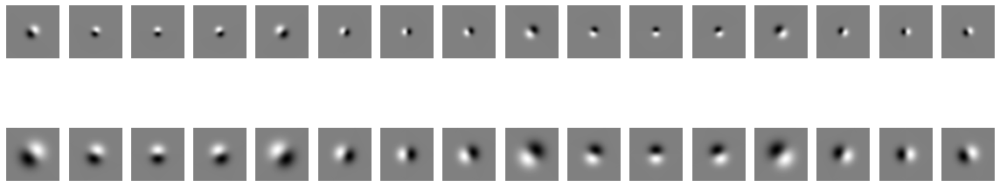

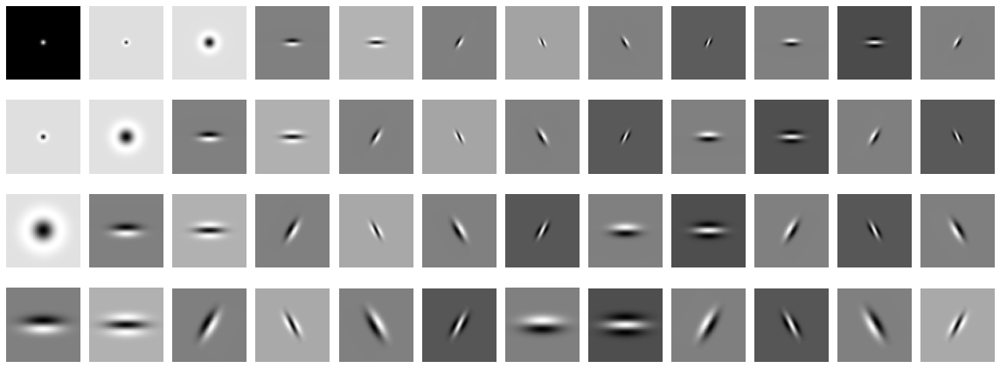

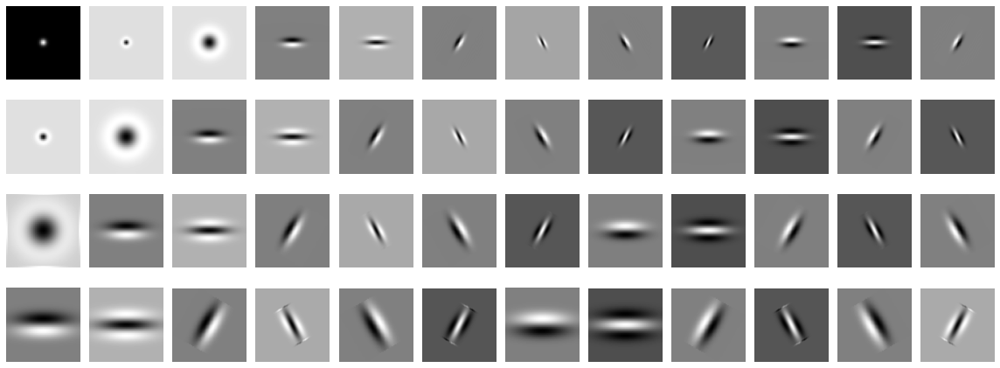

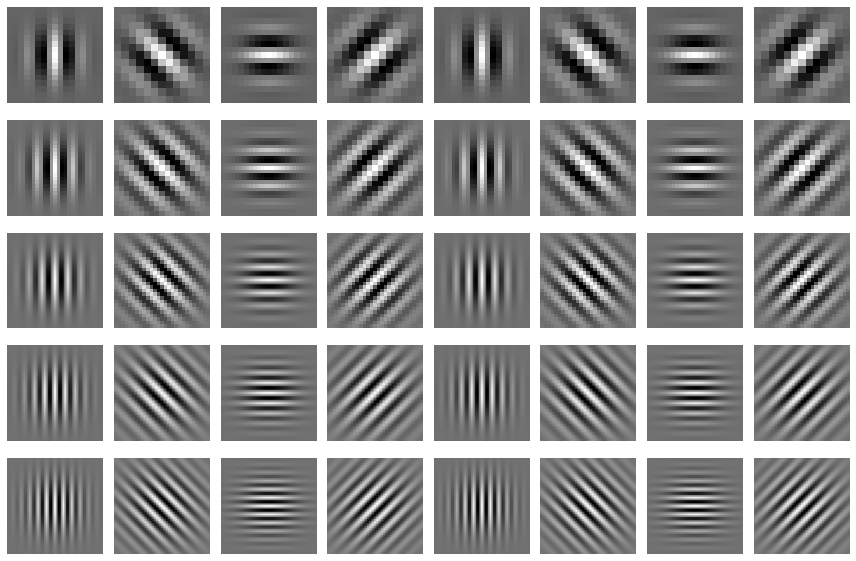

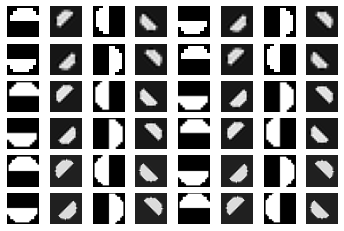

FileNotFoundError: [WinError 3] The system cannot find the path specified: '/content/data/Images'

In [ ]:
#Phase 1 code

import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from scipy.ndimage import convolve, rotate
import os
import glob
import imutils
import math

#Generate Gaussian filter (Refer formula wikipedia)
def Gen_Gaussian(Size, SigmaX, SigmaY):
    x, y = np.mgrid[-Size/2:Size/2+1, -Size/2:Size/2+1]
    GaussianFilter = np.exp(-(x**2/(2 * SigmaX**2) + y ** 2/(2 * SigmaY**2)))/(2 * math.pi * SigmaX*SigmaY)

    return GaussianFilter

#First derivative of Gaussian
def Gen_DoGFilter(Size, SigmaX, SigmaY, Orientation):
    SobelX = np.array([
        [-1, 0, 1],
        [-2, 0, 2],
        [-1, 0, 1]])/8
    SobelY = np.transpose(SobelX)

    GaussianFilter = Gen_Gaussian(Size, SigmaX, SigmaY)
    DoGFilter = convolve(GaussianFilter, SobelY)
    OrientedDoGFilter = rotate(DoGFilter, Orientation)

    return OrientedDoGFilter

#Second derivative of Gaussian
def Gen_SecondDoGFilter(Size, SigmaX, SigmaY, Orientation):
    SobelX = np.array([
        [-1, 0, 1],
        [-2, 0, 2],
        [-1, 0, 1]])/8
    SobelY = np.transpose(SobelX)

    DoGFilter = Gen_DoGFilter(Size, SigmaX, SigmaY, Orientation)
    SecondDoGFilter = convolve(DoGFilter, SobelY)
    OrientedSecondDoGFilter = rotate(SecondDoGFilter, Orientation)
    return OrientedSecondDoGFilter


def LaplacianOfGaussian(Size, SigmaX, SigmaY):
    LaplacianNegative = np.array([
        [0, 1, 0],
        [1, -4, 1],
        [0, 1, 0]])

    GaussianFilter = Gen_Gaussian(Size, SigmaX, SigmaY)
    LoGFilter = convolve(GaussianFilter, LaplacianNegative)
    return LoGFilter

#for gradient
def CreateBinary(Img, Bins):
	BinaryImg = Img * 0
	for a in range(0, Img.shape[0]):
		for b in range(0, Img.shape[1]):
			if Img[a, b] == Bins:
				BinaryImg[a, b] = 1
			else:
				BinaryImg[a, b] = 0
	return BinaryImg


def Gradient(Maps, Bins, m1, m2):
	Maps = Maps.astype(np.float64)
	gradient = np.zeros((Maps.shape[0], Maps.shape[1], 12))
	for m in range(0, 12):
		chi_sq = np.zeros((Maps.shape))
		for i in range(1, Bins):
			tmp = CreateBinary(Maps, i)
			a = cv2.filter2D(tmp, -1, m1[m]) #!!convolve not working here!!
			b = cv2.filter2D(tmp, -1,  m2[m])
			chi_sq = chi_sq + ((a - b) ** 2) / (a + b + 0.0001)
		gradient[:, :, m] = chi_sq

	return gradient


#For half disc
def HalfDisc(r):
    hd = np.zeros((r*2,r*2))
    for i in range(0,r):
        m = (i-r)**2
        for j in range(0,2*r):
            if m+(j-r)**2 < r**2:
                hd[i,j] =1
    return hd


#Filters.
def OrientedDoG():
    Size=64
    Scales=[4,8]
    Orientations=16

    Sobel_x = np.array([
        [-1, 0, 1],
        [-2, 0, 2], 
        [-1, 0, 1]])
    Sobel_y = np.array([
        [1, 2, 1],
        [0, 0, 0], 
        [-1, -2, -1]])
  
    DoGFilter = []
  
    for s in Scales :
        gaussian_kernel = Gen_Gaussian(Size, s, s)
    
        DoGaussian_x = convolve(gaussian_kernel, Sobel_x)
        DoGaussian_y = convolve(gaussian_kernel, Sobel_y)

        DoGaussian= 0.5*DoGaussian_x+0.5*DoGaussian_y

        for o in range(Orientations):
            f = rotate(DoGaussian,o*360.0/Orientations)
            DoGFilter.append(f)

    fig, ax = plt.subplots(2,16,figsize=(16,16))

    for i in range(2):
        for j in range(16):
            ax[i][j].imshow(DoGFilter[(i*16)+j], cmap='gray')
            ax[i][j].set_axis_off()
    fig.tight_layout(h_pad=-50)
    plt.show()
	
    return DoGFilter

#Leung-Malik
def LMSFilter(Size):
    LMSFilter = []
    Orientations = 6
    Scales = [1, math.sqrt(2), 2, 2*math.sqrt(2)] #!!!imp check

    for s in Scales:
        LMSFilter.append(Gen_Gaussian(Size, s, s))
        LMSFilter.append(LaplacianOfGaussian(Size, s, s))
        LMSFilter.append(LaplacianOfGaussian(Size, 3*s, 3*s)) #two sigmas
        for o in range(Orientations):
            LMSFilter.append(Gen_DoGFilter(Size, s, 3*s, o*360/Orientations))
            LMSFilter.append(Gen_SecondDoGFilter(Size, s, 3*s, o*360/Orientations))
            
    fig, ax = plt.subplots(4,12,figsize=(16,16))
            
    for i in range(4):
        for j in range(12):
            ax[i][j].imshow(LMSFilter[(i*16)+j], cmap='gray')
            ax[i][j].set_axis_off()
        fig.tight_layout(h_pad=-20)
    plt.show()
    
    return LMSFilter


def LMLFilter(Size):
    LMLFilter= []
    Orientations = 6
    Scales = [math.sqrt(2), 2, 2*math.sqrt(2), 4] #imp!!! check

    for s in Scales:
        LMLFilter.append(Gen_Gaussian(Size, s, s))
        LMLFilter.append(LaplacianOfGaussian(Size, s, s))
        LMLFilter.append(LaplacianOfGaussian(Size, 3*s, 3*s)) #two sigmas
        for o in range(Orientations):
            LMLFilter.append(Gen_DoGFilter(Size, s, 3*s, o*360/Orientations))
            LMLFilter.append(Gen_SecondDoGFilter(Size, s, 3*s, o*360/Orientations))          

    fig, ax = plt.subplots(4,12,figsize=(16,16))
            
    for i in range(4):
        for j in range(12):
            ax[i][j].imshow(LMLFilter[(i*16)+j], cmap='gray')
            ax[i][j].set_axis_off()
        fig.tight_layout(h_pad=-20)
    plt.show()

    return LMLFilter


#Gabor filter Refered from wikipedia
def Gabor():
    Sigma = [3,5,7,9,11]
    Theta = [np.pi*i/4 for i in range(8)]
    Lambda=5
    Psi=0
    Gamma=1
    gbFilter=[]
    for i in range(len(Sigma)):
        for j in range(len(Theta)):
            SigmaX = Sigma[i]
            SigmaY = Sigma[i]/Gamma

            nstds = 2.5 
            xmax = max(abs(nstds * SigmaX * np.cos(Theta[j])), abs(nstds * SigmaY * np.sin(Theta[j])))
            xmax = np.ceil(max(1, xmax))
            ymax = max(abs(nstds * SigmaX * np.sin(Theta[j])), abs(nstds * SigmaY * np.cos(Theta[j])))
            ymax = np.ceil(max(1, ymax))
            xmin = -xmax
            ymin = -ymax
            (y, x) = np.meshgrid(np.arange(ymin, ymax + 1), np.arange(xmin, xmax + 1))

            ThetaX = x * np.cos(Theta[j]) + y * np.sin(Theta[j])
            ThetaY = -x * np.sin(Theta[j]) + y * np.cos(Theta[j])

            gb = np.exp(-.5 * (ThetaX ** 2 / SigmaX ** 2 + ThetaY ** 2 / SigmaY ** 2)) * np.cos(2 * np.pi / Lambda * ThetaY + Psi)
            gbFilter.append(gb)

    fig, ax = plt.subplots(5,8, figsize=(12,12))
  
    for i in range(5):
        for j in range(8):
            ax[i][j].imshow(gbFilter[(i*8)+j], cmap='gray')
            ax[i][j].set_axis_off()
    fig.tight_layout(h_pad=-7)
    plt.show(block=False)

    return gbFilter

def main():
  #initiate filters
	DoG = OrientedDoG()
	L1 = LMSFilter(48)
	L2 = LMLFilter(48)
	G = Gabor()
 
  #Half discs
	Orientation = np.arange(0, 360, 360 / 8)
	Scales = np.asarray([5, 7, 10])
	m3 = []
	m4 = []

	for i in range(0, Scales.size):
		hd = HalfDisc(Scales[i])
		for m in range(0, Orientation.size):
			m1 = rotate(hd, Orientation[m])
			m3.append(m1)
			m2 = rotate(m1, 180)
			m4.append(m2)
			plt.subplot(Scales.size * 2, Orientation.size, Orientation.size * 2 * (i) + m + 1)
			plt.axis('off')
			plt.imshow(m1, cmap='gray')
			plt.subplot(Scales.size * 2, Orientation.size, Orientation.size * 2 * (i) + m + 1 + Orientation.size)
			plt.axis('off')
			plt.imshow(m2, cmap='gray')
	plt.show()

	#append all filter banks
	FilterBank = []
	for i in range(0, len(DoG)):
		FilterBank.append(DoG[i])

	for i in range(0, 48):
		FilterBank.append(L1[i])
		FilterBank.append(L2[i])

	for i in range(len(G)):
		FilterBank.append(G[i])
  
  #Load the images
	os.chdir("/Phase1/BSDS500/Images")

	Images = []
	for img in sorted(glob.glob("*.jpg")):
		img_ = cv2.imread(img)
		Images.append(img_)

	ImageNo = 7 #Will range from 0-9.
	plt.imshow(cv2.cvtColor(Images[ImageNo], cv2.COLOR_BGR2RGB))
	plt.show()

	Img = cv2.cvtColor(Images[ImageNo], cv2.COLOR_BGR2GRAY) #grayscale image for brightness map
	ImgCurr = Images[ImageNo] #colored image for color map

  #Texton map and gradient calculation
	data = np.zeros((Img.size, len(FilterBank)))
	for i in range(0, len(FilterBank)):
		temp = convolve(Img, FilterBank[i])
		temp = temp.reshape((1, Img.size))
		data[:, i] = temp
	Kmeans_texton = KMeans(n_clusters=64, n_init=4)
	Kmeans_texton.fit(data)
	labels = Kmeans_texton.labels_
	TextonMap = np.reshape(labels, (Img.shape))
	plt.imshow(TextonMap, cmap=None)
	plt.title("TextonMap")
	plt.axis('off')
	plt.show()
	texton_gradient = Gradient(TextonMap, 64, m1, m2)
	tg = np.mean(texton_gradient, axis=2)
	plt.imshow(tg, cmap=None)
	plt.title("TextonGradient")
	plt.axis('off')
	plt.show()

  #brightness map and gradient calculation
	m = Img.reshape((Img.shape[0] * Img.shape[1]), 1) #1 color channel
  #print(m)
	Kmeans_brightness = KMeans(n_clusters=16, random_state=4)
	Kmeans_brightness.fit(m)
	labels = Kmeans_brightness.labels_
	BrightnessMap = np.reshape(labels, (Img.shape[0], Img.shape[1]))
	BrightnessMapF = 255 * (BrightnessMap - np.min(BrightnessMap)) / np.float((np.max(BrightnessMap) - np.min(BrightnessMap)))
	plt.imshow(BrightnessMapF, cmap=None)
	plt.title("BrightnessMap")
	plt.axis('off')
	plt.show()
	bright_gradient = Gradient(BrightnessMap, 16, m1, m2)
	bg = np.mean(bright_gradient, axis=2)
	plt.imshow(bg, cmap=None)
	plt.title("BrightnessGradient")
	plt.axis('off')
	plt.show()
 
  #color map and gradient calculation
	m = ImgCurr.reshape((ImgCurr.shape[0] * ImgCurr.shape[1]), 3) #3 color channels
  #print(m)
	Kmeans_color = KMeans(n_clusters=16, random_state=4)
	Kmeans_color.fit(m)
	labels = Kmeans_color.labels_
	ColorMap = np.reshape(labels, (Img.shape[0], Img.shape[1]))
	plt.imshow(ColorMap)
	plt.title("ColorMap")
	plt.axis('off')
	plt.show()
	color_gradient = Gradient(ColorMap, 16, m1, m2)
	cg = np.mean(color_gradient, axis=2)
	plt.imshow(cg)
	plt.title("ColorGradient")
	plt.axis('off')
	plt.show()

	os.chdir("/Phase1/BSDS500/SobelBaseline")
	s = cv2.imread("{}.png".format(ImageNo))
	plt.imshow(s)
	plt.axis('off')
	plt.show()


	os.chdir("/Phase1/BSDS500/CannyBaseline")
	c = cv2.imread("{}.png".format(ImageNo))
	plt.imshow(c)
	plt.axis('off')
	plt.show()

	sm = cv2.cvtColor(s, cv2.COLOR_BGR2GRAY) #convert to grayscale
	cm = cv2.cvtColor(c, cv2.COLOR_BGR2GRAY)

	Avg_ = (tg + bg + cg) / 3
	pb = Avg_ * (0.9 * cm + 0.1 * sm) #w1 and w2 adjust

	plt.imshow(pb, cmap="gray")
	plt.axis('off')
	plt.show()
    
if __name__ == '__main__':
    main()

In [ ]:
"""
RBE/CS549 Spring 2022: Computer Vision
Homework 0: Alohomora: Phase 2 Starter Code


Colab file can be found at:
    https://colab.research.google.com/drive/1FUByhYCYAfpl8J9VxMQ1DcfITpY8qgsF

Author(s): 
Prof. Nitin J. Sanket (nsanket@wpi.edu), Lening Li (lli4@wpi.edu), Gejji, Vaishnavi Vivek (vgejji@wpi.edu)
Robotics Engineering Department,
Worcester Polytechnic Institute


Code adapted from CMSC733 at the University of Maryland, College Park.
"""

import torch.nn as nn
import torch.nn.functional as F
import numpy as np

def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))

def loss_fn(out, labels):
    ###############################################
    # Fill your loss function of choice here!
    ###############################################
    
    loss = nn.functional.cross_entropy(out, labels)
    return loss

class ImageClassificationBase(nn.Module):
    def training_step(self, batch):
        images, labels = batch 
        out = self(images)                  # Generate predictions
        loss = loss_fn(out, labels) # Calculate loss
        return loss
    
    def validation_step(self, batch):
        images, labels = batch 
        out = self(images)                    # Generate predictions
        loss = loss_fn(out, labels)   # Calculate loss
        acc = accuracy(out, labels)           # Calculate accuracy
        return {'loss': loss.detach(), 'acc': acc}
        
    def validation_epoch_end(self, outputs):
        batch_losses = [x['loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        batch_accs = [x['acc'] for x in outputs]
        epoch_acc = torch.stack(batch_accs).mean()      # Combine accuracies
        return {'loss': epoch_loss.item(), 'acc': epoch_acc.item()}
    
    def epoch_end(self, epoch, result):
        print("Epoch [{}], loss: {:.4f}, acc: {:.4f}".format(epoch, result['loss'], result['acc']))


class CIFAR10Model(ImageClassificationBase):
    def __init__(self, InputSize, OutputSize):
        super().__init__()
      
        self.conv1 = nn.Conv2d(3, 6, 5) 
        self.pool = nn.MaxPool2d(2, 2) 
        self.conv2 = nn.Conv2d(6, 16, 5) 
        self.fc1 = nn.Linear(16 * 5 * 5, 120) 
        self.fc2 = nn.Linear(120, 84) 
        self.fc3 = nn.Linear(84, 10) 
        
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = torch.flatten(x, 1) 
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
class CIFAR10Modelmodified(ImageClassificationBase):
    def __init__(self, InputSize, OutputSize):
        super().__init__()
      
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.pool = nn.MaxPool2d(2, 2) 
        self.bn1 = nn.BatchNorm2d(6)
        self.conv2 = nn.Conv2d(6, 16, 5) 
        self.bn2 = nn.BatchNorm2d(16)
        self.fc1 = nn.Linear(16 * 5 * 5, 120)
        self.fc2 = nn.Linear(120, 84) 
        self.fc3 = nn.Linear(84, 10) 
        
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.bn1(x)
        x = self.pool(F.relu(self.conv2(x)))
        x = self.bn2(x)
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

class SimpleResidualBlock(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU()
        
    def forward(self, x):
        out = self.conv1(x)
        out = self.relu1(out)
        out = self.conv2(out)
        return self.relu2(out) + x 

def conv_block(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1), 
              nn.BatchNorm2d(out_channels), 
              nn.ReLU(inplace=True)]
    if pool: layers.append(nn.MaxPool2d(2))
    return nn.Sequential(*layers)


class ResNet9(ImageClassificationBase):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        
        self.conv1 = conv_block(in_channels, 64)
        self.conv2 = conv_block(64, 128, pool=True)
        self.res1 = nn.Sequential(conv_block(128, 128), conv_block(128, 128))
        
        self.conv3 = conv_block(128, 256, pool=True)
        self.conv4 = conv_block(256, 512, pool=True)
        self.res2 = nn.Sequential(conv_block(512, 512), conv_block(512, 512))
        
        self.classifier = nn.Sequential(nn.MaxPool2d(4), 
                                        nn.Flatten(), 
                                        nn.Linear(512, num_classes))
        
    def forward(self, xb):
        out = self.conv1(xb)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.conv3(out)
        out = self.conv4(out)
        out = self.res2(out) + out
        out = self.classifier(out)
        return out


In [ ]:
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [ ]:
import torch
from torchvision import models
from torchsummary import summary

a = CIFAR10Model(InputSize=3*32*32,OutputSize=10) 

summary(a, (3, 32, 32))

In [ ]:
import torch

class HomographyModel(torch.nn.Module):
    def _init_(self):
        super(HomographyModel, self)._init_()

        self.model = torch.nn.Sequential(*[
            torch.nn.Conv2d(2,64,3,1),
            torch.nn.BatchNorm2d(64),
            torch.nn.ReLU(),
            torch.nn.Conv2d(64,64,3,1),
            torch.nn.BatchNorm2d(64),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d(2),
            
            torch.nn.Conv2d(64,64,3,1),
            torch.nn.BatchNorm2d(64),
            torch.nn.ReLU(),
            torch.nn.Conv2d(64,64,3,1),
            torch.nn.BatchNorm2d(64),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d(2),

            torch.nn.Conv2d(64,128,3,1),
            torch.nn.BatchNorm2d(128),
            torch.nn.ReLU(),
            torch.nn.Conv2d(128,128,3,1),
            torch.nn.BatchNorm2d(128),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d(2),

            torch.nn.Conv2d(128,128,3,1),
            torch.nn.BatchNorm2d(128),
            torch.nn.ReLU(),
            torch.nn.Conv2d(128,128,3,1),
            torch.nn.BatchNorm2d(128),
            torch.nn.ReLU(),

        ])

        self.regress = torch.nn.Sequential(*[ 
            torch.nn.AdaptiveMaxPool2d(1),
            torch.nn.Flatten(),
            torch.nn.Linear(128, 1024),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(1024,8) ])
    
    def forward(self, x):
        out = self.model(x)
        return self.regress(out)

In [ ]:
#for netron onnx model needed

import io
import numpy as np

from torch import nn
import torch.utils.model_zoo as model_zoo
import torch.onnx

batch_size=64
model = HomographyModel
# Input to the model
x = torch.randn(batch_size, 2, 128, 128, requires_grad=True)
torch_out = model(self, x)

# Export the model
torch.onnx.export(model,               # model being run                     # model input (or a tuple for multiple inputs)
                  "/content/super_resolution4.onnx",   # where to save the model (can be a file or file-like object)
                  export_params=True,        # store the trained parameter weights inside the model file
                  opset_version=10,          # the ONNX version to export the model to
                  do_constant_folding=True,  # whether to execute constant folding for optimization
                  input_names = ['InputSize'],   # the model's input names
                  output_names = ['OutputSize'], # the model's output names
                  dynamic_axes={'input' : {0 : 'batch_size'},    # variable length axes
                                'output' : {0 : 'batch_size'}})

NameError: ignored

In [ ]:
#!/usr/bin/env python3

"""
RBE/CS549 Spring 2022: Computer Vision
Homework 0: Alohomora: Phase 2 Starter Code


Author(s):
Prof. Nitin J. Sanket (nsanket@wpi.edu)
Assistant Professor,
Robotics Engineering Department,
Worcester Polytechnic Institute

Code adapted from CMSC733 at the University of Maryland, College Park.
"""

import os
import cv2
import numpy as np
import random
import skimage
import PIL
import sys
# Don't generate pyc codes
sys.dont_write_bytecode = True

def SetupAll(BasePath, CheckPointPath):
    """
    Inputs: 
    BasePath is the base path where Images are saved without "/" at the end
    CheckPointPath - Path to save checkpoints/model
    Outputs:
    DirNamesTrain - Variable with Subfolder paths to train files
    SaveCheckPoint - Save checkpoint every SaveCheckPoint iteration in every epoch, checkpoint saved automatically after every epoch
    ImageSize - Size of the image
    NumTrainSamples - length(Train)
    NumTestRunsPerEpoch - Number of passes of Val data with MiniBatchSize 
    Trainabels - Labels corresponding to Train
    NumClasses - Number of classes
    """
    # Setup DirNames
    DirNamesTrain =  SetupDirNames(BasePath)

    # Read and Setup Labels
    LabelsPathTrain = './TxtFiles/LabelsTrain.txt'
    TrainLabels = ReadLabels(LabelsPathTrain)

    # If CheckPointPath doesn't exist make the path
    if(not (os.path.isdir(CheckPointPath))):
       os.makedirs(CheckPointPath)
        
    # Save checkpoint every SaveCheckPoint iteration in every epoch, checkpoint saved automatically after every epoch
    SaveCheckPoint = 500 
    # Number of passes of Val data with MiniBatchSize 
    NumTestRunsPerEpoch = 15
    
    # Image Input Shape
    ImageSize = [32, 32, 3]
    NumTrainSamples = len(DirNamesTrain)

    # Number of classes
    NumClasses = 10

    return DirNamesTrain, SaveCheckPoint, ImageSize, NumTrainSamples, TrainLabels, NumClasses

def ReadLabels(LabelsPathTrain):
    if(not (os.path.isfile(LabelsPathTrain))):
        print('ERROR: Train Labels do not exist in '+LabelsPathTrain)
        sys.exit()
    else:
        TrainLabels = open(LabelsPathTrain, 'r')
        TrainLabels = TrainLabels.read()
        TrainLabels = map(float, TrainLabels.split())

    return TrainLabels
    

def SetupDirNames(BasePath): 
    """
    Inputs: 
    BasePath is the base path where Images are saved without "/" at the end
    Outputs:
    Writes a file ./TxtFiles/DirNames.txt with full path to all image files without extension
    """
    DirNamesTrain = ReadDirNames('./TxtFiles/DirNamesTrain.txt')        
    
    return DirNamesTrain

def ReadDirNames(ReadPath):
    """
    Inputs: 
    ReadPath is the path of the file you want to read
    Outputs:
    DirNames is the data loaded from ./TxtFiles/DirNames.txt which has full path to all image files without extension
    """
    # Read text files
    DirNames = open(ReadPath, 'r')
    DirNames = DirNames.read()
    DirNames = DirNames.split()
    return DirNames


In [ ]:
#!/usr/bin/env python3

"""
RBE/CS549 Spring 2022: Computer Vision
Homework 0: Alohomora: Phase 2 Starter Code


Author(s):
Prof. Nitin J. Sanket (nsanket@wpi.edu)
Assistant Professor,
Robotics Engineering Department,
Worcester Polytechnic Institute

Code adapted from CMSC733 at the University of Maryland, College Park.
"""

import time
import glob
import os
import sys
import matplotlib.pyplot as plt
import numpy as np

# Don't generate pyc codes
sys.dont_write_bytecode = True

def tic():
    """
    Function to start timer
    Tries to mimic tic() toc() in MATLAB
    """
    StartTime = time.time()
    return StartTime

def toc(StartTime):
    """
    Function to stop timer
    Tries to mimic tic() toc() in MATLAB
    """
    return time.time() - StartTime

def FindLatestModel(CheckPointPath):
    """
    Finds Latest Model in CheckPointPath
    Inputs:
    CheckPointPath - Path where you have stored checkpoints
    Outputs:
    LatestFile - File Name of the latest checkpoint
    """
    FileList = glob.glob(CheckPointPath + '*.ckpt.index') # * means all if need specific format then *.csv
    LatestFile = max(FileList, key=os.path.getctime)
    # Strip everything else except needed information
    LatestFile = LatestFile.replace(CheckPointPath, '')
    LatestFile = LatestFile.replace('.ckpt.index', '')
    return LatestFile


def convertToOneHot(vector, NumClasses):
    """
    vector - vector of argmax indexes
    NumClasses - Number of classes
    """
    return np.equal.outer(vector, np.arange(NumClasses)).astype(np.float)




Files already downloaded and verified
Number of Epochs Training will run for 15
Factor of reduction in training data is 2
Mini Batch Size 1
Number of Training Images 50000
New model initialized....


  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a0model.ckpt Model Saved...
Epoch [0], loss: 2.2530, acc: 0.0000
Epoch [1], loss: 2.3481, acc: 0.0000
Epoch [2], loss: 2.2773, acc: 0.0000
Epoch [3], loss: 2.3072, acc: 0.0000
Epoch [4], loss: 2.3575, acc: 0.0000
Epoch [5], loss: 2.3031, acc: 0.0000
Epoch [6], loss: 2.4291, acc: 0.0000
Epoch [7], loss: 2.1741, acc: 1.0000
Epoch [8], loss: 2.2940, acc: 0.0000
Epoch [9], loss: 2.2783, acc: 0.0000
Epoch [10], loss: 2.2479, acc: 0.0000
Epoch [11], loss: 2.2969, acc: 0.0000
Epoch [12], loss: 2.2809, acc: 0.0000
Epoch [13], loss: 2.2925, acc: 0.0000
Epoch [14], loss: 2.4198, acc: 0.0000
Epoch [15], loss: 2.2917, acc: 0.0000
Epoch [16], loss: 2.3634, acc: 0.0000
Epoch [17], loss: 2.4202, acc: 0.0000
Epoch [18], loss: 2.3588, acc: 0.0000
Epoch [19], loss: 2.2817, acc: 0.0000
Epoch [20], loss: 2.2841, acc: 0.0000
Epoch [21], loss: 2.2737, acc: 0.0000
Epoch [22], loss: 2.3560, acc: 0.0000
Epoch [23], loss: 2.4176, acc: 0.

Epoch [211], loss: 2.2841, acc: 0.0000
Epoch [212], loss: 2.3544, acc: 0.0000
Epoch [213], loss: 2.2690, acc: 0.0000
Epoch [214], loss: 2.2838, acc: 0.0000
Epoch [215], loss: 2.3065, acc: 0.0000
Epoch [216], loss: 2.3063, acc: 0.0000
Epoch [217], loss: 2.1747, acc: 1.0000
Epoch [218], loss: 2.2985, acc: 0.0000
Epoch [219], loss: 2.1749, acc: 1.0000
Epoch [220], loss: 2.4011, acc: 0.0000
Epoch [221], loss: 2.1770, acc: 1.0000
Epoch [222], loss: 2.3058, acc: 0.0000
Epoch [223], loss: 2.3507, acc: 0.0000
Epoch [224], loss: 2.1739, acc: 1.0000
Epoch [225], loss: 2.3517, acc: 0.0000
Epoch [226], loss: 2.3559, acc: 0.0000
Epoch [227], loss: 2.3996, acc: 0.0000
Epoch [228], loss: 2.2728, acc: 0.0000
Epoch [229], loss: 2.3866, acc: 0.0000
Epoch [230], loss: 2.3049, acc: 0.0000
Epoch [231], loss: 2.3965, acc: 0.0000
Epoch [232], loss: 2.2893, acc: 0.0000
Epoch [233], loss: 2.2989, acc: 0.0000
Epoch [234], loss: 2.2928, acc: 0.0000
Epoch [235], loss: 2.2694, acc: 0.0000
Epoch [236], loss: 2.2943

Epoch [425], loss: 2.3135, acc: 0.0000
Epoch [426], loss: 2.3585, acc: 0.0000
Epoch [427], loss: 2.2223, acc: 1.0000
Epoch [428], loss: 2.3212, acc: 0.0000
Epoch [429], loss: 2.2576, acc: 0.0000
Epoch [430], loss: 2.2232, acc: 1.0000
Epoch [431], loss: 2.4057, acc: 0.0000
Epoch [432], loss: 2.2743, acc: 0.0000
Epoch [433], loss: 2.3113, acc: 0.0000
Epoch [434], loss: 2.2157, acc: 1.0000
Epoch [435], loss: 2.3246, acc: 0.0000
Epoch [436], loss: 2.3591, acc: 0.0000
Epoch [437], loss: 2.3530, acc: 0.0000
Epoch [438], loss: 2.3504, acc: 0.0000
Epoch [439], loss: 2.2069, acc: 1.0000
Epoch [440], loss: 2.3415, acc: 0.0000
Epoch [441], loss: 2.3411, acc: 0.0000
Epoch [442], loss: 2.3112, acc: 0.0000
Epoch [443], loss: 2.3328, acc: 0.0000
Epoch [444], loss: 2.4111, acc: 0.0000
Epoch [445], loss: 2.2867, acc: 0.0000
Epoch [446], loss: 2.3269, acc: 0.0000
Epoch [447], loss: 2.3150, acc: 0.0000
Epoch [448], loss: 2.3262, acc: 0.0000
Epoch [449], loss: 2.3199, acc: 0.0000
Epoch [450], loss: 2.4086

Epoch [640], loss: 2.2912, acc: 0.0000
Epoch [641], loss: 2.3258, acc: 0.0000
Epoch [642], loss: 2.3002, acc: 0.0000
Epoch [643], loss: 2.3028, acc: 0.0000
Epoch [644], loss: 2.2611, acc: 0.0000
Epoch [645], loss: 2.3110, acc: 0.0000
Epoch [646], loss: 2.2265, acc: 1.0000
Epoch [647], loss: 2.2870, acc: 0.0000
Epoch [648], loss: 2.3125, acc: 0.0000
Epoch [649], loss: 2.2788, acc: 0.0000
Epoch [650], loss: 2.2930, acc: 0.0000
Epoch [651], loss: 2.2793, acc: 0.0000
Epoch [652], loss: 2.3328, acc: 0.0000
Epoch [653], loss: 2.2840, acc: 0.0000
Epoch [654], loss: 2.3020, acc: 0.0000
Epoch [655], loss: 2.3303, acc: 0.0000
Epoch [656], loss: 2.2965, acc: 0.0000
Epoch [657], loss: 2.3067, acc: 0.0000
Epoch [658], loss: 2.3319, acc: 0.0000
Epoch [659], loss: 2.3173, acc: 0.0000
Epoch [660], loss: 2.3190, acc: 0.0000
Epoch [661], loss: 2.2442, acc: 0.0000
Epoch [662], loss: 2.2269, acc: 1.0000
Epoch [663], loss: 2.3131, acc: 0.0000
Epoch [664], loss: 2.3319, acc: 0.0000
Epoch [665], loss: 2.2201

Epoch [875], loss: 2.3265, acc: 0.0000
Epoch [876], loss: 2.2045, acc: 1.0000
Epoch [877], loss: 2.2215, acc: 1.0000
Epoch [878], loss: 2.3465, acc: 0.0000
Epoch [879], loss: 2.3051, acc: 0.0000
Epoch [880], loss: 2.2253, acc: 1.0000
Epoch [881], loss: 2.3271, acc: 0.0000
Epoch [882], loss: 2.3060, acc: 0.0000
Epoch [883], loss: 2.2357, acc: 0.0000
Epoch [884], loss: 2.2592, acc: 0.0000
Epoch [885], loss: 2.2231, acc: 1.0000
Epoch [886], loss: 2.3338, acc: 0.0000
Epoch [887], loss: 2.2472, acc: 0.0000
Epoch [888], loss: 2.3448, acc: 0.0000
Epoch [889], loss: 2.2851, acc: 0.0000
Epoch [890], loss: 2.3212, acc: 0.0000
Epoch [891], loss: 2.3405, acc: 0.0000
Epoch [892], loss: 2.3269, acc: 0.0000
Epoch [893], loss: 2.2295, acc: 1.0000
Epoch [894], loss: 2.2207, acc: 1.0000
Epoch [895], loss: 2.3385, acc: 0.0000
Epoch [896], loss: 2.2263, acc: 0.0000
Epoch [897], loss: 2.3548, acc: 0.0000
Epoch [898], loss: 2.3362, acc: 0.0000
Epoch [899], loss: 2.2466, acc: 0.0000
Epoch [900], loss: 2.3393

Epoch [1093], loss: 2.3227, acc: 0.0000
Epoch [1094], loss: 2.3381, acc: 0.0000
Epoch [1095], loss: 2.2594, acc: 0.0000
Epoch [1096], loss: 2.2780, acc: 0.0000
Epoch [1097], loss: 2.3176, acc: 0.0000
Epoch [1098], loss: 2.2904, acc: 0.0000
Epoch [1099], loss: 2.3008, acc: 0.0000
Epoch [1100], loss: 2.3326, acc: 0.0000
Epoch [1101], loss: 2.2136, acc: 0.0000
Epoch [1102], loss: 2.1517, acc: 1.0000
Epoch [1103], loss: 2.3298, acc: 0.0000
Epoch [1104], loss: 2.3433, acc: 0.0000
Epoch [1105], loss: 2.2847, acc: 0.0000
Epoch [1106], loss: 2.3140, acc: 0.0000
Epoch [1107], loss: 2.3918, acc: 0.0000
Epoch [1108], loss: 2.3771, acc: 0.0000
Epoch [1109], loss: 2.1214, acc: 1.0000
Epoch [1110], loss: 2.1773, acc: 1.0000
Epoch [1111], loss: 2.2973, acc: 0.0000
Epoch [1112], loss: 2.2863, acc: 0.0000
Epoch [1113], loss: 2.2505, acc: 0.0000
Epoch [1114], loss: 2.3431, acc: 0.0000
Epoch [1115], loss: 2.3100, acc: 0.0000
Epoch [1116], loss: 2.3711, acc: 0.0000
Epoch [1117], loss: 2.2622, acc: 0.0000


Epoch [1319], loss: 2.1244, acc: 0.0000
Epoch [1320], loss: 2.0838, acc: 1.0000
Epoch [1321], loss: 2.1845, acc: 1.0000
Epoch [1322], loss: 2.1621, acc: 0.0000
Epoch [1323], loss: 2.1271, acc: 0.0000
Epoch [1324], loss: 2.2437, acc: 0.0000
Epoch [1325], loss: 2.3210, acc: 0.0000
Epoch [1326], loss: 2.4482, acc: 0.0000
Epoch [1327], loss: 2.1157, acc: 0.0000
Epoch [1328], loss: 2.2959, acc: 0.0000
Epoch [1329], loss: 2.4279, acc: 0.0000
Epoch [1330], loss: 2.2491, acc: 0.0000
Epoch [1331], loss: 2.4575, acc: 0.0000
Epoch [1332], loss: 2.4283, acc: 0.0000
Epoch [1333], loss: 2.2005, acc: 0.0000
Epoch [1334], loss: 2.4443, acc: 0.0000
Epoch [1335], loss: 2.5157, acc: 0.0000
Epoch [1336], loss: 2.1974, acc: 1.0000
Epoch [1337], loss: 2.4055, acc: 0.0000
Epoch [1338], loss: 2.1732, acc: 0.0000
Epoch [1339], loss: 2.2007, acc: 0.0000
Epoch [1340], loss: 2.3227, acc: 0.0000
Epoch [1341], loss: 2.1119, acc: 1.0000
Epoch [1342], loss: 2.2686, acc: 0.0000
Epoch [1343], loss: 2.3589, acc: 0.0000


Epoch [1524], loss: 2.2668, acc: 0.0000
Epoch [1525], loss: 2.2454, acc: 0.0000
Epoch [1526], loss: 2.1990, acc: 1.0000
Epoch [1527], loss: 2.3106, acc: 0.0000
Epoch [1528], loss: 2.5001, acc: 0.0000
Epoch [1529], loss: 2.3269, acc: 0.0000
Epoch [1530], loss: 2.2421, acc: 0.0000
Epoch [1531], loss: 2.0152, acc: 1.0000
Epoch [1532], loss: 2.4236, acc: 0.0000
Epoch [1533], loss: 2.2564, acc: 0.0000
Epoch [1534], loss: 2.3937, acc: 0.0000
Epoch [1535], loss: 2.0692, acc: 1.0000
Epoch [1536], loss: 2.2047, acc: 0.0000
Epoch [1537], loss: 2.3142, acc: 0.0000
Epoch [1538], loss: 1.8393, acc: 1.0000
Epoch [1539], loss: 2.2192, acc: 0.0000
Epoch [1540], loss: 2.1559, acc: 0.0000
Epoch [1541], loss: 2.2676, acc: 0.0000
Epoch [1542], loss: 2.1231, acc: 0.0000
Epoch [1543], loss: 2.0110, acc: 1.0000
Epoch [1544], loss: 2.2699, acc: 0.0000
Epoch [1545], loss: 2.5838, acc: 0.0000
Epoch [1546], loss: 2.2680, acc: 0.0000
Epoch [1547], loss: 1.9434, acc: 1.0000
Epoch [1548], loss: 2.1467, acc: 0.0000


Epoch [1759], loss: 2.0805, acc: 0.0000
Epoch [1760], loss: 2.2522, acc: 0.0000
Epoch [1761], loss: 2.4717, acc: 0.0000
Epoch [1762], loss: 2.6052, acc: 0.0000
Epoch [1763], loss: 2.4857, acc: 0.0000
Epoch [1764], loss: 2.3456, acc: 0.0000
Epoch [1765], loss: 2.2740, acc: 0.0000
Epoch [1766], loss: 2.0943, acc: 1.0000
Epoch [1767], loss: 2.2342, acc: 0.0000
Epoch [1768], loss: 1.9820, acc: 0.0000
Epoch [1769], loss: 2.4526, acc: 0.0000
Epoch [1770], loss: 2.3252, acc: 0.0000
Epoch [1771], loss: 2.4102, acc: 0.0000
Epoch [1772], loss: 2.1221, acc: 0.0000
Epoch [1773], loss: 2.2948, acc: 0.0000
Epoch [1774], loss: 2.2380, acc: 0.0000
Epoch [1775], loss: 2.2579, acc: 0.0000
Epoch [1776], loss: 2.3750, acc: 0.0000
Epoch [1777], loss: 2.4250, acc: 0.0000
Epoch [1778], loss: 2.2668, acc: 0.0000
Epoch [1779], loss: 2.2937, acc: 0.0000
Epoch [1780], loss: 2.3446, acc: 0.0000
Epoch [1781], loss: 2.4669, acc: 0.0000
Epoch [1782], loss: 2.0989, acc: 1.0000
Epoch [1783], loss: 2.1203, acc: 1.0000


Epoch [1986], loss: 2.0970, acc: 1.0000
Epoch [1987], loss: 2.0591, acc: 0.0000
Epoch [1988], loss: 2.0827, acc: 1.0000
Epoch [1989], loss: 1.7872, acc: 0.0000
Epoch [1990], loss: 2.7937, acc: 0.0000
Epoch [1991], loss: 2.3498, acc: 0.0000
Epoch [1992], loss: 2.6067, acc: 0.0000
Epoch [1993], loss: 1.8249, acc: 1.0000
Epoch [1994], loss: 2.0652, acc: 0.0000
Epoch [1995], loss: 1.5947, acc: 1.0000
Epoch [1996], loss: 2.0438, acc: 0.0000
Epoch [1997], loss: 2.2347, acc: 0.0000
Epoch [1998], loss: 2.1457, acc: 0.0000
Epoch [1999], loss: 2.1535, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a2000model.ckpt Model Saved...
Epoch [2000], loss: 2.6845, acc: 0.0000
Epoch [2001], loss: 2.3241, acc: 0.0000
Epoch [2002], loss: 2.4293, acc: 0.0000
Epoch [2003], loss: 2.5098, acc: 0.0000
Epoch [2004], loss: 2.0704, acc: 0.0000
Epoch [2005], loss: 1.9643, acc: 1.0000
Epoch [2006], loss: 2.1544, acc: 1.0000
Epoch [2007], loss: 1.8930, acc: 0.0000
Epoch [2008], 

Epoch [2198], loss: 2.4517, acc: 0.0000
Epoch [2199], loss: 2.1241, acc: 0.0000
Epoch [2200], loss: 2.2793, acc: 0.0000
Epoch [2201], loss: 2.0351, acc: 0.0000
Epoch [2202], loss: 1.9960, acc: 0.0000
Epoch [2203], loss: 2.1232, acc: 0.0000
Epoch [2204], loss: 2.4329, acc: 0.0000
Epoch [2205], loss: 2.5120, acc: 0.0000
Epoch [2206], loss: 2.2589, acc: 0.0000
Epoch [2207], loss: 1.4990, acc: 1.0000
Epoch [2208], loss: 2.6019, acc: 0.0000
Epoch [2209], loss: 2.0222, acc: 0.0000
Epoch [2210], loss: 2.2712, acc: 0.0000
Epoch [2211], loss: 2.2044, acc: 0.0000
Epoch [2212], loss: 2.0458, acc: 1.0000
Epoch [2213], loss: 1.8396, acc: 0.0000
Epoch [2214], loss: 2.3549, acc: 0.0000
Epoch [2215], loss: 1.9274, acc: 1.0000
Epoch [2216], loss: 2.5013, acc: 0.0000
Epoch [2217], loss: 1.7630, acc: 0.0000
Epoch [2218], loss: 2.2748, acc: 0.0000
Epoch [2219], loss: 1.6652, acc: 1.0000
Epoch [2220], loss: 2.3443, acc: 0.0000
Epoch [2221], loss: 1.9101, acc: 1.0000
Epoch [2222], loss: 2.9238, acc: 0.0000


Epoch [2417], loss: 2.7340, acc: 0.0000
Epoch [2418], loss: 2.8017, acc: 0.0000
Epoch [2419], loss: 1.7637, acc: 1.0000
Epoch [2420], loss: 2.1785, acc: 0.0000
Epoch [2421], loss: 2.1078, acc: 0.0000
Epoch [2422], loss: 1.8931, acc: 1.0000
Epoch [2423], loss: 1.7968, acc: 1.0000
Epoch [2424], loss: 2.0290, acc: 0.0000
Epoch [2425], loss: 2.3536, acc: 0.0000
Epoch [2426], loss: 1.9764, acc: 0.0000
Epoch [2427], loss: 1.7711, acc: 1.0000
Epoch [2428], loss: 2.3490, acc: 0.0000
Epoch [2429], loss: 2.2020, acc: 0.0000
Epoch [2430], loss: 1.9406, acc: 0.0000
Epoch [2431], loss: 1.7019, acc: 0.0000
Epoch [2432], loss: 2.2667, acc: 0.0000
Epoch [2433], loss: 2.5404, acc: 0.0000
Epoch [2434], loss: 2.7276, acc: 0.0000
Epoch [2435], loss: 2.0486, acc: 0.0000
Epoch [2436], loss: 1.5839, acc: 1.0000
Epoch [2437], loss: 2.4858, acc: 0.0000
Epoch [2438], loss: 2.4247, acc: 0.0000
Epoch [2439], loss: 2.4764, acc: 0.0000
Epoch [2440], loss: 2.2468, acc: 0.0000
Epoch [2441], loss: 2.2878, acc: 0.0000


Epoch [2643], loss: 2.3083, acc: 0.0000
Epoch [2644], loss: 2.4012, acc: 0.0000
Epoch [2645], loss: 2.2824, acc: 0.0000
Epoch [2646], loss: 1.8020, acc: 0.0000
Epoch [2647], loss: 2.2030, acc: 0.0000
Epoch [2648], loss: 2.4055, acc: 0.0000
Epoch [2649], loss: 1.5271, acc: 1.0000
Epoch [2650], loss: 2.0601, acc: 0.0000
Epoch [2651], loss: 2.2830, acc: 0.0000
Epoch [2652], loss: 1.5875, acc: 0.0000
Epoch [2653], loss: 1.4019, acc: 0.0000
Epoch [2654], loss: 2.7720, acc: 0.0000
Epoch [2655], loss: 1.8291, acc: 0.0000
Epoch [2656], loss: 1.3567, acc: 1.0000
Epoch [2657], loss: 1.7324, acc: 1.0000
Epoch [2658], loss: 1.4854, acc: 1.0000
Epoch [2659], loss: 1.9359, acc: 1.0000
Epoch [2660], loss: 2.1812, acc: 0.0000
Epoch [2661], loss: 1.7802, acc: 0.0000
Epoch [2662], loss: 2.2669, acc: 0.0000
Epoch [2663], loss: 2.1583, acc: 0.0000
Epoch [2664], loss: 1.6500, acc: 1.0000
Epoch [2665], loss: 2.3177, acc: 0.0000
Epoch [2666], loss: 2.0061, acc: 0.0000
Epoch [2667], loss: 2.2806, acc: 0.0000


Epoch [2856], loss: 2.1762, acc: 0.0000
Epoch [2857], loss: 2.1489, acc: 0.0000
Epoch [2858], loss: 2.1648, acc: 0.0000
Epoch [2859], loss: 2.7138, acc: 0.0000
Epoch [2860], loss: 1.8969, acc: 1.0000
Epoch [2861], loss: 1.9074, acc: 0.0000
Epoch [2862], loss: 1.9847, acc: 0.0000
Epoch [2863], loss: 1.6279, acc: 1.0000
Epoch [2864], loss: 2.0825, acc: 0.0000
Epoch [2865], loss: 1.7098, acc: 1.0000
Epoch [2866], loss: 2.7677, acc: 0.0000
Epoch [2867], loss: 1.9768, acc: 0.0000
Epoch [2868], loss: 2.0304, acc: 0.0000
Epoch [2869], loss: 1.2442, acc: 1.0000
Epoch [2870], loss: 1.7290, acc: 0.0000
Epoch [2871], loss: 1.7686, acc: 0.0000
Epoch [2872], loss: 0.9127, acc: 1.0000
Epoch [2873], loss: 2.0120, acc: 1.0000
Epoch [2874], loss: 2.0707, acc: 1.0000
Epoch [2875], loss: 2.8295, acc: 0.0000
Epoch [2876], loss: 2.1476, acc: 0.0000
Epoch [2877], loss: 2.1260, acc: 0.0000
Epoch [2878], loss: 2.2077, acc: 0.0000
Epoch [2879], loss: 1.7563, acc: 1.0000
Epoch [2880], loss: 1.6193, acc: 1.0000


Epoch [3072], loss: 2.1405, acc: 0.0000
Epoch [3073], loss: 1.9776, acc: 0.0000
Epoch [3074], loss: 2.0298, acc: 0.0000
Epoch [3075], loss: 1.8663, acc: 0.0000
Epoch [3076], loss: 1.5526, acc: 1.0000
Epoch [3077], loss: 2.4700, acc: 0.0000
Epoch [3078], loss: 2.4440, acc: 0.0000
Epoch [3079], loss: 1.5238, acc: 1.0000
Epoch [3080], loss: 2.3349, acc: 0.0000
Epoch [3081], loss: 2.5738, acc: 0.0000
Epoch [3082], loss: 2.0613, acc: 0.0000
Epoch [3083], loss: 1.8093, acc: 0.0000
Epoch [3084], loss: 1.4794, acc: 0.0000
Epoch [3085], loss: 1.7896, acc: 0.0000
Epoch [3086], loss: 2.0574, acc: 0.0000
Epoch [3087], loss: 1.1103, acc: 1.0000
Epoch [3088], loss: 1.8762, acc: 1.0000
Epoch [3089], loss: 2.1850, acc: 0.0000
Epoch [3090], loss: 2.3290, acc: 0.0000
Epoch [3091], loss: 2.2775, acc: 0.0000
Epoch [3092], loss: 1.9344, acc: 1.0000
Epoch [3093], loss: 0.8671, acc: 1.0000
Epoch [3094], loss: 2.5205, acc: 0.0000
Epoch [3095], loss: 1.4958, acc: 0.0000
Epoch [3096], loss: 2.0303, acc: 0.0000


Epoch [3296], loss: 2.7907, acc: 0.0000
Epoch [3297], loss: 1.8988, acc: 1.0000
Epoch [3298], loss: 2.5331, acc: 0.0000
Epoch [3299], loss: 0.5628, acc: 1.0000
Epoch [3300], loss: 0.9115, acc: 1.0000
Epoch [3301], loss: 2.4098, acc: 0.0000
Epoch [3302], loss: 2.0312, acc: 0.0000
Epoch [3303], loss: 1.8620, acc: 0.0000
Epoch [3304], loss: 1.7827, acc: 1.0000
Epoch [3305], loss: 1.9097, acc: 0.0000
Epoch [3306], loss: 1.8229, acc: 1.0000
Epoch [3307], loss: 1.6690, acc: 1.0000
Epoch [3308], loss: 3.0470, acc: 0.0000
Epoch [3309], loss: 2.2101, acc: 0.0000
Epoch [3310], loss: 2.0790, acc: 0.0000
Epoch [3311], loss: 2.3461, acc: 0.0000
Epoch [3312], loss: 2.6293, acc: 0.0000
Epoch [3313], loss: 2.0047, acc: 0.0000
Epoch [3314], loss: 2.2352, acc: 0.0000
Epoch [3315], loss: 2.2824, acc: 0.0000
Epoch [3316], loss: 1.5257, acc: 1.0000
Epoch [3317], loss: 2.1266, acc: 0.0000
Epoch [3318], loss: 2.5026, acc: 0.0000
Epoch [3319], loss: 0.8476, acc: 1.0000
Epoch [3320], loss: 3.5830, acc: 0.0000


Epoch [3518], loss: 2.2940, acc: 0.0000
Epoch [3519], loss: 1.5705, acc: 1.0000
Epoch [3520], loss: 2.1133, acc: 0.0000
Epoch [3521], loss: 2.0961, acc: 0.0000
Epoch [3522], loss: 1.1859, acc: 1.0000
Epoch [3523], loss: 1.7436, acc: 0.0000
Epoch [3524], loss: 2.1052, acc: 0.0000
Epoch [3525], loss: 2.0169, acc: 0.0000
Epoch [3526], loss: 2.3767, acc: 0.0000
Epoch [3527], loss: 1.9927, acc: 0.0000
Epoch [3528], loss: 2.1278, acc: 0.0000
Epoch [3529], loss: 2.0424, acc: 0.0000
Epoch [3530], loss: 2.2986, acc: 0.0000
Epoch [3531], loss: 1.8564, acc: 0.0000
Epoch [3532], loss: 2.5242, acc: 0.0000
Epoch [3533], loss: 0.9762, acc: 1.0000
Epoch [3534], loss: 1.1542, acc: 1.0000
Epoch [3535], loss: 2.0907, acc: 0.0000
Epoch [3536], loss: 1.4169, acc: 0.0000
Epoch [3537], loss: 3.3018, acc: 0.0000
Epoch [3538], loss: 1.0040, acc: 1.0000
Epoch [3539], loss: 2.0457, acc: 0.0000
Epoch [3540], loss: 1.0011, acc: 0.0000
Epoch [3541], loss: 1.4904, acc: 1.0000
Epoch [3542], loss: 1.4201, acc: 0.0000


Epoch [3724], loss: 3.0069, acc: 0.0000
Epoch [3725], loss: 2.4663, acc: 0.0000
Epoch [3726], loss: 2.5887, acc: 0.0000
Epoch [3727], loss: 2.3046, acc: 0.0000
Epoch [3728], loss: 1.7644, acc: 1.0000
Epoch [3729], loss: 1.5788, acc: 0.0000
Epoch [3730], loss: 2.0526, acc: 0.0000
Epoch [3731], loss: 2.1600, acc: 0.0000
Epoch [3732], loss: 2.4064, acc: 0.0000
Epoch [3733], loss: 1.5011, acc: 0.0000
Epoch [3734], loss: 2.3595, acc: 0.0000
Epoch [3735], loss: 2.1920, acc: 0.0000
Epoch [3736], loss: 2.3454, acc: 0.0000
Epoch [3737], loss: 2.0141, acc: 0.0000
Epoch [3738], loss: 2.0876, acc: 0.0000
Epoch [3739], loss: 2.1939, acc: 0.0000
Epoch [3740], loss: 1.0192, acc: 1.0000
Epoch [3741], loss: 2.1812, acc: 0.0000
Epoch [3742], loss: 1.9772, acc: 0.0000
Epoch [3743], loss: 1.9320, acc: 0.0000
Epoch [3744], loss: 1.9205, acc: 1.0000
Epoch [3745], loss: 2.1737, acc: 0.0000
Epoch [3746], loss: 1.9328, acc: 0.0000
Epoch [3747], loss: 1.5314, acc: 1.0000
Epoch [3748], loss: 1.9677, acc: 0.0000


Epoch [3951], loss: 1.3947, acc: 1.0000
Epoch [3952], loss: 1.9648, acc: 1.0000
Epoch [3953], loss: 2.4991, acc: 0.0000
Epoch [3954], loss: 2.1207, acc: 0.0000
Epoch [3955], loss: 1.4520, acc: 1.0000
Epoch [3956], loss: 2.4264, acc: 0.0000
Epoch [3957], loss: 2.1197, acc: 0.0000
Epoch [3958], loss: 1.5722, acc: 0.0000
Epoch [3959], loss: 1.7098, acc: 1.0000
Epoch [3960], loss: 1.8262, acc: 1.0000
Epoch [3961], loss: 2.6279, acc: 0.0000
Epoch [3962], loss: 2.6037, acc: 0.0000
Epoch [3963], loss: 2.2710, acc: 0.0000
Epoch [3964], loss: 2.4390, acc: 0.0000
Epoch [3965], loss: 2.7804, acc: 0.0000
Epoch [3966], loss: 1.5777, acc: 0.0000
Epoch [3967], loss: 2.5814, acc: 0.0000
Epoch [3968], loss: 2.0262, acc: 0.0000
Epoch [3969], loss: 1.6709, acc: 1.0000
Epoch [3970], loss: 1.7465, acc: 1.0000
Epoch [3971], loss: 1.6334, acc: 0.0000
Epoch [3972], loss: 2.3492, acc: 0.0000
Epoch [3973], loss: 2.1629, acc: 0.0000
Epoch [3974], loss: 2.2275, acc: 0.0000
Epoch [3975], loss: 1.1700, acc: 1.0000


Epoch [4180], loss: 3.1306, acc: 0.0000
Epoch [4181], loss: 2.2743, acc: 0.0000
Epoch [4182], loss: 2.0986, acc: 0.0000
Epoch [4183], loss: 1.5965, acc: 1.0000
Epoch [4184], loss: 1.7876, acc: 0.0000
Epoch [4185], loss: 1.6505, acc: 0.0000
Epoch [4186], loss: 1.2859, acc: 1.0000
Epoch [4187], loss: 3.3789, acc: 0.0000
Epoch [4188], loss: 2.9319, acc: 0.0000
Epoch [4189], loss: 1.8038, acc: 1.0000
Epoch [4190], loss: 2.2592, acc: 0.0000
Epoch [4191], loss: 1.5438, acc: 1.0000
Epoch [4192], loss: 1.6812, acc: 0.0000
Epoch [4193], loss: 1.7743, acc: 0.0000
Epoch [4194], loss: 1.5478, acc: 0.0000
Epoch [4195], loss: 0.8420, acc: 1.0000
Epoch [4196], loss: 1.9490, acc: 0.0000
Epoch [4197], loss: 1.8407, acc: 0.0000
Epoch [4198], loss: 1.5414, acc: 0.0000
Epoch [4199], loss: 1.1819, acc: 1.0000
Epoch [4200], loss: 2.1633, acc: 0.0000
Epoch [4201], loss: 2.1357, acc: 0.0000
Epoch [4202], loss: 1.2728, acc: 0.0000
Epoch [4203], loss: 1.9716, acc: 0.0000
Epoch [4204], loss: 1.8764, acc: 0.0000


Epoch [4398], loss: 1.2688, acc: 1.0000
Epoch [4399], loss: 3.0269, acc: 0.0000
Epoch [4400], loss: 2.3875, acc: 0.0000
Epoch [4401], loss: 5.3920, acc: 0.0000
Epoch [4402], loss: 1.4736, acc: 1.0000
Epoch [4403], loss: 0.7847, acc: 1.0000
Epoch [4404], loss: 2.3141, acc: 0.0000
Epoch [4405], loss: 2.0498, acc: 0.0000
Epoch [4406], loss: 1.4072, acc: 1.0000
Epoch [4407], loss: 2.3501, acc: 0.0000
Epoch [4408], loss: 1.5150, acc: 1.0000
Epoch [4409], loss: 2.1886, acc: 0.0000
Epoch [4410], loss: 1.8533, acc: 0.0000
Epoch [4411], loss: 2.4205, acc: 0.0000
Epoch [4412], loss: 1.7417, acc: 0.0000
Epoch [4413], loss: 2.5538, acc: 0.0000
Epoch [4414], loss: 1.5411, acc: 1.0000
Epoch [4415], loss: 1.5130, acc: 0.0000
Epoch [4416], loss: 2.2200, acc: 0.0000
Epoch [4417], loss: 1.4954, acc: 1.0000
Epoch [4418], loss: 1.6808, acc: 1.0000
Epoch [4419], loss: 1.2842, acc: 1.0000
Epoch [4420], loss: 0.7403, acc: 1.0000
Epoch [4421], loss: 1.9600, acc: 0.0000
Epoch [4422], loss: 2.5407, acc: 0.0000


Epoch [4609], loss: 2.0094, acc: 0.0000
Epoch [4610], loss: 1.8054, acc: 0.0000
Epoch [4611], loss: 2.0219, acc: 0.0000
Epoch [4612], loss: 1.6853, acc: 0.0000
Epoch [4613], loss: 1.2534, acc: 1.0000
Epoch [4614], loss: 2.5773, acc: 0.0000
Epoch [4615], loss: 1.7207, acc: 1.0000
Epoch [4616], loss: 2.1666, acc: 0.0000
Epoch [4617], loss: 2.2729, acc: 0.0000
Epoch [4618], loss: 2.1107, acc: 0.0000
Epoch [4619], loss: 1.3410, acc: 1.0000
Epoch [4620], loss: 2.4703, acc: 0.0000
Epoch [4621], loss: 2.4569, acc: 0.0000
Epoch [4622], loss: 1.9130, acc: 0.0000
Epoch [4623], loss: 2.3247, acc: 0.0000
Epoch [4624], loss: 1.1133, acc: 1.0000
Epoch [4625], loss: 2.1935, acc: 0.0000
Epoch [4626], loss: 2.0848, acc: 0.0000
Epoch [4627], loss: 2.5494, acc: 0.0000
Epoch [4628], loss: 1.0717, acc: 1.0000
Epoch [4629], loss: 2.7109, acc: 0.0000
Epoch [4630], loss: 1.8200, acc: 1.0000
Epoch [4631], loss: 0.8535, acc: 1.0000
Epoch [4632], loss: 2.6481, acc: 0.0000
Epoch [4633], loss: 3.6777, acc: 0.0000


Epoch [4840], loss: 2.0126, acc: 0.0000
Epoch [4841], loss: 4.8207, acc: 0.0000
Epoch [4842], loss: 2.3400, acc: 0.0000
Epoch [4843], loss: 1.7556, acc: 0.0000
Epoch [4844], loss: 1.9938, acc: 0.0000
Epoch [4845], loss: 1.9397, acc: 0.0000
Epoch [4846], loss: 2.7592, acc: 0.0000
Epoch [4847], loss: 1.8504, acc: 0.0000
Epoch [4848], loss: 1.1209, acc: 1.0000
Epoch [4849], loss: 1.1746, acc: 1.0000
Epoch [4850], loss: 2.0112, acc: 0.0000
Epoch [4851], loss: 1.3390, acc: 1.0000
Epoch [4852], loss: 2.4895, acc: 0.0000
Epoch [4853], loss: 2.0112, acc: 0.0000
Epoch [4854], loss: 1.5525, acc: 1.0000
Epoch [4855], loss: 0.7166, acc: 1.0000
Epoch [4856], loss: 1.3499, acc: 1.0000
Epoch [4857], loss: 1.9350, acc: 0.0000
Epoch [4858], loss: 2.6958, acc: 0.0000
Epoch [4859], loss: 2.7121, acc: 0.0000
Epoch [4860], loss: 1.4869, acc: 0.0000
Epoch [4861], loss: 1.4129, acc: 0.0000
Epoch [4862], loss: 0.7321, acc: 1.0000
Epoch [4863], loss: 2.2637, acc: 0.0000
Epoch [4864], loss: 1.9279, acc: 0.0000


Epoch [5047], loss: 1.8724, acc: 0.0000
Epoch [5048], loss: 1.7470, acc: 1.0000
Epoch [5049], loss: 3.6492, acc: 0.0000
Epoch [5050], loss: 1.8610, acc: 1.0000
Epoch [5051], loss: 2.0404, acc: 0.0000
Epoch [5052], loss: 1.8552, acc: 1.0000
Epoch [5053], loss: 0.7907, acc: 1.0000
Epoch [5054], loss: 1.9419, acc: 0.0000
Epoch [5055], loss: 1.7182, acc: 1.0000
Epoch [5056], loss: 1.5575, acc: 1.0000
Epoch [5057], loss: 2.0031, acc: 0.0000
Epoch [5058], loss: 1.9013, acc: 0.0000
Epoch [5059], loss: 3.5957, acc: 0.0000
Epoch [5060], loss: 2.1417, acc: 0.0000
Epoch [5061], loss: 0.9675, acc: 1.0000
Epoch [5062], loss: 1.2868, acc: 1.0000
Epoch [5063], loss: 2.2673, acc: 0.0000
Epoch [5064], loss: 2.1433, acc: 0.0000
Epoch [5065], loss: 1.9199, acc: 0.0000
Epoch [5066], loss: 4.1352, acc: 0.0000
Epoch [5067], loss: 2.7155, acc: 0.0000
Epoch [5068], loss: 2.0589, acc: 0.0000
Epoch [5069], loss: 2.2455, acc: 0.0000
Epoch [5070], loss: 0.9711, acc: 1.0000
Epoch [5071], loss: 1.3725, acc: 1.0000


Epoch [5264], loss: 1.9022, acc: 0.0000
Epoch [5265], loss: 2.0882, acc: 0.0000
Epoch [5266], loss: 1.8284, acc: 1.0000
Epoch [5267], loss: 1.3858, acc: 1.0000
Epoch [5268], loss: 2.2450, acc: 0.0000
Epoch [5269], loss: 1.7510, acc: 0.0000
Epoch [5270], loss: 3.0795, acc: 0.0000
Epoch [5271], loss: 1.5151, acc: 1.0000
Epoch [5272], loss: 2.0121, acc: 0.0000
Epoch [5273], loss: 2.4670, acc: 0.0000
Epoch [5274], loss: 1.5307, acc: 1.0000
Epoch [5275], loss: 1.6607, acc: 0.0000
Epoch [5276], loss: 0.9050, acc: 1.0000
Epoch [5277], loss: 1.9903, acc: 0.0000
Epoch [5278], loss: 1.6943, acc: 1.0000
Epoch [5279], loss: 1.7684, acc: 0.0000
Epoch [5280], loss: 4.0847, acc: 0.0000
Epoch [5281], loss: 0.8709, acc: 1.0000
Epoch [5282], loss: 1.1614, acc: 1.0000
Epoch [5283], loss: 3.2657, acc: 0.0000
Epoch [5284], loss: 1.7164, acc: 1.0000
Epoch [5285], loss: 2.0196, acc: 0.0000
Epoch [5286], loss: 1.8644, acc: 1.0000
Epoch [5287], loss: 1.9896, acc: 0.0000
Epoch [5288], loss: 2.5461, acc: 0.0000


Epoch [5483], loss: 2.0529, acc: 0.0000
Epoch [5484], loss: 1.9224, acc: 0.0000
Epoch [5485], loss: 1.7394, acc: 1.0000
Epoch [5486], loss: 0.9324, acc: 1.0000
Epoch [5487], loss: 0.9580, acc: 1.0000
Epoch [5488], loss: 1.7230, acc: 1.0000
Epoch [5489], loss: 0.9588, acc: 1.0000
Epoch [5490], loss: 1.7407, acc: 1.0000
Epoch [5491], loss: 1.7435, acc: 0.0000
Epoch [5492], loss: 1.8961, acc: 0.0000
Epoch [5493], loss: 1.9837, acc: 0.0000
Epoch [5494], loss: 2.0810, acc: 0.0000
Epoch [5495], loss: 1.6935, acc: 0.0000
Epoch [5496], loss: 1.7395, acc: 1.0000
Epoch [5497], loss: 1.9378, acc: 0.0000
Epoch [5498], loss: 2.0817, acc: 0.0000
Epoch [5499], loss: 2.1847, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a5500model.ckpt Model Saved...
Epoch [5500], loss: 1.9052, acc: 0.0000
Epoch [5501], loss: 2.0010, acc: 0.0000
Epoch [5502], loss: 2.6761, acc: 0.0000
Epoch [5503], loss: 1.9664, acc: 0.0000
Epoch [5504], loss: 1.9743, acc: 0.0000
Epoch [5505], 

Epoch [5692], loss: 1.4186, acc: 1.0000
Epoch [5693], loss: 1.6909, acc: 0.0000
Epoch [5694], loss: 2.2234, acc: 0.0000
Epoch [5695], loss: 1.7860, acc: 1.0000
Epoch [5696], loss: 2.1815, acc: 0.0000
Epoch [5697], loss: 2.1742, acc: 0.0000
Epoch [5698], loss: 2.4081, acc: 0.0000
Epoch [5699], loss: 1.8879, acc: 0.0000
Epoch [5700], loss: 0.8614, acc: 1.0000
Epoch [5701], loss: 1.9217, acc: 0.0000
Epoch [5702], loss: 2.1890, acc: 0.0000
Epoch [5703], loss: 2.5135, acc: 0.0000
Epoch [5704], loss: 1.8475, acc: 0.0000
Epoch [5705], loss: 1.7496, acc: 1.0000
Epoch [5706], loss: 2.9661, acc: 0.0000
Epoch [5707], loss: 1.9851, acc: 0.0000
Epoch [5708], loss: 2.5267, acc: 0.0000
Epoch [5709], loss: 1.5674, acc: 1.0000
Epoch [5710], loss: 1.6955, acc: 1.0000
Epoch [5711], loss: 1.8652, acc: 0.0000
Epoch [5712], loss: 1.5545, acc: 1.0000
Epoch [5713], loss: 2.7788, acc: 0.0000
Epoch [5714], loss: 1.7281, acc: 1.0000
Epoch [5715], loss: 1.7549, acc: 0.0000
Epoch [5716], loss: 3.6473, acc: 0.0000


Epoch [5932], loss: 4.9802, acc: 0.0000
Epoch [5933], loss: 3.2659, acc: 0.0000
Epoch [5934], loss: 2.4688, acc: 0.0000
Epoch [5935], loss: 0.7630, acc: 1.0000
Epoch [5936], loss: 2.0496, acc: 0.0000
Epoch [5937], loss: 1.9356, acc: 1.0000
Epoch [5938], loss: 1.9016, acc: 0.0000
Epoch [5939], loss: 1.7450, acc: 0.0000
Epoch [5940], loss: 1.8344, acc: 0.0000
Epoch [5941], loss: 1.6286, acc: 1.0000
Epoch [5942], loss: 1.5658, acc: 1.0000
Epoch [5943], loss: 1.2377, acc: 0.0000
Epoch [5944], loss: 1.4056, acc: 0.0000
Epoch [5945], loss: 2.4824, acc: 0.0000
Epoch [5946], loss: 3.5432, acc: 0.0000
Epoch [5947], loss: 2.9450, acc: 0.0000
Epoch [5948], loss: 2.9836, acc: 0.0000
Epoch [5949], loss: 1.8368, acc: 0.0000
Epoch [5950], loss: 1.5770, acc: 1.0000
Epoch [5951], loss: 1.5931, acc: 0.0000
Epoch [5952], loss: 2.3172, acc: 0.0000
Epoch [5953], loss: 2.0009, acc: 0.0000
Epoch [5954], loss: 2.3892, acc: 0.0000
Epoch [5955], loss: 1.7457, acc: 0.0000
Epoch [5956], loss: 2.8919, acc: 0.0000


Epoch [6153], loss: 2.5614, acc: 0.0000
Epoch [6154], loss: 3.2162, acc: 0.0000
Epoch [6155], loss: 1.5939, acc: 0.0000
Epoch [6156], loss: 1.5370, acc: 1.0000
Epoch [6157], loss: 2.0972, acc: 0.0000
Epoch [6158], loss: 2.0975, acc: 0.0000
Epoch [6159], loss: 1.7710, acc: 0.0000
Epoch [6160], loss: 2.9564, acc: 0.0000
Epoch [6161], loss: 2.0198, acc: 0.0000
Epoch [6162], loss: 2.4130, acc: 0.0000
Epoch [6163], loss: 2.4819, acc: 0.0000
Epoch [6164], loss: 2.3398, acc: 0.0000
Epoch [6165], loss: 1.2394, acc: 1.0000
Epoch [6166], loss: 1.8690, acc: 0.0000
Epoch [6167], loss: 1.6999, acc: 1.0000
Epoch [6168], loss: 1.8341, acc: 0.0000
Epoch [6169], loss: 2.1034, acc: 0.0000
Epoch [6170], loss: 2.0783, acc: 0.0000
Epoch [6171], loss: 2.1320, acc: 0.0000
Epoch [6172], loss: 1.8855, acc: 0.0000
Epoch [6173], loss: 1.9615, acc: 0.0000
Epoch [6174], loss: 3.4836, acc: 0.0000
Epoch [6175], loss: 2.2204, acc: 0.0000
Epoch [6176], loss: 2.2247, acc: 0.0000
Epoch [6177], loss: 1.7399, acc: 0.0000


Epoch [6368], loss: 3.1807, acc: 0.0000
Epoch [6369], loss: 2.5643, acc: 0.0000
Epoch [6370], loss: 2.7044, acc: 0.0000
Epoch [6371], loss: 2.0897, acc: 0.0000
Epoch [6372], loss: 2.3802, acc: 0.0000
Epoch [6373], loss: 1.1970, acc: 1.0000
Epoch [6374], loss: 1.4628, acc: 0.0000
Epoch [6375], loss: 1.8542, acc: 0.0000
Epoch [6376], loss: 1.9720, acc: 0.0000
Epoch [6377], loss: 1.9689, acc: 0.0000
Epoch [6378], loss: 2.1039, acc: 0.0000
Epoch [6379], loss: 1.8933, acc: 0.0000
Epoch [6380], loss: 0.6452, acc: 1.0000
Epoch [6381], loss: 0.8418, acc: 1.0000
Epoch [6382], loss: 2.2823, acc: 0.0000
Epoch [6383], loss: 2.5396, acc: 0.0000
Epoch [6384], loss: 2.3306, acc: 0.0000
Epoch [6385], loss: 1.9688, acc: 0.0000
Epoch [6386], loss: 2.0060, acc: 0.0000
Epoch [6387], loss: 2.0919, acc: 0.0000
Epoch [6388], loss: 2.6751, acc: 0.0000
Epoch [6389], loss: 2.0374, acc: 0.0000
Epoch [6390], loss: 1.6798, acc: 0.0000
Epoch [6391], loss: 1.8046, acc: 0.0000
Epoch [6392], loss: 1.8699, acc: 0.0000


Epoch [6590], loss: 2.0084, acc: 0.0000
Epoch [6591], loss: 2.1580, acc: 0.0000
Epoch [6592], loss: 1.9618, acc: 0.0000
Epoch [6593], loss: 1.4965, acc: 1.0000
Epoch [6594], loss: 1.9621, acc: 0.0000
Epoch [6595], loss: 2.0841, acc: 0.0000
Epoch [6596], loss: 2.2104, acc: 0.0000
Epoch [6597], loss: 3.0339, acc: 0.0000
Epoch [6598], loss: 1.3362, acc: 0.0000
Epoch [6599], loss: 1.8102, acc: 1.0000
Epoch [6600], loss: 2.4119, acc: 0.0000
Epoch [6601], loss: 1.7304, acc: 1.0000
Epoch [6602], loss: 0.5467, acc: 1.0000
Epoch [6603], loss: 2.1336, acc: 0.0000
Epoch [6604], loss: 1.3701, acc: 1.0000
Epoch [6605], loss: 1.8178, acc: 1.0000
Epoch [6606], loss: 1.9695, acc: 0.0000
Epoch [6607], loss: 2.1007, acc: 0.0000
Epoch [6608], loss: 2.0094, acc: 0.0000
Epoch [6609], loss: 2.3084, acc: 0.0000
Epoch [6610], loss: 1.1676, acc: 0.0000
Epoch [6611], loss: 2.4018, acc: 0.0000
Epoch [6612], loss: 1.8215, acc: 0.0000
Epoch [6613], loss: 1.8832, acc: 0.0000
Epoch [6614], loss: 1.5674, acc: 1.0000


Epoch [6804], loss: 2.2278, acc: 0.0000
Epoch [6805], loss: 1.2678, acc: 1.0000
Epoch [6806], loss: 1.7764, acc: 0.0000
Epoch [6807], loss: 1.8483, acc: 1.0000
Epoch [6808], loss: 2.7634, acc: 0.0000
Epoch [6809], loss: 2.5389, acc: 0.0000
Epoch [6810], loss: 2.4920, acc: 0.0000
Epoch [6811], loss: 0.9904, acc: 1.0000
Epoch [6812], loss: 4.2105, acc: 0.0000
Epoch [6813], loss: 2.2131, acc: 0.0000
Epoch [6814], loss: 1.8190, acc: 0.0000
Epoch [6815], loss: 2.8306, acc: 0.0000
Epoch [6816], loss: 2.3926, acc: 0.0000
Epoch [6817], loss: 1.8394, acc: 0.0000
Epoch [6818], loss: 1.4565, acc: 1.0000
Epoch [6819], loss: 2.7519, acc: 0.0000
Epoch [6820], loss: 1.6307, acc: 1.0000
Epoch [6821], loss: 2.0205, acc: 0.0000
Epoch [6822], loss: 1.9463, acc: 0.0000
Epoch [6823], loss: 1.9800, acc: 0.0000
Epoch [6824], loss: 1.3824, acc: 0.0000
Epoch [6825], loss: 1.6340, acc: 1.0000
Epoch [6826], loss: 1.8372, acc: 0.0000
Epoch [6827], loss: 1.5816, acc: 0.0000
Epoch [6828], loss: 2.2032, acc: 0.0000


Epoch [7024], loss: 1.9797, acc: 0.0000
Epoch [7025], loss: 3.8648, acc: 0.0000
Epoch [7026], loss: 1.0123, acc: 1.0000
Epoch [7027], loss: 1.8264, acc: 0.0000
Epoch [7028], loss: 2.0714, acc: 0.0000
Epoch [7029], loss: 1.4256, acc: 1.0000
Epoch [7030], loss: 1.3561, acc: 0.0000
Epoch [7031], loss: 1.6102, acc: 1.0000
Epoch [7032], loss: 2.1473, acc: 0.0000
Epoch [7033], loss: 2.2160, acc: 0.0000
Epoch [7034], loss: 1.2862, acc: 1.0000
Epoch [7035], loss: 1.5194, acc: 0.0000
Epoch [7036], loss: 2.4247, acc: 0.0000
Epoch [7037], loss: 3.0571, acc: 0.0000
Epoch [7038], loss: 1.8856, acc: 0.0000
Epoch [7039], loss: 1.9840, acc: 0.0000
Epoch [7040], loss: 3.1247, acc: 0.0000
Epoch [7041], loss: 1.5707, acc: 0.0000
Epoch [7042], loss: 2.4179, acc: 0.0000
Epoch [7043], loss: 2.0207, acc: 0.0000
Epoch [7044], loss: 1.7855, acc: 0.0000
Epoch [7045], loss: 1.2622, acc: 0.0000
Epoch [7046], loss: 1.0060, acc: 1.0000
Epoch [7047], loss: 2.9412, acc: 0.0000
Epoch [7048], loss: 3.6525, acc: 0.0000


Epoch [7236], loss: 2.5305, acc: 0.0000
Epoch [7237], loss: 2.0898, acc: 0.0000
Epoch [7238], loss: 1.7239, acc: 1.0000
Epoch [7239], loss: 2.2621, acc: 0.0000
Epoch [7240], loss: 2.0031, acc: 0.0000
Epoch [7241], loss: 1.3898, acc: 1.0000
Epoch [7242], loss: 2.0061, acc: 0.0000
Epoch [7243], loss: 2.5453, acc: 0.0000
Epoch [7244], loss: 1.9645, acc: 0.0000
Epoch [7245], loss: 1.9421, acc: 0.0000
Epoch [7246], loss: 2.1909, acc: 0.0000
Epoch [7247], loss: 1.6839, acc: 0.0000
Epoch [7248], loss: 0.9243, acc: 1.0000
Epoch [7249], loss: 1.1152, acc: 1.0000
Epoch [7250], loss: 2.3119, acc: 0.0000
Epoch [7251], loss: 2.2367, acc: 0.0000
Epoch [7252], loss: 1.6420, acc: 0.0000
Epoch [7253], loss: 2.0634, acc: 0.0000
Epoch [7254], loss: 2.0369, acc: 0.0000
Epoch [7255], loss: 2.3118, acc: 0.0000
Epoch [7256], loss: 1.8712, acc: 0.0000
Epoch [7257], loss: 1.1289, acc: 0.0000
Epoch [7258], loss: 2.2782, acc: 0.0000
Epoch [7259], loss: 2.3003, acc: 0.0000
Epoch [7260], loss: 1.9912, acc: 0.0000


Epoch [7456], loss: 2.7055, acc: 0.0000
Epoch [7457], loss: 1.4984, acc: 1.0000
Epoch [7458], loss: 1.6718, acc: 0.0000
Epoch [7459], loss: 1.0186, acc: 1.0000
Epoch [7460], loss: 2.2010, acc: 0.0000
Epoch [7461], loss: 1.4301, acc: 0.0000
Epoch [7462], loss: 0.9399, acc: 0.0000
Epoch [7463], loss: 1.9851, acc: 0.0000
Epoch [7464], loss: 2.9691, acc: 0.0000
Epoch [7465], loss: 2.7497, acc: 0.0000
Epoch [7466], loss: 1.9182, acc: 0.0000
Epoch [7467], loss: 1.0283, acc: 1.0000
Epoch [7468], loss: 1.6145, acc: 1.0000
Epoch [7469], loss: 1.6656, acc: 1.0000
Epoch [7470], loss: 1.4207, acc: 1.0000
Epoch [7471], loss: 1.7633, acc: 0.0000
Epoch [7472], loss: 1.1904, acc: 1.0000
Epoch [7473], loss: 1.0677, acc: 1.0000
Epoch [7474], loss: 0.7461, acc: 1.0000
Epoch [7475], loss: 2.1039, acc: 0.0000
Epoch [7476], loss: 2.2594, acc: 0.0000
Epoch [7477], loss: 1.7713, acc: 0.0000
Epoch [7478], loss: 1.3305, acc: 1.0000
Epoch [7479], loss: 1.4706, acc: 1.0000
Epoch [7480], loss: 2.2982, acc: 0.0000


Epoch [7683], loss: 1.7793, acc: 0.0000
Epoch [7684], loss: 1.1196, acc: 1.0000
Epoch [7685], loss: 2.0395, acc: 0.0000
Epoch [7686], loss: 0.8731, acc: 1.0000
Epoch [7687], loss: 1.5160, acc: 1.0000
Epoch [7688], loss: 1.8547, acc: 0.0000
Epoch [7689], loss: 1.6457, acc: 1.0000
Epoch [7690], loss: 2.0541, acc: 0.0000
Epoch [7691], loss: 2.0566, acc: 0.0000
Epoch [7692], loss: 2.7389, acc: 0.0000
Epoch [7693], loss: 3.8345, acc: 0.0000
Epoch [7694], loss: 1.6994, acc: 1.0000
Epoch [7695], loss: 3.2378, acc: 0.0000
Epoch [7696], loss: 4.1039, acc: 0.0000
Epoch [7697], loss: 2.2753, acc: 0.0000
Epoch [7698], loss: 1.3609, acc: 1.0000
Epoch [7699], loss: 1.7176, acc: 1.0000
Epoch [7700], loss: 2.2023, acc: 0.0000
Epoch [7701], loss: 1.7019, acc: 1.0000
Epoch [7702], loss: 2.1932, acc: 0.0000
Epoch [7703], loss: 2.6563, acc: 0.0000
Epoch [7704], loss: 1.7094, acc: 0.0000
Epoch [7705], loss: 2.2671, acc: 0.0000
Epoch [7706], loss: 2.1003, acc: 0.0000
Epoch [7707], loss: 1.3388, acc: 0.0000


Epoch [7909], loss: 1.9538, acc: 0.0000
Epoch [7910], loss: 2.4372, acc: 0.0000
Epoch [7911], loss: 3.0535, acc: 0.0000
Epoch [7912], loss: 2.3034, acc: 0.0000
Epoch [7913], loss: 3.1742, acc: 0.0000
Epoch [7914], loss: 1.8389, acc: 1.0000
Epoch [7915], loss: 3.1566, acc: 0.0000
Epoch [7916], loss: 3.5263, acc: 0.0000
Epoch [7917], loss: 1.9645, acc: 1.0000
Epoch [7918], loss: 1.8982, acc: 0.0000
Epoch [7919], loss: 1.5746, acc: 1.0000
Epoch [7920], loss: 1.9376, acc: 0.0000
Epoch [7921], loss: 1.6542, acc: 1.0000
Epoch [7922], loss: 1.3431, acc: 1.0000
Epoch [7923], loss: 1.9032, acc: 0.0000
Epoch [7924], loss: 1.6739, acc: 0.0000
Epoch [7925], loss: 2.0820, acc: 0.0000
Epoch [7926], loss: 0.8343, acc: 1.0000
Epoch [7927], loss: 2.5163, acc: 0.0000
Epoch [7928], loss: 4.0456, acc: 0.0000
Epoch [7929], loss: 1.8922, acc: 0.0000
Epoch [7930], loss: 1.2226, acc: 0.0000
Epoch [7931], loss: 1.3034, acc: 1.0000
Epoch [7932], loss: 1.8826, acc: 0.0000
Epoch [7933], loss: 2.2229, acc: 0.0000


Epoch [8125], loss: 3.0335, acc: 0.0000
Epoch [8126], loss: 1.8519, acc: 0.0000
Epoch [8127], loss: 2.2694, acc: 0.0000
Epoch [8128], loss: 1.9448, acc: 0.0000
Epoch [8129], loss: 1.2422, acc: 1.0000
Epoch [8130], loss: 2.2062, acc: 0.0000
Epoch [8131], loss: 2.0951, acc: 0.0000
Epoch [8132], loss: 2.1028, acc: 0.0000
Epoch [8133], loss: 2.2275, acc: 0.0000
Epoch [8134], loss: 1.8126, acc: 0.0000
Epoch [8135], loss: 2.3422, acc: 0.0000
Epoch [8136], loss: 0.9107, acc: 1.0000
Epoch [8137], loss: 2.0780, acc: 0.0000
Epoch [8138], loss: 2.1786, acc: 0.0000
Epoch [8139], loss: 2.0484, acc: 0.0000
Epoch [8140], loss: 1.1667, acc: 1.0000
Epoch [8141], loss: 1.6534, acc: 1.0000
Epoch [8142], loss: 2.1704, acc: 0.0000
Epoch [8143], loss: 1.8982, acc: 0.0000
Epoch [8144], loss: 1.3509, acc: 1.0000
Epoch [8145], loss: 1.3989, acc: 1.0000
Epoch [8146], loss: 1.8842, acc: 0.0000
Epoch [8147], loss: 1.3940, acc: 1.0000
Epoch [8148], loss: 2.0482, acc: 0.0000
Epoch [8149], loss: 2.6645, acc: 0.0000


Epoch [8351], loss: 1.5126, acc: 0.0000
Epoch [8352], loss: 1.2417, acc: 1.0000
Epoch [8353], loss: 2.0246, acc: 0.0000
Epoch [8354], loss: 1.4522, acc: 1.0000
Epoch [8355], loss: 1.9265, acc: 0.0000
Epoch [8356], loss: 1.6212, acc: 0.0000
Epoch [8357], loss: 1.2363, acc: 1.0000
Epoch [8358], loss: 2.3345, acc: 0.0000
Epoch [8359], loss: 1.3534, acc: 1.0000
Epoch [8360], loss: 2.1169, acc: 0.0000
Epoch [8361], loss: 2.7242, acc: 0.0000
Epoch [8362], loss: 1.5744, acc: 1.0000
Epoch [8363], loss: 2.5736, acc: 0.0000
Epoch [8364], loss: 2.0078, acc: 0.0000
Epoch [8365], loss: 2.4038, acc: 0.0000
Epoch [8366], loss: 2.4183, acc: 0.0000
Epoch [8367], loss: 1.2727, acc: 1.0000
Epoch [8368], loss: 2.0759, acc: 0.0000
Epoch [8369], loss: 2.9377, acc: 0.0000
Epoch [8370], loss: 3.9129, acc: 0.0000
Epoch [8371], loss: 2.3158, acc: 0.0000
Epoch [8372], loss: 1.4830, acc: 0.0000
Epoch [8373], loss: 2.0274, acc: 0.0000
Epoch [8374], loss: 1.1396, acc: 0.0000
Epoch [8375], loss: 2.3631, acc: 0.0000


Epoch [8573], loss: 0.9482, acc: 1.0000
Epoch [8574], loss: 1.8945, acc: 0.0000
Epoch [8575], loss: 2.7397, acc: 0.0000
Epoch [8576], loss: 2.6367, acc: 0.0000
Epoch [8577], loss: 3.3765, acc: 0.0000
Epoch [8578], loss: 2.3488, acc: 0.0000
Epoch [8579], loss: 2.1295, acc: 0.0000
Epoch [8580], loss: 2.1841, acc: 0.0000
Epoch [8581], loss: 1.3232, acc: 1.0000
Epoch [8582], loss: 4.5503, acc: 0.0000
Epoch [8583], loss: 2.0027, acc: 0.0000
Epoch [8584], loss: 2.2312, acc: 0.0000
Epoch [8585], loss: 2.0351, acc: 0.0000
Epoch [8586], loss: 2.4642, acc: 0.0000
Epoch [8587], loss: 0.6916, acc: 1.0000
Epoch [8588], loss: 2.6813, acc: 0.0000
Epoch [8589], loss: 2.1909, acc: 0.0000
Epoch [8590], loss: 1.8030, acc: 0.0000
Epoch [8591], loss: 2.0695, acc: 0.0000
Epoch [8592], loss: 2.0217, acc: 0.0000
Epoch [8593], loss: 1.5617, acc: 1.0000
Epoch [8594], loss: 2.8833, acc: 0.0000
Epoch [8595], loss: 2.3751, acc: 0.0000
Epoch [8596], loss: 1.9014, acc: 0.0000
Epoch [8597], loss: 0.7549, acc: 1.0000


Epoch [8785], loss: 2.1097, acc: 0.0000
Epoch [8786], loss: 3.3691, acc: 0.0000
Epoch [8787], loss: 1.8560, acc: 0.0000
Epoch [8788], loss: 1.7189, acc: 1.0000
Epoch [8789], loss: 2.1903, acc: 0.0000
Epoch [8790], loss: 1.4583, acc: 1.0000
Epoch [8791], loss: 2.0015, acc: 0.0000
Epoch [8792], loss: 2.2737, acc: 0.0000
Epoch [8793], loss: 2.4205, acc: 0.0000
Epoch [8794], loss: 1.5110, acc: 0.0000
Epoch [8795], loss: 2.0498, acc: 0.0000
Epoch [8796], loss: 2.3048, acc: 0.0000
Epoch [8797], loss: 1.4237, acc: 0.0000
Epoch [8798], loss: 2.1429, acc: 0.0000
Epoch [8799], loss: 1.8889, acc: 0.0000
Epoch [8800], loss: 2.1389, acc: 0.0000
Epoch [8801], loss: 1.4649, acc: 0.0000
Epoch [8802], loss: 1.1323, acc: 1.0000
Epoch [8803], loss: 2.0539, acc: 0.0000
Epoch [8804], loss: 1.0998, acc: 1.0000
Epoch [8805], loss: 1.9414, acc: 0.0000
Epoch [8806], loss: 1.9786, acc: 0.0000
Epoch [8807], loss: 2.5900, acc: 0.0000
Epoch [8808], loss: 0.9838, acc: 1.0000
Epoch [8809], loss: 1.8078, acc: 0.0000


Epoch [8990], loss: 4.1189, acc: 0.0000
Epoch [8991], loss: 1.8412, acc: 0.0000
Epoch [8992], loss: 1.9617, acc: 0.0000
Epoch [8993], loss: 2.7375, acc: 0.0000
Epoch [8994], loss: 2.2246, acc: 0.0000
Epoch [8995], loss: 2.1532, acc: 0.0000
Epoch [8996], loss: 2.2872, acc: 0.0000
Epoch [8997], loss: 1.8072, acc: 0.0000
Epoch [8998], loss: 1.2013, acc: 1.0000
Epoch [8999], loss: 2.5559, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a9000model.ckpt Model Saved...
Epoch [9000], loss: 1.7019, acc: 0.0000
Epoch [9001], loss: 1.8414, acc: 0.0000
Epoch [9002], loss: 2.7126, acc: 0.0000
Epoch [9003], loss: 1.3816, acc: 1.0000
Epoch [9004], loss: 2.3004, acc: 0.0000
Epoch [9005], loss: 1.7537, acc: 0.0000
Epoch [9006], loss: 1.7854, acc: 0.0000
Epoch [9007], loss: 1.8508, acc: 0.0000
Epoch [9008], loss: 1.9270, acc: 0.0000
Epoch [9009], loss: 2.2327, acc: 0.0000
Epoch [9010], loss: 2.0800, acc: 0.0000
Epoch [9011], loss: 2.1215, acc: 0.0000
Epoch [9012], 

Epoch [9210], loss: 2.1043, acc: 0.0000
Epoch [9211], loss: 2.3772, acc: 0.0000
Epoch [9212], loss: 1.9071, acc: 0.0000
Epoch [9213], loss: 1.0163, acc: 1.0000
Epoch [9214], loss: 3.2568, acc: 0.0000
Epoch [9215], loss: 2.5502, acc: 0.0000
Epoch [9216], loss: 1.5269, acc: 1.0000
Epoch [9217], loss: 1.9303, acc: 0.0000
Epoch [9218], loss: 0.7218, acc: 1.0000
Epoch [9219], loss: 2.2727, acc: 0.0000
Epoch [9220], loss: 2.9784, acc: 0.0000
Epoch [9221], loss: 0.6389, acc: 1.0000
Epoch [9222], loss: 1.6899, acc: 1.0000
Epoch [9223], loss: 0.4658, acc: 1.0000
Epoch [9224], loss: 1.0272, acc: 1.0000
Epoch [9225], loss: 1.9979, acc: 0.0000
Epoch [9226], loss: 1.8159, acc: 0.0000
Epoch [9227], loss: 2.2186, acc: 0.0000
Epoch [9228], loss: 2.2102, acc: 0.0000
Epoch [9229], loss: 1.5457, acc: 1.0000
Epoch [9230], loss: 0.7847, acc: 1.0000
Epoch [9231], loss: 1.3723, acc: 1.0000
Epoch [9232], loss: 2.9154, acc: 0.0000
Epoch [9233], loss: 1.2669, acc: 1.0000
Epoch [9234], loss: 1.6950, acc: 0.0000


Epoch [9424], loss: 1.1934, acc: 1.0000
Epoch [9425], loss: 4.0963, acc: 0.0000
Epoch [9426], loss: 4.8130, acc: 0.0000
Epoch [9427], loss: 0.7623, acc: 1.0000
Epoch [9428], loss: 1.5687, acc: 1.0000
Epoch [9429], loss: 6.7602, acc: 0.0000
Epoch [9430], loss: 3.2048, acc: 0.0000
Epoch [9431], loss: 2.2704, acc: 0.0000
Epoch [9432], loss: 1.7569, acc: 0.0000
Epoch [9433], loss: 2.0372, acc: 0.0000
Epoch [9434], loss: 1.5928, acc: 0.0000
Epoch [9435], loss: 1.6684, acc: 0.0000
Epoch [9436], loss: 2.0472, acc: 0.0000
Epoch [9437], loss: 0.6264, acc: 1.0000
Epoch [9438], loss: 2.3375, acc: 0.0000
Epoch [9439], loss: 1.6829, acc: 1.0000
Epoch [9440], loss: 3.5929, acc: 0.0000
Epoch [9441], loss: 2.3635, acc: 0.0000
Epoch [9442], loss: 2.0951, acc: 0.0000
Epoch [9443], loss: 0.5935, acc: 1.0000
Epoch [9444], loss: 1.3006, acc: 0.0000
Epoch [9445], loss: 1.2963, acc: 1.0000
Epoch [9446], loss: 1.9800, acc: 0.0000
Epoch [9447], loss: 2.1337, acc: 0.0000
Epoch [9448], loss: 1.9429, acc: 0.0000


Epoch [9635], loss: 1.6983, acc: 0.0000
Epoch [9636], loss: 1.6319, acc: 0.0000
Epoch [9637], loss: 1.7555, acc: 0.0000
Epoch [9638], loss: 2.4307, acc: 0.0000
Epoch [9639], loss: 3.1704, acc: 0.0000
Epoch [9640], loss: 2.2894, acc: 0.0000
Epoch [9641], loss: 1.4146, acc: 1.0000
Epoch [9642], loss: 1.4064, acc: 1.0000
Epoch [9643], loss: 1.3925, acc: 1.0000
Epoch [9644], loss: 2.5641, acc: 0.0000
Epoch [9645], loss: 1.1293, acc: 1.0000
Epoch [9646], loss: 1.6457, acc: 1.0000
Epoch [9647], loss: 3.8965, acc: 0.0000
Epoch [9648], loss: 1.7609, acc: 0.0000
Epoch [9649], loss: 2.5134, acc: 0.0000
Epoch [9650], loss: 1.1838, acc: 1.0000
Epoch [9651], loss: 2.3424, acc: 0.0000
Epoch [9652], loss: 1.9074, acc: 0.0000
Epoch [9653], loss: 0.6028, acc: 1.0000
Epoch [9654], loss: 2.4290, acc: 0.0000
Epoch [9655], loss: 1.2905, acc: 1.0000
Epoch [9656], loss: 1.3174, acc: 1.0000
Epoch [9657], loss: 2.0575, acc: 0.0000
Epoch [9658], loss: 2.5307, acc: 0.0000
Epoch [9659], loss: 2.0057, acc: 0.0000


Epoch [9856], loss: 1.7249, acc: 1.0000
Epoch [9857], loss: 1.9473, acc: 0.0000
Epoch [9858], loss: 1.2102, acc: 0.0000
Epoch [9859], loss: 2.3393, acc: 0.0000
Epoch [9860], loss: 1.8535, acc: 0.0000
Epoch [9861], loss: 3.0760, acc: 0.0000
Epoch [9862], loss: 0.7160, acc: 1.0000
Epoch [9863], loss: 1.8280, acc: 0.0000
Epoch [9864], loss: 2.1470, acc: 0.0000
Epoch [9865], loss: 1.1094, acc: 1.0000
Epoch [9866], loss: 1.6410, acc: 0.0000
Epoch [9867], loss: 0.8730, acc: 1.0000
Epoch [9868], loss: 1.7644, acc: 0.0000
Epoch [9869], loss: 2.3816, acc: 0.0000
Epoch [9870], loss: 1.5450, acc: 1.0000
Epoch [9871], loss: 1.3651, acc: 1.0000
Epoch [9872], loss: 2.9619, acc: 0.0000
Epoch [9873], loss: 1.8827, acc: 0.0000
Epoch [9874], loss: 2.5855, acc: 0.0000
Epoch [9875], loss: 2.0846, acc: 0.0000
Epoch [9876], loss: 1.2236, acc: 0.0000
Epoch [9877], loss: 1.9751, acc: 0.0000
Epoch [9878], loss: 1.9247, acc: 1.0000
Epoch [9879], loss: 1.7380, acc: 1.0000
Epoch [9880], loss: 3.9231, acc: 0.0000


Epoch [10085], loss: 1.8485, acc: 0.0000
Epoch [10086], loss: 1.4886, acc: 1.0000
Epoch [10087], loss: 1.7937, acc: 0.0000
Epoch [10088], loss: 1.4511, acc: 1.0000
Epoch [10089], loss: 2.2486, acc: 0.0000
Epoch [10090], loss: 1.1791, acc: 1.0000
Epoch [10091], loss: 1.7093, acc: 1.0000
Epoch [10092], loss: 2.2489, acc: 0.0000
Epoch [10093], loss: 1.6431, acc: 0.0000
Epoch [10094], loss: 2.1187, acc: 0.0000
Epoch [10095], loss: 1.2114, acc: 0.0000
Epoch [10096], loss: 2.2600, acc: 0.0000
Epoch [10097], loss: 1.5880, acc: 0.0000
Epoch [10098], loss: 1.8859, acc: 0.0000
Epoch [10099], loss: 2.0565, acc: 0.0000
Epoch [10100], loss: 2.1573, acc: 0.0000
Epoch [10101], loss: 2.0181, acc: 0.0000
Epoch [10102], loss: 1.6685, acc: 0.0000
Epoch [10103], loss: 1.7703, acc: 1.0000
Epoch [10104], loss: 1.1714, acc: 1.0000
Epoch [10105], loss: 1.7871, acc: 0.0000
Epoch [10106], loss: 1.9844, acc: 0.0000
Epoch [10107], loss: 1.4165, acc: 1.0000
Epoch [10108], loss: 1.2497, acc: 0.0000
Epoch [10109], l

Epoch [10290], loss: 1.5176, acc: 1.0000
Epoch [10291], loss: 1.5982, acc: 1.0000
Epoch [10292], loss: 2.5391, acc: 0.0000
Epoch [10293], loss: 1.8266, acc: 0.0000
Epoch [10294], loss: 2.5771, acc: 0.0000
Epoch [10295], loss: 1.3153, acc: 1.0000
Epoch [10296], loss: 1.8095, acc: 0.0000
Epoch [10297], loss: 1.1571, acc: 0.0000
Epoch [10298], loss: 1.0441, acc: 1.0000
Epoch [10299], loss: 2.0953, acc: 0.0000
Epoch [10300], loss: 1.6321, acc: 1.0000
Epoch [10301], loss: 2.4417, acc: 0.0000
Epoch [10302], loss: 1.5752, acc: 0.0000
Epoch [10303], loss: 1.7166, acc: 0.0000
Epoch [10304], loss: 2.0139, acc: 0.0000
Epoch [10305], loss: 0.6837, acc: 1.0000
Epoch [10306], loss: 0.8633, acc: 1.0000
Epoch [10307], loss: 2.5970, acc: 0.0000
Epoch [10308], loss: 2.0044, acc: 0.0000
Epoch [10309], loss: 3.2300, acc: 0.0000
Epoch [10310], loss: 0.7061, acc: 1.0000
Epoch [10311], loss: 1.3951, acc: 1.0000
Epoch [10312], loss: 2.4610, acc: 0.0000
Epoch [10313], loss: 2.8162, acc: 0.0000
Epoch [10314], l

Epoch [10499], loss: 1.3636, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a10500model.ckpt Model Saved...
Epoch [10500], loss: 1.5612, acc: 0.0000
Epoch [10501], loss: 2.0869, acc: 0.0000
Epoch [10502], loss: 3.9330, acc: 0.0000
Epoch [10503], loss: 1.6274, acc: 0.0000
Epoch [10504], loss: 1.6947, acc: 0.0000
Epoch [10505], loss: 2.0706, acc: 0.0000
Epoch [10506], loss: 2.1730, acc: 0.0000
Epoch [10507], loss: 2.3488, acc: 0.0000
Epoch [10508], loss: 2.0946, acc: 0.0000
Epoch [10509], loss: 2.8513, acc: 0.0000
Epoch [10510], loss: 1.8866, acc: 1.0000
Epoch [10511], loss: 2.7787, acc: 0.0000
Epoch [10512], loss: 1.8149, acc: 0.0000
Epoch [10513], loss: 1.3789, acc: 1.0000
Epoch [10514], loss: 1.1400, acc: 1.0000
Epoch [10515], loss: 1.3300, acc: 1.0000
Epoch [10516], loss: 2.4306, acc: 0.0000
Epoch [10517], loss: 1.3309, acc: 1.0000
Epoch [10518], loss: 1.6323, acc: 1.0000
Epoch [10519], loss: 1.8490, acc: 0.0000
Epoch [10520], loss: 1.5129, acc

Epoch [10716], loss: 1.7137, acc: 1.0000
Epoch [10717], loss: 1.2914, acc: 1.0000
Epoch [10718], loss: 1.0249, acc: 1.0000
Epoch [10719], loss: 4.8851, acc: 0.0000
Epoch [10720], loss: 1.2831, acc: 1.0000
Epoch [10721], loss: 2.0944, acc: 0.0000
Epoch [10722], loss: 1.8130, acc: 0.0000
Epoch [10723], loss: 2.7433, acc: 0.0000
Epoch [10724], loss: 0.9652, acc: 0.0000
Epoch [10725], loss: 0.5369, acc: 1.0000
Epoch [10726], loss: 1.4522, acc: 0.0000
Epoch [10727], loss: 0.6124, acc: 1.0000
Epoch [10728], loss: 1.0418, acc: 1.0000
Epoch [10729], loss: 0.6683, acc: 1.0000
Epoch [10730], loss: 1.2748, acc: 1.0000
Epoch [10731], loss: 2.1820, acc: 0.0000
Epoch [10732], loss: 2.1428, acc: 0.0000
Epoch [10733], loss: 1.6203, acc: 1.0000
Epoch [10734], loss: 1.2720, acc: 1.0000
Epoch [10735], loss: 1.8121, acc: 0.0000
Epoch [10736], loss: 1.3183, acc: 1.0000
Epoch [10737], loss: 2.0160, acc: 0.0000
Epoch [10738], loss: 1.6506, acc: 0.0000
Epoch [10739], loss: 0.9301, acc: 1.0000
Epoch [10740], l

Epoch [10939], loss: 2.3017, acc: 0.0000
Epoch [10940], loss: 1.8215, acc: 1.0000
Epoch [10941], loss: 3.2078, acc: 0.0000
Epoch [10942], loss: 0.9973, acc: 1.0000
Epoch [10943], loss: 2.0340, acc: 0.0000
Epoch [10944], loss: 3.6828, acc: 0.0000
Epoch [10945], loss: 1.2079, acc: 0.0000
Epoch [10946], loss: 3.7522, acc: 0.0000
Epoch [10947], loss: 1.3991, acc: 0.0000
Epoch [10948], loss: 2.5905, acc: 0.0000
Epoch [10949], loss: 3.8660, acc: 0.0000
Epoch [10950], loss: 1.1053, acc: 0.0000
Epoch [10951], loss: 2.5084, acc: 0.0000
Epoch [10952], loss: 1.5676, acc: 0.0000
Epoch [10953], loss: 2.1591, acc: 0.0000
Epoch [10954], loss: 1.1501, acc: 1.0000
Epoch [10955], loss: 3.3732, acc: 0.0000
Epoch [10956], loss: 2.1104, acc: 0.0000
Epoch [10957], loss: 3.4110, acc: 0.0000
Epoch [10958], loss: 2.2330, acc: 0.0000
Epoch [10959], loss: 1.8621, acc: 0.0000
Epoch [10960], loss: 1.0681, acc: 1.0000
Epoch [10961], loss: 1.5114, acc: 1.0000
Epoch [10962], loss: 0.8618, acc: 1.0000
Epoch [10963], l

Epoch [11156], loss: 1.4714, acc: 1.0000
Epoch [11157], loss: 2.1773, acc: 0.0000
Epoch [11158], loss: 1.5165, acc: 0.0000
Epoch [11159], loss: 3.0975, acc: 0.0000
Epoch [11160], loss: 1.7574, acc: 1.0000
Epoch [11161], loss: 1.4856, acc: 1.0000
Epoch [11162], loss: 1.5745, acc: 1.0000
Epoch [11163], loss: 2.0609, acc: 0.0000
Epoch [11164], loss: 1.3562, acc: 0.0000
Epoch [11165], loss: 2.1292, acc: 0.0000
Epoch [11166], loss: 1.8556, acc: 0.0000
Epoch [11167], loss: 1.6444, acc: 0.0000
Epoch [11168], loss: 2.0483, acc: 0.0000
Epoch [11169], loss: 1.5566, acc: 1.0000
Epoch [11170], loss: 1.8056, acc: 0.0000
Epoch [11171], loss: 2.2575, acc: 0.0000
Epoch [11172], loss: 2.1133, acc: 0.0000
Epoch [11173], loss: 1.0008, acc: 1.0000
Epoch [11174], loss: 2.0709, acc: 0.0000
Epoch [11175], loss: 1.0500, acc: 1.0000
Epoch [11176], loss: 2.8392, acc: 0.0000
Epoch [11177], loss: 2.0049, acc: 0.0000
Epoch [11178], loss: 1.9664, acc: 0.0000
Epoch [11179], loss: 2.0591, acc: 0.0000
Epoch [11180], l

Epoch [11357], loss: 1.9724, acc: 0.0000
Epoch [11358], loss: 1.8520, acc: 1.0000
Epoch [11359], loss: 1.5308, acc: 0.0000
Epoch [11360], loss: 2.1381, acc: 0.0000
Epoch [11361], loss: 1.8404, acc: 0.0000
Epoch [11362], loss: 0.8937, acc: 1.0000
Epoch [11363], loss: 2.2899, acc: 0.0000
Epoch [11364], loss: 1.9721, acc: 0.0000
Epoch [11365], loss: 1.3966, acc: 1.0000
Epoch [11366], loss: 1.2773, acc: 1.0000
Epoch [11367], loss: 2.2265, acc: 0.0000
Epoch [11368], loss: 3.4751, acc: 0.0000
Epoch [11369], loss: 2.2790, acc: 0.0000
Epoch [11370], loss: 1.4525, acc: 1.0000
Epoch [11371], loss: 2.2958, acc: 0.0000
Epoch [11372], loss: 2.1235, acc: 0.0000
Epoch [11373], loss: 0.9298, acc: 1.0000
Epoch [11374], loss: 1.2434, acc: 1.0000
Epoch [11375], loss: 1.5509, acc: 0.0000
Epoch [11376], loss: 1.8989, acc: 0.0000
Epoch [11377], loss: 2.1766, acc: 0.0000
Epoch [11378], loss: 1.3137, acc: 1.0000
Epoch [11379], loss: 3.4169, acc: 0.0000
Epoch [11380], loss: 0.6592, acc: 1.0000
Epoch [11381], l

Epoch [11587], loss: 0.7589, acc: 1.0000
Epoch [11588], loss: 1.7619, acc: 0.0000
Epoch [11589], loss: 1.6427, acc: 1.0000
Epoch [11590], loss: 1.5166, acc: 1.0000
Epoch [11591], loss: 3.2998, acc: 0.0000
Epoch [11592], loss: 3.0300, acc: 0.0000
Epoch [11593], loss: 1.6866, acc: 0.0000
Epoch [11594], loss: 1.4706, acc: 1.0000
Epoch [11595], loss: 2.2763, acc: 0.0000
Epoch [11596], loss: 1.6787, acc: 0.0000
Epoch [11597], loss: 1.7353, acc: 0.0000
Epoch [11598], loss: 1.0416, acc: 1.0000
Epoch [11599], loss: 0.9267, acc: 1.0000
Epoch [11600], loss: 2.1930, acc: 0.0000
Epoch [11601], loss: 1.1311, acc: 1.0000
Epoch [11602], loss: 1.6607, acc: 1.0000
Epoch [11603], loss: 2.8389, acc: 0.0000
Epoch [11604], loss: 1.6760, acc: 0.0000
Epoch [11605], loss: 3.2583, acc: 0.0000
Epoch [11606], loss: 2.1902, acc: 0.0000
Epoch [11607], loss: 2.7005, acc: 0.0000
Epoch [11608], loss: 2.4602, acc: 0.0000
Epoch [11609], loss: 1.2489, acc: 1.0000
Epoch [11610], loss: 1.8687, acc: 0.0000
Epoch [11611], l

Epoch [11792], loss: 1.2907, acc: 1.0000
Epoch [11793], loss: 0.7187, acc: 1.0000
Epoch [11794], loss: 3.0238, acc: 0.0000
Epoch [11795], loss: 5.5019, acc: 0.0000
Epoch [11796], loss: 1.7694, acc: 1.0000
Epoch [11797], loss: 1.5471, acc: 0.0000
Epoch [11798], loss: 2.2605, acc: 0.0000
Epoch [11799], loss: 3.4443, acc: 0.0000
Epoch [11800], loss: 1.1522, acc: 1.0000
Epoch [11801], loss: 3.1409, acc: 0.0000
Epoch [11802], loss: 1.2139, acc: 1.0000
Epoch [11803], loss: 2.0360, acc: 0.0000
Epoch [11804], loss: 1.2101, acc: 1.0000
Epoch [11805], loss: 1.1755, acc: 1.0000
Epoch [11806], loss: 2.4090, acc: 0.0000
Epoch [11807], loss: 2.1182, acc: 0.0000
Epoch [11808], loss: 1.1707, acc: 1.0000
Epoch [11809], loss: 2.3311, acc: 0.0000
Epoch [11810], loss: 2.0364, acc: 0.0000
Epoch [11811], loss: 1.8197, acc: 0.0000
Epoch [11812], loss: 2.0813, acc: 0.0000
Epoch [11813], loss: 1.5129, acc: 1.0000
Epoch [11814], loss: 2.4299, acc: 0.0000
Epoch [11815], loss: 2.3214, acc: 0.0000
Epoch [11816], l

Epoch [12015], loss: 0.9597, acc: 1.0000
Epoch [12016], loss: 1.0666, acc: 1.0000
Epoch [12017], loss: 1.5841, acc: 0.0000
Epoch [12018], loss: 1.9998, acc: 0.0000
Epoch [12019], loss: 1.8394, acc: 0.0000
Epoch [12020], loss: 0.8280, acc: 1.0000
Epoch [12021], loss: 2.4298, acc: 0.0000
Epoch [12022], loss: 1.7128, acc: 0.0000
Epoch [12023], loss: 1.2012, acc: 1.0000
Epoch [12024], loss: 0.7310, acc: 1.0000
Epoch [12025], loss: 2.6058, acc: 0.0000
Epoch [12026], loss: 2.3428, acc: 0.0000
Epoch [12027], loss: 0.8899, acc: 0.0000
Epoch [12028], loss: 1.2231, acc: 1.0000
Epoch [12029], loss: 2.5419, acc: 0.0000
Epoch [12030], loss: 2.4060, acc: 0.0000
Epoch [12031], loss: 1.7113, acc: 1.0000
Epoch [12032], loss: 1.8066, acc: 0.0000
Epoch [12033], loss: 2.4408, acc: 0.0000
Epoch [12034], loss: 1.9608, acc: 0.0000
Epoch [12035], loss: 2.1483, acc: 0.0000
Epoch [12036], loss: 2.1892, acc: 0.0000
Epoch [12037], loss: 2.1732, acc: 0.0000
Epoch [12038], loss: 2.3707, acc: 0.0000
Epoch [12039], l

Epoch [12220], loss: 2.5285, acc: 0.0000
Epoch [12221], loss: 1.5451, acc: 1.0000
Epoch [12222], loss: 1.9953, acc: 0.0000
Epoch [12223], loss: 1.8069, acc: 0.0000
Epoch [12224], loss: 3.2923, acc: 0.0000
Epoch [12225], loss: 2.1585, acc: 0.0000
Epoch [12226], loss: 0.7714, acc: 1.0000
Epoch [12227], loss: 1.1208, acc: 1.0000
Epoch [12228], loss: 2.0642, acc: 0.0000
Epoch [12229], loss: 2.5006, acc: 0.0000
Epoch [12230], loss: 1.9090, acc: 0.0000
Epoch [12231], loss: 2.2145, acc: 0.0000
Epoch [12232], loss: 1.6057, acc: 0.0000
Epoch [12233], loss: 1.8177, acc: 1.0000
Epoch [12234], loss: 2.4374, acc: 0.0000
Epoch [12235], loss: 1.4780, acc: 1.0000
Epoch [12236], loss: 1.7256, acc: 1.0000
Epoch [12237], loss: 1.4558, acc: 0.0000
Epoch [12238], loss: 2.3199, acc: 0.0000
Epoch [12239], loss: 1.6650, acc: 0.0000
Epoch [12240], loss: 2.9234, acc: 0.0000
Epoch [12241], loss: 1.6441, acc: 0.0000
Epoch [12242], loss: 1.4970, acc: 0.0000
Epoch [12243], loss: 1.8990, acc: 0.0000
Epoch [12244], l

Epoch [12436], loss: 1.9286, acc: 0.0000
Epoch [12437], loss: 1.7545, acc: 0.0000
Epoch [12438], loss: 1.4013, acc: 0.0000
Epoch [12439], loss: 1.1006, acc: 1.0000
Epoch [12440], loss: 2.4015, acc: 0.0000
Epoch [12441], loss: 1.8528, acc: 0.0000
Epoch [12442], loss: 1.9779, acc: 0.0000
Epoch [12443], loss: 1.3773, acc: 1.0000
Epoch [12444], loss: 1.5828, acc: 0.0000
Epoch [12445], loss: 1.7030, acc: 0.0000
Epoch [12446], loss: 1.7953, acc: 0.0000
Epoch [12447], loss: 1.7013, acc: 0.0000
Epoch [12448], loss: 0.8052, acc: 1.0000
Epoch [12449], loss: 2.5663, acc: 0.0000
Epoch [12450], loss: 2.1284, acc: 0.0000
Epoch [12451], loss: 1.5115, acc: 1.0000
Epoch [12452], loss: 1.8135, acc: 0.0000
Epoch [12453], loss: 2.5975, acc: 0.0000
Epoch [12454], loss: 2.3301, acc: 0.0000
Epoch [12455], loss: 1.7168, acc: 1.0000
Epoch [12456], loss: 2.1091, acc: 0.0000
Epoch [12457], loss: 2.5789, acc: 0.0000
Epoch [12458], loss: 1.6018, acc: 1.0000
Epoch [12459], loss: 2.5402, acc: 0.0000
Epoch [12460], l

Epoch [12642], loss: 1.6950, acc: 0.0000
Epoch [12643], loss: 2.7471, acc: 0.0000
Epoch [12644], loss: 1.8219, acc: 1.0000
Epoch [12645], loss: 2.0311, acc: 0.0000
Epoch [12646], loss: 1.7396, acc: 0.0000
Epoch [12647], loss: 1.7748, acc: 1.0000
Epoch [12648], loss: 2.0552, acc: 0.0000
Epoch [12649], loss: 1.7373, acc: 0.0000
Epoch [12650], loss: 2.0097, acc: 0.0000
Epoch [12651], loss: 2.3623, acc: 0.0000
Epoch [12652], loss: 2.1348, acc: 0.0000
Epoch [12653], loss: 1.9946, acc: 0.0000
Epoch [12654], loss: 1.5669, acc: 1.0000
Epoch [12655], loss: 2.0632, acc: 0.0000
Epoch [12656], loss: 2.6802, acc: 0.0000
Epoch [12657], loss: 0.9793, acc: 1.0000
Epoch [12658], loss: 1.9676, acc: 0.0000
Epoch [12659], loss: 1.5699, acc: 0.0000
Epoch [12660], loss: 2.1091, acc: 0.0000
Epoch [12661], loss: 1.9187, acc: 0.0000
Epoch [12662], loss: 2.6640, acc: 0.0000
Epoch [12663], loss: 1.6202, acc: 0.0000
Epoch [12664], loss: 1.0978, acc: 1.0000
Epoch [12665], loss: 3.2116, acc: 0.0000
Epoch [12666], l

Epoch [12853], loss: 2.9729, acc: 0.0000
Epoch [12854], loss: 2.1321, acc: 0.0000
Epoch [12855], loss: 1.6217, acc: 0.0000
Epoch [12856], loss: 2.5179, acc: 0.0000
Epoch [12857], loss: 1.5858, acc: 1.0000
Epoch [12858], loss: 1.2482, acc: 0.0000
Epoch [12859], loss: 1.5047, acc: 1.0000
Epoch [12860], loss: 2.3566, acc: 0.0000
Epoch [12861], loss: 2.0450, acc: 0.0000
Epoch [12862], loss: 1.8281, acc: 0.0000
Epoch [12863], loss: 0.9029, acc: 1.0000
Epoch [12864], loss: 1.7890, acc: 0.0000
Epoch [12865], loss: 2.5065, acc: 0.0000
Epoch [12866], loss: 1.2486, acc: 1.0000
Epoch [12867], loss: 2.2598, acc: 0.0000
Epoch [12868], loss: 1.4472, acc: 1.0000
Epoch [12869], loss: 1.8416, acc: 1.0000
Epoch [12870], loss: 2.0248, acc: 0.0000
Epoch [12871], loss: 1.4977, acc: 0.0000
Epoch [12872], loss: 2.5890, acc: 0.0000
Epoch [12873], loss: 2.0832, acc: 0.0000
Epoch [12874], loss: 1.6833, acc: 0.0000
Epoch [12875], loss: 1.8655, acc: 0.0000
Epoch [12876], loss: 0.8967, acc: 1.0000
Epoch [12877], l

Epoch [13070], loss: 2.5251, acc: 0.0000
Epoch [13071], loss: 1.9320, acc: 0.0000
Epoch [13072], loss: 2.3351, acc: 0.0000
Epoch [13073], loss: 2.2033, acc: 0.0000
Epoch [13074], loss: 1.0803, acc: 1.0000
Epoch [13075], loss: 1.5622, acc: 1.0000
Epoch [13076], loss: 2.1923, acc: 0.0000
Epoch [13077], loss: 1.2952, acc: 1.0000
Epoch [13078], loss: 1.6499, acc: 0.0000
Epoch [13079], loss: 1.5152, acc: 1.0000
Epoch [13080], loss: 1.7784, acc: 0.0000
Epoch [13081], loss: 2.7543, acc: 0.0000
Epoch [13082], loss: 2.0546, acc: 0.0000
Epoch [13083], loss: 2.2172, acc: 0.0000
Epoch [13084], loss: 2.8839, acc: 0.0000
Epoch [13085], loss: 1.8070, acc: 1.0000
Epoch [13086], loss: 2.3448, acc: 0.0000
Epoch [13087], loss: 0.9465, acc: 1.0000
Epoch [13088], loss: 1.6165, acc: 0.0000
Epoch [13089], loss: 0.7234, acc: 1.0000
Epoch [13090], loss: 1.6503, acc: 0.0000
Epoch [13091], loss: 1.1358, acc: 1.0000
Epoch [13092], loss: 3.3385, acc: 0.0000
Epoch [13093], loss: 1.3221, acc: 1.0000
Epoch [13094], l

Epoch [13284], loss: 2.2520, acc: 0.0000
Epoch [13285], loss: 1.7660, acc: 0.0000
Epoch [13286], loss: 2.0529, acc: 0.0000
Epoch [13287], loss: 2.6764, acc: 0.0000
Epoch [13288], loss: 2.0136, acc: 0.0000
Epoch [13289], loss: 1.9677, acc: 0.0000
Epoch [13290], loss: 3.2775, acc: 0.0000
Epoch [13291], loss: 1.8452, acc: 0.0000
Epoch [13292], loss: 1.4899, acc: 0.0000
Epoch [13293], loss: 1.6468, acc: 1.0000
Epoch [13294], loss: 4.1999, acc: 0.0000
Epoch [13295], loss: 1.4390, acc: 1.0000
Epoch [13296], loss: 1.2715, acc: 0.0000
Epoch [13297], loss: 2.5496, acc: 0.0000
Epoch [13298], loss: 2.5356, acc: 0.0000
Epoch [13299], loss: 2.1249, acc: 0.0000
Epoch [13300], loss: 3.5185, acc: 0.0000
Epoch [13301], loss: 2.4517, acc: 0.0000
Epoch [13302], loss: 1.5982, acc: 0.0000
Epoch [13303], loss: 2.2862, acc: 0.0000
Epoch [13304], loss: 1.5322, acc: 1.0000
Epoch [13305], loss: 1.3319, acc: 0.0000
Epoch [13306], loss: 1.7578, acc: 1.0000
Epoch [13307], loss: 0.7662, acc: 1.0000
Epoch [13308], l

Epoch [13493], loss: 3.1696, acc: 0.0000
Epoch [13494], loss: 2.2035, acc: 0.0000
Epoch [13495], loss: 1.2604, acc: 1.0000
Epoch [13496], loss: 1.3729, acc: 1.0000
Epoch [13497], loss: 1.6002, acc: 0.0000
Epoch [13498], loss: 1.8191, acc: 0.0000
Epoch [13499], loss: 2.0392, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a13500model.ckpt Model Saved...
Epoch [13500], loss: 1.9209, acc: 0.0000
Epoch [13501], loss: 1.4514, acc: 1.0000
Epoch [13502], loss: 1.2523, acc: 1.0000
Epoch [13503], loss: 1.6687, acc: 0.0000
Epoch [13504], loss: 2.2506, acc: 0.0000
Epoch [13505], loss: 0.5647, acc: 1.0000
Epoch [13506], loss: 3.3473, acc: 0.0000
Epoch [13507], loss: 2.0673, acc: 0.0000
Epoch [13508], loss: 2.0358, acc: 0.0000
Epoch [13509], loss: 0.9038, acc: 1.0000
Epoch [13510], loss: 1.9250, acc: 0.0000
Epoch [13511], loss: 0.8979, acc: 1.0000
Epoch [13512], loss: 0.6024, acc: 1.0000
Epoch [13513], loss: 1.2093, acc: 0.0000
Epoch [13514], loss: 3.4569, acc

Epoch [13691], loss: 1.7150, acc: 1.0000
Epoch [13692], loss: 1.2216, acc: 1.0000
Epoch [13693], loss: 1.0731, acc: 1.0000
Epoch [13694], loss: 2.3825, acc: 0.0000
Epoch [13695], loss: 1.1512, acc: 0.0000
Epoch [13696], loss: 1.0806, acc: 0.0000
Epoch [13697], loss: 2.3803, acc: 0.0000
Epoch [13698], loss: 2.0584, acc: 0.0000
Epoch [13699], loss: 1.3664, acc: 1.0000
Epoch [13700], loss: 2.1606, acc: 0.0000
Epoch [13701], loss: 1.8147, acc: 0.0000
Epoch [13702], loss: 2.8644, acc: 0.0000
Epoch [13703], loss: 1.1292, acc: 1.0000
Epoch [13704], loss: 2.3645, acc: 0.0000
Epoch [13705], loss: 1.4682, acc: 1.0000
Epoch [13706], loss: 1.9652, acc: 0.0000
Epoch [13707], loss: 1.8565, acc: 0.0000
Epoch [13708], loss: 2.3505, acc: 0.0000
Epoch [13709], loss: 1.1766, acc: 0.0000
Epoch [13710], loss: 1.3870, acc: 1.0000
Epoch [13711], loss: 2.0350, acc: 0.0000
Epoch [13712], loss: 2.0724, acc: 0.0000
Epoch [13713], loss: 2.2277, acc: 0.0000
Epoch [13714], loss: 4.7637, acc: 0.0000
Epoch [13715], l

Epoch [13916], loss: 1.9352, acc: 0.0000
Epoch [13917], loss: 1.6033, acc: 0.0000
Epoch [13918], loss: 1.6711, acc: 0.0000
Epoch [13919], loss: 1.8240, acc: 0.0000
Epoch [13920], loss: 2.0346, acc: 0.0000
Epoch [13921], loss: 2.7260, acc: 0.0000
Epoch [13922], loss: 1.5795, acc: 1.0000
Epoch [13923], loss: 3.4078, acc: 0.0000
Epoch [13924], loss: 3.7094, acc: 0.0000
Epoch [13925], loss: 1.4389, acc: 0.0000
Epoch [13926], loss: 2.5198, acc: 0.0000
Epoch [13927], loss: 2.2063, acc: 0.0000
Epoch [13928], loss: 2.3276, acc: 0.0000
Epoch [13929], loss: 1.9352, acc: 0.0000
Epoch [13930], loss: 2.5110, acc: 0.0000
Epoch [13931], loss: 1.8426, acc: 0.0000
Epoch [13932], loss: 1.7913, acc: 0.0000
Epoch [13933], loss: 0.7793, acc: 1.0000
Epoch [13934], loss: 2.0551, acc: 0.0000
Epoch [13935], loss: 2.3156, acc: 0.0000
Epoch [13936], loss: 1.3174, acc: 1.0000
Epoch [13937], loss: 0.9300, acc: 1.0000
Epoch [13938], loss: 2.1625, acc: 0.0000
Epoch [13939], loss: 1.8808, acc: 0.0000
Epoch [13940], l

Epoch [14137], loss: 1.9957, acc: 0.0000
Epoch [14138], loss: 1.7596, acc: 0.0000
Epoch [14139], loss: 1.0318, acc: 1.0000
Epoch [14140], loss: 1.0232, acc: 1.0000
Epoch [14141], loss: 3.7592, acc: 0.0000
Epoch [14142], loss: 4.5690, acc: 0.0000
Epoch [14143], loss: 3.0753, acc: 0.0000
Epoch [14144], loss: 2.3735, acc: 0.0000
Epoch [14145], loss: 3.0498, acc: 0.0000
Epoch [14146], loss: 1.6846, acc: 1.0000
Epoch [14147], loss: 0.5197, acc: 1.0000
Epoch [14148], loss: 0.7364, acc: 1.0000
Epoch [14149], loss: 1.7290, acc: 0.0000
Epoch [14150], loss: 1.1539, acc: 1.0000
Epoch [14151], loss: 0.6928, acc: 1.0000
Epoch [14152], loss: 3.6058, acc: 0.0000
Epoch [14153], loss: 1.5962, acc: 1.0000
Epoch [14154], loss: 2.0432, acc: 0.0000
Epoch [14155], loss: 2.3107, acc: 0.0000
Epoch [14156], loss: 1.3183, acc: 1.0000
Epoch [14157], loss: 2.2614, acc: 0.0000
Epoch [14158], loss: 1.8051, acc: 0.0000
Epoch [14159], loss: 0.7931, acc: 1.0000
Epoch [14160], loss: 1.8449, acc: 0.0000
Epoch [14161], l

Epoch [14344], loss: 1.9152, acc: 0.0000
Epoch [14345], loss: 1.5596, acc: 0.0000
Epoch [14346], loss: 2.6470, acc: 0.0000
Epoch [14347], loss: 2.2204, acc: 0.0000
Epoch [14348], loss: 1.2856, acc: 1.0000
Epoch [14349], loss: 0.7036, acc: 1.0000
Epoch [14350], loss: 3.0038, acc: 0.0000
Epoch [14351], loss: 2.4024, acc: 0.0000
Epoch [14352], loss: 1.8988, acc: 0.0000
Epoch [14353], loss: 1.5035, acc: 0.0000
Epoch [14354], loss: 0.8615, acc: 1.0000
Epoch [14355], loss: 1.4309, acc: 0.0000
Epoch [14356], loss: 1.0328, acc: 0.0000
Epoch [14357], loss: 3.3723, acc: 0.0000
Epoch [14358], loss: 1.8511, acc: 0.0000
Epoch [14359], loss: 2.3660, acc: 0.0000
Epoch [14360], loss: 1.7727, acc: 0.0000
Epoch [14361], loss: 0.7373, acc: 1.0000
Epoch [14362], loss: 1.9972, acc: 0.0000
Epoch [14363], loss: 2.5523, acc: 0.0000
Epoch [14364], loss: 2.2591, acc: 0.0000
Epoch [14365], loss: 1.9682, acc: 0.0000
Epoch [14366], loss: 1.8740, acc: 0.0000
Epoch [14367], loss: 1.9062, acc: 0.0000
Epoch [14368], l

Epoch [14555], loss: 1.3822, acc: 1.0000
Epoch [14556], loss: 2.6323, acc: 0.0000
Epoch [14557], loss: 0.9842, acc: 1.0000
Epoch [14558], loss: 3.7079, acc: 0.0000
Epoch [14559], loss: 2.4799, acc: 0.0000
Epoch [14560], loss: 4.1024, acc: 0.0000
Epoch [14561], loss: 2.8196, acc: 0.0000
Epoch [14562], loss: 2.7245, acc: 0.0000
Epoch [14563], loss: 2.9383, acc: 0.0000
Epoch [14564], loss: 1.7767, acc: 1.0000
Epoch [14565], loss: 1.7467, acc: 0.0000
Epoch [14566], loss: 1.6453, acc: 0.0000
Epoch [14567], loss: 0.5621, acc: 1.0000
Epoch [14568], loss: 0.6536, acc: 1.0000
Epoch [14569], loss: 1.2668, acc: 1.0000
Epoch [14570], loss: 3.6544, acc: 0.0000
Epoch [14571], loss: 2.4398, acc: 0.0000
Epoch [14572], loss: 3.7580, acc: 0.0000
Epoch [14573], loss: 2.1382, acc: 0.0000
Epoch [14574], loss: 1.1648, acc: 1.0000
Epoch [14575], loss: 1.0723, acc: 1.0000
Epoch [14576], loss: 1.5697, acc: 0.0000
Epoch [14577], loss: 1.9577, acc: 0.0000
Epoch [14578], loss: 1.7045, acc: 0.0000
Epoch [14579], l

Epoch [14778], loss: 1.9189, acc: 0.0000
Epoch [14779], loss: 0.9190, acc: 1.0000
Epoch [14780], loss: 1.8392, acc: 0.0000
Epoch [14781], loss: 1.9500, acc: 0.0000
Epoch [14782], loss: 1.9330, acc: 0.0000
Epoch [14783], loss: 0.8479, acc: 1.0000
Epoch [14784], loss: 1.0297, acc: 0.0000
Epoch [14785], loss: 1.8724, acc: 1.0000
Epoch [14786], loss: 2.0235, acc: 1.0000
Epoch [14787], loss: 1.9599, acc: 0.0000
Epoch [14788], loss: 0.5213, acc: 1.0000
Epoch [14789], loss: 1.7456, acc: 0.0000
Epoch [14790], loss: 1.2882, acc: 1.0000
Epoch [14791], loss: 1.2140, acc: 1.0000
Epoch [14792], loss: 1.5513, acc: 1.0000
Epoch [14793], loss: 5.3197, acc: 0.0000
Epoch [14794], loss: 1.9042, acc: 0.0000
Epoch [14795], loss: 1.9471, acc: 0.0000
Epoch [14796], loss: 1.2097, acc: 1.0000
Epoch [14797], loss: 1.6578, acc: 1.0000
Epoch [14798], loss: 1.7593, acc: 0.0000
Epoch [14799], loss: 2.0055, acc: 0.0000
Epoch [14800], loss: 1.8749, acc: 0.0000
Epoch [14801], loss: 1.0265, acc: 1.0000
Epoch [14802], l

Epoch [14998], loss: 1.6670, acc: 0.0000
Epoch [14999], loss: 0.9800, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a15000model.ckpt Model Saved...
Epoch [15000], loss: 1.5127, acc: 0.0000
Epoch [15001], loss: 0.8339, acc: 1.0000
Epoch [15002], loss: 1.6068, acc: 1.0000
Epoch [15003], loss: 1.2103, acc: 1.0000
Epoch [15004], loss: 2.2283, acc: 0.0000
Epoch [15005], loss: 1.8083, acc: 0.0000
Epoch [15006], loss: 1.9397, acc: 0.0000
Epoch [15007], loss: 1.7628, acc: 0.0000
Epoch [15008], loss: 1.6651, acc: 0.0000
Epoch [15009], loss: 1.4108, acc: 1.0000
Epoch [15010], loss: 3.8868, acc: 0.0000
Epoch [15011], loss: 1.1124, acc: 1.0000
Epoch [15012], loss: 2.9921, acc: 0.0000
Epoch [15013], loss: 1.8780, acc: 0.0000
Epoch [15014], loss: 1.5370, acc: 0.0000
Epoch [15015], loss: 1.7449, acc: 0.0000
Epoch [15016], loss: 2.0407, acc: 0.0000
Epoch [15017], loss: 3.7464, acc: 0.0000
Epoch [15018], loss: 3.2413, acc: 0.0000
Epoch [15019], loss: 2.4471, acc

Epoch [15200], loss: 0.5540, acc: 1.0000
Epoch [15201], loss: 2.7016, acc: 0.0000
Epoch [15202], loss: 0.7564, acc: 1.0000
Epoch [15203], loss: 2.1638, acc: 0.0000
Epoch [15204], loss: 1.0690, acc: 1.0000
Epoch [15205], loss: 1.6597, acc: 0.0000
Epoch [15206], loss: 1.2666, acc: 1.0000
Epoch [15207], loss: 2.4029, acc: 0.0000
Epoch [15208], loss: 3.7735, acc: 0.0000
Epoch [15209], loss: 2.6815, acc: 0.0000
Epoch [15210], loss: 1.8539, acc: 0.0000
Epoch [15211], loss: 1.8848, acc: 0.0000
Epoch [15212], loss: 2.1282, acc: 0.0000
Epoch [15213], loss: 3.4120, acc: 0.0000
Epoch [15214], loss: 1.8527, acc: 0.0000
Epoch [15215], loss: 1.2477, acc: 1.0000
Epoch [15216], loss: 3.2066, acc: 0.0000
Epoch [15217], loss: 1.1612, acc: 1.0000
Epoch [15218], loss: 2.1823, acc: 0.0000
Epoch [15219], loss: 0.8008, acc: 1.0000
Epoch [15220], loss: 1.2271, acc: 1.0000
Epoch [15221], loss: 0.4732, acc: 1.0000
Epoch [15222], loss: 1.1043, acc: 0.0000
Epoch [15223], loss: 1.0751, acc: 1.0000
Epoch [15224], l

Epoch [15427], loss: 3.1001, acc: 0.0000
Epoch [15428], loss: 1.6833, acc: 0.0000
Epoch [15429], loss: 2.3449, acc: 0.0000
Epoch [15430], loss: 1.6578, acc: 0.0000
Epoch [15431], loss: 1.8543, acc: 0.0000
Epoch [15432], loss: 1.5420, acc: 1.0000
Epoch [15433], loss: 1.4220, acc: 1.0000
Epoch [15434], loss: 4.2214, acc: 0.0000
Epoch [15435], loss: 1.3489, acc: 0.0000
Epoch [15436], loss: 1.8144, acc: 1.0000
Epoch [15437], loss: 0.7374, acc: 1.0000
Epoch [15438], loss: 1.9499, acc: 0.0000
Epoch [15439], loss: 1.5431, acc: 1.0000
Epoch [15440], loss: 1.8450, acc: 0.0000
Epoch [15441], loss: 2.5727, acc: 0.0000
Epoch [15442], loss: 1.2985, acc: 1.0000
Epoch [15443], loss: 1.4699, acc: 1.0000
Epoch [15444], loss: 1.6128, acc: 1.0000
Epoch [15445], loss: 1.7333, acc: 0.0000
Epoch [15446], loss: 2.4482, acc: 0.0000
Epoch [15447], loss: 1.8701, acc: 0.0000
Epoch [15448], loss: 2.7579, acc: 0.0000
Epoch [15449], loss: 2.6001, acc: 0.0000
Epoch [15450], loss: 1.9075, acc: 0.0000
Epoch [15451], l

Epoch [15626], loss: 2.2082, acc: 0.0000
Epoch [15627], loss: 1.6308, acc: 1.0000
Epoch [15628], loss: 0.8328, acc: 1.0000
Epoch [15629], loss: 2.1943, acc: 0.0000
Epoch [15630], loss: 1.4138, acc: 0.0000
Epoch [15631], loss: 1.8266, acc: 0.0000
Epoch [15632], loss: 3.9706, acc: 0.0000
Epoch [15633], loss: 0.9610, acc: 1.0000
Epoch [15634], loss: 2.4091, acc: 0.0000
Epoch [15635], loss: 2.5044, acc: 0.0000
Epoch [15636], loss: 1.4648, acc: 1.0000
Epoch [15637], loss: 3.4789, acc: 0.0000
Epoch [15638], loss: 0.9200, acc: 1.0000
Epoch [15639], loss: 1.4207, acc: 0.0000
Epoch [15640], loss: 1.5623, acc: 0.0000
Epoch [15641], loss: 2.2763, acc: 0.0000
Epoch [15642], loss: 0.8477, acc: 1.0000
Epoch [15643], loss: 3.1296, acc: 0.0000
Epoch [15644], loss: 1.3218, acc: 1.0000
Epoch [15645], loss: 2.5896, acc: 0.0000
Epoch [15646], loss: 1.5287, acc: 0.0000
Epoch [15647], loss: 2.2715, acc: 0.0000
Epoch [15648], loss: 1.4423, acc: 1.0000
Epoch [15649], loss: 3.3477, acc: 0.0000
Epoch [15650], l

Epoch [15846], loss: 1.6015, acc: 1.0000
Epoch [15847], loss: 3.2643, acc: 0.0000
Epoch [15848], loss: 2.7616, acc: 0.0000
Epoch [15849], loss: 1.1978, acc: 0.0000
Epoch [15850], loss: 1.4027, acc: 1.0000
Epoch [15851], loss: 1.7772, acc: 0.0000
Epoch [15852], loss: 2.2617, acc: 0.0000
Epoch [15853], loss: 1.1536, acc: 1.0000
Epoch [15854], loss: 2.9861, acc: 0.0000
Epoch [15855], loss: 2.1553, acc: 0.0000
Epoch [15856], loss: 1.9620, acc: 0.0000
Epoch [15857], loss: 1.6802, acc: 0.0000
Epoch [15858], loss: 1.7627, acc: 0.0000
Epoch [15859], loss: 1.0005, acc: 1.0000
Epoch [15860], loss: 0.4174, acc: 1.0000
Epoch [15861], loss: 1.7688, acc: 1.0000
Epoch [15862], loss: 2.3911, acc: 0.0000
Epoch [15863], loss: 2.6192, acc: 0.0000
Epoch [15864], loss: 1.1164, acc: 1.0000
Epoch [15865], loss: 1.9099, acc: 0.0000
Epoch [15866], loss: 1.2578, acc: 0.0000
Epoch [15867], loss: 3.1149, acc: 0.0000
Epoch [15868], loss: 1.7686, acc: 0.0000
Epoch [15869], loss: 2.2983, acc: 0.0000
Epoch [15870], l

Epoch [16066], loss: 1.7004, acc: 0.0000
Epoch [16067], loss: 2.1042, acc: 0.0000
Epoch [16068], loss: 1.4300, acc: 0.0000
Epoch [16069], loss: 1.1844, acc: 1.0000
Epoch [16070], loss: 1.4461, acc: 1.0000
Epoch [16071], loss: 0.8397, acc: 1.0000
Epoch [16072], loss: 0.9183, acc: 1.0000
Epoch [16073], loss: 2.4234, acc: 0.0000
Epoch [16074], loss: 1.3680, acc: 0.0000
Epoch [16075], loss: 2.6136, acc: 0.0000
Epoch [16076], loss: 1.1386, acc: 1.0000
Epoch [16077], loss: 1.7582, acc: 1.0000
Epoch [16078], loss: 1.1331, acc: 1.0000
Epoch [16079], loss: 2.5496, acc: 0.0000
Epoch [16080], loss: 1.1113, acc: 1.0000
Epoch [16081], loss: 2.4829, acc: 0.0000
Epoch [16082], loss: 2.1068, acc: 0.0000
Epoch [16083], loss: 2.9265, acc: 0.0000
Epoch [16084], loss: 1.5144, acc: 0.0000
Epoch [16085], loss: 1.5830, acc: 0.0000
Epoch [16086], loss: 1.4048, acc: 1.0000
Epoch [16087], loss: 0.6243, acc: 1.0000
Epoch [16088], loss: 1.3019, acc: 1.0000
Epoch [16089], loss: 1.6631, acc: 0.0000
Epoch [16090], l

Epoch [16283], loss: 2.2758, acc: 0.0000
Epoch [16284], loss: 1.4275, acc: 1.0000
Epoch [16285], loss: 0.9115, acc: 1.0000
Epoch [16286], loss: 2.0399, acc: 0.0000
Epoch [16287], loss: 1.5830, acc: 0.0000
Epoch [16288], loss: 2.2150, acc: 0.0000
Epoch [16289], loss: 1.6853, acc: 1.0000
Epoch [16290], loss: 1.5520, acc: 0.0000
Epoch [16291], loss: 2.1926, acc: 0.0000
Epoch [16292], loss: 1.3150, acc: 0.0000
Epoch [16293], loss: 2.2305, acc: 0.0000
Epoch [16294], loss: 1.5891, acc: 0.0000
Epoch [16295], loss: 2.1887, acc: 0.0000
Epoch [16296], loss: 2.2397, acc: 0.0000
Epoch [16297], loss: 2.0166, acc: 0.0000
Epoch [16298], loss: 2.2626, acc: 0.0000
Epoch [16299], loss: 1.7746, acc: 0.0000
Epoch [16300], loss: 1.5602, acc: 1.0000
Epoch [16301], loss: 1.7076, acc: 0.0000
Epoch [16302], loss: 2.1359, acc: 0.0000
Epoch [16303], loss: 1.3155, acc: 1.0000
Epoch [16304], loss: 2.3212, acc: 0.0000
Epoch [16305], loss: 1.6349, acc: 0.0000
Epoch [16306], loss: 1.3762, acc: 1.0000
Epoch [16307], l

Epoch [16485], loss: 1.3394, acc: 0.0000
Epoch [16486], loss: 1.9934, acc: 0.0000
Epoch [16487], loss: 2.0583, acc: 0.0000
Epoch [16488], loss: 2.1017, acc: 0.0000
Epoch [16489], loss: 1.3476, acc: 0.0000
Epoch [16490], loss: 2.6024, acc: 0.0000
Epoch [16491], loss: 0.6549, acc: 1.0000
Epoch [16492], loss: 4.8647, acc: 0.0000
Epoch [16493], loss: 1.6062, acc: 1.0000
Epoch [16494], loss: 2.4106, acc: 0.0000
Epoch [16495], loss: 2.0932, acc: 0.0000
Epoch [16496], loss: 1.2929, acc: 1.0000
Epoch [16497], loss: 1.4553, acc: 1.0000
Epoch [16498], loss: 1.7924, acc: 0.0000
Epoch [16499], loss: 1.4586, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a16500model.ckpt Model Saved...
Epoch [16500], loss: 0.7506, acc: 1.0000
Epoch [16501], loss: 2.1236, acc: 0.0000
Epoch [16502], loss: 0.9726, acc: 1.0000
Epoch [16503], loss: 1.3004, acc: 1.0000
Epoch [16504], loss: 1.7793, acc: 0.0000
Epoch [16505], loss: 1.8964, acc: 0.0000
Epoch [16506], loss: 1.2331, acc

Epoch [16693], loss: 2.5628, acc: 0.0000
Epoch [16694], loss: 1.8230, acc: 0.0000
Epoch [16695], loss: 2.5370, acc: 0.0000
Epoch [16696], loss: 2.2062, acc: 0.0000
Epoch [16697], loss: 1.3073, acc: 1.0000
Epoch [16698], loss: 0.8621, acc: 1.0000
Epoch [16699], loss: 1.4879, acc: 1.0000
Epoch [16700], loss: 1.9755, acc: 0.0000
Epoch [16701], loss: 1.1196, acc: 1.0000
Epoch [16702], loss: 2.7239, acc: 0.0000
Epoch [16703], loss: 2.0185, acc: 0.0000
Epoch [16704], loss: 2.2653, acc: 0.0000
Epoch [16705], loss: 1.8430, acc: 0.0000
Epoch [16706], loss: 1.0854, acc: 1.0000
Epoch [16707], loss: 1.1295, acc: 1.0000
Epoch [16708], loss: 0.2679, acc: 1.0000
Epoch [16709], loss: 1.8191, acc: 0.0000
Epoch [16710], loss: 2.0677, acc: 0.0000
Epoch [16711], loss: 1.9833, acc: 0.0000
Epoch [16712], loss: 0.7061, acc: 1.0000
Epoch [16713], loss: 1.4223, acc: 1.0000
Epoch [16714], loss: 1.5956, acc: 0.0000
Epoch [16715], loss: 1.4122, acc: 1.0000
Epoch [16716], loss: 1.6929, acc: 0.0000
Epoch [16717], l

Epoch [16923], loss: 1.8157, acc: 1.0000
Epoch [16924], loss: 1.3252, acc: 1.0000
Epoch [16925], loss: 1.9427, acc: 0.0000
Epoch [16926], loss: 2.2897, acc: 0.0000
Epoch [16927], loss: 2.5138, acc: 0.0000
Epoch [16928], loss: 1.1198, acc: 1.0000
Epoch [16929], loss: 2.1586, acc: 0.0000
Epoch [16930], loss: 3.1199, acc: 0.0000
Epoch [16931], loss: 1.7912, acc: 0.0000
Epoch [16932], loss: 1.6265, acc: 0.0000
Epoch [16933], loss: 2.4439, acc: 0.0000
Epoch [16934], loss: 1.1681, acc: 0.0000
Epoch [16935], loss: 1.4741, acc: 0.0000
Epoch [16936], loss: 1.2104, acc: 1.0000
Epoch [16937], loss: 2.9231, acc: 0.0000
Epoch [16938], loss: 2.9593, acc: 0.0000
Epoch [16939], loss: 1.7000, acc: 0.0000
Epoch [16940], loss: 0.5775, acc: 1.0000
Epoch [16941], loss: 1.8171, acc: 0.0000
Epoch [16942], loss: 2.0660, acc: 0.0000
Epoch [16943], loss: 0.9325, acc: 1.0000
Epoch [16944], loss: 0.6591, acc: 1.0000
Epoch [16945], loss: 1.7202, acc: 0.0000
Epoch [16946], loss: 1.6438, acc: 1.0000
Epoch [16947], l

Epoch [17131], loss: 2.5880, acc: 0.0000
Epoch [17132], loss: 1.5845, acc: 0.0000
Epoch [17133], loss: 0.5955, acc: 1.0000
Epoch [17134], loss: 3.3861, acc: 0.0000
Epoch [17135], loss: 1.9369, acc: 0.0000
Epoch [17136], loss: 1.7514, acc: 1.0000
Epoch [17137], loss: 1.7413, acc: 0.0000
Epoch [17138], loss: 1.6151, acc: 1.0000
Epoch [17139], loss: 1.3295, acc: 1.0000
Epoch [17140], loss: 2.5929, acc: 0.0000
Epoch [17141], loss: 2.8855, acc: 0.0000
Epoch [17142], loss: 1.4981, acc: 1.0000
Epoch [17143], loss: 1.8890, acc: 0.0000
Epoch [17144], loss: 2.5681, acc: 0.0000
Epoch [17145], loss: 2.6482, acc: 0.0000
Epoch [17146], loss: 1.6714, acc: 0.0000
Epoch [17147], loss: 1.6524, acc: 0.0000
Epoch [17148], loss: 1.5135, acc: 1.0000
Epoch [17149], loss: 2.1614, acc: 0.0000
Epoch [17150], loss: 1.6618, acc: 0.0000
Epoch [17151], loss: 0.8315, acc: 1.0000
Epoch [17152], loss: 1.4921, acc: 1.0000
Epoch [17153], loss: 1.5544, acc: 0.0000
Epoch [17154], loss: 1.8721, acc: 0.0000
Epoch [17155], l

Epoch [17331], loss: 1.0776, acc: 1.0000
Epoch [17332], loss: 1.6241, acc: 0.0000
Epoch [17333], loss: 1.6261, acc: 0.0000
Epoch [17334], loss: 0.9163, acc: 1.0000
Epoch [17335], loss: 2.0771, acc: 0.0000
Epoch [17336], loss: 2.2981, acc: 0.0000
Epoch [17337], loss: 1.2710, acc: 1.0000
Epoch [17338], loss: 1.9087, acc: 0.0000
Epoch [17339], loss: 1.6483, acc: 0.0000
Epoch [17340], loss: 1.9463, acc: 0.0000
Epoch [17341], loss: 1.9500, acc: 0.0000
Epoch [17342], loss: 1.4466, acc: 0.0000
Epoch [17343], loss: 3.8240, acc: 0.0000
Epoch [17344], loss: 1.9710, acc: 0.0000
Epoch [17345], loss: 1.8244, acc: 0.0000
Epoch [17346], loss: 1.2297, acc: 0.0000
Epoch [17347], loss: 1.7674, acc: 1.0000
Epoch [17348], loss: 2.2410, acc: 0.0000
Epoch [17349], loss: 2.3185, acc: 0.0000
Epoch [17350], loss: 2.8892, acc: 0.0000
Epoch [17351], loss: 1.0582, acc: 1.0000
Epoch [17352], loss: 1.3167, acc: 1.0000
Epoch [17353], loss: 0.7007, acc: 1.0000
Epoch [17354], loss: 1.9114, acc: 1.0000
Epoch [17355], l

Epoch [17550], loss: 0.5316, acc: 1.0000
Epoch [17551], loss: 1.9979, acc: 0.0000
Epoch [17552], loss: 2.1353, acc: 0.0000
Epoch [17553], loss: 0.7199, acc: 1.0000
Epoch [17554], loss: 1.9777, acc: 0.0000
Epoch [17555], loss: 3.2171, acc: 0.0000
Epoch [17556], loss: 2.3951, acc: 0.0000
Epoch [17557], loss: 1.5071, acc: 1.0000
Epoch [17558], loss: 1.4188, acc: 0.0000
Epoch [17559], loss: 2.2850, acc: 0.0000
Epoch [17560], loss: 1.6620, acc: 1.0000
Epoch [17561], loss: 2.0596, acc: 0.0000
Epoch [17562], loss: 1.0607, acc: 1.0000
Epoch [17563], loss: 1.7143, acc: 0.0000
Epoch [17564], loss: 1.7677, acc: 0.0000
Epoch [17565], loss: 0.6971, acc: 1.0000
Epoch [17566], loss: 1.2791, acc: 1.0000
Epoch [17567], loss: 1.8807, acc: 0.0000
Epoch [17568], loss: 1.3156, acc: 1.0000
Epoch [17569], loss: 1.4916, acc: 0.0000
Epoch [17570], loss: 1.8915, acc: 0.0000
Epoch [17571], loss: 0.8553, acc: 1.0000
Epoch [17572], loss: 2.1149, acc: 0.0000
Epoch [17573], loss: 2.0945, acc: 0.0000
Epoch [17574], l

Epoch [17770], loss: 0.9827, acc: 1.0000
Epoch [17771], loss: 1.5431, acc: 0.0000
Epoch [17772], loss: 3.2149, acc: 0.0000
Epoch [17773], loss: 1.0398, acc: 1.0000
Epoch [17774], loss: 0.8202, acc: 1.0000
Epoch [17775], loss: 1.3713, acc: 1.0000
Epoch [17776], loss: 1.6312, acc: 0.0000
Epoch [17777], loss: 0.9730, acc: 1.0000
Epoch [17778], loss: 2.1570, acc: 0.0000
Epoch [17779], loss: 1.8816, acc: 0.0000
Epoch [17780], loss: 1.5571, acc: 1.0000
Epoch [17781], loss: 2.2179, acc: 0.0000
Epoch [17782], loss: 1.7759, acc: 0.0000
Epoch [17783], loss: 1.5672, acc: 0.0000
Epoch [17784], loss: 3.8730, acc: 0.0000
Epoch [17785], loss: 2.6734, acc: 0.0000
Epoch [17786], loss: 0.9647, acc: 1.0000
Epoch [17787], loss: 2.2688, acc: 0.0000
Epoch [17788], loss: 0.4392, acc: 1.0000
Epoch [17789], loss: 2.0879, acc: 0.0000
Epoch [17790], loss: 0.9997, acc: 1.0000
Epoch [17791], loss: 2.5679, acc: 0.0000
Epoch [17792], loss: 1.8258, acc: 0.0000
Epoch [17793], loss: 4.5016, acc: 0.0000
Epoch [17794], l

Epoch [17991], loss: 1.9036, acc: 0.0000
Epoch [17992], loss: 1.2214, acc: 1.0000
Epoch [17993], loss: 2.9714, acc: 0.0000
Epoch [17994], loss: 1.2491, acc: 0.0000
Epoch [17995], loss: 1.8534, acc: 0.0000
Epoch [17996], loss: 2.5524, acc: 0.0000
Epoch [17997], loss: 2.7262, acc: 0.0000
Epoch [17998], loss: 0.4630, acc: 1.0000
Epoch [17999], loss: 2.1563, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a18000model.ckpt Model Saved...
Epoch [18000], loss: 0.5704, acc: 1.0000
Epoch [18001], loss: 1.5062, acc: 1.0000
Epoch [18002], loss: 1.3816, acc: 1.0000
Epoch [18003], loss: 1.6072, acc: 1.0000
Epoch [18004], loss: 2.7754, acc: 0.0000
Epoch [18005], loss: 3.3758, acc: 0.0000
Epoch [18006], loss: 1.4531, acc: 1.0000
Epoch [18007], loss: 1.8423, acc: 0.0000
Epoch [18008], loss: 1.6452, acc: 0.0000
Epoch [18009], loss: 1.4025, acc: 1.0000
Epoch [18010], loss: 1.4996, acc: 0.0000
Epoch [18011], loss: 0.8540, acc: 1.0000
Epoch [18012], loss: 1.1466, acc

Epoch [18197], loss: 3.0151, acc: 0.0000
Epoch [18198], loss: 1.9131, acc: 0.0000
Epoch [18199], loss: 2.1397, acc: 0.0000
Epoch [18200], loss: 2.3986, acc: 0.0000
Epoch [18201], loss: 2.2518, acc: 0.0000
Epoch [18202], loss: 2.5434, acc: 0.0000
Epoch [18203], loss: 3.7113, acc: 0.0000
Epoch [18204], loss: 3.8174, acc: 0.0000
Epoch [18205], loss: 2.9426, acc: 0.0000
Epoch [18206], loss: 3.8191, acc: 0.0000
Epoch [18207], loss: 1.7157, acc: 0.0000
Epoch [18208], loss: 1.8597, acc: 0.0000
Epoch [18209], loss: 2.1266, acc: 0.0000
Epoch [18210], loss: 1.8853, acc: 0.0000
Epoch [18211], loss: 1.9077, acc: 0.0000
Epoch [18212], loss: 1.9882, acc: 0.0000
Epoch [18213], loss: 2.9491, acc: 0.0000
Epoch [18214], loss: 0.7190, acc: 1.0000
Epoch [18215], loss: 1.3663, acc: 1.0000
Epoch [18216], loss: 1.7560, acc: 0.0000
Epoch [18217], loss: 0.7140, acc: 1.0000
Epoch [18218], loss: 1.9813, acc: 0.0000
Epoch [18219], loss: 3.2966, acc: 0.0000
Epoch [18220], loss: 2.0060, acc: 0.0000
Epoch [18221], l

Epoch [18400], loss: 1.1622, acc: 0.0000
Epoch [18401], loss: 3.1683, acc: 0.0000
Epoch [18402], loss: 0.8222, acc: 1.0000
Epoch [18403], loss: 1.9417, acc: 0.0000
Epoch [18404], loss: 1.4788, acc: 0.0000
Epoch [18405], loss: 1.9367, acc: 0.0000
Epoch [18406], loss: 1.5487, acc: 1.0000
Epoch [18407], loss: 1.8677, acc: 0.0000
Epoch [18408], loss: 1.5358, acc: 0.0000
Epoch [18409], loss: 2.0861, acc: 0.0000
Epoch [18410], loss: 0.8174, acc: 1.0000
Epoch [18411], loss: 2.0719, acc: 0.0000
Epoch [18412], loss: 1.8930, acc: 0.0000
Epoch [18413], loss: 1.6903, acc: 0.0000
Epoch [18414], loss: 2.3805, acc: 0.0000
Epoch [18415], loss: 2.6107, acc: 0.0000
Epoch [18416], loss: 0.9969, acc: 1.0000
Epoch [18417], loss: 1.8668, acc: 0.0000
Epoch [18418], loss: 1.5501, acc: 1.0000
Epoch [18419], loss: 1.6337, acc: 0.0000
Epoch [18420], loss: 3.1866, acc: 0.0000
Epoch [18421], loss: 1.9016, acc: 0.0000
Epoch [18422], loss: 1.7008, acc: 0.0000
Epoch [18423], loss: 2.1184, acc: 0.0000
Epoch [18424], l

Epoch [18599], loss: 1.8039, acc: 0.0000
Epoch [18600], loss: 0.8914, acc: 1.0000
Epoch [18601], loss: 1.9152, acc: 0.0000
Epoch [18602], loss: 1.9680, acc: 0.0000
Epoch [18603], loss: 2.8800, acc: 0.0000
Epoch [18604], loss: 2.0488, acc: 0.0000
Epoch [18605], loss: 3.0625, acc: 0.0000
Epoch [18606], loss: 1.0814, acc: 1.0000
Epoch [18607], loss: 1.7012, acc: 0.0000
Epoch [18608], loss: 1.1934, acc: 1.0000
Epoch [18609], loss: 2.0578, acc: 0.0000
Epoch [18610], loss: 1.3047, acc: 0.0000
Epoch [18611], loss: 1.4399, acc: 1.0000
Epoch [18612], loss: 0.5299, acc: 1.0000
Epoch [18613], loss: 1.6853, acc: 0.0000
Epoch [18614], loss: 1.6625, acc: 0.0000
Epoch [18615], loss: 1.2135, acc: 1.0000
Epoch [18616], loss: 4.3102, acc: 0.0000
Epoch [18617], loss: 1.6283, acc: 0.0000
Epoch [18618], loss: 1.8415, acc: 0.0000
Epoch [18619], loss: 1.1716, acc: 1.0000
Epoch [18620], loss: 1.7074, acc: 0.0000
Epoch [18621], loss: 1.1513, acc: 1.0000
Epoch [18622], loss: 1.2295, acc: 1.0000
Epoch [18623], l

Epoch [18817], loss: 1.6954, acc: 0.0000
Epoch [18818], loss: 0.6535, acc: 1.0000
Epoch [18819], loss: 1.3148, acc: 1.0000
Epoch [18820], loss: 1.3291, acc: 1.0000
Epoch [18821], loss: 1.5285, acc: 0.0000
Epoch [18822], loss: 0.9849, acc: 1.0000
Epoch [18823], loss: 2.4860, acc: 0.0000
Epoch [18824], loss: 2.0271, acc: 0.0000
Epoch [18825], loss: 1.0127, acc: 1.0000
Epoch [18826], loss: 1.9396, acc: 0.0000
Epoch [18827], loss: 0.6475, acc: 1.0000
Epoch [18828], loss: 3.4543, acc: 0.0000
Epoch [18829], loss: 0.8004, acc: 1.0000
Epoch [18830], loss: 2.3102, acc: 0.0000
Epoch [18831], loss: 0.8278, acc: 1.0000
Epoch [18832], loss: 2.3620, acc: 0.0000
Epoch [18833], loss: 1.8405, acc: 0.0000
Epoch [18834], loss: 3.0159, acc: 0.0000
Epoch [18835], loss: 0.8010, acc: 1.0000
Epoch [18836], loss: 1.0660, acc: 0.0000
Epoch [18837], loss: 1.3787, acc: 1.0000
Epoch [18838], loss: 1.5289, acc: 1.0000
Epoch [18839], loss: 2.3330, acc: 0.0000
Epoch [18840], loss: 1.1404, acc: 1.0000
Epoch [18841], l

Epoch [19024], loss: 1.2567, acc: 1.0000
Epoch [19025], loss: 1.5263, acc: 1.0000
Epoch [19026], loss: 0.2036, acc: 1.0000
Epoch [19027], loss: 0.8908, acc: 1.0000
Epoch [19028], loss: 0.5073, acc: 1.0000
Epoch [19029], loss: 1.8371, acc: 0.0000
Epoch [19030], loss: 1.1506, acc: 1.0000
Epoch [19031], loss: 2.7548, acc: 0.0000
Epoch [19032], loss: 2.0618, acc: 0.0000
Epoch [19033], loss: 2.2320, acc: 0.0000
Epoch [19034], loss: 1.8636, acc: 0.0000
Epoch [19035], loss: 1.3952, acc: 0.0000
Epoch [19036], loss: 1.3491, acc: 1.0000
Epoch [19037], loss: 2.4536, acc: 0.0000
Epoch [19038], loss: 3.4373, acc: 0.0000
Epoch [19039], loss: 2.4331, acc: 0.0000
Epoch [19040], loss: 2.2364, acc: 0.0000
Epoch [19041], loss: 2.5531, acc: 0.0000
Epoch [19042], loss: 1.1844, acc: 1.0000
Epoch [19043], loss: 0.9726, acc: 1.0000
Epoch [19044], loss: 3.0353, acc: 0.0000
Epoch [19045], loss: 0.9795, acc: 1.0000
Epoch [19046], loss: 1.6516, acc: 1.0000
Epoch [19047], loss: 0.9659, acc: 1.0000
Epoch [19048], l

Epoch [19249], loss: 3.0401, acc: 0.0000
Epoch [19250], loss: 0.8536, acc: 1.0000
Epoch [19251], loss: 1.9275, acc: 0.0000
Epoch [19252], loss: 2.6373, acc: 0.0000
Epoch [19253], loss: 2.9268, acc: 0.0000
Epoch [19254], loss: 1.6674, acc: 0.0000
Epoch [19255], loss: 1.9593, acc: 0.0000
Epoch [19256], loss: 1.9144, acc: 0.0000
Epoch [19257], loss: 2.0568, acc: 0.0000
Epoch [19258], loss: 2.5777, acc: 0.0000
Epoch [19259], loss: 1.2869, acc: 1.0000
Epoch [19260], loss: 1.9050, acc: 0.0000
Epoch [19261], loss: 2.1298, acc: 0.0000
Epoch [19262], loss: 1.5222, acc: 1.0000
Epoch [19263], loss: 1.5969, acc: 0.0000
Epoch [19264], loss: 1.7741, acc: 0.0000
Epoch [19265], loss: 1.4782, acc: 0.0000
Epoch [19266], loss: 1.3392, acc: 1.0000
Epoch [19267], loss: 1.1539, acc: 1.0000
Epoch [19268], loss: 5.5890, acc: 0.0000
Epoch [19269], loss: 1.0099, acc: 1.0000
Epoch [19270], loss: 1.8294, acc: 0.0000
Epoch [19271], loss: 4.1494, acc: 0.0000
Epoch [19272], loss: 0.3721, acc: 1.0000
Epoch [19273], l

Epoch [19478], loss: 1.3455, acc: 1.0000
Epoch [19479], loss: 1.7532, acc: 0.0000
Epoch [19480], loss: 1.6118, acc: 0.0000
Epoch [19481], loss: 3.1366, acc: 0.0000
Epoch [19482], loss: 2.0544, acc: 0.0000
Epoch [19483], loss: 1.0549, acc: 1.0000
Epoch [19484], loss: 1.9686, acc: 0.0000
Epoch [19485], loss: 0.8848, acc: 1.0000
Epoch [19486], loss: 1.1935, acc: 1.0000
Epoch [19487], loss: 1.3260, acc: 1.0000
Epoch [19488], loss: 1.5124, acc: 0.0000
Epoch [19489], loss: 1.2232, acc: 1.0000
Epoch [19490], loss: 1.2949, acc: 1.0000
Epoch [19491], loss: 0.9174, acc: 0.0000
Epoch [19492], loss: 2.2856, acc: 0.0000
Epoch [19493], loss: 1.7043, acc: 0.0000
Epoch [19494], loss: 1.7236, acc: 1.0000
Epoch [19495], loss: 1.8982, acc: 0.0000
Epoch [19496], loss: 2.3252, acc: 0.0000
Epoch [19497], loss: 1.2372, acc: 1.0000
Epoch [19498], loss: 0.9684, acc: 1.0000
Epoch [19499], loss: 1.8341, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a19500model.ckpt Model 

Epoch [19683], loss: 2.7628, acc: 0.0000
Epoch [19684], loss: 1.4486, acc: 0.0000
Epoch [19685], loss: 2.0151, acc: 0.0000
Epoch [19686], loss: 2.1431, acc: 0.0000
Epoch [19687], loss: 1.6760, acc: 0.0000
Epoch [19688], loss: 2.0320, acc: 0.0000
Epoch [19689], loss: 1.6669, acc: 0.0000
Epoch [19690], loss: 1.4180, acc: 1.0000
Epoch [19691], loss: 1.8883, acc: 0.0000
Epoch [19692], loss: 1.3482, acc: 1.0000
Epoch [19693], loss: 2.1313, acc: 0.0000
Epoch [19694], loss: 2.4221, acc: 0.0000
Epoch [19695], loss: 1.6553, acc: 0.0000
Epoch [19696], loss: 2.2003, acc: 0.0000
Epoch [19697], loss: 1.7254, acc: 0.0000
Epoch [19698], loss: 3.3583, acc: 0.0000
Epoch [19699], loss: 1.9884, acc: 0.0000
Epoch [19700], loss: 1.3940, acc: 1.0000
Epoch [19701], loss: 1.8444, acc: 0.0000
Epoch [19702], loss: 1.9140, acc: 0.0000
Epoch [19703], loss: 1.6806, acc: 0.0000
Epoch [19704], loss: 1.6668, acc: 0.0000
Epoch [19705], loss: 1.4487, acc: 1.0000
Epoch [19706], loss: 0.9688, acc: 0.0000
Epoch [19707], l

Epoch [19901], loss: 2.1597, acc: 0.0000
Epoch [19902], loss: 3.3393, acc: 0.0000
Epoch [19903], loss: 1.3389, acc: 1.0000
Epoch [19904], loss: 0.7994, acc: 1.0000
Epoch [19905], loss: 2.2885, acc: 0.0000
Epoch [19906], loss: 1.7960, acc: 0.0000
Epoch [19907], loss: 2.2893, acc: 0.0000
Epoch [19908], loss: 1.1784, acc: 1.0000
Epoch [19909], loss: 1.7424, acc: 0.0000
Epoch [19910], loss: 0.8627, acc: 1.0000
Epoch [19911], loss: 2.5020, acc: 0.0000
Epoch [19912], loss: 1.0613, acc: 1.0000
Epoch [19913], loss: 2.5006, acc: 0.0000
Epoch [19914], loss: 0.6148, acc: 1.0000
Epoch [19915], loss: 1.1409, acc: 1.0000
Epoch [19916], loss: 0.9974, acc: 1.0000
Epoch [19917], loss: 1.1854, acc: 1.0000
Epoch [19918], loss: 1.1203, acc: 1.0000
Epoch [19919], loss: 2.0478, acc: 0.0000
Epoch [19920], loss: 1.2903, acc: 1.0000
Epoch [19921], loss: 1.3168, acc: 1.0000
Epoch [19922], loss: 1.4739, acc: 1.0000
Epoch [19923], loss: 1.7889, acc: 0.0000
Epoch [19924], loss: 1.4672, acc: 0.0000
Epoch [19925], l

Epoch [20121], loss: 3.6471, acc: 0.0000
Epoch [20122], loss: 0.8011, acc: 1.0000
Epoch [20123], loss: 2.1885, acc: 0.0000
Epoch [20124], loss: 1.2526, acc: 1.0000
Epoch [20125], loss: 2.9010, acc: 0.0000
Epoch [20126], loss: 2.5190, acc: 0.0000
Epoch [20127], loss: 2.9360, acc: 0.0000
Epoch [20128], loss: 0.8528, acc: 1.0000
Epoch [20129], loss: 1.1902, acc: 0.0000
Epoch [20130], loss: 0.9758, acc: 1.0000
Epoch [20131], loss: 1.0232, acc: 1.0000
Epoch [20132], loss: 0.5990, acc: 1.0000
Epoch [20133], loss: 1.7440, acc: 0.0000
Epoch [20134], loss: 1.3647, acc: 1.0000
Epoch [20135], loss: 1.4066, acc: 0.0000
Epoch [20136], loss: 0.9392, acc: 1.0000
Epoch [20137], loss: 1.8533, acc: 0.0000
Epoch [20138], loss: 0.6324, acc: 1.0000
Epoch [20139], loss: 1.6257, acc: 1.0000
Epoch [20140], loss: 1.6719, acc: 1.0000
Epoch [20141], loss: 1.7302, acc: 0.0000
Epoch [20142], loss: 3.7693, acc: 0.0000
Epoch [20143], loss: 1.3534, acc: 0.0000
Epoch [20144], loss: 3.1379, acc: 0.0000
Epoch [20145], l

Epoch [20340], loss: 1.7699, acc: 1.0000
Epoch [20341], loss: 0.8306, acc: 1.0000
Epoch [20342], loss: 1.7314, acc: 1.0000
Epoch [20343], loss: 2.3195, acc: 0.0000
Epoch [20344], loss: 1.1835, acc: 1.0000
Epoch [20345], loss: 1.5665, acc: 0.0000
Epoch [20346], loss: 1.7507, acc: 0.0000
Epoch [20347], loss: 2.3022, acc: 0.0000
Epoch [20348], loss: 1.4880, acc: 1.0000
Epoch [20349], loss: 1.4285, acc: 1.0000
Epoch [20350], loss: 0.9455, acc: 1.0000
Epoch [20351], loss: 1.0805, acc: 1.0000
Epoch [20352], loss: 2.7198, acc: 0.0000
Epoch [20353], loss: 1.6649, acc: 1.0000
Epoch [20354], loss: 2.2255, acc: 0.0000
Epoch [20355], loss: 0.7662, acc: 1.0000
Epoch [20356], loss: 1.4678, acc: 0.0000
Epoch [20357], loss: 1.5465, acc: 1.0000
Epoch [20358], loss: 0.8037, acc: 1.0000
Epoch [20359], loss: 1.9205, acc: 0.0000
Epoch [20360], loss: 1.2456, acc: 1.0000
Epoch [20361], loss: 1.5611, acc: 0.0000
Epoch [20362], loss: 1.9032, acc: 0.0000
Epoch [20363], loss: 2.6297, acc: 0.0000
Epoch [20364], l

Epoch [20550], loss: 1.4391, acc: 1.0000
Epoch [20551], loss: 2.5636, acc: 0.0000
Epoch [20552], loss: 1.0036, acc: 1.0000
Epoch [20553], loss: 2.2063, acc: 0.0000
Epoch [20554], loss: 0.8321, acc: 1.0000
Epoch [20555], loss: 1.6605, acc: 0.0000
Epoch [20556], loss: 1.8261, acc: 0.0000
Epoch [20557], loss: 2.4739, acc: 0.0000
Epoch [20558], loss: 2.0136, acc: 0.0000
Epoch [20559], loss: 1.5337, acc: 0.0000
Epoch [20560], loss: 1.6413, acc: 1.0000
Epoch [20561], loss: 1.8217, acc: 0.0000
Epoch [20562], loss: 1.1128, acc: 0.0000
Epoch [20563], loss: 1.2334, acc: 0.0000
Epoch [20564], loss: 1.9915, acc: 0.0000
Epoch [20565], loss: 1.0463, acc: 1.0000
Epoch [20566], loss: 1.1969, acc: 0.0000
Epoch [20567], loss: 1.2150, acc: 1.0000
Epoch [20568], loss: 0.8553, acc: 1.0000
Epoch [20569], loss: 1.3788, acc: 0.0000
Epoch [20570], loss: 1.6260, acc: 0.0000
Epoch [20571], loss: 1.4300, acc: 1.0000
Epoch [20572], loss: 0.7957, acc: 1.0000
Epoch [20573], loss: 1.5112, acc: 1.0000
Epoch [20574], l

Epoch [20756], loss: 2.0288, acc: 0.0000
Epoch [20757], loss: 2.0730, acc: 0.0000
Epoch [20758], loss: 3.6480, acc: 0.0000
Epoch [20759], loss: 3.1464, acc: 0.0000
Epoch [20760], loss: 1.4873, acc: 0.0000
Epoch [20761], loss: 1.9362, acc: 0.0000
Epoch [20762], loss: 1.1689, acc: 1.0000
Epoch [20763], loss: 1.0820, acc: 1.0000
Epoch [20764], loss: 1.8569, acc: 0.0000
Epoch [20765], loss: 1.7904, acc: 0.0000
Epoch [20766], loss: 1.7472, acc: 1.0000
Epoch [20767], loss: 1.0520, acc: 0.0000
Epoch [20768], loss: 1.4104, acc: 1.0000
Epoch [20769], loss: 1.7492, acc: 0.0000
Epoch [20770], loss: 2.8547, acc: 0.0000
Epoch [20771], loss: 2.5944, acc: 0.0000
Epoch [20772], loss: 1.5259, acc: 0.0000
Epoch [20773], loss: 1.0993, acc: 1.0000
Epoch [20774], loss: 0.9149, acc: 1.0000
Epoch [20775], loss: 1.9219, acc: 0.0000
Epoch [20776], loss: 1.9843, acc: 0.0000
Epoch [20777], loss: 2.2324, acc: 0.0000
Epoch [20778], loss: 4.6903, acc: 0.0000
Epoch [20779], loss: 2.0784, acc: 0.0000
Epoch [20780], l

Epoch [20970], loss: 1.7484, acc: 1.0000
Epoch [20971], loss: 2.2057, acc: 0.0000
Epoch [20972], loss: 1.0858, acc: 0.0000
Epoch [20973], loss: 1.9383, acc: 0.0000
Epoch [20974], loss: 0.8761, acc: 1.0000
Epoch [20975], loss: 1.7062, acc: 0.0000
Epoch [20976], loss: 3.0641, acc: 0.0000
Epoch [20977], loss: 1.3701, acc: 1.0000
Epoch [20978], loss: 3.8474, acc: 0.0000
Epoch [20979], loss: 0.3261, acc: 1.0000
Epoch [20980], loss: 3.1542, acc: 0.0000
Epoch [20981], loss: 0.7551, acc: 1.0000
Epoch [20982], loss: 2.2822, acc: 0.0000
Epoch [20983], loss: 1.9648, acc: 0.0000
Epoch [20984], loss: 2.1769, acc: 0.0000
Epoch [20985], loss: 2.2172, acc: 0.0000
Epoch [20986], loss: 2.3400, acc: 0.0000
Epoch [20987], loss: 1.4927, acc: 1.0000
Epoch [20988], loss: 0.9232, acc: 1.0000
Epoch [20989], loss: 1.0156, acc: 1.0000
Epoch [20990], loss: 1.9167, acc: 0.0000
Epoch [20991], loss: 1.5083, acc: 0.0000
Epoch [20992], loss: 2.2104, acc: 0.0000
Epoch [20993], loss: 1.2101, acc: 1.0000
Epoch [20994], l

Epoch [21174], loss: 1.4928, acc: 1.0000
Epoch [21175], loss: 1.5320, acc: 0.0000
Epoch [21176], loss: 1.7411, acc: 0.0000
Epoch [21177], loss: 2.1598, acc: 0.0000
Epoch [21178], loss: 2.3991, acc: 0.0000
Epoch [21179], loss: 1.5989, acc: 0.0000
Epoch [21180], loss: 1.1318, acc: 1.0000
Epoch [21181], loss: 2.5383, acc: 0.0000
Epoch [21182], loss: 1.7064, acc: 0.0000
Epoch [21183], loss: 2.0026, acc: 0.0000
Epoch [21184], loss: 1.4254, acc: 1.0000
Epoch [21185], loss: 1.2935, acc: 1.0000
Epoch [21186], loss: 0.7909, acc: 1.0000
Epoch [21187], loss: 2.0356, acc: 0.0000
Epoch [21188], loss: 1.4888, acc: 0.0000
Epoch [21189], loss: 2.4301, acc: 0.0000
Epoch [21190], loss: 1.4846, acc: 1.0000
Epoch [21191], loss: 1.3496, acc: 1.0000
Epoch [21192], loss: 3.9510, acc: 0.0000
Epoch [21193], loss: 1.8505, acc: 0.0000
Epoch [21194], loss: 1.0264, acc: 1.0000
Epoch [21195], loss: 1.2032, acc: 1.0000
Epoch [21196], loss: 2.6377, acc: 0.0000
Epoch [21197], loss: 1.6926, acc: 0.0000
Epoch [21198], l

Epoch [21382], loss: 2.0489, acc: 0.0000
Epoch [21383], loss: 0.8865, acc: 1.0000
Epoch [21384], loss: 1.6444, acc: 0.0000
Epoch [21385], loss: 2.4711, acc: 0.0000
Epoch [21386], loss: 2.0067, acc: 0.0000
Epoch [21387], loss: 1.8346, acc: 0.0000
Epoch [21388], loss: 0.8193, acc: 1.0000
Epoch [21389], loss: 1.2146, acc: 1.0000
Epoch [21390], loss: 1.4209, acc: 0.0000
Epoch [21391], loss: 2.1040, acc: 0.0000
Epoch [21392], loss: 1.6159, acc: 0.0000
Epoch [21393], loss: 1.0894, acc: 1.0000
Epoch [21394], loss: 0.5345, acc: 1.0000
Epoch [21395], loss: 2.0952, acc: 0.0000
Epoch [21396], loss: 1.1980, acc: 1.0000
Epoch [21397], loss: 2.0588, acc: 0.0000
Epoch [21398], loss: 2.0849, acc: 0.0000
Epoch [21399], loss: 1.9473, acc: 0.0000
Epoch [21400], loss: 1.4586, acc: 0.0000
Epoch [21401], loss: 1.2431, acc: 1.0000
Epoch [21402], loss: 0.9226, acc: 1.0000
Epoch [21403], loss: 1.9537, acc: 0.0000
Epoch [21404], loss: 2.1387, acc: 0.0000
Epoch [21405], loss: 1.8005, acc: 0.0000
Epoch [21406], l

Epoch [21605], loss: 1.9380, acc: 0.0000
Epoch [21606], loss: 4.6513, acc: 0.0000
Epoch [21607], loss: 0.9561, acc: 1.0000
Epoch [21608], loss: 3.2203, acc: 0.0000
Epoch [21609], loss: 0.5316, acc: 1.0000
Epoch [21610], loss: 0.9903, acc: 1.0000
Epoch [21611], loss: 2.3901, acc: 0.0000
Epoch [21612], loss: 1.5367, acc: 1.0000
Epoch [21613], loss: 1.3221, acc: 1.0000
Epoch [21614], loss: 2.2679, acc: 0.0000
Epoch [21615], loss: 1.9161, acc: 0.0000
Epoch [21616], loss: 1.7711, acc: 0.0000
Epoch [21617], loss: 0.9286, acc: 1.0000
Epoch [21618], loss: 1.3872, acc: 1.0000
Epoch [21619], loss: 1.9931, acc: 0.0000
Epoch [21620], loss: 1.6668, acc: 0.0000
Epoch [21621], loss: 2.2507, acc: 0.0000
Epoch [21622], loss: 1.1661, acc: 0.0000
Epoch [21623], loss: 1.4165, acc: 1.0000
Epoch [21624], loss: 2.4934, acc: 0.0000
Epoch [21625], loss: 1.2456, acc: 1.0000
Epoch [21626], loss: 2.1568, acc: 0.0000
Epoch [21627], loss: 1.0736, acc: 1.0000
Epoch [21628], loss: 3.7543, acc: 0.0000
Epoch [21629], l

Epoch [21821], loss: 2.0484, acc: 0.0000
Epoch [21822], loss: 1.5335, acc: 1.0000
Epoch [21823], loss: 2.6161, acc: 0.0000
Epoch [21824], loss: 1.9477, acc: 0.0000
Epoch [21825], loss: 2.1409, acc: 0.0000
Epoch [21826], loss: 1.9577, acc: 0.0000
Epoch [21827], loss: 1.8926, acc: 0.0000
Epoch [21828], loss: 1.4939, acc: 1.0000
Epoch [21829], loss: 1.3595, acc: 0.0000
Epoch [21830], loss: 3.3817, acc: 0.0000
Epoch [21831], loss: 3.2136, acc: 0.0000
Epoch [21832], loss: 2.0309, acc: 0.0000
Epoch [21833], loss: 1.6111, acc: 1.0000
Epoch [21834], loss: 1.8942, acc: 0.0000
Epoch [21835], loss: 1.3910, acc: 0.0000
Epoch [21836], loss: 3.7708, acc: 0.0000
Epoch [21837], loss: 0.8017, acc: 1.0000
Epoch [21838], loss: 2.0668, acc: 0.0000
Epoch [21839], loss: 1.0157, acc: 1.0000
Epoch [21840], loss: 1.0500, acc: 0.0000
Epoch [21841], loss: 0.4951, acc: 1.0000
Epoch [21842], loss: 2.0659, acc: 0.0000
Epoch [21843], loss: 1.4713, acc: 1.0000
Epoch [21844], loss: 1.8056, acc: 0.0000
Epoch [21845], l

Epoch [22046], loss: 0.8880, acc: 1.0000
Epoch [22047], loss: 1.3593, acc: 1.0000
Epoch [22048], loss: 2.9337, acc: 0.0000
Epoch [22049], loss: 1.9698, acc: 0.0000
Epoch [22050], loss: 1.4864, acc: 0.0000
Epoch [22051], loss: 1.9838, acc: 0.0000
Epoch [22052], loss: 3.9342, acc: 0.0000
Epoch [22053], loss: 4.2108, acc: 0.0000
Epoch [22054], loss: 2.7483, acc: 0.0000
Epoch [22055], loss: 1.3246, acc: 0.0000
Epoch [22056], loss: 1.9172, acc: 0.0000
Epoch [22057], loss: 0.8018, acc: 1.0000
Epoch [22058], loss: 0.5792, acc: 1.0000
Epoch [22059], loss: 2.6872, acc: 0.0000
Epoch [22060], loss: 3.3063, acc: 0.0000
Epoch [22061], loss: 1.9611, acc: 0.0000
Epoch [22062], loss: 1.0770, acc: 0.0000
Epoch [22063], loss: 0.7845, acc: 1.0000
Epoch [22064], loss: 3.4338, acc: 0.0000
Epoch [22065], loss: 1.6300, acc: 1.0000
Epoch [22066], loss: 2.2078, acc: 0.0000
Epoch [22067], loss: 2.5981, acc: 0.0000
Epoch [22068], loss: 2.0260, acc: 0.0000
Epoch [22069], loss: 2.0704, acc: 0.0000
Epoch [22070], l

Epoch [22265], loss: 1.6567, acc: 0.0000
Epoch [22266], loss: 2.0483, acc: 0.0000
Epoch [22267], loss: 2.7123, acc: 0.0000
Epoch [22268], loss: 1.2882, acc: 0.0000
Epoch [22269], loss: 1.2549, acc: 0.0000
Epoch [22270], loss: 1.3424, acc: 0.0000
Epoch [22271], loss: 2.7574, acc: 0.0000
Epoch [22272], loss: 0.9940, acc: 0.0000
Epoch [22273], loss: 1.8866, acc: 0.0000
Epoch [22274], loss: 1.2743, acc: 0.0000
Epoch [22275], loss: 1.1807, acc: 1.0000
Epoch [22276], loss: 3.7717, acc: 0.0000
Epoch [22277], loss: 1.8181, acc: 0.0000
Epoch [22278], loss: 2.0339, acc: 0.0000
Epoch [22279], loss: 1.3681, acc: 1.0000
Epoch [22280], loss: 2.5644, acc: 0.0000
Epoch [22281], loss: 1.6619, acc: 0.0000
Epoch [22282], loss: 1.7736, acc: 1.0000
Epoch [22283], loss: 0.9349, acc: 1.0000
Epoch [22284], loss: 1.5369, acc: 1.0000
Epoch [22285], loss: 2.1412, acc: 0.0000
Epoch [22286], loss: 2.9134, acc: 0.0000
Epoch [22287], loss: 0.7151, acc: 1.0000
Epoch [22288], loss: 1.8388, acc: 0.0000
Epoch [22289], l

Epoch [22484], loss: 3.0172, acc: 0.0000
Epoch [22485], loss: 1.6774, acc: 0.0000
Epoch [22486], loss: 2.3122, acc: 0.0000
Epoch [22487], loss: 1.1921, acc: 1.0000
Epoch [22488], loss: 1.0130, acc: 1.0000
Epoch [22489], loss: 1.7131, acc: 0.0000
Epoch [22490], loss: 1.4496, acc: 1.0000
Epoch [22491], loss: 0.9792, acc: 1.0000
Epoch [22492], loss: 2.0381, acc: 0.0000
Epoch [22493], loss: 0.5319, acc: 1.0000
Epoch [22494], loss: 0.7993, acc: 1.0000
Epoch [22495], loss: 2.0968, acc: 0.0000
Epoch [22496], loss: 2.3887, acc: 0.0000
Epoch [22497], loss: 2.1398, acc: 0.0000
Epoch [22498], loss: 2.6784, acc: 0.0000
Epoch [22499], loss: 1.4208, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a22500model.ckpt Model Saved...
Epoch [22500], loss: 1.3828, acc: 0.0000
Epoch [22501], loss: 1.5999, acc: 0.0000
Epoch [22502], loss: 1.1150, acc: 1.0000
Epoch [22503], loss: 1.4195, acc: 0.0000
Epoch [22504], loss: 3.2827, acc: 0.0000
Epoch [22505], loss: 0.9474, acc

Epoch [22714], loss: 3.3334, acc: 0.0000
Epoch [22715], loss: 1.3556, acc: 1.0000
Epoch [22716], loss: 1.0753, acc: 1.0000
Epoch [22717], loss: 1.4174, acc: 0.0000
Epoch [22718], loss: 2.2340, acc: 0.0000
Epoch [22719], loss: 1.1174, acc: 1.0000
Epoch [22720], loss: 2.7451, acc: 0.0000
Epoch [22721], loss: 1.8603, acc: 1.0000
Epoch [22722], loss: 1.4289, acc: 0.0000
Epoch [22723], loss: 1.8409, acc: 0.0000
Epoch [22724], loss: 1.7146, acc: 0.0000
Epoch [22725], loss: 3.1219, acc: 0.0000
Epoch [22726], loss: 1.3772, acc: 0.0000
Epoch [22727], loss: 1.5190, acc: 1.0000
Epoch [22728], loss: 0.2640, acc: 1.0000
Epoch [22729], loss: 0.9031, acc: 1.0000
Epoch [22730], loss: 0.8225, acc: 1.0000
Epoch [22731], loss: 1.5992, acc: 0.0000
Epoch [22732], loss: 2.0191, acc: 0.0000
Epoch [22733], loss: 0.6463, acc: 1.0000
Epoch [22734], loss: 1.6682, acc: 1.0000
Epoch [22735], loss: 0.9675, acc: 1.0000
Epoch [22736], loss: 2.7553, acc: 0.0000
Epoch [22737], loss: 1.0354, acc: 1.0000
Epoch [22738], l

Epoch [22925], loss: 1.9581, acc: 0.0000
Epoch [22926], loss: 2.3923, acc: 0.0000
Epoch [22927], loss: 1.0198, acc: 1.0000
Epoch [22928], loss: 1.5225, acc: 1.0000
Epoch [22929], loss: 2.8482, acc: 0.0000
Epoch [22930], loss: 1.7215, acc: 1.0000
Epoch [22931], loss: 0.3676, acc: 1.0000
Epoch [22932], loss: 2.8533, acc: 0.0000
Epoch [22933], loss: 1.3807, acc: 1.0000
Epoch [22934], loss: 2.0069, acc: 0.0000
Epoch [22935], loss: 4.5858, acc: 0.0000
Epoch [22936], loss: 1.7688, acc: 0.0000
Epoch [22937], loss: 2.2893, acc: 0.0000
Epoch [22938], loss: 2.0313, acc: 0.0000
Epoch [22939], loss: 1.9304, acc: 0.0000
Epoch [22940], loss: 1.9895, acc: 0.0000
Epoch [22941], loss: 1.9854, acc: 0.0000
Epoch [22942], loss: 0.5790, acc: 1.0000
Epoch [22943], loss: 1.5521, acc: 1.0000
Epoch [22944], loss: 1.3015, acc: 1.0000
Epoch [22945], loss: 0.8608, acc: 1.0000
Epoch [22946], loss: 1.4634, acc: 0.0000
Epoch [22947], loss: 2.1001, acc: 0.0000
Epoch [22948], loss: 2.0729, acc: 0.0000
Epoch [22949], l

Epoch [23145], loss: 1.7048, acc: 0.0000
Epoch [23146], loss: 1.4678, acc: 1.0000
Epoch [23147], loss: 2.2527, acc: 0.0000
Epoch [23148], loss: 2.3864, acc: 0.0000
Epoch [23149], loss: 2.3384, acc: 0.0000
Epoch [23150], loss: 1.5266, acc: 0.0000
Epoch [23151], loss: 3.3704, acc: 0.0000
Epoch [23152], loss: 2.3628, acc: 0.0000
Epoch [23153], loss: 1.6691, acc: 0.0000
Epoch [23154], loss: 2.5133, acc: 0.0000
Epoch [23155], loss: 1.2840, acc: 1.0000
Epoch [23156], loss: 1.5060, acc: 0.0000
Epoch [23157], loss: 0.4650, acc: 1.0000
Epoch [23158], loss: 1.7896, acc: 0.0000
Epoch [23159], loss: 1.2517, acc: 1.0000
Epoch [23160], loss: 1.9531, acc: 0.0000
Epoch [23161], loss: 1.5664, acc: 0.0000
Epoch [23162], loss: 3.1727, acc: 0.0000
Epoch [23163], loss: 2.1134, acc: 0.0000
Epoch [23164], loss: 1.0270, acc: 1.0000
Epoch [23165], loss: 3.2779, acc: 0.0000
Epoch [23166], loss: 1.5822, acc: 0.0000
Epoch [23167], loss: 0.8902, acc: 1.0000
Epoch [23168], loss: 2.7211, acc: 0.0000
Epoch [23169], l

Epoch [23362], loss: 2.2277, acc: 0.0000
Epoch [23363], loss: 1.9557, acc: 0.0000
Epoch [23364], loss: 3.1866, acc: 0.0000
Epoch [23365], loss: 1.8281, acc: 0.0000
Epoch [23366], loss: 1.7976, acc: 0.0000
Epoch [23367], loss: 4.2117, acc: 0.0000
Epoch [23368], loss: 1.7500, acc: 0.0000
Epoch [23369], loss: 0.8512, acc: 1.0000
Epoch [23370], loss: 1.1813, acc: 1.0000
Epoch [23371], loss: 1.7374, acc: 0.0000
Epoch [23372], loss: 1.9486, acc: 0.0000
Epoch [23373], loss: 2.3137, acc: 0.0000
Epoch [23374], loss: 2.8657, acc: 0.0000
Epoch [23375], loss: 1.0678, acc: 1.0000
Epoch [23376], loss: 3.3886, acc: 0.0000
Epoch [23377], loss: 1.6887, acc: 0.0000
Epoch [23378], loss: 2.5359, acc: 0.0000
Epoch [23379], loss: 0.6715, acc: 1.0000
Epoch [23380], loss: 0.6197, acc: 1.0000
Epoch [23381], loss: 1.4997, acc: 0.0000
Epoch [23382], loss: 1.7956, acc: 1.0000
Epoch [23383], loss: 1.0575, acc: 1.0000
Epoch [23384], loss: 1.8082, acc: 0.0000
Epoch [23385], loss: 0.8893, acc: 1.0000
Epoch [23386], l

Epoch [23560], loss: 1.3517, acc: 0.0000
Epoch [23561], loss: 1.0030, acc: 1.0000
Epoch [23562], loss: 0.6851, acc: 1.0000
Epoch [23563], loss: 0.8839, acc: 1.0000
Epoch [23564], loss: 1.1605, acc: 0.0000
Epoch [23565], loss: 6.0906, acc: 0.0000
Epoch [23566], loss: 2.0536, acc: 0.0000
Epoch [23567], loss: 1.3098, acc: 1.0000
Epoch [23568], loss: 0.8776, acc: 1.0000
Epoch [23569], loss: 1.2429, acc: 1.0000
Epoch [23570], loss: 0.6376, acc: 1.0000
Epoch [23571], loss: 1.9500, acc: 0.0000
Epoch [23572], loss: 3.0332, acc: 0.0000
Epoch [23573], loss: 1.4466, acc: 1.0000
Epoch [23574], loss: 1.1112, acc: 1.0000
Epoch [23575], loss: 1.6780, acc: 0.0000
Epoch [23576], loss: 1.3232, acc: 1.0000
Epoch [23577], loss: 1.2155, acc: 1.0000
Epoch [23578], loss: 2.7692, acc: 0.0000
Epoch [23579], loss: 1.8934, acc: 0.0000
Epoch [23580], loss: 1.0634, acc: 0.0000
Epoch [23581], loss: 1.8999, acc: 0.0000
Epoch [23582], loss: 1.5184, acc: 0.0000
Epoch [23583], loss: 1.0842, acc: 1.0000
Epoch [23584], l

Epoch [23776], loss: 2.0305, acc: 0.0000
Epoch [23777], loss: 2.5939, acc: 0.0000
Epoch [23778], loss: 1.5190, acc: 0.0000
Epoch [23779], loss: 2.3730, acc: 0.0000
Epoch [23780], loss: 1.4114, acc: 0.0000
Epoch [23781], loss: 1.8038, acc: 0.0000
Epoch [23782], loss: 1.9093, acc: 0.0000
Epoch [23783], loss: 0.5956, acc: 1.0000
Epoch [23784], loss: 2.1608, acc: 0.0000
Epoch [23785], loss: 1.0815, acc: 1.0000
Epoch [23786], loss: 2.5108, acc: 0.0000
Epoch [23787], loss: 1.3573, acc: 0.0000
Epoch [23788], loss: 1.0705, acc: 1.0000
Epoch [23789], loss: 1.2213, acc: 1.0000
Epoch [23790], loss: 1.8189, acc: 0.0000
Epoch [23791], loss: 1.1889, acc: 0.0000
Epoch [23792], loss: 0.8467, acc: 1.0000
Epoch [23793], loss: 2.2505, acc: 0.0000
Epoch [23794], loss: 1.8887, acc: 0.0000
Epoch [23795], loss: 3.0501, acc: 0.0000
Epoch [23796], loss: 1.7970, acc: 0.0000
Epoch [23797], loss: 1.5967, acc: 1.0000
Epoch [23798], loss: 0.9047, acc: 1.0000
Epoch [23799], loss: 2.1640, acc: 0.0000
Epoch [23800], l


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/0a24000model.ckpt Model Saved...
Epoch [24000], loss: 3.2293, acc: 0.0000
Epoch [24001], loss: 1.2125, acc: 1.0000
Epoch [24002], loss: 4.5424, acc: 0.0000
Epoch [24003], loss: 0.6184, acc: 1.0000
Epoch [24004], loss: 1.3900, acc: 1.0000
Epoch [24005], loss: 1.5179, acc: 1.0000
Epoch [24006], loss: 0.7076, acc: 1.0000
Epoch [24007], loss: 1.7331, acc: 0.0000
Epoch [24008], loss: 1.2660, acc: 1.0000
Epoch [24009], loss: 1.6794, acc: 0.0000
Epoch [24010], loss: 3.6461, acc: 0.0000
Epoch [24011], loss: 4.7834, acc: 0.0000
Epoch [24012], loss: 2.4967, acc: 0.0000
Epoch [24013], loss: 1.1612, acc: 1.0000
Epoch [24014], loss: 1.9911, acc: 0.0000
Epoch [24015], loss: 0.9954, acc: 1.0000
Epoch [24016], loss: 1.1697, acc: 1.0000
Epoch [24017], loss: 0.8006, acc: 1.0000
Epoch [24018], loss: 1.3900, acc: 0.0000
Epoch [24019], loss: 1.4525, acc: 1.0000
Epoch [24020], loss: 2.2030, acc: 0.0000
Epoch [24021], loss: 1.5852, acc

Epoch [24217], loss: 0.4841, acc: 1.0000
Epoch [24218], loss: 3.8702, acc: 0.0000
Epoch [24219], loss: 2.3960, acc: 0.0000
Epoch [24220], loss: 1.2286, acc: 1.0000
Epoch [24221], loss: 1.6631, acc: 0.0000
Epoch [24222], loss: 1.5046, acc: 1.0000
Epoch [24223], loss: 1.8338, acc: 0.0000
Epoch [24224], loss: 2.7425, acc: 0.0000
Epoch [24225], loss: 0.9308, acc: 1.0000
Epoch [24226], loss: 2.5508, acc: 0.0000
Epoch [24227], loss: 1.4486, acc: 1.0000
Epoch [24228], loss: 2.0633, acc: 0.0000
Epoch [24229], loss: 1.5963, acc: 0.0000
Epoch [24230], loss: 2.6928, acc: 0.0000
Epoch [24231], loss: 0.6879, acc: 1.0000
Epoch [24232], loss: 0.9881, acc: 0.0000
Epoch [24233], loss: 1.9385, acc: 0.0000
Epoch [24234], loss: 1.5038, acc: 0.0000
Epoch [24235], loss: 1.4208, acc: 1.0000
Epoch [24236], loss: 0.8485, acc: 1.0000
Epoch [24237], loss: 2.2319, acc: 0.0000
Epoch [24238], loss: 1.6569, acc: 1.0000
Epoch [24239], loss: 2.6367, acc: 0.0000
Epoch [24240], loss: 2.2882, acc: 0.0000
Epoch [24241], l

Epoch [24419], loss: 1.4069, acc: 1.0000
Epoch [24420], loss: 1.2537, acc: 0.0000
Epoch [24421], loss: 1.9240, acc: 0.0000
Epoch [24422], loss: 1.5271, acc: 1.0000
Epoch [24423], loss: 1.3212, acc: 1.0000
Epoch [24424], loss: 2.1336, acc: 0.0000
Epoch [24425], loss: 1.0815, acc: 1.0000
Epoch [24426], loss: 2.1155, acc: 0.0000
Epoch [24427], loss: 2.8310, acc: 0.0000
Epoch [24428], loss: 2.1578, acc: 0.0000
Epoch [24429], loss: 2.3496, acc: 0.0000
Epoch [24430], loss: 2.2645, acc: 0.0000
Epoch [24431], loss: 1.5402, acc: 0.0000
Epoch [24432], loss: 2.8121, acc: 0.0000
Epoch [24433], loss: 1.0580, acc: 1.0000
Epoch [24434], loss: 1.5156, acc: 0.0000
Epoch [24435], loss: 2.1898, acc: 0.0000
Epoch [24436], loss: 0.5669, acc: 1.0000
Epoch [24437], loss: 2.1179, acc: 0.0000
Epoch [24438], loss: 1.0172, acc: 0.0000
Epoch [24439], loss: 1.5172, acc: 0.0000
Epoch [24440], loss: 1.8236, acc: 0.0000
Epoch [24441], loss: 0.8513, acc: 1.0000
Epoch [24442], loss: 1.8537, acc: 0.0000
Epoch [24443], l

Epoch [24639], loss: 2.3198, acc: 0.0000
Epoch [24640], loss: 0.7902, acc: 1.0000
Epoch [24641], loss: 0.5155, acc: 1.0000
Epoch [24642], loss: 1.4357, acc: 1.0000
Epoch [24643], loss: 2.2375, acc: 0.0000
Epoch [24644], loss: 0.5883, acc: 1.0000
Epoch [24645], loss: 1.1299, acc: 0.0000
Epoch [24646], loss: 1.3969, acc: 1.0000
Epoch [24647], loss: 1.1998, acc: 0.0000
Epoch [24648], loss: 0.3929, acc: 1.0000
Epoch [24649], loss: 1.7193, acc: 0.0000
Epoch [24650], loss: 1.3179, acc: 1.0000
Epoch [24651], loss: 1.2743, acc: 0.0000
Epoch [24652], loss: 0.7052, acc: 1.0000
Epoch [24653], loss: 2.1659, acc: 0.0000
Epoch [24654], loss: 1.9694, acc: 0.0000
Epoch [24655], loss: 0.6967, acc: 1.0000
Epoch [24656], loss: 1.4000, acc: 1.0000
Epoch [24657], loss: 1.5802, acc: 1.0000
Epoch [24658], loss: 0.9849, acc: 1.0000
Epoch [24659], loss: 0.6370, acc: 1.0000
Epoch [24660], loss: 2.8050, acc: 0.0000
Epoch [24661], loss: 1.3843, acc: 1.0000
Epoch [24662], loss: 1.3881, acc: 0.0000
Epoch [24663], l

Epoch [24849], loss: 1.1501, acc: 1.0000
Epoch [24850], loss: 1.6116, acc: 0.0000
Epoch [24851], loss: 1.7940, acc: 0.0000
Epoch [24852], loss: 1.8968, acc: 0.0000
Epoch [24853], loss: 1.2993, acc: 1.0000
Epoch [24854], loss: 1.7415, acc: 0.0000
Epoch [24855], loss: 1.7519, acc: 0.0000
Epoch [24856], loss: 2.3402, acc: 0.0000
Epoch [24857], loss: 0.4180, acc: 1.0000
Epoch [24858], loss: 1.8840, acc: 0.0000
Epoch [24859], loss: 2.1729, acc: 0.0000
Epoch [24860], loss: 0.4998, acc: 1.0000
Epoch [24861], loss: 1.3426, acc: 1.0000
Epoch [24862], loss: 2.0387, acc: 0.0000
Epoch [24863], loss: 0.9034, acc: 1.0000
Epoch [24864], loss: 1.0968, acc: 1.0000
Epoch [24865], loss: 0.5202, acc: 1.0000
Epoch [24866], loss: 1.2067, acc: 0.0000
Epoch [24867], loss: 0.2712, acc: 1.0000
Epoch [24868], loss: 2.0574, acc: 0.0000
Epoch [24869], loss: 0.7440, acc: 1.0000
Epoch [24870], loss: 1.2703, acc: 1.0000
Epoch [24871], loss: 1.4167, acc: 0.0000
Epoch [24872], loss: 0.4892, acc: 1.0000
Epoch [24873], l

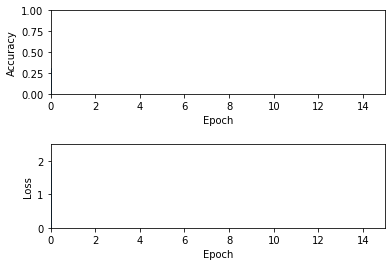

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a0model.ckpt Model Saved...
Epoch [25000], loss: 2.2415, acc: 0.0000
Epoch [25001], loss: 0.9187, acc: 1.0000
Epoch [25002], loss: 2.5061, acc: 0.0000
Epoch [25003], loss: 2.7606, acc: 0.0000
Epoch [25004], loss: 0.2379, acc: 1.0000
Epoch [25005], loss: 0.7673, acc: 1.0000
Epoch [25006], loss: 1.8888, acc: 0.0000
Epoch [25007], loss: 0.8086, acc: 1.0000
Epoch [25008], loss: 1.9910, acc: 0.0000
Epoch [25009], loss: 1.6345, acc: 0.0000
Epoch [25010], loss: 2.4360, acc: 0.0000
Epoch [25011], loss: 1.6892, acc: 0.0000
Epoch [25012], loss: 1.7732, acc: 0.0000
Epoch [25013], loss: 1.7703, acc: 0.0000
Epoch [25014], loss: 1.2986, acc: 1.0000
Epoch [25015], loss: 1.9049, acc: 0.0000
Epoch [25016], loss: 0.9567, acc: 1.0000
Epoch [25017], loss: 0.9694, acc: 0.0000
Epoch [25018], loss: 1.2981, acc: 0.0000
Epoch [25019], loss: 1.0627, acc: 1.0000
Epoch [25020], loss: 2.3892, acc: 0.0000
Epoch [25021], loss: 3.1693, acc: 0.

Epoch [25214], loss: 2.9616, acc: 0.0000
Epoch [25215], loss: 0.9002, acc: 1.0000
Epoch [25216], loss: 0.4154, acc: 1.0000
Epoch [25217], loss: 0.7770, acc: 1.0000
Epoch [25218], loss: 1.1754, acc: 0.0000
Epoch [25219], loss: 1.4630, acc: 0.0000
Epoch [25220], loss: 1.0337, acc: 1.0000
Epoch [25221], loss: 2.0935, acc: 0.0000
Epoch [25222], loss: 1.4763, acc: 0.0000
Epoch [25223], loss: 1.3991, acc: 1.0000
Epoch [25224], loss: 0.5723, acc: 1.0000
Epoch [25225], loss: 0.9479, acc: 1.0000
Epoch [25226], loss: 0.8220, acc: 1.0000
Epoch [25227], loss: 2.5684, acc: 0.0000
Epoch [25228], loss: 1.4436, acc: 0.0000
Epoch [25229], loss: 4.3728, acc: 0.0000
Epoch [25230], loss: 1.6372, acc: 0.0000
Epoch [25231], loss: 1.7720, acc: 0.0000
Epoch [25232], loss: 0.9833, acc: 1.0000
Epoch [25233], loss: 1.3698, acc: 0.0000
Epoch [25234], loss: 1.5879, acc: 0.0000
Epoch [25235], loss: 1.0359, acc: 1.0000
Epoch [25236], loss: 1.4287, acc: 0.0000
Epoch [25237], loss: 0.7088, acc: 1.0000
Epoch [25238], l

Epoch [25420], loss: 2.6291, acc: 0.0000
Epoch [25421], loss: 1.7729, acc: 0.0000
Epoch [25422], loss: 4.3179, acc: 0.0000
Epoch [25423], loss: 1.0110, acc: 1.0000
Epoch [25424], loss: 2.4102, acc: 0.0000
Epoch [25425], loss: 1.6564, acc: 0.0000
Epoch [25426], loss: 1.2943, acc: 0.0000
Epoch [25427], loss: 0.7838, acc: 1.0000
Epoch [25428], loss: 0.3503, acc: 1.0000
Epoch [25429], loss: 1.2713, acc: 1.0000
Epoch [25430], loss: 1.3751, acc: 0.0000
Epoch [25431], loss: 1.6143, acc: 1.0000
Epoch [25432], loss: 1.6299, acc: 0.0000
Epoch [25433], loss: 1.1862, acc: 1.0000
Epoch [25434], loss: 0.6893, acc: 1.0000
Epoch [25435], loss: 1.3949, acc: 1.0000
Epoch [25436], loss: 1.5170, acc: 0.0000
Epoch [25437], loss: 0.5467, acc: 1.0000
Epoch [25438], loss: 1.1457, acc: 1.0000
Epoch [25439], loss: 0.8388, acc: 1.0000
Epoch [25440], loss: 1.7718, acc: 1.0000
Epoch [25441], loss: 3.0965, acc: 0.0000
Epoch [25442], loss: 1.6520, acc: 0.0000
Epoch [25443], loss: 0.7921, acc: 1.0000
Epoch [25444], l

Epoch [25637], loss: 1.0202, acc: 1.0000
Epoch [25638], loss: 0.8581, acc: 1.0000
Epoch [25639], loss: 0.6263, acc: 1.0000
Epoch [25640], loss: 0.8632, acc: 0.0000
Epoch [25641], loss: 2.3412, acc: 0.0000
Epoch [25642], loss: 2.4131, acc: 0.0000
Epoch [25643], loss: 1.7584, acc: 0.0000
Epoch [25644], loss: 1.9184, acc: 0.0000
Epoch [25645], loss: 2.7453, acc: 0.0000
Epoch [25646], loss: 2.8230, acc: 0.0000
Epoch [25647], loss: 0.8423, acc: 1.0000
Epoch [25648], loss: 1.8005, acc: 0.0000
Epoch [25649], loss: 0.5716, acc: 1.0000
Epoch [25650], loss: 0.4083, acc: 1.0000
Epoch [25651], loss: 1.1411, acc: 1.0000
Epoch [25652], loss: 1.1399, acc: 0.0000
Epoch [25653], loss: 1.7575, acc: 1.0000
Epoch [25654], loss: 1.6977, acc: 1.0000
Epoch [25655], loss: 2.3428, acc: 0.0000
Epoch [25656], loss: 1.4011, acc: 1.0000
Epoch [25657], loss: 1.1349, acc: 0.0000
Epoch [25658], loss: 2.8689, acc: 0.0000
Epoch [25659], loss: 1.9525, acc: 0.0000
Epoch [25660], loss: 2.8936, acc: 0.0000
Epoch [25661], l

Epoch [25849], loss: 1.2456, acc: 1.0000
Epoch [25850], loss: 1.1280, acc: 0.0000
Epoch [25851], loss: 1.0737, acc: 1.0000
Epoch [25852], loss: 1.4499, acc: 1.0000
Epoch [25853], loss: 1.2773, acc: 1.0000
Epoch [25854], loss: 2.4912, acc: 0.0000
Epoch [25855], loss: 0.9637, acc: 1.0000
Epoch [25856], loss: 1.2071, acc: 0.0000
Epoch [25857], loss: 1.7832, acc: 0.0000
Epoch [25858], loss: 1.2468, acc: 1.0000
Epoch [25859], loss: 3.3539, acc: 0.0000
Epoch [25860], loss: 1.3988, acc: 0.0000
Epoch [25861], loss: 1.2101, acc: 0.0000
Epoch [25862], loss: 1.6113, acc: 0.0000
Epoch [25863], loss: 1.5878, acc: 0.0000
Epoch [25864], loss: 1.7929, acc: 0.0000
Epoch [25865], loss: 1.1432, acc: 1.0000
Epoch [25866], loss: 0.2750, acc: 1.0000
Epoch [25867], loss: 0.8745, acc: 1.0000
Epoch [25868], loss: 1.2313, acc: 1.0000
Epoch [25869], loss: 3.7840, acc: 0.0000
Epoch [25870], loss: 2.3137, acc: 0.0000
Epoch [25871], loss: 2.0981, acc: 0.0000
Epoch [25872], loss: 2.4945, acc: 0.0000
Epoch [25873], l

Epoch [26051], loss: 0.8759, acc: 1.0000
Epoch [26052], loss: 0.8898, acc: 1.0000
Epoch [26053], loss: 1.7547, acc: 0.0000
Epoch [26054], loss: 2.1177, acc: 0.0000
Epoch [26055], loss: 1.4745, acc: 0.0000
Epoch [26056], loss: 1.3925, acc: 1.0000
Epoch [26057], loss: 0.9892, acc: 1.0000
Epoch [26058], loss: 2.2681, acc: 0.0000
Epoch [26059], loss: 0.9506, acc: 1.0000
Epoch [26060], loss: 1.6622, acc: 0.0000
Epoch [26061], loss: 1.0863, acc: 0.0000
Epoch [26062], loss: 1.4059, acc: 1.0000
Epoch [26063], loss: 1.1844, acc: 0.0000
Epoch [26064], loss: 2.8716, acc: 0.0000
Epoch [26065], loss: 1.4042, acc: 1.0000
Epoch [26066], loss: 3.6961, acc: 0.0000
Epoch [26067], loss: 0.7628, acc: 1.0000
Epoch [26068], loss: 3.1469, acc: 0.0000
Epoch [26069], loss: 0.9740, acc: 1.0000
Epoch [26070], loss: 1.5335, acc: 0.0000
Epoch [26071], loss: 1.6967, acc: 0.0000
Epoch [26072], loss: 2.2597, acc: 0.0000
Epoch [26073], loss: 0.9719, acc: 1.0000
Epoch [26074], loss: 1.6557, acc: 0.0000
Epoch [26075], l

Epoch [26272], loss: 1.5094, acc: 1.0000
Epoch [26273], loss: 2.1679, acc: 0.0000
Epoch [26274], loss: 2.5067, acc: 0.0000
Epoch [26275], loss: 2.4158, acc: 0.0000
Epoch [26276], loss: 1.7288, acc: 0.0000
Epoch [26277], loss: 0.8050, acc: 1.0000
Epoch [26278], loss: 0.6108, acc: 1.0000
Epoch [26279], loss: 1.1205, acc: 1.0000
Epoch [26280], loss: 1.8539, acc: 0.0000
Epoch [26281], loss: 2.1479, acc: 0.0000
Epoch [26282], loss: 0.6924, acc: 1.0000
Epoch [26283], loss: 1.9682, acc: 0.0000
Epoch [26284], loss: 1.0538, acc: 1.0000
Epoch [26285], loss: 2.8856, acc: 0.0000
Epoch [26286], loss: 2.4618, acc: 0.0000
Epoch [26287], loss: 1.6324, acc: 0.0000
Epoch [26288], loss: 0.6546, acc: 1.0000
Epoch [26289], loss: 2.4550, acc: 0.0000
Epoch [26290], loss: 0.7211, acc: 1.0000
Epoch [26291], loss: 2.8662, acc: 0.0000
Epoch [26292], loss: 0.7587, acc: 1.0000
Epoch [26293], loss: 2.0676, acc: 0.0000
Epoch [26294], loss: 1.1471, acc: 1.0000
Epoch [26295], loss: 1.9089, acc: 0.0000
Epoch [26296], l

Epoch [26493], loss: 1.3818, acc: 1.0000
Epoch [26494], loss: 2.2269, acc: 0.0000
Epoch [26495], loss: 1.4277, acc: 1.0000
Epoch [26496], loss: 2.1155, acc: 0.0000
Epoch [26497], loss: 1.4538, acc: 1.0000
Epoch [26498], loss: 1.5642, acc: 0.0000
Epoch [26499], loss: 0.9327, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a1500model.ckpt Model Saved...
Epoch [26500], loss: 1.7358, acc: 0.0000
Epoch [26501], loss: 1.6208, acc: 0.0000
Epoch [26502], loss: 0.7441, acc: 1.0000
Epoch [26503], loss: 3.3055, acc: 0.0000
Epoch [26504], loss: 2.0499, acc: 0.0000
Epoch [26505], loss: 1.4293, acc: 1.0000
Epoch [26506], loss: 1.1137, acc: 1.0000
Epoch [26507], loss: 1.2081, acc: 1.0000
Epoch [26508], loss: 2.9495, acc: 0.0000
Epoch [26509], loss: 1.5805, acc: 0.0000
Epoch [26510], loss: 0.7679, acc: 1.0000
Epoch [26511], loss: 0.8165, acc: 1.0000
Epoch [26512], loss: 1.9851, acc: 0.0000
Epoch [26513], loss: 1.6451, acc: 0.0000
Epoch [26514], loss: 0.8199, acc:

Epoch [26713], loss: 1.7908, acc: 0.0000
Epoch [26714], loss: 1.3947, acc: 1.0000
Epoch [26715], loss: 2.0465, acc: 0.0000
Epoch [26716], loss: 1.0658, acc: 1.0000
Epoch [26717], loss: 1.7437, acc: 0.0000
Epoch [26718], loss: 2.5894, acc: 0.0000
Epoch [26719], loss: 1.8577, acc: 0.0000
Epoch [26720], loss: 1.4342, acc: 1.0000
Epoch [26721], loss: 1.7959, acc: 0.0000
Epoch [26722], loss: 2.1835, acc: 0.0000
Epoch [26723], loss: 1.5412, acc: 0.0000
Epoch [26724], loss: 0.6063, acc: 1.0000
Epoch [26725], loss: 1.5611, acc: 0.0000
Epoch [26726], loss: 3.2944, acc: 0.0000
Epoch [26727], loss: 2.0712, acc: 0.0000
Epoch [26728], loss: 2.0362, acc: 0.0000
Epoch [26729], loss: 1.3430, acc: 1.0000
Epoch [26730], loss: 4.0415, acc: 0.0000
Epoch [26731], loss: 1.0566, acc: 1.0000
Epoch [26732], loss: 0.8821, acc: 1.0000
Epoch [26733], loss: 0.5907, acc: 1.0000
Epoch [26734], loss: 1.0883, acc: 0.0000
Epoch [26735], loss: 1.4707, acc: 1.0000
Epoch [26736], loss: 4.0152, acc: 0.0000
Epoch [26737], l

Epoch [26934], loss: 4.5970, acc: 0.0000
Epoch [26935], loss: 0.8149, acc: 1.0000
Epoch [26936], loss: 1.3730, acc: 1.0000
Epoch [26937], loss: 0.1881, acc: 1.0000
Epoch [26938], loss: 1.5539, acc: 0.0000
Epoch [26939], loss: 0.2913, acc: 1.0000
Epoch [26940], loss: 0.9266, acc: 1.0000
Epoch [26941], loss: 3.1284, acc: 0.0000
Epoch [26942], loss: 2.4403, acc: 0.0000
Epoch [26943], loss: 2.8189, acc: 0.0000
Epoch [26944], loss: 1.3555, acc: 0.0000
Epoch [26945], loss: 1.9854, acc: 0.0000
Epoch [26946], loss: 2.8171, acc: 0.0000
Epoch [26947], loss: 2.4013, acc: 0.0000
Epoch [26948], loss: 0.4588, acc: 1.0000
Epoch [26949], loss: 1.1702, acc: 0.0000
Epoch [26950], loss: 1.2825, acc: 0.0000
Epoch [26951], loss: 3.6940, acc: 0.0000
Epoch [26952], loss: 1.7384, acc: 0.0000
Epoch [26953], loss: 1.2263, acc: 0.0000
Epoch [26954], loss: 0.8665, acc: 1.0000
Epoch [26955], loss: 2.7004, acc: 0.0000
Epoch [26956], loss: 1.5240, acc: 0.0000
Epoch [26957], loss: 0.9487, acc: 1.0000
Epoch [26958], l

Epoch [27154], loss: 1.3710, acc: 0.0000
Epoch [27155], loss: 1.6060, acc: 0.0000
Epoch [27156], loss: 1.8495, acc: 0.0000
Epoch [27157], loss: 0.6606, acc: 1.0000
Epoch [27158], loss: 1.9227, acc: 0.0000
Epoch [27159], loss: 1.9394, acc: 0.0000
Epoch [27160], loss: 0.5997, acc: 1.0000
Epoch [27161], loss: 1.8788, acc: 0.0000
Epoch [27162], loss: 3.0180, acc: 0.0000
Epoch [27163], loss: 0.9407, acc: 1.0000
Epoch [27164], loss: 1.0657, acc: 1.0000
Epoch [27165], loss: 1.6261, acc: 0.0000
Epoch [27166], loss: 2.3043, acc: 0.0000
Epoch [27167], loss: 1.2624, acc: 1.0000
Epoch [27168], loss: 2.3303, acc: 0.0000
Epoch [27169], loss: 1.9221, acc: 0.0000
Epoch [27170], loss: 1.8898, acc: 0.0000
Epoch [27171], loss: 0.5949, acc: 1.0000
Epoch [27172], loss: 0.3162, acc: 1.0000
Epoch [27173], loss: 1.7583, acc: 0.0000
Epoch [27174], loss: 0.8450, acc: 1.0000
Epoch [27175], loss: 3.9696, acc: 0.0000
Epoch [27176], loss: 1.7568, acc: 0.0000
Epoch [27177], loss: 1.9465, acc: 0.0000
Epoch [27178], l

Epoch [27373], loss: 1.2712, acc: 1.0000
Epoch [27374], loss: 2.1246, acc: 0.0000
Epoch [27375], loss: 2.7385, acc: 0.0000
Epoch [27376], loss: 1.4898, acc: 1.0000
Epoch [27377], loss: 0.3485, acc: 1.0000
Epoch [27378], loss: 3.4829, acc: 0.0000
Epoch [27379], loss: 0.6217, acc: 1.0000
Epoch [27380], loss: 0.7697, acc: 1.0000
Epoch [27381], loss: 0.8580, acc: 1.0000
Epoch [27382], loss: 1.8231, acc: 0.0000
Epoch [27383], loss: 1.2538, acc: 1.0000
Epoch [27384], loss: 0.9550, acc: 1.0000
Epoch [27385], loss: 1.1023, acc: 0.0000
Epoch [27386], loss: 1.7302, acc: 0.0000
Epoch [27387], loss: 1.8443, acc: 0.0000
Epoch [27388], loss: 1.4804, acc: 1.0000
Epoch [27389], loss: 2.5031, acc: 0.0000
Epoch [27390], loss: 1.8833, acc: 0.0000
Epoch [27391], loss: 0.3222, acc: 1.0000
Epoch [27392], loss: 0.6254, acc: 1.0000
Epoch [27393], loss: 0.9586, acc: 1.0000
Epoch [27394], loss: 3.4831, acc: 0.0000
Epoch [27395], loss: 2.5883, acc: 0.0000
Epoch [27396], loss: 1.8797, acc: 0.0000
Epoch [27397], l

Epoch [27581], loss: 1.6645, acc: 0.0000
Epoch [27582], loss: 1.6664, acc: 0.0000
Epoch [27583], loss: 4.1278, acc: 0.0000
Epoch [27584], loss: 0.9248, acc: 0.0000
Epoch [27585], loss: 0.8873, acc: 1.0000
Epoch [27586], loss: 2.0435, acc: 0.0000
Epoch [27587], loss: 1.3352, acc: 0.0000
Epoch [27588], loss: 0.8487, acc: 1.0000
Epoch [27589], loss: 2.3479, acc: 0.0000
Epoch [27590], loss: 1.6061, acc: 0.0000
Epoch [27591], loss: 1.6745, acc: 0.0000
Epoch [27592], loss: 0.7440, acc: 1.0000
Epoch [27593], loss: 1.2427, acc: 1.0000
Epoch [27594], loss: 1.3650, acc: 0.0000
Epoch [27595], loss: 1.7371, acc: 0.0000
Epoch [27596], loss: 1.6335, acc: 0.0000
Epoch [27597], loss: 3.2420, acc: 0.0000
Epoch [27598], loss: 1.4281, acc: 0.0000
Epoch [27599], loss: 4.5097, acc: 0.0000
Epoch [27600], loss: 1.3310, acc: 1.0000
Epoch [27601], loss: 2.8020, acc: 0.0000
Epoch [27602], loss: 0.7045, acc: 1.0000
Epoch [27603], loss: 1.0793, acc: 1.0000
Epoch [27604], loss: 2.2613, acc: 0.0000
Epoch [27605], l

Epoch [27781], loss: 2.6660, acc: 0.0000
Epoch [27782], loss: 2.7441, acc: 0.0000
Epoch [27783], loss: 2.2608, acc: 0.0000
Epoch [27784], loss: 1.4464, acc: 0.0000
Epoch [27785], loss: 1.8520, acc: 0.0000
Epoch [27786], loss: 1.5696, acc: 0.0000
Epoch [27787], loss: 1.1053, acc: 1.0000
Epoch [27788], loss: 2.2039, acc: 0.0000
Epoch [27789], loss: 2.8379, acc: 0.0000
Epoch [27790], loss: 2.2728, acc: 0.0000
Epoch [27791], loss: 1.4264, acc: 0.0000
Epoch [27792], loss: 1.2824, acc: 1.0000
Epoch [27793], loss: 1.2450, acc: 1.0000
Epoch [27794], loss: 1.1106, acc: 0.0000
Epoch [27795], loss: 1.4795, acc: 0.0000
Epoch [27796], loss: 1.2737, acc: 1.0000
Epoch [27797], loss: 1.4971, acc: 0.0000
Epoch [27798], loss: 2.9502, acc: 0.0000
Epoch [27799], loss: 1.8562, acc: 0.0000
Epoch [27800], loss: 4.7645, acc: 0.0000
Epoch [27801], loss: 0.6290, acc: 1.0000
Epoch [27802], loss: 1.8920, acc: 0.0000
Epoch [27803], loss: 1.2331, acc: 0.0000
Epoch [27804], loss: 1.2381, acc: 1.0000
Epoch [27805], l

Epoch [27999], loss: 0.9601, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a3000model.ckpt Model Saved...
Epoch [28000], loss: 0.4594, acc: 1.0000
Epoch [28001], loss: 1.9196, acc: 0.0000
Epoch [28002], loss: 1.3504, acc: 0.0000
Epoch [28003], loss: 3.1320, acc: 0.0000
Epoch [28004], loss: 1.4602, acc: 0.0000
Epoch [28005], loss: 1.1908, acc: 1.0000
Epoch [28006], loss: 0.9211, acc: 1.0000
Epoch [28007], loss: 2.2453, acc: 0.0000
Epoch [28008], loss: 1.9693, acc: 0.0000
Epoch [28009], loss: 1.1879, acc: 0.0000
Epoch [28010], loss: 0.6649, acc: 1.0000
Epoch [28011], loss: 3.2423, acc: 0.0000
Epoch [28012], loss: 0.8240, acc: 1.0000
Epoch [28013], loss: 0.8741, acc: 1.0000
Epoch [28014], loss: 1.6380, acc: 1.0000
Epoch [28015], loss: 0.3973, acc: 1.0000
Epoch [28016], loss: 1.8187, acc: 0.0000
Epoch [28017], loss: 2.5225, acc: 0.0000
Epoch [28018], loss: 0.6959, acc: 1.0000
Epoch [28019], loss: 2.0857, acc: 0.0000
Epoch [28020], loss: 1.7460, acc:

Epoch [28197], loss: 1.7650, acc: 0.0000
Epoch [28198], loss: 2.7709, acc: 0.0000
Epoch [28199], loss: 2.7746, acc: 0.0000
Epoch [28200], loss: 0.9733, acc: 1.0000
Epoch [28201], loss: 2.6124, acc: 0.0000
Epoch [28202], loss: 2.3977, acc: 0.0000
Epoch [28203], loss: 0.5925, acc: 1.0000
Epoch [28204], loss: 0.5218, acc: 1.0000
Epoch [28205], loss: 2.5571, acc: 0.0000
Epoch [28206], loss: 1.6387, acc: 0.0000
Epoch [28207], loss: 1.0157, acc: 1.0000
Epoch [28208], loss: 0.9314, acc: 0.0000
Epoch [28209], loss: 2.8979, acc: 0.0000
Epoch [28210], loss: 0.3918, acc: 1.0000
Epoch [28211], loss: 1.4632, acc: 0.0000
Epoch [28212], loss: 0.6111, acc: 1.0000
Epoch [28213], loss: 2.8266, acc: 0.0000
Epoch [28214], loss: 0.9569, acc: 0.0000
Epoch [28215], loss: 1.0802, acc: 0.0000
Epoch [28216], loss: 0.7870, acc: 1.0000
Epoch [28217], loss: 0.9183, acc: 1.0000
Epoch [28218], loss: 1.4251, acc: 1.0000
Epoch [28219], loss: 0.9438, acc: 1.0000
Epoch [28220], loss: 0.3625, acc: 1.0000
Epoch [28221], l

Epoch [28415], loss: 1.5598, acc: 1.0000
Epoch [28416], loss: 1.8988, acc: 0.0000
Epoch [28417], loss: 1.2157, acc: 1.0000
Epoch [28418], loss: 0.8653, acc: 0.0000
Epoch [28419], loss: 1.0733, acc: 1.0000
Epoch [28420], loss: 0.7150, acc: 1.0000
Epoch [28421], loss: 0.4916, acc: 1.0000
Epoch [28422], loss: 0.7956, acc: 1.0000
Epoch [28423], loss: 1.9485, acc: 0.0000
Epoch [28424], loss: 2.0506, acc: 0.0000
Epoch [28425], loss: 1.5405, acc: 0.0000
Epoch [28426], loss: 0.7400, acc: 1.0000
Epoch [28427], loss: 1.5358, acc: 1.0000
Epoch [28428], loss: 0.5663, acc: 1.0000
Epoch [28429], loss: 1.5535, acc: 0.0000
Epoch [28430], loss: 3.0095, acc: 0.0000
Epoch [28431], loss: 0.2216, acc: 1.0000
Epoch [28432], loss: 1.7412, acc: 0.0000
Epoch [28433], loss: 3.1235, acc: 0.0000
Epoch [28434], loss: 1.3517, acc: 1.0000
Epoch [28435], loss: 3.0255, acc: 0.0000
Epoch [28436], loss: 3.0970, acc: 0.0000
Epoch [28437], loss: 1.2459, acc: 1.0000
Epoch [28438], loss: 1.3939, acc: 1.0000
Epoch [28439], l

Epoch [28637], loss: 1.5146, acc: 0.0000
Epoch [28638], loss: 1.4219, acc: 1.0000
Epoch [28639], loss: 3.8508, acc: 0.0000
Epoch [28640], loss: 0.8676, acc: 1.0000
Epoch [28641], loss: 2.3714, acc: 0.0000
Epoch [28642], loss: 3.5406, acc: 0.0000
Epoch [28643], loss: 0.8704, acc: 1.0000
Epoch [28644], loss: 1.4507, acc: 1.0000
Epoch [28645], loss: 2.5800, acc: 0.0000
Epoch [28646], loss: 1.9264, acc: 1.0000
Epoch [28647], loss: 1.2780, acc: 0.0000
Epoch [28648], loss: 0.9032, acc: 1.0000
Epoch [28649], loss: 1.4131, acc: 0.0000
Epoch [28650], loss: 0.7241, acc: 1.0000
Epoch [28651], loss: 1.8527, acc: 0.0000
Epoch [28652], loss: 3.0085, acc: 0.0000
Epoch [28653], loss: 1.3621, acc: 1.0000
Epoch [28654], loss: 0.8356, acc: 1.0000
Epoch [28655], loss: 0.6553, acc: 1.0000
Epoch [28656], loss: 1.5318, acc: 0.0000
Epoch [28657], loss: 1.7801, acc: 0.0000
Epoch [28658], loss: 1.8050, acc: 0.0000
Epoch [28659], loss: 1.1247, acc: 0.0000
Epoch [28660], loss: 2.4648, acc: 0.0000
Epoch [28661], l

Epoch [28843], loss: 1.5414, acc: 0.0000
Epoch [28844], loss: 2.6563, acc: 0.0000
Epoch [28845], loss: 1.9382, acc: 0.0000
Epoch [28846], loss: 1.5447, acc: 0.0000
Epoch [28847], loss: 1.7046, acc: 0.0000
Epoch [28848], loss: 2.2771, acc: 0.0000
Epoch [28849], loss: 1.6398, acc: 0.0000
Epoch [28850], loss: 1.4119, acc: 1.0000
Epoch [28851], loss: 2.3642, acc: 0.0000
Epoch [28852], loss: 1.3893, acc: 0.0000
Epoch [28853], loss: 1.8754, acc: 0.0000
Epoch [28854], loss: 2.6576, acc: 0.0000
Epoch [28855], loss: 1.4265, acc: 0.0000
Epoch [28856], loss: 3.0721, acc: 0.0000
Epoch [28857], loss: 1.8203, acc: 0.0000
Epoch [28858], loss: 2.2524, acc: 0.0000
Epoch [28859], loss: 1.4134, acc: 1.0000
Epoch [28860], loss: 1.8594, acc: 0.0000
Epoch [28861], loss: 1.6465, acc: 0.0000
Epoch [28862], loss: 1.6963, acc: 0.0000
Epoch [28863], loss: 1.0823, acc: 1.0000
Epoch [28864], loss: 1.3494, acc: 1.0000
Epoch [28865], loss: 0.9862, acc: 1.0000
Epoch [28866], loss: 1.4665, acc: 0.0000
Epoch [28867], l

Epoch [29067], loss: 0.8838, acc: 1.0000
Epoch [29068], loss: 0.4188, acc: 1.0000
Epoch [29069], loss: 1.6701, acc: 0.0000
Epoch [29070], loss: 1.7736, acc: 0.0000
Epoch [29071], loss: 2.3796, acc: 0.0000
Epoch [29072], loss: 2.8913, acc: 0.0000
Epoch [29073], loss: 1.1533, acc: 1.0000
Epoch [29074], loss: 4.2638, acc: 0.0000
Epoch [29075], loss: 1.6836, acc: 0.0000
Epoch [29076], loss: 2.4647, acc: 0.0000
Epoch [29077], loss: 1.6144, acc: 1.0000
Epoch [29078], loss: 1.2765, acc: 1.0000
Epoch [29079], loss: 1.1538, acc: 1.0000
Epoch [29080], loss: 1.7230, acc: 0.0000
Epoch [29081], loss: 2.1072, acc: 0.0000
Epoch [29082], loss: 1.3902, acc: 0.0000
Epoch [29083], loss: 2.3549, acc: 0.0000
Epoch [29084], loss: 2.4820, acc: 0.0000
Epoch [29085], loss: 1.9446, acc: 0.0000
Epoch [29086], loss: 1.4850, acc: 0.0000
Epoch [29087], loss: 2.0305, acc: 0.0000
Epoch [29088], loss: 1.3757, acc: 0.0000
Epoch [29089], loss: 2.6633, acc: 0.0000
Epoch [29090], loss: 1.1546, acc: 1.0000
Epoch [29091], l

Epoch [29284], loss: 2.3436, acc: 0.0000
Epoch [29285], loss: 1.6821, acc: 0.0000
Epoch [29286], loss: 1.0650, acc: 1.0000
Epoch [29287], loss: 2.7297, acc: 0.0000
Epoch [29288], loss: 1.6720, acc: 0.0000
Epoch [29289], loss: 3.7345, acc: 0.0000
Epoch [29290], loss: 1.0309, acc: 1.0000
Epoch [29291], loss: 0.7515, acc: 1.0000
Epoch [29292], loss: 1.7172, acc: 0.0000
Epoch [29293], loss: 1.9826, acc: 0.0000
Epoch [29294], loss: 1.5670, acc: 0.0000
Epoch [29295], loss: 1.9174, acc: 0.0000
Epoch [29296], loss: 2.5757, acc: 0.0000
Epoch [29297], loss: 1.7179, acc: 0.0000
Epoch [29298], loss: 1.6602, acc: 0.0000
Epoch [29299], loss: 1.2319, acc: 1.0000
Epoch [29300], loss: 2.5578, acc: 0.0000
Epoch [29301], loss: 1.6667, acc: 0.0000
Epoch [29302], loss: 0.9335, acc: 1.0000
Epoch [29303], loss: 1.3563, acc: 0.0000
Epoch [29304], loss: 2.6701, acc: 0.0000
Epoch [29305], loss: 0.6951, acc: 1.0000
Epoch [29306], loss: 3.4745, acc: 0.0000
Epoch [29307], loss: 0.9707, acc: 1.0000
Epoch [29308], l

Epoch [29511], loss: 1.6014, acc: 0.0000
Epoch [29512], loss: 0.2615, acc: 1.0000
Epoch [29513], loss: 1.4028, acc: 0.0000
Epoch [29514], loss: 1.3390, acc: 0.0000
Epoch [29515], loss: 1.5019, acc: 0.0000
Epoch [29516], loss: 1.5389, acc: 1.0000
Epoch [29517], loss: 1.2109, acc: 0.0000
Epoch [29518], loss: 4.5655, acc: 0.0000
Epoch [29519], loss: 0.7576, acc: 1.0000
Epoch [29520], loss: 1.3044, acc: 0.0000
Epoch [29521], loss: 2.2443, acc: 0.0000
Epoch [29522], loss: 1.9346, acc: 0.0000
Epoch [29523], loss: 1.7477, acc: 0.0000
Epoch [29524], loss: 1.2611, acc: 0.0000
Epoch [29525], loss: 0.7222, acc: 1.0000
Epoch [29526], loss: 2.5781, acc: 0.0000
Epoch [29527], loss: 1.6557, acc: 0.0000
Epoch [29528], loss: 0.7599, acc: 1.0000
Epoch [29529], loss: 0.6358, acc: 1.0000
Epoch [29530], loss: 1.5914, acc: 0.0000
Epoch [29531], loss: 2.3742, acc: 0.0000
Epoch [29532], loss: 1.3098, acc: 0.0000
Epoch [29533], loss: 1.3365, acc: 1.0000
Epoch [29534], loss: 2.7589, acc: 0.0000
Epoch [29535], l

Epoch [29711], loss: 3.2706, acc: 0.0000
Epoch [29712], loss: 1.1838, acc: 1.0000
Epoch [29713], loss: 3.7665, acc: 0.0000
Epoch [29714], loss: 0.9855, acc: 1.0000
Epoch [29715], loss: 1.0285, acc: 1.0000
Epoch [29716], loss: 2.2234, acc: 0.0000
Epoch [29717], loss: 1.4771, acc: 1.0000
Epoch [29718], loss: 1.8038, acc: 0.0000
Epoch [29719], loss: 1.4617, acc: 0.0000
Epoch [29720], loss: 3.4907, acc: 0.0000
Epoch [29721], loss: 2.6149, acc: 0.0000
Epoch [29722], loss: 2.4125, acc: 0.0000
Epoch [29723], loss: 1.2630, acc: 1.0000
Epoch [29724], loss: 1.0650, acc: 0.0000
Epoch [29725], loss: 0.3865, acc: 1.0000
Epoch [29726], loss: 3.5418, acc: 0.0000
Epoch [29727], loss: 2.6600, acc: 0.0000
Epoch [29728], loss: 2.6373, acc: 0.0000
Epoch [29729], loss: 0.4767, acc: 1.0000
Epoch [29730], loss: 1.6856, acc: 1.0000
Epoch [29731], loss: 2.2588, acc: 0.0000
Epoch [29732], loss: 0.7334, acc: 1.0000
Epoch [29733], loss: 2.0971, acc: 0.0000
Epoch [29734], loss: 0.5923, acc: 1.0000
Epoch [29735], l

Epoch [29941], loss: 2.4871, acc: 0.0000
Epoch [29942], loss: 0.9710, acc: 0.0000
Epoch [29943], loss: 3.1010, acc: 0.0000
Epoch [29944], loss: 1.0917, acc: 1.0000
Epoch [29945], loss: 2.0398, acc: 0.0000
Epoch [29946], loss: 0.6154, acc: 1.0000
Epoch [29947], loss: 1.1039, acc: 1.0000
Epoch [29948], loss: 0.7094, acc: 1.0000
Epoch [29949], loss: 0.9256, acc: 0.0000
Epoch [29950], loss: 1.4313, acc: 0.0000
Epoch [29951], loss: 2.8466, acc: 0.0000
Epoch [29952], loss: 0.5950, acc: 1.0000
Epoch [29953], loss: 0.7277, acc: 1.0000
Epoch [29954], loss: 2.7075, acc: 0.0000
Epoch [29955], loss: 0.9363, acc: 1.0000
Epoch [29956], loss: 3.0761, acc: 0.0000
Epoch [29957], loss: 2.3710, acc: 0.0000
Epoch [29958], loss: 1.3312, acc: 1.0000
Epoch [29959], loss: 2.3496, acc: 0.0000
Epoch [29960], loss: 2.6102, acc: 0.0000
Epoch [29961], loss: 2.8614, acc: 0.0000
Epoch [29962], loss: 0.6308, acc: 1.0000
Epoch [29963], loss: 2.8644, acc: 0.0000
Epoch [29964], loss: 1.2777, acc: 1.0000
Epoch [29965], l

Epoch [30169], loss: 1.4197, acc: 0.0000
Epoch [30170], loss: 3.4869, acc: 0.0000
Epoch [30171], loss: 1.2199, acc: 0.0000
Epoch [30172], loss: 0.4479, acc: 1.0000
Epoch [30173], loss: 1.4477, acc: 1.0000
Epoch [30174], loss: 1.3540, acc: 0.0000
Epoch [30175], loss: 1.9859, acc: 0.0000
Epoch [30176], loss: 1.4848, acc: 1.0000
Epoch [30177], loss: 1.9821, acc: 0.0000
Epoch [30178], loss: 1.2172, acc: 0.0000
Epoch [30179], loss: 1.2082, acc: 0.0000
Epoch [30180], loss: 1.3253, acc: 0.0000
Epoch [30181], loss: 2.3199, acc: 0.0000
Epoch [30182], loss: 1.5732, acc: 0.0000
Epoch [30183], loss: 1.1418, acc: 1.0000
Epoch [30184], loss: 2.1216, acc: 0.0000
Epoch [30185], loss: 1.2074, acc: 0.0000
Epoch [30186], loss: 2.8916, acc: 0.0000
Epoch [30187], loss: 1.2836, acc: 0.0000
Epoch [30188], loss: 2.7943, acc: 0.0000
Epoch [30189], loss: 2.8920, acc: 0.0000
Epoch [30190], loss: 0.8223, acc: 1.0000
Epoch [30191], loss: 0.5674, acc: 1.0000
Epoch [30192], loss: 0.9318, acc: 1.0000
Epoch [30193], l

Epoch [30389], loss: 2.4396, acc: 0.0000
Epoch [30390], loss: 1.8961, acc: 0.0000
Epoch [30391], loss: 2.0218, acc: 0.0000
Epoch [30392], loss: 2.6245, acc: 0.0000
Epoch [30393], loss: 0.9725, acc: 0.0000
Epoch [30394], loss: 2.0795, acc: 0.0000
Epoch [30395], loss: 0.6045, acc: 1.0000
Epoch [30396], loss: 1.2607, acc: 1.0000
Epoch [30397], loss: 0.9750, acc: 1.0000
Epoch [30398], loss: 1.4968, acc: 0.0000
Epoch [30399], loss: 1.1633, acc: 1.0000
Epoch [30400], loss: 2.9138, acc: 0.0000
Epoch [30401], loss: 0.4118, acc: 1.0000
Epoch [30402], loss: 1.1648, acc: 0.0000
Epoch [30403], loss: 1.9471, acc: 0.0000
Epoch [30404], loss: 1.7910, acc: 0.0000
Epoch [30405], loss: 0.7227, acc: 1.0000
Epoch [30406], loss: 1.6201, acc: 0.0000
Epoch [30407], loss: 1.5051, acc: 1.0000
Epoch [30408], loss: 0.2919, acc: 1.0000
Epoch [30409], loss: 2.7899, acc: 0.0000
Epoch [30410], loss: 1.0793, acc: 1.0000
Epoch [30411], loss: 1.9332, acc: 0.0000
Epoch [30412], loss: 2.2320, acc: 0.0000
Epoch [30413], l

Epoch [30593], loss: 3.1125, acc: 0.0000
Epoch [30594], loss: 2.1145, acc: 0.0000
Epoch [30595], loss: 1.9627, acc: 0.0000
Epoch [30596], loss: 1.1831, acc: 1.0000
Epoch [30597], loss: 1.7554, acc: 0.0000
Epoch [30598], loss: 0.8541, acc: 1.0000
Epoch [30599], loss: 1.0424, acc: 1.0000
Epoch [30600], loss: 1.5273, acc: 0.0000
Epoch [30601], loss: 3.8594, acc: 0.0000
Epoch [30602], loss: 1.9737, acc: 0.0000
Epoch [30603], loss: 0.7301, acc: 1.0000
Epoch [30604], loss: 2.6099, acc: 0.0000
Epoch [30605], loss: 1.2932, acc: 0.0000
Epoch [30606], loss: 0.2906, acc: 1.0000
Epoch [30607], loss: 1.8020, acc: 0.0000
Epoch [30608], loss: 1.7252, acc: 0.0000
Epoch [30609], loss: 4.2507, acc: 0.0000
Epoch [30610], loss: 0.9468, acc: 1.0000
Epoch [30611], loss: 3.1414, acc: 0.0000
Epoch [30612], loss: 1.0435, acc: 1.0000
Epoch [30613], loss: 2.7218, acc: 0.0000
Epoch [30614], loss: 1.1687, acc: 1.0000
Epoch [30615], loss: 2.3746, acc: 0.0000
Epoch [30616], loss: 2.0838, acc: 0.0000
Epoch [30617], l

Epoch [30809], loss: 1.0171, acc: 1.0000
Epoch [30810], loss: 1.2464, acc: 1.0000
Epoch [30811], loss: 0.4683, acc: 1.0000
Epoch [30812], loss: 1.0525, acc: 1.0000
Epoch [30813], loss: 3.0267, acc: 0.0000
Epoch [30814], loss: 2.6866, acc: 0.0000
Epoch [30815], loss: 1.5319, acc: 0.0000
Epoch [30816], loss: 1.0074, acc: 1.0000
Epoch [30817], loss: 0.9168, acc: 1.0000
Epoch [30818], loss: 3.2538, acc: 0.0000
Epoch [30819], loss: 2.6804, acc: 0.0000
Epoch [30820], loss: 2.6385, acc: 0.0000
Epoch [30821], loss: 2.1590, acc: 0.0000
Epoch [30822], loss: 1.3390, acc: 0.0000
Epoch [30823], loss: 1.2009, acc: 0.0000
Epoch [30824], loss: 1.5964, acc: 0.0000
Epoch [30825], loss: 1.2879, acc: 0.0000
Epoch [30826], loss: 1.6822, acc: 0.0000
Epoch [30827], loss: 1.4329, acc: 1.0000
Epoch [30828], loss: 1.5204, acc: 1.0000
Epoch [30829], loss: 2.1173, acc: 0.0000
Epoch [30830], loss: 3.1513, acc: 0.0000
Epoch [30831], loss: 1.7350, acc: 0.0000
Epoch [30832], loss: 1.4607, acc: 0.0000
Epoch [30833], l

Epoch [31017], loss: 1.5665, acc: 0.0000
Epoch [31018], loss: 1.4135, acc: 0.0000
Epoch [31019], loss: 0.8844, acc: 1.0000
Epoch [31020], loss: 1.2634, acc: 1.0000
Epoch [31021], loss: 1.7728, acc: 0.0000
Epoch [31022], loss: 0.7282, acc: 1.0000
Epoch [31023], loss: 3.0503, acc: 0.0000
Epoch [31024], loss: 3.2386, acc: 0.0000
Epoch [31025], loss: 1.2127, acc: 0.0000
Epoch [31026], loss: 0.4478, acc: 1.0000
Epoch [31027], loss: 0.6595, acc: 1.0000
Epoch [31028], loss: 3.3619, acc: 0.0000
Epoch [31029], loss: 1.7451, acc: 0.0000
Epoch [31030], loss: 0.9643, acc: 0.0000
Epoch [31031], loss: 1.3979, acc: 1.0000
Epoch [31032], loss: 6.3495, acc: 0.0000
Epoch [31033], loss: 4.0312, acc: 0.0000
Epoch [31034], loss: 3.5419, acc: 0.0000
Epoch [31035], loss: 1.3874, acc: 1.0000
Epoch [31036], loss: 1.1810, acc: 1.0000
Epoch [31037], loss: 0.5685, acc: 1.0000
Epoch [31038], loss: 2.1753, acc: 0.0000
Epoch [31039], loss: 1.0818, acc: 1.0000
Epoch [31040], loss: 2.3669, acc: 0.0000
Epoch [31041], l

Epoch [31242], loss: 2.6629, acc: 0.0000
Epoch [31243], loss: 0.6241, acc: 1.0000
Epoch [31244], loss: 0.5953, acc: 1.0000
Epoch [31245], loss: 2.1648, acc: 0.0000
Epoch [31246], loss: 2.5482, acc: 0.0000
Epoch [31247], loss: 1.4236, acc: 0.0000
Epoch [31248], loss: 0.3436, acc: 1.0000
Epoch [31249], loss: 0.8153, acc: 1.0000
Epoch [31250], loss: 1.7795, acc: 0.0000
Epoch [31251], loss: 2.4439, acc: 0.0000
Epoch [31252], loss: 1.6031, acc: 0.0000
Epoch [31253], loss: 0.6674, acc: 1.0000
Epoch [31254], loss: 2.0488, acc: 0.0000
Epoch [31255], loss: 1.4197, acc: 0.0000
Epoch [31256], loss: 1.3379, acc: 0.0000
Epoch [31257], loss: 1.2217, acc: 1.0000
Epoch [31258], loss: 0.4309, acc: 1.0000
Epoch [31259], loss: 1.7797, acc: 0.0000
Epoch [31260], loss: 1.1014, acc: 1.0000
Epoch [31261], loss: 0.4769, acc: 1.0000
Epoch [31262], loss: 1.3285, acc: 0.0000
Epoch [31263], loss: 2.5117, acc: 0.0000
Epoch [31264], loss: 2.0940, acc: 0.0000
Epoch [31265], loss: 2.5947, acc: 0.0000
Epoch [31266], l

Epoch [31454], loss: 2.6026, acc: 0.0000
Epoch [31455], loss: 2.2303, acc: 0.0000
Epoch [31456], loss: 2.1840, acc: 0.0000
Epoch [31457], loss: 3.3664, acc: 0.0000
Epoch [31458], loss: 1.5457, acc: 1.0000
Epoch [31459], loss: 0.7107, acc: 1.0000
Epoch [31460], loss: 0.7969, acc: 1.0000
Epoch [31461], loss: 1.2137, acc: 0.0000
Epoch [31462], loss: 0.3351, acc: 1.0000
Epoch [31463], loss: 1.6417, acc: 0.0000
Epoch [31464], loss: 1.2721, acc: 1.0000
Epoch [31465], loss: 0.5763, acc: 1.0000
Epoch [31466], loss: 1.6796, acc: 0.0000
Epoch [31467], loss: 2.4691, acc: 0.0000
Epoch [31468], loss: 2.8356, acc: 0.0000
Epoch [31469], loss: 0.7174, acc: 1.0000
Epoch [31470], loss: 0.4135, acc: 1.0000
Epoch [31471], loss: 1.6279, acc: 0.0000
Epoch [31472], loss: 0.7184, acc: 1.0000
Epoch [31473], loss: 0.9023, acc: 1.0000
Epoch [31474], loss: 2.9454, acc: 0.0000
Epoch [31475], loss: 1.4484, acc: 0.0000
Epoch [31476], loss: 3.7414, acc: 0.0000
Epoch [31477], loss: 1.7649, acc: 0.0000
Epoch [31478], l

Epoch [31679], loss: 2.2009, acc: 0.0000
Epoch [31680], loss: 1.0333, acc: 1.0000
Epoch [31681], loss: 2.2649, acc: 0.0000
Epoch [31682], loss: 1.2553, acc: 0.0000
Epoch [31683], loss: 1.7541, acc: 0.0000
Epoch [31684], loss: 1.6301, acc: 0.0000
Epoch [31685], loss: 2.1663, acc: 0.0000
Epoch [31686], loss: 1.8309, acc: 0.0000
Epoch [31687], loss: 1.0126, acc: 1.0000
Epoch [31688], loss: 1.2844, acc: 1.0000
Epoch [31689], loss: 1.4318, acc: 0.0000
Epoch [31690], loss: 2.0937, acc: 0.0000
Epoch [31691], loss: 2.8313, acc: 0.0000
Epoch [31692], loss: 0.7193, acc: 1.0000
Epoch [31693], loss: 0.6199, acc: 1.0000
Epoch [31694], loss: 1.3994, acc: 0.0000
Epoch [31695], loss: 0.8374, acc: 1.0000
Epoch [31696], loss: 3.6595, acc: 0.0000
Epoch [31697], loss: 3.3848, acc: 0.0000
Epoch [31698], loss: 0.4315, acc: 1.0000
Epoch [31699], loss: 1.9581, acc: 0.0000
Epoch [31700], loss: 0.9894, acc: 1.0000
Epoch [31701], loss: 1.4204, acc: 0.0000
Epoch [31702], loss: 1.0736, acc: 1.0000
Epoch [31703], l

Epoch [31909], loss: 1.6654, acc: 1.0000
Epoch [31910], loss: 0.6676, acc: 1.0000
Epoch [31911], loss: 1.4662, acc: 0.0000
Epoch [31912], loss: 0.9100, acc: 1.0000
Epoch [31913], loss: 2.1497, acc: 0.0000
Epoch [31914], loss: 2.7480, acc: 0.0000
Epoch [31915], loss: 2.7426, acc: 0.0000
Epoch [31916], loss: 1.2074, acc: 1.0000
Epoch [31917], loss: 2.1299, acc: 0.0000
Epoch [31918], loss: 1.7543, acc: 0.0000
Epoch [31919], loss: 0.8543, acc: 1.0000
Epoch [31920], loss: 1.2624, acc: 0.0000
Epoch [31921], loss: 2.6841, acc: 0.0000
Epoch [31922], loss: 1.8016, acc: 0.0000
Epoch [31923], loss: 1.3994, acc: 0.0000
Epoch [31924], loss: 2.0361, acc: 0.0000
Epoch [31925], loss: 0.3159, acc: 1.0000
Epoch [31926], loss: 2.3352, acc: 0.0000
Epoch [31927], loss: 2.4579, acc: 0.0000
Epoch [31928], loss: 0.7497, acc: 1.0000
Epoch [31929], loss: 1.3805, acc: 0.0000
Epoch [31930], loss: 1.4110, acc: 1.0000
Epoch [31931], loss: 0.2163, acc: 1.0000
Epoch [31932], loss: 2.9120, acc: 0.0000
Epoch [31933], l

Epoch [32127], loss: 1.3954, acc: 1.0000
Epoch [32128], loss: 1.1900, acc: 1.0000
Epoch [32129], loss: 1.8414, acc: 0.0000
Epoch [32130], loss: 1.4974, acc: 1.0000
Epoch [32131], loss: 1.4859, acc: 0.0000
Epoch [32132], loss: 1.9403, acc: 0.0000
Epoch [32133], loss: 0.7539, acc: 1.0000
Epoch [32134], loss: 1.2207, acc: 1.0000
Epoch [32135], loss: 1.3687, acc: 0.0000
Epoch [32136], loss: 0.6382, acc: 1.0000
Epoch [32137], loss: 1.9885, acc: 0.0000
Epoch [32138], loss: 2.1745, acc: 0.0000
Epoch [32139], loss: 2.6849, acc: 0.0000
Epoch [32140], loss: 2.5036, acc: 0.0000
Epoch [32141], loss: 3.5473, acc: 0.0000
Epoch [32142], loss: 0.8930, acc: 1.0000
Epoch [32143], loss: 1.4206, acc: 0.0000
Epoch [32144], loss: 0.3388, acc: 1.0000
Epoch [32145], loss: 2.4849, acc: 0.0000
Epoch [32146], loss: 1.5486, acc: 0.0000
Epoch [32147], loss: 1.9160, acc: 0.0000
Epoch [32148], loss: 1.8806, acc: 0.0000
Epoch [32149], loss: 1.1426, acc: 0.0000
Epoch [32150], loss: 1.9140, acc: 0.0000
Epoch [32151], l

Epoch [32343], loss: 0.5382, acc: 1.0000
Epoch [32344], loss: 3.2049, acc: 0.0000
Epoch [32345], loss: 1.3463, acc: 1.0000
Epoch [32346], loss: 1.1224, acc: 1.0000
Epoch [32347], loss: 0.5079, acc: 1.0000
Epoch [32348], loss: 1.6335, acc: 1.0000
Epoch [32349], loss: 1.8669, acc: 0.0000
Epoch [32350], loss: 1.6617, acc: 1.0000
Epoch [32351], loss: 1.1647, acc: 1.0000
Epoch [32352], loss: 0.6191, acc: 1.0000
Epoch [32353], loss: 1.7760, acc: 0.0000
Epoch [32354], loss: 2.6215, acc: 0.0000
Epoch [32355], loss: 1.4131, acc: 1.0000
Epoch [32356], loss: 1.8398, acc: 0.0000
Epoch [32357], loss: 2.1652, acc: 0.0000
Epoch [32358], loss: 2.8432, acc: 0.0000
Epoch [32359], loss: 0.7522, acc: 1.0000
Epoch [32360], loss: 1.3870, acc: 0.0000
Epoch [32361], loss: 2.2859, acc: 0.0000
Epoch [32362], loss: 2.9453, acc: 0.0000
Epoch [32363], loss: 2.9713, acc: 0.0000
Epoch [32364], loss: 1.8261, acc: 0.0000
Epoch [32365], loss: 2.2007, acc: 0.0000
Epoch [32366], loss: 2.2387, acc: 0.0000
Epoch [32367], l

Epoch [32549], loss: 1.1401, acc: 1.0000
Epoch [32550], loss: 2.6413, acc: 0.0000
Epoch [32551], loss: 1.7915, acc: 0.0000
Epoch [32552], loss: 3.3023, acc: 0.0000
Epoch [32553], loss: 1.6461, acc: 0.0000
Epoch [32554], loss: 1.0537, acc: 1.0000
Epoch [32555], loss: 0.4525, acc: 1.0000
Epoch [32556], loss: 1.6491, acc: 0.0000
Epoch [32557], loss: 2.6641, acc: 0.0000
Epoch [32558], loss: 0.8286, acc: 1.0000
Epoch [32559], loss: 1.5084, acc: 0.0000
Epoch [32560], loss: 1.4013, acc: 1.0000
Epoch [32561], loss: 1.3534, acc: 0.0000
Epoch [32562], loss: 1.1464, acc: 1.0000
Epoch [32563], loss: 2.4141, acc: 0.0000
Epoch [32564], loss: 1.5911, acc: 0.0000
Epoch [32565], loss: 3.8778, acc: 0.0000
Epoch [32566], loss: 2.7395, acc: 0.0000
Epoch [32567], loss: 1.7333, acc: 0.0000
Epoch [32568], loss: 0.9394, acc: 0.0000
Epoch [32569], loss: 1.9981, acc: 0.0000
Epoch [32570], loss: 1.0984, acc: 1.0000
Epoch [32571], loss: 0.7502, acc: 1.0000
Epoch [32572], loss: 1.0594, acc: 1.0000
Epoch [32573], l

Epoch [32761], loss: 0.6439, acc: 1.0000
Epoch [32762], loss: 0.2099, acc: 1.0000
Epoch [32763], loss: 1.7883, acc: 0.0000
Epoch [32764], loss: 2.1532, acc: 0.0000
Epoch [32765], loss: 1.2513, acc: 1.0000
Epoch [32766], loss: 0.5084, acc: 1.0000
Epoch [32767], loss: 2.4555, acc: 0.0000
Epoch [32768], loss: 1.4845, acc: 0.0000
Epoch [32769], loss: 1.4682, acc: 1.0000
Epoch [32770], loss: 1.6333, acc: 0.0000
Epoch [32771], loss: 4.2945, acc: 0.0000
Epoch [32772], loss: 1.7615, acc: 0.0000
Epoch [32773], loss: 1.5037, acc: 0.0000
Epoch [32774], loss: 1.7726, acc: 0.0000
Epoch [32775], loss: 0.7601, acc: 1.0000
Epoch [32776], loss: 1.8220, acc: 0.0000
Epoch [32777], loss: 1.5016, acc: 0.0000
Epoch [32778], loss: 2.4461, acc: 0.0000
Epoch [32779], loss: 1.8327, acc: 0.0000
Epoch [32780], loss: 2.4897, acc: 0.0000
Epoch [32781], loss: 0.7826, acc: 1.0000
Epoch [32782], loss: 1.4504, acc: 0.0000
Epoch [32783], loss: 1.8932, acc: 0.0000
Epoch [32784], loss: 1.0899, acc: 1.0000
Epoch [32785], l

Epoch [32962], loss: 1.4341, acc: 0.0000
Epoch [32963], loss: 1.5414, acc: 0.0000
Epoch [32964], loss: 0.8825, acc: 1.0000
Epoch [32965], loss: 1.5942, acc: 0.0000
Epoch [32966], loss: 1.4037, acc: 1.0000
Epoch [32967], loss: 0.6047, acc: 1.0000
Epoch [32968], loss: 1.1081, acc: 0.0000
Epoch [32969], loss: 3.2069, acc: 0.0000
Epoch [32970], loss: 1.1292, acc: 1.0000
Epoch [32971], loss: 2.4873, acc: 0.0000
Epoch [32972], loss: 1.7142, acc: 0.0000
Epoch [32973], loss: 0.6611, acc: 1.0000
Epoch [32974], loss: 2.1363, acc: 0.0000
Epoch [32975], loss: 0.8396, acc: 1.0000
Epoch [32976], loss: 2.5696, acc: 0.0000
Epoch [32977], loss: 1.7853, acc: 0.0000
Epoch [32978], loss: 2.2765, acc: 0.0000
Epoch [32979], loss: 1.0445, acc: 1.0000
Epoch [32980], loss: 1.8441, acc: 0.0000
Epoch [32981], loss: 0.8896, acc: 1.0000
Epoch [32982], loss: 2.2915, acc: 0.0000
Epoch [32983], loss: 2.4832, acc: 0.0000
Epoch [32984], loss: 3.7640, acc: 0.0000
Epoch [32985], loss: 0.9285, acc: 1.0000
Epoch [32986], l

Epoch [33171], loss: 2.0689, acc: 0.0000
Epoch [33172], loss: 1.1827, acc: 1.0000
Epoch [33173], loss: 1.0244, acc: 1.0000
Epoch [33174], loss: 0.2428, acc: 1.0000
Epoch [33175], loss: 1.8787, acc: 0.0000
Epoch [33176], loss: 1.4494, acc: 0.0000
Epoch [33177], loss: 1.8408, acc: 0.0000
Epoch [33178], loss: 1.5195, acc: 0.0000
Epoch [33179], loss: 2.5427, acc: 0.0000
Epoch [33180], loss: 0.5254, acc: 1.0000
Epoch [33181], loss: 1.7512, acc: 0.0000
Epoch [33182], loss: 0.8251, acc: 1.0000
Epoch [33183], loss: 0.6174, acc: 1.0000
Epoch [33184], loss: 1.1106, acc: 1.0000
Epoch [33185], loss: 2.0662, acc: 0.0000
Epoch [33186], loss: 0.6969, acc: 1.0000
Epoch [33187], loss: 1.9037, acc: 0.0000
Epoch [33188], loss: 1.7290, acc: 0.0000
Epoch [33189], loss: 0.6178, acc: 1.0000
Epoch [33190], loss: 3.1601, acc: 0.0000
Epoch [33191], loss: 2.0974, acc: 0.0000
Epoch [33192], loss: 1.9247, acc: 0.0000
Epoch [33193], loss: 0.8526, acc: 0.0000
Epoch [33194], loss: 0.4650, acc: 1.0000
Epoch [33195], l

Epoch [33382], loss: 2.3219, acc: 0.0000
Epoch [33383], loss: 0.7387, acc: 1.0000
Epoch [33384], loss: 1.5548, acc: 1.0000
Epoch [33385], loss: 1.6913, acc: 0.0000
Epoch [33386], loss: 1.4763, acc: 0.0000
Epoch [33387], loss: 3.0716, acc: 0.0000
Epoch [33388], loss: 1.5481, acc: 0.0000
Epoch [33389], loss: 0.1278, acc: 1.0000
Epoch [33390], loss: 0.6841, acc: 1.0000
Epoch [33391], loss: 0.9390, acc: 1.0000
Epoch [33392], loss: 3.3360, acc: 0.0000
Epoch [33393], loss: 1.8058, acc: 0.0000
Epoch [33394], loss: 1.5545, acc: 0.0000
Epoch [33395], loss: 2.8868, acc: 0.0000
Epoch [33396], loss: 1.0677, acc: 1.0000
Epoch [33397], loss: 1.0495, acc: 1.0000
Epoch [33398], loss: 2.1525, acc: 0.0000
Epoch [33399], loss: 0.7214, acc: 1.0000
Epoch [33400], loss: 1.7780, acc: 0.0000
Epoch [33401], loss: 2.0506, acc: 0.0000
Epoch [33402], loss: 0.5820, acc: 1.0000
Epoch [33403], loss: 1.6107, acc: 0.0000
Epoch [33404], loss: 1.3664, acc: 0.0000
Epoch [33405], loss: 1.6431, acc: 0.0000
Epoch [33406], l

Epoch [33600], loss: 0.6746, acc: 1.0000
Epoch [33601], loss: 2.7946, acc: 0.0000
Epoch [33602], loss: 1.5618, acc: 1.0000
Epoch [33603], loss: 2.0962, acc: 0.0000
Epoch [33604], loss: 0.1065, acc: 1.0000
Epoch [33605], loss: 2.1153, acc: 0.0000
Epoch [33606], loss: 1.0346, acc: 1.0000
Epoch [33607], loss: 1.1011, acc: 0.0000
Epoch [33608], loss: 1.1661, acc: 1.0000
Epoch [33609], loss: 1.1867, acc: 1.0000
Epoch [33610], loss: 1.1228, acc: 1.0000
Epoch [33611], loss: 2.2098, acc: 0.0000
Epoch [33612], loss: 1.7636, acc: 0.0000
Epoch [33613], loss: 0.2604, acc: 1.0000
Epoch [33614], loss: 0.4894, acc: 1.0000
Epoch [33615], loss: 1.8708, acc: 0.0000
Epoch [33616], loss: 2.0297, acc: 0.0000
Epoch [33617], loss: 1.3866, acc: 1.0000
Epoch [33618], loss: 1.1765, acc: 0.0000
Epoch [33619], loss: 2.2470, acc: 0.0000
Epoch [33620], loss: 0.8192, acc: 1.0000
Epoch [33621], loss: 0.5072, acc: 1.0000
Epoch [33622], loss: 2.0144, acc: 0.0000
Epoch [33623], loss: 0.7261, acc: 1.0000
Epoch [33624], l

Epoch [33820], loss: 2.3463, acc: 0.0000
Epoch [33821], loss: 1.0670, acc: 1.0000
Epoch [33822], loss: 0.4324, acc: 1.0000
Epoch [33823], loss: 0.4472, acc: 1.0000
Epoch [33824], loss: 1.1193, acc: 1.0000
Epoch [33825], loss: 0.8157, acc: 1.0000
Epoch [33826], loss: 1.6826, acc: 0.0000
Epoch [33827], loss: 5.3271, acc: 0.0000
Epoch [33828], loss: 2.5440, acc: 0.0000
Epoch [33829], loss: 1.8749, acc: 0.0000
Epoch [33830], loss: 1.7620, acc: 1.0000
Epoch [33831], loss: 0.7994, acc: 1.0000
Epoch [33832], loss: 1.0892, acc: 1.0000
Epoch [33833], loss: 1.9102, acc: 0.0000
Epoch [33834], loss: 0.4458, acc: 1.0000
Epoch [33835], loss: 1.1007, acc: 0.0000
Epoch [33836], loss: 2.5096, acc: 0.0000
Epoch [33837], loss: 1.2399, acc: 1.0000
Epoch [33838], loss: 0.6113, acc: 1.0000
Epoch [33839], loss: 1.8033, acc: 0.0000
Epoch [33840], loss: 2.0578, acc: 0.0000
Epoch [33841], loss: 1.5221, acc: 0.0000
Epoch [33842], loss: 0.5248, acc: 1.0000
Epoch [33843], loss: 0.8372, acc: 1.0000
Epoch [33844], l

Epoch [34044], loss: 2.7209, acc: 0.0000
Epoch [34045], loss: 0.7733, acc: 1.0000
Epoch [34046], loss: 2.9307, acc: 0.0000
Epoch [34047], loss: 2.0531, acc: 0.0000
Epoch [34048], loss: 1.5963, acc: 0.0000
Epoch [34049], loss: 0.3662, acc: 1.0000
Epoch [34050], loss: 1.0501, acc: 1.0000
Epoch [34051], loss: 1.1964, acc: 1.0000
Epoch [34052], loss: 1.7044, acc: 0.0000
Epoch [34053], loss: 1.0208, acc: 1.0000
Epoch [34054], loss: 0.9695, acc: 1.0000
Epoch [34055], loss: 0.4653, acc: 1.0000
Epoch [34056], loss: 2.5798, acc: 0.0000
Epoch [34057], loss: 0.4837, acc: 1.0000
Epoch [34058], loss: 1.1430, acc: 1.0000
Epoch [34059], loss: 1.8876, acc: 0.0000
Epoch [34060], loss: 1.8563, acc: 0.0000
Epoch [34061], loss: 0.7440, acc: 1.0000
Epoch [34062], loss: 2.6388, acc: 0.0000
Epoch [34063], loss: 1.5027, acc: 1.0000
Epoch [34064], loss: 0.7169, acc: 1.0000
Epoch [34065], loss: 2.2173, acc: 0.0000
Epoch [34066], loss: 1.2762, acc: 1.0000
Epoch [34067], loss: 2.3372, acc: 0.0000
Epoch [34068], l

Epoch [34264], loss: 2.8317, acc: 0.0000
Epoch [34265], loss: 1.2559, acc: 1.0000
Epoch [34266], loss: 2.8789, acc: 0.0000
Epoch [34267], loss: 0.6069, acc: 1.0000
Epoch [34268], loss: 2.2660, acc: 0.0000
Epoch [34269], loss: 2.1960, acc: 0.0000
Epoch [34270], loss: 2.7168, acc: 0.0000
Epoch [34271], loss: 1.3587, acc: 1.0000
Epoch [34272], loss: 1.1240, acc: 0.0000
Epoch [34273], loss: 0.6822, acc: 1.0000
Epoch [34274], loss: 0.3327, acc: 1.0000
Epoch [34275], loss: 1.6337, acc: 0.0000
Epoch [34276], loss: 0.7963, acc: 1.0000
Epoch [34277], loss: 1.3025, acc: 0.0000
Epoch [34278], loss: 2.4616, acc: 0.0000
Epoch [34279], loss: 1.6052, acc: 1.0000
Epoch [34280], loss: 2.5867, acc: 0.0000
Epoch [34281], loss: 0.5704, acc: 1.0000
Epoch [34282], loss: 1.8138, acc: 0.0000
Epoch [34283], loss: 1.9568, acc: 0.0000
Epoch [34284], loss: 1.5017, acc: 1.0000
Epoch [34285], loss: 1.4206, acc: 1.0000
Epoch [34286], loss: 2.5794, acc: 0.0000
Epoch [34287], loss: 2.8452, acc: 0.0000
Epoch [34288], l

Epoch [34466], loss: 1.3355, acc: 0.0000
Epoch [34467], loss: 2.6388, acc: 0.0000
Epoch [34468], loss: 3.2176, acc: 0.0000
Epoch [34469], loss: 2.3650, acc: 0.0000
Epoch [34470], loss: 1.7180, acc: 0.0000
Epoch [34471], loss: 1.2111, acc: 0.0000
Epoch [34472], loss: 3.0352, acc: 0.0000
Epoch [34473], loss: 2.0535, acc: 0.0000
Epoch [34474], loss: 1.7598, acc: 0.0000
Epoch [34475], loss: 1.3118, acc: 1.0000
Epoch [34476], loss: 1.8895, acc: 0.0000
Epoch [34477], loss: 2.4871, acc: 0.0000
Epoch [34478], loss: 1.9023, acc: 0.0000
Epoch [34479], loss: 2.2320, acc: 0.0000
Epoch [34480], loss: 0.9341, acc: 1.0000
Epoch [34481], loss: 2.1986, acc: 0.0000
Epoch [34482], loss: 0.7679, acc: 1.0000
Epoch [34483], loss: 2.1860, acc: 0.0000
Epoch [34484], loss: 1.7146, acc: 0.0000
Epoch [34485], loss: 3.5052, acc: 0.0000
Epoch [34486], loss: 1.5824, acc: 0.0000
Epoch [34487], loss: 1.7196, acc: 0.0000
Epoch [34488], loss: 3.5603, acc: 0.0000
Epoch [34489], loss: 0.6308, acc: 1.0000
Epoch [34490], l

Epoch [34697], loss: 3.9811, acc: 0.0000
Epoch [34698], loss: 1.4306, acc: 1.0000
Epoch [34699], loss: 1.1596, acc: 0.0000
Epoch [34700], loss: 2.5829, acc: 0.0000
Epoch [34701], loss: 1.8956, acc: 0.0000
Epoch [34702], loss: 1.5282, acc: 1.0000
Epoch [34703], loss: 1.0644, acc: 1.0000
Epoch [34704], loss: 0.3356, acc: 1.0000
Epoch [34705], loss: 1.3531, acc: 1.0000
Epoch [34706], loss: 0.6450, acc: 1.0000
Epoch [34707], loss: 3.1506, acc: 0.0000
Epoch [34708], loss: 0.8224, acc: 1.0000
Epoch [34709], loss: 0.6385, acc: 1.0000
Epoch [34710], loss: 1.5787, acc: 0.0000
Epoch [34711], loss: 0.5720, acc: 1.0000
Epoch [34712], loss: 0.4459, acc: 1.0000
Epoch [34713], loss: 0.7074, acc: 1.0000
Epoch [34714], loss: 1.3492, acc: 1.0000
Epoch [34715], loss: 1.9241, acc: 0.0000
Epoch [34716], loss: 2.2747, acc: 0.0000
Epoch [34717], loss: 1.8015, acc: 0.0000
Epoch [34718], loss: 0.3264, acc: 1.0000
Epoch [34719], loss: 1.9315, acc: 0.0000
Epoch [34720], loss: 0.7106, acc: 1.0000
Epoch [34721], l

Epoch [34920], loss: 0.6687, acc: 1.0000
Epoch [34921], loss: 1.1317, acc: 1.0000
Epoch [34922], loss: 2.2745, acc: 0.0000
Epoch [34923], loss: 0.3241, acc: 1.0000
Epoch [34924], loss: 0.6135, acc: 1.0000
Epoch [34925], loss: 1.5799, acc: 0.0000
Epoch [34926], loss: 1.5149, acc: 0.0000
Epoch [34927], loss: 3.5247, acc: 0.0000
Epoch [34928], loss: 1.1612, acc: 0.0000
Epoch [34929], loss: 4.0252, acc: 0.0000
Epoch [34930], loss: 1.7614, acc: 0.0000
Epoch [34931], loss: 1.9595, acc: 0.0000
Epoch [34932], loss: 1.4974, acc: 1.0000
Epoch [34933], loss: 0.4777, acc: 1.0000
Epoch [34934], loss: 2.9167, acc: 0.0000
Epoch [34935], loss: 3.2326, acc: 0.0000
Epoch [34936], loss: 2.7854, acc: 0.0000
Epoch [34937], loss: 3.1541, acc: 0.0000
Epoch [34938], loss: 2.6412, acc: 0.0000
Epoch [34939], loss: 1.4215, acc: 1.0000
Epoch [34940], loss: 2.4615, acc: 0.0000
Epoch [34941], loss: 1.7242, acc: 0.0000
Epoch [34942], loss: 1.4910, acc: 0.0000
Epoch [34943], loss: 0.7598, acc: 1.0000
Epoch [34944], l

Epoch [35119], loss: 2.3152, acc: 0.0000
Epoch [35120], loss: 3.4062, acc: 0.0000
Epoch [35121], loss: 2.1300, acc: 0.0000
Epoch [35122], loss: 0.8477, acc: 1.0000
Epoch [35123], loss: 2.1245, acc: 0.0000
Epoch [35124], loss: 2.9009, acc: 0.0000
Epoch [35125], loss: 1.8601, acc: 0.0000
Epoch [35126], loss: 1.1065, acc: 1.0000
Epoch [35127], loss: 1.4583, acc: 0.0000
Epoch [35128], loss: 0.4231, acc: 1.0000
Epoch [35129], loss: 0.9255, acc: 0.0000
Epoch [35130], loss: 2.1982, acc: 0.0000
Epoch [35131], loss: 1.6099, acc: 0.0000
Epoch [35132], loss: 1.1162, acc: 1.0000
Epoch [35133], loss: 2.2067, acc: 0.0000
Epoch [35134], loss: 1.1956, acc: 1.0000
Epoch [35135], loss: 2.0014, acc: 0.0000
Epoch [35136], loss: 0.6532, acc: 1.0000
Epoch [35137], loss: 1.7684, acc: 0.0000
Epoch [35138], loss: 3.3842, acc: 0.0000
Epoch [35139], loss: 2.0319, acc: 0.0000
Epoch [35140], loss: 1.8502, acc: 0.0000
Epoch [35141], loss: 1.0834, acc: 1.0000
Epoch [35142], loss: 1.0187, acc: 1.0000
Epoch [35143], l

Epoch [35349], loss: 2.6268, acc: 0.0000
Epoch [35350], loss: 0.8307, acc: 1.0000
Epoch [35351], loss: 0.9206, acc: 0.0000
Epoch [35352], loss: 1.3923, acc: 0.0000
Epoch [35353], loss: 1.6168, acc: 0.0000
Epoch [35354], loss: 2.5877, acc: 0.0000
Epoch [35355], loss: 3.0588, acc: 0.0000
Epoch [35356], loss: 1.7970, acc: 0.0000
Epoch [35357], loss: 0.5168, acc: 1.0000
Epoch [35358], loss: 1.6219, acc: 0.0000
Epoch [35359], loss: 2.6540, acc: 0.0000
Epoch [35360], loss: 3.5102, acc: 0.0000
Epoch [35361], loss: 1.0439, acc: 1.0000
Epoch [35362], loss: 1.2390, acc: 1.0000
Epoch [35363], loss: 1.4113, acc: 0.0000
Epoch [35364], loss: 1.8197, acc: 0.0000
Epoch [35365], loss: 0.9779, acc: 1.0000
Epoch [35366], loss: 1.5181, acc: 1.0000
Epoch [35367], loss: 3.1902, acc: 0.0000
Epoch [35368], loss: 2.3817, acc: 0.0000
Epoch [35369], loss: 1.8261, acc: 0.0000
Epoch [35370], loss: 1.5513, acc: 0.0000
Epoch [35371], loss: 0.8809, acc: 0.0000
Epoch [35372], loss: 1.9087, acc: 0.0000
Epoch [35373], l

Epoch [35574], loss: 1.4435, acc: 0.0000
Epoch [35575], loss: 0.1641, acc: 1.0000
Epoch [35576], loss: 0.8887, acc: 0.0000
Epoch [35577], loss: 1.4735, acc: 1.0000
Epoch [35578], loss: 0.5416, acc: 1.0000
Epoch [35579], loss: 1.5784, acc: 1.0000
Epoch [35580], loss: 1.5445, acc: 0.0000
Epoch [35581], loss: 2.4188, acc: 0.0000
Epoch [35582], loss: 1.5439, acc: 0.0000
Epoch [35583], loss: 1.1861, acc: 1.0000
Epoch [35584], loss: 1.8661, acc: 0.0000
Epoch [35585], loss: 2.2450, acc: 0.0000
Epoch [35586], loss: 1.2173, acc: 1.0000
Epoch [35587], loss: 1.6253, acc: 1.0000
Epoch [35588], loss: 0.1628, acc: 1.0000
Epoch [35589], loss: 1.6146, acc: 0.0000
Epoch [35590], loss: 1.4321, acc: 1.0000
Epoch [35591], loss: 0.5783, acc: 1.0000
Epoch [35592], loss: 1.0502, acc: 1.0000
Epoch [35593], loss: 2.3383, acc: 0.0000
Epoch [35594], loss: 3.3872, acc: 0.0000
Epoch [35595], loss: 2.6698, acc: 0.0000
Epoch [35596], loss: 0.2781, acc: 1.0000
Epoch [35597], loss: 2.0313, acc: 0.0000
Epoch [35598], l

Epoch [35775], loss: 0.5329, acc: 1.0000
Epoch [35776], loss: 3.4155, acc: 0.0000
Epoch [35777], loss: 1.4912, acc: 0.0000
Epoch [35778], loss: 2.0426, acc: 0.0000
Epoch [35779], loss: 0.7127, acc: 1.0000
Epoch [35780], loss: 0.4974, acc: 1.0000
Epoch [35781], loss: 2.7128, acc: 0.0000
Epoch [35782], loss: 0.8399, acc: 1.0000
Epoch [35783], loss: 1.1158, acc: 1.0000
Epoch [35784], loss: 1.6306, acc: 0.0000
Epoch [35785], loss: 1.8815, acc: 0.0000
Epoch [35786], loss: 2.0688, acc: 0.0000
Epoch [35787], loss: 3.3943, acc: 0.0000
Epoch [35788], loss: 2.9188, acc: 0.0000
Epoch [35789], loss: 1.5350, acc: 0.0000
Epoch [35790], loss: 0.7019, acc: 1.0000
Epoch [35791], loss: 1.5423, acc: 1.0000
Epoch [35792], loss: 1.4595, acc: 1.0000
Epoch [35793], loss: 1.8335, acc: 0.0000
Epoch [35794], loss: 1.6272, acc: 0.0000
Epoch [35795], loss: 1.5067, acc: 1.0000
Epoch [35796], loss: 1.2557, acc: 1.0000
Epoch [35797], loss: 1.2875, acc: 0.0000
Epoch [35798], loss: 1.1904, acc: 1.0000
Epoch [35799], l

Epoch [35999], loss: 2.0648, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a11000model.ckpt Model Saved...
Epoch [36000], loss: 2.3849, acc: 0.0000
Epoch [36001], loss: 0.1906, acc: 1.0000
Epoch [36002], loss: 0.9008, acc: 1.0000
Epoch [36003], loss: 0.9501, acc: 1.0000
Epoch [36004], loss: 1.1227, acc: 1.0000
Epoch [36005], loss: 1.0844, acc: 0.0000
Epoch [36006], loss: 1.1844, acc: 0.0000
Epoch [36007], loss: 4.3638, acc: 0.0000
Epoch [36008], loss: 1.4469, acc: 1.0000
Epoch [36009], loss: 1.1655, acc: 1.0000
Epoch [36010], loss: 0.3639, acc: 1.0000
Epoch [36011], loss: 0.5423, acc: 1.0000
Epoch [36012], loss: 0.3624, acc: 1.0000
Epoch [36013], loss: 0.4492, acc: 1.0000
Epoch [36014], loss: 0.5030, acc: 1.0000
Epoch [36015], loss: 1.6169, acc: 0.0000
Epoch [36016], loss: 0.5774, acc: 1.0000
Epoch [36017], loss: 1.2206, acc: 1.0000
Epoch [36018], loss: 1.5827, acc: 0.0000
Epoch [36019], loss: 1.4038, acc: 0.0000
Epoch [36020], loss: 2.6281, acc

Epoch [36215], loss: 1.0477, acc: 1.0000
Epoch [36216], loss: 4.6324, acc: 0.0000
Epoch [36217], loss: 1.6409, acc: 0.0000
Epoch [36218], loss: 3.7462, acc: 0.0000
Epoch [36219], loss: 0.8106, acc: 1.0000
Epoch [36220], loss: 2.3854, acc: 0.0000
Epoch [36221], loss: 1.7714, acc: 1.0000
Epoch [36222], loss: 0.7309, acc: 1.0000
Epoch [36223], loss: 2.0251, acc: 0.0000
Epoch [36224], loss: 1.6311, acc: 0.0000
Epoch [36225], loss: 2.8172, acc: 0.0000
Epoch [36226], loss: 2.4971, acc: 0.0000
Epoch [36227], loss: 1.2868, acc: 0.0000
Epoch [36228], loss: 0.4959, acc: 1.0000
Epoch [36229], loss: 0.4564, acc: 1.0000
Epoch [36230], loss: 1.8644, acc: 0.0000
Epoch [36231], loss: 1.6396, acc: 0.0000
Epoch [36232], loss: 2.4702, acc: 0.0000
Epoch [36233], loss: 0.6878, acc: 1.0000
Epoch [36234], loss: 1.3692, acc: 0.0000
Epoch [36235], loss: 1.6131, acc: 0.0000
Epoch [36236], loss: 1.8554, acc: 1.0000
Epoch [36237], loss: 1.3014, acc: 1.0000
Epoch [36238], loss: 1.0386, acc: 1.0000
Epoch [36239], l

Epoch [36432], loss: 1.8747, acc: 0.0000
Epoch [36433], loss: 2.8885, acc: 0.0000
Epoch [36434], loss: 0.5904, acc: 1.0000
Epoch [36435], loss: 0.2353, acc: 1.0000
Epoch [36436], loss: 1.9924, acc: 0.0000
Epoch [36437], loss: 1.6682, acc: 1.0000
Epoch [36438], loss: 0.9785, acc: 1.0000
Epoch [36439], loss: 1.7949, acc: 0.0000
Epoch [36440], loss: 2.3449, acc: 0.0000
Epoch [36441], loss: 0.8556, acc: 1.0000
Epoch [36442], loss: 2.2764, acc: 0.0000
Epoch [36443], loss: 1.7499, acc: 0.0000
Epoch [36444], loss: 1.6459, acc: 0.0000
Epoch [36445], loss: 1.4548, acc: 0.0000
Epoch [36446], loss: 2.4225, acc: 0.0000
Epoch [36447], loss: 2.2982, acc: 0.0000
Epoch [36448], loss: 1.5467, acc: 1.0000
Epoch [36449], loss: 1.2716, acc: 1.0000
Epoch [36450], loss: 1.9364, acc: 0.0000
Epoch [36451], loss: 0.9409, acc: 1.0000
Epoch [36452], loss: 1.2627, acc: 1.0000
Epoch [36453], loss: 1.6053, acc: 0.0000
Epoch [36454], loss: 1.7345, acc: 1.0000
Epoch [36455], loss: 3.3050, acc: 0.0000
Epoch [36456], l

Epoch [36643], loss: 1.6922, acc: 0.0000
Epoch [36644], loss: 1.2634, acc: 1.0000
Epoch [36645], loss: 1.5637, acc: 0.0000
Epoch [36646], loss: 1.6446, acc: 0.0000
Epoch [36647], loss: 0.9074, acc: 1.0000
Epoch [36648], loss: 1.1894, acc: 1.0000
Epoch [36649], loss: 2.4852, acc: 0.0000
Epoch [36650], loss: 0.5420, acc: 1.0000
Epoch [36651], loss: 2.3732, acc: 0.0000
Epoch [36652], loss: 3.8248, acc: 0.0000
Epoch [36653], loss: 2.0331, acc: 0.0000
Epoch [36654], loss: 2.9114, acc: 0.0000
Epoch [36655], loss: 1.0763, acc: 1.0000
Epoch [36656], loss: 0.5044, acc: 1.0000
Epoch [36657], loss: 0.6548, acc: 1.0000
Epoch [36658], loss: 0.9756, acc: 1.0000
Epoch [36659], loss: 4.2860, acc: 0.0000
Epoch [36660], loss: 0.9191, acc: 1.0000
Epoch [36661], loss: 1.1942, acc: 0.0000
Epoch [36662], loss: 3.7815, acc: 0.0000
Epoch [36663], loss: 2.4758, acc: 0.0000
Epoch [36664], loss: 1.9026, acc: 0.0000
Epoch [36665], loss: 1.3066, acc: 1.0000
Epoch [36666], loss: 0.7215, acc: 1.0000
Epoch [36667], l

Epoch [36850], loss: 0.8385, acc: 1.0000
Epoch [36851], loss: 1.7443, acc: 0.0000
Epoch [36852], loss: 1.4914, acc: 1.0000
Epoch [36853], loss: 3.6623, acc: 0.0000
Epoch [36854], loss: 0.2447, acc: 1.0000
Epoch [36855], loss: 1.4357, acc: 0.0000
Epoch [36856], loss: 1.0289, acc: 1.0000
Epoch [36857], loss: 1.0771, acc: 1.0000
Epoch [36858], loss: 2.1914, acc: 0.0000
Epoch [36859], loss: 1.0333, acc: 1.0000
Epoch [36860], loss: 2.0918, acc: 0.0000
Epoch [36861], loss: 1.3963, acc: 0.0000
Epoch [36862], loss: 1.6672, acc: 0.0000
Epoch [36863], loss: 1.9707, acc: 0.0000
Epoch [36864], loss: 0.8382, acc: 1.0000
Epoch [36865], loss: 2.6541, acc: 0.0000
Epoch [36866], loss: 1.9513, acc: 0.0000
Epoch [36867], loss: 2.1463, acc: 0.0000
Epoch [36868], loss: 1.1313, acc: 1.0000
Epoch [36869], loss: 1.3637, acc: 1.0000
Epoch [36870], loss: 0.8783, acc: 1.0000
Epoch [36871], loss: 2.0264, acc: 0.0000
Epoch [36872], loss: 0.8036, acc: 1.0000
Epoch [36873], loss: 0.4474, acc: 1.0000
Epoch [36874], l

Epoch [37049], loss: 0.8901, acc: 1.0000
Epoch [37050], loss: 0.3636, acc: 1.0000
Epoch [37051], loss: 1.4631, acc: 0.0000
Epoch [37052], loss: 0.8445, acc: 1.0000
Epoch [37053], loss: 2.4514, acc: 0.0000
Epoch [37054], loss: 1.3737, acc: 0.0000
Epoch [37055], loss: 2.4070, acc: 0.0000
Epoch [37056], loss: 0.9022, acc: 1.0000
Epoch [37057], loss: 1.2021, acc: 1.0000
Epoch [37058], loss: 0.5224, acc: 1.0000
Epoch [37059], loss: 2.3043, acc: 0.0000
Epoch [37060], loss: 2.6440, acc: 0.0000
Epoch [37061], loss: 1.5150, acc: 1.0000
Epoch [37062], loss: 2.8436, acc: 0.0000
Epoch [37063], loss: 1.3977, acc: 0.0000
Epoch [37064], loss: 1.3529, acc: 0.0000
Epoch [37065], loss: 1.0924, acc: 1.0000
Epoch [37066], loss: 1.8971, acc: 0.0000
Epoch [37067], loss: 2.1774, acc: 0.0000
Epoch [37068], loss: 2.1050, acc: 0.0000
Epoch [37069], loss: 4.4276, acc: 0.0000
Epoch [37070], loss: 0.7980, acc: 1.0000
Epoch [37071], loss: 1.6553, acc: 1.0000
Epoch [37072], loss: 1.0769, acc: 1.0000
Epoch [37073], l

Epoch [37251], loss: 1.2935, acc: 1.0000
Epoch [37252], loss: 1.4461, acc: 0.0000
Epoch [37253], loss: 0.3623, acc: 1.0000
Epoch [37254], loss: 1.1668, acc: 1.0000
Epoch [37255], loss: 1.1726, acc: 0.0000
Epoch [37256], loss: 3.3779, acc: 0.0000
Epoch [37257], loss: 2.0565, acc: 0.0000
Epoch [37258], loss: 0.8753, acc: 1.0000
Epoch [37259], loss: 2.4012, acc: 0.0000
Epoch [37260], loss: 3.1364, acc: 0.0000
Epoch [37261], loss: 1.2183, acc: 0.0000
Epoch [37262], loss: 1.5725, acc: 0.0000
Epoch [37263], loss: 1.2071, acc: 0.0000
Epoch [37264], loss: 2.2415, acc: 0.0000
Epoch [37265], loss: 1.2879, acc: 1.0000
Epoch [37266], loss: 1.4021, acc: 0.0000
Epoch [37267], loss: 2.6327, acc: 0.0000
Epoch [37268], loss: 1.6649, acc: 0.0000
Epoch [37269], loss: 1.8944, acc: 0.0000
Epoch [37270], loss: 0.9869, acc: 1.0000
Epoch [37271], loss: 1.9590, acc: 0.0000
Epoch [37272], loss: 2.0136, acc: 0.0000
Epoch [37273], loss: 1.6237, acc: 1.0000
Epoch [37274], loss: 1.1289, acc: 0.0000
Epoch [37275], l

Epoch [37451], loss: 1.9979, acc: 0.0000
Epoch [37452], loss: 2.7239, acc: 0.0000
Epoch [37453], loss: 4.1542, acc: 0.0000
Epoch [37454], loss: 1.4943, acc: 1.0000
Epoch [37455], loss: 1.8977, acc: 0.0000
Epoch [37456], loss: 1.6521, acc: 1.0000
Epoch [37457], loss: 1.5277, acc: 1.0000
Epoch [37458], loss: 1.9373, acc: 0.0000
Epoch [37459], loss: 2.6199, acc: 0.0000
Epoch [37460], loss: 1.7074, acc: 0.0000
Epoch [37461], loss: 1.0300, acc: 1.0000
Epoch [37462], loss: 0.2962, acc: 1.0000
Epoch [37463], loss: 0.8331, acc: 1.0000
Epoch [37464], loss: 2.4405, acc: 0.0000
Epoch [37465], loss: 2.2978, acc: 0.0000
Epoch [37466], loss: 0.2237, acc: 1.0000
Epoch [37467], loss: 0.5423, acc: 1.0000
Epoch [37468], loss: 1.3487, acc: 0.0000
Epoch [37469], loss: 0.7053, acc: 1.0000
Epoch [37470], loss: 1.3019, acc: 0.0000
Epoch [37471], loss: 1.1585, acc: 1.0000
Epoch [37472], loss: 0.8500, acc: 1.0000
Epoch [37473], loss: 3.1277, acc: 0.0000
Epoch [37474], loss: 0.3751, acc: 1.0000
Epoch [37475], l

Epoch [37663], loss: 2.1679, acc: 0.0000
Epoch [37664], loss: 2.5721, acc: 0.0000
Epoch [37665], loss: 0.6148, acc: 1.0000
Epoch [37666], loss: 0.7903, acc: 0.0000
Epoch [37667], loss: 2.1404, acc: 0.0000
Epoch [37668], loss: 1.1247, acc: 1.0000
Epoch [37669], loss: 0.5190, acc: 1.0000
Epoch [37670], loss: 0.5324, acc: 1.0000
Epoch [37671], loss: 2.8071, acc: 0.0000
Epoch [37672], loss: 1.7126, acc: 0.0000
Epoch [37673], loss: 1.4854, acc: 1.0000
Epoch [37674], loss: 2.2199, acc: 0.0000
Epoch [37675], loss: 1.6737, acc: 0.0000
Epoch [37676], loss: 0.5658, acc: 1.0000
Epoch [37677], loss: 2.7327, acc: 0.0000
Epoch [37678], loss: 3.3704, acc: 0.0000
Epoch [37679], loss: 3.1649, acc: 0.0000
Epoch [37680], loss: 2.2304, acc: 0.0000
Epoch [37681], loss: 0.9275, acc: 1.0000
Epoch [37682], loss: 0.1884, acc: 1.0000
Epoch [37683], loss: 1.8441, acc: 0.0000
Epoch [37684], loss: 0.8789, acc: 1.0000
Epoch [37685], loss: 5.2861, acc: 0.0000
Epoch [37686], loss: 2.7531, acc: 0.0000
Epoch [37687], l

Epoch [37881], loss: 0.9080, acc: 1.0000
Epoch [37882], loss: 0.2905, acc: 1.0000
Epoch [37883], loss: 2.5275, acc: 0.0000
Epoch [37884], loss: 1.8575, acc: 0.0000
Epoch [37885], loss: 1.0626, acc: 1.0000
Epoch [37886], loss: 1.2302, acc: 1.0000
Epoch [37887], loss: 1.6282, acc: 0.0000
Epoch [37888], loss: 2.4569, acc: 0.0000
Epoch [37889], loss: 4.4807, acc: 0.0000
Epoch [37890], loss: 1.7936, acc: 0.0000
Epoch [37891], loss: 0.3401, acc: 1.0000
Epoch [37892], loss: 0.9707, acc: 1.0000
Epoch [37893], loss: 2.2515, acc: 0.0000
Epoch [37894], loss: 0.6329, acc: 1.0000
Epoch [37895], loss: 1.6780, acc: 0.0000
Epoch [37896], loss: 1.8472, acc: 0.0000
Epoch [37897], loss: 2.2523, acc: 0.0000
Epoch [37898], loss: 2.4133, acc: 0.0000
Epoch [37899], loss: 2.9062, acc: 0.0000
Epoch [37900], loss: 1.4690, acc: 0.0000
Epoch [37901], loss: 3.0148, acc: 0.0000
Epoch [37902], loss: 2.2778, acc: 0.0000
Epoch [37903], loss: 3.0966, acc: 0.0000
Epoch [37904], loss: 1.0615, acc: 1.0000
Epoch [37905], l

Epoch [38099], loss: 1.0031, acc: 1.0000
Epoch [38100], loss: 0.6092, acc: 1.0000
Epoch [38101], loss: 1.6858, acc: 0.0000
Epoch [38102], loss: 2.1791, acc: 0.0000
Epoch [38103], loss: 1.5433, acc: 1.0000
Epoch [38104], loss: 0.9943, acc: 1.0000
Epoch [38105], loss: 1.1922, acc: 1.0000
Epoch [38106], loss: 0.8866, acc: 1.0000
Epoch [38107], loss: 2.1759, acc: 0.0000
Epoch [38108], loss: 1.2034, acc: 1.0000
Epoch [38109], loss: 1.8955, acc: 0.0000
Epoch [38110], loss: 1.1765, acc: 1.0000
Epoch [38111], loss: 1.5636, acc: 0.0000
Epoch [38112], loss: 3.0454, acc: 0.0000
Epoch [38113], loss: 2.1957, acc: 0.0000
Epoch [38114], loss: 0.5672, acc: 1.0000
Epoch [38115], loss: 1.4010, acc: 1.0000
Epoch [38116], loss: 1.8762, acc: 0.0000
Epoch [38117], loss: 2.0449, acc: 0.0000
Epoch [38118], loss: 1.4064, acc: 0.0000
Epoch [38119], loss: 4.8102, acc: 0.0000
Epoch [38120], loss: 0.6682, acc: 1.0000
Epoch [38121], loss: 1.1676, acc: 1.0000
Epoch [38122], loss: 0.6819, acc: 1.0000
Epoch [38123], l

Epoch [38324], loss: 1.0746, acc: 1.0000
Epoch [38325], loss: 4.4562, acc: 0.0000
Epoch [38326], loss: 1.6192, acc: 0.0000
Epoch [38327], loss: 3.5319, acc: 0.0000
Epoch [38328], loss: 2.1560, acc: 0.0000
Epoch [38329], loss: 2.0609, acc: 0.0000
Epoch [38330], loss: 0.9584, acc: 1.0000
Epoch [38331], loss: 1.1994, acc: 1.0000
Epoch [38332], loss: 1.2850, acc: 0.0000
Epoch [38333], loss: 1.3153, acc: 1.0000
Epoch [38334], loss: 2.4191, acc: 0.0000
Epoch [38335], loss: 2.2366, acc: 0.0000
Epoch [38336], loss: 1.0802, acc: 1.0000
Epoch [38337], loss: 0.8434, acc: 1.0000
Epoch [38338], loss: 1.5357, acc: 0.0000
Epoch [38339], loss: 0.8409, acc: 0.0000
Epoch [38340], loss: 5.5834, acc: 0.0000
Epoch [38341], loss: 0.7617, acc: 1.0000
Epoch [38342], loss: 0.9771, acc: 1.0000
Epoch [38343], loss: 2.0671, acc: 0.0000
Epoch [38344], loss: 1.0446, acc: 1.0000
Epoch [38345], loss: 0.5610, acc: 1.0000
Epoch [38346], loss: 0.6058, acc: 1.0000
Epoch [38347], loss: 2.2792, acc: 0.0000
Epoch [38348], l

Epoch [38539], loss: 3.0187, acc: 0.0000
Epoch [38540], loss: 3.7734, acc: 0.0000
Epoch [38541], loss: 0.3352, acc: 1.0000
Epoch [38542], loss: 0.6483, acc: 1.0000
Epoch [38543], loss: 2.0094, acc: 0.0000
Epoch [38544], loss: 4.7983, acc: 0.0000
Epoch [38545], loss: 2.9146, acc: 0.0000
Epoch [38546], loss: 0.0642, acc: 1.0000
Epoch [38547], loss: 1.7365, acc: 0.0000
Epoch [38548], loss: 0.4665, acc: 1.0000
Epoch [38549], loss: 1.9500, acc: 0.0000
Epoch [38550], loss: 2.8923, acc: 0.0000
Epoch [38551], loss: 1.2215, acc: 1.0000
Epoch [38552], loss: 1.7023, acc: 0.0000
Epoch [38553], loss: 1.2738, acc: 1.0000
Epoch [38554], loss: 0.4779, acc: 1.0000
Epoch [38555], loss: 0.8779, acc: 1.0000
Epoch [38556], loss: 1.9304, acc: 0.0000
Epoch [38557], loss: 0.8694, acc: 0.0000
Epoch [38558], loss: 1.1770, acc: 0.0000
Epoch [38559], loss: 2.0072, acc: 0.0000
Epoch [38560], loss: 0.9615, acc: 1.0000
Epoch [38561], loss: 0.3298, acc: 1.0000
Epoch [38562], loss: 0.2894, acc: 1.0000
Epoch [38563], l

Epoch [38753], loss: 1.0716, acc: 1.0000
Epoch [38754], loss: 0.6429, acc: 1.0000
Epoch [38755], loss: 1.8223, acc: 0.0000
Epoch [38756], loss: 0.9379, acc: 1.0000
Epoch [38757], loss: 2.4826, acc: 0.0000
Epoch [38758], loss: 1.1125, acc: 1.0000
Epoch [38759], loss: 2.0318, acc: 0.0000
Epoch [38760], loss: 0.8238, acc: 1.0000
Epoch [38761], loss: 2.2482, acc: 0.0000
Epoch [38762], loss: 0.7386, acc: 1.0000
Epoch [38763], loss: 3.0590, acc: 0.0000
Epoch [38764], loss: 2.2459, acc: 0.0000
Epoch [38765], loss: 2.1145, acc: 0.0000
Epoch [38766], loss: 0.9949, acc: 1.0000
Epoch [38767], loss: 0.4112, acc: 1.0000
Epoch [38768], loss: 0.3300, acc: 1.0000
Epoch [38769], loss: 1.2475, acc: 0.0000
Epoch [38770], loss: 2.1541, acc: 0.0000
Epoch [38771], loss: 0.4599, acc: 1.0000
Epoch [38772], loss: 2.1037, acc: 0.0000
Epoch [38773], loss: 0.3013, acc: 1.0000
Epoch [38774], loss: 2.8724, acc: 0.0000
Epoch [38775], loss: 0.4599, acc: 1.0000
Epoch [38776], loss: 0.7907, acc: 1.0000
Epoch [38777], l

Epoch [38962], loss: 1.9240, acc: 0.0000
Epoch [38963], loss: 1.2618, acc: 0.0000
Epoch [38964], loss: 1.0585, acc: 1.0000
Epoch [38965], loss: 1.7687, acc: 0.0000
Epoch [38966], loss: 2.9274, acc: 0.0000
Epoch [38967], loss: 0.6683, acc: 1.0000
Epoch [38968], loss: 0.7248, acc: 1.0000
Epoch [38969], loss: 0.9426, acc: 1.0000
Epoch [38970], loss: 1.1374, acc: 1.0000
Epoch [38971], loss: 0.9020, acc: 1.0000
Epoch [38972], loss: 3.0939, acc: 0.0000
Epoch [38973], loss: 1.0942, acc: 1.0000
Epoch [38974], loss: 1.4361, acc: 0.0000
Epoch [38975], loss: 2.7822, acc: 0.0000
Epoch [38976], loss: 0.9357, acc: 1.0000
Epoch [38977], loss: 0.7204, acc: 1.0000
Epoch [38978], loss: 2.1950, acc: 0.0000
Epoch [38979], loss: 1.2399, acc: 1.0000
Epoch [38980], loss: 0.9800, acc: 1.0000
Epoch [38981], loss: 2.6857, acc: 0.0000
Epoch [38982], loss: 1.7280, acc: 0.0000
Epoch [38983], loss: 3.9821, acc: 0.0000
Epoch [38984], loss: 0.8631, acc: 1.0000
Epoch [38985], loss: 2.2200, acc: 0.0000
Epoch [38986], l

Epoch [39172], loss: 0.6222, acc: 1.0000
Epoch [39173], loss: 0.6298, acc: 1.0000
Epoch [39174], loss: 2.1230, acc: 0.0000
Epoch [39175], loss: 0.8943, acc: 1.0000
Epoch [39176], loss: 2.4537, acc: 0.0000
Epoch [39177], loss: 1.7388, acc: 0.0000
Epoch [39178], loss: 0.6685, acc: 1.0000
Epoch [39179], loss: 1.3428, acc: 0.0000
Epoch [39180], loss: 3.4395, acc: 0.0000
Epoch [39181], loss: 2.2764, acc: 0.0000
Epoch [39182], loss: 0.4795, acc: 1.0000
Epoch [39183], loss: 1.5093, acc: 0.0000
Epoch [39184], loss: 2.0639, acc: 0.0000
Epoch [39185], loss: 3.4840, acc: 0.0000
Epoch [39186], loss: 2.0720, acc: 0.0000
Epoch [39187], loss: 0.8816, acc: 0.0000
Epoch [39188], loss: 1.6034, acc: 0.0000
Epoch [39189], loss: 0.8462, acc: 1.0000
Epoch [39190], loss: 1.7546, acc: 0.0000
Epoch [39191], loss: 1.6838, acc: 0.0000
Epoch [39192], loss: 1.4083, acc: 0.0000
Epoch [39193], loss: 2.0361, acc: 0.0000
Epoch [39194], loss: 0.4957, acc: 1.0000
Epoch [39195], loss: 2.1802, acc: 0.0000
Epoch [39196], l

Epoch [39393], loss: 2.2904, acc: 0.0000
Epoch [39394], loss: 2.9720, acc: 0.0000
Epoch [39395], loss: 0.7262, acc: 1.0000
Epoch [39396], loss: 0.5267, acc: 1.0000
Epoch [39397], loss: 0.7840, acc: 1.0000
Epoch [39398], loss: 1.4261, acc: 0.0000
Epoch [39399], loss: 1.5967, acc: 0.0000
Epoch [39400], loss: 3.0176, acc: 0.0000
Epoch [39401], loss: 1.2537, acc: 1.0000
Epoch [39402], loss: 0.7029, acc: 1.0000
Epoch [39403], loss: 1.9823, acc: 0.0000
Epoch [39404], loss: 0.6574, acc: 1.0000
Epoch [39405], loss: 0.5712, acc: 1.0000
Epoch [39406], loss: 2.2553, acc: 0.0000
Epoch [39407], loss: 1.1139, acc: 0.0000
Epoch [39408], loss: 0.9207, acc: 1.0000
Epoch [39409], loss: 2.0461, acc: 0.0000
Epoch [39410], loss: 0.6546, acc: 1.0000
Epoch [39411], loss: 1.3513, acc: 0.0000
Epoch [39412], loss: 0.6242, acc: 1.0000
Epoch [39413], loss: 1.3448, acc: 0.0000
Epoch [39414], loss: 0.7071, acc: 1.0000
Epoch [39415], loss: 1.8127, acc: 0.0000
Epoch [39416], loss: 0.1621, acc: 1.0000
Epoch [39417], l

Epoch [39599], loss: 1.1729, acc: 0.0000
Epoch [39600], loss: 1.0560, acc: 1.0000
Epoch [39601], loss: 2.1390, acc: 0.0000
Epoch [39602], loss: 1.7840, acc: 0.0000
Epoch [39603], loss: 1.4962, acc: 0.0000
Epoch [39604], loss: 1.0788, acc: 1.0000
Epoch [39605], loss: 1.1183, acc: 1.0000
Epoch [39606], loss: 1.4577, acc: 1.0000
Epoch [39607], loss: 0.9879, acc: 1.0000
Epoch [39608], loss: 1.2115, acc: 1.0000
Epoch [39609], loss: 2.0943, acc: 0.0000
Epoch [39610], loss: 0.9794, acc: 1.0000
Epoch [39611], loss: 3.5338, acc: 0.0000
Epoch [39612], loss: 1.4156, acc: 0.0000
Epoch [39613], loss: 1.2310, acc: 1.0000
Epoch [39614], loss: 3.6899, acc: 0.0000
Epoch [39615], loss: 1.2432, acc: 0.0000
Epoch [39616], loss: 3.5986, acc: 0.0000
Epoch [39617], loss: 0.4639, acc: 1.0000
Epoch [39618], loss: 0.3734, acc: 1.0000
Epoch [39619], loss: 2.9267, acc: 0.0000
Epoch [39620], loss: 0.7936, acc: 1.0000
Epoch [39621], loss: 1.0701, acc: 1.0000
Epoch [39622], loss: 1.4819, acc: 0.0000
Epoch [39623], l

Epoch [39817], loss: 2.5171, acc: 0.0000
Epoch [39818], loss: 0.9087, acc: 1.0000
Epoch [39819], loss: 0.3413, acc: 1.0000
Epoch [39820], loss: 0.5365, acc: 1.0000
Epoch [39821], loss: 1.8491, acc: 0.0000
Epoch [39822], loss: 0.3999, acc: 1.0000
Epoch [39823], loss: 1.1569, acc: 1.0000
Epoch [39824], loss: 0.8755, acc: 1.0000
Epoch [39825], loss: 1.1747, acc: 1.0000
Epoch [39826], loss: 3.0386, acc: 0.0000
Epoch [39827], loss: 1.8523, acc: 0.0000
Epoch [39828], loss: 1.5657, acc: 0.0000
Epoch [39829], loss: 1.3635, acc: 0.0000
Epoch [39830], loss: 1.6833, acc: 0.0000
Epoch [39831], loss: 0.4758, acc: 1.0000
Epoch [39832], loss: 0.9941, acc: 1.0000
Epoch [39833], loss: 2.5145, acc: 0.0000
Epoch [39834], loss: 0.3183, acc: 1.0000
Epoch [39835], loss: 2.3527, acc: 0.0000
Epoch [39836], loss: 1.1521, acc: 1.0000
Epoch [39837], loss: 4.0193, acc: 0.0000
Epoch [39838], loss: 1.3042, acc: 0.0000
Epoch [39839], loss: 1.0568, acc: 1.0000
Epoch [39840], loss: 0.5965, acc: 1.0000
Epoch [39841], l

Epoch [40017], loss: 0.9880, acc: 1.0000
Epoch [40018], loss: 2.6056, acc: 0.0000
Epoch [40019], loss: 0.6404, acc: 1.0000
Epoch [40020], loss: 1.5683, acc: 0.0000
Epoch [40021], loss: 0.5125, acc: 1.0000
Epoch [40022], loss: 2.2476, acc: 0.0000
Epoch [40023], loss: 0.1254, acc: 1.0000
Epoch [40024], loss: 1.4309, acc: 0.0000
Epoch [40025], loss: 1.9992, acc: 0.0000
Epoch [40026], loss: 0.9073, acc: 0.0000
Epoch [40027], loss: 0.5952, acc: 1.0000
Epoch [40028], loss: 0.7666, acc: 1.0000
Epoch [40029], loss: 0.6195, acc: 1.0000
Epoch [40030], loss: 1.4004, acc: 0.0000
Epoch [40031], loss: 3.0095, acc: 0.0000
Epoch [40032], loss: 3.0904, acc: 0.0000
Epoch [40033], loss: 1.8830, acc: 0.0000
Epoch [40034], loss: 1.3023, acc: 1.0000
Epoch [40035], loss: 3.5275, acc: 0.0000
Epoch [40036], loss: 1.1592, acc: 1.0000
Epoch [40037], loss: 1.5716, acc: 0.0000
Epoch [40038], loss: 2.1849, acc: 0.0000
Epoch [40039], loss: 0.8875, acc: 1.0000
Epoch [40040], loss: 2.0147, acc: 0.0000
Epoch [40041], l

Epoch [40231], loss: 1.7497, acc: 0.0000
Epoch [40232], loss: 1.1660, acc: 0.0000
Epoch [40233], loss: 0.3235, acc: 1.0000
Epoch [40234], loss: 2.5894, acc: 0.0000
Epoch [40235], loss: 0.6984, acc: 1.0000
Epoch [40236], loss: 1.7283, acc: 0.0000
Epoch [40237], loss: 1.8939, acc: 0.0000
Epoch [40238], loss: 1.7681, acc: 0.0000
Epoch [40239], loss: 0.6794, acc: 1.0000
Epoch [40240], loss: 2.8428, acc: 0.0000
Epoch [40241], loss: 0.5053, acc: 1.0000
Epoch [40242], loss: 1.8048, acc: 0.0000
Epoch [40243], loss: 2.6086, acc: 0.0000
Epoch [40244], loss: 0.2399, acc: 1.0000
Epoch [40245], loss: 2.0597, acc: 0.0000
Epoch [40246], loss: 2.9612, acc: 0.0000
Epoch [40247], loss: 2.5369, acc: 0.0000
Epoch [40248], loss: 0.4232, acc: 1.0000
Epoch [40249], loss: 2.2090, acc: 0.0000
Epoch [40250], loss: 1.5321, acc: 1.0000
Epoch [40251], loss: 0.8771, acc: 1.0000
Epoch [40252], loss: 2.8256, acc: 0.0000
Epoch [40253], loss: 0.8717, acc: 1.0000
Epoch [40254], loss: 1.6337, acc: 1.0000
Epoch [40255], l

Epoch [40438], loss: 1.7520, acc: 0.0000
Epoch [40439], loss: 1.7921, acc: 0.0000
Epoch [40440], loss: 0.9544, acc: 1.0000
Epoch [40441], loss: 0.9460, acc: 1.0000
Epoch [40442], loss: 1.6980, acc: 0.0000
Epoch [40443], loss: 1.8294, acc: 0.0000
Epoch [40444], loss: 1.4088, acc: 1.0000
Epoch [40445], loss: 0.5889, acc: 1.0000
Epoch [40446], loss: 3.7192, acc: 0.0000
Epoch [40447], loss: 7.5310, acc: 0.0000
Epoch [40448], loss: 2.0980, acc: 0.0000
Epoch [40449], loss: 1.1070, acc: 1.0000
Epoch [40450], loss: 1.1074, acc: 0.0000
Epoch [40451], loss: 1.7545, acc: 1.0000
Epoch [40452], loss: 2.2463, acc: 0.0000
Epoch [40453], loss: 1.9527, acc: 0.0000
Epoch [40454], loss: 0.7497, acc: 1.0000
Epoch [40455], loss: 0.6957, acc: 1.0000
Epoch [40456], loss: 0.8224, acc: 0.0000
Epoch [40457], loss: 1.5862, acc: 0.0000
Epoch [40458], loss: 2.0939, acc: 0.0000
Epoch [40459], loss: 1.1558, acc: 0.0000
Epoch [40460], loss: 2.8008, acc: 0.0000
Epoch [40461], loss: 2.0469, acc: 0.0000
Epoch [40462], l

Epoch [40652], loss: 0.7514, acc: 1.0000
Epoch [40653], loss: 1.0413, acc: 1.0000
Epoch [40654], loss: 2.2640, acc: 0.0000
Epoch [40655], loss: 0.3938, acc: 1.0000
Epoch [40656], loss: 3.1830, acc: 0.0000
Epoch [40657], loss: 1.5302, acc: 0.0000
Epoch [40658], loss: 0.3172, acc: 1.0000
Epoch [40659], loss: 1.4997, acc: 1.0000
Epoch [40660], loss: 1.1171, acc: 0.0000
Epoch [40661], loss: 1.8925, acc: 0.0000
Epoch [40662], loss: 0.8947, acc: 1.0000
Epoch [40663], loss: 2.2743, acc: 0.0000
Epoch [40664], loss: 1.0871, acc: 1.0000
Epoch [40665], loss: 3.1684, acc: 0.0000
Epoch [40666], loss: 0.3636, acc: 1.0000
Epoch [40667], loss: 1.5186, acc: 0.0000
Epoch [40668], loss: 1.3757, acc: 1.0000
Epoch [40669], loss: 1.7581, acc: 0.0000
Epoch [40670], loss: 1.8337, acc: 0.0000
Epoch [40671], loss: 1.0555, acc: 1.0000
Epoch [40672], loss: 1.2639, acc: 0.0000
Epoch [40673], loss: 0.7807, acc: 1.0000
Epoch [40674], loss: 1.0429, acc: 1.0000
Epoch [40675], loss: 1.4125, acc: 0.0000
Epoch [40676], l

Epoch [40866], loss: 1.1707, acc: 1.0000
Epoch [40867], loss: 2.2441, acc: 0.0000
Epoch [40868], loss: 1.5430, acc: 1.0000
Epoch [40869], loss: 1.4406, acc: 0.0000
Epoch [40870], loss: 1.3258, acc: 1.0000
Epoch [40871], loss: 1.1087, acc: 0.0000
Epoch [40872], loss: 2.0284, acc: 0.0000
Epoch [40873], loss: 1.7428, acc: 0.0000
Epoch [40874], loss: 0.9839, acc: 1.0000
Epoch [40875], loss: 3.6864, acc: 0.0000
Epoch [40876], loss: 3.3112, acc: 0.0000
Epoch [40877], loss: 0.6568, acc: 1.0000
Epoch [40878], loss: 0.2770, acc: 1.0000
Epoch [40879], loss: 0.8596, acc: 1.0000
Epoch [40880], loss: 2.0204, acc: 0.0000
Epoch [40881], loss: 3.0469, acc: 0.0000
Epoch [40882], loss: 3.3136, acc: 0.0000
Epoch [40883], loss: 1.4180, acc: 0.0000
Epoch [40884], loss: 0.6900, acc: 1.0000
Epoch [40885], loss: 2.7258, acc: 0.0000
Epoch [40886], loss: 3.7480, acc: 0.0000
Epoch [40887], loss: 1.3330, acc: 1.0000
Epoch [40888], loss: 2.3081, acc: 0.0000
Epoch [40889], loss: 0.8449, acc: 1.0000
Epoch [40890], l

Epoch [41066], loss: 1.4546, acc: 1.0000
Epoch [41067], loss: 2.6021, acc: 0.0000
Epoch [41068], loss: 3.7418, acc: 0.0000
Epoch [41069], loss: 2.8232, acc: 0.0000
Epoch [41070], loss: 3.1340, acc: 0.0000
Epoch [41071], loss: 1.0934, acc: 0.0000
Epoch [41072], loss: 1.5371, acc: 1.0000
Epoch [41073], loss: 2.8135, acc: 0.0000
Epoch [41074], loss: 0.2881, acc: 1.0000
Epoch [41075], loss: 1.7947, acc: 1.0000
Epoch [41076], loss: 2.8691, acc: 0.0000
Epoch [41077], loss: 0.9043, acc: 1.0000
Epoch [41078], loss: 2.1390, acc: 0.0000
Epoch [41079], loss: 1.6535, acc: 0.0000
Epoch [41080], loss: 0.4726, acc: 1.0000
Epoch [41081], loss: 1.7597, acc: 0.0000
Epoch [41082], loss: 2.6558, acc: 0.0000
Epoch [41083], loss: 0.5189, acc: 1.0000
Epoch [41084], loss: 4.1098, acc: 0.0000
Epoch [41085], loss: 0.6152, acc: 1.0000
Epoch [41086], loss: 1.3019, acc: 0.0000
Epoch [41087], loss: 1.1739, acc: 1.0000
Epoch [41088], loss: 1.0145, acc: 1.0000
Epoch [41089], loss: 0.9063, acc: 1.0000
Epoch [41090], l

Epoch [41270], loss: 1.3069, acc: 1.0000
Epoch [41271], loss: 1.9298, acc: 0.0000
Epoch [41272], loss: 0.1753, acc: 1.0000
Epoch [41273], loss: 0.4640, acc: 1.0000
Epoch [41274], loss: 0.6568, acc: 1.0000
Epoch [41275], loss: 1.3762, acc: 0.0000
Epoch [41276], loss: 2.7614, acc: 0.0000
Epoch [41277], loss: 1.5827, acc: 0.0000
Epoch [41278], loss: 0.5359, acc: 1.0000
Epoch [41279], loss: 1.6276, acc: 0.0000
Epoch [41280], loss: 1.5359, acc: 0.0000
Epoch [41281], loss: 0.5499, acc: 1.0000
Epoch [41282], loss: 0.5089, acc: 1.0000
Epoch [41283], loss: 0.4867, acc: 1.0000
Epoch [41284], loss: 2.3291, acc: 0.0000
Epoch [41285], loss: 0.5493, acc: 1.0000
Epoch [41286], loss: 0.8703, acc: 1.0000
Epoch [41287], loss: 2.1177, acc: 0.0000
Epoch [41288], loss: 2.9647, acc: 0.0000
Epoch [41289], loss: 1.1499, acc: 1.0000
Epoch [41290], loss: 0.3245, acc: 1.0000
Epoch [41291], loss: 1.8957, acc: 0.0000
Epoch [41292], loss: 1.6543, acc: 0.0000
Epoch [41293], loss: 4.2354, acc: 0.0000
Epoch [41294], l

Epoch [41491], loss: 1.9544, acc: 0.0000
Epoch [41492], loss: 0.4380, acc: 1.0000
Epoch [41493], loss: 1.8311, acc: 0.0000
Epoch [41494], loss: 2.4111, acc: 0.0000
Epoch [41495], loss: 0.8944, acc: 1.0000
Epoch [41496], loss: 1.8102, acc: 0.0000
Epoch [41497], loss: 1.6304, acc: 0.0000
Epoch [41498], loss: 2.0514, acc: 0.0000
Epoch [41499], loss: 1.0782, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a16500model.ckpt Model Saved...
Epoch [41500], loss: 0.8992, acc: 1.0000
Epoch [41501], loss: 2.0379, acc: 0.0000
Epoch [41502], loss: 4.8037, acc: 0.0000
Epoch [41503], loss: 0.6638, acc: 1.0000
Epoch [41504], loss: 1.6874, acc: 0.0000
Epoch [41505], loss: 0.2840, acc: 1.0000
Epoch [41506], loss: 2.0401, acc: 0.0000
Epoch [41507], loss: 1.8649, acc: 0.0000
Epoch [41508], loss: 2.0409, acc: 0.0000
Epoch [41509], loss: 1.0881, acc: 0.0000
Epoch [41510], loss: 1.0483, acc: 1.0000
Epoch [41511], loss: 1.6316, acc: 0.0000
Epoch [41512], loss: 0.3981, acc

Epoch [41708], loss: 2.8014, acc: 0.0000
Epoch [41709], loss: 1.8585, acc: 0.0000
Epoch [41710], loss: 0.9179, acc: 0.0000
Epoch [41711], loss: 3.0762, acc: 0.0000
Epoch [41712], loss: 1.2252, acc: 1.0000
Epoch [41713], loss: 0.6260, acc: 1.0000
Epoch [41714], loss: 1.0667, acc: 1.0000
Epoch [41715], loss: 3.5142, acc: 0.0000
Epoch [41716], loss: 1.3804, acc: 0.0000
Epoch [41717], loss: 0.5142, acc: 1.0000
Epoch [41718], loss: 0.2536, acc: 1.0000
Epoch [41719], loss: 4.0229, acc: 0.0000
Epoch [41720], loss: 1.5009, acc: 0.0000
Epoch [41721], loss: 1.6406, acc: 0.0000
Epoch [41722], loss: 1.6386, acc: 0.0000
Epoch [41723], loss: 0.6416, acc: 1.0000
Epoch [41724], loss: 0.5394, acc: 1.0000
Epoch [41725], loss: 0.7927, acc: 0.0000
Epoch [41726], loss: 0.8713, acc: 1.0000
Epoch [41727], loss: 1.4710, acc: 1.0000
Epoch [41728], loss: 2.4910, acc: 0.0000
Epoch [41729], loss: 0.4916, acc: 1.0000
Epoch [41730], loss: 1.7982, acc: 0.0000
Epoch [41731], loss: 1.2628, acc: 1.0000
Epoch [41732], l

Epoch [41932], loss: 2.4483, acc: 0.0000
Epoch [41933], loss: 0.6454, acc: 1.0000
Epoch [41934], loss: 0.7049, acc: 1.0000
Epoch [41935], loss: 0.8564, acc: 1.0000
Epoch [41936], loss: 2.4743, acc: 0.0000
Epoch [41937], loss: 1.4566, acc: 1.0000
Epoch [41938], loss: 1.0426, acc: 1.0000
Epoch [41939], loss: 0.0393, acc: 1.0000
Epoch [41940], loss: 1.3963, acc: 1.0000
Epoch [41941], loss: 1.1287, acc: 1.0000
Epoch [41942], loss: 0.4774, acc: 1.0000
Epoch [41943], loss: 1.4452, acc: 1.0000
Epoch [41944], loss: 0.8278, acc: 1.0000
Epoch [41945], loss: 2.3529, acc: 0.0000
Epoch [41946], loss: 0.5061, acc: 1.0000
Epoch [41947], loss: 1.6703, acc: 0.0000
Epoch [41948], loss: 0.7195, acc: 1.0000
Epoch [41949], loss: 1.7947, acc: 1.0000
Epoch [41950], loss: 3.2775, acc: 0.0000
Epoch [41951], loss: 0.9754, acc: 1.0000
Epoch [41952], loss: 2.8860, acc: 0.0000
Epoch [41953], loss: 0.7638, acc: 1.0000
Epoch [41954], loss: 1.9403, acc: 0.0000
Epoch [41955], loss: 1.6236, acc: 0.0000
Epoch [41956], l

Epoch [42157], loss: 1.4894, acc: 0.0000
Epoch [42158], loss: 1.2213, acc: 1.0000
Epoch [42159], loss: 1.1565, acc: 0.0000
Epoch [42160], loss: 0.7353, acc: 1.0000
Epoch [42161], loss: 0.9843, acc: 1.0000
Epoch [42162], loss: 2.3284, acc: 0.0000
Epoch [42163], loss: 1.3793, acc: 1.0000
Epoch [42164], loss: 0.9366, acc: 1.0000
Epoch [42165], loss: 2.6351, acc: 0.0000
Epoch [42166], loss: 0.8952, acc: 0.0000
Epoch [42167], loss: 0.7055, acc: 1.0000
Epoch [42168], loss: 1.0156, acc: 0.0000
Epoch [42169], loss: 0.7690, acc: 1.0000
Epoch [42170], loss: 0.5823, acc: 1.0000
Epoch [42171], loss: 0.6270, acc: 1.0000
Epoch [42172], loss: 1.6384, acc: 0.0000
Epoch [42173], loss: 0.8344, acc: 1.0000
Epoch [42174], loss: 1.6057, acc: 0.0000
Epoch [42175], loss: 1.0286, acc: 0.0000
Epoch [42176], loss: 3.2109, acc: 0.0000
Epoch [42177], loss: 3.0251, acc: 0.0000
Epoch [42178], loss: 2.7187, acc: 0.0000
Epoch [42179], loss: 1.1499, acc: 0.0000
Epoch [42180], loss: 1.6367, acc: 0.0000
Epoch [42181], l

Epoch [42383], loss: 1.9491, acc: 0.0000
Epoch [42384], loss: 3.2242, acc: 0.0000
Epoch [42385], loss: 1.1692, acc: 0.0000
Epoch [42386], loss: 0.4103, acc: 1.0000
Epoch [42387], loss: 1.1564, acc: 1.0000
Epoch [42388], loss: 1.0526, acc: 0.0000
Epoch [42389], loss: 0.7708, acc: 1.0000
Epoch [42390], loss: 3.1951, acc: 0.0000
Epoch [42391], loss: 0.7367, acc: 1.0000
Epoch [42392], loss: 2.4041, acc: 0.0000
Epoch [42393], loss: 0.3540, acc: 1.0000
Epoch [42394], loss: 1.2923, acc: 1.0000
Epoch [42395], loss: 2.4447, acc: 0.0000
Epoch [42396], loss: 1.7669, acc: 0.0000
Epoch [42397], loss: 2.0056, acc: 0.0000
Epoch [42398], loss: 2.4552, acc: 0.0000
Epoch [42399], loss: 2.5261, acc: 0.0000
Epoch [42400], loss: 1.8086, acc: 0.0000
Epoch [42401], loss: 1.2032, acc: 0.0000
Epoch [42402], loss: 1.8388, acc: 0.0000
Epoch [42403], loss: 2.5020, acc: 0.0000
Epoch [42404], loss: 1.1862, acc: 1.0000
Epoch [42405], loss: 1.3868, acc: 1.0000
Epoch [42406], loss: 1.7305, acc: 0.0000
Epoch [42407], l

Epoch [42605], loss: 1.8013, acc: 0.0000
Epoch [42606], loss: 2.4793, acc: 0.0000
Epoch [42607], loss: 0.3150, acc: 1.0000
Epoch [42608], loss: 1.2983, acc: 1.0000
Epoch [42609], loss: 1.6257, acc: 0.0000
Epoch [42610], loss: 1.8761, acc: 0.0000
Epoch [42611], loss: 1.1366, acc: 1.0000
Epoch [42612], loss: 1.1479, acc: 0.0000
Epoch [42613], loss: 1.2222, acc: 1.0000
Epoch [42614], loss: 1.0580, acc: 0.0000
Epoch [42615], loss: 0.8794, acc: 1.0000
Epoch [42616], loss: 3.8882, acc: 0.0000
Epoch [42617], loss: 2.3892, acc: 0.0000
Epoch [42618], loss: 1.0872, acc: 1.0000
Epoch [42619], loss: 2.1859, acc: 0.0000
Epoch [42620], loss: 2.0622, acc: 0.0000
Epoch [42621], loss: 0.5149, acc: 1.0000
Epoch [42622], loss: 0.9375, acc: 1.0000
Epoch [42623], loss: 3.6546, acc: 0.0000
Epoch [42624], loss: 1.0686, acc: 0.0000
Epoch [42625], loss: 1.6015, acc: 1.0000
Epoch [42626], loss: 2.3551, acc: 0.0000
Epoch [42627], loss: 1.6914, acc: 0.0000
Epoch [42628], loss: 1.9224, acc: 0.0000
Epoch [42629], l

Epoch [42833], loss: 0.6774, acc: 1.0000
Epoch [42834], loss: 1.4729, acc: 1.0000
Epoch [42835], loss: 1.1240, acc: 1.0000
Epoch [42836], loss: 0.5550, acc: 1.0000
Epoch [42837], loss: 1.3390, acc: 1.0000
Epoch [42838], loss: 0.9936, acc: 0.0000
Epoch [42839], loss: 1.9393, acc: 0.0000
Epoch [42840], loss: 1.9368, acc: 0.0000
Epoch [42841], loss: 1.3539, acc: 0.0000
Epoch [42842], loss: 1.0581, acc: 1.0000
Epoch [42843], loss: 1.2614, acc: 0.0000
Epoch [42844], loss: 1.1647, acc: 1.0000
Epoch [42845], loss: 0.7655, acc: 1.0000
Epoch [42846], loss: 2.3211, acc: 0.0000
Epoch [42847], loss: 0.7572, acc: 1.0000
Epoch [42848], loss: 0.9846, acc: 1.0000
Epoch [42849], loss: 2.1959, acc: 0.0000
Epoch [42850], loss: 1.7452, acc: 0.0000
Epoch [42851], loss: 1.4223, acc: 1.0000
Epoch [42852], loss: 1.4701, acc: 1.0000
Epoch [42853], loss: 1.7666, acc: 0.0000
Epoch [42854], loss: 3.3703, acc: 0.0000
Epoch [42855], loss: 1.9255, acc: 0.0000
Epoch [42856], loss: 3.4430, acc: 0.0000
Epoch [42857], l

Epoch [43055], loss: 1.6275, acc: 0.0000
Epoch [43056], loss: 1.3505, acc: 0.0000
Epoch [43057], loss: 1.2160, acc: 0.0000
Epoch [43058], loss: 1.4965, acc: 0.0000
Epoch [43059], loss: 2.3302, acc: 0.0000
Epoch [43060], loss: 1.0474, acc: 1.0000
Epoch [43061], loss: 1.3248, acc: 0.0000
Epoch [43062], loss: 1.1033, acc: 0.0000
Epoch [43063], loss: 1.8606, acc: 0.0000
Epoch [43064], loss: 1.1412, acc: 1.0000
Epoch [43065], loss: 1.0132, acc: 1.0000
Epoch [43066], loss: 3.1958, acc: 0.0000
Epoch [43067], loss: 0.8133, acc: 0.0000
Epoch [43068], loss: 1.3764, acc: 0.0000
Epoch [43069], loss: 0.3403, acc: 1.0000
Epoch [43070], loss: 1.1793, acc: 1.0000
Epoch [43071], loss: 1.7754, acc: 0.0000
Epoch [43072], loss: 1.6990, acc: 0.0000
Epoch [43073], loss: 1.2564, acc: 1.0000
Epoch [43074], loss: 1.2072, acc: 0.0000
Epoch [43075], loss: 1.6257, acc: 0.0000
Epoch [43076], loss: 1.6589, acc: 0.0000
Epoch [43077], loss: 2.8026, acc: 0.0000
Epoch [43078], loss: 0.4002, acc: 1.0000
Epoch [43079], l

Epoch [43273], loss: 1.3362, acc: 1.0000
Epoch [43274], loss: 0.6934, acc: 1.0000
Epoch [43275], loss: 2.5824, acc: 0.0000
Epoch [43276], loss: 0.1983, acc: 1.0000
Epoch [43277], loss: 2.4358, acc: 0.0000
Epoch [43278], loss: 0.8148, acc: 1.0000
Epoch [43279], loss: 1.2054, acc: 0.0000
Epoch [43280], loss: 0.6127, acc: 1.0000
Epoch [43281], loss: 1.9044, acc: 0.0000
Epoch [43282], loss: 0.9320, acc: 1.0000
Epoch [43283], loss: 3.8980, acc: 0.0000
Epoch [43284], loss: 1.9465, acc: 0.0000
Epoch [43285], loss: 3.9187, acc: 0.0000
Epoch [43286], loss: 1.3402, acc: 0.0000
Epoch [43287], loss: 2.7668, acc: 0.0000
Epoch [43288], loss: 0.4702, acc: 1.0000
Epoch [43289], loss: 1.6619, acc: 1.0000
Epoch [43290], loss: 0.5425, acc: 1.0000
Epoch [43291], loss: 2.6247, acc: 0.0000
Epoch [43292], loss: 1.3626, acc: 1.0000
Epoch [43293], loss: 1.4421, acc: 1.0000
Epoch [43294], loss: 1.8841, acc: 0.0000
Epoch [43295], loss: 1.1761, acc: 0.0000
Epoch [43296], loss: 1.7022, acc: 0.0000
Epoch [43297], l

Epoch [43502], loss: 0.6942, acc: 1.0000
Epoch [43503], loss: 1.9258, acc: 0.0000
Epoch [43504], loss: 1.8146, acc: 0.0000
Epoch [43505], loss: 1.9670, acc: 0.0000
Epoch [43506], loss: 1.5342, acc: 0.0000
Epoch [43507], loss: 1.7700, acc: 0.0000
Epoch [43508], loss: 1.0120, acc: 1.0000
Epoch [43509], loss: 1.2807, acc: 1.0000
Epoch [43510], loss: 0.8028, acc: 1.0000
Epoch [43511], loss: 0.4986, acc: 1.0000
Epoch [43512], loss: 1.4558, acc: 0.0000
Epoch [43513], loss: 3.3810, acc: 0.0000
Epoch [43514], loss: 1.1099, acc: 1.0000
Epoch [43515], loss: 1.2411, acc: 1.0000
Epoch [43516], loss: 2.6916, acc: 0.0000
Epoch [43517], loss: 2.0603, acc: 0.0000
Epoch [43518], loss: 1.7679, acc: 1.0000
Epoch [43519], loss: 1.6995, acc: 0.0000
Epoch [43520], loss: 1.0329, acc: 1.0000
Epoch [43521], loss: 5.4063, acc: 0.0000
Epoch [43522], loss: 0.6560, acc: 1.0000
Epoch [43523], loss: 1.0932, acc: 1.0000
Epoch [43524], loss: 1.1730, acc: 1.0000
Epoch [43525], loss: 1.6805, acc: 0.0000
Epoch [43526], l

Epoch [43718], loss: 1.0497, acc: 1.0000
Epoch [43719], loss: 2.6053, acc: 0.0000
Epoch [43720], loss: 0.9362, acc: 1.0000
Epoch [43721], loss: 1.3606, acc: 1.0000
Epoch [43722], loss: 1.0580, acc: 1.0000
Epoch [43723], loss: 1.3840, acc: 0.0000
Epoch [43724], loss: 0.6593, acc: 1.0000
Epoch [43725], loss: 0.5642, acc: 1.0000
Epoch [43726], loss: 1.0860, acc: 0.0000
Epoch [43727], loss: 2.1043, acc: 0.0000
Epoch [43728], loss: 1.4964, acc: 0.0000
Epoch [43729], loss: 1.8033, acc: 0.0000
Epoch [43730], loss: 1.1350, acc: 1.0000
Epoch [43731], loss: 1.5662, acc: 0.0000
Epoch [43732], loss: 1.8375, acc: 0.0000
Epoch [43733], loss: 1.6493, acc: 0.0000
Epoch [43734], loss: 2.1831, acc: 0.0000
Epoch [43735], loss: 0.6129, acc: 1.0000
Epoch [43736], loss: 0.7990, acc: 1.0000
Epoch [43737], loss: 0.4846, acc: 1.0000
Epoch [43738], loss: 1.9315, acc: 0.0000
Epoch [43739], loss: 0.8460, acc: 1.0000
Epoch [43740], loss: 1.9921, acc: 0.0000
Epoch [43741], loss: 0.2575, acc: 1.0000
Epoch [43742], l

Epoch [43937], loss: 2.5557, acc: 0.0000
Epoch [43938], loss: 1.1357, acc: 0.0000
Epoch [43939], loss: 0.9572, acc: 1.0000
Epoch [43940], loss: 2.2181, acc: 0.0000
Epoch [43941], loss: 1.8593, acc: 0.0000
Epoch [43942], loss: 1.8769, acc: 0.0000
Epoch [43943], loss: 3.7905, acc: 0.0000
Epoch [43944], loss: 1.1152, acc: 1.0000
Epoch [43945], loss: 0.5101, acc: 1.0000
Epoch [43946], loss: 0.8803, acc: 1.0000
Epoch [43947], loss: 1.1066, acc: 1.0000
Epoch [43948], loss: 1.9768, acc: 0.0000
Epoch [43949], loss: 1.4196, acc: 0.0000
Epoch [43950], loss: 1.0127, acc: 1.0000
Epoch [43951], loss: 1.7423, acc: 0.0000
Epoch [43952], loss: 1.2994, acc: 1.0000
Epoch [43953], loss: 2.6086, acc: 0.0000
Epoch [43954], loss: 0.4123, acc: 1.0000
Epoch [43955], loss: 1.7959, acc: 0.0000
Epoch [43956], loss: 0.4549, acc: 1.0000
Epoch [43957], loss: 1.7067, acc: 0.0000
Epoch [43958], loss: 0.4158, acc: 1.0000
Epoch [43959], loss: 0.8469, acc: 1.0000
Epoch [43960], loss: 1.0596, acc: 0.0000
Epoch [43961], l

Epoch [44139], loss: 0.6567, acc: 1.0000
Epoch [44140], loss: 1.4784, acc: 0.0000
Epoch [44141], loss: 0.5795, acc: 1.0000
Epoch [44142], loss: 2.0652, acc: 0.0000
Epoch [44143], loss: 0.7561, acc: 1.0000
Epoch [44144], loss: 1.0152, acc: 1.0000
Epoch [44145], loss: 2.6521, acc: 0.0000
Epoch [44146], loss: 0.3723, acc: 1.0000
Epoch [44147], loss: 0.6581, acc: 1.0000
Epoch [44148], loss: 1.0999, acc: 0.0000
Epoch [44149], loss: 1.3546, acc: 1.0000
Epoch [44150], loss: 1.0272, acc: 1.0000
Epoch [44151], loss: 2.1067, acc: 0.0000
Epoch [44152], loss: 1.3200, acc: 0.0000
Epoch [44153], loss: 1.9342, acc: 0.0000
Epoch [44154], loss: 2.3843, acc: 0.0000
Epoch [44155], loss: 1.5356, acc: 0.0000
Epoch [44156], loss: 1.8145, acc: 0.0000
Epoch [44157], loss: 1.4507, acc: 0.0000
Epoch [44158], loss: 0.6156, acc: 1.0000
Epoch [44159], loss: 1.0364, acc: 1.0000
Epoch [44160], loss: 0.1205, acc: 1.0000
Epoch [44161], loss: 3.1076, acc: 0.0000
Epoch [44162], loss: 1.1803, acc: 1.0000
Epoch [44163], l

Epoch [44363], loss: 0.8941, acc: 1.0000
Epoch [44364], loss: 0.9695, acc: 1.0000
Epoch [44365], loss: 2.2220, acc: 0.0000
Epoch [44366], loss: 0.6584, acc: 1.0000
Epoch [44367], loss: 2.7686, acc: 0.0000
Epoch [44368], loss: 1.9837, acc: 0.0000
Epoch [44369], loss: 1.7590, acc: 0.0000
Epoch [44370], loss: 2.9480, acc: 0.0000
Epoch [44371], loss: 0.9264, acc: 1.0000
Epoch [44372], loss: 2.9816, acc: 0.0000
Epoch [44373], loss: 1.5059, acc: 1.0000
Epoch [44374], loss: 1.7753, acc: 1.0000
Epoch [44375], loss: 2.0154, acc: 0.0000
Epoch [44376], loss: 4.2954, acc: 0.0000
Epoch [44377], loss: 1.8004, acc: 0.0000
Epoch [44378], loss: 1.3861, acc: 1.0000
Epoch [44379], loss: 2.4600, acc: 0.0000
Epoch [44380], loss: 0.5872, acc: 1.0000
Epoch [44381], loss: 2.1262, acc: 0.0000
Epoch [44382], loss: 1.0060, acc: 1.0000
Epoch [44383], loss: 1.2682, acc: 0.0000
Epoch [44384], loss: 2.9637, acc: 0.0000
Epoch [44385], loss: 3.2192, acc: 0.0000
Epoch [44386], loss: 1.5072, acc: 0.0000
Epoch [44387], l

Epoch [44578], loss: 2.0467, acc: 0.0000
Epoch [44579], loss: 1.0058, acc: 1.0000
Epoch [44580], loss: 0.6043, acc: 1.0000
Epoch [44581], loss: 2.1864, acc: 0.0000
Epoch [44582], loss: 0.6427, acc: 1.0000
Epoch [44583], loss: 0.9305, acc: 1.0000
Epoch [44584], loss: 2.0887, acc: 0.0000
Epoch [44585], loss: 0.9067, acc: 1.0000
Epoch [44586], loss: 1.2264, acc: 1.0000
Epoch [44587], loss: 0.9001, acc: 1.0000
Epoch [44588], loss: 1.4820, acc: 0.0000
Epoch [44589], loss: 2.3428, acc: 0.0000
Epoch [44590], loss: 2.2557, acc: 0.0000
Epoch [44591], loss: 2.3999, acc: 0.0000
Epoch [44592], loss: 0.5259, acc: 1.0000
Epoch [44593], loss: 0.5905, acc: 1.0000
Epoch [44594], loss: 1.3530, acc: 0.0000
Epoch [44595], loss: 0.9603, acc: 1.0000
Epoch [44596], loss: 1.8707, acc: 0.0000
Epoch [44597], loss: 1.3017, acc: 1.0000
Epoch [44598], loss: 2.1417, acc: 0.0000
Epoch [44599], loss: 2.0510, acc: 0.0000
Epoch [44600], loss: 0.7728, acc: 1.0000
Epoch [44601], loss: 1.2607, acc: 0.0000
Epoch [44602], l

Epoch [44787], loss: 1.5528, acc: 0.0000
Epoch [44788], loss: 0.2576, acc: 1.0000
Epoch [44789], loss: 1.8385, acc: 0.0000
Epoch [44790], loss: 3.5456, acc: 0.0000
Epoch [44791], loss: 0.5208, acc: 1.0000
Epoch [44792], loss: 2.1827, acc: 0.0000
Epoch [44793], loss: 1.6335, acc: 0.0000
Epoch [44794], loss: 2.2752, acc: 0.0000
Epoch [44795], loss: 0.9410, acc: 1.0000
Epoch [44796], loss: 2.5333, acc: 0.0000
Epoch [44797], loss: 0.5383, acc: 1.0000
Epoch [44798], loss: 1.7093, acc: 1.0000
Epoch [44799], loss: 2.1322, acc: 0.0000
Epoch [44800], loss: 1.5356, acc: 0.0000
Epoch [44801], loss: 0.7210, acc: 1.0000
Epoch [44802], loss: 0.5961, acc: 1.0000
Epoch [44803], loss: 1.3654, acc: 0.0000
Epoch [44804], loss: 1.1894, acc: 1.0000
Epoch [44805], loss: 1.6460, acc: 0.0000
Epoch [44806], loss: 1.2888, acc: 0.0000
Epoch [44807], loss: 0.8259, acc: 1.0000
Epoch [44808], loss: 1.2500, acc: 0.0000
Epoch [44809], loss: 1.1714, acc: 0.0000
Epoch [44810], loss: 1.5509, acc: 0.0000
Epoch [44811], l

Epoch [44991], loss: 1.6699, acc: 0.0000
Epoch [44992], loss: 1.9146, acc: 0.0000
Epoch [44993], loss: 1.8501, acc: 0.0000
Epoch [44994], loss: 0.7387, acc: 1.0000
Epoch [44995], loss: 1.7209, acc: 0.0000
Epoch [44996], loss: 1.2142, acc: 1.0000
Epoch [44997], loss: 3.2667, acc: 0.0000
Epoch [44998], loss: 1.3609, acc: 1.0000
Epoch [44999], loss: 2.1447, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a20000model.ckpt Model Saved...
Epoch [45000], loss: 4.8788, acc: 0.0000
Epoch [45001], loss: 1.6931, acc: 1.0000
Epoch [45002], loss: 0.5411, acc: 1.0000
Epoch [45003], loss: 1.7343, acc: 0.0000
Epoch [45004], loss: 0.8229, acc: 0.0000
Epoch [45005], loss: 2.4690, acc: 0.0000
Epoch [45006], loss: 0.9048, acc: 1.0000
Epoch [45007], loss: 1.6671, acc: 0.0000
Epoch [45008], loss: 2.4163, acc: 0.0000
Epoch [45009], loss: 1.2136, acc: 1.0000
Epoch [45010], loss: 1.2373, acc: 1.0000
Epoch [45011], loss: 1.8972, acc: 0.0000
Epoch [45012], loss: 3.4427, acc

Epoch [45192], loss: 3.3909, acc: 0.0000
Epoch [45193], loss: 0.8187, acc: 1.0000
Epoch [45194], loss: 0.9867, acc: 1.0000
Epoch [45195], loss: 1.2132, acc: 0.0000
Epoch [45196], loss: 0.9182, acc: 1.0000
Epoch [45197], loss: 1.7483, acc: 0.0000
Epoch [45198], loss: 0.2769, acc: 1.0000
Epoch [45199], loss: 1.8935, acc: 0.0000
Epoch [45200], loss: 2.1019, acc: 0.0000
Epoch [45201], loss: 1.1376, acc: 0.0000
Epoch [45202], loss: 0.5157, acc: 1.0000
Epoch [45203], loss: 1.0207, acc: 1.0000
Epoch [45204], loss: 0.9363, acc: 1.0000
Epoch [45205], loss: 1.0186, acc: 0.0000
Epoch [45206], loss: 0.6082, acc: 1.0000
Epoch [45207], loss: 1.3568, acc: 1.0000
Epoch [45208], loss: 1.1410, acc: 1.0000
Epoch [45209], loss: 0.4373, acc: 1.0000
Epoch [45210], loss: 4.4363, acc: 0.0000
Epoch [45211], loss: 2.3208, acc: 0.0000
Epoch [45212], loss: 1.7967, acc: 0.0000
Epoch [45213], loss: 2.1934, acc: 0.0000
Epoch [45214], loss: 1.1584, acc: 1.0000
Epoch [45215], loss: 1.1895, acc: 1.0000
Epoch [45216], l

Epoch [45402], loss: 0.6498, acc: 1.0000
Epoch [45403], loss: 1.5156, acc: 1.0000
Epoch [45404], loss: 1.7189, acc: 0.0000
Epoch [45405], loss: 1.8169, acc: 0.0000
Epoch [45406], loss: 1.7255, acc: 0.0000
Epoch [45407], loss: 0.3686, acc: 1.0000
Epoch [45408], loss: 1.2647, acc: 1.0000
Epoch [45409], loss: 0.9431, acc: 1.0000
Epoch [45410], loss: 0.4229, acc: 1.0000
Epoch [45411], loss: 2.1456, acc: 0.0000
Epoch [45412], loss: 2.1976, acc: 0.0000
Epoch [45413], loss: 0.8315, acc: 1.0000
Epoch [45414], loss: 1.5600, acc: 0.0000
Epoch [45415], loss: 0.1200, acc: 1.0000
Epoch [45416], loss: 1.7405, acc: 0.0000
Epoch [45417], loss: 0.8218, acc: 1.0000
Epoch [45418], loss: 3.3420, acc: 0.0000
Epoch [45419], loss: 0.6264, acc: 1.0000
Epoch [45420], loss: 0.2292, acc: 1.0000
Epoch [45421], loss: 1.0478, acc: 0.0000
Epoch [45422], loss: 1.1641, acc: 1.0000
Epoch [45423], loss: 0.9694, acc: 0.0000
Epoch [45424], loss: 2.6938, acc: 0.0000
Epoch [45425], loss: 1.3080, acc: 0.0000
Epoch [45426], l

Epoch [45610], loss: 3.3613, acc: 0.0000
Epoch [45611], loss: 0.5696, acc: 1.0000
Epoch [45612], loss: 1.5421, acc: 0.0000
Epoch [45613], loss: 0.3894, acc: 1.0000
Epoch [45614], loss: 0.9277, acc: 0.0000
Epoch [45615], loss: 0.9321, acc: 1.0000
Epoch [45616], loss: 2.0336, acc: 0.0000
Epoch [45617], loss: 0.9428, acc: 1.0000
Epoch [45618], loss: 1.3050, acc: 0.0000
Epoch [45619], loss: 1.8974, acc: 0.0000
Epoch [45620], loss: 1.8069, acc: 0.0000
Epoch [45621], loss: 2.4455, acc: 0.0000
Epoch [45622], loss: 3.1639, acc: 0.0000
Epoch [45623], loss: 1.1188, acc: 0.0000
Epoch [45624], loss: 0.3733, acc: 1.0000
Epoch [45625], loss: 1.6222, acc: 0.0000
Epoch [45626], loss: 0.5150, acc: 1.0000
Epoch [45627], loss: 2.4524, acc: 0.0000
Epoch [45628], loss: 0.7731, acc: 1.0000
Epoch [45629], loss: 0.4190, acc: 1.0000
Epoch [45630], loss: 0.4286, acc: 1.0000
Epoch [45631], loss: 4.1782, acc: 0.0000
Epoch [45632], loss: 0.2569, acc: 1.0000
Epoch [45633], loss: 2.3988, acc: 0.0000
Epoch [45634], l

Epoch [45830], loss: 4.5466, acc: 0.0000
Epoch [45831], loss: 0.9552, acc: 1.0000
Epoch [45832], loss: 2.7514, acc: 0.0000
Epoch [45833], loss: 1.3739, acc: 0.0000
Epoch [45834], loss: 1.1422, acc: 0.0000
Epoch [45835], loss: 0.8772, acc: 1.0000
Epoch [45836], loss: 1.8050, acc: 0.0000
Epoch [45837], loss: 0.8321, acc: 1.0000
Epoch [45838], loss: 1.4814, acc: 0.0000
Epoch [45839], loss: 0.9434, acc: 1.0000
Epoch [45840], loss: 2.4191, acc: 0.0000
Epoch [45841], loss: 1.5081, acc: 1.0000
Epoch [45842], loss: 1.2884, acc: 0.0000
Epoch [45843], loss: 3.4612, acc: 0.0000
Epoch [45844], loss: 3.7251, acc: 0.0000
Epoch [45845], loss: 1.1489, acc: 1.0000
Epoch [45846], loss: 1.6068, acc: 0.0000
Epoch [45847], loss: 1.7306, acc: 0.0000
Epoch [45848], loss: 0.8695, acc: 1.0000
Epoch [45849], loss: 1.2926, acc: 1.0000
Epoch [45850], loss: 1.5181, acc: 0.0000
Epoch [45851], loss: 2.8033, acc: 0.0000
Epoch [45852], loss: 0.6343, acc: 1.0000
Epoch [45853], loss: 2.9137, acc: 0.0000
Epoch [45854], l

Epoch [46029], loss: 1.9505, acc: 0.0000
Epoch [46030], loss: 1.1022, acc: 1.0000
Epoch [46031], loss: 2.0781, acc: 0.0000
Epoch [46032], loss: 2.0157, acc: 0.0000
Epoch [46033], loss: 1.1970, acc: 1.0000
Epoch [46034], loss: 0.6706, acc: 1.0000
Epoch [46035], loss: 1.6463, acc: 0.0000
Epoch [46036], loss: 3.7288, acc: 0.0000
Epoch [46037], loss: 0.2079, acc: 1.0000
Epoch [46038], loss: 1.1026, acc: 1.0000
Epoch [46039], loss: 3.3406, acc: 0.0000
Epoch [46040], loss: 1.9487, acc: 0.0000
Epoch [46041], loss: 2.0258, acc: 0.0000
Epoch [46042], loss: 1.9791, acc: 0.0000
Epoch [46043], loss: 1.4421, acc: 0.0000
Epoch [46044], loss: 0.5374, acc: 1.0000
Epoch [46045], loss: 0.6993, acc: 1.0000
Epoch [46046], loss: 2.0106, acc: 0.0000
Epoch [46047], loss: 1.1108, acc: 1.0000
Epoch [46048], loss: 1.5890, acc: 0.0000
Epoch [46049], loss: 0.6453, acc: 1.0000
Epoch [46050], loss: 1.3564, acc: 0.0000
Epoch [46051], loss: 2.2654, acc: 0.0000
Epoch [46052], loss: 0.7111, acc: 1.0000
Epoch [46053], l

Epoch [46242], loss: 1.9706, acc: 0.0000
Epoch [46243], loss: 1.5659, acc: 0.0000
Epoch [46244], loss: 0.4771, acc: 1.0000
Epoch [46245], loss: 0.1894, acc: 1.0000
Epoch [46246], loss: 0.3803, acc: 1.0000
Epoch [46247], loss: 1.2756, acc: 1.0000
Epoch [46248], loss: 1.2416, acc: 1.0000
Epoch [46249], loss: 0.7569, acc: 1.0000
Epoch [46250], loss: 2.2370, acc: 0.0000
Epoch [46251], loss: 0.9125, acc: 1.0000
Epoch [46252], loss: 1.2029, acc: 0.0000
Epoch [46253], loss: 2.1399, acc: 0.0000
Epoch [46254], loss: 1.7158, acc: 0.0000
Epoch [46255], loss: 1.5956, acc: 0.0000
Epoch [46256], loss: 3.4119, acc: 0.0000
Epoch [46257], loss: 1.8673, acc: 0.0000
Epoch [46258], loss: 2.2935, acc: 0.0000
Epoch [46259], loss: 2.8028, acc: 0.0000
Epoch [46260], loss: 5.2918, acc: 0.0000
Epoch [46261], loss: 1.1155, acc: 1.0000
Epoch [46262], loss: 2.2068, acc: 0.0000
Epoch [46263], loss: 2.8407, acc: 0.0000
Epoch [46264], loss: 1.5124, acc: 0.0000
Epoch [46265], loss: 1.8606, acc: 0.0000
Epoch [46266], l

Epoch [46454], loss: 0.8020, acc: 1.0000
Epoch [46455], loss: 1.2403, acc: 1.0000
Epoch [46456], loss: 2.0885, acc: 0.0000
Epoch [46457], loss: 0.3893, acc: 1.0000
Epoch [46458], loss: 1.8489, acc: 0.0000
Epoch [46459], loss: 1.6499, acc: 0.0000
Epoch [46460], loss: 0.9098, acc: 1.0000
Epoch [46461], loss: 0.6611, acc: 1.0000
Epoch [46462], loss: 1.9197, acc: 0.0000
Epoch [46463], loss: 1.9715, acc: 0.0000
Epoch [46464], loss: 0.8518, acc: 1.0000
Epoch [46465], loss: 1.1774, acc: 0.0000
Epoch [46466], loss: 0.7125, acc: 1.0000
Epoch [46467], loss: 1.6125, acc: 1.0000
Epoch [46468], loss: 1.9125, acc: 0.0000
Epoch [46469], loss: 0.9997, acc: 0.0000
Epoch [46470], loss: 1.8033, acc: 0.0000
Epoch [46471], loss: 1.0068, acc: 1.0000
Epoch [46472], loss: 1.3926, acc: 0.0000
Epoch [46473], loss: 0.3483, acc: 1.0000
Epoch [46474], loss: 1.1181, acc: 0.0000
Epoch [46475], loss: 0.4624, acc: 1.0000
Epoch [46476], loss: 0.1634, acc: 1.0000
Epoch [46477], loss: 1.2588, acc: 0.0000
Epoch [46478], l

Epoch [46668], loss: 0.8486, acc: 1.0000
Epoch [46669], loss: 1.9279, acc: 0.0000
Epoch [46670], loss: 0.7246, acc: 1.0000
Epoch [46671], loss: 1.6858, acc: 0.0000
Epoch [46672], loss: 0.7683, acc: 1.0000
Epoch [46673], loss: 0.6859, acc: 1.0000
Epoch [46674], loss: 1.3382, acc: 0.0000
Epoch [46675], loss: 1.2375, acc: 1.0000
Epoch [46676], loss: 1.0130, acc: 1.0000
Epoch [46677], loss: 0.9043, acc: 1.0000
Epoch [46678], loss: 1.7384, acc: 0.0000
Epoch [46679], loss: 1.0242, acc: 1.0000
Epoch [46680], loss: 1.2219, acc: 1.0000
Epoch [46681], loss: 1.5993, acc: 0.0000
Epoch [46682], loss: 1.1777, acc: 0.0000
Epoch [46683], loss: 0.5263, acc: 1.0000
Epoch [46684], loss: 0.8133, acc: 1.0000
Epoch [46685], loss: 1.8830, acc: 0.0000
Epoch [46686], loss: 0.8207, acc: 1.0000
Epoch [46687], loss: 1.6428, acc: 0.0000
Epoch [46688], loss: 0.8006, acc: 1.0000
Epoch [46689], loss: 1.4392, acc: 1.0000
Epoch [46690], loss: 2.3762, acc: 0.0000
Epoch [46691], loss: 2.0437, acc: 0.0000
Epoch [46692], l

Epoch [46896], loss: 0.6419, acc: 1.0000
Epoch [46897], loss: 2.1271, acc: 0.0000
Epoch [46898], loss: 1.0537, acc: 1.0000
Epoch [46899], loss: 4.3552, acc: 0.0000
Epoch [46900], loss: 1.5954, acc: 0.0000
Epoch [46901], loss: 1.0854, acc: 0.0000
Epoch [46902], loss: 0.7230, acc: 1.0000
Epoch [46903], loss: 0.7801, acc: 1.0000
Epoch [46904], loss: 0.5719, acc: 1.0000
Epoch [46905], loss: 0.7670, acc: 1.0000
Epoch [46906], loss: 1.7394, acc: 0.0000
Epoch [46907], loss: 1.0651, acc: 0.0000
Epoch [46908], loss: 0.5652, acc: 1.0000
Epoch [46909], loss: 0.5860, acc: 1.0000
Epoch [46910], loss: 0.8121, acc: 1.0000
Epoch [46911], loss: 1.1894, acc: 0.0000
Epoch [46912], loss: 1.2577, acc: 1.0000
Epoch [46913], loss: 1.2283, acc: 0.0000
Epoch [46914], loss: 2.6572, acc: 0.0000
Epoch [46915], loss: 2.3721, acc: 0.0000
Epoch [46916], loss: 3.2953, acc: 0.0000
Epoch [46917], loss: 0.5021, acc: 1.0000
Epoch [46918], loss: 2.7887, acc: 0.0000
Epoch [46919], loss: 1.3200, acc: 0.0000
Epoch [46920], l

Epoch [47109], loss: 2.8425, acc: 0.0000
Epoch [47110], loss: 1.4910, acc: 0.0000
Epoch [47111], loss: 3.9217, acc: 0.0000
Epoch [47112], loss: 3.9891, acc: 0.0000
Epoch [47113], loss: 0.4780, acc: 1.0000
Epoch [47114], loss: 3.3337, acc: 0.0000
Epoch [47115], loss: 3.9376, acc: 0.0000
Epoch [47116], loss: 2.5039, acc: 0.0000
Epoch [47117], loss: 3.0788, acc: 0.0000
Epoch [47118], loss: 1.4442, acc: 0.0000
Epoch [47119], loss: 1.7100, acc: 0.0000
Epoch [47120], loss: 1.9183, acc: 1.0000
Epoch [47121], loss: 1.3118, acc: 0.0000
Epoch [47122], loss: 0.2820, acc: 1.0000
Epoch [47123], loss: 0.7315, acc: 1.0000
Epoch [47124], loss: 2.9296, acc: 0.0000
Epoch [47125], loss: 0.8441, acc: 1.0000
Epoch [47126], loss: 0.9339, acc: 1.0000
Epoch [47127], loss: 1.6923, acc: 0.0000
Epoch [47128], loss: 1.5154, acc: 0.0000
Epoch [47129], loss: 1.0120, acc: 1.0000
Epoch [47130], loss: 1.7715, acc: 0.0000
Epoch [47131], loss: 1.2401, acc: 0.0000
Epoch [47132], loss: 0.5733, acc: 1.0000
Epoch [47133], l

Epoch [47322], loss: 1.1918, acc: 1.0000
Epoch [47323], loss: 2.1882, acc: 0.0000
Epoch [47324], loss: 1.7701, acc: 0.0000
Epoch [47325], loss: 2.4777, acc: 0.0000
Epoch [47326], loss: 0.8916, acc: 0.0000
Epoch [47327], loss: 1.0168, acc: 1.0000
Epoch [47328], loss: 0.9189, acc: 0.0000
Epoch [47329], loss: 0.7485, acc: 1.0000
Epoch [47330], loss: 0.4207, acc: 1.0000
Epoch [47331], loss: 2.0937, acc: 0.0000
Epoch [47332], loss: 0.6423, acc: 1.0000
Epoch [47333], loss: 0.5544, acc: 1.0000
Epoch [47334], loss: 2.1272, acc: 0.0000
Epoch [47335], loss: 1.8118, acc: 0.0000
Epoch [47336], loss: 1.5272, acc: 0.0000
Epoch [47337], loss: 0.6340, acc: 1.0000
Epoch [47338], loss: 0.7539, acc: 1.0000
Epoch [47339], loss: 1.2164, acc: 0.0000
Epoch [47340], loss: 2.2142, acc: 0.0000
Epoch [47341], loss: 1.1819, acc: 1.0000
Epoch [47342], loss: 0.7905, acc: 0.0000
Epoch [47343], loss: 1.5669, acc: 1.0000
Epoch [47344], loss: 2.3269, acc: 0.0000
Epoch [47345], loss: 0.3300, acc: 1.0000
Epoch [47346], l

Epoch [47547], loss: 2.4829, acc: 0.0000
Epoch [47548], loss: 0.9408, acc: 1.0000
Epoch [47549], loss: 1.4876, acc: 0.0000
Epoch [47550], loss: 3.2833, acc: 0.0000
Epoch [47551], loss: 1.5507, acc: 0.0000
Epoch [47552], loss: 0.3386, acc: 1.0000
Epoch [47553], loss: 1.3276, acc: 0.0000
Epoch [47554], loss: 0.5486, acc: 1.0000
Epoch [47555], loss: 1.5334, acc: 1.0000
Epoch [47556], loss: 3.3445, acc: 0.0000
Epoch [47557], loss: 0.7385, acc: 1.0000
Epoch [47558], loss: 1.1259, acc: 1.0000
Epoch [47559], loss: 0.5827, acc: 1.0000
Epoch [47560], loss: 0.8493, acc: 1.0000
Epoch [47561], loss: 0.6218, acc: 1.0000
Epoch [47562], loss: 1.4045, acc: 0.0000
Epoch [47563], loss: 0.8945, acc: 1.0000
Epoch [47564], loss: 1.9469, acc: 0.0000
Epoch [47565], loss: 0.5262, acc: 1.0000
Epoch [47566], loss: 0.8929, acc: 1.0000
Epoch [47567], loss: 1.7980, acc: 0.0000
Epoch [47568], loss: 3.2629, acc: 0.0000
Epoch [47569], loss: 1.2721, acc: 0.0000
Epoch [47570], loss: 3.1906, acc: 0.0000
Epoch [47571], l

Epoch [47767], loss: 2.2657, acc: 0.0000
Epoch [47768], loss: 2.4360, acc: 0.0000
Epoch [47769], loss: 1.4787, acc: 0.0000
Epoch [47770], loss: 1.4729, acc: 0.0000
Epoch [47771], loss: 4.9061, acc: 0.0000
Epoch [47772], loss: 1.0977, acc: 1.0000
Epoch [47773], loss: 1.5066, acc: 0.0000
Epoch [47774], loss: 3.4165, acc: 0.0000
Epoch [47775], loss: 2.8364, acc: 0.0000
Epoch [47776], loss: 1.2721, acc: 0.0000
Epoch [47777], loss: 0.8535, acc: 1.0000
Epoch [47778], loss: 1.2892, acc: 1.0000
Epoch [47779], loss: 1.1506, acc: 1.0000
Epoch [47780], loss: 2.0729, acc: 0.0000
Epoch [47781], loss: 2.3122, acc: 0.0000
Epoch [47782], loss: 1.6759, acc: 0.0000
Epoch [47783], loss: 2.0301, acc: 0.0000
Epoch [47784], loss: 1.5703, acc: 0.0000
Epoch [47785], loss: 3.0246, acc: 0.0000
Epoch [47786], loss: 0.4019, acc: 1.0000
Epoch [47787], loss: 2.0670, acc: 0.0000
Epoch [47788], loss: 2.3169, acc: 0.0000
Epoch [47789], loss: 0.1973, acc: 1.0000
Epoch [47790], loss: 1.0052, acc: 1.0000
Epoch [47791], l

Epoch [47989], loss: 1.2243, acc: 1.0000
Epoch [47990], loss: 1.3937, acc: 0.0000
Epoch [47991], loss: 0.9275, acc: 0.0000
Epoch [47992], loss: 1.9257, acc: 0.0000
Epoch [47993], loss: 1.9135, acc: 0.0000
Epoch [47994], loss: 2.5026, acc: 0.0000
Epoch [47995], loss: 2.3870, acc: 0.0000
Epoch [47996], loss: 1.6603, acc: 0.0000
Epoch [47997], loss: 0.8016, acc: 1.0000
Epoch [47998], loss: 3.8444, acc: 0.0000
Epoch [47999], loss: 1.1186, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/1a23000model.ckpt Model Saved...
Epoch [48000], loss: 1.2209, acc: 1.0000
Epoch [48001], loss: 5.4926, acc: 0.0000
Epoch [48002], loss: 2.5314, acc: 0.0000
Epoch [48003], loss: 0.7326, acc: 1.0000
Epoch [48004], loss: 2.5228, acc: 0.0000
Epoch [48005], loss: 3.9370, acc: 0.0000
Epoch [48006], loss: 1.5696, acc: 0.0000
Epoch [48007], loss: 0.9642, acc: 1.0000
Epoch [48008], loss: 1.0714, acc: 1.0000
Epoch [48009], loss: 1.7598, acc: 1.0000
Epoch [48010], loss: 0.8113, acc

Epoch [48199], loss: 0.9124, acc: 1.0000
Epoch [48200], loss: 1.0517, acc: 1.0000
Epoch [48201], loss: 1.1381, acc: 0.0000
Epoch [48202], loss: 1.0149, acc: 1.0000
Epoch [48203], loss: 1.0568, acc: 1.0000
Epoch [48204], loss: 0.4586, acc: 1.0000
Epoch [48205], loss: 1.3152, acc: 0.0000
Epoch [48206], loss: 2.1249, acc: 0.0000
Epoch [48207], loss: 0.7328, acc: 1.0000
Epoch [48208], loss: 2.1196, acc: 0.0000
Epoch [48209], loss: 0.5658, acc: 1.0000
Epoch [48210], loss: 1.3784, acc: 1.0000
Epoch [48211], loss: 1.9496, acc: 0.0000
Epoch [48212], loss: 0.5140, acc: 1.0000
Epoch [48213], loss: 1.7593, acc: 0.0000
Epoch [48214], loss: 1.0384, acc: 1.0000
Epoch [48215], loss: 1.4890, acc: 0.0000
Epoch [48216], loss: 1.5719, acc: 0.0000
Epoch [48217], loss: 2.3088, acc: 0.0000
Epoch [48218], loss: 3.3472, acc: 0.0000
Epoch [48219], loss: 1.5391, acc: 0.0000
Epoch [48220], loss: 1.2466, acc: 0.0000
Epoch [48221], loss: 2.0431, acc: 0.0000
Epoch [48222], loss: 0.4561, acc: 1.0000
Epoch [48223], l

Epoch [48420], loss: 1.8216, acc: 0.0000
Epoch [48421], loss: 4.0235, acc: 0.0000
Epoch [48422], loss: 0.8654, acc: 1.0000
Epoch [48423], loss: 1.0599, acc: 1.0000
Epoch [48424], loss: 2.9047, acc: 0.0000
Epoch [48425], loss: 3.1324, acc: 0.0000
Epoch [48426], loss: 0.9990, acc: 1.0000
Epoch [48427], loss: 1.6425, acc: 0.0000
Epoch [48428], loss: 0.1650, acc: 1.0000
Epoch [48429], loss: 2.3733, acc: 0.0000
Epoch [48430], loss: 1.5392, acc: 0.0000
Epoch [48431], loss: 2.8560, acc: 0.0000
Epoch [48432], loss: 3.0790, acc: 0.0000
Epoch [48433], loss: 2.6980, acc: 0.0000
Epoch [48434], loss: 1.1621, acc: 1.0000
Epoch [48435], loss: 2.0047, acc: 0.0000
Epoch [48436], loss: 3.0001, acc: 0.0000
Epoch [48437], loss: 0.4576, acc: 1.0000
Epoch [48438], loss: 1.9591, acc: 0.0000
Epoch [48439], loss: 1.4800, acc: 0.0000
Epoch [48440], loss: 2.4515, acc: 0.0000
Epoch [48441], loss: 0.9823, acc: 0.0000
Epoch [48442], loss: 2.0073, acc: 0.0000
Epoch [48443], loss: 1.1360, acc: 1.0000
Epoch [48444], l

Epoch [48637], loss: 2.8566, acc: 0.0000
Epoch [48638], loss: 1.2523, acc: 1.0000
Epoch [48639], loss: 1.1699, acc: 1.0000
Epoch [48640], loss: 1.3383, acc: 0.0000
Epoch [48641], loss: 2.3286, acc: 0.0000
Epoch [48642], loss: 2.0503, acc: 0.0000
Epoch [48643], loss: 1.5856, acc: 0.0000
Epoch [48644], loss: 1.1975, acc: 1.0000
Epoch [48645], loss: 1.9075, acc: 0.0000
Epoch [48646], loss: 1.7878, acc: 0.0000
Epoch [48647], loss: 0.8120, acc: 1.0000
Epoch [48648], loss: 0.1074, acc: 1.0000
Epoch [48649], loss: 0.6096, acc: 1.0000
Epoch [48650], loss: 0.1908, acc: 1.0000
Epoch [48651], loss: 3.6619, acc: 0.0000
Epoch [48652], loss: 0.7848, acc: 1.0000
Epoch [48653], loss: 3.2671, acc: 0.0000
Epoch [48654], loss: 1.2967, acc: 0.0000
Epoch [48655], loss: 0.3548, acc: 1.0000
Epoch [48656], loss: 0.4748, acc: 1.0000
Epoch [48657], loss: 0.6823, acc: 1.0000
Epoch [48658], loss: 0.8133, acc: 1.0000
Epoch [48659], loss: 1.0750, acc: 1.0000
Epoch [48660], loss: 0.4451, acc: 1.0000
Epoch [48661], l

Epoch [48861], loss: 1.4798, acc: 1.0000
Epoch [48862], loss: 0.6264, acc: 1.0000
Epoch [48863], loss: 1.1576, acc: 1.0000
Epoch [48864], loss: 0.4879, acc: 1.0000
Epoch [48865], loss: 0.8315, acc: 1.0000
Epoch [48866], loss: 1.3035, acc: 1.0000
Epoch [48867], loss: 1.0557, acc: 1.0000
Epoch [48868], loss: 1.1996, acc: 1.0000
Epoch [48869], loss: 1.8180, acc: 0.0000
Epoch [48870], loss: 0.8054, acc: 1.0000
Epoch [48871], loss: 1.3319, acc: 0.0000
Epoch [48872], loss: 2.3906, acc: 0.0000
Epoch [48873], loss: 1.0470, acc: 0.0000
Epoch [48874], loss: 1.8556, acc: 0.0000
Epoch [48875], loss: 1.4410, acc: 0.0000
Epoch [48876], loss: 0.3819, acc: 1.0000
Epoch [48877], loss: 1.0527, acc: 1.0000
Epoch [48878], loss: 2.7371, acc: 0.0000
Epoch [48879], loss: 0.5640, acc: 1.0000
Epoch [48880], loss: 1.2557, acc: 0.0000
Epoch [48881], loss: 2.5223, acc: 0.0000
Epoch [48882], loss: 0.4271, acc: 1.0000
Epoch [48883], loss: 0.3796, acc: 1.0000
Epoch [48884], loss: 1.2114, acc: 1.0000
Epoch [48885], l

Epoch [49059], loss: 2.7519, acc: 0.0000
Epoch [49060], loss: 1.2082, acc: 0.0000
Epoch [49061], loss: 2.2405, acc: 0.0000
Epoch [49062], loss: 0.9906, acc: 1.0000
Epoch [49063], loss: 1.5584, acc: 1.0000
Epoch [49064], loss: 0.9917, acc: 1.0000
Epoch [49065], loss: 3.3891, acc: 0.0000
Epoch [49066], loss: 2.4973, acc: 0.0000
Epoch [49067], loss: 1.9649, acc: 0.0000
Epoch [49068], loss: 0.7561, acc: 1.0000
Epoch [49069], loss: 1.2275, acc: 0.0000
Epoch [49070], loss: 2.3781, acc: 0.0000
Epoch [49071], loss: 0.9574, acc: 1.0000
Epoch [49072], loss: 1.8006, acc: 0.0000
Epoch [49073], loss: 1.5992, acc: 0.0000
Epoch [49074], loss: 0.3128, acc: 1.0000
Epoch [49075], loss: 2.3603, acc: 0.0000
Epoch [49076], loss: 1.5112, acc: 0.0000
Epoch [49077], loss: 2.5134, acc: 0.0000
Epoch [49078], loss: 1.8849, acc: 0.0000
Epoch [49079], loss: 2.2946, acc: 0.0000
Epoch [49080], loss: 6.3811, acc: 0.0000
Epoch [49081], loss: 0.8394, acc: 1.0000
Epoch [49082], loss: 1.6434, acc: 0.0000
Epoch [49083], l

Epoch [49283], loss: 1.4381, acc: 1.0000
Epoch [49284], loss: 1.3005, acc: 0.0000
Epoch [49285], loss: 2.4985, acc: 0.0000
Epoch [49286], loss: 1.0782, acc: 1.0000
Epoch [49287], loss: 1.2788, acc: 0.0000
Epoch [49288], loss: 0.8092, acc: 1.0000
Epoch [49289], loss: 1.0595, acc: 1.0000
Epoch [49290], loss: 1.5459, acc: 0.0000
Epoch [49291], loss: 0.3959, acc: 1.0000
Epoch [49292], loss: 1.3174, acc: 0.0000
Epoch [49293], loss: 0.5074, acc: 1.0000
Epoch [49294], loss: 0.2344, acc: 1.0000
Epoch [49295], loss: 1.6075, acc: 0.0000
Epoch [49296], loss: 1.9881, acc: 0.0000
Epoch [49297], loss: 0.4705, acc: 1.0000
Epoch [49298], loss: 3.0735, acc: 0.0000
Epoch [49299], loss: 0.6440, acc: 1.0000
Epoch [49300], loss: 2.5566, acc: 0.0000
Epoch [49301], loss: 2.7439, acc: 0.0000
Epoch [49302], loss: 0.4166, acc: 1.0000
Epoch [49303], loss: 1.2711, acc: 0.0000
Epoch [49304], loss: 2.4988, acc: 0.0000
Epoch [49305], loss: 1.1658, acc: 0.0000
Epoch [49306], loss: 1.7051, acc: 0.0000
Epoch [49307], l

Epoch [49508], loss: 2.5030, acc: 0.0000
Epoch [49509], loss: 0.5078, acc: 1.0000
Epoch [49510], loss: 0.6221, acc: 1.0000
Epoch [49511], loss: 0.4981, acc: 1.0000
Epoch [49512], loss: 1.7829, acc: 0.0000
Epoch [49513], loss: 1.5535, acc: 0.0000
Epoch [49514], loss: 0.7104, acc: 1.0000
Epoch [49515], loss: 0.7623, acc: 1.0000
Epoch [49516], loss: 0.6195, acc: 1.0000
Epoch [49517], loss: 0.9088, acc: 1.0000
Epoch [49518], loss: 1.0760, acc: 0.0000
Epoch [49519], loss: 1.0573, acc: 0.0000
Epoch [49520], loss: 0.8557, acc: 1.0000
Epoch [49521], loss: 1.2336, acc: 0.0000
Epoch [49522], loss: 2.5731, acc: 0.0000
Epoch [49523], loss: 1.8610, acc: 0.0000
Epoch [49524], loss: 2.3443, acc: 0.0000
Epoch [49525], loss: 1.4123, acc: 0.0000
Epoch [49526], loss: 2.5885, acc: 0.0000
Epoch [49527], loss: 4.3209, acc: 0.0000
Epoch [49528], loss: 1.2839, acc: 0.0000
Epoch [49529], loss: 2.1170, acc: 0.0000
Epoch [49530], loss: 1.9904, acc: 0.0000
Epoch [49531], loss: 2.0470, acc: 0.0000
Epoch [49532], l

Epoch [49730], loss: 3.4248, acc: 0.0000
Epoch [49731], loss: 1.5060, acc: 0.0000
Epoch [49732], loss: 2.0100, acc: 0.0000
Epoch [49733], loss: 0.2778, acc: 1.0000
Epoch [49734], loss: 0.7832, acc: 1.0000
Epoch [49735], loss: 1.3829, acc: 0.0000
Epoch [49736], loss: 0.5282, acc: 1.0000
Epoch [49737], loss: 2.1027, acc: 0.0000
Epoch [49738], loss: 1.2400, acc: 0.0000
Epoch [49739], loss: 2.6966, acc: 0.0000
Epoch [49740], loss: 1.0028, acc: 1.0000
Epoch [49741], loss: 0.9867, acc: 1.0000
Epoch [49742], loss: 2.3286, acc: 0.0000
Epoch [49743], loss: 1.2573, acc: 0.0000
Epoch [49744], loss: 1.6541, acc: 0.0000
Epoch [49745], loss: 3.5396, acc: 0.0000
Epoch [49746], loss: 1.9933, acc: 0.0000
Epoch [49747], loss: 2.4599, acc: 0.0000
Epoch [49748], loss: 1.3109, acc: 0.0000
Epoch [49749], loss: 2.2034, acc: 0.0000
Epoch [49750], loss: 2.1289, acc: 0.0000
Epoch [49751], loss: 1.6397, acc: 0.0000
Epoch [49752], loss: 1.3184, acc: 0.0000
Epoch [49753], loss: 0.9392, acc: 1.0000
Epoch [49754], l

Epoch [49959], loss: 0.7308, acc: 1.0000
Epoch [49960], loss: 0.5164, acc: 1.0000
Epoch [49961], loss: 1.0876, acc: 1.0000
Epoch [49962], loss: 2.2260, acc: 0.0000
Epoch [49963], loss: 2.0589, acc: 0.0000
Epoch [49964], loss: 0.4392, acc: 1.0000
Epoch [49965], loss: 1.2796, acc: 0.0000
Epoch [49966], loss: 0.6397, acc: 1.0000
Epoch [49967], loss: 1.1918, acc: 1.0000
Epoch [49968], loss: 2.4295, acc: 0.0000
Epoch [49969], loss: 2.5036, acc: 0.0000
Epoch [49970], loss: 1.4383, acc: 0.0000
Epoch [49971], loss: 0.8595, acc: 0.0000
Epoch [49972], loss: 1.1045, acc: 1.0000
Epoch [49973], loss: 2.2930, acc: 0.0000
Epoch [49974], loss: 1.5606, acc: 1.0000
Epoch [49975], loss: 1.6746, acc: 0.0000
Epoch [49976], loss: 1.1922, acc: 1.0000
Epoch [49977], loss: 2.2115, acc: 0.0000
Epoch [49978], loss: 2.3553, acc: 0.0000
Epoch [49979], loss: 0.9139, acc: 1.0000
Epoch [49980], loss: 0.5347, acc: 1.0000
Epoch [49981], loss: 1.2994, acc: 0.0000
Epoch [49982], loss: 2.8819, acc: 0.0000
Epoch [49983], l

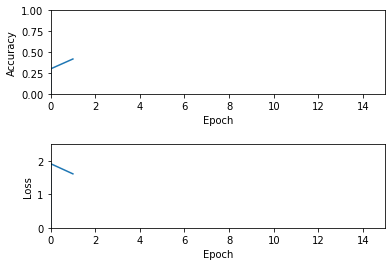

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a0model.ckpt Model Saved...
Epoch [50000], loss: 1.3710, acc: 0.0000
Epoch [50001], loss: 2.2374, acc: 0.0000
Epoch [50002], loss: 0.7036, acc: 1.0000
Epoch [50003], loss: 2.3660, acc: 0.0000
Epoch [50004], loss: 2.2703, acc: 0.0000
Epoch [50005], loss: 0.6472, acc: 1.0000
Epoch [50006], loss: 1.4222, acc: 1.0000
Epoch [50007], loss: 1.8943, acc: 0.0000
Epoch [50008], loss: 1.9840, acc: 0.0000
Epoch [50009], loss: 2.6307, acc: 0.0000
Epoch [50010], loss: 0.7061, acc: 1.0000
Epoch [50011], loss: 2.2035, acc: 0.0000
Epoch [50012], loss: 3.3486, acc: 0.0000
Epoch [50013], loss: 0.8485, acc: 1.0000
Epoch [50014], loss: 1.9756, acc: 0.0000
Epoch [50015], loss: 0.9421, acc: 0.0000
Epoch [50016], loss: 1.1095, acc: 1.0000
Epoch [50017], loss: 1.0934, acc: 1.0000
Epoch [50018], loss: 1.3890, acc: 1.0000
Epoch [50019], loss: 0.3076, acc: 1.0000
Epoch [50020], loss: 1.8356, acc: 0.0000
Epoch [50021], loss: 0.5634, acc: 1.

Epoch [50200], loss: 3.0135, acc: 0.0000
Epoch [50201], loss: 2.1138, acc: 0.0000
Epoch [50202], loss: 0.6232, acc: 1.0000
Epoch [50203], loss: 1.2219, acc: 0.0000
Epoch [50204], loss: 3.2896, acc: 0.0000
Epoch [50205], loss: 1.7263, acc: 0.0000
Epoch [50206], loss: 1.3676, acc: 0.0000
Epoch [50207], loss: 0.9573, acc: 1.0000
Epoch [50208], loss: 0.9994, acc: 1.0000
Epoch [50209], loss: 3.3200, acc: 0.0000
Epoch [50210], loss: 1.6580, acc: 0.0000
Epoch [50211], loss: 0.8789, acc: 1.0000
Epoch [50212], loss: 1.9050, acc: 0.0000
Epoch [50213], loss: 1.1937, acc: 1.0000
Epoch [50214], loss: 0.6555, acc: 1.0000
Epoch [50215], loss: 0.3940, acc: 1.0000
Epoch [50216], loss: 0.8885, acc: 1.0000
Epoch [50217], loss: 1.7154, acc: 1.0000
Epoch [50218], loss: 1.6290, acc: 0.0000
Epoch [50219], loss: 2.8724, acc: 0.0000
Epoch [50220], loss: 1.1884, acc: 1.0000
Epoch [50221], loss: 0.5675, acc: 1.0000
Epoch [50222], loss: 2.3549, acc: 0.0000
Epoch [50223], loss: 1.6536, acc: 0.0000
Epoch [50224], l

Epoch [50401], loss: 0.2090, acc: 1.0000
Epoch [50402], loss: 0.6812, acc: 1.0000
Epoch [50403], loss: 1.3786, acc: 0.0000
Epoch [50404], loss: 3.2795, acc: 0.0000
Epoch [50405], loss: 0.5749, acc: 1.0000
Epoch [50406], loss: 1.3557, acc: 1.0000
Epoch [50407], loss: 1.3684, acc: 0.0000
Epoch [50408], loss: 0.7271, acc: 1.0000
Epoch [50409], loss: 0.5399, acc: 1.0000
Epoch [50410], loss: 0.7352, acc: 1.0000
Epoch [50411], loss: 2.4370, acc: 0.0000
Epoch [50412], loss: 1.1847, acc: 0.0000
Epoch [50413], loss: 2.8597, acc: 0.0000
Epoch [50414], loss: 1.8769, acc: 0.0000
Epoch [50415], loss: 0.7173, acc: 1.0000
Epoch [50416], loss: 0.9632, acc: 1.0000
Epoch [50417], loss: 4.9919, acc: 0.0000
Epoch [50418], loss: 1.7264, acc: 0.0000
Epoch [50419], loss: 0.8595, acc: 1.0000
Epoch [50420], loss: 1.3013, acc: 0.0000
Epoch [50421], loss: 1.4322, acc: 0.0000
Epoch [50422], loss: 1.2286, acc: 1.0000
Epoch [50423], loss: 1.2172, acc: 1.0000
Epoch [50424], loss: 1.3605, acc: 0.0000
Epoch [50425], l

Epoch [50626], loss: 1.6261, acc: 1.0000
Epoch [50627], loss: 1.4156, acc: 1.0000
Epoch [50628], loss: 3.4247, acc: 0.0000
Epoch [50629], loss: 1.8310, acc: 0.0000
Epoch [50630], loss: 1.4545, acc: 1.0000
Epoch [50631], loss: 0.9852, acc: 1.0000
Epoch [50632], loss: 1.7587, acc: 0.0000
Epoch [50633], loss: 0.7416, acc: 1.0000
Epoch [50634], loss: 1.1544, acc: 1.0000
Epoch [50635], loss: 1.8557, acc: 0.0000
Epoch [50636], loss: 0.8836, acc: 1.0000
Epoch [50637], loss: 0.8085, acc: 1.0000
Epoch [50638], loss: 2.6953, acc: 0.0000
Epoch [50639], loss: 1.3900, acc: 1.0000
Epoch [50640], loss: 1.0071, acc: 1.0000
Epoch [50641], loss: 4.4425, acc: 0.0000
Epoch [50642], loss: 1.1230, acc: 1.0000
Epoch [50643], loss: 1.5062, acc: 0.0000
Epoch [50644], loss: 3.9692, acc: 0.0000
Epoch [50645], loss: 2.5515, acc: 0.0000
Epoch [50646], loss: 1.0696, acc: 0.0000
Epoch [50647], loss: 1.5677, acc: 0.0000
Epoch [50648], loss: 2.0792, acc: 0.0000
Epoch [50649], loss: 2.2813, acc: 0.0000
Epoch [50650], l

Epoch [50841], loss: 3.4851, acc: 0.0000
Epoch [50842], loss: 0.8337, acc: 1.0000
Epoch [50843], loss: 1.6769, acc: 0.0000
Epoch [50844], loss: 1.1615, acc: 1.0000
Epoch [50845], loss: 1.0993, acc: 1.0000
Epoch [50846], loss: 1.4866, acc: 0.0000
Epoch [50847], loss: 1.2689, acc: 0.0000
Epoch [50848], loss: 0.8700, acc: 1.0000
Epoch [50849], loss: 2.0760, acc: 0.0000
Epoch [50850], loss: 1.6562, acc: 0.0000
Epoch [50851], loss: 2.4159, acc: 0.0000
Epoch [50852], loss: 1.2284, acc: 1.0000
Epoch [50853], loss: 1.7786, acc: 0.0000
Epoch [50854], loss: 1.8718, acc: 0.0000
Epoch [50855], loss: 1.2189, acc: 0.0000
Epoch [50856], loss: 4.2238, acc: 0.0000
Epoch [50857], loss: 0.4858, acc: 1.0000
Epoch [50858], loss: 1.2735, acc: 0.0000
Epoch [50859], loss: 2.8824, acc: 0.0000
Epoch [50860], loss: 1.8086, acc: 0.0000
Epoch [50861], loss: 1.6828, acc: 0.0000
Epoch [50862], loss: 1.3188, acc: 1.0000
Epoch [50863], loss: 7.6450, acc: 0.0000
Epoch [50864], loss: 3.3835, acc: 0.0000
Epoch [50865], l

Epoch [51066], loss: 2.2225, acc: 0.0000
Epoch [51067], loss: 0.2619, acc: 1.0000
Epoch [51068], loss: 1.4706, acc: 1.0000
Epoch [51069], loss: 0.1942, acc: 1.0000
Epoch [51070], loss: 2.4497, acc: 0.0000
Epoch [51071], loss: 0.3050, acc: 1.0000
Epoch [51072], loss: 0.2206, acc: 1.0000
Epoch [51073], loss: 0.6132, acc: 1.0000
Epoch [51074], loss: 2.0655, acc: 0.0000
Epoch [51075], loss: 2.3357, acc: 0.0000
Epoch [51076], loss: 0.5422, acc: 1.0000
Epoch [51077], loss: 2.4674, acc: 0.0000
Epoch [51078], loss: 1.5916, acc: 0.0000
Epoch [51079], loss: 1.3948, acc: 0.0000
Epoch [51080], loss: 0.6913, acc: 1.0000
Epoch [51081], loss: 2.0112, acc: 0.0000
Epoch [51082], loss: 2.7134, acc: 0.0000
Epoch [51083], loss: 3.5115, acc: 0.0000
Epoch [51084], loss: 3.3224, acc: 0.0000
Epoch [51085], loss: 1.1526, acc: 0.0000
Epoch [51086], loss: 0.5161, acc: 1.0000
Epoch [51087], loss: 2.5075, acc: 0.0000
Epoch [51088], loss: 0.6543, acc: 1.0000
Epoch [51089], loss: 2.9128, acc: 0.0000
Epoch [51090], l

Epoch [51292], loss: 2.5925, acc: 0.0000
Epoch [51293], loss: 1.7809, acc: 0.0000
Epoch [51294], loss: 1.2654, acc: 0.0000
Epoch [51295], loss: 1.5944, acc: 0.0000
Epoch [51296], loss: 1.6052, acc: 0.0000
Epoch [51297], loss: 2.0337, acc: 0.0000
Epoch [51298], loss: 3.0367, acc: 0.0000
Epoch [51299], loss: 1.2409, acc: 1.0000
Epoch [51300], loss: 0.7794, acc: 1.0000
Epoch [51301], loss: 1.3176, acc: 1.0000
Epoch [51302], loss: 1.7921, acc: 0.0000
Epoch [51303], loss: 0.5456, acc: 1.0000
Epoch [51304], loss: 1.3544, acc: 0.0000
Epoch [51305], loss: 1.4964, acc: 0.0000
Epoch [51306], loss: 2.8890, acc: 0.0000
Epoch [51307], loss: 1.3774, acc: 0.0000
Epoch [51308], loss: 0.9545, acc: 1.0000
Epoch [51309], loss: 0.9785, acc: 0.0000
Epoch [51310], loss: 1.6624, acc: 0.0000
Epoch [51311], loss: 0.9039, acc: 1.0000
Epoch [51312], loss: 0.5454, acc: 1.0000
Epoch [51313], loss: 1.1493, acc: 1.0000
Epoch [51314], loss: 3.4009, acc: 0.0000
Epoch [51315], loss: 1.9360, acc: 0.0000
Epoch [51316], l

Epoch [51521], loss: 1.1545, acc: 1.0000
Epoch [51522], loss: 0.9472, acc: 1.0000
Epoch [51523], loss: 3.0200, acc: 0.0000
Epoch [51524], loss: 2.5236, acc: 0.0000
Epoch [51525], loss: 1.2979, acc: 0.0000
Epoch [51526], loss: 1.4396, acc: 0.0000
Epoch [51527], loss: 1.3383, acc: 0.0000
Epoch [51528], loss: 2.0896, acc: 0.0000
Epoch [51529], loss: 1.4418, acc: 0.0000
Epoch [51530], loss: 2.7340, acc: 0.0000
Epoch [51531], loss: 1.1188, acc: 0.0000
Epoch [51532], loss: 0.7522, acc: 1.0000
Epoch [51533], loss: 0.9842, acc: 1.0000
Epoch [51534], loss: 2.1332, acc: 0.0000
Epoch [51535], loss: 1.9795, acc: 0.0000
Epoch [51536], loss: 0.8127, acc: 1.0000
Epoch [51537], loss: 1.1920, acc: 1.0000
Epoch [51538], loss: 0.6759, acc: 1.0000
Epoch [51539], loss: 0.4976, acc: 1.0000
Epoch [51540], loss: 1.1042, acc: 0.0000
Epoch [51541], loss: 1.0745, acc: 0.0000
Epoch [51542], loss: 2.4262, acc: 0.0000
Epoch [51543], loss: 0.7854, acc: 1.0000
Epoch [51544], loss: 0.5327, acc: 1.0000
Epoch [51545], l

Epoch [51736], loss: 1.2590, acc: 0.0000
Epoch [51737], loss: 1.0509, acc: 1.0000
Epoch [51738], loss: 1.3280, acc: 0.0000
Epoch [51739], loss: 0.6981, acc: 1.0000
Epoch [51740], loss: 0.5311, acc: 1.0000
Epoch [51741], loss: 1.5124, acc: 0.0000
Epoch [51742], loss: 2.9865, acc: 0.0000
Epoch [51743], loss: 1.5191, acc: 1.0000
Epoch [51744], loss: 0.3961, acc: 1.0000
Epoch [51745], loss: 1.9457, acc: 0.0000
Epoch [51746], loss: 0.8431, acc: 1.0000
Epoch [51747], loss: 0.4142, acc: 1.0000
Epoch [51748], loss: 1.7503, acc: 0.0000
Epoch [51749], loss: 1.6399, acc: 0.0000
Epoch [51750], loss: 0.1821, acc: 1.0000
Epoch [51751], loss: 1.1224, acc: 0.0000
Epoch [51752], loss: 1.1454, acc: 0.0000
Epoch [51753], loss: 2.6904, acc: 0.0000
Epoch [51754], loss: 1.1308, acc: 0.0000
Epoch [51755], loss: 1.9179, acc: 0.0000
Epoch [51756], loss: 0.7089, acc: 1.0000
Epoch [51757], loss: 0.5429, acc: 1.0000
Epoch [51758], loss: 0.9213, acc: 1.0000
Epoch [51759], loss: 2.5979, acc: 0.0000
Epoch [51760], l

Epoch [51958], loss: 1.0293, acc: 1.0000
Epoch [51959], loss: 2.1512, acc: 0.0000
Epoch [51960], loss: 0.7883, acc: 1.0000
Epoch [51961], loss: 0.5371, acc: 1.0000
Epoch [51962], loss: 1.4833, acc: 0.0000
Epoch [51963], loss: 2.3436, acc: 0.0000
Epoch [51964], loss: 0.3357, acc: 1.0000
Epoch [51965], loss: 3.3546, acc: 0.0000
Epoch [51966], loss: 1.1925, acc: 1.0000
Epoch [51967], loss: 0.7539, acc: 1.0000
Epoch [51968], loss: 1.6731, acc: 0.0000
Epoch [51969], loss: 1.6984, acc: 1.0000
Epoch [51970], loss: 1.6668, acc: 0.0000
Epoch [51971], loss: 2.1415, acc: 0.0000
Epoch [51972], loss: 1.8449, acc: 0.0000
Epoch [51973], loss: 1.8804, acc: 0.0000
Epoch [51974], loss: 1.4951, acc: 1.0000
Epoch [51975], loss: 0.5803, acc: 1.0000
Epoch [51976], loss: 1.2227, acc: 0.0000
Epoch [51977], loss: 0.1952, acc: 1.0000
Epoch [51978], loss: 0.9308, acc: 1.0000
Epoch [51979], loss: 0.9937, acc: 1.0000
Epoch [51980], loss: 0.7016, acc: 1.0000
Epoch [51981], loss: 2.3394, acc: 0.0000
Epoch [51982], l

Epoch [52165], loss: 2.2471, acc: 0.0000
Epoch [52166], loss: 2.3391, acc: 0.0000
Epoch [52167], loss: 3.2103, acc: 0.0000
Epoch [52168], loss: 1.3025, acc: 1.0000
Epoch [52169], loss: 1.0174, acc: 0.0000
Epoch [52170], loss: 1.8223, acc: 0.0000
Epoch [52171], loss: 0.5142, acc: 1.0000
Epoch [52172], loss: 1.4468, acc: 1.0000
Epoch [52173], loss: 2.6782, acc: 0.0000
Epoch [52174], loss: 2.0371, acc: 0.0000
Epoch [52175], loss: 1.2224, acc: 1.0000
Epoch [52176], loss: 0.6232, acc: 1.0000
Epoch [52177], loss: 1.0470, acc: 1.0000
Epoch [52178], loss: 1.3743, acc: 0.0000
Epoch [52179], loss: 2.0940, acc: 0.0000
Epoch [52180], loss: 0.7218, acc: 1.0000
Epoch [52181], loss: 1.1684, acc: 1.0000
Epoch [52182], loss: 1.6641, acc: 0.0000
Epoch [52183], loss: 0.8542, acc: 1.0000
Epoch [52184], loss: 1.4062, acc: 1.0000
Epoch [52185], loss: 1.4147, acc: 0.0000
Epoch [52186], loss: 0.3465, acc: 1.0000
Epoch [52187], loss: 0.8264, acc: 1.0000
Epoch [52188], loss: 1.3097, acc: 0.0000
Epoch [52189], l

Epoch [52377], loss: 2.0274, acc: 0.0000
Epoch [52378], loss: 0.6049, acc: 1.0000
Epoch [52379], loss: 1.4805, acc: 0.0000
Epoch [52380], loss: 0.8073, acc: 1.0000
Epoch [52381], loss: 0.4537, acc: 1.0000
Epoch [52382], loss: 0.7605, acc: 1.0000
Epoch [52383], loss: 2.3806, acc: 0.0000
Epoch [52384], loss: 2.3609, acc: 0.0000
Epoch [52385], loss: 1.6630, acc: 0.0000
Epoch [52386], loss: 3.1666, acc: 0.0000
Epoch [52387], loss: 1.0955, acc: 1.0000
Epoch [52388], loss: 3.0954, acc: 0.0000
Epoch [52389], loss: 0.8957, acc: 1.0000
Epoch [52390], loss: 1.9420, acc: 0.0000
Epoch [52391], loss: 1.1594, acc: 0.0000
Epoch [52392], loss: 0.6995, acc: 1.0000
Epoch [52393], loss: 2.1000, acc: 0.0000
Epoch [52394], loss: 2.8076, acc: 0.0000
Epoch [52395], loss: 0.5664, acc: 1.0000
Epoch [52396], loss: 1.4785, acc: 0.0000
Epoch [52397], loss: 2.7936, acc: 0.0000
Epoch [52398], loss: 1.0439, acc: 1.0000
Epoch [52399], loss: 1.7830, acc: 0.0000
Epoch [52400], loss: 0.4954, acc: 1.0000
Epoch [52401], l

Epoch [52600], loss: 1.3254, acc: 1.0000
Epoch [52601], loss: 0.4568, acc: 1.0000
Epoch [52602], loss: 2.2396, acc: 0.0000
Epoch [52603], loss: 0.3927, acc: 1.0000
Epoch [52604], loss: 0.1781, acc: 1.0000
Epoch [52605], loss: 1.5191, acc: 1.0000
Epoch [52606], loss: 1.8338, acc: 0.0000
Epoch [52607], loss: 1.6921, acc: 0.0000
Epoch [52608], loss: 1.3321, acc: 0.0000
Epoch [52609], loss: 0.3481, acc: 1.0000
Epoch [52610], loss: 0.5299, acc: 1.0000
Epoch [52611], loss: 3.2997, acc: 0.0000
Epoch [52612], loss: 1.3392, acc: 0.0000
Epoch [52613], loss: 0.5937, acc: 1.0000
Epoch [52614], loss: 2.4956, acc: 0.0000
Epoch [52615], loss: 2.5941, acc: 0.0000
Epoch [52616], loss: 4.2921, acc: 0.0000
Epoch [52617], loss: 0.3336, acc: 1.0000
Epoch [52618], loss: 1.1137, acc: 1.0000
Epoch [52619], loss: 0.7515, acc: 1.0000
Epoch [52620], loss: 1.6055, acc: 1.0000
Epoch [52621], loss: 2.2634, acc: 0.0000
Epoch [52622], loss: 1.1227, acc: 1.0000
Epoch [52623], loss: 1.5470, acc: 0.0000
Epoch [52624], l

Epoch [52811], loss: 1.3715, acc: 0.0000
Epoch [52812], loss: 3.3722, acc: 0.0000
Epoch [52813], loss: 3.4509, acc: 0.0000
Epoch [52814], loss: 0.7539, acc: 1.0000
Epoch [52815], loss: 1.5884, acc: 0.0000
Epoch [52816], loss: 0.6519, acc: 1.0000
Epoch [52817], loss: 1.1044, acc: 1.0000
Epoch [52818], loss: 0.7235, acc: 1.0000
Epoch [52819], loss: 1.3305, acc: 0.0000
Epoch [52820], loss: 0.9309, acc: 1.0000
Epoch [52821], loss: 2.5898, acc: 0.0000
Epoch [52822], loss: 1.0595, acc: 0.0000
Epoch [52823], loss: 2.5090, acc: 0.0000
Epoch [52824], loss: 2.8415, acc: 0.0000
Epoch [52825], loss: 1.0281, acc: 0.0000
Epoch [52826], loss: 1.9692, acc: 0.0000
Epoch [52827], loss: 2.0882, acc: 0.0000
Epoch [52828], loss: 1.1237, acc: 0.0000
Epoch [52829], loss: 0.8965, acc: 0.0000
Epoch [52830], loss: 0.4695, acc: 1.0000
Epoch [52831], loss: 1.9022, acc: 0.0000
Epoch [52832], loss: 0.6990, acc: 1.0000
Epoch [52833], loss: 0.8655, acc: 1.0000
Epoch [52834], loss: 0.8188, acc: 1.0000
Epoch [52835], l

Epoch [53013], loss: 1.2450, acc: 1.0000
Epoch [53014], loss: 2.4923, acc: 0.0000
Epoch [53015], loss: 1.3436, acc: 0.0000
Epoch [53016], loss: 1.0119, acc: 1.0000
Epoch [53017], loss: 2.8623, acc: 0.0000
Epoch [53018], loss: 1.7350, acc: 0.0000
Epoch [53019], loss: 0.9143, acc: 1.0000
Epoch [53020], loss: 1.0794, acc: 1.0000
Epoch [53021], loss: 0.8740, acc: 1.0000
Epoch [53022], loss: 0.0952, acc: 1.0000
Epoch [53023], loss: 1.1721, acc: 0.0000
Epoch [53024], loss: 0.6199, acc: 1.0000
Epoch [53025], loss: 1.5051, acc: 0.0000
Epoch [53026], loss: 1.5740, acc: 1.0000
Epoch [53027], loss: 1.5222, acc: 1.0000
Epoch [53028], loss: 1.4375, acc: 0.0000
Epoch [53029], loss: 2.5283, acc: 0.0000
Epoch [53030], loss: 0.9449, acc: 1.0000
Epoch [53031], loss: 1.3655, acc: 0.0000
Epoch [53032], loss: 1.1897, acc: 1.0000
Epoch [53033], loss: 1.1771, acc: 1.0000
Epoch [53034], loss: 1.5561, acc: 1.0000
Epoch [53035], loss: 1.6343, acc: 0.0000
Epoch [53036], loss: 0.5383, acc: 1.0000
Epoch [53037], l

Epoch [53230], loss: 1.8430, acc: 0.0000
Epoch [53231], loss: 2.4028, acc: 0.0000
Epoch [53232], loss: 1.7325, acc: 1.0000
Epoch [53233], loss: 3.4969, acc: 0.0000
Epoch [53234], loss: 1.5526, acc: 0.0000
Epoch [53235], loss: 0.7507, acc: 1.0000
Epoch [53236], loss: 0.8640, acc: 1.0000
Epoch [53237], loss: 1.1022, acc: 1.0000
Epoch [53238], loss: 2.7087, acc: 0.0000
Epoch [53239], loss: 1.4692, acc: 0.0000
Epoch [53240], loss: 0.4210, acc: 1.0000
Epoch [53241], loss: 1.4183, acc: 0.0000
Epoch [53242], loss: 0.9475, acc: 1.0000
Epoch [53243], loss: 0.6500, acc: 1.0000
Epoch [53244], loss: 0.6028, acc: 1.0000
Epoch [53245], loss: 0.1459, acc: 1.0000
Epoch [53246], loss: 1.3288, acc: 1.0000
Epoch [53247], loss: 2.2805, acc: 0.0000
Epoch [53248], loss: 0.6895, acc: 1.0000
Epoch [53249], loss: 1.2857, acc: 1.0000
Epoch [53250], loss: 1.3836, acc: 1.0000
Epoch [53251], loss: 1.7867, acc: 0.0000
Epoch [53252], loss: 0.7251, acc: 1.0000
Epoch [53253], loss: 0.3390, acc: 1.0000
Epoch [53254], l

Epoch [53442], loss: 0.8743, acc: 1.0000
Epoch [53443], loss: 1.1994, acc: 0.0000
Epoch [53444], loss: 1.4504, acc: 0.0000
Epoch [53445], loss: 2.5094, acc: 0.0000
Epoch [53446], loss: 0.8530, acc: 1.0000
Epoch [53447], loss: 0.9284, acc: 1.0000
Epoch [53448], loss: 3.4057, acc: 0.0000
Epoch [53449], loss: 0.6725, acc: 1.0000
Epoch [53450], loss: 0.9691, acc: 1.0000
Epoch [53451], loss: 2.0692, acc: 0.0000
Epoch [53452], loss: 1.1983, acc: 0.0000
Epoch [53453], loss: 1.3086, acc: 0.0000
Epoch [53454], loss: 3.2221, acc: 0.0000
Epoch [53455], loss: 0.7286, acc: 1.0000
Epoch [53456], loss: 0.8502, acc: 1.0000
Epoch [53457], loss: 2.5936, acc: 0.0000
Epoch [53458], loss: 2.1436, acc: 0.0000
Epoch [53459], loss: 1.9175, acc: 0.0000
Epoch [53460], loss: 1.5483, acc: 0.0000
Epoch [53461], loss: 2.9314, acc: 0.0000
Epoch [53462], loss: 1.2429, acc: 1.0000
Epoch [53463], loss: 0.9108, acc: 1.0000
Epoch [53464], loss: 4.3035, acc: 0.0000
Epoch [53465], loss: 0.9016, acc: 1.0000
Epoch [53466], l

Epoch [53647], loss: 1.2583, acc: 1.0000
Epoch [53648], loss: 0.6419, acc: 1.0000
Epoch [53649], loss: 0.7827, acc: 1.0000
Epoch [53650], loss: 1.7307, acc: 0.0000
Epoch [53651], loss: 3.0823, acc: 0.0000
Epoch [53652], loss: 2.3613, acc: 0.0000
Epoch [53653], loss: 1.2688, acc: 1.0000
Epoch [53654], loss: 1.8387, acc: 0.0000
Epoch [53655], loss: 0.2812, acc: 1.0000
Epoch [53656], loss: 1.5852, acc: 0.0000
Epoch [53657], loss: 1.2924, acc: 1.0000
Epoch [53658], loss: 1.4769, acc: 0.0000
Epoch [53659], loss: 0.9613, acc: 1.0000
Epoch [53660], loss: 1.4152, acc: 1.0000
Epoch [53661], loss: 0.4588, acc: 1.0000
Epoch [53662], loss: 1.0354, acc: 1.0000
Epoch [53663], loss: 3.1570, acc: 0.0000
Epoch [53664], loss: 0.8147, acc: 1.0000
Epoch [53665], loss: 1.4411, acc: 0.0000
Epoch [53666], loss: 0.2863, acc: 1.0000
Epoch [53667], loss: 1.2108, acc: 1.0000
Epoch [53668], loss: 1.1252, acc: 1.0000
Epoch [53669], loss: 3.2987, acc: 0.0000
Epoch [53670], loss: 1.8624, acc: 0.0000
Epoch [53671], l

Epoch [53861], loss: 2.0151, acc: 0.0000
Epoch [53862], loss: 1.8723, acc: 0.0000
Epoch [53863], loss: 0.9524, acc: 0.0000
Epoch [53864], loss: 2.7171, acc: 0.0000
Epoch [53865], loss: 2.0843, acc: 0.0000
Epoch [53866], loss: 0.9035, acc: 0.0000
Epoch [53867], loss: 0.9325, acc: 1.0000
Epoch [53868], loss: 1.2479, acc: 0.0000
Epoch [53869], loss: 3.0294, acc: 0.0000
Epoch [53870], loss: 1.8801, acc: 0.0000
Epoch [53871], loss: 2.5693, acc: 0.0000
Epoch [53872], loss: 0.5113, acc: 1.0000
Epoch [53873], loss: 2.3657, acc: 0.0000
Epoch [53874], loss: 0.5535, acc: 1.0000
Epoch [53875], loss: 1.2548, acc: 1.0000
Epoch [53876], loss: 1.6594, acc: 0.0000
Epoch [53877], loss: 1.5644, acc: 0.0000
Epoch [53878], loss: 1.2307, acc: 1.0000
Epoch [53879], loss: 0.5111, acc: 1.0000
Epoch [53880], loss: 1.7260, acc: 0.0000
Epoch [53881], loss: 2.5329, acc: 0.0000
Epoch [53882], loss: 4.7430, acc: 0.0000
Epoch [53883], loss: 1.9879, acc: 0.0000
Epoch [53884], loss: 1.7387, acc: 0.0000
Epoch [53885], l

Epoch [54077], loss: 1.7737, acc: 0.0000
Epoch [54078], loss: 1.1482, acc: 1.0000
Epoch [54079], loss: 0.8481, acc: 1.0000
Epoch [54080], loss: 2.3615, acc: 0.0000
Epoch [54081], loss: 1.3061, acc: 0.0000
Epoch [54082], loss: 1.7808, acc: 0.0000
Epoch [54083], loss: 1.2495, acc: 1.0000
Epoch [54084], loss: 0.8897, acc: 1.0000
Epoch [54085], loss: 1.9123, acc: 0.0000
Epoch [54086], loss: 1.7292, acc: 1.0000
Epoch [54087], loss: 1.0437, acc: 1.0000
Epoch [54088], loss: 1.1760, acc: 1.0000
Epoch [54089], loss: 1.1857, acc: 0.0000
Epoch [54090], loss: 1.5998, acc: 1.0000
Epoch [54091], loss: 0.7259, acc: 1.0000
Epoch [54092], loss: 1.2301, acc: 1.0000
Epoch [54093], loss: 1.2108, acc: 0.0000
Epoch [54094], loss: 0.0548, acc: 1.0000
Epoch [54095], loss: 1.1338, acc: 0.0000
Epoch [54096], loss: 0.5096, acc: 1.0000
Epoch [54097], loss: 2.3786, acc: 0.0000
Epoch [54098], loss: 1.4158, acc: 0.0000
Epoch [54099], loss: 0.0761, acc: 1.0000
Epoch [54100], loss: 0.3522, acc: 1.0000
Epoch [54101], l

Epoch [54287], loss: 0.5649, acc: 1.0000
Epoch [54288], loss: 1.4391, acc: 0.0000
Epoch [54289], loss: 0.7200, acc: 1.0000
Epoch [54290], loss: 1.8764, acc: 0.0000
Epoch [54291], loss: 0.7971, acc: 0.0000
Epoch [54292], loss: 1.0668, acc: 1.0000
Epoch [54293], loss: 0.8762, acc: 1.0000
Epoch [54294], loss: 1.0990, acc: 1.0000
Epoch [54295], loss: 0.5419, acc: 1.0000
Epoch [54296], loss: 0.9956, acc: 1.0000
Epoch [54297], loss: 2.7740, acc: 0.0000
Epoch [54298], loss: 0.8132, acc: 1.0000
Epoch [54299], loss: 1.0162, acc: 1.0000
Epoch [54300], loss: 1.0874, acc: 1.0000
Epoch [54301], loss: 1.0285, acc: 0.0000
Epoch [54302], loss: 1.2370, acc: 0.0000
Epoch [54303], loss: 2.9186, acc: 0.0000
Epoch [54304], loss: 2.4913, acc: 0.0000
Epoch [54305], loss: 0.8472, acc: 1.0000
Epoch [54306], loss: 1.1005, acc: 0.0000
Epoch [54307], loss: 1.9930, acc: 0.0000
Epoch [54308], loss: 0.3186, acc: 1.0000
Epoch [54309], loss: 2.9457, acc: 0.0000
Epoch [54310], loss: 1.8527, acc: 0.0000
Epoch [54311], l

Epoch [54506], loss: 1.0442, acc: 0.0000
Epoch [54507], loss: 0.3392, acc: 1.0000
Epoch [54508], loss: 0.9580, acc: 1.0000
Epoch [54509], loss: 1.6186, acc: 0.0000
Epoch [54510], loss: 3.7704, acc: 0.0000
Epoch [54511], loss: 0.1311, acc: 1.0000
Epoch [54512], loss: 0.5613, acc: 1.0000
Epoch [54513], loss: 0.9821, acc: 1.0000
Epoch [54514], loss: 1.3999, acc: 0.0000
Epoch [54515], loss: 1.5514, acc: 0.0000
Epoch [54516], loss: 0.2997, acc: 1.0000
Epoch [54517], loss: 0.9531, acc: 1.0000
Epoch [54518], loss: 0.4034, acc: 1.0000
Epoch [54519], loss: 0.7127, acc: 1.0000
Epoch [54520], loss: 1.6634, acc: 0.0000
Epoch [54521], loss: 0.5096, acc: 1.0000
Epoch [54522], loss: 3.5873, acc: 0.0000
Epoch [54523], loss: 0.9935, acc: 0.0000
Epoch [54524], loss: 1.7407, acc: 0.0000
Epoch [54525], loss: 1.9689, acc: 0.0000
Epoch [54526], loss: 0.1896, acc: 1.0000
Epoch [54527], loss: 2.7783, acc: 0.0000
Epoch [54528], loss: 0.6375, acc: 1.0000
Epoch [54529], loss: 1.7948, acc: 0.0000
Epoch [54530], l

Epoch [54731], loss: 1.4601, acc: 0.0000
Epoch [54732], loss: 1.0854, acc: 1.0000
Epoch [54733], loss: 0.5148, acc: 1.0000
Epoch [54734], loss: 0.9527, acc: 1.0000
Epoch [54735], loss: 1.1020, acc: 0.0000
Epoch [54736], loss: 2.0924, acc: 0.0000
Epoch [54737], loss: 1.1198, acc: 1.0000
Epoch [54738], loss: 1.6844, acc: 0.0000
Epoch [54739], loss: 1.5429, acc: 0.0000
Epoch [54740], loss: 2.2590, acc: 0.0000
Epoch [54741], loss: 2.6246, acc: 0.0000
Epoch [54742], loss: 3.0620, acc: 0.0000
Epoch [54743], loss: 2.3908, acc: 0.0000
Epoch [54744], loss: 1.6885, acc: 0.0000
Epoch [54745], loss: 0.8432, acc: 1.0000
Epoch [54746], loss: 0.6012, acc: 1.0000
Epoch [54747], loss: 1.4557, acc: 0.0000
Epoch [54748], loss: 1.9581, acc: 0.0000
Epoch [54749], loss: 1.4942, acc: 0.0000
Epoch [54750], loss: 1.2143, acc: 1.0000
Epoch [54751], loss: 1.3265, acc: 0.0000
Epoch [54752], loss: 1.1395, acc: 1.0000
Epoch [54753], loss: 0.2734, acc: 1.0000
Epoch [54754], loss: 2.0699, acc: 0.0000
Epoch [54755], l

Epoch [54961], loss: 2.4802, acc: 0.0000
Epoch [54962], loss: 2.0774, acc: 0.0000
Epoch [54963], loss: 1.2498, acc: 0.0000
Epoch [54964], loss: 2.3089, acc: 0.0000
Epoch [54965], loss: 1.4127, acc: 0.0000
Epoch [54966], loss: 1.3237, acc: 0.0000
Epoch [54967], loss: 1.2212, acc: 0.0000
Epoch [54968], loss: 1.7804, acc: 0.0000
Epoch [54969], loss: 2.0807, acc: 0.0000
Epoch [54970], loss: 1.5827, acc: 1.0000
Epoch [54971], loss: 1.1663, acc: 1.0000
Epoch [54972], loss: 5.2617, acc: 0.0000
Epoch [54973], loss: 0.3363, acc: 1.0000
Epoch [54974], loss: 1.3664, acc: 0.0000
Epoch [54975], loss: 1.6879, acc: 0.0000
Epoch [54976], loss: 0.3547, acc: 1.0000
Epoch [54977], loss: 1.9777, acc: 0.0000
Epoch [54978], loss: 1.6011, acc: 0.0000
Epoch [54979], loss: 1.5553, acc: 0.0000
Epoch [54980], loss: 1.8321, acc: 0.0000
Epoch [54981], loss: 0.4869, acc: 1.0000
Epoch [54982], loss: 4.0367, acc: 0.0000
Epoch [54983], loss: 1.8484, acc: 0.0000
Epoch [54984], loss: 2.6617, acc: 0.0000
Epoch [54985], l

Epoch [55171], loss: 1.3829, acc: 1.0000
Epoch [55172], loss: 1.7474, acc: 0.0000
Epoch [55173], loss: 3.5933, acc: 0.0000
Epoch [55174], loss: 3.6896, acc: 0.0000
Epoch [55175], loss: 0.7442, acc: 1.0000
Epoch [55176], loss: 1.1430, acc: 0.0000
Epoch [55177], loss: 1.7025, acc: 0.0000
Epoch [55178], loss: 1.6952, acc: 0.0000
Epoch [55179], loss: 0.8445, acc: 1.0000
Epoch [55180], loss: 1.3844, acc: 0.0000
Epoch [55181], loss: 1.1332, acc: 0.0000
Epoch [55182], loss: 0.1511, acc: 1.0000
Epoch [55183], loss: 1.2087, acc: 1.0000
Epoch [55184], loss: 1.0341, acc: 0.0000
Epoch [55185], loss: 1.5111, acc: 1.0000
Epoch [55186], loss: 1.1067, acc: 1.0000
Epoch [55187], loss: 1.4900, acc: 1.0000
Epoch [55188], loss: 1.0538, acc: 1.0000
Epoch [55189], loss: 2.4086, acc: 0.0000
Epoch [55190], loss: 2.1735, acc: 0.0000
Epoch [55191], loss: 1.6788, acc: 0.0000
Epoch [55192], loss: 1.6062, acc: 0.0000
Epoch [55193], loss: 1.5869, acc: 0.0000
Epoch [55194], loss: 1.5849, acc: 0.0000
Epoch [55195], l

Epoch [55373], loss: 1.7302, acc: 0.0000
Epoch [55374], loss: 2.7594, acc: 0.0000
Epoch [55375], loss: 0.5345, acc: 1.0000
Epoch [55376], loss: 0.5507, acc: 1.0000
Epoch [55377], loss: 1.4539, acc: 0.0000
Epoch [55378], loss: 1.2239, acc: 1.0000
Epoch [55379], loss: 1.0281, acc: 1.0000
Epoch [55380], loss: 1.1244, acc: 1.0000
Epoch [55381], loss: 0.4889, acc: 1.0000
Epoch [55382], loss: 1.0533, acc: 1.0000
Epoch [55383], loss: 2.0410, acc: 0.0000
Epoch [55384], loss: 0.7848, acc: 1.0000
Epoch [55385], loss: 1.9690, acc: 0.0000
Epoch [55386], loss: 4.3000, acc: 0.0000
Epoch [55387], loss: 2.8185, acc: 0.0000
Epoch [55388], loss: 0.8326, acc: 1.0000
Epoch [55389], loss: 2.2066, acc: 0.0000
Epoch [55390], loss: 1.0097, acc: 1.0000
Epoch [55391], loss: 1.3526, acc: 0.0000
Epoch [55392], loss: 0.9942, acc: 1.0000
Epoch [55393], loss: 1.9578, acc: 0.0000
Epoch [55394], loss: 0.0951, acc: 1.0000
Epoch [55395], loss: 3.9284, acc: 0.0000
Epoch [55396], loss: 1.8024, acc: 0.0000
Epoch [55397], l

Epoch [55583], loss: 1.2906, acc: 1.0000
Epoch [55584], loss: 0.3038, acc: 1.0000
Epoch [55585], loss: 1.4391, acc: 0.0000
Epoch [55586], loss: 1.0032, acc: 1.0000
Epoch [55587], loss: 0.8388, acc: 1.0000
Epoch [55588], loss: 0.7293, acc: 1.0000
Epoch [55589], loss: 4.4840, acc: 0.0000
Epoch [55590], loss: 0.9396, acc: 1.0000
Epoch [55591], loss: 2.3600, acc: 0.0000
Epoch [55592], loss: 0.8842, acc: 1.0000
Epoch [55593], loss: 2.4790, acc: 0.0000
Epoch [55594], loss: 1.6632, acc: 0.0000
Epoch [55595], loss: 0.4011, acc: 1.0000
Epoch [55596], loss: 2.4427, acc: 0.0000
Epoch [55597], loss: 0.7695, acc: 1.0000
Epoch [55598], loss: 0.5590, acc: 1.0000
Epoch [55599], loss: 0.3545, acc: 1.0000
Epoch [55600], loss: 2.7442, acc: 0.0000
Epoch [55601], loss: 1.4215, acc: 0.0000
Epoch [55602], loss: 3.7940, acc: 0.0000
Epoch [55603], loss: 1.9856, acc: 0.0000
Epoch [55604], loss: 0.5421, acc: 1.0000
Epoch [55605], loss: 2.2353, acc: 0.0000
Epoch [55606], loss: 1.1772, acc: 1.0000
Epoch [55607], l

Epoch [55787], loss: 1.3149, acc: 1.0000
Epoch [55788], loss: 0.7571, acc: 1.0000
Epoch [55789], loss: 1.1919, acc: 1.0000
Epoch [55790], loss: 0.1268, acc: 1.0000
Epoch [55791], loss: 1.2159, acc: 0.0000
Epoch [55792], loss: 2.4290, acc: 0.0000
Epoch [55793], loss: 0.8047, acc: 1.0000
Epoch [55794], loss: 1.9346, acc: 0.0000
Epoch [55795], loss: 2.4515, acc: 0.0000
Epoch [55796], loss: 1.7069, acc: 1.0000
Epoch [55797], loss: 1.7021, acc: 0.0000
Epoch [55798], loss: 0.6309, acc: 1.0000
Epoch [55799], loss: 0.3842, acc: 1.0000
Epoch [55800], loss: 2.4141, acc: 0.0000
Epoch [55801], loss: 0.5090, acc: 1.0000
Epoch [55802], loss: 5.4545, acc: 0.0000
Epoch [55803], loss: 2.0570, acc: 0.0000
Epoch [55804], loss: 0.9807, acc: 1.0000
Epoch [55805], loss: 3.9265, acc: 0.0000
Epoch [55806], loss: 2.8993, acc: 0.0000
Epoch [55807], loss: 1.4049, acc: 0.0000
Epoch [55808], loss: 0.9099, acc: 1.0000
Epoch [55809], loss: 1.0226, acc: 1.0000
Epoch [55810], loss: 3.9848, acc: 0.0000
Epoch [55811], l

Epoch [56013], loss: 3.2470, acc: 0.0000
Epoch [56014], loss: 0.8921, acc: 0.0000
Epoch [56015], loss: 1.9150, acc: 0.0000
Epoch [56016], loss: 0.6418, acc: 1.0000
Epoch [56017], loss: 0.6352, acc: 1.0000
Epoch [56018], loss: 1.1041, acc: 0.0000
Epoch [56019], loss: 0.7413, acc: 1.0000
Epoch [56020], loss: 1.5548, acc: 0.0000
Epoch [56021], loss: 0.7625, acc: 1.0000
Epoch [56022], loss: 1.7525, acc: 0.0000
Epoch [56023], loss: 0.9024, acc: 1.0000
Epoch [56024], loss: 1.2391, acc: 1.0000
Epoch [56025], loss: 0.6757, acc: 1.0000
Epoch [56026], loss: 1.5512, acc: 0.0000
Epoch [56027], loss: 0.8635, acc: 1.0000
Epoch [56028], loss: 3.4973, acc: 0.0000
Epoch [56029], loss: 0.8917, acc: 1.0000
Epoch [56030], loss: 0.3468, acc: 1.0000
Epoch [56031], loss: 2.2067, acc: 0.0000
Epoch [56032], loss: 0.7185, acc: 1.0000
Epoch [56033], loss: 1.1455, acc: 0.0000
Epoch [56034], loss: 1.0464, acc: 1.0000
Epoch [56035], loss: 2.0688, acc: 0.0000
Epoch [56036], loss: 5.0707, acc: 0.0000
Epoch [56037], l

Epoch [56226], loss: 0.7485, acc: 1.0000
Epoch [56227], loss: 2.0278, acc: 0.0000
Epoch [56228], loss: 2.4678, acc: 0.0000
Epoch [56229], loss: 2.0884, acc: 0.0000
Epoch [56230], loss: 3.0160, acc: 0.0000
Epoch [56231], loss: 1.5816, acc: 0.0000
Epoch [56232], loss: 0.7879, acc: 1.0000
Epoch [56233], loss: 0.4351, acc: 1.0000
Epoch [56234], loss: 2.2155, acc: 0.0000
Epoch [56235], loss: 1.6229, acc: 0.0000
Epoch [56236], loss: 1.1757, acc: 0.0000
Epoch [56237], loss: 1.1610, acc: 0.0000
Epoch [56238], loss: 1.9962, acc: 0.0000
Epoch [56239], loss: 1.9591, acc: 0.0000
Epoch [56240], loss: 0.9770, acc: 1.0000
Epoch [56241], loss: 1.2116, acc: 0.0000
Epoch [56242], loss: 1.6229, acc: 0.0000
Epoch [56243], loss: 1.3761, acc: 0.0000
Epoch [56244], loss: 2.7878, acc: 0.0000
Epoch [56245], loss: 1.6849, acc: 0.0000
Epoch [56246], loss: 1.4762, acc: 0.0000
Epoch [56247], loss: 0.5912, acc: 1.0000
Epoch [56248], loss: 0.9333, acc: 1.0000
Epoch [56249], loss: 0.9279, acc: 1.0000
Epoch [56250], l

Epoch [56450], loss: 0.8869, acc: 1.0000
Epoch [56451], loss: 4.0739, acc: 0.0000
Epoch [56452], loss: 0.4544, acc: 1.0000
Epoch [56453], loss: 2.2801, acc: 0.0000
Epoch [56454], loss: 3.0564, acc: 0.0000
Epoch [56455], loss: 1.3377, acc: 1.0000
Epoch [56456], loss: 2.8056, acc: 0.0000
Epoch [56457], loss: 2.2234, acc: 0.0000
Epoch [56458], loss: 2.8133, acc: 0.0000
Epoch [56459], loss: 2.2683, acc: 0.0000
Epoch [56460], loss: 0.7659, acc: 1.0000
Epoch [56461], loss: 3.4320, acc: 0.0000
Epoch [56462], loss: 1.2681, acc: 1.0000
Epoch [56463], loss: 0.5176, acc: 1.0000
Epoch [56464], loss: 0.9989, acc: 1.0000
Epoch [56465], loss: 1.7628, acc: 0.0000
Epoch [56466], loss: 1.4939, acc: 0.0000
Epoch [56467], loss: 1.9889, acc: 0.0000
Epoch [56468], loss: 0.5976, acc: 1.0000
Epoch [56469], loss: 0.9339, acc: 1.0000
Epoch [56470], loss: 2.5615, acc: 0.0000
Epoch [56471], loss: 1.9016, acc: 0.0000
Epoch [56472], loss: 0.3917, acc: 1.0000
Epoch [56473], loss: 1.4055, acc: 0.0000
Epoch [56474], l

Epoch [56663], loss: 1.0268, acc: 1.0000
Epoch [56664], loss: 1.6179, acc: 0.0000
Epoch [56665], loss: 1.3655, acc: 0.0000
Epoch [56666], loss: 0.8383, acc: 1.0000
Epoch [56667], loss: 1.9741, acc: 0.0000
Epoch [56668], loss: 2.2125, acc: 0.0000
Epoch [56669], loss: 1.5740, acc: 0.0000
Epoch [56670], loss: 1.1066, acc: 1.0000
Epoch [56671], loss: 1.4272, acc: 1.0000
Epoch [56672], loss: 2.7225, acc: 0.0000
Epoch [56673], loss: 2.5788, acc: 0.0000
Epoch [56674], loss: 0.8520, acc: 1.0000
Epoch [56675], loss: 1.9727, acc: 0.0000
Epoch [56676], loss: 1.0658, acc: 0.0000
Epoch [56677], loss: 0.9841, acc: 1.0000
Epoch [56678], loss: 3.5654, acc: 0.0000
Epoch [56679], loss: 1.1661, acc: 1.0000
Epoch [56680], loss: 1.2124, acc: 1.0000
Epoch [56681], loss: 1.3815, acc: 1.0000
Epoch [56682], loss: 1.1671, acc: 1.0000
Epoch [56683], loss: 2.0161, acc: 0.0000
Epoch [56684], loss: 1.4114, acc: 0.0000
Epoch [56685], loss: 1.2160, acc: 0.0000
Epoch [56686], loss: 2.2599, acc: 0.0000
Epoch [56687], l

Epoch [56872], loss: 2.0338, acc: 0.0000
Epoch [56873], loss: 0.9376, acc: 1.0000
Epoch [56874], loss: 0.1293, acc: 1.0000
Epoch [56875], loss: 2.4412, acc: 0.0000
Epoch [56876], loss: 0.8725, acc: 0.0000
Epoch [56877], loss: 2.4300, acc: 0.0000
Epoch [56878], loss: 0.6188, acc: 1.0000
Epoch [56879], loss: 1.4463, acc: 0.0000
Epoch [56880], loss: 1.1202, acc: 0.0000
Epoch [56881], loss: 1.4984, acc: 0.0000
Epoch [56882], loss: 1.3633, acc: 0.0000
Epoch [56883], loss: 3.4441, acc: 0.0000
Epoch [56884], loss: 0.6467, acc: 1.0000
Epoch [56885], loss: 0.7260, acc: 1.0000
Epoch [56886], loss: 3.0492, acc: 0.0000
Epoch [56887], loss: 0.5890, acc: 1.0000
Epoch [56888], loss: 0.5463, acc: 1.0000
Epoch [56889], loss: 2.2302, acc: 0.0000
Epoch [56890], loss: 3.0715, acc: 0.0000
Epoch [56891], loss: 1.1139, acc: 0.0000
Epoch [56892], loss: 1.9741, acc: 0.0000
Epoch [56893], loss: 1.5180, acc: 0.0000
Epoch [56894], loss: 1.4846, acc: 0.0000
Epoch [56895], loss: 1.7531, acc: 0.0000
Epoch [56896], l

Epoch [57082], loss: 0.6722, acc: 1.0000
Epoch [57083], loss: 2.3192, acc: 0.0000
Epoch [57084], loss: 2.1265, acc: 0.0000
Epoch [57085], loss: 2.7244, acc: 0.0000
Epoch [57086], loss: 4.5476, acc: 0.0000
Epoch [57087], loss: 0.8990, acc: 1.0000
Epoch [57088], loss: 1.4421, acc: 0.0000
Epoch [57089], loss: 0.5336, acc: 1.0000
Epoch [57090], loss: 2.2068, acc: 0.0000
Epoch [57091], loss: 0.4523, acc: 1.0000
Epoch [57092], loss: 3.3611, acc: 0.0000
Epoch [57093], loss: 0.6525, acc: 1.0000
Epoch [57094], loss: 1.5785, acc: 1.0000
Epoch [57095], loss: 1.5738, acc: 0.0000
Epoch [57096], loss: 1.1996, acc: 1.0000
Epoch [57097], loss: 2.1619, acc: 0.0000
Epoch [57098], loss: 2.7180, acc: 0.0000
Epoch [57099], loss: 3.8732, acc: 0.0000
Epoch [57100], loss: 0.3604, acc: 1.0000
Epoch [57101], loss: 2.1043, acc: 0.0000
Epoch [57102], loss: 1.2676, acc: 0.0000
Epoch [57103], loss: 2.3430, acc: 0.0000
Epoch [57104], loss: 2.5459, acc: 0.0000
Epoch [57105], loss: 2.5128, acc: 0.0000
Epoch [57106], l

Epoch [57300], loss: 0.6860, acc: 1.0000
Epoch [57301], loss: 2.6834, acc: 0.0000
Epoch [57302], loss: 2.1949, acc: 0.0000
Epoch [57303], loss: 0.6045, acc: 1.0000
Epoch [57304], loss: 2.4594, acc: 0.0000
Epoch [57305], loss: 2.7534, acc: 0.0000
Epoch [57306], loss: 0.7249, acc: 1.0000
Epoch [57307], loss: 1.0557, acc: 1.0000
Epoch [57308], loss: 0.8878, acc: 1.0000
Epoch [57309], loss: 1.0658, acc: 0.0000
Epoch [57310], loss: 2.5319, acc: 0.0000
Epoch [57311], loss: 1.6379, acc: 0.0000
Epoch [57312], loss: 3.6824, acc: 0.0000
Epoch [57313], loss: 0.3586, acc: 1.0000
Epoch [57314], loss: 0.8030, acc: 1.0000
Epoch [57315], loss: 0.7453, acc: 1.0000
Epoch [57316], loss: 0.8790, acc: 1.0000
Epoch [57317], loss: 0.7261, acc: 1.0000
Epoch [57318], loss: 1.0853, acc: 1.0000
Epoch [57319], loss: 0.5390, acc: 1.0000
Epoch [57320], loss: 0.7167, acc: 1.0000
Epoch [57321], loss: 1.9753, acc: 0.0000
Epoch [57322], loss: 1.4206, acc: 0.0000
Epoch [57323], loss: 3.2953, acc: 0.0000
Epoch [57324], l

Epoch [57515], loss: 0.9476, acc: 1.0000
Epoch [57516], loss: 2.4192, acc: 0.0000
Epoch [57517], loss: 1.3634, acc: 0.0000
Epoch [57518], loss: 1.7393, acc: 0.0000
Epoch [57519], loss: 0.3164, acc: 1.0000
Epoch [57520], loss: 0.9233, acc: 1.0000
Epoch [57521], loss: 4.0635, acc: 0.0000
Epoch [57522], loss: 1.7720, acc: 0.0000
Epoch [57523], loss: 1.5096, acc: 0.0000
Epoch [57524], loss: 2.4186, acc: 0.0000
Epoch [57525], loss: 0.4658, acc: 1.0000
Epoch [57526], loss: 0.7818, acc: 1.0000
Epoch [57527], loss: 1.3671, acc: 1.0000
Epoch [57528], loss: 0.9424, acc: 1.0000
Epoch [57529], loss: 1.8014, acc: 0.0000
Epoch [57530], loss: 2.9875, acc: 0.0000
Epoch [57531], loss: 0.9480, acc: 1.0000
Epoch [57532], loss: 1.2294, acc: 1.0000
Epoch [57533], loss: 1.6157, acc: 0.0000
Epoch [57534], loss: 0.8611, acc: 1.0000
Epoch [57535], loss: 2.8230, acc: 0.0000
Epoch [57536], loss: 1.6451, acc: 0.0000
Epoch [57537], loss: 1.5791, acc: 1.0000
Epoch [57538], loss: 1.0949, acc: 1.0000
Epoch [57539], l

Epoch [57736], loss: 0.8842, acc: 0.0000
Epoch [57737], loss: 1.1397, acc: 0.0000
Epoch [57738], loss: 1.2054, acc: 1.0000
Epoch [57739], loss: 2.1608, acc: 0.0000
Epoch [57740], loss: 2.0273, acc: 0.0000
Epoch [57741], loss: 1.8964, acc: 0.0000
Epoch [57742], loss: 1.3185, acc: 0.0000
Epoch [57743], loss: 1.2612, acc: 1.0000
Epoch [57744], loss: 0.7163, acc: 1.0000
Epoch [57745], loss: 0.7255, acc: 1.0000
Epoch [57746], loss: 0.5148, acc: 1.0000
Epoch [57747], loss: 2.6535, acc: 0.0000
Epoch [57748], loss: 0.3791, acc: 1.0000
Epoch [57749], loss: 1.5364, acc: 0.0000
Epoch [57750], loss: 0.7332, acc: 1.0000
Epoch [57751], loss: 3.3750, acc: 0.0000
Epoch [57752], loss: 0.9464, acc: 1.0000
Epoch [57753], loss: 1.5519, acc: 0.0000
Epoch [57754], loss: 1.9650, acc: 0.0000
Epoch [57755], loss: 0.9332, acc: 1.0000
Epoch [57756], loss: 1.4805, acc: 0.0000
Epoch [57757], loss: 0.4290, acc: 1.0000
Epoch [57758], loss: 2.1807, acc: 0.0000
Epoch [57759], loss: 0.9346, acc: 1.0000
Epoch [57760], l

Epoch [57951], loss: 2.1362, acc: 0.0000
Epoch [57952], loss: 3.7848, acc: 0.0000
Epoch [57953], loss: 2.7040, acc: 0.0000
Epoch [57954], loss: 1.6646, acc: 0.0000
Epoch [57955], loss: 0.5047, acc: 1.0000
Epoch [57956], loss: 0.9815, acc: 1.0000
Epoch [57957], loss: 2.0110, acc: 0.0000
Epoch [57958], loss: 0.7920, acc: 1.0000
Epoch [57959], loss: 0.4424, acc: 1.0000
Epoch [57960], loss: 1.7801, acc: 0.0000
Epoch [57961], loss: 0.8618, acc: 1.0000
Epoch [57962], loss: 0.7798, acc: 1.0000
Epoch [57963], loss: 1.4541, acc: 0.0000
Epoch [57964], loss: 0.6140, acc: 1.0000
Epoch [57965], loss: 2.0121, acc: 0.0000
Epoch [57966], loss: 1.9123, acc: 0.0000
Epoch [57967], loss: 1.9848, acc: 0.0000
Epoch [57968], loss: 1.6373, acc: 0.0000
Epoch [57969], loss: 0.3429, acc: 1.0000
Epoch [57970], loss: 1.2107, acc: 0.0000
Epoch [57971], loss: 0.4703, acc: 1.0000
Epoch [57972], loss: 0.1241, acc: 1.0000
Epoch [57973], loss: 1.0694, acc: 1.0000
Epoch [57974], loss: 1.3778, acc: 0.0000
Epoch [57975], l

Epoch [58178], loss: 0.8608, acc: 1.0000
Epoch [58179], loss: 1.5727, acc: 0.0000
Epoch [58180], loss: 2.3157, acc: 0.0000
Epoch [58181], loss: 2.4079, acc: 0.0000
Epoch [58182], loss: 0.7151, acc: 1.0000
Epoch [58183], loss: 1.3008, acc: 0.0000
Epoch [58184], loss: 1.6012, acc: 0.0000
Epoch [58185], loss: 0.4936, acc: 1.0000
Epoch [58186], loss: 1.2935, acc: 1.0000
Epoch [58187], loss: 0.3446, acc: 1.0000
Epoch [58188], loss: 0.5990, acc: 1.0000
Epoch [58189], loss: 2.3848, acc: 0.0000
Epoch [58190], loss: 1.9072, acc: 0.0000
Epoch [58191], loss: 1.4752, acc: 0.0000
Epoch [58192], loss: 1.8718, acc: 0.0000
Epoch [58193], loss: 2.6760, acc: 0.0000
Epoch [58194], loss: 2.1726, acc: 0.0000
Epoch [58195], loss: 0.2739, acc: 1.0000
Epoch [58196], loss: 0.8626, acc: 1.0000
Epoch [58197], loss: 0.9451, acc: 0.0000
Epoch [58198], loss: 0.3557, acc: 1.0000
Epoch [58199], loss: 0.3281, acc: 1.0000
Epoch [58200], loss: 0.3949, acc: 1.0000
Epoch [58201], loss: 0.5691, acc: 1.0000
Epoch [58202], l

Epoch [58379], loss: 1.8649, acc: 0.0000
Epoch [58380], loss: 0.3296, acc: 1.0000
Epoch [58381], loss: 1.4058, acc: 0.0000
Epoch [58382], loss: 0.7841, acc: 1.0000
Epoch [58383], loss: 0.7592, acc: 1.0000
Epoch [58384], loss: 0.5288, acc: 1.0000
Epoch [58385], loss: 1.6662, acc: 0.0000
Epoch [58386], loss: 2.1346, acc: 0.0000
Epoch [58387], loss: 2.5532, acc: 0.0000
Epoch [58388], loss: 1.8487, acc: 0.0000
Epoch [58389], loss: 1.3448, acc: 0.0000
Epoch [58390], loss: 2.3476, acc: 0.0000
Epoch [58391], loss: 1.7048, acc: 0.0000
Epoch [58392], loss: 1.6643, acc: 0.0000
Epoch [58393], loss: 1.3843, acc: 0.0000
Epoch [58394], loss: 0.3008, acc: 1.0000
Epoch [58395], loss: 1.0116, acc: 1.0000
Epoch [58396], loss: 0.6781, acc: 1.0000
Epoch [58397], loss: 1.7632, acc: 0.0000
Epoch [58398], loss: 0.3251, acc: 1.0000
Epoch [58399], loss: 2.7794, acc: 0.0000
Epoch [58400], loss: 1.3930, acc: 0.0000
Epoch [58401], loss: 0.5942, acc: 1.0000
Epoch [58402], loss: 2.8771, acc: 0.0000
Epoch [58403], l

Epoch [58580], loss: 1.8484, acc: 0.0000
Epoch [58581], loss: 3.0830, acc: 0.0000
Epoch [58582], loss: 1.3011, acc: 0.0000
Epoch [58583], loss: 0.5668, acc: 1.0000
Epoch [58584], loss: 0.4686, acc: 1.0000
Epoch [58585], loss: 2.9964, acc: 0.0000
Epoch [58586], loss: 1.1168, acc: 1.0000
Epoch [58587], loss: 1.1659, acc: 0.0000
Epoch [58588], loss: 0.8256, acc: 1.0000
Epoch [58589], loss: 1.3368, acc: 0.0000
Epoch [58590], loss: 0.9081, acc: 1.0000
Epoch [58591], loss: 2.0094, acc: 0.0000
Epoch [58592], loss: 1.8224, acc: 0.0000
Epoch [58593], loss: 2.2594, acc: 0.0000
Epoch [58594], loss: 1.0603, acc: 1.0000
Epoch [58595], loss: 1.4076, acc: 0.0000
Epoch [58596], loss: 1.4224, acc: 0.0000
Epoch [58597], loss: 1.0423, acc: 0.0000
Epoch [58598], loss: 0.4907, acc: 1.0000
Epoch [58599], loss: 1.9723, acc: 0.0000
Epoch [58600], loss: 1.1748, acc: 0.0000
Epoch [58601], loss: 2.6363, acc: 0.0000
Epoch [58602], loss: 1.2656, acc: 0.0000
Epoch [58603], loss: 1.7635, acc: 0.0000
Epoch [58604], l

Epoch [58800], loss: 0.6775, acc: 1.0000
Epoch [58801], loss: 1.1579, acc: 0.0000
Epoch [58802], loss: 1.3965, acc: 0.0000
Epoch [58803], loss: 1.6418, acc: 0.0000
Epoch [58804], loss: 1.5427, acc: 0.0000
Epoch [58805], loss: 3.1174, acc: 0.0000
Epoch [58806], loss: 0.6627, acc: 1.0000
Epoch [58807], loss: 0.7438, acc: 1.0000
Epoch [58808], loss: 1.2531, acc: 0.0000
Epoch [58809], loss: 2.2880, acc: 0.0000
Epoch [58810], loss: 2.5683, acc: 0.0000
Epoch [58811], loss: 0.6703, acc: 1.0000
Epoch [58812], loss: 0.1456, acc: 1.0000
Epoch [58813], loss: 1.4304, acc: 0.0000
Epoch [58814], loss: 1.4136, acc: 0.0000
Epoch [58815], loss: 1.7117, acc: 0.0000
Epoch [58816], loss: 0.6264, acc: 1.0000
Epoch [58817], loss: 0.9703, acc: 1.0000
Epoch [58818], loss: 2.1876, acc: 0.0000
Epoch [58819], loss: 1.6192, acc: 0.0000
Epoch [58820], loss: 0.7049, acc: 1.0000
Epoch [58821], loss: 0.3753, acc: 1.0000
Epoch [58822], loss: 1.5569, acc: 0.0000
Epoch [58823], loss: 3.5094, acc: 0.0000
Epoch [58824], l

Epoch [59010], loss: 1.7866, acc: 0.0000
Epoch [59011], loss: 1.4000, acc: 0.0000
Epoch [59012], loss: 1.9912, acc: 0.0000
Epoch [59013], loss: 1.1212, acc: 1.0000
Epoch [59014], loss: 0.5724, acc: 1.0000
Epoch [59015], loss: 0.7854, acc: 1.0000
Epoch [59016], loss: 2.4662, acc: 0.0000
Epoch [59017], loss: 1.2677, acc: 0.0000
Epoch [59018], loss: 3.8920, acc: 0.0000
Epoch [59019], loss: 1.3833, acc: 1.0000
Epoch [59020], loss: 0.9228, acc: 1.0000
Epoch [59021], loss: 2.5200, acc: 0.0000
Epoch [59022], loss: 0.6145, acc: 1.0000
Epoch [59023], loss: 0.8080, acc: 1.0000
Epoch [59024], loss: 0.9274, acc: 0.0000
Epoch [59025], loss: 2.1461, acc: 0.0000
Epoch [59026], loss: 1.3809, acc: 1.0000
Epoch [59027], loss: 0.5334, acc: 1.0000
Epoch [59028], loss: 1.3986, acc: 0.0000
Epoch [59029], loss: 0.6016, acc: 1.0000
Epoch [59030], loss: 1.1088, acc: 1.0000
Epoch [59031], loss: 0.8385, acc: 1.0000
Epoch [59032], loss: 1.0521, acc: 1.0000
Epoch [59033], loss: 2.2288, acc: 0.0000
Epoch [59034], l

Epoch [59210], loss: 0.2885, acc: 1.0000
Epoch [59211], loss: 1.3328, acc: 0.0000
Epoch [59212], loss: 3.0212, acc: 0.0000
Epoch [59213], loss: 2.0936, acc: 0.0000
Epoch [59214], loss: 1.3122, acc: 0.0000
Epoch [59215], loss: 2.7010, acc: 0.0000
Epoch [59216], loss: 0.8850, acc: 1.0000
Epoch [59217], loss: 1.1705, acc: 0.0000
Epoch [59218], loss: 1.1515, acc: 1.0000
Epoch [59219], loss: 0.6878, acc: 1.0000
Epoch [59220], loss: 1.1505, acc: 1.0000
Epoch [59221], loss: 1.2694, acc: 1.0000
Epoch [59222], loss: 1.4562, acc: 0.0000
Epoch [59223], loss: 4.0630, acc: 0.0000
Epoch [59224], loss: 2.7972, acc: 0.0000
Epoch [59225], loss: 0.4103, acc: 1.0000
Epoch [59226], loss: 1.5003, acc: 0.0000
Epoch [59227], loss: 2.3948, acc: 0.0000
Epoch [59228], loss: 1.6560, acc: 0.0000
Epoch [59229], loss: 0.6901, acc: 1.0000
Epoch [59230], loss: 1.0936, acc: 1.0000
Epoch [59231], loss: 0.2684, acc: 1.0000
Epoch [59232], loss: 1.6239, acc: 0.0000
Epoch [59233], loss: 2.4815, acc: 0.0000
Epoch [59234], l

Epoch [59438], loss: 0.3022, acc: 1.0000
Epoch [59439], loss: 0.4279, acc: 1.0000
Epoch [59440], loss: 0.8396, acc: 1.0000
Epoch [59441], loss: 2.6149, acc: 0.0000
Epoch [59442], loss: 1.2687, acc: 0.0000
Epoch [59443], loss: 1.8724, acc: 0.0000
Epoch [59444], loss: 3.7787, acc: 0.0000
Epoch [59445], loss: 0.8191, acc: 1.0000
Epoch [59446], loss: 3.8761, acc: 0.0000
Epoch [59447], loss: 1.2550, acc: 1.0000
Epoch [59448], loss: 1.1471, acc: 1.0000
Epoch [59449], loss: 2.8964, acc: 0.0000
Epoch [59450], loss: 1.7104, acc: 0.0000
Epoch [59451], loss: 2.3045, acc: 0.0000
Epoch [59452], loss: 1.0694, acc: 1.0000
Epoch [59453], loss: 1.9175, acc: 0.0000
Epoch [59454], loss: 1.1804, acc: 1.0000
Epoch [59455], loss: 0.5563, acc: 1.0000
Epoch [59456], loss: 1.1005, acc: 1.0000
Epoch [59457], loss: 2.3258, acc: 0.0000
Epoch [59458], loss: 0.5711, acc: 1.0000
Epoch [59459], loss: 1.1639, acc: 0.0000
Epoch [59460], loss: 3.3933, acc: 0.0000
Epoch [59461], loss: 0.5637, acc: 1.0000
Epoch [59462], l

Epoch [59652], loss: 0.4482, acc: 1.0000
Epoch [59653], loss: 1.5871, acc: 0.0000
Epoch [59654], loss: 2.1427, acc: 0.0000
Epoch [59655], loss: 1.6542, acc: 0.0000
Epoch [59656], loss: 2.0745, acc: 0.0000
Epoch [59657], loss: 1.8622, acc: 0.0000
Epoch [59658], loss: 0.2438, acc: 1.0000
Epoch [59659], loss: 2.0135, acc: 0.0000
Epoch [59660], loss: 0.7763, acc: 1.0000
Epoch [59661], loss: 1.1126, acc: 0.0000
Epoch [59662], loss: 1.2623, acc: 1.0000
Epoch [59663], loss: 2.1556, acc: 0.0000
Epoch [59664], loss: 1.0835, acc: 1.0000
Epoch [59665], loss: 2.2942, acc: 0.0000
Epoch [59666], loss: 1.0861, acc: 1.0000
Epoch [59667], loss: 1.0111, acc: 0.0000
Epoch [59668], loss: 0.3354, acc: 1.0000
Epoch [59669], loss: 1.0611, acc: 1.0000
Epoch [59670], loss: 3.2526, acc: 0.0000
Epoch [59671], loss: 0.5010, acc: 1.0000
Epoch [59672], loss: 2.0821, acc: 0.0000
Epoch [59673], loss: 0.8805, acc: 1.0000
Epoch [59674], loss: 1.3554, acc: 0.0000
Epoch [59675], loss: 0.4181, acc: 1.0000
Epoch [59676], l

Epoch [59876], loss: 2.2680, acc: 0.0000
Epoch [59877], loss: 1.4621, acc: 0.0000
Epoch [59878], loss: 0.4259, acc: 1.0000
Epoch [59879], loss: 1.2887, acc: 1.0000
Epoch [59880], loss: 0.9683, acc: 1.0000
Epoch [59881], loss: 1.5567, acc: 1.0000
Epoch [59882], loss: 0.6208, acc: 1.0000
Epoch [59883], loss: 1.2832, acc: 0.0000
Epoch [59884], loss: 1.7822, acc: 0.0000
Epoch [59885], loss: 1.9037, acc: 0.0000
Epoch [59886], loss: 0.4249, acc: 1.0000
Epoch [59887], loss: 3.0089, acc: 0.0000
Epoch [59888], loss: 2.6013, acc: 0.0000
Epoch [59889], loss: 1.4131, acc: 0.0000
Epoch [59890], loss: 3.8700, acc: 0.0000
Epoch [59891], loss: 2.9351, acc: 0.0000
Epoch [59892], loss: 2.1510, acc: 0.0000
Epoch [59893], loss: 0.7771, acc: 1.0000
Epoch [59894], loss: 1.1146, acc: 1.0000
Epoch [59895], loss: 1.6317, acc: 0.0000
Epoch [59896], loss: 0.4873, acc: 1.0000
Epoch [59897], loss: 1.7254, acc: 0.0000
Epoch [59898], loss: 0.3720, acc: 1.0000
Epoch [59899], loss: 0.6858, acc: 1.0000
Epoch [59900], l

Epoch [60074], loss: 1.1226, acc: 1.0000
Epoch [60075], loss: 0.0450, acc: 1.0000
Epoch [60076], loss: 1.0430, acc: 1.0000
Epoch [60077], loss: 0.2389, acc: 1.0000
Epoch [60078], loss: 0.3314, acc: 1.0000
Epoch [60079], loss: 0.7066, acc: 1.0000
Epoch [60080], loss: 1.9629, acc: 0.0000
Epoch [60081], loss: 1.5843, acc: 0.0000
Epoch [60082], loss: 1.7292, acc: 0.0000
Epoch [60083], loss: 2.9627, acc: 0.0000
Epoch [60084], loss: 0.9472, acc: 0.0000
Epoch [60085], loss: 0.5027, acc: 1.0000
Epoch [60086], loss: 0.4368, acc: 1.0000
Epoch [60087], loss: 1.4636, acc: 1.0000
Epoch [60088], loss: 2.2909, acc: 0.0000
Epoch [60089], loss: 1.8215, acc: 0.0000
Epoch [60090], loss: 3.2318, acc: 0.0000
Epoch [60091], loss: 0.4406, acc: 1.0000
Epoch [60092], loss: 1.0616, acc: 0.0000
Epoch [60093], loss: 2.8760, acc: 0.0000
Epoch [60094], loss: 1.0624, acc: 0.0000
Epoch [60095], loss: 0.8361, acc: 0.0000
Epoch [60096], loss: 0.1857, acc: 1.0000
Epoch [60097], loss: 2.0771, acc: 0.0000
Epoch [60098], l

Epoch [60278], loss: 2.4249, acc: 0.0000
Epoch [60279], loss: 0.7604, acc: 1.0000
Epoch [60280], loss: 2.0526, acc: 0.0000
Epoch [60281], loss: 1.3686, acc: 0.0000
Epoch [60282], loss: 3.5616, acc: 0.0000
Epoch [60283], loss: 1.1443, acc: 1.0000
Epoch [60284], loss: 1.1787, acc: 1.0000
Epoch [60285], loss: 2.1481, acc: 0.0000
Epoch [60286], loss: 2.4819, acc: 0.0000
Epoch [60287], loss: 1.1766, acc: 0.0000
Epoch [60288], loss: 1.1532, acc: 1.0000
Epoch [60289], loss: 1.5939, acc: 0.0000
Epoch [60290], loss: 1.3561, acc: 1.0000
Epoch [60291], loss: 0.8994, acc: 1.0000
Epoch [60292], loss: 2.0910, acc: 0.0000
Epoch [60293], loss: 1.1330, acc: 1.0000
Epoch [60294], loss: 0.3201, acc: 1.0000
Epoch [60295], loss: 1.8905, acc: 0.0000
Epoch [60296], loss: 1.8806, acc: 0.0000
Epoch [60297], loss: 0.9169, acc: 1.0000
Epoch [60298], loss: 1.5409, acc: 1.0000
Epoch [60299], loss: 1.6975, acc: 0.0000
Epoch [60300], loss: 2.3321, acc: 0.0000
Epoch [60301], loss: 0.2203, acc: 1.0000
Epoch [60302], l

Epoch [60497], loss: 2.3594, acc: 0.0000
Epoch [60498], loss: 1.4383, acc: 0.0000
Epoch [60499], loss: 1.4433, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a10500model.ckpt Model Saved...
Epoch [60500], loss: 1.0433, acc: 1.0000
Epoch [60501], loss: 0.8005, acc: 1.0000
Epoch [60502], loss: 0.6345, acc: 1.0000
Epoch [60503], loss: 2.2897, acc: 0.0000
Epoch [60504], loss: 0.9961, acc: 1.0000
Epoch [60505], loss: 0.2735, acc: 1.0000
Epoch [60506], loss: 1.8346, acc: 0.0000
Epoch [60507], loss: 1.3220, acc: 1.0000
Epoch [60508], loss: 1.3282, acc: 0.0000
Epoch [60509], loss: 0.7901, acc: 1.0000
Epoch [60510], loss: 1.5628, acc: 0.0000
Epoch [60511], loss: 1.8105, acc: 0.0000
Epoch [60512], loss: 2.5508, acc: 0.0000
Epoch [60513], loss: 1.1099, acc: 1.0000
Epoch [60514], loss: 0.6286, acc: 1.0000
Epoch [60515], loss: 4.2786, acc: 0.0000
Epoch [60516], loss: 0.5193, acc: 1.0000
Epoch [60517], loss: 2.0216, acc: 0.0000
Epoch [60518], loss: 2.4227, acc

Epoch [60700], loss: 2.2418, acc: 0.0000
Epoch [60701], loss: 1.5826, acc: 0.0000
Epoch [60702], loss: 0.7575, acc: 1.0000
Epoch [60703], loss: 6.5833, acc: 0.0000
Epoch [60704], loss: 1.7604, acc: 0.0000
Epoch [60705], loss: 1.9540, acc: 0.0000
Epoch [60706], loss: 1.8839, acc: 0.0000
Epoch [60707], loss: 0.6013, acc: 1.0000
Epoch [60708], loss: 0.6513, acc: 1.0000
Epoch [60709], loss: 2.5368, acc: 0.0000
Epoch [60710], loss: 1.4109, acc: 0.0000
Epoch [60711], loss: 1.4123, acc: 0.0000
Epoch [60712], loss: 1.1473, acc: 0.0000
Epoch [60713], loss: 1.3424, acc: 0.0000
Epoch [60714], loss: 1.4369, acc: 1.0000
Epoch [60715], loss: 0.5194, acc: 1.0000
Epoch [60716], loss: 1.0335, acc: 0.0000
Epoch [60717], loss: 1.4373, acc: 0.0000
Epoch [60718], loss: 0.3530, acc: 1.0000
Epoch [60719], loss: 1.6284, acc: 0.0000
Epoch [60720], loss: 3.0193, acc: 0.0000
Epoch [60721], loss: 0.5424, acc: 1.0000
Epoch [60722], loss: 3.5206, acc: 0.0000
Epoch [60723], loss: 1.0773, acc: 1.0000
Epoch [60724], l

Epoch [60900], loss: 1.8018, acc: 0.0000
Epoch [60901], loss: 1.8214, acc: 0.0000
Epoch [60902], loss: 0.5105, acc: 1.0000
Epoch [60903], loss: 1.8219, acc: 0.0000
Epoch [60904], loss: 2.2346, acc: 0.0000
Epoch [60905], loss: 0.4660, acc: 1.0000
Epoch [60906], loss: 2.0477, acc: 0.0000
Epoch [60907], loss: 1.5221, acc: 0.0000
Epoch [60908], loss: 0.4676, acc: 1.0000
Epoch [60909], loss: 2.6055, acc: 0.0000
Epoch [60910], loss: 1.0724, acc: 1.0000
Epoch [60911], loss: 1.5441, acc: 0.0000
Epoch [60912], loss: 3.5532, acc: 0.0000
Epoch [60913], loss: 2.2438, acc: 0.0000
Epoch [60914], loss: 1.3534, acc: 0.0000
Epoch [60915], loss: 0.3116, acc: 1.0000
Epoch [60916], loss: 0.7779, acc: 1.0000
Epoch [60917], loss: 0.5485, acc: 1.0000
Epoch [60918], loss: 1.7198, acc: 0.0000
Epoch [60919], loss: 0.1080, acc: 1.0000
Epoch [60920], loss: 0.7520, acc: 1.0000
Epoch [60921], loss: 0.5087, acc: 1.0000
Epoch [60922], loss: 3.1187, acc: 0.0000
Epoch [60923], loss: 0.6063, acc: 1.0000
Epoch [60924], l

Epoch [61106], loss: 2.5189, acc: 0.0000
Epoch [61107], loss: 1.5721, acc: 0.0000
Epoch [61108], loss: 0.5895, acc: 1.0000
Epoch [61109], loss: 1.8338, acc: 0.0000
Epoch [61110], loss: 0.7095, acc: 1.0000
Epoch [61111], loss: 0.6251, acc: 1.0000
Epoch [61112], loss: 0.6903, acc: 1.0000
Epoch [61113], loss: 0.9497, acc: 1.0000
Epoch [61114], loss: 0.6340, acc: 1.0000
Epoch [61115], loss: 5.4591, acc: 0.0000
Epoch [61116], loss: 1.0082, acc: 1.0000
Epoch [61117], loss: 1.0534, acc: 1.0000
Epoch [61118], loss: 1.1868, acc: 0.0000
Epoch [61119], loss: 0.5866, acc: 1.0000
Epoch [61120], loss: 1.9179, acc: 0.0000
Epoch [61121], loss: 1.4324, acc: 1.0000
Epoch [61122], loss: 4.4732, acc: 0.0000
Epoch [61123], loss: 1.1610, acc: 1.0000
Epoch [61124], loss: 0.6219, acc: 1.0000
Epoch [61125], loss: 0.4373, acc: 1.0000
Epoch [61126], loss: 0.8926, acc: 0.0000
Epoch [61127], loss: 2.7274, acc: 0.0000
Epoch [61128], loss: 2.6194, acc: 0.0000
Epoch [61129], loss: 2.6726, acc: 0.0000
Epoch [61130], l

Epoch [61317], loss: 1.8219, acc: 0.0000
Epoch [61318], loss: 0.8519, acc: 1.0000
Epoch [61319], loss: 1.5631, acc: 0.0000
Epoch [61320], loss: 1.5451, acc: 0.0000
Epoch [61321], loss: 1.9922, acc: 0.0000
Epoch [61322], loss: 4.6858, acc: 0.0000
Epoch [61323], loss: 0.9273, acc: 1.0000
Epoch [61324], loss: 3.3018, acc: 0.0000
Epoch [61325], loss: 1.0847, acc: 1.0000
Epoch [61326], loss: 0.1103, acc: 1.0000
Epoch [61327], loss: 3.2557, acc: 0.0000
Epoch [61328], loss: 0.3638, acc: 1.0000
Epoch [61329], loss: 1.4718, acc: 1.0000
Epoch [61330], loss: 2.4130, acc: 0.0000
Epoch [61331], loss: 2.4648, acc: 0.0000
Epoch [61332], loss: 0.4659, acc: 1.0000
Epoch [61333], loss: 0.9418, acc: 1.0000
Epoch [61334], loss: 0.5934, acc: 1.0000
Epoch [61335], loss: 1.3350, acc: 1.0000
Epoch [61336], loss: 0.7305, acc: 1.0000
Epoch [61337], loss: 0.7673, acc: 1.0000
Epoch [61338], loss: 0.8878, acc: 1.0000
Epoch [61339], loss: 1.5833, acc: 0.0000
Epoch [61340], loss: 2.5363, acc: 0.0000
Epoch [61341], l

Epoch [61517], loss: 0.3073, acc: 1.0000
Epoch [61518], loss: 1.7692, acc: 0.0000
Epoch [61519], loss: 1.0919, acc: 1.0000
Epoch [61520], loss: 1.4694, acc: 0.0000
Epoch [61521], loss: 1.1132, acc: 0.0000
Epoch [61522], loss: 0.9152, acc: 0.0000
Epoch [61523], loss: 0.6011, acc: 1.0000
Epoch [61524], loss: 2.1981, acc: 0.0000
Epoch [61525], loss: 1.6857, acc: 0.0000
Epoch [61526], loss: 1.3309, acc: 0.0000
Epoch [61527], loss: 0.8064, acc: 1.0000
Epoch [61528], loss: 1.9029, acc: 0.0000
Epoch [61529], loss: 1.5038, acc: 0.0000
Epoch [61530], loss: 2.0061, acc: 0.0000
Epoch [61531], loss: 0.7578, acc: 1.0000
Epoch [61532], loss: 1.3086, acc: 1.0000
Epoch [61533], loss: 0.8804, acc: 0.0000
Epoch [61534], loss: 1.8957, acc: 0.0000
Epoch [61535], loss: 2.3957, acc: 0.0000
Epoch [61536], loss: 1.2973, acc: 1.0000
Epoch [61537], loss: 2.5283, acc: 0.0000
Epoch [61538], loss: 2.4155, acc: 0.0000
Epoch [61539], loss: 1.2492, acc: 1.0000
Epoch [61540], loss: 1.2687, acc: 1.0000
Epoch [61541], l

Epoch [61727], loss: 1.6873, acc: 0.0000
Epoch [61728], loss: 0.3336, acc: 1.0000
Epoch [61729], loss: 0.9096, acc: 1.0000
Epoch [61730], loss: 2.1221, acc: 0.0000
Epoch [61731], loss: 1.5367, acc: 1.0000
Epoch [61732], loss: 3.2951, acc: 0.0000
Epoch [61733], loss: 2.0986, acc: 0.0000
Epoch [61734], loss: 0.9177, acc: 1.0000
Epoch [61735], loss: 0.5394, acc: 1.0000
Epoch [61736], loss: 0.9213, acc: 1.0000
Epoch [61737], loss: 2.2898, acc: 0.0000
Epoch [61738], loss: 1.3227, acc: 0.0000
Epoch [61739], loss: 0.7950, acc: 1.0000
Epoch [61740], loss: 1.2113, acc: 0.0000
Epoch [61741], loss: 1.2064, acc: 0.0000
Epoch [61742], loss: 3.7104, acc: 0.0000
Epoch [61743], loss: 2.5574, acc: 0.0000
Epoch [61744], loss: 0.6961, acc: 1.0000
Epoch [61745], loss: 2.4549, acc: 0.0000
Epoch [61746], loss: 3.9676, acc: 0.0000
Epoch [61747], loss: 1.5727, acc: 0.0000
Epoch [61748], loss: 2.4177, acc: 0.0000
Epoch [61749], loss: 1.1554, acc: 0.0000
Epoch [61750], loss: 0.2669, acc: 1.0000
Epoch [61751], l

Epoch [61945], loss: 1.4331, acc: 0.0000
Epoch [61946], loss: 1.0807, acc: 0.0000
Epoch [61947], loss: 1.7810, acc: 0.0000
Epoch [61948], loss: 1.6377, acc: 0.0000
Epoch [61949], loss: 1.1680, acc: 1.0000
Epoch [61950], loss: 5.3615, acc: 0.0000
Epoch [61951], loss: 0.2490, acc: 1.0000
Epoch [61952], loss: 0.3313, acc: 1.0000
Epoch [61953], loss: 1.4187, acc: 0.0000
Epoch [61954], loss: 1.4343, acc: 0.0000
Epoch [61955], loss: 1.2308, acc: 1.0000
Epoch [61956], loss: 0.9157, acc: 1.0000
Epoch [61957], loss: 1.5758, acc: 0.0000
Epoch [61958], loss: 1.2147, acc: 0.0000
Epoch [61959], loss: 0.4261, acc: 1.0000
Epoch [61960], loss: 1.9274, acc: 0.0000
Epoch [61961], loss: 3.6214, acc: 0.0000
Epoch [61962], loss: 1.8633, acc: 0.0000
Epoch [61963], loss: 0.7889, acc: 1.0000
Epoch [61964], loss: 3.2682, acc: 0.0000
Epoch [61965], loss: 1.5037, acc: 0.0000
Epoch [61966], loss: 3.4666, acc: 0.0000
Epoch [61967], loss: 1.4165, acc: 0.0000
Epoch [61968], loss: 1.0480, acc: 1.0000
Epoch [61969], l

Epoch [62161], loss: 1.3473, acc: 0.0000
Epoch [62162], loss: 0.7974, acc: 1.0000
Epoch [62163], loss: 1.3239, acc: 1.0000
Epoch [62164], loss: 1.3941, acc: 0.0000
Epoch [62165], loss: 1.6660, acc: 0.0000
Epoch [62166], loss: 0.4446, acc: 1.0000
Epoch [62167], loss: 2.2105, acc: 0.0000
Epoch [62168], loss: 0.2393, acc: 1.0000
Epoch [62169], loss: 0.3750, acc: 1.0000
Epoch [62170], loss: 1.2695, acc: 0.0000
Epoch [62171], loss: 1.3253, acc: 0.0000
Epoch [62172], loss: 1.3146, acc: 1.0000
Epoch [62173], loss: 0.5396, acc: 1.0000
Epoch [62174], loss: 1.7023, acc: 0.0000
Epoch [62175], loss: 1.4058, acc: 0.0000
Epoch [62176], loss: 1.0524, acc: 1.0000
Epoch [62177], loss: 1.9675, acc: 0.0000
Epoch [62178], loss: 1.8727, acc: 0.0000
Epoch [62179], loss: 2.3099, acc: 0.0000
Epoch [62180], loss: 0.9735, acc: 1.0000
Epoch [62181], loss: 0.7572, acc: 1.0000
Epoch [62182], loss: 1.0294, acc: 1.0000
Epoch [62183], loss: 1.5978, acc: 0.0000
Epoch [62184], loss: 1.6573, acc: 0.0000
Epoch [62185], l

Epoch [62367], loss: 0.3836, acc: 1.0000
Epoch [62368], loss: 0.8381, acc: 1.0000
Epoch [62369], loss: 0.5258, acc: 1.0000
Epoch [62370], loss: 2.1776, acc: 0.0000
Epoch [62371], loss: 1.1780, acc: 1.0000
Epoch [62372], loss: 0.8138, acc: 1.0000
Epoch [62373], loss: 1.8466, acc: 0.0000
Epoch [62374], loss: 0.9333, acc: 0.0000
Epoch [62375], loss: 0.6378, acc: 1.0000
Epoch [62376], loss: 0.2209, acc: 1.0000
Epoch [62377], loss: 4.1096, acc: 0.0000
Epoch [62378], loss: 1.0255, acc: 0.0000
Epoch [62379], loss: 0.3432, acc: 1.0000
Epoch [62380], loss: 0.8075, acc: 1.0000
Epoch [62381], loss: 1.9594, acc: 0.0000
Epoch [62382], loss: 1.3013, acc: 1.0000
Epoch [62383], loss: 0.3402, acc: 1.0000
Epoch [62384], loss: 1.6205, acc: 0.0000
Epoch [62385], loss: 0.1280, acc: 1.0000
Epoch [62386], loss: 0.4688, acc: 1.0000
Epoch [62387], loss: 0.2632, acc: 1.0000
Epoch [62388], loss: 1.7371, acc: 0.0000
Epoch [62389], loss: 3.4237, acc: 0.0000
Epoch [62390], loss: 1.2127, acc: 0.0000
Epoch [62391], l

Epoch [62594], loss: 1.0836, acc: 0.0000
Epoch [62595], loss: 2.3967, acc: 0.0000
Epoch [62596], loss: 2.4498, acc: 0.0000
Epoch [62597], loss: 1.2017, acc: 0.0000
Epoch [62598], loss: 1.9680, acc: 0.0000
Epoch [62599], loss: 1.0976, acc: 0.0000
Epoch [62600], loss: 1.5154, acc: 0.0000
Epoch [62601], loss: 1.1353, acc: 0.0000
Epoch [62602], loss: 1.6143, acc: 0.0000
Epoch [62603], loss: 1.7122, acc: 0.0000
Epoch [62604], loss: 3.6734, acc: 0.0000
Epoch [62605], loss: 2.1012, acc: 0.0000
Epoch [62606], loss: 0.8675, acc: 1.0000
Epoch [62607], loss: 1.5995, acc: 0.0000
Epoch [62608], loss: 0.9124, acc: 1.0000
Epoch [62609], loss: 1.3388, acc: 0.0000
Epoch [62610], loss: 3.5673, acc: 0.0000
Epoch [62611], loss: 2.0964, acc: 0.0000
Epoch [62612], loss: 1.3732, acc: 0.0000
Epoch [62613], loss: 1.1475, acc: 0.0000
Epoch [62614], loss: 0.7778, acc: 1.0000
Epoch [62615], loss: 2.3174, acc: 0.0000
Epoch [62616], loss: 0.7436, acc: 1.0000
Epoch [62617], loss: 0.7084, acc: 1.0000
Epoch [62618], l

Epoch [62811], loss: 0.5891, acc: 1.0000
Epoch [62812], loss: 1.7215, acc: 0.0000
Epoch [62813], loss: 0.7996, acc: 1.0000
Epoch [62814], loss: 0.8215, acc: 1.0000
Epoch [62815], loss: 0.3933, acc: 1.0000
Epoch [62816], loss: 1.2175, acc: 0.0000
Epoch [62817], loss: 1.2427, acc: 1.0000
Epoch [62818], loss: 0.6966, acc: 1.0000
Epoch [62819], loss: 0.9629, acc: 0.0000
Epoch [62820], loss: 2.3744, acc: 0.0000
Epoch [62821], loss: 0.8302, acc: 1.0000
Epoch [62822], loss: 0.9281, acc: 1.0000
Epoch [62823], loss: 1.5776, acc: 1.0000
Epoch [62824], loss: 0.4350, acc: 1.0000
Epoch [62825], loss: 1.5999, acc: 0.0000
Epoch [62826], loss: 1.4868, acc: 0.0000
Epoch [62827], loss: 2.5127, acc: 0.0000
Epoch [62828], loss: 1.1427, acc: 1.0000
Epoch [62829], loss: 2.2721, acc: 0.0000
Epoch [62830], loss: 0.7837, acc: 1.0000
Epoch [62831], loss: 1.5466, acc: 0.0000
Epoch [62832], loss: 1.9088, acc: 0.0000
Epoch [62833], loss: 2.5482, acc: 0.0000
Epoch [62834], loss: 2.8155, acc: 0.0000
Epoch [62835], l

Epoch [63039], loss: 1.8892, acc: 0.0000
Epoch [63040], loss: 0.7777, acc: 1.0000
Epoch [63041], loss: 1.9449, acc: 0.0000
Epoch [63042], loss: 1.7582, acc: 0.0000
Epoch [63043], loss: 0.4093, acc: 1.0000
Epoch [63044], loss: 2.3190, acc: 0.0000
Epoch [63045], loss: 2.4566, acc: 0.0000
Epoch [63046], loss: 0.4889, acc: 1.0000
Epoch [63047], loss: 6.1121, acc: 0.0000
Epoch [63048], loss: 1.9468, acc: 0.0000
Epoch [63049], loss: 0.5063, acc: 1.0000
Epoch [63050], loss: 2.1965, acc: 0.0000
Epoch [63051], loss: 5.3443, acc: 0.0000
Epoch [63052], loss: 1.3750, acc: 1.0000
Epoch [63053], loss: 0.7774, acc: 1.0000
Epoch [63054], loss: 1.8011, acc: 0.0000
Epoch [63055], loss: 2.2093, acc: 0.0000
Epoch [63056], loss: 0.8924, acc: 1.0000
Epoch [63057], loss: 1.1125, acc: 1.0000
Epoch [63058], loss: 1.9761, acc: 0.0000
Epoch [63059], loss: 1.1009, acc: 1.0000
Epoch [63060], loss: 1.3238, acc: 0.0000
Epoch [63061], loss: 0.2987, acc: 1.0000
Epoch [63062], loss: 0.4213, acc: 1.0000
Epoch [63063], l

Epoch [63257], loss: 1.1855, acc: 0.0000
Epoch [63258], loss: 2.1170, acc: 0.0000
Epoch [63259], loss: 1.3279, acc: 0.0000
Epoch [63260], loss: 3.5798, acc: 0.0000
Epoch [63261], loss: 0.9052, acc: 0.0000
Epoch [63262], loss: 1.0310, acc: 0.0000
Epoch [63263], loss: 1.5364, acc: 0.0000
Epoch [63264], loss: 1.0738, acc: 1.0000
Epoch [63265], loss: 1.1977, acc: 0.0000
Epoch [63266], loss: 0.5660, acc: 1.0000
Epoch [63267], loss: 4.4444, acc: 0.0000
Epoch [63268], loss: 0.8343, acc: 1.0000
Epoch [63269], loss: 2.2861, acc: 0.0000
Epoch [63270], loss: 0.2810, acc: 1.0000
Epoch [63271], loss: 0.6790, acc: 1.0000
Epoch [63272], loss: 1.6783, acc: 0.0000
Epoch [63273], loss: 1.6989, acc: 0.0000
Epoch [63274], loss: 4.4294, acc: 0.0000
Epoch [63275], loss: 2.5992, acc: 0.0000
Epoch [63276], loss: 0.7944, acc: 1.0000
Epoch [63277], loss: 2.2622, acc: 0.0000
Epoch [63278], loss: 0.4751, acc: 1.0000
Epoch [63279], loss: 1.7434, acc: 0.0000
Epoch [63280], loss: 0.9653, acc: 1.0000
Epoch [63281], l

Epoch [63469], loss: 0.1893, acc: 1.0000
Epoch [63470], loss: 1.5959, acc: 1.0000
Epoch [63471], loss: 0.3891, acc: 1.0000
Epoch [63472], loss: 0.8882, acc: 1.0000
Epoch [63473], loss: 0.9193, acc: 1.0000
Epoch [63474], loss: 5.3838, acc: 0.0000
Epoch [63475], loss: 1.5692, acc: 0.0000
Epoch [63476], loss: 0.9211, acc: 0.0000
Epoch [63477], loss: 1.9172, acc: 0.0000
Epoch [63478], loss: 2.0877, acc: 0.0000
Epoch [63479], loss: 1.1107, acc: 1.0000
Epoch [63480], loss: 3.8295, acc: 0.0000
Epoch [63481], loss: 0.3979, acc: 1.0000
Epoch [63482], loss: 3.6790, acc: 0.0000
Epoch [63483], loss: 1.1022, acc: 1.0000
Epoch [63484], loss: 0.6996, acc: 1.0000
Epoch [63485], loss: 1.1482, acc: 0.0000
Epoch [63486], loss: 2.2375, acc: 0.0000
Epoch [63487], loss: 0.4475, acc: 1.0000
Epoch [63488], loss: 7.4163, acc: 0.0000
Epoch [63489], loss: 1.7807, acc: 0.0000
Epoch [63490], loss: 2.7510, acc: 0.0000
Epoch [63491], loss: 1.4234, acc: 1.0000
Epoch [63492], loss: 1.5109, acc: 0.0000
Epoch [63493], l

Epoch [63670], loss: 1.5838, acc: 0.0000
Epoch [63671], loss: 0.8768, acc: 1.0000
Epoch [63672], loss: 3.4946, acc: 0.0000
Epoch [63673], loss: 0.7603, acc: 1.0000
Epoch [63674], loss: 1.8339, acc: 0.0000
Epoch [63675], loss: 1.5969, acc: 0.0000
Epoch [63676], loss: 0.7475, acc: 1.0000
Epoch [63677], loss: 0.8752, acc: 1.0000
Epoch [63678], loss: 2.1109, acc: 0.0000
Epoch [63679], loss: 3.6040, acc: 0.0000
Epoch [63680], loss: 1.6327, acc: 0.0000
Epoch [63681], loss: 0.7981, acc: 1.0000
Epoch [63682], loss: 1.2038, acc: 1.0000
Epoch [63683], loss: 1.5465, acc: 0.0000
Epoch [63684], loss: 3.0515, acc: 0.0000
Epoch [63685], loss: 4.5293, acc: 0.0000
Epoch [63686], loss: 1.6928, acc: 0.0000
Epoch [63687], loss: 2.6627, acc: 0.0000
Epoch [63688], loss: 2.4287, acc: 0.0000
Epoch [63689], loss: 4.3128, acc: 0.0000
Epoch [63690], loss: 0.1953, acc: 1.0000
Epoch [63691], loss: 1.4611, acc: 0.0000
Epoch [63692], loss: 3.1083, acc: 0.0000
Epoch [63693], loss: 1.9408, acc: 0.0000
Epoch [63694], l

Epoch [63891], loss: 2.4647, acc: 0.0000
Epoch [63892], loss: 0.5138, acc: 1.0000
Epoch [63893], loss: 0.9469, acc: 1.0000
Epoch [63894], loss: 4.5368, acc: 0.0000
Epoch [63895], loss: 0.1662, acc: 1.0000
Epoch [63896], loss: 0.7819, acc: 1.0000
Epoch [63897], loss: 1.7694, acc: 0.0000
Epoch [63898], loss: 3.5354, acc: 0.0000
Epoch [63899], loss: 0.9616, acc: 1.0000
Epoch [63900], loss: 1.2603, acc: 1.0000
Epoch [63901], loss: 0.7226, acc: 1.0000
Epoch [63902], loss: 0.3711, acc: 1.0000
Epoch [63903], loss: 2.4560, acc: 0.0000
Epoch [63904], loss: 1.7838, acc: 0.0000
Epoch [63905], loss: 1.2976, acc: 0.0000
Epoch [63906], loss: 0.6724, acc: 1.0000
Epoch [63907], loss: 2.1548, acc: 0.0000
Epoch [63908], loss: 1.5704, acc: 0.0000
Epoch [63909], loss: 0.9426, acc: 0.0000
Epoch [63910], loss: 1.8075, acc: 0.0000
Epoch [63911], loss: 1.4079, acc: 0.0000
Epoch [63912], loss: 0.9880, acc: 1.0000
Epoch [63913], loss: 2.3794, acc: 0.0000
Epoch [63914], loss: 0.4905, acc: 1.0000
Epoch [63915], l

Epoch [64116], loss: 0.8471, acc: 1.0000
Epoch [64117], loss: 3.6863, acc: 0.0000
Epoch [64118], loss: 2.3213, acc: 0.0000
Epoch [64119], loss: 2.1213, acc: 0.0000
Epoch [64120], loss: 1.9052, acc: 0.0000
Epoch [64121], loss: 0.6097, acc: 1.0000
Epoch [64122], loss: 1.6122, acc: 0.0000
Epoch [64123], loss: 2.3000, acc: 0.0000
Epoch [64124], loss: 2.2015, acc: 0.0000
Epoch [64125], loss: 0.3870, acc: 1.0000
Epoch [64126], loss: 0.1677, acc: 1.0000
Epoch [64127], loss: 2.1064, acc: 0.0000
Epoch [64128], loss: 0.3270, acc: 1.0000
Epoch [64129], loss: 0.4823, acc: 1.0000
Epoch [64130], loss: 1.0844, acc: 0.0000
Epoch [64131], loss: 2.1041, acc: 0.0000
Epoch [64132], loss: 0.7622, acc: 1.0000
Epoch [64133], loss: 3.1694, acc: 0.0000
Epoch [64134], loss: 1.8854, acc: 0.0000
Epoch [64135], loss: 1.0324, acc: 0.0000
Epoch [64136], loss: 1.7765, acc: 0.0000
Epoch [64137], loss: 0.8446, acc: 1.0000
Epoch [64138], loss: 3.6606, acc: 0.0000
Epoch [64139], loss: 2.2933, acc: 0.0000
Epoch [64140], l

Epoch [64328], loss: 1.1951, acc: 0.0000
Epoch [64329], loss: 1.2402, acc: 1.0000
Epoch [64330], loss: 0.6760, acc: 1.0000
Epoch [64331], loss: 1.2654, acc: 0.0000
Epoch [64332], loss: 0.4964, acc: 1.0000
Epoch [64333], loss: 0.7765, acc: 1.0000
Epoch [64334], loss: 1.0867, acc: 0.0000
Epoch [64335], loss: 1.4560, acc: 0.0000
Epoch [64336], loss: 0.3489, acc: 1.0000
Epoch [64337], loss: 1.6392, acc: 1.0000
Epoch [64338], loss: 1.1086, acc: 1.0000
Epoch [64339], loss: 2.4668, acc: 0.0000
Epoch [64340], loss: 0.2171, acc: 1.0000
Epoch [64341], loss: 1.0444, acc: 1.0000
Epoch [64342], loss: 2.1975, acc: 0.0000
Epoch [64343], loss: 3.0551, acc: 0.0000
Epoch [64344], loss: 0.8531, acc: 1.0000
Epoch [64345], loss: 0.5020, acc: 1.0000
Epoch [64346], loss: 0.0593, acc: 1.0000
Epoch [64347], loss: 0.3865, acc: 1.0000
Epoch [64348], loss: 2.2882, acc: 0.0000
Epoch [64349], loss: 2.3129, acc: 0.0000
Epoch [64350], loss: 0.6193, acc: 1.0000
Epoch [64351], loss: 1.0834, acc: 1.0000
Epoch [64352], l

Epoch [64536], loss: 0.9481, acc: 1.0000
Epoch [64537], loss: 1.5787, acc: 0.0000
Epoch [64538], loss: 1.3794, acc: 1.0000
Epoch [64539], loss: 2.4993, acc: 0.0000
Epoch [64540], loss: 0.2467, acc: 1.0000
Epoch [64541], loss: 0.9973, acc: 0.0000
Epoch [64542], loss: 0.3113, acc: 1.0000
Epoch [64543], loss: 0.7909, acc: 1.0000
Epoch [64544], loss: 1.2482, acc: 0.0000
Epoch [64545], loss: 1.3878, acc: 0.0000
Epoch [64546], loss: 0.9217, acc: 1.0000
Epoch [64547], loss: 1.9305, acc: 0.0000
Epoch [64548], loss: 1.1289, acc: 1.0000
Epoch [64549], loss: 1.1000, acc: 0.0000
Epoch [64550], loss: 0.6061, acc: 1.0000
Epoch [64551], loss: 1.8809, acc: 0.0000
Epoch [64552], loss: 0.7980, acc: 1.0000
Epoch [64553], loss: 1.6895, acc: 0.0000
Epoch [64554], loss: 1.2685, acc: 1.0000
Epoch [64555], loss: 0.6057, acc: 1.0000
Epoch [64556], loss: 1.7779, acc: 0.0000
Epoch [64557], loss: 1.2672, acc: 1.0000
Epoch [64558], loss: 0.0284, acc: 1.0000
Epoch [64559], loss: 1.4521, acc: 0.0000
Epoch [64560], l

Epoch [64765], loss: 2.3589, acc: 0.0000
Epoch [64766], loss: 0.8311, acc: 1.0000
Epoch [64767], loss: 0.4253, acc: 1.0000
Epoch [64768], loss: 0.6661, acc: 1.0000
Epoch [64769], loss: 0.0665, acc: 1.0000
Epoch [64770], loss: 0.4161, acc: 1.0000
Epoch [64771], loss: 0.7041, acc: 1.0000
Epoch [64772], loss: 2.6681, acc: 0.0000
Epoch [64773], loss: 0.6823, acc: 1.0000
Epoch [64774], loss: 1.4255, acc: 1.0000
Epoch [64775], loss: 2.7952, acc: 0.0000
Epoch [64776], loss: 2.7041, acc: 0.0000
Epoch [64777], loss: 0.7908, acc: 1.0000
Epoch [64778], loss: 2.4503, acc: 0.0000
Epoch [64779], loss: 2.5610, acc: 0.0000
Epoch [64780], loss: 1.1333, acc: 1.0000
Epoch [64781], loss: 1.7082, acc: 0.0000
Epoch [64782], loss: 1.0603, acc: 1.0000
Epoch [64783], loss: 2.5695, acc: 0.0000
Epoch [64784], loss: 0.3866, acc: 1.0000
Epoch [64785], loss: 1.8178, acc: 0.0000
Epoch [64786], loss: 0.4404, acc: 1.0000
Epoch [64787], loss: 2.1431, acc: 0.0000
Epoch [64788], loss: 0.6507, acc: 1.0000
Epoch [64789], l

Epoch [64970], loss: 1.6457, acc: 0.0000
Epoch [64971], loss: 0.3211, acc: 1.0000
Epoch [64972], loss: 2.1315, acc: 0.0000
Epoch [64973], loss: 2.3990, acc: 0.0000
Epoch [64974], loss: 1.2344, acc: 1.0000
Epoch [64975], loss: 1.2119, acc: 0.0000
Epoch [64976], loss: 1.2986, acc: 0.0000
Epoch [64977], loss: 2.7181, acc: 0.0000
Epoch [64978], loss: 2.2032, acc: 0.0000
Epoch [64979], loss: 0.2178, acc: 1.0000
Epoch [64980], loss: 2.5103, acc: 0.0000
Epoch [64981], loss: 0.8029, acc: 1.0000
Epoch [64982], loss: 5.1391, acc: 0.0000
Epoch [64983], loss: 0.7714, acc: 1.0000
Epoch [64984], loss: 0.1167, acc: 1.0000
Epoch [64985], loss: 1.4017, acc: 0.0000
Epoch [64986], loss: 0.4835, acc: 1.0000
Epoch [64987], loss: 0.9356, acc: 1.0000
Epoch [64988], loss: 2.9036, acc: 0.0000
Epoch [64989], loss: 1.7211, acc: 0.0000
Epoch [64990], loss: 0.9714, acc: 1.0000
Epoch [64991], loss: 0.9938, acc: 1.0000
Epoch [64992], loss: 3.0933, acc: 0.0000
Epoch [64993], loss: 1.1161, acc: 1.0000
Epoch [64994], l

Epoch [65171], loss: 1.5695, acc: 0.0000
Epoch [65172], loss: 3.5586, acc: 0.0000
Epoch [65173], loss: 1.5489, acc: 0.0000
Epoch [65174], loss: 0.3598, acc: 1.0000
Epoch [65175], loss: 1.0175, acc: 1.0000
Epoch [65176], loss: 2.7291, acc: 0.0000
Epoch [65177], loss: 0.2760, acc: 1.0000
Epoch [65178], loss: 0.1957, acc: 1.0000
Epoch [65179], loss: 0.9953, acc: 1.0000
Epoch [65180], loss: 0.8992, acc: 1.0000
Epoch [65181], loss: 1.4924, acc: 0.0000
Epoch [65182], loss: 1.4430, acc: 0.0000
Epoch [65183], loss: 3.1337, acc: 0.0000
Epoch [65184], loss: 0.9163, acc: 1.0000
Epoch [65185], loss: 1.4963, acc: 0.0000
Epoch [65186], loss: 1.0469, acc: 1.0000
Epoch [65187], loss: 0.9164, acc: 1.0000
Epoch [65188], loss: 1.7058, acc: 0.0000
Epoch [65189], loss: 2.2359, acc: 0.0000
Epoch [65190], loss: 0.6287, acc: 1.0000
Epoch [65191], loss: 0.3991, acc: 1.0000
Epoch [65192], loss: 1.8650, acc: 0.0000
Epoch [65193], loss: 1.0351, acc: 1.0000
Epoch [65194], loss: 2.2959, acc: 0.0000
Epoch [65195], l

Epoch [65396], loss: 1.7265, acc: 0.0000
Epoch [65397], loss: 0.1823, acc: 1.0000
Epoch [65398], loss: 2.0802, acc: 0.0000
Epoch [65399], loss: 0.2269, acc: 1.0000
Epoch [65400], loss: 1.7030, acc: 0.0000
Epoch [65401], loss: 0.8207, acc: 1.0000
Epoch [65402], loss: 1.1782, acc: 0.0000
Epoch [65403], loss: 2.2177, acc: 0.0000
Epoch [65404], loss: 0.9599, acc: 1.0000
Epoch [65405], loss: 1.8942, acc: 0.0000
Epoch [65406], loss: 0.4040, acc: 1.0000
Epoch [65407], loss: 1.5367, acc: 0.0000
Epoch [65408], loss: 2.8221, acc: 0.0000
Epoch [65409], loss: 0.3354, acc: 1.0000
Epoch [65410], loss: 2.1482, acc: 0.0000
Epoch [65411], loss: 1.9886, acc: 0.0000
Epoch [65412], loss: 1.6994, acc: 0.0000
Epoch [65413], loss: 1.8945, acc: 0.0000
Epoch [65414], loss: 1.6556, acc: 0.0000
Epoch [65415], loss: 1.8671, acc: 0.0000
Epoch [65416], loss: 1.4447, acc: 1.0000
Epoch [65417], loss: 0.7263, acc: 1.0000
Epoch [65418], loss: 1.9529, acc: 0.0000
Epoch [65419], loss: 0.4065, acc: 1.0000
Epoch [65420], l

Epoch [65608], loss: 2.1292, acc: 0.0000
Epoch [65609], loss: 0.6087, acc: 1.0000
Epoch [65610], loss: 1.5789, acc: 0.0000
Epoch [65611], loss: 2.0513, acc: 0.0000
Epoch [65612], loss: 0.8662, acc: 0.0000
Epoch [65613], loss: 0.2140, acc: 1.0000
Epoch [65614], loss: 3.4737, acc: 0.0000
Epoch [65615], loss: 0.8955, acc: 1.0000
Epoch [65616], loss: 3.8894, acc: 0.0000
Epoch [65617], loss: 0.7061, acc: 1.0000
Epoch [65618], loss: 1.4928, acc: 0.0000
Epoch [65619], loss: 0.7499, acc: 1.0000
Epoch [65620], loss: 1.5093, acc: 0.0000
Epoch [65621], loss: 1.9928, acc: 0.0000
Epoch [65622], loss: 1.5280, acc: 0.0000
Epoch [65623], loss: 2.1232, acc: 0.0000
Epoch [65624], loss: 1.3573, acc: 1.0000
Epoch [65625], loss: 0.4610, acc: 1.0000
Epoch [65626], loss: 2.6903, acc: 0.0000
Epoch [65627], loss: 1.6713, acc: 0.0000
Epoch [65628], loss: 2.0984, acc: 0.0000
Epoch [65629], loss: 0.8159, acc: 1.0000
Epoch [65630], loss: 0.5740, acc: 1.0000
Epoch [65631], loss: 1.5780, acc: 1.0000
Epoch [65632], l

Epoch [65836], loss: 0.9564, acc: 1.0000
Epoch [65837], loss: 1.8018, acc: 0.0000
Epoch [65838], loss: 1.5669, acc: 0.0000
Epoch [65839], loss: 0.7928, acc: 1.0000
Epoch [65840], loss: 1.5260, acc: 0.0000
Epoch [65841], loss: 0.4229, acc: 1.0000
Epoch [65842], loss: 0.5100, acc: 1.0000
Epoch [65843], loss: 3.2398, acc: 0.0000
Epoch [65844], loss: 0.7099, acc: 1.0000
Epoch [65845], loss: 2.1537, acc: 0.0000
Epoch [65846], loss: 2.4566, acc: 0.0000
Epoch [65847], loss: 1.8679, acc: 0.0000
Epoch [65848], loss: 3.6843, acc: 0.0000
Epoch [65849], loss: 2.0405, acc: 0.0000
Epoch [65850], loss: 1.2903, acc: 0.0000
Epoch [65851], loss: 2.0163, acc: 0.0000
Epoch [65852], loss: 2.3243, acc: 0.0000
Epoch [65853], loss: 2.2990, acc: 0.0000
Epoch [65854], loss: 1.8090, acc: 0.0000
Epoch [65855], loss: 0.4544, acc: 1.0000
Epoch [65856], loss: 2.3826, acc: 0.0000
Epoch [65857], loss: 1.5277, acc: 0.0000
Epoch [65858], loss: 2.0176, acc: 0.0000
Epoch [65859], loss: 1.5282, acc: 0.0000
Epoch [65860], l

Epoch [66061], loss: 1.4870, acc: 0.0000
Epoch [66062], loss: 1.3258, acc: 0.0000
Epoch [66063], loss: 1.3020, acc: 0.0000
Epoch [66064], loss: 2.4027, acc: 0.0000
Epoch [66065], loss: 1.5124, acc: 0.0000
Epoch [66066], loss: 0.9430, acc: 1.0000
Epoch [66067], loss: 0.4944, acc: 1.0000
Epoch [66068], loss: 0.7451, acc: 1.0000
Epoch [66069], loss: 1.1558, acc: 0.0000
Epoch [66070], loss: 0.7277, acc: 1.0000
Epoch [66071], loss: 1.1347, acc: 1.0000
Epoch [66072], loss: 1.4356, acc: 0.0000
Epoch [66073], loss: 1.2815, acc: 0.0000
Epoch [66074], loss: 1.3298, acc: 1.0000
Epoch [66075], loss: 1.1832, acc: 1.0000
Epoch [66076], loss: 0.7634, acc: 1.0000
Epoch [66077], loss: 1.1534, acc: 1.0000
Epoch [66078], loss: 0.3357, acc: 1.0000
Epoch [66079], loss: 0.1137, acc: 1.0000
Epoch [66080], loss: 2.7521, acc: 0.0000
Epoch [66081], loss: 1.8625, acc: 0.0000
Epoch [66082], loss: 0.5970, acc: 1.0000
Epoch [66083], loss: 2.0565, acc: 0.0000
Epoch [66084], loss: 0.8199, acc: 1.0000
Epoch [66085], l

Epoch [66279], loss: 2.1406, acc: 0.0000
Epoch [66280], loss: 1.7655, acc: 0.0000
Epoch [66281], loss: 2.6167, acc: 0.0000
Epoch [66282], loss: 3.7627, acc: 0.0000
Epoch [66283], loss: 0.7104, acc: 1.0000
Epoch [66284], loss: 2.8848, acc: 0.0000
Epoch [66285], loss: 1.3590, acc: 0.0000
Epoch [66286], loss: 0.5399, acc: 1.0000
Epoch [66287], loss: 0.6068, acc: 1.0000
Epoch [66288], loss: 0.8578, acc: 0.0000
Epoch [66289], loss: 1.5000, acc: 0.0000
Epoch [66290], loss: 0.2591, acc: 1.0000
Epoch [66291], loss: 3.1273, acc: 0.0000
Epoch [66292], loss: 0.5318, acc: 1.0000
Epoch [66293], loss: 0.3007, acc: 1.0000
Epoch [66294], loss: 0.9428, acc: 1.0000
Epoch [66295], loss: 0.6341, acc: 1.0000
Epoch [66296], loss: 2.0003, acc: 0.0000
Epoch [66297], loss: 0.4685, acc: 1.0000
Epoch [66298], loss: 1.0968, acc: 1.0000
Epoch [66299], loss: 0.8136, acc: 1.0000
Epoch [66300], loss: 1.1880, acc: 0.0000
Epoch [66301], loss: 0.8381, acc: 1.0000
Epoch [66302], loss: 1.3511, acc: 1.0000
Epoch [66303], l


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a16500model.ckpt Model Saved...
Epoch [66500], loss: 1.2549, acc: 0.0000
Epoch [66501], loss: 1.4192, acc: 0.0000
Epoch [66502], loss: 2.8346, acc: 0.0000
Epoch [66503], loss: 0.5568, acc: 1.0000
Epoch [66504], loss: 1.5135, acc: 0.0000
Epoch [66505], loss: 0.7327, acc: 1.0000
Epoch [66506], loss: 2.8560, acc: 0.0000
Epoch [66507], loss: 2.4301, acc: 0.0000
Epoch [66508], loss: 0.8462, acc: 1.0000
Epoch [66509], loss: 2.9737, acc: 0.0000
Epoch [66510], loss: 0.7526, acc: 1.0000
Epoch [66511], loss: 2.9145, acc: 0.0000
Epoch [66512], loss: 1.9117, acc: 0.0000
Epoch [66513], loss: 2.2686, acc: 0.0000
Epoch [66514], loss: 1.5094, acc: 0.0000
Epoch [66515], loss: 0.5598, acc: 1.0000
Epoch [66516], loss: 3.6782, acc: 0.0000
Epoch [66517], loss: 0.8845, acc: 1.0000
Epoch [66518], loss: 2.5673, acc: 0.0000
Epoch [66519], loss: 0.5051, acc: 1.0000
Epoch [66520], loss: 0.3896, acc: 1.0000
Epoch [66521], loss: 3.5385, acc

Epoch [66710], loss: 1.2745, acc: 0.0000
Epoch [66711], loss: 1.0435, acc: 1.0000
Epoch [66712], loss: 1.4932, acc: 0.0000
Epoch [66713], loss: 2.0998, acc: 0.0000
Epoch [66714], loss: 1.1070, acc: 0.0000
Epoch [66715], loss: 0.7516, acc: 1.0000
Epoch [66716], loss: 1.1219, acc: 1.0000
Epoch [66717], loss: 3.5176, acc: 0.0000
Epoch [66718], loss: 1.7741, acc: 0.0000
Epoch [66719], loss: 3.5411, acc: 0.0000
Epoch [66720], loss: 2.9864, acc: 0.0000
Epoch [66721], loss: 1.5000, acc: 0.0000
Epoch [66722], loss: 0.9934, acc: 0.0000
Epoch [66723], loss: 2.1892, acc: 0.0000
Epoch [66724], loss: 1.1801, acc: 1.0000
Epoch [66725], loss: 2.1484, acc: 0.0000
Epoch [66726], loss: 2.2041, acc: 0.0000
Epoch [66727], loss: 1.0647, acc: 1.0000
Epoch [66728], loss: 1.3671, acc: 0.0000
Epoch [66729], loss: 0.8205, acc: 1.0000
Epoch [66730], loss: 2.7939, acc: 0.0000
Epoch [66731], loss: 0.3812, acc: 1.0000
Epoch [66732], loss: 1.7285, acc: 0.0000
Epoch [66733], loss: 2.0912, acc: 0.0000
Epoch [66734], l

Epoch [66910], loss: 0.4194, acc: 1.0000
Epoch [66911], loss: 1.8852, acc: 0.0000
Epoch [66912], loss: 3.7604, acc: 0.0000
Epoch [66913], loss: 2.7721, acc: 0.0000
Epoch [66914], loss: 4.4411, acc: 0.0000
Epoch [66915], loss: 0.8591, acc: 1.0000
Epoch [66916], loss: 2.5293, acc: 0.0000
Epoch [66917], loss: 1.1794, acc: 0.0000
Epoch [66918], loss: 1.8628, acc: 0.0000
Epoch [66919], loss: 1.2084, acc: 1.0000
Epoch [66920], loss: 0.5579, acc: 1.0000
Epoch [66921], loss: 1.0050, acc: 1.0000
Epoch [66922], loss: 1.2788, acc: 1.0000
Epoch [66923], loss: 0.3062, acc: 1.0000
Epoch [66924], loss: 1.0541, acc: 0.0000
Epoch [66925], loss: 1.8445, acc: 0.0000
Epoch [66926], loss: 3.0148, acc: 0.0000
Epoch [66927], loss: 1.7852, acc: 0.0000
Epoch [66928], loss: 1.1111, acc: 0.0000
Epoch [66929], loss: 1.0892, acc: 0.0000
Epoch [66930], loss: 1.4970, acc: 1.0000
Epoch [66931], loss: 1.2859, acc: 1.0000
Epoch [66932], loss: 3.5990, acc: 0.0000
Epoch [66933], loss: 3.4240, acc: 0.0000
Epoch [66934], l

Epoch [67123], loss: 3.2665, acc: 0.0000
Epoch [67124], loss: 1.1271, acc: 1.0000
Epoch [67125], loss: 1.1984, acc: 1.0000
Epoch [67126], loss: 0.2006, acc: 1.0000
Epoch [67127], loss: 3.6194, acc: 0.0000
Epoch [67128], loss: 2.6181, acc: 0.0000
Epoch [67129], loss: 4.6606, acc: 0.0000
Epoch [67130], loss: 1.9449, acc: 0.0000
Epoch [67131], loss: 0.4095, acc: 1.0000
Epoch [67132], loss: 1.7125, acc: 0.0000
Epoch [67133], loss: 1.6530, acc: 0.0000
Epoch [67134], loss: 0.2738, acc: 1.0000
Epoch [67135], loss: 1.2269, acc: 0.0000
Epoch [67136], loss: 1.7377, acc: 0.0000
Epoch [67137], loss: 2.3565, acc: 0.0000
Epoch [67138], loss: 0.6465, acc: 1.0000
Epoch [67139], loss: 0.8652, acc: 0.0000
Epoch [67140], loss: 0.7361, acc: 1.0000
Epoch [67141], loss: 0.7100, acc: 1.0000
Epoch [67142], loss: 0.8155, acc: 1.0000
Epoch [67143], loss: 1.3893, acc: 0.0000
Epoch [67144], loss: 1.0126, acc: 1.0000
Epoch [67145], loss: 0.1700, acc: 1.0000
Epoch [67146], loss: 0.6767, acc: 1.0000
Epoch [67147], l

Epoch [67336], loss: 1.1154, acc: 0.0000
Epoch [67337], loss: 1.2775, acc: 1.0000
Epoch [67338], loss: 1.1531, acc: 1.0000
Epoch [67339], loss: 1.8358, acc: 0.0000
Epoch [67340], loss: 0.7086, acc: 1.0000
Epoch [67341], loss: 1.0694, acc: 0.0000
Epoch [67342], loss: 2.0825, acc: 0.0000
Epoch [67343], loss: 2.6968, acc: 0.0000
Epoch [67344], loss: 0.2723, acc: 1.0000
Epoch [67345], loss: 0.3604, acc: 1.0000
Epoch [67346], loss: 0.3998, acc: 1.0000
Epoch [67347], loss: 1.2566, acc: 1.0000
Epoch [67348], loss: 2.3489, acc: 0.0000
Epoch [67349], loss: 1.0935, acc: 1.0000
Epoch [67350], loss: 1.4777, acc: 0.0000
Epoch [67351], loss: 0.9932, acc: 1.0000
Epoch [67352], loss: 1.0878, acc: 0.0000
Epoch [67353], loss: 0.4579, acc: 1.0000
Epoch [67354], loss: 0.9193, acc: 1.0000
Epoch [67355], loss: 0.6331, acc: 1.0000
Epoch [67356], loss: 0.7272, acc: 1.0000
Epoch [67357], loss: 0.4959, acc: 1.0000
Epoch [67358], loss: 0.7433, acc: 1.0000
Epoch [67359], loss: 1.6411, acc: 0.0000
Epoch [67360], l

Epoch [67538], loss: 1.1364, acc: 1.0000
Epoch [67539], loss: 1.4255, acc: 1.0000
Epoch [67540], loss: 1.1536, acc: 0.0000
Epoch [67541], loss: 1.3921, acc: 1.0000
Epoch [67542], loss: 0.2174, acc: 1.0000
Epoch [67543], loss: 0.0305, acc: 1.0000
Epoch [67544], loss: 0.5439, acc: 1.0000
Epoch [67545], loss: 1.1423, acc: 1.0000
Epoch [67546], loss: 0.4983, acc: 1.0000
Epoch [67547], loss: 1.2600, acc: 1.0000
Epoch [67548], loss: 0.4495, acc: 1.0000
Epoch [67549], loss: 0.5923, acc: 1.0000
Epoch [67550], loss: 0.3826, acc: 1.0000
Epoch [67551], loss: 1.5272, acc: 0.0000
Epoch [67552], loss: 0.5129, acc: 1.0000
Epoch [67553], loss: 1.0927, acc: 1.0000
Epoch [67554], loss: 0.6844, acc: 1.0000
Epoch [67555], loss: 0.7083, acc: 1.0000
Epoch [67556], loss: 1.9576, acc: 0.0000
Epoch [67557], loss: 3.0375, acc: 0.0000
Epoch [67558], loss: 1.5599, acc: 0.0000
Epoch [67559], loss: 2.2228, acc: 0.0000
Epoch [67560], loss: 1.9252, acc: 0.0000
Epoch [67561], loss: 0.6017, acc: 1.0000
Epoch [67562], l

Epoch [67764], loss: 0.5523, acc: 1.0000
Epoch [67765], loss: 0.6193, acc: 1.0000
Epoch [67766], loss: 2.4485, acc: 0.0000
Epoch [67767], loss: 0.8623, acc: 1.0000
Epoch [67768], loss: 2.2284, acc: 0.0000
Epoch [67769], loss: 1.3755, acc: 0.0000
Epoch [67770], loss: 0.8979, acc: 1.0000
Epoch [67771], loss: 0.4618, acc: 1.0000
Epoch [67772], loss: 3.0497, acc: 0.0000
Epoch [67773], loss: 1.0456, acc: 1.0000
Epoch [67774], loss: 0.8587, acc: 0.0000
Epoch [67775], loss: 0.8679, acc: 1.0000
Epoch [67776], loss: 0.6540, acc: 1.0000
Epoch [67777], loss: 1.2699, acc: 1.0000
Epoch [67778], loss: 3.2356, acc: 0.0000
Epoch [67779], loss: 2.4242, acc: 0.0000
Epoch [67780], loss: 1.3601, acc: 0.0000
Epoch [67781], loss: 0.8494, acc: 1.0000
Epoch [67782], loss: 1.0208, acc: 1.0000
Epoch [67783], loss: 0.5973, acc: 1.0000
Epoch [67784], loss: 1.6056, acc: 1.0000
Epoch [67785], loss: 2.6131, acc: 0.0000
Epoch [67786], loss: 0.5869, acc: 1.0000
Epoch [67787], loss: 2.2832, acc: 0.0000
Epoch [67788], l

Epoch [67982], loss: 0.9043, acc: 0.0000
Epoch [67983], loss: 1.2065, acc: 0.0000
Epoch [67984], loss: 0.9219, acc: 1.0000
Epoch [67985], loss: 1.7361, acc: 0.0000
Epoch [67986], loss: 1.2243, acc: 1.0000
Epoch [67987], loss: 0.1383, acc: 1.0000
Epoch [67988], loss: 1.4760, acc: 0.0000
Epoch [67989], loss: 1.7852, acc: 0.0000
Epoch [67990], loss: 0.4505, acc: 1.0000
Epoch [67991], loss: 2.4115, acc: 0.0000
Epoch [67992], loss: 0.7893, acc: 1.0000
Epoch [67993], loss: 1.6049, acc: 0.0000
Epoch [67994], loss: 0.4946, acc: 1.0000
Epoch [67995], loss: 2.4746, acc: 0.0000
Epoch [67996], loss: 0.3251, acc: 1.0000
Epoch [67997], loss: 0.2322, acc: 1.0000
Epoch [67998], loss: 1.3342, acc: 1.0000
Epoch [67999], loss: 1.0244, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a18000model.ckpt Model Saved...
Epoch [68000], loss: 2.4126, acc: 0.0000
Epoch [68001], loss: 0.6032, acc: 1.0000
Epoch [68002], loss: 1.9687, acc: 0.0000
Epoch [68003], loss: 0.6657, acc

Epoch [68197], loss: 0.9792, acc: 1.0000
Epoch [68198], loss: 0.9353, acc: 1.0000
Epoch [68199], loss: 0.3268, acc: 1.0000
Epoch [68200], loss: 1.4862, acc: 0.0000
Epoch [68201], loss: 1.2828, acc: 0.0000
Epoch [68202], loss: 1.6111, acc: 0.0000
Epoch [68203], loss: 0.6148, acc: 1.0000
Epoch [68204], loss: 0.5286, acc: 1.0000
Epoch [68205], loss: 1.4459, acc: 0.0000
Epoch [68206], loss: 1.2413, acc: 1.0000
Epoch [68207], loss: 1.8537, acc: 0.0000
Epoch [68208], loss: 2.5869, acc: 0.0000
Epoch [68209], loss: 1.0108, acc: 0.0000
Epoch [68210], loss: 1.5363, acc: 0.0000
Epoch [68211], loss: 0.9785, acc: 1.0000
Epoch [68212], loss: 3.3116, acc: 0.0000
Epoch [68213], loss: 0.6038, acc: 1.0000
Epoch [68214], loss: 2.2250, acc: 0.0000
Epoch [68215], loss: 0.7790, acc: 1.0000
Epoch [68216], loss: 1.3460, acc: 0.0000
Epoch [68217], loss: 1.7917, acc: 0.0000
Epoch [68218], loss: 5.1600, acc: 0.0000
Epoch [68219], loss: 0.2701, acc: 1.0000
Epoch [68220], loss: 1.2706, acc: 1.0000
Epoch [68221], l

Epoch [68405], loss: 1.9200, acc: 0.0000
Epoch [68406], loss: 1.3186, acc: 0.0000
Epoch [68407], loss: 0.6952, acc: 1.0000
Epoch [68408], loss: 0.6229, acc: 1.0000
Epoch [68409], loss: 1.9008, acc: 0.0000
Epoch [68410], loss: 3.7315, acc: 0.0000
Epoch [68411], loss: 0.9022, acc: 0.0000
Epoch [68412], loss: 0.9868, acc: 1.0000
Epoch [68413], loss: 2.0948, acc: 0.0000
Epoch [68414], loss: 1.8733, acc: 0.0000
Epoch [68415], loss: 1.4628, acc: 0.0000
Epoch [68416], loss: 0.3826, acc: 1.0000
Epoch [68417], loss: 0.3248, acc: 1.0000
Epoch [68418], loss: 1.0271, acc: 1.0000
Epoch [68419], loss: 1.6018, acc: 0.0000
Epoch [68420], loss: 2.5457, acc: 0.0000
Epoch [68421], loss: 1.2458, acc: 0.0000
Epoch [68422], loss: 3.5391, acc: 0.0000
Epoch [68423], loss: 0.7361, acc: 1.0000
Epoch [68424], loss: 0.6630, acc: 1.0000
Epoch [68425], loss: 0.2500, acc: 1.0000
Epoch [68426], loss: 0.8707, acc: 1.0000
Epoch [68427], loss: 0.9314, acc: 1.0000
Epoch [68428], loss: 2.4248, acc: 0.0000
Epoch [68429], l

Epoch [68606], loss: 2.4959, acc: 0.0000
Epoch [68607], loss: 2.0536, acc: 0.0000
Epoch [68608], loss: 1.1236, acc: 0.0000
Epoch [68609], loss: 0.3645, acc: 1.0000
Epoch [68610], loss: 2.9903, acc: 0.0000
Epoch [68611], loss: 1.6357, acc: 0.0000
Epoch [68612], loss: 2.7141, acc: 0.0000
Epoch [68613], loss: 1.4771, acc: 1.0000
Epoch [68614], loss: 1.3924, acc: 0.0000
Epoch [68615], loss: 1.3306, acc: 0.0000
Epoch [68616], loss: 0.4158, acc: 1.0000
Epoch [68617], loss: 1.6783, acc: 0.0000
Epoch [68618], loss: 1.0854, acc: 1.0000
Epoch [68619], loss: 0.6639, acc: 1.0000
Epoch [68620], loss: 2.5907, acc: 0.0000
Epoch [68621], loss: 1.5232, acc: 0.0000
Epoch [68622], loss: 2.3158, acc: 0.0000
Epoch [68623], loss: 0.4970, acc: 1.0000
Epoch [68624], loss: 0.4498, acc: 1.0000
Epoch [68625], loss: 1.5016, acc: 0.0000
Epoch [68626], loss: 1.0279, acc: 1.0000
Epoch [68627], loss: 1.4152, acc: 1.0000
Epoch [68628], loss: 1.5039, acc: 1.0000
Epoch [68629], loss: 0.5569, acc: 1.0000
Epoch [68630], l

Epoch [68832], loss: 1.0914, acc: 1.0000
Epoch [68833], loss: 4.6224, acc: 0.0000
Epoch [68834], loss: 4.2598, acc: 0.0000
Epoch [68835], loss: 2.4248, acc: 0.0000
Epoch [68836], loss: 0.6429, acc: 1.0000
Epoch [68837], loss: 0.6978, acc: 1.0000
Epoch [68838], loss: 0.4908, acc: 1.0000
Epoch [68839], loss: 2.9654, acc: 0.0000
Epoch [68840], loss: 0.7264, acc: 1.0000
Epoch [68841], loss: 0.6653, acc: 1.0000
Epoch [68842], loss: 0.8372, acc: 1.0000
Epoch [68843], loss: 1.9923, acc: 0.0000
Epoch [68844], loss: 2.0541, acc: 0.0000
Epoch [68845], loss: 1.1941, acc: 0.0000
Epoch [68846], loss: 2.4576, acc: 0.0000
Epoch [68847], loss: 1.4156, acc: 0.0000
Epoch [68848], loss: 1.5462, acc: 0.0000
Epoch [68849], loss: 2.2924, acc: 0.0000
Epoch [68850], loss: 1.0636, acc: 1.0000
Epoch [68851], loss: 1.7158, acc: 0.0000
Epoch [68852], loss: 0.7263, acc: 1.0000
Epoch [68853], loss: 1.3222, acc: 1.0000
Epoch [68854], loss: 1.4007, acc: 0.0000
Epoch [68855], loss: 0.8166, acc: 1.0000
Epoch [68856], l

Epoch [69041], loss: 0.1748, acc: 1.0000
Epoch [69042], loss: 0.8998, acc: 1.0000
Epoch [69043], loss: 0.8095, acc: 1.0000
Epoch [69044], loss: 0.5249, acc: 1.0000
Epoch [69045], loss: 2.3575, acc: 0.0000
Epoch [69046], loss: 0.3612, acc: 1.0000
Epoch [69047], loss: 1.8370, acc: 0.0000
Epoch [69048], loss: 2.4527, acc: 0.0000
Epoch [69049], loss: 0.1216, acc: 1.0000
Epoch [69050], loss: 3.4478, acc: 0.0000
Epoch [69051], loss: 0.8605, acc: 1.0000
Epoch [69052], loss: 1.9446, acc: 0.0000
Epoch [69053], loss: 0.6519, acc: 1.0000
Epoch [69054], loss: 2.3419, acc: 0.0000
Epoch [69055], loss: 0.7038, acc: 1.0000
Epoch [69056], loss: 0.9776, acc: 1.0000
Epoch [69057], loss: 1.5593, acc: 0.0000
Epoch [69058], loss: 2.3491, acc: 0.0000
Epoch [69059], loss: 1.9719, acc: 0.0000
Epoch [69060], loss: 1.0765, acc: 0.0000
Epoch [69061], loss: 3.1313, acc: 0.0000
Epoch [69062], loss: 1.6819, acc: 0.0000
Epoch [69063], loss: 1.0260, acc: 1.0000
Epoch [69064], loss: 2.2639, acc: 0.0000
Epoch [69065], l

Epoch [69266], loss: 2.2627, acc: 0.0000
Epoch [69267], loss: 1.5227, acc: 0.0000
Epoch [69268], loss: 1.7677, acc: 0.0000
Epoch [69269], loss: 0.9747, acc: 1.0000
Epoch [69270], loss: 0.3848, acc: 1.0000
Epoch [69271], loss: 0.7517, acc: 1.0000
Epoch [69272], loss: 0.9520, acc: 1.0000
Epoch [69273], loss: 1.0915, acc: 0.0000
Epoch [69274], loss: 3.1042, acc: 0.0000
Epoch [69275], loss: 0.6541, acc: 1.0000
Epoch [69276], loss: 0.4347, acc: 1.0000
Epoch [69277], loss: 1.6142, acc: 0.0000
Epoch [69278], loss: 0.1495, acc: 1.0000
Epoch [69279], loss: 2.7348, acc: 0.0000
Epoch [69280], loss: 0.8061, acc: 1.0000
Epoch [69281], loss: 2.1918, acc: 0.0000
Epoch [69282], loss: 1.7104, acc: 0.0000
Epoch [69283], loss: 1.2272, acc: 1.0000
Epoch [69284], loss: 0.8251, acc: 1.0000
Epoch [69285], loss: 0.9374, acc: 1.0000
Epoch [69286], loss: 1.1484, acc: 0.0000
Epoch [69287], loss: 2.2002, acc: 0.0000
Epoch [69288], loss: 1.6369, acc: 0.0000
Epoch [69289], loss: 1.1207, acc: 1.0000
Epoch [69290], l

Epoch [69468], loss: 0.6970, acc: 1.0000
Epoch [69469], loss: 0.7733, acc: 1.0000
Epoch [69470], loss: 1.3890, acc: 0.0000
Epoch [69471], loss: 2.0336, acc: 0.0000
Epoch [69472], loss: 1.7260, acc: 1.0000
Epoch [69473], loss: 2.5877, acc: 0.0000
Epoch [69474], loss: 0.5649, acc: 1.0000
Epoch [69475], loss: 1.7920, acc: 0.0000
Epoch [69476], loss: 0.5577, acc: 1.0000
Epoch [69477], loss: 2.0049, acc: 0.0000
Epoch [69478], loss: 0.7568, acc: 1.0000
Epoch [69479], loss: 2.9269, acc: 0.0000
Epoch [69480], loss: 1.5768, acc: 0.0000
Epoch [69481], loss: 2.1926, acc: 0.0000
Epoch [69482], loss: 4.7022, acc: 0.0000
Epoch [69483], loss: 1.8568, acc: 0.0000
Epoch [69484], loss: 0.9165, acc: 1.0000
Epoch [69485], loss: 2.7280, acc: 0.0000
Epoch [69486], loss: 2.5283, acc: 0.0000
Epoch [69487], loss: 0.6118, acc: 1.0000
Epoch [69488], loss: 1.0939, acc: 0.0000
Epoch [69489], loss: 0.9425, acc: 1.0000
Epoch [69490], loss: 0.5480, acc: 1.0000
Epoch [69491], loss: 1.9368, acc: 0.0000
Epoch [69492], l

Epoch [69670], loss: 0.1635, acc: 1.0000
Epoch [69671], loss: 1.2493, acc: 1.0000
Epoch [69672], loss: 1.9705, acc: 0.0000
Epoch [69673], loss: 0.4249, acc: 1.0000
Epoch [69674], loss: 2.0118, acc: 0.0000
Epoch [69675], loss: 1.3610, acc: 0.0000
Epoch [69676], loss: 0.1912, acc: 1.0000
Epoch [69677], loss: 1.5371, acc: 0.0000
Epoch [69678], loss: 1.1798, acc: 0.0000
Epoch [69679], loss: 0.6378, acc: 1.0000
Epoch [69680], loss: 2.8536, acc: 0.0000
Epoch [69681], loss: 4.3346, acc: 0.0000
Epoch [69682], loss: 0.7503, acc: 1.0000
Epoch [69683], loss: 0.7238, acc: 1.0000
Epoch [69684], loss: 0.9802, acc: 1.0000
Epoch [69685], loss: 0.5329, acc: 1.0000
Epoch [69686], loss: 0.8146, acc: 1.0000
Epoch [69687], loss: 2.5091, acc: 0.0000
Epoch [69688], loss: 2.0107, acc: 0.0000
Epoch [69689], loss: 0.2967, acc: 1.0000
Epoch [69690], loss: 0.8485, acc: 1.0000
Epoch [69691], loss: 0.6539, acc: 1.0000
Epoch [69692], loss: 0.8099, acc: 1.0000
Epoch [69693], loss: 2.3181, acc: 0.0000
Epoch [69694], l

Epoch [69870], loss: 1.4243, acc: 0.0000
Epoch [69871], loss: 0.5838, acc: 1.0000
Epoch [69872], loss: 3.0343, acc: 0.0000
Epoch [69873], loss: 2.5685, acc: 0.0000
Epoch [69874], loss: 1.1540, acc: 0.0000
Epoch [69875], loss: 1.1024, acc: 0.0000
Epoch [69876], loss: 0.6312, acc: 1.0000
Epoch [69877], loss: 1.0557, acc: 1.0000
Epoch [69878], loss: 1.5391, acc: 0.0000
Epoch [69879], loss: 3.1610, acc: 0.0000
Epoch [69880], loss: 1.1973, acc: 0.0000
Epoch [69881], loss: 0.3462, acc: 1.0000
Epoch [69882], loss: 2.2407, acc: 0.0000
Epoch [69883], loss: 0.7663, acc: 1.0000
Epoch [69884], loss: 2.7814, acc: 0.0000
Epoch [69885], loss: 2.3943, acc: 0.0000
Epoch [69886], loss: 1.0307, acc: 1.0000
Epoch [69887], loss: 1.0815, acc: 0.0000
Epoch [69888], loss: 0.8652, acc: 1.0000
Epoch [69889], loss: 3.4783, acc: 0.0000
Epoch [69890], loss: 1.3661, acc: 0.0000
Epoch [69891], loss: 1.4718, acc: 1.0000
Epoch [69892], loss: 2.4694, acc: 0.0000
Epoch [69893], loss: 1.7938, acc: 0.0000
Epoch [69894], l

Epoch [70069], loss: 1.3327, acc: 1.0000
Epoch [70070], loss: 2.3602, acc: 0.0000
Epoch [70071], loss: 0.9494, acc: 1.0000
Epoch [70072], loss: 1.8849, acc: 0.0000
Epoch [70073], loss: 1.4171, acc: 0.0000
Epoch [70074], loss: 1.6437, acc: 0.0000
Epoch [70075], loss: 1.8489, acc: 0.0000
Epoch [70076], loss: 2.2162, acc: 0.0000
Epoch [70077], loss: 1.7849, acc: 0.0000
Epoch [70078], loss: 2.3702, acc: 0.0000
Epoch [70079], loss: 0.9271, acc: 1.0000
Epoch [70080], loss: 0.6778, acc: 1.0000
Epoch [70081], loss: 1.2460, acc: 0.0000
Epoch [70082], loss: 1.0785, acc: 1.0000
Epoch [70083], loss: 1.1694, acc: 1.0000
Epoch [70084], loss: 1.4960, acc: 0.0000
Epoch [70085], loss: 1.5658, acc: 0.0000
Epoch [70086], loss: 0.5074, acc: 1.0000
Epoch [70087], loss: 1.3555, acc: 0.0000
Epoch [70088], loss: 0.7284, acc: 1.0000
Epoch [70089], loss: 0.7352, acc: 1.0000
Epoch [70090], loss: 2.6456, acc: 0.0000
Epoch [70091], loss: 1.7895, acc: 0.0000
Epoch [70092], loss: 1.8577, acc: 0.0000
Epoch [70093], l

Epoch [70277], loss: 0.1659, acc: 1.0000
Epoch [70278], loss: 1.8239, acc: 0.0000
Epoch [70279], loss: 0.8583, acc: 0.0000
Epoch [70280], loss: 1.0352, acc: 0.0000
Epoch [70281], loss: 2.4277, acc: 0.0000
Epoch [70282], loss: 1.4230, acc: 1.0000
Epoch [70283], loss: 1.3433, acc: 1.0000
Epoch [70284], loss: 2.4322, acc: 0.0000
Epoch [70285], loss: 0.6058, acc: 1.0000
Epoch [70286], loss: 0.2754, acc: 1.0000
Epoch [70287], loss: 0.9973, acc: 0.0000
Epoch [70288], loss: 1.4691, acc: 1.0000
Epoch [70289], loss: 1.2739, acc: 1.0000
Epoch [70290], loss: 1.8324, acc: 0.0000
Epoch [70291], loss: 1.4562, acc: 1.0000
Epoch [70292], loss: 0.4200, acc: 1.0000
Epoch [70293], loss: 0.4487, acc: 1.0000
Epoch [70294], loss: 1.8731, acc: 0.0000
Epoch [70295], loss: 0.1920, acc: 1.0000
Epoch [70296], loss: 1.0822, acc: 1.0000
Epoch [70297], loss: 0.6856, acc: 1.0000
Epoch [70298], loss: 0.6593, acc: 1.0000
Epoch [70299], loss: 0.3964, acc: 1.0000
Epoch [70300], loss: 0.3758, acc: 1.0000
Epoch [70301], l

Epoch [70494], loss: 1.5682, acc: 1.0000
Epoch [70495], loss: 0.4325, acc: 1.0000
Epoch [70496], loss: 2.8651, acc: 0.0000
Epoch [70497], loss: 1.2704, acc: 1.0000
Epoch [70498], loss: 2.0815, acc: 0.0000
Epoch [70499], loss: 3.6189, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a20500model.ckpt Model Saved...
Epoch [70500], loss: 2.0208, acc: 0.0000
Epoch [70501], loss: 1.2941, acc: 0.0000
Epoch [70502], loss: 1.5721, acc: 1.0000
Epoch [70503], loss: 0.3251, acc: 1.0000
Epoch [70504], loss: 2.4450, acc: 0.0000
Epoch [70505], loss: 2.5884, acc: 0.0000
Epoch [70506], loss: 2.3674, acc: 0.0000
Epoch [70507], loss: 0.8135, acc: 0.0000
Epoch [70508], loss: 0.9112, acc: 1.0000
Epoch [70509], loss: 1.1083, acc: 0.0000
Epoch [70510], loss: 1.1983, acc: 1.0000
Epoch [70511], loss: 1.1959, acc: 0.0000
Epoch [70512], loss: 0.1511, acc: 1.0000
Epoch [70513], loss: 1.1321, acc: 1.0000
Epoch [70514], loss: 1.7982, acc: 0.0000
Epoch [70515], loss: 1.3881, acc

Epoch [70694], loss: 1.6767, acc: 0.0000
Epoch [70695], loss: 0.8381, acc: 1.0000
Epoch [70696], loss: 2.4319, acc: 0.0000
Epoch [70697], loss: 4.9532, acc: 0.0000
Epoch [70698], loss: 0.4604, acc: 1.0000
Epoch [70699], loss: 0.4059, acc: 1.0000
Epoch [70700], loss: 1.9578, acc: 0.0000
Epoch [70701], loss: 0.9304, acc: 1.0000
Epoch [70702], loss: 2.0130, acc: 0.0000
Epoch [70703], loss: 1.3125, acc: 0.0000
Epoch [70704], loss: 1.3571, acc: 1.0000
Epoch [70705], loss: 1.0391, acc: 0.0000
Epoch [70706], loss: 1.3837, acc: 1.0000
Epoch [70707], loss: 2.6710, acc: 0.0000
Epoch [70708], loss: 2.2201, acc: 0.0000
Epoch [70709], loss: 1.9859, acc: 0.0000
Epoch [70710], loss: 0.6679, acc: 1.0000
Epoch [70711], loss: 1.0424, acc: 0.0000
Epoch [70712], loss: 0.8885, acc: 1.0000
Epoch [70713], loss: 1.4757, acc: 0.0000
Epoch [70714], loss: 1.3781, acc: 0.0000
Epoch [70715], loss: 0.5681, acc: 1.0000
Epoch [70716], loss: 1.5648, acc: 0.0000
Epoch [70717], loss: 0.4032, acc: 1.0000
Epoch [70718], l

Epoch [70913], loss: 2.3336, acc: 0.0000
Epoch [70914], loss: 1.7711, acc: 0.0000
Epoch [70915], loss: 0.5470, acc: 1.0000
Epoch [70916], loss: 0.8275, acc: 1.0000
Epoch [70917], loss: 1.2657, acc: 1.0000
Epoch [70918], loss: 0.9201, acc: 1.0000
Epoch [70919], loss: 1.2016, acc: 0.0000
Epoch [70920], loss: 0.9790, acc: 1.0000
Epoch [70921], loss: 1.8973, acc: 0.0000
Epoch [70922], loss: 3.0636, acc: 0.0000
Epoch [70923], loss: 0.8658, acc: 1.0000
Epoch [70924], loss: 0.3657, acc: 1.0000
Epoch [70925], loss: 0.7529, acc: 1.0000
Epoch [70926], loss: 1.1856, acc: 1.0000
Epoch [70927], loss: 2.8697, acc: 0.0000
Epoch [70928], loss: 1.6341, acc: 0.0000
Epoch [70929], loss: 1.1231, acc: 1.0000
Epoch [70930], loss: 1.2553, acc: 1.0000
Epoch [70931], loss: 2.1248, acc: 0.0000
Epoch [70932], loss: 0.9787, acc: 1.0000
Epoch [70933], loss: 1.5175, acc: 0.0000
Epoch [70934], loss: 0.1759, acc: 1.0000
Epoch [70935], loss: 0.2290, acc: 1.0000
Epoch [70936], loss: 0.9524, acc: 1.0000
Epoch [70937], l

Epoch [71139], loss: 1.9208, acc: 0.0000
Epoch [71140], loss: 1.7032, acc: 0.0000
Epoch [71141], loss: 0.7069, acc: 1.0000
Epoch [71142], loss: 2.4020, acc: 0.0000
Epoch [71143], loss: 1.8800, acc: 0.0000
Epoch [71144], loss: 0.8002, acc: 1.0000
Epoch [71145], loss: 1.1610, acc: 1.0000
Epoch [71146], loss: 1.4825, acc: 1.0000
Epoch [71147], loss: 0.8296, acc: 1.0000
Epoch [71148], loss: 2.3655, acc: 0.0000
Epoch [71149], loss: 0.6082, acc: 1.0000
Epoch [71150], loss: 0.4771, acc: 1.0000
Epoch [71151], loss: 1.2275, acc: 0.0000
Epoch [71152], loss: 2.7409, acc: 0.0000
Epoch [71153], loss: 3.6307, acc: 0.0000
Epoch [71154], loss: 3.1904, acc: 0.0000
Epoch [71155], loss: 3.1824, acc: 0.0000
Epoch [71156], loss: 3.2298, acc: 0.0000
Epoch [71157], loss: 0.6983, acc: 1.0000
Epoch [71158], loss: 0.5172, acc: 1.0000
Epoch [71159], loss: 2.6075, acc: 0.0000
Epoch [71160], loss: 0.4800, acc: 1.0000
Epoch [71161], loss: 2.1368, acc: 0.0000
Epoch [71162], loss: 2.4046, acc: 0.0000
Epoch [71163], l

Epoch [71344], loss: 1.1030, acc: 0.0000
Epoch [71345], loss: 1.0191, acc: 1.0000
Epoch [71346], loss: 0.9243, acc: 1.0000
Epoch [71347], loss: 0.5238, acc: 1.0000
Epoch [71348], loss: 0.8926, acc: 1.0000
Epoch [71349], loss: 1.7778, acc: 0.0000
Epoch [71350], loss: 0.7792, acc: 1.0000
Epoch [71351], loss: 2.3582, acc: 0.0000
Epoch [71352], loss: 1.5331, acc: 0.0000
Epoch [71353], loss: 2.5080, acc: 0.0000
Epoch [71354], loss: 1.2593, acc: 1.0000
Epoch [71355], loss: 1.9689, acc: 0.0000
Epoch [71356], loss: 1.2358, acc: 0.0000
Epoch [71357], loss: 2.7860, acc: 0.0000
Epoch [71358], loss: 1.1840, acc: 1.0000
Epoch [71359], loss: 1.9864, acc: 0.0000
Epoch [71360], loss: 2.5227, acc: 0.0000
Epoch [71361], loss: 3.9562, acc: 0.0000
Epoch [71362], loss: 1.9743, acc: 0.0000
Epoch [71363], loss: 0.6293, acc: 1.0000
Epoch [71364], loss: 2.7740, acc: 0.0000
Epoch [71365], loss: 1.2834, acc: 0.0000
Epoch [71366], loss: 0.4578, acc: 1.0000
Epoch [71367], loss: 3.9669, acc: 0.0000
Epoch [71368], l

Epoch [71563], loss: 2.9478, acc: 0.0000
Epoch [71564], loss: 1.6400, acc: 0.0000
Epoch [71565], loss: 2.9189, acc: 0.0000
Epoch [71566], loss: 1.0041, acc: 1.0000
Epoch [71567], loss: 1.5195, acc: 0.0000
Epoch [71568], loss: 1.8305, acc: 0.0000
Epoch [71569], loss: 0.9742, acc: 1.0000
Epoch [71570], loss: 0.8031, acc: 1.0000
Epoch [71571], loss: 2.1018, acc: 0.0000
Epoch [71572], loss: 1.2582, acc: 0.0000
Epoch [71573], loss: 2.5212, acc: 0.0000
Epoch [71574], loss: 1.1297, acc: 1.0000
Epoch [71575], loss: 0.3528, acc: 1.0000
Epoch [71576], loss: 3.5113, acc: 0.0000
Epoch [71577], loss: 1.7823, acc: 0.0000
Epoch [71578], loss: 0.3103, acc: 1.0000
Epoch [71579], loss: 0.4870, acc: 1.0000
Epoch [71580], loss: 1.3512, acc: 0.0000
Epoch [71581], loss: 2.7978, acc: 0.0000
Epoch [71582], loss: 1.3226, acc: 1.0000
Epoch [71583], loss: 0.9742, acc: 1.0000
Epoch [71584], loss: 0.5183, acc: 1.0000
Epoch [71585], loss: 0.4791, acc: 1.0000
Epoch [71586], loss: 0.7782, acc: 1.0000
Epoch [71587], l

Epoch [71784], loss: 1.4905, acc: 0.0000
Epoch [71785], loss: 0.6941, acc: 1.0000
Epoch [71786], loss: 1.7527, acc: 0.0000
Epoch [71787], loss: 1.4575, acc: 0.0000
Epoch [71788], loss: 0.4072, acc: 1.0000
Epoch [71789], loss: 0.9029, acc: 1.0000
Epoch [71790], loss: 1.7629, acc: 0.0000
Epoch [71791], loss: 0.5845, acc: 1.0000
Epoch [71792], loss: 1.1159, acc: 1.0000
Epoch [71793], loss: 1.9646, acc: 0.0000
Epoch [71794], loss: 1.3220, acc: 0.0000
Epoch [71795], loss: 0.9865, acc: 1.0000
Epoch [71796], loss: 4.3790, acc: 0.0000
Epoch [71797], loss: 1.0515, acc: 1.0000
Epoch [71798], loss: 1.3609, acc: 1.0000
Epoch [71799], loss: 0.3551, acc: 1.0000
Epoch [71800], loss: 2.7661, acc: 0.0000
Epoch [71801], loss: 0.1248, acc: 1.0000
Epoch [71802], loss: 0.6249, acc: 1.0000
Epoch [71803], loss: 1.3519, acc: 0.0000
Epoch [71804], loss: 1.7966, acc: 0.0000
Epoch [71805], loss: 1.1831, acc: 1.0000
Epoch [71806], loss: 1.0856, acc: 1.0000
Epoch [71807], loss: 1.4684, acc: 0.0000
Epoch [71808], l

Epoch [72006], loss: 0.2154, acc: 1.0000
Epoch [72007], loss: 1.7430, acc: 0.0000
Epoch [72008], loss: 1.7963, acc: 0.0000
Epoch [72009], loss: 2.0236, acc: 0.0000
Epoch [72010], loss: 1.0457, acc: 0.0000
Epoch [72011], loss: 0.6948, acc: 1.0000
Epoch [72012], loss: 0.3863, acc: 1.0000
Epoch [72013], loss: 0.9511, acc: 0.0000
Epoch [72014], loss: 1.0358, acc: 1.0000
Epoch [72015], loss: 1.9720, acc: 0.0000
Epoch [72016], loss: 0.4167, acc: 1.0000
Epoch [72017], loss: 1.7601, acc: 0.0000
Epoch [72018], loss: 0.9606, acc: 1.0000
Epoch [72019], loss: 1.7524, acc: 0.0000
Epoch [72020], loss: 0.1161, acc: 1.0000
Epoch [72021], loss: 0.9645, acc: 1.0000
Epoch [72022], loss: 0.3227, acc: 1.0000
Epoch [72023], loss: 3.0899, acc: 0.0000
Epoch [72024], loss: 0.7970, acc: 1.0000
Epoch [72025], loss: 1.7960, acc: 0.0000
Epoch [72026], loss: 1.6419, acc: 0.0000
Epoch [72027], loss: 1.5786, acc: 0.0000
Epoch [72028], loss: 0.1665, acc: 1.0000
Epoch [72029], loss: 1.4281, acc: 1.0000
Epoch [72030], l

Epoch [72215], loss: 0.4368, acc: 1.0000
Epoch [72216], loss: 1.2574, acc: 0.0000
Epoch [72217], loss: 3.7312, acc: 0.0000
Epoch [72218], loss: 1.0287, acc: 1.0000
Epoch [72219], loss: 1.3110, acc: 0.0000
Epoch [72220], loss: 0.9432, acc: 1.0000
Epoch [72221], loss: 1.6623, acc: 0.0000
Epoch [72222], loss: 0.2528, acc: 1.0000
Epoch [72223], loss: 1.0977, acc: 0.0000
Epoch [72224], loss: 0.9957, acc: 1.0000
Epoch [72225], loss: 0.1454, acc: 1.0000
Epoch [72226], loss: 1.1660, acc: 0.0000
Epoch [72227], loss: 1.7884, acc: 0.0000
Epoch [72228], loss: 0.2306, acc: 1.0000
Epoch [72229], loss: 1.6973, acc: 0.0000
Epoch [72230], loss: 0.6155, acc: 1.0000
Epoch [72231], loss: 1.0667, acc: 1.0000
Epoch [72232], loss: 0.7686, acc: 0.0000
Epoch [72233], loss: 1.6983, acc: 0.0000
Epoch [72234], loss: 0.3001, acc: 1.0000
Epoch [72235], loss: 1.0016, acc: 1.0000
Epoch [72236], loss: 0.3037, acc: 1.0000
Epoch [72237], loss: 3.3783, acc: 0.0000
Epoch [72238], loss: 0.2935, acc: 1.0000
Epoch [72239], l

Epoch [72417], loss: 1.3456, acc: 0.0000
Epoch [72418], loss: 1.3408, acc: 0.0000
Epoch [72419], loss: 2.5796, acc: 0.0000
Epoch [72420], loss: 2.3818, acc: 0.0000
Epoch [72421], loss: 0.6674, acc: 1.0000
Epoch [72422], loss: 0.4830, acc: 1.0000
Epoch [72423], loss: 2.2447, acc: 0.0000
Epoch [72424], loss: 1.9803, acc: 0.0000
Epoch [72425], loss: 0.2483, acc: 1.0000
Epoch [72426], loss: 2.1642, acc: 0.0000
Epoch [72427], loss: 0.4810, acc: 1.0000
Epoch [72428], loss: 2.6995, acc: 0.0000
Epoch [72429], loss: 2.4669, acc: 0.0000
Epoch [72430], loss: 0.5987, acc: 1.0000
Epoch [72431], loss: 1.6078, acc: 0.0000
Epoch [72432], loss: 0.0562, acc: 1.0000
Epoch [72433], loss: 2.3987, acc: 0.0000
Epoch [72434], loss: 0.9522, acc: 1.0000
Epoch [72435], loss: 1.2137, acc: 0.0000
Epoch [72436], loss: 1.5947, acc: 0.0000
Epoch [72437], loss: 3.8336, acc: 0.0000
Epoch [72438], loss: 1.1426, acc: 1.0000
Epoch [72439], loss: 1.4292, acc: 0.0000
Epoch [72440], loss: 1.8301, acc: 0.0000
Epoch [72441], l

Epoch [72622], loss: 2.9310, acc: 0.0000
Epoch [72623], loss: 0.5083, acc: 1.0000
Epoch [72624], loss: 2.7849, acc: 0.0000
Epoch [72625], loss: 0.9431, acc: 0.0000
Epoch [72626], loss: 2.6363, acc: 0.0000
Epoch [72627], loss: 2.2162, acc: 0.0000
Epoch [72628], loss: 0.7735, acc: 1.0000
Epoch [72629], loss: 0.4057, acc: 1.0000
Epoch [72630], loss: 1.5435, acc: 0.0000
Epoch [72631], loss: 0.4446, acc: 1.0000
Epoch [72632], loss: 2.4712, acc: 0.0000
Epoch [72633], loss: 2.9766, acc: 0.0000
Epoch [72634], loss: 1.4662, acc: 0.0000
Epoch [72635], loss: 1.9176, acc: 0.0000
Epoch [72636], loss: 1.7545, acc: 0.0000
Epoch [72637], loss: 0.2657, acc: 1.0000
Epoch [72638], loss: 1.2140, acc: 1.0000
Epoch [72639], loss: 1.2052, acc: 1.0000
Epoch [72640], loss: 0.3496, acc: 1.0000
Epoch [72641], loss: 1.6311, acc: 0.0000
Epoch [72642], loss: 1.9593, acc: 0.0000
Epoch [72643], loss: 2.1481, acc: 0.0000
Epoch [72644], loss: 4.0447, acc: 0.0000
Epoch [72645], loss: 1.7196, acc: 0.0000
Epoch [72646], l

Epoch [72838], loss: 0.6927, acc: 1.0000
Epoch [72839], loss: 0.2551, acc: 1.0000
Epoch [72840], loss: 0.7068, acc: 1.0000
Epoch [72841], loss: 1.1532, acc: 0.0000
Epoch [72842], loss: 3.7781, acc: 0.0000
Epoch [72843], loss: 0.8193, acc: 1.0000
Epoch [72844], loss: 1.0982, acc: 1.0000
Epoch [72845], loss: 3.8276, acc: 0.0000
Epoch [72846], loss: 1.0968, acc: 0.0000
Epoch [72847], loss: 1.7400, acc: 0.0000
Epoch [72848], loss: 2.5177, acc: 0.0000
Epoch [72849], loss: 1.4976, acc: 0.0000
Epoch [72850], loss: 1.2542, acc: 1.0000
Epoch [72851], loss: 1.1089, acc: 1.0000
Epoch [72852], loss: 0.5872, acc: 1.0000
Epoch [72853], loss: 1.3091, acc: 1.0000
Epoch [72854], loss: 0.9007, acc: 0.0000
Epoch [72855], loss: 1.6697, acc: 0.0000
Epoch [72856], loss: 0.7982, acc: 1.0000
Epoch [72857], loss: 0.3323, acc: 1.0000
Epoch [72858], loss: 1.7549, acc: 0.0000
Epoch [72859], loss: 1.9916, acc: 0.0000
Epoch [72860], loss: 0.2428, acc: 1.0000
Epoch [72861], loss: 1.5024, acc: 0.0000
Epoch [72862], l

Epoch [73041], loss: 5.0301, acc: 0.0000
Epoch [73042], loss: 0.8196, acc: 1.0000
Epoch [73043], loss: 0.1059, acc: 1.0000
Epoch [73044], loss: 2.1078, acc: 0.0000
Epoch [73045], loss: 0.7269, acc: 1.0000
Epoch [73046], loss: 1.3177, acc: 0.0000
Epoch [73047], loss: 1.8673, acc: 0.0000
Epoch [73048], loss: 0.3721, acc: 1.0000
Epoch [73049], loss: 4.3953, acc: 0.0000
Epoch [73050], loss: 1.9150, acc: 0.0000
Epoch [73051], loss: 1.4049, acc: 0.0000
Epoch [73052], loss: 2.2089, acc: 0.0000
Epoch [73053], loss: 0.5304, acc: 1.0000
Epoch [73054], loss: 0.2666, acc: 1.0000
Epoch [73055], loss: 1.5245, acc: 0.0000
Epoch [73056], loss: 2.5124, acc: 0.0000
Epoch [73057], loss: 0.8928, acc: 0.0000
Epoch [73058], loss: 1.0399, acc: 0.0000
Epoch [73059], loss: 0.2085, acc: 1.0000
Epoch [73060], loss: 1.3128, acc: 0.0000
Epoch [73061], loss: 1.9259, acc: 0.0000
Epoch [73062], loss: 1.2673, acc: 0.0000
Epoch [73063], loss: 2.5508, acc: 0.0000
Epoch [73064], loss: 2.6652, acc: 0.0000
Epoch [73065], l

Epoch [73259], loss: 2.9853, acc: 0.0000
Epoch [73260], loss: 0.3643, acc: 1.0000
Epoch [73261], loss: 0.8913, acc: 1.0000
Epoch [73262], loss: 1.4740, acc: 0.0000
Epoch [73263], loss: 1.2211, acc: 0.0000
Epoch [73264], loss: 3.3883, acc: 0.0000
Epoch [73265], loss: 0.9654, acc: 0.0000
Epoch [73266], loss: 0.9528, acc: 0.0000
Epoch [73267], loss: 2.6002, acc: 0.0000
Epoch [73268], loss: 2.7097, acc: 0.0000
Epoch [73269], loss: 1.1532, acc: 1.0000
Epoch [73270], loss: 1.2897, acc: 1.0000
Epoch [73271], loss: 0.2382, acc: 1.0000
Epoch [73272], loss: 1.5533, acc: 0.0000
Epoch [73273], loss: 0.9421, acc: 0.0000
Epoch [73274], loss: 1.3224, acc: 0.0000
Epoch [73275], loss: 1.3469, acc: 0.0000
Epoch [73276], loss: 1.8603, acc: 0.0000
Epoch [73277], loss: 2.7099, acc: 0.0000
Epoch [73278], loss: 1.2650, acc: 0.0000
Epoch [73279], loss: 1.5585, acc: 0.0000
Epoch [73280], loss: 0.7613, acc: 1.0000
Epoch [73281], loss: 0.0742, acc: 1.0000
Epoch [73282], loss: 0.7028, acc: 1.0000
Epoch [73283], l

Epoch [73478], loss: 1.6137, acc: 0.0000
Epoch [73479], loss: 2.2642, acc: 0.0000
Epoch [73480], loss: 0.9868, acc: 1.0000
Epoch [73481], loss: 1.1559, acc: 1.0000
Epoch [73482], loss: 1.0189, acc: 1.0000
Epoch [73483], loss: 0.7361, acc: 1.0000
Epoch [73484], loss: 0.0858, acc: 1.0000
Epoch [73485], loss: 2.3650, acc: 0.0000
Epoch [73486], loss: 3.6632, acc: 0.0000
Epoch [73487], loss: 0.2462, acc: 1.0000
Epoch [73488], loss: 1.3857, acc: 0.0000
Epoch [73489], loss: 1.3538, acc: 0.0000
Epoch [73490], loss: 0.2031, acc: 1.0000
Epoch [73491], loss: 1.6729, acc: 0.0000
Epoch [73492], loss: 1.6704, acc: 1.0000
Epoch [73493], loss: 0.3933, acc: 1.0000
Epoch [73494], loss: 3.5207, acc: 0.0000
Epoch [73495], loss: 0.8397, acc: 1.0000
Epoch [73496], loss: 0.3281, acc: 1.0000
Epoch [73497], loss: 4.2261, acc: 0.0000
Epoch [73498], loss: 1.7506, acc: 0.0000
Epoch [73499], loss: 1.9036, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/2a23500model.ckpt Model 

Epoch [73693], loss: 4.2677, acc: 0.0000
Epoch [73694], loss: 1.5939, acc: 0.0000
Epoch [73695], loss: 3.4831, acc: 0.0000
Epoch [73696], loss: 1.8589, acc: 0.0000
Epoch [73697], loss: 0.4531, acc: 1.0000
Epoch [73698], loss: 1.8811, acc: 0.0000
Epoch [73699], loss: 0.8658, acc: 1.0000
Epoch [73700], loss: 2.3340, acc: 0.0000
Epoch [73701], loss: 1.9696, acc: 0.0000
Epoch [73702], loss: 0.9073, acc: 1.0000
Epoch [73703], loss: 1.0180, acc: 1.0000
Epoch [73704], loss: 1.4645, acc: 0.0000
Epoch [73705], loss: 0.1150, acc: 1.0000
Epoch [73706], loss: 1.5137, acc: 0.0000
Epoch [73707], loss: 1.4455, acc: 0.0000
Epoch [73708], loss: 1.6438, acc: 0.0000
Epoch [73709], loss: 0.7294, acc: 1.0000
Epoch [73710], loss: 0.7050, acc: 1.0000
Epoch [73711], loss: 1.4705, acc: 1.0000
Epoch [73712], loss: 0.9888, acc: 1.0000
Epoch [73713], loss: 2.6388, acc: 0.0000
Epoch [73714], loss: 0.7681, acc: 1.0000
Epoch [73715], loss: 2.8204, acc: 0.0000
Epoch [73716], loss: 0.0889, acc: 1.0000
Epoch [73717], l

Epoch [73916], loss: 1.5230, acc: 1.0000
Epoch [73917], loss: 1.8706, acc: 0.0000
Epoch [73918], loss: 2.0921, acc: 0.0000
Epoch [73919], loss: 3.0391, acc: 0.0000
Epoch [73920], loss: 2.3950, acc: 0.0000
Epoch [73921], loss: 4.4781, acc: 0.0000
Epoch [73922], loss: 1.1230, acc: 0.0000
Epoch [73923], loss: 0.9964, acc: 0.0000
Epoch [73924], loss: 1.1348, acc: 1.0000
Epoch [73925], loss: 3.4939, acc: 0.0000
Epoch [73926], loss: 2.1633, acc: 0.0000
Epoch [73927], loss: 2.6933, acc: 0.0000
Epoch [73928], loss: 1.3012, acc: 1.0000
Epoch [73929], loss: 1.0206, acc: 1.0000
Epoch [73930], loss: 0.8640, acc: 0.0000
Epoch [73931], loss: 2.4459, acc: 0.0000
Epoch [73932], loss: 0.5544, acc: 1.0000
Epoch [73933], loss: 0.5369, acc: 1.0000
Epoch [73934], loss: 1.5897, acc: 0.0000
Epoch [73935], loss: 1.2816, acc: 1.0000
Epoch [73936], loss: 0.9284, acc: 1.0000
Epoch [73937], loss: 1.4765, acc: 1.0000
Epoch [73938], loss: 2.1316, acc: 0.0000
Epoch [73939], loss: 0.9031, acc: 0.0000
Epoch [73940], l

Epoch [74136], loss: 1.1256, acc: 1.0000
Epoch [74137], loss: 4.7407, acc: 0.0000
Epoch [74138], loss: 0.6538, acc: 1.0000
Epoch [74139], loss: 2.0590, acc: 0.0000
Epoch [74140], loss: 1.2622, acc: 0.0000
Epoch [74141], loss: 4.5878, acc: 0.0000
Epoch [74142], loss: 2.2573, acc: 0.0000
Epoch [74143], loss: 0.4976, acc: 1.0000
Epoch [74144], loss: 1.2422, acc: 1.0000
Epoch [74145], loss: 1.4203, acc: 0.0000
Epoch [74146], loss: 0.8519, acc: 1.0000
Epoch [74147], loss: 1.1041, acc: 0.0000
Epoch [74148], loss: 0.9717, acc: 1.0000
Epoch [74149], loss: 1.2553, acc: 0.0000
Epoch [74150], loss: 1.1702, acc: 1.0000
Epoch [74151], loss: 2.0604, acc: 0.0000
Epoch [74152], loss: 1.5694, acc: 0.0000
Epoch [74153], loss: 2.0479, acc: 0.0000
Epoch [74154], loss: 1.3771, acc: 1.0000
Epoch [74155], loss: 6.9527, acc: 0.0000
Epoch [74156], loss: 1.0990, acc: 1.0000
Epoch [74157], loss: 0.6667, acc: 1.0000
Epoch [74158], loss: 1.9925, acc: 0.0000
Epoch [74159], loss: 3.0251, acc: 0.0000
Epoch [74160], l

Epoch [74336], loss: 0.5229, acc: 1.0000
Epoch [74337], loss: 1.9068, acc: 0.0000
Epoch [74338], loss: 1.4676, acc: 0.0000
Epoch [74339], loss: 1.8112, acc: 0.0000
Epoch [74340], loss: 1.1827, acc: 0.0000
Epoch [74341], loss: 2.4627, acc: 0.0000
Epoch [74342], loss: 0.2049, acc: 1.0000
Epoch [74343], loss: 0.2929, acc: 1.0000
Epoch [74344], loss: 1.4538, acc: 1.0000
Epoch [74345], loss: 2.1618, acc: 0.0000
Epoch [74346], loss: 1.8731, acc: 0.0000
Epoch [74347], loss: 1.0868, acc: 1.0000
Epoch [74348], loss: 0.8118, acc: 1.0000
Epoch [74349], loss: 1.4885, acc: 0.0000
Epoch [74350], loss: 1.4877, acc: 1.0000
Epoch [74351], loss: 0.3891, acc: 1.0000
Epoch [74352], loss: 1.1449, acc: 1.0000
Epoch [74353], loss: 0.5796, acc: 1.0000
Epoch [74354], loss: 2.4035, acc: 0.0000
Epoch [74355], loss: 0.8687, acc: 1.0000
Epoch [74356], loss: 3.1875, acc: 0.0000
Epoch [74357], loss: 1.5609, acc: 1.0000
Epoch [74358], loss: 1.4259, acc: 1.0000
Epoch [74359], loss: 3.6713, acc: 0.0000
Epoch [74360], l

Epoch [74540], loss: 0.7014, acc: 1.0000
Epoch [74541], loss: 1.7600, acc: 0.0000
Epoch [74542], loss: 2.5242, acc: 0.0000
Epoch [74543], loss: 0.2013, acc: 1.0000
Epoch [74544], loss: 2.0659, acc: 0.0000
Epoch [74545], loss: 1.6929, acc: 0.0000
Epoch [74546], loss: 1.4218, acc: 1.0000
Epoch [74547], loss: 0.6028, acc: 1.0000
Epoch [74548], loss: 1.9960, acc: 0.0000
Epoch [74549], loss: 2.2449, acc: 0.0000
Epoch [74550], loss: 1.5487, acc: 0.0000
Epoch [74551], loss: 0.3510, acc: 1.0000
Epoch [74552], loss: 1.4134, acc: 0.0000
Epoch [74553], loss: 1.8183, acc: 0.0000
Epoch [74554], loss: 1.5902, acc: 0.0000
Epoch [74555], loss: 1.1195, acc: 1.0000
Epoch [74556], loss: 0.2225, acc: 1.0000
Epoch [74557], loss: 1.4474, acc: 0.0000
Epoch [74558], loss: 2.7835, acc: 0.0000
Epoch [74559], loss: 3.0287, acc: 0.0000
Epoch [74560], loss: 0.9061, acc: 1.0000
Epoch [74561], loss: 1.3052, acc: 0.0000
Epoch [74562], loss: 1.0903, acc: 1.0000
Epoch [74563], loss: 1.7670, acc: 0.0000
Epoch [74564], l

Epoch [74761], loss: 3.8107, acc: 0.0000
Epoch [74762], loss: 0.6040, acc: 1.0000
Epoch [74763], loss: 2.2521, acc: 0.0000
Epoch [74764], loss: 1.1996, acc: 0.0000
Epoch [74765], loss: 2.0344, acc: 0.0000
Epoch [74766], loss: 2.1272, acc: 0.0000
Epoch [74767], loss: 0.5980, acc: 1.0000
Epoch [74768], loss: 1.1109, acc: 0.0000
Epoch [74769], loss: 0.1115, acc: 1.0000
Epoch [74770], loss: 3.6576, acc: 0.0000
Epoch [74771], loss: 1.5911, acc: 0.0000
Epoch [74772], loss: 0.7166, acc: 1.0000
Epoch [74773], loss: 2.0985, acc: 0.0000
Epoch [74774], loss: 0.8886, acc: 1.0000
Epoch [74775], loss: 3.5586, acc: 0.0000
Epoch [74776], loss: 0.4207, acc: 1.0000
Epoch [74777], loss: 0.8352, acc: 1.0000
Epoch [74778], loss: 0.1677, acc: 1.0000
Epoch [74779], loss: 0.8877, acc: 1.0000
Epoch [74780], loss: 1.3096, acc: 1.0000
Epoch [74781], loss: 2.9002, acc: 0.0000
Epoch [74782], loss: 3.3207, acc: 0.0000
Epoch [74783], loss: 1.9841, acc: 0.0000
Epoch [74784], loss: 0.5889, acc: 1.0000
Epoch [74785], l

Epoch [74980], loss: 1.8517, acc: 0.0000
Epoch [74981], loss: 1.5346, acc: 0.0000
Epoch [74982], loss: 1.1084, acc: 1.0000
Epoch [74983], loss: 0.9469, acc: 1.0000
Epoch [74984], loss: 1.4721, acc: 1.0000
Epoch [74985], loss: 0.9501, acc: 1.0000
Epoch [74986], loss: 1.4756, acc: 0.0000
Epoch [74987], loss: 4.3020, acc: 0.0000
Epoch [74988], loss: 0.2687, acc: 1.0000
Epoch [74989], loss: 0.3623, acc: 1.0000
Epoch [74990], loss: 0.6431, acc: 1.0000
Epoch [74991], loss: 0.0863, acc: 1.0000
Epoch [74992], loss: 1.9858, acc: 0.0000
Epoch [74993], loss: 0.6454, acc: 1.0000
Epoch [74994], loss: 0.2977, acc: 1.0000
Epoch [74995], loss: 0.9598, acc: 1.0000
Epoch [74996], loss: 0.5455, acc: 1.0000
Epoch [74997], loss: 1.6421, acc: 0.0000
Epoch [74998], loss: 0.3507, acc: 1.0000
Epoch [74999], loss: 0.6811, acc: 1.0000
Epoch accuracy is: 46.11600041389465 %.


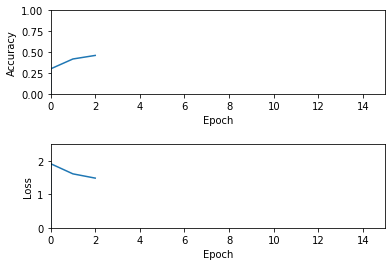

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a0model.ckpt Model Saved...
Epoch [75000], loss: 1.0210, acc: 1.0000
Epoch [75001], loss: 0.2880, acc: 1.0000
Epoch [75002], loss: 0.4721, acc: 1.0000
Epoch [75003], loss: 0.3428, acc: 1.0000
Epoch [75004], loss: 2.7890, acc: 0.0000
Epoch [75005], loss: 0.7828, acc: 1.0000
Epoch [75006], loss: 2.6235, acc: 0.0000
Epoch [75007], loss: 1.5381, acc: 0.0000
Epoch [75008], loss: 3.1468, acc: 0.0000
Epoch [75009], loss: 1.5234, acc: 0.0000
Epoch [75010], loss: 3.1023, acc: 0.0000
Epoch [75011], loss: 1.1944, acc: 1.0000
Epoch [75012], loss: 1.2294, acc: 1.0000
Epoch [75013], loss: 1.9103, acc: 0.0000
Epoch [75014], loss: 2.4944, acc: 0.0000
Epoch [75015], loss: 0.4137, acc: 1.0000
Epoch [75016], loss: 0.5778, acc: 1.0000
Epoch [75017], loss: 3.6055, acc: 0.0000
Epoch [75018], loss: 0.8895, acc: 0.0000
Epoch [75019], loss: 1.0557, acc: 1.0000
Epoch [75020], loss: 1.7154, acc: 0.0000
Epoch [75021], loss: 4.4516, acc: 0.

Epoch [75201], loss: 1.4127, acc: 0.0000
Epoch [75202], loss: 1.4182, acc: 1.0000
Epoch [75203], loss: 0.3544, acc: 1.0000
Epoch [75204], loss: 0.6585, acc: 1.0000
Epoch [75205], loss: 2.1417, acc: 0.0000
Epoch [75206], loss: 2.3656, acc: 0.0000
Epoch [75207], loss: 1.2512, acc: 1.0000
Epoch [75208], loss: 1.4597, acc: 1.0000
Epoch [75209], loss: 1.7594, acc: 0.0000
Epoch [75210], loss: 0.4992, acc: 1.0000
Epoch [75211], loss: 0.4135, acc: 1.0000
Epoch [75212], loss: 0.8637, acc: 1.0000
Epoch [75213], loss: 1.9824, acc: 0.0000
Epoch [75214], loss: 1.1262, acc: 0.0000
Epoch [75215], loss: 1.7010, acc: 0.0000
Epoch [75216], loss: 0.3018, acc: 1.0000
Epoch [75217], loss: 1.0864, acc: 1.0000
Epoch [75218], loss: 1.3715, acc: 1.0000
Epoch [75219], loss: 1.0321, acc: 0.0000
Epoch [75220], loss: 7.1736, acc: 0.0000
Epoch [75221], loss: 2.8406, acc: 0.0000
Epoch [75222], loss: 0.7126, acc: 1.0000
Epoch [75223], loss: 0.4906, acc: 1.0000
Epoch [75224], loss: 1.9427, acc: 0.0000
Epoch [75225], l

Epoch [75428], loss: 0.7868, acc: 1.0000
Epoch [75429], loss: 3.9625, acc: 0.0000
Epoch [75430], loss: 1.2751, acc: 0.0000
Epoch [75431], loss: 1.3216, acc: 1.0000
Epoch [75432], loss: 0.8224, acc: 1.0000
Epoch [75433], loss: 0.3041, acc: 1.0000
Epoch [75434], loss: 1.0088, acc: 0.0000
Epoch [75435], loss: 0.6351, acc: 1.0000
Epoch [75436], loss: 1.1737, acc: 0.0000
Epoch [75437], loss: 0.5561, acc: 1.0000
Epoch [75438], loss: 1.2184, acc: 0.0000
Epoch [75439], loss: 0.5267, acc: 1.0000
Epoch [75440], loss: 1.2011, acc: 0.0000
Epoch [75441], loss: 1.2293, acc: 0.0000
Epoch [75442], loss: 1.1592, acc: 0.0000
Epoch [75443], loss: 3.1387, acc: 0.0000
Epoch [75444], loss: 0.5176, acc: 1.0000
Epoch [75445], loss: 0.4623, acc: 1.0000
Epoch [75446], loss: 1.4044, acc: 1.0000
Epoch [75447], loss: 0.5956, acc: 1.0000
Epoch [75448], loss: 1.4116, acc: 0.0000
Epoch [75449], loss: 2.1307, acc: 0.0000
Epoch [75450], loss: 0.9345, acc: 1.0000
Epoch [75451], loss: 5.1578, acc: 0.0000
Epoch [75452], l

Epoch [75648], loss: 0.6248, acc: 1.0000
Epoch [75649], loss: 0.2617, acc: 1.0000
Epoch [75650], loss: 2.7142, acc: 0.0000
Epoch [75651], loss: 2.6179, acc: 0.0000
Epoch [75652], loss: 1.5452, acc: 0.0000
Epoch [75653], loss: 0.1777, acc: 1.0000
Epoch [75654], loss: 0.4602, acc: 1.0000
Epoch [75655], loss: 1.8848, acc: 0.0000
Epoch [75656], loss: 3.8991, acc: 0.0000
Epoch [75657], loss: 0.6975, acc: 1.0000
Epoch [75658], loss: 1.1666, acc: 1.0000
Epoch [75659], loss: 1.5748, acc: 0.0000
Epoch [75660], loss: 1.2644, acc: 0.0000
Epoch [75661], loss: 0.4643, acc: 1.0000
Epoch [75662], loss: 1.2850, acc: 1.0000
Epoch [75663], loss: 0.3197, acc: 1.0000
Epoch [75664], loss: 1.9138, acc: 0.0000
Epoch [75665], loss: 1.0607, acc: 0.0000
Epoch [75666], loss: 0.7036, acc: 1.0000
Epoch [75667], loss: 1.3698, acc: 0.0000
Epoch [75668], loss: 0.3889, acc: 1.0000
Epoch [75669], loss: 1.7721, acc: 1.0000
Epoch [75670], loss: 0.7210, acc: 1.0000
Epoch [75671], loss: 1.0749, acc: 1.0000
Epoch [75672], l

Epoch [75859], loss: 0.3584, acc: 1.0000
Epoch [75860], loss: 1.2949, acc: 0.0000
Epoch [75861], loss: 1.2129, acc: 0.0000
Epoch [75862], loss: 4.1695, acc: 0.0000
Epoch [75863], loss: 1.7075, acc: 0.0000
Epoch [75864], loss: 3.0385, acc: 0.0000
Epoch [75865], loss: 0.9810, acc: 0.0000
Epoch [75866], loss: 1.7065, acc: 0.0000
Epoch [75867], loss: 1.2253, acc: 1.0000
Epoch [75868], loss: 0.6087, acc: 1.0000
Epoch [75869], loss: 1.1584, acc: 1.0000
Epoch [75870], loss: 3.1387, acc: 0.0000
Epoch [75871], loss: 0.8721, acc: 1.0000
Epoch [75872], loss: 1.0133, acc: 1.0000
Epoch [75873], loss: 0.4726, acc: 1.0000
Epoch [75874], loss: 2.1308, acc: 0.0000
Epoch [75875], loss: 2.8973, acc: 0.0000
Epoch [75876], loss: 0.8117, acc: 1.0000
Epoch [75877], loss: 2.9496, acc: 0.0000
Epoch [75878], loss: 0.5201, acc: 1.0000
Epoch [75879], loss: 1.1745, acc: 1.0000
Epoch [75880], loss: 0.4073, acc: 1.0000
Epoch [75881], loss: 3.1073, acc: 0.0000
Epoch [75882], loss: 4.4912, acc: 0.0000
Epoch [75883], l

Epoch [76073], loss: 3.3842, acc: 0.0000
Epoch [76074], loss: 0.0757, acc: 1.0000
Epoch [76075], loss: 1.4682, acc: 0.0000
Epoch [76076], loss: 0.2330, acc: 1.0000
Epoch [76077], loss: 2.3612, acc: 0.0000
Epoch [76078], loss: 1.2611, acc: 1.0000
Epoch [76079], loss: 0.7960, acc: 1.0000
Epoch [76080], loss: 1.6088, acc: 0.0000
Epoch [76081], loss: 0.5279, acc: 1.0000
Epoch [76082], loss: 1.0953, acc: 1.0000
Epoch [76083], loss: 1.0628, acc: 1.0000
Epoch [76084], loss: 0.6913, acc: 1.0000
Epoch [76085], loss: 1.1877, acc: 1.0000
Epoch [76086], loss: 1.2575, acc: 0.0000
Epoch [76087], loss: 0.8307, acc: 1.0000
Epoch [76088], loss: 1.6324, acc: 0.0000
Epoch [76089], loss: 0.6578, acc: 1.0000
Epoch [76090], loss: 0.9774, acc: 0.0000
Epoch [76091], loss: 1.8424, acc: 0.0000
Epoch [76092], loss: 0.5611, acc: 1.0000
Epoch [76093], loss: 2.0970, acc: 0.0000
Epoch [76094], loss: 1.0020, acc: 1.0000
Epoch [76095], loss: 2.4721, acc: 0.0000
Epoch [76096], loss: 0.8152, acc: 1.0000
Epoch [76097], l

Epoch [76283], loss: 0.5391, acc: 1.0000
Epoch [76284], loss: 2.5231, acc: 0.0000
Epoch [76285], loss: 0.3714, acc: 1.0000
Epoch [76286], loss: 1.4313, acc: 1.0000
Epoch [76287], loss: 0.6832, acc: 1.0000
Epoch [76288], loss: 1.2657, acc: 0.0000
Epoch [76289], loss: 4.5224, acc: 0.0000
Epoch [76290], loss: 2.3034, acc: 0.0000
Epoch [76291], loss: 0.9238, acc: 1.0000
Epoch [76292], loss: 2.8463, acc: 0.0000
Epoch [76293], loss: 0.5665, acc: 1.0000
Epoch [76294], loss: 1.0606, acc: 1.0000
Epoch [76295], loss: 1.0604, acc: 1.0000
Epoch [76296], loss: 0.8109, acc: 0.0000
Epoch [76297], loss: 4.3861, acc: 0.0000
Epoch [76298], loss: 0.2878, acc: 1.0000
Epoch [76299], loss: 5.4911, acc: 0.0000
Epoch [76300], loss: 1.4759, acc: 0.0000
Epoch [76301], loss: 1.0152, acc: 0.0000
Epoch [76302], loss: 2.5785, acc: 0.0000
Epoch [76303], loss: 0.6832, acc: 1.0000
Epoch [76304], loss: 2.4778, acc: 0.0000
Epoch [76305], loss: 0.1769, acc: 1.0000
Epoch [76306], loss: 0.9209, acc: 1.0000
Epoch [76307], l

Epoch [76483], loss: 0.9142, acc: 1.0000
Epoch [76484], loss: 0.9727, acc: 1.0000
Epoch [76485], loss: 1.0551, acc: 1.0000
Epoch [76486], loss: 1.9900, acc: 0.0000
Epoch [76487], loss: 1.6140, acc: 1.0000
Epoch [76488], loss: 5.3460, acc: 0.0000
Epoch [76489], loss: 1.2973, acc: 0.0000
Epoch [76490], loss: 0.4146, acc: 1.0000
Epoch [76491], loss: 0.4551, acc: 1.0000
Epoch [76492], loss: 0.4764, acc: 1.0000
Epoch [76493], loss: 1.9089, acc: 0.0000
Epoch [76494], loss: 1.7332, acc: 0.0000
Epoch [76495], loss: 1.6786, acc: 0.0000
Epoch [76496], loss: 1.5955, acc: 0.0000
Epoch [76497], loss: 0.4580, acc: 1.0000
Epoch [76498], loss: 1.0358, acc: 0.0000
Epoch [76499], loss: 1.5556, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a1500model.ckpt Model Saved...
Epoch [76500], loss: 0.3613, acc: 1.0000
Epoch [76501], loss: 0.2903, acc: 1.0000
Epoch [76502], loss: 0.4625, acc: 1.0000
Epoch [76503], loss: 3.5275, acc: 0.0000
Epoch [76504], loss: 1.7882, acc:

Epoch [76711], loss: 0.5736, acc: 1.0000
Epoch [76712], loss: 0.6679, acc: 1.0000
Epoch [76713], loss: 0.5053, acc: 1.0000
Epoch [76714], loss: 0.2363, acc: 1.0000
Epoch [76715], loss: 1.3551, acc: 0.0000
Epoch [76716], loss: 0.8981, acc: 1.0000
Epoch [76717], loss: 0.6511, acc: 1.0000
Epoch [76718], loss: 0.9568, acc: 1.0000
Epoch [76719], loss: 0.6593, acc: 1.0000
Epoch [76720], loss: 1.8044, acc: 0.0000
Epoch [76721], loss: 1.6474, acc: 0.0000
Epoch [76722], loss: 2.0303, acc: 0.0000
Epoch [76723], loss: 1.8943, acc: 0.0000
Epoch [76724], loss: 0.9777, acc: 0.0000
Epoch [76725], loss: 0.7212, acc: 1.0000
Epoch [76726], loss: 2.5692, acc: 0.0000
Epoch [76727], loss: 0.8388, acc: 1.0000
Epoch [76728], loss: 0.7570, acc: 1.0000
Epoch [76729], loss: 1.2093, acc: 0.0000
Epoch [76730], loss: 1.2815, acc: 0.0000
Epoch [76731], loss: 1.6864, acc: 0.0000
Epoch [76732], loss: 1.7765, acc: 0.0000
Epoch [76733], loss: 1.2262, acc: 1.0000
Epoch [76734], loss: 1.4979, acc: 0.0000
Epoch [76735], l

Epoch [76916], loss: 1.2447, acc: 1.0000
Epoch [76917], loss: 2.6783, acc: 0.0000
Epoch [76918], loss: 1.1440, acc: 1.0000
Epoch [76919], loss: 2.3701, acc: 0.0000
Epoch [76920], loss: 1.2062, acc: 1.0000
Epoch [76921], loss: 0.6379, acc: 1.0000
Epoch [76922], loss: 0.8291, acc: 1.0000
Epoch [76923], loss: 4.1667, acc: 0.0000
Epoch [76924], loss: 0.9982, acc: 1.0000
Epoch [76925], loss: 0.7262, acc: 1.0000
Epoch [76926], loss: 2.7178, acc: 0.0000
Epoch [76927], loss: 0.5834, acc: 1.0000
Epoch [76928], loss: 1.7858, acc: 0.0000
Epoch [76929], loss: 1.7737, acc: 0.0000
Epoch [76930], loss: 1.2292, acc: 0.0000
Epoch [76931], loss: 0.8587, acc: 1.0000
Epoch [76932], loss: 0.6362, acc: 1.0000
Epoch [76933], loss: 0.9157, acc: 0.0000
Epoch [76934], loss: 0.4346, acc: 1.0000
Epoch [76935], loss: 1.4860, acc: 0.0000
Epoch [76936], loss: 1.6363, acc: 0.0000
Epoch [76937], loss: 2.2995, acc: 0.0000
Epoch [76938], loss: 1.8359, acc: 0.0000
Epoch [76939], loss: 0.7986, acc: 1.0000
Epoch [76940], l

Epoch [77124], loss: 0.9559, acc: 1.0000
Epoch [77125], loss: 0.5979, acc: 1.0000
Epoch [77126], loss: 0.0212, acc: 1.0000
Epoch [77127], loss: 3.7989, acc: 0.0000
Epoch [77128], loss: 0.7892, acc: 1.0000
Epoch [77129], loss: 0.4920, acc: 1.0000
Epoch [77130], loss: 0.7716, acc: 1.0000
Epoch [77131], loss: 1.3328, acc: 1.0000
Epoch [77132], loss: 0.5800, acc: 1.0000
Epoch [77133], loss: 1.7000, acc: 0.0000
Epoch [77134], loss: 1.9927, acc: 0.0000
Epoch [77135], loss: 1.2825, acc: 1.0000
Epoch [77136], loss: 1.4942, acc: 1.0000
Epoch [77137], loss: 2.2846, acc: 0.0000
Epoch [77138], loss: 2.2391, acc: 0.0000
Epoch [77139], loss: 1.4629, acc: 0.0000
Epoch [77140], loss: 1.6588, acc: 0.0000
Epoch [77141], loss: 0.8396, acc: 1.0000
Epoch [77142], loss: 0.1285, acc: 1.0000
Epoch [77143], loss: 1.1750, acc: 1.0000
Epoch [77144], loss: 2.3327, acc: 0.0000
Epoch [77145], loss: 0.4162, acc: 1.0000
Epoch [77146], loss: 1.0204, acc: 1.0000
Epoch [77147], loss: 0.9806, acc: 1.0000
Epoch [77148], l

Epoch [77349], loss: 1.8682, acc: 0.0000
Epoch [77350], loss: 0.6972, acc: 1.0000
Epoch [77351], loss: 1.4976, acc: 1.0000
Epoch [77352], loss: 1.1435, acc: 1.0000
Epoch [77353], loss: 0.1269, acc: 1.0000
Epoch [77354], loss: 0.0492, acc: 1.0000
Epoch [77355], loss: 0.4357, acc: 1.0000
Epoch [77356], loss: 2.2980, acc: 0.0000
Epoch [77357], loss: 0.5452, acc: 1.0000
Epoch [77358], loss: 2.3164, acc: 0.0000
Epoch [77359], loss: 1.3681, acc: 0.0000
Epoch [77360], loss: 0.8167, acc: 1.0000
Epoch [77361], loss: 0.3111, acc: 1.0000
Epoch [77362], loss: 0.1567, acc: 1.0000
Epoch [77363], loss: 0.5608, acc: 1.0000
Epoch [77364], loss: 0.8971, acc: 0.0000
Epoch [77365], loss: 3.7724, acc: 0.0000
Epoch [77366], loss: 1.6835, acc: 0.0000
Epoch [77367], loss: 1.2894, acc: 0.0000
Epoch [77368], loss: 2.0318, acc: 0.0000
Epoch [77369], loss: 0.2682, acc: 1.0000
Epoch [77370], loss: 2.1873, acc: 0.0000
Epoch [77371], loss: 2.1449, acc: 0.0000
Epoch [77372], loss: 1.8410, acc: 0.0000
Epoch [77373], l

Epoch [77562], loss: 3.0969, acc: 0.0000
Epoch [77563], loss: 1.1551, acc: 1.0000
Epoch [77564], loss: 1.0248, acc: 0.0000
Epoch [77565], loss: 0.9170, acc: 1.0000
Epoch [77566], loss: 0.6755, acc: 1.0000
Epoch [77567], loss: 1.3803, acc: 0.0000
Epoch [77568], loss: 0.3532, acc: 1.0000
Epoch [77569], loss: 0.6411, acc: 1.0000
Epoch [77570], loss: 2.4089, acc: 0.0000
Epoch [77571], loss: 0.4497, acc: 1.0000
Epoch [77572], loss: 2.1527, acc: 0.0000
Epoch [77573], loss: 4.2758, acc: 0.0000
Epoch [77574], loss: 0.1638, acc: 1.0000
Epoch [77575], loss: 0.9937, acc: 1.0000
Epoch [77576], loss: 0.8697, acc: 1.0000
Epoch [77577], loss: 0.9072, acc: 1.0000
Epoch [77578], loss: 1.6478, acc: 0.0000
Epoch [77579], loss: 1.1225, acc: 0.0000
Epoch [77580], loss: 2.4253, acc: 0.0000
Epoch [77581], loss: 1.4138, acc: 0.0000
Epoch [77582], loss: 2.5781, acc: 0.0000
Epoch [77583], loss: 1.9965, acc: 0.0000
Epoch [77584], loss: 1.0543, acc: 0.0000
Epoch [77585], loss: 2.0541, acc: 0.0000
Epoch [77586], l

Epoch [77762], loss: 2.5568, acc: 0.0000
Epoch [77763], loss: 0.1385, acc: 1.0000
Epoch [77764], loss: 1.4738, acc: 0.0000
Epoch [77765], loss: 2.3079, acc: 0.0000
Epoch [77766], loss: 0.4351, acc: 1.0000
Epoch [77767], loss: 0.3865, acc: 1.0000
Epoch [77768], loss: 1.7591, acc: 0.0000
Epoch [77769], loss: 0.3498, acc: 1.0000
Epoch [77770], loss: 1.5958, acc: 0.0000
Epoch [77771], loss: 0.1979, acc: 1.0000
Epoch [77772], loss: 0.5601, acc: 1.0000
Epoch [77773], loss: 1.3449, acc: 0.0000
Epoch [77774], loss: 1.7711, acc: 0.0000
Epoch [77775], loss: 0.4498, acc: 1.0000
Epoch [77776], loss: 0.7105, acc: 1.0000
Epoch [77777], loss: 1.3710, acc: 1.0000
Epoch [77778], loss: 1.0532, acc: 1.0000
Epoch [77779], loss: 0.5096, acc: 1.0000
Epoch [77780], loss: 2.0177, acc: 0.0000
Epoch [77781], loss: 1.0475, acc: 1.0000
Epoch [77782], loss: 0.7197, acc: 1.0000
Epoch [77783], loss: 0.5434, acc: 1.0000
Epoch [77784], loss: 1.2276, acc: 1.0000
Epoch [77785], loss: 2.3376, acc: 0.0000
Epoch [77786], l

Epoch [77980], loss: 0.8403, acc: 1.0000
Epoch [77981], loss: 1.7683, acc: 0.0000
Epoch [77982], loss: 0.5409, acc: 1.0000
Epoch [77983], loss: 0.9278, acc: 1.0000
Epoch [77984], loss: 1.6899, acc: 1.0000
Epoch [77985], loss: 0.4619, acc: 1.0000
Epoch [77986], loss: 0.1079, acc: 1.0000
Epoch [77987], loss: 2.3150, acc: 0.0000
Epoch [77988], loss: 0.1822, acc: 1.0000
Epoch [77989], loss: 1.7567, acc: 0.0000
Epoch [77990], loss: 1.2970, acc: 1.0000
Epoch [77991], loss: 2.7183, acc: 0.0000
Epoch [77992], loss: 0.3943, acc: 1.0000
Epoch [77993], loss: 0.4853, acc: 1.0000
Epoch [77994], loss: 0.3501, acc: 1.0000
Epoch [77995], loss: 0.3082, acc: 1.0000
Epoch [77996], loss: 1.6855, acc: 0.0000
Epoch [77997], loss: 0.4624, acc: 1.0000
Epoch [77998], loss: 1.2859, acc: 0.0000
Epoch [77999], loss: 1.3414, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a3000model.ckpt Model Saved...
Epoch [78000], loss: 0.9142, acc: 1.0000
Epoch [78001], loss: 1.8862, acc:

Epoch [78190], loss: 0.6358, acc: 1.0000
Epoch [78191], loss: 1.0253, acc: 0.0000
Epoch [78192], loss: 0.3986, acc: 1.0000
Epoch [78193], loss: 0.8139, acc: 1.0000
Epoch [78194], loss: 1.1968, acc: 1.0000
Epoch [78195], loss: 1.8336, acc: 0.0000
Epoch [78196], loss: 0.6247, acc: 1.0000
Epoch [78197], loss: 0.8143, acc: 1.0000
Epoch [78198], loss: 1.2048, acc: 1.0000
Epoch [78199], loss: 2.1792, acc: 0.0000
Epoch [78200], loss: 0.3648, acc: 1.0000
Epoch [78201], loss: 0.8980, acc: 1.0000
Epoch [78202], loss: 1.8394, acc: 0.0000
Epoch [78203], loss: 0.7384, acc: 1.0000
Epoch [78204], loss: 1.8415, acc: 0.0000
Epoch [78205], loss: 1.6437, acc: 0.0000
Epoch [78206], loss: 0.8579, acc: 0.0000
Epoch [78207], loss: 1.2754, acc: 0.0000
Epoch [78208], loss: 1.3210, acc: 0.0000
Epoch [78209], loss: 1.0829, acc: 1.0000
Epoch [78210], loss: 0.1977, acc: 1.0000
Epoch [78211], loss: 1.6407, acc: 1.0000
Epoch [78212], loss: 1.5586, acc: 0.0000
Epoch [78213], loss: 0.4933, acc: 1.0000
Epoch [78214], l

Epoch [78393], loss: 0.5972, acc: 1.0000
Epoch [78394], loss: 0.6146, acc: 1.0000
Epoch [78395], loss: 1.2971, acc: 1.0000
Epoch [78396], loss: 1.0864, acc: 0.0000
Epoch [78397], loss: 1.3162, acc: 0.0000
Epoch [78398], loss: 2.6032, acc: 0.0000
Epoch [78399], loss: 0.7203, acc: 1.0000
Epoch [78400], loss: 0.7518, acc: 1.0000
Epoch [78401], loss: 1.0933, acc: 0.0000
Epoch [78402], loss: 0.1877, acc: 1.0000
Epoch [78403], loss: 0.4572, acc: 1.0000
Epoch [78404], loss: 2.0636, acc: 0.0000
Epoch [78405], loss: 1.4273, acc: 0.0000
Epoch [78406], loss: 1.7146, acc: 0.0000
Epoch [78407], loss: 0.9449, acc: 1.0000
Epoch [78408], loss: 1.8129, acc: 0.0000
Epoch [78409], loss: 0.7292, acc: 1.0000
Epoch [78410], loss: 3.6317, acc: 0.0000
Epoch [78411], loss: 2.8704, acc: 0.0000
Epoch [78412], loss: 1.0743, acc: 0.0000
Epoch [78413], loss: 0.9641, acc: 1.0000
Epoch [78414], loss: 0.7724, acc: 1.0000
Epoch [78415], loss: 0.1929, acc: 1.0000
Epoch [78416], loss: 1.3410, acc: 1.0000
Epoch [78417], l

Epoch [78600], loss: 1.4787, acc: 0.0000
Epoch [78601], loss: 0.5310, acc: 1.0000
Epoch [78602], loss: 0.4208, acc: 1.0000
Epoch [78603], loss: 0.7765, acc: 0.0000
Epoch [78604], loss: 0.4550, acc: 1.0000
Epoch [78605], loss: 0.6841, acc: 1.0000
Epoch [78606], loss: 0.3683, acc: 1.0000
Epoch [78607], loss: 0.9574, acc: 1.0000
Epoch [78608], loss: 2.1144, acc: 0.0000
Epoch [78609], loss: 0.7053, acc: 1.0000
Epoch [78610], loss: 0.5677, acc: 1.0000
Epoch [78611], loss: 2.0879, acc: 0.0000
Epoch [78612], loss: 0.6873, acc: 1.0000
Epoch [78613], loss: 1.4014, acc: 0.0000
Epoch [78614], loss: 1.0398, acc: 0.0000
Epoch [78615], loss: 1.3364, acc: 0.0000
Epoch [78616], loss: 2.2982, acc: 0.0000
Epoch [78617], loss: 0.7970, acc: 1.0000
Epoch [78618], loss: 1.5795, acc: 1.0000
Epoch [78619], loss: 0.3952, acc: 1.0000
Epoch [78620], loss: 1.7569, acc: 0.0000
Epoch [78621], loss: 1.5563, acc: 0.0000
Epoch [78622], loss: 0.2260, acc: 1.0000
Epoch [78623], loss: 1.6362, acc: 0.0000
Epoch [78624], l

Epoch [78810], loss: 0.2748, acc: 1.0000
Epoch [78811], loss: 0.4374, acc: 1.0000
Epoch [78812], loss: 2.4309, acc: 0.0000
Epoch [78813], loss: 1.3390, acc: 0.0000
Epoch [78814], loss: 1.1355, acc: 1.0000
Epoch [78815], loss: 4.3230, acc: 0.0000
Epoch [78816], loss: 1.0492, acc: 0.0000
Epoch [78817], loss: 0.6556, acc: 1.0000
Epoch [78818], loss: 0.7955, acc: 1.0000
Epoch [78819], loss: 2.5523, acc: 0.0000
Epoch [78820], loss: 1.1528, acc: 0.0000
Epoch [78821], loss: 2.8111, acc: 0.0000
Epoch [78822], loss: 0.3212, acc: 1.0000
Epoch [78823], loss: 0.2736, acc: 1.0000
Epoch [78824], loss: 1.7032, acc: 0.0000
Epoch [78825], loss: 1.1974, acc: 0.0000
Epoch [78826], loss: 0.8708, acc: 1.0000
Epoch [78827], loss: 0.9112, acc: 1.0000
Epoch [78828], loss: 0.7343, acc: 1.0000
Epoch [78829], loss: 2.9898, acc: 0.0000
Epoch [78830], loss: 0.7710, acc: 1.0000
Epoch [78831], loss: 1.5661, acc: 0.0000
Epoch [78832], loss: 1.2756, acc: 1.0000
Epoch [78833], loss: 0.9327, acc: 1.0000
Epoch [78834], l

Epoch [79020], loss: 1.3108, acc: 0.0000
Epoch [79021], loss: 2.4382, acc: 0.0000
Epoch [79022], loss: 1.7968, acc: 0.0000
Epoch [79023], loss: 1.3976, acc: 1.0000
Epoch [79024], loss: 0.2081, acc: 1.0000
Epoch [79025], loss: 1.6742, acc: 1.0000
Epoch [79026], loss: 4.1483, acc: 0.0000
Epoch [79027], loss: 1.0452, acc: 1.0000
Epoch [79028], loss: 0.5763, acc: 1.0000
Epoch [79029], loss: 1.4148, acc: 0.0000
Epoch [79030], loss: 0.6647, acc: 1.0000
Epoch [79031], loss: 1.6046, acc: 0.0000
Epoch [79032], loss: 3.4072, acc: 0.0000
Epoch [79033], loss: 2.9678, acc: 0.0000
Epoch [79034], loss: 1.2258, acc: 0.0000
Epoch [79035], loss: 3.3445, acc: 0.0000
Epoch [79036], loss: 0.3597, acc: 1.0000
Epoch [79037], loss: 1.4850, acc: 1.0000
Epoch [79038], loss: 1.2425, acc: 1.0000
Epoch [79039], loss: 2.2360, acc: 0.0000
Epoch [79040], loss: 0.8743, acc: 1.0000
Epoch [79041], loss: 0.9761, acc: 1.0000
Epoch [79042], loss: 0.5019, acc: 1.0000
Epoch [79043], loss: 0.9066, acc: 0.0000
Epoch [79044], l

Epoch [79220], loss: 0.8634, acc: 1.0000
Epoch [79221], loss: 0.0879, acc: 1.0000
Epoch [79222], loss: 0.6963, acc: 1.0000
Epoch [79223], loss: 1.5913, acc: 0.0000
Epoch [79224], loss: 0.4477, acc: 1.0000
Epoch [79225], loss: 2.0168, acc: 0.0000
Epoch [79226], loss: 0.6763, acc: 1.0000
Epoch [79227], loss: 0.1905, acc: 1.0000
Epoch [79228], loss: 1.4973, acc: 0.0000
Epoch [79229], loss: 4.4572, acc: 0.0000
Epoch [79230], loss: 0.3635, acc: 1.0000
Epoch [79231], loss: 1.0049, acc: 1.0000
Epoch [79232], loss: 1.9668, acc: 0.0000
Epoch [79233], loss: 1.3635, acc: 0.0000
Epoch [79234], loss: 1.2377, acc: 0.0000
Epoch [79235], loss: 0.6560, acc: 1.0000
Epoch [79236], loss: 3.0424, acc: 0.0000
Epoch [79237], loss: 0.9493, acc: 1.0000
Epoch [79238], loss: 1.7554, acc: 0.0000
Epoch [79239], loss: 1.1215, acc: 1.0000
Epoch [79240], loss: 2.5950, acc: 0.0000
Epoch [79241], loss: 2.4319, acc: 0.0000
Epoch [79242], loss: 0.2961, acc: 1.0000
Epoch [79243], loss: 1.6450, acc: 0.0000
Epoch [79244], l

Epoch [79423], loss: 1.4579, acc: 1.0000
Epoch [79424], loss: 0.5689, acc: 1.0000
Epoch [79425], loss: 0.0686, acc: 1.0000
Epoch [79426], loss: 2.2119, acc: 0.0000
Epoch [79427], loss: 1.2379, acc: 1.0000
Epoch [79428], loss: 0.1838, acc: 1.0000
Epoch [79429], loss: 0.3628, acc: 1.0000
Epoch [79430], loss: 0.4547, acc: 1.0000
Epoch [79431], loss: 1.9504, acc: 0.0000
Epoch [79432], loss: 1.0687, acc: 0.0000
Epoch [79433], loss: 5.5033, acc: 0.0000
Epoch [79434], loss: 1.9261, acc: 0.0000
Epoch [79435], loss: 0.7205, acc: 1.0000
Epoch [79436], loss: 0.1385, acc: 1.0000
Epoch [79437], loss: 2.4902, acc: 0.0000
Epoch [79438], loss: 4.5810, acc: 0.0000
Epoch [79439], loss: 0.6614, acc: 1.0000
Epoch [79440], loss: 2.3223, acc: 0.0000
Epoch [79441], loss: 0.2433, acc: 1.0000
Epoch [79442], loss: 2.8256, acc: 0.0000
Epoch [79443], loss: 0.8777, acc: 1.0000
Epoch [79444], loss: 2.9443, acc: 0.0000
Epoch [79445], loss: 0.8797, acc: 1.0000
Epoch [79446], loss: 2.1765, acc: 0.0000
Epoch [79447], l

Epoch [79626], loss: 4.1926, acc: 0.0000
Epoch [79627], loss: 0.8880, acc: 1.0000
Epoch [79628], loss: 0.4154, acc: 1.0000
Epoch [79629], loss: 0.4838, acc: 1.0000
Epoch [79630], loss: 0.6742, acc: 1.0000
Epoch [79631], loss: 0.4244, acc: 1.0000
Epoch [79632], loss: 2.9372, acc: 0.0000
Epoch [79633], loss: 0.5374, acc: 1.0000
Epoch [79634], loss: 2.2459, acc: 0.0000
Epoch [79635], loss: 1.2771, acc: 1.0000
Epoch [79636], loss: 3.1401, acc: 0.0000
Epoch [79637], loss: 1.2069, acc: 1.0000
Epoch [79638], loss: 2.1042, acc: 0.0000
Epoch [79639], loss: 1.5224, acc: 1.0000
Epoch [79640], loss: 1.4288, acc: 0.0000
Epoch [79641], loss: 5.8544, acc: 0.0000
Epoch [79642], loss: 2.5293, acc: 0.0000
Epoch [79643], loss: 2.6530, acc: 0.0000
Epoch [79644], loss: 0.9435, acc: 1.0000
Epoch [79645], loss: 1.1908, acc: 0.0000
Epoch [79646], loss: 1.1091, acc: 0.0000
Epoch [79647], loss: 3.4784, acc: 0.0000
Epoch [79648], loss: 0.2729, acc: 1.0000
Epoch [79649], loss: 2.3656, acc: 0.0000
Epoch [79650], l

Epoch [79838], loss: 1.4321, acc: 0.0000
Epoch [79839], loss: 0.4323, acc: 1.0000
Epoch [79840], loss: 1.6947, acc: 0.0000
Epoch [79841], loss: 1.3856, acc: 0.0000
Epoch [79842], loss: 2.6768, acc: 0.0000
Epoch [79843], loss: 1.1668, acc: 1.0000
Epoch [79844], loss: 1.9002, acc: 0.0000
Epoch [79845], loss: 0.3639, acc: 1.0000
Epoch [79846], loss: 0.6013, acc: 1.0000
Epoch [79847], loss: 1.6977, acc: 1.0000
Epoch [79848], loss: 0.2229, acc: 1.0000
Epoch [79849], loss: 2.1274, acc: 0.0000
Epoch [79850], loss: 2.8847, acc: 0.0000
Epoch [79851], loss: 0.3460, acc: 1.0000
Epoch [79852], loss: 0.6573, acc: 1.0000
Epoch [79853], loss: 1.2147, acc: 0.0000
Epoch [79854], loss: 0.3301, acc: 1.0000
Epoch [79855], loss: 1.8297, acc: 0.0000
Epoch [79856], loss: 1.1584, acc: 0.0000
Epoch [79857], loss: 0.2032, acc: 1.0000
Epoch [79858], loss: 1.6964, acc: 0.0000
Epoch [79859], loss: 0.4021, acc: 1.0000
Epoch [79860], loss: 0.5310, acc: 1.0000
Epoch [79861], loss: 1.8408, acc: 0.0000
Epoch [79862], l

Epoch [80066], loss: 1.3793, acc: 0.0000
Epoch [80067], loss: 0.3487, acc: 1.0000
Epoch [80068], loss: 2.0140, acc: 0.0000
Epoch [80069], loss: 0.2378, acc: 1.0000
Epoch [80070], loss: 1.6586, acc: 0.0000
Epoch [80071], loss: 2.4074, acc: 0.0000
Epoch [80072], loss: 0.6903, acc: 1.0000
Epoch [80073], loss: 0.6704, acc: 1.0000
Epoch [80074], loss: 4.3729, acc: 0.0000
Epoch [80075], loss: 3.0253, acc: 0.0000
Epoch [80076], loss: 1.5962, acc: 0.0000
Epoch [80077], loss: 0.6607, acc: 1.0000
Epoch [80078], loss: 1.7674, acc: 0.0000
Epoch [80079], loss: 0.5185, acc: 1.0000
Epoch [80080], loss: 0.9008, acc: 1.0000
Epoch [80081], loss: 0.4100, acc: 1.0000
Epoch [80082], loss: 2.9248, acc: 0.0000
Epoch [80083], loss: 2.4406, acc: 0.0000
Epoch [80084], loss: 1.3766, acc: 1.0000
Epoch [80085], loss: 0.8860, acc: 0.0000
Epoch [80086], loss: 0.5456, acc: 1.0000
Epoch [80087], loss: 1.8744, acc: 0.0000
Epoch [80088], loss: 2.8627, acc: 0.0000
Epoch [80089], loss: 1.2889, acc: 0.0000
Epoch [80090], l

Epoch [80288], loss: 0.8634, acc: 0.0000
Epoch [80289], loss: 1.7952, acc: 0.0000
Epoch [80290], loss: 1.4475, acc: 0.0000
Epoch [80291], loss: 0.3450, acc: 1.0000
Epoch [80292], loss: 2.1339, acc: 0.0000
Epoch [80293], loss: 1.4317, acc: 1.0000
Epoch [80294], loss: 1.3278, acc: 0.0000
Epoch [80295], loss: 1.9194, acc: 0.0000
Epoch [80296], loss: 1.8665, acc: 0.0000
Epoch [80297], loss: 1.8648, acc: 0.0000
Epoch [80298], loss: 0.1375, acc: 1.0000
Epoch [80299], loss: 0.9242, acc: 0.0000
Epoch [80300], loss: 1.4215, acc: 0.0000
Epoch [80301], loss: 0.4875, acc: 1.0000
Epoch [80302], loss: 0.7903, acc: 1.0000
Epoch [80303], loss: 1.0565, acc: 1.0000
Epoch [80304], loss: 1.7136, acc: 0.0000
Epoch [80305], loss: 1.8046, acc: 0.0000
Epoch [80306], loss: 0.4450, acc: 1.0000
Epoch [80307], loss: 0.4288, acc: 1.0000
Epoch [80308], loss: 0.3085, acc: 1.0000
Epoch [80309], loss: 0.9640, acc: 0.0000
Epoch [80310], loss: 1.0686, acc: 1.0000
Epoch [80311], loss: 1.2687, acc: 0.0000
Epoch [80312], l

Epoch [80512], loss: 2.1073, acc: 0.0000
Epoch [80513], loss: 1.5973, acc: 0.0000
Epoch [80514], loss: 0.6888, acc: 1.0000
Epoch [80515], loss: 0.7156, acc: 1.0000
Epoch [80516], loss: 1.9887, acc: 0.0000
Epoch [80517], loss: 2.3619, acc: 0.0000
Epoch [80518], loss: 0.6459, acc: 1.0000
Epoch [80519], loss: 2.0819, acc: 0.0000
Epoch [80520], loss: 0.8375, acc: 1.0000
Epoch [80521], loss: 1.2136, acc: 0.0000
Epoch [80522], loss: 0.9723, acc: 1.0000
Epoch [80523], loss: 0.1855, acc: 1.0000
Epoch [80524], loss: 1.8308, acc: 0.0000
Epoch [80525], loss: 3.4471, acc: 0.0000
Epoch [80526], loss: 1.2877, acc: 1.0000
Epoch [80527], loss: 1.0097, acc: 1.0000
Epoch [80528], loss: 2.6974, acc: 0.0000
Epoch [80529], loss: 0.9371, acc: 1.0000
Epoch [80530], loss: 1.5218, acc: 0.0000
Epoch [80531], loss: 1.8832, acc: 0.0000
Epoch [80532], loss: 0.5633, acc: 1.0000
Epoch [80533], loss: 0.2731, acc: 1.0000
Epoch [80534], loss: 0.7244, acc: 1.0000
Epoch [80535], loss: 0.4550, acc: 1.0000
Epoch [80536], l

Epoch [80713], loss: 1.2329, acc: 0.0000
Epoch [80714], loss: 0.7954, acc: 1.0000
Epoch [80715], loss: 0.4846, acc: 1.0000
Epoch [80716], loss: 1.0971, acc: 0.0000
Epoch [80717], loss: 1.8445, acc: 0.0000
Epoch [80718], loss: 0.7738, acc: 1.0000
Epoch [80719], loss: 2.8858, acc: 0.0000
Epoch [80720], loss: 2.4911, acc: 0.0000
Epoch [80721], loss: 1.9544, acc: 0.0000
Epoch [80722], loss: 1.1598, acc: 1.0000
Epoch [80723], loss: 1.9660, acc: 0.0000
Epoch [80724], loss: 0.4470, acc: 1.0000
Epoch [80725], loss: 0.1377, acc: 1.0000
Epoch [80726], loss: 0.9331, acc: 1.0000
Epoch [80727], loss: 0.8954, acc: 1.0000
Epoch [80728], loss: 1.3942, acc: 1.0000
Epoch [80729], loss: 0.9500, acc: 0.0000
Epoch [80730], loss: 1.4099, acc: 1.0000
Epoch [80731], loss: 0.1945, acc: 1.0000
Epoch [80732], loss: 0.4547, acc: 1.0000
Epoch [80733], loss: 2.9973, acc: 0.0000
Epoch [80734], loss: 0.9068, acc: 1.0000
Epoch [80735], loss: 0.4596, acc: 1.0000
Epoch [80736], loss: 1.3370, acc: 0.0000
Epoch [80737], l

Epoch [80920], loss: 0.4227, acc: 1.0000
Epoch [80921], loss: 0.6917, acc: 1.0000
Epoch [80922], loss: 2.3862, acc: 0.0000
Epoch [80923], loss: 0.7137, acc: 1.0000
Epoch [80924], loss: 3.3191, acc: 0.0000
Epoch [80925], loss: 1.4469, acc: 0.0000
Epoch [80926], loss: 2.4394, acc: 0.0000
Epoch [80927], loss: 0.1484, acc: 1.0000
Epoch [80928], loss: 0.8464, acc: 1.0000
Epoch [80929], loss: 1.2831, acc: 1.0000
Epoch [80930], loss: 2.0062, acc: 0.0000
Epoch [80931], loss: 0.4797, acc: 1.0000
Epoch [80932], loss: 1.2965, acc: 1.0000
Epoch [80933], loss: 1.7928, acc: 0.0000
Epoch [80934], loss: 0.5149, acc: 1.0000
Epoch [80935], loss: 1.3546, acc: 0.0000
Epoch [80936], loss: 2.6582, acc: 0.0000
Epoch [80937], loss: 0.2833, acc: 1.0000
Epoch [80938], loss: 0.7189, acc: 1.0000
Epoch [80939], loss: 1.4229, acc: 1.0000
Epoch [80940], loss: 1.5919, acc: 0.0000
Epoch [80941], loss: 0.9088, acc: 1.0000
Epoch [80942], loss: 0.9706, acc: 1.0000
Epoch [80943], loss: 1.4550, acc: 0.0000
Epoch [80944], l

Epoch [81129], loss: 0.9721, acc: 1.0000
Epoch [81130], loss: 0.7046, acc: 1.0000
Epoch [81131], loss: 1.1377, acc: 0.0000
Epoch [81132], loss: 1.0421, acc: 0.0000
Epoch [81133], loss: 0.5871, acc: 1.0000
Epoch [81134], loss: 1.6625, acc: 0.0000
Epoch [81135], loss: 0.8748, acc: 1.0000
Epoch [81136], loss: 1.2158, acc: 0.0000
Epoch [81137], loss: 0.8347, acc: 1.0000
Epoch [81138], loss: 2.3767, acc: 0.0000
Epoch [81139], loss: 0.5496, acc: 1.0000
Epoch [81140], loss: 0.6093, acc: 1.0000
Epoch [81141], loss: 1.7005, acc: 0.0000
Epoch [81142], loss: 0.4667, acc: 1.0000
Epoch [81143], loss: 1.2778, acc: 1.0000
Epoch [81144], loss: 1.2559, acc: 1.0000
Epoch [81145], loss: 0.7901, acc: 1.0000
Epoch [81146], loss: 1.3756, acc: 0.0000
Epoch [81147], loss: 1.9322, acc: 0.0000
Epoch [81148], loss: 0.7936, acc: 1.0000
Epoch [81149], loss: 0.8260, acc: 0.0000
Epoch [81150], loss: 0.3631, acc: 1.0000
Epoch [81151], loss: 1.5583, acc: 0.0000
Epoch [81152], loss: 2.2881, acc: 0.0000
Epoch [81153], l

Epoch [81360], loss: 0.9320, acc: 1.0000
Epoch [81361], loss: 0.1907, acc: 1.0000
Epoch [81362], loss: 0.6040, acc: 1.0000
Epoch [81363], loss: 1.9955, acc: 0.0000
Epoch [81364], loss: 0.5238, acc: 1.0000
Epoch [81365], loss: 2.1007, acc: 0.0000
Epoch [81366], loss: 3.3941, acc: 0.0000
Epoch [81367], loss: 0.8775, acc: 1.0000
Epoch [81368], loss: 1.7859, acc: 0.0000
Epoch [81369], loss: 1.2874, acc: 0.0000
Epoch [81370], loss: 0.3438, acc: 1.0000
Epoch [81371], loss: 1.3961, acc: 0.0000
Epoch [81372], loss: 1.3296, acc: 0.0000
Epoch [81373], loss: 0.7236, acc: 1.0000
Epoch [81374], loss: 5.1560, acc: 0.0000
Epoch [81375], loss: 1.9316, acc: 0.0000
Epoch [81376], loss: 0.7549, acc: 1.0000
Epoch [81377], loss: 1.6006, acc: 0.0000
Epoch [81378], loss: 1.0522, acc: 0.0000
Epoch [81379], loss: 0.1436, acc: 1.0000
Epoch [81380], loss: 2.7265, acc: 0.0000
Epoch [81381], loss: 2.0260, acc: 0.0000
Epoch [81382], loss: 1.4514, acc: 1.0000
Epoch [81383], loss: 1.0029, acc: 1.0000
Epoch [81384], l

Epoch [81576], loss: 0.5662, acc: 1.0000
Epoch [81577], loss: 2.1334, acc: 0.0000
Epoch [81578], loss: 0.8406, acc: 1.0000
Epoch [81579], loss: 1.4334, acc: 0.0000
Epoch [81580], loss: 1.0460, acc: 1.0000
Epoch [81581], loss: 1.2492, acc: 1.0000
Epoch [81582], loss: 0.4174, acc: 1.0000
Epoch [81583], loss: 1.1132, acc: 0.0000
Epoch [81584], loss: 1.1029, acc: 0.0000
Epoch [81585], loss: 2.6913, acc: 0.0000
Epoch [81586], loss: 0.2825, acc: 1.0000
Epoch [81587], loss: 2.2850, acc: 0.0000
Epoch [81588], loss: 1.9656, acc: 0.0000
Epoch [81589], loss: 1.2533, acc: 0.0000
Epoch [81590], loss: 2.2922, acc: 0.0000
Epoch [81591], loss: 0.0988, acc: 1.0000
Epoch [81592], loss: 0.6979, acc: 1.0000
Epoch [81593], loss: 2.2812, acc: 0.0000
Epoch [81594], loss: 0.6250, acc: 1.0000
Epoch [81595], loss: 1.9361, acc: 0.0000
Epoch [81596], loss: 3.3300, acc: 0.0000
Epoch [81597], loss: 1.3658, acc: 0.0000
Epoch [81598], loss: 1.0725, acc: 1.0000
Epoch [81599], loss: 0.6701, acc: 1.0000
Epoch [81600], l

Epoch [81804], loss: 0.2872, acc: 1.0000
Epoch [81805], loss: 1.7603, acc: 0.0000
Epoch [81806], loss: 0.3130, acc: 1.0000
Epoch [81807], loss: 3.3360, acc: 0.0000
Epoch [81808], loss: 1.0342, acc: 1.0000
Epoch [81809], loss: 1.1916, acc: 1.0000
Epoch [81810], loss: 0.4329, acc: 1.0000
Epoch [81811], loss: 0.7619, acc: 1.0000
Epoch [81812], loss: 1.8682, acc: 0.0000
Epoch [81813], loss: 0.7724, acc: 1.0000
Epoch [81814], loss: 0.3672, acc: 1.0000
Epoch [81815], loss: 0.2505, acc: 1.0000
Epoch [81816], loss: 1.5332, acc: 0.0000
Epoch [81817], loss: 1.6095, acc: 0.0000
Epoch [81818], loss: 0.6111, acc: 1.0000
Epoch [81819], loss: 0.4361, acc: 1.0000
Epoch [81820], loss: 0.8293, acc: 0.0000
Epoch [81821], loss: 1.2608, acc: 1.0000
Epoch [81822], loss: 0.2566, acc: 1.0000
Epoch [81823], loss: 2.1729, acc: 0.0000
Epoch [81824], loss: 0.3005, acc: 1.0000
Epoch [81825], loss: 2.4887, acc: 0.0000
Epoch [81826], loss: 0.4856, acc: 1.0000
Epoch [81827], loss: 1.3420, acc: 0.0000
Epoch [81828], l

Epoch [82023], loss: 2.8639, acc: 0.0000
Epoch [82024], loss: 2.6484, acc: 0.0000
Epoch [82025], loss: 1.1905, acc: 0.0000
Epoch [82026], loss: 3.1571, acc: 0.0000
Epoch [82027], loss: 0.2632, acc: 1.0000
Epoch [82028], loss: 3.0273, acc: 0.0000
Epoch [82029], loss: 1.9165, acc: 0.0000
Epoch [82030], loss: 0.7698, acc: 1.0000
Epoch [82031], loss: 1.2410, acc: 1.0000
Epoch [82032], loss: 0.9540, acc: 1.0000
Epoch [82033], loss: 0.5656, acc: 1.0000
Epoch [82034], loss: 1.1043, acc: 1.0000
Epoch [82035], loss: 0.7751, acc: 1.0000
Epoch [82036], loss: 2.0875, acc: 0.0000
Epoch [82037], loss: 1.0038, acc: 1.0000
Epoch [82038], loss: 2.5513, acc: 0.0000
Epoch [82039], loss: 0.1966, acc: 1.0000
Epoch [82040], loss: 0.5182, acc: 1.0000
Epoch [82041], loss: 5.2987, acc: 0.0000
Epoch [82042], loss: 0.6651, acc: 1.0000
Epoch [82043], loss: 0.2828, acc: 1.0000
Epoch [82044], loss: 1.7533, acc: 0.0000
Epoch [82045], loss: 0.6874, acc: 1.0000
Epoch [82046], loss: 2.3816, acc: 0.0000
Epoch [82047], l

Epoch [82232], loss: 2.6564, acc: 0.0000
Epoch [82233], loss: 0.9618, acc: 1.0000
Epoch [82234], loss: 1.1995, acc: 0.0000
Epoch [82235], loss: 3.4841, acc: 0.0000
Epoch [82236], loss: 2.4362, acc: 0.0000
Epoch [82237], loss: 1.1296, acc: 1.0000
Epoch [82238], loss: 3.3608, acc: 0.0000
Epoch [82239], loss: 0.6149, acc: 1.0000
Epoch [82240], loss: 2.0125, acc: 0.0000
Epoch [82241], loss: 0.0695, acc: 1.0000
Epoch [82242], loss: 1.5095, acc: 0.0000
Epoch [82243], loss: 1.0820, acc: 1.0000
Epoch [82244], loss: 2.0415, acc: 0.0000
Epoch [82245], loss: 0.9439, acc: 0.0000
Epoch [82246], loss: 0.8608, acc: 1.0000
Epoch [82247], loss: 0.9186, acc: 1.0000
Epoch [82248], loss: 1.1605, acc: 0.0000
Epoch [82249], loss: 0.7843, acc: 1.0000
Epoch [82250], loss: 1.2024, acc: 1.0000
Epoch [82251], loss: 1.6101, acc: 0.0000
Epoch [82252], loss: 0.4430, acc: 1.0000
Epoch [82253], loss: 1.5789, acc: 0.0000
Epoch [82254], loss: 1.4784, acc: 0.0000
Epoch [82255], loss: 0.7802, acc: 1.0000
Epoch [82256], l

Epoch [82436], loss: 1.1684, acc: 0.0000
Epoch [82437], loss: 0.8321, acc: 1.0000
Epoch [82438], loss: 1.5145, acc: 0.0000
Epoch [82439], loss: 0.3746, acc: 1.0000
Epoch [82440], loss: 2.7181, acc: 0.0000
Epoch [82441], loss: 0.9192, acc: 0.0000
Epoch [82442], loss: 1.6408, acc: 0.0000
Epoch [82443], loss: 0.7949, acc: 1.0000
Epoch [82444], loss: 1.7451, acc: 0.0000
Epoch [82445], loss: 0.7811, acc: 1.0000
Epoch [82446], loss: 1.4356, acc: 0.0000
Epoch [82447], loss: 0.4133, acc: 1.0000
Epoch [82448], loss: 0.7267, acc: 1.0000
Epoch [82449], loss: 0.4250, acc: 1.0000
Epoch [82450], loss: 1.3423, acc: 1.0000
Epoch [82451], loss: 0.9018, acc: 1.0000
Epoch [82452], loss: 1.0472, acc: 1.0000
Epoch [82453], loss: 0.4312, acc: 1.0000
Epoch [82454], loss: 0.9657, acc: 1.0000
Epoch [82455], loss: 1.4845, acc: 0.0000
Epoch [82456], loss: 0.3610, acc: 1.0000
Epoch [82457], loss: 1.7193, acc: 0.0000
Epoch [82458], loss: 2.3640, acc: 0.0000
Epoch [82459], loss: 0.7930, acc: 1.0000
Epoch [82460], l

Epoch [82638], loss: 1.7716, acc: 0.0000
Epoch [82639], loss: 0.9524, acc: 0.0000
Epoch [82640], loss: 0.0789, acc: 1.0000
Epoch [82641], loss: 1.2013, acc: 0.0000
Epoch [82642], loss: 0.3469, acc: 1.0000
Epoch [82643], loss: 1.3927, acc: 0.0000
Epoch [82644], loss: 0.6354, acc: 1.0000
Epoch [82645], loss: 0.9960, acc: 1.0000
Epoch [82646], loss: 0.0976, acc: 1.0000
Epoch [82647], loss: 2.1673, acc: 0.0000
Epoch [82648], loss: 1.3173, acc: 0.0000
Epoch [82649], loss: 2.0998, acc: 0.0000
Epoch [82650], loss: 0.3625, acc: 1.0000
Epoch [82651], loss: 1.1623, acc: 0.0000
Epoch [82652], loss: 2.0240, acc: 0.0000
Epoch [82653], loss: 1.5169, acc: 0.0000
Epoch [82654], loss: 1.1120, acc: 1.0000
Epoch [82655], loss: 2.1142, acc: 0.0000
Epoch [82656], loss: 1.8174, acc: 0.0000
Epoch [82657], loss: 1.5611, acc: 0.0000
Epoch [82658], loss: 0.2880, acc: 1.0000
Epoch [82659], loss: 0.7489, acc: 1.0000
Epoch [82660], loss: 0.7326, acc: 1.0000
Epoch [82661], loss: 1.8714, acc: 0.0000
Epoch [82662], l

Epoch [82853], loss: 0.7936, acc: 0.0000
Epoch [82854], loss: 2.0252, acc: 0.0000
Epoch [82855], loss: 0.5696, acc: 1.0000
Epoch [82856], loss: 1.4322, acc: 0.0000
Epoch [82857], loss: 1.6249, acc: 0.0000
Epoch [82858], loss: 0.0365, acc: 1.0000
Epoch [82859], loss: 0.9815, acc: 0.0000
Epoch [82860], loss: 3.0532, acc: 0.0000
Epoch [82861], loss: 0.8141, acc: 1.0000
Epoch [82862], loss: 0.3159, acc: 1.0000
Epoch [82863], loss: 2.4902, acc: 0.0000
Epoch [82864], loss: 1.0247, acc: 0.0000
Epoch [82865], loss: 3.1523, acc: 0.0000
Epoch [82866], loss: 1.2390, acc: 0.0000
Epoch [82867], loss: 3.0243, acc: 0.0000
Epoch [82868], loss: 2.6063, acc: 0.0000
Epoch [82869], loss: 0.8482, acc: 1.0000
Epoch [82870], loss: 0.7577, acc: 1.0000
Epoch [82871], loss: 2.2742, acc: 0.0000
Epoch [82872], loss: 0.3925, acc: 1.0000
Epoch [82873], loss: 1.3824, acc: 1.0000
Epoch [82874], loss: 1.1254, acc: 0.0000
Epoch [82875], loss: 1.3403, acc: 1.0000
Epoch [82876], loss: 1.3095, acc: 0.0000
Epoch [82877], l

Epoch [83059], loss: 0.9378, acc: 1.0000
Epoch [83060], loss: 2.7931, acc: 0.0000
Epoch [83061], loss: 2.1444, acc: 0.0000
Epoch [83062], loss: 1.0814, acc: 1.0000
Epoch [83063], loss: 1.0221, acc: 1.0000
Epoch [83064], loss: 0.3542, acc: 1.0000
Epoch [83065], loss: 1.1178, acc: 1.0000
Epoch [83066], loss: 1.1888, acc: 0.0000
Epoch [83067], loss: 1.2402, acc: 0.0000
Epoch [83068], loss: 2.0012, acc: 0.0000
Epoch [83069], loss: 1.5124, acc: 1.0000
Epoch [83070], loss: 1.5047, acc: 1.0000
Epoch [83071], loss: 0.7151, acc: 1.0000
Epoch [83072], loss: 0.1032, acc: 1.0000
Epoch [83073], loss: 1.1063, acc: 1.0000
Epoch [83074], loss: 1.7300, acc: 0.0000
Epoch [83075], loss: 1.6174, acc: 0.0000
Epoch [83076], loss: 3.3085, acc: 0.0000
Epoch [83077], loss: 0.7764, acc: 1.0000
Epoch [83078], loss: 1.3738, acc: 0.0000
Epoch [83079], loss: 0.7041, acc: 1.0000
Epoch [83080], loss: 1.5617, acc: 0.0000
Epoch [83081], loss: 0.3179, acc: 1.0000
Epoch [83082], loss: 1.1521, acc: 0.0000
Epoch [83083], l

Epoch [83280], loss: 1.4855, acc: 0.0000
Epoch [83281], loss: 2.0713, acc: 0.0000
Epoch [83282], loss: 1.4271, acc: 0.0000
Epoch [83283], loss: 1.3588, acc: 0.0000
Epoch [83284], loss: 0.0683, acc: 1.0000
Epoch [83285], loss: 0.2668, acc: 1.0000
Epoch [83286], loss: 1.0401, acc: 1.0000
Epoch [83287], loss: 0.9690, acc: 1.0000
Epoch [83288], loss: 0.8085, acc: 1.0000
Epoch [83289], loss: 0.2401, acc: 1.0000
Epoch [83290], loss: 0.5946, acc: 1.0000
Epoch [83291], loss: 2.2206, acc: 0.0000
Epoch [83292], loss: 2.3071, acc: 0.0000
Epoch [83293], loss: 1.1533, acc: 0.0000
Epoch [83294], loss: 1.3084, acc: 0.0000
Epoch [83295], loss: 3.1457, acc: 0.0000
Epoch [83296], loss: 1.2339, acc: 1.0000
Epoch [83297], loss: 0.9497, acc: 1.0000
Epoch [83298], loss: 1.4433, acc: 1.0000
Epoch [83299], loss: 0.5459, acc: 1.0000
Epoch [83300], loss: 1.8351, acc: 0.0000
Epoch [83301], loss: 1.4133, acc: 0.0000
Epoch [83302], loss: 2.2316, acc: 0.0000
Epoch [83303], loss: 1.0174, acc: 1.0000
Epoch [83304], l

Epoch [83499], loss: 1.5253, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a8500model.ckpt Model Saved...
Epoch [83500], loss: 1.0317, acc: 1.0000
Epoch [83501], loss: 1.1375, acc: 0.0000
Epoch [83502], loss: 1.5657, acc: 0.0000
Epoch [83503], loss: 3.6879, acc: 0.0000
Epoch [83504], loss: 0.9054, acc: 1.0000
Epoch [83505], loss: 1.1276, acc: 1.0000
Epoch [83506], loss: 0.5404, acc: 1.0000
Epoch [83507], loss: 1.4609, acc: 0.0000
Epoch [83508], loss: 2.5836, acc: 0.0000
Epoch [83509], loss: 1.0189, acc: 1.0000
Epoch [83510], loss: 1.9394, acc: 0.0000
Epoch [83511], loss: 1.6446, acc: 1.0000
Epoch [83512], loss: 0.8395, acc: 1.0000
Epoch [83513], loss: 4.0373, acc: 0.0000
Epoch [83514], loss: 1.4900, acc: 1.0000
Epoch [83515], loss: 0.7119, acc: 1.0000
Epoch [83516], loss: 2.4348, acc: 0.0000
Epoch [83517], loss: 1.9401, acc: 0.0000
Epoch [83518], loss: 4.2868, acc: 0.0000
Epoch [83519], loss: 0.1615, acc: 1.0000
Epoch [83520], loss: 0.3640, acc:

Epoch [83717], loss: 0.7322, acc: 1.0000
Epoch [83718], loss: 2.9040, acc: 0.0000
Epoch [83719], loss: 4.3773, acc: 0.0000
Epoch [83720], loss: 1.3242, acc: 1.0000
Epoch [83721], loss: 1.7941, acc: 0.0000
Epoch [83722], loss: 2.6962, acc: 0.0000
Epoch [83723], loss: 2.2263, acc: 0.0000
Epoch [83724], loss: 1.6044, acc: 0.0000
Epoch [83725], loss: 1.9946, acc: 0.0000
Epoch [83726], loss: 1.6698, acc: 0.0000
Epoch [83727], loss: 0.6175, acc: 1.0000
Epoch [83728], loss: 1.7365, acc: 0.0000
Epoch [83729], loss: 1.0354, acc: 0.0000
Epoch [83730], loss: 1.2124, acc: 0.0000
Epoch [83731], loss: 1.4006, acc: 0.0000
Epoch [83732], loss: 0.5087, acc: 1.0000
Epoch [83733], loss: 2.2081, acc: 0.0000
Epoch [83734], loss: 1.8307, acc: 0.0000
Epoch [83735], loss: 2.0766, acc: 0.0000
Epoch [83736], loss: 0.1309, acc: 1.0000
Epoch [83737], loss: 3.0095, acc: 0.0000
Epoch [83738], loss: 1.0177, acc: 1.0000
Epoch [83739], loss: 1.1045, acc: 1.0000
Epoch [83740], loss: 1.4123, acc: 0.0000
Epoch [83741], l

Epoch [83926], loss: 0.5465, acc: 1.0000
Epoch [83927], loss: 4.9146, acc: 0.0000
Epoch [83928], loss: 2.7447, acc: 0.0000
Epoch [83929], loss: 1.3293, acc: 0.0000
Epoch [83930], loss: 1.3880, acc: 0.0000
Epoch [83931], loss: 0.9260, acc: 0.0000
Epoch [83932], loss: 1.3366, acc: 1.0000
Epoch [83933], loss: 2.1747, acc: 0.0000
Epoch [83934], loss: 0.3219, acc: 1.0000
Epoch [83935], loss: 1.4487, acc: 0.0000
Epoch [83936], loss: 0.8327, acc: 1.0000
Epoch [83937], loss: 2.9595, acc: 0.0000
Epoch [83938], loss: 0.6068, acc: 1.0000
Epoch [83939], loss: 1.9203, acc: 0.0000
Epoch [83940], loss: 0.5873, acc: 1.0000
Epoch [83941], loss: 0.5707, acc: 1.0000
Epoch [83942], loss: 1.7581, acc: 0.0000
Epoch [83943], loss: 0.9041, acc: 0.0000
Epoch [83944], loss: 2.4281, acc: 0.0000
Epoch [83945], loss: 0.3837, acc: 1.0000
Epoch [83946], loss: 0.2001, acc: 1.0000
Epoch [83947], loss: 1.2178, acc: 0.0000
Epoch [83948], loss: 1.2347, acc: 0.0000
Epoch [83949], loss: 0.8757, acc: 1.0000
Epoch [83950], l

Epoch [84145], loss: 1.3745, acc: 1.0000
Epoch [84146], loss: 1.3501, acc: 1.0000
Epoch [84147], loss: 2.9142, acc: 0.0000
Epoch [84148], loss: 1.5899, acc: 0.0000
Epoch [84149], loss: 1.3137, acc: 0.0000
Epoch [84150], loss: 0.7734, acc: 1.0000
Epoch [84151], loss: 1.1710, acc: 1.0000
Epoch [84152], loss: 0.4883, acc: 1.0000
Epoch [84153], loss: 1.7774, acc: 0.0000
Epoch [84154], loss: 1.8300, acc: 0.0000
Epoch [84155], loss: 0.0878, acc: 1.0000
Epoch [84156], loss: 2.1975, acc: 0.0000
Epoch [84157], loss: 1.1152, acc: 1.0000
Epoch [84158], loss: 2.8626, acc: 0.0000
Epoch [84159], loss: 1.5725, acc: 0.0000
Epoch [84160], loss: 2.1075, acc: 0.0000
Epoch [84161], loss: 4.3224, acc: 0.0000
Epoch [84162], loss: 0.2402, acc: 1.0000
Epoch [84163], loss: 0.1551, acc: 1.0000
Epoch [84164], loss: 1.5964, acc: 0.0000
Epoch [84165], loss: 3.4899, acc: 0.0000
Epoch [84166], loss: 1.5673, acc: 1.0000
Epoch [84167], loss: 0.3981, acc: 1.0000
Epoch [84168], loss: 0.1526, acc: 1.0000
Epoch [84169], l

Epoch [84358], loss: 0.0543, acc: 1.0000
Epoch [84359], loss: 4.1112, acc: 0.0000
Epoch [84360], loss: 0.4370, acc: 1.0000
Epoch [84361], loss: 1.9594, acc: 0.0000
Epoch [84362], loss: 0.3668, acc: 1.0000
Epoch [84363], loss: 1.5589, acc: 0.0000
Epoch [84364], loss: 0.6587, acc: 1.0000
Epoch [84365], loss: 0.7971, acc: 1.0000
Epoch [84366], loss: 0.4280, acc: 1.0000
Epoch [84367], loss: 2.4172, acc: 0.0000
Epoch [84368], loss: 0.1821, acc: 1.0000
Epoch [84369], loss: 0.7732, acc: 1.0000
Epoch [84370], loss: 0.9976, acc: 0.0000
Epoch [84371], loss: 3.8069, acc: 0.0000
Epoch [84372], loss: 0.9866, acc: 1.0000
Epoch [84373], loss: 1.7345, acc: 0.0000
Epoch [84374], loss: 0.7937, acc: 0.0000
Epoch [84375], loss: 0.4775, acc: 1.0000
Epoch [84376], loss: 3.0687, acc: 0.0000
Epoch [84377], loss: 0.1772, acc: 1.0000
Epoch [84378], loss: 0.6985, acc: 1.0000
Epoch [84379], loss: 1.9757, acc: 0.0000
Epoch [84380], loss: 1.5576, acc: 0.0000
Epoch [84381], loss: 1.3763, acc: 1.0000
Epoch [84382], l

Epoch [84564], loss: 0.2773, acc: 1.0000
Epoch [84565], loss: 1.4336, acc: 1.0000
Epoch [84566], loss: 0.3493, acc: 1.0000
Epoch [84567], loss: 0.9162, acc: 1.0000
Epoch [84568], loss: 2.0731, acc: 0.0000
Epoch [84569], loss: 2.1990, acc: 0.0000
Epoch [84570], loss: 0.8528, acc: 1.0000
Epoch [84571], loss: 0.9124, acc: 0.0000
Epoch [84572], loss: 0.5318, acc: 1.0000
Epoch [84573], loss: 0.5952, acc: 1.0000
Epoch [84574], loss: 1.1498, acc: 1.0000
Epoch [84575], loss: 0.9466, acc: 1.0000
Epoch [84576], loss: 0.1532, acc: 1.0000
Epoch [84577], loss: 0.5020, acc: 1.0000
Epoch [84578], loss: 0.1893, acc: 1.0000
Epoch [84579], loss: 1.3701, acc: 0.0000
Epoch [84580], loss: 0.9023, acc: 1.0000
Epoch [84581], loss: 2.0526, acc: 0.0000
Epoch [84582], loss: 2.2269, acc: 0.0000
Epoch [84583], loss: 0.2685, acc: 1.0000
Epoch [84584], loss: 2.4467, acc: 0.0000
Epoch [84585], loss: 0.5741, acc: 1.0000
Epoch [84586], loss: 0.1410, acc: 1.0000
Epoch [84587], loss: 1.0463, acc: 1.0000
Epoch [84588], l

Epoch [84794], loss: 3.0303, acc: 0.0000
Epoch [84795], loss: 1.6572, acc: 0.0000
Epoch [84796], loss: 2.3065, acc: 0.0000
Epoch [84797], loss: 0.1406, acc: 1.0000
Epoch [84798], loss: 0.8183, acc: 1.0000
Epoch [84799], loss: 5.0128, acc: 0.0000
Epoch [84800], loss: 1.5608, acc: 0.0000
Epoch [84801], loss: 0.3295, acc: 1.0000
Epoch [84802], loss: 0.4238, acc: 1.0000
Epoch [84803], loss: 0.7280, acc: 1.0000
Epoch [84804], loss: 2.0206, acc: 0.0000
Epoch [84805], loss: 1.0466, acc: 1.0000
Epoch [84806], loss: 0.0853, acc: 1.0000
Epoch [84807], loss: 0.5053, acc: 1.0000
Epoch [84808], loss: 0.1382, acc: 1.0000
Epoch [84809], loss: 1.9199, acc: 0.0000
Epoch [84810], loss: 1.2123, acc: 1.0000
Epoch [84811], loss: 2.2198, acc: 0.0000
Epoch [84812], loss: 0.4132, acc: 1.0000
Epoch [84813], loss: 1.2964, acc: 0.0000
Epoch [84814], loss: 0.2104, acc: 1.0000
Epoch [84815], loss: 0.9056, acc: 0.0000
Epoch [84816], loss: 1.2375, acc: 1.0000
Epoch [84817], loss: 1.2940, acc: 1.0000
Epoch [84818], l

Epoch [85000], loss: 1.4366, acc: 1.0000
Epoch [85001], loss: 1.0084, acc: 1.0000
Epoch [85002], loss: 1.5609, acc: 0.0000
Epoch [85003], loss: 0.4139, acc: 1.0000
Epoch [85004], loss: 1.2688, acc: 0.0000
Epoch [85005], loss: 0.5072, acc: 1.0000
Epoch [85006], loss: 0.7911, acc: 1.0000
Epoch [85007], loss: 0.7291, acc: 1.0000
Epoch [85008], loss: 5.2237, acc: 0.0000
Epoch [85009], loss: 1.1132, acc: 1.0000
Epoch [85010], loss: 1.1335, acc: 0.0000
Epoch [85011], loss: 1.4064, acc: 0.0000
Epoch [85012], loss: 1.9227, acc: 0.0000
Epoch [85013], loss: 0.4628, acc: 1.0000
Epoch [85014], loss: 3.0134, acc: 0.0000
Epoch [85015], loss: 0.4821, acc: 1.0000
Epoch [85016], loss: 0.4172, acc: 1.0000
Epoch [85017], loss: 0.2360, acc: 1.0000
Epoch [85018], loss: 1.7773, acc: 0.0000
Epoch [85019], loss: 2.4207, acc: 0.0000
Epoch [85020], loss: 0.8704, acc: 1.0000
Epoch [85021], loss: 0.2644, acc: 1.0000
Epoch [85022], loss: 2.0727, acc: 0.0000
Epoch [85023], loss: 0.6626, acc: 1.0000
Epoch [85024], l

Epoch [85213], loss: 1.6136, acc: 0.0000
Epoch [85214], loss: 3.1336, acc: 0.0000
Epoch [85215], loss: 0.5629, acc: 1.0000
Epoch [85216], loss: 1.5439, acc: 1.0000
Epoch [85217], loss: 1.4462, acc: 0.0000
Epoch [85218], loss: 1.1433, acc: 1.0000
Epoch [85219], loss: 1.7320, acc: 0.0000
Epoch [85220], loss: 3.4786, acc: 0.0000
Epoch [85221], loss: 1.5660, acc: 0.0000
Epoch [85222], loss: 0.4496, acc: 1.0000
Epoch [85223], loss: 3.5003, acc: 0.0000
Epoch [85224], loss: 2.0517, acc: 0.0000
Epoch [85225], loss: 0.9131, acc: 1.0000
Epoch [85226], loss: 3.6322, acc: 0.0000
Epoch [85227], loss: 0.7235, acc: 1.0000
Epoch [85228], loss: 2.7058, acc: 0.0000
Epoch [85229], loss: 0.8398, acc: 0.0000
Epoch [85230], loss: 0.6610, acc: 1.0000
Epoch [85231], loss: 0.3055, acc: 1.0000
Epoch [85232], loss: 0.3029, acc: 1.0000
Epoch [85233], loss: 2.9035, acc: 0.0000
Epoch [85234], loss: 1.2911, acc: 0.0000
Epoch [85235], loss: 0.8239, acc: 1.0000
Epoch [85236], loss: 1.8961, acc: 0.0000
Epoch [85237], l

Epoch [85426], loss: 2.1983, acc: 0.0000
Epoch [85427], loss: 0.6785, acc: 1.0000
Epoch [85428], loss: 1.3964, acc: 0.0000
Epoch [85429], loss: 0.3936, acc: 1.0000
Epoch [85430], loss: 1.1678, acc: 1.0000
Epoch [85431], loss: 1.4067, acc: 1.0000
Epoch [85432], loss: 0.9358, acc: 0.0000
Epoch [85433], loss: 2.7930, acc: 0.0000
Epoch [85434], loss: 1.1604, acc: 1.0000
Epoch [85435], loss: 1.2487, acc: 0.0000
Epoch [85436], loss: 0.2830, acc: 1.0000
Epoch [85437], loss: 0.4614, acc: 1.0000
Epoch [85438], loss: 1.9586, acc: 0.0000
Epoch [85439], loss: 0.7198, acc: 1.0000
Epoch [85440], loss: 1.7892, acc: 0.0000
Epoch [85441], loss: 1.0835, acc: 1.0000
Epoch [85442], loss: 1.3711, acc: 0.0000
Epoch [85443], loss: 1.3171, acc: 0.0000
Epoch [85444], loss: 1.2847, acc: 0.0000
Epoch [85445], loss: 1.3911, acc: 0.0000
Epoch [85446], loss: 2.9512, acc: 0.0000
Epoch [85447], loss: 0.6466, acc: 1.0000
Epoch [85448], loss: 0.7444, acc: 1.0000
Epoch [85449], loss: 0.3732, acc: 1.0000
Epoch [85450], l

Epoch [85638], loss: 2.8900, acc: 0.0000
Epoch [85639], loss: 0.9925, acc: 0.0000
Epoch [85640], loss: 0.7178, acc: 1.0000
Epoch [85641], loss: 2.3901, acc: 0.0000
Epoch [85642], loss: 0.6307, acc: 1.0000
Epoch [85643], loss: 0.3986, acc: 1.0000
Epoch [85644], loss: 1.8223, acc: 0.0000
Epoch [85645], loss: 0.9409, acc: 1.0000
Epoch [85646], loss: 1.5743, acc: 0.0000
Epoch [85647], loss: 1.5477, acc: 1.0000
Epoch [85648], loss: 0.1354, acc: 1.0000
Epoch [85649], loss: 0.4789, acc: 1.0000
Epoch [85650], loss: 0.2186, acc: 1.0000
Epoch [85651], loss: 2.2470, acc: 0.0000
Epoch [85652], loss: 0.4049, acc: 1.0000
Epoch [85653], loss: 0.8196, acc: 1.0000
Epoch [85654], loss: 2.4174, acc: 0.0000
Epoch [85655], loss: 1.0328, acc: 0.0000
Epoch [85656], loss: 2.5646, acc: 0.0000
Epoch [85657], loss: 1.3234, acc: 0.0000
Epoch [85658], loss: 1.2898, acc: 1.0000
Epoch [85659], loss: 1.5981, acc: 0.0000
Epoch [85660], loss: 2.1329, acc: 0.0000
Epoch [85661], loss: 1.8026, acc: 0.0000
Epoch [85662], l

Epoch [85849], loss: 0.9990, acc: 1.0000
Epoch [85850], loss: 2.7415, acc: 0.0000
Epoch [85851], loss: 0.8159, acc: 1.0000
Epoch [85852], loss: 1.2425, acc: 1.0000
Epoch [85853], loss: 1.0553, acc: 1.0000
Epoch [85854], loss: 0.8402, acc: 0.0000
Epoch [85855], loss: 1.4730, acc: 0.0000
Epoch [85856], loss: 1.1712, acc: 1.0000
Epoch [85857], loss: 1.2187, acc: 1.0000
Epoch [85858], loss: 1.0570, acc: 1.0000
Epoch [85859], loss: 1.8146, acc: 0.0000
Epoch [85860], loss: 0.7050, acc: 1.0000
Epoch [85861], loss: 2.6737, acc: 0.0000
Epoch [85862], loss: 0.2002, acc: 1.0000
Epoch [85863], loss: 0.6267, acc: 1.0000
Epoch [85864], loss: 0.4516, acc: 1.0000
Epoch [85865], loss: 4.1179, acc: 0.0000
Epoch [85866], loss: 0.4796, acc: 1.0000
Epoch [85867], loss: 0.5704, acc: 1.0000
Epoch [85868], loss: 0.5808, acc: 1.0000
Epoch [85869], loss: 0.9207, acc: 1.0000
Epoch [85870], loss: 0.0862, acc: 1.0000
Epoch [85871], loss: 1.4284, acc: 0.0000
Epoch [85872], loss: 1.1196, acc: 1.0000
Epoch [85873], l

Epoch [86064], loss: 1.0537, acc: 1.0000
Epoch [86065], loss: 0.8053, acc: 1.0000
Epoch [86066], loss: 2.2025, acc: 0.0000
Epoch [86067], loss: 0.5673, acc: 1.0000
Epoch [86068], loss: 0.5313, acc: 1.0000
Epoch [86069], loss: 1.5886, acc: 0.0000
Epoch [86070], loss: 1.2340, acc: 0.0000
Epoch [86071], loss: 0.7116, acc: 1.0000
Epoch [86072], loss: 1.1994, acc: 1.0000
Epoch [86073], loss: 0.6635, acc: 1.0000
Epoch [86074], loss: 3.4822, acc: 0.0000
Epoch [86075], loss: 2.1074, acc: 0.0000
Epoch [86076], loss: 0.4833, acc: 1.0000
Epoch [86077], loss: 0.4694, acc: 1.0000
Epoch [86078], loss: 1.1401, acc: 0.0000
Epoch [86079], loss: 0.2450, acc: 1.0000
Epoch [86080], loss: 1.2130, acc: 0.0000
Epoch [86081], loss: 0.2117, acc: 1.0000
Epoch [86082], loss: 1.0090, acc: 1.0000
Epoch [86083], loss: 0.7703, acc: 1.0000
Epoch [86084], loss: 1.5108, acc: 0.0000
Epoch [86085], loss: 2.4350, acc: 0.0000
Epoch [86086], loss: 2.1903, acc: 0.0000
Epoch [86087], loss: 0.7946, acc: 1.0000
Epoch [86088], l

Epoch [86272], loss: 1.0382, acc: 0.0000
Epoch [86273], loss: 1.3951, acc: 0.0000
Epoch [86274], loss: 3.0491, acc: 0.0000
Epoch [86275], loss: 1.0318, acc: 1.0000
Epoch [86276], loss: 1.3135, acc: 0.0000
Epoch [86277], loss: 0.1619, acc: 1.0000
Epoch [86278], loss: 0.5706, acc: 1.0000
Epoch [86279], loss: 1.0144, acc: 0.0000
Epoch [86280], loss: 0.6088, acc: 1.0000
Epoch [86281], loss: 1.4571, acc: 1.0000
Epoch [86282], loss: 0.1125, acc: 1.0000
Epoch [86283], loss: 0.7671, acc: 1.0000
Epoch [86284], loss: 4.1635, acc: 0.0000
Epoch [86285], loss: 1.7414, acc: 0.0000
Epoch [86286], loss: 0.9683, acc: 1.0000
Epoch [86287], loss: 1.1298, acc: 1.0000
Epoch [86288], loss: 2.3601, acc: 0.0000
Epoch [86289], loss: 0.9969, acc: 0.0000
Epoch [86290], loss: 2.6277, acc: 0.0000
Epoch [86291], loss: 5.8694, acc: 0.0000
Epoch [86292], loss: 1.4560, acc: 0.0000
Epoch [86293], loss: 1.1613, acc: 1.0000
Epoch [86294], loss: 0.1061, acc: 1.0000
Epoch [86295], loss: 1.2177, acc: 0.0000
Epoch [86296], l

Epoch [86477], loss: 2.1998, acc: 0.0000
Epoch [86478], loss: 1.2650, acc: 1.0000
Epoch [86479], loss: 0.4803, acc: 1.0000
Epoch [86480], loss: 1.5447, acc: 1.0000
Epoch [86481], loss: 1.2414, acc: 0.0000
Epoch [86482], loss: 0.6668, acc: 1.0000
Epoch [86483], loss: 0.5850, acc: 1.0000
Epoch [86484], loss: 0.6801, acc: 1.0000
Epoch [86485], loss: 2.4745, acc: 0.0000
Epoch [86486], loss: 2.3925, acc: 0.0000
Epoch [86487], loss: 2.0631, acc: 0.0000
Epoch [86488], loss: 1.0456, acc: 1.0000
Epoch [86489], loss: 1.0772, acc: 1.0000
Epoch [86490], loss: 0.6845, acc: 1.0000
Epoch [86491], loss: 0.8071, acc: 1.0000
Epoch [86492], loss: 4.0148, acc: 0.0000
Epoch [86493], loss: 0.3753, acc: 1.0000
Epoch [86494], loss: 0.4017, acc: 1.0000
Epoch [86495], loss: 1.1347, acc: 1.0000
Epoch [86496], loss: 0.2407, acc: 1.0000
Epoch [86497], loss: 1.2546, acc: 1.0000
Epoch [86498], loss: 0.6970, acc: 1.0000
Epoch [86499], loss: 0.9564, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Ph

Epoch [86687], loss: 1.6154, acc: 0.0000
Epoch [86688], loss: 3.2125, acc: 0.0000
Epoch [86689], loss: 0.1281, acc: 1.0000
Epoch [86690], loss: 1.2038, acc: 0.0000
Epoch [86691], loss: 3.2230, acc: 0.0000
Epoch [86692], loss: 0.6166, acc: 1.0000
Epoch [86693], loss: 0.9370, acc: 0.0000
Epoch [86694], loss: 0.2610, acc: 1.0000
Epoch [86695], loss: 0.9022, acc: 1.0000
Epoch [86696], loss: 4.5328, acc: 0.0000
Epoch [86697], loss: 0.3126, acc: 1.0000
Epoch [86698], loss: 1.4791, acc: 0.0000
Epoch [86699], loss: 2.0341, acc: 0.0000
Epoch [86700], loss: 0.6159, acc: 1.0000
Epoch [86701], loss: 1.4541, acc: 0.0000
Epoch [86702], loss: 1.8426, acc: 0.0000
Epoch [86703], loss: 0.7201, acc: 1.0000
Epoch [86704], loss: 2.5258, acc: 0.0000
Epoch [86705], loss: 0.3059, acc: 1.0000
Epoch [86706], loss: 3.1746, acc: 0.0000
Epoch [86707], loss: 0.4811, acc: 1.0000
Epoch [86708], loss: 3.2983, acc: 0.0000
Epoch [86709], loss: 0.8090, acc: 1.0000
Epoch [86710], loss: 3.9668, acc: 0.0000
Epoch [86711], l

Epoch [86905], loss: 1.4242, acc: 0.0000
Epoch [86906], loss: 1.7168, acc: 0.0000
Epoch [86907], loss: 1.0309, acc: 0.0000
Epoch [86908], loss: 0.5282, acc: 1.0000
Epoch [86909], loss: 0.6296, acc: 1.0000
Epoch [86910], loss: 1.9312, acc: 0.0000
Epoch [86911], loss: 0.8199, acc: 1.0000
Epoch [86912], loss: 2.1338, acc: 0.0000
Epoch [86913], loss: 1.4268, acc: 0.0000
Epoch [86914], loss: 5.5180, acc: 0.0000
Epoch [86915], loss: 0.9904, acc: 1.0000
Epoch [86916], loss: 1.3681, acc: 0.0000
Epoch [86917], loss: 1.6837, acc: 0.0000
Epoch [86918], loss: 0.6966, acc: 1.0000
Epoch [86919], loss: 2.5251, acc: 0.0000
Epoch [86920], loss: 0.4858, acc: 1.0000
Epoch [86921], loss: 1.0559, acc: 1.0000
Epoch [86922], loss: 1.5063, acc: 0.0000
Epoch [86923], loss: 0.7811, acc: 1.0000
Epoch [86924], loss: 2.7029, acc: 0.0000
Epoch [86925], loss: 0.9287, acc: 1.0000
Epoch [86926], loss: 4.2980, acc: 0.0000
Epoch [86927], loss: 1.6018, acc: 0.0000
Epoch [86928], loss: 2.0395, acc: 0.0000
Epoch [86929], l

Epoch [87121], loss: 1.3694, acc: 0.0000
Epoch [87122], loss: 2.3628, acc: 0.0000
Epoch [87123], loss: 0.5337, acc: 1.0000
Epoch [87124], loss: 0.7211, acc: 1.0000
Epoch [87125], loss: 0.1914, acc: 1.0000
Epoch [87126], loss: 3.3903, acc: 0.0000
Epoch [87127], loss: 1.3430, acc: 0.0000
Epoch [87128], loss: 1.0682, acc: 0.0000
Epoch [87129], loss: 1.0613, acc: 1.0000
Epoch [87130], loss: 0.7922, acc: 1.0000
Epoch [87131], loss: 1.1097, acc: 1.0000
Epoch [87132], loss: 1.5961, acc: 0.0000
Epoch [87133], loss: 4.4325, acc: 0.0000
Epoch [87134], loss: 0.5707, acc: 1.0000
Epoch [87135], loss: 0.3865, acc: 1.0000
Epoch [87136], loss: 0.9009, acc: 1.0000
Epoch [87137], loss: 0.6263, acc: 1.0000
Epoch [87138], loss: 0.1813, acc: 1.0000
Epoch [87139], loss: 0.7154, acc: 1.0000
Epoch [87140], loss: 1.2585, acc: 0.0000
Epoch [87141], loss: 1.4831, acc: 0.0000
Epoch [87142], loss: 1.9903, acc: 0.0000
Epoch [87143], loss: 0.9307, acc: 1.0000
Epoch [87144], loss: 0.6002, acc: 1.0000
Epoch [87145], l

Epoch [87336], loss: 0.8375, acc: 1.0000
Epoch [87337], loss: 0.3095, acc: 1.0000
Epoch [87338], loss: 1.9817, acc: 0.0000
Epoch [87339], loss: 2.0655, acc: 0.0000
Epoch [87340], loss: 1.4167, acc: 0.0000
Epoch [87341], loss: 2.7967, acc: 0.0000
Epoch [87342], loss: 0.6229, acc: 1.0000
Epoch [87343], loss: 0.2410, acc: 1.0000
Epoch [87344], loss: 1.0658, acc: 0.0000
Epoch [87345], loss: 2.1477, acc: 0.0000
Epoch [87346], loss: 2.2351, acc: 0.0000
Epoch [87347], loss: 2.1188, acc: 0.0000
Epoch [87348], loss: 1.6927, acc: 0.0000
Epoch [87349], loss: 3.4248, acc: 0.0000
Epoch [87350], loss: 1.7270, acc: 0.0000
Epoch [87351], loss: 0.8352, acc: 1.0000
Epoch [87352], loss: 1.3899, acc: 0.0000
Epoch [87353], loss: 0.9716, acc: 1.0000
Epoch [87354], loss: 2.8984, acc: 0.0000
Epoch [87355], loss: 2.0717, acc: 0.0000
Epoch [87356], loss: 1.8476, acc: 0.0000
Epoch [87357], loss: 1.2477, acc: 1.0000
Epoch [87358], loss: 1.0404, acc: 1.0000
Epoch [87359], loss: 0.6484, acc: 1.0000
Epoch [87360], l

Epoch [87554], loss: 0.2741, acc: 1.0000
Epoch [87555], loss: 1.2010, acc: 0.0000
Epoch [87556], loss: 2.4060, acc: 0.0000
Epoch [87557], loss: 1.0389, acc: 1.0000
Epoch [87558], loss: 0.1295, acc: 1.0000
Epoch [87559], loss: 1.5028, acc: 0.0000
Epoch [87560], loss: 1.3600, acc: 0.0000
Epoch [87561], loss: 0.9482, acc: 1.0000
Epoch [87562], loss: 0.6824, acc: 1.0000
Epoch [87563], loss: 0.6065, acc: 1.0000
Epoch [87564], loss: 1.7349, acc: 0.0000
Epoch [87565], loss: 1.4589, acc: 1.0000
Epoch [87566], loss: 1.8998, acc: 0.0000
Epoch [87567], loss: 0.6250, acc: 1.0000
Epoch [87568], loss: 4.5566, acc: 0.0000
Epoch [87569], loss: 1.8290, acc: 0.0000
Epoch [87570], loss: 0.3727, acc: 1.0000
Epoch [87571], loss: 1.4101, acc: 1.0000
Epoch [87572], loss: 0.3973, acc: 1.0000
Epoch [87573], loss: 1.8365, acc: 0.0000
Epoch [87574], loss: 2.4266, acc: 0.0000
Epoch [87575], loss: 2.0496, acc: 0.0000
Epoch [87576], loss: 1.8995, acc: 0.0000
Epoch [87577], loss: 3.0450, acc: 0.0000
Epoch [87578], l

Epoch [87761], loss: 1.6608, acc: 0.0000
Epoch [87762], loss: 0.3995, acc: 1.0000
Epoch [87763], loss: 0.4275, acc: 1.0000
Epoch [87764], loss: 3.9366, acc: 0.0000
Epoch [87765], loss: 0.3503, acc: 1.0000
Epoch [87766], loss: 0.3169, acc: 1.0000
Epoch [87767], loss: 0.3692, acc: 1.0000
Epoch [87768], loss: 2.1533, acc: 0.0000
Epoch [87769], loss: 0.5794, acc: 1.0000
Epoch [87770], loss: 3.1042, acc: 0.0000
Epoch [87771], loss: 0.1510, acc: 1.0000
Epoch [87772], loss: 2.0317, acc: 0.0000
Epoch [87773], loss: 1.5144, acc: 0.0000
Epoch [87774], loss: 0.4573, acc: 1.0000
Epoch [87775], loss: 0.8188, acc: 1.0000
Epoch [87776], loss: 0.1553, acc: 1.0000
Epoch [87777], loss: 0.6686, acc: 1.0000
Epoch [87778], loss: 0.8814, acc: 1.0000
Epoch [87779], loss: 2.1523, acc: 0.0000
Epoch [87780], loss: 1.3574, acc: 1.0000
Epoch [87781], loss: 2.9340, acc: 0.0000
Epoch [87782], loss: 3.7967, acc: 0.0000
Epoch [87783], loss: 1.8490, acc: 0.0000
Epoch [87784], loss: 0.8941, acc: 1.0000
Epoch [87785], l

Epoch [87967], loss: 2.7517, acc: 0.0000
Epoch [87968], loss: 3.2630, acc: 0.0000
Epoch [87969], loss: 1.3332, acc: 0.0000
Epoch [87970], loss: 1.3526, acc: 0.0000
Epoch [87971], loss: 1.9000, acc: 0.0000
Epoch [87972], loss: 0.6368, acc: 1.0000
Epoch [87973], loss: 1.5401, acc: 0.0000
Epoch [87974], loss: 1.1831, acc: 1.0000
Epoch [87975], loss: 0.8054, acc: 1.0000
Epoch [87976], loss: 1.4837, acc: 1.0000
Epoch [87977], loss: 2.9865, acc: 0.0000
Epoch [87978], loss: 0.4156, acc: 1.0000
Epoch [87979], loss: 1.0321, acc: 0.0000
Epoch [87980], loss: 0.3025, acc: 1.0000
Epoch [87981], loss: 1.2743, acc: 0.0000
Epoch [87982], loss: 0.7653, acc: 1.0000
Epoch [87983], loss: 0.1604, acc: 1.0000
Epoch [87984], loss: 0.7232, acc: 1.0000
Epoch [87985], loss: 0.9839, acc: 1.0000
Epoch [87986], loss: 0.3313, acc: 1.0000
Epoch [87987], loss: 2.6600, acc: 0.0000
Epoch [87988], loss: 0.4949, acc: 1.0000
Epoch [87989], loss: 1.0190, acc: 0.0000
Epoch [87990], loss: 3.6976, acc: 0.0000
Epoch [87991], l

Epoch [88175], loss: 1.0395, acc: 0.0000
Epoch [88176], loss: 0.9769, acc: 0.0000
Epoch [88177], loss: 0.3196, acc: 1.0000
Epoch [88178], loss: 1.1622, acc: 1.0000
Epoch [88179], loss: 3.2376, acc: 0.0000
Epoch [88180], loss: 0.5987, acc: 1.0000
Epoch [88181], loss: 0.7925, acc: 0.0000
Epoch [88182], loss: 1.3191, acc: 1.0000
Epoch [88183], loss: 0.4938, acc: 1.0000
Epoch [88184], loss: 0.7700, acc: 1.0000
Epoch [88185], loss: 0.2823, acc: 1.0000
Epoch [88186], loss: 2.7921, acc: 0.0000
Epoch [88187], loss: 2.1665, acc: 0.0000
Epoch [88188], loss: 1.6678, acc: 0.0000
Epoch [88189], loss: 0.3974, acc: 1.0000
Epoch [88190], loss: 1.1188, acc: 0.0000
Epoch [88191], loss: 2.0631, acc: 0.0000
Epoch [88192], loss: 0.9770, acc: 1.0000
Epoch [88193], loss: 2.2252, acc: 0.0000
Epoch [88194], loss: 1.3116, acc: 0.0000
Epoch [88195], loss: 0.5457, acc: 1.0000
Epoch [88196], loss: 1.8751, acc: 0.0000
Epoch [88197], loss: 1.3538, acc: 0.0000
Epoch [88198], loss: 5.3603, acc: 0.0000
Epoch [88199], l

Epoch [88407], loss: 1.4298, acc: 0.0000
Epoch [88408], loss: 2.5357, acc: 0.0000
Epoch [88409], loss: 2.8742, acc: 0.0000
Epoch [88410], loss: 0.2235, acc: 1.0000
Epoch [88411], loss: 0.6801, acc: 1.0000
Epoch [88412], loss: 1.5474, acc: 0.0000
Epoch [88413], loss: 0.2973, acc: 1.0000
Epoch [88414], loss: 0.2439, acc: 1.0000
Epoch [88415], loss: 1.8577, acc: 0.0000
Epoch [88416], loss: 1.1603, acc: 0.0000
Epoch [88417], loss: 0.5024, acc: 1.0000
Epoch [88418], loss: 1.0776, acc: 1.0000
Epoch [88419], loss: 4.0845, acc: 0.0000
Epoch [88420], loss: 1.5909, acc: 1.0000
Epoch [88421], loss: 0.5614, acc: 1.0000
Epoch [88422], loss: 2.2464, acc: 0.0000
Epoch [88423], loss: 0.2366, acc: 1.0000
Epoch [88424], loss: 1.8171, acc: 0.0000
Epoch [88425], loss: 4.5209, acc: 0.0000
Epoch [88426], loss: 0.3489, acc: 1.0000
Epoch [88427], loss: 0.4682, acc: 1.0000
Epoch [88428], loss: 0.5120, acc: 1.0000
Epoch [88429], loss: 1.1816, acc: 0.0000
Epoch [88430], loss: 0.4607, acc: 1.0000
Epoch [88431], l

Epoch [88617], loss: 0.8170, acc: 1.0000
Epoch [88618], loss: 0.8648, acc: 1.0000
Epoch [88619], loss: 2.1743, acc: 0.0000
Epoch [88620], loss: 2.9082, acc: 0.0000
Epoch [88621], loss: 2.1451, acc: 0.0000
Epoch [88622], loss: 1.3077, acc: 1.0000
Epoch [88623], loss: 1.3353, acc: 0.0000
Epoch [88624], loss: 0.1784, acc: 1.0000
Epoch [88625], loss: 1.8560, acc: 0.0000
Epoch [88626], loss: 0.8297, acc: 1.0000
Epoch [88627], loss: 0.5563, acc: 1.0000
Epoch [88628], loss: 3.2210, acc: 0.0000
Epoch [88629], loss: 0.8997, acc: 1.0000
Epoch [88630], loss: 2.0945, acc: 0.0000
Epoch [88631], loss: 0.3065, acc: 1.0000
Epoch [88632], loss: 1.8730, acc: 0.0000
Epoch [88633], loss: 0.7313, acc: 1.0000
Epoch [88634], loss: 1.7365, acc: 0.0000
Epoch [88635], loss: 2.5920, acc: 0.0000
Epoch [88636], loss: 0.1675, acc: 1.0000
Epoch [88637], loss: 1.7185, acc: 1.0000
Epoch [88638], loss: 0.2491, acc: 1.0000
Epoch [88639], loss: 1.4622, acc: 0.0000
Epoch [88640], loss: 2.4892, acc: 0.0000
Epoch [88641], l

Epoch [88825], loss: 0.5496, acc: 1.0000
Epoch [88826], loss: 0.6316, acc: 1.0000
Epoch [88827], loss: 0.5673, acc: 1.0000
Epoch [88828], loss: 3.0176, acc: 0.0000
Epoch [88829], loss: 1.1292, acc: 1.0000
Epoch [88830], loss: 1.3577, acc: 0.0000
Epoch [88831], loss: 0.9728, acc: 1.0000
Epoch [88832], loss: 2.7517, acc: 0.0000
Epoch [88833], loss: 0.9494, acc: 1.0000
Epoch [88834], loss: 0.5877, acc: 1.0000
Epoch [88835], loss: 1.6051, acc: 1.0000
Epoch [88836], loss: 0.4522, acc: 1.0000
Epoch [88837], loss: 1.5682, acc: 0.0000
Epoch [88838], loss: 1.6657, acc: 0.0000
Epoch [88839], loss: 2.0681, acc: 0.0000
Epoch [88840], loss: 2.8547, acc: 0.0000
Epoch [88841], loss: 0.9566, acc: 1.0000
Epoch [88842], loss: 1.1410, acc: 1.0000
Epoch [88843], loss: 1.2512, acc: 0.0000
Epoch [88844], loss: 1.1869, acc: 0.0000
Epoch [88845], loss: 0.3926, acc: 1.0000
Epoch [88846], loss: 4.5266, acc: 0.0000
Epoch [88847], loss: 2.7126, acc: 0.0000
Epoch [88848], loss: 1.4490, acc: 0.0000
Epoch [88849], l

Epoch [89042], loss: 1.3292, acc: 0.0000
Epoch [89043], loss: 1.8760, acc: 0.0000
Epoch [89044], loss: 1.4748, acc: 0.0000
Epoch [89045], loss: 0.8174, acc: 1.0000
Epoch [89046], loss: 1.4057, acc: 0.0000
Epoch [89047], loss: 1.6330, acc: 0.0000
Epoch [89048], loss: 1.5890, acc: 0.0000
Epoch [89049], loss: 3.7967, acc: 0.0000
Epoch [89050], loss: 2.5327, acc: 0.0000
Epoch [89051], loss: 0.3577, acc: 1.0000
Epoch [89052], loss: 1.6286, acc: 0.0000
Epoch [89053], loss: 0.9274, acc: 1.0000
Epoch [89054], loss: 1.9065, acc: 0.0000
Epoch [89055], loss: 0.9809, acc: 1.0000
Epoch [89056], loss: 0.8219, acc: 1.0000
Epoch [89057], loss: 0.2461, acc: 1.0000
Epoch [89058], loss: 0.5642, acc: 1.0000
Epoch [89059], loss: 3.9474, acc: 0.0000
Epoch [89060], loss: 0.4830, acc: 1.0000
Epoch [89061], loss: 0.7339, acc: 1.0000
Epoch [89062], loss: 0.4880, acc: 1.0000
Epoch [89063], loss: 2.0198, acc: 0.0000
Epoch [89064], loss: 1.6267, acc: 0.0000
Epoch [89065], loss: 1.0431, acc: 1.0000
Epoch [89066], l

Epoch [89263], loss: 2.0572, acc: 0.0000
Epoch [89264], loss: 1.8871, acc: 0.0000
Epoch [89265], loss: 2.8326, acc: 0.0000
Epoch [89266], loss: 3.6046, acc: 0.0000
Epoch [89267], loss: 1.3136, acc: 0.0000
Epoch [89268], loss: 0.0454, acc: 1.0000
Epoch [89269], loss: 2.2499, acc: 0.0000
Epoch [89270], loss: 0.6234, acc: 1.0000
Epoch [89271], loss: 1.8827, acc: 0.0000
Epoch [89272], loss: 0.5448, acc: 1.0000
Epoch [89273], loss: 0.4071, acc: 1.0000
Epoch [89274], loss: 1.2067, acc: 0.0000
Epoch [89275], loss: 1.8376, acc: 0.0000
Epoch [89276], loss: 0.6771, acc: 1.0000
Epoch [89277], loss: 2.0249, acc: 0.0000
Epoch [89278], loss: 1.0090, acc: 1.0000
Epoch [89279], loss: 0.5522, acc: 1.0000
Epoch [89280], loss: 0.9790, acc: 1.0000
Epoch [89281], loss: 0.2786, acc: 1.0000
Epoch [89282], loss: 2.0797, acc: 0.0000
Epoch [89283], loss: 1.2363, acc: 0.0000
Epoch [89284], loss: 1.5027, acc: 0.0000
Epoch [89285], loss: 1.2882, acc: 0.0000
Epoch [89286], loss: 1.6098, acc: 0.0000
Epoch [89287], l

Epoch [89484], loss: 1.4486, acc: 0.0000
Epoch [89485], loss: 0.9041, acc: 1.0000
Epoch [89486], loss: 1.7558, acc: 0.0000
Epoch [89487], loss: 0.6129, acc: 1.0000
Epoch [89488], loss: 0.6694, acc: 1.0000
Epoch [89489], loss: 0.6505, acc: 1.0000
Epoch [89490], loss: 0.5017, acc: 1.0000
Epoch [89491], loss: 0.4883, acc: 1.0000
Epoch [89492], loss: 1.8259, acc: 0.0000
Epoch [89493], loss: 3.1950, acc: 0.0000
Epoch [89494], loss: 1.6251, acc: 0.0000
Epoch [89495], loss: 0.8816, acc: 1.0000
Epoch [89496], loss: 1.3258, acc: 0.0000
Epoch [89497], loss: 0.6733, acc: 1.0000
Epoch [89498], loss: 0.6058, acc: 1.0000
Epoch [89499], loss: 1.4973, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a14500model.ckpt Model Saved...
Epoch [89500], loss: 3.3586, acc: 0.0000
Epoch [89501], loss: 0.3690, acc: 1.0000
Epoch [89502], loss: 1.7411, acc: 0.0000
Epoch [89503], loss: 0.6095, acc: 1.0000
Epoch [89504], loss: 2.0330, acc: 0.0000
Epoch [89505], loss: 1.6064, acc

Epoch [89686], loss: 4.1421, acc: 0.0000
Epoch [89687], loss: 0.7601, acc: 1.0000
Epoch [89688], loss: 2.7985, acc: 0.0000
Epoch [89689], loss: 0.3912, acc: 1.0000
Epoch [89690], loss: 2.2669, acc: 0.0000
Epoch [89691], loss: 1.2677, acc: 0.0000
Epoch [89692], loss: 0.8242, acc: 0.0000
Epoch [89693], loss: 2.6330, acc: 0.0000
Epoch [89694], loss: 1.3153, acc: 1.0000
Epoch [89695], loss: 0.8568, acc: 1.0000
Epoch [89696], loss: 0.3442, acc: 1.0000
Epoch [89697], loss: 2.8435, acc: 0.0000
Epoch [89698], loss: 3.5308, acc: 0.0000
Epoch [89699], loss: 3.5878, acc: 0.0000
Epoch [89700], loss: 1.1121, acc: 0.0000
Epoch [89701], loss: 0.8684, acc: 1.0000
Epoch [89702], loss: 2.1451, acc: 0.0000
Epoch [89703], loss: 1.7270, acc: 0.0000
Epoch [89704], loss: 1.4242, acc: 0.0000
Epoch [89705], loss: 1.6606, acc: 0.0000
Epoch [89706], loss: 2.0713, acc: 0.0000
Epoch [89707], loss: 0.8107, acc: 1.0000
Epoch [89708], loss: 1.1059, acc: 0.0000
Epoch [89709], loss: 1.8818, acc: 0.0000
Epoch [89710], l

Epoch [89886], loss: 1.0782, acc: 1.0000
Epoch [89887], loss: 1.3365, acc: 1.0000
Epoch [89888], loss: 1.7728, acc: 0.0000
Epoch [89889], loss: 0.7039, acc: 1.0000
Epoch [89890], loss: 0.2271, acc: 1.0000
Epoch [89891], loss: 1.2608, acc: 0.0000
Epoch [89892], loss: 1.0255, acc: 0.0000
Epoch [89893], loss: 0.9068, acc: 1.0000
Epoch [89894], loss: 0.5226, acc: 1.0000
Epoch [89895], loss: 0.3197, acc: 1.0000
Epoch [89896], loss: 0.5343, acc: 1.0000
Epoch [89897], loss: 0.8186, acc: 1.0000
Epoch [89898], loss: 2.5404, acc: 0.0000
Epoch [89899], loss: 1.7137, acc: 0.0000
Epoch [89900], loss: 0.0278, acc: 1.0000
Epoch [89901], loss: 2.1771, acc: 0.0000
Epoch [89902], loss: 0.4346, acc: 1.0000
Epoch [89903], loss: 0.6486, acc: 1.0000
Epoch [89904], loss: 2.6975, acc: 0.0000
Epoch [89905], loss: 0.5639, acc: 1.0000
Epoch [89906], loss: 1.7051, acc: 0.0000
Epoch [89907], loss: 2.1638, acc: 0.0000
Epoch [89908], loss: 0.2131, acc: 1.0000
Epoch [89909], loss: 1.7970, acc: 0.0000
Epoch [89910], l

Epoch [90084], loss: 1.6799, acc: 0.0000
Epoch [90085], loss: 0.9148, acc: 0.0000
Epoch [90086], loss: 0.4294, acc: 1.0000
Epoch [90087], loss: 3.1748, acc: 0.0000
Epoch [90088], loss: 1.6408, acc: 0.0000
Epoch [90089], loss: 2.4287, acc: 0.0000
Epoch [90090], loss: 1.8676, acc: 0.0000
Epoch [90091], loss: 0.1236, acc: 1.0000
Epoch [90092], loss: 0.7217, acc: 1.0000
Epoch [90093], loss: 0.3015, acc: 1.0000
Epoch [90094], loss: 1.7216, acc: 0.0000
Epoch [90095], loss: 0.4621, acc: 1.0000
Epoch [90096], loss: 0.9909, acc: 0.0000
Epoch [90097], loss: 0.7860, acc: 1.0000
Epoch [90098], loss: 1.3116, acc: 0.0000
Epoch [90099], loss: 1.3523, acc: 0.0000
Epoch [90100], loss: 2.6365, acc: 0.0000
Epoch [90101], loss: 3.9415, acc: 0.0000
Epoch [90102], loss: 1.9890, acc: 0.0000
Epoch [90103], loss: 3.4338, acc: 0.0000
Epoch [90104], loss: 0.8786, acc: 0.0000
Epoch [90105], loss: 0.7586, acc: 1.0000
Epoch [90106], loss: 1.9010, acc: 0.0000
Epoch [90107], loss: 1.2476, acc: 1.0000
Epoch [90108], l

Epoch [90307], loss: 0.7593, acc: 1.0000
Epoch [90308], loss: 1.1436, acc: 1.0000
Epoch [90309], loss: 0.8591, acc: 1.0000
Epoch [90310], loss: 0.3658, acc: 1.0000
Epoch [90311], loss: 0.3822, acc: 1.0000
Epoch [90312], loss: 0.8614, acc: 1.0000
Epoch [90313], loss: 0.7387, acc: 1.0000
Epoch [90314], loss: 0.4598, acc: 1.0000
Epoch [90315], loss: 0.2843, acc: 1.0000
Epoch [90316], loss: 1.6723, acc: 0.0000
Epoch [90317], loss: 0.2724, acc: 1.0000
Epoch [90318], loss: 1.0261, acc: 1.0000
Epoch [90319], loss: 2.5315, acc: 0.0000
Epoch [90320], loss: 3.2667, acc: 0.0000
Epoch [90321], loss: 1.8401, acc: 0.0000
Epoch [90322], loss: 1.9766, acc: 0.0000
Epoch [90323], loss: 0.5523, acc: 1.0000
Epoch [90324], loss: 2.1896, acc: 0.0000
Epoch [90325], loss: 0.1888, acc: 1.0000
Epoch [90326], loss: 0.5955, acc: 1.0000
Epoch [90327], loss: 0.3683, acc: 1.0000
Epoch [90328], loss: 0.3846, acc: 1.0000
Epoch [90329], loss: 0.3046, acc: 1.0000
Epoch [90330], loss: 3.1510, acc: 0.0000
Epoch [90331], l

Epoch [90514], loss: 2.1701, acc: 0.0000
Epoch [90515], loss: 0.8128, acc: 1.0000
Epoch [90516], loss: 3.7932, acc: 0.0000
Epoch [90517], loss: 0.5971, acc: 1.0000
Epoch [90518], loss: 1.4354, acc: 0.0000
Epoch [90519], loss: 1.3271, acc: 0.0000
Epoch [90520], loss: 1.9260, acc: 0.0000
Epoch [90521], loss: 0.5892, acc: 1.0000
Epoch [90522], loss: 0.4445, acc: 1.0000
Epoch [90523], loss: 1.9934, acc: 0.0000
Epoch [90524], loss: 0.1833, acc: 1.0000
Epoch [90525], loss: 1.9711, acc: 0.0000
Epoch [90526], loss: 1.4495, acc: 0.0000
Epoch [90527], loss: 1.7978, acc: 0.0000
Epoch [90528], loss: 2.3237, acc: 0.0000
Epoch [90529], loss: 0.5373, acc: 1.0000
Epoch [90530], loss: 0.3892, acc: 1.0000
Epoch [90531], loss: 1.0105, acc: 1.0000
Epoch [90532], loss: 0.1119, acc: 1.0000
Epoch [90533], loss: 0.1227, acc: 1.0000
Epoch [90534], loss: 1.6011, acc: 0.0000
Epoch [90535], loss: 0.9528, acc: 1.0000
Epoch [90536], loss: 0.8016, acc: 0.0000
Epoch [90537], loss: 0.9850, acc: 1.0000
Epoch [90538], l

Epoch [90736], loss: 1.6330, acc: 0.0000
Epoch [90737], loss: 2.0248, acc: 0.0000
Epoch [90738], loss: 2.6914, acc: 0.0000
Epoch [90739], loss: 0.8274, acc: 1.0000
Epoch [90740], loss: 1.0771, acc: 1.0000
Epoch [90741], loss: 0.8883, acc: 1.0000
Epoch [90742], loss: 0.3581, acc: 1.0000
Epoch [90743], loss: 0.2257, acc: 1.0000
Epoch [90744], loss: 1.7023, acc: 0.0000
Epoch [90745], loss: 0.3131, acc: 1.0000
Epoch [90746], loss: 2.0500, acc: 0.0000
Epoch [90747], loss: 0.8656, acc: 0.0000
Epoch [90748], loss: 0.5726, acc: 1.0000
Epoch [90749], loss: 1.8381, acc: 0.0000
Epoch [90750], loss: 0.3656, acc: 1.0000
Epoch [90751], loss: 1.8605, acc: 0.0000
Epoch [90752], loss: 1.0533, acc: 1.0000
Epoch [90753], loss: 1.7024, acc: 0.0000
Epoch [90754], loss: 2.3360, acc: 0.0000
Epoch [90755], loss: 0.4953, acc: 1.0000
Epoch [90756], loss: 1.8258, acc: 0.0000
Epoch [90757], loss: 0.5821, acc: 1.0000
Epoch [90758], loss: 1.1937, acc: 0.0000
Epoch [90759], loss: 0.7752, acc: 1.0000
Epoch [90760], l

Epoch [90955], loss: 3.6818, acc: 0.0000
Epoch [90956], loss: 0.6129, acc: 1.0000
Epoch [90957], loss: 2.6728, acc: 0.0000
Epoch [90958], loss: 0.7441, acc: 1.0000
Epoch [90959], loss: 0.5738, acc: 1.0000
Epoch [90960], loss: 0.5483, acc: 1.0000
Epoch [90961], loss: 0.2310, acc: 1.0000
Epoch [90962], loss: 1.6107, acc: 0.0000
Epoch [90963], loss: 0.1735, acc: 1.0000
Epoch [90964], loss: 0.9383, acc: 1.0000
Epoch [90965], loss: 2.3033, acc: 0.0000
Epoch [90966], loss: 0.5835, acc: 1.0000
Epoch [90967], loss: 1.0932, acc: 1.0000
Epoch [90968], loss: 1.1107, acc: 0.0000
Epoch [90969], loss: 0.6299, acc: 1.0000
Epoch [90970], loss: 0.1016, acc: 1.0000
Epoch [90971], loss: 1.5001, acc: 0.0000
Epoch [90972], loss: 0.9742, acc: 1.0000
Epoch [90973], loss: 2.3247, acc: 0.0000
Epoch [90974], loss: 1.3206, acc: 0.0000
Epoch [90975], loss: 0.5588, acc: 1.0000
Epoch [90976], loss: 0.1605, acc: 1.0000
Epoch [90977], loss: 2.4044, acc: 0.0000
Epoch [90978], loss: 1.9418, acc: 0.0000
Epoch [90979], l

Epoch [91159], loss: 1.1725, acc: 1.0000
Epoch [91160], loss: 2.2179, acc: 0.0000
Epoch [91161], loss: 1.6797, acc: 0.0000
Epoch [91162], loss: 0.2643, acc: 1.0000
Epoch [91163], loss: 0.7249, acc: 1.0000
Epoch [91164], loss: 2.3683, acc: 0.0000
Epoch [91165], loss: 0.8031, acc: 1.0000
Epoch [91166], loss: 1.9061, acc: 0.0000
Epoch [91167], loss: 1.4272, acc: 0.0000
Epoch [91168], loss: 0.5569, acc: 1.0000
Epoch [91169], loss: 0.2912, acc: 1.0000
Epoch [91170], loss: 0.5343, acc: 1.0000
Epoch [91171], loss: 0.9151, acc: 1.0000
Epoch [91172], loss: 2.4862, acc: 0.0000
Epoch [91173], loss: 1.4003, acc: 0.0000
Epoch [91174], loss: 0.5292, acc: 1.0000
Epoch [91175], loss: 2.4010, acc: 0.0000
Epoch [91176], loss: 0.7357, acc: 1.0000
Epoch [91177], loss: 1.1931, acc: 0.0000
Epoch [91178], loss: 0.7467, acc: 1.0000
Epoch [91179], loss: 2.7170, acc: 0.0000
Epoch [91180], loss: 1.4407, acc: 0.0000
Epoch [91181], loss: 0.2086, acc: 1.0000
Epoch [91182], loss: 0.9696, acc: 0.0000
Epoch [91183], l

Epoch [91375], loss: 0.1743, acc: 1.0000
Epoch [91376], loss: 0.8448, acc: 1.0000
Epoch [91377], loss: 2.2118, acc: 0.0000
Epoch [91378], loss: 1.6841, acc: 0.0000
Epoch [91379], loss: 1.7248, acc: 0.0000
Epoch [91380], loss: 1.4686, acc: 1.0000
Epoch [91381], loss: 1.5735, acc: 0.0000
Epoch [91382], loss: 0.8377, acc: 1.0000
Epoch [91383], loss: 0.7951, acc: 1.0000
Epoch [91384], loss: 1.8496, acc: 0.0000
Epoch [91385], loss: 0.9822, acc: 1.0000
Epoch [91386], loss: 0.2881, acc: 1.0000
Epoch [91387], loss: 1.3867, acc: 1.0000
Epoch [91388], loss: 1.3360, acc: 0.0000
Epoch [91389], loss: 1.3673, acc: 0.0000
Epoch [91390], loss: 1.2300, acc: 0.0000
Epoch [91391], loss: 0.8787, acc: 1.0000
Epoch [91392], loss: 2.6525, acc: 0.0000
Epoch [91393], loss: 0.5497, acc: 1.0000
Epoch [91394], loss: 1.1943, acc: 0.0000
Epoch [91395], loss: 1.1674, acc: 1.0000
Epoch [91396], loss: 1.9092, acc: 0.0000
Epoch [91397], loss: 0.2877, acc: 1.0000
Epoch [91398], loss: 0.9168, acc: 0.0000
Epoch [91399], l

Epoch [91576], loss: 2.1718, acc: 0.0000
Epoch [91577], loss: 0.7341, acc: 1.0000
Epoch [91578], loss: 2.8334, acc: 0.0000
Epoch [91579], loss: 2.0187, acc: 0.0000
Epoch [91580], loss: 3.1608, acc: 0.0000
Epoch [91581], loss: 1.4780, acc: 0.0000
Epoch [91582], loss: 1.5475, acc: 0.0000
Epoch [91583], loss: 2.9378, acc: 0.0000
Epoch [91584], loss: 3.7976, acc: 0.0000
Epoch [91585], loss: 1.0703, acc: 1.0000
Epoch [91586], loss: 1.6252, acc: 0.0000
Epoch [91587], loss: 0.0679, acc: 1.0000
Epoch [91588], loss: 0.9021, acc: 1.0000
Epoch [91589], loss: 0.8298, acc: 1.0000
Epoch [91590], loss: 2.1031, acc: 0.0000
Epoch [91591], loss: 0.7738, acc: 1.0000
Epoch [91592], loss: 1.8302, acc: 0.0000
Epoch [91593], loss: 1.9504, acc: 0.0000
Epoch [91594], loss: 1.5338, acc: 0.0000
Epoch [91595], loss: 0.8097, acc: 1.0000
Epoch [91596], loss: 0.7531, acc: 1.0000
Epoch [91597], loss: 2.3944, acc: 0.0000
Epoch [91598], loss: 0.3922, acc: 1.0000
Epoch [91599], loss: 1.0699, acc: 1.0000
Epoch [91600], l

Epoch [91783], loss: 1.4841, acc: 0.0000
Epoch [91784], loss: 1.0837, acc: 0.0000
Epoch [91785], loss: 1.3781, acc: 0.0000
Epoch [91786], loss: 2.9077, acc: 0.0000
Epoch [91787], loss: 2.0404, acc: 0.0000
Epoch [91788], loss: 2.5477, acc: 0.0000
Epoch [91789], loss: 0.7121, acc: 1.0000
Epoch [91790], loss: 0.3681, acc: 1.0000
Epoch [91791], loss: 3.9764, acc: 0.0000
Epoch [91792], loss: 0.4352, acc: 1.0000
Epoch [91793], loss: 2.9035, acc: 0.0000
Epoch [91794], loss: 0.6776, acc: 1.0000
Epoch [91795], loss: 0.2140, acc: 1.0000
Epoch [91796], loss: 0.7554, acc: 1.0000
Epoch [91797], loss: 2.7105, acc: 0.0000
Epoch [91798], loss: 0.5341, acc: 1.0000
Epoch [91799], loss: 0.2585, acc: 1.0000
Epoch [91800], loss: 2.1719, acc: 0.0000
Epoch [91801], loss: 0.3446, acc: 1.0000
Epoch [91802], loss: 2.2311, acc: 0.0000
Epoch [91803], loss: 2.2710, acc: 0.0000
Epoch [91804], loss: 1.8166, acc: 0.0000
Epoch [91805], loss: 0.6010, acc: 1.0000
Epoch [91806], loss: 1.2095, acc: 1.0000
Epoch [91807], l

Epoch [92010], loss: 1.0568, acc: 0.0000
Epoch [92011], loss: 3.2756, acc: 0.0000
Epoch [92012], loss: 2.2040, acc: 0.0000
Epoch [92013], loss: 1.4715, acc: 0.0000
Epoch [92014], loss: 1.1177, acc: 0.0000
Epoch [92015], loss: 1.8821, acc: 0.0000
Epoch [92016], loss: 2.3029, acc: 0.0000
Epoch [92017], loss: 0.6944, acc: 1.0000
Epoch [92018], loss: 0.4120, acc: 1.0000
Epoch [92019], loss: 3.0597, acc: 0.0000
Epoch [92020], loss: 0.7135, acc: 1.0000
Epoch [92021], loss: 0.9540, acc: 1.0000
Epoch [92022], loss: 0.7446, acc: 1.0000
Epoch [92023], loss: 0.8046, acc: 1.0000
Epoch [92024], loss: 2.2698, acc: 0.0000
Epoch [92025], loss: 0.4194, acc: 1.0000
Epoch [92026], loss: 1.7855, acc: 0.0000
Epoch [92027], loss: 1.0208, acc: 1.0000
Epoch [92028], loss: 1.2484, acc: 0.0000
Epoch [92029], loss: 1.1562, acc: 0.0000
Epoch [92030], loss: 1.8420, acc: 0.0000
Epoch [92031], loss: 0.2504, acc: 1.0000
Epoch [92032], loss: 0.7785, acc: 1.0000
Epoch [92033], loss: 0.8031, acc: 1.0000
Epoch [92034], l

Epoch [92235], loss: 0.9135, acc: 0.0000
Epoch [92236], loss: 1.1719, acc: 0.0000
Epoch [92237], loss: 1.7826, acc: 0.0000
Epoch [92238], loss: 0.2363, acc: 1.0000
Epoch [92239], loss: 1.1622, acc: 1.0000
Epoch [92240], loss: 1.2972, acc: 0.0000
Epoch [92241], loss: 4.2937, acc: 0.0000
Epoch [92242], loss: 0.6109, acc: 1.0000
Epoch [92243], loss: 3.6724, acc: 0.0000
Epoch [92244], loss: 0.5658, acc: 1.0000
Epoch [92245], loss: 1.7887, acc: 0.0000
Epoch [92246], loss: 0.1338, acc: 1.0000
Epoch [92247], loss: 1.2139, acc: 1.0000
Epoch [92248], loss: 3.2346, acc: 0.0000
Epoch [92249], loss: 1.6183, acc: 0.0000
Epoch [92250], loss: 0.4273, acc: 1.0000
Epoch [92251], loss: 4.5808, acc: 0.0000
Epoch [92252], loss: 2.7227, acc: 0.0000
Epoch [92253], loss: 2.7228, acc: 0.0000
Epoch [92254], loss: 4.1898, acc: 0.0000
Epoch [92255], loss: 2.8288, acc: 0.0000
Epoch [92256], loss: 0.1911, acc: 1.0000
Epoch [92257], loss: 0.9159, acc: 1.0000
Epoch [92258], loss: 0.8301, acc: 1.0000
Epoch [92259], l

Epoch [92437], loss: 2.3127, acc: 0.0000
Epoch [92438], loss: 0.2350, acc: 1.0000
Epoch [92439], loss: 1.7651, acc: 0.0000
Epoch [92440], loss: 0.4599, acc: 1.0000
Epoch [92441], loss: 1.2404, acc: 0.0000
Epoch [92442], loss: 1.3947, acc: 0.0000
Epoch [92443], loss: 0.0786, acc: 1.0000
Epoch [92444], loss: 0.6281, acc: 1.0000
Epoch [92445], loss: 0.8176, acc: 1.0000
Epoch [92446], loss: 0.4563, acc: 1.0000
Epoch [92447], loss: 1.9606, acc: 0.0000
Epoch [92448], loss: 1.6464, acc: 0.0000
Epoch [92449], loss: 1.7140, acc: 0.0000
Epoch [92450], loss: 0.7662, acc: 1.0000
Epoch [92451], loss: 2.3288, acc: 0.0000
Epoch [92452], loss: 0.8322, acc: 1.0000
Epoch [92453], loss: 0.1796, acc: 1.0000
Epoch [92454], loss: 4.0219, acc: 0.0000
Epoch [92455], loss: 0.6020, acc: 1.0000
Epoch [92456], loss: 1.7065, acc: 0.0000
Epoch [92457], loss: 1.1143, acc: 0.0000
Epoch [92458], loss: 2.5673, acc: 0.0000
Epoch [92459], loss: 2.2134, acc: 0.0000
Epoch [92460], loss: 0.0720, acc: 1.0000
Epoch [92461], l

Epoch [92655], loss: 1.0853, acc: 0.0000
Epoch [92656], loss: 1.6105, acc: 0.0000
Epoch [92657], loss: 1.1321, acc: 1.0000
Epoch [92658], loss: 1.8392, acc: 0.0000
Epoch [92659], loss: 0.4686, acc: 1.0000
Epoch [92660], loss: 1.0075, acc: 0.0000
Epoch [92661], loss: 0.1567, acc: 1.0000
Epoch [92662], loss: 0.8492, acc: 1.0000
Epoch [92663], loss: 1.9851, acc: 0.0000
Epoch [92664], loss: 1.0407, acc: 1.0000
Epoch [92665], loss: 1.3362, acc: 0.0000
Epoch [92666], loss: 1.3889, acc: 1.0000
Epoch [92667], loss: 0.5741, acc: 1.0000
Epoch [92668], loss: 0.3192, acc: 1.0000
Epoch [92669], loss: 3.0119, acc: 0.0000
Epoch [92670], loss: 0.0756, acc: 1.0000
Epoch [92671], loss: 2.0319, acc: 0.0000
Epoch [92672], loss: 1.2186, acc: 0.0000
Epoch [92673], loss: 1.9575, acc: 0.0000
Epoch [92674], loss: 2.0812, acc: 0.0000
Epoch [92675], loss: 1.0784, acc: 0.0000
Epoch [92676], loss: 1.2952, acc: 1.0000
Epoch [92677], loss: 1.0104, acc: 1.0000
Epoch [92678], loss: 0.4434, acc: 1.0000
Epoch [92679], l

Epoch [92855], loss: 2.0479, acc: 0.0000
Epoch [92856], loss: 0.8771, acc: 1.0000
Epoch [92857], loss: 0.3030, acc: 1.0000
Epoch [92858], loss: 0.9725, acc: 1.0000
Epoch [92859], loss: 2.9029, acc: 0.0000
Epoch [92860], loss: 1.7107, acc: 0.0000
Epoch [92861], loss: 0.7619, acc: 1.0000
Epoch [92862], loss: 0.1356, acc: 1.0000
Epoch [92863], loss: 0.4164, acc: 1.0000
Epoch [92864], loss: 1.0956, acc: 0.0000
Epoch [92865], loss: 3.1715, acc: 0.0000
Epoch [92866], loss: 0.2732, acc: 1.0000
Epoch [92867], loss: 0.7985, acc: 1.0000
Epoch [92868], loss: 0.2725, acc: 1.0000
Epoch [92869], loss: 0.5263, acc: 1.0000
Epoch [92870], loss: 3.7078, acc: 0.0000
Epoch [92871], loss: 0.7416, acc: 1.0000
Epoch [92872], loss: 0.2906, acc: 1.0000
Epoch [92873], loss: 0.6441, acc: 1.0000
Epoch [92874], loss: 0.8116, acc: 1.0000
Epoch [92875], loss: 0.1892, acc: 1.0000
Epoch [92876], loss: 1.4965, acc: 0.0000
Epoch [92877], loss: 0.5239, acc: 1.0000
Epoch [92878], loss: 0.2727, acc: 1.0000
Epoch [92879], l

Epoch [93058], loss: 1.6336, acc: 0.0000
Epoch [93059], loss: 5.1587, acc: 0.0000
Epoch [93060], loss: 0.8807, acc: 1.0000
Epoch [93061], loss: 0.7863, acc: 1.0000
Epoch [93062], loss: 1.7184, acc: 0.0000
Epoch [93063], loss: 0.5629, acc: 1.0000
Epoch [93064], loss: 0.7736, acc: 1.0000
Epoch [93065], loss: 0.7219, acc: 1.0000
Epoch [93066], loss: 1.9475, acc: 0.0000
Epoch [93067], loss: 0.0608, acc: 1.0000
Epoch [93068], loss: 0.1863, acc: 1.0000
Epoch [93069], loss: 0.1834, acc: 1.0000
Epoch [93070], loss: 1.0112, acc: 1.0000
Epoch [93071], loss: 0.7253, acc: 1.0000
Epoch [93072], loss: 1.3821, acc: 1.0000
Epoch [93073], loss: 1.4986, acc: 1.0000
Epoch [93074], loss: 0.3979, acc: 1.0000
Epoch [93075], loss: 2.7715, acc: 0.0000
Epoch [93076], loss: 5.1783, acc: 0.0000
Epoch [93077], loss: 1.1473, acc: 1.0000
Epoch [93078], loss: 0.4819, acc: 1.0000
Epoch [93079], loss: 1.3463, acc: 0.0000
Epoch [93080], loss: 2.5076, acc: 0.0000
Epoch [93081], loss: 2.1630, acc: 0.0000
Epoch [93082], l

Epoch [93258], loss: 1.5552, acc: 0.0000
Epoch [93259], loss: 6.1406, acc: 0.0000
Epoch [93260], loss: 1.2893, acc: 0.0000
Epoch [93261], loss: 0.0807, acc: 1.0000
Epoch [93262], loss: 0.0273, acc: 1.0000
Epoch [93263], loss: 4.2628, acc: 0.0000
Epoch [93264], loss: 1.1425, acc: 1.0000
Epoch [93265], loss: 0.1001, acc: 1.0000
Epoch [93266], loss: 0.7510, acc: 1.0000
Epoch [93267], loss: 0.3418, acc: 1.0000
Epoch [93268], loss: 1.0345, acc: 0.0000
Epoch [93269], loss: 0.7152, acc: 1.0000
Epoch [93270], loss: 1.0001, acc: 1.0000
Epoch [93271], loss: 1.7296, acc: 0.0000
Epoch [93272], loss: 0.3960, acc: 1.0000
Epoch [93273], loss: 5.4878, acc: 0.0000
Epoch [93274], loss: 1.5615, acc: 0.0000
Epoch [93275], loss: 1.4982, acc: 0.0000
Epoch [93276], loss: 2.3837, acc: 0.0000
Epoch [93277], loss: 1.3227, acc: 0.0000
Epoch [93278], loss: 0.1088, acc: 1.0000
Epoch [93279], loss: 0.9441, acc: 1.0000
Epoch [93280], loss: 1.3573, acc: 1.0000
Epoch [93281], loss: 1.4940, acc: 0.0000
Epoch [93282], l

Epoch [93467], loss: 1.3341, acc: 1.0000
Epoch [93468], loss: 0.2985, acc: 1.0000
Epoch [93469], loss: 0.7320, acc: 1.0000
Epoch [93470], loss: 2.4449, acc: 0.0000
Epoch [93471], loss: 1.2164, acc: 0.0000
Epoch [93472], loss: 1.5942, acc: 0.0000
Epoch [93473], loss: 1.3380, acc: 0.0000
Epoch [93474], loss: 1.1408, acc: 0.0000
Epoch [93475], loss: 1.7167, acc: 0.0000
Epoch [93476], loss: 3.7782, acc: 0.0000
Epoch [93477], loss: 1.0743, acc: 1.0000
Epoch [93478], loss: 1.3758, acc: 0.0000
Epoch [93479], loss: 1.1118, acc: 1.0000
Epoch [93480], loss: 1.2995, acc: 1.0000
Epoch [93481], loss: 6.1628, acc: 0.0000
Epoch [93482], loss: 0.5394, acc: 1.0000
Epoch [93483], loss: 0.9789, acc: 0.0000
Epoch [93484], loss: 1.4849, acc: 0.0000
Epoch [93485], loss: 1.0416, acc: 1.0000
Epoch [93486], loss: 3.3531, acc: 0.0000
Epoch [93487], loss: 0.7137, acc: 1.0000
Epoch [93488], loss: 1.7030, acc: 1.0000
Epoch [93489], loss: 1.7113, acc: 0.0000
Epoch [93490], loss: 1.1154, acc: 1.0000
Epoch [93491], l

Epoch [93674], loss: 0.2251, acc: 1.0000
Epoch [93675], loss: 1.6140, acc: 0.0000
Epoch [93676], loss: 1.4096, acc: 0.0000
Epoch [93677], loss: 3.2063, acc: 0.0000
Epoch [93678], loss: 1.1208, acc: 1.0000
Epoch [93679], loss: 0.1862, acc: 1.0000
Epoch [93680], loss: 0.8385, acc: 1.0000
Epoch [93681], loss: 0.8884, acc: 1.0000
Epoch [93682], loss: 1.2390, acc: 0.0000
Epoch [93683], loss: 2.5563, acc: 0.0000
Epoch [93684], loss: 0.5115, acc: 1.0000
Epoch [93685], loss: 0.8823, acc: 0.0000
Epoch [93686], loss: 1.8171, acc: 0.0000
Epoch [93687], loss: 1.9157, acc: 0.0000
Epoch [93688], loss: 1.0678, acc: 1.0000
Epoch [93689], loss: 1.1501, acc: 0.0000
Epoch [93690], loss: 1.1524, acc: 0.0000
Epoch [93691], loss: 1.3449, acc: 0.0000
Epoch [93692], loss: 4.3479, acc: 0.0000
Epoch [93693], loss: 0.9654, acc: 1.0000
Epoch [93694], loss: 0.5226, acc: 1.0000
Epoch [93695], loss: 0.4223, acc: 1.0000
Epoch [93696], loss: 0.6431, acc: 1.0000
Epoch [93697], loss: 1.0063, acc: 1.0000
Epoch [93698], l

Epoch [93890], loss: 0.5825, acc: 1.0000
Epoch [93891], loss: 0.3055, acc: 1.0000
Epoch [93892], loss: 2.7385, acc: 0.0000
Epoch [93893], loss: 0.2903, acc: 1.0000
Epoch [93894], loss: 0.8220, acc: 1.0000
Epoch [93895], loss: 1.9390, acc: 0.0000
Epoch [93896], loss: 0.5483, acc: 1.0000
Epoch [93897], loss: 2.0420, acc: 0.0000
Epoch [93898], loss: 0.8247, acc: 1.0000
Epoch [93899], loss: 0.9369, acc: 1.0000
Epoch [93900], loss: 1.2947, acc: 0.0000
Epoch [93901], loss: 0.6950, acc: 1.0000
Epoch [93902], loss: 0.5243, acc: 1.0000
Epoch [93903], loss: 1.6183, acc: 1.0000
Epoch [93904], loss: 1.7606, acc: 0.0000
Epoch [93905], loss: 3.1136, acc: 0.0000
Epoch [93906], loss: 1.2197, acc: 0.0000
Epoch [93907], loss: 0.1504, acc: 1.0000
Epoch [93908], loss: 0.4737, acc: 1.0000
Epoch [93909], loss: 0.1951, acc: 1.0000
Epoch [93910], loss: 2.7232, acc: 0.0000
Epoch [93911], loss: 0.8001, acc: 1.0000
Epoch [93912], loss: 1.8695, acc: 0.0000
Epoch [93913], loss: 0.5727, acc: 1.0000
Epoch [93914], l

Epoch [94109], loss: 0.7027, acc: 1.0000
Epoch [94110], loss: 2.1030, acc: 0.0000
Epoch [94111], loss: 0.4241, acc: 1.0000
Epoch [94112], loss: 2.2836, acc: 0.0000
Epoch [94113], loss: 2.6713, acc: 0.0000
Epoch [94114], loss: 0.5622, acc: 1.0000
Epoch [94115], loss: 1.1022, acc: 0.0000
Epoch [94116], loss: 1.3342, acc: 0.0000
Epoch [94117], loss: 2.9558, acc: 0.0000
Epoch [94118], loss: 1.9338, acc: 0.0000
Epoch [94119], loss: 0.9881, acc: 1.0000
Epoch [94120], loss: 3.1820, acc: 0.0000
Epoch [94121], loss: 0.4544, acc: 1.0000
Epoch [94122], loss: 1.2365, acc: 0.0000
Epoch [94123], loss: 1.5427, acc: 0.0000
Epoch [94124], loss: 0.7657, acc: 1.0000
Epoch [94125], loss: 0.3191, acc: 1.0000
Epoch [94126], loss: 1.4821, acc: 0.0000
Epoch [94127], loss: 1.0872, acc: 0.0000
Epoch [94128], loss: 1.4609, acc: 0.0000
Epoch [94129], loss: 0.8591, acc: 1.0000
Epoch [94130], loss: 2.1336, acc: 0.0000
Epoch [94131], loss: 1.1121, acc: 1.0000
Epoch [94132], loss: 2.5527, acc: 0.0000
Epoch [94133], l

Epoch [94330], loss: 0.7141, acc: 1.0000
Epoch [94331], loss: 0.6588, acc: 1.0000
Epoch [94332], loss: 2.2061, acc: 0.0000
Epoch [94333], loss: 0.2226, acc: 1.0000
Epoch [94334], loss: 1.5174, acc: 0.0000
Epoch [94335], loss: 1.6357, acc: 0.0000
Epoch [94336], loss: 0.6636, acc: 1.0000
Epoch [94337], loss: 1.3481, acc: 0.0000
Epoch [94338], loss: 1.8251, acc: 0.0000
Epoch [94339], loss: 0.9924, acc: 1.0000
Epoch [94340], loss: 1.4586, acc: 0.0000
Epoch [94341], loss: 1.5429, acc: 1.0000
Epoch [94342], loss: 1.0460, acc: 0.0000
Epoch [94343], loss: 0.8301, acc: 1.0000
Epoch [94344], loss: 0.0664, acc: 1.0000
Epoch [94345], loss: 0.7875, acc: 1.0000
Epoch [94346], loss: 3.2426, acc: 0.0000
Epoch [94347], loss: 0.6930, acc: 1.0000
Epoch [94348], loss: 1.5500, acc: 0.0000
Epoch [94349], loss: 0.4387, acc: 1.0000
Epoch [94350], loss: 1.1471, acc: 0.0000
Epoch [94351], loss: 2.2404, acc: 0.0000
Epoch [94352], loss: 1.0120, acc: 1.0000
Epoch [94353], loss: 0.6605, acc: 1.0000
Epoch [94354], l

Epoch [94553], loss: 1.6723, acc: 0.0000
Epoch [94554], loss: 0.6362, acc: 1.0000
Epoch [94555], loss: 0.8832, acc: 0.0000
Epoch [94556], loss: 0.6024, acc: 1.0000
Epoch [94557], loss: 1.3688, acc: 1.0000
Epoch [94558], loss: 2.0180, acc: 0.0000
Epoch [94559], loss: 4.0287, acc: 0.0000
Epoch [94560], loss: 0.5177, acc: 1.0000
Epoch [94561], loss: 3.3744, acc: 0.0000
Epoch [94562], loss: 0.6926, acc: 1.0000
Epoch [94563], loss: 1.8432, acc: 0.0000
Epoch [94564], loss: 0.7508, acc: 1.0000
Epoch [94565], loss: 0.6370, acc: 1.0000
Epoch [94566], loss: 0.3585, acc: 1.0000
Epoch [94567], loss: 2.7388, acc: 0.0000
Epoch [94568], loss: 0.2535, acc: 1.0000
Epoch [94569], loss: 3.0352, acc: 0.0000
Epoch [94570], loss: 5.8689, acc: 0.0000
Epoch [94571], loss: 2.7252, acc: 0.0000
Epoch [94572], loss: 0.0661, acc: 1.0000
Epoch [94573], loss: 0.4700, acc: 1.0000
Epoch [94574], loss: 2.4660, acc: 0.0000
Epoch [94575], loss: 0.2184, acc: 1.0000
Epoch [94576], loss: 0.9193, acc: 1.0000
Epoch [94577], l

Epoch [94773], loss: 0.2238, acc: 1.0000
Epoch [94774], loss: 1.1389, acc: 1.0000
Epoch [94775], loss: 1.4901, acc: 0.0000
Epoch [94776], loss: 1.1133, acc: 0.0000
Epoch [94777], loss: 3.0295, acc: 0.0000
Epoch [94778], loss: 1.4426, acc: 0.0000
Epoch [94779], loss: 0.5220, acc: 1.0000
Epoch [94780], loss: 0.7544, acc: 1.0000
Epoch [94781], loss: 2.0050, acc: 0.0000
Epoch [94782], loss: 1.6415, acc: 0.0000
Epoch [94783], loss: 1.4700, acc: 0.0000
Epoch [94784], loss: 2.1981, acc: 0.0000
Epoch [94785], loss: 0.8572, acc: 1.0000
Epoch [94786], loss: 2.8291, acc: 0.0000
Epoch [94787], loss: 0.9109, acc: 1.0000
Epoch [94788], loss: 0.6829, acc: 1.0000
Epoch [94789], loss: 1.4666, acc: 0.0000
Epoch [94790], loss: 2.0360, acc: 0.0000
Epoch [94791], loss: 2.3182, acc: 0.0000
Epoch [94792], loss: 1.5927, acc: 0.0000
Epoch [94793], loss: 0.9277, acc: 1.0000
Epoch [94794], loss: 2.2280, acc: 0.0000
Epoch [94795], loss: 0.9313, acc: 1.0000
Epoch [94796], loss: 0.9105, acc: 1.0000
Epoch [94797], l

Epoch [94978], loss: 5.3267, acc: 0.0000
Epoch [94979], loss: 1.1297, acc: 1.0000
Epoch [94980], loss: 1.6424, acc: 0.0000
Epoch [94981], loss: 0.7492, acc: 1.0000
Epoch [94982], loss: 0.7583, acc: 1.0000
Epoch [94983], loss: 1.1483, acc: 1.0000
Epoch [94984], loss: 0.7398, acc: 1.0000
Epoch [94985], loss: 1.5173, acc: 1.0000
Epoch [94986], loss: 0.4686, acc: 1.0000
Epoch [94987], loss: 0.5292, acc: 1.0000
Epoch [94988], loss: 1.2136, acc: 1.0000
Epoch [94989], loss: 0.7845, acc: 1.0000
Epoch [94990], loss: 1.0309, acc: 1.0000
Epoch [94991], loss: 1.3538, acc: 0.0000
Epoch [94992], loss: 2.1759, acc: 0.0000
Epoch [94993], loss: 1.0963, acc: 1.0000
Epoch [94994], loss: 1.4567, acc: 1.0000
Epoch [94995], loss: 0.4538, acc: 1.0000
Epoch [94996], loss: 0.1619, acc: 1.0000
Epoch [94997], loss: 0.0911, acc: 1.0000
Epoch [94998], loss: 0.5867, acc: 1.0000
Epoch [94999], loss: 0.1711, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a20000model.ckpt Model 

Epoch [95195], loss: 3.3930, acc: 0.0000
Epoch [95196], loss: 1.7974, acc: 0.0000
Epoch [95197], loss: 0.9843, acc: 1.0000
Epoch [95198], loss: 2.5349, acc: 0.0000
Epoch [95199], loss: 2.4825, acc: 0.0000
Epoch [95200], loss: 1.8247, acc: 0.0000
Epoch [95201], loss: 2.4721, acc: 0.0000
Epoch [95202], loss: 1.1528, acc: 0.0000
Epoch [95203], loss: 1.3920, acc: 1.0000
Epoch [95204], loss: 1.1773, acc: 0.0000
Epoch [95205], loss: 0.8327, acc: 0.0000
Epoch [95206], loss: 0.9116, acc: 1.0000
Epoch [95207], loss: 0.7119, acc: 1.0000
Epoch [95208], loss: 0.1412, acc: 1.0000
Epoch [95209], loss: 1.7491, acc: 0.0000
Epoch [95210], loss: 0.3777, acc: 1.0000
Epoch [95211], loss: 0.7159, acc: 1.0000
Epoch [95212], loss: 3.5427, acc: 0.0000
Epoch [95213], loss: 1.7990, acc: 0.0000
Epoch [95214], loss: 2.4431, acc: 0.0000
Epoch [95215], loss: 0.6242, acc: 1.0000
Epoch [95216], loss: 1.1872, acc: 1.0000
Epoch [95217], loss: 0.6298, acc: 1.0000
Epoch [95218], loss: 0.3369, acc: 1.0000
Epoch [95219], l

Epoch [95415], loss: 0.5541, acc: 1.0000
Epoch [95416], loss: 0.8152, acc: 1.0000
Epoch [95417], loss: 0.2179, acc: 1.0000
Epoch [95418], loss: 1.0087, acc: 0.0000
Epoch [95419], loss: 1.5093, acc: 0.0000
Epoch [95420], loss: 1.1439, acc: 0.0000
Epoch [95421], loss: 1.6520, acc: 0.0000
Epoch [95422], loss: 0.8371, acc: 1.0000
Epoch [95423], loss: 3.4273, acc: 0.0000
Epoch [95424], loss: 0.5609, acc: 1.0000
Epoch [95425], loss: 0.4208, acc: 1.0000
Epoch [95426], loss: 2.0699, acc: 0.0000
Epoch [95427], loss: 1.2980, acc: 0.0000
Epoch [95428], loss: 3.6765, acc: 0.0000
Epoch [95429], loss: 0.5305, acc: 1.0000
Epoch [95430], loss: 1.1587, acc: 1.0000
Epoch [95431], loss: 1.5601, acc: 0.0000
Epoch [95432], loss: 1.5456, acc: 1.0000
Epoch [95433], loss: 0.3699, acc: 1.0000
Epoch [95434], loss: 0.8085, acc: 1.0000
Epoch [95435], loss: 0.2203, acc: 1.0000
Epoch [95436], loss: 0.9239, acc: 1.0000
Epoch [95437], loss: 1.9068, acc: 0.0000
Epoch [95438], loss: 0.3607, acc: 1.0000
Epoch [95439], l

Epoch [95628], loss: 1.2046, acc: 1.0000
Epoch [95629], loss: 0.4616, acc: 1.0000
Epoch [95630], loss: 1.7412, acc: 0.0000
Epoch [95631], loss: 0.4984, acc: 1.0000
Epoch [95632], loss: 0.3397, acc: 1.0000
Epoch [95633], loss: 0.8772, acc: 1.0000
Epoch [95634], loss: 1.8802, acc: 0.0000
Epoch [95635], loss: 0.6117, acc: 1.0000
Epoch [95636], loss: 2.1666, acc: 0.0000
Epoch [95637], loss: 1.1242, acc: 0.0000
Epoch [95638], loss: 0.4822, acc: 1.0000
Epoch [95639], loss: 0.6358, acc: 1.0000
Epoch [95640], loss: 2.1703, acc: 0.0000
Epoch [95641], loss: 0.6976, acc: 1.0000
Epoch [95642], loss: 0.4602, acc: 1.0000
Epoch [95643], loss: 1.4285, acc: 0.0000
Epoch [95644], loss: 1.3042, acc: 0.0000
Epoch [95645], loss: 1.1834, acc: 0.0000
Epoch [95646], loss: 0.6688, acc: 1.0000
Epoch [95647], loss: 1.2025, acc: 1.0000
Epoch [95648], loss: 1.2094, acc: 1.0000
Epoch [95649], loss: 0.4587, acc: 1.0000
Epoch [95650], loss: 1.0771, acc: 1.0000
Epoch [95651], loss: 0.9329, acc: 1.0000
Epoch [95652], l

Epoch [95849], loss: 1.2752, acc: 1.0000
Epoch [95850], loss: 0.7736, acc: 1.0000
Epoch [95851], loss: 2.8251, acc: 0.0000
Epoch [95852], loss: 0.2900, acc: 1.0000
Epoch [95853], loss: 2.4895, acc: 0.0000
Epoch [95854], loss: 0.7342, acc: 1.0000
Epoch [95855], loss: 1.2484, acc: 1.0000
Epoch [95856], loss: 2.4509, acc: 0.0000
Epoch [95857], loss: 0.7968, acc: 0.0000
Epoch [95858], loss: 1.0343, acc: 1.0000
Epoch [95859], loss: 0.1318, acc: 1.0000
Epoch [95860], loss: 2.3470, acc: 0.0000
Epoch [95861], loss: 0.8684, acc: 0.0000
Epoch [95862], loss: 2.5006, acc: 0.0000
Epoch [95863], loss: 0.7584, acc: 0.0000
Epoch [95864], loss: 2.3405, acc: 0.0000
Epoch [95865], loss: 1.5360, acc: 0.0000
Epoch [95866], loss: 0.6135, acc: 1.0000
Epoch [95867], loss: 0.8558, acc: 1.0000
Epoch [95868], loss: 0.8338, acc: 1.0000
Epoch [95869], loss: 1.2896, acc: 1.0000
Epoch [95870], loss: 1.9397, acc: 0.0000
Epoch [95871], loss: 0.8462, acc: 1.0000
Epoch [95872], loss: 0.6497, acc: 1.0000
Epoch [95873], l

Epoch [96067], loss: 0.5109, acc: 1.0000
Epoch [96068], loss: 1.1806, acc: 0.0000
Epoch [96069], loss: 0.5358, acc: 1.0000
Epoch [96070], loss: 1.5528, acc: 0.0000
Epoch [96071], loss: 0.3983, acc: 1.0000
Epoch [96072], loss: 0.1346, acc: 1.0000
Epoch [96073], loss: 0.9547, acc: 1.0000
Epoch [96074], loss: 0.8371, acc: 0.0000
Epoch [96075], loss: 2.7147, acc: 0.0000
Epoch [96076], loss: 1.6752, acc: 0.0000
Epoch [96077], loss: 1.9752, acc: 0.0000
Epoch [96078], loss: 0.1321, acc: 1.0000
Epoch [96079], loss: 0.7532, acc: 1.0000
Epoch [96080], loss: 1.7982, acc: 0.0000
Epoch [96081], loss: 1.1731, acc: 1.0000
Epoch [96082], loss: 0.3728, acc: 1.0000
Epoch [96083], loss: 1.7213, acc: 0.0000
Epoch [96084], loss: 1.4390, acc: 0.0000
Epoch [96085], loss: 1.4605, acc: 0.0000
Epoch [96086], loss: 2.0728, acc: 0.0000
Epoch [96087], loss: 0.4842, acc: 1.0000
Epoch [96088], loss: 0.7290, acc: 1.0000
Epoch [96089], loss: 0.4196, acc: 1.0000
Epoch [96090], loss: 1.4157, acc: 0.0000
Epoch [96091], l

Epoch [96284], loss: 4.3771, acc: 0.0000
Epoch [96285], loss: 0.1318, acc: 1.0000
Epoch [96286], loss: 0.7877, acc: 1.0000
Epoch [96287], loss: 1.3920, acc: 0.0000
Epoch [96288], loss: 1.3241, acc: 0.0000
Epoch [96289], loss: 1.5584, acc: 0.0000
Epoch [96290], loss: 2.6673, acc: 0.0000
Epoch [96291], loss: 2.2907, acc: 0.0000
Epoch [96292], loss: 1.3713, acc: 1.0000
Epoch [96293], loss: 1.0023, acc: 1.0000
Epoch [96294], loss: 0.9999, acc: 0.0000
Epoch [96295], loss: 0.4526, acc: 1.0000
Epoch [96296], loss: 3.7805, acc: 0.0000
Epoch [96297], loss: 1.1658, acc: 1.0000
Epoch [96298], loss: 1.3028, acc: 0.0000
Epoch [96299], loss: 0.9827, acc: 1.0000
Epoch [96300], loss: 0.8610, acc: 1.0000
Epoch [96301], loss: 0.1365, acc: 1.0000
Epoch [96302], loss: 0.3787, acc: 1.0000
Epoch [96303], loss: 0.5325, acc: 1.0000
Epoch [96304], loss: 3.5707, acc: 0.0000
Epoch [96305], loss: 2.4482, acc: 0.0000
Epoch [96306], loss: 1.8389, acc: 0.0000
Epoch [96307], loss: 2.8695, acc: 0.0000
Epoch [96308], l

Epoch [96499], loss: 1.4265, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/3a21500model.ckpt Model Saved...
Epoch [96500], loss: 0.9701, acc: 1.0000
Epoch [96501], loss: 1.1884, acc: 1.0000
Epoch [96502], loss: 1.1109, acc: 0.0000
Epoch [96503], loss: 2.4844, acc: 0.0000
Epoch [96504], loss: 1.6545, acc: 0.0000
Epoch [96505], loss: 2.1075, acc: 0.0000
Epoch [96506], loss: 1.4632, acc: 0.0000
Epoch [96507], loss: 1.0639, acc: 1.0000
Epoch [96508], loss: 1.4964, acc: 0.0000
Epoch [96509], loss: 2.8179, acc: 0.0000
Epoch [96510], loss: 1.6960, acc: 0.0000
Epoch [96511], loss: 5.1147, acc: 0.0000
Epoch [96512], loss: 1.0461, acc: 1.0000
Epoch [96513], loss: 0.6791, acc: 1.0000
Epoch [96514], loss: 1.2959, acc: 1.0000
Epoch [96515], loss: 1.1355, acc: 0.0000
Epoch [96516], loss: 2.2052, acc: 0.0000
Epoch [96517], loss: 0.8228, acc: 1.0000
Epoch [96518], loss: 1.2042, acc: 1.0000
Epoch [96519], loss: 3.1639, acc: 0.0000
Epoch [96520], loss: 0.6914, acc

Epoch [96717], loss: 3.4253, acc: 0.0000
Epoch [96718], loss: 2.1013, acc: 0.0000
Epoch [96719], loss: 0.3149, acc: 1.0000
Epoch [96720], loss: 1.6240, acc: 0.0000
Epoch [96721], loss: 1.0507, acc: 0.0000
Epoch [96722], loss: 0.7267, acc: 1.0000
Epoch [96723], loss: 1.2009, acc: 0.0000
Epoch [96724], loss: 1.2414, acc: 0.0000
Epoch [96725], loss: 3.6035, acc: 0.0000
Epoch [96726], loss: 0.8341, acc: 1.0000
Epoch [96727], loss: 1.0800, acc: 0.0000
Epoch [96728], loss: 1.8524, acc: 0.0000
Epoch [96729], loss: 6.2154, acc: 0.0000
Epoch [96730], loss: 0.6255, acc: 1.0000
Epoch [96731], loss: 1.7607, acc: 0.0000
Epoch [96732], loss: 2.8754, acc: 0.0000
Epoch [96733], loss: 3.5430, acc: 0.0000
Epoch [96734], loss: 3.3741, acc: 0.0000
Epoch [96735], loss: 2.4832, acc: 0.0000
Epoch [96736], loss: 0.3249, acc: 1.0000
Epoch [96737], loss: 1.7146, acc: 0.0000
Epoch [96738], loss: 0.7358, acc: 1.0000
Epoch [96739], loss: 1.2238, acc: 1.0000
Epoch [96740], loss: 1.3029, acc: 0.0000
Epoch [96741], l

Epoch [96940], loss: 1.4008, acc: 1.0000
Epoch [96941], loss: 0.6724, acc: 1.0000
Epoch [96942], loss: 0.9522, acc: 0.0000
Epoch [96943], loss: 0.5757, acc: 1.0000
Epoch [96944], loss: 0.3722, acc: 1.0000
Epoch [96945], loss: 1.0868, acc: 0.0000
Epoch [96946], loss: 0.6735, acc: 1.0000
Epoch [96947], loss: 0.1468, acc: 1.0000
Epoch [96948], loss: 1.8171, acc: 0.0000
Epoch [96949], loss: 0.4220, acc: 1.0000
Epoch [96950], loss: 0.2922, acc: 1.0000
Epoch [96951], loss: 0.9470, acc: 1.0000
Epoch [96952], loss: 1.5220, acc: 0.0000
Epoch [96953], loss: 1.7218, acc: 0.0000
Epoch [96954], loss: 1.8607, acc: 0.0000
Epoch [96955], loss: 2.4816, acc: 0.0000
Epoch [96956], loss: 1.2393, acc: 1.0000
Epoch [96957], loss: 0.3439, acc: 1.0000
Epoch [96958], loss: 0.7395, acc: 1.0000
Epoch [96959], loss: 1.1109, acc: 1.0000
Epoch [96960], loss: 1.6737, acc: 0.0000
Epoch [96961], loss: 3.2420, acc: 0.0000
Epoch [96962], loss: 1.1394, acc: 1.0000
Epoch [96963], loss: 0.9779, acc: 0.0000
Epoch [96964], l

Epoch [97141], loss: 0.7550, acc: 1.0000
Epoch [97142], loss: 1.5325, acc: 0.0000
Epoch [97143], loss: 0.5845, acc: 1.0000
Epoch [97144], loss: 1.0966, acc: 1.0000
Epoch [97145], loss: 1.5296, acc: 1.0000
Epoch [97146], loss: 0.4030, acc: 1.0000
Epoch [97147], loss: 1.2890, acc: 1.0000
Epoch [97148], loss: 1.3379, acc: 0.0000
Epoch [97149], loss: 0.6199, acc: 1.0000
Epoch [97150], loss: 0.4721, acc: 1.0000
Epoch [97151], loss: 0.6091, acc: 1.0000
Epoch [97152], loss: 0.7212, acc: 1.0000
Epoch [97153], loss: 0.6076, acc: 1.0000
Epoch [97154], loss: 1.5649, acc: 0.0000
Epoch [97155], loss: 0.0324, acc: 1.0000
Epoch [97156], loss: 0.8881, acc: 1.0000
Epoch [97157], loss: 0.3902, acc: 1.0000
Epoch [97158], loss: 0.7421, acc: 1.0000
Epoch [97159], loss: 0.8702, acc: 1.0000
Epoch [97160], loss: 2.9676, acc: 0.0000
Epoch [97161], loss: 0.8918, acc: 1.0000
Epoch [97162], loss: 1.6346, acc: 0.0000
Epoch [97163], loss: 1.3261, acc: 0.0000
Epoch [97164], loss: 0.3847, acc: 1.0000
Epoch [97165], l

Epoch [97350], loss: 0.1059, acc: 1.0000
Epoch [97351], loss: 2.1377, acc: 0.0000
Epoch [97352], loss: 0.7356, acc: 0.0000
Epoch [97353], loss: 1.2280, acc: 0.0000
Epoch [97354], loss: 0.1848, acc: 1.0000
Epoch [97355], loss: 2.0077, acc: 0.0000
Epoch [97356], loss: 4.3857, acc: 0.0000
Epoch [97357], loss: 0.6527, acc: 1.0000
Epoch [97358], loss: 1.7260, acc: 0.0000
Epoch [97359], loss: 0.0976, acc: 1.0000
Epoch [97360], loss: 2.6703, acc: 0.0000
Epoch [97361], loss: 0.1831, acc: 1.0000
Epoch [97362], loss: 1.1230, acc: 1.0000
Epoch [97363], loss: 0.0621, acc: 1.0000
Epoch [97364], loss: 1.5954, acc: 0.0000
Epoch [97365], loss: 1.4366, acc: 0.0000
Epoch [97366], loss: 1.1843, acc: 1.0000
Epoch [97367], loss: 2.5385, acc: 0.0000
Epoch [97368], loss: 1.4525, acc: 0.0000
Epoch [97369], loss: 0.7070, acc: 1.0000
Epoch [97370], loss: 2.2553, acc: 0.0000
Epoch [97371], loss: 1.8850, acc: 0.0000
Epoch [97372], loss: 1.0830, acc: 1.0000
Epoch [97373], loss: 0.3825, acc: 1.0000
Epoch [97374], l

Epoch [97552], loss: 0.1761, acc: 1.0000
Epoch [97553], loss: 1.5345, acc: 0.0000
Epoch [97554], loss: 3.7077, acc: 0.0000
Epoch [97555], loss: 0.5309, acc: 1.0000
Epoch [97556], loss: 3.0171, acc: 0.0000
Epoch [97557], loss: 2.7294, acc: 0.0000
Epoch [97558], loss: 0.5082, acc: 1.0000
Epoch [97559], loss: 2.3146, acc: 0.0000
Epoch [97560], loss: 0.6625, acc: 1.0000
Epoch [97561], loss: 0.6392, acc: 1.0000
Epoch [97562], loss: 1.5832, acc: 0.0000
Epoch [97563], loss: 0.2184, acc: 1.0000
Epoch [97564], loss: 0.4619, acc: 1.0000
Epoch [97565], loss: 2.8799, acc: 0.0000
Epoch [97566], loss: 1.6646, acc: 0.0000
Epoch [97567], loss: 1.2422, acc: 1.0000
Epoch [97568], loss: 1.7175, acc: 0.0000
Epoch [97569], loss: 0.3357, acc: 1.0000
Epoch [97570], loss: 2.7518, acc: 0.0000
Epoch [97571], loss: 1.6418, acc: 0.0000
Epoch [97572], loss: 0.3588, acc: 1.0000
Epoch [97573], loss: 0.1964, acc: 1.0000
Epoch [97574], loss: 1.6283, acc: 0.0000
Epoch [97575], loss: 1.8306, acc: 0.0000
Epoch [97576], l

Epoch [97752], loss: 0.2817, acc: 1.0000
Epoch [97753], loss: 0.1682, acc: 1.0000
Epoch [97754], loss: 0.6911, acc: 1.0000
Epoch [97755], loss: 2.1013, acc: 0.0000
Epoch [97756], loss: 0.7346, acc: 1.0000
Epoch [97757], loss: 0.8073, acc: 1.0000
Epoch [97758], loss: 1.7311, acc: 1.0000
Epoch [97759], loss: 1.7965, acc: 0.0000
Epoch [97760], loss: 2.8756, acc: 0.0000
Epoch [97761], loss: 1.2204, acc: 1.0000
Epoch [97762], loss: 0.9914, acc: 1.0000
Epoch [97763], loss: 0.8645, acc: 1.0000
Epoch [97764], loss: 1.7596, acc: 0.0000
Epoch [97765], loss: 0.8426, acc: 1.0000
Epoch [97766], loss: 0.8154, acc: 1.0000
Epoch [97767], loss: 0.6519, acc: 1.0000
Epoch [97768], loss: 0.4372, acc: 1.0000
Epoch [97769], loss: 2.1313, acc: 0.0000
Epoch [97770], loss: 0.9992, acc: 1.0000
Epoch [97771], loss: 4.4694, acc: 0.0000
Epoch [97772], loss: 0.1692, acc: 1.0000
Epoch [97773], loss: 2.2393, acc: 0.0000
Epoch [97774], loss: 0.6924, acc: 1.0000
Epoch [97775], loss: 1.0948, acc: 1.0000
Epoch [97776], l

Epoch [97977], loss: 0.5282, acc: 1.0000
Epoch [97978], loss: 0.4488, acc: 1.0000
Epoch [97979], loss: 2.2373, acc: 0.0000
Epoch [97980], loss: 1.9134, acc: 0.0000
Epoch [97981], loss: 1.7022, acc: 0.0000
Epoch [97982], loss: 0.8401, acc: 1.0000
Epoch [97983], loss: 4.4299, acc: 0.0000
Epoch [97984], loss: 2.8810, acc: 0.0000
Epoch [97985], loss: 0.9976, acc: 0.0000
Epoch [97986], loss: 1.4175, acc: 0.0000
Epoch [97987], loss: 0.6213, acc: 1.0000
Epoch [97988], loss: 0.5001, acc: 1.0000
Epoch [97989], loss: 0.7307, acc: 1.0000
Epoch [97990], loss: 2.1607, acc: 0.0000
Epoch [97991], loss: 1.3186, acc: 1.0000
Epoch [97992], loss: 0.9782, acc: 1.0000
Epoch [97993], loss: 4.2645, acc: 0.0000
Epoch [97994], loss: 3.3440, acc: 0.0000
Epoch [97995], loss: 1.4948, acc: 0.0000
Epoch [97996], loss: 1.5316, acc: 0.0000
Epoch [97997], loss: 1.9346, acc: 0.0000
Epoch [97998], loss: 0.3440, acc: 1.0000
Epoch [97999], loss: 1.1753, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Ph

Epoch [98183], loss: 0.5423, acc: 1.0000
Epoch [98184], loss: 1.8006, acc: 0.0000
Epoch [98185], loss: 0.1434, acc: 1.0000
Epoch [98186], loss: 1.1657, acc: 0.0000
Epoch [98187], loss: 0.3230, acc: 1.0000
Epoch [98188], loss: 0.1422, acc: 1.0000
Epoch [98189], loss: 0.1436, acc: 1.0000
Epoch [98190], loss: 1.2734, acc: 1.0000
Epoch [98191], loss: 2.0129, acc: 0.0000
Epoch [98192], loss: 0.2308, acc: 1.0000
Epoch [98193], loss: 0.9836, acc: 1.0000
Epoch [98194], loss: 0.6306, acc: 1.0000
Epoch [98195], loss: 1.6703, acc: 0.0000
Epoch [98196], loss: 0.8232, acc: 1.0000
Epoch [98197], loss: 0.0301, acc: 1.0000
Epoch [98198], loss: 1.4180, acc: 0.0000
Epoch [98199], loss: 0.5929, acc: 1.0000
Epoch [98200], loss: 3.6471, acc: 0.0000
Epoch [98201], loss: 0.5023, acc: 1.0000
Epoch [98202], loss: 3.0547, acc: 0.0000
Epoch [98203], loss: 1.3021, acc: 0.0000
Epoch [98204], loss: 2.1649, acc: 0.0000
Epoch [98205], loss: 2.2414, acc: 0.0000
Epoch [98206], loss: 1.2602, acc: 1.0000
Epoch [98207], l

Epoch [98387], loss: 1.6549, acc: 0.0000
Epoch [98388], loss: 0.0606, acc: 1.0000
Epoch [98389], loss: 1.1199, acc: 1.0000
Epoch [98390], loss: 1.0389, acc: 1.0000
Epoch [98391], loss: 0.8934, acc: 1.0000
Epoch [98392], loss: 0.8980, acc: 1.0000
Epoch [98393], loss: 0.5312, acc: 1.0000
Epoch [98394], loss: 2.1322, acc: 0.0000
Epoch [98395], loss: 1.0034, acc: 1.0000
Epoch [98396], loss: 0.8952, acc: 1.0000
Epoch [98397], loss: 1.9531, acc: 0.0000
Epoch [98398], loss: 1.2726, acc: 0.0000
Epoch [98399], loss: 0.3595, acc: 1.0000
Epoch [98400], loss: 3.6593, acc: 0.0000
Epoch [98401], loss: 4.1602, acc: 0.0000
Epoch [98402], loss: 0.0924, acc: 1.0000
Epoch [98403], loss: 0.3080, acc: 1.0000
Epoch [98404], loss: 1.0929, acc: 0.0000
Epoch [98405], loss: 3.3546, acc: 0.0000
Epoch [98406], loss: 0.5661, acc: 1.0000
Epoch [98407], loss: 1.6260, acc: 0.0000
Epoch [98408], loss: 3.6419, acc: 0.0000
Epoch [98409], loss: 1.5652, acc: 0.0000
Epoch [98410], loss: 0.4665, acc: 1.0000
Epoch [98411], l

Epoch [98596], loss: 0.5032, acc: 1.0000
Epoch [98597], loss: 0.8198, acc: 1.0000
Epoch [98598], loss: 0.5417, acc: 1.0000
Epoch [98599], loss: 0.7631, acc: 1.0000
Epoch [98600], loss: 2.6470, acc: 0.0000
Epoch [98601], loss: 2.0220, acc: 0.0000
Epoch [98602], loss: 1.5028, acc: 0.0000
Epoch [98603], loss: 1.7858, acc: 0.0000
Epoch [98604], loss: 1.7689, acc: 0.0000
Epoch [98605], loss: 1.3961, acc: 0.0000
Epoch [98606], loss: 0.6411, acc: 1.0000
Epoch [98607], loss: 0.6156, acc: 1.0000
Epoch [98608], loss: 0.1102, acc: 1.0000
Epoch [98609], loss: 2.0707, acc: 0.0000
Epoch [98610], loss: 1.4077, acc: 0.0000
Epoch [98611], loss: 4.1283, acc: 0.0000
Epoch [98612], loss: 1.8705, acc: 0.0000
Epoch [98613], loss: 0.8550, acc: 0.0000
Epoch [98614], loss: 1.0797, acc: 0.0000
Epoch [98615], loss: 2.2438, acc: 0.0000
Epoch [98616], loss: 0.1650, acc: 1.0000
Epoch [98617], loss: 0.2499, acc: 1.0000
Epoch [98618], loss: 1.6839, acc: 0.0000
Epoch [98619], loss: 0.5230, acc: 1.0000
Epoch [98620], l

Epoch [98796], loss: 1.7665, acc: 0.0000
Epoch [98797], loss: 2.6368, acc: 0.0000
Epoch [98798], loss: 1.1565, acc: 1.0000
Epoch [98799], loss: 0.6717, acc: 1.0000
Epoch [98800], loss: 1.3176, acc: 0.0000
Epoch [98801], loss: 2.2995, acc: 0.0000
Epoch [98802], loss: 2.1867, acc: 0.0000
Epoch [98803], loss: 0.9956, acc: 1.0000
Epoch [98804], loss: 1.5589, acc: 1.0000
Epoch [98805], loss: 0.7449, acc: 1.0000
Epoch [98806], loss: 2.0318, acc: 0.0000
Epoch [98807], loss: 1.6033, acc: 0.0000
Epoch [98808], loss: 1.9474, acc: 0.0000
Epoch [98809], loss: 1.0865, acc: 0.0000
Epoch [98810], loss: 0.4081, acc: 1.0000
Epoch [98811], loss: 3.0347, acc: 0.0000
Epoch [98812], loss: 2.0240, acc: 0.0000
Epoch [98813], loss: 1.6651, acc: 0.0000
Epoch [98814], loss: 0.9076, acc: 0.0000
Epoch [98815], loss: 0.2424, acc: 1.0000
Epoch [98816], loss: 0.2979, acc: 1.0000
Epoch [98817], loss: 0.9673, acc: 1.0000
Epoch [98818], loss: 0.8205, acc: 1.0000
Epoch [98819], loss: 1.4228, acc: 1.0000
Epoch [98820], l

Epoch [99000], loss: 1.0683, acc: 1.0000
Epoch [99001], loss: 0.6724, acc: 1.0000
Epoch [99002], loss: 1.8081, acc: 0.0000
Epoch [99003], loss: 0.5975, acc: 1.0000
Epoch [99004], loss: 0.4164, acc: 1.0000
Epoch [99005], loss: 3.2596, acc: 0.0000
Epoch [99006], loss: 0.2302, acc: 1.0000
Epoch [99007], loss: 1.1268, acc: 1.0000
Epoch [99008], loss: 5.1080, acc: 0.0000
Epoch [99009], loss: 1.6242, acc: 0.0000
Epoch [99010], loss: 0.5859, acc: 1.0000
Epoch [99011], loss: 2.6200, acc: 0.0000
Epoch [99012], loss: 1.8408, acc: 0.0000
Epoch [99013], loss: 0.9989, acc: 1.0000
Epoch [99014], loss: 2.3784, acc: 0.0000
Epoch [99015], loss: 0.5648, acc: 1.0000
Epoch [99016], loss: 0.2395, acc: 1.0000
Epoch [99017], loss: 1.1127, acc: 0.0000
Epoch [99018], loss: 0.3690, acc: 1.0000
Epoch [99019], loss: 0.2877, acc: 1.0000
Epoch [99020], loss: 0.2368, acc: 1.0000
Epoch [99021], loss: 0.7298, acc: 1.0000
Epoch [99022], loss: 0.4749, acc: 1.0000
Epoch [99023], loss: 1.7506, acc: 0.0000
Epoch [99024], l

Epoch [99205], loss: 1.5468, acc: 0.0000
Epoch [99206], loss: 1.0492, acc: 1.0000
Epoch [99207], loss: 1.7914, acc: 0.0000
Epoch [99208], loss: 1.1094, acc: 1.0000
Epoch [99209], loss: 0.7677, acc: 1.0000
Epoch [99210], loss: 0.9737, acc: 0.0000
Epoch [99211], loss: 1.8584, acc: 0.0000
Epoch [99212], loss: 0.8334, acc: 1.0000
Epoch [99213], loss: 0.5088, acc: 1.0000
Epoch [99214], loss: 2.5896, acc: 0.0000
Epoch [99215], loss: 2.4575, acc: 0.0000
Epoch [99216], loss: 1.4284, acc: 1.0000
Epoch [99217], loss: 1.2326, acc: 1.0000
Epoch [99218], loss: 1.0623, acc: 0.0000
Epoch [99219], loss: 2.3679, acc: 0.0000
Epoch [99220], loss: 0.4932, acc: 1.0000
Epoch [99221], loss: 0.1664, acc: 1.0000
Epoch [99222], loss: 0.3527, acc: 1.0000
Epoch [99223], loss: 0.7589, acc: 1.0000
Epoch [99224], loss: 0.3844, acc: 1.0000
Epoch [99225], loss: 1.5380, acc: 0.0000
Epoch [99226], loss: 1.7254, acc: 0.0000
Epoch [99227], loss: 0.5741, acc: 1.0000
Epoch [99228], loss: 0.0753, acc: 1.0000
Epoch [99229], l

Epoch [99432], loss: 2.0073, acc: 0.0000
Epoch [99433], loss: 0.2368, acc: 1.0000
Epoch [99434], loss: 0.7300, acc: 0.0000
Epoch [99435], loss: 1.1902, acc: 1.0000
Epoch [99436], loss: 0.6058, acc: 1.0000
Epoch [99437], loss: 1.7371, acc: 0.0000
Epoch [99438], loss: 0.8778, acc: 1.0000
Epoch [99439], loss: 0.8273, acc: 1.0000
Epoch [99440], loss: 0.6065, acc: 1.0000
Epoch [99441], loss: 0.5901, acc: 1.0000
Epoch [99442], loss: 2.4386, acc: 0.0000
Epoch [99443], loss: 0.6465, acc: 1.0000
Epoch [99444], loss: 2.0262, acc: 0.0000
Epoch [99445], loss: 1.7983, acc: 0.0000
Epoch [99446], loss: 2.0222, acc: 0.0000
Epoch [99447], loss: 0.5839, acc: 1.0000
Epoch [99448], loss: 0.6609, acc: 1.0000
Epoch [99449], loss: 0.4986, acc: 1.0000
Epoch [99450], loss: 1.0673, acc: 1.0000
Epoch [99451], loss: 2.1186, acc: 0.0000
Epoch [99452], loss: 3.0206, acc: 0.0000
Epoch [99453], loss: 0.9762, acc: 1.0000
Epoch [99454], loss: 0.5104, acc: 1.0000
Epoch [99455], loss: 2.0021, acc: 0.0000
Epoch [99456], l

Epoch [99648], loss: 0.4306, acc: 1.0000
Epoch [99649], loss: 1.7726, acc: 0.0000
Epoch [99650], loss: 0.8921, acc: 1.0000
Epoch [99651], loss: 0.8691, acc: 1.0000
Epoch [99652], loss: 0.8980, acc: 1.0000
Epoch [99653], loss: 2.5995, acc: 0.0000
Epoch [99654], loss: 2.1060, acc: 0.0000
Epoch [99655], loss: 0.6575, acc: 1.0000
Epoch [99656], loss: 2.5398, acc: 0.0000
Epoch [99657], loss: 1.9516, acc: 0.0000
Epoch [99658], loss: 1.0279, acc: 1.0000
Epoch [99659], loss: 2.9808, acc: 0.0000
Epoch [99660], loss: 0.3763, acc: 1.0000
Epoch [99661], loss: 1.0488, acc: 0.0000
Epoch [99662], loss: 0.7613, acc: 1.0000
Epoch [99663], loss: 0.6534, acc: 1.0000
Epoch [99664], loss: 3.8095, acc: 0.0000
Epoch [99665], loss: 2.1754, acc: 0.0000
Epoch [99666], loss: 1.6512, acc: 0.0000
Epoch [99667], loss: 1.2406, acc: 0.0000
Epoch [99668], loss: 2.2916, acc: 0.0000
Epoch [99669], loss: 1.2826, acc: 1.0000
Epoch [99670], loss: 0.9446, acc: 0.0000
Epoch [99671], loss: 0.3261, acc: 1.0000
Epoch [99672], l

Epoch [99870], loss: 0.4978, acc: 1.0000
Epoch [99871], loss: 0.5878, acc: 1.0000
Epoch [99872], loss: 1.5249, acc: 0.0000
Epoch [99873], loss: 2.9406, acc: 0.0000
Epoch [99874], loss: 1.2966, acc: 0.0000
Epoch [99875], loss: 0.1179, acc: 1.0000
Epoch [99876], loss: 0.0702, acc: 1.0000
Epoch [99877], loss: 1.5169, acc: 0.0000
Epoch [99878], loss: 0.2285, acc: 1.0000
Epoch [99879], loss: 0.3110, acc: 1.0000
Epoch [99880], loss: 1.8575, acc: 0.0000
Epoch [99881], loss: 0.9366, acc: 1.0000
Epoch [99882], loss: 1.0171, acc: 1.0000
Epoch [99883], loss: 3.1156, acc: 0.0000
Epoch [99884], loss: 2.7230, acc: 0.0000
Epoch [99885], loss: 0.2405, acc: 1.0000
Epoch [99886], loss: 1.5056, acc: 0.0000
Epoch [99887], loss: 1.6314, acc: 0.0000
Epoch [99888], loss: 0.9421, acc: 1.0000
Epoch [99889], loss: 1.5263, acc: 0.0000
Epoch [99890], loss: 0.1653, acc: 1.0000
Epoch [99891], loss: 0.1871, acc: 1.0000
Epoch [99892], loss: 1.6149, acc: 0.0000
Epoch [99893], loss: 1.3698, acc: 0.0000
Epoch [99894], l

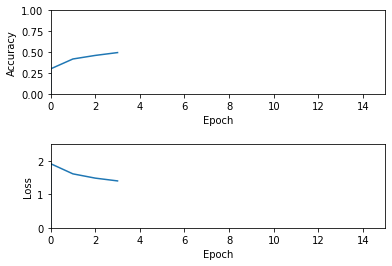

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/4a0model.ckpt Model Saved...
Epoch [100000], loss: 1.9419, acc: 0.0000
Epoch [100001], loss: 1.3183, acc: 1.0000
Epoch [100002], loss: 0.8674, acc: 0.0000
Epoch [100003], loss: 0.7078, acc: 1.0000
Epoch [100004], loss: 0.3910, acc: 1.0000
Epoch [100005], loss: 1.3182, acc: 1.0000
Epoch [100006], loss: 1.3600, acc: 1.0000
Epoch [100007], loss: 0.7493, acc: 0.0000
Epoch [100008], loss: 2.0546, acc: 0.0000
Epoch [100009], loss: 0.5533, acc: 1.0000
Epoch [100010], loss: 1.7591, acc: 0.0000
Epoch [100011], loss: 1.1956, acc: 0.0000
Epoch [100012], loss: 0.1456, acc: 1.0000
Epoch [100013], loss: 1.7066, acc: 0.0000
Epoch [100014], loss: 0.5443, acc: 1.0000
Epoch [100015], loss: 3.1666, acc: 0.0000
Epoch [100016], loss: 3.4886, acc: 0.0000
Epoch [100017], loss: 0.0729, acc: 1.0000
Epoch [100018], loss: 0.8428, acc: 1.0000
Epoch [100019], loss: 0.7157, acc: 1.0000
Epoch [100020], loss: 0.8697, acc: 1.0000
Epoch [100021],

Epoch [100198], loss: 0.5903, acc: 1.0000
Epoch [100199], loss: 3.5696, acc: 0.0000
Epoch [100200], loss: 1.7822, acc: 0.0000
Epoch [100201], loss: 0.2638, acc: 1.0000
Epoch [100202], loss: 0.2627, acc: 1.0000
Epoch [100203], loss: 0.3210, acc: 1.0000
Epoch [100204], loss: 1.6350, acc: 0.0000
Epoch [100205], loss: 0.2433, acc: 1.0000
Epoch [100206], loss: 1.8672, acc: 0.0000
Epoch [100207], loss: 0.1773, acc: 1.0000
Epoch [100208], loss: 3.4353, acc: 0.0000
Epoch [100209], loss: 0.4661, acc: 1.0000
Epoch [100210], loss: 0.4995, acc: 1.0000
Epoch [100211], loss: 0.6081, acc: 1.0000
Epoch [100212], loss: 0.2135, acc: 1.0000
Epoch [100213], loss: 1.4757, acc: 0.0000
Epoch [100214], loss: 2.3541, acc: 0.0000
Epoch [100215], loss: 2.1016, acc: 0.0000
Epoch [100216], loss: 1.3815, acc: 0.0000
Epoch [100217], loss: 0.5910, acc: 1.0000
Epoch [100218], loss: 0.6527, acc: 1.0000
Epoch [100219], loss: 0.4128, acc: 1.0000
Epoch [100220], loss: 0.6504, acc: 1.0000
Epoch [100221], loss: 2.1281, acc:

Epoch [100401], loss: 0.0188, acc: 1.0000
Epoch [100402], loss: 0.0035, acc: 1.0000
Epoch [100403], loss: 3.3356, acc: 0.0000
Epoch [100404], loss: 2.2861, acc: 0.0000
Epoch [100405], loss: 1.0628, acc: 1.0000
Epoch [100406], loss: 1.6229, acc: 0.0000
Epoch [100407], loss: 2.2037, acc: 0.0000
Epoch [100408], loss: 0.2297, acc: 1.0000
Epoch [100409], loss: 0.6484, acc: 1.0000
Epoch [100410], loss: 0.1860, acc: 1.0000
Epoch [100411], loss: 0.1022, acc: 1.0000
Epoch [100412], loss: 0.0900, acc: 1.0000
Epoch [100413], loss: 0.9390, acc: 1.0000
Epoch [100414], loss: 0.6563, acc: 1.0000
Epoch [100415], loss: 0.8322, acc: 0.0000
Epoch [100416], loss: 3.5991, acc: 0.0000
Epoch [100417], loss: 0.7040, acc: 1.0000
Epoch [100418], loss: 2.8844, acc: 0.0000
Epoch [100419], loss: 0.4481, acc: 1.0000
Epoch [100420], loss: 1.9810, acc: 0.0000
Epoch [100421], loss: 0.4427, acc: 1.0000
Epoch [100422], loss: 1.2595, acc: 0.0000
Epoch [100423], loss: 0.4336, acc: 1.0000
Epoch [100424], loss: 0.4236, acc:

Epoch [100595], loss: 0.6614, acc: 1.0000
Epoch [100596], loss: 2.8418, acc: 0.0000
Epoch [100597], loss: 0.7375, acc: 1.0000
Epoch [100598], loss: 0.8707, acc: 1.0000
Epoch [100599], loss: 0.7980, acc: 1.0000
Epoch [100600], loss: 2.4706, acc: 0.0000
Epoch [100601], loss: 1.0093, acc: 1.0000
Epoch [100602], loss: 2.3050, acc: 0.0000
Epoch [100603], loss: 0.9188, acc: 0.0000
Epoch [100604], loss: 0.1610, acc: 1.0000
Epoch [100605], loss: 1.4931, acc: 0.0000
Epoch [100606], loss: 1.2469, acc: 0.0000
Epoch [100607], loss: 1.2763, acc: 0.0000
Epoch [100608], loss: 2.7719, acc: 0.0000
Epoch [100609], loss: 0.5017, acc: 1.0000
Epoch [100610], loss: 2.2595, acc: 0.0000
Epoch [100611], loss: 0.1214, acc: 1.0000
Epoch [100612], loss: 0.5205, acc: 1.0000
Epoch [100613], loss: 0.1863, acc: 1.0000
Epoch [100614], loss: 1.0399, acc: 1.0000
Epoch [100615], loss: 0.0858, acc: 1.0000
Epoch [100616], loss: 1.2165, acc: 1.0000
Epoch [100617], loss: 1.3298, acc: 0.0000
Epoch [100618], loss: 0.7171, acc:

Epoch [100804], loss: 2.6118, acc: 0.0000
Epoch [100805], loss: 0.8008, acc: 1.0000
Epoch [100806], loss: 1.7326, acc: 0.0000
Epoch [100807], loss: 2.0935, acc: 0.0000
Epoch [100808], loss: 0.7415, acc: 1.0000
Epoch [100809], loss: 1.2290, acc: 1.0000
Epoch [100810], loss: 0.7731, acc: 1.0000
Epoch [100811], loss: 2.1477, acc: 0.0000
Epoch [100812], loss: 0.3268, acc: 1.0000
Epoch [100813], loss: 0.3565, acc: 1.0000
Epoch [100814], loss: 1.5479, acc: 0.0000
Epoch [100815], loss: 0.4031, acc: 1.0000
Epoch [100816], loss: 2.4166, acc: 0.0000
Epoch [100817], loss: 3.0524, acc: 0.0000
Epoch [100818], loss: 1.2920, acc: 1.0000
Epoch [100819], loss: 0.5538, acc: 1.0000
Epoch [100820], loss: 1.3359, acc: 1.0000
Epoch [100821], loss: 0.8347, acc: 1.0000
Epoch [100822], loss: 1.6092, acc: 0.0000
Epoch [100823], loss: 0.6155, acc: 1.0000
Epoch [100824], loss: 0.1772, acc: 1.0000
Epoch [100825], loss: 1.1609, acc: 0.0000
Epoch [100826], loss: 3.1376, acc: 0.0000
Epoch [100827], loss: 0.4952, acc:

Epoch [101018], loss: 1.2043, acc: 0.0000
Epoch [101019], loss: 0.3873, acc: 1.0000
Epoch [101020], loss: 1.7877, acc: 0.0000
Epoch [101021], loss: 0.7921, acc: 1.0000
Epoch [101022], loss: 1.0070, acc: 0.0000
Epoch [101023], loss: 0.2274, acc: 1.0000
Epoch [101024], loss: 2.4865, acc: 0.0000
Epoch [101025], loss: 0.3278, acc: 1.0000
Epoch [101026], loss: 1.8337, acc: 0.0000
Epoch [101027], loss: 0.4142, acc: 1.0000
Epoch [101028], loss: 1.8359, acc: 0.0000
Epoch [101029], loss: 0.3303, acc: 1.0000
Epoch [101030], loss: 1.2511, acc: 1.0000
Epoch [101031], loss: 3.6965, acc: 0.0000
Epoch [101032], loss: 0.7771, acc: 1.0000
Epoch [101033], loss: 0.8354, acc: 1.0000
Epoch [101034], loss: 2.6426, acc: 0.0000
Epoch [101035], loss: 1.3854, acc: 0.0000
Epoch [101036], loss: 0.6072, acc: 1.0000
Epoch [101037], loss: 0.6352, acc: 1.0000
Epoch [101038], loss: 6.1208, acc: 0.0000
Epoch [101039], loss: 1.0179, acc: 1.0000
Epoch [101040], loss: 1.4968, acc: 0.0000
Epoch [101041], loss: 0.3531, acc:

Epoch [101228], loss: 0.6917, acc: 1.0000
Epoch [101229], loss: 1.1903, acc: 1.0000
Epoch [101230], loss: 0.9036, acc: 1.0000
Epoch [101231], loss: 0.9191, acc: 1.0000
Epoch [101232], loss: 1.5428, acc: 0.0000
Epoch [101233], loss: 5.3040, acc: 0.0000
Epoch [101234], loss: 1.7044, acc: 0.0000
Epoch [101235], loss: 0.2104, acc: 1.0000
Epoch [101236], loss: 2.6853, acc: 0.0000
Epoch [101237], loss: 0.2993, acc: 1.0000
Epoch [101238], loss: 0.7350, acc: 1.0000
Epoch [101239], loss: 0.2514, acc: 1.0000
Epoch [101240], loss: 1.5664, acc: 0.0000
Epoch [101241], loss: 6.4025, acc: 0.0000
Epoch [101242], loss: 0.8492, acc: 1.0000
Epoch [101243], loss: 0.8623, acc: 1.0000
Epoch [101244], loss: 1.1693, acc: 1.0000
Epoch [101245], loss: 0.3663, acc: 1.0000
Epoch [101246], loss: 1.5335, acc: 0.0000
Epoch [101247], loss: 0.2915, acc: 1.0000
Epoch [101248], loss: 1.4033, acc: 0.0000
Epoch [101249], loss: 1.4249, acc: 0.0000
Epoch [101250], loss: 1.7912, acc: 0.0000
Epoch [101251], loss: 1.0576, acc:

Epoch [101451], loss: 1.6371, acc: 0.0000
Epoch [101452], loss: 2.1623, acc: 0.0000
Epoch [101453], loss: 0.5057, acc: 1.0000
Epoch [101454], loss: 0.7115, acc: 1.0000
Epoch [101455], loss: 1.0179, acc: 1.0000
Epoch [101456], loss: 2.6718, acc: 0.0000
Epoch [101457], loss: 0.8342, acc: 1.0000
Epoch [101458], loss: 2.1847, acc: 0.0000
Epoch [101459], loss: 0.7409, acc: 1.0000
Epoch [101460], loss: 0.2158, acc: 1.0000
Epoch [101461], loss: 1.3717, acc: 0.0000
Epoch [101462], loss: 2.0188, acc: 0.0000
Epoch [101463], loss: 2.6907, acc: 0.0000
Epoch [101464], loss: 0.8397, acc: 1.0000
Epoch [101465], loss: 1.0749, acc: 1.0000
Epoch [101466], loss: 1.4801, acc: 1.0000
Epoch [101467], loss: 0.3026, acc: 1.0000
Epoch [101468], loss: 0.4348, acc: 1.0000
Epoch [101469], loss: 1.6042, acc: 0.0000
Epoch [101470], loss: 1.6163, acc: 0.0000
Epoch [101471], loss: 0.0877, acc: 1.0000
Epoch [101472], loss: 0.4452, acc: 1.0000
Epoch [101473], loss: 2.3616, acc: 0.0000
Epoch [101474], loss: 1.5737, acc:

Epoch [101648], loss: 0.4855, acc: 1.0000
Epoch [101649], loss: 1.9776, acc: 0.0000
Epoch [101650], loss: 0.8277, acc: 1.0000
Epoch [101651], loss: 1.8807, acc: 0.0000
Epoch [101652], loss: 2.8526, acc: 0.0000
Epoch [101653], loss: 0.3424, acc: 1.0000
Epoch [101654], loss: 0.4413, acc: 1.0000
Epoch [101655], loss: 0.9590, acc: 0.0000
Epoch [101656], loss: 0.7986, acc: 1.0000
Epoch [101657], loss: 1.2749, acc: 0.0000
Epoch [101658], loss: 4.1849, acc: 0.0000
Epoch [101659], loss: 1.0349, acc: 1.0000
Epoch [101660], loss: 1.8827, acc: 0.0000
Epoch [101661], loss: 1.1454, acc: 0.0000
Epoch [101662], loss: 0.2995, acc: 1.0000
Epoch [101663], loss: 1.5122, acc: 0.0000
Epoch [101664], loss: 0.7871, acc: 1.0000
Epoch [101665], loss: 0.3112, acc: 1.0000
Epoch [101666], loss: 0.3239, acc: 1.0000
Epoch [101667], loss: 2.8798, acc: 0.0000
Epoch [101668], loss: 0.8800, acc: 1.0000
Epoch [101669], loss: 0.6755, acc: 1.0000
Epoch [101670], loss: 2.1479, acc: 0.0000
Epoch [101671], loss: 0.3399, acc:

Epoch [101851], loss: 1.9322, acc: 0.0000
Epoch [101852], loss: 1.6601, acc: 0.0000
Epoch [101853], loss: 0.4404, acc: 1.0000
Epoch [101854], loss: 1.3225, acc: 0.0000
Epoch [101855], loss: 4.5213, acc: 0.0000
Epoch [101856], loss: 1.6955, acc: 0.0000
Epoch [101857], loss: 0.4336, acc: 1.0000
Epoch [101858], loss: 2.0470, acc: 0.0000
Epoch [101859], loss: 5.4141, acc: 0.0000
Epoch [101860], loss: 1.7984, acc: 0.0000
Epoch [101861], loss: 0.3356, acc: 1.0000
Epoch [101862], loss: 0.9107, acc: 1.0000
Epoch [101863], loss: 4.0210, acc: 0.0000
Epoch [101864], loss: 1.6739, acc: 0.0000
Epoch [101865], loss: 2.8364, acc: 0.0000
Epoch [101866], loss: 1.4372, acc: 1.0000
Epoch [101867], loss: 0.2399, acc: 1.0000
Epoch [101868], loss: 0.9198, acc: 0.0000
Epoch [101869], loss: 1.3244, acc: 0.0000
Epoch [101870], loss: 1.4025, acc: 0.0000
Epoch [101871], loss: 0.4907, acc: 1.0000
Epoch [101872], loss: 0.1112, acc: 1.0000
Epoch [101873], loss: 1.1549, acc: 0.0000
Epoch [101874], loss: 0.1646, acc:

Epoch [102057], loss: 0.9570, acc: 1.0000
Epoch [102058], loss: 6.2496, acc: 0.0000
Epoch [102059], loss: 5.3168, acc: 0.0000
Epoch [102060], loss: 1.9670, acc: 0.0000
Epoch [102061], loss: 0.8035, acc: 1.0000
Epoch [102062], loss: 1.5866, acc: 0.0000
Epoch [102063], loss: 0.3704, acc: 1.0000
Epoch [102064], loss: 0.4855, acc: 1.0000
Epoch [102065], loss: 1.1132, acc: 1.0000
Epoch [102066], loss: 1.2062, acc: 1.0000
Epoch [102067], loss: 0.6180, acc: 1.0000
Epoch [102068], loss: 0.6551, acc: 1.0000
Epoch [102069], loss: 0.9547, acc: 1.0000
Epoch [102070], loss: 0.1395, acc: 1.0000
Epoch [102071], loss: 1.4279, acc: 0.0000
Epoch [102072], loss: 0.7535, acc: 1.0000
Epoch [102073], loss: 1.0276, acc: 1.0000
Epoch [102074], loss: 2.1411, acc: 0.0000
Epoch [102075], loss: 0.9090, acc: 1.0000
Epoch [102076], loss: 0.6286, acc: 1.0000
Epoch [102077], loss: 0.5319, acc: 1.0000
Epoch [102078], loss: 1.7587, acc: 0.0000
Epoch [102079], loss: 0.1541, acc: 1.0000
Epoch [102080], loss: 0.4036, acc:

Epoch [102268], loss: 1.9793, acc: 0.0000
Epoch [102269], loss: 1.0723, acc: 1.0000
Epoch [102270], loss: 1.8131, acc: 0.0000
Epoch [102271], loss: 1.0500, acc: 1.0000
Epoch [102272], loss: 0.9771, acc: 0.0000
Epoch [102273], loss: 1.5539, acc: 0.0000
Epoch [102274], loss: 1.6205, acc: 0.0000
Epoch [102275], loss: 2.8534, acc: 0.0000
Epoch [102276], loss: 1.2881, acc: 0.0000
Epoch [102277], loss: 0.8828, acc: 1.0000
Epoch [102278], loss: 3.5041, acc: 0.0000
Epoch [102279], loss: 1.5919, acc: 0.0000
Epoch [102280], loss: 1.5396, acc: 0.0000
Epoch [102281], loss: 0.8140, acc: 1.0000
Epoch [102282], loss: 0.8366, acc: 1.0000
Epoch [102283], loss: 0.6964, acc: 1.0000
Epoch [102284], loss: 0.8715, acc: 1.0000
Epoch [102285], loss: 4.2049, acc: 0.0000
Epoch [102286], loss: 1.8927, acc: 0.0000
Epoch [102287], loss: 1.9993, acc: 0.0000
Epoch [102288], loss: 2.1624, acc: 0.0000
Epoch [102289], loss: 1.7860, acc: 0.0000
Epoch [102290], loss: 1.8031, acc: 0.0000
Epoch [102291], loss: 1.7978, acc:

Epoch [102470], loss: 0.8305, acc: 1.0000
Epoch [102471], loss: 3.5062, acc: 0.0000
Epoch [102472], loss: 0.5500, acc: 1.0000
Epoch [102473], loss: 0.9781, acc: 1.0000
Epoch [102474], loss: 2.0503, acc: 0.0000
Epoch [102475], loss: 1.6354, acc: 0.0000
Epoch [102476], loss: 0.6310, acc: 1.0000
Epoch [102477], loss: 0.3288, acc: 1.0000
Epoch [102478], loss: 5.1591, acc: 0.0000
Epoch [102479], loss: 0.3544, acc: 1.0000
Epoch [102480], loss: 2.5502, acc: 0.0000
Epoch [102481], loss: 0.5787, acc: 1.0000
Epoch [102482], loss: 3.4640, acc: 0.0000
Epoch [102483], loss: 0.0257, acc: 1.0000
Epoch [102484], loss: 0.8844, acc: 1.0000
Epoch [102485], loss: 0.0520, acc: 1.0000
Epoch [102486], loss: 1.4805, acc: 0.0000
Epoch [102487], loss: 0.1523, acc: 1.0000
Epoch [102488], loss: 1.1932, acc: 1.0000
Epoch [102489], loss: 1.6779, acc: 0.0000
Epoch [102490], loss: 1.0298, acc: 1.0000
Epoch [102491], loss: 1.1583, acc: 1.0000
Epoch [102492], loss: 1.4985, acc: 0.0000
Epoch [102493], loss: 3.3423, acc:

Epoch [102677], loss: 2.0451, acc: 0.0000
Epoch [102678], loss: 1.4806, acc: 0.0000
Epoch [102679], loss: 2.4428, acc: 0.0000
Epoch [102680], loss: 0.9644, acc: 0.0000
Epoch [102681], loss: 0.7534, acc: 1.0000
Epoch [102682], loss: 2.1557, acc: 0.0000
Epoch [102683], loss: 0.8959, acc: 1.0000
Epoch [102684], loss: 1.9588, acc: 0.0000
Epoch [102685], loss: 1.5574, acc: 0.0000
Epoch [102686], loss: 0.0694, acc: 1.0000
Epoch [102687], loss: 0.0576, acc: 1.0000
Epoch [102688], loss: 0.5382, acc: 1.0000
Epoch [102689], loss: 3.0211, acc: 0.0000
Epoch [102690], loss: 0.7206, acc: 1.0000
Epoch [102691], loss: 0.6351, acc: 1.0000
Epoch [102692], loss: 1.5981, acc: 0.0000
Epoch [102693], loss: 1.4235, acc: 0.0000
Epoch [102694], loss: 2.0677, acc: 0.0000
Epoch [102695], loss: 1.9216, acc: 0.0000
Epoch [102696], loss: 0.9884, acc: 1.0000
Epoch [102697], loss: 0.8273, acc: 1.0000
Epoch [102698], loss: 1.3536, acc: 0.0000
Epoch [102699], loss: 0.9010, acc: 0.0000
Epoch [102700], loss: 1.3365, acc:

Epoch [102887], loss: 0.9354, acc: 0.0000
Epoch [102888], loss: 0.9721, acc: 1.0000
Epoch [102889], loss: 1.8512, acc: 0.0000
Epoch [102890], loss: 1.9442, acc: 0.0000
Epoch [102891], loss: 0.6966, acc: 1.0000
Epoch [102892], loss: 1.5051, acc: 0.0000
Epoch [102893], loss: 3.2737, acc: 0.0000
Epoch [102894], loss: 1.1749, acc: 0.0000
Epoch [102895], loss: 1.8103, acc: 0.0000
Epoch [102896], loss: 0.2530, acc: 1.0000
Epoch [102897], loss: 1.7119, acc: 0.0000
Epoch [102898], loss: 3.3238, acc: 0.0000
Epoch [102899], loss: 1.9412, acc: 0.0000
Epoch [102900], loss: 0.6839, acc: 1.0000
Epoch [102901], loss: 1.5156, acc: 0.0000
Epoch [102902], loss: 0.7113, acc: 1.0000
Epoch [102903], loss: 0.7022, acc: 1.0000
Epoch [102904], loss: 1.4217, acc: 0.0000
Epoch [102905], loss: 0.9678, acc: 1.0000
Epoch [102906], loss: 1.7086, acc: 0.0000
Epoch [102907], loss: 1.4591, acc: 0.0000
Epoch [102908], loss: 0.2233, acc: 1.0000
Epoch [102909], loss: 2.4756, acc: 0.0000
Epoch [102910], loss: 1.5607, acc:

Epoch [103092], loss: 2.9084, acc: 0.0000
Epoch [103093], loss: 0.0477, acc: 1.0000
Epoch [103094], loss: 1.4498, acc: 0.0000
Epoch [103095], loss: 1.7510, acc: 0.0000
Epoch [103096], loss: 0.6760, acc: 1.0000
Epoch [103097], loss: 1.0197, acc: 0.0000
Epoch [103098], loss: 0.8100, acc: 1.0000
Epoch [103099], loss: 0.4003, acc: 1.0000
Epoch [103100], loss: 7.1854, acc: 0.0000
Epoch [103101], loss: 0.1252, acc: 1.0000
Epoch [103102], loss: 0.0770, acc: 1.0000
Epoch [103103], loss: 1.6539, acc: 0.0000
Epoch [103104], loss: 1.8185, acc: 0.0000
Epoch [103105], loss: 0.5449, acc: 1.0000
Epoch [103106], loss: 0.3647, acc: 1.0000
Epoch [103107], loss: 0.1872, acc: 1.0000
Epoch [103108], loss: 1.6732, acc: 0.0000
Epoch [103109], loss: 3.0059, acc: 0.0000
Epoch [103110], loss: 0.6297, acc: 1.0000
Epoch [103111], loss: 1.2741, acc: 1.0000
Epoch [103112], loss: 0.6709, acc: 1.0000
Epoch [103113], loss: 2.0292, acc: 0.0000
Epoch [103114], loss: 0.2733, acc: 1.0000
Epoch [103115], loss: 0.8869, acc:

Epoch [103301], loss: 0.1281, acc: 1.0000
Epoch [103302], loss: 1.6175, acc: 0.0000
Epoch [103303], loss: 2.5115, acc: 0.0000
Epoch [103304], loss: 0.1575, acc: 1.0000
Epoch [103305], loss: 2.4963, acc: 0.0000
Epoch [103306], loss: 2.8318, acc: 0.0000
Epoch [103307], loss: 0.0707, acc: 1.0000
Epoch [103308], loss: 0.4766, acc: 1.0000
Epoch [103309], loss: 1.3349, acc: 1.0000
Epoch [103310], loss: 0.3845, acc: 1.0000
Epoch [103311], loss: 3.5153, acc: 0.0000
Epoch [103312], loss: 1.9892, acc: 0.0000
Epoch [103313], loss: 0.2435, acc: 1.0000
Epoch [103314], loss: 2.9514, acc: 0.0000
Epoch [103315], loss: 2.2763, acc: 0.0000
Epoch [103316], loss: 1.2980, acc: 0.0000
Epoch [103317], loss: 1.2751, acc: 0.0000
Epoch [103318], loss: 3.2167, acc: 0.0000
Epoch [103319], loss: 0.0466, acc: 1.0000
Epoch [103320], loss: 3.3056, acc: 0.0000
Epoch [103321], loss: 1.4365, acc: 0.0000
Epoch [103322], loss: 0.2744, acc: 1.0000
Epoch [103323], loss: 1.7577, acc: 0.0000
Epoch [103324], loss: 0.7910, acc:

Epoch [103506], loss: 1.0114, acc: 1.0000
Epoch [103507], loss: 0.8553, acc: 1.0000
Epoch [103508], loss: 1.0660, acc: 1.0000
Epoch [103509], loss: 0.2933, acc: 1.0000
Epoch [103510], loss: 1.0053, acc: 1.0000
Epoch [103511], loss: 1.3303, acc: 0.0000
Epoch [103512], loss: 0.3471, acc: 1.0000
Epoch [103513], loss: 0.4435, acc: 1.0000
Epoch [103514], loss: 1.2778, acc: 0.0000
Epoch [103515], loss: 0.8015, acc: 1.0000
Epoch [103516], loss: 0.5879, acc: 1.0000
Epoch [103517], loss: 4.6415, acc: 0.0000
Epoch [103518], loss: 1.9095, acc: 0.0000
Epoch [103519], loss: 3.0790, acc: 0.0000
Epoch [103520], loss: 1.2975, acc: 0.0000
Epoch [103521], loss: 1.5010, acc: 0.0000
Epoch [103522], loss: 1.5266, acc: 0.0000
Epoch [103523], loss: 0.4885, acc: 1.0000
Epoch [103524], loss: 0.9099, acc: 1.0000
Epoch [103525], loss: 3.3180, acc: 0.0000
Epoch [103526], loss: 0.5831, acc: 1.0000
Epoch [103527], loss: 0.5431, acc: 1.0000
Epoch [103528], loss: 0.5093, acc: 1.0000
Epoch [103529], loss: 0.2166, acc:

Epoch [103712], loss: 2.3302, acc: 0.0000
Epoch [103713], loss: 2.0212, acc: 0.0000
Epoch [103714], loss: 0.9670, acc: 1.0000
Epoch [103715], loss: 2.8967, acc: 0.0000
Epoch [103716], loss: 1.9001, acc: 0.0000
Epoch [103717], loss: 0.2045, acc: 1.0000
Epoch [103718], loss: 1.4893, acc: 1.0000
Epoch [103719], loss: 1.1441, acc: 1.0000
Epoch [103720], loss: 0.7676, acc: 0.0000
Epoch [103721], loss: 2.8810, acc: 0.0000
Epoch [103722], loss: 2.3852, acc: 0.0000
Epoch [103723], loss: 0.3164, acc: 1.0000
Epoch [103724], loss: 0.2116, acc: 1.0000
Epoch [103725], loss: 2.3130, acc: 0.0000
Epoch [103726], loss: 0.1160, acc: 1.0000
Epoch [103727], loss: 0.7064, acc: 1.0000
Epoch [103728], loss: 1.8288, acc: 0.0000
Epoch [103729], loss: 2.2348, acc: 0.0000
Epoch [103730], loss: 1.5092, acc: 0.0000
Epoch [103731], loss: 3.0855, acc: 0.0000
Epoch [103732], loss: 0.5440, acc: 1.0000
Epoch [103733], loss: 1.9139, acc: 0.0000
Epoch [103734], loss: 0.8373, acc: 1.0000
Epoch [103735], loss: 0.4461, acc:

Epoch [103915], loss: 0.2050, acc: 1.0000
Epoch [103916], loss: 1.2967, acc: 0.0000
Epoch [103917], loss: 0.6623, acc: 1.0000
Epoch [103918], loss: 2.2970, acc: 0.0000
Epoch [103919], loss: 0.3583, acc: 1.0000
Epoch [103920], loss: 2.1140, acc: 0.0000
Epoch [103921], loss: 0.8293, acc: 1.0000
Epoch [103922], loss: 0.1543, acc: 1.0000
Epoch [103923], loss: 1.1726, acc: 0.0000
Epoch [103924], loss: 0.4039, acc: 1.0000
Epoch [103925], loss: 1.4481, acc: 1.0000
Epoch [103926], loss: 1.2721, acc: 0.0000
Epoch [103927], loss: 1.2893, acc: 0.0000
Epoch [103928], loss: 1.3421, acc: 0.0000
Epoch [103929], loss: 3.8734, acc: 0.0000
Epoch [103930], loss: 1.6147, acc: 0.0000
Epoch [103931], loss: 0.8937, acc: 1.0000
Epoch [103932], loss: 0.9340, acc: 0.0000
Epoch [103933], loss: 3.5174, acc: 0.0000
Epoch [103934], loss: 1.3233, acc: 1.0000
Epoch [103935], loss: 0.5476, acc: 1.0000
Epoch [103936], loss: 0.5198, acc: 1.0000
Epoch [103937], loss: 2.6400, acc: 0.0000
Epoch [103938], loss: 0.2200, acc:

Epoch [104121], loss: 2.5210, acc: 0.0000
Epoch [104122], loss: 2.6241, acc: 0.0000
Epoch [104123], loss: 1.7696, acc: 0.0000
Epoch [104124], loss: 0.8419, acc: 1.0000
Epoch [104125], loss: 0.2563, acc: 1.0000
Epoch [104126], loss: 1.4540, acc: 1.0000
Epoch [104127], loss: 0.8881, acc: 1.0000
Epoch [104128], loss: 0.5698, acc: 1.0000
Epoch [104129], loss: 0.9803, acc: 0.0000
Epoch [104130], loss: 0.2338, acc: 1.0000
Epoch [104131], loss: 0.1063, acc: 1.0000
Epoch [104132], loss: 1.0391, acc: 1.0000
Epoch [104133], loss: 0.6100, acc: 1.0000
Epoch [104134], loss: 0.2977, acc: 1.0000
Epoch [104135], loss: 0.4990, acc: 1.0000
Epoch [104136], loss: 2.2531, acc: 0.0000
Epoch [104137], loss: 1.3828, acc: 0.0000
Epoch [104138], loss: 0.6669, acc: 1.0000
Epoch [104139], loss: 3.1772, acc: 0.0000
Epoch [104140], loss: 0.4941, acc: 1.0000
Epoch [104141], loss: 0.4571, acc: 1.0000
Epoch [104142], loss: 0.6722, acc: 1.0000
Epoch [104143], loss: 0.0766, acc: 1.0000
Epoch [104144], loss: 3.5472, acc:

Epoch [104346], loss: 0.7533, acc: 1.0000
Epoch [104347], loss: 1.6231, acc: 0.0000
Epoch [104348], loss: 0.1815, acc: 1.0000
Epoch [104349], loss: 0.2791, acc: 1.0000
Epoch [104350], loss: 0.1959, acc: 1.0000
Epoch [104351], loss: 0.6994, acc: 1.0000
Epoch [104352], loss: 1.3110, acc: 0.0000
Epoch [104353], loss: 3.3949, acc: 0.0000
Epoch [104354], loss: 1.5926, acc: 0.0000
Epoch [104355], loss: 0.3621, acc: 1.0000
Epoch [104356], loss: 2.3722, acc: 0.0000
Epoch [104357], loss: 0.3145, acc: 1.0000
Epoch [104358], loss: 4.2573, acc: 0.0000
Epoch [104359], loss: 1.1434, acc: 0.0000
Epoch [104360], loss: 1.4520, acc: 0.0000
Epoch [104361], loss: 0.0999, acc: 1.0000
Epoch [104362], loss: 0.7672, acc: 1.0000
Epoch [104363], loss: 1.5951, acc: 1.0000
Epoch [104364], loss: 0.3416, acc: 1.0000
Epoch [104365], loss: 0.2609, acc: 1.0000
Epoch [104366], loss: 1.8612, acc: 0.0000
Epoch [104367], loss: 0.4144, acc: 1.0000
Epoch [104368], loss: 2.2405, acc: 0.0000
Epoch [104369], loss: 3.1671, acc:

Epoch [104549], loss: 1.0660, acc: 0.0000
Epoch [104550], loss: 2.1170, acc: 0.0000
Epoch [104551], loss: 0.2530, acc: 1.0000
Epoch [104552], loss: 0.7317, acc: 1.0000
Epoch [104553], loss: 0.8198, acc: 1.0000
Epoch [104554], loss: 0.8663, acc: 0.0000
Epoch [104555], loss: 1.8628, acc: 0.0000
Epoch [104556], loss: 1.5793, acc: 0.0000
Epoch [104557], loss: 2.3729, acc: 0.0000
Epoch [104558], loss: 1.7198, acc: 0.0000
Epoch [104559], loss: 0.7268, acc: 1.0000
Epoch [104560], loss: 0.3524, acc: 1.0000
Epoch [104561], loss: 2.1823, acc: 0.0000
Epoch [104562], loss: 0.9670, acc: 1.0000
Epoch [104563], loss: 0.5929, acc: 1.0000
Epoch [104564], loss: 0.1922, acc: 1.0000
Epoch [104565], loss: 1.3720, acc: 0.0000
Epoch [104566], loss: 0.5811, acc: 1.0000
Epoch [104567], loss: 0.6526, acc: 1.0000
Epoch [104568], loss: 0.6446, acc: 1.0000
Epoch [104569], loss: 2.6826, acc: 0.0000
Epoch [104570], loss: 0.6294, acc: 1.0000
Epoch [104571], loss: 1.2482, acc: 0.0000
Epoch [104572], loss: 1.6941, acc:

Epoch [104764], loss: 0.1875, acc: 1.0000
Epoch [104765], loss: 1.3599, acc: 1.0000
Epoch [104766], loss: 1.2136, acc: 0.0000
Epoch [104767], loss: 1.3267, acc: 0.0000
Epoch [104768], loss: 5.2551, acc: 0.0000
Epoch [104769], loss: 0.3096, acc: 1.0000
Epoch [104770], loss: 1.4832, acc: 0.0000
Epoch [104771], loss: 2.5319, acc: 0.0000
Epoch [104772], loss: 2.1383, acc: 0.0000
Epoch [104773], loss: 1.2906, acc: 0.0000
Epoch [104774], loss: 1.6051, acc: 0.0000
Epoch [104775], loss: 0.5800, acc: 1.0000
Epoch [104776], loss: 0.4314, acc: 1.0000
Epoch [104777], loss: 3.3597, acc: 0.0000
Epoch [104778], loss: 1.6361, acc: 0.0000
Epoch [104779], loss: 1.7480, acc: 0.0000
Epoch [104780], loss: 2.8717, acc: 0.0000
Epoch [104781], loss: 0.9529, acc: 0.0000
Epoch [104782], loss: 0.8460, acc: 0.0000
Epoch [104783], loss: 1.0481, acc: 1.0000
Epoch [104784], loss: 0.5771, acc: 1.0000
Epoch [104785], loss: 0.7832, acc: 1.0000
Epoch [104786], loss: 2.1449, acc: 0.0000
Epoch [104787], loss: 1.4573, acc:

Epoch [104971], loss: 1.6234, acc: 0.0000
Epoch [104972], loss: 0.8986, acc: 0.0000
Epoch [104973], loss: 1.1316, acc: 0.0000
Epoch [104974], loss: 0.5806, acc: 1.0000
Epoch [104975], loss: 0.8577, acc: 1.0000
Epoch [104976], loss: 0.4608, acc: 1.0000
Epoch [104977], loss: 3.3231, acc: 0.0000
Epoch [104978], loss: 1.5476, acc: 0.0000
Epoch [104979], loss: 1.3723, acc: 0.0000
Epoch [104980], loss: 0.7900, acc: 1.0000
Epoch [104981], loss: 2.5247, acc: 0.0000
Epoch [104982], loss: 2.0968, acc: 0.0000
Epoch [104983], loss: 1.5443, acc: 0.0000
Epoch [104984], loss: 1.5608, acc: 0.0000
Epoch [104985], loss: 1.7358, acc: 0.0000
Epoch [104986], loss: 2.6819, acc: 0.0000
Epoch [104987], loss: 2.7086, acc: 0.0000
Epoch [104988], loss: 2.3607, acc: 0.0000
Epoch [104989], loss: 1.3657, acc: 0.0000
Epoch [104990], loss: 2.9123, acc: 0.0000
Epoch [104991], loss: 0.8109, acc: 1.0000
Epoch [104992], loss: 0.7200, acc: 1.0000
Epoch [104993], loss: 1.0449, acc: 1.0000
Epoch [104994], loss: 2.0777, acc:

Epoch [105175], loss: 3.7385, acc: 0.0000
Epoch [105176], loss: 0.1064, acc: 1.0000
Epoch [105177], loss: 0.3393, acc: 1.0000
Epoch [105178], loss: 0.8456, acc: 1.0000
Epoch [105179], loss: 0.2181, acc: 1.0000
Epoch [105180], loss: 2.1438, acc: 0.0000
Epoch [105181], loss: 2.2302, acc: 0.0000
Epoch [105182], loss: 2.0529, acc: 0.0000
Epoch [105183], loss: 1.3385, acc: 0.0000
Epoch [105184], loss: 0.0483, acc: 1.0000
Epoch [105185], loss: 0.6365, acc: 1.0000
Epoch [105186], loss: 0.8887, acc: 1.0000
Epoch [105187], loss: 0.6694, acc: 1.0000
Epoch [105188], loss: 1.5842, acc: 0.0000
Epoch [105189], loss: 1.2459, acc: 1.0000
Epoch [105190], loss: 5.6062, acc: 0.0000
Epoch [105191], loss: 0.6327, acc: 1.0000
Epoch [105192], loss: 2.4427, acc: 0.0000
Epoch [105193], loss: 1.7815, acc: 0.0000
Epoch [105194], loss: 1.7754, acc: 0.0000
Epoch [105195], loss: 0.3564, acc: 1.0000
Epoch [105196], loss: 2.9376, acc: 0.0000
Epoch [105197], loss: 1.7427, acc: 0.0000
Epoch [105198], loss: 2.0197, acc:

Epoch [105396], loss: 5.4202, acc: 0.0000
Epoch [105397], loss: 1.0428, acc: 1.0000
Epoch [105398], loss: 0.5678, acc: 1.0000
Epoch [105399], loss: 1.0745, acc: 0.0000
Epoch [105400], loss: 3.0895, acc: 0.0000
Epoch [105401], loss: 1.1948, acc: 1.0000
Epoch [105402], loss: 2.8809, acc: 0.0000
Epoch [105403], loss: 1.5494, acc: 0.0000
Epoch [105404], loss: 0.9669, acc: 1.0000
Epoch [105405], loss: 1.8044, acc: 1.0000
Epoch [105406], loss: 0.1570, acc: 1.0000
Epoch [105407], loss: 0.5288, acc: 1.0000
Epoch [105408], loss: 2.1263, acc: 0.0000
Epoch [105409], loss: 4.7836, acc: 0.0000
Epoch [105410], loss: 1.5848, acc: 0.0000
Epoch [105411], loss: 1.0268, acc: 0.0000
Epoch [105412], loss: 1.2204, acc: 1.0000
Epoch [105413], loss: 2.4525, acc: 0.0000
Epoch [105414], loss: 1.0651, acc: 0.0000
Epoch [105415], loss: 0.4108, acc: 1.0000
Epoch [105416], loss: 0.7392, acc: 1.0000
Epoch [105417], loss: 2.6222, acc: 0.0000
Epoch [105418], loss: 0.9023, acc: 1.0000
Epoch [105419], loss: 0.5320, acc:

Epoch [105606], loss: 3.6016, acc: 0.0000
Epoch [105607], loss: 0.2324, acc: 1.0000
Epoch [105608], loss: 1.4513, acc: 0.0000
Epoch [105609], loss: 1.1182, acc: 1.0000
Epoch [105610], loss: 0.5157, acc: 1.0000
Epoch [105611], loss: 2.6053, acc: 0.0000
Epoch [105612], loss: 2.7646, acc: 0.0000
Epoch [105613], loss: 1.3663, acc: 0.0000
Epoch [105614], loss: 0.9569, acc: 1.0000
Epoch [105615], loss: 0.4294, acc: 1.0000
Epoch [105616], loss: 3.5742, acc: 0.0000
Epoch [105617], loss: 2.3220, acc: 0.0000
Epoch [105618], loss: 0.3009, acc: 1.0000
Epoch [105619], loss: 0.9035, acc: 1.0000
Epoch [105620], loss: 0.4610, acc: 1.0000
Epoch [105621], loss: 0.9424, acc: 0.0000
Epoch [105622], loss: 2.0547, acc: 0.0000
Epoch [105623], loss: 1.9533, acc: 0.0000
Epoch [105624], loss: 0.8517, acc: 1.0000
Epoch [105625], loss: 0.3543, acc: 1.0000
Epoch [105626], loss: 1.7421, acc: 0.0000
Epoch [105627], loss: 1.3882, acc: 0.0000
Epoch [105628], loss: 1.8625, acc: 0.0000
Epoch [105629], loss: 0.4125, acc:

Epoch [105816], loss: 0.2936, acc: 1.0000
Epoch [105817], loss: 2.0090, acc: 0.0000
Epoch [105818], loss: 1.3099, acc: 0.0000
Epoch [105819], loss: 2.5323, acc: 0.0000
Epoch [105820], loss: 1.6685, acc: 0.0000
Epoch [105821], loss: 0.8807, acc: 0.0000
Epoch [105822], loss: 2.1442, acc: 0.0000
Epoch [105823], loss: 0.7405, acc: 1.0000
Epoch [105824], loss: 0.7941, acc: 1.0000
Epoch [105825], loss: 1.6636, acc: 0.0000
Epoch [105826], loss: 0.7411, acc: 1.0000
Epoch [105827], loss: 1.5776, acc: 1.0000
Epoch [105828], loss: 1.9678, acc: 0.0000
Epoch [105829], loss: 1.2206, acc: 0.0000
Epoch [105830], loss: 2.0400, acc: 0.0000
Epoch [105831], loss: 1.7315, acc: 0.0000
Epoch [105832], loss: 1.9105, acc: 0.0000
Epoch [105833], loss: 2.0401, acc: 0.0000
Epoch [105834], loss: 2.5529, acc: 0.0000
Epoch [105835], loss: 1.7957, acc: 0.0000
Epoch [105836], loss: 2.7866, acc: 0.0000
Epoch [105837], loss: 0.5312, acc: 1.0000
Epoch [105838], loss: 1.6347, acc: 0.0000
Epoch [105839], loss: 0.2600, acc:

Epoch [106023], loss: 0.6774, acc: 1.0000
Epoch [106024], loss: 0.8385, acc: 1.0000
Epoch [106025], loss: 2.0138, acc: 0.0000
Epoch [106026], loss: 1.7194, acc: 0.0000
Epoch [106027], loss: 1.5091, acc: 0.0000
Epoch [106028], loss: 1.5252, acc: 0.0000
Epoch [106029], loss: 0.4190, acc: 1.0000
Epoch [106030], loss: 0.3825, acc: 1.0000
Epoch [106031], loss: 1.1361, acc: 1.0000
Epoch [106032], loss: 0.9364, acc: 1.0000
Epoch [106033], loss: 0.1559, acc: 1.0000
Epoch [106034], loss: 1.7326, acc: 0.0000
Epoch [106035], loss: 0.1283, acc: 1.0000
Epoch [106036], loss: 0.9934, acc: 1.0000
Epoch [106037], loss: 3.2596, acc: 0.0000
Epoch [106038], loss: 0.7306, acc: 1.0000
Epoch [106039], loss: 1.0585, acc: 1.0000
Epoch [106040], loss: 0.6935, acc: 1.0000
Epoch [106041], loss: 3.5394, acc: 0.0000
Epoch [106042], loss: 0.6981, acc: 1.0000
Epoch [106043], loss: 0.7377, acc: 1.0000
Epoch [106044], loss: 1.7984, acc: 0.0000
Epoch [106045], loss: 0.7292, acc: 1.0000
Epoch [106046], loss: 0.7327, acc:

Epoch [106226], loss: 1.1996, acc: 0.0000
Epoch [106227], loss: 0.3185, acc: 1.0000
Epoch [106228], loss: 0.2143, acc: 1.0000
Epoch [106229], loss: 0.1609, acc: 1.0000
Epoch [106230], loss: 0.6346, acc: 1.0000
Epoch [106231], loss: 0.7277, acc: 1.0000
Epoch [106232], loss: 0.9683, acc: 0.0000
Epoch [106233], loss: 1.8635, acc: 0.0000
Epoch [106234], loss: 1.9802, acc: 0.0000
Epoch [106235], loss: 0.7629, acc: 1.0000
Epoch [106236], loss: 0.9080, acc: 1.0000
Epoch [106237], loss: 0.2704, acc: 1.0000
Epoch [106238], loss: 0.0642, acc: 1.0000
Epoch [106239], loss: 2.0547, acc: 0.0000
Epoch [106240], loss: 1.7935, acc: 0.0000
Epoch [106241], loss: 4.4352, acc: 0.0000
Epoch [106242], loss: 3.4648, acc: 0.0000
Epoch [106243], loss: 0.6118, acc: 1.0000
Epoch [106244], loss: 1.0681, acc: 0.0000
Epoch [106245], loss: 0.7785, acc: 1.0000
Epoch [106246], loss: 0.9982, acc: 1.0000
Epoch [106247], loss: 0.5633, acc: 1.0000
Epoch [106248], loss: 0.5130, acc: 1.0000
Epoch [106249], loss: 1.9561, acc:

Epoch [106431], loss: 0.1739, acc: 1.0000
Epoch [106432], loss: 1.3860, acc: 0.0000
Epoch [106433], loss: 1.9748, acc: 0.0000
Epoch [106434], loss: 0.1228, acc: 1.0000
Epoch [106435], loss: 0.8617, acc: 1.0000
Epoch [106436], loss: 1.4280, acc: 0.0000
Epoch [106437], loss: 0.2978, acc: 1.0000
Epoch [106438], loss: 0.3659, acc: 1.0000
Epoch [106439], loss: 2.5293, acc: 0.0000
Epoch [106440], loss: 1.5207, acc: 0.0000
Epoch [106441], loss: 1.0173, acc: 1.0000
Epoch [106442], loss: 0.4286, acc: 1.0000
Epoch [106443], loss: 1.1541, acc: 1.0000
Epoch [106444], loss: 5.4238, acc: 0.0000
Epoch [106445], loss: 0.2785, acc: 1.0000
Epoch [106446], loss: 0.1865, acc: 1.0000
Epoch [106447], loss: 2.6210, acc: 0.0000
Epoch [106448], loss: 1.1249, acc: 0.0000
Epoch [106449], loss: 0.7499, acc: 1.0000
Epoch [106450], loss: 0.8115, acc: 1.0000
Epoch [106451], loss: 1.0353, acc: 0.0000
Epoch [106452], loss: 0.6278, acc: 1.0000
Epoch [106453], loss: 0.5394, acc: 1.0000
Epoch [106454], loss: 0.5644, acc:

Epoch [106646], loss: 0.5863, acc: 1.0000
Epoch [106647], loss: 0.2687, acc: 1.0000
Epoch [106648], loss: 0.7836, acc: 1.0000
Epoch [106649], loss: 0.8571, acc: 1.0000
Epoch [106650], loss: 0.4135, acc: 1.0000
Epoch [106651], loss: 2.0873, acc: 0.0000
Epoch [106652], loss: 2.5875, acc: 0.0000
Epoch [106653], loss: 0.4264, acc: 1.0000
Epoch [106654], loss: 3.0234, acc: 0.0000
Epoch [106655], loss: 1.4370, acc: 1.0000
Epoch [106656], loss: 0.8826, acc: 1.0000
Epoch [106657], loss: 2.2890, acc: 0.0000
Epoch [106658], loss: 0.8063, acc: 1.0000
Epoch [106659], loss: 1.4832, acc: 1.0000
Epoch [106660], loss: 0.3164, acc: 1.0000
Epoch [106661], loss: 2.8071, acc: 0.0000
Epoch [106662], loss: 0.8757, acc: 1.0000
Epoch [106663], loss: 0.2781, acc: 1.0000
Epoch [106664], loss: 2.2267, acc: 0.0000
Epoch [106665], loss: 1.9510, acc: 0.0000
Epoch [106666], loss: 2.0871, acc: 0.0000
Epoch [106667], loss: 0.3886, acc: 1.0000
Epoch [106668], loss: 2.0455, acc: 0.0000
Epoch [106669], loss: 3.7583, acc:

Epoch [106867], loss: 0.8751, acc: 1.0000
Epoch [106868], loss: 0.8285, acc: 1.0000
Epoch [106869], loss: 1.4365, acc: 0.0000
Epoch [106870], loss: 1.7536, acc: 0.0000
Epoch [106871], loss: 0.3084, acc: 1.0000
Epoch [106872], loss: 1.3390, acc: 1.0000
Epoch [106873], loss: 1.5304, acc: 0.0000
Epoch [106874], loss: 1.1068, acc: 0.0000
Epoch [106875], loss: 1.6438, acc: 0.0000
Epoch [106876], loss: 2.6164, acc: 0.0000
Epoch [106877], loss: 0.4268, acc: 1.0000
Epoch [106878], loss: 2.3715, acc: 0.0000
Epoch [106879], loss: 0.5398, acc: 1.0000
Epoch [106880], loss: 0.9799, acc: 1.0000
Epoch [106881], loss: 0.0935, acc: 1.0000
Epoch [106882], loss: 2.2334, acc: 0.0000
Epoch [106883], loss: 2.4772, acc: 0.0000
Epoch [106884], loss: 1.4547, acc: 0.0000
Epoch [106885], loss: 4.4841, acc: 0.0000
Epoch [106886], loss: 1.1462, acc: 1.0000
Epoch [106887], loss: 0.2946, acc: 1.0000
Epoch [106888], loss: 1.1697, acc: 1.0000
Epoch [106889], loss: 0.9431, acc: 1.0000
Epoch [106890], loss: 1.8255, acc:

Epoch [107085], loss: 1.2086, acc: 0.0000
Epoch [107086], loss: 0.7907, acc: 1.0000
Epoch [107087], loss: 0.9474, acc: 1.0000
Epoch [107088], loss: 2.1991, acc: 0.0000
Epoch [107089], loss: 0.1371, acc: 1.0000
Epoch [107090], loss: 0.9581, acc: 1.0000
Epoch [107091], loss: 0.6445, acc: 1.0000
Epoch [107092], loss: 3.6265, acc: 0.0000
Epoch [107093], loss: 0.6427, acc: 1.0000
Epoch [107094], loss: 0.0878, acc: 1.0000
Epoch [107095], loss: 2.0873, acc: 0.0000
Epoch [107096], loss: 0.8746, acc: 1.0000
Epoch [107097], loss: 0.2402, acc: 1.0000
Epoch [107098], loss: 0.3745, acc: 1.0000
Epoch [107099], loss: 0.5358, acc: 1.0000
Epoch [107100], loss: 1.2634, acc: 0.0000
Epoch [107101], loss: 0.8131, acc: 1.0000
Epoch [107102], loss: 1.0734, acc: 0.0000
Epoch [107103], loss: 1.2866, acc: 0.0000
Epoch [107104], loss: 5.2072, acc: 0.0000
Epoch [107105], loss: 2.0005, acc: 0.0000
Epoch [107106], loss: 1.7683, acc: 0.0000
Epoch [107107], loss: 0.0829, acc: 1.0000
Epoch [107108], loss: 0.3732, acc:

Epoch [107293], loss: 1.4221, acc: 0.0000
Epoch [107294], loss: 0.6814, acc: 1.0000
Epoch [107295], loss: 0.3267, acc: 1.0000
Epoch [107296], loss: 0.2918, acc: 1.0000
Epoch [107297], loss: 1.5875, acc: 0.0000
Epoch [107298], loss: 4.5635, acc: 0.0000
Epoch [107299], loss: 0.1866, acc: 1.0000
Epoch [107300], loss: 3.5364, acc: 0.0000
Epoch [107301], loss: 0.8299, acc: 1.0000
Epoch [107302], loss: 1.6618, acc: 0.0000
Epoch [107303], loss: 0.2601, acc: 1.0000
Epoch [107304], loss: 0.8266, acc: 1.0000
Epoch [107305], loss: 1.6223, acc: 0.0000
Epoch [107306], loss: 2.0793, acc: 0.0000
Epoch [107307], loss: 1.5331, acc: 0.0000
Epoch [107308], loss: 0.6737, acc: 1.0000
Epoch [107309], loss: 0.2678, acc: 1.0000
Epoch [107310], loss: 0.7582, acc: 1.0000
Epoch [107311], loss: 0.2934, acc: 1.0000
Epoch [107312], loss: 1.2876, acc: 0.0000
Epoch [107313], loss: 1.4300, acc: 0.0000
Epoch [107314], loss: 0.9710, acc: 1.0000
Epoch [107315], loss: 1.4303, acc: 0.0000
Epoch [107316], loss: 2.6286, acc:

Epoch [107505], loss: 2.5367, acc: 0.0000
Epoch [107506], loss: 0.7598, acc: 1.0000
Epoch [107507], loss: 4.3141, acc: 0.0000
Epoch [107508], loss: 2.4549, acc: 0.0000
Epoch [107509], loss: 0.9927, acc: 1.0000
Epoch [107510], loss: 0.7559, acc: 1.0000
Epoch [107511], loss: 1.0214, acc: 1.0000
Epoch [107512], loss: 0.2802, acc: 1.0000
Epoch [107513], loss: 0.8213, acc: 1.0000
Epoch [107514], loss: 2.9337, acc: 0.0000
Epoch [107515], loss: 1.4504, acc: 0.0000
Epoch [107516], loss: 0.7437, acc: 1.0000
Epoch [107517], loss: 0.2505, acc: 1.0000
Epoch [107518], loss: 1.1840, acc: 1.0000
Epoch [107519], loss: 1.0612, acc: 0.0000
Epoch [107520], loss: 0.9089, acc: 1.0000
Epoch [107521], loss: 1.7102, acc: 0.0000
Epoch [107522], loss: 0.2311, acc: 1.0000
Epoch [107523], loss: 1.1690, acc: 0.0000
Epoch [107524], loss: 0.7379, acc: 1.0000
Epoch [107525], loss: 1.4234, acc: 0.0000
Epoch [107526], loss: 1.0837, acc: 0.0000
Epoch [107527], loss: 1.0136, acc: 1.0000
Epoch [107528], loss: 5.3328, acc:

Epoch [107709], loss: 2.4141, acc: 0.0000
Epoch [107710], loss: 1.0624, acc: 0.0000
Epoch [107711], loss: 0.3356, acc: 1.0000
Epoch [107712], loss: 0.4816, acc: 1.0000
Epoch [107713], loss: 2.0294, acc: 0.0000
Epoch [107714], loss: 0.5477, acc: 1.0000
Epoch [107715], loss: 0.5238, acc: 1.0000
Epoch [107716], loss: 2.5309, acc: 0.0000
Epoch [107717], loss: 0.5312, acc: 1.0000
Epoch [107718], loss: 2.7681, acc: 0.0000
Epoch [107719], loss: 0.6364, acc: 1.0000
Epoch [107720], loss: 0.3128, acc: 1.0000
Epoch [107721], loss: 0.8792, acc: 1.0000
Epoch [107722], loss: 0.8216, acc: 0.0000
Epoch [107723], loss: 0.6345, acc: 1.0000
Epoch [107724], loss: 0.7010, acc: 1.0000
Epoch [107725], loss: 1.3278, acc: 0.0000
Epoch [107726], loss: 2.5950, acc: 0.0000
Epoch [107727], loss: 1.2659, acc: 0.0000
Epoch [107728], loss: 2.2005, acc: 0.0000
Epoch [107729], loss: 2.9876, acc: 0.0000
Epoch [107730], loss: 1.5394, acc: 1.0000
Epoch [107731], loss: 1.1174, acc: 1.0000
Epoch [107732], loss: 5.1119, acc:

Epoch [107923], loss: 0.8402, acc: 1.0000
Epoch [107924], loss: 1.0700, acc: 0.0000
Epoch [107925], loss: 1.8759, acc: 0.0000
Epoch [107926], loss: 1.1289, acc: 1.0000
Epoch [107927], loss: 3.1052, acc: 0.0000
Epoch [107928], loss: 3.9426, acc: 0.0000
Epoch [107929], loss: 1.5614, acc: 0.0000
Epoch [107930], loss: 0.1029, acc: 1.0000
Epoch [107931], loss: 0.5944, acc: 1.0000
Epoch [107932], loss: 0.9864, acc: 1.0000
Epoch [107933], loss: 1.0625, acc: 1.0000
Epoch [107934], loss: 1.6154, acc: 0.0000
Epoch [107935], loss: 1.3147, acc: 1.0000
Epoch [107936], loss: 1.1627, acc: 0.0000
Epoch [107937], loss: 0.1316, acc: 1.0000
Epoch [107938], loss: 1.9393, acc: 0.0000
Epoch [107939], loss: 0.8222, acc: 1.0000
Epoch [107940], loss: 1.8851, acc: 0.0000
Epoch [107941], loss: 2.1555, acc: 0.0000
Epoch [107942], loss: 1.4296, acc: 1.0000
Epoch [107943], loss: 0.7085, acc: 1.0000
Epoch [107944], loss: 0.5690, acc: 1.0000
Epoch [107945], loss: 0.5806, acc: 1.0000
Epoch [107946], loss: 1.2151, acc:

Epoch [108122], loss: 0.9171, acc: 0.0000
Epoch [108123], loss: 0.5575, acc: 1.0000
Epoch [108124], loss: 0.9517, acc: 1.0000
Epoch [108125], loss: 1.2519, acc: 0.0000
Epoch [108126], loss: 1.1277, acc: 1.0000
Epoch [108127], loss: 0.1979, acc: 1.0000
Epoch [108128], loss: 0.4005, acc: 1.0000
Epoch [108129], loss: 1.8207, acc: 0.0000
Epoch [108130], loss: 0.3372, acc: 1.0000
Epoch [108131], loss: 1.9786, acc: 0.0000
Epoch [108132], loss: 1.5742, acc: 0.0000
Epoch [108133], loss: 1.3679, acc: 0.0000
Epoch [108134], loss: 0.3132, acc: 1.0000
Epoch [108135], loss: 1.3330, acc: 1.0000
Epoch [108136], loss: 1.0816, acc: 1.0000
Epoch [108137], loss: 0.8571, acc: 1.0000
Epoch [108138], loss: 0.9353, acc: 1.0000
Epoch [108139], loss: 0.5105, acc: 1.0000
Epoch [108140], loss: 2.1113, acc: 0.0000
Epoch [108141], loss: 0.7580, acc: 1.0000
Epoch [108142], loss: 3.0256, acc: 0.0000
Epoch [108143], loss: 1.7983, acc: 0.0000
Epoch [108144], loss: 2.3736, acc: 0.0000
Epoch [108145], loss: 0.2555, acc:

Epoch [108325], loss: 2.0474, acc: 0.0000
Epoch [108326], loss: 0.6219, acc: 1.0000
Epoch [108327], loss: 1.3517, acc: 1.0000
Epoch [108328], loss: 3.8011, acc: 0.0000
Epoch [108329], loss: 0.3730, acc: 1.0000
Epoch [108330], loss: 3.3631, acc: 0.0000
Epoch [108331], loss: 3.0522, acc: 0.0000
Epoch [108332], loss: 3.6341, acc: 0.0000
Epoch [108333], loss: 1.2981, acc: 0.0000
Epoch [108334], loss: 1.6282, acc: 0.0000
Epoch [108335], loss: 1.6477, acc: 0.0000
Epoch [108336], loss: 0.7298, acc: 1.0000
Epoch [108337], loss: 1.4591, acc: 0.0000
Epoch [108338], loss: 2.1865, acc: 0.0000
Epoch [108339], loss: 0.4417, acc: 1.0000
Epoch [108340], loss: 0.8459, acc: 1.0000
Epoch [108341], loss: 2.1659, acc: 0.0000
Epoch [108342], loss: 1.3898, acc: 0.0000
Epoch [108343], loss: 0.8451, acc: 1.0000
Epoch [108344], loss: 0.1875, acc: 1.0000
Epoch [108345], loss: 1.2828, acc: 1.0000
Epoch [108346], loss: 3.3048, acc: 0.0000
Epoch [108347], loss: 1.1907, acc: 1.0000
Epoch [108348], loss: 0.7712, acc:

Epoch [108541], loss: 1.3561, acc: 0.0000
Epoch [108542], loss: 2.7764, acc: 0.0000
Epoch [108543], loss: 0.8773, acc: 1.0000
Epoch [108544], loss: 2.2349, acc: 0.0000
Epoch [108545], loss: 0.9393, acc: 1.0000
Epoch [108546], loss: 2.2563, acc: 0.0000
Epoch [108547], loss: 0.2278, acc: 1.0000
Epoch [108548], loss: 1.3578, acc: 1.0000
Epoch [108549], loss: 3.3899, acc: 0.0000
Epoch [108550], loss: 1.0614, acc: 1.0000
Epoch [108551], loss: 0.8854, acc: 1.0000
Epoch [108552], loss: 0.0684, acc: 1.0000
Epoch [108553], loss: 1.2861, acc: 0.0000
Epoch [108554], loss: 1.4810, acc: 0.0000
Epoch [108555], loss: 1.1719, acc: 0.0000
Epoch [108556], loss: 1.0570, acc: 0.0000
Epoch [108557], loss: 2.0656, acc: 0.0000
Epoch [108558], loss: 0.3612, acc: 1.0000
Epoch [108559], loss: 0.1933, acc: 1.0000
Epoch [108560], loss: 1.3831, acc: 1.0000
Epoch [108561], loss: 0.3576, acc: 1.0000
Epoch [108562], loss: 0.8722, acc: 1.0000
Epoch [108563], loss: 0.3624, acc: 1.0000
Epoch [108564], loss: 2.3948, acc:

Epoch [108766], loss: 1.1386, acc: 1.0000
Epoch [108767], loss: 2.1754, acc: 0.0000
Epoch [108768], loss: 0.1626, acc: 1.0000
Epoch [108769], loss: 2.7182, acc: 0.0000
Epoch [108770], loss: 2.1196, acc: 0.0000
Epoch [108771], loss: 0.9793, acc: 1.0000
Epoch [108772], loss: 5.6775, acc: 0.0000
Epoch [108773], loss: 3.2263, acc: 0.0000
Epoch [108774], loss: 1.9030, acc: 0.0000
Epoch [108775], loss: 0.7216, acc: 1.0000
Epoch [108776], loss: 2.2787, acc: 0.0000
Epoch [108777], loss: 0.8484, acc: 1.0000
Epoch [108778], loss: 1.0301, acc: 1.0000
Epoch [108779], loss: 2.3690, acc: 0.0000
Epoch [108780], loss: 0.3831, acc: 1.0000
Epoch [108781], loss: 0.5205, acc: 1.0000
Epoch [108782], loss: 0.3820, acc: 1.0000
Epoch [108783], loss: 1.4730, acc: 1.0000
Epoch [108784], loss: 1.9355, acc: 0.0000
Epoch [108785], loss: 1.4373, acc: 0.0000
Epoch [108786], loss: 1.5211, acc: 0.0000
Epoch [108787], loss: 0.7471, acc: 1.0000
Epoch [108788], loss: 1.1697, acc: 0.0000
Epoch [108789], loss: 1.4657, acc:

Epoch [108964], loss: 0.5742, acc: 1.0000
Epoch [108965], loss: 2.2096, acc: 0.0000
Epoch [108966], loss: 0.5284, acc: 1.0000
Epoch [108967], loss: 2.1750, acc: 0.0000
Epoch [108968], loss: 0.6588, acc: 1.0000
Epoch [108969], loss: 0.9977, acc: 1.0000
Epoch [108970], loss: 1.1123, acc: 0.0000
Epoch [108971], loss: 0.6639, acc: 1.0000
Epoch [108972], loss: 0.4317, acc: 1.0000
Epoch [108973], loss: 2.1541, acc: 0.0000
Epoch [108974], loss: 2.0469, acc: 0.0000
Epoch [108975], loss: 2.2259, acc: 0.0000
Epoch [108976], loss: 1.2303, acc: 0.0000
Epoch [108977], loss: 1.3534, acc: 0.0000
Epoch [108978], loss: 0.7720, acc: 1.0000
Epoch [108979], loss: 1.2681, acc: 0.0000
Epoch [108980], loss: 1.1673, acc: 0.0000
Epoch [108981], loss: 1.2540, acc: 1.0000
Epoch [108982], loss: 2.1149, acc: 0.0000
Epoch [108983], loss: 2.9739, acc: 0.0000
Epoch [108984], loss: 0.3973, acc: 1.0000
Epoch [108985], loss: 0.8219, acc: 1.0000
Epoch [108986], loss: 2.1054, acc: 0.0000
Epoch [108987], loss: 1.5931, acc:

Epoch [109180], loss: 0.5307, acc: 1.0000
Epoch [109181], loss: 1.3631, acc: 0.0000
Epoch [109182], loss: 2.1079, acc: 0.0000
Epoch [109183], loss: 0.9788, acc: 0.0000
Epoch [109184], loss: 1.7683, acc: 0.0000
Epoch [109185], loss: 0.1687, acc: 1.0000
Epoch [109186], loss: 3.6238, acc: 0.0000
Epoch [109187], loss: 0.9942, acc: 1.0000
Epoch [109188], loss: 1.9716, acc: 0.0000
Epoch [109189], loss: 0.8691, acc: 1.0000
Epoch [109190], loss: 2.3747, acc: 0.0000
Epoch [109191], loss: 1.4715, acc: 0.0000
Epoch [109192], loss: 1.5405, acc: 0.0000
Epoch [109193], loss: 1.2199, acc: 1.0000
Epoch [109194], loss: 0.3604, acc: 1.0000
Epoch [109195], loss: 2.4373, acc: 0.0000
Epoch [109196], loss: 0.9544, acc: 1.0000
Epoch [109197], loss: 0.4319, acc: 1.0000
Epoch [109198], loss: 2.9470, acc: 0.0000
Epoch [109199], loss: 1.6647, acc: 0.0000
Epoch [109200], loss: 3.9753, acc: 0.0000
Epoch [109201], loss: 1.3712, acc: 0.0000
Epoch [109202], loss: 1.3208, acc: 1.0000
Epoch [109203], loss: 2.1046, acc:

Epoch [109391], loss: 0.9396, acc: 0.0000
Epoch [109392], loss: 0.7020, acc: 1.0000
Epoch [109393], loss: 0.9585, acc: 0.0000
Epoch [109394], loss: 1.4769, acc: 0.0000
Epoch [109395], loss: 0.5687, acc: 1.0000
Epoch [109396], loss: 2.4531, acc: 0.0000
Epoch [109397], loss: 1.3069, acc: 0.0000
Epoch [109398], loss: 1.3198, acc: 0.0000
Epoch [109399], loss: 0.7272, acc: 0.0000
Epoch [109400], loss: 2.7472, acc: 0.0000
Epoch [109401], loss: 2.8916, acc: 0.0000
Epoch [109402], loss: 0.3382, acc: 1.0000
Epoch [109403], loss: 1.8407, acc: 0.0000
Epoch [109404], loss: 0.3028, acc: 1.0000
Epoch [109405], loss: 0.0371, acc: 1.0000
Epoch [109406], loss: 1.1225, acc: 1.0000
Epoch [109407], loss: 0.7281, acc: 1.0000
Epoch [109408], loss: 1.8333, acc: 0.0000
Epoch [109409], loss: 0.6193, acc: 1.0000
Epoch [109410], loss: 0.3300, acc: 1.0000
Epoch [109411], loss: 1.5945, acc: 0.0000
Epoch [109412], loss: 0.8054, acc: 1.0000
Epoch [109413], loss: 1.1083, acc: 0.0000
Epoch [109414], loss: 2.2154, acc:

Epoch [109607], loss: 2.5640, acc: 0.0000
Epoch [109608], loss: 1.1303, acc: 1.0000
Epoch [109609], loss: 0.5881, acc: 1.0000
Epoch [109610], loss: 0.8514, acc: 0.0000
Epoch [109611], loss: 2.8837, acc: 0.0000
Epoch [109612], loss: 0.3357, acc: 1.0000
Epoch [109613], loss: 0.1820, acc: 1.0000
Epoch [109614], loss: 1.0007, acc: 0.0000
Epoch [109615], loss: 1.3548, acc: 0.0000
Epoch [109616], loss: 0.9319, acc: 0.0000
Epoch [109617], loss: 0.5997, acc: 1.0000
Epoch [109618], loss: 0.8440, acc: 0.0000
Epoch [109619], loss: 0.9557, acc: 1.0000
Epoch [109620], loss: 0.5804, acc: 1.0000
Epoch [109621], loss: 1.6605, acc: 0.0000
Epoch [109622], loss: 1.0130, acc: 0.0000
Epoch [109623], loss: 0.5385, acc: 1.0000
Epoch [109624], loss: 1.5198, acc: 0.0000
Epoch [109625], loss: 0.6575, acc: 1.0000
Epoch [109626], loss: 0.9886, acc: 0.0000
Epoch [109627], loss: 1.8898, acc: 0.0000
Epoch [109628], loss: 1.0579, acc: 1.0000
Epoch [109629], loss: 1.1187, acc: 1.0000
Epoch [109630], loss: 1.0785, acc:

Epoch [109803], loss: 3.3155, acc: 0.0000
Epoch [109804], loss: 0.5319, acc: 1.0000
Epoch [109805], loss: 1.0127, acc: 1.0000
Epoch [109806], loss: 0.1209, acc: 1.0000
Epoch [109807], loss: 0.9881, acc: 1.0000
Epoch [109808], loss: 0.5378, acc: 1.0000
Epoch [109809], loss: 2.1420, acc: 0.0000
Epoch [109810], loss: 0.2440, acc: 1.0000
Epoch [109811], loss: 0.5292, acc: 1.0000
Epoch [109812], loss: 2.4070, acc: 0.0000
Epoch [109813], loss: 0.1532, acc: 1.0000
Epoch [109814], loss: 0.5606, acc: 1.0000
Epoch [109815], loss: 1.0690, acc: 1.0000
Epoch [109816], loss: 0.6100, acc: 1.0000
Epoch [109817], loss: 0.6757, acc: 1.0000
Epoch [109818], loss: 1.5056, acc: 0.0000
Epoch [109819], loss: 1.3150, acc: 1.0000
Epoch [109820], loss: 1.0914, acc: 1.0000
Epoch [109821], loss: 1.0013, acc: 0.0000
Epoch [109822], loss: 1.6642, acc: 0.0000
Epoch [109823], loss: 1.4664, acc: 0.0000
Epoch [109824], loss: 1.8211, acc: 0.0000
Epoch [109825], loss: 1.1403, acc: 1.0000
Epoch [109826], loss: 1.2153, acc:

Epoch [110021], loss: 2.2427, acc: 0.0000
Epoch [110022], loss: 0.3656, acc: 1.0000
Epoch [110023], loss: 1.2400, acc: 1.0000
Epoch [110024], loss: 2.8788, acc: 0.0000
Epoch [110025], loss: 0.7209, acc: 1.0000
Epoch [110026], loss: 0.7392, acc: 1.0000
Epoch [110027], loss: 1.7488, acc: 0.0000
Epoch [110028], loss: 4.3499, acc: 0.0000
Epoch [110029], loss: 0.8682, acc: 1.0000
Epoch [110030], loss: 0.9075, acc: 1.0000
Epoch [110031], loss: 0.9062, acc: 1.0000
Epoch [110032], loss: 3.2016, acc: 0.0000
Epoch [110033], loss: 0.1990, acc: 1.0000
Epoch [110034], loss: 1.7060, acc: 0.0000
Epoch [110035], loss: 1.8889, acc: 0.0000
Epoch [110036], loss: 0.3096, acc: 1.0000
Epoch [110037], loss: 1.6758, acc: 0.0000
Epoch [110038], loss: 1.4014, acc: 1.0000
Epoch [110039], loss: 2.0634, acc: 0.0000
Epoch [110040], loss: 1.8830, acc: 0.0000
Epoch [110041], loss: 0.8820, acc: 1.0000
Epoch [110042], loss: 1.2247, acc: 0.0000
Epoch [110043], loss: 0.7443, acc: 1.0000
Epoch [110044], loss: 0.1598, acc:

Epoch [110246], loss: 2.9367, acc: 0.0000
Epoch [110247], loss: 2.2460, acc: 0.0000
Epoch [110248], loss: 0.0371, acc: 1.0000
Epoch [110249], loss: 2.8323, acc: 0.0000
Epoch [110250], loss: 1.9580, acc: 0.0000
Epoch [110251], loss: 4.4436, acc: 0.0000
Epoch [110252], loss: 1.4709, acc: 0.0000
Epoch [110253], loss: 3.0096, acc: 0.0000
Epoch [110254], loss: 0.1146, acc: 1.0000
Epoch [110255], loss: 1.2510, acc: 1.0000
Epoch [110256], loss: 2.5753, acc: 0.0000
Epoch [110257], loss: 1.9804, acc: 0.0000
Epoch [110258], loss: 2.3920, acc: 0.0000
Epoch [110259], loss: 1.3598, acc: 1.0000
Epoch [110260], loss: 1.3976, acc: 0.0000
Epoch [110261], loss: 1.4210, acc: 0.0000
Epoch [110262], loss: 0.5306, acc: 1.0000
Epoch [110263], loss: 1.9673, acc: 0.0000
Epoch [110264], loss: 0.3594, acc: 1.0000
Epoch [110265], loss: 0.2822, acc: 1.0000
Epoch [110266], loss: 3.1290, acc: 0.0000
Epoch [110267], loss: 0.7149, acc: 1.0000
Epoch [110268], loss: 0.7582, acc: 1.0000
Epoch [110269], loss: 1.8346, acc:

Epoch [110444], loss: 0.1278, acc: 1.0000
Epoch [110445], loss: 1.4096, acc: 0.0000
Epoch [110446], loss: 3.3119, acc: 0.0000
Epoch [110447], loss: 0.7534, acc: 1.0000
Epoch [110448], loss: 0.2785, acc: 1.0000
Epoch [110449], loss: 1.1712, acc: 0.0000
Epoch [110450], loss: 2.5775, acc: 0.0000
Epoch [110451], loss: 0.0179, acc: 1.0000
Epoch [110452], loss: 1.4860, acc: 0.0000
Epoch [110453], loss: 1.3467, acc: 0.0000
Epoch [110454], loss: 1.0127, acc: 0.0000
Epoch [110455], loss: 1.1568, acc: 0.0000
Epoch [110456], loss: 2.0250, acc: 0.0000
Epoch [110457], loss: 1.4505, acc: 1.0000
Epoch [110458], loss: 2.7374, acc: 0.0000
Epoch [110459], loss: 1.0507, acc: 1.0000
Epoch [110460], loss: 1.1850, acc: 1.0000
Epoch [110461], loss: 0.2403, acc: 1.0000
Epoch [110462], loss: 1.8312, acc: 0.0000
Epoch [110463], loss: 0.7058, acc: 1.0000
Epoch [110464], loss: 0.0531, acc: 1.0000
Epoch [110465], loss: 1.7270, acc: 0.0000
Epoch [110466], loss: 1.9002, acc: 0.0000
Epoch [110467], loss: 0.1664, acc:

Epoch [110658], loss: 3.4199, acc: 0.0000
Epoch [110659], loss: 2.8539, acc: 0.0000
Epoch [110660], loss: 1.7067, acc: 0.0000
Epoch [110661], loss: 2.3190, acc: 0.0000
Epoch [110662], loss: 0.9874, acc: 1.0000
Epoch [110663], loss: 1.0815, acc: 1.0000
Epoch [110664], loss: 2.7895, acc: 0.0000
Epoch [110665], loss: 0.0991, acc: 1.0000
Epoch [110666], loss: 2.7785, acc: 0.0000
Epoch [110667], loss: 1.0295, acc: 1.0000
Epoch [110668], loss: 0.0821, acc: 1.0000
Epoch [110669], loss: 0.6828, acc: 1.0000
Epoch [110670], loss: 0.6953, acc: 1.0000
Epoch [110671], loss: 0.6288, acc: 1.0000
Epoch [110672], loss: 2.0900, acc: 0.0000
Epoch [110673], loss: 1.5003, acc: 0.0000
Epoch [110674], loss: 1.5205, acc: 0.0000
Epoch [110675], loss: 1.2348, acc: 0.0000
Epoch [110676], loss: 3.7931, acc: 0.0000
Epoch [110677], loss: 0.4495, acc: 1.0000
Epoch [110678], loss: 0.9951, acc: 0.0000
Epoch [110679], loss: 0.5942, acc: 1.0000
Epoch [110680], loss: 2.0063, acc: 0.0000
Epoch [110681], loss: 0.0858, acc:

Epoch [110868], loss: 0.0171, acc: 1.0000
Epoch [110869], loss: 1.7233, acc: 0.0000
Epoch [110870], loss: 2.2056, acc: 0.0000
Epoch [110871], loss: 1.7577, acc: 0.0000
Epoch [110872], loss: 0.3976, acc: 1.0000
Epoch [110873], loss: 0.9594, acc: 1.0000
Epoch [110874], loss: 1.5949, acc: 0.0000
Epoch [110875], loss: 4.4832, acc: 0.0000
Epoch [110876], loss: 1.2864, acc: 1.0000
Epoch [110877], loss: 2.1033, acc: 0.0000
Epoch [110878], loss: 2.0956, acc: 0.0000
Epoch [110879], loss: 1.7935, acc: 0.0000
Epoch [110880], loss: 1.0804, acc: 1.0000
Epoch [110881], loss: 0.7072, acc: 1.0000
Epoch [110882], loss: 1.3845, acc: 0.0000
Epoch [110883], loss: 3.8053, acc: 0.0000
Epoch [110884], loss: 1.1514, acc: 1.0000
Epoch [110885], loss: 3.2424, acc: 0.0000
Epoch [110886], loss: 1.9314, acc: 0.0000
Epoch [110887], loss: 2.1008, acc: 0.0000
Epoch [110888], loss: 0.8215, acc: 1.0000
Epoch [110889], loss: 0.6850, acc: 1.0000
Epoch [110890], loss: 1.2308, acc: 1.0000
Epoch [110891], loss: 0.8644, acc:

Epoch [111064], loss: 0.4692, acc: 1.0000
Epoch [111065], loss: 0.5997, acc: 1.0000
Epoch [111066], loss: 0.9852, acc: 0.0000
Epoch [111067], loss: 2.1091, acc: 0.0000
Epoch [111068], loss: 1.3543, acc: 1.0000
Epoch [111069], loss: 2.9456, acc: 0.0000
Epoch [111070], loss: 0.6718, acc: 1.0000
Epoch [111071], loss: 1.1457, acc: 0.0000
Epoch [111072], loss: 1.2526, acc: 0.0000
Epoch [111073], loss: 1.4168, acc: 0.0000
Epoch [111074], loss: 0.9598, acc: 0.0000
Epoch [111075], loss: 1.8470, acc: 0.0000
Epoch [111076], loss: 0.2881, acc: 1.0000
Epoch [111077], loss: 2.3676, acc: 0.0000
Epoch [111078], loss: 1.3275, acc: 0.0000
Epoch [111079], loss: 1.7860, acc: 1.0000
Epoch [111080], loss: 3.0170, acc: 0.0000
Epoch [111081], loss: 1.0560, acc: 0.0000
Epoch [111082], loss: 2.3571, acc: 0.0000
Epoch [111083], loss: 0.2899, acc: 1.0000
Epoch [111084], loss: 5.8526, acc: 0.0000
Epoch [111085], loss: 2.3998, acc: 0.0000
Epoch [111086], loss: 2.4418, acc: 0.0000
Epoch [111087], loss: 0.9425, acc:

Epoch [111287], loss: 0.2908, acc: 1.0000
Epoch [111288], loss: 1.6797, acc: 0.0000
Epoch [111289], loss: 1.7170, acc: 0.0000
Epoch [111290], loss: 4.7521, acc: 0.0000
Epoch [111291], loss: 0.6811, acc: 1.0000
Epoch [111292], loss: 2.1844, acc: 0.0000
Epoch [111293], loss: 3.2456, acc: 0.0000
Epoch [111294], loss: 1.5716, acc: 0.0000
Epoch [111295], loss: 0.6321, acc: 1.0000
Epoch [111296], loss: 2.7255, acc: 0.0000
Epoch [111297], loss: 0.8289, acc: 1.0000
Epoch [111298], loss: 0.3200, acc: 1.0000
Epoch [111299], loss: 1.8832, acc: 0.0000
Epoch [111300], loss: 1.4861, acc: 0.0000
Epoch [111301], loss: 0.9630, acc: 1.0000
Epoch [111302], loss: 1.9065, acc: 0.0000
Epoch [111303], loss: 1.2542, acc: 0.0000
Epoch [111304], loss: 1.2306, acc: 0.0000
Epoch [111305], loss: 5.6188, acc: 0.0000
Epoch [111306], loss: 2.4266, acc: 0.0000
Epoch [111307], loss: 1.5409, acc: 0.0000
Epoch [111308], loss: 3.0833, acc: 0.0000
Epoch [111309], loss: 0.8827, acc: 1.0000
Epoch [111310], loss: 2.5365, acc:

Epoch [111503], loss: 0.6793, acc: 1.0000
Epoch [111504], loss: 0.5957, acc: 1.0000
Epoch [111505], loss: 2.7802, acc: 0.0000
Epoch [111506], loss: 3.0070, acc: 0.0000
Epoch [111507], loss: 0.1590, acc: 1.0000
Epoch [111508], loss: 0.6282, acc: 1.0000
Epoch [111509], loss: 1.3906, acc: 0.0000
Epoch [111510], loss: 1.2837, acc: 0.0000
Epoch [111511], loss: 0.7152, acc: 1.0000
Epoch [111512], loss: 1.4425, acc: 0.0000
Epoch [111513], loss: 0.1706, acc: 1.0000
Epoch [111514], loss: 2.0590, acc: 0.0000
Epoch [111515], loss: 1.2299, acc: 0.0000
Epoch [111516], loss: 1.8072, acc: 0.0000
Epoch [111517], loss: 0.6688, acc: 1.0000
Epoch [111518], loss: 0.3705, acc: 1.0000
Epoch [111519], loss: 2.4890, acc: 0.0000
Epoch [111520], loss: 2.6659, acc: 0.0000
Epoch [111521], loss: 2.6822, acc: 0.0000
Epoch [111522], loss: 0.6821, acc: 1.0000
Epoch [111523], loss: 1.7286, acc: 0.0000
Epoch [111524], loss: 1.0633, acc: 1.0000
Epoch [111525], loss: 0.9575, acc: 1.0000
Epoch [111526], loss: 0.4049, acc:

Epoch [111724], loss: 0.6744, acc: 1.0000
Epoch [111725], loss: 0.4464, acc: 1.0000
Epoch [111726], loss: 1.0317, acc: 0.0000
Epoch [111727], loss: 0.2943, acc: 1.0000
Epoch [111728], loss: 0.6926, acc: 1.0000
Epoch [111729], loss: 2.7138, acc: 0.0000
Epoch [111730], loss: 1.5480, acc: 0.0000
Epoch [111731], loss: 2.5197, acc: 0.0000
Epoch [111732], loss: 0.4385, acc: 1.0000
Epoch [111733], loss: 0.3760, acc: 1.0000
Epoch [111734], loss: 0.1330, acc: 1.0000
Epoch [111735], loss: 2.2966, acc: 0.0000
Epoch [111736], loss: 4.2841, acc: 0.0000
Epoch [111737], loss: 0.3503, acc: 1.0000
Epoch [111738], loss: 0.6596, acc: 1.0000
Epoch [111739], loss: 0.2587, acc: 1.0000
Epoch [111740], loss: 0.1583, acc: 1.0000
Epoch [111741], loss: 1.2844, acc: 0.0000
Epoch [111742], loss: 1.1347, acc: 0.0000
Epoch [111743], loss: 1.9652, acc: 0.0000
Epoch [111744], loss: 1.6189, acc: 0.0000
Epoch [111745], loss: 0.2004, acc: 1.0000
Epoch [111746], loss: 1.9459, acc: 0.0000
Epoch [111747], loss: 1.3426, acc:

Epoch [111942], loss: 1.3037, acc: 1.0000
Epoch [111943], loss: 0.4947, acc: 1.0000
Epoch [111944], loss: 0.1500, acc: 1.0000
Epoch [111945], loss: 1.3799, acc: 1.0000
Epoch [111946], loss: 0.3382, acc: 1.0000
Epoch [111947], loss: 1.2391, acc: 0.0000
Epoch [111948], loss: 0.0561, acc: 1.0000
Epoch [111949], loss: 1.7737, acc: 0.0000
Epoch [111950], loss: 2.4226, acc: 0.0000
Epoch [111951], loss: 0.5917, acc: 1.0000
Epoch [111952], loss: 0.4602, acc: 1.0000
Epoch [111953], loss: 1.4863, acc: 0.0000
Epoch [111954], loss: 1.2113, acc: 0.0000
Epoch [111955], loss: 4.3331, acc: 0.0000
Epoch [111956], loss: 3.2339, acc: 0.0000
Epoch [111957], loss: 0.1042, acc: 1.0000
Epoch [111958], loss: 0.9513, acc: 1.0000
Epoch [111959], loss: 1.8794, acc: 0.0000
Epoch [111960], loss: 0.7065, acc: 1.0000
Epoch [111961], loss: 0.8801, acc: 1.0000
Epoch [111962], loss: 1.5659, acc: 0.0000
Epoch [111963], loss: 1.6164, acc: 0.0000
Epoch [111964], loss: 1.4071, acc: 0.0000
Epoch [111965], loss: 1.5033, acc:

Epoch [112159], loss: 2.1069, acc: 0.0000
Epoch [112160], loss: 3.6159, acc: 0.0000
Epoch [112161], loss: 0.6033, acc: 1.0000
Epoch [112162], loss: 0.2010, acc: 1.0000
Epoch [112163], loss: 1.5196, acc: 1.0000
Epoch [112164], loss: 0.7630, acc: 1.0000
Epoch [112165], loss: 1.4828, acc: 0.0000
Epoch [112166], loss: 0.2564, acc: 1.0000
Epoch [112167], loss: 1.3870, acc: 0.0000
Epoch [112168], loss: 0.5501, acc: 1.0000
Epoch [112169], loss: 1.8221, acc: 0.0000
Epoch [112170], loss: 0.8376, acc: 1.0000
Epoch [112171], loss: 1.2886, acc: 1.0000
Epoch [112172], loss: 0.5016, acc: 1.0000
Epoch [112173], loss: 1.6656, acc: 0.0000
Epoch [112174], loss: 0.9932, acc: 0.0000
Epoch [112175], loss: 2.1795, acc: 0.0000
Epoch [112176], loss: 2.4907, acc: 0.0000
Epoch [112177], loss: 2.8173, acc: 0.0000
Epoch [112178], loss: 0.8407, acc: 1.0000
Epoch [112179], loss: 1.2776, acc: 0.0000
Epoch [112180], loss: 0.0966, acc: 1.0000
Epoch [112181], loss: 0.6185, acc: 1.0000
Epoch [112182], loss: 1.3817, acc:

Epoch [112356], loss: 4.3205, acc: 0.0000
Epoch [112357], loss: 0.9248, acc: 1.0000
Epoch [112358], loss: 3.5768, acc: 0.0000
Epoch [112359], loss: 2.3548, acc: 0.0000
Epoch [112360], loss: 0.6101, acc: 1.0000
Epoch [112361], loss: 1.6482, acc: 0.0000
Epoch [112362], loss: 0.9302, acc: 1.0000
Epoch [112363], loss: 0.4814, acc: 1.0000
Epoch [112364], loss: 0.3102, acc: 1.0000
Epoch [112365], loss: 0.1988, acc: 1.0000
Epoch [112366], loss: 2.9255, acc: 0.0000
Epoch [112367], loss: 0.7073, acc: 1.0000
Epoch [112368], loss: 0.2916, acc: 1.0000
Epoch [112369], loss: 0.2948, acc: 1.0000
Epoch [112370], loss: 0.8853, acc: 0.0000
Epoch [112371], loss: 3.7946, acc: 0.0000
Epoch [112372], loss: 2.0502, acc: 0.0000
Epoch [112373], loss: 2.3401, acc: 0.0000
Epoch [112374], loss: 1.1241, acc: 1.0000
Epoch [112375], loss: 0.2339, acc: 1.0000
Epoch [112376], loss: 0.8946, acc: 0.0000
Epoch [112377], loss: 0.5781, acc: 1.0000
Epoch [112378], loss: 0.6508, acc: 1.0000
Epoch [112379], loss: 0.7011, acc:

Epoch [112576], loss: 2.5684, acc: 0.0000
Epoch [112577], loss: 3.5572, acc: 0.0000
Epoch [112578], loss: 0.5904, acc: 1.0000
Epoch [112579], loss: 1.1898, acc: 0.0000
Epoch [112580], loss: 0.8392, acc: 1.0000
Epoch [112581], loss: 2.2096, acc: 0.0000
Epoch [112582], loss: 3.9446, acc: 0.0000
Epoch [112583], loss: 2.0430, acc: 0.0000
Epoch [112584], loss: 0.3905, acc: 1.0000
Epoch [112585], loss: 0.5272, acc: 1.0000
Epoch [112586], loss: 1.1414, acc: 0.0000
Epoch [112587], loss: 2.0918, acc: 0.0000
Epoch [112588], loss: 2.8102, acc: 0.0000
Epoch [112589], loss: 2.3347, acc: 0.0000
Epoch [112590], loss: 0.7026, acc: 1.0000
Epoch [112591], loss: 0.7630, acc: 1.0000
Epoch [112592], loss: 0.3488, acc: 1.0000
Epoch [112593], loss: 2.7008, acc: 0.0000
Epoch [112594], loss: 1.6290, acc: 0.0000
Epoch [112595], loss: 5.6154, acc: 0.0000
Epoch [112596], loss: 2.1306, acc: 0.0000
Epoch [112597], loss: 2.3591, acc: 0.0000
Epoch [112598], loss: 1.1835, acc: 1.0000
Epoch [112599], loss: 2.6172, acc:

Epoch [112788], loss: 2.3797, acc: 0.0000
Epoch [112789], loss: 2.3551, acc: 0.0000
Epoch [112790], loss: 0.8950, acc: 0.0000
Epoch [112791], loss: 1.8333, acc: 0.0000
Epoch [112792], loss: 2.2171, acc: 0.0000
Epoch [112793], loss: 1.0255, acc: 1.0000
Epoch [112794], loss: 0.3710, acc: 1.0000
Epoch [112795], loss: 0.9440, acc: 1.0000
Epoch [112796], loss: 0.6501, acc: 1.0000
Epoch [112797], loss: 1.1256, acc: 1.0000
Epoch [112798], loss: 2.3908, acc: 0.0000
Epoch [112799], loss: 1.5796, acc: 0.0000
Epoch [112800], loss: 1.8053, acc: 0.0000
Epoch [112801], loss: 3.7274, acc: 0.0000
Epoch [112802], loss: 0.3138, acc: 1.0000
Epoch [112803], loss: 0.9855, acc: 1.0000
Epoch [112804], loss: 3.1841, acc: 0.0000
Epoch [112805], loss: 0.6218, acc: 1.0000
Epoch [112806], loss: 0.9862, acc: 0.0000
Epoch [112807], loss: 0.4101, acc: 1.0000
Epoch [112808], loss: 0.8640, acc: 1.0000
Epoch [112809], loss: 0.9017, acc: 0.0000
Epoch [112810], loss: 1.5157, acc: 0.0000
Epoch [112811], loss: 0.8523, acc:

Epoch [112997], loss: 0.8478, acc: 0.0000
Epoch [112998], loss: 2.5630, acc: 0.0000
Epoch [112999], loss: 2.4218, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/4a13000model.ckpt Model Saved...
Epoch [113000], loss: 0.9757, acc: 1.0000
Epoch [113001], loss: 0.2297, acc: 1.0000
Epoch [113002], loss: 4.0878, acc: 0.0000
Epoch [113003], loss: 1.2019, acc: 0.0000
Epoch [113004], loss: 0.2175, acc: 1.0000
Epoch [113005], loss: 2.8804, acc: 0.0000
Epoch [113006], loss: 1.1784, acc: 0.0000
Epoch [113007], loss: 1.3930, acc: 0.0000
Epoch [113008], loss: 2.3519, acc: 0.0000
Epoch [113009], loss: 2.9258, acc: 0.0000
Epoch [113010], loss: 1.4561, acc: 0.0000
Epoch [113011], loss: 0.8055, acc: 1.0000
Epoch [113012], loss: 1.5686, acc: 0.0000
Epoch [113013], loss: 0.2831, acc: 1.0000
Epoch [113014], loss: 1.0826, acc: 0.0000
Epoch [113015], loss: 1.5211, acc: 0.0000
Epoch [113016], loss: 0.6875, acc: 1.0000
Epoch [113017], loss: 3.0904, acc: 0.0000
Epoch [1130

Epoch [113191], loss: 1.6261, acc: 1.0000
Epoch [113192], loss: 4.0437, acc: 0.0000
Epoch [113193], loss: 1.8939, acc: 0.0000
Epoch [113194], loss: 2.2833, acc: 0.0000
Epoch [113195], loss: 0.6864, acc: 1.0000
Epoch [113196], loss: 2.4562, acc: 0.0000
Epoch [113197], loss: 1.7113, acc: 0.0000
Epoch [113198], loss: 0.0905, acc: 1.0000
Epoch [113199], loss: 0.2671, acc: 1.0000
Epoch [113200], loss: 4.0663, acc: 0.0000
Epoch [113201], loss: 0.4400, acc: 1.0000
Epoch [113202], loss: 2.2753, acc: 0.0000
Epoch [113203], loss: 2.1889, acc: 0.0000
Epoch [113204], loss: 0.7616, acc: 1.0000
Epoch [113205], loss: 3.8919, acc: 0.0000
Epoch [113206], loss: 0.5032, acc: 1.0000
Epoch [113207], loss: 1.1367, acc: 0.0000
Epoch [113208], loss: 0.9408, acc: 1.0000
Epoch [113209], loss: 1.3197, acc: 1.0000
Epoch [113210], loss: 1.5622, acc: 0.0000
Epoch [113211], loss: 2.1713, acc: 0.0000
Epoch [113212], loss: 0.9436, acc: 1.0000
Epoch [113213], loss: 2.0111, acc: 0.0000
Epoch [113214], loss: 2.0603, acc:

Epoch [113396], loss: 1.0959, acc: 0.0000
Epoch [113397], loss: 1.3064, acc: 1.0000
Epoch [113398], loss: 0.6726, acc: 1.0000
Epoch [113399], loss: 3.4854, acc: 0.0000
Epoch [113400], loss: 0.3661, acc: 1.0000
Epoch [113401], loss: 4.0628, acc: 0.0000
Epoch [113402], loss: 4.0345, acc: 0.0000
Epoch [113403], loss: 1.0529, acc: 1.0000
Epoch [113404], loss: 0.8868, acc: 1.0000
Epoch [113405], loss: 0.2968, acc: 1.0000
Epoch [113406], loss: 1.5198, acc: 1.0000
Epoch [113407], loss: 1.8090, acc: 0.0000
Epoch [113408], loss: 1.9672, acc: 0.0000
Epoch [113409], loss: 1.4608, acc: 0.0000
Epoch [113410], loss: 0.2038, acc: 1.0000
Epoch [113411], loss: 0.6322, acc: 1.0000
Epoch [113412], loss: 1.0320, acc: 0.0000
Epoch [113413], loss: 0.6290, acc: 1.0000
Epoch [113414], loss: 0.2174, acc: 1.0000
Epoch [113415], loss: 0.5461, acc: 1.0000
Epoch [113416], loss: 2.5733, acc: 0.0000
Epoch [113417], loss: 1.5687, acc: 0.0000
Epoch [113418], loss: 0.6278, acc: 1.0000
Epoch [113419], loss: 2.9923, acc:

Epoch [113598], loss: 2.4260, acc: 0.0000
Epoch [113599], loss: 2.3239, acc: 0.0000
Epoch [113600], loss: 0.8582, acc: 1.0000
Epoch [113601], loss: 1.4015, acc: 1.0000
Epoch [113602], loss: 2.0161, acc: 0.0000
Epoch [113603], loss: 0.5204, acc: 1.0000
Epoch [113604], loss: 0.4706, acc: 1.0000
Epoch [113605], loss: 0.6510, acc: 1.0000
Epoch [113606], loss: 0.7676, acc: 1.0000
Epoch [113607], loss: 1.5453, acc: 0.0000
Epoch [113608], loss: 1.1646, acc: 0.0000
Epoch [113609], loss: 1.5129, acc: 0.0000
Epoch [113610], loss: 2.3346, acc: 0.0000
Epoch [113611], loss: 2.9102, acc: 0.0000
Epoch [113612], loss: 2.6857, acc: 0.0000
Epoch [113613], loss: 1.2994, acc: 0.0000
Epoch [113614], loss: 0.7172, acc: 1.0000
Epoch [113615], loss: 1.9579, acc: 0.0000
Epoch [113616], loss: 1.7491, acc: 0.0000
Epoch [113617], loss: 1.8251, acc: 0.0000
Epoch [113618], loss: 0.7921, acc: 1.0000
Epoch [113619], loss: 1.1070, acc: 1.0000
Epoch [113620], loss: 0.9918, acc: 1.0000
Epoch [113621], loss: 1.1137, acc:

Epoch [113794], loss: 0.7463, acc: 1.0000
Epoch [113795], loss: 0.8552, acc: 1.0000
Epoch [113796], loss: 1.3006, acc: 0.0000
Epoch [113797], loss: 2.3771, acc: 0.0000
Epoch [113798], loss: 1.4709, acc: 0.0000
Epoch [113799], loss: 0.0241, acc: 1.0000
Epoch [113800], loss: 0.9755, acc: 0.0000
Epoch [113801], loss: 0.9337, acc: 1.0000
Epoch [113802], loss: 1.6716, acc: 0.0000
Epoch [113803], loss: 0.0345, acc: 1.0000
Epoch [113804], loss: 1.6026, acc: 0.0000
Epoch [113805], loss: 0.3035, acc: 1.0000
Epoch [113806], loss: 1.2382, acc: 0.0000
Epoch [113807], loss: 0.7687, acc: 1.0000
Epoch [113808], loss: 0.8927, acc: 1.0000
Epoch [113809], loss: 1.4798, acc: 1.0000
Epoch [113810], loss: 0.6430, acc: 1.0000
Epoch [113811], loss: 1.7030, acc: 0.0000
Epoch [113812], loss: 1.4825, acc: 0.0000
Epoch [113813], loss: 1.2193, acc: 1.0000
Epoch [113814], loss: 0.2685, acc: 1.0000
Epoch [113815], loss: 2.3142, acc: 0.0000
Epoch [113816], loss: 3.1501, acc: 0.0000
Epoch [113817], loss: 0.5807, acc:

Epoch [113992], loss: 0.3351, acc: 1.0000
Epoch [113993], loss: 0.7915, acc: 1.0000
Epoch [113994], loss: 2.7175, acc: 0.0000
Epoch [113995], loss: 0.5262, acc: 1.0000
Epoch [113996], loss: 3.2442, acc: 0.0000
Epoch [113997], loss: 1.2876, acc: 0.0000
Epoch [113998], loss: 0.9717, acc: 0.0000
Epoch [113999], loss: 1.3216, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/4a14000model.ckpt Model Saved...
Epoch [114000], loss: 0.3961, acc: 1.0000
Epoch [114001], loss: 1.8842, acc: 0.0000
Epoch [114002], loss: 0.5046, acc: 1.0000
Epoch [114003], loss: 1.5390, acc: 0.0000
Epoch [114004], loss: 1.4049, acc: 0.0000
Epoch [114005], loss: 0.5390, acc: 1.0000
Epoch [114006], loss: 2.8054, acc: 0.0000
Epoch [114007], loss: 1.2121, acc: 1.0000
Epoch [114008], loss: 1.7169, acc: 0.0000
Epoch [114009], loss: 2.1762, acc: 0.0000
Epoch [114010], loss: 1.8626, acc: 0.0000
Epoch [114011], loss: 0.1813, acc: 1.0000
Epoch [114012], loss: 1.3519, acc: 1.0000
Epoch [1140

Epoch [114206], loss: 1.1399, acc: 1.0000
Epoch [114207], loss: 0.9646, acc: 1.0000
Epoch [114208], loss: 2.2801, acc: 0.0000
Epoch [114209], loss: 2.1411, acc: 0.0000
Epoch [114210], loss: 0.9665, acc: 1.0000
Epoch [114211], loss: 0.3866, acc: 1.0000
Epoch [114212], loss: 1.4101, acc: 0.0000
Epoch [114213], loss: 1.0242, acc: 1.0000
Epoch [114214], loss: 1.2890, acc: 0.0000
Epoch [114215], loss: 2.6773, acc: 0.0000
Epoch [114216], loss: 0.7023, acc: 1.0000
Epoch [114217], loss: 0.6308, acc: 1.0000
Epoch [114218], loss: 2.9242, acc: 0.0000
Epoch [114219], loss: 1.7062, acc: 1.0000
Epoch [114220], loss: 0.5445, acc: 1.0000
Epoch [114221], loss: 1.0914, acc: 0.0000
Epoch [114222], loss: 0.7719, acc: 1.0000
Epoch [114223], loss: 1.3124, acc: 0.0000
Epoch [114224], loss: 1.2169, acc: 1.0000
Epoch [114225], loss: 0.8991, acc: 0.0000
Epoch [114226], loss: 2.4854, acc: 0.0000
Epoch [114227], loss: 0.9219, acc: 1.0000
Epoch [114228], loss: 2.1920, acc: 0.0000
Epoch [114229], loss: 0.8829, acc:

Epoch [114411], loss: 2.7322, acc: 0.0000
Epoch [114412], loss: 0.5971, acc: 1.0000
Epoch [114413], loss: 1.1308, acc: 0.0000
Epoch [114414], loss: 2.9994, acc: 0.0000
Epoch [114415], loss: 4.8320, acc: 0.0000
Epoch [114416], loss: 0.7781, acc: 1.0000
Epoch [114417], loss: 3.7585, acc: 0.0000
Epoch [114418], loss: 1.0710, acc: 1.0000
Epoch [114419], loss: 0.5991, acc: 1.0000
Epoch [114420], loss: 1.9944, acc: 0.0000
Epoch [114421], loss: 0.6046, acc: 1.0000
Epoch [114422], loss: 0.5885, acc: 1.0000
Epoch [114423], loss: 1.0458, acc: 1.0000
Epoch [114424], loss: 0.3109, acc: 1.0000
Epoch [114425], loss: 2.8207, acc: 0.0000
Epoch [114426], loss: 6.6716, acc: 0.0000
Epoch [114427], loss: 0.4747, acc: 1.0000
Epoch [114428], loss: 2.2265, acc: 0.0000
Epoch [114429], loss: 0.2768, acc: 1.0000
Epoch [114430], loss: 3.1252, acc: 0.0000
Epoch [114431], loss: 0.2537, acc: 1.0000
Epoch [114432], loss: 0.8920, acc: 1.0000
Epoch [114433], loss: 0.6291, acc: 1.0000
Epoch [114434], loss: 4.7560, acc:

Epoch [114616], loss: 1.1560, acc: 0.0000
Epoch [114617], loss: 0.6319, acc: 1.0000
Epoch [114618], loss: 2.9907, acc: 0.0000
Epoch [114619], loss: 0.8562, acc: 1.0000
Epoch [114620], loss: 0.7510, acc: 1.0000
Epoch [114621], loss: 1.3820, acc: 0.0000
Epoch [114622], loss: 2.8295, acc: 0.0000
Epoch [114623], loss: 2.0174, acc: 0.0000
Epoch [114624], loss: 1.5718, acc: 0.0000
Epoch [114625], loss: 1.1288, acc: 1.0000
Epoch [114626], loss: 0.5012, acc: 1.0000
Epoch [114627], loss: 0.1177, acc: 1.0000
Epoch [114628], loss: 0.1129, acc: 1.0000
Epoch [114629], loss: 0.5277, acc: 1.0000
Epoch [114630], loss: 1.1169, acc: 1.0000
Epoch [114631], loss: 0.0576, acc: 1.0000
Epoch [114632], loss: 1.4160, acc: 0.0000
Epoch [114633], loss: 0.9223, acc: 1.0000
Epoch [114634], loss: 0.7944, acc: 1.0000
Epoch [114635], loss: 0.3893, acc: 1.0000
Epoch [114636], loss: 1.9712, acc: 0.0000
Epoch [114637], loss: 0.5948, acc: 1.0000
Epoch [114638], loss: 0.1770, acc: 1.0000
Epoch [114639], loss: 1.2972, acc:

Epoch [114830], loss: 0.6241, acc: 1.0000
Epoch [114831], loss: 1.0887, acc: 1.0000
Epoch [114832], loss: 2.7237, acc: 0.0000
Epoch [114833], loss: 0.0915, acc: 1.0000
Epoch [114834], loss: 3.3394, acc: 0.0000
Epoch [114835], loss: 0.3884, acc: 1.0000
Epoch [114836], loss: 0.4602, acc: 1.0000
Epoch [114837], loss: 0.9865, acc: 1.0000
Epoch [114838], loss: 0.1056, acc: 1.0000
Epoch [114839], loss: 2.1415, acc: 0.0000
Epoch [114840], loss: 1.7005, acc: 0.0000
Epoch [114841], loss: 0.2848, acc: 1.0000
Epoch [114842], loss: 0.8112, acc: 1.0000
Epoch [114843], loss: 1.6091, acc: 0.0000
Epoch [114844], loss: 0.4412, acc: 1.0000
Epoch [114845], loss: 5.3438, acc: 0.0000
Epoch [114846], loss: 0.6093, acc: 1.0000
Epoch [114847], loss: 4.2629, acc: 0.0000
Epoch [114848], loss: 1.1761, acc: 1.0000
Epoch [114849], loss: 0.6160, acc: 1.0000
Epoch [114850], loss: 1.3133, acc: 0.0000
Epoch [114851], loss: 0.0858, acc: 1.0000
Epoch [114852], loss: 1.9371, acc: 0.0000
Epoch [114853], loss: 0.4279, acc:

Epoch [115046], loss: 0.2579, acc: 1.0000
Epoch [115047], loss: 2.0541, acc: 0.0000
Epoch [115048], loss: 1.3560, acc: 1.0000
Epoch [115049], loss: 1.5986, acc: 0.0000
Epoch [115050], loss: 0.5085, acc: 1.0000
Epoch [115051], loss: 0.3856, acc: 1.0000
Epoch [115052], loss: 2.1334, acc: 0.0000
Epoch [115053], loss: 0.7689, acc: 1.0000
Epoch [115054], loss: 2.3935, acc: 0.0000
Epoch [115055], loss: 0.8232, acc: 1.0000
Epoch [115056], loss: 1.1051, acc: 1.0000
Epoch [115057], loss: 4.4246, acc: 0.0000
Epoch [115058], loss: 5.1225, acc: 0.0000
Epoch [115059], loss: 2.2815, acc: 0.0000
Epoch [115060], loss: 0.8202, acc: 1.0000
Epoch [115061], loss: 3.0433, acc: 0.0000
Epoch [115062], loss: 0.7482, acc: 1.0000
Epoch [115063], loss: 0.0446, acc: 1.0000
Epoch [115064], loss: 0.4694, acc: 1.0000
Epoch [115065], loss: 0.7733, acc: 1.0000
Epoch [115066], loss: 3.1104, acc: 0.0000
Epoch [115067], loss: 0.1592, acc: 1.0000
Epoch [115068], loss: 1.0943, acc: 1.0000
Epoch [115069], loss: 0.6216, acc:

Epoch [115262], loss: 0.9383, acc: 1.0000
Epoch [115263], loss: 0.0998, acc: 1.0000
Epoch [115264], loss: 0.7817, acc: 1.0000
Epoch [115265], loss: 0.6238, acc: 1.0000
Epoch [115266], loss: 0.2704, acc: 1.0000
Epoch [115267], loss: 0.9214, acc: 1.0000
Epoch [115268], loss: 0.8441, acc: 1.0000
Epoch [115269], loss: 0.7996, acc: 1.0000
Epoch [115270], loss: 3.1625, acc: 0.0000
Epoch [115271], loss: 0.5772, acc: 1.0000
Epoch [115272], loss: 0.6394, acc: 1.0000
Epoch [115273], loss: 2.3647, acc: 0.0000
Epoch [115274], loss: 1.9537, acc: 0.0000
Epoch [115275], loss: 2.3243, acc: 0.0000
Epoch [115276], loss: 0.4356, acc: 1.0000
Epoch [115277], loss: 0.3994, acc: 1.0000
Epoch [115278], loss: 0.8585, acc: 1.0000
Epoch [115279], loss: 1.0386, acc: 0.0000
Epoch [115280], loss: 0.2471, acc: 1.0000
Epoch [115281], loss: 1.2978, acc: 0.0000
Epoch [115282], loss: 0.2480, acc: 1.0000
Epoch [115283], loss: 0.4560, acc: 1.0000
Epoch [115284], loss: 0.9275, acc: 1.0000
Epoch [115285], loss: 1.3109, acc:

Epoch [115475], loss: 0.4845, acc: 1.0000
Epoch [115476], loss: 0.1923, acc: 1.0000
Epoch [115477], loss: 0.8096, acc: 1.0000
Epoch [115478], loss: 1.4185, acc: 0.0000
Epoch [115479], loss: 1.6891, acc: 0.0000
Epoch [115480], loss: 2.0532, acc: 0.0000
Epoch [115481], loss: 0.1097, acc: 1.0000
Epoch [115482], loss: 0.8297, acc: 1.0000
Epoch [115483], loss: 1.3195, acc: 0.0000
Epoch [115484], loss: 0.7343, acc: 1.0000
Epoch [115485], loss: 0.0419, acc: 1.0000
Epoch [115486], loss: 1.5838, acc: 1.0000
Epoch [115487], loss: 0.2809, acc: 1.0000
Epoch [115488], loss: 1.8608, acc: 0.0000
Epoch [115489], loss: 2.5801, acc: 0.0000
Epoch [115490], loss: 3.1725, acc: 0.0000
Epoch [115491], loss: 0.4187, acc: 1.0000
Epoch [115492], loss: 0.9549, acc: 1.0000
Epoch [115493], loss: 0.0773, acc: 1.0000
Epoch [115494], loss: 0.1451, acc: 1.0000
Epoch [115495], loss: 1.4414, acc: 1.0000
Epoch [115496], loss: 1.3095, acc: 1.0000
Epoch [115497], loss: 0.2659, acc: 1.0000
Epoch [115498], loss: 1.9583, acc:

Epoch [115692], loss: 0.5714, acc: 1.0000
Epoch [115693], loss: 0.9912, acc: 1.0000
Epoch [115694], loss: 0.7474, acc: 1.0000
Epoch [115695], loss: 2.6195, acc: 0.0000
Epoch [115696], loss: 0.0740, acc: 1.0000
Epoch [115697], loss: 1.0953, acc: 1.0000
Epoch [115698], loss: 2.0845, acc: 0.0000
Epoch [115699], loss: 0.8590, acc: 1.0000
Epoch [115700], loss: 0.1972, acc: 1.0000
Epoch [115701], loss: 2.7972, acc: 0.0000
Epoch [115702], loss: 0.8074, acc: 1.0000
Epoch [115703], loss: 0.3099, acc: 1.0000
Epoch [115704], loss: 3.6624, acc: 0.0000
Epoch [115705], loss: 1.0310, acc: 0.0000
Epoch [115706], loss: 0.8793, acc: 1.0000
Epoch [115707], loss: 1.5254, acc: 1.0000
Epoch [115708], loss: 3.6261, acc: 0.0000
Epoch [115709], loss: 1.1540, acc: 1.0000
Epoch [115710], loss: 1.1977, acc: 0.0000
Epoch [115711], loss: 3.5676, acc: 0.0000
Epoch [115712], loss: 2.6096, acc: 0.0000
Epoch [115713], loss: 1.8088, acc: 0.0000
Epoch [115714], loss: 0.9676, acc: 0.0000
Epoch [115715], loss: 0.2939, acc:

Epoch [115913], loss: 1.3612, acc: 1.0000
Epoch [115914], loss: 1.0932, acc: 1.0000
Epoch [115915], loss: 2.1719, acc: 0.0000
Epoch [115916], loss: 1.4092, acc: 0.0000
Epoch [115917], loss: 3.1705, acc: 0.0000
Epoch [115918], loss: 0.8944, acc: 1.0000
Epoch [115919], loss: 1.0036, acc: 0.0000
Epoch [115920], loss: 1.7673, acc: 0.0000
Epoch [115921], loss: 0.1490, acc: 1.0000
Epoch [115922], loss: 1.4851, acc: 0.0000
Epoch [115923], loss: 2.2418, acc: 0.0000
Epoch [115924], loss: 0.3754, acc: 1.0000
Epoch [115925], loss: 1.0323, acc: 1.0000
Epoch [115926], loss: 1.3887, acc: 1.0000
Epoch [115927], loss: 2.2425, acc: 0.0000
Epoch [115928], loss: 1.0020, acc: 0.0000
Epoch [115929], loss: 0.9089, acc: 1.0000
Epoch [115930], loss: 0.6588, acc: 1.0000
Epoch [115931], loss: 0.9224, acc: 1.0000
Epoch [115932], loss: 1.0240, acc: 1.0000
Epoch [115933], loss: 1.3637, acc: 1.0000
Epoch [115934], loss: 3.6488, acc: 0.0000
Epoch [115935], loss: 1.3874, acc: 1.0000
Epoch [115936], loss: 1.3372, acc:

Epoch [116133], loss: 1.6342, acc: 0.0000
Epoch [116134], loss: 1.2165, acc: 1.0000
Epoch [116135], loss: 0.0858, acc: 1.0000
Epoch [116136], loss: 1.6133, acc: 0.0000
Epoch [116137], loss: 0.3719, acc: 1.0000
Epoch [116138], loss: 1.3296, acc: 0.0000
Epoch [116139], loss: 0.2247, acc: 1.0000
Epoch [116140], loss: 0.3557, acc: 1.0000
Epoch [116141], loss: 0.6721, acc: 1.0000
Epoch [116142], loss: 0.2074, acc: 1.0000
Epoch [116143], loss: 0.8502, acc: 1.0000
Epoch [116144], loss: 1.2952, acc: 1.0000
Epoch [116145], loss: 2.4684, acc: 0.0000
Epoch [116146], loss: 4.3288, acc: 0.0000
Epoch [116147], loss: 1.8042, acc: 0.0000
Epoch [116148], loss: 6.2458, acc: 0.0000
Epoch [116149], loss: 0.0172, acc: 1.0000
Epoch [116150], loss: 2.1183, acc: 0.0000
Epoch [116151], loss: 1.5909, acc: 0.0000
Epoch [116152], loss: 3.6419, acc: 0.0000
Epoch [116153], loss: 0.6316, acc: 1.0000
Epoch [116154], loss: 1.3687, acc: 1.0000
Epoch [116155], loss: 2.0128, acc: 0.0000
Epoch [116156], loss: 0.0405, acc:

Epoch [116355], loss: 2.5229, acc: 0.0000
Epoch [116356], loss: 1.5655, acc: 0.0000
Epoch [116357], loss: 0.8987, acc: 1.0000
Epoch [116358], loss: 0.8995, acc: 1.0000
Epoch [116359], loss: 2.1596, acc: 0.0000
Epoch [116360], loss: 0.4187, acc: 1.0000
Epoch [116361], loss: 2.0737, acc: 0.0000
Epoch [116362], loss: 4.2123, acc: 0.0000
Epoch [116363], loss: 3.6973, acc: 0.0000
Epoch [116364], loss: 1.7370, acc: 0.0000
Epoch [116365], loss: 3.0381, acc: 0.0000
Epoch [116366], loss: 0.1200, acc: 1.0000
Epoch [116367], loss: 0.1536, acc: 1.0000
Epoch [116368], loss: 2.4166, acc: 0.0000
Epoch [116369], loss: 0.1016, acc: 1.0000
Epoch [116370], loss: 0.9997, acc: 1.0000
Epoch [116371], loss: 2.1628, acc: 0.0000
Epoch [116372], loss: 0.9132, acc: 0.0000
Epoch [116373], loss: 3.0159, acc: 0.0000
Epoch [116374], loss: 0.1242, acc: 1.0000
Epoch [116375], loss: 1.7454, acc: 0.0000
Epoch [116376], loss: 0.5934, acc: 1.0000
Epoch [116377], loss: 1.7083, acc: 0.0000
Epoch [116378], loss: 2.2965, acc:

Epoch [116568], loss: 0.3596, acc: 1.0000
Epoch [116569], loss: 0.8448, acc: 1.0000
Epoch [116570], loss: 0.7069, acc: 1.0000
Epoch [116571], loss: 1.9511, acc: 0.0000
Epoch [116572], loss: 1.4774, acc: 1.0000
Epoch [116573], loss: 0.3761, acc: 1.0000
Epoch [116574], loss: 2.5035, acc: 0.0000
Epoch [116575], loss: 1.3181, acc: 0.0000
Epoch [116576], loss: 0.3758, acc: 1.0000
Epoch [116577], loss: 1.5582, acc: 0.0000
Epoch [116578], loss: 2.6241, acc: 0.0000
Epoch [116579], loss: 4.2433, acc: 0.0000
Epoch [116580], loss: 0.4855, acc: 1.0000
Epoch [116581], loss: 2.2026, acc: 0.0000
Epoch [116582], loss: 1.1352, acc: 0.0000
Epoch [116583], loss: 1.6560, acc: 0.0000
Epoch [116584], loss: 1.6475, acc: 0.0000
Epoch [116585], loss: 1.0456, acc: 1.0000
Epoch [116586], loss: 0.7882, acc: 0.0000
Epoch [116587], loss: 2.5024, acc: 0.0000
Epoch [116588], loss: 3.7796, acc: 0.0000
Epoch [116589], loss: 0.6963, acc: 1.0000
Epoch [116590], loss: 1.4139, acc: 0.0000
Epoch [116591], loss: 1.5831, acc:

Epoch [116785], loss: 1.5143, acc: 0.0000
Epoch [116786], loss: 0.4105, acc: 1.0000
Epoch [116787], loss: 0.4611, acc: 1.0000
Epoch [116788], loss: 2.5119, acc: 0.0000
Epoch [116789], loss: 1.7164, acc: 0.0000
Epoch [116790], loss: 1.8775, acc: 0.0000
Epoch [116791], loss: 0.8437, acc: 1.0000
Epoch [116792], loss: 0.9278, acc: 1.0000
Epoch [116793], loss: 1.9486, acc: 0.0000
Epoch [116794], loss: 2.0479, acc: 0.0000
Epoch [116795], loss: 2.4517, acc: 0.0000
Epoch [116796], loss: 2.1025, acc: 0.0000
Epoch [116797], loss: 0.8061, acc: 1.0000
Epoch [116798], loss: 0.8556, acc: 1.0000
Epoch [116799], loss: 2.2301, acc: 0.0000
Epoch [116800], loss: 1.7281, acc: 0.0000
Epoch [116801], loss: 2.1714, acc: 0.0000
Epoch [116802], loss: 1.0458, acc: 0.0000
Epoch [116803], loss: 0.0683, acc: 1.0000
Epoch [116804], loss: 0.3088, acc: 1.0000
Epoch [116805], loss: 2.6038, acc: 0.0000
Epoch [116806], loss: 0.7294, acc: 1.0000
Epoch [116807], loss: 1.0198, acc: 0.0000
Epoch [116808], loss: 1.2023, acc:

Epoch [117007], loss: 1.5728, acc: 0.0000
Epoch [117008], loss: 1.3289, acc: 0.0000
Epoch [117009], loss: 0.6797, acc: 1.0000
Epoch [117010], loss: 1.9992, acc: 0.0000
Epoch [117011], loss: 1.3937, acc: 0.0000
Epoch [117012], loss: 0.7679, acc: 1.0000
Epoch [117013], loss: 1.0629, acc: 1.0000
Epoch [117014], loss: 1.2116, acc: 1.0000
Epoch [117015], loss: 1.5852, acc: 0.0000
Epoch [117016], loss: 1.5393, acc: 0.0000
Epoch [117017], loss: 2.0755, acc: 0.0000
Epoch [117018], loss: 0.7433, acc: 1.0000
Epoch [117019], loss: 0.4751, acc: 1.0000
Epoch [117020], loss: 0.1733, acc: 1.0000
Epoch [117021], loss: 0.2153, acc: 1.0000
Epoch [117022], loss: 1.1929, acc: 1.0000
Epoch [117023], loss: 2.0107, acc: 0.0000
Epoch [117024], loss: 1.8549, acc: 0.0000
Epoch [117025], loss: 0.8510, acc: 1.0000
Epoch [117026], loss: 0.0457, acc: 1.0000
Epoch [117027], loss: 0.6503, acc: 1.0000
Epoch [117028], loss: 1.0614, acc: 0.0000
Epoch [117029], loss: 0.7514, acc: 1.0000
Epoch [117030], loss: 0.3440, acc:

Epoch [117223], loss: 1.0749, acc: 1.0000
Epoch [117224], loss: 3.1679, acc: 0.0000
Epoch [117225], loss: 0.3094, acc: 1.0000
Epoch [117226], loss: 2.3487, acc: 0.0000
Epoch [117227], loss: 1.0241, acc: 0.0000
Epoch [117228], loss: 2.7549, acc: 0.0000
Epoch [117229], loss: 3.7444, acc: 0.0000
Epoch [117230], loss: 0.3543, acc: 1.0000
Epoch [117231], loss: 1.4405, acc: 1.0000
Epoch [117232], loss: 0.4467, acc: 1.0000
Epoch [117233], loss: 1.4310, acc: 0.0000
Epoch [117234], loss: 1.6354, acc: 0.0000
Epoch [117235], loss: 1.8057, acc: 0.0000
Epoch [117236], loss: 1.0722, acc: 1.0000
Epoch [117237], loss: 0.1233, acc: 1.0000
Epoch [117238], loss: 2.1920, acc: 0.0000
Epoch [117239], loss: 1.5879, acc: 0.0000
Epoch [117240], loss: 0.7641, acc: 0.0000
Epoch [117241], loss: 2.2178, acc: 0.0000
Epoch [117242], loss: 0.9441, acc: 0.0000
Epoch [117243], loss: 0.4343, acc: 1.0000
Epoch [117244], loss: 2.7988, acc: 0.0000
Epoch [117245], loss: 0.7976, acc: 1.0000
Epoch [117246], loss: 0.0576, acc:

Epoch [117426], loss: 0.1072, acc: 1.0000
Epoch [117427], loss: 0.5684, acc: 1.0000
Epoch [117428], loss: 0.1649, acc: 1.0000
Epoch [117429], loss: 1.3362, acc: 0.0000
Epoch [117430], loss: 0.2482, acc: 1.0000
Epoch [117431], loss: 0.6695, acc: 1.0000
Epoch [117432], loss: 0.4403, acc: 1.0000
Epoch [117433], loss: 1.1602, acc: 1.0000
Epoch [117434], loss: 0.8951, acc: 1.0000
Epoch [117435], loss: 2.0103, acc: 0.0000
Epoch [117436], loss: 0.8827, acc: 0.0000
Epoch [117437], loss: 0.3412, acc: 1.0000
Epoch [117438], loss: 1.0405, acc: 0.0000
Epoch [117439], loss: 1.5015, acc: 0.0000
Epoch [117440], loss: 2.2568, acc: 0.0000
Epoch [117441], loss: 3.2535, acc: 0.0000
Epoch [117442], loss: 1.7753, acc: 0.0000
Epoch [117443], loss: 2.4420, acc: 0.0000
Epoch [117444], loss: 1.1891, acc: 1.0000
Epoch [117445], loss: 0.5284, acc: 1.0000
Epoch [117446], loss: 0.5857, acc: 1.0000
Epoch [117447], loss: 2.4779, acc: 0.0000
Epoch [117448], loss: 1.9112, acc: 0.0000
Epoch [117449], loss: 0.7464, acc:

Epoch [117643], loss: 0.3421, acc: 1.0000
Epoch [117644], loss: 0.9354, acc: 1.0000
Epoch [117645], loss: 1.3341, acc: 1.0000
Epoch [117646], loss: 2.1911, acc: 0.0000
Epoch [117647], loss: 0.5605, acc: 1.0000
Epoch [117648], loss: 4.1792, acc: 0.0000
Epoch [117649], loss: 2.0297, acc: 0.0000
Epoch [117650], loss: 1.2211, acc: 0.0000
Epoch [117651], loss: 0.7571, acc: 1.0000
Epoch [117652], loss: 1.2427, acc: 1.0000
Epoch [117653], loss: 1.6465, acc: 0.0000
Epoch [117654], loss: 1.6431, acc: 0.0000
Epoch [117655], loss: 1.9672, acc: 0.0000
Epoch [117656], loss: 1.3065, acc: 0.0000
Epoch [117657], loss: 2.0480, acc: 0.0000
Epoch [117658], loss: 0.2907, acc: 1.0000
Epoch [117659], loss: 0.1066, acc: 1.0000
Epoch [117660], loss: 0.1644, acc: 1.0000
Epoch [117661], loss: 1.1655, acc: 0.0000
Epoch [117662], loss: 0.9420, acc: 1.0000
Epoch [117663], loss: 2.2090, acc: 0.0000
Epoch [117664], loss: 1.5378, acc: 0.0000
Epoch [117665], loss: 2.3215, acc: 0.0000
Epoch [117666], loss: 0.6801, acc:

Epoch [117856], loss: 1.5409, acc: 0.0000
Epoch [117857], loss: 0.8746, acc: 1.0000
Epoch [117858], loss: 0.8792, acc: 1.0000
Epoch [117859], loss: 2.2325, acc: 0.0000
Epoch [117860], loss: 1.0493, acc: 1.0000
Epoch [117861], loss: 0.3354, acc: 1.0000
Epoch [117862], loss: 1.1421, acc: 1.0000
Epoch [117863], loss: 0.3278, acc: 1.0000
Epoch [117864], loss: 2.7430, acc: 0.0000
Epoch [117865], loss: 0.7973, acc: 1.0000
Epoch [117866], loss: 0.6397, acc: 1.0000
Epoch [117867], loss: 1.4667, acc: 0.0000
Epoch [117868], loss: 1.2774, acc: 0.0000
Epoch [117869], loss: 0.9663, acc: 1.0000
Epoch [117870], loss: 1.9981, acc: 0.0000
Epoch [117871], loss: 0.2534, acc: 1.0000
Epoch [117872], loss: 0.7473, acc: 1.0000
Epoch [117873], loss: 1.9233, acc: 0.0000
Epoch [117874], loss: 0.1157, acc: 1.0000
Epoch [117875], loss: 1.0509, acc: 0.0000
Epoch [117876], loss: 3.2182, acc: 0.0000
Epoch [117877], loss: 0.4908, acc: 1.0000
Epoch [117878], loss: 0.1753, acc: 1.0000
Epoch [117879], loss: 2.8671, acc:

Epoch [118076], loss: 0.5799, acc: 1.0000
Epoch [118077], loss: 0.9098, acc: 1.0000
Epoch [118078], loss: 0.2030, acc: 1.0000
Epoch [118079], loss: 2.0500, acc: 0.0000
Epoch [118080], loss: 0.4210, acc: 1.0000
Epoch [118081], loss: 1.1620, acc: 1.0000
Epoch [118082], loss: 0.7900, acc: 1.0000
Epoch [118083], loss: 1.0149, acc: 0.0000
Epoch [118084], loss: 1.9814, acc: 0.0000
Epoch [118085], loss: 0.4212, acc: 1.0000
Epoch [118086], loss: 1.1156, acc: 1.0000
Epoch [118087], loss: 0.4269, acc: 1.0000
Epoch [118088], loss: 0.1049, acc: 1.0000
Epoch [118089], loss: 1.8718, acc: 0.0000
Epoch [118090], loss: 0.1754, acc: 1.0000
Epoch [118091], loss: 0.9347, acc: 1.0000
Epoch [118092], loss: 0.8923, acc: 0.0000
Epoch [118093], loss: 0.1053, acc: 1.0000
Epoch [118094], loss: 1.1543, acc: 1.0000
Epoch [118095], loss: 0.0363, acc: 1.0000
Epoch [118096], loss: 3.2704, acc: 0.0000
Epoch [118097], loss: 1.3273, acc: 1.0000
Epoch [118098], loss: 0.0992, acc: 1.0000
Epoch [118099], loss: 1.6250, acc:

Epoch [118296], loss: 0.7180, acc: 1.0000
Epoch [118297], loss: 0.4641, acc: 1.0000
Epoch [118298], loss: 0.5651, acc: 1.0000
Epoch [118299], loss: 1.6064, acc: 0.0000
Epoch [118300], loss: 1.7852, acc: 0.0000
Epoch [118301], loss: 3.6730, acc: 0.0000
Epoch [118302], loss: 0.5076, acc: 1.0000
Epoch [118303], loss: 0.1822, acc: 1.0000
Epoch [118304], loss: 1.5067, acc: 0.0000
Epoch [118305], loss: 1.2657, acc: 0.0000
Epoch [118306], loss: 1.2094, acc: 1.0000
Epoch [118307], loss: 1.1982, acc: 1.0000
Epoch [118308], loss: 0.4410, acc: 1.0000
Epoch [118309], loss: 0.4403, acc: 1.0000
Epoch [118310], loss: 0.7940, acc: 1.0000
Epoch [118311], loss: 0.8601, acc: 1.0000
Epoch [118312], loss: 0.3321, acc: 1.0000
Epoch [118313], loss: 1.2962, acc: 0.0000
Epoch [118314], loss: 2.3483, acc: 0.0000
Epoch [118315], loss: 1.3015, acc: 0.0000
Epoch [118316], loss: 0.4257, acc: 1.0000
Epoch [118317], loss: 1.7254, acc: 0.0000
Epoch [118318], loss: 0.0435, acc: 1.0000
Epoch [118319], loss: 0.5551, acc:

Epoch [118507], loss: 0.9724, acc: 1.0000
Epoch [118508], loss: 1.5887, acc: 0.0000
Epoch [118509], loss: 0.3197, acc: 1.0000
Epoch [118510], loss: 0.2326, acc: 1.0000
Epoch [118511], loss: 2.1334, acc: 0.0000
Epoch [118512], loss: 1.4291, acc: 0.0000
Epoch [118513], loss: 0.3827, acc: 1.0000
Epoch [118514], loss: 2.1912, acc: 0.0000
Epoch [118515], loss: 1.2013, acc: 0.0000
Epoch [118516], loss: 0.2628, acc: 1.0000
Epoch [118517], loss: 1.4251, acc: 0.0000
Epoch [118518], loss: 2.2914, acc: 0.0000
Epoch [118519], loss: 2.4116, acc: 0.0000
Epoch [118520], loss: 1.2303, acc: 0.0000
Epoch [118521], loss: 0.4964, acc: 1.0000
Epoch [118522], loss: 2.0663, acc: 0.0000
Epoch [118523], loss: 0.0367, acc: 1.0000
Epoch [118524], loss: 2.5119, acc: 0.0000
Epoch [118525], loss: 1.6826, acc: 0.0000
Epoch [118526], loss: 0.9699, acc: 1.0000
Epoch [118527], loss: 1.6496, acc: 0.0000
Epoch [118528], loss: 1.2150, acc: 1.0000
Epoch [118529], loss: 0.6189, acc: 1.0000
Epoch [118530], loss: 0.2096, acc:

Epoch [118711], loss: 2.3702, acc: 0.0000
Epoch [118712], loss: 1.0610, acc: 1.0000
Epoch [118713], loss: 1.2781, acc: 0.0000
Epoch [118714], loss: 0.5315, acc: 1.0000
Epoch [118715], loss: 1.3954, acc: 0.0000
Epoch [118716], loss: 1.1550, acc: 1.0000
Epoch [118717], loss: 1.3453, acc: 1.0000
Epoch [118718], loss: 0.2415, acc: 1.0000
Epoch [118719], loss: 1.4082, acc: 1.0000
Epoch [118720], loss: 1.5141, acc: 0.0000
Epoch [118721], loss: 0.0486, acc: 1.0000
Epoch [118722], loss: 1.1031, acc: 1.0000
Epoch [118723], loss: 0.6073, acc: 1.0000
Epoch [118724], loss: 0.8438, acc: 1.0000
Epoch [118725], loss: 0.4323, acc: 1.0000
Epoch [118726], loss: 0.5581, acc: 1.0000
Epoch [118727], loss: 0.7708, acc: 1.0000
Epoch [118728], loss: 0.4502, acc: 1.0000
Epoch [118729], loss: 4.2307, acc: 0.0000
Epoch [118730], loss: 0.3510, acc: 1.0000
Epoch [118731], loss: 2.1455, acc: 0.0000
Epoch [118732], loss: 0.3875, acc: 1.0000
Epoch [118733], loss: 0.9950, acc: 1.0000
Epoch [118734], loss: 0.7234, acc:

Epoch [118910], loss: 0.5717, acc: 1.0000
Epoch [118911], loss: 2.6682, acc: 0.0000
Epoch [118912], loss: 0.6420, acc: 1.0000
Epoch [118913], loss: 0.7560, acc: 1.0000
Epoch [118914], loss: 0.9707, acc: 1.0000
Epoch [118915], loss: 0.3115, acc: 1.0000
Epoch [118916], loss: 0.8467, acc: 1.0000
Epoch [118917], loss: 3.7636, acc: 0.0000
Epoch [118918], loss: 1.1229, acc: 1.0000
Epoch [118919], loss: 0.1913, acc: 1.0000
Epoch [118920], loss: 0.6783, acc: 1.0000
Epoch [118921], loss: 1.5148, acc: 0.0000
Epoch [118922], loss: 1.1845, acc: 1.0000
Epoch [118923], loss: 0.4529, acc: 1.0000
Epoch [118924], loss: 0.4568, acc: 1.0000
Epoch [118925], loss: 0.1176, acc: 1.0000
Epoch [118926], loss: 1.1913, acc: 0.0000
Epoch [118927], loss: 2.6418, acc: 0.0000
Epoch [118928], loss: 1.4479, acc: 0.0000
Epoch [118929], loss: 1.4556, acc: 0.0000
Epoch [118930], loss: 1.7362, acc: 0.0000
Epoch [118931], loss: 0.9331, acc: 0.0000
Epoch [118932], loss: 0.3749, acc: 1.0000
Epoch [118933], loss: 2.5647, acc:

Epoch [119119], loss: 2.2725, acc: 0.0000
Epoch [119120], loss: 0.2022, acc: 1.0000
Epoch [119121], loss: 3.1350, acc: 0.0000
Epoch [119122], loss: 1.1674, acc: 0.0000
Epoch [119123], loss: 0.6702, acc: 1.0000
Epoch [119124], loss: 2.2746, acc: 0.0000
Epoch [119125], loss: 1.8985, acc: 0.0000
Epoch [119126], loss: 0.6038, acc: 1.0000
Epoch [119127], loss: 3.2442, acc: 0.0000
Epoch [119128], loss: 1.4268, acc: 1.0000
Epoch [119129], loss: 1.1978, acc: 1.0000
Epoch [119130], loss: 2.4977, acc: 0.0000
Epoch [119131], loss: 1.4022, acc: 1.0000
Epoch [119132], loss: 0.4364, acc: 1.0000
Epoch [119133], loss: 1.9510, acc: 0.0000
Epoch [119134], loss: 0.5213, acc: 1.0000
Epoch [119135], loss: 0.9383, acc: 1.0000
Epoch [119136], loss: 1.5396, acc: 0.0000
Epoch [119137], loss: 0.8066, acc: 1.0000
Epoch [119138], loss: 1.3157, acc: 0.0000
Epoch [119139], loss: 1.4823, acc: 0.0000
Epoch [119140], loss: 1.4819, acc: 0.0000
Epoch [119141], loss: 2.1390, acc: 0.0000
Epoch [119142], loss: 0.6207, acc:

Epoch [119335], loss: 3.0031, acc: 0.0000
Epoch [119336], loss: 0.5854, acc: 1.0000
Epoch [119337], loss: 2.5173, acc: 0.0000
Epoch [119338], loss: 1.0226, acc: 1.0000
Epoch [119339], loss: 3.7216, acc: 0.0000
Epoch [119340], loss: 2.5449, acc: 0.0000
Epoch [119341], loss: 0.7496, acc: 0.0000
Epoch [119342], loss: 0.9552, acc: 1.0000
Epoch [119343], loss: 1.5549, acc: 1.0000
Epoch [119344], loss: 0.7455, acc: 1.0000
Epoch [119345], loss: 0.4921, acc: 1.0000
Epoch [119346], loss: 1.7007, acc: 0.0000
Epoch [119347], loss: 0.0214, acc: 1.0000
Epoch [119348], loss: 0.8315, acc: 0.0000
Epoch [119349], loss: 0.9104, acc: 1.0000
Epoch [119350], loss: 2.0654, acc: 0.0000
Epoch [119351], loss: 0.1564, acc: 1.0000
Epoch [119352], loss: 1.5008, acc: 0.0000
Epoch [119353], loss: 1.0732, acc: 1.0000
Epoch [119354], loss: 0.5035, acc: 1.0000
Epoch [119355], loss: 0.2131, acc: 1.0000
Epoch [119356], loss: 2.0969, acc: 0.0000
Epoch [119357], loss: 1.2545, acc: 0.0000
Epoch [119358], loss: 0.2444, acc:

Epoch [119559], loss: 0.7886, acc: 1.0000
Epoch [119560], loss: 2.9691, acc: 0.0000
Epoch [119561], loss: 1.7468, acc: 0.0000
Epoch [119562], loss: 1.9114, acc: 0.0000
Epoch [119563], loss: 0.4661, acc: 1.0000
Epoch [119564], loss: 0.4803, acc: 1.0000
Epoch [119565], loss: 1.4443, acc: 0.0000
Epoch [119566], loss: 0.2254, acc: 1.0000
Epoch [119567], loss: 5.0786, acc: 0.0000
Epoch [119568], loss: 1.7434, acc: 1.0000
Epoch [119569], loss: 0.7284, acc: 1.0000
Epoch [119570], loss: 1.8656, acc: 0.0000
Epoch [119571], loss: 0.3591, acc: 1.0000
Epoch [119572], loss: 0.6460, acc: 1.0000
Epoch [119573], loss: 3.6466, acc: 0.0000
Epoch [119574], loss: 1.3817, acc: 0.0000
Epoch [119575], loss: 2.0837, acc: 0.0000
Epoch [119576], loss: 1.9653, acc: 0.0000
Epoch [119577], loss: 0.7381, acc: 1.0000
Epoch [119578], loss: 0.3124, acc: 1.0000
Epoch [119579], loss: 0.5891, acc: 1.0000
Epoch [119580], loss: 0.8717, acc: 1.0000
Epoch [119581], loss: 1.5001, acc: 0.0000
Epoch [119582], loss: 1.2279, acc:

Epoch [119776], loss: 1.7144, acc: 0.0000
Epoch [119777], loss: 2.1288, acc: 0.0000
Epoch [119778], loss: 1.3537, acc: 1.0000
Epoch [119779], loss: 1.0037, acc: 1.0000
Epoch [119780], loss: 3.8321, acc: 0.0000
Epoch [119781], loss: 1.0380, acc: 1.0000
Epoch [119782], loss: 0.2962, acc: 1.0000
Epoch [119783], loss: 1.0439, acc: 1.0000
Epoch [119784], loss: 0.1659, acc: 1.0000
Epoch [119785], loss: 1.4221, acc: 0.0000
Epoch [119786], loss: 1.0533, acc: 1.0000
Epoch [119787], loss: 1.4804, acc: 0.0000
Epoch [119788], loss: 1.1801, acc: 0.0000
Epoch [119789], loss: 1.6222, acc: 0.0000
Epoch [119790], loss: 0.6213, acc: 1.0000
Epoch [119791], loss: 0.5252, acc: 1.0000
Epoch [119792], loss: 0.8987, acc: 1.0000
Epoch [119793], loss: 0.0443, acc: 1.0000
Epoch [119794], loss: 1.0834, acc: 0.0000
Epoch [119795], loss: 0.8384, acc: 1.0000
Epoch [119796], loss: 1.4070, acc: 1.0000
Epoch [119797], loss: 0.8076, acc: 1.0000
Epoch [119798], loss: 0.7824, acc: 1.0000
Epoch [119799], loss: 0.6501, acc:

Epoch [119980], loss: 0.9270, acc: 1.0000
Epoch [119981], loss: 2.8448, acc: 0.0000
Epoch [119982], loss: 0.6155, acc: 1.0000
Epoch [119983], loss: 1.4749, acc: 0.0000
Epoch [119984], loss: 1.6766, acc: 1.0000
Epoch [119985], loss: 0.6756, acc: 1.0000
Epoch [119986], loss: 2.2152, acc: 0.0000
Epoch [119987], loss: 1.6997, acc: 0.0000
Epoch [119988], loss: 2.0327, acc: 0.0000
Epoch [119989], loss: 5.4354, acc: 0.0000
Epoch [119990], loss: 0.8143, acc: 1.0000
Epoch [119991], loss: 1.5191, acc: 0.0000
Epoch [119992], loss: 0.6247, acc: 1.0000
Epoch [119993], loss: 3.1347, acc: 0.0000
Epoch [119994], loss: 0.5273, acc: 1.0000
Epoch [119995], loss: 0.8322, acc: 0.0000
Epoch [119996], loss: 1.1796, acc: 0.0000
Epoch [119997], loss: 1.3753, acc: 0.0000
Epoch [119998], loss: 3.8980, acc: 0.0000
Epoch [119999], loss: 1.8428, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/4a20000model.ckpt Model Saved...
Epoch [120000], loss: 0.8396, acc: 0.0000
Epoch [1200

Epoch [120184], loss: 0.1339, acc: 1.0000
Epoch [120185], loss: 0.5758, acc: 1.0000
Epoch [120186], loss: 0.5153, acc: 1.0000
Epoch [120187], loss: 1.2162, acc: 1.0000
Epoch [120188], loss: 0.8016, acc: 1.0000
Epoch [120189], loss: 0.7496, acc: 1.0000
Epoch [120190], loss: 0.0680, acc: 1.0000
Epoch [120191], loss: 0.6313, acc: 1.0000
Epoch [120192], loss: 0.6399, acc: 1.0000
Epoch [120193], loss: 0.9698, acc: 1.0000
Epoch [120194], loss: 1.6048, acc: 0.0000
Epoch [120195], loss: 0.7821, acc: 1.0000
Epoch [120196], loss: 0.8967, acc: 1.0000
Epoch [120197], loss: 2.2026, acc: 0.0000
Epoch [120198], loss: 0.1289, acc: 1.0000
Epoch [120199], loss: 4.0321, acc: 0.0000
Epoch [120200], loss: 0.8944, acc: 1.0000
Epoch [120201], loss: 1.6885, acc: 0.0000
Epoch [120202], loss: 2.0821, acc: 0.0000
Epoch [120203], loss: 3.7007, acc: 0.0000
Epoch [120204], loss: 2.3917, acc: 0.0000
Epoch [120205], loss: 1.7009, acc: 0.0000
Epoch [120206], loss: 0.4768, acc: 1.0000
Epoch [120207], loss: 0.4034, acc:

Epoch [120387], loss: 0.5458, acc: 1.0000
Epoch [120388], loss: 0.0249, acc: 1.0000
Epoch [120389], loss: 1.2072, acc: 1.0000
Epoch [120390], loss: 1.7616, acc: 0.0000
Epoch [120391], loss: 1.8259, acc: 0.0000
Epoch [120392], loss: 3.9255, acc: 0.0000
Epoch [120393], loss: 0.6410, acc: 1.0000
Epoch [120394], loss: 0.3793, acc: 1.0000
Epoch [120395], loss: 2.1523, acc: 0.0000
Epoch [120396], loss: 0.2765, acc: 1.0000
Epoch [120397], loss: 0.2620, acc: 1.0000
Epoch [120398], loss: 1.1393, acc: 1.0000
Epoch [120399], loss: 0.5040, acc: 1.0000
Epoch [120400], loss: 1.3718, acc: 0.0000
Epoch [120401], loss: 1.6953, acc: 0.0000
Epoch [120402], loss: 1.6285, acc: 0.0000
Epoch [120403], loss: 0.0458, acc: 1.0000
Epoch [120404], loss: 0.8118, acc: 1.0000
Epoch [120405], loss: 3.4885, acc: 0.0000
Epoch [120406], loss: 0.9179, acc: 1.0000
Epoch [120407], loss: 3.4469, acc: 0.0000
Epoch [120408], loss: 1.9793, acc: 0.0000
Epoch [120409], loss: 0.3286, acc: 1.0000
Epoch [120410], loss: 0.5413, acc:

Epoch [120601], loss: 1.7974, acc: 0.0000
Epoch [120602], loss: 2.3478, acc: 0.0000
Epoch [120603], loss: 3.3825, acc: 0.0000
Epoch [120604], loss: 2.5692, acc: 0.0000
Epoch [120605], loss: 0.0511, acc: 1.0000
Epoch [120606], loss: 0.5742, acc: 1.0000
Epoch [120607], loss: 0.2567, acc: 1.0000
Epoch [120608], loss: 0.4880, acc: 1.0000
Epoch [120609], loss: 0.5534, acc: 1.0000
Epoch [120610], loss: 1.0494, acc: 0.0000
Epoch [120611], loss: 1.5779, acc: 0.0000
Epoch [120612], loss: 0.6251, acc: 1.0000
Epoch [120613], loss: 1.4025, acc: 1.0000
Epoch [120614], loss: 0.0095, acc: 1.0000
Epoch [120615], loss: 1.9294, acc: 0.0000
Epoch [120616], loss: 0.0167, acc: 1.0000
Epoch [120617], loss: 3.0445, acc: 0.0000
Epoch [120618], loss: 0.3774, acc: 1.0000
Epoch [120619], loss: 0.5574, acc: 1.0000
Epoch [120620], loss: 0.2844, acc: 1.0000
Epoch [120621], loss: 1.9915, acc: 0.0000
Epoch [120622], loss: 1.7033, acc: 0.0000
Epoch [120623], loss: 1.8103, acc: 0.0000
Epoch [120624], loss: 0.6111, acc:

Epoch [120820], loss: 1.2071, acc: 0.0000
Epoch [120821], loss: 0.3694, acc: 1.0000
Epoch [120822], loss: 0.0933, acc: 1.0000
Epoch [120823], loss: 1.1538, acc: 0.0000
Epoch [120824], loss: 0.3059, acc: 1.0000
Epoch [120825], loss: 2.2910, acc: 0.0000
Epoch [120826], loss: 1.8908, acc: 0.0000
Epoch [120827], loss: 1.5967, acc: 0.0000
Epoch [120828], loss: 0.7030, acc: 1.0000
Epoch [120829], loss: 0.0864, acc: 1.0000
Epoch [120830], loss: 2.2751, acc: 0.0000
Epoch [120831], loss: 0.7586, acc: 1.0000
Epoch [120832], loss: 0.1189, acc: 1.0000
Epoch [120833], loss: 1.2059, acc: 0.0000
Epoch [120834], loss: 1.0032, acc: 0.0000
Epoch [120835], loss: 1.4332, acc: 0.0000
Epoch [120836], loss: 1.5217, acc: 0.0000
Epoch [120837], loss: 2.2050, acc: 0.0000
Epoch [120838], loss: 3.2695, acc: 0.0000
Epoch [120839], loss: 0.8491, acc: 1.0000
Epoch [120840], loss: 0.7453, acc: 1.0000
Epoch [120841], loss: 1.3160, acc: 1.0000
Epoch [120842], loss: 1.5815, acc: 0.0000
Epoch [120843], loss: 0.3981, acc:

Epoch [121019], loss: 0.8808, acc: 1.0000
Epoch [121020], loss: 0.3718, acc: 1.0000
Epoch [121021], loss: 1.4913, acc: 0.0000
Epoch [121022], loss: 2.9560, acc: 0.0000
Epoch [121023], loss: 1.4280, acc: 0.0000
Epoch [121024], loss: 0.3957, acc: 1.0000
Epoch [121025], loss: 1.7978, acc: 0.0000
Epoch [121026], loss: 1.9256, acc: 0.0000
Epoch [121027], loss: 0.9847, acc: 0.0000
Epoch [121028], loss: 0.6422, acc: 1.0000
Epoch [121029], loss: 0.3670, acc: 1.0000
Epoch [121030], loss: 0.5359, acc: 1.0000
Epoch [121031], loss: 0.0698, acc: 1.0000
Epoch [121032], loss: 3.3673, acc: 0.0000
Epoch [121033], loss: 0.4874, acc: 1.0000
Epoch [121034], loss: 0.4801, acc: 1.0000
Epoch [121035], loss: 1.6252, acc: 0.0000
Epoch [121036], loss: 4.4124, acc: 0.0000
Epoch [121037], loss: 2.0381, acc: 0.0000
Epoch [121038], loss: 2.0948, acc: 0.0000
Epoch [121039], loss: 0.3387, acc: 1.0000
Epoch [121040], loss: 0.6757, acc: 1.0000
Epoch [121041], loss: 2.5801, acc: 0.0000
Epoch [121042], loss: 0.6935, acc:

Epoch [121215], loss: 0.1987, acc: 1.0000
Epoch [121216], loss: 0.4345, acc: 1.0000
Epoch [121217], loss: 0.9863, acc: 0.0000
Epoch [121218], loss: 0.6109, acc: 1.0000
Epoch [121219], loss: 1.0308, acc: 0.0000
Epoch [121220], loss: 0.2453, acc: 1.0000
Epoch [121221], loss: 1.4841, acc: 1.0000
Epoch [121222], loss: 1.3832, acc: 0.0000
Epoch [121223], loss: 0.6692, acc: 1.0000
Epoch [121224], loss: 1.5923, acc: 0.0000
Epoch [121225], loss: 1.8893, acc: 0.0000
Epoch [121226], loss: 0.2855, acc: 1.0000
Epoch [121227], loss: 0.3349, acc: 1.0000
Epoch [121228], loss: 1.3981, acc: 0.0000
Epoch [121229], loss: 0.7307, acc: 1.0000
Epoch [121230], loss: 1.1697, acc: 1.0000
Epoch [121231], loss: 2.7041, acc: 0.0000
Epoch [121232], loss: 1.8859, acc: 0.0000
Epoch [121233], loss: 1.8807, acc: 0.0000
Epoch [121234], loss: 4.5981, acc: 0.0000
Epoch [121235], loss: 0.3214, acc: 1.0000
Epoch [121236], loss: 1.1031, acc: 0.0000
Epoch [121237], loss: 0.4906, acc: 1.0000
Epoch [121238], loss: 3.0579, acc:

Epoch [121430], loss: 0.0472, acc: 1.0000
Epoch [121431], loss: 1.2611, acc: 1.0000
Epoch [121432], loss: 0.4836, acc: 1.0000
Epoch [121433], loss: 0.2613, acc: 1.0000
Epoch [121434], loss: 0.2713, acc: 1.0000
Epoch [121435], loss: 0.0833, acc: 1.0000
Epoch [121436], loss: 1.1135, acc: 1.0000
Epoch [121437], loss: 3.1773, acc: 0.0000
Epoch [121438], loss: 1.7332, acc: 0.0000
Epoch [121439], loss: 1.0494, acc: 1.0000
Epoch [121440], loss: 0.9485, acc: 1.0000
Epoch [121441], loss: 1.8585, acc: 0.0000
Epoch [121442], loss: 0.4431, acc: 1.0000
Epoch [121443], loss: 2.2598, acc: 0.0000
Epoch [121444], loss: 0.3562, acc: 1.0000
Epoch [121445], loss: 1.1015, acc: 0.0000
Epoch [121446], loss: 3.4169, acc: 0.0000
Epoch [121447], loss: 2.8513, acc: 0.0000
Epoch [121448], loss: 0.3887, acc: 1.0000
Epoch [121449], loss: 5.5413, acc: 0.0000
Epoch [121450], loss: 0.6127, acc: 1.0000
Epoch [121451], loss: 0.9109, acc: 1.0000
Epoch [121452], loss: 0.8142, acc: 1.0000
Epoch [121453], loss: 2.7370, acc:

Epoch [121642], loss: 0.8175, acc: 1.0000
Epoch [121643], loss: 0.8475, acc: 1.0000
Epoch [121644], loss: 0.5550, acc: 1.0000
Epoch [121645], loss: 1.5189, acc: 0.0000
Epoch [121646], loss: 1.7381, acc: 0.0000
Epoch [121647], loss: 1.3929, acc: 0.0000
Epoch [121648], loss: 3.6829, acc: 0.0000
Epoch [121649], loss: 0.7562, acc: 1.0000
Epoch [121650], loss: 0.6991, acc: 1.0000
Epoch [121651], loss: 0.3679, acc: 1.0000
Epoch [121652], loss: 0.5688, acc: 1.0000
Epoch [121653], loss: 0.6252, acc: 1.0000
Epoch [121654], loss: 0.9131, acc: 1.0000
Epoch [121655], loss: 2.9805, acc: 0.0000
Epoch [121656], loss: 2.1274, acc: 0.0000
Epoch [121657], loss: 2.2415, acc: 0.0000
Epoch [121658], loss: 1.3393, acc: 0.0000
Epoch [121659], loss: 0.3977, acc: 1.0000
Epoch [121660], loss: 2.2589, acc: 0.0000
Epoch [121661], loss: 0.7867, acc: 1.0000
Epoch [121662], loss: 0.2276, acc: 1.0000
Epoch [121663], loss: 0.8372, acc: 1.0000
Epoch [121664], loss: 0.7447, acc: 1.0000
Epoch [121665], loss: 0.6136, acc:

Epoch [121846], loss: 2.1013, acc: 0.0000
Epoch [121847], loss: 2.3805, acc: 0.0000
Epoch [121848], loss: 1.2808, acc: 0.0000
Epoch [121849], loss: 0.9583, acc: 1.0000
Epoch [121850], loss: 2.1005, acc: 0.0000
Epoch [121851], loss: 0.9139, acc: 1.0000
Epoch [121852], loss: 0.3317, acc: 1.0000
Epoch [121853], loss: 2.5533, acc: 0.0000
Epoch [121854], loss: 1.7780, acc: 0.0000
Epoch [121855], loss: 2.4166, acc: 0.0000
Epoch [121856], loss: 1.5495, acc: 0.0000
Epoch [121857], loss: 1.0779, acc: 0.0000
Epoch [121858], loss: 0.4752, acc: 1.0000
Epoch [121859], loss: 0.9107, acc: 0.0000
Epoch [121860], loss: 1.5708, acc: 0.0000
Epoch [121861], loss: 2.6613, acc: 0.0000
Epoch [121862], loss: 0.7644, acc: 1.0000
Epoch [121863], loss: 0.0590, acc: 1.0000
Epoch [121864], loss: 1.2539, acc: 1.0000
Epoch [121865], loss: 0.7344, acc: 1.0000
Epoch [121866], loss: 1.6606, acc: 1.0000
Epoch [121867], loss: 2.3857, acc: 0.0000
Epoch [121868], loss: 0.8735, acc: 1.0000
Epoch [121869], loss: 1.1825, acc:

Epoch [122049], loss: 0.8085, acc: 1.0000
Epoch [122050], loss: 0.7193, acc: 1.0000
Epoch [122051], loss: 1.4921, acc: 0.0000
Epoch [122052], loss: 1.5956, acc: 0.0000
Epoch [122053], loss: 1.1095, acc: 1.0000
Epoch [122054], loss: 0.1223, acc: 1.0000
Epoch [122055], loss: 1.2971, acc: 0.0000
Epoch [122056], loss: 0.1718, acc: 1.0000
Epoch [122057], loss: 0.5610, acc: 1.0000
Epoch [122058], loss: 1.9106, acc: 0.0000
Epoch [122059], loss: 1.9444, acc: 0.0000
Epoch [122060], loss: 1.1040, acc: 1.0000
Epoch [122061], loss: 3.0545, acc: 0.0000
Epoch [122062], loss: 2.0797, acc: 0.0000
Epoch [122063], loss: 1.3835, acc: 0.0000
Epoch [122064], loss: 0.2538, acc: 1.0000
Epoch [122065], loss: 3.5257, acc: 0.0000
Epoch [122066], loss: 3.0046, acc: 0.0000
Epoch [122067], loss: 3.0752, acc: 0.0000
Epoch [122068], loss: 4.8766, acc: 0.0000
Epoch [122069], loss: 0.9741, acc: 1.0000
Epoch [122070], loss: 1.0375, acc: 0.0000
Epoch [122071], loss: 1.3895, acc: 0.0000
Epoch [122072], loss: 2.7506, acc:

Epoch [122262], loss: 0.3071, acc: 1.0000
Epoch [122263], loss: 4.0751, acc: 0.0000
Epoch [122264], loss: 1.8432, acc: 0.0000
Epoch [122265], loss: 1.0096, acc: 1.0000
Epoch [122266], loss: 0.4756, acc: 1.0000
Epoch [122267], loss: 1.1128, acc: 1.0000
Epoch [122268], loss: 0.6423, acc: 1.0000
Epoch [122269], loss: 2.7392, acc: 0.0000
Epoch [122270], loss: 0.9350, acc: 1.0000
Epoch [122271], loss: 0.1742, acc: 1.0000
Epoch [122272], loss: 0.3853, acc: 1.0000
Epoch [122273], loss: 3.2503, acc: 0.0000
Epoch [122274], loss: 2.3689, acc: 0.0000
Epoch [122275], loss: 1.7742, acc: 0.0000
Epoch [122276], loss: 0.6451, acc: 1.0000
Epoch [122277], loss: 1.1947, acc: 1.0000
Epoch [122278], loss: 0.2337, acc: 1.0000
Epoch [122279], loss: 0.2266, acc: 1.0000
Epoch [122280], loss: 0.1992, acc: 1.0000
Epoch [122281], loss: 1.1926, acc: 1.0000
Epoch [122282], loss: 1.0365, acc: 0.0000
Epoch [122283], loss: 2.6016, acc: 0.0000
Epoch [122284], loss: 1.0006, acc: 1.0000
Epoch [122285], loss: 0.6009, acc:

Epoch [122470], loss: 0.0433, acc: 1.0000
Epoch [122471], loss: 1.8128, acc: 0.0000
Epoch [122472], loss: 1.7162, acc: 0.0000
Epoch [122473], loss: 2.7692, acc: 0.0000
Epoch [122474], loss: 0.7998, acc: 1.0000
Epoch [122475], loss: 1.2862, acc: 1.0000
Epoch [122476], loss: 0.7948, acc: 1.0000
Epoch [122477], loss: 1.9464, acc: 0.0000
Epoch [122478], loss: 0.9649, acc: 0.0000
Epoch [122479], loss: 1.7019, acc: 0.0000
Epoch [122480], loss: 3.7983, acc: 0.0000
Epoch [122481], loss: 0.6212, acc: 1.0000
Epoch [122482], loss: 0.8762, acc: 1.0000
Epoch [122483], loss: 0.9343, acc: 0.0000
Epoch [122484], loss: 0.2435, acc: 1.0000
Epoch [122485], loss: 1.0387, acc: 0.0000
Epoch [122486], loss: 1.1946, acc: 0.0000
Epoch [122487], loss: 0.6329, acc: 1.0000
Epoch [122488], loss: 1.0449, acc: 1.0000
Epoch [122489], loss: 1.3439, acc: 0.0000
Epoch [122490], loss: 0.0829, acc: 1.0000
Epoch [122491], loss: 0.9046, acc: 1.0000
Epoch [122492], loss: 0.3498, acc: 1.0000
Epoch [122493], loss: 0.6377, acc:

Epoch [122683], loss: 1.4650, acc: 0.0000
Epoch [122684], loss: 1.9145, acc: 0.0000
Epoch [122685], loss: 1.5857, acc: 0.0000
Epoch [122686], loss: 1.1541, acc: 1.0000
Epoch [122687], loss: 0.5348, acc: 1.0000
Epoch [122688], loss: 2.1105, acc: 0.0000
Epoch [122689], loss: 1.9152, acc: 0.0000
Epoch [122690], loss: 1.9290, acc: 0.0000
Epoch [122691], loss: 0.4708, acc: 1.0000
Epoch [122692], loss: 0.5195, acc: 1.0000
Epoch [122693], loss: 4.1050, acc: 0.0000
Epoch [122694], loss: 2.2006, acc: 0.0000
Epoch [122695], loss: 2.3381, acc: 0.0000
Epoch [122696], loss: 0.3833, acc: 1.0000
Epoch [122697], loss: 1.2594, acc: 0.0000
Epoch [122698], loss: 0.7417, acc: 1.0000
Epoch [122699], loss: 2.1690, acc: 0.0000
Epoch [122700], loss: 0.8561, acc: 1.0000
Epoch [122701], loss: 1.9806, acc: 0.0000
Epoch [122702], loss: 1.9415, acc: 0.0000
Epoch [122703], loss: 0.7993, acc: 1.0000
Epoch [122704], loss: 0.2311, acc: 1.0000
Epoch [122705], loss: 0.8340, acc: 1.0000
Epoch [122706], loss: 0.9476, acc:

Epoch [122894], loss: 2.7807, acc: 0.0000
Epoch [122895], loss: 0.6024, acc: 1.0000
Epoch [122896], loss: 0.3633, acc: 1.0000
Epoch [122897], loss: 0.8028, acc: 0.0000
Epoch [122898], loss: 0.7276, acc: 1.0000
Epoch [122899], loss: 0.1722, acc: 1.0000
Epoch [122900], loss: 0.4690, acc: 1.0000
Epoch [122901], loss: 0.0788, acc: 1.0000
Epoch [122902], loss: 0.5889, acc: 1.0000
Epoch [122903], loss: 0.6251, acc: 1.0000
Epoch [122904], loss: 1.4387, acc: 0.0000
Epoch [122905], loss: 1.0376, acc: 0.0000
Epoch [122906], loss: 2.0685, acc: 0.0000
Epoch [122907], loss: 0.7237, acc: 1.0000
Epoch [122908], loss: 0.9774, acc: 0.0000
Epoch [122909], loss: 1.5335, acc: 0.0000
Epoch [122910], loss: 1.2205, acc: 0.0000
Epoch [122911], loss: 1.9488, acc: 0.0000
Epoch [122912], loss: 0.9289, acc: 0.0000
Epoch [122913], loss: 1.7374, acc: 0.0000
Epoch [122914], loss: 2.2472, acc: 0.0000
Epoch [122915], loss: 1.0676, acc: 1.0000
Epoch [122916], loss: 0.8894, acc: 1.0000
Epoch [122917], loss: 0.3124, acc:

Epoch [123096], loss: 0.4441, acc: 1.0000
Epoch [123097], loss: 1.2528, acc: 0.0000
Epoch [123098], loss: 1.0696, acc: 1.0000
Epoch [123099], loss: 0.9562, acc: 1.0000
Epoch [123100], loss: 1.1484, acc: 1.0000
Epoch [123101], loss: 0.1965, acc: 1.0000
Epoch [123102], loss: 0.3978, acc: 1.0000
Epoch [123103], loss: 1.5669, acc: 0.0000
Epoch [123104], loss: 1.4037, acc: 0.0000
Epoch [123105], loss: 0.1893, acc: 1.0000
Epoch [123106], loss: 1.7544, acc: 0.0000
Epoch [123107], loss: 4.3317, acc: 0.0000
Epoch [123108], loss: 1.2455, acc: 0.0000
Epoch [123109], loss: 1.2894, acc: 0.0000
Epoch [123110], loss: 0.8811, acc: 1.0000
Epoch [123111], loss: 2.3250, acc: 0.0000
Epoch [123112], loss: 1.5908, acc: 0.0000
Epoch [123113], loss: 0.9872, acc: 1.0000
Epoch [123114], loss: 2.6267, acc: 0.0000
Epoch [123115], loss: 1.0386, acc: 0.0000
Epoch [123116], loss: 1.1573, acc: 0.0000
Epoch [123117], loss: 0.4074, acc: 1.0000
Epoch [123118], loss: 0.1132, acc: 1.0000
Epoch [123119], loss: 0.2878, acc:

Epoch [123296], loss: 0.7280, acc: 1.0000
Epoch [123297], loss: 0.5917, acc: 1.0000
Epoch [123298], loss: 1.3668, acc: 0.0000
Epoch [123299], loss: 1.5434, acc: 0.0000
Epoch [123300], loss: 0.7526, acc: 1.0000
Epoch [123301], loss: 4.1090, acc: 0.0000
Epoch [123302], loss: 1.6140, acc: 0.0000
Epoch [123303], loss: 2.5396, acc: 0.0000
Epoch [123304], loss: 1.3272, acc: 1.0000
Epoch [123305], loss: 1.4830, acc: 1.0000
Epoch [123306], loss: 2.3216, acc: 0.0000
Epoch [123307], loss: 3.6162, acc: 0.0000
Epoch [123308], loss: 1.1564, acc: 0.0000
Epoch [123309], loss: 4.5859, acc: 0.0000
Epoch [123310], loss: 2.6366, acc: 0.0000
Epoch [123311], loss: 1.3922, acc: 0.0000
Epoch [123312], loss: 0.0282, acc: 1.0000
Epoch [123313], loss: 2.8126, acc: 0.0000
Epoch [123314], loss: 4.0074, acc: 0.0000
Epoch [123315], loss: 1.9603, acc: 0.0000
Epoch [123316], loss: 0.9359, acc: 1.0000
Epoch [123317], loss: 0.8516, acc: 1.0000
Epoch [123318], loss: 0.7900, acc: 1.0000
Epoch [123319], loss: 0.7634, acc:

Epoch [123504], loss: 1.4976, acc: 0.0000
Epoch [123505], loss: 1.1359, acc: 1.0000
Epoch [123506], loss: 1.6954, acc: 0.0000
Epoch [123507], loss: 0.5939, acc: 1.0000
Epoch [123508], loss: 0.9513, acc: 0.0000
Epoch [123509], loss: 0.7050, acc: 1.0000
Epoch [123510], loss: 0.3450, acc: 1.0000
Epoch [123511], loss: 2.4322, acc: 0.0000
Epoch [123512], loss: 0.3844, acc: 1.0000
Epoch [123513], loss: 1.7903, acc: 0.0000
Epoch [123514], loss: 0.2320, acc: 1.0000
Epoch [123515], loss: 0.3117, acc: 1.0000
Epoch [123516], loss: 1.0307, acc: 1.0000
Epoch [123517], loss: 1.1278, acc: 0.0000
Epoch [123518], loss: 3.2923, acc: 0.0000
Epoch [123519], loss: 1.1560, acc: 0.0000
Epoch [123520], loss: 1.5549, acc: 1.0000
Epoch [123521], loss: 2.0567, acc: 0.0000
Epoch [123522], loss: 0.4421, acc: 1.0000
Epoch [123523], loss: 1.3003, acc: 0.0000
Epoch [123524], loss: 2.1198, acc: 0.0000
Epoch [123525], loss: 0.9332, acc: 1.0000
Epoch [123526], loss: 0.6198, acc: 1.0000
Epoch [123527], loss: 3.0495, acc:

Epoch [123704], loss: 1.1015, acc: 1.0000
Epoch [123705], loss: 0.5876, acc: 1.0000
Epoch [123706], loss: 0.9639, acc: 0.0000
Epoch [123707], loss: 2.5636, acc: 0.0000
Epoch [123708], loss: 1.3977, acc: 0.0000
Epoch [123709], loss: 0.2624, acc: 1.0000
Epoch [123710], loss: 1.9456, acc: 0.0000
Epoch [123711], loss: 0.6972, acc: 1.0000
Epoch [123712], loss: 2.1650, acc: 0.0000
Epoch [123713], loss: 0.2042, acc: 1.0000
Epoch [123714], loss: 2.5134, acc: 0.0000
Epoch [123715], loss: 1.3013, acc: 0.0000
Epoch [123716], loss: 1.8413, acc: 0.0000
Epoch [123717], loss: 1.0287, acc: 0.0000
Epoch [123718], loss: 1.9028, acc: 0.0000
Epoch [123719], loss: 1.7457, acc: 0.0000
Epoch [123720], loss: 1.9989, acc: 0.0000
Epoch [123721], loss: 1.1437, acc: 0.0000
Epoch [123722], loss: 0.4402, acc: 1.0000
Epoch [123723], loss: 3.6813, acc: 0.0000
Epoch [123724], loss: 0.6927, acc: 1.0000
Epoch [123725], loss: 0.9715, acc: 1.0000
Epoch [123726], loss: 1.4605, acc: 1.0000
Epoch [123727], loss: 2.6557, acc:

Epoch [123903], loss: 1.9882, acc: 0.0000
Epoch [123904], loss: 0.6208, acc: 1.0000
Epoch [123905], loss: 0.6418, acc: 1.0000
Epoch [123906], loss: 1.3627, acc: 0.0000
Epoch [123907], loss: 2.5535, acc: 0.0000
Epoch [123908], loss: 0.8644, acc: 0.0000
Epoch [123909], loss: 2.4972, acc: 0.0000
Epoch [123910], loss: 2.4202, acc: 0.0000
Epoch [123911], loss: 1.2997, acc: 1.0000
Epoch [123912], loss: 2.8283, acc: 0.0000
Epoch [123913], loss: 0.2429, acc: 1.0000
Epoch [123914], loss: 0.2657, acc: 1.0000
Epoch [123915], loss: 1.5675, acc: 0.0000
Epoch [123916], loss: 0.1146, acc: 1.0000
Epoch [123917], loss: 0.8087, acc: 1.0000
Epoch [123918], loss: 2.6314, acc: 0.0000
Epoch [123919], loss: 0.0276, acc: 1.0000
Epoch [123920], loss: 0.6811, acc: 1.0000
Epoch [123921], loss: 1.1351, acc: 1.0000
Epoch [123922], loss: 2.4524, acc: 0.0000
Epoch [123923], loss: 0.5728, acc: 1.0000
Epoch [123924], loss: 0.8670, acc: 1.0000
Epoch [123925], loss: 2.0151, acc: 0.0000
Epoch [123926], loss: 1.3105, acc:

Epoch [124122], loss: 1.6497, acc: 0.0000
Epoch [124123], loss: 2.0184, acc: 0.0000
Epoch [124124], loss: 1.1073, acc: 0.0000
Epoch [124125], loss: 0.4075, acc: 1.0000
Epoch [124126], loss: 1.7286, acc: 0.0000
Epoch [124127], loss: 2.3542, acc: 0.0000
Epoch [124128], loss: 3.3316, acc: 0.0000
Epoch [124129], loss: 0.7830, acc: 1.0000
Epoch [124130], loss: 0.7511, acc: 0.0000
Epoch [124131], loss: 0.7061, acc: 1.0000
Epoch [124132], loss: 1.3889, acc: 0.0000
Epoch [124133], loss: 0.0757, acc: 1.0000
Epoch [124134], loss: 0.0971, acc: 1.0000
Epoch [124135], loss: 0.9102, acc: 1.0000
Epoch [124136], loss: 0.9327, acc: 1.0000
Epoch [124137], loss: 1.7074, acc: 0.0000
Epoch [124138], loss: 0.9724, acc: 0.0000
Epoch [124139], loss: 0.4735, acc: 1.0000
Epoch [124140], loss: 1.4193, acc: 0.0000
Epoch [124141], loss: 0.8440, acc: 1.0000
Epoch [124142], loss: 0.9128, acc: 1.0000
Epoch [124143], loss: 1.3675, acc: 1.0000
Epoch [124144], loss: 2.1309, acc: 0.0000
Epoch [124145], loss: 1.3902, acc:

Epoch [124330], loss: 0.5766, acc: 1.0000
Epoch [124331], loss: 2.6414, acc: 0.0000
Epoch [124332], loss: 1.1682, acc: 1.0000
Epoch [124333], loss: 0.6753, acc: 1.0000
Epoch [124334], loss: 1.7951, acc: 0.0000
Epoch [124335], loss: 2.0222, acc: 0.0000
Epoch [124336], loss: 0.4043, acc: 1.0000
Epoch [124337], loss: 0.9898, acc: 1.0000
Epoch [124338], loss: 0.5799, acc: 1.0000
Epoch [124339], loss: 2.2790, acc: 0.0000
Epoch [124340], loss: 0.0521, acc: 1.0000
Epoch [124341], loss: 0.3190, acc: 1.0000
Epoch [124342], loss: 1.8684, acc: 0.0000
Epoch [124343], loss: 2.1703, acc: 0.0000
Epoch [124344], loss: 0.6450, acc: 1.0000
Epoch [124345], loss: 0.2013, acc: 1.0000
Epoch [124346], loss: 0.1905, acc: 1.0000
Epoch [124347], loss: 1.4426, acc: 1.0000
Epoch [124348], loss: 1.4406, acc: 0.0000
Epoch [124349], loss: 1.6543, acc: 0.0000
Epoch [124350], loss: 1.1646, acc: 0.0000
Epoch [124351], loss: 0.7661, acc: 1.0000
Epoch [124352], loss: 1.3525, acc: 0.0000
Epoch [124353], loss: 1.0755, acc:

Epoch [124530], loss: 1.5201, acc: 0.0000
Epoch [124531], loss: 0.7716, acc: 1.0000
Epoch [124532], loss: 0.6272, acc: 1.0000
Epoch [124533], loss: 0.1762, acc: 1.0000
Epoch [124534], loss: 0.6529, acc: 1.0000
Epoch [124535], loss: 1.1200, acc: 0.0000
Epoch [124536], loss: 0.9935, acc: 1.0000
Epoch [124537], loss: 0.4010, acc: 1.0000
Epoch [124538], loss: 1.8635, acc: 0.0000
Epoch [124539], loss: 0.8769, acc: 1.0000
Epoch [124540], loss: 1.3699, acc: 1.0000
Epoch [124541], loss: 0.2109, acc: 1.0000
Epoch [124542], loss: 2.0066, acc: 0.0000
Epoch [124543], loss: 0.4811, acc: 1.0000
Epoch [124544], loss: 0.0821, acc: 1.0000
Epoch [124545], loss: 0.7298, acc: 1.0000
Epoch [124546], loss: 1.8080, acc: 0.0000
Epoch [124547], loss: 0.3913, acc: 1.0000
Epoch [124548], loss: 0.3383, acc: 1.0000
Epoch [124549], loss: 0.7198, acc: 1.0000
Epoch [124550], loss: 1.1586, acc: 1.0000
Epoch [124551], loss: 0.5682, acc: 1.0000
Epoch [124552], loss: 0.1150, acc: 1.0000
Epoch [124553], loss: 0.5053, acc:

Epoch [124738], loss: 3.3023, acc: 0.0000
Epoch [124739], loss: 1.1611, acc: 0.0000
Epoch [124740], loss: 1.3560, acc: 0.0000
Epoch [124741], loss: 0.8506, acc: 1.0000
Epoch [124742], loss: 0.8416, acc: 1.0000
Epoch [124743], loss: 0.5095, acc: 1.0000
Epoch [124744], loss: 0.0761, acc: 1.0000
Epoch [124745], loss: 0.8135, acc: 1.0000
Epoch [124746], loss: 1.4509, acc: 0.0000
Epoch [124747], loss: 2.5719, acc: 0.0000
Epoch [124748], loss: 2.8888, acc: 0.0000
Epoch [124749], loss: 0.8186, acc: 1.0000
Epoch [124750], loss: 1.0718, acc: 0.0000
Epoch [124751], loss: 0.6800, acc: 1.0000
Epoch [124752], loss: 0.2316, acc: 1.0000
Epoch [124753], loss: 0.7126, acc: 1.0000
Epoch [124754], loss: 1.1264, acc: 0.0000
Epoch [124755], loss: 1.7612, acc: 0.0000
Epoch [124756], loss: 0.7764, acc: 1.0000
Epoch [124757], loss: 0.5041, acc: 1.0000
Epoch [124758], loss: 0.2577, acc: 1.0000
Epoch [124759], loss: 0.8688, acc: 1.0000
Epoch [124760], loss: 0.8013, acc: 1.0000
Epoch [124761], loss: 0.1204, acc:

Epoch [124956], loss: 3.1954, acc: 0.0000
Epoch [124957], loss: 1.3505, acc: 0.0000
Epoch [124958], loss: 1.8912, acc: 0.0000
Epoch [124959], loss: 0.1829, acc: 1.0000
Epoch [124960], loss: 4.1141, acc: 0.0000
Epoch [124961], loss: 0.0665, acc: 1.0000
Epoch [124962], loss: 0.4824, acc: 1.0000
Epoch [124963], loss: 0.1592, acc: 1.0000
Epoch [124964], loss: 1.3774, acc: 0.0000
Epoch [124965], loss: 1.7426, acc: 0.0000
Epoch [124966], loss: 1.5385, acc: 0.0000
Epoch [124967], loss: 0.2545, acc: 1.0000
Epoch [124968], loss: 1.8809, acc: 0.0000
Epoch [124969], loss: 0.7535, acc: 0.0000
Epoch [124970], loss: 2.4458, acc: 0.0000
Epoch [124971], loss: 1.9175, acc: 0.0000
Epoch [124972], loss: 1.7411, acc: 0.0000
Epoch [124973], loss: 2.5364, acc: 0.0000
Epoch [124974], loss: 1.4483, acc: 0.0000
Epoch [124975], loss: 0.3474, acc: 1.0000
Epoch [124976], loss: 1.5763, acc: 1.0000
Epoch [124977], loss: 0.0873, acc: 1.0000
Epoch [124978], loss: 1.2899, acc: 0.0000
Epoch [124979], loss: 0.9308, acc:

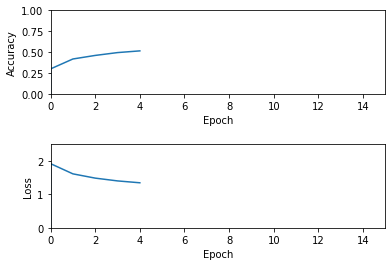

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/5a0model.ckpt Model Saved...
Epoch [125000], loss: 0.3827, acc: 1.0000
Epoch [125001], loss: 1.5049, acc: 0.0000
Epoch [125002], loss: 1.0126, acc: 1.0000
Epoch [125003], loss: 0.3818, acc: 1.0000
Epoch [125004], loss: 0.0890, acc: 1.0000
Epoch [125005], loss: 2.2523, acc: 0.0000
Epoch [125006], loss: 1.0250, acc: 1.0000
Epoch [125007], loss: 0.0615, acc: 1.0000
Epoch [125008], loss: 0.2228, acc: 1.0000
Epoch [125009], loss: 1.5221, acc: 0.0000
Epoch [125010], loss: 2.7974, acc: 0.0000
Epoch [125011], loss: 1.3037, acc: 0.0000
Epoch [125012], loss: 1.1474, acc: 0.0000
Epoch [125013], loss: 0.7374, acc: 1.0000
Epoch [125014], loss: 1.3820, acc: 1.0000
Epoch [125015], loss: 1.5676, acc: 0.0000
Epoch [125016], loss: 0.8425, acc: 1.0000
Epoch [125017], loss: 3.7046, acc: 0.0000
Epoch [125018], loss: 0.2478, acc: 1.0000
Epoch [125019], loss: 1.2686, acc: 0.0000
Epoch [125020], loss: 0.3638, acc: 1.0000
Epoch [125021],

Epoch [125205], loss: 0.3786, acc: 1.0000
Epoch [125206], loss: 1.3613, acc: 0.0000
Epoch [125207], loss: 1.0426, acc: 1.0000
Epoch [125208], loss: 0.1365, acc: 1.0000
Epoch [125209], loss: 3.0404, acc: 0.0000
Epoch [125210], loss: 0.9150, acc: 1.0000
Epoch [125211], loss: 0.5930, acc: 1.0000
Epoch [125212], loss: 0.8558, acc: 1.0000
Epoch [125213], loss: 0.6892, acc: 1.0000
Epoch [125214], loss: 0.3142, acc: 1.0000
Epoch [125215], loss: 2.3534, acc: 0.0000
Epoch [125216], loss: 0.8360, acc: 1.0000
Epoch [125217], loss: 1.2009, acc: 0.0000
Epoch [125218], loss: 1.1630, acc: 1.0000
Epoch [125219], loss: 0.7927, acc: 1.0000
Epoch [125220], loss: 0.8685, acc: 0.0000
Epoch [125221], loss: 0.7238, acc: 1.0000
Epoch [125222], loss: 0.6597, acc: 1.0000
Epoch [125223], loss: 1.8743, acc: 0.0000
Epoch [125224], loss: 2.2659, acc: 0.0000
Epoch [125225], loss: 1.8038, acc: 0.0000
Epoch [125226], loss: 1.9020, acc: 0.0000
Epoch [125227], loss: 0.1662, acc: 1.0000
Epoch [125228], loss: 1.0614, acc:

Epoch [125417], loss: 0.4243, acc: 1.0000
Epoch [125418], loss: 1.5608, acc: 0.0000
Epoch [125419], loss: 1.2032, acc: 1.0000
Epoch [125420], loss: 1.2069, acc: 0.0000
Epoch [125421], loss: 1.6538, acc: 0.0000
Epoch [125422], loss: 0.4247, acc: 1.0000
Epoch [125423], loss: 1.2885, acc: 0.0000
Epoch [125424], loss: 0.0382, acc: 1.0000
Epoch [125425], loss: 2.3407, acc: 0.0000
Epoch [125426], loss: 4.3077, acc: 0.0000
Epoch [125427], loss: 0.6221, acc: 1.0000
Epoch [125428], loss: 1.4910, acc: 0.0000
Epoch [125429], loss: 1.9476, acc: 0.0000
Epoch [125430], loss: 0.5933, acc: 1.0000
Epoch [125431], loss: 0.5403, acc: 1.0000
Epoch [125432], loss: 1.1410, acc: 0.0000
Epoch [125433], loss: 0.2634, acc: 1.0000
Epoch [125434], loss: 1.7614, acc: 0.0000
Epoch [125435], loss: 0.5714, acc: 1.0000
Epoch [125436], loss: 2.7125, acc: 0.0000
Epoch [125437], loss: 1.0855, acc: 1.0000
Epoch [125438], loss: 1.4669, acc: 0.0000
Epoch [125439], loss: 2.2175, acc: 0.0000
Epoch [125440], loss: 0.4800, acc:

Epoch [125634], loss: 0.0852, acc: 1.0000
Epoch [125635], loss: 0.1986, acc: 1.0000
Epoch [125636], loss: 0.3384, acc: 1.0000
Epoch [125637], loss: 2.7948, acc: 0.0000
Epoch [125638], loss: 1.0708, acc: 1.0000
Epoch [125639], loss: 1.0046, acc: 1.0000
Epoch [125640], loss: 0.0749, acc: 1.0000
Epoch [125641], loss: 2.5063, acc: 0.0000
Epoch [125642], loss: 0.1554, acc: 1.0000
Epoch [125643], loss: 1.2342, acc: 0.0000
Epoch [125644], loss: 1.1940, acc: 0.0000
Epoch [125645], loss: 0.2214, acc: 1.0000
Epoch [125646], loss: 0.3604, acc: 1.0000
Epoch [125647], loss: 0.1372, acc: 1.0000
Epoch [125648], loss: 2.2989, acc: 0.0000
Epoch [125649], loss: 1.6912, acc: 0.0000
Epoch [125650], loss: 2.9722, acc: 0.0000
Epoch [125651], loss: 1.2619, acc: 0.0000
Epoch [125652], loss: 0.9282, acc: 1.0000
Epoch [125653], loss: 1.0727, acc: 1.0000
Epoch [125654], loss: 0.9856, acc: 0.0000
Epoch [125655], loss: 2.5674, acc: 0.0000
Epoch [125656], loss: 0.0424, acc: 1.0000
Epoch [125657], loss: 0.0390, acc:

Epoch [125859], loss: 0.9985, acc: 0.0000
Epoch [125860], loss: 2.6346, acc: 0.0000
Epoch [125861], loss: 0.4875, acc: 1.0000
Epoch [125862], loss: 0.6448, acc: 1.0000
Epoch [125863], loss: 0.2955, acc: 1.0000
Epoch [125864], loss: 1.3053, acc: 0.0000
Epoch [125865], loss: 2.3926, acc: 0.0000
Epoch [125866], loss: 0.1132, acc: 1.0000
Epoch [125867], loss: 1.2247, acc: 0.0000
Epoch [125868], loss: 0.7700, acc: 1.0000
Epoch [125869], loss: 1.8442, acc: 0.0000
Epoch [125870], loss: 0.3451, acc: 1.0000
Epoch [125871], loss: 2.0049, acc: 0.0000
Epoch [125872], loss: 1.2922, acc: 0.0000
Epoch [125873], loss: 0.5633, acc: 1.0000
Epoch [125874], loss: 4.2481, acc: 0.0000
Epoch [125875], loss: 0.8459, acc: 1.0000
Epoch [125876], loss: 1.8299, acc: 0.0000
Epoch [125877], loss: 1.0020, acc: 1.0000
Epoch [125878], loss: 1.1657, acc: 0.0000
Epoch [125879], loss: 1.4237, acc: 0.0000
Epoch [125880], loss: 0.3805, acc: 1.0000
Epoch [125881], loss: 3.7503, acc: 0.0000
Epoch [125882], loss: 4.8338, acc:

Epoch [126056], loss: 0.6443, acc: 1.0000
Epoch [126057], loss: 0.8610, acc: 1.0000
Epoch [126058], loss: 0.8172, acc: 1.0000
Epoch [126059], loss: 0.3341, acc: 1.0000
Epoch [126060], loss: 1.0136, acc: 1.0000
Epoch [126061], loss: 2.2156, acc: 0.0000
Epoch [126062], loss: 0.4088, acc: 1.0000
Epoch [126063], loss: 0.7752, acc: 1.0000
Epoch [126064], loss: 0.8871, acc: 1.0000
Epoch [126065], loss: 4.4767, acc: 0.0000
Epoch [126066], loss: 1.6835, acc: 0.0000
Epoch [126067], loss: 0.0546, acc: 1.0000
Epoch [126068], loss: 1.7438, acc: 0.0000
Epoch [126069], loss: 1.2380, acc: 0.0000
Epoch [126070], loss: 4.7040, acc: 0.0000
Epoch [126071], loss: 0.6053, acc: 1.0000
Epoch [126072], loss: 0.4458, acc: 1.0000
Epoch [126073], loss: 0.0281, acc: 1.0000
Epoch [126074], loss: 4.4063, acc: 0.0000
Epoch [126075], loss: 0.3832, acc: 1.0000
Epoch [126076], loss: 0.8218, acc: 1.0000
Epoch [126077], loss: 0.7845, acc: 1.0000
Epoch [126078], loss: 1.1087, acc: 1.0000
Epoch [126079], loss: 2.9936, acc:

Epoch [126252], loss: 1.7011, acc: 0.0000
Epoch [126253], loss: 1.5755, acc: 0.0000
Epoch [126254], loss: 0.1667, acc: 1.0000
Epoch [126255], loss: 1.6577, acc: 0.0000
Epoch [126256], loss: 1.3012, acc: 0.0000
Epoch [126257], loss: 0.2142, acc: 1.0000
Epoch [126258], loss: 0.4758, acc: 1.0000
Epoch [126259], loss: 0.2222, acc: 1.0000
Epoch [126260], loss: 3.0561, acc: 0.0000
Epoch [126261], loss: 2.9280, acc: 0.0000
Epoch [126262], loss: 3.8785, acc: 0.0000
Epoch [126263], loss: 0.5566, acc: 1.0000
Epoch [126264], loss: 2.7835, acc: 0.0000
Epoch [126265], loss: 1.8563, acc: 0.0000
Epoch [126266], loss: 4.3734, acc: 0.0000
Epoch [126267], loss: 0.6992, acc: 1.0000
Epoch [126268], loss: 0.6646, acc: 1.0000
Epoch [126269], loss: 2.6378, acc: 0.0000
Epoch [126270], loss: 0.5141, acc: 1.0000
Epoch [126271], loss: 1.6766, acc: 0.0000
Epoch [126272], loss: 2.6490, acc: 0.0000
Epoch [126273], loss: 2.3265, acc: 0.0000
Epoch [126274], loss: 0.5496, acc: 1.0000
Epoch [126275], loss: 0.7851, acc:

Epoch [126470], loss: 0.7462, acc: 1.0000
Epoch [126471], loss: 1.9065, acc: 0.0000
Epoch [126472], loss: 0.6930, acc: 1.0000
Epoch [126473], loss: 0.4069, acc: 1.0000
Epoch [126474], loss: 2.0073, acc: 0.0000
Epoch [126475], loss: 0.2790, acc: 1.0000
Epoch [126476], loss: 1.8123, acc: 0.0000
Epoch [126477], loss: 1.2682, acc: 1.0000
Epoch [126478], loss: 0.7625, acc: 1.0000
Epoch [126479], loss: 0.1753, acc: 1.0000
Epoch [126480], loss: 0.8661, acc: 1.0000
Epoch [126481], loss: 0.7903, acc: 1.0000
Epoch [126482], loss: 3.1140, acc: 0.0000
Epoch [126483], loss: 0.9627, acc: 1.0000
Epoch [126484], loss: 0.8363, acc: 1.0000
Epoch [126485], loss: 2.1471, acc: 0.0000
Epoch [126486], loss: 1.2931, acc: 1.0000
Epoch [126487], loss: 1.2187, acc: 1.0000
Epoch [126488], loss: 0.1189, acc: 1.0000
Epoch [126489], loss: 0.8692, acc: 1.0000
Epoch [126490], loss: 0.3781, acc: 1.0000
Epoch [126491], loss: 2.3669, acc: 0.0000
Epoch [126492], loss: 0.0832, acc: 1.0000
Epoch [126493], loss: 0.9589, acc:

Epoch [126683], loss: 1.4218, acc: 0.0000
Epoch [126684], loss: 1.7985, acc: 0.0000
Epoch [126685], loss: 1.8094, acc: 0.0000
Epoch [126686], loss: 0.6879, acc: 1.0000
Epoch [126687], loss: 1.6897, acc: 0.0000
Epoch [126688], loss: 1.7027, acc: 0.0000
Epoch [126689], loss: 1.3654, acc: 0.0000
Epoch [126690], loss: 0.0144, acc: 1.0000
Epoch [126691], loss: 0.1035, acc: 1.0000
Epoch [126692], loss: 1.6388, acc: 0.0000
Epoch [126693], loss: 0.7214, acc: 1.0000
Epoch [126694], loss: 2.8016, acc: 0.0000
Epoch [126695], loss: 2.0482, acc: 0.0000
Epoch [126696], loss: 2.2049, acc: 0.0000
Epoch [126697], loss: 2.8037, acc: 0.0000
Epoch [126698], loss: 0.5404, acc: 1.0000
Epoch [126699], loss: 1.1273, acc: 0.0000
Epoch [126700], loss: 0.6982, acc: 1.0000
Epoch [126701], loss: 0.7141, acc: 0.0000
Epoch [126702], loss: 1.4850, acc: 0.0000
Epoch [126703], loss: 2.0085, acc: 0.0000
Epoch [126704], loss: 0.1334, acc: 1.0000
Epoch [126705], loss: 1.6199, acc: 0.0000
Epoch [126706], loss: 2.0919, acc:

Epoch [126894], loss: 4.4253, acc: 0.0000
Epoch [126895], loss: 0.1279, acc: 1.0000
Epoch [126896], loss: 0.6421, acc: 1.0000
Epoch [126897], loss: 1.2953, acc: 1.0000
Epoch [126898], loss: 1.6028, acc: 0.0000
Epoch [126899], loss: 0.0934, acc: 1.0000
Epoch [126900], loss: 0.5363, acc: 1.0000
Epoch [126901], loss: 0.3092, acc: 1.0000
Epoch [126902], loss: 1.8399, acc: 0.0000
Epoch [126903], loss: 1.5495, acc: 0.0000
Epoch [126904], loss: 0.9732, acc: 1.0000
Epoch [126905], loss: 2.2273, acc: 0.0000
Epoch [126906], loss: 1.3397, acc: 0.0000
Epoch [126907], loss: 1.7739, acc: 0.0000
Epoch [126908], loss: 1.0151, acc: 1.0000
Epoch [126909], loss: 0.8760, acc: 1.0000
Epoch [126910], loss: 0.5694, acc: 1.0000
Epoch [126911], loss: 3.6247, acc: 0.0000
Epoch [126912], loss: 3.1014, acc: 0.0000
Epoch [126913], loss: 2.1905, acc: 0.0000
Epoch [126914], loss: 1.2047, acc: 0.0000
Epoch [126915], loss: 0.7848, acc: 1.0000
Epoch [126916], loss: 0.0392, acc: 1.0000
Epoch [126917], loss: 0.4304, acc:

Epoch [127103], loss: 1.5473, acc: 0.0000
Epoch [127104], loss: 1.4005, acc: 0.0000
Epoch [127105], loss: 0.3816, acc: 1.0000
Epoch [127106], loss: 2.8759, acc: 0.0000
Epoch [127107], loss: 0.6631, acc: 1.0000
Epoch [127108], loss: 2.3514, acc: 0.0000
Epoch [127109], loss: 0.0444, acc: 1.0000
Epoch [127110], loss: 7.6832, acc: 0.0000
Epoch [127111], loss: 2.3528, acc: 0.0000
Epoch [127112], loss: 1.6640, acc: 0.0000
Epoch [127113], loss: 1.7537, acc: 0.0000
Epoch [127114], loss: 0.7054, acc: 1.0000
Epoch [127115], loss: 0.1268, acc: 1.0000
Epoch [127116], loss: 2.3138, acc: 0.0000
Epoch [127117], loss: 0.0406, acc: 1.0000
Epoch [127118], loss: 2.8569, acc: 0.0000
Epoch [127119], loss: 0.3811, acc: 1.0000
Epoch [127120], loss: 0.6636, acc: 1.0000
Epoch [127121], loss: 2.6471, acc: 0.0000
Epoch [127122], loss: 1.0871, acc: 0.0000
Epoch [127123], loss: 0.6884, acc: 1.0000
Epoch [127124], loss: 0.2490, acc: 1.0000
Epoch [127125], loss: 0.7680, acc: 1.0000
Epoch [127126], loss: 1.7150, acc:

Epoch [127318], loss: 0.0169, acc: 1.0000
Epoch [127319], loss: 1.5246, acc: 0.0000
Epoch [127320], loss: 2.7682, acc: 0.0000
Epoch [127321], loss: 2.7593, acc: 0.0000
Epoch [127322], loss: 2.5439, acc: 0.0000
Epoch [127323], loss: 2.4390, acc: 0.0000
Epoch [127324], loss: 0.1108, acc: 1.0000
Epoch [127325], loss: 2.4133, acc: 0.0000
Epoch [127326], loss: 3.0528, acc: 0.0000
Epoch [127327], loss: 1.6483, acc: 0.0000
Epoch [127328], loss: 0.8520, acc: 1.0000
Epoch [127329], loss: 0.5345, acc: 1.0000
Epoch [127330], loss: 2.1131, acc: 0.0000
Epoch [127331], loss: 0.8502, acc: 1.0000
Epoch [127332], loss: 0.4567, acc: 1.0000
Epoch [127333], loss: 1.1549, acc: 0.0000
Epoch [127334], loss: 0.1756, acc: 1.0000
Epoch [127335], loss: 0.7141, acc: 1.0000
Epoch [127336], loss: 1.4207, acc: 1.0000
Epoch [127337], loss: 3.7098, acc: 0.0000
Epoch [127338], loss: 1.1025, acc: 1.0000
Epoch [127339], loss: 1.2296, acc: 1.0000
Epoch [127340], loss: 1.0661, acc: 1.0000
Epoch [127341], loss: 1.5252, acc:

Epoch [127513], loss: 0.3916, acc: 1.0000
Epoch [127514], loss: 0.7087, acc: 1.0000
Epoch [127515], loss: 1.0000, acc: 0.0000
Epoch [127516], loss: 0.7479, acc: 1.0000
Epoch [127517], loss: 2.2092, acc: 0.0000
Epoch [127518], loss: 2.4422, acc: 0.0000
Epoch [127519], loss: 0.6323, acc: 1.0000
Epoch [127520], loss: 0.2156, acc: 1.0000
Epoch [127521], loss: 1.1061, acc: 1.0000
Epoch [127522], loss: 1.7491, acc: 0.0000
Epoch [127523], loss: 0.7866, acc: 1.0000
Epoch [127524], loss: 0.4486, acc: 1.0000
Epoch [127525], loss: 0.1997, acc: 1.0000
Epoch [127526], loss: 0.1893, acc: 1.0000
Epoch [127527], loss: 1.0249, acc: 1.0000
Epoch [127528], loss: 0.6104, acc: 1.0000
Epoch [127529], loss: 1.0070, acc: 1.0000
Epoch [127530], loss: 3.0185, acc: 0.0000
Epoch [127531], loss: 0.3970, acc: 1.0000
Epoch [127532], loss: 0.9999, acc: 1.0000
Epoch [127533], loss: 0.1197, acc: 1.0000
Epoch [127534], loss: 0.2794, acc: 1.0000
Epoch [127535], loss: 1.1661, acc: 0.0000
Epoch [127536], loss: 1.9296, acc:

Epoch [127709], loss: 1.1211, acc: 1.0000
Epoch [127710], loss: 1.0451, acc: 1.0000
Epoch [127711], loss: 0.5981, acc: 1.0000
Epoch [127712], loss: 0.8198, acc: 1.0000
Epoch [127713], loss: 0.3168, acc: 1.0000
Epoch [127714], loss: 1.2601, acc: 0.0000
Epoch [127715], loss: 1.9687, acc: 0.0000
Epoch [127716], loss: 2.2802, acc: 0.0000
Epoch [127717], loss: 0.2138, acc: 1.0000
Epoch [127718], loss: 0.2862, acc: 1.0000
Epoch [127719], loss: 0.5293, acc: 1.0000
Epoch [127720], loss: 0.3068, acc: 1.0000
Epoch [127721], loss: 1.8283, acc: 0.0000
Epoch [127722], loss: 1.6337, acc: 0.0000
Epoch [127723], loss: 0.4830, acc: 1.0000
Epoch [127724], loss: 0.1561, acc: 1.0000
Epoch [127725], loss: 1.5734, acc: 0.0000
Epoch [127726], loss: 0.5688, acc: 1.0000
Epoch [127727], loss: 0.8695, acc: 0.0000
Epoch [127728], loss: 0.2263, acc: 1.0000
Epoch [127729], loss: 0.0766, acc: 1.0000
Epoch [127730], loss: 1.3452, acc: 1.0000
Epoch [127731], loss: 1.1784, acc: 0.0000
Epoch [127732], loss: 0.9407, acc:

Epoch [127933], loss: 0.9294, acc: 0.0000
Epoch [127934], loss: 3.2264, acc: 0.0000
Epoch [127935], loss: 2.1752, acc: 0.0000
Epoch [127936], loss: 1.1015, acc: 1.0000
Epoch [127937], loss: 1.3106, acc: 0.0000
Epoch [127938], loss: 0.0298, acc: 1.0000
Epoch [127939], loss: 0.8595, acc: 1.0000
Epoch [127940], loss: 0.8592, acc: 1.0000
Epoch [127941], loss: 1.6864, acc: 0.0000
Epoch [127942], loss: 0.4096, acc: 1.0000
Epoch [127943], loss: 0.2044, acc: 1.0000
Epoch [127944], loss: 1.1822, acc: 1.0000
Epoch [127945], loss: 1.5292, acc: 1.0000
Epoch [127946], loss: 3.7598, acc: 0.0000
Epoch [127947], loss: 0.9016, acc: 1.0000
Epoch [127948], loss: 0.8871, acc: 1.0000
Epoch [127949], loss: 0.0700, acc: 1.0000
Epoch [127950], loss: 2.8627, acc: 0.0000
Epoch [127951], loss: 1.4291, acc: 0.0000
Epoch [127952], loss: 0.5340, acc: 1.0000
Epoch [127953], loss: 0.1782, acc: 1.0000
Epoch [127954], loss: 0.6475, acc: 1.0000
Epoch [127955], loss: 0.4828, acc: 1.0000
Epoch [127956], loss: 1.2203, acc:

Epoch [128138], loss: 0.4366, acc: 1.0000
Epoch [128139], loss: 1.0603, acc: 0.0000
Epoch [128140], loss: 4.2294, acc: 0.0000
Epoch [128141], loss: 1.9345, acc: 0.0000
Epoch [128142], loss: 1.1543, acc: 0.0000
Epoch [128143], loss: 2.3909, acc: 0.0000
Epoch [128144], loss: 0.8787, acc: 1.0000
Epoch [128145], loss: 0.6099, acc: 1.0000
Epoch [128146], loss: 0.0883, acc: 1.0000
Epoch [128147], loss: 4.3556, acc: 0.0000
Epoch [128148], loss: 0.1378, acc: 1.0000
Epoch [128149], loss: 1.1683, acc: 0.0000
Epoch [128150], loss: 1.9584, acc: 0.0000
Epoch [128151], loss: 1.6627, acc: 0.0000
Epoch [128152], loss: 0.3820, acc: 1.0000
Epoch [128153], loss: 2.6675, acc: 0.0000
Epoch [128154], loss: 0.2367, acc: 1.0000
Epoch [128155], loss: 4.6651, acc: 0.0000
Epoch [128156], loss: 0.7973, acc: 1.0000
Epoch [128157], loss: 1.2175, acc: 1.0000
Epoch [128158], loss: 0.0643, acc: 1.0000
Epoch [128159], loss: 1.7750, acc: 0.0000
Epoch [128160], loss: 1.5867, acc: 0.0000
Epoch [128161], loss: 1.5829, acc:

Epoch [128353], loss: 1.6220, acc: 0.0000
Epoch [128354], loss: 0.1347, acc: 1.0000
Epoch [128355], loss: 2.3483, acc: 0.0000
Epoch [128356], loss: 1.3969, acc: 1.0000
Epoch [128357], loss: 1.3314, acc: 0.0000
Epoch [128358], loss: 0.4983, acc: 1.0000
Epoch [128359], loss: 1.5401, acc: 0.0000
Epoch [128360], loss: 1.1085, acc: 0.0000
Epoch [128361], loss: 0.4229, acc: 1.0000
Epoch [128362], loss: 0.2537, acc: 1.0000
Epoch [128363], loss: 1.5633, acc: 0.0000
Epoch [128364], loss: 0.1720, acc: 1.0000
Epoch [128365], loss: 0.2800, acc: 1.0000
Epoch [128366], loss: 0.3807, acc: 1.0000
Epoch [128367], loss: 1.9215, acc: 0.0000
Epoch [128368], loss: 1.2369, acc: 0.0000
Epoch [128369], loss: 0.8172, acc: 1.0000
Epoch [128370], loss: 0.4129, acc: 1.0000
Epoch [128371], loss: 1.5609, acc: 0.0000
Epoch [128372], loss: 1.4910, acc: 0.0000
Epoch [128373], loss: 0.8756, acc: 1.0000
Epoch [128374], loss: 1.3006, acc: 0.0000
Epoch [128375], loss: 3.0046, acc: 0.0000
Epoch [128376], loss: 0.6349, acc:

Epoch [128568], loss: 2.4885, acc: 0.0000
Epoch [128569], loss: 1.9255, acc: 0.0000
Epoch [128570], loss: 0.2849, acc: 1.0000
Epoch [128571], loss: 1.9115, acc: 0.0000
Epoch [128572], loss: 0.1231, acc: 1.0000
Epoch [128573], loss: 1.7024, acc: 0.0000
Epoch [128574], loss: 0.2767, acc: 1.0000
Epoch [128575], loss: 0.3420, acc: 1.0000
Epoch [128576], loss: 1.1576, acc: 0.0000
Epoch [128577], loss: 1.1058, acc: 0.0000
Epoch [128578], loss: 0.6735, acc: 1.0000
Epoch [128579], loss: 0.2191, acc: 1.0000
Epoch [128580], loss: 0.8160, acc: 1.0000
Epoch [128581], loss: 0.1217, acc: 1.0000
Epoch [128582], loss: 2.9847, acc: 0.0000
Epoch [128583], loss: 0.5828, acc: 1.0000
Epoch [128584], loss: 1.0064, acc: 1.0000
Epoch [128585], loss: 0.1548, acc: 1.0000
Epoch [128586], loss: 3.3486, acc: 0.0000
Epoch [128587], loss: 1.4315, acc: 0.0000
Epoch [128588], loss: 1.5057, acc: 0.0000
Epoch [128589], loss: 0.3935, acc: 1.0000
Epoch [128590], loss: 0.1751, acc: 1.0000
Epoch [128591], loss: 0.2614, acc:

Epoch [128779], loss: 1.2136, acc: 1.0000
Epoch [128780], loss: 1.1655, acc: 1.0000
Epoch [128781], loss: 1.7517, acc: 0.0000
Epoch [128782], loss: 2.9776, acc: 0.0000
Epoch [128783], loss: 0.6523, acc: 1.0000
Epoch [128784], loss: 2.3039, acc: 0.0000
Epoch [128785], loss: 0.3088, acc: 1.0000
Epoch [128786], loss: 1.9934, acc: 0.0000
Epoch [128787], loss: 1.1261, acc: 1.0000
Epoch [128788], loss: 0.7638, acc: 1.0000
Epoch [128789], loss: 2.0067, acc: 0.0000
Epoch [128790], loss: 0.2421, acc: 1.0000
Epoch [128791], loss: 1.1301, acc: 1.0000
Epoch [128792], loss: 0.6674, acc: 1.0000
Epoch [128793], loss: 0.2380, acc: 1.0000
Epoch [128794], loss: 0.1005, acc: 1.0000
Epoch [128795], loss: 4.2625, acc: 0.0000
Epoch [128796], loss: 1.2593, acc: 1.0000
Epoch [128797], loss: 1.2870, acc: 1.0000
Epoch [128798], loss: 0.5716, acc: 1.0000
Epoch [128799], loss: 1.8942, acc: 0.0000
Epoch [128800], loss: 0.1317, acc: 1.0000
Epoch [128801], loss: 1.0173, acc: 0.0000
Epoch [128802], loss: 0.4095, acc:

Epoch [128995], loss: 1.3354, acc: 0.0000
Epoch [128996], loss: 2.1019, acc: 0.0000
Epoch [128997], loss: 0.9740, acc: 1.0000
Epoch [128998], loss: 2.7409, acc: 0.0000
Epoch [128999], loss: 0.5515, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/5a4000model.ckpt Model Saved...
Epoch [129000], loss: 0.4212, acc: 1.0000
Epoch [129001], loss: 3.4039, acc: 0.0000
Epoch [129002], loss: 2.6245, acc: 0.0000
Epoch [129003], loss: 0.1617, acc: 1.0000
Epoch [129004], loss: 1.3083, acc: 1.0000
Epoch [129005], loss: 0.9554, acc: 1.0000
Epoch [129006], loss: 1.9326, acc: 0.0000
Epoch [129007], loss: 1.4154, acc: 0.0000
Epoch [129008], loss: 1.0844, acc: 1.0000
Epoch [129009], loss: 1.8453, acc: 0.0000
Epoch [129010], loss: 2.0794, acc: 0.0000
Epoch [129011], loss: 0.2675, acc: 1.0000
Epoch [129012], loss: 3.9582, acc: 0.0000
Epoch [129013], loss: 0.5170, acc: 1.0000
Epoch [129014], loss: 0.3348, acc: 1.0000
Epoch [129015], loss: 0.3001, acc: 1.0000
Epoch [12901

Epoch [129189], loss: 0.4014, acc: 1.0000
Epoch [129190], loss: 0.5700, acc: 1.0000
Epoch [129191], loss: 0.6232, acc: 1.0000
Epoch [129192], loss: 1.3045, acc: 0.0000
Epoch [129193], loss: 0.3496, acc: 1.0000
Epoch [129194], loss: 1.2431, acc: 0.0000
Epoch [129195], loss: 1.8390, acc: 0.0000
Epoch [129196], loss: 0.3040, acc: 1.0000
Epoch [129197], loss: 2.1181, acc: 0.0000
Epoch [129198], loss: 1.0460, acc: 1.0000
Epoch [129199], loss: 0.8277, acc: 0.0000
Epoch [129200], loss: 0.8836, acc: 1.0000
Epoch [129201], loss: 0.3134, acc: 1.0000
Epoch [129202], loss: 0.2918, acc: 1.0000
Epoch [129203], loss: 0.9305, acc: 1.0000
Epoch [129204], loss: 1.3773, acc: 0.0000
Epoch [129205], loss: 0.5601, acc: 1.0000
Epoch [129206], loss: 2.2701, acc: 0.0000
Epoch [129207], loss: 1.4026, acc: 1.0000
Epoch [129208], loss: 0.6548, acc: 1.0000
Epoch [129209], loss: 0.6160, acc: 1.0000
Epoch [129210], loss: 1.3818, acc: 0.0000
Epoch [129211], loss: 1.6369, acc: 0.0000
Epoch [129212], loss: 2.9007, acc:

Epoch [129402], loss: 1.5837, acc: 0.0000
Epoch [129403], loss: 0.9162, acc: 1.0000
Epoch [129404], loss: 0.7171, acc: 1.0000
Epoch [129405], loss: 3.0926, acc: 0.0000
Epoch [129406], loss: 1.0751, acc: 0.0000
Epoch [129407], loss: 5.3833, acc: 0.0000
Epoch [129408], loss: 0.1870, acc: 1.0000
Epoch [129409], loss: 0.8337, acc: 1.0000
Epoch [129410], loss: 1.5276, acc: 0.0000
Epoch [129411], loss: 1.9751, acc: 0.0000
Epoch [129412], loss: 0.9999, acc: 0.0000
Epoch [129413], loss: 0.5351, acc: 1.0000
Epoch [129414], loss: 2.2117, acc: 0.0000
Epoch [129415], loss: 2.7306, acc: 0.0000
Epoch [129416], loss: 1.1055, acc: 0.0000
Epoch [129417], loss: 0.6827, acc: 1.0000
Epoch [129418], loss: 1.9829, acc: 0.0000
Epoch [129419], loss: 0.1496, acc: 1.0000
Epoch [129420], loss: 1.3358, acc: 0.0000
Epoch [129421], loss: 4.2553, acc: 0.0000
Epoch [129422], loss: 0.8160, acc: 1.0000
Epoch [129423], loss: 2.9683, acc: 0.0000
Epoch [129424], loss: 0.6466, acc: 1.0000
Epoch [129425], loss: 2.8008, acc:

Epoch [129608], loss: 0.0246, acc: 1.0000
Epoch [129609], loss: 0.1833, acc: 1.0000
Epoch [129610], loss: 1.4149, acc: 0.0000
Epoch [129611], loss: 0.8635, acc: 1.0000
Epoch [129612], loss: 2.9318, acc: 0.0000
Epoch [129613], loss: 0.6365, acc: 1.0000
Epoch [129614], loss: 3.7316, acc: 0.0000
Epoch [129615], loss: 5.1868, acc: 0.0000
Epoch [129616], loss: 1.3867, acc: 1.0000
Epoch [129617], loss: 0.6778, acc: 1.0000
Epoch [129618], loss: 2.1681, acc: 0.0000
Epoch [129619], loss: 1.2439, acc: 0.0000
Epoch [129620], loss: 1.3851, acc: 0.0000
Epoch [129621], loss: 0.4700, acc: 1.0000
Epoch [129622], loss: 0.8119, acc: 1.0000
Epoch [129623], loss: 4.9131, acc: 0.0000
Epoch [129624], loss: 3.3303, acc: 0.0000
Epoch [129625], loss: 0.4417, acc: 1.0000
Epoch [129626], loss: 2.1749, acc: 0.0000
Epoch [129627], loss: 0.9451, acc: 1.0000
Epoch [129628], loss: 0.7751, acc: 1.0000
Epoch [129629], loss: 2.0922, acc: 0.0000
Epoch [129630], loss: 0.9778, acc: 1.0000
Epoch [129631], loss: 0.9339, acc:

Epoch [129809], loss: 0.5132, acc: 1.0000
Epoch [129810], loss: 0.9612, acc: 1.0000
Epoch [129811], loss: 1.7941, acc: 0.0000
Epoch [129812], loss: 2.1144, acc: 0.0000
Epoch [129813], loss: 1.7112, acc: 0.0000
Epoch [129814], loss: 2.4036, acc: 0.0000
Epoch [129815], loss: 1.1929, acc: 1.0000
Epoch [129816], loss: 0.7897, acc: 0.0000
Epoch [129817], loss: 1.5438, acc: 0.0000
Epoch [129818], loss: 1.2828, acc: 0.0000
Epoch [129819], loss: 0.1429, acc: 1.0000
Epoch [129820], loss: 0.8372, acc: 0.0000
Epoch [129821], loss: 0.3973, acc: 1.0000
Epoch [129822], loss: 0.6255, acc: 1.0000
Epoch [129823], loss: 0.1556, acc: 1.0000
Epoch [129824], loss: 5.8243, acc: 0.0000
Epoch [129825], loss: 0.4712, acc: 1.0000
Epoch [129826], loss: 0.2433, acc: 1.0000
Epoch [129827], loss: 1.1880, acc: 1.0000
Epoch [129828], loss: 0.2255, acc: 1.0000
Epoch [129829], loss: 1.1669, acc: 0.0000
Epoch [129830], loss: 1.7088, acc: 0.0000
Epoch [129831], loss: 1.3371, acc: 0.0000
Epoch [129832], loss: 2.6243, acc:

Epoch [130006], loss: 2.8126, acc: 0.0000
Epoch [130007], loss: 2.7793, acc: 0.0000
Epoch [130008], loss: 1.0402, acc: 0.0000
Epoch [130009], loss: 1.6506, acc: 0.0000
Epoch [130010], loss: 0.6715, acc: 1.0000
Epoch [130011], loss: 2.0577, acc: 0.0000
Epoch [130012], loss: 1.5303, acc: 0.0000
Epoch [130013], loss: 3.2529, acc: 0.0000
Epoch [130014], loss: 0.9403, acc: 0.0000
Epoch [130015], loss: 0.5771, acc: 1.0000
Epoch [130016], loss: 0.0620, acc: 1.0000
Epoch [130017], loss: 0.5632, acc: 1.0000
Epoch [130018], loss: 1.0640, acc: 0.0000
Epoch [130019], loss: 1.3929, acc: 0.0000
Epoch [130020], loss: 3.2708, acc: 0.0000
Epoch [130021], loss: 1.0626, acc: 1.0000
Epoch [130022], loss: 3.0656, acc: 0.0000
Epoch [130023], loss: 2.0290, acc: 0.0000
Epoch [130024], loss: 1.0575, acc: 1.0000
Epoch [130025], loss: 1.0512, acc: 1.0000
Epoch [130026], loss: 1.4820, acc: 0.0000
Epoch [130027], loss: 1.1650, acc: 1.0000
Epoch [130028], loss: 1.8534, acc: 0.0000
Epoch [130029], loss: 3.7668, acc:

Epoch [130207], loss: 0.5648, acc: 1.0000
Epoch [130208], loss: 0.5274, acc: 1.0000
Epoch [130209], loss: 2.0636, acc: 0.0000
Epoch [130210], loss: 1.1451, acc: 0.0000
Epoch [130211], loss: 0.4534, acc: 1.0000
Epoch [130212], loss: 4.0186, acc: 0.0000
Epoch [130213], loss: 0.2427, acc: 1.0000
Epoch [130214], loss: 2.1481, acc: 0.0000
Epoch [130215], loss: 1.2067, acc: 1.0000
Epoch [130216], loss: 0.9053, acc: 1.0000
Epoch [130217], loss: 0.3917, acc: 1.0000
Epoch [130218], loss: 0.2306, acc: 1.0000
Epoch [130219], loss: 2.7730, acc: 0.0000
Epoch [130220], loss: 1.3167, acc: 0.0000
Epoch [130221], loss: 2.0014, acc: 0.0000
Epoch [130222], loss: 0.2998, acc: 1.0000
Epoch [130223], loss: 0.6222, acc: 1.0000
Epoch [130224], loss: 0.7973, acc: 0.0000
Epoch [130225], loss: 1.2180, acc: 0.0000
Epoch [130226], loss: 1.6191, acc: 0.0000
Epoch [130227], loss: 0.7167, acc: 1.0000
Epoch [130228], loss: 0.3037, acc: 1.0000
Epoch [130229], loss: 1.1823, acc: 1.0000
Epoch [130230], loss: 0.0927, acc:

Epoch [130409], loss: 0.4492, acc: 1.0000
Epoch [130410], loss: 1.7940, acc: 0.0000
Epoch [130411], loss: 0.1347, acc: 1.0000
Epoch [130412], loss: 1.9188, acc: 0.0000
Epoch [130413], loss: 2.0108, acc: 0.0000
Epoch [130414], loss: 0.4944, acc: 1.0000
Epoch [130415], loss: 3.6590, acc: 0.0000
Epoch [130416], loss: 0.3106, acc: 1.0000
Epoch [130417], loss: 1.9183, acc: 0.0000
Epoch [130418], loss: 0.7569, acc: 1.0000
Epoch [130419], loss: 0.7717, acc: 1.0000
Epoch [130420], loss: 0.7103, acc: 1.0000
Epoch [130421], loss: 0.1330, acc: 1.0000
Epoch [130422], loss: 0.8276, acc: 1.0000
Epoch [130423], loss: 0.5796, acc: 1.0000
Epoch [130424], loss: 1.8012, acc: 0.0000
Epoch [130425], loss: 1.7852, acc: 0.0000
Epoch [130426], loss: 1.5502, acc: 0.0000
Epoch [130427], loss: 0.4708, acc: 1.0000
Epoch [130428], loss: 0.6169, acc: 1.0000
Epoch [130429], loss: 2.5030, acc: 0.0000
Epoch [130430], loss: 1.7511, acc: 0.0000
Epoch [130431], loss: 0.1777, acc: 1.0000
Epoch [130432], loss: 0.1913, acc:

Epoch [130618], loss: 2.5725, acc: 0.0000
Epoch [130619], loss: 2.1089, acc: 0.0000
Epoch [130620], loss: 0.2073, acc: 1.0000
Epoch [130621], loss: 2.0081, acc: 0.0000
Epoch [130622], loss: 0.7055, acc: 1.0000
Epoch [130623], loss: 0.5551, acc: 1.0000
Epoch [130624], loss: 1.2561, acc: 1.0000
Epoch [130625], loss: 0.1262, acc: 1.0000
Epoch [130626], loss: 1.6096, acc: 1.0000
Epoch [130627], loss: 2.0343, acc: 0.0000
Epoch [130628], loss: 1.0613, acc: 0.0000
Epoch [130629], loss: 0.7318, acc: 1.0000
Epoch [130630], loss: 0.0372, acc: 1.0000
Epoch [130631], loss: 0.6306, acc: 1.0000
Epoch [130632], loss: 1.6747, acc: 0.0000
Epoch [130633], loss: 0.6981, acc: 1.0000
Epoch [130634], loss: 1.3193, acc: 0.0000
Epoch [130635], loss: 2.2703, acc: 0.0000
Epoch [130636], loss: 0.8953, acc: 1.0000
Epoch [130637], loss: 1.4603, acc: 0.0000
Epoch [130638], loss: 1.9776, acc: 0.0000
Epoch [130639], loss: 0.7157, acc: 1.0000
Epoch [130640], loss: 0.8322, acc: 1.0000
Epoch [130641], loss: 1.0012, acc:

Epoch [130818], loss: 0.9303, acc: 1.0000
Epoch [130819], loss: 0.2661, acc: 1.0000
Epoch [130820], loss: 0.6419, acc: 1.0000
Epoch [130821], loss: 3.7456, acc: 0.0000
Epoch [130822], loss: 0.4092, acc: 1.0000
Epoch [130823], loss: 1.3125, acc: 0.0000
Epoch [130824], loss: 0.7137, acc: 1.0000
Epoch [130825], loss: 0.5415, acc: 1.0000
Epoch [130826], loss: 0.4456, acc: 1.0000
Epoch [130827], loss: 1.0627, acc: 1.0000
Epoch [130828], loss: 0.5116, acc: 1.0000
Epoch [130829], loss: 0.1434, acc: 1.0000
Epoch [130830], loss: 0.3303, acc: 1.0000
Epoch [130831], loss: 1.6137, acc: 0.0000
Epoch [130832], loss: 0.4463, acc: 1.0000
Epoch [130833], loss: 3.5979, acc: 0.0000
Epoch [130834], loss: 1.2303, acc: 0.0000
Epoch [130835], loss: 0.1754, acc: 1.0000
Epoch [130836], loss: 1.4334, acc: 0.0000
Epoch [130837], loss: 1.4257, acc: 0.0000
Epoch [130838], loss: 1.5508, acc: 0.0000
Epoch [130839], loss: 0.7015, acc: 1.0000
Epoch [130840], loss: 1.9251, acc: 0.0000
Epoch [130841], loss: 0.2230, acc:

Epoch [131038], loss: 1.5961, acc: 0.0000
Epoch [131039], loss: 1.0868, acc: 1.0000
Epoch [131040], loss: 2.9840, acc: 0.0000
Epoch [131041], loss: 1.2608, acc: 0.0000
Epoch [131042], loss: 0.5555, acc: 1.0000
Epoch [131043], loss: 1.0924, acc: 1.0000
Epoch [131044], loss: 0.7733, acc: 1.0000
Epoch [131045], loss: 0.8550, acc: 1.0000
Epoch [131046], loss: 0.8584, acc: 1.0000
Epoch [131047], loss: 0.1233, acc: 1.0000
Epoch [131048], loss: 0.1030, acc: 1.0000
Epoch [131049], loss: 0.4040, acc: 1.0000
Epoch [131050], loss: 0.6015, acc: 1.0000
Epoch [131051], loss: 0.3631, acc: 1.0000
Epoch [131052], loss: 1.0877, acc: 1.0000
Epoch [131053], loss: 0.1664, acc: 1.0000
Epoch [131054], loss: 2.0268, acc: 0.0000
Epoch [131055], loss: 0.6230, acc: 1.0000
Epoch [131056], loss: 0.4204, acc: 1.0000
Epoch [131057], loss: 0.7128, acc: 1.0000
Epoch [131058], loss: 1.2015, acc: 0.0000
Epoch [131059], loss: 0.6129, acc: 1.0000
Epoch [131060], loss: 1.7520, acc: 0.0000
Epoch [131061], loss: 1.2894, acc:

Epoch [131257], loss: 2.5936, acc: 0.0000
Epoch [131258], loss: 3.2073, acc: 0.0000
Epoch [131259], loss: 1.5034, acc: 0.0000
Epoch [131260], loss: 0.0697, acc: 1.0000
Epoch [131261], loss: 3.3978, acc: 0.0000
Epoch [131262], loss: 2.6737, acc: 0.0000
Epoch [131263], loss: 0.6297, acc: 1.0000
Epoch [131264], loss: 1.9697, acc: 0.0000
Epoch [131265], loss: 0.4531, acc: 1.0000
Epoch [131266], loss: 0.7015, acc: 1.0000
Epoch [131267], loss: 0.5021, acc: 1.0000
Epoch [131268], loss: 0.4163, acc: 1.0000
Epoch [131269], loss: 1.0276, acc: 1.0000
Epoch [131270], loss: 0.8704, acc: 1.0000
Epoch [131271], loss: 1.4751, acc: 0.0000
Epoch [131272], loss: 0.4984, acc: 1.0000
Epoch [131273], loss: 0.7153, acc: 1.0000
Epoch [131274], loss: 0.1595, acc: 1.0000
Epoch [131275], loss: 2.1114, acc: 0.0000
Epoch [131276], loss: 0.7819, acc: 0.0000
Epoch [131277], loss: 1.1281, acc: 1.0000
Epoch [131278], loss: 2.0262, acc: 0.0000
Epoch [131279], loss: 1.5625, acc: 0.0000
Epoch [131280], loss: 1.4580, acc:

Epoch [131474], loss: 1.1025, acc: 1.0000
Epoch [131475], loss: 0.2663, acc: 1.0000
Epoch [131476], loss: 1.5104, acc: 0.0000
Epoch [131477], loss: 0.4659, acc: 1.0000
Epoch [131478], loss: 0.7346, acc: 1.0000
Epoch [131479], loss: 0.9807, acc: 1.0000
Epoch [131480], loss: 0.9359, acc: 0.0000
Epoch [131481], loss: 2.5473, acc: 0.0000
Epoch [131482], loss: 2.4262, acc: 0.0000
Epoch [131483], loss: 0.8856, acc: 1.0000
Epoch [131484], loss: 0.1751, acc: 1.0000
Epoch [131485], loss: 0.0598, acc: 1.0000
Epoch [131486], loss: 1.6307, acc: 0.0000
Epoch [131487], loss: 4.2910, acc: 0.0000
Epoch [131488], loss: 2.0302, acc: 0.0000
Epoch [131489], loss: 2.7167, acc: 0.0000
Epoch [131490], loss: 0.2049, acc: 1.0000
Epoch [131491], loss: 2.7798, acc: 0.0000
Epoch [131492], loss: 1.4030, acc: 0.0000
Epoch [131493], loss: 1.8999, acc: 0.0000
Epoch [131494], loss: 1.0808, acc: 0.0000
Epoch [131495], loss: 1.1082, acc: 1.0000
Epoch [131496], loss: 0.9706, acc: 1.0000
Epoch [131497], loss: 0.0694, acc:

Epoch [131675], loss: 1.5680, acc: 0.0000
Epoch [131676], loss: 1.1096, acc: 1.0000
Epoch [131677], loss: 4.2494, acc: 0.0000
Epoch [131678], loss: 1.0740, acc: 1.0000
Epoch [131679], loss: 0.0713, acc: 1.0000
Epoch [131680], loss: 1.9442, acc: 0.0000
Epoch [131681], loss: 2.4076, acc: 0.0000
Epoch [131682], loss: 1.8903, acc: 0.0000
Epoch [131683], loss: 0.4312, acc: 1.0000
Epoch [131684], loss: 1.3822, acc: 0.0000
Epoch [131685], loss: 1.7191, acc: 0.0000
Epoch [131686], loss: 3.0145, acc: 0.0000
Epoch [131687], loss: 0.3820, acc: 1.0000
Epoch [131688], loss: 0.7032, acc: 1.0000
Epoch [131689], loss: 0.1938, acc: 1.0000
Epoch [131690], loss: 1.0532, acc: 0.0000
Epoch [131691], loss: 1.4035, acc: 1.0000
Epoch [131692], loss: 1.3129, acc: 1.0000
Epoch [131693], loss: 0.5946, acc: 1.0000
Epoch [131694], loss: 1.5105, acc: 0.0000
Epoch [131695], loss: 0.2589, acc: 1.0000
Epoch [131696], loss: 0.0895, acc: 1.0000
Epoch [131697], loss: 4.5626, acc: 0.0000
Epoch [131698], loss: 1.6095, acc:

Epoch [131889], loss: 0.4822, acc: 1.0000
Epoch [131890], loss: 1.2346, acc: 0.0000
Epoch [131891], loss: 0.1426, acc: 1.0000
Epoch [131892], loss: 0.3458, acc: 1.0000
Epoch [131893], loss: 0.1478, acc: 1.0000
Epoch [131894], loss: 2.2836, acc: 0.0000
Epoch [131895], loss: 0.1571, acc: 1.0000
Epoch [131896], loss: 0.4135, acc: 1.0000
Epoch [131897], loss: 2.7965, acc: 0.0000
Epoch [131898], loss: 1.2746, acc: 0.0000
Epoch [131899], loss: 2.1063, acc: 0.0000
Epoch [131900], loss: 0.8058, acc: 0.0000
Epoch [131901], loss: 0.9204, acc: 1.0000
Epoch [131902], loss: 0.7202, acc: 1.0000
Epoch [131903], loss: 0.0345, acc: 1.0000
Epoch [131904], loss: 0.5672, acc: 1.0000
Epoch [131905], loss: 4.1765, acc: 0.0000
Epoch [131906], loss: 1.7845, acc: 0.0000
Epoch [131907], loss: 0.7376, acc: 1.0000
Epoch [131908], loss: 0.7417, acc: 1.0000
Epoch [131909], loss: 0.2787, acc: 1.0000
Epoch [131910], loss: 0.0545, acc: 1.0000
Epoch [131911], loss: 1.1868, acc: 1.0000
Epoch [131912], loss: 2.6042, acc:

Epoch [132093], loss: 0.5767, acc: 1.0000
Epoch [132094], loss: 1.1102, acc: 1.0000
Epoch [132095], loss: 3.0439, acc: 0.0000
Epoch [132096], loss: 1.9635, acc: 0.0000
Epoch [132097], loss: 1.1004, acc: 1.0000
Epoch [132098], loss: 0.7559, acc: 1.0000
Epoch [132099], loss: 3.0158, acc: 0.0000
Epoch [132100], loss: 1.0789, acc: 0.0000
Epoch [132101], loss: 3.9341, acc: 0.0000
Epoch [132102], loss: 0.1855, acc: 1.0000
Epoch [132103], loss: 0.2624, acc: 1.0000
Epoch [132104], loss: 1.0523, acc: 1.0000
Epoch [132105], loss: 1.5217, acc: 0.0000
Epoch [132106], loss: 0.1109, acc: 1.0000
Epoch [132107], loss: 1.7281, acc: 0.0000
Epoch [132108], loss: 2.6841, acc: 0.0000
Epoch [132109], loss: 0.7387, acc: 1.0000
Epoch [132110], loss: 1.6975, acc: 0.0000
Epoch [132111], loss: 2.8446, acc: 0.0000
Epoch [132112], loss: 2.1056, acc: 0.0000
Epoch [132113], loss: 1.4792, acc: 0.0000
Epoch [132114], loss: 0.3835, acc: 1.0000
Epoch [132115], loss: 0.2215, acc: 1.0000
Epoch [132116], loss: 1.3340, acc:

Epoch [132309], loss: 0.3328, acc: 1.0000
Epoch [132310], loss: 0.1574, acc: 1.0000
Epoch [132311], loss: 1.0642, acc: 1.0000
Epoch [132312], loss: 1.8640, acc: 0.0000
Epoch [132313], loss: 1.6981, acc: 0.0000
Epoch [132314], loss: 0.3438, acc: 1.0000
Epoch [132315], loss: 0.4735, acc: 1.0000
Epoch [132316], loss: 2.7451, acc: 0.0000
Epoch [132317], loss: 1.0795, acc: 1.0000
Epoch [132318], loss: 1.7412, acc: 0.0000
Epoch [132319], loss: 0.8413, acc: 1.0000
Epoch [132320], loss: 0.7864, acc: 1.0000
Epoch [132321], loss: 0.9443, acc: 0.0000
Epoch [132322], loss: 0.6076, acc: 1.0000
Epoch [132323], loss: 3.3414, acc: 0.0000
Epoch [132324], loss: 2.8540, acc: 0.0000
Epoch [132325], loss: 1.2571, acc: 0.0000
Epoch [132326], loss: 1.6487, acc: 0.0000
Epoch [132327], loss: 1.0479, acc: 1.0000
Epoch [132328], loss: 1.4821, acc: 0.0000
Epoch [132329], loss: 0.8485, acc: 1.0000
Epoch [132330], loss: 3.3303, acc: 0.0000
Epoch [132331], loss: 0.4376, acc: 1.0000
Epoch [132332], loss: 2.6959, acc:

Epoch [132510], loss: 3.3868, acc: 0.0000
Epoch [132511], loss: 1.9675, acc: 0.0000
Epoch [132512], loss: 1.7766, acc: 0.0000
Epoch [132513], loss: 0.8184, acc: 1.0000
Epoch [132514], loss: 0.4378, acc: 1.0000
Epoch [132515], loss: 1.7772, acc: 0.0000
Epoch [132516], loss: 0.8325, acc: 1.0000
Epoch [132517], loss: 0.5856, acc: 1.0000
Epoch [132518], loss: 0.7404, acc: 1.0000
Epoch [132519], loss: 1.9464, acc: 0.0000
Epoch [132520], loss: 0.6445, acc: 1.0000
Epoch [132521], loss: 0.9081, acc: 1.0000
Epoch [132522], loss: 2.7766, acc: 0.0000
Epoch [132523], loss: 2.9350, acc: 0.0000
Epoch [132524], loss: 0.3750, acc: 1.0000
Epoch [132525], loss: 1.0007, acc: 1.0000
Epoch [132526], loss: 1.4949, acc: 0.0000
Epoch [132527], loss: 0.3806, acc: 1.0000
Epoch [132528], loss: 0.0360, acc: 1.0000
Epoch [132529], loss: 1.7269, acc: 0.0000
Epoch [132530], loss: 2.0095, acc: 0.0000
Epoch [132531], loss: 0.4158, acc: 1.0000
Epoch [132532], loss: 0.8502, acc: 1.0000
Epoch [132533], loss: 0.7603, acc:

Epoch [132720], loss: 0.2013, acc: 1.0000
Epoch [132721], loss: 0.7248, acc: 0.0000
Epoch [132722], loss: 0.3263, acc: 1.0000
Epoch [132723], loss: 0.8682, acc: 1.0000
Epoch [132724], loss: 1.7012, acc: 0.0000
Epoch [132725], loss: 2.6994, acc: 0.0000
Epoch [132726], loss: 2.1255, acc: 0.0000
Epoch [132727], loss: 0.0859, acc: 1.0000
Epoch [132728], loss: 0.5437, acc: 1.0000
Epoch [132729], loss: 1.9699, acc: 0.0000
Epoch [132730], loss: 1.0343, acc: 1.0000
Epoch [132731], loss: 1.4454, acc: 0.0000
Epoch [132732], loss: 0.3282, acc: 1.0000
Epoch [132733], loss: 1.8801, acc: 0.0000
Epoch [132734], loss: 1.5132, acc: 0.0000
Epoch [132735], loss: 0.3397, acc: 1.0000
Epoch [132736], loss: 0.2342, acc: 1.0000
Epoch [132737], loss: 1.1548, acc: 0.0000
Epoch [132738], loss: 1.0415, acc: 0.0000
Epoch [132739], loss: 3.9585, acc: 0.0000
Epoch [132740], loss: 1.6944, acc: 0.0000
Epoch [132741], loss: 1.4569, acc: 1.0000
Epoch [132742], loss: 2.2305, acc: 0.0000
Epoch [132743], loss: 0.7647, acc:

Epoch [132919], loss: 1.4971, acc: 0.0000
Epoch [132920], loss: 1.3752, acc: 1.0000
Epoch [132921], loss: 1.4142, acc: 0.0000
Epoch [132922], loss: 2.9376, acc: 0.0000
Epoch [132923], loss: 1.6705, acc: 0.0000
Epoch [132924], loss: 2.1809, acc: 0.0000
Epoch [132925], loss: 0.4902, acc: 1.0000
Epoch [132926], loss: 0.3159, acc: 1.0000
Epoch [132927], loss: 3.1488, acc: 0.0000
Epoch [132928], loss: 1.3418, acc: 0.0000
Epoch [132929], loss: 0.4385, acc: 1.0000
Epoch [132930], loss: 0.5195, acc: 1.0000
Epoch [132931], loss: 1.3894, acc: 0.0000
Epoch [132932], loss: 0.8206, acc: 1.0000
Epoch [132933], loss: 1.7797, acc: 0.0000
Epoch [132934], loss: 1.8068, acc: 0.0000
Epoch [132935], loss: 0.9976, acc: 1.0000
Epoch [132936], loss: 0.8240, acc: 1.0000
Epoch [132937], loss: 1.2130, acc: 1.0000
Epoch [132938], loss: 3.5261, acc: 0.0000
Epoch [132939], loss: 4.6023, acc: 0.0000
Epoch [132940], loss: 0.2199, acc: 1.0000
Epoch [132941], loss: 0.2711, acc: 1.0000
Epoch [132942], loss: 1.5217, acc:

Epoch [133130], loss: 2.1382, acc: 0.0000
Epoch [133131], loss: 0.3420, acc: 1.0000
Epoch [133132], loss: 0.2996, acc: 1.0000
Epoch [133133], loss: 0.7166, acc: 1.0000
Epoch [133134], loss: 1.5449, acc: 0.0000
Epoch [133135], loss: 1.3064, acc: 0.0000
Epoch [133136], loss: 1.8944, acc: 0.0000
Epoch [133137], loss: 0.2414, acc: 1.0000
Epoch [133138], loss: 0.7273, acc: 1.0000
Epoch [133139], loss: 3.8813, acc: 0.0000
Epoch [133140], loss: 4.8950, acc: 0.0000
Epoch [133141], loss: 0.1497, acc: 1.0000
Epoch [133142], loss: 1.5429, acc: 0.0000
Epoch [133143], loss: 0.4231, acc: 1.0000
Epoch [133144], loss: 0.8663, acc: 1.0000
Epoch [133145], loss: 2.5535, acc: 0.0000
Epoch [133146], loss: 1.0120, acc: 1.0000
Epoch [133147], loss: 1.1092, acc: 1.0000
Epoch [133148], loss: 1.9339, acc: 0.0000
Epoch [133149], loss: 1.0953, acc: 0.0000
Epoch [133150], loss: 2.0908, acc: 0.0000
Epoch [133151], loss: 0.5680, acc: 1.0000
Epoch [133152], loss: 0.7409, acc: 1.0000
Epoch [133153], loss: 1.4430, acc:

Epoch [133340], loss: 4.1931, acc: 0.0000
Epoch [133341], loss: 0.6074, acc: 1.0000
Epoch [133342], loss: 0.2836, acc: 1.0000
Epoch [133343], loss: 1.8677, acc: 0.0000
Epoch [133344], loss: 1.0378, acc: 1.0000
Epoch [133345], loss: 1.3523, acc: 0.0000
Epoch [133346], loss: 0.1091, acc: 1.0000
Epoch [133347], loss: 0.2879, acc: 1.0000
Epoch [133348], loss: 1.1385, acc: 0.0000
Epoch [133349], loss: 0.2498, acc: 1.0000
Epoch [133350], loss: 0.9106, acc: 0.0000
Epoch [133351], loss: 0.0163, acc: 1.0000
Epoch [133352], loss: 0.0897, acc: 1.0000
Epoch [133353], loss: 0.3142, acc: 1.0000
Epoch [133354], loss: 0.4728, acc: 1.0000
Epoch [133355], loss: 1.0518, acc: 0.0000
Epoch [133356], loss: 1.4647, acc: 0.0000
Epoch [133357], loss: 0.1557, acc: 1.0000
Epoch [133358], loss: 0.3241, acc: 1.0000
Epoch [133359], loss: 1.0332, acc: 1.0000
Epoch [133360], loss: 2.1571, acc: 0.0000
Epoch [133361], loss: 5.3051, acc: 0.0000
Epoch [133362], loss: 1.6668, acc: 0.0000
Epoch [133363], loss: 0.4865, acc:

Epoch [133541], loss: 1.0738, acc: 1.0000
Epoch [133542], loss: 1.3616, acc: 0.0000
Epoch [133543], loss: 1.4104, acc: 0.0000
Epoch [133544], loss: 1.5993, acc: 0.0000
Epoch [133545], loss: 0.7801, acc: 1.0000
Epoch [133546], loss: 3.9727, acc: 0.0000
Epoch [133547], loss: 0.6839, acc: 1.0000
Epoch [133548], loss: 0.4709, acc: 1.0000
Epoch [133549], loss: 1.3351, acc: 0.0000
Epoch [133550], loss: 2.2191, acc: 0.0000
Epoch [133551], loss: 0.6334, acc: 1.0000
Epoch [133552], loss: 1.6557, acc: 0.0000
Epoch [133553], loss: 1.1973, acc: 1.0000
Epoch [133554], loss: 0.8497, acc: 1.0000
Epoch [133555], loss: 0.3823, acc: 1.0000
Epoch [133556], loss: 0.1072, acc: 1.0000
Epoch [133557], loss: 0.4022, acc: 1.0000
Epoch [133558], loss: 0.5189, acc: 1.0000
Epoch [133559], loss: 2.9624, acc: 0.0000
Epoch [133560], loss: 1.7298, acc: 0.0000
Epoch [133561], loss: 4.1332, acc: 0.0000
Epoch [133562], loss: 1.8146, acc: 0.0000
Epoch [133563], loss: 0.4050, acc: 1.0000
Epoch [133564], loss: 0.8230, acc:

Epoch [133750], loss: 1.9427, acc: 0.0000
Epoch [133751], loss: 0.6552, acc: 1.0000
Epoch [133752], loss: 2.1104, acc: 0.0000
Epoch [133753], loss: 0.9922, acc: 1.0000
Epoch [133754], loss: 2.8984, acc: 0.0000
Epoch [133755], loss: 0.7177, acc: 1.0000
Epoch [133756], loss: 1.5239, acc: 0.0000
Epoch [133757], loss: 0.7672, acc: 1.0000
Epoch [133758], loss: 1.0615, acc: 1.0000
Epoch [133759], loss: 5.5877, acc: 0.0000
Epoch [133760], loss: 0.2536, acc: 1.0000
Epoch [133761], loss: 0.3565, acc: 1.0000
Epoch [133762], loss: 1.4395, acc: 0.0000
Epoch [133763], loss: 1.6437, acc: 0.0000
Epoch [133764], loss: 0.1535, acc: 1.0000
Epoch [133765], loss: 1.7350, acc: 0.0000
Epoch [133766], loss: 0.9900, acc: 1.0000
Epoch [133767], loss: 1.3197, acc: 0.0000
Epoch [133768], loss: 0.6229, acc: 1.0000
Epoch [133769], loss: 4.0343, acc: 0.0000
Epoch [133770], loss: 0.6932, acc: 1.0000
Epoch [133771], loss: 1.2788, acc: 0.0000
Epoch [133772], loss: 4.2743, acc: 0.0000
Epoch [133773], loss: 0.7362, acc:

Epoch [133953], loss: 1.4374, acc: 0.0000
Epoch [133954], loss: 0.6886, acc: 1.0000
Epoch [133955], loss: 1.5740, acc: 0.0000
Epoch [133956], loss: 0.8005, acc: 1.0000
Epoch [133957], loss: 2.0411, acc: 0.0000
Epoch [133958], loss: 0.4881, acc: 1.0000
Epoch [133959], loss: 0.2006, acc: 1.0000
Epoch [133960], loss: 0.0524, acc: 1.0000
Epoch [133961], loss: 0.2718, acc: 1.0000
Epoch [133962], loss: 3.3075, acc: 0.0000
Epoch [133963], loss: 0.1572, acc: 1.0000
Epoch [133964], loss: 0.3877, acc: 1.0000
Epoch [133965], loss: 0.7373, acc: 1.0000
Epoch [133966], loss: 0.0297, acc: 1.0000
Epoch [133967], loss: 0.0200, acc: 1.0000
Epoch [133968], loss: 1.2190, acc: 0.0000
Epoch [133969], loss: 2.4388, acc: 0.0000
Epoch [133970], loss: 1.4793, acc: 0.0000
Epoch [133971], loss: 3.9194, acc: 0.0000
Epoch [133972], loss: 1.0312, acc: 0.0000
Epoch [133973], loss: 0.3110, acc: 1.0000
Epoch [133974], loss: 0.0387, acc: 1.0000
Epoch [133975], loss: 1.0058, acc: 1.0000
Epoch [133976], loss: 2.1671, acc:

Epoch [134166], loss: 2.6152, acc: 0.0000
Epoch [134167], loss: 0.0955, acc: 1.0000
Epoch [134168], loss: 0.5226, acc: 1.0000
Epoch [134169], loss: 1.0167, acc: 0.0000
Epoch [134170], loss: 1.3584, acc: 0.0000
Epoch [134171], loss: 0.4702, acc: 1.0000
Epoch [134172], loss: 0.1041, acc: 1.0000
Epoch [134173], loss: 0.3150, acc: 1.0000
Epoch [134174], loss: 0.6516, acc: 1.0000
Epoch [134175], loss: 0.5695, acc: 1.0000
Epoch [134176], loss: 0.2771, acc: 1.0000
Epoch [134177], loss: 2.1401, acc: 0.0000
Epoch [134178], loss: 1.7770, acc: 0.0000
Epoch [134179], loss: 0.8867, acc: 1.0000
Epoch [134180], loss: 1.6874, acc: 0.0000
Epoch [134181], loss: 1.1140, acc: 0.0000
Epoch [134182], loss: 0.4134, acc: 1.0000
Epoch [134183], loss: 0.8961, acc: 1.0000
Epoch [134184], loss: 2.1547, acc: 0.0000
Epoch [134185], loss: 0.4343, acc: 1.0000
Epoch [134186], loss: 0.3268, acc: 1.0000
Epoch [134187], loss: 0.9961, acc: 0.0000
Epoch [134188], loss: 1.0585, acc: 0.0000
Epoch [134189], loss: 1.7257, acc:

Epoch [134384], loss: 0.9512, acc: 1.0000
Epoch [134385], loss: 1.3122, acc: 1.0000
Epoch [134386], loss: 1.3062, acc: 0.0000
Epoch [134387], loss: 0.3806, acc: 1.0000
Epoch [134388], loss: 1.0502, acc: 0.0000
Epoch [134389], loss: 1.2794, acc: 0.0000
Epoch [134390], loss: 0.7805, acc: 1.0000
Epoch [134391], loss: 0.1677, acc: 1.0000
Epoch [134392], loss: 2.3513, acc: 0.0000
Epoch [134393], loss: 1.3377, acc: 1.0000
Epoch [134394], loss: 0.2145, acc: 1.0000
Epoch [134395], loss: 0.7724, acc: 1.0000
Epoch [134396], loss: 0.3182, acc: 1.0000
Epoch [134397], loss: 0.8115, acc: 1.0000
Epoch [134398], loss: 0.1905, acc: 1.0000
Epoch [134399], loss: 0.7324, acc: 1.0000
Epoch [134400], loss: 0.1564, acc: 1.0000
Epoch [134401], loss: 0.8123, acc: 1.0000
Epoch [134402], loss: 1.1035, acc: 1.0000
Epoch [134403], loss: 1.7988, acc: 0.0000
Epoch [134404], loss: 0.2379, acc: 1.0000
Epoch [134405], loss: 0.3754, acc: 1.0000
Epoch [134406], loss: 2.0595, acc: 0.0000
Epoch [134407], loss: 0.0508, acc:

Epoch [134583], loss: 1.8685, acc: 0.0000
Epoch [134584], loss: 1.8771, acc: 0.0000
Epoch [134585], loss: 0.7642, acc: 1.0000
Epoch [134586], loss: 1.1700, acc: 1.0000
Epoch [134587], loss: 0.9768, acc: 1.0000
Epoch [134588], loss: 0.9260, acc: 0.0000
Epoch [134589], loss: 2.9380, acc: 0.0000
Epoch [134590], loss: 1.2656, acc: 1.0000
Epoch [134591], loss: 1.2242, acc: 1.0000
Epoch [134592], loss: 0.5685, acc: 1.0000
Epoch [134593], loss: 0.3222, acc: 1.0000
Epoch [134594], loss: 0.2854, acc: 1.0000
Epoch [134595], loss: 0.9045, acc: 1.0000
Epoch [134596], loss: 0.1233, acc: 1.0000
Epoch [134597], loss: 1.5086, acc: 0.0000
Epoch [134598], loss: 1.6628, acc: 0.0000
Epoch [134599], loss: 1.9850, acc: 0.0000
Epoch [134600], loss: 0.2607, acc: 1.0000
Epoch [134601], loss: 0.4839, acc: 1.0000
Epoch [134602], loss: 0.1737, acc: 1.0000
Epoch [134603], loss: 1.1062, acc: 1.0000
Epoch [134604], loss: 1.1487, acc: 0.0000
Epoch [134605], loss: 0.6402, acc: 1.0000
Epoch [134606], loss: 3.1020, acc:

Epoch [134787], loss: 1.4727, acc: 0.0000
Epoch [134788], loss: 1.9128, acc: 0.0000
Epoch [134789], loss: 1.9247, acc: 0.0000
Epoch [134790], loss: 0.7328, acc: 1.0000
Epoch [134791], loss: 0.2309, acc: 1.0000
Epoch [134792], loss: 1.3159, acc: 1.0000
Epoch [134793], loss: 2.2712, acc: 0.0000
Epoch [134794], loss: 3.3506, acc: 0.0000
Epoch [134795], loss: 0.5539, acc: 1.0000
Epoch [134796], loss: 1.0153, acc: 1.0000
Epoch [134797], loss: 0.4077, acc: 1.0000
Epoch [134798], loss: 1.2375, acc: 1.0000
Epoch [134799], loss: 1.3430, acc: 1.0000
Epoch [134800], loss: 3.4480, acc: 0.0000
Epoch [134801], loss: 0.3580, acc: 1.0000
Epoch [134802], loss: 1.2642, acc: 1.0000
Epoch [134803], loss: 0.0795, acc: 1.0000
Epoch [134804], loss: 1.3099, acc: 0.0000
Epoch [134805], loss: 1.6241, acc: 0.0000
Epoch [134806], loss: 2.2135, acc: 0.0000
Epoch [134807], loss: 1.6467, acc: 0.0000
Epoch [134808], loss: 0.0221, acc: 1.0000
Epoch [134809], loss: 3.5627, acc: 0.0000
Epoch [134810], loss: 0.1006, acc:

Epoch [134999], loss: 2.2141, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/5a10000model.ckpt Model Saved...
Epoch [135000], loss: 0.8969, acc: 1.0000
Epoch [135001], loss: 0.9453, acc: 0.0000
Epoch [135002], loss: 0.1492, acc: 1.0000
Epoch [135003], loss: 1.5482, acc: 0.0000
Epoch [135004], loss: 2.5308, acc: 0.0000
Epoch [135005], loss: 1.3016, acc: 1.0000
Epoch [135006], loss: 0.8682, acc: 1.0000
Epoch [135007], loss: 0.5800, acc: 1.0000
Epoch [135008], loss: 0.3523, acc: 1.0000
Epoch [135009], loss: 2.3770, acc: 0.0000
Epoch [135010], loss: 2.6118, acc: 0.0000
Epoch [135011], loss: 0.3190, acc: 1.0000
Epoch [135012], loss: 0.2722, acc: 1.0000
Epoch [135013], loss: 1.7564, acc: 0.0000
Epoch [135014], loss: 2.4714, acc: 0.0000
Epoch [135015], loss: 1.5651, acc: 0.0000
Epoch [135016], loss: 4.4291, acc: 0.0000
Epoch [135017], loss: 0.7099, acc: 1.0000
Epoch [135018], loss: 1.7112, acc: 0.0000
Epoch [135019], loss: 0.7356, acc: 1.0000
Epoch [1350

Epoch [135208], loss: 2.6188, acc: 0.0000
Epoch [135209], loss: 0.6858, acc: 1.0000
Epoch [135210], loss: 2.3313, acc: 0.0000
Epoch [135211], loss: 0.8522, acc: 1.0000
Epoch [135212], loss: 0.5068, acc: 1.0000
Epoch [135213], loss: 2.0945, acc: 0.0000
Epoch [135214], loss: 0.8655, acc: 1.0000
Epoch [135215], loss: 0.4095, acc: 1.0000
Epoch [135216], loss: 0.0521, acc: 1.0000
Epoch [135217], loss: 1.6751, acc: 0.0000
Epoch [135218], loss: 2.0691, acc: 0.0000
Epoch [135219], loss: 1.6728, acc: 0.0000
Epoch [135220], loss: 1.4118, acc: 0.0000
Epoch [135221], loss: 0.2648, acc: 1.0000
Epoch [135222], loss: 2.4561, acc: 0.0000
Epoch [135223], loss: 0.5928, acc: 1.0000
Epoch [135224], loss: 0.8258, acc: 1.0000
Epoch [135225], loss: 1.2121, acc: 0.0000
Epoch [135226], loss: 1.1198, acc: 0.0000
Epoch [135227], loss: 1.4213, acc: 0.0000
Epoch [135228], loss: 0.5896, acc: 1.0000
Epoch [135229], loss: 2.2193, acc: 0.0000
Epoch [135230], loss: 2.0245, acc: 0.0000
Epoch [135231], loss: 0.0786, acc:

Epoch [135407], loss: 0.7975, acc: 1.0000
Epoch [135408], loss: 0.3122, acc: 1.0000
Epoch [135409], loss: 0.7844, acc: 1.0000
Epoch [135410], loss: 0.5623, acc: 1.0000
Epoch [135411], loss: 0.4589, acc: 1.0000
Epoch [135412], loss: 0.2402, acc: 1.0000
Epoch [135413], loss: 2.3239, acc: 0.0000
Epoch [135414], loss: 0.9430, acc: 1.0000
Epoch [135415], loss: 0.4277, acc: 1.0000
Epoch [135416], loss: 1.1250, acc: 1.0000
Epoch [135417], loss: 0.2638, acc: 1.0000
Epoch [135418], loss: 2.8557, acc: 0.0000
Epoch [135419], loss: 0.1186, acc: 1.0000
Epoch [135420], loss: 1.3954, acc: 0.0000
Epoch [135421], loss: 2.4279, acc: 0.0000
Epoch [135422], loss: 1.7334, acc: 0.0000
Epoch [135423], loss: 0.3680, acc: 1.0000
Epoch [135424], loss: 0.9095, acc: 1.0000
Epoch [135425], loss: 0.0071, acc: 1.0000
Epoch [135426], loss: 0.1571, acc: 1.0000
Epoch [135427], loss: 2.7652, acc: 0.0000
Epoch [135428], loss: 1.0860, acc: 0.0000
Epoch [135429], loss: 1.4160, acc: 1.0000
Epoch [135430], loss: 0.8334, acc:

Epoch [135603], loss: 1.2169, acc: 1.0000
Epoch [135604], loss: 3.9879, acc: 0.0000
Epoch [135605], loss: 1.9175, acc: 0.0000
Epoch [135606], loss: 0.0958, acc: 1.0000
Epoch [135607], loss: 1.7862, acc: 0.0000
Epoch [135608], loss: 2.8468, acc: 0.0000
Epoch [135609], loss: 1.3901, acc: 0.0000
Epoch [135610], loss: 0.1309, acc: 1.0000
Epoch [135611], loss: 1.6910, acc: 0.0000
Epoch [135612], loss: 0.8036, acc: 1.0000
Epoch [135613], loss: 2.3247, acc: 0.0000
Epoch [135614], loss: 0.8761, acc: 0.0000
Epoch [135615], loss: 2.4802, acc: 0.0000
Epoch [135616], loss: 3.4039, acc: 0.0000
Epoch [135617], loss: 0.8263, acc: 0.0000
Epoch [135618], loss: 3.5076, acc: 0.0000
Epoch [135619], loss: 0.6289, acc: 1.0000
Epoch [135620], loss: 2.4258, acc: 0.0000
Epoch [135621], loss: 1.2981, acc: 0.0000
Epoch [135622], loss: 0.3000, acc: 1.0000
Epoch [135623], loss: 1.1087, acc: 1.0000
Epoch [135624], loss: 1.7338, acc: 0.0000
Epoch [135625], loss: 0.5955, acc: 1.0000
Epoch [135626], loss: 0.8689, acc:

Epoch [135808], loss: 0.5444, acc: 1.0000
Epoch [135809], loss: 0.3013, acc: 1.0000
Epoch [135810], loss: 0.5357, acc: 1.0000
Epoch [135811], loss: 0.4267, acc: 1.0000
Epoch [135812], loss: 1.9734, acc: 0.0000
Epoch [135813], loss: 1.5269, acc: 0.0000
Epoch [135814], loss: 1.6356, acc: 0.0000
Epoch [135815], loss: 1.9469, acc: 0.0000
Epoch [135816], loss: 1.4708, acc: 0.0000
Epoch [135817], loss: 1.0669, acc: 0.0000
Epoch [135818], loss: 1.4944, acc: 0.0000
Epoch [135819], loss: 0.4260, acc: 1.0000
Epoch [135820], loss: 0.4240, acc: 1.0000
Epoch [135821], loss: 1.2751, acc: 0.0000
Epoch [135822], loss: 0.6763, acc: 1.0000
Epoch [135823], loss: 3.8396, acc: 0.0000
Epoch [135824], loss: 1.3890, acc: 0.0000
Epoch [135825], loss: 0.6779, acc: 1.0000
Epoch [135826], loss: 1.4506, acc: 0.0000
Epoch [135827], loss: 1.3641, acc: 0.0000
Epoch [135828], loss: 3.3692, acc: 0.0000
Epoch [135829], loss: 1.2952, acc: 1.0000
Epoch [135830], loss: 0.2479, acc: 1.0000
Epoch [135831], loss: 0.8037, acc:

Epoch [136010], loss: 1.2554, acc: 1.0000
Epoch [136011], loss: 1.8162, acc: 0.0000
Epoch [136012], loss: 0.8726, acc: 1.0000
Epoch [136013], loss: 0.4765, acc: 1.0000
Epoch [136014], loss: 0.7137, acc: 1.0000
Epoch [136015], loss: 0.7647, acc: 1.0000
Epoch [136016], loss: 1.0846, acc: 0.0000
Epoch [136017], loss: 2.2982, acc: 0.0000
Epoch [136018], loss: 0.3393, acc: 1.0000
Epoch [136019], loss: 1.3740, acc: 0.0000
Epoch [136020], loss: 0.0302, acc: 1.0000
Epoch [136021], loss: 1.1924, acc: 1.0000
Epoch [136022], loss: 0.3548, acc: 1.0000
Epoch [136023], loss: 2.0567, acc: 0.0000
Epoch [136024], loss: 0.0745, acc: 1.0000
Epoch [136025], loss: 1.4718, acc: 1.0000
Epoch [136026], loss: 6.1834, acc: 0.0000
Epoch [136027], loss: 2.2266, acc: 0.0000
Epoch [136028], loss: 1.0875, acc: 0.0000
Epoch [136029], loss: 0.0843, acc: 1.0000
Epoch [136030], loss: 0.1538, acc: 1.0000
Epoch [136031], loss: 0.1327, acc: 1.0000
Epoch [136032], loss: 2.0823, acc: 0.0000
Epoch [136033], loss: 4.6824, acc:

Epoch [136213], loss: 1.1608, acc: 0.0000
Epoch [136214], loss: 0.2082, acc: 1.0000
Epoch [136215], loss: 1.2249, acc: 0.0000
Epoch [136216], loss: 0.1993, acc: 1.0000
Epoch [136217], loss: 1.7951, acc: 0.0000
Epoch [136218], loss: 3.0923, acc: 0.0000
Epoch [136219], loss: 0.8342, acc: 1.0000
Epoch [136220], loss: 0.1223, acc: 1.0000
Epoch [136221], loss: 3.4316, acc: 0.0000
Epoch [136222], loss: 0.1295, acc: 1.0000
Epoch [136223], loss: 0.1547, acc: 1.0000
Epoch [136224], loss: 0.5088, acc: 1.0000
Epoch [136225], loss: 3.4297, acc: 0.0000
Epoch [136226], loss: 3.4014, acc: 0.0000
Epoch [136227], loss: 0.3126, acc: 1.0000
Epoch [136228], loss: 2.0484, acc: 0.0000
Epoch [136229], loss: 0.1117, acc: 1.0000
Epoch [136230], loss: 0.2582, acc: 1.0000
Epoch [136231], loss: 0.5369, acc: 1.0000
Epoch [136232], loss: 1.7916, acc: 0.0000
Epoch [136233], loss: 1.8779, acc: 0.0000
Epoch [136234], loss: 0.5507, acc: 1.0000
Epoch [136235], loss: 2.1319, acc: 0.0000
Epoch [136236], loss: 0.5892, acc:

Epoch [136424], loss: 0.6173, acc: 1.0000
Epoch [136425], loss: 1.2529, acc: 0.0000
Epoch [136426], loss: 1.9011, acc: 0.0000
Epoch [136427], loss: 1.4331, acc: 0.0000
Epoch [136428], loss: 1.5398, acc: 0.0000
Epoch [136429], loss: 0.2333, acc: 1.0000
Epoch [136430], loss: 0.2156, acc: 1.0000
Epoch [136431], loss: 4.0061, acc: 0.0000
Epoch [136432], loss: 2.4779, acc: 0.0000
Epoch [136433], loss: 0.7003, acc: 1.0000
Epoch [136434], loss: 2.5129, acc: 0.0000
Epoch [136435], loss: 0.1719, acc: 1.0000
Epoch [136436], loss: 1.2677, acc: 1.0000
Epoch [136437], loss: 0.7195, acc: 1.0000
Epoch [136438], loss: 0.6953, acc: 1.0000
Epoch [136439], loss: 0.6804, acc: 1.0000
Epoch [136440], loss: 4.0643, acc: 0.0000
Epoch [136441], loss: 1.9071, acc: 0.0000
Epoch [136442], loss: 0.1268, acc: 1.0000
Epoch [136443], loss: 0.4720, acc: 1.0000
Epoch [136444], loss: 2.3272, acc: 0.0000
Epoch [136445], loss: 2.4304, acc: 0.0000
Epoch [136446], loss: 0.5840, acc: 1.0000
Epoch [136447], loss: 1.3792, acc:

Epoch [136644], loss: 1.1521, acc: 0.0000
Epoch [136645], loss: 0.5968, acc: 1.0000
Epoch [136646], loss: 2.5960, acc: 0.0000
Epoch [136647], loss: 0.4401, acc: 1.0000
Epoch [136648], loss: 3.9364, acc: 0.0000
Epoch [136649], loss: 1.2724, acc: 1.0000
Epoch [136650], loss: 0.4354, acc: 1.0000
Epoch [136651], loss: 1.3494, acc: 0.0000
Epoch [136652], loss: 2.7277, acc: 0.0000
Epoch [136653], loss: 2.3872, acc: 0.0000
Epoch [136654], loss: 0.6862, acc: 1.0000
Epoch [136655], loss: 2.3045, acc: 0.0000
Epoch [136656], loss: 1.5499, acc: 0.0000
Epoch [136657], loss: 2.0521, acc: 0.0000
Epoch [136658], loss: 1.5250, acc: 0.0000
Epoch [136659], loss: 2.2954, acc: 0.0000
Epoch [136660], loss: 5.1392, acc: 0.0000
Epoch [136661], loss: 1.0735, acc: 1.0000
Epoch [136662], loss: 0.7654, acc: 1.0000
Epoch [136663], loss: 0.7442, acc: 1.0000
Epoch [136664], loss: 1.9496, acc: 0.0000
Epoch [136665], loss: 1.7548, acc: 0.0000
Epoch [136666], loss: 1.0331, acc: 0.0000
Epoch [136667], loss: 1.4435, acc:

Epoch [136849], loss: 2.6867, acc: 0.0000
Epoch [136850], loss: 1.5170, acc: 1.0000
Epoch [136851], loss: 0.2728, acc: 1.0000
Epoch [136852], loss: 0.3136, acc: 1.0000
Epoch [136853], loss: 2.3581, acc: 0.0000
Epoch [136854], loss: 0.8825, acc: 1.0000
Epoch [136855], loss: 0.7035, acc: 1.0000
Epoch [136856], loss: 1.2649, acc: 0.0000
Epoch [136857], loss: 0.7140, acc: 1.0000
Epoch [136858], loss: 2.9606, acc: 0.0000
Epoch [136859], loss: 0.9158, acc: 1.0000
Epoch [136860], loss: 2.5058, acc: 0.0000
Epoch [136861], loss: 1.7669, acc: 0.0000
Epoch [136862], loss: 0.0199, acc: 1.0000
Epoch [136863], loss: 1.3557, acc: 0.0000
Epoch [136864], loss: 0.8477, acc: 0.0000
Epoch [136865], loss: 0.2019, acc: 1.0000
Epoch [136866], loss: 2.1494, acc: 0.0000
Epoch [136867], loss: 1.7409, acc: 0.0000
Epoch [136868], loss: 0.1627, acc: 1.0000
Epoch [136869], loss: 0.9735, acc: 1.0000
Epoch [136870], loss: 0.2686, acc: 1.0000
Epoch [136871], loss: 0.6229, acc: 1.0000
Epoch [136872], loss: 0.1026, acc:

Epoch [137061], loss: 2.1657, acc: 0.0000
Epoch [137062], loss: 1.4444, acc: 0.0000
Epoch [137063], loss: 0.0999, acc: 1.0000
Epoch [137064], loss: 0.6411, acc: 1.0000
Epoch [137065], loss: 2.6785, acc: 0.0000
Epoch [137066], loss: 1.3908, acc: 0.0000
Epoch [137067], loss: 1.2994, acc: 0.0000
Epoch [137068], loss: 1.4060, acc: 0.0000
Epoch [137069], loss: 1.6355, acc: 0.0000
Epoch [137070], loss: 0.7131, acc: 1.0000
Epoch [137071], loss: 0.0284, acc: 1.0000
Epoch [137072], loss: 0.6049, acc: 1.0000
Epoch [137073], loss: 2.1791, acc: 0.0000
Epoch [137074], loss: 0.4007, acc: 1.0000
Epoch [137075], loss: 1.1792, acc: 1.0000
Epoch [137076], loss: 3.0457, acc: 0.0000
Epoch [137077], loss: 0.0508, acc: 1.0000
Epoch [137078], loss: 0.8442, acc: 1.0000
Epoch [137079], loss: 3.6069, acc: 0.0000
Epoch [137080], loss: 0.6110, acc: 1.0000
Epoch [137081], loss: 1.5225, acc: 0.0000
Epoch [137082], loss: 1.3315, acc: 0.0000
Epoch [137083], loss: 0.9744, acc: 1.0000
Epoch [137084], loss: 0.9812, acc:

Epoch [137261], loss: 0.6425, acc: 1.0000
Epoch [137262], loss: 1.4449, acc: 0.0000
Epoch [137263], loss: 1.1150, acc: 0.0000
Epoch [137264], loss: 0.1931, acc: 1.0000
Epoch [137265], loss: 1.3738, acc: 1.0000
Epoch [137266], loss: 1.5190, acc: 0.0000
Epoch [137267], loss: 0.6560, acc: 1.0000
Epoch [137268], loss: 0.7046, acc: 1.0000
Epoch [137269], loss: 0.7395, acc: 1.0000
Epoch [137270], loss: 1.2458, acc: 0.0000
Epoch [137271], loss: 2.4679, acc: 0.0000
Epoch [137272], loss: 2.4141, acc: 0.0000
Epoch [137273], loss: 0.1389, acc: 1.0000
Epoch [137274], loss: 0.2669, acc: 1.0000
Epoch [137275], loss: 0.5582, acc: 1.0000
Epoch [137276], loss: 3.7540, acc: 0.0000
Epoch [137277], loss: 0.1556, acc: 1.0000
Epoch [137278], loss: 0.1514, acc: 1.0000
Epoch [137279], loss: 2.1211, acc: 0.0000
Epoch [137280], loss: 1.3406, acc: 0.0000
Epoch [137281], loss: 3.2495, acc: 0.0000
Epoch [137282], loss: 1.3781, acc: 0.0000
Epoch [137283], loss: 2.2375, acc: 0.0000
Epoch [137284], loss: 1.1073, acc:

Epoch [137465], loss: 2.1003, acc: 0.0000
Epoch [137466], loss: 0.1121, acc: 1.0000
Epoch [137467], loss: 1.2260, acc: 1.0000
Epoch [137468], loss: 0.4608, acc: 1.0000
Epoch [137469], loss: 1.0574, acc: 0.0000
Epoch [137470], loss: 0.7674, acc: 1.0000
Epoch [137471], loss: 1.1519, acc: 0.0000
Epoch [137472], loss: 0.2200, acc: 1.0000
Epoch [137473], loss: 1.7186, acc: 0.0000
Epoch [137474], loss: 0.3334, acc: 1.0000
Epoch [137475], loss: 3.0971, acc: 0.0000
Epoch [137476], loss: 0.9797, acc: 1.0000
Epoch [137477], loss: 0.2074, acc: 1.0000
Epoch [137478], loss: 0.1583, acc: 1.0000
Epoch [137479], loss: 0.0010, acc: 1.0000
Epoch [137480], loss: 2.7249, acc: 0.0000
Epoch [137481], loss: 0.2807, acc: 1.0000
Epoch [137482], loss: 1.9282, acc: 0.0000
Epoch [137483], loss: 1.5172, acc: 0.0000
Epoch [137484], loss: 0.5862, acc: 1.0000
Epoch [137485], loss: 0.5511, acc: 1.0000
Epoch [137486], loss: 2.1105, acc: 0.0000
Epoch [137487], loss: 0.1384, acc: 1.0000
Epoch [137488], loss: 0.5653, acc:

Epoch [137667], loss: 1.3428, acc: 0.0000
Epoch [137668], loss: 1.6147, acc: 0.0000
Epoch [137669], loss: 1.0844, acc: 1.0000
Epoch [137670], loss: 1.3229, acc: 0.0000
Epoch [137671], loss: 0.1731, acc: 1.0000
Epoch [137672], loss: 1.5729, acc: 0.0000
Epoch [137673], loss: 2.4925, acc: 0.0000
Epoch [137674], loss: 6.0640, acc: 0.0000
Epoch [137675], loss: 1.2154, acc: 0.0000
Epoch [137676], loss: 1.0262, acc: 0.0000
Epoch [137677], loss: 1.7332, acc: 0.0000
Epoch [137678], loss: 2.3933, acc: 0.0000
Epoch [137679], loss: 2.0175, acc: 0.0000
Epoch [137680], loss: 0.3875, acc: 1.0000
Epoch [137681], loss: 0.9032, acc: 1.0000
Epoch [137682], loss: 0.6290, acc: 1.0000
Epoch [137683], loss: 2.1306, acc: 0.0000
Epoch [137684], loss: 1.4124, acc: 0.0000
Epoch [137685], loss: 2.1266, acc: 0.0000
Epoch [137686], loss: 1.1800, acc: 0.0000
Epoch [137687], loss: 1.8936, acc: 0.0000
Epoch [137688], loss: 0.4169, acc: 1.0000
Epoch [137689], loss: 0.8335, acc: 0.0000
Epoch [137690], loss: 2.2209, acc:

Epoch [137865], loss: 0.2106, acc: 1.0000
Epoch [137866], loss: 0.7722, acc: 1.0000
Epoch [137867], loss: 2.2832, acc: 0.0000
Epoch [137868], loss: 0.5745, acc: 1.0000
Epoch [137869], loss: 0.0619, acc: 1.0000
Epoch [137870], loss: 2.4923, acc: 0.0000
Epoch [137871], loss: 1.2076, acc: 1.0000
Epoch [137872], loss: 0.1470, acc: 1.0000
Epoch [137873], loss: 1.9591, acc: 0.0000
Epoch [137874], loss: 0.2337, acc: 1.0000
Epoch [137875], loss: 1.9258, acc: 0.0000
Epoch [137876], loss: 0.5099, acc: 1.0000
Epoch [137877], loss: 0.6396, acc: 1.0000
Epoch [137878], loss: 0.5303, acc: 1.0000
Epoch [137879], loss: 2.3266, acc: 0.0000
Epoch [137880], loss: 0.4478, acc: 1.0000
Epoch [137881], loss: 3.7875, acc: 0.0000
Epoch [137882], loss: 1.7422, acc: 0.0000
Epoch [137883], loss: 4.7359, acc: 0.0000
Epoch [137884], loss: 1.2751, acc: 1.0000
Epoch [137885], loss: 1.4687, acc: 1.0000
Epoch [137886], loss: 0.1776, acc: 1.0000
Epoch [137887], loss: 0.4245, acc: 1.0000
Epoch [137888], loss: 0.3072, acc:

Epoch [138075], loss: 2.5267, acc: 0.0000
Epoch [138076], loss: 1.3935, acc: 0.0000
Epoch [138077], loss: 2.3746, acc: 0.0000
Epoch [138078], loss: 0.6066, acc: 1.0000
Epoch [138079], loss: 4.4043, acc: 0.0000
Epoch [138080], loss: 0.6406, acc: 1.0000
Epoch [138081], loss: 0.3309, acc: 1.0000
Epoch [138082], loss: 1.0349, acc: 1.0000
Epoch [138083], loss: 0.2513, acc: 1.0000
Epoch [138084], loss: 1.2035, acc: 1.0000
Epoch [138085], loss: 2.7378, acc: 0.0000
Epoch [138086], loss: 0.3146, acc: 1.0000
Epoch [138087], loss: 0.9938, acc: 1.0000
Epoch [138088], loss: 1.8139, acc: 0.0000
Epoch [138089], loss: 3.0174, acc: 0.0000
Epoch [138090], loss: 2.1947, acc: 0.0000
Epoch [138091], loss: 0.2109, acc: 1.0000
Epoch [138092], loss: 0.3448, acc: 1.0000
Epoch [138093], loss: 3.3577, acc: 0.0000
Epoch [138094], loss: 2.6842, acc: 0.0000
Epoch [138095], loss: 0.2652, acc: 1.0000
Epoch [138096], loss: 3.0982, acc: 0.0000
Epoch [138097], loss: 1.1800, acc: 1.0000
Epoch [138098], loss: 1.1751, acc:

Epoch [138290], loss: 2.3785, acc: 0.0000
Epoch [138291], loss: 1.6925, acc: 0.0000
Epoch [138292], loss: 1.0448, acc: 1.0000
Epoch [138293], loss: 4.8055, acc: 0.0000
Epoch [138294], loss: 0.7543, acc: 1.0000
Epoch [138295], loss: 1.0900, acc: 1.0000
Epoch [138296], loss: 2.9760, acc: 0.0000
Epoch [138297], loss: 2.2970, acc: 0.0000
Epoch [138298], loss: 1.3344, acc: 0.0000
Epoch [138299], loss: 1.8647, acc: 0.0000
Epoch [138300], loss: 0.1181, acc: 1.0000
Epoch [138301], loss: 1.3771, acc: 0.0000
Epoch [138302], loss: 1.8888, acc: 0.0000
Epoch [138303], loss: 0.8576, acc: 1.0000
Epoch [138304], loss: 1.6891, acc: 0.0000
Epoch [138305], loss: 1.1066, acc: 0.0000
Epoch [138306], loss: 1.0725, acc: 1.0000
Epoch [138307], loss: 0.4611, acc: 1.0000
Epoch [138308], loss: 1.1639, acc: 1.0000
Epoch [138309], loss: 2.0801, acc: 0.0000
Epoch [138310], loss: 1.7534, acc: 0.0000
Epoch [138311], loss: 0.5596, acc: 1.0000
Epoch [138312], loss: 0.1005, acc: 1.0000
Epoch [138313], loss: 0.6815, acc:

Epoch [138514], loss: 0.2906, acc: 1.0000
Epoch [138515], loss: 0.1801, acc: 1.0000
Epoch [138516], loss: 1.0532, acc: 1.0000
Epoch [138517], loss: 0.7416, acc: 1.0000
Epoch [138518], loss: 0.9606, acc: 1.0000
Epoch [138519], loss: 0.6083, acc: 1.0000
Epoch [138520], loss: 2.6823, acc: 0.0000
Epoch [138521], loss: 0.8314, acc: 1.0000
Epoch [138522], loss: 1.6530, acc: 0.0000
Epoch [138523], loss: 1.1951, acc: 1.0000
Epoch [138524], loss: 2.1976, acc: 0.0000
Epoch [138525], loss: 1.9537, acc: 0.0000
Epoch [138526], loss: 0.6134, acc: 1.0000
Epoch [138527], loss: 0.7825, acc: 1.0000
Epoch [138528], loss: 0.7984, acc: 1.0000
Epoch [138529], loss: 0.1266, acc: 1.0000
Epoch [138530], loss: 2.6204, acc: 0.0000
Epoch [138531], loss: 1.6501, acc: 0.0000
Epoch [138532], loss: 1.9949, acc: 0.0000
Epoch [138533], loss: 1.1018, acc: 1.0000
Epoch [138534], loss: 2.1300, acc: 0.0000
Epoch [138535], loss: 3.0464, acc: 0.0000
Epoch [138536], loss: 0.7066, acc: 1.0000
Epoch [138537], loss: 0.1251, acc:

Epoch [138743], loss: 0.6168, acc: 1.0000
Epoch [138744], loss: 0.3768, acc: 1.0000
Epoch [138745], loss: 0.7636, acc: 1.0000
Epoch [138746], loss: 1.9469, acc: 0.0000
Epoch [138747], loss: 1.5923, acc: 0.0000
Epoch [138748], loss: 1.6203, acc: 0.0000
Epoch [138749], loss: 1.6745, acc: 0.0000
Epoch [138750], loss: 1.1720, acc: 0.0000
Epoch [138751], loss: 2.4584, acc: 0.0000
Epoch [138752], loss: 0.1778, acc: 1.0000
Epoch [138753], loss: 1.9441, acc: 0.0000
Epoch [138754], loss: 2.4725, acc: 0.0000
Epoch [138755], loss: 2.1788, acc: 0.0000
Epoch [138756], loss: 0.6674, acc: 1.0000
Epoch [138757], loss: 0.1243, acc: 1.0000
Epoch [138758], loss: 1.2648, acc: 0.0000
Epoch [138759], loss: 0.3314, acc: 1.0000
Epoch [138760], loss: 0.4734, acc: 1.0000
Epoch [138761], loss: 0.4679, acc: 1.0000
Epoch [138762], loss: 0.7291, acc: 0.0000
Epoch [138763], loss: 0.5739, acc: 1.0000
Epoch [138764], loss: 0.2148, acc: 1.0000
Epoch [138765], loss: 0.9486, acc: 1.0000
Epoch [138766], loss: 0.3125, acc:

Epoch [138963], loss: 2.2417, acc: 0.0000
Epoch [138964], loss: 0.9080, acc: 1.0000
Epoch [138965], loss: 0.8138, acc: 1.0000
Epoch [138966], loss: 0.2625, acc: 1.0000
Epoch [138967], loss: 0.5003, acc: 1.0000
Epoch [138968], loss: 0.9337, acc: 1.0000
Epoch [138969], loss: 1.7912, acc: 0.0000
Epoch [138970], loss: 0.9309, acc: 1.0000
Epoch [138971], loss: 1.3573, acc: 0.0000
Epoch [138972], loss: 1.6718, acc: 0.0000
Epoch [138973], loss: 2.9033, acc: 0.0000
Epoch [138974], loss: 1.1467, acc: 0.0000
Epoch [138975], loss: 0.1350, acc: 1.0000
Epoch [138976], loss: 0.6865, acc: 1.0000
Epoch [138977], loss: 1.5645, acc: 0.0000
Epoch [138978], loss: 0.2348, acc: 1.0000
Epoch [138979], loss: 0.0402, acc: 1.0000
Epoch [138980], loss: 2.4513, acc: 0.0000
Epoch [138981], loss: 0.2324, acc: 1.0000
Epoch [138982], loss: 3.2109, acc: 0.0000
Epoch [138983], loss: 0.1660, acc: 1.0000
Epoch [138984], loss: 0.2786, acc: 1.0000
Epoch [138985], loss: 2.5305, acc: 0.0000
Epoch [138986], loss: 0.6156, acc:

Epoch [139176], loss: 1.4214, acc: 0.0000
Epoch [139177], loss: 1.8480, acc: 0.0000
Epoch [139178], loss: 0.3349, acc: 1.0000
Epoch [139179], loss: 1.8045, acc: 0.0000
Epoch [139180], loss: 1.1472, acc: 0.0000
Epoch [139181], loss: 1.0653, acc: 1.0000
Epoch [139182], loss: 0.0902, acc: 1.0000
Epoch [139183], loss: 1.7764, acc: 0.0000
Epoch [139184], loss: 0.7670, acc: 1.0000
Epoch [139185], loss: 1.7979, acc: 0.0000
Epoch [139186], loss: 0.8323, acc: 0.0000
Epoch [139187], loss: 1.6119, acc: 0.0000
Epoch [139188], loss: 0.1103, acc: 1.0000
Epoch [139189], loss: 1.3059, acc: 1.0000
Epoch [139190], loss: 0.2735, acc: 1.0000
Epoch [139191], loss: 1.1889, acc: 0.0000
Epoch [139192], loss: 0.7292, acc: 1.0000
Epoch [139193], loss: 5.7097, acc: 0.0000
Epoch [139194], loss: 2.2564, acc: 0.0000
Epoch [139195], loss: 0.6780, acc: 1.0000
Epoch [139196], loss: 1.3222, acc: 0.0000
Epoch [139197], loss: 1.1257, acc: 1.0000
Epoch [139198], loss: 2.2238, acc: 0.0000
Epoch [139199], loss: 0.3297, acc:

Epoch [139376], loss: 0.3447, acc: 1.0000
Epoch [139377], loss: 0.3529, acc: 1.0000
Epoch [139378], loss: 0.2524, acc: 1.0000
Epoch [139379], loss: 1.8687, acc: 0.0000
Epoch [139380], loss: 0.4297, acc: 1.0000
Epoch [139381], loss: 0.3981, acc: 1.0000
Epoch [139382], loss: 1.0832, acc: 0.0000
Epoch [139383], loss: 0.7804, acc: 1.0000
Epoch [139384], loss: 0.3873, acc: 1.0000
Epoch [139385], loss: 1.2921, acc: 1.0000
Epoch [139386], loss: 0.8185, acc: 1.0000
Epoch [139387], loss: 3.6893, acc: 0.0000
Epoch [139388], loss: 2.6357, acc: 0.0000
Epoch [139389], loss: 1.5284, acc: 1.0000
Epoch [139390], loss: 1.4654, acc: 0.0000
Epoch [139391], loss: 1.1350, acc: 0.0000
Epoch [139392], loss: 1.0962, acc: 1.0000
Epoch [139393], loss: 0.7501, acc: 1.0000
Epoch [139394], loss: 1.9749, acc: 0.0000
Epoch [139395], loss: 0.6918, acc: 1.0000
Epoch [139396], loss: 1.0049, acc: 1.0000
Epoch [139397], loss: 0.9606, acc: 0.0000
Epoch [139398], loss: 0.1919, acc: 1.0000
Epoch [139399], loss: 0.3743, acc:

Epoch [139594], loss: 0.4208, acc: 1.0000
Epoch [139595], loss: 2.4661, acc: 0.0000
Epoch [139596], loss: 0.3816, acc: 1.0000
Epoch [139597], loss: 0.5368, acc: 1.0000
Epoch [139598], loss: 0.4047, acc: 1.0000
Epoch [139599], loss: 1.1109, acc: 0.0000
Epoch [139600], loss: 0.3489, acc: 1.0000
Epoch [139601], loss: 1.5262, acc: 0.0000
Epoch [139602], loss: 9.2796, acc: 0.0000
Epoch [139603], loss: 0.8090, acc: 1.0000
Epoch [139604], loss: 1.3272, acc: 0.0000
Epoch [139605], loss: 3.0655, acc: 0.0000
Epoch [139606], loss: 1.4544, acc: 0.0000
Epoch [139607], loss: 2.1890, acc: 0.0000
Epoch [139608], loss: 1.5459, acc: 0.0000
Epoch [139609], loss: 1.1123, acc: 0.0000
Epoch [139610], loss: 0.4108, acc: 1.0000
Epoch [139611], loss: 1.5056, acc: 1.0000
Epoch [139612], loss: 4.1477, acc: 0.0000
Epoch [139613], loss: 0.2058, acc: 1.0000
Epoch [139614], loss: 0.3914, acc: 1.0000
Epoch [139615], loss: 0.8090, acc: 1.0000
Epoch [139616], loss: 1.9457, acc: 0.0000
Epoch [139617], loss: 0.2760, acc:

Epoch [139804], loss: 1.2941, acc: 0.0000
Epoch [139805], loss: 1.7588, acc: 0.0000
Epoch [139806], loss: 0.1119, acc: 1.0000
Epoch [139807], loss: 2.4954, acc: 0.0000
Epoch [139808], loss: 0.6945, acc: 1.0000
Epoch [139809], loss: 2.1889, acc: 0.0000
Epoch [139810], loss: 0.3444, acc: 1.0000
Epoch [139811], loss: 0.5219, acc: 1.0000
Epoch [139812], loss: 2.4107, acc: 0.0000
Epoch [139813], loss: 1.3526, acc: 1.0000
Epoch [139814], loss: 0.9488, acc: 1.0000
Epoch [139815], loss: 0.5587, acc: 1.0000
Epoch [139816], loss: 1.0914, acc: 1.0000
Epoch [139817], loss: 0.9172, acc: 1.0000
Epoch [139818], loss: 0.2303, acc: 1.0000
Epoch [139819], loss: 1.6121, acc: 0.0000
Epoch [139820], loss: 1.0096, acc: 1.0000
Epoch [139821], loss: 1.5087, acc: 0.0000
Epoch [139822], loss: 3.2190, acc: 0.0000
Epoch [139823], loss: 1.3160, acc: 0.0000
Epoch [139824], loss: 0.1556, acc: 1.0000
Epoch [139825], loss: 0.4037, acc: 1.0000
Epoch [139826], loss: 0.6885, acc: 1.0000
Epoch [139827], loss: 0.2846, acc:

Epoch [140020], loss: 1.2447, acc: 1.0000
Epoch [140021], loss: 0.8213, acc: 1.0000
Epoch [140022], loss: 0.5737, acc: 1.0000
Epoch [140023], loss: 2.5121, acc: 0.0000
Epoch [140024], loss: 2.6935, acc: 0.0000
Epoch [140025], loss: 0.6018, acc: 1.0000
Epoch [140026], loss: 0.0538, acc: 1.0000
Epoch [140027], loss: 0.2509, acc: 1.0000
Epoch [140028], loss: 1.7416, acc: 0.0000
Epoch [140029], loss: 3.0557, acc: 0.0000
Epoch [140030], loss: 0.8266, acc: 1.0000
Epoch [140031], loss: 1.0633, acc: 1.0000
Epoch [140032], loss: 1.9931, acc: 0.0000
Epoch [140033], loss: 1.5636, acc: 0.0000
Epoch [140034], loss: 1.5881, acc: 0.0000
Epoch [140035], loss: 1.2486, acc: 0.0000
Epoch [140036], loss: 0.9293, acc: 1.0000
Epoch [140037], loss: 0.8253, acc: 1.0000
Epoch [140038], loss: 0.2364, acc: 1.0000
Epoch [140039], loss: 0.5694, acc: 1.0000
Epoch [140040], loss: 1.5498, acc: 0.0000
Epoch [140041], loss: 1.5032, acc: 0.0000
Epoch [140042], loss: 1.5854, acc: 0.0000
Epoch [140043], loss: 0.7516, acc:

Epoch [140222], loss: 0.8130, acc: 1.0000
Epoch [140223], loss: 2.8287, acc: 0.0000
Epoch [140224], loss: 0.7107, acc: 1.0000
Epoch [140225], loss: 1.7621, acc: 0.0000
Epoch [140226], loss: 1.7488, acc: 0.0000
Epoch [140227], loss: 1.7162, acc: 0.0000
Epoch [140228], loss: 0.6037, acc: 1.0000
Epoch [140229], loss: 4.8564, acc: 0.0000
Epoch [140230], loss: 1.9672, acc: 0.0000
Epoch [140231], loss: 0.2940, acc: 1.0000
Epoch [140232], loss: 0.8555, acc: 1.0000
Epoch [140233], loss: 1.3648, acc: 0.0000
Epoch [140234], loss: 2.9637, acc: 0.0000
Epoch [140235], loss: 0.8649, acc: 1.0000
Epoch [140236], loss: 0.9322, acc: 0.0000
Epoch [140237], loss: 1.5607, acc: 0.0000
Epoch [140238], loss: 3.2832, acc: 0.0000
Epoch [140239], loss: 0.8279, acc: 1.0000
Epoch [140240], loss: 2.0917, acc: 0.0000
Epoch [140241], loss: 1.9790, acc: 0.0000
Epoch [140242], loss: 1.8477, acc: 0.0000
Epoch [140243], loss: 0.9787, acc: 1.0000
Epoch [140244], loss: 0.9237, acc: 1.0000
Epoch [140245], loss: 1.0157, acc:

Epoch [140434], loss: 0.5546, acc: 1.0000
Epoch [140435], loss: 2.3023, acc: 0.0000
Epoch [140436], loss: 0.4792, acc: 1.0000
Epoch [140437], loss: 2.1364, acc: 0.0000
Epoch [140438], loss: 0.4730, acc: 1.0000
Epoch [140439], loss: 0.7804, acc: 1.0000
Epoch [140440], loss: 1.2284, acc: 0.0000
Epoch [140441], loss: 0.3169, acc: 1.0000
Epoch [140442], loss: 0.9013, acc: 1.0000
Epoch [140443], loss: 0.5436, acc: 1.0000
Epoch [140444], loss: 1.2373, acc: 0.0000
Epoch [140445], loss: 0.1741, acc: 1.0000
Epoch [140446], loss: 0.8172, acc: 1.0000
Epoch [140447], loss: 0.6124, acc: 1.0000
Epoch [140448], loss: 0.9578, acc: 0.0000
Epoch [140449], loss: 1.3029, acc: 0.0000
Epoch [140450], loss: 0.5251, acc: 1.0000
Epoch [140451], loss: 1.1686, acc: 1.0000
Epoch [140452], loss: 4.9409, acc: 0.0000
Epoch [140453], loss: 0.6496, acc: 1.0000
Epoch [140454], loss: 1.9612, acc: 0.0000
Epoch [140455], loss: 1.0609, acc: 1.0000
Epoch [140456], loss: 0.6373, acc: 1.0000
Epoch [140457], loss: 1.3472, acc:

Epoch [140640], loss: 1.8279, acc: 0.0000
Epoch [140641], loss: 1.3259, acc: 1.0000
Epoch [140642], loss: 0.2188, acc: 1.0000
Epoch [140643], loss: 0.6073, acc: 1.0000
Epoch [140644], loss: 2.0180, acc: 0.0000
Epoch [140645], loss: 0.7181, acc: 1.0000
Epoch [140646], loss: 1.2566, acc: 1.0000
Epoch [140647], loss: 1.1215, acc: 1.0000
Epoch [140648], loss: 0.1337, acc: 1.0000
Epoch [140649], loss: 0.3359, acc: 1.0000
Epoch [140650], loss: 1.0795, acc: 1.0000
Epoch [140651], loss: 0.9796, acc: 1.0000
Epoch [140652], loss: 2.0896, acc: 0.0000
Epoch [140653], loss: 0.1113, acc: 1.0000
Epoch [140654], loss: 1.0336, acc: 1.0000
Epoch [140655], loss: 1.2711, acc: 0.0000
Epoch [140656], loss: 3.9823, acc: 0.0000
Epoch [140657], loss: 0.7282, acc: 1.0000
Epoch [140658], loss: 2.5958, acc: 0.0000
Epoch [140659], loss: 1.5466, acc: 1.0000
Epoch [140660], loss: 3.6830, acc: 0.0000
Epoch [140661], loss: 0.1318, acc: 1.0000
Epoch [140662], loss: 0.3602, acc: 1.0000
Epoch [140663], loss: 0.0925, acc:

Epoch [140850], loss: 2.7415, acc: 0.0000
Epoch [140851], loss: 0.7757, acc: 0.0000
Epoch [140852], loss: 0.1857, acc: 1.0000
Epoch [140853], loss: 1.2582, acc: 0.0000
Epoch [140854], loss: 0.0961, acc: 1.0000
Epoch [140855], loss: 2.1397, acc: 0.0000
Epoch [140856], loss: 1.1918, acc: 0.0000
Epoch [140857], loss: 0.3352, acc: 1.0000
Epoch [140858], loss: 2.5039, acc: 0.0000
Epoch [140859], loss: 0.9380, acc: 1.0000
Epoch [140860], loss: 0.7938, acc: 1.0000
Epoch [140861], loss: 0.3033, acc: 1.0000
Epoch [140862], loss: 0.4759, acc: 1.0000
Epoch [140863], loss: 2.2220, acc: 0.0000
Epoch [140864], loss: 2.4755, acc: 0.0000
Epoch [140865], loss: 0.9593, acc: 1.0000
Epoch [140866], loss: 0.4657, acc: 1.0000
Epoch [140867], loss: 1.3372, acc: 0.0000
Epoch [140868], loss: 3.2500, acc: 0.0000
Epoch [140869], loss: 0.1331, acc: 1.0000
Epoch [140870], loss: 0.6139, acc: 1.0000
Epoch [140871], loss: 0.1414, acc: 1.0000
Epoch [140872], loss: 4.3733, acc: 0.0000
Epoch [140873], loss: 1.2066, acc:

Epoch [141062], loss: 1.1307, acc: 0.0000
Epoch [141063], loss: 4.3767, acc: 0.0000
Epoch [141064], loss: 0.3806, acc: 1.0000
Epoch [141065], loss: 1.5605, acc: 0.0000
Epoch [141066], loss: 1.5915, acc: 0.0000
Epoch [141067], loss: 0.0068, acc: 1.0000
Epoch [141068], loss: 2.2623, acc: 0.0000
Epoch [141069], loss: 3.9237, acc: 0.0000
Epoch [141070], loss: 0.5844, acc: 1.0000
Epoch [141071], loss: 1.5376, acc: 0.0000
Epoch [141072], loss: 2.1281, acc: 0.0000
Epoch [141073], loss: 0.2972, acc: 1.0000
Epoch [141074], loss: 0.8496, acc: 1.0000
Epoch [141075], loss: 0.0529, acc: 1.0000
Epoch [141076], loss: 1.1972, acc: 0.0000
Epoch [141077], loss: 1.8204, acc: 0.0000
Epoch [141078], loss: 0.4705, acc: 1.0000
Epoch [141079], loss: 0.1474, acc: 1.0000
Epoch [141080], loss: 0.9775, acc: 1.0000
Epoch [141081], loss: 0.6855, acc: 1.0000
Epoch [141082], loss: 1.1763, acc: 1.0000
Epoch [141083], loss: 1.9949, acc: 0.0000
Epoch [141084], loss: 0.3769, acc: 1.0000
Epoch [141085], loss: 0.5729, acc:

Epoch [141287], loss: 2.8373, acc: 0.0000
Epoch [141288], loss: 1.7296, acc: 0.0000
Epoch [141289], loss: 1.7907, acc: 0.0000
Epoch [141290], loss: 0.9608, acc: 0.0000
Epoch [141291], loss: 0.4584, acc: 1.0000
Epoch [141292], loss: 1.3227, acc: 0.0000
Epoch [141293], loss: 1.3438, acc: 0.0000
Epoch [141294], loss: 0.5372, acc: 1.0000
Epoch [141295], loss: 0.9700, acc: 1.0000
Epoch [141296], loss: 0.9315, acc: 1.0000
Epoch [141297], loss: 2.8048, acc: 0.0000
Epoch [141298], loss: 0.5539, acc: 1.0000
Epoch [141299], loss: 0.0360, acc: 1.0000
Epoch [141300], loss: 2.6354, acc: 0.0000
Epoch [141301], loss: 1.0279, acc: 1.0000
Epoch [141302], loss: 1.2297, acc: 0.0000
Epoch [141303], loss: 2.1325, acc: 0.0000
Epoch [141304], loss: 0.3085, acc: 1.0000
Epoch [141305], loss: 2.0161, acc: 0.0000
Epoch [141306], loss: 0.7326, acc: 1.0000
Epoch [141307], loss: 2.0020, acc: 0.0000
Epoch [141308], loss: 0.5978, acc: 1.0000
Epoch [141309], loss: 1.5236, acc: 1.0000
Epoch [141310], loss: 0.6144, acc:

Epoch [141488], loss: 1.5689, acc: 0.0000
Epoch [141489], loss: 1.5781, acc: 0.0000
Epoch [141490], loss: 2.4960, acc: 0.0000
Epoch [141491], loss: 3.7646, acc: 0.0000
Epoch [141492], loss: 0.7184, acc: 1.0000
Epoch [141493], loss: 0.9006, acc: 1.0000
Epoch [141494], loss: 1.6062, acc: 0.0000
Epoch [141495], loss: 0.7562, acc: 1.0000
Epoch [141496], loss: 2.3322, acc: 0.0000
Epoch [141497], loss: 2.1455, acc: 0.0000
Epoch [141498], loss: 0.7748, acc: 1.0000
Epoch [141499], loss: 2.6507, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/5a16500model.ckpt Model Saved...
Epoch [141500], loss: 2.0293, acc: 0.0000
Epoch [141501], loss: 0.0551, acc: 1.0000
Epoch [141502], loss: 0.4743, acc: 1.0000
Epoch [141503], loss: 1.0271, acc: 1.0000
Epoch [141504], loss: 0.9044, acc: 1.0000
Epoch [141505], loss: 0.1311, acc: 1.0000
Epoch [141506], loss: 2.4106, acc: 0.0000
Epoch [141507], loss: 0.8599, acc: 1.0000
Epoch [141508], loss: 4.2488, acc: 0.0000
Epoch [1415

Epoch [141711], loss: 0.6327, acc: 1.0000
Epoch [141712], loss: 2.4003, acc: 0.0000
Epoch [141713], loss: 0.1230, acc: 1.0000
Epoch [141714], loss: 0.8596, acc: 1.0000
Epoch [141715], loss: 2.0000, acc: 0.0000
Epoch [141716], loss: 0.4209, acc: 1.0000
Epoch [141717], loss: 1.2598, acc: 0.0000
Epoch [141718], loss: 1.9368, acc: 0.0000
Epoch [141719], loss: 2.8014, acc: 0.0000
Epoch [141720], loss: 1.6131, acc: 0.0000
Epoch [141721], loss: 0.8619, acc: 1.0000
Epoch [141722], loss: 0.6829, acc: 1.0000
Epoch [141723], loss: 0.7715, acc: 1.0000
Epoch [141724], loss: 0.6148, acc: 1.0000
Epoch [141725], loss: 2.6034, acc: 0.0000
Epoch [141726], loss: 0.2068, acc: 1.0000
Epoch [141727], loss: 0.0358, acc: 1.0000
Epoch [141728], loss: 2.5087, acc: 0.0000
Epoch [141729], loss: 1.8459, acc: 0.0000
Epoch [141730], loss: 0.0790, acc: 1.0000
Epoch [141731], loss: 1.2735, acc: 1.0000
Epoch [141732], loss: 1.0484, acc: 1.0000
Epoch [141733], loss: 1.9773, acc: 0.0000
Epoch [141734], loss: 1.4664, acc:

Epoch [141923], loss: 1.3794, acc: 0.0000
Epoch [141924], loss: 1.0802, acc: 1.0000
Epoch [141925], loss: 1.7198, acc: 0.0000
Epoch [141926], loss: 0.5009, acc: 1.0000
Epoch [141927], loss: 0.2864, acc: 1.0000
Epoch [141928], loss: 0.9191, acc: 1.0000
Epoch [141929], loss: 1.0238, acc: 1.0000
Epoch [141930], loss: 3.9532, acc: 0.0000
Epoch [141931], loss: 0.7707, acc: 1.0000
Epoch [141932], loss: 0.4496, acc: 1.0000
Epoch [141933], loss: 0.8048, acc: 1.0000
Epoch [141934], loss: 0.2254, acc: 1.0000
Epoch [141935], loss: 2.0004, acc: 0.0000
Epoch [141936], loss: 0.5399, acc: 1.0000
Epoch [141937], loss: 1.3687, acc: 1.0000
Epoch [141938], loss: 0.5189, acc: 1.0000
Epoch [141939], loss: 0.6867, acc: 1.0000
Epoch [141940], loss: 0.4871, acc: 1.0000
Epoch [141941], loss: 1.5648, acc: 0.0000
Epoch [141942], loss: 1.0217, acc: 1.0000
Epoch [141943], loss: 2.6538, acc: 0.0000
Epoch [141944], loss: 0.5875, acc: 1.0000
Epoch [141945], loss: 0.0839, acc: 1.0000
Epoch [141946], loss: 1.7459, acc:

Epoch [142140], loss: 2.8490, acc: 0.0000
Epoch [142141], loss: 0.5940, acc: 1.0000
Epoch [142142], loss: 0.5206, acc: 1.0000
Epoch [142143], loss: 2.1657, acc: 0.0000
Epoch [142144], loss: 0.4400, acc: 1.0000
Epoch [142145], loss: 0.4927, acc: 1.0000
Epoch [142146], loss: 0.7145, acc: 1.0000
Epoch [142147], loss: 0.6725, acc: 1.0000
Epoch [142148], loss: 0.8808, acc: 1.0000
Epoch [142149], loss: 0.9816, acc: 0.0000
Epoch [142150], loss: 1.5842, acc: 0.0000
Epoch [142151], loss: 0.5305, acc: 1.0000
Epoch [142152], loss: 0.4731, acc: 1.0000
Epoch [142153], loss: 0.9134, acc: 1.0000
Epoch [142154], loss: 1.8240, acc: 0.0000
Epoch [142155], loss: 0.2469, acc: 1.0000
Epoch [142156], loss: 3.0710, acc: 0.0000
Epoch [142157], loss: 1.4715, acc: 1.0000
Epoch [142158], loss: 1.6788, acc: 1.0000
Epoch [142159], loss: 4.7185, acc: 0.0000
Epoch [142160], loss: 1.2930, acc: 0.0000
Epoch [142161], loss: 2.9848, acc: 0.0000
Epoch [142162], loss: 2.6524, acc: 0.0000
Epoch [142163], loss: 3.4548, acc:

Epoch [142348], loss: 0.2394, acc: 1.0000
Epoch [142349], loss: 0.4325, acc: 1.0000
Epoch [142350], loss: 0.8810, acc: 1.0000
Epoch [142351], loss: 2.4224, acc: 0.0000
Epoch [142352], loss: 0.3320, acc: 1.0000
Epoch [142353], loss: 0.8149, acc: 1.0000
Epoch [142354], loss: 1.0311, acc: 0.0000
Epoch [142355], loss: 1.7522, acc: 0.0000
Epoch [142356], loss: 0.7344, acc: 1.0000
Epoch [142357], loss: 2.3225, acc: 0.0000
Epoch [142358], loss: 2.2662, acc: 0.0000
Epoch [142359], loss: 1.0465, acc: 1.0000
Epoch [142360], loss: 0.8060, acc: 1.0000
Epoch [142361], loss: 0.1117, acc: 1.0000
Epoch [142362], loss: 1.5933, acc: 0.0000
Epoch [142363], loss: 0.3603, acc: 1.0000
Epoch [142364], loss: 2.1364, acc: 0.0000
Epoch [142365], loss: 0.4371, acc: 1.0000
Epoch [142366], loss: 0.6438, acc: 1.0000
Epoch [142367], loss: 1.0222, acc: 1.0000
Epoch [142368], loss: 0.3851, acc: 1.0000
Epoch [142369], loss: 2.0024, acc: 0.0000
Epoch [142370], loss: 0.9339, acc: 1.0000
Epoch [142371], loss: 0.6573, acc:

Epoch [142562], loss: 1.6056, acc: 0.0000
Epoch [142563], loss: 0.3822, acc: 1.0000
Epoch [142564], loss: 0.7658, acc: 1.0000
Epoch [142565], loss: 0.2584, acc: 1.0000
Epoch [142566], loss: 0.6607, acc: 1.0000
Epoch [142567], loss: 0.4964, acc: 1.0000
Epoch [142568], loss: 0.4424, acc: 1.0000
Epoch [142569], loss: 1.4007, acc: 0.0000
Epoch [142570], loss: 0.6521, acc: 1.0000
Epoch [142571], loss: 0.3293, acc: 1.0000
Epoch [142572], loss: 1.8507, acc: 1.0000
Epoch [142573], loss: 3.0517, acc: 0.0000
Epoch [142574], loss: 0.4004, acc: 1.0000
Epoch [142575], loss: 2.9034, acc: 0.0000
Epoch [142576], loss: 0.2616, acc: 1.0000
Epoch [142577], loss: 0.9213, acc: 1.0000
Epoch [142578], loss: 1.0844, acc: 1.0000
Epoch [142579], loss: 1.1688, acc: 1.0000
Epoch [142580], loss: 2.6344, acc: 0.0000
Epoch [142581], loss: 0.2934, acc: 1.0000
Epoch [142582], loss: 2.8110, acc: 0.0000
Epoch [142583], loss: 2.1872, acc: 0.0000
Epoch [142584], loss: 1.0775, acc: 0.0000
Epoch [142585], loss: 0.5690, acc:

Epoch [142784], loss: 1.7664, acc: 0.0000
Epoch [142785], loss: 0.7311, acc: 1.0000
Epoch [142786], loss: 1.7798, acc: 0.0000
Epoch [142787], loss: 0.4673, acc: 1.0000
Epoch [142788], loss: 0.4180, acc: 1.0000
Epoch [142789], loss: 0.4520, acc: 1.0000
Epoch [142790], loss: 2.7164, acc: 0.0000
Epoch [142791], loss: 2.6341, acc: 0.0000
Epoch [142792], loss: 0.4080, acc: 1.0000
Epoch [142793], loss: 0.2083, acc: 1.0000
Epoch [142794], loss: 0.3574, acc: 1.0000
Epoch [142795], loss: 1.6570, acc: 0.0000
Epoch [142796], loss: 0.8584, acc: 0.0000
Epoch [142797], loss: 0.2903, acc: 1.0000
Epoch [142798], loss: 1.0167, acc: 1.0000
Epoch [142799], loss: 0.6040, acc: 1.0000
Epoch [142800], loss: 1.3117, acc: 0.0000
Epoch [142801], loss: 0.9409, acc: 0.0000
Epoch [142802], loss: 1.2320, acc: 0.0000
Epoch [142803], loss: 2.1080, acc: 0.0000
Epoch [142804], loss: 0.5755, acc: 1.0000
Epoch [142805], loss: 0.2219, acc: 1.0000
Epoch [142806], loss: 0.9207, acc: 1.0000
Epoch [142807], loss: 2.1558, acc:

Epoch [142998], loss: 1.6435, acc: 0.0000
Epoch [142999], loss: 1.4973, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/5a18000model.ckpt Model Saved...
Epoch [143000], loss: 0.2089, acc: 1.0000
Epoch [143001], loss: 2.2326, acc: 0.0000
Epoch [143002], loss: 1.1688, acc: 1.0000
Epoch [143003], loss: 2.1161, acc: 0.0000
Epoch [143004], loss: 3.3477, acc: 0.0000
Epoch [143005], loss: 2.5504, acc: 0.0000
Epoch [143006], loss: 1.5199, acc: 0.0000
Epoch [143007], loss: 3.2687, acc: 0.0000
Epoch [143008], loss: 1.9513, acc: 0.0000
Epoch [143009], loss: 0.6162, acc: 1.0000
Epoch [143010], loss: 2.1629, acc: 0.0000
Epoch [143011], loss: 0.2159, acc: 1.0000
Epoch [143012], loss: 1.7708, acc: 0.0000
Epoch [143013], loss: 1.1799, acc: 0.0000
Epoch [143014], loss: 0.2012, acc: 1.0000
Epoch [143015], loss: 0.3323, acc: 1.0000
Epoch [143016], loss: 0.9454, acc: 1.0000
Epoch [143017], loss: 1.2075, acc: 1.0000
Epoch [143018], loss: 1.0510, acc: 0.0000
Epoch [1430

Epoch [143221], loss: 1.0134, acc: 1.0000
Epoch [143222], loss: 2.6664, acc: 0.0000
Epoch [143223], loss: 1.2393, acc: 1.0000
Epoch [143224], loss: 3.3008, acc: 0.0000
Epoch [143225], loss: 1.6306, acc: 0.0000
Epoch [143226], loss: 3.7053, acc: 0.0000
Epoch [143227], loss: 1.3952, acc: 0.0000
Epoch [143228], loss: 2.0795, acc: 0.0000
Epoch [143229], loss: 0.3435, acc: 1.0000
Epoch [143230], loss: 4.3079, acc: 0.0000
Epoch [143231], loss: 0.9271, acc: 1.0000
Epoch [143232], loss: 0.3293, acc: 1.0000
Epoch [143233], loss: 1.3931, acc: 1.0000
Epoch [143234], loss: 0.2809, acc: 1.0000
Epoch [143235], loss: 0.1119, acc: 1.0000
Epoch [143236], loss: 1.4553, acc: 1.0000
Epoch [143237], loss: 0.3268, acc: 1.0000
Epoch [143238], loss: 0.7077, acc: 1.0000
Epoch [143239], loss: 2.1238, acc: 0.0000
Epoch [143240], loss: 2.0806, acc: 0.0000
Epoch [143241], loss: 1.9582, acc: 0.0000
Epoch [143242], loss: 2.0408, acc: 0.0000
Epoch [143243], loss: 1.2352, acc: 0.0000
Epoch [143244], loss: 2.5233, acc:

Epoch [143437], loss: 0.1952, acc: 1.0000
Epoch [143438], loss: 0.1693, acc: 1.0000
Epoch [143439], loss: 3.9490, acc: 0.0000
Epoch [143440], loss: 1.0197, acc: 1.0000
Epoch [143441], loss: 0.6448, acc: 1.0000
Epoch [143442], loss: 2.0177, acc: 0.0000
Epoch [143443], loss: 0.6460, acc: 1.0000
Epoch [143444], loss: 3.2797, acc: 0.0000
Epoch [143445], loss: 0.4898, acc: 1.0000
Epoch [143446], loss: 1.5526, acc: 0.0000
Epoch [143447], loss: 2.0233, acc: 0.0000
Epoch [143448], loss: 1.8209, acc: 0.0000
Epoch [143449], loss: 1.2786, acc: 0.0000
Epoch [143450], loss: 0.7573, acc: 1.0000
Epoch [143451], loss: 1.6677, acc: 0.0000
Epoch [143452], loss: 4.3140, acc: 0.0000
Epoch [143453], loss: 1.7874, acc: 0.0000
Epoch [143454], loss: 1.2727, acc: 1.0000
Epoch [143455], loss: 1.0999, acc: 1.0000
Epoch [143456], loss: 0.0334, acc: 1.0000
Epoch [143457], loss: 0.9255, acc: 1.0000
Epoch [143458], loss: 0.4165, acc: 1.0000
Epoch [143459], loss: 1.9704, acc: 0.0000
Epoch [143460], loss: 0.2334, acc:

Epoch [143661], loss: 0.2238, acc: 1.0000
Epoch [143662], loss: 1.6344, acc: 0.0000
Epoch [143663], loss: 1.3855, acc: 0.0000
Epoch [143664], loss: 6.1882, acc: 0.0000
Epoch [143665], loss: 1.5478, acc: 0.0000
Epoch [143666], loss: 0.9685, acc: 1.0000
Epoch [143667], loss: 1.8987, acc: 0.0000
Epoch [143668], loss: 0.2548, acc: 1.0000
Epoch [143669], loss: 0.3122, acc: 1.0000
Epoch [143670], loss: 1.2090, acc: 0.0000
Epoch [143671], loss: 1.6439, acc: 0.0000
Epoch [143672], loss: 0.7924, acc: 1.0000
Epoch [143673], loss: 0.2119, acc: 1.0000
Epoch [143674], loss: 0.5986, acc: 1.0000
Epoch [143675], loss: 1.1106, acc: 1.0000
Epoch [143676], loss: 0.0311, acc: 1.0000
Epoch [143677], loss: 1.0831, acc: 0.0000
Epoch [143678], loss: 0.1565, acc: 1.0000
Epoch [143679], loss: 0.1783, acc: 1.0000
Epoch [143680], loss: 2.4038, acc: 0.0000
Epoch [143681], loss: 0.6360, acc: 1.0000
Epoch [143682], loss: 0.1201, acc: 1.0000
Epoch [143683], loss: 0.0161, acc: 1.0000
Epoch [143684], loss: 0.2794, acc:

Epoch [143878], loss: 1.0647, acc: 1.0000
Epoch [143879], loss: 0.6531, acc: 1.0000
Epoch [143880], loss: 0.4163, acc: 1.0000
Epoch [143881], loss: 3.0523, acc: 0.0000
Epoch [143882], loss: 0.2988, acc: 1.0000
Epoch [143883], loss: 0.0514, acc: 1.0000
Epoch [143884], loss: 1.0266, acc: 1.0000
Epoch [143885], loss: 3.7451, acc: 0.0000
Epoch [143886], loss: 1.4613, acc: 0.0000
Epoch [143887], loss: 0.6387, acc: 1.0000
Epoch [143888], loss: 2.4188, acc: 0.0000
Epoch [143889], loss: 1.1109, acc: 1.0000
Epoch [143890], loss: 1.2367, acc: 0.0000
Epoch [143891], loss: 0.2860, acc: 1.0000
Epoch [143892], loss: 0.9638, acc: 1.0000
Epoch [143893], loss: 0.6567, acc: 1.0000
Epoch [143894], loss: 0.9475, acc: 0.0000
Epoch [143895], loss: 1.6516, acc: 0.0000
Epoch [143896], loss: 0.9987, acc: 0.0000
Epoch [143897], loss: 0.7130, acc: 1.0000
Epoch [143898], loss: 1.3978, acc: 0.0000
Epoch [143899], loss: 2.8860, acc: 0.0000
Epoch [143900], loss: 0.8912, acc: 1.0000
Epoch [143901], loss: 1.9318, acc:

Epoch [144090], loss: 1.5966, acc: 0.0000
Epoch [144091], loss: 0.6992, acc: 1.0000
Epoch [144092], loss: 0.3237, acc: 1.0000
Epoch [144093], loss: 0.8245, acc: 1.0000
Epoch [144094], loss: 1.5451, acc: 0.0000
Epoch [144095], loss: 1.8529, acc: 0.0000
Epoch [144096], loss: 1.6792, acc: 0.0000
Epoch [144097], loss: 0.6673, acc: 1.0000
Epoch [144098], loss: 1.6007, acc: 0.0000
Epoch [144099], loss: 0.8612, acc: 0.0000
Epoch [144100], loss: 1.7265, acc: 0.0000
Epoch [144101], loss: 0.8952, acc: 1.0000
Epoch [144102], loss: 1.3146, acc: 0.0000
Epoch [144103], loss: 0.2157, acc: 1.0000
Epoch [144104], loss: 0.7967, acc: 0.0000
Epoch [144105], loss: 0.4250, acc: 1.0000
Epoch [144106], loss: 0.7289, acc: 1.0000
Epoch [144107], loss: 1.3712, acc: 1.0000
Epoch [144108], loss: 0.2064, acc: 1.0000
Epoch [144109], loss: 1.6455, acc: 0.0000
Epoch [144110], loss: 1.4302, acc: 0.0000
Epoch [144111], loss: 1.4804, acc: 0.0000
Epoch [144112], loss: 1.0201, acc: 0.0000
Epoch [144113], loss: 2.2795, acc:

Epoch [144307], loss: 0.2332, acc: 1.0000
Epoch [144308], loss: 2.9282, acc: 0.0000
Epoch [144309], loss: 0.8583, acc: 1.0000
Epoch [144310], loss: 1.5603, acc: 0.0000
Epoch [144311], loss: 1.3245, acc: 0.0000
Epoch [144312], loss: 0.6524, acc: 1.0000
Epoch [144313], loss: 3.0406, acc: 0.0000
Epoch [144314], loss: 0.0649, acc: 1.0000
Epoch [144315], loss: 1.9949, acc: 0.0000
Epoch [144316], loss: 0.4090, acc: 1.0000
Epoch [144317], loss: 2.4918, acc: 0.0000
Epoch [144318], loss: 0.1228, acc: 1.0000
Epoch [144319], loss: 0.4371, acc: 1.0000
Epoch [144320], loss: 1.1502, acc: 0.0000
Epoch [144321], loss: 0.9228, acc: 1.0000
Epoch [144322], loss: 1.4246, acc: 0.0000
Epoch [144323], loss: 0.2124, acc: 1.0000
Epoch [144324], loss: 0.3201, acc: 1.0000
Epoch [144325], loss: 2.2506, acc: 0.0000
Epoch [144326], loss: 0.3017, acc: 1.0000
Epoch [144327], loss: 0.3003, acc: 1.0000
Epoch [144328], loss: 0.4032, acc: 1.0000
Epoch [144329], loss: 0.4573, acc: 1.0000
Epoch [144330], loss: 2.1177, acc:

Epoch [144508], loss: 0.1474, acc: 1.0000
Epoch [144509], loss: 3.7108, acc: 0.0000
Epoch [144510], loss: 0.5222, acc: 1.0000
Epoch [144511], loss: 1.1999, acc: 0.0000
Epoch [144512], loss: 0.7556, acc: 1.0000
Epoch [144513], loss: 1.7707, acc: 0.0000
Epoch [144514], loss: 2.6026, acc: 0.0000
Epoch [144515], loss: 3.4114, acc: 0.0000
Epoch [144516], loss: 0.6231, acc: 1.0000
Epoch [144517], loss: 0.7754, acc: 1.0000
Epoch [144518], loss: 0.2735, acc: 1.0000
Epoch [144519], loss: 3.2102, acc: 0.0000
Epoch [144520], loss: 4.6742, acc: 0.0000
Epoch [144521], loss: 0.7034, acc: 1.0000
Epoch [144522], loss: 1.7025, acc: 0.0000
Epoch [144523], loss: 0.4433, acc: 1.0000
Epoch [144524], loss: 0.3628, acc: 1.0000
Epoch [144525], loss: 1.0506, acc: 0.0000
Epoch [144526], loss: 0.6478, acc: 1.0000
Epoch [144527], loss: 0.0734, acc: 1.0000
Epoch [144528], loss: 1.4045, acc: 0.0000
Epoch [144529], loss: 0.7950, acc: 1.0000
Epoch [144530], loss: 0.9751, acc: 0.0000
Epoch [144531], loss: 0.1549, acc:

Epoch [144713], loss: 1.6910, acc: 1.0000
Epoch [144714], loss: 1.2754, acc: 1.0000
Epoch [144715], loss: 0.2978, acc: 1.0000
Epoch [144716], loss: 0.3488, acc: 1.0000
Epoch [144717], loss: 1.7808, acc: 0.0000
Epoch [144718], loss: 0.5514, acc: 1.0000
Epoch [144719], loss: 0.1355, acc: 1.0000
Epoch [144720], loss: 0.0628, acc: 1.0000
Epoch [144721], loss: 1.1178, acc: 1.0000
Epoch [144722], loss: 6.3758, acc: 0.0000
Epoch [144723], loss: 0.2276, acc: 1.0000
Epoch [144724], loss: 1.2476, acc: 0.0000
Epoch [144725], loss: 1.1389, acc: 1.0000
Epoch [144726], loss: 1.1245, acc: 0.0000
Epoch [144727], loss: 0.4767, acc: 1.0000
Epoch [144728], loss: 1.5900, acc: 0.0000
Epoch [144729], loss: 1.0610, acc: 1.0000
Epoch [144730], loss: 1.1253, acc: 0.0000
Epoch [144731], loss: 0.8548, acc: 0.0000
Epoch [144732], loss: 0.2570, acc: 1.0000
Epoch [144733], loss: 2.1706, acc: 0.0000
Epoch [144734], loss: 0.0927, acc: 1.0000
Epoch [144735], loss: 0.4049, acc: 1.0000
Epoch [144736], loss: 0.9147, acc:

Epoch [144918], loss: 2.9653, acc: 0.0000
Epoch [144919], loss: 4.2013, acc: 0.0000
Epoch [144920], loss: 0.7280, acc: 1.0000
Epoch [144921], loss: 2.6551, acc: 0.0000
Epoch [144922], loss: 2.7806, acc: 0.0000
Epoch [144923], loss: 0.4033, acc: 1.0000
Epoch [144924], loss: 0.6347, acc: 1.0000
Epoch [144925], loss: 1.4189, acc: 1.0000
Epoch [144926], loss: 0.2992, acc: 1.0000
Epoch [144927], loss: 1.2911, acc: 0.0000
Epoch [144928], loss: 1.6892, acc: 0.0000
Epoch [144929], loss: 1.9526, acc: 0.0000
Epoch [144930], loss: 2.6325, acc: 0.0000
Epoch [144931], loss: 0.5698, acc: 1.0000
Epoch [144932], loss: 0.4502, acc: 1.0000
Epoch [144933], loss: 1.5828, acc: 0.0000
Epoch [144934], loss: 2.4356, acc: 0.0000
Epoch [144935], loss: 1.7052, acc: 0.0000
Epoch [144936], loss: 1.3068, acc: 1.0000
Epoch [144937], loss: 1.3111, acc: 0.0000
Epoch [144938], loss: 3.3332, acc: 0.0000
Epoch [144939], loss: 1.2169, acc: 0.0000
Epoch [144940], loss: 0.9122, acc: 0.0000
Epoch [144941], loss: 0.5966, acc:

Epoch [145121], loss: 0.2249, acc: 1.0000
Epoch [145122], loss: 5.2535, acc: 0.0000
Epoch [145123], loss: 0.2646, acc: 1.0000
Epoch [145124], loss: 0.4497, acc: 1.0000
Epoch [145125], loss: 3.5482, acc: 0.0000
Epoch [145126], loss: 0.6172, acc: 1.0000
Epoch [145127], loss: 3.1243, acc: 0.0000
Epoch [145128], loss: 0.0163, acc: 1.0000
Epoch [145129], loss: 0.5020, acc: 1.0000
Epoch [145130], loss: 1.4151, acc: 0.0000
Epoch [145131], loss: 1.9718, acc: 0.0000
Epoch [145132], loss: 1.4893, acc: 0.0000
Epoch [145133], loss: 1.5284, acc: 0.0000
Epoch [145134], loss: 1.4864, acc: 0.0000
Epoch [145135], loss: 1.5702, acc: 0.0000
Epoch [145136], loss: 2.1144, acc: 0.0000
Epoch [145137], loss: 0.8609, acc: 1.0000
Epoch [145138], loss: 0.3865, acc: 1.0000
Epoch [145139], loss: 0.7082, acc: 1.0000
Epoch [145140], loss: 2.0133, acc: 0.0000
Epoch [145141], loss: 0.8093, acc: 1.0000
Epoch [145142], loss: 1.0803, acc: 1.0000
Epoch [145143], loss: 1.4352, acc: 0.0000
Epoch [145144], loss: 0.8080, acc:

Epoch [145327], loss: 0.3913, acc: 1.0000
Epoch [145328], loss: 0.3545, acc: 1.0000
Epoch [145329], loss: 0.9122, acc: 1.0000
Epoch [145330], loss: 0.9751, acc: 1.0000
Epoch [145331], loss: 0.1967, acc: 1.0000
Epoch [145332], loss: 2.5083, acc: 0.0000
Epoch [145333], loss: 0.9965, acc: 1.0000
Epoch [145334], loss: 0.5564, acc: 1.0000
Epoch [145335], loss: 3.1292, acc: 0.0000
Epoch [145336], loss: 0.3148, acc: 1.0000
Epoch [145337], loss: 2.6919, acc: 0.0000
Epoch [145338], loss: 3.3639, acc: 0.0000
Epoch [145339], loss: 0.1288, acc: 1.0000
Epoch [145340], loss: 3.3334, acc: 0.0000
Epoch [145341], loss: 1.5284, acc: 0.0000
Epoch [145342], loss: 0.9968, acc: 0.0000
Epoch [145343], loss: 0.6112, acc: 1.0000
Epoch [145344], loss: 2.0447, acc: 0.0000
Epoch [145345], loss: 1.9569, acc: 0.0000
Epoch [145346], loss: 2.2446, acc: 0.0000
Epoch [145347], loss: 0.0986, acc: 1.0000
Epoch [145348], loss: 0.1881, acc: 1.0000
Epoch [145349], loss: 1.3852, acc: 1.0000
Epoch [145350], loss: 1.4971, acc:

Epoch [145537], loss: 0.7363, acc: 1.0000
Epoch [145538], loss: 1.6413, acc: 0.0000
Epoch [145539], loss: 0.6241, acc: 1.0000
Epoch [145540], loss: 2.1455, acc: 0.0000
Epoch [145541], loss: 1.2221, acc: 1.0000
Epoch [145542], loss: 0.2634, acc: 1.0000
Epoch [145543], loss: 1.4098, acc: 0.0000
Epoch [145544], loss: 0.5157, acc: 1.0000
Epoch [145545], loss: 1.2784, acc: 0.0000
Epoch [145546], loss: 1.0326, acc: 1.0000
Epoch [145547], loss: 0.4225, acc: 1.0000
Epoch [145548], loss: 0.3440, acc: 1.0000
Epoch [145549], loss: 3.0294, acc: 0.0000
Epoch [145550], loss: 2.7644, acc: 0.0000
Epoch [145551], loss: 0.1285, acc: 1.0000
Epoch [145552], loss: 0.7354, acc: 1.0000
Epoch [145553], loss: 0.7640, acc: 1.0000
Epoch [145554], loss: 1.4688, acc: 0.0000
Epoch [145555], loss: 1.4266, acc: 0.0000
Epoch [145556], loss: 5.3364, acc: 0.0000
Epoch [145557], loss: 0.4064, acc: 1.0000
Epoch [145558], loss: 2.0764, acc: 0.0000
Epoch [145559], loss: 2.7747, acc: 0.0000
Epoch [145560], loss: 3.0661, acc:

Epoch [145741], loss: 0.5264, acc: 1.0000
Epoch [145742], loss: 0.6026, acc: 1.0000
Epoch [145743], loss: 0.8132, acc: 0.0000
Epoch [145744], loss: 2.4249, acc: 0.0000
Epoch [145745], loss: 1.0301, acc: 1.0000
Epoch [145746], loss: 1.7890, acc: 0.0000
Epoch [145747], loss: 1.8142, acc: 0.0000
Epoch [145748], loss: 0.2270, acc: 1.0000
Epoch [145749], loss: 1.0718, acc: 0.0000
Epoch [145750], loss: 0.8548, acc: 0.0000
Epoch [145751], loss: 2.5058, acc: 0.0000
Epoch [145752], loss: 0.8598, acc: 0.0000
Epoch [145753], loss: 0.5901, acc: 1.0000
Epoch [145754], loss: 1.2803, acc: 0.0000
Epoch [145755], loss: 2.6590, acc: 0.0000
Epoch [145756], loss: 0.4885, acc: 1.0000
Epoch [145757], loss: 2.9407, acc: 0.0000
Epoch [145758], loss: 2.8420, acc: 0.0000
Epoch [145759], loss: 1.0453, acc: 0.0000
Epoch [145760], loss: 0.5848, acc: 1.0000
Epoch [145761], loss: 2.0394, acc: 0.0000
Epoch [145762], loss: 2.4045, acc: 0.0000
Epoch [145763], loss: 0.1448, acc: 1.0000
Epoch [145764], loss: 2.5054, acc:

Epoch [145961], loss: 0.9448, acc: 1.0000
Epoch [145962], loss: 0.1930, acc: 1.0000
Epoch [145963], loss: 0.6350, acc: 1.0000
Epoch [145964], loss: 0.8059, acc: 1.0000
Epoch [145965], loss: 0.7753, acc: 1.0000
Epoch [145966], loss: 1.4795, acc: 0.0000
Epoch [145967], loss: 1.0923, acc: 1.0000
Epoch [145968], loss: 0.5904, acc: 1.0000
Epoch [145969], loss: 1.5555, acc: 0.0000
Epoch [145970], loss: 1.5014, acc: 0.0000
Epoch [145971], loss: 3.8149, acc: 0.0000
Epoch [145972], loss: 1.1283, acc: 1.0000
Epoch [145973], loss: 0.4284, acc: 1.0000
Epoch [145974], loss: 0.9526, acc: 1.0000
Epoch [145975], loss: 0.5609, acc: 1.0000
Epoch [145976], loss: 2.9443, acc: 0.0000
Epoch [145977], loss: 1.1353, acc: 0.0000
Epoch [145978], loss: 0.2385, acc: 1.0000
Epoch [145979], loss: 0.4170, acc: 1.0000
Epoch [145980], loss: 2.1258, acc: 0.0000
Epoch [145981], loss: 0.9275, acc: 1.0000
Epoch [145982], loss: 1.8940, acc: 0.0000
Epoch [145983], loss: 0.5788, acc: 1.0000
Epoch [145984], loss: 1.0374, acc:

Epoch [146166], loss: 1.3299, acc: 1.0000
Epoch [146167], loss: 1.2941, acc: 1.0000
Epoch [146168], loss: 0.1353, acc: 1.0000
Epoch [146169], loss: 0.5719, acc: 1.0000
Epoch [146170], loss: 3.9314, acc: 0.0000
Epoch [146171], loss: 2.0981, acc: 0.0000
Epoch [146172], loss: 0.9228, acc: 0.0000
Epoch [146173], loss: 0.4736, acc: 1.0000
Epoch [146174], loss: 0.7794, acc: 1.0000
Epoch [146175], loss: 0.4915, acc: 1.0000
Epoch [146176], loss: 0.7512, acc: 1.0000
Epoch [146177], loss: 1.7774, acc: 0.0000
Epoch [146178], loss: 3.3640, acc: 0.0000
Epoch [146179], loss: 2.7859, acc: 0.0000
Epoch [146180], loss: 2.5611, acc: 0.0000
Epoch [146181], loss: 2.2639, acc: 0.0000
Epoch [146182], loss: 1.6635, acc: 0.0000
Epoch [146183], loss: 1.6731, acc: 0.0000
Epoch [146184], loss: 2.4439, acc: 0.0000
Epoch [146185], loss: 1.2003, acc: 1.0000
Epoch [146186], loss: 0.9954, acc: 1.0000
Epoch [146187], loss: 1.3526, acc: 1.0000
Epoch [146188], loss: 0.4490, acc: 1.0000
Epoch [146189], loss: 3.4868, acc:

Epoch [146383], loss: 0.0403, acc: 1.0000
Epoch [146384], loss: 2.0679, acc: 0.0000
Epoch [146385], loss: 3.1813, acc: 0.0000
Epoch [146386], loss: 0.9338, acc: 1.0000
Epoch [146387], loss: 1.0704, acc: 0.0000
Epoch [146388], loss: 0.1010, acc: 1.0000
Epoch [146389], loss: 0.8145, acc: 0.0000
Epoch [146390], loss: 2.2616, acc: 0.0000
Epoch [146391], loss: 0.2019, acc: 1.0000
Epoch [146392], loss: 1.3086, acc: 0.0000
Epoch [146393], loss: 2.0062, acc: 0.0000
Epoch [146394], loss: 1.0995, acc: 0.0000
Epoch [146395], loss: 2.5064, acc: 0.0000
Epoch [146396], loss: 1.1116, acc: 1.0000
Epoch [146397], loss: 2.7886, acc: 0.0000
Epoch [146398], loss: 1.2614, acc: 0.0000
Epoch [146399], loss: 2.7346, acc: 0.0000
Epoch [146400], loss: 0.9259, acc: 0.0000
Epoch [146401], loss: 0.2911, acc: 1.0000
Epoch [146402], loss: 2.5152, acc: 0.0000
Epoch [146403], loss: 1.8796, acc: 0.0000
Epoch [146404], loss: 0.9884, acc: 0.0000
Epoch [146405], loss: 1.8782, acc: 0.0000
Epoch [146406], loss: 0.1420, acc:

Epoch [146596], loss: 0.8054, acc: 1.0000
Epoch [146597], loss: 0.8197, acc: 0.0000
Epoch [146598], loss: 1.4658, acc: 0.0000
Epoch [146599], loss: 1.7041, acc: 0.0000
Epoch [146600], loss: 0.7157, acc: 1.0000
Epoch [146601], loss: 0.7596, acc: 1.0000
Epoch [146602], loss: 3.0127, acc: 0.0000
Epoch [146603], loss: 0.6962, acc: 1.0000
Epoch [146604], loss: 4.4031, acc: 0.0000
Epoch [146605], loss: 0.0639, acc: 1.0000
Epoch [146606], loss: 1.6044, acc: 0.0000
Epoch [146607], loss: 0.6944, acc: 1.0000
Epoch [146608], loss: 1.0084, acc: 1.0000
Epoch [146609], loss: 0.5192, acc: 1.0000
Epoch [146610], loss: 0.9261, acc: 1.0000
Epoch [146611], loss: 5.8169, acc: 0.0000
Epoch [146612], loss: 0.1596, acc: 1.0000
Epoch [146613], loss: 0.8453, acc: 0.0000
Epoch [146614], loss: 2.0271, acc: 0.0000
Epoch [146615], loss: 1.6854, acc: 0.0000
Epoch [146616], loss: 1.5025, acc: 0.0000
Epoch [146617], loss: 1.4677, acc: 0.0000
Epoch [146618], loss: 2.7560, acc: 0.0000
Epoch [146619], loss: 1.1645, acc:

Epoch [146797], loss: 1.8561, acc: 0.0000
Epoch [146798], loss: 1.7240, acc: 0.0000
Epoch [146799], loss: 1.0060, acc: 0.0000
Epoch [146800], loss: 0.1179, acc: 1.0000
Epoch [146801], loss: 1.6237, acc: 0.0000
Epoch [146802], loss: 0.7921, acc: 1.0000
Epoch [146803], loss: 2.0691, acc: 0.0000
Epoch [146804], loss: 0.8855, acc: 1.0000
Epoch [146805], loss: 0.1646, acc: 1.0000
Epoch [146806], loss: 0.9664, acc: 1.0000
Epoch [146807], loss: 0.5508, acc: 1.0000
Epoch [146808], loss: 2.0932, acc: 0.0000
Epoch [146809], loss: 2.6442, acc: 0.0000
Epoch [146810], loss: 2.2343, acc: 0.0000
Epoch [146811], loss: 0.4165, acc: 1.0000
Epoch [146812], loss: 2.4749, acc: 0.0000
Epoch [146813], loss: 0.2286, acc: 1.0000
Epoch [146814], loss: 2.5511, acc: 0.0000
Epoch [146815], loss: 0.3471, acc: 1.0000
Epoch [146816], loss: 0.8519, acc: 1.0000
Epoch [146817], loss: 2.2019, acc: 0.0000
Epoch [146818], loss: 1.5367, acc: 0.0000
Epoch [146819], loss: 0.3603, acc: 1.0000
Epoch [146820], loss: 0.5895, acc:

Epoch [147003], loss: 1.6662, acc: 0.0000
Epoch [147004], loss: 1.4892, acc: 0.0000
Epoch [147005], loss: 0.5474, acc: 1.0000
Epoch [147006], loss: 0.0141, acc: 1.0000
Epoch [147007], loss: 0.4679, acc: 1.0000
Epoch [147008], loss: 0.6535, acc: 1.0000
Epoch [147009], loss: 1.6949, acc: 0.0000
Epoch [147010], loss: 1.9454, acc: 0.0000
Epoch [147011], loss: 1.7349, acc: 0.0000
Epoch [147012], loss: 0.5239, acc: 1.0000
Epoch [147013], loss: 0.0683, acc: 1.0000
Epoch [147014], loss: 1.9296, acc: 0.0000
Epoch [147015], loss: 1.1015, acc: 0.0000
Epoch [147016], loss: 1.3002, acc: 0.0000
Epoch [147017], loss: 0.5604, acc: 1.0000
Epoch [147018], loss: 0.3331, acc: 1.0000
Epoch [147019], loss: 1.8566, acc: 0.0000
Epoch [147020], loss: 0.4760, acc: 1.0000
Epoch [147021], loss: 5.7877, acc: 0.0000
Epoch [147022], loss: 0.7315, acc: 1.0000
Epoch [147023], loss: 2.3821, acc: 0.0000
Epoch [147024], loss: 3.4103, acc: 0.0000
Epoch [147025], loss: 0.6235, acc: 1.0000
Epoch [147026], loss: 1.0115, acc:

Epoch [147213], loss: 0.3156, acc: 1.0000
Epoch [147214], loss: 2.0773, acc: 0.0000
Epoch [147215], loss: 0.3837, acc: 1.0000
Epoch [147216], loss: 2.4266, acc: 0.0000
Epoch [147217], loss: 1.6299, acc: 0.0000
Epoch [147218], loss: 1.8168, acc: 0.0000
Epoch [147219], loss: 1.7155, acc: 1.0000
Epoch [147220], loss: 0.9551, acc: 1.0000
Epoch [147221], loss: 0.0452, acc: 1.0000
Epoch [147222], loss: 1.9964, acc: 0.0000
Epoch [147223], loss: 0.1368, acc: 1.0000
Epoch [147224], loss: 0.9337, acc: 1.0000
Epoch [147225], loss: 0.5939, acc: 1.0000
Epoch [147226], loss: 2.3680, acc: 0.0000
Epoch [147227], loss: 1.2027, acc: 1.0000
Epoch [147228], loss: 2.1685, acc: 0.0000
Epoch [147229], loss: 1.2202, acc: 0.0000
Epoch [147230], loss: 2.2088, acc: 0.0000
Epoch [147231], loss: 2.0595, acc: 0.0000
Epoch [147232], loss: 2.1262, acc: 0.0000
Epoch [147233], loss: 0.1135, acc: 1.0000
Epoch [147234], loss: 1.2618, acc: 0.0000
Epoch [147235], loss: 2.8335, acc: 0.0000
Epoch [147236], loss: 2.4579, acc:

Epoch [147421], loss: 0.3173, acc: 1.0000
Epoch [147422], loss: 2.3485, acc: 0.0000
Epoch [147423], loss: 0.0978, acc: 1.0000
Epoch [147424], loss: 2.2011, acc: 0.0000
Epoch [147425], loss: 0.3133, acc: 1.0000
Epoch [147426], loss: 0.5402, acc: 1.0000
Epoch [147427], loss: 0.9660, acc: 1.0000
Epoch [147428], loss: 3.0481, acc: 0.0000
Epoch [147429], loss: 0.4104, acc: 1.0000
Epoch [147430], loss: 0.6924, acc: 1.0000
Epoch [147431], loss: 1.8571, acc: 0.0000
Epoch [147432], loss: 1.5259, acc: 1.0000
Epoch [147433], loss: 0.7054, acc: 1.0000
Epoch [147434], loss: 1.7284, acc: 0.0000
Epoch [147435], loss: 1.5077, acc: 0.0000
Epoch [147436], loss: 1.0802, acc: 1.0000
Epoch [147437], loss: 1.7532, acc: 0.0000
Epoch [147438], loss: 1.2002, acc: 0.0000
Epoch [147439], loss: 1.9188, acc: 0.0000
Epoch [147440], loss: 2.6657, acc: 0.0000
Epoch [147441], loss: 3.6304, acc: 0.0000
Epoch [147442], loss: 1.7628, acc: 0.0000
Epoch [147443], loss: 2.8163, acc: 0.0000
Epoch [147444], loss: 1.2367, acc:

Epoch [147629], loss: 1.4332, acc: 0.0000
Epoch [147630], loss: 1.1685, acc: 1.0000
Epoch [147631], loss: 1.0116, acc: 1.0000
Epoch [147632], loss: 0.9428, acc: 0.0000
Epoch [147633], loss: 0.0889, acc: 1.0000
Epoch [147634], loss: 0.0651, acc: 1.0000
Epoch [147635], loss: 1.7614, acc: 0.0000
Epoch [147636], loss: 0.2641, acc: 1.0000
Epoch [147637], loss: 1.1880, acc: 1.0000
Epoch [147638], loss: 1.9277, acc: 0.0000
Epoch [147639], loss: 0.6411, acc: 1.0000
Epoch [147640], loss: 1.3202, acc: 0.0000
Epoch [147641], loss: 0.4043, acc: 1.0000
Epoch [147642], loss: 0.9259, acc: 1.0000
Epoch [147643], loss: 0.9574, acc: 1.0000
Epoch [147644], loss: 1.3253, acc: 0.0000
Epoch [147645], loss: 2.5943, acc: 0.0000
Epoch [147646], loss: 0.2591, acc: 1.0000
Epoch [147647], loss: 2.5322, acc: 0.0000
Epoch [147648], loss: 0.0867, acc: 1.0000
Epoch [147649], loss: 0.5974, acc: 1.0000
Epoch [147650], loss: 3.7832, acc: 0.0000
Epoch [147651], loss: 0.2594, acc: 1.0000
Epoch [147652], loss: 0.5196, acc:

Epoch [147826], loss: 1.4131, acc: 0.0000
Epoch [147827], loss: 2.4942, acc: 0.0000
Epoch [147828], loss: 0.3430, acc: 1.0000
Epoch [147829], loss: 0.0370, acc: 1.0000
Epoch [147830], loss: 1.3577, acc: 1.0000
Epoch [147831], loss: 0.1928, acc: 1.0000
Epoch [147832], loss: 1.7104, acc: 0.0000
Epoch [147833], loss: 0.0262, acc: 1.0000
Epoch [147834], loss: 0.7709, acc: 1.0000
Epoch [147835], loss: 1.6971, acc: 0.0000
Epoch [147836], loss: 0.4291, acc: 1.0000
Epoch [147837], loss: 0.0855, acc: 1.0000
Epoch [147838], loss: 0.2400, acc: 1.0000
Epoch [147839], loss: 1.0394, acc: 1.0000
Epoch [147840], loss: 1.0985, acc: 1.0000
Epoch [147841], loss: 1.5844, acc: 0.0000
Epoch [147842], loss: 1.3195, acc: 0.0000
Epoch [147843], loss: 1.2226, acc: 0.0000
Epoch [147844], loss: 0.9941, acc: 0.0000
Epoch [147845], loss: 2.3111, acc: 0.0000
Epoch [147846], loss: 1.0079, acc: 0.0000
Epoch [147847], loss: 4.2514, acc: 0.0000
Epoch [147848], loss: 0.7125, acc: 1.0000
Epoch [147849], loss: 0.1530, acc:

Epoch [148020], loss: 2.9688, acc: 0.0000
Epoch [148021], loss: 2.3639, acc: 0.0000
Epoch [148022], loss: 0.3359, acc: 1.0000
Epoch [148023], loss: 1.9586, acc: 0.0000
Epoch [148024], loss: 1.3418, acc: 0.0000
Epoch [148025], loss: 1.3072, acc: 0.0000
Epoch [148026], loss: 0.6272, acc: 1.0000
Epoch [148027], loss: 2.0816, acc: 0.0000
Epoch [148028], loss: 1.1387, acc: 1.0000
Epoch [148029], loss: 1.1069, acc: 0.0000
Epoch [148030], loss: 1.5254, acc: 0.0000
Epoch [148031], loss: 0.1012, acc: 1.0000
Epoch [148032], loss: 0.7670, acc: 1.0000
Epoch [148033], loss: 1.7198, acc: 0.0000
Epoch [148034], loss: 0.7691, acc: 0.0000
Epoch [148035], loss: 1.5350, acc: 0.0000
Epoch [148036], loss: 0.0182, acc: 1.0000
Epoch [148037], loss: 0.7140, acc: 1.0000
Epoch [148038], loss: 0.3361, acc: 1.0000
Epoch [148039], loss: 1.3314, acc: 1.0000
Epoch [148040], loss: 1.4657, acc: 0.0000
Epoch [148041], loss: 0.4495, acc: 1.0000
Epoch [148042], loss: 1.0343, acc: 1.0000
Epoch [148043], loss: 2.0720, acc:

Epoch [148228], loss: 2.7485, acc: 0.0000
Epoch [148229], loss: 1.5117, acc: 0.0000
Epoch [148230], loss: 1.6723, acc: 0.0000
Epoch [148231], loss: 2.4022, acc: 0.0000
Epoch [148232], loss: 0.5320, acc: 1.0000
Epoch [148233], loss: 1.4822, acc: 0.0000
Epoch [148234], loss: 2.5587, acc: 0.0000
Epoch [148235], loss: 0.3511, acc: 1.0000
Epoch [148236], loss: 0.8946, acc: 1.0000
Epoch [148237], loss: 4.3219, acc: 0.0000
Epoch [148238], loss: 0.2855, acc: 1.0000
Epoch [148239], loss: 2.4608, acc: 0.0000
Epoch [148240], loss: 0.8287, acc: 1.0000
Epoch [148241], loss: 0.0672, acc: 1.0000
Epoch [148242], loss: 2.8534, acc: 0.0000
Epoch [148243], loss: 2.3833, acc: 0.0000
Epoch [148244], loss: 1.4295, acc: 0.0000
Epoch [148245], loss: 0.8512, acc: 1.0000
Epoch [148246], loss: 0.4398, acc: 1.0000
Epoch [148247], loss: 0.8402, acc: 1.0000
Epoch [148248], loss: 0.8491, acc: 1.0000
Epoch [148249], loss: 2.0107, acc: 0.0000
Epoch [148250], loss: 0.3255, acc: 1.0000
Epoch [148251], loss: 3.3510, acc:

Epoch [148434], loss: 2.0663, acc: 0.0000
Epoch [148435], loss: 0.2392, acc: 1.0000
Epoch [148436], loss: 0.3727, acc: 1.0000
Epoch [148437], loss: 0.2279, acc: 1.0000
Epoch [148438], loss: 1.0601, acc: 0.0000
Epoch [148439], loss: 0.1501, acc: 1.0000
Epoch [148440], loss: 0.6664, acc: 1.0000
Epoch [148441], loss: 0.7082, acc: 1.0000
Epoch [148442], loss: 1.1228, acc: 0.0000
Epoch [148443], loss: 2.8201, acc: 0.0000
Epoch [148444], loss: 1.7885, acc: 0.0000
Epoch [148445], loss: 1.0872, acc: 1.0000
Epoch [148446], loss: 0.5940, acc: 1.0000
Epoch [148447], loss: 0.3068, acc: 1.0000
Epoch [148448], loss: 4.1051, acc: 0.0000
Epoch [148449], loss: 2.6297, acc: 0.0000
Epoch [148450], loss: 2.8521, acc: 0.0000
Epoch [148451], loss: 2.7133, acc: 0.0000
Epoch [148452], loss: 0.2144, acc: 1.0000
Epoch [148453], loss: 1.3053, acc: 1.0000
Epoch [148454], loss: 1.4412, acc: 0.0000
Epoch [148455], loss: 0.6445, acc: 1.0000
Epoch [148456], loss: 0.1691, acc: 1.0000
Epoch [148457], loss: 0.2785, acc:

Epoch [148637], loss: 2.1102, acc: 0.0000
Epoch [148638], loss: 1.0221, acc: 1.0000
Epoch [148639], loss: 0.0664, acc: 1.0000
Epoch [148640], loss: 0.4467, acc: 1.0000
Epoch [148641], loss: 1.2266, acc: 1.0000
Epoch [148642], loss: 0.4131, acc: 1.0000
Epoch [148643], loss: 1.3186, acc: 0.0000
Epoch [148644], loss: 0.7114, acc: 1.0000
Epoch [148645], loss: 1.6603, acc: 0.0000
Epoch [148646], loss: 0.9426, acc: 1.0000
Epoch [148647], loss: 0.7507, acc: 1.0000
Epoch [148648], loss: 1.0438, acc: 0.0000
Epoch [148649], loss: 0.2020, acc: 1.0000
Epoch [148650], loss: 0.3084, acc: 1.0000
Epoch [148651], loss: 0.0452, acc: 1.0000
Epoch [148652], loss: 0.3930, acc: 1.0000
Epoch [148653], loss: 0.4055, acc: 1.0000
Epoch [148654], loss: 1.8868, acc: 0.0000
Epoch [148655], loss: 0.4756, acc: 1.0000
Epoch [148656], loss: 0.2322, acc: 1.0000
Epoch [148657], loss: 1.0563, acc: 1.0000
Epoch [148658], loss: 0.0873, acc: 1.0000
Epoch [148659], loss: 1.6283, acc: 0.0000
Epoch [148660], loss: 0.5090, acc:

Epoch [148833], loss: 2.9443, acc: 0.0000
Epoch [148834], loss: 0.9161, acc: 1.0000
Epoch [148835], loss: 0.1027, acc: 1.0000
Epoch [148836], loss: 1.2299, acc: 1.0000
Epoch [148837], loss: 1.1572, acc: 0.0000
Epoch [148838], loss: 3.5884, acc: 0.0000
Epoch [148839], loss: 0.2234, acc: 1.0000
Epoch [148840], loss: 0.1120, acc: 1.0000
Epoch [148841], loss: 0.7098, acc: 1.0000
Epoch [148842], loss: 2.6463, acc: 0.0000
Epoch [148843], loss: 0.5426, acc: 1.0000
Epoch [148844], loss: 0.1248, acc: 1.0000
Epoch [148845], loss: 2.1991, acc: 0.0000
Epoch [148846], loss: 0.6975, acc: 1.0000
Epoch [148847], loss: 0.2790, acc: 1.0000
Epoch [148848], loss: 1.1340, acc: 0.0000
Epoch [148849], loss: 0.3826, acc: 1.0000
Epoch [148850], loss: 3.1746, acc: 0.0000
Epoch [148851], loss: 0.1613, acc: 1.0000
Epoch [148852], loss: 0.0911, acc: 1.0000
Epoch [148853], loss: 0.6572, acc: 1.0000
Epoch [148854], loss: 1.6807, acc: 0.0000
Epoch [148855], loss: 1.2043, acc: 1.0000
Epoch [148856], loss: 2.3320, acc:

Epoch [149049], loss: 1.2292, acc: 1.0000
Epoch [149050], loss: 0.3180, acc: 1.0000
Epoch [149051], loss: 4.3405, acc: 0.0000
Epoch [149052], loss: 0.7974, acc: 1.0000
Epoch [149053], loss: 0.8554, acc: 1.0000
Epoch [149054], loss: 1.4938, acc: 0.0000
Epoch [149055], loss: 0.1943, acc: 1.0000
Epoch [149056], loss: 2.0833, acc: 0.0000
Epoch [149057], loss: 1.2663, acc: 0.0000
Epoch [149058], loss: 3.0345, acc: 0.0000
Epoch [149059], loss: 1.1691, acc: 1.0000
Epoch [149060], loss: 2.2284, acc: 0.0000
Epoch [149061], loss: 2.0668, acc: 0.0000
Epoch [149062], loss: 1.8707, acc: 0.0000
Epoch [149063], loss: 3.2499, acc: 0.0000
Epoch [149064], loss: 0.6523, acc: 1.0000
Epoch [149065], loss: 0.2581, acc: 1.0000
Epoch [149066], loss: 3.0115, acc: 0.0000
Epoch [149067], loss: 1.2923, acc: 0.0000
Epoch [149068], loss: 0.4335, acc: 1.0000
Epoch [149069], loss: 0.7137, acc: 1.0000
Epoch [149070], loss: 0.0800, acc: 1.0000
Epoch [149071], loss: 3.3319, acc: 0.0000
Epoch [149072], loss: 1.9595, acc:

Epoch [149265], loss: 0.3055, acc: 1.0000
Epoch [149266], loss: 1.3111, acc: 1.0000
Epoch [149267], loss: 2.9072, acc: 0.0000
Epoch [149268], loss: 2.0606, acc: 0.0000
Epoch [149269], loss: 2.0664, acc: 0.0000
Epoch [149270], loss: 2.2329, acc: 0.0000
Epoch [149271], loss: 0.1626, acc: 1.0000
Epoch [149272], loss: 0.3765, acc: 1.0000
Epoch [149273], loss: 1.3409, acc: 0.0000
Epoch [149274], loss: 0.0454, acc: 1.0000
Epoch [149275], loss: 0.4232, acc: 1.0000
Epoch [149276], loss: 2.1684, acc: 0.0000
Epoch [149277], loss: 3.0162, acc: 0.0000
Epoch [149278], loss: 0.0473, acc: 1.0000
Epoch [149279], loss: 0.7062, acc: 1.0000
Epoch [149280], loss: 0.0949, acc: 1.0000
Epoch [149281], loss: 1.4240, acc: 0.0000
Epoch [149282], loss: 0.6256, acc: 1.0000
Epoch [149283], loss: 2.5080, acc: 0.0000
Epoch [149284], loss: 0.0910, acc: 1.0000
Epoch [149285], loss: 2.0425, acc: 0.0000
Epoch [149286], loss: 1.1323, acc: 0.0000
Epoch [149287], loss: 0.2966, acc: 1.0000
Epoch [149288], loss: 2.0420, acc:

Epoch [149468], loss: 0.3665, acc: 1.0000
Epoch [149469], loss: 0.5777, acc: 1.0000
Epoch [149470], loss: 1.7621, acc: 0.0000
Epoch [149471], loss: 2.1095, acc: 0.0000
Epoch [149472], loss: 1.7113, acc: 0.0000
Epoch [149473], loss: 0.8300, acc: 1.0000
Epoch [149474], loss: 0.2272, acc: 1.0000
Epoch [149475], loss: 0.3552, acc: 1.0000
Epoch [149476], loss: 0.6612, acc: 1.0000
Epoch [149477], loss: 0.1284, acc: 1.0000
Epoch [149478], loss: 0.8205, acc: 1.0000
Epoch [149479], loss: 0.5716, acc: 1.0000
Epoch [149480], loss: 0.3116, acc: 1.0000
Epoch [149481], loss: 0.1602, acc: 1.0000
Epoch [149482], loss: 0.3182, acc: 1.0000
Epoch [149483], loss: 0.1618, acc: 1.0000
Epoch [149484], loss: 0.4770, acc: 1.0000
Epoch [149485], loss: 3.0503, acc: 0.0000
Epoch [149486], loss: 0.2145, acc: 1.0000
Epoch [149487], loss: 6.6454, acc: 0.0000
Epoch [149488], loss: 1.1334, acc: 0.0000
Epoch [149489], loss: 0.2506, acc: 1.0000
Epoch [149490], loss: 0.8988, acc: 1.0000
Epoch [149491], loss: 0.2169, acc:

Epoch [149687], loss: 1.9264, acc: 0.0000
Epoch [149688], loss: 1.8942, acc: 0.0000
Epoch [149689], loss: 1.5706, acc: 0.0000
Epoch [149690], loss: 0.7595, acc: 1.0000
Epoch [149691], loss: 0.0414, acc: 1.0000
Epoch [149692], loss: 1.5632, acc: 0.0000
Epoch [149693], loss: 3.5826, acc: 0.0000
Epoch [149694], loss: 0.4223, acc: 1.0000
Epoch [149695], loss: 0.3844, acc: 1.0000
Epoch [149696], loss: 0.5795, acc: 1.0000
Epoch [149697], loss: 0.7470, acc: 1.0000
Epoch [149698], loss: 0.5686, acc: 1.0000
Epoch [149699], loss: 0.5606, acc: 1.0000
Epoch [149700], loss: 0.2032, acc: 1.0000
Epoch [149701], loss: 2.1086, acc: 0.0000
Epoch [149702], loss: 1.8184, acc: 0.0000
Epoch [149703], loss: 2.2636, acc: 0.0000
Epoch [149704], loss: 0.9406, acc: 1.0000
Epoch [149705], loss: 0.3988, acc: 1.0000
Epoch [149706], loss: 1.6354, acc: 0.0000
Epoch [149707], loss: 0.0802, acc: 1.0000
Epoch [149708], loss: 0.5759, acc: 1.0000
Epoch [149709], loss: 0.4864, acc: 1.0000
Epoch [149710], loss: 0.3310, acc:

Epoch [149911], loss: 2.2206, acc: 0.0000
Epoch [149912], loss: 1.6287, acc: 0.0000
Epoch [149913], loss: 3.5012, acc: 0.0000
Epoch [149914], loss: 1.1199, acc: 1.0000
Epoch [149915], loss: 0.3820, acc: 1.0000
Epoch [149916], loss: 0.9312, acc: 1.0000
Epoch [149917], loss: 0.7466, acc: 1.0000
Epoch [149918], loss: 0.7098, acc: 1.0000
Epoch [149919], loss: 1.5934, acc: 0.0000
Epoch [149920], loss: 0.2891, acc: 1.0000
Epoch [149921], loss: 0.0362, acc: 1.0000
Epoch [149922], loss: 0.7184, acc: 1.0000
Epoch [149923], loss: 2.2714, acc: 0.0000
Epoch [149924], loss: 1.0533, acc: 0.0000
Epoch [149925], loss: 0.7230, acc: 1.0000
Epoch [149926], loss: 1.3277, acc: 0.0000
Epoch [149927], loss: 1.1070, acc: 0.0000
Epoch [149928], loss: 0.2656, acc: 1.0000
Epoch [149929], loss: 0.2610, acc: 1.0000
Epoch [149930], loss: 1.1191, acc: 0.0000
Epoch [149931], loss: 1.0557, acc: 1.0000
Epoch [149932], loss: 0.7956, acc: 1.0000
Epoch [149933], loss: 0.9156, acc: 1.0000
Epoch [149934], loss: 0.6113, acc:

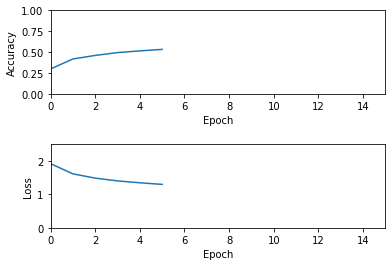

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/6a0model.ckpt Model Saved...
Epoch [150000], loss: 1.3604, acc: 0.0000
Epoch [150001], loss: 1.4135, acc: 0.0000
Epoch [150002], loss: 1.5222, acc: 0.0000
Epoch [150003], loss: 1.3272, acc: 0.0000
Epoch [150004], loss: 0.8581, acc: 1.0000
Epoch [150005], loss: 3.5272, acc: 0.0000
Epoch [150006], loss: 2.9955, acc: 0.0000
Epoch [150007], loss: 1.1535, acc: 0.0000
Epoch [150008], loss: 0.3364, acc: 1.0000
Epoch [150009], loss: 2.1078, acc: 0.0000
Epoch [150010], loss: 0.8555, acc: 1.0000
Epoch [150011], loss: 2.3550, acc: 0.0000
Epoch [150012], loss: 0.6089, acc: 1.0000
Epoch [150013], loss: 1.7409, acc: 0.0000
Epoch [150014], loss: 1.8376, acc: 0.0000
Epoch [150015], loss: 2.7546, acc: 0.0000
Epoch [150016], loss: 0.1208, acc: 1.0000
Epoch [150017], loss: 0.0008, acc: 1.0000
Epoch [150018], loss: 1.0615, acc: 1.0000
Epoch [150019], loss: 0.1459, acc: 1.0000
Epoch [150020], loss: 2.2242, acc: 0.0000
Epoch [150021],

Epoch [150204], loss: 0.2038, acc: 1.0000
Epoch [150205], loss: 1.3062, acc: 0.0000
Epoch [150206], loss: 0.8186, acc: 1.0000
Epoch [150207], loss: 1.6965, acc: 0.0000
Epoch [150208], loss: 1.2215, acc: 0.0000
Epoch [150209], loss: 0.1158, acc: 1.0000
Epoch [150210], loss: 2.3817, acc: 0.0000
Epoch [150211], loss: 2.1768, acc: 0.0000
Epoch [150212], loss: 1.5855, acc: 0.0000
Epoch [150213], loss: 3.1828, acc: 0.0000
Epoch [150214], loss: 1.2218, acc: 0.0000
Epoch [150215], loss: 1.1928, acc: 1.0000
Epoch [150216], loss: 2.0657, acc: 0.0000
Epoch [150217], loss: 1.1550, acc: 1.0000
Epoch [150218], loss: 0.1636, acc: 1.0000
Epoch [150219], loss: 1.4508, acc: 0.0000
Epoch [150220], loss: 1.3463, acc: 0.0000
Epoch [150221], loss: 1.0478, acc: 0.0000
Epoch [150222], loss: 2.8556, acc: 0.0000
Epoch [150223], loss: 0.6270, acc: 1.0000
Epoch [150224], loss: 0.4006, acc: 1.0000
Epoch [150225], loss: 0.6134, acc: 1.0000
Epoch [150226], loss: 0.0212, acc: 1.0000
Epoch [150227], loss: 0.6912, acc:

Epoch [150406], loss: 1.5082, acc: 0.0000
Epoch [150407], loss: 1.0475, acc: 0.0000
Epoch [150408], loss: 0.1798, acc: 1.0000
Epoch [150409], loss: 1.1413, acc: 1.0000
Epoch [150410], loss: 1.7602, acc: 0.0000
Epoch [150411], loss: 0.0856, acc: 1.0000
Epoch [150412], loss: 0.8299, acc: 0.0000
Epoch [150413], loss: 0.3597, acc: 1.0000
Epoch [150414], loss: 1.8074, acc: 0.0000
Epoch [150415], loss: 0.0880, acc: 1.0000
Epoch [150416], loss: 0.1152, acc: 1.0000
Epoch [150417], loss: 1.4005, acc: 0.0000
Epoch [150418], loss: 0.6638, acc: 1.0000
Epoch [150419], loss: 0.6408, acc: 1.0000
Epoch [150420], loss: 1.5583, acc: 0.0000
Epoch [150421], loss: 1.2612, acc: 0.0000
Epoch [150422], loss: 0.9092, acc: 0.0000
Epoch [150423], loss: 1.9548, acc: 0.0000
Epoch [150424], loss: 2.3047, acc: 0.0000
Epoch [150425], loss: 0.2800, acc: 1.0000
Epoch [150426], loss: 3.3026, acc: 0.0000
Epoch [150427], loss: 3.0390, acc: 0.0000
Epoch [150428], loss: 1.3346, acc: 1.0000
Epoch [150429], loss: 1.1730, acc:

Epoch [150599], loss: 0.0225, acc: 1.0000
Epoch [150600], loss: 1.7072, acc: 0.0000
Epoch [150601], loss: 1.6929, acc: 0.0000
Epoch [150602], loss: 0.3274, acc: 1.0000
Epoch [150603], loss: 0.7581, acc: 1.0000
Epoch [150604], loss: 0.8639, acc: 1.0000
Epoch [150605], loss: 0.3279, acc: 1.0000
Epoch [150606], loss: 2.1825, acc: 0.0000
Epoch [150607], loss: 1.0467, acc: 0.0000
Epoch [150608], loss: 0.9416, acc: 0.0000
Epoch [150609], loss: 2.9428, acc: 0.0000
Epoch [150610], loss: 0.0378, acc: 1.0000
Epoch [150611], loss: 2.0044, acc: 0.0000
Epoch [150612], loss: 1.3432, acc: 1.0000
Epoch [150613], loss: 0.6981, acc: 1.0000
Epoch [150614], loss: 0.2968, acc: 1.0000
Epoch [150615], loss: 0.4491, acc: 1.0000
Epoch [150616], loss: 2.2098, acc: 0.0000
Epoch [150617], loss: 1.4662, acc: 0.0000
Epoch [150618], loss: 0.7691, acc: 1.0000
Epoch [150619], loss: 1.3288, acc: 0.0000
Epoch [150620], loss: 1.3855, acc: 0.0000
Epoch [150621], loss: 2.3119, acc: 0.0000
Epoch [150622], loss: 0.7825, acc:

Epoch [150810], loss: 1.1140, acc: 1.0000
Epoch [150811], loss: 1.1675, acc: 0.0000
Epoch [150812], loss: 1.3589, acc: 0.0000
Epoch [150813], loss: 0.2519, acc: 1.0000
Epoch [150814], loss: 0.0639, acc: 1.0000
Epoch [150815], loss: 0.4951, acc: 1.0000
Epoch [150816], loss: 0.1794, acc: 1.0000
Epoch [150817], loss: 1.2966, acc: 1.0000
Epoch [150818], loss: 1.5817, acc: 0.0000
Epoch [150819], loss: 0.4386, acc: 1.0000
Epoch [150820], loss: 0.6623, acc: 1.0000
Epoch [150821], loss: 0.9459, acc: 0.0000
Epoch [150822], loss: 2.4756, acc: 0.0000
Epoch [150823], loss: 0.0437, acc: 1.0000
Epoch [150824], loss: 2.8880, acc: 0.0000
Epoch [150825], loss: 2.4453, acc: 0.0000
Epoch [150826], loss: 0.6473, acc: 1.0000
Epoch [150827], loss: 2.8769, acc: 0.0000
Epoch [150828], loss: 0.1404, acc: 1.0000
Epoch [150829], loss: 0.9257, acc: 1.0000
Epoch [150830], loss: 1.6281, acc: 0.0000
Epoch [150831], loss: 2.8365, acc: 0.0000
Epoch [150832], loss: 2.4221, acc: 0.0000
Epoch [150833], loss: 0.4263, acc:

Epoch [151011], loss: 0.1131, acc: 1.0000
Epoch [151012], loss: 1.2152, acc: 0.0000
Epoch [151013], loss: 0.8757, acc: 1.0000
Epoch [151014], loss: 0.3021, acc: 1.0000
Epoch [151015], loss: 0.3425, acc: 1.0000
Epoch [151016], loss: 3.8710, acc: 0.0000
Epoch [151017], loss: 0.6432, acc: 1.0000
Epoch [151018], loss: 0.4156, acc: 1.0000
Epoch [151019], loss: 1.6944, acc: 0.0000
Epoch [151020], loss: 0.7567, acc: 1.0000
Epoch [151021], loss: 0.7565, acc: 1.0000
Epoch [151022], loss: 2.2161, acc: 0.0000
Epoch [151023], loss: 0.2015, acc: 1.0000
Epoch [151024], loss: 0.2835, acc: 1.0000
Epoch [151025], loss: 1.3530, acc: 1.0000
Epoch [151026], loss: 2.2636, acc: 0.0000
Epoch [151027], loss: 0.2726, acc: 1.0000
Epoch [151028], loss: 0.3013, acc: 1.0000
Epoch [151029], loss: 0.0167, acc: 1.0000
Epoch [151030], loss: 2.7298, acc: 0.0000
Epoch [151031], loss: 0.0819, acc: 1.0000
Epoch [151032], loss: 0.1518, acc: 1.0000
Epoch [151033], loss: 1.4366, acc: 0.0000
Epoch [151034], loss: 1.9437, acc:

Epoch [151212], loss: 0.0430, acc: 1.0000
Epoch [151213], loss: 2.0305, acc: 0.0000
Epoch [151214], loss: 2.2488, acc: 0.0000
Epoch [151215], loss: 0.1413, acc: 1.0000
Epoch [151216], loss: 1.8800, acc: 0.0000
Epoch [151217], loss: 1.6990, acc: 0.0000
Epoch [151218], loss: 1.2221, acc: 0.0000
Epoch [151219], loss: 2.0099, acc: 0.0000
Epoch [151220], loss: 0.1330, acc: 1.0000
Epoch [151221], loss: 0.7443, acc: 1.0000
Epoch [151222], loss: 0.5255, acc: 1.0000
Epoch [151223], loss: 0.7372, acc: 1.0000
Epoch [151224], loss: 2.9423, acc: 0.0000
Epoch [151225], loss: 1.5650, acc: 0.0000
Epoch [151226], loss: 0.0756, acc: 1.0000
Epoch [151227], loss: 2.9578, acc: 0.0000
Epoch [151228], loss: 0.8187, acc: 1.0000
Epoch [151229], loss: 3.1171, acc: 0.0000
Epoch [151230], loss: 1.2783, acc: 0.0000
Epoch [151231], loss: 0.6734, acc: 1.0000
Epoch [151232], loss: 0.6820, acc: 1.0000
Epoch [151233], loss: 1.9566, acc: 0.0000
Epoch [151234], loss: 0.2342, acc: 1.0000
Epoch [151235], loss: 0.9523, acc:

Epoch [151412], loss: 0.5723, acc: 1.0000
Epoch [151413], loss: 0.7784, acc: 1.0000
Epoch [151414], loss: 3.3313, acc: 0.0000
Epoch [151415], loss: 2.6690, acc: 0.0000
Epoch [151416], loss: 0.7160, acc: 1.0000
Epoch [151417], loss: 0.4305, acc: 1.0000
Epoch [151418], loss: 1.0253, acc: 1.0000
Epoch [151419], loss: 3.0952, acc: 0.0000
Epoch [151420], loss: 0.4030, acc: 1.0000
Epoch [151421], loss: 1.2447, acc: 0.0000
Epoch [151422], loss: 3.6937, acc: 0.0000
Epoch [151423], loss: 2.5188, acc: 0.0000
Epoch [151424], loss: 2.5018, acc: 0.0000
Epoch [151425], loss: 0.6382, acc: 1.0000
Epoch [151426], loss: 1.4649, acc: 0.0000
Epoch [151427], loss: 2.5609, acc: 0.0000
Epoch [151428], loss: 0.1939, acc: 1.0000
Epoch [151429], loss: 0.4749, acc: 1.0000
Epoch [151430], loss: 0.3747, acc: 1.0000
Epoch [151431], loss: 0.8960, acc: 1.0000
Epoch [151432], loss: 0.6862, acc: 1.0000
Epoch [151433], loss: 0.7155, acc: 1.0000
Epoch [151434], loss: 1.2913, acc: 0.0000
Epoch [151435], loss: 1.3452, acc:

Epoch [151612], loss: 0.8424, acc: 1.0000
Epoch [151613], loss: 1.6437, acc: 0.0000
Epoch [151614], loss: 0.8050, acc: 0.0000
Epoch [151615], loss: 0.1889, acc: 1.0000
Epoch [151616], loss: 5.2019, acc: 0.0000
Epoch [151617], loss: 1.6122, acc: 0.0000
Epoch [151618], loss: 2.3032, acc: 0.0000
Epoch [151619], loss: 2.3588, acc: 0.0000
Epoch [151620], loss: 0.4373, acc: 1.0000
Epoch [151621], loss: 1.0137, acc: 1.0000
Epoch [151622], loss: 0.1238, acc: 1.0000
Epoch [151623], loss: 3.0791, acc: 0.0000
Epoch [151624], loss: 2.6895, acc: 0.0000
Epoch [151625], loss: 0.1658, acc: 1.0000
Epoch [151626], loss: 0.4447, acc: 1.0000
Epoch [151627], loss: 1.2665, acc: 1.0000
Epoch [151628], loss: 1.1465, acc: 1.0000
Epoch [151629], loss: 2.1680, acc: 0.0000
Epoch [151630], loss: 6.0920, acc: 0.0000
Epoch [151631], loss: 0.0608, acc: 1.0000
Epoch [151632], loss: 0.9961, acc: 1.0000
Epoch [151633], loss: 3.7124, acc: 0.0000
Epoch [151634], loss: 0.7066, acc: 1.0000
Epoch [151635], loss: 2.6601, acc:

Epoch [151815], loss: 0.1602, acc: 1.0000
Epoch [151816], loss: 1.0024, acc: 0.0000
Epoch [151817], loss: 2.2282, acc: 0.0000
Epoch [151818], loss: 1.8171, acc: 0.0000
Epoch [151819], loss: 0.1335, acc: 1.0000
Epoch [151820], loss: 1.3881, acc: 1.0000
Epoch [151821], loss: 1.1159, acc: 1.0000
Epoch [151822], loss: 0.0052, acc: 1.0000
Epoch [151823], loss: 2.0299, acc: 0.0000
Epoch [151824], loss: 0.0299, acc: 1.0000
Epoch [151825], loss: 0.5930, acc: 1.0000
Epoch [151826], loss: 1.3798, acc: 0.0000
Epoch [151827], loss: 1.3586, acc: 0.0000
Epoch [151828], loss: 0.2958, acc: 1.0000
Epoch [151829], loss: 3.1417, acc: 0.0000
Epoch [151830], loss: 0.1527, acc: 1.0000
Epoch [151831], loss: 2.6209, acc: 0.0000
Epoch [151832], loss: 2.1418, acc: 0.0000
Epoch [151833], loss: 0.5450, acc: 1.0000
Epoch [151834], loss: 0.9910, acc: 0.0000
Epoch [151835], loss: 0.4375, acc: 1.0000
Epoch [151836], loss: 1.2453, acc: 1.0000
Epoch [151837], loss: 0.4196, acc: 1.0000
Epoch [151838], loss: 0.9309, acc:

Epoch [152010], loss: 1.7553, acc: 0.0000
Epoch [152011], loss: 1.8426, acc: 0.0000
Epoch [152012], loss: 0.6038, acc: 1.0000
Epoch [152013], loss: 0.2857, acc: 1.0000
Epoch [152014], loss: 0.1816, acc: 1.0000
Epoch [152015], loss: 1.8637, acc: 0.0000
Epoch [152016], loss: 1.5499, acc: 1.0000
Epoch [152017], loss: 4.0744, acc: 0.0000
Epoch [152018], loss: 1.2912, acc: 0.0000
Epoch [152019], loss: 1.4018, acc: 1.0000
Epoch [152020], loss: 1.3869, acc: 0.0000
Epoch [152021], loss: 0.6226, acc: 1.0000
Epoch [152022], loss: 2.0546, acc: 0.0000
Epoch [152023], loss: 1.1957, acc: 0.0000
Epoch [152024], loss: 1.0509, acc: 0.0000
Epoch [152025], loss: 0.7664, acc: 1.0000
Epoch [152026], loss: 1.4096, acc: 1.0000
Epoch [152027], loss: 1.4793, acc: 0.0000
Epoch [152028], loss: 1.3215, acc: 1.0000
Epoch [152029], loss: 3.3572, acc: 0.0000
Epoch [152030], loss: 2.5164, acc: 0.0000
Epoch [152031], loss: 2.2567, acc: 0.0000
Epoch [152032], loss: 0.1896, acc: 1.0000
Epoch [152033], loss: 1.6404, acc:

Epoch [152224], loss: 0.3449, acc: 1.0000
Epoch [152225], loss: 1.1899, acc: 0.0000
Epoch [152226], loss: 1.4990, acc: 0.0000
Epoch [152227], loss: 0.9663, acc: 0.0000
Epoch [152228], loss: 2.4350, acc: 0.0000
Epoch [152229], loss: 2.6876, acc: 0.0000
Epoch [152230], loss: 4.0602, acc: 0.0000
Epoch [152231], loss: 1.5079, acc: 0.0000
Epoch [152232], loss: 1.8670, acc: 0.0000
Epoch [152233], loss: 0.8901, acc: 1.0000
Epoch [152234], loss: 1.2734, acc: 1.0000
Epoch [152235], loss: 2.0398, acc: 0.0000
Epoch [152236], loss: 2.6556, acc: 0.0000
Epoch [152237], loss: 0.0709, acc: 1.0000
Epoch [152238], loss: 1.3395, acc: 0.0000
Epoch [152239], loss: 0.7573, acc: 1.0000
Epoch [152240], loss: 0.0573, acc: 1.0000
Epoch [152241], loss: 0.5881, acc: 1.0000
Epoch [152242], loss: 0.3444, acc: 1.0000
Epoch [152243], loss: 0.1688, acc: 1.0000
Epoch [152244], loss: 1.7273, acc: 0.0000
Epoch [152245], loss: 1.3401, acc: 0.0000
Epoch [152246], loss: 1.9503, acc: 0.0000
Epoch [152247], loss: 1.9143, acc:

Epoch [152420], loss: 0.6110, acc: 1.0000
Epoch [152421], loss: 1.5464, acc: 0.0000
Epoch [152422], loss: 3.1291, acc: 0.0000
Epoch [152423], loss: 3.0060, acc: 0.0000
Epoch [152424], loss: 0.1249, acc: 1.0000
Epoch [152425], loss: 0.6235, acc: 1.0000
Epoch [152426], loss: 0.7743, acc: 1.0000
Epoch [152427], loss: 0.5145, acc: 1.0000
Epoch [152428], loss: 1.1654, acc: 1.0000
Epoch [152429], loss: 0.1701, acc: 1.0000
Epoch [152430], loss: 0.3071, acc: 1.0000
Epoch [152431], loss: 0.4571, acc: 1.0000
Epoch [152432], loss: 2.8575, acc: 0.0000
Epoch [152433], loss: 0.3572, acc: 1.0000
Epoch [152434], loss: 1.2690, acc: 0.0000
Epoch [152435], loss: 0.1142, acc: 1.0000
Epoch [152436], loss: 0.5595, acc: 1.0000
Epoch [152437], loss: 1.0200, acc: 0.0000
Epoch [152438], loss: 0.4743, acc: 1.0000
Epoch [152439], loss: 1.0314, acc: 0.0000
Epoch [152440], loss: 1.9023, acc: 0.0000
Epoch [152441], loss: 0.3517, acc: 1.0000
Epoch [152442], loss: 1.8817, acc: 0.0000
Epoch [152443], loss: 1.0402, acc:

Epoch [152615], loss: 0.7411, acc: 1.0000
Epoch [152616], loss: 1.3070, acc: 1.0000
Epoch [152617], loss: 2.2147, acc: 0.0000
Epoch [152618], loss: 1.5346, acc: 0.0000
Epoch [152619], loss: 1.6424, acc: 0.0000
Epoch [152620], loss: 0.5233, acc: 1.0000
Epoch [152621], loss: 2.3656, acc: 0.0000
Epoch [152622], loss: 1.8374, acc: 0.0000
Epoch [152623], loss: 1.2232, acc: 1.0000
Epoch [152624], loss: 2.2254, acc: 0.0000
Epoch [152625], loss: 1.9809, acc: 0.0000
Epoch [152626], loss: 0.9898, acc: 1.0000
Epoch [152627], loss: 0.4269, acc: 1.0000
Epoch [152628], loss: 1.5208, acc: 0.0000
Epoch [152629], loss: 1.6219, acc: 0.0000
Epoch [152630], loss: 0.6759, acc: 1.0000
Epoch [152631], loss: 2.1856, acc: 0.0000
Epoch [152632], loss: 0.2168, acc: 1.0000
Epoch [152633], loss: 5.4592, acc: 0.0000
Epoch [152634], loss: 0.2225, acc: 1.0000
Epoch [152635], loss: 2.2580, acc: 0.0000
Epoch [152636], loss: 2.3948, acc: 0.0000
Epoch [152637], loss: 2.0316, acc: 0.0000
Epoch [152638], loss: 0.1999, acc:

Epoch [152819], loss: 0.4878, acc: 1.0000
Epoch [152820], loss: 0.3413, acc: 1.0000
Epoch [152821], loss: 1.8790, acc: 0.0000
Epoch [152822], loss: 1.1153, acc: 1.0000
Epoch [152823], loss: 0.9637, acc: 1.0000
Epoch [152824], loss: 2.3405, acc: 0.0000
Epoch [152825], loss: 0.0382, acc: 1.0000
Epoch [152826], loss: 0.9801, acc: 1.0000
Epoch [152827], loss: 1.5980, acc: 0.0000
Epoch [152828], loss: 1.3688, acc: 0.0000
Epoch [152829], loss: 1.0289, acc: 1.0000
Epoch [152830], loss: 1.5220, acc: 0.0000
Epoch [152831], loss: 1.4150, acc: 0.0000
Epoch [152832], loss: 0.8343, acc: 1.0000
Epoch [152833], loss: 2.1324, acc: 0.0000
Epoch [152834], loss: 3.2966, acc: 0.0000
Epoch [152835], loss: 0.7484, acc: 1.0000
Epoch [152836], loss: 1.7415, acc: 0.0000
Epoch [152837], loss: 0.8989, acc: 1.0000
Epoch [152838], loss: 0.5077, acc: 1.0000
Epoch [152839], loss: 4.9130, acc: 0.0000
Epoch [152840], loss: 1.6197, acc: 0.0000
Epoch [152841], loss: 1.5495, acc: 0.0000
Epoch [152842], loss: 1.2397, acc:

Epoch [153020], loss: 1.8788, acc: 0.0000
Epoch [153021], loss: 0.3421, acc: 1.0000
Epoch [153022], loss: 1.2516, acc: 0.0000
Epoch [153023], loss: 1.0162, acc: 0.0000
Epoch [153024], loss: 0.5745, acc: 1.0000
Epoch [153025], loss: 0.1549, acc: 1.0000
Epoch [153026], loss: 0.9910, acc: 1.0000
Epoch [153027], loss: 1.7416, acc: 0.0000
Epoch [153028], loss: 2.4806, acc: 0.0000
Epoch [153029], loss: 0.4275, acc: 1.0000
Epoch [153030], loss: 2.6329, acc: 0.0000
Epoch [153031], loss: 0.2032, acc: 1.0000
Epoch [153032], loss: 0.3268, acc: 1.0000
Epoch [153033], loss: 0.7067, acc: 1.0000
Epoch [153034], loss: 4.3894, acc: 0.0000
Epoch [153035], loss: 0.8714, acc: 0.0000
Epoch [153036], loss: 0.7075, acc: 1.0000
Epoch [153037], loss: 1.9263, acc: 0.0000
Epoch [153038], loss: 1.0698, acc: 0.0000
Epoch [153039], loss: 0.1596, acc: 1.0000
Epoch [153040], loss: 0.3853, acc: 1.0000
Epoch [153041], loss: 1.7873, acc: 0.0000
Epoch [153042], loss: 1.5714, acc: 0.0000
Epoch [153043], loss: 2.4582, acc:

Epoch [153223], loss: 1.0395, acc: 1.0000
Epoch [153224], loss: 0.5854, acc: 1.0000
Epoch [153225], loss: 1.2497, acc: 0.0000
Epoch [153226], loss: 1.7317, acc: 0.0000
Epoch [153227], loss: 0.1075, acc: 1.0000
Epoch [153228], loss: 1.0607, acc: 1.0000
Epoch [153229], loss: 0.2196, acc: 1.0000
Epoch [153230], loss: 0.8488, acc: 1.0000
Epoch [153231], loss: 0.9728, acc: 1.0000
Epoch [153232], loss: 0.7575, acc: 1.0000
Epoch [153233], loss: 0.6471, acc: 1.0000
Epoch [153234], loss: 1.5977, acc: 0.0000
Epoch [153235], loss: 2.6516, acc: 0.0000
Epoch [153236], loss: 1.6482, acc: 0.0000
Epoch [153237], loss: 0.9833, acc: 1.0000
Epoch [153238], loss: 2.1712, acc: 0.0000
Epoch [153239], loss: 3.4872, acc: 0.0000
Epoch [153240], loss: 0.1271, acc: 1.0000
Epoch [153241], loss: 1.3648, acc: 1.0000
Epoch [153242], loss: 2.2175, acc: 0.0000
Epoch [153243], loss: 0.5566, acc: 1.0000
Epoch [153244], loss: 1.1423, acc: 0.0000
Epoch [153245], loss: 2.0171, acc: 0.0000
Epoch [153246], loss: 1.0321, acc:

Epoch [153426], loss: 0.9083, acc: 1.0000
Epoch [153427], loss: 1.9021, acc: 0.0000
Epoch [153428], loss: 0.3218, acc: 1.0000
Epoch [153429], loss: 1.9612, acc: 0.0000
Epoch [153430], loss: 1.5798, acc: 0.0000
Epoch [153431], loss: 1.0487, acc: 1.0000
Epoch [153432], loss: 1.2542, acc: 0.0000
Epoch [153433], loss: 1.4612, acc: 0.0000
Epoch [153434], loss: 0.4848, acc: 1.0000
Epoch [153435], loss: 0.4601, acc: 1.0000
Epoch [153436], loss: 1.0153, acc: 1.0000
Epoch [153437], loss: 3.3806, acc: 0.0000
Epoch [153438], loss: 0.0672, acc: 1.0000
Epoch [153439], loss: 2.3284, acc: 0.0000
Epoch [153440], loss: 1.4337, acc: 1.0000
Epoch [153441], loss: 1.6891, acc: 0.0000
Epoch [153442], loss: 1.9258, acc: 0.0000
Epoch [153443], loss: 3.2714, acc: 0.0000
Epoch [153444], loss: 0.3592, acc: 1.0000
Epoch [153445], loss: 0.9396, acc: 0.0000
Epoch [153446], loss: 0.1710, acc: 1.0000
Epoch [153447], loss: 1.6019, acc: 0.0000
Epoch [153448], loss: 2.3979, acc: 0.0000
Epoch [153449], loss: 3.8348, acc:

Epoch [153636], loss: 0.4276, acc: 1.0000
Epoch [153637], loss: 0.2801, acc: 1.0000
Epoch [153638], loss: 0.6769, acc: 1.0000
Epoch [153639], loss: 0.1888, acc: 1.0000
Epoch [153640], loss: 2.0330, acc: 0.0000
Epoch [153641], loss: 2.2969, acc: 0.0000
Epoch [153642], loss: 0.1660, acc: 1.0000
Epoch [153643], loss: 2.0851, acc: 0.0000
Epoch [153644], loss: 3.7336, acc: 0.0000
Epoch [153645], loss: 2.2060, acc: 0.0000
Epoch [153646], loss: 4.5005, acc: 0.0000
Epoch [153647], loss: 1.2508, acc: 1.0000
Epoch [153648], loss: 1.4272, acc: 0.0000
Epoch [153649], loss: 0.6580, acc: 1.0000
Epoch [153650], loss: 1.7347, acc: 0.0000
Epoch [153651], loss: 0.0921, acc: 1.0000
Epoch [153652], loss: 1.0087, acc: 0.0000
Epoch [153653], loss: 1.6186, acc: 0.0000
Epoch [153654], loss: 2.8647, acc: 0.0000
Epoch [153655], loss: 1.6227, acc: 0.0000
Epoch [153656], loss: 1.3828, acc: 0.0000
Epoch [153657], loss: 0.3293, acc: 1.0000
Epoch [153658], loss: 1.9578, acc: 0.0000
Epoch [153659], loss: 0.1727, acc:

Epoch [153834], loss: 0.0688, acc: 1.0000
Epoch [153835], loss: 0.9900, acc: 0.0000
Epoch [153836], loss: 0.9540, acc: 1.0000
Epoch [153837], loss: 0.0714, acc: 1.0000
Epoch [153838], loss: 0.6882, acc: 1.0000
Epoch [153839], loss: 1.0087, acc: 0.0000
Epoch [153840], loss: 1.5763, acc: 0.0000
Epoch [153841], loss: 1.1057, acc: 1.0000
Epoch [153842], loss: 1.0544, acc: 0.0000
Epoch [153843], loss: 2.6510, acc: 0.0000
Epoch [153844], loss: 0.7160, acc: 1.0000
Epoch [153845], loss: 4.7319, acc: 0.0000
Epoch [153846], loss: 1.5107, acc: 0.0000
Epoch [153847], loss: 0.6465, acc: 1.0000
Epoch [153848], loss: 2.1427, acc: 0.0000
Epoch [153849], loss: 3.8130, acc: 0.0000
Epoch [153850], loss: 2.5531, acc: 0.0000
Epoch [153851], loss: 1.1103, acc: 0.0000
Epoch [153852], loss: 0.3885, acc: 1.0000
Epoch [153853], loss: 0.6324, acc: 1.0000
Epoch [153854], loss: 1.1988, acc: 0.0000
Epoch [153855], loss: 1.1765, acc: 1.0000
Epoch [153856], loss: 1.8796, acc: 0.0000
Epoch [153857], loss: 1.0836, acc:

Epoch [154042], loss: 1.0241, acc: 1.0000
Epoch [154043], loss: 0.9154, acc: 1.0000
Epoch [154044], loss: 2.0016, acc: 0.0000
Epoch [154045], loss: 0.0430, acc: 1.0000
Epoch [154046], loss: 0.0594, acc: 1.0000
Epoch [154047], loss: 0.4475, acc: 1.0000
Epoch [154048], loss: 5.3832, acc: 0.0000
Epoch [154049], loss: 1.1207, acc: 0.0000
Epoch [154050], loss: 0.2644, acc: 1.0000
Epoch [154051], loss: 1.2914, acc: 0.0000
Epoch [154052], loss: 0.6566, acc: 1.0000
Epoch [154053], loss: 0.0647, acc: 1.0000
Epoch [154054], loss: 2.7561, acc: 0.0000
Epoch [154055], loss: 3.0427, acc: 0.0000
Epoch [154056], loss: 1.8125, acc: 0.0000
Epoch [154057], loss: 0.9399, acc: 1.0000
Epoch [154058], loss: 0.9148, acc: 1.0000
Epoch [154059], loss: 0.6039, acc: 1.0000
Epoch [154060], loss: 0.9231, acc: 1.0000
Epoch [154061], loss: 1.2686, acc: 0.0000
Epoch [154062], loss: 0.2086, acc: 1.0000
Epoch [154063], loss: 1.2931, acc: 1.0000
Epoch [154064], loss: 0.4868, acc: 1.0000
Epoch [154065], loss: 0.4977, acc:

Epoch [154242], loss: 1.8813, acc: 0.0000
Epoch [154243], loss: 1.1407, acc: 1.0000
Epoch [154244], loss: 2.7131, acc: 0.0000
Epoch [154245], loss: 0.3709, acc: 1.0000
Epoch [154246], loss: 0.5948, acc: 1.0000
Epoch [154247], loss: 2.1786, acc: 0.0000
Epoch [154248], loss: 0.3422, acc: 1.0000
Epoch [154249], loss: 0.5237, acc: 1.0000
Epoch [154250], loss: 0.1715, acc: 1.0000
Epoch [154251], loss: 2.0971, acc: 0.0000
Epoch [154252], loss: 0.6061, acc: 1.0000
Epoch [154253], loss: 0.3364, acc: 1.0000
Epoch [154254], loss: 0.5396, acc: 1.0000
Epoch [154255], loss: 0.2767, acc: 1.0000
Epoch [154256], loss: 0.2366, acc: 1.0000
Epoch [154257], loss: 1.1969, acc: 0.0000
Epoch [154258], loss: 1.5582, acc: 0.0000
Epoch [154259], loss: 0.7094, acc: 1.0000
Epoch [154260], loss: 1.6077, acc: 0.0000
Epoch [154261], loss: 2.3506, acc: 0.0000
Epoch [154262], loss: 1.1582, acc: 0.0000
Epoch [154263], loss: 2.3308, acc: 0.0000
Epoch [154264], loss: 2.3056, acc: 0.0000
Epoch [154265], loss: 2.0664, acc:

Epoch [154446], loss: 1.0951, acc: 1.0000
Epoch [154447], loss: 1.2892, acc: 0.0000
Epoch [154448], loss: 0.3116, acc: 1.0000
Epoch [154449], loss: 0.5047, acc: 1.0000
Epoch [154450], loss: 0.3908, acc: 1.0000
Epoch [154451], loss: 0.5571, acc: 1.0000
Epoch [154452], loss: 0.6639, acc: 1.0000
Epoch [154453], loss: 0.0681, acc: 1.0000
Epoch [154454], loss: 0.8569, acc: 1.0000
Epoch [154455], loss: 0.2839, acc: 1.0000
Epoch [154456], loss: 0.1615, acc: 1.0000
Epoch [154457], loss: 0.0781, acc: 1.0000
Epoch [154458], loss: 1.1314, acc: 0.0000
Epoch [154459], loss: 1.7358, acc: 0.0000
Epoch [154460], loss: 0.5580, acc: 1.0000
Epoch [154461], loss: 0.4296, acc: 1.0000
Epoch [154462], loss: 1.1282, acc: 0.0000
Epoch [154463], loss: 3.1330, acc: 0.0000
Epoch [154464], loss: 0.4891, acc: 1.0000
Epoch [154465], loss: 1.8855, acc: 0.0000
Epoch [154466], loss: 3.7119, acc: 0.0000
Epoch [154467], loss: 2.0182, acc: 0.0000
Epoch [154468], loss: 0.7966, acc: 0.0000
Epoch [154469], loss: 4.1207, acc:

Epoch [154647], loss: 3.0895, acc: 0.0000
Epoch [154648], loss: 0.4975, acc: 1.0000
Epoch [154649], loss: 0.7385, acc: 1.0000
Epoch [154650], loss: 2.0154, acc: 0.0000
Epoch [154651], loss: 1.6326, acc: 0.0000
Epoch [154652], loss: 0.4754, acc: 1.0000
Epoch [154653], loss: 2.8469, acc: 0.0000
Epoch [154654], loss: 1.2681, acc: 0.0000
Epoch [154655], loss: 0.9229, acc: 0.0000
Epoch [154656], loss: 3.4213, acc: 0.0000
Epoch [154657], loss: 1.1393, acc: 1.0000
Epoch [154658], loss: 0.7591, acc: 0.0000
Epoch [154659], loss: 0.9339, acc: 1.0000
Epoch [154660], loss: 4.7205, acc: 0.0000
Epoch [154661], loss: 4.5633, acc: 0.0000
Epoch [154662], loss: 3.1151, acc: 0.0000
Epoch [154663], loss: 0.6655, acc: 1.0000
Epoch [154664], loss: 0.8017, acc: 1.0000
Epoch [154665], loss: 0.5025, acc: 1.0000
Epoch [154666], loss: 1.5427, acc: 0.0000
Epoch [154667], loss: 0.0390, acc: 1.0000
Epoch [154668], loss: 0.6645, acc: 1.0000
Epoch [154669], loss: 0.5487, acc: 1.0000
Epoch [154670], loss: 0.4012, acc:

Epoch [154848], loss: 0.0214, acc: 1.0000
Epoch [154849], loss: 0.9464, acc: 1.0000
Epoch [154850], loss: 0.6737, acc: 1.0000
Epoch [154851], loss: 1.4465, acc: 1.0000
Epoch [154852], loss: 0.2916, acc: 1.0000
Epoch [154853], loss: 0.8164, acc: 0.0000
Epoch [154854], loss: 1.5152, acc: 0.0000
Epoch [154855], loss: 0.6639, acc: 1.0000
Epoch [154856], loss: 0.4905, acc: 1.0000
Epoch [154857], loss: 0.3373, acc: 1.0000
Epoch [154858], loss: 1.3904, acc: 0.0000
Epoch [154859], loss: 0.5566, acc: 1.0000
Epoch [154860], loss: 2.2955, acc: 0.0000
Epoch [154861], loss: 0.6221, acc: 1.0000
Epoch [154862], loss: 0.4600, acc: 1.0000
Epoch [154863], loss: 0.3774, acc: 1.0000
Epoch [154864], loss: 1.2836, acc: 0.0000
Epoch [154865], loss: 2.6112, acc: 0.0000
Epoch [154866], loss: 0.5061, acc: 1.0000
Epoch [154867], loss: 1.0345, acc: 1.0000
Epoch [154868], loss: 3.7262, acc: 0.0000
Epoch [154869], loss: 2.0980, acc: 0.0000
Epoch [154870], loss: 0.2549, acc: 1.0000
Epoch [154871], loss: 0.1977, acc:

Epoch [155051], loss: 0.1271, acc: 1.0000
Epoch [155052], loss: 0.4716, acc: 1.0000
Epoch [155053], loss: 0.7439, acc: 1.0000
Epoch [155054], loss: 3.0911, acc: 0.0000
Epoch [155055], loss: 0.7690, acc: 1.0000
Epoch [155056], loss: 2.6245, acc: 0.0000
Epoch [155057], loss: 0.0892, acc: 1.0000
Epoch [155058], loss: 1.9327, acc: 0.0000
Epoch [155059], loss: 0.8828, acc: 1.0000
Epoch [155060], loss: 0.1061, acc: 1.0000
Epoch [155061], loss: 2.2964, acc: 0.0000
Epoch [155062], loss: 2.0398, acc: 0.0000
Epoch [155063], loss: 1.7881, acc: 0.0000
Epoch [155064], loss: 0.6324, acc: 1.0000
Epoch [155065], loss: 0.5898, acc: 1.0000
Epoch [155066], loss: 0.9459, acc: 1.0000
Epoch [155067], loss: 1.3827, acc: 0.0000
Epoch [155068], loss: 1.6529, acc: 0.0000
Epoch [155069], loss: 0.6409, acc: 1.0000
Epoch [155070], loss: 0.5118, acc: 1.0000
Epoch [155071], loss: 0.3059, acc: 1.0000
Epoch [155072], loss: 1.1747, acc: 0.0000
Epoch [155073], loss: 1.0976, acc: 1.0000
Epoch [155074], loss: 2.2765, acc:

Epoch [155254], loss: 1.1094, acc: 1.0000
Epoch [155255], loss: 1.4622, acc: 0.0000
Epoch [155256], loss: 1.1379, acc: 1.0000
Epoch [155257], loss: 0.0689, acc: 1.0000
Epoch [155258], loss: 0.6566, acc: 1.0000
Epoch [155259], loss: 0.2229, acc: 1.0000
Epoch [155260], loss: 1.4679, acc: 0.0000
Epoch [155261], loss: 2.1731, acc: 0.0000
Epoch [155262], loss: 0.5743, acc: 1.0000
Epoch [155263], loss: 1.5348, acc: 0.0000
Epoch [155264], loss: 0.8352, acc: 1.0000
Epoch [155265], loss: 0.3558, acc: 1.0000
Epoch [155266], loss: 2.4460, acc: 0.0000
Epoch [155267], loss: 2.0746, acc: 0.0000
Epoch [155268], loss: 0.9028, acc: 1.0000
Epoch [155269], loss: 0.7819, acc: 1.0000
Epoch [155270], loss: 0.9663, acc: 1.0000
Epoch [155271], loss: 1.3084, acc: 0.0000
Epoch [155272], loss: 2.0914, acc: 0.0000
Epoch [155273], loss: 0.3638, acc: 1.0000
Epoch [155274], loss: 2.0319, acc: 0.0000
Epoch [155275], loss: 0.0818, acc: 1.0000
Epoch [155276], loss: 2.0364, acc: 0.0000
Epoch [155277], loss: 0.7080, acc:

Epoch [155460], loss: 0.9373, acc: 1.0000
Epoch [155461], loss: 0.2679, acc: 1.0000
Epoch [155462], loss: 0.1303, acc: 1.0000
Epoch [155463], loss: 1.5563, acc: 0.0000
Epoch [155464], loss: 0.9864, acc: 1.0000
Epoch [155465], loss: 0.7558, acc: 1.0000
Epoch [155466], loss: 1.5069, acc: 0.0000
Epoch [155467], loss: 0.2036, acc: 1.0000
Epoch [155468], loss: 0.3233, acc: 1.0000
Epoch [155469], loss: 0.4920, acc: 1.0000
Epoch [155470], loss: 0.2184, acc: 1.0000
Epoch [155471], loss: 2.3516, acc: 0.0000
Epoch [155472], loss: 1.4706, acc: 0.0000
Epoch [155473], loss: 1.0409, acc: 1.0000
Epoch [155474], loss: 1.5895, acc: 0.0000
Epoch [155475], loss: 0.8789, acc: 1.0000
Epoch [155476], loss: 0.2776, acc: 1.0000
Epoch [155477], loss: 2.6467, acc: 0.0000
Epoch [155478], loss: 1.5527, acc: 1.0000
Epoch [155479], loss: 1.3831, acc: 1.0000
Epoch [155480], loss: 0.8020, acc: 1.0000
Epoch [155481], loss: 2.3281, acc: 0.0000
Epoch [155482], loss: 1.9968, acc: 0.0000
Epoch [155483], loss: 0.3051, acc:

Epoch [155664], loss: 3.5446, acc: 0.0000
Epoch [155665], loss: 0.0465, acc: 1.0000
Epoch [155666], loss: 1.7899, acc: 0.0000
Epoch [155667], loss: 1.2406, acc: 0.0000
Epoch [155668], loss: 1.0317, acc: 1.0000
Epoch [155669], loss: 1.7133, acc: 0.0000
Epoch [155670], loss: 1.0570, acc: 1.0000
Epoch [155671], loss: 1.5097, acc: 0.0000
Epoch [155672], loss: 1.1817, acc: 0.0000
Epoch [155673], loss: 2.1360, acc: 0.0000
Epoch [155674], loss: 1.0950, acc: 1.0000
Epoch [155675], loss: 1.3729, acc: 0.0000
Epoch [155676], loss: 1.3074, acc: 0.0000
Epoch [155677], loss: 0.6530, acc: 1.0000
Epoch [155678], loss: 0.6585, acc: 1.0000
Epoch [155679], loss: 0.3063, acc: 1.0000
Epoch [155680], loss: 1.2418, acc: 0.0000
Epoch [155681], loss: 1.0351, acc: 1.0000
Epoch [155682], loss: 0.7797, acc: 1.0000
Epoch [155683], loss: 0.3682, acc: 1.0000
Epoch [155684], loss: 1.8368, acc: 0.0000
Epoch [155685], loss: 1.9424, acc: 0.0000
Epoch [155686], loss: 0.7656, acc: 1.0000
Epoch [155687], loss: 1.9870, acc:

Epoch [155878], loss: 0.1947, acc: 1.0000
Epoch [155879], loss: 2.1581, acc: 0.0000
Epoch [155880], loss: 2.5502, acc: 0.0000
Epoch [155881], loss: 0.2304, acc: 1.0000
Epoch [155882], loss: 1.1933, acc: 0.0000
Epoch [155883], loss: 1.1646, acc: 1.0000
Epoch [155884], loss: 0.0748, acc: 1.0000
Epoch [155885], loss: 0.7027, acc: 1.0000
Epoch [155886], loss: 4.2442, acc: 0.0000
Epoch [155887], loss: 1.0059, acc: 1.0000
Epoch [155888], loss: 1.5273, acc: 0.0000
Epoch [155889], loss: 1.0759, acc: 1.0000
Epoch [155890], loss: 0.1249, acc: 1.0000
Epoch [155891], loss: 1.2288, acc: 1.0000
Epoch [155892], loss: 1.2690, acc: 1.0000
Epoch [155893], loss: 1.0725, acc: 1.0000
Epoch [155894], loss: 4.7874, acc: 0.0000
Epoch [155895], loss: 0.0756, acc: 1.0000
Epoch [155896], loss: 1.9022, acc: 0.0000
Epoch [155897], loss: 1.8276, acc: 0.0000
Epoch [155898], loss: 1.3386, acc: 0.0000
Epoch [155899], loss: 0.0741, acc: 1.0000
Epoch [155900], loss: 0.2100, acc: 1.0000
Epoch [155901], loss: 0.6493, acc:

Epoch [156101], loss: 1.5412, acc: 0.0000
Epoch [156102], loss: 1.0520, acc: 1.0000
Epoch [156103], loss: 1.0059, acc: 1.0000
Epoch [156104], loss: 2.0276, acc: 0.0000
Epoch [156105], loss: 0.7139, acc: 1.0000
Epoch [156106], loss: 1.3801, acc: 0.0000
Epoch [156107], loss: 2.6006, acc: 0.0000
Epoch [156108], loss: 0.1591, acc: 1.0000
Epoch [156109], loss: 0.9183, acc: 1.0000
Epoch [156110], loss: 1.5594, acc: 0.0000
Epoch [156111], loss: 0.0548, acc: 1.0000
Epoch [156112], loss: 0.0906, acc: 1.0000
Epoch [156113], loss: 4.2805, acc: 0.0000
Epoch [156114], loss: 0.5016, acc: 1.0000
Epoch [156115], loss: 0.1271, acc: 1.0000
Epoch [156116], loss: 0.3837, acc: 1.0000
Epoch [156117], loss: 0.2633, acc: 1.0000
Epoch [156118], loss: 2.2248, acc: 0.0000
Epoch [156119], loss: 2.7123, acc: 0.0000
Epoch [156120], loss: 0.7757, acc: 1.0000
Epoch [156121], loss: 0.1249, acc: 1.0000
Epoch [156122], loss: 3.7848, acc: 0.0000
Epoch [156123], loss: 1.5184, acc: 0.0000
Epoch [156124], loss: 0.0828, acc:

Epoch [156324], loss: 0.3652, acc: 1.0000
Epoch [156325], loss: 0.6404, acc: 1.0000
Epoch [156326], loss: 0.1720, acc: 1.0000
Epoch [156327], loss: 0.6183, acc: 1.0000
Epoch [156328], loss: 0.7382, acc: 1.0000
Epoch [156329], loss: 2.4920, acc: 0.0000
Epoch [156330], loss: 1.3257, acc: 0.0000
Epoch [156331], loss: 0.7185, acc: 1.0000
Epoch [156332], loss: 1.6430, acc: 0.0000
Epoch [156333], loss: 0.0599, acc: 1.0000
Epoch [156334], loss: 0.5078, acc: 1.0000
Epoch [156335], loss: 1.7539, acc: 0.0000
Epoch [156336], loss: 2.4113, acc: 0.0000
Epoch [156337], loss: 0.9196, acc: 1.0000
Epoch [156338], loss: 0.1285, acc: 1.0000
Epoch [156339], loss: 1.8241, acc: 0.0000
Epoch [156340], loss: 0.1208, acc: 1.0000
Epoch [156341], loss: 3.6812, acc: 0.0000
Epoch [156342], loss: 1.2607, acc: 1.0000
Epoch [156343], loss: 0.7424, acc: 1.0000
Epoch [156344], loss: 1.7262, acc: 0.0000
Epoch [156345], loss: 0.3419, acc: 1.0000
Epoch [156346], loss: 0.2343, acc: 1.0000
Epoch [156347], loss: 0.5643, acc:

Epoch [156529], loss: 0.7801, acc: 1.0000
Epoch [156530], loss: 1.5962, acc: 0.0000
Epoch [156531], loss: 1.2581, acc: 0.0000
Epoch [156532], loss: 0.9625, acc: 1.0000
Epoch [156533], loss: 2.5224, acc: 0.0000
Epoch [156534], loss: 0.2605, acc: 1.0000
Epoch [156535], loss: 2.7971, acc: 0.0000
Epoch [156536], loss: 2.5946, acc: 0.0000
Epoch [156537], loss: 0.0342, acc: 1.0000
Epoch [156538], loss: 0.8416, acc: 1.0000
Epoch [156539], loss: 1.5986, acc: 0.0000
Epoch [156540], loss: 1.4597, acc: 0.0000
Epoch [156541], loss: 0.9158, acc: 1.0000
Epoch [156542], loss: 2.1334, acc: 0.0000
Epoch [156543], loss: 2.2890, acc: 0.0000
Epoch [156544], loss: 2.4137, acc: 0.0000
Epoch [156545], loss: 1.3166, acc: 0.0000
Epoch [156546], loss: 0.7334, acc: 1.0000
Epoch [156547], loss: 1.0490, acc: 1.0000
Epoch [156548], loss: 4.0298, acc: 0.0000
Epoch [156549], loss: 0.4268, acc: 1.0000
Epoch [156550], loss: 0.0332, acc: 1.0000
Epoch [156551], loss: 0.2459, acc: 1.0000
Epoch [156552], loss: 0.3365, acc:

Epoch [156737], loss: 0.9441, acc: 0.0000
Epoch [156738], loss: 0.0244, acc: 1.0000
Epoch [156739], loss: 1.6949, acc: 0.0000
Epoch [156740], loss: 1.7567, acc: 0.0000
Epoch [156741], loss: 1.2510, acc: 0.0000
Epoch [156742], loss: 0.9234, acc: 0.0000
Epoch [156743], loss: 0.4350, acc: 1.0000
Epoch [156744], loss: 1.7308, acc: 0.0000
Epoch [156745], loss: 0.3980, acc: 1.0000
Epoch [156746], loss: 0.7729, acc: 1.0000
Epoch [156747], loss: 0.0635, acc: 1.0000
Epoch [156748], loss: 0.1917, acc: 1.0000
Epoch [156749], loss: 0.0529, acc: 1.0000
Epoch [156750], loss: 0.9137, acc: 1.0000
Epoch [156751], loss: 0.4237, acc: 1.0000
Epoch [156752], loss: 0.5251, acc: 1.0000
Epoch [156753], loss: 0.7285, acc: 1.0000
Epoch [156754], loss: 1.2509, acc: 0.0000
Epoch [156755], loss: 1.9808, acc: 0.0000
Epoch [156756], loss: 0.4636, acc: 1.0000
Epoch [156757], loss: 0.7657, acc: 1.0000
Epoch [156758], loss: 0.5492, acc: 1.0000
Epoch [156759], loss: 0.6123, acc: 1.0000
Epoch [156760], loss: 0.4754, acc:

Epoch [156951], loss: 1.2834, acc: 0.0000
Epoch [156952], loss: 0.8730, acc: 1.0000
Epoch [156953], loss: 3.7867, acc: 0.0000
Epoch [156954], loss: 1.4837, acc: 0.0000
Epoch [156955], loss: 0.4022, acc: 1.0000
Epoch [156956], loss: 2.0491, acc: 0.0000
Epoch [156957], loss: 0.0249, acc: 1.0000
Epoch [156958], loss: 1.0671, acc: 0.0000
Epoch [156959], loss: 0.5993, acc: 1.0000
Epoch [156960], loss: 0.1714, acc: 1.0000
Epoch [156961], loss: 1.7685, acc: 0.0000
Epoch [156962], loss: 3.4352, acc: 0.0000
Epoch [156963], loss: 2.8136, acc: 0.0000
Epoch [156964], loss: 3.3507, acc: 0.0000
Epoch [156965], loss: 3.7510, acc: 0.0000
Epoch [156966], loss: 1.8616, acc: 0.0000
Epoch [156967], loss: 0.0038, acc: 1.0000
Epoch [156968], loss: 0.6928, acc: 1.0000
Epoch [156969], loss: 0.8594, acc: 1.0000
Epoch [156970], loss: 1.4520, acc: 0.0000
Epoch [156971], loss: 0.6512, acc: 1.0000
Epoch [156972], loss: 0.3482, acc: 1.0000
Epoch [156973], loss: 2.2443, acc: 0.0000
Epoch [156974], loss: 0.6409, acc:

Epoch [157161], loss: 1.4350, acc: 0.0000
Epoch [157162], loss: 0.7761, acc: 1.0000
Epoch [157163], loss: 3.9108, acc: 0.0000
Epoch [157164], loss: 0.3312, acc: 1.0000
Epoch [157165], loss: 4.5373, acc: 0.0000
Epoch [157166], loss: 0.9511, acc: 1.0000
Epoch [157167], loss: 0.4789, acc: 1.0000
Epoch [157168], loss: 0.2712, acc: 1.0000
Epoch [157169], loss: 2.4432, acc: 0.0000
Epoch [157170], loss: 0.7861, acc: 1.0000
Epoch [157171], loss: 2.8276, acc: 0.0000
Epoch [157172], loss: 1.6229, acc: 0.0000
Epoch [157173], loss: 4.1178, acc: 0.0000
Epoch [157174], loss: 1.8416, acc: 0.0000
Epoch [157175], loss: 0.4094, acc: 1.0000
Epoch [157176], loss: 0.7228, acc: 1.0000
Epoch [157177], loss: 0.9746, acc: 0.0000
Epoch [157178], loss: 0.6336, acc: 1.0000
Epoch [157179], loss: 1.5252, acc: 0.0000
Epoch [157180], loss: 1.4074, acc: 0.0000
Epoch [157181], loss: 1.0994, acc: 1.0000
Epoch [157182], loss: 0.1385, acc: 1.0000
Epoch [157183], loss: 2.1579, acc: 0.0000
Epoch [157184], loss: 1.7971, acc:

Epoch [157367], loss: 0.6049, acc: 1.0000
Epoch [157368], loss: 0.7895, acc: 1.0000
Epoch [157369], loss: 2.4384, acc: 0.0000
Epoch [157370], loss: 0.8428, acc: 1.0000
Epoch [157371], loss: 3.2952, acc: 0.0000
Epoch [157372], loss: 4.6053, acc: 0.0000
Epoch [157373], loss: 0.9939, acc: 0.0000
Epoch [157374], loss: 2.0165, acc: 0.0000
Epoch [157375], loss: 0.2055, acc: 1.0000
Epoch [157376], loss: 3.0512, acc: 0.0000
Epoch [157377], loss: 1.1573, acc: 0.0000
Epoch [157378], loss: 1.4040, acc: 0.0000
Epoch [157379], loss: 1.3135, acc: 1.0000
Epoch [157380], loss: 2.1279, acc: 0.0000
Epoch [157381], loss: 1.5022, acc: 1.0000
Epoch [157382], loss: 0.5882, acc: 1.0000
Epoch [157383], loss: 0.6620, acc: 1.0000
Epoch [157384], loss: 4.2624, acc: 0.0000
Epoch [157385], loss: 2.4319, acc: 0.0000
Epoch [157386], loss: 2.9273, acc: 0.0000
Epoch [157387], loss: 0.1215, acc: 1.0000
Epoch [157388], loss: 0.8212, acc: 1.0000
Epoch [157389], loss: 0.0543, acc: 1.0000
Epoch [157390], loss: 0.5439, acc:

Epoch [157575], loss: 2.3560, acc: 0.0000
Epoch [157576], loss: 1.2248, acc: 0.0000
Epoch [157577], loss: 1.5121, acc: 0.0000
Epoch [157578], loss: 0.6977, acc: 1.0000
Epoch [157579], loss: 2.0750, acc: 0.0000
Epoch [157580], loss: 0.3944, acc: 1.0000
Epoch [157581], loss: 0.3528, acc: 1.0000
Epoch [157582], loss: 1.3035, acc: 0.0000
Epoch [157583], loss: 1.1021, acc: 1.0000
Epoch [157584], loss: 0.4024, acc: 1.0000
Epoch [157585], loss: 2.0839, acc: 0.0000
Epoch [157586], loss: 1.0174, acc: 0.0000
Epoch [157587], loss: 0.6934, acc: 1.0000
Epoch [157588], loss: 1.7117, acc: 0.0000
Epoch [157589], loss: 0.7759, acc: 1.0000
Epoch [157590], loss: 1.1770, acc: 0.0000
Epoch [157591], loss: 0.1151, acc: 1.0000
Epoch [157592], loss: 2.0195, acc: 0.0000
Epoch [157593], loss: 1.1853, acc: 0.0000
Epoch [157594], loss: 0.3058, acc: 1.0000
Epoch [157595], loss: 1.1265, acc: 0.0000
Epoch [157596], loss: 0.4795, acc: 1.0000
Epoch [157597], loss: 1.4686, acc: 0.0000
Epoch [157598], loss: 1.2633, acc:

Epoch [157785], loss: 0.7258, acc: 1.0000
Epoch [157786], loss: 0.8588, acc: 1.0000
Epoch [157787], loss: 0.4445, acc: 1.0000
Epoch [157788], loss: 1.0293, acc: 1.0000
Epoch [157789], loss: 0.4890, acc: 1.0000
Epoch [157790], loss: 0.1560, acc: 1.0000
Epoch [157791], loss: 1.3175, acc: 1.0000
Epoch [157792], loss: 0.2107, acc: 1.0000
Epoch [157793], loss: 1.0259, acc: 1.0000
Epoch [157794], loss: 1.1057, acc: 1.0000
Epoch [157795], loss: 0.2360, acc: 1.0000
Epoch [157796], loss: 1.2848, acc: 0.0000
Epoch [157797], loss: 1.2139, acc: 0.0000
Epoch [157798], loss: 3.3828, acc: 0.0000
Epoch [157799], loss: 1.8125, acc: 0.0000
Epoch [157800], loss: 0.2168, acc: 1.0000
Epoch [157801], loss: 1.9830, acc: 0.0000
Epoch [157802], loss: 1.4521, acc: 1.0000
Epoch [157803], loss: 0.3207, acc: 1.0000
Epoch [157804], loss: 0.3987, acc: 1.0000
Epoch [157805], loss: 0.4774, acc: 1.0000
Epoch [157806], loss: 3.0167, acc: 0.0000
Epoch [157807], loss: 0.2809, acc: 1.0000
Epoch [157808], loss: 1.7578, acc:

Epoch [158003], loss: 1.6177, acc: 0.0000
Epoch [158004], loss: 3.7265, acc: 0.0000
Epoch [158005], loss: 0.4213, acc: 1.0000
Epoch [158006], loss: 0.7384, acc: 1.0000
Epoch [158007], loss: 2.9465, acc: 0.0000
Epoch [158008], loss: 0.0531, acc: 1.0000
Epoch [158009], loss: 0.0090, acc: 1.0000
Epoch [158010], loss: 2.0088, acc: 0.0000
Epoch [158011], loss: 0.3830, acc: 1.0000
Epoch [158012], loss: 0.5198, acc: 1.0000
Epoch [158013], loss: 2.4166, acc: 0.0000
Epoch [158014], loss: 1.6318, acc: 0.0000
Epoch [158015], loss: 3.0381, acc: 0.0000
Epoch [158016], loss: 2.9561, acc: 0.0000
Epoch [158017], loss: 0.4920, acc: 1.0000
Epoch [158018], loss: 1.4454, acc: 0.0000
Epoch [158019], loss: 2.4106, acc: 0.0000
Epoch [158020], loss: 0.4677, acc: 1.0000
Epoch [158021], loss: 0.3962, acc: 1.0000
Epoch [158022], loss: 0.6763, acc: 1.0000
Epoch [158023], loss: 1.6840, acc: 0.0000
Epoch [158024], loss: 0.1547, acc: 1.0000
Epoch [158025], loss: 0.1385, acc: 1.0000
Epoch [158026], loss: 0.5168, acc:

Epoch [158205], loss: 1.0386, acc: 1.0000
Epoch [158206], loss: 1.0401, acc: 1.0000
Epoch [158207], loss: 3.8952, acc: 0.0000
Epoch [158208], loss: 2.1740, acc: 0.0000
Epoch [158209], loss: 0.3767, acc: 1.0000
Epoch [158210], loss: 1.5465, acc: 0.0000
Epoch [158211], loss: 0.7227, acc: 1.0000
Epoch [158212], loss: 0.1156, acc: 1.0000
Epoch [158213], loss: 0.5956, acc: 1.0000
Epoch [158214], loss: 0.3498, acc: 1.0000
Epoch [158215], loss: 2.1077, acc: 0.0000
Epoch [158216], loss: 1.4205, acc: 0.0000
Epoch [158217], loss: 1.4631, acc: 0.0000
Epoch [158218], loss: 0.2450, acc: 1.0000
Epoch [158219], loss: 0.2425, acc: 1.0000
Epoch [158220], loss: 0.8897, acc: 1.0000
Epoch [158221], loss: 1.5706, acc: 0.0000
Epoch [158222], loss: 1.0072, acc: 1.0000
Epoch [158223], loss: 0.4159, acc: 1.0000
Epoch [158224], loss: 0.4648, acc: 1.0000
Epoch [158225], loss: 0.7175, acc: 1.0000
Epoch [158226], loss: 0.3119, acc: 1.0000
Epoch [158227], loss: 2.5051, acc: 0.0000
Epoch [158228], loss: 3.0829, acc:

Epoch [158427], loss: 2.1382, acc: 0.0000
Epoch [158428], loss: 3.6115, acc: 0.0000
Epoch [158429], loss: 0.4840, acc: 1.0000
Epoch [158430], loss: 0.5746, acc: 1.0000
Epoch [158431], loss: 1.4282, acc: 0.0000
Epoch [158432], loss: 0.6377, acc: 1.0000
Epoch [158433], loss: 5.9141, acc: 0.0000
Epoch [158434], loss: 2.0041, acc: 0.0000
Epoch [158435], loss: 2.3621, acc: 0.0000
Epoch [158436], loss: 0.7051, acc: 1.0000
Epoch [158437], loss: 0.3450, acc: 1.0000
Epoch [158438], loss: 1.2903, acc: 1.0000
Epoch [158439], loss: 1.0493, acc: 1.0000
Epoch [158440], loss: 1.5624, acc: 0.0000
Epoch [158441], loss: 1.1084, acc: 0.0000
Epoch [158442], loss: 0.6827, acc: 1.0000
Epoch [158443], loss: 1.9121, acc: 0.0000
Epoch [158444], loss: 0.9647, acc: 1.0000
Epoch [158445], loss: 0.4336, acc: 1.0000
Epoch [158446], loss: 1.6243, acc: 0.0000
Epoch [158447], loss: 2.2204, acc: 0.0000
Epoch [158448], loss: 1.9625, acc: 0.0000
Epoch [158449], loss: 0.3316, acc: 1.0000
Epoch [158450], loss: 0.6649, acc:

Epoch [158637], loss: 3.1153, acc: 0.0000
Epoch [158638], loss: 0.1303, acc: 1.0000
Epoch [158639], loss: 0.7400, acc: 1.0000
Epoch [158640], loss: 0.5880, acc: 1.0000
Epoch [158641], loss: 2.1498, acc: 0.0000
Epoch [158642], loss: 2.3719, acc: 0.0000
Epoch [158643], loss: 0.8281, acc: 1.0000
Epoch [158644], loss: 0.6689, acc: 1.0000
Epoch [158645], loss: 0.1995, acc: 1.0000
Epoch [158646], loss: 0.3170, acc: 1.0000
Epoch [158647], loss: 0.3086, acc: 1.0000
Epoch [158648], loss: 2.0633, acc: 0.0000
Epoch [158649], loss: 0.2246, acc: 1.0000
Epoch [158650], loss: 0.9290, acc: 0.0000
Epoch [158651], loss: 1.1331, acc: 0.0000
Epoch [158652], loss: 1.7298, acc: 0.0000
Epoch [158653], loss: 1.3051, acc: 1.0000
Epoch [158654], loss: 0.3665, acc: 1.0000
Epoch [158655], loss: 0.9831, acc: 1.0000
Epoch [158656], loss: 0.4056, acc: 1.0000
Epoch [158657], loss: 0.1999, acc: 1.0000
Epoch [158658], loss: 0.4090, acc: 1.0000
Epoch [158659], loss: 0.3723, acc: 1.0000
Epoch [158660], loss: 2.7555, acc:

Epoch [158852], loss: 0.0942, acc: 1.0000
Epoch [158853], loss: 1.6737, acc: 0.0000
Epoch [158854], loss: 1.8746, acc: 0.0000
Epoch [158855], loss: 1.3345, acc: 0.0000
Epoch [158856], loss: 2.2693, acc: 0.0000
Epoch [158857], loss: 1.5542, acc: 0.0000
Epoch [158858], loss: 3.2793, acc: 0.0000
Epoch [158859], loss: 0.3909, acc: 1.0000
Epoch [158860], loss: 1.2689, acc: 0.0000
Epoch [158861], loss: 0.5095, acc: 1.0000
Epoch [158862], loss: 1.0428, acc: 1.0000
Epoch [158863], loss: 0.2035, acc: 1.0000
Epoch [158864], loss: 0.5686, acc: 1.0000
Epoch [158865], loss: 0.2805, acc: 1.0000
Epoch [158866], loss: 1.0248, acc: 0.0000
Epoch [158867], loss: 2.5623, acc: 0.0000
Epoch [158868], loss: 0.5468, acc: 1.0000
Epoch [158869], loss: 3.0773, acc: 0.0000
Epoch [158870], loss: 1.3843, acc: 0.0000
Epoch [158871], loss: 0.6399, acc: 1.0000
Epoch [158872], loss: 1.0251, acc: 1.0000
Epoch [158873], loss: 1.0739, acc: 1.0000
Epoch [158874], loss: 1.8322, acc: 0.0000
Epoch [158875], loss: 0.5157, acc:

Epoch [159051], loss: 0.4992, acc: 1.0000
Epoch [159052], loss: 0.9416, acc: 1.0000
Epoch [159053], loss: 1.2340, acc: 1.0000
Epoch [159054], loss: 1.7617, acc: 0.0000
Epoch [159055], loss: 0.7668, acc: 1.0000
Epoch [159056], loss: 0.0680, acc: 1.0000
Epoch [159057], loss: 1.1030, acc: 1.0000
Epoch [159058], loss: 0.1413, acc: 1.0000
Epoch [159059], loss: 0.2677, acc: 1.0000
Epoch [159060], loss: 0.4546, acc: 1.0000
Epoch [159061], loss: 1.1866, acc: 1.0000
Epoch [159062], loss: 0.0352, acc: 1.0000
Epoch [159063], loss: 1.1182, acc: 1.0000
Epoch [159064], loss: 3.1218, acc: 0.0000
Epoch [159065], loss: 0.6487, acc: 1.0000
Epoch [159066], loss: 2.4292, acc: 0.0000
Epoch [159067], loss: 1.7738, acc: 0.0000
Epoch [159068], loss: 1.8057, acc: 0.0000
Epoch [159069], loss: 0.2146, acc: 1.0000
Epoch [159070], loss: 0.0745, acc: 1.0000
Epoch [159071], loss: 0.9289, acc: 1.0000
Epoch [159072], loss: 2.1732, acc: 0.0000
Epoch [159073], loss: 0.9403, acc: 1.0000
Epoch [159074], loss: 2.2661, acc:

Epoch [159268], loss: 0.5719, acc: 1.0000
Epoch [159269], loss: 1.3774, acc: 1.0000
Epoch [159270], loss: 1.0036, acc: 1.0000
Epoch [159271], loss: 3.5815, acc: 0.0000
Epoch [159272], loss: 2.9109, acc: 0.0000
Epoch [159273], loss: 1.0271, acc: 0.0000
Epoch [159274], loss: 3.8389, acc: 0.0000
Epoch [159275], loss: 0.1581, acc: 1.0000
Epoch [159276], loss: 3.8902, acc: 0.0000
Epoch [159277], loss: 0.7342, acc: 1.0000
Epoch [159278], loss: 1.8993, acc: 0.0000
Epoch [159279], loss: 2.4127, acc: 0.0000
Epoch [159280], loss: 1.2238, acc: 1.0000
Epoch [159281], loss: 0.7353, acc: 1.0000
Epoch [159282], loss: 1.5708, acc: 0.0000
Epoch [159283], loss: 0.2706, acc: 1.0000
Epoch [159284], loss: 0.0675, acc: 1.0000
Epoch [159285], loss: 0.2670, acc: 1.0000
Epoch [159286], loss: 0.5339, acc: 1.0000
Epoch [159287], loss: 1.9325, acc: 0.0000
Epoch [159288], loss: 0.7548, acc: 1.0000
Epoch [159289], loss: 0.5692, acc: 1.0000
Epoch [159290], loss: 2.1194, acc: 0.0000
Epoch [159291], loss: 1.4880, acc:

Epoch [159474], loss: 0.3295, acc: 1.0000
Epoch [159475], loss: 1.4646, acc: 0.0000
Epoch [159476], loss: 0.4230, acc: 1.0000
Epoch [159477], loss: 2.9580, acc: 0.0000
Epoch [159478], loss: 1.1339, acc: 1.0000
Epoch [159479], loss: 1.4085, acc: 0.0000
Epoch [159480], loss: 1.0511, acc: 0.0000
Epoch [159481], loss: 1.1173, acc: 0.0000
Epoch [159482], loss: 0.7807, acc: 0.0000
Epoch [159483], loss: 0.7017, acc: 1.0000
Epoch [159484], loss: 3.4930, acc: 0.0000
Epoch [159485], loss: 1.9717, acc: 0.0000
Epoch [159486], loss: 2.3701, acc: 0.0000
Epoch [159487], loss: 0.5164, acc: 1.0000
Epoch [159488], loss: 1.4558, acc: 1.0000
Epoch [159489], loss: 0.5884, acc: 1.0000
Epoch [159490], loss: 0.2110, acc: 1.0000
Epoch [159491], loss: 1.7211, acc: 0.0000
Epoch [159492], loss: 0.8230, acc: 1.0000
Epoch [159493], loss: 0.3073, acc: 1.0000
Epoch [159494], loss: 0.1253, acc: 1.0000
Epoch [159495], loss: 0.7247, acc: 1.0000
Epoch [159496], loss: 1.0383, acc: 1.0000
Epoch [159497], loss: 1.4521, acc:

Epoch [159678], loss: 0.5289, acc: 1.0000
Epoch [159679], loss: 2.5321, acc: 0.0000
Epoch [159680], loss: 0.1430, acc: 1.0000
Epoch [159681], loss: 3.9941, acc: 0.0000
Epoch [159682], loss: 0.0888, acc: 1.0000
Epoch [159683], loss: 1.0299, acc: 1.0000
Epoch [159684], loss: 0.2277, acc: 1.0000
Epoch [159685], loss: 0.2062, acc: 1.0000
Epoch [159686], loss: 0.2760, acc: 1.0000
Epoch [159687], loss: 0.6319, acc: 1.0000
Epoch [159688], loss: 0.5126, acc: 1.0000
Epoch [159689], loss: 0.8163, acc: 1.0000
Epoch [159690], loss: 1.2598, acc: 1.0000
Epoch [159691], loss: 0.0150, acc: 1.0000
Epoch [159692], loss: 0.4957, acc: 1.0000
Epoch [159693], loss: 1.1641, acc: 0.0000
Epoch [159694], loss: 3.8846, acc: 0.0000
Epoch [159695], loss: 1.9183, acc: 0.0000
Epoch [159696], loss: 2.2378, acc: 0.0000
Epoch [159697], loss: 1.3290, acc: 0.0000
Epoch [159698], loss: 0.4717, acc: 1.0000
Epoch [159699], loss: 1.2539, acc: 1.0000
Epoch [159700], loss: 0.3345, acc: 1.0000
Epoch [159701], loss: 1.2168, acc:

Epoch [159887], loss: 0.7032, acc: 1.0000
Epoch [159888], loss: 0.5915, acc: 1.0000
Epoch [159889], loss: 2.2499, acc: 0.0000
Epoch [159890], loss: 2.2699, acc: 0.0000
Epoch [159891], loss: 1.2858, acc: 0.0000
Epoch [159892], loss: 1.9264, acc: 0.0000
Epoch [159893], loss: 0.3473, acc: 1.0000
Epoch [159894], loss: 0.8613, acc: 1.0000
Epoch [159895], loss: 1.9088, acc: 0.0000
Epoch [159896], loss: 1.1139, acc: 0.0000
Epoch [159897], loss: 0.2887, acc: 1.0000
Epoch [159898], loss: 2.0936, acc: 0.0000
Epoch [159899], loss: 0.7887, acc: 1.0000
Epoch [159900], loss: 2.6707, acc: 0.0000
Epoch [159901], loss: 0.7644, acc: 1.0000
Epoch [159902], loss: 1.2661, acc: 0.0000
Epoch [159903], loss: 0.9548, acc: 0.0000
Epoch [159904], loss: 1.8738, acc: 0.0000
Epoch [159905], loss: 1.5309, acc: 0.0000
Epoch [159906], loss: 0.4671, acc: 1.0000
Epoch [159907], loss: 0.3433, acc: 1.0000
Epoch [159908], loss: 0.0672, acc: 1.0000
Epoch [159909], loss: 0.6099, acc: 1.0000
Epoch [159910], loss: 0.9712, acc:

Epoch [160105], loss: 3.0735, acc: 0.0000
Epoch [160106], loss: 0.4577, acc: 1.0000
Epoch [160107], loss: 0.3985, acc: 1.0000
Epoch [160108], loss: 1.4994, acc: 0.0000
Epoch [160109], loss: 0.9737, acc: 0.0000
Epoch [160110], loss: 1.3973, acc: 0.0000
Epoch [160111], loss: 1.6777, acc: 0.0000
Epoch [160112], loss: 0.8111, acc: 1.0000
Epoch [160113], loss: 1.3151, acc: 0.0000
Epoch [160114], loss: 0.9762, acc: 0.0000
Epoch [160115], loss: 3.6514, acc: 0.0000
Epoch [160116], loss: 0.4516, acc: 1.0000
Epoch [160117], loss: 0.3738, acc: 1.0000
Epoch [160118], loss: 5.0465, acc: 0.0000
Epoch [160119], loss: 1.3168, acc: 0.0000
Epoch [160120], loss: 0.0627, acc: 1.0000
Epoch [160121], loss: 1.2489, acc: 0.0000
Epoch [160122], loss: 0.7262, acc: 1.0000
Epoch [160123], loss: 1.5654, acc: 0.0000
Epoch [160124], loss: 0.7042, acc: 1.0000
Epoch [160125], loss: 0.8073, acc: 1.0000
Epoch [160126], loss: 0.3512, acc: 1.0000
Epoch [160127], loss: 0.0267, acc: 1.0000
Epoch [160128], loss: 0.2251, acc:

Epoch [160303], loss: 0.8264, acc: 1.0000
Epoch [160304], loss: 0.0526, acc: 1.0000
Epoch [160305], loss: 2.0693, acc: 0.0000
Epoch [160306], loss: 0.6228, acc: 1.0000
Epoch [160307], loss: 0.0944, acc: 1.0000
Epoch [160308], loss: 0.8210, acc: 1.0000
Epoch [160309], loss: 0.6413, acc: 1.0000
Epoch [160310], loss: 2.2923, acc: 0.0000
Epoch [160311], loss: 1.8314, acc: 0.0000
Epoch [160312], loss: 2.5113, acc: 0.0000
Epoch [160313], loss: 1.8529, acc: 0.0000
Epoch [160314], loss: 2.0120, acc: 0.0000
Epoch [160315], loss: 0.9329, acc: 0.0000
Epoch [160316], loss: 0.3750, acc: 1.0000
Epoch [160317], loss: 1.4425, acc: 1.0000
Epoch [160318], loss: 0.3257, acc: 1.0000
Epoch [160319], loss: 0.3286, acc: 1.0000
Epoch [160320], loss: 1.6560, acc: 0.0000
Epoch [160321], loss: 0.2253, acc: 1.0000
Epoch [160322], loss: 2.2667, acc: 0.0000
Epoch [160323], loss: 0.5337, acc: 1.0000
Epoch [160324], loss: 1.5573, acc: 0.0000
Epoch [160325], loss: 1.3578, acc: 0.0000
Epoch [160326], loss: 1.3818, acc:

Epoch [160500], loss: 0.1453, acc: 1.0000
Epoch [160501], loss: 1.1956, acc: 0.0000
Epoch [160502], loss: 0.3909, acc: 1.0000
Epoch [160503], loss: 2.3595, acc: 0.0000
Epoch [160504], loss: 0.2037, acc: 1.0000
Epoch [160505], loss: 0.5556, acc: 1.0000
Epoch [160506], loss: 1.0417, acc: 1.0000
Epoch [160507], loss: 0.8297, acc: 1.0000
Epoch [160508], loss: 0.1120, acc: 1.0000
Epoch [160509], loss: 2.2898, acc: 0.0000
Epoch [160510], loss: 0.6596, acc: 1.0000
Epoch [160511], loss: 0.8501, acc: 1.0000
Epoch [160512], loss: 1.5534, acc: 0.0000
Epoch [160513], loss: 1.5239, acc: 0.0000
Epoch [160514], loss: 0.4823, acc: 1.0000
Epoch [160515], loss: 1.5332, acc: 0.0000
Epoch [160516], loss: 1.4424, acc: 0.0000
Epoch [160517], loss: 0.0461, acc: 1.0000
Epoch [160518], loss: 2.4972, acc: 0.0000
Epoch [160519], loss: 0.2536, acc: 1.0000
Epoch [160520], loss: 2.4526, acc: 0.0000
Epoch [160521], loss: 1.2017, acc: 1.0000
Epoch [160522], loss: 2.7821, acc: 0.0000
Epoch [160523], loss: 2.5373, acc:

Epoch [160699], loss: 0.3127, acc: 1.0000
Epoch [160700], loss: 2.1444, acc: 0.0000
Epoch [160701], loss: 0.2357, acc: 1.0000
Epoch [160702], loss: 1.0200, acc: 1.0000
Epoch [160703], loss: 1.0171, acc: 1.0000
Epoch [160704], loss: 0.7196, acc: 1.0000
Epoch [160705], loss: 1.1508, acc: 1.0000
Epoch [160706], loss: 0.1414, acc: 1.0000
Epoch [160707], loss: 1.6629, acc: 0.0000
Epoch [160708], loss: 0.1501, acc: 1.0000
Epoch [160709], loss: 1.8019, acc: 0.0000
Epoch [160710], loss: 2.0441, acc: 0.0000
Epoch [160711], loss: 0.0576, acc: 1.0000
Epoch [160712], loss: 0.0835, acc: 1.0000
Epoch [160713], loss: 0.7693, acc: 1.0000
Epoch [160714], loss: 1.4623, acc: 0.0000
Epoch [160715], loss: 3.1900, acc: 0.0000
Epoch [160716], loss: 1.3668, acc: 0.0000
Epoch [160717], loss: 0.5841, acc: 1.0000
Epoch [160718], loss: 1.3158, acc: 0.0000
Epoch [160719], loss: 1.2480, acc: 0.0000
Epoch [160720], loss: 3.7822, acc: 0.0000
Epoch [160721], loss: 0.2003, acc: 1.0000
Epoch [160722], loss: 2.2550, acc:

Epoch [160896], loss: 1.1912, acc: 0.0000
Epoch [160897], loss: 0.6932, acc: 1.0000
Epoch [160898], loss: 1.2273, acc: 1.0000
Epoch [160899], loss: 0.4975, acc: 1.0000
Epoch [160900], loss: 1.7612, acc: 0.0000
Epoch [160901], loss: 0.9423, acc: 1.0000
Epoch [160902], loss: 0.0735, acc: 1.0000
Epoch [160903], loss: 2.0716, acc: 0.0000
Epoch [160904], loss: 3.4911, acc: 0.0000
Epoch [160905], loss: 0.9584, acc: 1.0000
Epoch [160906], loss: 0.0952, acc: 1.0000
Epoch [160907], loss: 2.3487, acc: 0.0000
Epoch [160908], loss: 1.2727, acc: 0.0000
Epoch [160909], loss: 2.0489, acc: 0.0000
Epoch [160910], loss: 3.7555, acc: 0.0000
Epoch [160911], loss: 1.7226, acc: 0.0000
Epoch [160912], loss: 4.8971, acc: 0.0000
Epoch [160913], loss: 0.2818, acc: 1.0000
Epoch [160914], loss: 1.9623, acc: 0.0000
Epoch [160915], loss: 0.2046, acc: 1.0000
Epoch [160916], loss: 0.2353, acc: 1.0000
Epoch [160917], loss: 0.5925, acc: 1.0000
Epoch [160918], loss: 1.5106, acc: 0.0000
Epoch [160919], loss: 0.1475, acc:

Epoch [161089], loss: 0.5331, acc: 1.0000
Epoch [161090], loss: 0.1210, acc: 1.0000
Epoch [161091], loss: 0.7518, acc: 0.0000
Epoch [161092], loss: 1.9039, acc: 0.0000
Epoch [161093], loss: 2.9693, acc: 0.0000
Epoch [161094], loss: 0.4095, acc: 1.0000
Epoch [161095], loss: 0.7940, acc: 1.0000
Epoch [161096], loss: 0.7260, acc: 1.0000
Epoch [161097], loss: 0.2516, acc: 1.0000
Epoch [161098], loss: 0.9601, acc: 1.0000
Epoch [161099], loss: 0.6421, acc: 1.0000
Epoch [161100], loss: 1.0511, acc: 1.0000
Epoch [161101], loss: 1.0385, acc: 1.0000
Epoch [161102], loss: 1.5046, acc: 0.0000
Epoch [161103], loss: 0.6240, acc: 1.0000
Epoch [161104], loss: 0.7662, acc: 1.0000
Epoch [161105], loss: 0.3379, acc: 1.0000
Epoch [161106], loss: 0.3778, acc: 1.0000
Epoch [161107], loss: 2.4666, acc: 0.0000
Epoch [161108], loss: 2.0162, acc: 0.0000
Epoch [161109], loss: 1.5469, acc: 0.0000
Epoch [161110], loss: 0.1937, acc: 1.0000
Epoch [161111], loss: 1.9946, acc: 0.0000
Epoch [161112], loss: 1.2360, acc:

Epoch [161298], loss: 0.0472, acc: 1.0000
Epoch [161299], loss: 0.6141, acc: 1.0000
Epoch [161300], loss: 1.0675, acc: 1.0000
Epoch [161301], loss: 2.5704, acc: 0.0000
Epoch [161302], loss: 0.1208, acc: 1.0000
Epoch [161303], loss: 1.9148, acc: 0.0000
Epoch [161304], loss: 2.1370, acc: 0.0000
Epoch [161305], loss: 2.4222, acc: 0.0000
Epoch [161306], loss: 0.6284, acc: 1.0000
Epoch [161307], loss: 1.1610, acc: 1.0000
Epoch [161308], loss: 0.4685, acc: 1.0000
Epoch [161309], loss: 1.5425, acc: 0.0000
Epoch [161310], loss: 0.2415, acc: 1.0000
Epoch [161311], loss: 2.8704, acc: 0.0000
Epoch [161312], loss: 1.7175, acc: 0.0000
Epoch [161313], loss: 0.5878, acc: 1.0000
Epoch [161314], loss: 0.3149, acc: 1.0000
Epoch [161315], loss: 0.6669, acc: 1.0000
Epoch [161316], loss: 3.7989, acc: 0.0000
Epoch [161317], loss: 1.4415, acc: 1.0000
Epoch [161318], loss: 0.5208, acc: 1.0000
Epoch [161319], loss: 0.1020, acc: 1.0000
Epoch [161320], loss: 1.0966, acc: 0.0000
Epoch [161321], loss: 1.1681, acc:

Epoch [161517], loss: 0.4086, acc: 1.0000
Epoch [161518], loss: 0.8778, acc: 1.0000
Epoch [161519], loss: 0.5388, acc: 1.0000
Epoch [161520], loss: 0.5836, acc: 1.0000
Epoch [161521], loss: 2.8451, acc: 0.0000
Epoch [161522], loss: 1.0690, acc: 0.0000
Epoch [161523], loss: 1.8306, acc: 0.0000
Epoch [161524], loss: 0.5873, acc: 1.0000
Epoch [161525], loss: 0.2023, acc: 1.0000
Epoch [161526], loss: 2.6863, acc: 0.0000
Epoch [161527], loss: 1.7885, acc: 0.0000
Epoch [161528], loss: 0.6869, acc: 1.0000
Epoch [161529], loss: 0.9833, acc: 0.0000
Epoch [161530], loss: 0.6610, acc: 1.0000
Epoch [161531], loss: 0.1546, acc: 1.0000
Epoch [161532], loss: 0.9018, acc: 1.0000
Epoch [161533], loss: 0.4482, acc: 1.0000
Epoch [161534], loss: 0.9218, acc: 1.0000
Epoch [161535], loss: 0.8978, acc: 1.0000
Epoch [161536], loss: 0.9505, acc: 1.0000
Epoch [161537], loss: 0.5395, acc: 1.0000
Epoch [161538], loss: 0.2262, acc: 1.0000
Epoch [161539], loss: 3.4736, acc: 0.0000
Epoch [161540], loss: 1.6143, acc:

Epoch [161740], loss: 1.3481, acc: 0.0000
Epoch [161741], loss: 1.5700, acc: 0.0000
Epoch [161742], loss: 1.2955, acc: 0.0000
Epoch [161743], loss: 3.5504, acc: 0.0000
Epoch [161744], loss: 1.0608, acc: 1.0000
Epoch [161745], loss: 0.2583, acc: 1.0000
Epoch [161746], loss: 0.8230, acc: 1.0000
Epoch [161747], loss: 0.1863, acc: 1.0000
Epoch [161748], loss: 0.1154, acc: 1.0000
Epoch [161749], loss: 2.8963, acc: 0.0000
Epoch [161750], loss: 0.8661, acc: 1.0000
Epoch [161751], loss: 2.5301, acc: 0.0000
Epoch [161752], loss: 0.6784, acc: 1.0000
Epoch [161753], loss: 0.4905, acc: 1.0000
Epoch [161754], loss: 0.4503, acc: 1.0000
Epoch [161755], loss: 1.1858, acc: 0.0000
Epoch [161756], loss: 0.5534, acc: 1.0000
Epoch [161757], loss: 0.5361, acc: 1.0000
Epoch [161758], loss: 0.0944, acc: 1.0000
Epoch [161759], loss: 0.0713, acc: 1.0000
Epoch [161760], loss: 5.0372, acc: 0.0000
Epoch [161761], loss: 1.3606, acc: 0.0000
Epoch [161762], loss: 1.8968, acc: 0.0000
Epoch [161763], loss: 3.4219, acc:

Epoch [161953], loss: 0.9825, acc: 1.0000
Epoch [161954], loss: 3.0839, acc: 0.0000
Epoch [161955], loss: 0.0150, acc: 1.0000
Epoch [161956], loss: 0.9845, acc: 0.0000
Epoch [161957], loss: 1.1383, acc: 1.0000
Epoch [161958], loss: 0.4987, acc: 1.0000
Epoch [161959], loss: 0.1179, acc: 1.0000
Epoch [161960], loss: 2.0262, acc: 0.0000
Epoch [161961], loss: 1.6916, acc: 0.0000
Epoch [161962], loss: 1.0767, acc: 1.0000
Epoch [161963], loss: 0.0769, acc: 1.0000
Epoch [161964], loss: 2.9743, acc: 0.0000
Epoch [161965], loss: 1.2424, acc: 1.0000
Epoch [161966], loss: 0.1145, acc: 1.0000
Epoch [161967], loss: 0.9018, acc: 0.0000
Epoch [161968], loss: 1.6347, acc: 0.0000
Epoch [161969], loss: 1.2302, acc: 0.0000
Epoch [161970], loss: 0.4476, acc: 1.0000
Epoch [161971], loss: 1.6527, acc: 0.0000
Epoch [161972], loss: 0.0411, acc: 1.0000
Epoch [161973], loss: 1.2150, acc: 1.0000
Epoch [161974], loss: 0.6803, acc: 1.0000
Epoch [161975], loss: 1.2119, acc: 1.0000
Epoch [161976], loss: 0.3422, acc:

Epoch [162166], loss: 1.1060, acc: 1.0000
Epoch [162167], loss: 0.2230, acc: 1.0000
Epoch [162168], loss: 0.4182, acc: 1.0000
Epoch [162169], loss: 1.9942, acc: 0.0000
Epoch [162170], loss: 1.2446, acc: 0.0000
Epoch [162171], loss: 1.9213, acc: 0.0000
Epoch [162172], loss: 0.9904, acc: 1.0000
Epoch [162173], loss: 1.1348, acc: 1.0000
Epoch [162174], loss: 0.8203, acc: 1.0000
Epoch [162175], loss: 0.0291, acc: 1.0000
Epoch [162176], loss: 0.3148, acc: 1.0000
Epoch [162177], loss: 0.7308, acc: 1.0000
Epoch [162178], loss: 0.1005, acc: 1.0000
Epoch [162179], loss: 2.7757, acc: 0.0000
Epoch [162180], loss: 0.3741, acc: 1.0000
Epoch [162181], loss: 0.7525, acc: 1.0000
Epoch [162182], loss: 0.5344, acc: 1.0000
Epoch [162183], loss: 0.1843, acc: 1.0000
Epoch [162184], loss: 2.0060, acc: 0.0000
Epoch [162185], loss: 1.6794, acc: 0.0000
Epoch [162186], loss: 3.5142, acc: 0.0000
Epoch [162187], loss: 0.2376, acc: 1.0000
Epoch [162188], loss: 1.3855, acc: 0.0000
Epoch [162189], loss: 0.2539, acc:

Epoch [162385], loss: 6.0506, acc: 0.0000
Epoch [162386], loss: 1.0039, acc: 1.0000
Epoch [162387], loss: 1.3876, acc: 1.0000
Epoch [162388], loss: 0.7724, acc: 1.0000
Epoch [162389], loss: 1.3725, acc: 0.0000
Epoch [162390], loss: 0.3469, acc: 1.0000
Epoch [162391], loss: 0.3480, acc: 1.0000
Epoch [162392], loss: 0.6167, acc: 1.0000
Epoch [162393], loss: 1.1850, acc: 1.0000
Epoch [162394], loss: 0.6326, acc: 1.0000
Epoch [162395], loss: 0.9093, acc: 0.0000
Epoch [162396], loss: 0.1557, acc: 1.0000
Epoch [162397], loss: 1.3630, acc: 0.0000
Epoch [162398], loss: 2.1866, acc: 0.0000
Epoch [162399], loss: 0.7591, acc: 1.0000
Epoch [162400], loss: 1.7835, acc: 0.0000
Epoch [162401], loss: 0.6628, acc: 1.0000
Epoch [162402], loss: 0.1612, acc: 1.0000
Epoch [162403], loss: 0.1158, acc: 1.0000
Epoch [162404], loss: 0.3899, acc: 1.0000
Epoch [162405], loss: 1.2374, acc: 0.0000
Epoch [162406], loss: 0.4564, acc: 1.0000
Epoch [162407], loss: 1.0258, acc: 0.0000
Epoch [162408], loss: 0.7534, acc:

Epoch [162580], loss: 0.0666, acc: 1.0000
Epoch [162581], loss: 1.8241, acc: 0.0000
Epoch [162582], loss: 0.4295, acc: 1.0000
Epoch [162583], loss: 1.6335, acc: 0.0000
Epoch [162584], loss: 0.3729, acc: 1.0000
Epoch [162585], loss: 0.2506, acc: 1.0000
Epoch [162586], loss: 0.5505, acc: 1.0000
Epoch [162587], loss: 0.4243, acc: 1.0000
Epoch [162588], loss: 0.2714, acc: 1.0000
Epoch [162589], loss: 2.4225, acc: 0.0000
Epoch [162590], loss: 0.1333, acc: 1.0000
Epoch [162591], loss: 0.2317, acc: 1.0000
Epoch [162592], loss: 0.7654, acc: 1.0000
Epoch [162593], loss: 2.9218, acc: 0.0000
Epoch [162594], loss: 0.2329, acc: 1.0000
Epoch [162595], loss: 1.9862, acc: 0.0000
Epoch [162596], loss: 1.0274, acc: 0.0000
Epoch [162597], loss: 3.6239, acc: 0.0000
Epoch [162598], loss: 0.2428, acc: 1.0000
Epoch [162599], loss: 1.2301, acc: 0.0000
Epoch [162600], loss: 1.8047, acc: 0.0000
Epoch [162601], loss: 0.4952, acc: 1.0000
Epoch [162602], loss: 1.4110, acc: 0.0000
Epoch [162603], loss: 1.8652, acc:

Epoch [162804], loss: 2.6113, acc: 0.0000
Epoch [162805], loss: 3.8450, acc: 0.0000
Epoch [162806], loss: 0.1480, acc: 1.0000
Epoch [162807], loss: 1.3884, acc: 0.0000
Epoch [162808], loss: 1.4107, acc: 0.0000
Epoch [162809], loss: 1.8742, acc: 0.0000
Epoch [162810], loss: 0.4402, acc: 1.0000
Epoch [162811], loss: 1.0175, acc: 1.0000
Epoch [162812], loss: 0.7472, acc: 1.0000
Epoch [162813], loss: 0.9915, acc: 0.0000
Epoch [162814], loss: 1.9442, acc: 0.0000
Epoch [162815], loss: 2.7312, acc: 0.0000
Epoch [162816], loss: 1.5030, acc: 0.0000
Epoch [162817], loss: 0.8765, acc: 1.0000
Epoch [162818], loss: 3.1541, acc: 0.0000
Epoch [162819], loss: 1.1487, acc: 0.0000
Epoch [162820], loss: 1.3506, acc: 0.0000
Epoch [162821], loss: 1.2134, acc: 1.0000
Epoch [162822], loss: 0.4090, acc: 1.0000
Epoch [162823], loss: 0.4448, acc: 1.0000
Epoch [162824], loss: 1.4355, acc: 0.0000
Epoch [162825], loss: 0.1249, acc: 1.0000
Epoch [162826], loss: 1.2373, acc: 0.0000
Epoch [162827], loss: 0.5032, acc:

Epoch [163007], loss: 0.6269, acc: 1.0000
Epoch [163008], loss: 1.2956, acc: 0.0000
Epoch [163009], loss: 1.7589, acc: 0.0000
Epoch [163010], loss: 0.3902, acc: 1.0000
Epoch [163011], loss: 0.4831, acc: 1.0000
Epoch [163012], loss: 0.7642, acc: 1.0000
Epoch [163013], loss: 0.1210, acc: 1.0000
Epoch [163014], loss: 1.9184, acc: 0.0000
Epoch [163015], loss: 1.5287, acc: 0.0000
Epoch [163016], loss: 2.4404, acc: 0.0000
Epoch [163017], loss: 0.8384, acc: 1.0000
Epoch [163018], loss: 1.5752, acc: 0.0000
Epoch [163019], loss: 1.7810, acc: 0.0000
Epoch [163020], loss: 5.6745, acc: 0.0000
Epoch [163021], loss: 1.3431, acc: 0.0000
Epoch [163022], loss: 1.5002, acc: 0.0000
Epoch [163023], loss: 2.8931, acc: 0.0000
Epoch [163024], loss: 1.9028, acc: 0.0000
Epoch [163025], loss: 0.1735, acc: 1.0000
Epoch [163026], loss: 0.7774, acc: 1.0000
Epoch [163027], loss: 6.6399, acc: 0.0000
Epoch [163028], loss: 1.4363, acc: 0.0000
Epoch [163029], loss: 0.0626, acc: 1.0000
Epoch [163030], loss: 0.1430, acc:

Epoch [163212], loss: 1.0300, acc: 0.0000
Epoch [163213], loss: 0.9565, acc: 1.0000
Epoch [163214], loss: 3.0242, acc: 0.0000
Epoch [163215], loss: 0.5112, acc: 1.0000
Epoch [163216], loss: 2.0049, acc: 0.0000
Epoch [163217], loss: 0.5083, acc: 1.0000
Epoch [163218], loss: 0.9706, acc: 0.0000
Epoch [163219], loss: 0.7555, acc: 1.0000
Epoch [163220], loss: 2.8652, acc: 0.0000
Epoch [163221], loss: 1.0072, acc: 1.0000
Epoch [163222], loss: 2.0424, acc: 0.0000
Epoch [163223], loss: 1.3275, acc: 0.0000
Epoch [163224], loss: 0.4210, acc: 1.0000
Epoch [163225], loss: 1.7140, acc: 0.0000
Epoch [163226], loss: 0.8533, acc: 1.0000
Epoch [163227], loss: 0.3235, acc: 1.0000
Epoch [163228], loss: 0.4566, acc: 1.0000
Epoch [163229], loss: 0.9104, acc: 0.0000
Epoch [163230], loss: 0.2127, acc: 1.0000
Epoch [163231], loss: 0.4840, acc: 1.0000
Epoch [163232], loss: 0.3688, acc: 1.0000
Epoch [163233], loss: 0.0522, acc: 1.0000
Epoch [163234], loss: 1.1182, acc: 1.0000
Epoch [163235], loss: 2.7991, acc:

Epoch [163430], loss: 1.7831, acc: 0.0000
Epoch [163431], loss: 0.9765, acc: 1.0000
Epoch [163432], loss: 1.0182, acc: 1.0000
Epoch [163433], loss: 0.3122, acc: 1.0000
Epoch [163434], loss: 1.0978, acc: 0.0000
Epoch [163435], loss: 0.6367, acc: 1.0000
Epoch [163436], loss: 1.3515, acc: 0.0000
Epoch [163437], loss: 0.6751, acc: 1.0000
Epoch [163438], loss: 0.0964, acc: 1.0000
Epoch [163439], loss: 2.4363, acc: 0.0000
Epoch [163440], loss: 2.3739, acc: 0.0000
Epoch [163441], loss: 0.6022, acc: 1.0000
Epoch [163442], loss: 1.1971, acc: 0.0000
Epoch [163443], loss: 0.8003, acc: 1.0000
Epoch [163444], loss: 0.3998, acc: 1.0000
Epoch [163445], loss: 3.2265, acc: 0.0000
Epoch [163446], loss: 1.1719, acc: 1.0000
Epoch [163447], loss: 0.3121, acc: 1.0000
Epoch [163448], loss: 0.5545, acc: 1.0000
Epoch [163449], loss: 0.0666, acc: 1.0000
Epoch [163450], loss: 1.6480, acc: 0.0000
Epoch [163451], loss: 3.8699, acc: 0.0000
Epoch [163452], loss: 1.8447, acc: 0.0000
Epoch [163453], loss: 0.0418, acc:

Epoch [163632], loss: 4.1326, acc: 0.0000
Epoch [163633], loss: 1.0645, acc: 1.0000
Epoch [163634], loss: 1.3217, acc: 0.0000
Epoch [163635], loss: 1.6187, acc: 0.0000
Epoch [163636], loss: 0.5942, acc: 1.0000
Epoch [163637], loss: 1.8335, acc: 0.0000
Epoch [163638], loss: 2.1795, acc: 0.0000
Epoch [163639], loss: 1.3331, acc: 1.0000
Epoch [163640], loss: 2.9663, acc: 0.0000
Epoch [163641], loss: 0.8367, acc: 1.0000
Epoch [163642], loss: 1.7141, acc: 0.0000
Epoch [163643], loss: 0.4743, acc: 1.0000
Epoch [163644], loss: 0.3664, acc: 1.0000
Epoch [163645], loss: 0.7635, acc: 1.0000
Epoch [163646], loss: 5.4670, acc: 0.0000
Epoch [163647], loss: 1.2702, acc: 0.0000
Epoch [163648], loss: 0.1073, acc: 1.0000
Epoch [163649], loss: 1.3501, acc: 1.0000
Epoch [163650], loss: 0.7155, acc: 1.0000
Epoch [163651], loss: 0.9403, acc: 1.0000
Epoch [163652], loss: 0.1070, acc: 1.0000
Epoch [163653], loss: 1.3459, acc: 1.0000
Epoch [163654], loss: 1.7214, acc: 0.0000
Epoch [163655], loss: 2.5321, acc:

Epoch [163851], loss: 1.4303, acc: 0.0000
Epoch [163852], loss: 2.3757, acc: 0.0000
Epoch [163853], loss: 1.0833, acc: 0.0000
Epoch [163854], loss: 1.5209, acc: 0.0000
Epoch [163855], loss: 1.8168, acc: 0.0000
Epoch [163856], loss: 1.3305, acc: 0.0000
Epoch [163857], loss: 3.6827, acc: 0.0000
Epoch [163858], loss: 0.4493, acc: 1.0000
Epoch [163859], loss: 1.8473, acc: 0.0000
Epoch [163860], loss: 3.0959, acc: 0.0000
Epoch [163861], loss: 1.0867, acc: 0.0000
Epoch [163862], loss: 1.7968, acc: 0.0000
Epoch [163863], loss: 1.4425, acc: 0.0000
Epoch [163864], loss: 1.0080, acc: 1.0000
Epoch [163865], loss: 1.4320, acc: 1.0000
Epoch [163866], loss: 1.0250, acc: 0.0000
Epoch [163867], loss: 0.4063, acc: 1.0000
Epoch [163868], loss: 0.3996, acc: 1.0000
Epoch [163869], loss: 0.3070, acc: 1.0000
Epoch [163870], loss: 1.1370, acc: 1.0000
Epoch [163871], loss: 1.2137, acc: 0.0000
Epoch [163872], loss: 1.6260, acc: 0.0000
Epoch [163873], loss: 5.7740, acc: 0.0000
Epoch [163874], loss: 0.4722, acc:

Epoch [164048], loss: 1.7185, acc: 0.0000
Epoch [164049], loss: 0.2809, acc: 1.0000
Epoch [164050], loss: 1.9688, acc: 0.0000
Epoch [164051], loss: 0.0707, acc: 1.0000
Epoch [164052], loss: 2.0525, acc: 0.0000
Epoch [164053], loss: 0.8946, acc: 0.0000
Epoch [164054], loss: 2.3377, acc: 0.0000
Epoch [164055], loss: 1.4033, acc: 0.0000
Epoch [164056], loss: 0.6538, acc: 1.0000
Epoch [164057], loss: 2.1580, acc: 0.0000
Epoch [164058], loss: 0.5489, acc: 1.0000
Epoch [164059], loss: 1.7388, acc: 0.0000
Epoch [164060], loss: 0.2534, acc: 1.0000
Epoch [164061], loss: 2.2607, acc: 0.0000
Epoch [164062], loss: 0.8961, acc: 1.0000
Epoch [164063], loss: 1.6675, acc: 0.0000
Epoch [164064], loss: 0.8413, acc: 1.0000
Epoch [164065], loss: 0.8054, acc: 1.0000
Epoch [164066], loss: 1.2603, acc: 0.0000
Epoch [164067], loss: 0.2458, acc: 1.0000
Epoch [164068], loss: 1.7467, acc: 0.0000
Epoch [164069], loss: 0.0454, acc: 1.0000
Epoch [164070], loss: 1.1995, acc: 0.0000
Epoch [164071], loss: 3.9554, acc:

Epoch [164255], loss: 0.5144, acc: 1.0000
Epoch [164256], loss: 0.6479, acc: 1.0000
Epoch [164257], loss: 0.8633, acc: 0.0000
Epoch [164258], loss: 0.0571, acc: 1.0000
Epoch [164259], loss: 0.0879, acc: 1.0000
Epoch [164260], loss: 2.2089, acc: 0.0000
Epoch [164261], loss: 0.6799, acc: 1.0000
Epoch [164262], loss: 2.1809, acc: 0.0000
Epoch [164263], loss: 2.3503, acc: 0.0000
Epoch [164264], loss: 0.7362, acc: 1.0000
Epoch [164265], loss: 0.8349, acc: 1.0000
Epoch [164266], loss: 1.0195, acc: 1.0000
Epoch [164267], loss: 0.5798, acc: 1.0000
Epoch [164268], loss: 0.3721, acc: 1.0000
Epoch [164269], loss: 1.0916, acc: 1.0000
Epoch [164270], loss: 0.5214, acc: 1.0000
Epoch [164271], loss: 1.4321, acc: 0.0000
Epoch [164272], loss: 1.4752, acc: 0.0000
Epoch [164273], loss: 1.1826, acc: 0.0000
Epoch [164274], loss: 0.2792, acc: 1.0000
Epoch [164275], loss: 1.3928, acc: 1.0000
Epoch [164276], loss: 1.0730, acc: 1.0000
Epoch [164277], loss: 0.1731, acc: 1.0000
Epoch [164278], loss: 0.0694, acc:

Epoch [164453], loss: 0.1903, acc: 1.0000
Epoch [164454], loss: 1.4483, acc: 1.0000
Epoch [164455], loss: 0.9494, acc: 0.0000
Epoch [164456], loss: 1.0073, acc: 1.0000
Epoch [164457], loss: 0.3942, acc: 1.0000
Epoch [164458], loss: 0.8604, acc: 1.0000
Epoch [164459], loss: 0.4009, acc: 1.0000
Epoch [164460], loss: 3.8859, acc: 0.0000
Epoch [164461], loss: 0.1680, acc: 1.0000
Epoch [164462], loss: 1.5715, acc: 0.0000
Epoch [164463], loss: 1.1237, acc: 0.0000
Epoch [164464], loss: 1.3395, acc: 0.0000
Epoch [164465], loss: 3.3593, acc: 0.0000
Epoch [164466], loss: 1.2860, acc: 1.0000
Epoch [164467], loss: 1.8435, acc: 0.0000
Epoch [164468], loss: 1.7645, acc: 0.0000
Epoch [164469], loss: 0.1328, acc: 1.0000
Epoch [164470], loss: 1.7501, acc: 0.0000
Epoch [164471], loss: 0.3573, acc: 1.0000
Epoch [164472], loss: 2.0031, acc: 0.0000
Epoch [164473], loss: 0.1337, acc: 1.0000
Epoch [164474], loss: 1.1950, acc: 0.0000
Epoch [164475], loss: 0.9561, acc: 1.0000
Epoch [164476], loss: 0.1909, acc:

Epoch [164646], loss: 1.3893, acc: 0.0000
Epoch [164647], loss: 1.1230, acc: 1.0000
Epoch [164648], loss: 0.4577, acc: 1.0000
Epoch [164649], loss: 0.3504, acc: 1.0000
Epoch [164650], loss: 0.1985, acc: 1.0000
Epoch [164651], loss: 0.9999, acc: 0.0000
Epoch [164652], loss: 2.9111, acc: 0.0000
Epoch [164653], loss: 1.6132, acc: 1.0000
Epoch [164654], loss: 0.0700, acc: 1.0000
Epoch [164655], loss: 0.5632, acc: 1.0000
Epoch [164656], loss: 1.2068, acc: 0.0000
Epoch [164657], loss: 1.2098, acc: 0.0000
Epoch [164658], loss: 1.0638, acc: 1.0000
Epoch [164659], loss: 0.9679, acc: 1.0000
Epoch [164660], loss: 5.5726, acc: 0.0000
Epoch [164661], loss: 0.5617, acc: 1.0000
Epoch [164662], loss: 0.8502, acc: 1.0000
Epoch [164663], loss: 0.6565, acc: 1.0000
Epoch [164664], loss: 0.5687, acc: 1.0000
Epoch [164665], loss: 1.4113, acc: 0.0000
Epoch [164666], loss: 1.9794, acc: 0.0000
Epoch [164667], loss: 0.1764, acc: 1.0000
Epoch [164668], loss: 2.1893, acc: 0.0000
Epoch [164669], loss: 1.0674, acc:

Epoch [164850], loss: 2.7209, acc: 0.0000
Epoch [164851], loss: 1.2824, acc: 1.0000
Epoch [164852], loss: 0.0071, acc: 1.0000
Epoch [164853], loss: 0.2774, acc: 1.0000
Epoch [164854], loss: 1.8466, acc: 0.0000
Epoch [164855], loss: 0.5817, acc: 1.0000
Epoch [164856], loss: 0.5184, acc: 1.0000
Epoch [164857], loss: 0.3532, acc: 1.0000
Epoch [164858], loss: 0.3626, acc: 1.0000
Epoch [164859], loss: 0.7721, acc: 1.0000
Epoch [164860], loss: 0.6210, acc: 1.0000
Epoch [164861], loss: 1.2678, acc: 0.0000
Epoch [164862], loss: 0.4052, acc: 1.0000
Epoch [164863], loss: 1.0876, acc: 1.0000
Epoch [164864], loss: 0.7062, acc: 1.0000
Epoch [164865], loss: 0.0399, acc: 1.0000
Epoch [164866], loss: 2.6709, acc: 0.0000
Epoch [164867], loss: 0.9040, acc: 1.0000
Epoch [164868], loss: 4.4939, acc: 0.0000
Epoch [164869], loss: 0.0850, acc: 1.0000
Epoch [164870], loss: 2.4378, acc: 0.0000
Epoch [164871], loss: 0.4529, acc: 1.0000
Epoch [164872], loss: 0.6773, acc: 1.0000
Epoch [164873], loss: 1.9777, acc:

Epoch [165062], loss: 1.3446, acc: 1.0000
Epoch [165063], loss: 2.8715, acc: 0.0000
Epoch [165064], loss: 1.6591, acc: 0.0000
Epoch [165065], loss: 0.0935, acc: 1.0000
Epoch [165066], loss: 2.4271, acc: 0.0000
Epoch [165067], loss: 1.2905, acc: 1.0000
Epoch [165068], loss: 0.7412, acc: 1.0000
Epoch [165069], loss: 1.1004, acc: 0.0000
Epoch [165070], loss: 0.4101, acc: 1.0000
Epoch [165071], loss: 1.9525, acc: 0.0000
Epoch [165072], loss: 0.6431, acc: 1.0000
Epoch [165073], loss: 1.2407, acc: 0.0000
Epoch [165074], loss: 0.2128, acc: 1.0000
Epoch [165075], loss: 0.1910, acc: 1.0000
Epoch [165076], loss: 1.9460, acc: 0.0000
Epoch [165077], loss: 1.0946, acc: 1.0000
Epoch [165078], loss: 0.5724, acc: 1.0000
Epoch [165079], loss: 0.0206, acc: 1.0000
Epoch [165080], loss: 0.4943, acc: 1.0000
Epoch [165081], loss: 0.2240, acc: 1.0000
Epoch [165082], loss: 1.7084, acc: 0.0000
Epoch [165083], loss: 0.7844, acc: 1.0000
Epoch [165084], loss: 0.0587, acc: 1.0000
Epoch [165085], loss: 0.6577, acc:

Epoch [165264], loss: 1.5959, acc: 0.0000
Epoch [165265], loss: 0.1374, acc: 1.0000
Epoch [165266], loss: 1.7534, acc: 0.0000
Epoch [165267], loss: 1.5434, acc: 0.0000
Epoch [165268], loss: 1.2060, acc: 0.0000
Epoch [165269], loss: 2.4616, acc: 0.0000
Epoch [165270], loss: 1.8783, acc: 0.0000
Epoch [165271], loss: 2.6712, acc: 0.0000
Epoch [165272], loss: 1.3102, acc: 1.0000
Epoch [165273], loss: 1.3676, acc: 1.0000
Epoch [165274], loss: 0.5393, acc: 1.0000
Epoch [165275], loss: 0.2174, acc: 1.0000
Epoch [165276], loss: 1.6074, acc: 0.0000
Epoch [165277], loss: 0.4985, acc: 1.0000
Epoch [165278], loss: 1.9601, acc: 0.0000
Epoch [165279], loss: 0.3442, acc: 1.0000
Epoch [165280], loss: 2.4818, acc: 0.0000
Epoch [165281], loss: 1.6427, acc: 0.0000
Epoch [165282], loss: 0.7603, acc: 1.0000
Epoch [165283], loss: 0.0201, acc: 1.0000
Epoch [165284], loss: 0.3982, acc: 1.0000
Epoch [165285], loss: 0.7136, acc: 1.0000
Epoch [165286], loss: 1.0555, acc: 1.0000
Epoch [165287], loss: 1.3713, acc:

Epoch [165460], loss: 0.0403, acc: 1.0000
Epoch [165461], loss: 1.2326, acc: 0.0000
Epoch [165462], loss: 0.2225, acc: 1.0000
Epoch [165463], loss: 3.5037, acc: 0.0000
Epoch [165464], loss: 1.3630, acc: 0.0000
Epoch [165465], loss: 2.5991, acc: 0.0000
Epoch [165466], loss: 1.0832, acc: 0.0000
Epoch [165467], loss: 0.9230, acc: 1.0000
Epoch [165468], loss: 2.6100, acc: 0.0000
Epoch [165469], loss: 0.9846, acc: 1.0000
Epoch [165470], loss: 3.2395, acc: 0.0000
Epoch [165471], loss: 0.3916, acc: 1.0000
Epoch [165472], loss: 0.3677, acc: 1.0000
Epoch [165473], loss: 0.0917, acc: 1.0000
Epoch [165474], loss: 1.4748, acc: 0.0000
Epoch [165475], loss: 3.7350, acc: 0.0000
Epoch [165476], loss: 1.6338, acc: 0.0000
Epoch [165477], loss: 4.9389, acc: 0.0000
Epoch [165478], loss: 3.6713, acc: 0.0000
Epoch [165479], loss: 1.4861, acc: 0.0000
Epoch [165480], loss: 2.9218, acc: 0.0000
Epoch [165481], loss: 1.5743, acc: 0.0000
Epoch [165482], loss: 2.0382, acc: 0.0000
Epoch [165483], loss: 0.3251, acc:

Epoch [165675], loss: 0.7047, acc: 1.0000
Epoch [165676], loss: 0.7123, acc: 1.0000
Epoch [165677], loss: 0.6185, acc: 1.0000
Epoch [165678], loss: 0.0025, acc: 1.0000
Epoch [165679], loss: 1.6782, acc: 0.0000
Epoch [165680], loss: 0.6525, acc: 1.0000
Epoch [165681], loss: 1.0883, acc: 0.0000
Epoch [165682], loss: 1.1901, acc: 1.0000
Epoch [165683], loss: 0.6452, acc: 1.0000
Epoch [165684], loss: 1.7729, acc: 0.0000
Epoch [165685], loss: 0.0848, acc: 1.0000
Epoch [165686], loss: 0.1684, acc: 1.0000
Epoch [165687], loss: 2.4623, acc: 0.0000
Epoch [165688], loss: 2.0207, acc: 0.0000
Epoch [165689], loss: 0.4582, acc: 1.0000
Epoch [165690], loss: 3.0479, acc: 0.0000
Epoch [165691], loss: 2.5500, acc: 0.0000
Epoch [165692], loss: 4.1776, acc: 0.0000
Epoch [165693], loss: 0.8535, acc: 1.0000
Epoch [165694], loss: 2.6831, acc: 0.0000
Epoch [165695], loss: 0.1274, acc: 1.0000
Epoch [165696], loss: 4.1952, acc: 0.0000
Epoch [165697], loss: 4.8318, acc: 0.0000
Epoch [165698], loss: 1.8264, acc:

Epoch [165897], loss: 1.8090, acc: 0.0000
Epoch [165898], loss: 0.1682, acc: 1.0000
Epoch [165899], loss: 3.2532, acc: 0.0000
Epoch [165900], loss: 0.5784, acc: 1.0000
Epoch [165901], loss: 2.8200, acc: 0.0000
Epoch [165902], loss: 0.7459, acc: 1.0000
Epoch [165903], loss: 0.4706, acc: 1.0000
Epoch [165904], loss: 0.4844, acc: 1.0000
Epoch [165905], loss: 1.4908, acc: 0.0000
Epoch [165906], loss: 0.4711, acc: 1.0000
Epoch [165907], loss: 2.1580, acc: 0.0000
Epoch [165908], loss: 0.5972, acc: 1.0000
Epoch [165909], loss: 0.4575, acc: 1.0000
Epoch [165910], loss: 0.4792, acc: 1.0000
Epoch [165911], loss: 2.5283, acc: 0.0000
Epoch [165912], loss: 1.4072, acc: 0.0000
Epoch [165913], loss: 1.7678, acc: 0.0000
Epoch [165914], loss: 0.6319, acc: 1.0000
Epoch [165915], loss: 1.3940, acc: 0.0000
Epoch [165916], loss: 1.7775, acc: 0.0000
Epoch [165917], loss: 0.0965, acc: 1.0000
Epoch [165918], loss: 0.7075, acc: 1.0000
Epoch [165919], loss: 0.0307, acc: 1.0000
Epoch [165920], loss: 0.8914, acc:

Epoch [166118], loss: 0.4935, acc: 1.0000
Epoch [166119], loss: 4.2839, acc: 0.0000
Epoch [166120], loss: 1.0633, acc: 1.0000
Epoch [166121], loss: 0.4988, acc: 1.0000
Epoch [166122], loss: 0.7237, acc: 1.0000
Epoch [166123], loss: 0.8503, acc: 1.0000
Epoch [166124], loss: 3.2906, acc: 0.0000
Epoch [166125], loss: 0.7452, acc: 1.0000
Epoch [166126], loss: 1.8755, acc: 0.0000
Epoch [166127], loss: 1.1652, acc: 0.0000
Epoch [166128], loss: 0.1020, acc: 1.0000
Epoch [166129], loss: 0.8119, acc: 1.0000
Epoch [166130], loss: 2.9035, acc: 0.0000
Epoch [166131], loss: 1.0702, acc: 0.0000
Epoch [166132], loss: 0.2960, acc: 1.0000
Epoch [166133], loss: 3.2278, acc: 0.0000
Epoch [166134], loss: 2.0739, acc: 0.0000
Epoch [166135], loss: 1.0582, acc: 1.0000
Epoch [166136], loss: 2.7980, acc: 0.0000
Epoch [166137], loss: 0.8994, acc: 1.0000
Epoch [166138], loss: 0.8287, acc: 1.0000
Epoch [166139], loss: 0.7737, acc: 1.0000
Epoch [166140], loss: 2.1543, acc: 0.0000
Epoch [166141], loss: 1.2048, acc:

Epoch [166338], loss: 3.2731, acc: 0.0000
Epoch [166339], loss: 0.7986, acc: 1.0000
Epoch [166340], loss: 3.1482, acc: 0.0000
Epoch [166341], loss: 0.0596, acc: 1.0000
Epoch [166342], loss: 1.6811, acc: 0.0000
Epoch [166343], loss: 2.7145, acc: 0.0000
Epoch [166344], loss: 1.2494, acc: 0.0000
Epoch [166345], loss: 2.4516, acc: 0.0000
Epoch [166346], loss: 0.3457, acc: 1.0000
Epoch [166347], loss: 1.1081, acc: 1.0000
Epoch [166348], loss: 0.0922, acc: 1.0000
Epoch [166349], loss: 1.3977, acc: 0.0000
Epoch [166350], loss: 0.3193, acc: 1.0000
Epoch [166351], loss: 0.7470, acc: 1.0000
Epoch [166352], loss: 0.7297, acc: 1.0000
Epoch [166353], loss: 1.0968, acc: 0.0000
Epoch [166354], loss: 1.1390, acc: 1.0000
Epoch [166355], loss: 1.0738, acc: 1.0000
Epoch [166356], loss: 1.4291, acc: 1.0000
Epoch [166357], loss: 0.0815, acc: 1.0000
Epoch [166358], loss: 1.5336, acc: 0.0000
Epoch [166359], loss: 2.4340, acc: 0.0000
Epoch [166360], loss: 0.4198, acc: 1.0000
Epoch [166361], loss: 0.9851, acc:

Epoch [166557], loss: 0.0530, acc: 1.0000
Epoch [166558], loss: 0.6360, acc: 1.0000
Epoch [166559], loss: 1.0097, acc: 0.0000
Epoch [166560], loss: 1.5466, acc: 0.0000
Epoch [166561], loss: 0.6249, acc: 1.0000
Epoch [166562], loss: 0.3671, acc: 1.0000
Epoch [166563], loss: 1.7101, acc: 0.0000
Epoch [166564], loss: 2.3078, acc: 0.0000
Epoch [166565], loss: 1.2277, acc: 0.0000
Epoch [166566], loss: 0.8199, acc: 1.0000
Epoch [166567], loss: 0.3367, acc: 1.0000
Epoch [166568], loss: 0.9812, acc: 1.0000
Epoch [166569], loss: 0.8980, acc: 1.0000
Epoch [166570], loss: 0.2149, acc: 1.0000
Epoch [166571], loss: 1.3393, acc: 0.0000
Epoch [166572], loss: 0.5217, acc: 1.0000
Epoch [166573], loss: 0.1904, acc: 1.0000
Epoch [166574], loss: 0.0312, acc: 1.0000
Epoch [166575], loss: 2.0682, acc: 0.0000
Epoch [166576], loss: 0.0787, acc: 1.0000
Epoch [166577], loss: 3.1149, acc: 0.0000
Epoch [166578], loss: 3.3887, acc: 0.0000
Epoch [166579], loss: 2.1924, acc: 0.0000
Epoch [166580], loss: 1.4036, acc:

Epoch [166779], loss: 1.9134, acc: 0.0000
Epoch [166780], loss: 1.5992, acc: 0.0000
Epoch [166781], loss: 1.5936, acc: 0.0000
Epoch [166782], loss: 2.2348, acc: 0.0000
Epoch [166783], loss: 1.1297, acc: 0.0000
Epoch [166784], loss: 0.4068, acc: 1.0000
Epoch [166785], loss: 2.7361, acc: 0.0000
Epoch [166786], loss: 0.1490, acc: 1.0000
Epoch [166787], loss: 0.1421, acc: 1.0000
Epoch [166788], loss: 1.2475, acc: 1.0000
Epoch [166789], loss: 2.0216, acc: 0.0000
Epoch [166790], loss: 1.9515, acc: 0.0000
Epoch [166791], loss: 0.3055, acc: 1.0000
Epoch [166792], loss: 0.3259, acc: 1.0000
Epoch [166793], loss: 1.1766, acc: 0.0000
Epoch [166794], loss: 2.4898, acc: 0.0000
Epoch [166795], loss: 0.4790, acc: 1.0000
Epoch [166796], loss: 3.4509, acc: 0.0000
Epoch [166797], loss: 1.1309, acc: 1.0000
Epoch [166798], loss: 1.3067, acc: 0.0000
Epoch [166799], loss: 0.2256, acc: 1.0000
Epoch [166800], loss: 0.2497, acc: 1.0000
Epoch [166801], loss: 0.7704, acc: 1.0000
Epoch [166802], loss: 0.7865, acc:

Epoch [166986], loss: 1.0872, acc: 1.0000
Epoch [166987], loss: 0.9679, acc: 0.0000
Epoch [166988], loss: 0.5709, acc: 1.0000
Epoch [166989], loss: 0.4449, acc: 1.0000
Epoch [166990], loss: 1.1097, acc: 0.0000
Epoch [166991], loss: 0.0798, acc: 1.0000
Epoch [166992], loss: 1.3373, acc: 0.0000
Epoch [166993], loss: 2.3390, acc: 0.0000
Epoch [166994], loss: 0.9646, acc: 1.0000
Epoch [166995], loss: 1.8620, acc: 0.0000
Epoch [166996], loss: 0.3770, acc: 1.0000
Epoch [166997], loss: 0.3442, acc: 1.0000
Epoch [166998], loss: 0.7498, acc: 1.0000
Epoch [166999], loss: 2.3232, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/6a17000model.ckpt Model Saved...
Epoch [167000], loss: 4.1940, acc: 0.0000
Epoch [167001], loss: 1.0587, acc: 1.0000
Epoch [167002], loss: 0.2832, acc: 1.0000
Epoch [167003], loss: 0.8149, acc: 0.0000
Epoch [167004], loss: 0.3662, acc: 1.0000
Epoch [167005], loss: 0.9034, acc: 1.0000
Epoch [167006], loss: 0.3057, acc: 1.0000
Epoch [1670

Epoch [167180], loss: 0.8178, acc: 1.0000
Epoch [167181], loss: 2.0269, acc: 0.0000
Epoch [167182], loss: 2.6444, acc: 0.0000
Epoch [167183], loss: 2.6979, acc: 0.0000
Epoch [167184], loss: 1.3944, acc: 0.0000
Epoch [167185], loss: 2.5268, acc: 0.0000
Epoch [167186], loss: 0.7968, acc: 1.0000
Epoch [167187], loss: 3.1483, acc: 0.0000
Epoch [167188], loss: 1.7723, acc: 0.0000
Epoch [167189], loss: 0.5751, acc: 1.0000
Epoch [167190], loss: 1.0314, acc: 0.0000
Epoch [167191], loss: 1.2187, acc: 0.0000
Epoch [167192], loss: 1.2747, acc: 1.0000
Epoch [167193], loss: 0.5785, acc: 1.0000
Epoch [167194], loss: 0.9880, acc: 1.0000
Epoch [167195], loss: 0.9307, acc: 0.0000
Epoch [167196], loss: 0.4038, acc: 1.0000
Epoch [167197], loss: 1.4075, acc: 0.0000
Epoch [167198], loss: 0.3494, acc: 1.0000
Epoch [167199], loss: 2.4576, acc: 0.0000
Epoch [167200], loss: 2.9239, acc: 0.0000
Epoch [167201], loss: 2.1813, acc: 0.0000
Epoch [167202], loss: 0.8920, acc: 1.0000
Epoch [167203], loss: 0.4029, acc:

Epoch [167387], loss: 1.4697, acc: 0.0000
Epoch [167388], loss: 0.6106, acc: 1.0000
Epoch [167389], loss: 1.7185, acc: 0.0000
Epoch [167390], loss: 1.7357, acc: 0.0000
Epoch [167391], loss: 1.2417, acc: 1.0000
Epoch [167392], loss: 0.2547, acc: 1.0000
Epoch [167393], loss: 0.6488, acc: 1.0000
Epoch [167394], loss: 0.3701, acc: 1.0000
Epoch [167395], loss: 1.9172, acc: 0.0000
Epoch [167396], loss: 0.2417, acc: 1.0000
Epoch [167397], loss: 0.3023, acc: 1.0000
Epoch [167398], loss: 0.3461, acc: 1.0000
Epoch [167399], loss: 0.2286, acc: 1.0000
Epoch [167400], loss: 0.5454, acc: 1.0000
Epoch [167401], loss: 0.4355, acc: 1.0000
Epoch [167402], loss: 1.5106, acc: 0.0000
Epoch [167403], loss: 0.0038, acc: 1.0000
Epoch [167404], loss: 1.2967, acc: 1.0000
Epoch [167405], loss: 3.7489, acc: 0.0000
Epoch [167406], loss: 1.9347, acc: 0.0000
Epoch [167407], loss: 1.3597, acc: 1.0000
Epoch [167408], loss: 0.7830, acc: 1.0000
Epoch [167409], loss: 1.1777, acc: 1.0000
Epoch [167410], loss: 0.6690, acc:

Epoch [167604], loss: 1.7954, acc: 0.0000
Epoch [167605], loss: 0.3466, acc: 1.0000
Epoch [167606], loss: 0.6702, acc: 1.0000
Epoch [167607], loss: 0.3744, acc: 1.0000
Epoch [167608], loss: 0.7585, acc: 0.0000
Epoch [167609], loss: 0.8691, acc: 1.0000
Epoch [167610], loss: 0.0550, acc: 1.0000
Epoch [167611], loss: 1.2103, acc: 1.0000
Epoch [167612], loss: 0.8947, acc: 1.0000
Epoch [167613], loss: 0.2826, acc: 1.0000
Epoch [167614], loss: 2.5675, acc: 0.0000
Epoch [167615], loss: 0.1298, acc: 1.0000
Epoch [167616], loss: 2.7122, acc: 0.0000
Epoch [167617], loss: 0.1249, acc: 1.0000
Epoch [167618], loss: 0.5799, acc: 1.0000
Epoch [167619], loss: 0.2078, acc: 1.0000
Epoch [167620], loss: 1.5490, acc: 1.0000
Epoch [167621], loss: 0.6027, acc: 1.0000
Epoch [167622], loss: 0.4294, acc: 1.0000
Epoch [167623], loss: 0.3640, acc: 1.0000
Epoch [167624], loss: 0.2537, acc: 1.0000
Epoch [167625], loss: 3.4362, acc: 0.0000
Epoch [167626], loss: 0.8587, acc: 1.0000
Epoch [167627], loss: 1.7619, acc:

Epoch [167827], loss: 1.8383, acc: 0.0000
Epoch [167828], loss: 0.9701, acc: 0.0000
Epoch [167829], loss: 3.2304, acc: 0.0000
Epoch [167830], loss: 0.6783, acc: 1.0000
Epoch [167831], loss: 1.8672, acc: 0.0000
Epoch [167832], loss: 0.9855, acc: 0.0000
Epoch [167833], loss: 0.0590, acc: 1.0000
Epoch [167834], loss: 1.5716, acc: 0.0000
Epoch [167835], loss: 0.1576, acc: 1.0000
Epoch [167836], loss: 0.2421, acc: 1.0000
Epoch [167837], loss: 0.3196, acc: 1.0000
Epoch [167838], loss: 2.4276, acc: 0.0000
Epoch [167839], loss: 1.9833, acc: 0.0000
Epoch [167840], loss: 0.3148, acc: 1.0000
Epoch [167841], loss: 0.6700, acc: 1.0000
Epoch [167842], loss: 0.7772, acc: 1.0000
Epoch [167843], loss: 1.0917, acc: 1.0000
Epoch [167844], loss: 2.0387, acc: 0.0000
Epoch [167845], loss: 0.6097, acc: 1.0000
Epoch [167846], loss: 0.0422, acc: 1.0000
Epoch [167847], loss: 0.0194, acc: 1.0000
Epoch [167848], loss: 2.3786, acc: 0.0000
Epoch [167849], loss: 0.5426, acc: 1.0000
Epoch [167850], loss: 1.7381, acc:

Epoch [168027], loss: 0.3847, acc: 1.0000
Epoch [168028], loss: 0.4592, acc: 1.0000
Epoch [168029], loss: 0.7903, acc: 1.0000
Epoch [168030], loss: 1.0409, acc: 0.0000
Epoch [168031], loss: 0.1137, acc: 1.0000
Epoch [168032], loss: 0.0625, acc: 1.0000
Epoch [168033], loss: 0.7315, acc: 1.0000
Epoch [168034], loss: 0.2248, acc: 1.0000
Epoch [168035], loss: 1.6093, acc: 0.0000
Epoch [168036], loss: 0.0586, acc: 1.0000
Epoch [168037], loss: 0.9964, acc: 1.0000
Epoch [168038], loss: 1.0102, acc: 1.0000
Epoch [168039], loss: 1.8708, acc: 0.0000
Epoch [168040], loss: 1.6777, acc: 0.0000
Epoch [168041], loss: 0.3555, acc: 1.0000
Epoch [168042], loss: 1.1386, acc: 1.0000
Epoch [168043], loss: 0.5462, acc: 1.0000
Epoch [168044], loss: 0.3947, acc: 1.0000
Epoch [168045], loss: 0.6340, acc: 1.0000
Epoch [168046], loss: 0.9349, acc: 0.0000
Epoch [168047], loss: 0.9722, acc: 1.0000
Epoch [168048], loss: 1.7080, acc: 0.0000
Epoch [168049], loss: 0.3884, acc: 1.0000
Epoch [168050], loss: 1.8081, acc:

Epoch [168229], loss: 0.8219, acc: 1.0000
Epoch [168230], loss: 1.9747, acc: 0.0000
Epoch [168231], loss: 1.1094, acc: 0.0000
Epoch [168232], loss: 1.2384, acc: 1.0000
Epoch [168233], loss: 2.4622, acc: 0.0000
Epoch [168234], loss: 1.6550, acc: 0.0000
Epoch [168235], loss: 2.7908, acc: 0.0000
Epoch [168236], loss: 0.7292, acc: 1.0000
Epoch [168237], loss: 0.6825, acc: 1.0000
Epoch [168238], loss: 1.3091, acc: 0.0000
Epoch [168239], loss: 1.6056, acc: 0.0000
Epoch [168240], loss: 0.8647, acc: 1.0000
Epoch [168241], loss: 2.1953, acc: 0.0000
Epoch [168242], loss: 2.7388, acc: 0.0000
Epoch [168243], loss: 1.5194, acc: 0.0000
Epoch [168244], loss: 1.6303, acc: 0.0000
Epoch [168245], loss: 0.4461, acc: 1.0000
Epoch [168246], loss: 0.1081, acc: 1.0000
Epoch [168247], loss: 1.4824, acc: 0.0000
Epoch [168248], loss: 0.1679, acc: 1.0000
Epoch [168249], loss: 0.0955, acc: 1.0000
Epoch [168250], loss: 1.1174, acc: 0.0000
Epoch [168251], loss: 1.3876, acc: 0.0000
Epoch [168252], loss: 0.8523, acc:

Epoch [168435], loss: 0.0710, acc: 1.0000
Epoch [168436], loss: 1.2622, acc: 0.0000
Epoch [168437], loss: 0.7138, acc: 1.0000
Epoch [168438], loss: 0.0085, acc: 1.0000
Epoch [168439], loss: 0.2339, acc: 1.0000
Epoch [168440], loss: 1.0346, acc: 1.0000
Epoch [168441], loss: 1.6913, acc: 0.0000
Epoch [168442], loss: 1.5005, acc: 0.0000
Epoch [168443], loss: 1.4836, acc: 0.0000
Epoch [168444], loss: 0.9475, acc: 1.0000
Epoch [168445], loss: 0.9200, acc: 0.0000
Epoch [168446], loss: 1.6155, acc: 0.0000
Epoch [168447], loss: 0.9831, acc: 1.0000
Epoch [168448], loss: 1.8150, acc: 0.0000
Epoch [168449], loss: 0.8572, acc: 1.0000
Epoch [168450], loss: 1.1776, acc: 1.0000
Epoch [168451], loss: 0.1818, acc: 1.0000
Epoch [168452], loss: 1.0579, acc: 1.0000
Epoch [168453], loss: 0.2164, acc: 1.0000
Epoch [168454], loss: 0.8835, acc: 0.0000
Epoch [168455], loss: 1.4666, acc: 0.0000
Epoch [168456], loss: 0.8297, acc: 1.0000
Epoch [168457], loss: 0.7776, acc: 1.0000
Epoch [168458], loss: 1.2039, acc:

Epoch [168642], loss: 1.2356, acc: 0.0000
Epoch [168643], loss: 2.0437, acc: 0.0000
Epoch [168644], loss: 1.1244, acc: 0.0000
Epoch [168645], loss: 0.9938, acc: 1.0000
Epoch [168646], loss: 0.0872, acc: 1.0000
Epoch [168647], loss: 1.5561, acc: 0.0000
Epoch [168648], loss: 0.3984, acc: 1.0000
Epoch [168649], loss: 0.6596, acc: 1.0000
Epoch [168650], loss: 0.5535, acc: 1.0000
Epoch [168651], loss: 3.3512, acc: 0.0000
Epoch [168652], loss: 0.3714, acc: 1.0000
Epoch [168653], loss: 0.1060, acc: 1.0000
Epoch [168654], loss: 2.1934, acc: 0.0000
Epoch [168655], loss: 0.3411, acc: 1.0000
Epoch [168656], loss: 1.6805, acc: 0.0000
Epoch [168657], loss: 0.9486, acc: 0.0000
Epoch [168658], loss: 0.2873, acc: 1.0000
Epoch [168659], loss: 0.2417, acc: 1.0000
Epoch [168660], loss: 4.1948, acc: 0.0000
Epoch [168661], loss: 0.3665, acc: 1.0000
Epoch [168662], loss: 1.3759, acc: 0.0000
Epoch [168663], loss: 0.1192, acc: 1.0000
Epoch [168664], loss: 1.5113, acc: 0.0000
Epoch [168665], loss: 0.7292, acc:

Epoch [168868], loss: 1.0558, acc: 1.0000
Epoch [168869], loss: 1.1878, acc: 0.0000
Epoch [168870], loss: 0.2775, acc: 1.0000
Epoch [168871], loss: 1.4488, acc: 0.0000
Epoch [168872], loss: 0.0583, acc: 1.0000
Epoch [168873], loss: 1.3600, acc: 1.0000
Epoch [168874], loss: 2.1552, acc: 0.0000
Epoch [168875], loss: 0.6413, acc: 1.0000
Epoch [168876], loss: 3.3384, acc: 0.0000
Epoch [168877], loss: 1.9888, acc: 0.0000
Epoch [168878], loss: 1.1870, acc: 0.0000
Epoch [168879], loss: 0.7354, acc: 1.0000
Epoch [168880], loss: 1.8478, acc: 0.0000
Epoch [168881], loss: 0.6032, acc: 1.0000
Epoch [168882], loss: 0.3538, acc: 1.0000
Epoch [168883], loss: 0.0218, acc: 1.0000
Epoch [168884], loss: 0.7528, acc: 1.0000
Epoch [168885], loss: 0.8280, acc: 1.0000
Epoch [168886], loss: 3.3703, acc: 0.0000
Epoch [168887], loss: 0.7410, acc: 1.0000
Epoch [168888], loss: 3.9589, acc: 0.0000
Epoch [168889], loss: 1.0902, acc: 1.0000
Epoch [168890], loss: 2.0539, acc: 0.0000
Epoch [168891], loss: 0.1491, acc:

Epoch [169071], loss: 3.7777, acc: 0.0000
Epoch [169072], loss: 0.7807, acc: 1.0000
Epoch [169073], loss: 1.4750, acc: 0.0000
Epoch [169074], loss: 0.5589, acc: 1.0000
Epoch [169075], loss: 0.6066, acc: 1.0000
Epoch [169076], loss: 1.5237, acc: 0.0000
Epoch [169077], loss: 0.1819, acc: 1.0000
Epoch [169078], loss: 0.3031, acc: 1.0000
Epoch [169079], loss: 1.4354, acc: 0.0000
Epoch [169080], loss: 0.1075, acc: 1.0000
Epoch [169081], loss: 0.3434, acc: 1.0000
Epoch [169082], loss: 2.4386, acc: 0.0000
Epoch [169083], loss: 0.4443, acc: 1.0000
Epoch [169084], loss: 0.9689, acc: 0.0000
Epoch [169085], loss: 0.4078, acc: 1.0000
Epoch [169086], loss: 1.0037, acc: 0.0000
Epoch [169087], loss: 2.0412, acc: 0.0000
Epoch [169088], loss: 0.8224, acc: 0.0000
Epoch [169089], loss: 1.1418, acc: 1.0000
Epoch [169090], loss: 1.3779, acc: 0.0000
Epoch [169091], loss: 1.1176, acc: 0.0000
Epoch [169092], loss: 0.1633, acc: 1.0000
Epoch [169093], loss: 0.9519, acc: 1.0000
Epoch [169094], loss: 0.4760, acc:

Epoch [169269], loss: 0.3538, acc: 1.0000
Epoch [169270], loss: 0.0483, acc: 1.0000
Epoch [169271], loss: 1.2920, acc: 0.0000
Epoch [169272], loss: 1.0725, acc: 1.0000
Epoch [169273], loss: 0.5602, acc: 1.0000
Epoch [169274], loss: 2.5605, acc: 0.0000
Epoch [169275], loss: 0.8826, acc: 0.0000
Epoch [169276], loss: 1.1867, acc: 0.0000
Epoch [169277], loss: 0.4992, acc: 1.0000
Epoch [169278], loss: 0.9092, acc: 0.0000
Epoch [169279], loss: 0.6166, acc: 1.0000
Epoch [169280], loss: 0.4923, acc: 1.0000
Epoch [169281], loss: 4.9074, acc: 0.0000
Epoch [169282], loss: 2.0180, acc: 0.0000
Epoch [169283], loss: 0.9252, acc: 1.0000
Epoch [169284], loss: 0.2637, acc: 1.0000
Epoch [169285], loss: 0.6661, acc: 1.0000
Epoch [169286], loss: 0.9585, acc: 0.0000
Epoch [169287], loss: 0.1346, acc: 1.0000
Epoch [169288], loss: 0.1732, acc: 1.0000
Epoch [169289], loss: 1.1877, acc: 0.0000
Epoch [169290], loss: 0.3495, acc: 1.0000
Epoch [169291], loss: 0.0747, acc: 1.0000
Epoch [169292], loss: 1.3845, acc:

Epoch [169489], loss: 1.8679, acc: 0.0000
Epoch [169490], loss: 1.6627, acc: 0.0000
Epoch [169491], loss: 2.8129, acc: 0.0000
Epoch [169492], loss: 0.9066, acc: 1.0000
Epoch [169493], loss: 0.8826, acc: 0.0000
Epoch [169494], loss: 1.9855, acc: 0.0000
Epoch [169495], loss: 0.7915, acc: 1.0000
Epoch [169496], loss: 1.5632, acc: 0.0000
Epoch [169497], loss: 0.0426, acc: 1.0000
Epoch [169498], loss: 1.2084, acc: 0.0000
Epoch [169499], loss: 0.6477, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/6a19500model.ckpt Model Saved...
Epoch [169500], loss: 1.4435, acc: 0.0000
Epoch [169501], loss: 3.0544, acc: 0.0000
Epoch [169502], loss: 2.4321, acc: 0.0000
Epoch [169503], loss: 0.6727, acc: 1.0000
Epoch [169504], loss: 0.2319, acc: 1.0000
Epoch [169505], loss: 4.2223, acc: 0.0000
Epoch [169506], loss: 0.1012, acc: 1.0000
Epoch [169507], loss: 3.1754, acc: 0.0000
Epoch [169508], loss: 4.9156, acc: 0.0000
Epoch [169509], loss: 1.9789, acc: 0.0000
Epoch [1695

Epoch [169689], loss: 0.7874, acc: 1.0000
Epoch [169690], loss: 2.0876, acc: 0.0000
Epoch [169691], loss: 0.2651, acc: 1.0000
Epoch [169692], loss: 0.9805, acc: 0.0000
Epoch [169693], loss: 0.1668, acc: 1.0000
Epoch [169694], loss: 2.4433, acc: 0.0000
Epoch [169695], loss: 0.1170, acc: 1.0000
Epoch [169696], loss: 2.1312, acc: 0.0000
Epoch [169697], loss: 0.0349, acc: 1.0000
Epoch [169698], loss: 0.1020, acc: 1.0000
Epoch [169699], loss: 1.0478, acc: 1.0000
Epoch [169700], loss: 1.3364, acc: 0.0000
Epoch [169701], loss: 1.7555, acc: 0.0000
Epoch [169702], loss: 1.2513, acc: 0.0000
Epoch [169703], loss: 0.9501, acc: 0.0000
Epoch [169704], loss: 1.2857, acc: 0.0000
Epoch [169705], loss: 3.8988, acc: 0.0000
Epoch [169706], loss: 3.1143, acc: 0.0000
Epoch [169707], loss: 2.4903, acc: 0.0000
Epoch [169708], loss: 3.9590, acc: 0.0000
Epoch [169709], loss: 2.4857, acc: 0.0000
Epoch [169710], loss: 2.6322, acc: 0.0000
Epoch [169711], loss: 1.3779, acc: 0.0000
Epoch [169712], loss: 2.1611, acc:

Epoch [169896], loss: 1.3621, acc: 0.0000
Epoch [169897], loss: 0.5253, acc: 1.0000
Epoch [169898], loss: 0.2468, acc: 1.0000
Epoch [169899], loss: 1.3000, acc: 0.0000
Epoch [169900], loss: 1.7674, acc: 0.0000
Epoch [169901], loss: 1.1511, acc: 1.0000
Epoch [169902], loss: 2.7115, acc: 0.0000
Epoch [169903], loss: 0.7548, acc: 1.0000
Epoch [169904], loss: 0.6996, acc: 1.0000
Epoch [169905], loss: 1.6130, acc: 0.0000
Epoch [169906], loss: 1.2032, acc: 0.0000
Epoch [169907], loss: 3.5104, acc: 0.0000
Epoch [169908], loss: 0.9111, acc: 1.0000
Epoch [169909], loss: 2.5519, acc: 0.0000
Epoch [169910], loss: 1.9769, acc: 0.0000
Epoch [169911], loss: 1.2312, acc: 1.0000
Epoch [169912], loss: 0.1467, acc: 1.0000
Epoch [169913], loss: 0.3648, acc: 1.0000
Epoch [169914], loss: 0.5246, acc: 1.0000
Epoch [169915], loss: 0.8556, acc: 1.0000
Epoch [169916], loss: 0.2656, acc: 1.0000
Epoch [169917], loss: 0.6948, acc: 1.0000
Epoch [169918], loss: 0.7459, acc: 1.0000
Epoch [169919], loss: 0.4898, acc:

Epoch [170107], loss: 1.6285, acc: 0.0000
Epoch [170108], loss: 0.3739, acc: 1.0000
Epoch [170109], loss: 1.2843, acc: 1.0000
Epoch [170110], loss: 0.6622, acc: 1.0000
Epoch [170111], loss: 0.1663, acc: 1.0000
Epoch [170112], loss: 0.3069, acc: 1.0000
Epoch [170113], loss: 0.1166, acc: 1.0000
Epoch [170114], loss: 0.8256, acc: 1.0000
Epoch [170115], loss: 0.6183, acc: 1.0000
Epoch [170116], loss: 0.6482, acc: 1.0000
Epoch [170117], loss: 0.0265, acc: 1.0000
Epoch [170118], loss: 1.8936, acc: 0.0000
Epoch [170119], loss: 0.8922, acc: 1.0000
Epoch [170120], loss: 1.4647, acc: 0.0000
Epoch [170121], loss: 0.9754, acc: 1.0000
Epoch [170122], loss: 2.4834, acc: 0.0000
Epoch [170123], loss: 0.9605, acc: 1.0000
Epoch [170124], loss: 2.2782, acc: 0.0000
Epoch [170125], loss: 0.3448, acc: 1.0000
Epoch [170126], loss: 1.7356, acc: 0.0000
Epoch [170127], loss: 1.6125, acc: 1.0000
Epoch [170128], loss: 1.0860, acc: 1.0000
Epoch [170129], loss: 0.5484, acc: 1.0000
Epoch [170130], loss: 1.4261, acc:

Epoch [170321], loss: 0.1669, acc: 1.0000
Epoch [170322], loss: 0.7892, acc: 1.0000
Epoch [170323], loss: 1.8744, acc: 0.0000
Epoch [170324], loss: 0.4789, acc: 1.0000
Epoch [170325], loss: 1.3937, acc: 0.0000
Epoch [170326], loss: 0.3487, acc: 1.0000
Epoch [170327], loss: 0.0687, acc: 1.0000
Epoch [170328], loss: 0.9994, acc: 0.0000
Epoch [170329], loss: 0.5836, acc: 1.0000
Epoch [170330], loss: 3.4412, acc: 0.0000
Epoch [170331], loss: 0.7355, acc: 1.0000
Epoch [170332], loss: 0.3321, acc: 1.0000
Epoch [170333], loss: 1.2090, acc: 0.0000
Epoch [170334], loss: 3.6114, acc: 0.0000
Epoch [170335], loss: 0.3536, acc: 1.0000
Epoch [170336], loss: 0.0448, acc: 1.0000
Epoch [170337], loss: 1.3639, acc: 1.0000
Epoch [170338], loss: 1.0728, acc: 1.0000
Epoch [170339], loss: 2.8206, acc: 0.0000
Epoch [170340], loss: 0.8389, acc: 1.0000
Epoch [170341], loss: 0.8592, acc: 1.0000
Epoch [170342], loss: 1.1687, acc: 0.0000
Epoch [170343], loss: 1.0405, acc: 1.0000
Epoch [170344], loss: 0.4400, acc:

Epoch [170526], loss: 1.5665, acc: 0.0000
Epoch [170527], loss: 1.1005, acc: 1.0000
Epoch [170528], loss: 0.5665, acc: 1.0000
Epoch [170529], loss: 0.2346, acc: 1.0000
Epoch [170530], loss: 0.2423, acc: 1.0000
Epoch [170531], loss: 3.2342, acc: 0.0000
Epoch [170532], loss: 1.3681, acc: 0.0000
Epoch [170533], loss: 0.5529, acc: 1.0000
Epoch [170534], loss: 1.7378, acc: 0.0000
Epoch [170535], loss: 0.4263, acc: 1.0000
Epoch [170536], loss: 0.3125, acc: 1.0000
Epoch [170537], loss: 1.8442, acc: 0.0000
Epoch [170538], loss: 0.4802, acc: 1.0000
Epoch [170539], loss: 1.0175, acc: 1.0000
Epoch [170540], loss: 1.7119, acc: 0.0000
Epoch [170541], loss: 0.8744, acc: 1.0000
Epoch [170542], loss: 0.3231, acc: 1.0000
Epoch [170543], loss: 0.6574, acc: 1.0000
Epoch [170544], loss: 2.4119, acc: 0.0000
Epoch [170545], loss: 0.5560, acc: 1.0000
Epoch [170546], loss: 0.6516, acc: 1.0000
Epoch [170547], loss: 0.3475, acc: 1.0000
Epoch [170548], loss: 1.7396, acc: 0.0000
Epoch [170549], loss: 2.2102, acc:

Epoch [170747], loss: 0.6103, acc: 1.0000
Epoch [170748], loss: 0.3191, acc: 1.0000
Epoch [170749], loss: 0.3605, acc: 1.0000
Epoch [170750], loss: 0.4373, acc: 1.0000
Epoch [170751], loss: 2.4554, acc: 0.0000
Epoch [170752], loss: 0.9396, acc: 1.0000
Epoch [170753], loss: 1.0030, acc: 1.0000
Epoch [170754], loss: 1.9921, acc: 0.0000
Epoch [170755], loss: 3.2162, acc: 0.0000
Epoch [170756], loss: 1.9779, acc: 0.0000
Epoch [170757], loss: 1.2099, acc: 0.0000
Epoch [170758], loss: 0.9978, acc: 0.0000
Epoch [170759], loss: 2.1095, acc: 0.0000
Epoch [170760], loss: 1.7163, acc: 0.0000
Epoch [170761], loss: 3.1504, acc: 0.0000
Epoch [170762], loss: 0.8575, acc: 0.0000
Epoch [170763], loss: 0.8368, acc: 1.0000
Epoch [170764], loss: 2.0282, acc: 0.0000
Epoch [170765], loss: 4.4908, acc: 0.0000
Epoch [170766], loss: 0.5003, acc: 1.0000
Epoch [170767], loss: 0.3604, acc: 1.0000
Epoch [170768], loss: 0.3975, acc: 1.0000
Epoch [170769], loss: 1.6726, acc: 0.0000
Epoch [170770], loss: 0.2339, acc:

Epoch [170944], loss: 0.3557, acc: 1.0000
Epoch [170945], loss: 1.4976, acc: 1.0000
Epoch [170946], loss: 0.7094, acc: 1.0000
Epoch [170947], loss: 1.1568, acc: 0.0000
Epoch [170948], loss: 0.1012, acc: 1.0000
Epoch [170949], loss: 0.9466, acc: 1.0000
Epoch [170950], loss: 1.1442, acc: 1.0000
Epoch [170951], loss: 0.5019, acc: 1.0000
Epoch [170952], loss: 1.9361, acc: 0.0000
Epoch [170953], loss: 0.3565, acc: 1.0000
Epoch [170954], loss: 1.2036, acc: 0.0000
Epoch [170955], loss: 1.9312, acc: 0.0000
Epoch [170956], loss: 3.1267, acc: 0.0000
Epoch [170957], loss: 1.8743, acc: 0.0000
Epoch [170958], loss: 0.2197, acc: 1.0000
Epoch [170959], loss: 0.3056, acc: 1.0000
Epoch [170960], loss: 2.2505, acc: 0.0000
Epoch [170961], loss: 1.4214, acc: 0.0000
Epoch [170962], loss: 1.4073, acc: 0.0000
Epoch [170963], loss: 0.4143, acc: 1.0000
Epoch [170964], loss: 0.4654, acc: 1.0000
Epoch [170965], loss: 0.8984, acc: 1.0000
Epoch [170966], loss: 0.5161, acc: 1.0000
Epoch [170967], loss: 0.6187, acc:

Epoch [171153], loss: 0.3120, acc: 1.0000
Epoch [171154], loss: 0.1981, acc: 1.0000
Epoch [171155], loss: 0.4883, acc: 1.0000
Epoch [171156], loss: 1.0418, acc: 0.0000
Epoch [171157], loss: 0.5105, acc: 1.0000
Epoch [171158], loss: 0.1072, acc: 1.0000
Epoch [171159], loss: 0.4904, acc: 1.0000
Epoch [171160], loss: 1.8715, acc: 0.0000
Epoch [171161], loss: 1.3546, acc: 0.0000
Epoch [171162], loss: 0.2364, acc: 1.0000
Epoch [171163], loss: 0.9796, acc: 1.0000
Epoch [171164], loss: 0.5778, acc: 1.0000
Epoch [171165], loss: 1.3568, acc: 0.0000
Epoch [171166], loss: 1.0470, acc: 1.0000
Epoch [171167], loss: 0.6423, acc: 1.0000
Epoch [171168], loss: 2.2139, acc: 0.0000
Epoch [171169], loss: 2.8159, acc: 0.0000
Epoch [171170], loss: 1.4419, acc: 0.0000
Epoch [171171], loss: 2.9205, acc: 0.0000
Epoch [171172], loss: 2.3494, acc: 0.0000
Epoch [171173], loss: 0.3128, acc: 1.0000
Epoch [171174], loss: 0.4481, acc: 1.0000
Epoch [171175], loss: 0.6916, acc: 1.0000
Epoch [171176], loss: 0.2552, acc:

Epoch [171356], loss: 0.1128, acc: 1.0000
Epoch [171357], loss: 0.6586, acc: 1.0000
Epoch [171358], loss: 0.3705, acc: 1.0000
Epoch [171359], loss: 0.2598, acc: 1.0000
Epoch [171360], loss: 0.9143, acc: 1.0000
Epoch [171361], loss: 1.6991, acc: 0.0000
Epoch [171362], loss: 3.5376, acc: 0.0000
Epoch [171363], loss: 0.1822, acc: 1.0000
Epoch [171364], loss: 1.9783, acc: 0.0000
Epoch [171365], loss: 0.4461, acc: 1.0000
Epoch [171366], loss: 1.9767, acc: 0.0000
Epoch [171367], loss: 1.7402, acc: 0.0000
Epoch [171368], loss: 2.2047, acc: 0.0000
Epoch [171369], loss: 1.2289, acc: 0.0000
Epoch [171370], loss: 0.6410, acc: 1.0000
Epoch [171371], loss: 2.8265, acc: 0.0000
Epoch [171372], loss: 0.2206, acc: 1.0000
Epoch [171373], loss: 0.0973, acc: 1.0000
Epoch [171374], loss: 0.0452, acc: 1.0000
Epoch [171375], loss: 0.4203, acc: 1.0000
Epoch [171376], loss: 0.7132, acc: 1.0000
Epoch [171377], loss: 1.2299, acc: 1.0000
Epoch [171378], loss: 2.2069, acc: 0.0000
Epoch [171379], loss: 1.5435, acc:

Epoch [171558], loss: 0.2833, acc: 1.0000
Epoch [171559], loss: 1.0779, acc: 0.0000
Epoch [171560], loss: 4.8190, acc: 0.0000
Epoch [171561], loss: 2.9483, acc: 0.0000
Epoch [171562], loss: 0.1847, acc: 1.0000
Epoch [171563], loss: 1.3122, acc: 0.0000
Epoch [171564], loss: 2.8731, acc: 0.0000
Epoch [171565], loss: 1.3919, acc: 0.0000
Epoch [171566], loss: 1.6371, acc: 0.0000
Epoch [171567], loss: 4.4920, acc: 0.0000
Epoch [171568], loss: 0.8778, acc: 1.0000
Epoch [171569], loss: 2.6040, acc: 0.0000
Epoch [171570], loss: 0.7328, acc: 1.0000
Epoch [171571], loss: 1.0480, acc: 1.0000
Epoch [171572], loss: 0.6984, acc: 1.0000
Epoch [171573], loss: 2.7191, acc: 0.0000
Epoch [171574], loss: 1.1865, acc: 0.0000
Epoch [171575], loss: 1.2249, acc: 0.0000
Epoch [171576], loss: 0.7057, acc: 1.0000
Epoch [171577], loss: 0.3054, acc: 1.0000
Epoch [171578], loss: 0.1277, acc: 1.0000
Epoch [171579], loss: 1.1916, acc: 0.0000
Epoch [171580], loss: 1.5780, acc: 0.0000
Epoch [171581], loss: 0.6393, acc:

Epoch [171779], loss: 0.1594, acc: 1.0000
Epoch [171780], loss: 0.4799, acc: 1.0000
Epoch [171781], loss: 0.8729, acc: 1.0000
Epoch [171782], loss: 3.5785, acc: 0.0000
Epoch [171783], loss: 0.1940, acc: 1.0000
Epoch [171784], loss: 2.2521, acc: 0.0000
Epoch [171785], loss: 0.8637, acc: 1.0000
Epoch [171786], loss: 0.7152, acc: 1.0000
Epoch [171787], loss: 1.1762, acc: 1.0000
Epoch [171788], loss: 1.9271, acc: 0.0000
Epoch [171789], loss: 1.7654, acc: 0.0000
Epoch [171790], loss: 0.4429, acc: 1.0000
Epoch [171791], loss: 1.3797, acc: 0.0000
Epoch [171792], loss: 2.2853, acc: 0.0000
Epoch [171793], loss: 1.2405, acc: 1.0000
Epoch [171794], loss: 1.1112, acc: 1.0000
Epoch [171795], loss: 0.4287, acc: 1.0000
Epoch [171796], loss: 0.1249, acc: 1.0000
Epoch [171797], loss: 0.9383, acc: 1.0000
Epoch [171798], loss: 2.0510, acc: 0.0000
Epoch [171799], loss: 0.1841, acc: 1.0000
Epoch [171800], loss: 0.8728, acc: 1.0000
Epoch [171801], loss: 0.0795, acc: 1.0000
Epoch [171802], loss: 0.7287, acc:

Epoch [171984], loss: 0.5545, acc: 1.0000
Epoch [171985], loss: 2.1021, acc: 0.0000
Epoch [171986], loss: 1.1503, acc: 0.0000
Epoch [171987], loss: 0.5701, acc: 1.0000
Epoch [171988], loss: 2.1232, acc: 0.0000
Epoch [171989], loss: 0.3201, acc: 1.0000
Epoch [171990], loss: 0.3609, acc: 1.0000
Epoch [171991], loss: 1.0857, acc: 1.0000
Epoch [171992], loss: 1.0859, acc: 1.0000
Epoch [171993], loss: 0.0315, acc: 1.0000
Epoch [171994], loss: 1.3978, acc: 1.0000
Epoch [171995], loss: 0.6978, acc: 1.0000
Epoch [171996], loss: 2.5724, acc: 0.0000
Epoch [171997], loss: 2.3947, acc: 0.0000
Epoch [171998], loss: 2.7818, acc: 0.0000
Epoch [171999], loss: 1.4962, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/6a22000model.ckpt Model Saved...
Epoch [172000], loss: 1.9980, acc: 0.0000
Epoch [172001], loss: 0.1497, acc: 1.0000
Epoch [172002], loss: 0.3865, acc: 1.0000
Epoch [172003], loss: 0.2352, acc: 1.0000
Epoch [172004], loss: 1.1090, acc: 1.0000
Epoch [1720

Epoch [172180], loss: 1.0143, acc: 1.0000
Epoch [172181], loss: 1.5323, acc: 0.0000
Epoch [172182], loss: 1.9642, acc: 0.0000
Epoch [172183], loss: 1.3577, acc: 1.0000
Epoch [172184], loss: 0.2051, acc: 1.0000
Epoch [172185], loss: 0.7556, acc: 1.0000
Epoch [172186], loss: 0.5976, acc: 1.0000
Epoch [172187], loss: 0.0976, acc: 1.0000
Epoch [172188], loss: 0.5587, acc: 1.0000
Epoch [172189], loss: 0.5793, acc: 1.0000
Epoch [172190], loss: 1.0545, acc: 0.0000
Epoch [172191], loss: 1.0311, acc: 0.0000
Epoch [172192], loss: 0.1617, acc: 1.0000
Epoch [172193], loss: 0.2472, acc: 1.0000
Epoch [172194], loss: 2.5845, acc: 0.0000
Epoch [172195], loss: 0.7240, acc: 1.0000
Epoch [172196], loss: 0.6992, acc: 1.0000
Epoch [172197], loss: 0.1299, acc: 1.0000
Epoch [172198], loss: 0.1504, acc: 1.0000
Epoch [172199], loss: 1.5644, acc: 0.0000
Epoch [172200], loss: 1.1193, acc: 1.0000
Epoch [172201], loss: 0.3917, acc: 1.0000
Epoch [172202], loss: 2.6877, acc: 0.0000
Epoch [172203], loss: 0.3483, acc:

Epoch [172387], loss: 4.6198, acc: 0.0000
Epoch [172388], loss: 1.0223, acc: 1.0000
Epoch [172389], loss: 2.9681, acc: 0.0000
Epoch [172390], loss: 1.1287, acc: 0.0000
Epoch [172391], loss: 0.5672, acc: 1.0000
Epoch [172392], loss: 1.6048, acc: 1.0000
Epoch [172393], loss: 1.2268, acc: 0.0000
Epoch [172394], loss: 2.0275, acc: 0.0000
Epoch [172395], loss: 2.5238, acc: 0.0000
Epoch [172396], loss: 1.4090, acc: 0.0000
Epoch [172397], loss: 3.2294, acc: 0.0000
Epoch [172398], loss: 1.4041, acc: 1.0000
Epoch [172399], loss: 0.7605, acc: 1.0000
Epoch [172400], loss: 0.4698, acc: 1.0000
Epoch [172401], loss: 2.0176, acc: 0.0000
Epoch [172402], loss: 0.8841, acc: 1.0000
Epoch [172403], loss: 1.1264, acc: 1.0000
Epoch [172404], loss: 3.8281, acc: 0.0000
Epoch [172405], loss: 0.4298, acc: 1.0000
Epoch [172406], loss: 0.8503, acc: 1.0000
Epoch [172407], loss: 2.2168, acc: 0.0000
Epoch [172408], loss: 0.3066, acc: 1.0000
Epoch [172409], loss: 0.2840, acc: 1.0000
Epoch [172410], loss: 0.0344, acc:

Epoch [172595], loss: 0.2583, acc: 1.0000
Epoch [172596], loss: 0.2166, acc: 1.0000
Epoch [172597], loss: 1.1129, acc: 1.0000
Epoch [172598], loss: 0.1989, acc: 1.0000
Epoch [172599], loss: 0.8524, acc: 0.0000
Epoch [172600], loss: 2.2133, acc: 0.0000
Epoch [172601], loss: 0.9203, acc: 1.0000
Epoch [172602], loss: 1.1454, acc: 0.0000
Epoch [172603], loss: 2.9132, acc: 0.0000
Epoch [172604], loss: 1.4229, acc: 0.0000
Epoch [172605], loss: 0.9564, acc: 1.0000
Epoch [172606], loss: 0.6790, acc: 1.0000
Epoch [172607], loss: 1.7679, acc: 0.0000
Epoch [172608], loss: 2.3192, acc: 0.0000
Epoch [172609], loss: 2.4828, acc: 0.0000
Epoch [172610], loss: 1.7024, acc: 0.0000
Epoch [172611], loss: 2.3920, acc: 0.0000
Epoch [172612], loss: 0.9309, acc: 1.0000
Epoch [172613], loss: 1.3064, acc: 1.0000
Epoch [172614], loss: 1.8337, acc: 0.0000
Epoch [172615], loss: 1.9466, acc: 0.0000
Epoch [172616], loss: 0.6848, acc: 1.0000
Epoch [172617], loss: 0.6647, acc: 1.0000
Epoch [172618], loss: 1.0174, acc:

Epoch [172792], loss: 1.4454, acc: 0.0000
Epoch [172793], loss: 1.3908, acc: 0.0000
Epoch [172794], loss: 2.2620, acc: 0.0000
Epoch [172795], loss: 0.6694, acc: 1.0000
Epoch [172796], loss: 1.6901, acc: 0.0000
Epoch [172797], loss: 2.9989, acc: 0.0000
Epoch [172798], loss: 2.9193, acc: 0.0000
Epoch [172799], loss: 1.4411, acc: 0.0000
Epoch [172800], loss: 0.4986, acc: 1.0000
Epoch [172801], loss: 2.6854, acc: 0.0000
Epoch [172802], loss: 1.7862, acc: 0.0000
Epoch [172803], loss: 0.2099, acc: 1.0000
Epoch [172804], loss: 0.2145, acc: 1.0000
Epoch [172805], loss: 1.0840, acc: 0.0000
Epoch [172806], loss: 2.4409, acc: 0.0000
Epoch [172807], loss: 0.1570, acc: 1.0000
Epoch [172808], loss: 1.2832, acc: 0.0000
Epoch [172809], loss: 1.3913, acc: 0.0000
Epoch [172810], loss: 3.4309, acc: 0.0000
Epoch [172811], loss: 4.8227, acc: 0.0000
Epoch [172812], loss: 2.3265, acc: 0.0000
Epoch [172813], loss: 0.2181, acc: 1.0000
Epoch [172814], loss: 2.7463, acc: 0.0000
Epoch [172815], loss: 0.0552, acc:

Epoch [172996], loss: 0.0928, acc: 1.0000
Epoch [172997], loss: 1.9096, acc: 0.0000
Epoch [172998], loss: 1.5555, acc: 0.0000
Epoch [172999], loss: 1.0306, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/6a23000model.ckpt Model Saved...
Epoch [173000], loss: 0.6813, acc: 1.0000
Epoch [173001], loss: 1.5986, acc: 0.0000
Epoch [173002], loss: 1.4457, acc: 0.0000
Epoch [173003], loss: 2.2945, acc: 0.0000
Epoch [173004], loss: 0.0608, acc: 1.0000
Epoch [173005], loss: 0.8721, acc: 1.0000
Epoch [173006], loss: 2.0498, acc: 0.0000
Epoch [173007], loss: 0.3151, acc: 1.0000
Epoch [173008], loss: 2.6626, acc: 0.0000
Epoch [173009], loss: 0.2363, acc: 1.0000
Epoch [173010], loss: 1.5569, acc: 0.0000
Epoch [173011], loss: 3.8323, acc: 0.0000
Epoch [173012], loss: 1.2107, acc: 1.0000
Epoch [173013], loss: 0.2497, acc: 1.0000
Epoch [173014], loss: 0.2870, acc: 1.0000
Epoch [173015], loss: 1.9115, acc: 0.0000
Epoch [173016], loss: 1.8720, acc: 0.0000
Epoch [1730

Epoch [173204], loss: 0.4312, acc: 1.0000
Epoch [173205], loss: 1.5374, acc: 0.0000
Epoch [173206], loss: 1.4151, acc: 1.0000
Epoch [173207], loss: 0.7537, acc: 1.0000
Epoch [173208], loss: 0.2785, acc: 1.0000
Epoch [173209], loss: 1.6181, acc: 0.0000
Epoch [173210], loss: 2.0725, acc: 0.0000
Epoch [173211], loss: 0.7002, acc: 1.0000
Epoch [173212], loss: 1.0918, acc: 1.0000
Epoch [173213], loss: 2.0884, acc: 0.0000
Epoch [173214], loss: 0.4888, acc: 1.0000
Epoch [173215], loss: 1.0296, acc: 1.0000
Epoch [173216], loss: 2.0537, acc: 0.0000
Epoch [173217], loss: 0.7306, acc: 1.0000
Epoch [173218], loss: 0.2868, acc: 1.0000
Epoch [173219], loss: 0.4340, acc: 1.0000
Epoch [173220], loss: 0.6523, acc: 1.0000
Epoch [173221], loss: 0.3209, acc: 1.0000
Epoch [173222], loss: 2.6307, acc: 0.0000
Epoch [173223], loss: 3.1095, acc: 0.0000
Epoch [173224], loss: 0.3969, acc: 1.0000
Epoch [173225], loss: 0.5599, acc: 1.0000
Epoch [173226], loss: 2.2317, acc: 0.0000
Epoch [173227], loss: 1.5465, acc:

Epoch [173401], loss: 2.8781, acc: 0.0000
Epoch [173402], loss: 1.1129, acc: 1.0000
Epoch [173403], loss: 0.4996, acc: 1.0000
Epoch [173404], loss: 1.0965, acc: 1.0000
Epoch [173405], loss: 2.8004, acc: 0.0000
Epoch [173406], loss: 0.1974, acc: 1.0000
Epoch [173407], loss: 1.4691, acc: 0.0000
Epoch [173408], loss: 2.8914, acc: 0.0000
Epoch [173409], loss: 1.7478, acc: 0.0000
Epoch [173410], loss: 4.5034, acc: 0.0000
Epoch [173411], loss: 1.5876, acc: 0.0000
Epoch [173412], loss: 0.4377, acc: 1.0000
Epoch [173413], loss: 1.7117, acc: 0.0000
Epoch [173414], loss: 1.5089, acc: 0.0000
Epoch [173415], loss: 1.3730, acc: 0.0000
Epoch [173416], loss: 0.6473, acc: 1.0000
Epoch [173417], loss: 0.6776, acc: 1.0000
Epoch [173418], loss: 1.1259, acc: 0.0000
Epoch [173419], loss: 1.0918, acc: 1.0000
Epoch [173420], loss: 0.4158, acc: 1.0000
Epoch [173421], loss: 0.0560, acc: 1.0000
Epoch [173422], loss: 0.4101, acc: 1.0000
Epoch [173423], loss: 1.1053, acc: 0.0000
Epoch [173424], loss: 0.2914, acc:

Epoch [173597], loss: 0.5329, acc: 1.0000
Epoch [173598], loss: 0.3540, acc: 1.0000
Epoch [173599], loss: 0.1854, acc: 1.0000
Epoch [173600], loss: 0.3670, acc: 1.0000
Epoch [173601], loss: 0.9969, acc: 1.0000
Epoch [173602], loss: 0.2084, acc: 1.0000
Epoch [173603], loss: 0.2930, acc: 1.0000
Epoch [173604], loss: 0.0216, acc: 1.0000
Epoch [173605], loss: 2.6233, acc: 0.0000
Epoch [173606], loss: 0.8730, acc: 1.0000
Epoch [173607], loss: 0.3108, acc: 1.0000
Epoch [173608], loss: 0.1986, acc: 1.0000
Epoch [173609], loss: 0.8415, acc: 0.0000
Epoch [173610], loss: 0.3514, acc: 1.0000
Epoch [173611], loss: 2.0178, acc: 0.0000
Epoch [173612], loss: 0.4083, acc: 1.0000
Epoch [173613], loss: 0.3853, acc: 1.0000
Epoch [173614], loss: 0.9595, acc: 1.0000
Epoch [173615], loss: 0.9980, acc: 1.0000
Epoch [173616], loss: 2.5395, acc: 0.0000
Epoch [173617], loss: 3.0611, acc: 0.0000
Epoch [173618], loss: 0.1799, acc: 1.0000
Epoch [173619], loss: 0.4656, acc: 1.0000
Epoch [173620], loss: 1.3266, acc:

Epoch [173800], loss: 1.9691, acc: 0.0000
Epoch [173801], loss: 5.1381, acc: 0.0000
Epoch [173802], loss: 1.8842, acc: 0.0000
Epoch [173803], loss: 0.5179, acc: 1.0000
Epoch [173804], loss: 0.3640, acc: 1.0000
Epoch [173805], loss: 0.6949, acc: 1.0000
Epoch [173806], loss: 0.5096, acc: 1.0000
Epoch [173807], loss: 0.4525, acc: 1.0000
Epoch [173808], loss: 2.5607, acc: 0.0000
Epoch [173809], loss: 2.5132, acc: 0.0000
Epoch [173810], loss: 0.1194, acc: 1.0000
Epoch [173811], loss: 0.7171, acc: 1.0000
Epoch [173812], loss: 2.2030, acc: 0.0000
Epoch [173813], loss: 0.7277, acc: 1.0000
Epoch [173814], loss: 0.4214, acc: 1.0000
Epoch [173815], loss: 2.4707, acc: 0.0000
Epoch [173816], loss: 1.2408, acc: 1.0000
Epoch [173817], loss: 4.6538, acc: 0.0000
Epoch [173818], loss: 0.1146, acc: 1.0000
Epoch [173819], loss: 1.7434, acc: 0.0000
Epoch [173820], loss: 0.1545, acc: 1.0000
Epoch [173821], loss: 1.0027, acc: 0.0000
Epoch [173822], loss: 2.8155, acc: 0.0000
Epoch [173823], loss: 0.5832, acc:

Epoch [174015], loss: 0.0607, acc: 1.0000
Epoch [174016], loss: 0.1419, acc: 1.0000
Epoch [174017], loss: 2.1642, acc: 0.0000
Epoch [174018], loss: 0.2831, acc: 1.0000
Epoch [174019], loss: 3.4950, acc: 0.0000
Epoch [174020], loss: 0.0266, acc: 1.0000
Epoch [174021], loss: 1.4222, acc: 0.0000
Epoch [174022], loss: 1.0693, acc: 0.0000
Epoch [174023], loss: 0.6762, acc: 1.0000
Epoch [174024], loss: 3.6840, acc: 0.0000
Epoch [174025], loss: 0.4112, acc: 1.0000
Epoch [174026], loss: 1.2943, acc: 0.0000
Epoch [174027], loss: 2.8102, acc: 0.0000
Epoch [174028], loss: 0.9480, acc: 1.0000
Epoch [174029], loss: 1.3502, acc: 0.0000
Epoch [174030], loss: 0.1054, acc: 1.0000
Epoch [174031], loss: 0.7157, acc: 1.0000
Epoch [174032], loss: 1.7950, acc: 0.0000
Epoch [174033], loss: 0.9585, acc: 0.0000
Epoch [174034], loss: 1.8811, acc: 0.0000
Epoch [174035], loss: 0.5374, acc: 1.0000
Epoch [174036], loss: 1.1086, acc: 1.0000
Epoch [174037], loss: 0.3594, acc: 1.0000
Epoch [174038], loss: 3.6195, acc:

Epoch [174215], loss: 0.5486, acc: 1.0000
Epoch [174216], loss: 1.8156, acc: 0.0000
Epoch [174217], loss: 0.4549, acc: 1.0000
Epoch [174218], loss: 3.6605, acc: 0.0000
Epoch [174219], loss: 3.3432, acc: 0.0000
Epoch [174220], loss: 1.7907, acc: 0.0000
Epoch [174221], loss: 1.5853, acc: 0.0000
Epoch [174222], loss: 0.1237, acc: 1.0000
Epoch [174223], loss: 0.4249, acc: 1.0000
Epoch [174224], loss: 0.8239, acc: 1.0000
Epoch [174225], loss: 1.3164, acc: 0.0000
Epoch [174226], loss: 0.2286, acc: 1.0000
Epoch [174227], loss: 1.1401, acc: 0.0000
Epoch [174228], loss: 0.1575, acc: 1.0000
Epoch [174229], loss: 0.5336, acc: 1.0000
Epoch [174230], loss: 1.4821, acc: 0.0000
Epoch [174231], loss: 0.1218, acc: 1.0000
Epoch [174232], loss: 0.4350, acc: 1.0000
Epoch [174233], loss: 0.6985, acc: 1.0000
Epoch [174234], loss: 0.2299, acc: 1.0000
Epoch [174235], loss: 0.4255, acc: 1.0000
Epoch [174236], loss: 0.3743, acc: 1.0000
Epoch [174237], loss: 0.8757, acc: 1.0000
Epoch [174238], loss: 1.2893, acc:

Epoch [174419], loss: 1.1519, acc: 0.0000
Epoch [174420], loss: 0.1689, acc: 1.0000
Epoch [174421], loss: 0.2315, acc: 1.0000
Epoch [174422], loss: 3.3282, acc: 0.0000
Epoch [174423], loss: 2.3874, acc: 0.0000
Epoch [174424], loss: 1.0050, acc: 1.0000
Epoch [174425], loss: 0.9686, acc: 1.0000
Epoch [174426], loss: 1.3002, acc: 0.0000
Epoch [174427], loss: 0.9274, acc: 1.0000
Epoch [174428], loss: 0.0843, acc: 1.0000
Epoch [174429], loss: 0.3060, acc: 1.0000
Epoch [174430], loss: 0.0558, acc: 1.0000
Epoch [174431], loss: 0.3430, acc: 1.0000
Epoch [174432], loss: 3.4245, acc: 0.0000
Epoch [174433], loss: 0.0533, acc: 1.0000
Epoch [174434], loss: 2.0331, acc: 0.0000
Epoch [174435], loss: 0.8292, acc: 1.0000
Epoch [174436], loss: 0.6615, acc: 1.0000
Epoch [174437], loss: 1.1810, acc: 1.0000
Epoch [174438], loss: 1.0658, acc: 0.0000
Epoch [174439], loss: 1.0042, acc: 1.0000
Epoch [174440], loss: 0.8255, acc: 1.0000
Epoch [174441], loss: 0.1366, acc: 1.0000
Epoch [174442], loss: 0.3262, acc:

Epoch [174618], loss: 3.7303, acc: 0.0000
Epoch [174619], loss: 0.4012, acc: 1.0000
Epoch [174620], loss: 0.5279, acc: 1.0000
Epoch [174621], loss: 0.3287, acc: 1.0000
Epoch [174622], loss: 0.5606, acc: 1.0000
Epoch [174623], loss: 1.1767, acc: 0.0000
Epoch [174624], loss: 0.9195, acc: 1.0000
Epoch [174625], loss: 0.9828, acc: 0.0000
Epoch [174626], loss: 2.4630, acc: 0.0000
Epoch [174627], loss: 0.8310, acc: 1.0000
Epoch [174628], loss: 1.1723, acc: 1.0000
Epoch [174629], loss: 1.1829, acc: 0.0000
Epoch [174630], loss: 2.0363, acc: 0.0000
Epoch [174631], loss: 2.3432, acc: 0.0000
Epoch [174632], loss: 1.4256, acc: 0.0000
Epoch [174633], loss: 3.7269, acc: 0.0000
Epoch [174634], loss: 3.2288, acc: 0.0000
Epoch [174635], loss: 1.1249, acc: 0.0000
Epoch [174636], loss: 0.1994, acc: 1.0000
Epoch [174637], loss: 2.2285, acc: 0.0000
Epoch [174638], loss: 0.3145, acc: 1.0000
Epoch [174639], loss: 4.7004, acc: 0.0000
Epoch [174640], loss: 0.4316, acc: 1.0000
Epoch [174641], loss: 2.3572, acc:

Epoch [174814], loss: 1.4625, acc: 0.0000
Epoch [174815], loss: 1.5701, acc: 0.0000
Epoch [174816], loss: 0.2312, acc: 1.0000
Epoch [174817], loss: 0.1176, acc: 1.0000
Epoch [174818], loss: 0.3262, acc: 1.0000
Epoch [174819], loss: 0.4536, acc: 1.0000
Epoch [174820], loss: 1.3066, acc: 0.0000
Epoch [174821], loss: 0.2453, acc: 1.0000
Epoch [174822], loss: 1.5551, acc: 0.0000
Epoch [174823], loss: 1.6467, acc: 0.0000
Epoch [174824], loss: 1.3373, acc: 1.0000
Epoch [174825], loss: 0.2426, acc: 1.0000
Epoch [174826], loss: 0.0339, acc: 1.0000
Epoch [174827], loss: 1.1798, acc: 0.0000
Epoch [174828], loss: 0.1859, acc: 1.0000
Epoch [174829], loss: 4.2626, acc: 0.0000
Epoch [174830], loss: 0.4630, acc: 1.0000
Epoch [174831], loss: 1.0115, acc: 0.0000
Epoch [174832], loss: 0.0653, acc: 1.0000
Epoch [174833], loss: 0.7760, acc: 0.0000
Epoch [174834], loss: 0.0430, acc: 1.0000
Epoch [174835], loss: 0.1626, acc: 1.0000
Epoch [174836], loss: 0.7317, acc: 1.0000
Epoch [174837], loss: 0.4043, acc:

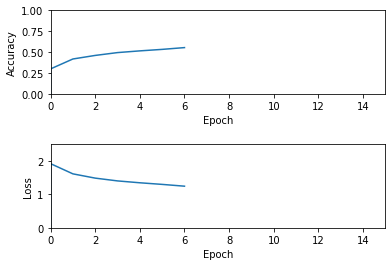

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a0model.ckpt Model Saved...
Epoch [175000], loss: 7.5461, acc: 0.0000
Epoch [175001], loss: 1.0170, acc: 1.0000
Epoch [175002], loss: 0.0325, acc: 1.0000
Epoch [175003], loss: 0.3052, acc: 1.0000
Epoch [175004], loss: 0.9222, acc: 0.0000
Epoch [175005], loss: 1.7232, acc: 0.0000
Epoch [175006], loss: 0.8252, acc: 1.0000
Epoch [175007], loss: 2.9225, acc: 0.0000
Epoch [175008], loss: 1.2244, acc: 1.0000
Epoch [175009], loss: 1.3244, acc: 1.0000
Epoch [175010], loss: 0.1269, acc: 1.0000
Epoch [175011], loss: 0.4279, acc: 1.0000
Epoch [175012], loss: 0.0163, acc: 1.0000
Epoch [175013], loss: 1.0691, acc: 0.0000
Epoch [175014], loss: 0.3784, acc: 1.0000
Epoch [175015], loss: 0.5289, acc: 1.0000
Epoch [175016], loss: 0.9317, acc: 1.0000
Epoch [175017], loss: 0.1127, acc: 1.0000
Epoch [175018], loss: 1.1083, acc: 1.0000
Epoch [175019], loss: 2.0985, acc: 0.0000
Epoch [175020], loss: 1.3853, acc: 0.0000
Epoch [175021],

Epoch [175208], loss: 1.0463, acc: 0.0000
Epoch [175209], loss: 0.3651, acc: 1.0000
Epoch [175210], loss: 1.4011, acc: 0.0000
Epoch [175211], loss: 0.5123, acc: 1.0000
Epoch [175212], loss: 0.9931, acc: 0.0000
Epoch [175213], loss: 2.4463, acc: 0.0000
Epoch [175214], loss: 0.3670, acc: 1.0000
Epoch [175215], loss: 1.2733, acc: 1.0000
Epoch [175216], loss: 0.1087, acc: 1.0000
Epoch [175217], loss: 1.5962, acc: 0.0000
Epoch [175218], loss: 1.0091, acc: 1.0000
Epoch [175219], loss: 1.5898, acc: 0.0000
Epoch [175220], loss: 1.8369, acc: 0.0000
Epoch [175221], loss: 0.9005, acc: 1.0000
Epoch [175222], loss: 2.7866, acc: 0.0000
Epoch [175223], loss: 0.6622, acc: 1.0000
Epoch [175224], loss: 3.8465, acc: 0.0000
Epoch [175225], loss: 1.0063, acc: 0.0000
Epoch [175226], loss: 0.1543, acc: 1.0000
Epoch [175227], loss: 1.4332, acc: 0.0000
Epoch [175228], loss: 2.2679, acc: 0.0000
Epoch [175229], loss: 0.4570, acc: 1.0000
Epoch [175230], loss: 0.7998, acc: 0.0000
Epoch [175231], loss: 2.7320, acc:

Epoch [175430], loss: 1.6126, acc: 0.0000
Epoch [175431], loss: 1.2259, acc: 0.0000
Epoch [175432], loss: 0.3218, acc: 1.0000
Epoch [175433], loss: 1.2103, acc: 0.0000
Epoch [175434], loss: 0.7131, acc: 1.0000
Epoch [175435], loss: 0.3026, acc: 1.0000
Epoch [175436], loss: 0.6058, acc: 1.0000
Epoch [175437], loss: 1.5364, acc: 0.0000
Epoch [175438], loss: 0.5088, acc: 1.0000
Epoch [175439], loss: 0.7804, acc: 1.0000
Epoch [175440], loss: 0.3691, acc: 1.0000
Epoch [175441], loss: 0.0374, acc: 1.0000
Epoch [175442], loss: 2.6926, acc: 0.0000
Epoch [175443], loss: 0.1812, acc: 1.0000
Epoch [175444], loss: 1.1990, acc: 0.0000
Epoch [175445], loss: 0.1693, acc: 1.0000
Epoch [175446], loss: 0.5517, acc: 1.0000
Epoch [175447], loss: 0.1902, acc: 1.0000
Epoch [175448], loss: 0.7567, acc: 1.0000
Epoch [175449], loss: 0.8737, acc: 1.0000
Epoch [175450], loss: 4.9801, acc: 0.0000
Epoch [175451], loss: 0.9678, acc: 1.0000
Epoch [175452], loss: 0.6950, acc: 1.0000
Epoch [175453], loss: 1.0730, acc:

Epoch [175633], loss: 0.2752, acc: 1.0000
Epoch [175634], loss: 0.1846, acc: 1.0000
Epoch [175635], loss: 1.4228, acc: 0.0000
Epoch [175636], loss: 1.7151, acc: 0.0000
Epoch [175637], loss: 2.0091, acc: 0.0000
Epoch [175638], loss: 0.9148, acc: 1.0000
Epoch [175639], loss: 1.0210, acc: 0.0000
Epoch [175640], loss: 1.5998, acc: 0.0000
Epoch [175641], loss: 0.9519, acc: 0.0000
Epoch [175642], loss: 1.5071, acc: 0.0000
Epoch [175643], loss: 1.1446, acc: 0.0000
Epoch [175644], loss: 3.1434, acc: 0.0000
Epoch [175645], loss: 0.8125, acc: 1.0000
Epoch [175646], loss: 0.5705, acc: 1.0000
Epoch [175647], loss: 2.3103, acc: 0.0000
Epoch [175648], loss: 1.0432, acc: 1.0000
Epoch [175649], loss: 1.5632, acc: 0.0000
Epoch [175650], loss: 0.8532, acc: 0.0000
Epoch [175651], loss: 1.1834, acc: 0.0000
Epoch [175652], loss: 0.4679, acc: 1.0000
Epoch [175653], loss: 1.8126, acc: 0.0000
Epoch [175654], loss: 0.7626, acc: 1.0000
Epoch [175655], loss: 1.7807, acc: 0.0000
Epoch [175656], loss: 0.3795, acc:

Epoch [175829], loss: 1.5651, acc: 0.0000
Epoch [175830], loss: 1.0657, acc: 1.0000
Epoch [175831], loss: 0.0207, acc: 1.0000
Epoch [175832], loss: 0.6290, acc: 1.0000
Epoch [175833], loss: 0.0295, acc: 1.0000
Epoch [175834], loss: 0.1868, acc: 1.0000
Epoch [175835], loss: 1.1185, acc: 0.0000
Epoch [175836], loss: 1.3444, acc: 0.0000
Epoch [175837], loss: 0.7326, acc: 1.0000
Epoch [175838], loss: 0.3577, acc: 1.0000
Epoch [175839], loss: 0.4965, acc: 1.0000
Epoch [175840], loss: 0.8212, acc: 1.0000
Epoch [175841], loss: 0.7129, acc: 1.0000
Epoch [175842], loss: 0.1073, acc: 1.0000
Epoch [175843], loss: 1.2300, acc: 1.0000
Epoch [175844], loss: 0.7211, acc: 1.0000
Epoch [175845], loss: 1.4533, acc: 0.0000
Epoch [175846], loss: 1.4214, acc: 0.0000
Epoch [175847], loss: 0.1261, acc: 1.0000
Epoch [175848], loss: 2.8119, acc: 0.0000
Epoch [175849], loss: 1.2816, acc: 0.0000
Epoch [175850], loss: 0.9670, acc: 0.0000
Epoch [175851], loss: 0.6576, acc: 1.0000
Epoch [175852], loss: 2.8377, acc:

Epoch [176033], loss: 0.0668, acc: 1.0000
Epoch [176034], loss: 0.0086, acc: 1.0000
Epoch [176035], loss: 0.5995, acc: 1.0000
Epoch [176036], loss: 0.5931, acc: 1.0000
Epoch [176037], loss: 3.2876, acc: 0.0000
Epoch [176038], loss: 1.9178, acc: 0.0000
Epoch [176039], loss: 1.7563, acc: 0.0000
Epoch [176040], loss: 2.6471, acc: 0.0000
Epoch [176041], loss: 0.2765, acc: 1.0000
Epoch [176042], loss: 1.0791, acc: 1.0000
Epoch [176043], loss: 1.3001, acc: 0.0000
Epoch [176044], loss: 0.3470, acc: 1.0000
Epoch [176045], loss: 6.1847, acc: 0.0000
Epoch [176046], loss: 0.1103, acc: 1.0000
Epoch [176047], loss: 0.3911, acc: 1.0000
Epoch [176048], loss: 0.0340, acc: 1.0000
Epoch [176049], loss: 1.2439, acc: 0.0000
Epoch [176050], loss: 0.6487, acc: 1.0000
Epoch [176051], loss: 0.3610, acc: 1.0000
Epoch [176052], loss: 0.7601, acc: 1.0000
Epoch [176053], loss: 0.9771, acc: 0.0000
Epoch [176054], loss: 1.1856, acc: 0.0000
Epoch [176055], loss: 1.7038, acc: 0.0000
Epoch [176056], loss: 0.2201, acc:

Epoch [176251], loss: 0.8979, acc: 1.0000
Epoch [176252], loss: 0.9220, acc: 0.0000
Epoch [176253], loss: 0.0841, acc: 1.0000
Epoch [176254], loss: 2.2431, acc: 0.0000
Epoch [176255], loss: 0.5169, acc: 1.0000
Epoch [176256], loss: 1.7506, acc: 0.0000
Epoch [176257], loss: 2.0945, acc: 0.0000
Epoch [176258], loss: 2.6899, acc: 0.0000
Epoch [176259], loss: 2.5107, acc: 0.0000
Epoch [176260], loss: 1.5536, acc: 0.0000
Epoch [176261], loss: 0.8200, acc: 1.0000
Epoch [176262], loss: 0.7032, acc: 1.0000
Epoch [176263], loss: 0.5725, acc: 1.0000
Epoch [176264], loss: 2.3371, acc: 0.0000
Epoch [176265], loss: 3.2239, acc: 0.0000
Epoch [176266], loss: 1.1500, acc: 1.0000
Epoch [176267], loss: 1.0174, acc: 1.0000
Epoch [176268], loss: 0.1975, acc: 1.0000
Epoch [176269], loss: 3.4089, acc: 0.0000
Epoch [176270], loss: 0.9061, acc: 1.0000
Epoch [176271], loss: 0.3954, acc: 1.0000
Epoch [176272], loss: 4.5571, acc: 0.0000
Epoch [176273], loss: 1.4559, acc: 0.0000
Epoch [176274], loss: 0.6049, acc:

Epoch [176447], loss: 0.4065, acc: 1.0000
Epoch [176448], loss: 0.1246, acc: 1.0000
Epoch [176449], loss: 0.9017, acc: 1.0000
Epoch [176450], loss: 1.5156, acc: 0.0000
Epoch [176451], loss: 3.9351, acc: 0.0000
Epoch [176452], loss: 2.8342, acc: 0.0000
Epoch [176453], loss: 0.0656, acc: 1.0000
Epoch [176454], loss: 0.1333, acc: 1.0000
Epoch [176455], loss: 1.3196, acc: 0.0000
Epoch [176456], loss: 0.5377, acc: 1.0000
Epoch [176457], loss: 0.8674, acc: 1.0000
Epoch [176458], loss: 0.6801, acc: 1.0000
Epoch [176459], loss: 1.7669, acc: 0.0000
Epoch [176460], loss: 1.3269, acc: 0.0000
Epoch [176461], loss: 0.0622, acc: 1.0000
Epoch [176462], loss: 1.7498, acc: 0.0000
Epoch [176463], loss: 1.1701, acc: 0.0000
Epoch [176464], loss: 1.1094, acc: 1.0000
Epoch [176465], loss: 2.0514, acc: 0.0000
Epoch [176466], loss: 0.0606, acc: 1.0000
Epoch [176467], loss: 0.1907, acc: 1.0000
Epoch [176468], loss: 1.2315, acc: 1.0000
Epoch [176469], loss: 3.2830, acc: 0.0000
Epoch [176470], loss: 0.2107, acc:

Epoch [176649], loss: 1.2662, acc: 0.0000
Epoch [176650], loss: 0.9163, acc: 0.0000
Epoch [176651], loss: 2.2598, acc: 0.0000
Epoch [176652], loss: 0.2486, acc: 1.0000
Epoch [176653], loss: 0.4185, acc: 1.0000
Epoch [176654], loss: 1.1212, acc: 1.0000
Epoch [176655], loss: 1.1314, acc: 1.0000
Epoch [176656], loss: 1.4804, acc: 0.0000
Epoch [176657], loss: 2.5933, acc: 0.0000
Epoch [176658], loss: 3.8002, acc: 0.0000
Epoch [176659], loss: 1.9475, acc: 0.0000
Epoch [176660], loss: 1.8194, acc: 0.0000
Epoch [176661], loss: 0.2076, acc: 1.0000
Epoch [176662], loss: 0.5635, acc: 1.0000
Epoch [176663], loss: 2.0910, acc: 0.0000
Epoch [176664], loss: 0.4684, acc: 1.0000
Epoch [176665], loss: 0.6664, acc: 1.0000
Epoch [176666], loss: 0.1872, acc: 1.0000
Epoch [176667], loss: 2.5704, acc: 0.0000
Epoch [176668], loss: 0.1639, acc: 1.0000
Epoch [176669], loss: 2.3727, acc: 0.0000
Epoch [176670], loss: 2.3419, acc: 0.0000
Epoch [176671], loss: 4.0232, acc: 0.0000
Epoch [176672], loss: 0.3342, acc:

Epoch [176845], loss: 1.4309, acc: 0.0000
Epoch [176846], loss: 1.2860, acc: 1.0000
Epoch [176847], loss: 2.5894, acc: 0.0000
Epoch [176848], loss: 1.2580, acc: 1.0000
Epoch [176849], loss: 2.4413, acc: 0.0000
Epoch [176850], loss: 0.1577, acc: 1.0000
Epoch [176851], loss: 2.2704, acc: 0.0000
Epoch [176852], loss: 0.0361, acc: 1.0000
Epoch [176853], loss: 2.2399, acc: 0.0000
Epoch [176854], loss: 0.4958, acc: 1.0000
Epoch [176855], loss: 1.9402, acc: 0.0000
Epoch [176856], loss: 1.8199, acc: 1.0000
Epoch [176857], loss: 0.6654, acc: 1.0000
Epoch [176858], loss: 3.5610, acc: 0.0000
Epoch [176859], loss: 2.3666, acc: 0.0000
Epoch [176860], loss: 1.9697, acc: 0.0000
Epoch [176861], loss: 3.8506, acc: 0.0000
Epoch [176862], loss: 1.6304, acc: 0.0000
Epoch [176863], loss: 0.2074, acc: 1.0000
Epoch [176864], loss: 0.3832, acc: 1.0000
Epoch [176865], loss: 1.6494, acc: 0.0000
Epoch [176866], loss: 0.1452, acc: 1.0000
Epoch [176867], loss: 0.1117, acc: 1.0000
Epoch [176868], loss: 0.1936, acc:

Epoch [177062], loss: 0.9303, acc: 1.0000
Epoch [177063], loss: 0.8326, acc: 1.0000
Epoch [177064], loss: 0.2568, acc: 1.0000
Epoch [177065], loss: 0.0377, acc: 1.0000
Epoch [177066], loss: 0.4167, acc: 1.0000
Epoch [177067], loss: 3.0244, acc: 0.0000
Epoch [177068], loss: 0.4744, acc: 1.0000
Epoch [177069], loss: 0.2876, acc: 1.0000
Epoch [177070], loss: 1.3895, acc: 0.0000
Epoch [177071], loss: 1.9240, acc: 0.0000
Epoch [177072], loss: 0.4991, acc: 1.0000
Epoch [177073], loss: 1.0762, acc: 0.0000
Epoch [177074], loss: 1.6679, acc: 0.0000
Epoch [177075], loss: 1.1128, acc: 0.0000
Epoch [177076], loss: 0.9511, acc: 1.0000
Epoch [177077], loss: 1.8038, acc: 0.0000
Epoch [177078], loss: 1.0113, acc: 1.0000
Epoch [177079], loss: 2.2987, acc: 0.0000
Epoch [177080], loss: 0.5474, acc: 1.0000
Epoch [177081], loss: 0.3877, acc: 1.0000
Epoch [177082], loss: 1.0323, acc: 0.0000
Epoch [177083], loss: 1.0529, acc: 1.0000
Epoch [177084], loss: 0.1569, acc: 1.0000
Epoch [177085], loss: 0.1770, acc:

Epoch [177275], loss: 0.2448, acc: 1.0000
Epoch [177276], loss: 1.6919, acc: 0.0000
Epoch [177277], loss: 4.5947, acc: 0.0000
Epoch [177278], loss: 3.3530, acc: 0.0000
Epoch [177279], loss: 0.1000, acc: 1.0000
Epoch [177280], loss: 2.5360, acc: 0.0000
Epoch [177281], loss: 1.6547, acc: 0.0000
Epoch [177282], loss: 2.0213, acc: 0.0000
Epoch [177283], loss: 0.0025, acc: 1.0000
Epoch [177284], loss: 1.2757, acc: 0.0000
Epoch [177285], loss: 0.9842, acc: 1.0000
Epoch [177286], loss: 1.0090, acc: 1.0000
Epoch [177287], loss: 0.1660, acc: 1.0000
Epoch [177288], loss: 0.3335, acc: 1.0000
Epoch [177289], loss: 0.1202, acc: 1.0000
Epoch [177290], loss: 2.2172, acc: 0.0000
Epoch [177291], loss: 0.2608, acc: 1.0000
Epoch [177292], loss: 0.9953, acc: 0.0000
Epoch [177293], loss: 3.2386, acc: 0.0000
Epoch [177294], loss: 0.1551, acc: 1.0000
Epoch [177295], loss: 1.1717, acc: 0.0000
Epoch [177296], loss: 1.5118, acc: 0.0000
Epoch [177297], loss: 0.7229, acc: 1.0000
Epoch [177298], loss: 0.9225, acc:

Epoch [177489], loss: 0.7074, acc: 1.0000
Epoch [177490], loss: 1.0474, acc: 1.0000
Epoch [177491], loss: 3.1386, acc: 0.0000
Epoch [177492], loss: 1.2144, acc: 0.0000
Epoch [177493], loss: 0.2744, acc: 1.0000
Epoch [177494], loss: 1.0275, acc: 0.0000
Epoch [177495], loss: 1.7182, acc: 0.0000
Epoch [177496], loss: 0.5883, acc: 1.0000
Epoch [177497], loss: 0.4988, acc: 1.0000
Epoch [177498], loss: 1.0438, acc: 0.0000
Epoch [177499], loss: 2.5301, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a2500model.ckpt Model Saved...
Epoch [177500], loss: 1.4622, acc: 0.0000
Epoch [177501], loss: 1.1920, acc: 1.0000
Epoch [177502], loss: 0.2711, acc: 1.0000
Epoch [177503], loss: 0.0318, acc: 1.0000
Epoch [177504], loss: 0.2325, acc: 1.0000
Epoch [177505], loss: 1.7057, acc: 0.0000
Epoch [177506], loss: 2.4500, acc: 0.0000
Epoch [177507], loss: 0.3124, acc: 1.0000
Epoch [177508], loss: 0.1678, acc: 1.0000
Epoch [177509], loss: 2.4893, acc: 0.0000
Epoch [17751

Epoch [177682], loss: 1.9264, acc: 0.0000
Epoch [177683], loss: 0.1010, acc: 1.0000
Epoch [177684], loss: 0.0210, acc: 1.0000
Epoch [177685], loss: 1.4897, acc: 0.0000
Epoch [177686], loss: 3.6623, acc: 0.0000
Epoch [177687], loss: 0.7872, acc: 1.0000
Epoch [177688], loss: 0.4177, acc: 1.0000
Epoch [177689], loss: 3.3199, acc: 0.0000
Epoch [177690], loss: 2.0788, acc: 0.0000
Epoch [177691], loss: 1.6652, acc: 0.0000
Epoch [177692], loss: 0.3123, acc: 1.0000
Epoch [177693], loss: 0.4145, acc: 1.0000
Epoch [177694], loss: 0.4719, acc: 1.0000
Epoch [177695], loss: 0.1994, acc: 1.0000
Epoch [177696], loss: 1.5366, acc: 0.0000
Epoch [177697], loss: 0.5938, acc: 1.0000
Epoch [177698], loss: 0.0801, acc: 1.0000
Epoch [177699], loss: 0.1832, acc: 1.0000
Epoch [177700], loss: 0.0396, acc: 1.0000
Epoch [177701], loss: 0.9859, acc: 1.0000
Epoch [177702], loss: 0.9810, acc: 1.0000
Epoch [177703], loss: 0.7663, acc: 1.0000
Epoch [177704], loss: 0.9994, acc: 0.0000
Epoch [177705], loss: 6.6241, acc:

Epoch [177896], loss: 0.5236, acc: 1.0000
Epoch [177897], loss: 1.1863, acc: 0.0000
Epoch [177898], loss: 0.7344, acc: 1.0000
Epoch [177899], loss: 0.5569, acc: 1.0000
Epoch [177900], loss: 1.8573, acc: 0.0000
Epoch [177901], loss: 0.8877, acc: 1.0000
Epoch [177902], loss: 1.6830, acc: 0.0000
Epoch [177903], loss: 0.0519, acc: 1.0000
Epoch [177904], loss: 2.6751, acc: 0.0000
Epoch [177905], loss: 1.8643, acc: 0.0000
Epoch [177906], loss: 0.1306, acc: 1.0000
Epoch [177907], loss: 0.7654, acc: 1.0000
Epoch [177908], loss: 0.6167, acc: 1.0000
Epoch [177909], loss: 0.3149, acc: 1.0000
Epoch [177910], loss: 0.0265, acc: 1.0000
Epoch [177911], loss: 0.0773, acc: 1.0000
Epoch [177912], loss: 0.0462, acc: 1.0000
Epoch [177913], loss: 3.6085, acc: 0.0000
Epoch [177914], loss: 0.9044, acc: 1.0000
Epoch [177915], loss: 0.3219, acc: 1.0000
Epoch [177916], loss: 2.1769, acc: 0.0000
Epoch [177917], loss: 0.9085, acc: 0.0000
Epoch [177918], loss: 0.0757, acc: 1.0000
Epoch [177919], loss: 0.0490, acc:

Epoch [178096], loss: 3.9817, acc: 0.0000
Epoch [178097], loss: 1.7893, acc: 0.0000
Epoch [178098], loss: 0.9371, acc: 1.0000
Epoch [178099], loss: 0.1604, acc: 1.0000
Epoch [178100], loss: 0.3470, acc: 1.0000
Epoch [178101], loss: 0.8899, acc: 1.0000
Epoch [178102], loss: 0.5991, acc: 1.0000
Epoch [178103], loss: 0.1264, acc: 1.0000
Epoch [178104], loss: 1.6901, acc: 0.0000
Epoch [178105], loss: 3.2230, acc: 0.0000
Epoch [178106], loss: 0.1245, acc: 1.0000
Epoch [178107], loss: 0.3408, acc: 1.0000
Epoch [178108], loss: 1.8340, acc: 0.0000
Epoch [178109], loss: 0.7813, acc: 1.0000
Epoch [178110], loss: 0.2977, acc: 1.0000
Epoch [178111], loss: 2.0395, acc: 0.0000
Epoch [178112], loss: 0.6873, acc: 1.0000
Epoch [178113], loss: 1.2727, acc: 0.0000
Epoch [178114], loss: 1.2514, acc: 1.0000
Epoch [178115], loss: 0.3675, acc: 1.0000
Epoch [178116], loss: 2.8403, acc: 0.0000
Epoch [178117], loss: 3.3375, acc: 0.0000
Epoch [178118], loss: 1.8183, acc: 0.0000
Epoch [178119], loss: 0.5769, acc:

Epoch [178306], loss: 0.6386, acc: 1.0000
Epoch [178307], loss: 0.2298, acc: 1.0000
Epoch [178308], loss: 1.7133, acc: 0.0000
Epoch [178309], loss: 0.4941, acc: 1.0000
Epoch [178310], loss: 0.8036, acc: 1.0000
Epoch [178311], loss: 5.4452, acc: 0.0000
Epoch [178312], loss: 4.2592, acc: 0.0000
Epoch [178313], loss: 0.9532, acc: 1.0000
Epoch [178314], loss: 1.0336, acc: 1.0000
Epoch [178315], loss: 0.0212, acc: 1.0000
Epoch [178316], loss: 0.5694, acc: 1.0000
Epoch [178317], loss: 1.6712, acc: 0.0000
Epoch [178318], loss: 0.9152, acc: 0.0000
Epoch [178319], loss: 1.7572, acc: 0.0000
Epoch [178320], loss: 0.4120, acc: 1.0000
Epoch [178321], loss: 0.3070, acc: 1.0000
Epoch [178322], loss: 3.2157, acc: 0.0000
Epoch [178323], loss: 0.9369, acc: 1.0000
Epoch [178324], loss: 0.3631, acc: 1.0000
Epoch [178325], loss: 1.5732, acc: 0.0000
Epoch [178326], loss: 0.1221, acc: 1.0000
Epoch [178327], loss: 0.9573, acc: 1.0000
Epoch [178328], loss: 1.6341, acc: 0.0000
Epoch [178329], loss: 0.4852, acc:

Epoch [178507], loss: 1.5226, acc: 0.0000
Epoch [178508], loss: 0.4176, acc: 1.0000
Epoch [178509], loss: 0.6944, acc: 1.0000
Epoch [178510], loss: 0.0379, acc: 1.0000
Epoch [178511], loss: 1.9438, acc: 0.0000
Epoch [178512], loss: 1.5552, acc: 1.0000
Epoch [178513], loss: 0.0670, acc: 1.0000
Epoch [178514], loss: 0.0940, acc: 1.0000
Epoch [178515], loss: 1.2697, acc: 1.0000
Epoch [178516], loss: 0.2981, acc: 1.0000
Epoch [178517], loss: 0.8921, acc: 1.0000
Epoch [178518], loss: 0.8046, acc: 1.0000
Epoch [178519], loss: 2.5094, acc: 0.0000
Epoch [178520], loss: 1.6356, acc: 0.0000
Epoch [178521], loss: 1.3123, acc: 0.0000
Epoch [178522], loss: 0.5236, acc: 1.0000
Epoch [178523], loss: 0.0613, acc: 1.0000
Epoch [178524], loss: 2.8010, acc: 0.0000
Epoch [178525], loss: 1.4356, acc: 0.0000
Epoch [178526], loss: 0.8259, acc: 1.0000
Epoch [178527], loss: 0.2265, acc: 1.0000
Epoch [178528], loss: 0.7259, acc: 1.0000
Epoch [178529], loss: 0.4975, acc: 1.0000
Epoch [178530], loss: 0.9224, acc:

Epoch [178725], loss: 1.5399, acc: 0.0000
Epoch [178726], loss: 2.6860, acc: 0.0000
Epoch [178727], loss: 0.9872, acc: 1.0000
Epoch [178728], loss: 0.3908, acc: 1.0000
Epoch [178729], loss: 1.9753, acc: 0.0000
Epoch [178730], loss: 1.7740, acc: 0.0000
Epoch [178731], loss: 0.9088, acc: 0.0000
Epoch [178732], loss: 0.3195, acc: 1.0000
Epoch [178733], loss: 1.6091, acc: 0.0000
Epoch [178734], loss: 4.0641, acc: 0.0000
Epoch [178735], loss: 1.2469, acc: 0.0000
Epoch [178736], loss: 2.0128, acc: 0.0000
Epoch [178737], loss: 0.9896, acc: 0.0000
Epoch [178738], loss: 0.3269, acc: 1.0000
Epoch [178739], loss: 0.8273, acc: 1.0000
Epoch [178740], loss: 0.5833, acc: 1.0000
Epoch [178741], loss: 0.0153, acc: 1.0000
Epoch [178742], loss: 0.5488, acc: 1.0000
Epoch [178743], loss: 5.9683, acc: 0.0000
Epoch [178744], loss: 1.4574, acc: 0.0000
Epoch [178745], loss: 1.3201, acc: 0.0000
Epoch [178746], loss: 0.0730, acc: 1.0000
Epoch [178747], loss: 0.6994, acc: 1.0000
Epoch [178748], loss: 0.4446, acc:

Epoch [178931], loss: 1.2848, acc: 0.0000
Epoch [178932], loss: 1.0249, acc: 1.0000
Epoch [178933], loss: 1.7605, acc: 0.0000
Epoch [178934], loss: 1.1514, acc: 0.0000
Epoch [178935], loss: 0.0846, acc: 1.0000
Epoch [178936], loss: 0.2185, acc: 1.0000
Epoch [178937], loss: 0.0378, acc: 1.0000
Epoch [178938], loss: 0.0276, acc: 1.0000
Epoch [178939], loss: 0.2408, acc: 1.0000
Epoch [178940], loss: 0.8954, acc: 0.0000
Epoch [178941], loss: 0.8163, acc: 1.0000
Epoch [178942], loss: 3.1908, acc: 0.0000
Epoch [178943], loss: 0.1664, acc: 1.0000
Epoch [178944], loss: 2.6534, acc: 0.0000
Epoch [178945], loss: 1.3800, acc: 0.0000
Epoch [178946], loss: 0.2725, acc: 1.0000
Epoch [178947], loss: 0.6861, acc: 1.0000
Epoch [178948], loss: 4.0070, acc: 0.0000
Epoch [178949], loss: 2.5692, acc: 0.0000
Epoch [178950], loss: 0.8706, acc: 1.0000
Epoch [178951], loss: 3.7203, acc: 0.0000
Epoch [178952], loss: 2.2443, acc: 0.0000
Epoch [178953], loss: 3.0532, acc: 0.0000
Epoch [178954], loss: 0.0639, acc:

Epoch [179127], loss: 1.1029, acc: 1.0000
Epoch [179128], loss: 2.4196, acc: 0.0000
Epoch [179129], loss: 2.5712, acc: 0.0000
Epoch [179130], loss: 1.2950, acc: 0.0000
Epoch [179131], loss: 1.0204, acc: 1.0000
Epoch [179132], loss: 1.7258, acc: 0.0000
Epoch [179133], loss: 2.2726, acc: 0.0000
Epoch [179134], loss: 0.6353, acc: 1.0000
Epoch [179135], loss: 0.1806, acc: 1.0000
Epoch [179136], loss: 1.0883, acc: 0.0000
Epoch [179137], loss: 0.5981, acc: 1.0000
Epoch [179138], loss: 3.3192, acc: 0.0000
Epoch [179139], loss: 0.2405, acc: 1.0000
Epoch [179140], loss: 2.7958, acc: 0.0000
Epoch [179141], loss: 0.9952, acc: 1.0000
Epoch [179142], loss: 1.0287, acc: 0.0000
Epoch [179143], loss: 1.0491, acc: 1.0000
Epoch [179144], loss: 3.5720, acc: 0.0000
Epoch [179145], loss: 1.5774, acc: 0.0000
Epoch [179146], loss: 0.1637, acc: 1.0000
Epoch [179147], loss: 1.3920, acc: 0.0000
Epoch [179148], loss: 1.2209, acc: 1.0000
Epoch [179149], loss: 3.0560, acc: 0.0000
Epoch [179150], loss: 0.0501, acc:

Epoch [179348], loss: 0.6713, acc: 1.0000
Epoch [179349], loss: 1.1748, acc: 1.0000
Epoch [179350], loss: 3.9233, acc: 0.0000
Epoch [179351], loss: 2.1712, acc: 0.0000
Epoch [179352], loss: 2.0234, acc: 0.0000
Epoch [179353], loss: 2.0526, acc: 0.0000
Epoch [179354], loss: 1.1527, acc: 1.0000
Epoch [179355], loss: 1.0117, acc: 1.0000
Epoch [179356], loss: 0.8741, acc: 1.0000
Epoch [179357], loss: 1.7003, acc: 0.0000
Epoch [179358], loss: 1.0946, acc: 1.0000
Epoch [179359], loss: 0.0102, acc: 1.0000
Epoch [179360], loss: 0.7148, acc: 1.0000
Epoch [179361], loss: 1.1049, acc: 0.0000
Epoch [179362], loss: 0.5964, acc: 1.0000
Epoch [179363], loss: 1.8660, acc: 0.0000
Epoch [179364], loss: 0.7861, acc: 1.0000
Epoch [179365], loss: 0.6527, acc: 1.0000
Epoch [179366], loss: 0.0896, acc: 1.0000
Epoch [179367], loss: 3.1480, acc: 0.0000
Epoch [179368], loss: 1.7954, acc: 0.0000
Epoch [179369], loss: 0.8727, acc: 1.0000
Epoch [179370], loss: 0.5735, acc: 1.0000
Epoch [179371], loss: 1.7195, acc:

Epoch [179552], loss: 0.5670, acc: 1.0000
Epoch [179553], loss: 1.1977, acc: 1.0000
Epoch [179554], loss: 0.6324, acc: 1.0000
Epoch [179555], loss: 0.3523, acc: 1.0000
Epoch [179556], loss: 1.6815, acc: 0.0000
Epoch [179557], loss: 1.3394, acc: 0.0000
Epoch [179558], loss: 0.8730, acc: 1.0000
Epoch [179559], loss: 1.6672, acc: 0.0000
Epoch [179560], loss: 0.1819, acc: 1.0000
Epoch [179561], loss: 1.1058, acc: 1.0000
Epoch [179562], loss: 0.1763, acc: 1.0000
Epoch [179563], loss: 2.5659, acc: 0.0000
Epoch [179564], loss: 0.7436, acc: 1.0000
Epoch [179565], loss: 0.4726, acc: 1.0000
Epoch [179566], loss: 0.2151, acc: 1.0000
Epoch [179567], loss: 2.0451, acc: 0.0000
Epoch [179568], loss: 0.8676, acc: 1.0000
Epoch [179569], loss: 0.9812, acc: 1.0000
Epoch [179570], loss: 0.7942, acc: 1.0000
Epoch [179571], loss: 0.5397, acc: 1.0000
Epoch [179572], loss: 0.3678, acc: 1.0000
Epoch [179573], loss: 2.6981, acc: 0.0000
Epoch [179574], loss: 1.0272, acc: 0.0000
Epoch [179575], loss: 1.1752, acc:

Epoch [179756], loss: 2.7837, acc: 0.0000
Epoch [179757], loss: 1.5344, acc: 0.0000
Epoch [179758], loss: 1.2407, acc: 1.0000
Epoch [179759], loss: 0.5576, acc: 1.0000
Epoch [179760], loss: 1.6257, acc: 0.0000
Epoch [179761], loss: 4.2737, acc: 0.0000
Epoch [179762], loss: 1.1955, acc: 1.0000
Epoch [179763], loss: 1.8083, acc: 0.0000
Epoch [179764], loss: 0.1762, acc: 1.0000
Epoch [179765], loss: 1.2964, acc: 0.0000
Epoch [179766], loss: 2.8225, acc: 0.0000
Epoch [179767], loss: 1.6915, acc: 0.0000
Epoch [179768], loss: 2.6253, acc: 0.0000
Epoch [179769], loss: 0.0566, acc: 1.0000
Epoch [179770], loss: 3.3321, acc: 0.0000
Epoch [179771], loss: 1.5507, acc: 0.0000
Epoch [179772], loss: 2.5937, acc: 0.0000
Epoch [179773], loss: 0.1933, acc: 1.0000
Epoch [179774], loss: 1.1670, acc: 1.0000
Epoch [179775], loss: 1.2529, acc: 0.0000
Epoch [179776], loss: 4.4378, acc: 0.0000
Epoch [179777], loss: 3.0755, acc: 0.0000
Epoch [179778], loss: 1.6842, acc: 0.0000
Epoch [179779], loss: 2.6908, acc:

Epoch [179961], loss: 0.5093, acc: 1.0000
Epoch [179962], loss: 0.6875, acc: 1.0000
Epoch [179963], loss: 3.2588, acc: 0.0000
Epoch [179964], loss: 0.2862, acc: 1.0000
Epoch [179965], loss: 0.6452, acc: 1.0000
Epoch [179966], loss: 1.3234, acc: 1.0000
Epoch [179967], loss: 2.0502, acc: 0.0000
Epoch [179968], loss: 1.8965, acc: 0.0000
Epoch [179969], loss: 0.4677, acc: 1.0000
Epoch [179970], loss: 1.6858, acc: 0.0000
Epoch [179971], loss: 3.1131, acc: 0.0000
Epoch [179972], loss: 1.0137, acc: 1.0000
Epoch [179973], loss: 0.8679, acc: 1.0000
Epoch [179974], loss: 2.4051, acc: 0.0000
Epoch [179975], loss: 1.2624, acc: 1.0000
Epoch [179976], loss: 4.3797, acc: 0.0000
Epoch [179977], loss: 2.4892, acc: 0.0000
Epoch [179978], loss: 1.1838, acc: 0.0000
Epoch [179979], loss: 0.6699, acc: 1.0000
Epoch [179980], loss: 0.8185, acc: 1.0000
Epoch [179981], loss: 2.5626, acc: 0.0000
Epoch [179982], loss: 0.0998, acc: 1.0000
Epoch [179983], loss: 3.2018, acc: 0.0000
Epoch [179984], loss: 0.1944, acc:

Epoch [180158], loss: 0.5207, acc: 1.0000
Epoch [180159], loss: 0.9333, acc: 1.0000
Epoch [180160], loss: 1.5366, acc: 0.0000
Epoch [180161], loss: 1.2782, acc: 0.0000
Epoch [180162], loss: 1.0701, acc: 0.0000
Epoch [180163], loss: 2.8975, acc: 0.0000
Epoch [180164], loss: 0.4773, acc: 1.0000
Epoch [180165], loss: 2.7032, acc: 0.0000
Epoch [180166], loss: 1.7378, acc: 0.0000
Epoch [180167], loss: 0.2474, acc: 1.0000
Epoch [180168], loss: 1.2054, acc: 1.0000
Epoch [180169], loss: 0.9102, acc: 1.0000
Epoch [180170], loss: 0.4357, acc: 1.0000
Epoch [180171], loss: 0.3956, acc: 1.0000
Epoch [180172], loss: 0.8904, acc: 1.0000
Epoch [180173], loss: 1.8054, acc: 0.0000
Epoch [180174], loss: 0.4648, acc: 1.0000
Epoch [180175], loss: 1.5165, acc: 1.0000
Epoch [180176], loss: 0.2649, acc: 1.0000
Epoch [180177], loss: 1.0216, acc: 1.0000
Epoch [180178], loss: 2.4368, acc: 0.0000
Epoch [180179], loss: 1.8041, acc: 0.0000
Epoch [180180], loss: 0.1798, acc: 1.0000
Epoch [180181], loss: 1.6057, acc:

Epoch [180359], loss: 0.4117, acc: 1.0000
Epoch [180360], loss: 1.5377, acc: 0.0000
Epoch [180361], loss: 3.1033, acc: 0.0000
Epoch [180362], loss: 2.0459, acc: 0.0000
Epoch [180363], loss: 0.0838, acc: 1.0000
Epoch [180364], loss: 1.5865, acc: 0.0000
Epoch [180365], loss: 2.4271, acc: 0.0000
Epoch [180366], loss: 1.4019, acc: 0.0000
Epoch [180367], loss: 0.8803, acc: 0.0000
Epoch [180368], loss: 1.3968, acc: 0.0000
Epoch [180369], loss: 0.7819, acc: 1.0000
Epoch [180370], loss: 0.8186, acc: 1.0000
Epoch [180371], loss: 1.3770, acc: 0.0000
Epoch [180372], loss: 2.6685, acc: 0.0000
Epoch [180373], loss: 3.6218, acc: 0.0000
Epoch [180374], loss: 1.3329, acc: 1.0000
Epoch [180375], loss: 0.5874, acc: 1.0000
Epoch [180376], loss: 3.3209, acc: 0.0000
Epoch [180377], loss: 0.3861, acc: 1.0000
Epoch [180378], loss: 3.0143, acc: 0.0000
Epoch [180379], loss: 3.5161, acc: 0.0000
Epoch [180380], loss: 1.1441, acc: 0.0000
Epoch [180381], loss: 1.4100, acc: 0.0000
Epoch [180382], loss: 0.6137, acc:

Epoch [180555], loss: 0.7258, acc: 1.0000
Epoch [180556], loss: 0.3774, acc: 1.0000
Epoch [180557], loss: 1.5447, acc: 0.0000
Epoch [180558], loss: 0.0987, acc: 1.0000
Epoch [180559], loss: 1.6964, acc: 0.0000
Epoch [180560], loss: 1.3911, acc: 0.0000
Epoch [180561], loss: 1.4260, acc: 0.0000
Epoch [180562], loss: 2.0007, acc: 0.0000
Epoch [180563], loss: 0.0825, acc: 1.0000
Epoch [180564], loss: 1.4390, acc: 0.0000
Epoch [180565], loss: 2.4872, acc: 0.0000
Epoch [180566], loss: 1.7593, acc: 0.0000
Epoch [180567], loss: 1.7682, acc: 0.0000
Epoch [180568], loss: 0.1873, acc: 1.0000
Epoch [180569], loss: 0.3698, acc: 1.0000
Epoch [180570], loss: 3.3017, acc: 0.0000
Epoch [180571], loss: 2.4716, acc: 0.0000
Epoch [180572], loss: 2.0118, acc: 0.0000
Epoch [180573], loss: 1.1699, acc: 0.0000
Epoch [180574], loss: 0.9702, acc: 1.0000
Epoch [180575], loss: 0.4664, acc: 1.0000
Epoch [180576], loss: 1.1021, acc: 1.0000
Epoch [180577], loss: 1.0195, acc: 1.0000
Epoch [180578], loss: 1.3904, acc:

Epoch [180760], loss: 0.2859, acc: 1.0000
Epoch [180761], loss: 1.3873, acc: 0.0000
Epoch [180762], loss: 0.7476, acc: 1.0000
Epoch [180763], loss: 0.2277, acc: 1.0000
Epoch [180764], loss: 0.3714, acc: 1.0000
Epoch [180765], loss: 0.7117, acc: 1.0000
Epoch [180766], loss: 0.1828, acc: 1.0000
Epoch [180767], loss: 2.5814, acc: 0.0000
Epoch [180768], loss: 2.0104, acc: 0.0000
Epoch [180769], loss: 0.3788, acc: 1.0000
Epoch [180770], loss: 1.1965, acc: 1.0000
Epoch [180771], loss: 3.4707, acc: 0.0000
Epoch [180772], loss: 0.2612, acc: 1.0000
Epoch [180773], loss: 0.3055, acc: 1.0000
Epoch [180774], loss: 1.8763, acc: 0.0000
Epoch [180775], loss: 0.5570, acc: 1.0000
Epoch [180776], loss: 1.2902, acc: 1.0000
Epoch [180777], loss: 0.3643, acc: 1.0000
Epoch [180778], loss: 1.0609, acc: 0.0000
Epoch [180779], loss: 1.7660, acc: 0.0000
Epoch [180780], loss: 0.2009, acc: 1.0000
Epoch [180781], loss: 2.6603, acc: 0.0000
Epoch [180782], loss: 0.2443, acc: 1.0000
Epoch [180783], loss: 0.4251, acc:

Epoch [180962], loss: 0.5576, acc: 1.0000
Epoch [180963], loss: 1.9527, acc: 0.0000
Epoch [180964], loss: 3.3130, acc: 0.0000
Epoch [180965], loss: 0.5880, acc: 1.0000
Epoch [180966], loss: 1.4651, acc: 0.0000
Epoch [180967], loss: 1.1775, acc: 0.0000
Epoch [180968], loss: 0.2437, acc: 1.0000
Epoch [180969], loss: 3.3295, acc: 0.0000
Epoch [180970], loss: 1.7099, acc: 0.0000
Epoch [180971], loss: 0.4896, acc: 1.0000
Epoch [180972], loss: 1.1008, acc: 0.0000
Epoch [180973], loss: 0.4130, acc: 1.0000
Epoch [180974], loss: 4.5176, acc: 0.0000
Epoch [180975], loss: 0.8837, acc: 1.0000
Epoch [180976], loss: 0.1055, acc: 1.0000
Epoch [180977], loss: 0.2269, acc: 1.0000
Epoch [180978], loss: 1.3391, acc: 0.0000
Epoch [180979], loss: 0.9359, acc: 1.0000
Epoch [180980], loss: 0.8842, acc: 1.0000
Epoch [180981], loss: 0.6989, acc: 1.0000
Epoch [180982], loss: 0.1505, acc: 1.0000
Epoch [180983], loss: 1.1248, acc: 1.0000
Epoch [180984], loss: 1.1624, acc: 1.0000
Epoch [180985], loss: 4.5341, acc:

Epoch [181155], loss: 0.0343, acc: 1.0000
Epoch [181156], loss: 0.0495, acc: 1.0000
Epoch [181157], loss: 0.5943, acc: 1.0000
Epoch [181158], loss: 2.1940, acc: 0.0000
Epoch [181159], loss: 0.5415, acc: 1.0000
Epoch [181160], loss: 1.7042, acc: 0.0000
Epoch [181161], loss: 2.5420, acc: 0.0000
Epoch [181162], loss: 0.7422, acc: 1.0000
Epoch [181163], loss: 2.1539, acc: 0.0000
Epoch [181164], loss: 1.2945, acc: 1.0000
Epoch [181165], loss: 0.0509, acc: 1.0000
Epoch [181166], loss: 1.3507, acc: 0.0000
Epoch [181167], loss: 3.8090, acc: 0.0000
Epoch [181168], loss: 4.4385, acc: 0.0000
Epoch [181169], loss: 0.8519, acc: 0.0000
Epoch [181170], loss: 0.3888, acc: 1.0000
Epoch [181171], loss: 0.1500, acc: 1.0000
Epoch [181172], loss: 0.5899, acc: 1.0000
Epoch [181173], loss: 3.2602, acc: 0.0000
Epoch [181174], loss: 1.4044, acc: 0.0000
Epoch [181175], loss: 0.9578, acc: 1.0000
Epoch [181176], loss: 1.1526, acc: 1.0000
Epoch [181177], loss: 0.7076, acc: 1.0000
Epoch [181178], loss: 2.2796, acc:

Epoch [181352], loss: 1.4062, acc: 1.0000
Epoch [181353], loss: 0.9327, acc: 1.0000
Epoch [181354], loss: 3.2260, acc: 0.0000
Epoch [181355], loss: 0.4531, acc: 1.0000
Epoch [181356], loss: 0.0686, acc: 1.0000
Epoch [181357], loss: 1.3758, acc: 0.0000
Epoch [181358], loss: 0.3260, acc: 1.0000
Epoch [181359], loss: 2.9369, acc: 0.0000
Epoch [181360], loss: 1.5844, acc: 0.0000
Epoch [181361], loss: 1.5063, acc: 1.0000
Epoch [181362], loss: 1.0858, acc: 1.0000
Epoch [181363], loss: 1.2169, acc: 0.0000
Epoch [181364], loss: 1.6995, acc: 0.0000
Epoch [181365], loss: 1.7337, acc: 0.0000
Epoch [181366], loss: 0.0276, acc: 1.0000
Epoch [181367], loss: 1.4294, acc: 0.0000
Epoch [181368], loss: 2.4395, acc: 0.0000
Epoch [181369], loss: 2.0907, acc: 0.0000
Epoch [181370], loss: 0.5329, acc: 1.0000
Epoch [181371], loss: 2.0761, acc: 0.0000
Epoch [181372], loss: 0.7288, acc: 1.0000
Epoch [181373], loss: 1.9510, acc: 0.0000
Epoch [181374], loss: 2.3494, acc: 0.0000
Epoch [181375], loss: 0.3902, acc:

Epoch [181551], loss: 0.0482, acc: 1.0000
Epoch [181552], loss: 0.9970, acc: 1.0000
Epoch [181553], loss: 3.8927, acc: 0.0000
Epoch [181554], loss: 0.4456, acc: 1.0000
Epoch [181555], loss: 0.0847, acc: 1.0000
Epoch [181556], loss: 0.0563, acc: 1.0000
Epoch [181557], loss: 1.3811, acc: 0.0000
Epoch [181558], loss: 0.9111, acc: 1.0000
Epoch [181559], loss: 0.1519, acc: 1.0000
Epoch [181560], loss: 0.3734, acc: 1.0000
Epoch [181561], loss: 0.1305, acc: 1.0000
Epoch [181562], loss: 0.5030, acc: 1.0000
Epoch [181563], loss: 5.8690, acc: 0.0000
Epoch [181564], loss: 0.7277, acc: 1.0000
Epoch [181565], loss: 0.1212, acc: 1.0000
Epoch [181566], loss: 0.1776, acc: 1.0000
Epoch [181567], loss: 0.7938, acc: 1.0000
Epoch [181568], loss: 1.8038, acc: 0.0000
Epoch [181569], loss: 1.4058, acc: 0.0000
Epoch [181570], loss: 2.5785, acc: 0.0000
Epoch [181571], loss: 0.4763, acc: 1.0000
Epoch [181572], loss: 0.4469, acc: 1.0000
Epoch [181573], loss: 1.1402, acc: 0.0000
Epoch [181574], loss: 2.2259, acc:

Epoch [181747], loss: 3.6845, acc: 0.0000
Epoch [181748], loss: 2.0236, acc: 0.0000
Epoch [181749], loss: 1.0928, acc: 1.0000
Epoch [181750], loss: 3.3547, acc: 0.0000
Epoch [181751], loss: 1.5158, acc: 0.0000
Epoch [181752], loss: 1.2091, acc: 0.0000
Epoch [181753], loss: 0.8075, acc: 1.0000
Epoch [181754], loss: 0.6723, acc: 1.0000
Epoch [181755], loss: 0.0434, acc: 1.0000
Epoch [181756], loss: 2.7820, acc: 0.0000
Epoch [181757], loss: 0.2680, acc: 1.0000
Epoch [181758], loss: 1.5822, acc: 0.0000
Epoch [181759], loss: 2.9084, acc: 0.0000
Epoch [181760], loss: 0.0034, acc: 1.0000
Epoch [181761], loss: 0.1921, acc: 1.0000
Epoch [181762], loss: 0.6364, acc: 1.0000
Epoch [181763], loss: 0.4127, acc: 1.0000
Epoch [181764], loss: 0.3448, acc: 1.0000
Epoch [181765], loss: 0.5609, acc: 1.0000
Epoch [181766], loss: 0.4172, acc: 1.0000
Epoch [181767], loss: 0.8259, acc: 0.0000
Epoch [181768], loss: 2.2416, acc: 0.0000
Epoch [181769], loss: 1.2807, acc: 1.0000
Epoch [181770], loss: 0.2279, acc:

Epoch [181959], loss: 1.0479, acc: 1.0000
Epoch [181960], loss: 0.3786, acc: 1.0000
Epoch [181961], loss: 1.0129, acc: 1.0000
Epoch [181962], loss: 2.6422, acc: 0.0000
Epoch [181963], loss: 2.1906, acc: 0.0000
Epoch [181964], loss: 1.4514, acc: 0.0000
Epoch [181965], loss: 1.1647, acc: 0.0000
Epoch [181966], loss: 0.4555, acc: 1.0000
Epoch [181967], loss: 0.8851, acc: 1.0000
Epoch [181968], loss: 0.6173, acc: 1.0000
Epoch [181969], loss: 0.6075, acc: 1.0000
Epoch [181970], loss: 0.9536, acc: 1.0000
Epoch [181971], loss: 2.1137, acc: 0.0000
Epoch [181972], loss: 0.1515, acc: 1.0000
Epoch [181973], loss: 0.9538, acc: 0.0000
Epoch [181974], loss: 1.6257, acc: 0.0000
Epoch [181975], loss: 0.3055, acc: 1.0000
Epoch [181976], loss: 0.3417, acc: 1.0000
Epoch [181977], loss: 2.3284, acc: 0.0000
Epoch [181978], loss: 1.2371, acc: 1.0000
Epoch [181979], loss: 0.8499, acc: 1.0000
Epoch [181980], loss: 0.1763, acc: 1.0000
Epoch [181981], loss: 0.3860, acc: 1.0000
Epoch [181982], loss: 0.6368, acc:

Epoch [182170], loss: 4.0543, acc: 0.0000
Epoch [182171], loss: 1.1202, acc: 0.0000
Epoch [182172], loss: 1.0065, acc: 1.0000
Epoch [182173], loss: 1.4847, acc: 0.0000
Epoch [182174], loss: 1.5489, acc: 0.0000
Epoch [182175], loss: 2.1025, acc: 0.0000
Epoch [182176], loss: 1.4826, acc: 0.0000
Epoch [182177], loss: 2.5081, acc: 0.0000
Epoch [182178], loss: 1.1833, acc: 1.0000
Epoch [182179], loss: 0.9573, acc: 1.0000
Epoch [182180], loss: 0.8081, acc: 0.0000
Epoch [182181], loss: 0.7544, acc: 1.0000
Epoch [182182], loss: 1.9247, acc: 0.0000
Epoch [182183], loss: 0.0897, acc: 1.0000
Epoch [182184], loss: 1.6084, acc: 0.0000
Epoch [182185], loss: 1.5535, acc: 0.0000
Epoch [182186], loss: 2.0194, acc: 0.0000
Epoch [182187], loss: 0.6289, acc: 1.0000
Epoch [182188], loss: 0.5086, acc: 1.0000
Epoch [182189], loss: 1.2639, acc: 0.0000
Epoch [182190], loss: 1.4219, acc: 0.0000
Epoch [182191], loss: 3.5306, acc: 0.0000
Epoch [182192], loss: 0.1183, acc: 1.0000
Epoch [182193], loss: 0.0084, acc:

Epoch [182368], loss: 4.2198, acc: 0.0000
Epoch [182369], loss: 0.3030, acc: 1.0000
Epoch [182370], loss: 1.1199, acc: 1.0000
Epoch [182371], loss: 0.1687, acc: 1.0000
Epoch [182372], loss: 1.2039, acc: 1.0000
Epoch [182373], loss: 0.5096, acc: 1.0000
Epoch [182374], loss: 1.4574, acc: 0.0000
Epoch [182375], loss: 0.2653, acc: 1.0000
Epoch [182376], loss: 0.7129, acc: 1.0000
Epoch [182377], loss: 0.0010, acc: 1.0000
Epoch [182378], loss: 0.4254, acc: 1.0000
Epoch [182379], loss: 0.0351, acc: 1.0000
Epoch [182380], loss: 2.2890, acc: 0.0000
Epoch [182381], loss: 0.1179, acc: 1.0000
Epoch [182382], loss: 0.2681, acc: 1.0000
Epoch [182383], loss: 1.9168, acc: 0.0000
Epoch [182384], loss: 0.1777, acc: 1.0000
Epoch [182385], loss: 1.5217, acc: 0.0000
Epoch [182386], loss: 0.8620, acc: 1.0000
Epoch [182387], loss: 0.4483, acc: 1.0000
Epoch [182388], loss: 3.3434, acc: 0.0000
Epoch [182389], loss: 2.4549, acc: 0.0000
Epoch [182390], loss: 1.0748, acc: 0.0000
Epoch [182391], loss: 0.0686, acc:

Epoch [182570], loss: 0.3572, acc: 1.0000
Epoch [182571], loss: 0.3036, acc: 1.0000
Epoch [182572], loss: 0.3018, acc: 1.0000
Epoch [182573], loss: 2.7787, acc: 0.0000
Epoch [182574], loss: 1.6744, acc: 0.0000
Epoch [182575], loss: 0.8079, acc: 1.0000
Epoch [182576], loss: 0.7948, acc: 1.0000
Epoch [182577], loss: 0.2760, acc: 1.0000
Epoch [182578], loss: 0.1054, acc: 1.0000
Epoch [182579], loss: 1.3779, acc: 0.0000
Epoch [182580], loss: 0.5225, acc: 1.0000
Epoch [182581], loss: 0.1681, acc: 1.0000
Epoch [182582], loss: 1.6361, acc: 0.0000
Epoch [182583], loss: 0.5052, acc: 1.0000
Epoch [182584], loss: 0.7092, acc: 1.0000
Epoch [182585], loss: 2.1059, acc: 0.0000
Epoch [182586], loss: 3.3553, acc: 0.0000
Epoch [182587], loss: 0.4620, acc: 1.0000
Epoch [182588], loss: 2.9351, acc: 0.0000
Epoch [182589], loss: 0.6650, acc: 1.0000
Epoch [182590], loss: 2.4312, acc: 0.0000
Epoch [182591], loss: 0.9912, acc: 1.0000
Epoch [182592], loss: 1.5359, acc: 0.0000
Epoch [182593], loss: 0.5021, acc:

Epoch [182794], loss: 0.7287, acc: 1.0000
Epoch [182795], loss: 2.0406, acc: 0.0000
Epoch [182796], loss: 0.5894, acc: 1.0000
Epoch [182797], loss: 0.3756, acc: 1.0000
Epoch [182798], loss: 0.8951, acc: 1.0000
Epoch [182799], loss: 0.6712, acc: 1.0000
Epoch [182800], loss: 0.7371, acc: 1.0000
Epoch [182801], loss: 0.1009, acc: 1.0000
Epoch [182802], loss: 0.7861, acc: 1.0000
Epoch [182803], loss: 0.8576, acc: 1.0000
Epoch [182804], loss: 2.7236, acc: 0.0000
Epoch [182805], loss: 1.8371, acc: 0.0000
Epoch [182806], loss: 0.4250, acc: 1.0000
Epoch [182807], loss: 1.2012, acc: 0.0000
Epoch [182808], loss: 0.6015, acc: 1.0000
Epoch [182809], loss: 1.4483, acc: 0.0000
Epoch [182810], loss: 0.2461, acc: 1.0000
Epoch [182811], loss: 0.5744, acc: 1.0000
Epoch [182812], loss: 1.5243, acc: 0.0000
Epoch [182813], loss: 0.0804, acc: 1.0000
Epoch [182814], loss: 0.2755, acc: 1.0000
Epoch [182815], loss: 1.2835, acc: 1.0000
Epoch [182816], loss: 0.3058, acc: 1.0000
Epoch [182817], loss: 1.9454, acc:

Epoch [182994], loss: 0.7693, acc: 1.0000
Epoch [182995], loss: 1.3180, acc: 0.0000
Epoch [182996], loss: 0.8710, acc: 1.0000
Epoch [182997], loss: 0.8722, acc: 0.0000
Epoch [182998], loss: 0.9115, acc: 1.0000
Epoch [182999], loss: 0.8157, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a8000model.ckpt Model Saved...
Epoch [183000], loss: 0.7770, acc: 1.0000
Epoch [183001], loss: 0.3819, acc: 1.0000
Epoch [183002], loss: 0.4777, acc: 1.0000
Epoch [183003], loss: 2.1736, acc: 0.0000
Epoch [183004], loss: 1.8544, acc: 0.0000
Epoch [183005], loss: 0.2027, acc: 1.0000
Epoch [183006], loss: 1.0690, acc: 0.0000
Epoch [183007], loss: 0.8910, acc: 1.0000
Epoch [183008], loss: 1.9709, acc: 0.0000
Epoch [183009], loss: 0.0804, acc: 1.0000
Epoch [183010], loss: 1.0265, acc: 1.0000
Epoch [183011], loss: 1.2702, acc: 0.0000
Epoch [183012], loss: 0.8879, acc: 1.0000
Epoch [183013], loss: 0.3848, acc: 1.0000
Epoch [183014], loss: 1.2107, acc: 1.0000
Epoch [18301

Epoch [183189], loss: 1.4000, acc: 0.0000
Epoch [183190], loss: 0.5688, acc: 1.0000
Epoch [183191], loss: 0.5005, acc: 1.0000
Epoch [183192], loss: 2.4134, acc: 0.0000
Epoch [183193], loss: 0.8926, acc: 1.0000
Epoch [183194], loss: 0.8807, acc: 0.0000
Epoch [183195], loss: 0.3740, acc: 1.0000
Epoch [183196], loss: 0.7685, acc: 1.0000
Epoch [183197], loss: 1.2339, acc: 1.0000
Epoch [183198], loss: 1.0078, acc: 1.0000
Epoch [183199], loss: 2.9907, acc: 0.0000
Epoch [183200], loss: 0.0124, acc: 1.0000
Epoch [183201], loss: 0.3551, acc: 1.0000
Epoch [183202], loss: 1.5888, acc: 0.0000
Epoch [183203], loss: 0.7326, acc: 1.0000
Epoch [183204], loss: 0.8740, acc: 1.0000
Epoch [183205], loss: 1.8932, acc: 0.0000
Epoch [183206], loss: 0.4238, acc: 1.0000
Epoch [183207], loss: 0.0911, acc: 1.0000
Epoch [183208], loss: 0.3094, acc: 1.0000
Epoch [183209], loss: 0.4754, acc: 1.0000
Epoch [183210], loss: 0.5308, acc: 1.0000
Epoch [183211], loss: 2.0052, acc: 0.0000
Epoch [183212], loss: 3.3842, acc:

Epoch [183385], loss: 0.9012, acc: 1.0000
Epoch [183386], loss: 0.9348, acc: 1.0000
Epoch [183387], loss: 0.7007, acc: 1.0000
Epoch [183388], loss: 3.8948, acc: 0.0000
Epoch [183389], loss: 2.6947, acc: 0.0000
Epoch [183390], loss: 1.2673, acc: 0.0000
Epoch [183391], loss: 0.9975, acc: 1.0000
Epoch [183392], loss: 1.5091, acc: 1.0000
Epoch [183393], loss: 0.0932, acc: 1.0000
Epoch [183394], loss: 0.2067, acc: 1.0000
Epoch [183395], loss: 1.2414, acc: 1.0000
Epoch [183396], loss: 0.0925, acc: 1.0000
Epoch [183397], loss: 2.6047, acc: 0.0000
Epoch [183398], loss: 0.9859, acc: 0.0000
Epoch [183399], loss: 1.2201, acc: 1.0000
Epoch [183400], loss: 1.8555, acc: 0.0000
Epoch [183401], loss: 0.9209, acc: 1.0000
Epoch [183402], loss: 1.8279, acc: 0.0000
Epoch [183403], loss: 3.1751, acc: 0.0000
Epoch [183404], loss: 0.9324, acc: 1.0000
Epoch [183405], loss: 1.1915, acc: 1.0000
Epoch [183406], loss: 0.4014, acc: 1.0000
Epoch [183407], loss: 1.6155, acc: 0.0000
Epoch [183408], loss: 0.0392, acc:

Epoch [183579], loss: 0.4644, acc: 1.0000
Epoch [183580], loss: 2.0181, acc: 0.0000
Epoch [183581], loss: 0.3944, acc: 1.0000
Epoch [183582], loss: 3.2216, acc: 0.0000
Epoch [183583], loss: 0.1848, acc: 1.0000
Epoch [183584], loss: 2.8963, acc: 0.0000
Epoch [183585], loss: 1.0271, acc: 0.0000
Epoch [183586], loss: 0.4574, acc: 1.0000
Epoch [183587], loss: 0.2655, acc: 1.0000
Epoch [183588], loss: 0.1140, acc: 1.0000
Epoch [183589], loss: 0.1138, acc: 1.0000
Epoch [183590], loss: 0.3313, acc: 1.0000
Epoch [183591], loss: 2.0008, acc: 0.0000
Epoch [183592], loss: 2.0929, acc: 0.0000
Epoch [183593], loss: 0.6185, acc: 1.0000
Epoch [183594], loss: 3.1835, acc: 0.0000
Epoch [183595], loss: 0.7776, acc: 1.0000
Epoch [183596], loss: 1.6900, acc: 0.0000
Epoch [183597], loss: 0.5371, acc: 1.0000
Epoch [183598], loss: 0.7797, acc: 1.0000
Epoch [183599], loss: 3.6373, acc: 0.0000
Epoch [183600], loss: 0.6251, acc: 1.0000
Epoch [183601], loss: 0.2396, acc: 1.0000
Epoch [183602], loss: 0.5169, acc:

Epoch [183800], loss: 1.6494, acc: 0.0000
Epoch [183801], loss: 0.2872, acc: 1.0000
Epoch [183802], loss: 4.3690, acc: 0.0000
Epoch [183803], loss: 1.0092, acc: 1.0000
Epoch [183804], loss: 1.1112, acc: 0.0000
Epoch [183805], loss: 1.3484, acc: 1.0000
Epoch [183806], loss: 0.1621, acc: 1.0000
Epoch [183807], loss: 1.4719, acc: 0.0000
Epoch [183808], loss: 0.4497, acc: 1.0000
Epoch [183809], loss: 0.5975, acc: 1.0000
Epoch [183810], loss: 0.3198, acc: 1.0000
Epoch [183811], loss: 2.0220, acc: 0.0000
Epoch [183812], loss: 1.0545, acc: 1.0000
Epoch [183813], loss: 1.6565, acc: 1.0000
Epoch [183814], loss: 1.8102, acc: 0.0000
Epoch [183815], loss: 1.1538, acc: 1.0000
Epoch [183816], loss: 1.5189, acc: 0.0000
Epoch [183817], loss: 0.9996, acc: 1.0000
Epoch [183818], loss: 2.9912, acc: 0.0000
Epoch [183819], loss: 1.3966, acc: 0.0000
Epoch [183820], loss: 1.0137, acc: 1.0000
Epoch [183821], loss: 1.1235, acc: 1.0000
Epoch [183822], loss: 1.3095, acc: 0.0000
Epoch [183823], loss: 0.6724, acc:

Epoch [183996], loss: 0.8438, acc: 1.0000
Epoch [183997], loss: 0.4213, acc: 1.0000
Epoch [183998], loss: 1.0449, acc: 1.0000
Epoch [183999], loss: 0.6631, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a9000model.ckpt Model Saved...
Epoch [184000], loss: 1.8492, acc: 0.0000
Epoch [184001], loss: 0.7011, acc: 1.0000
Epoch [184002], loss: 1.2043, acc: 0.0000
Epoch [184003], loss: 0.5183, acc: 1.0000
Epoch [184004], loss: 1.1301, acc: 1.0000
Epoch [184005], loss: 0.5277, acc: 1.0000
Epoch [184006], loss: 4.3218, acc: 0.0000
Epoch [184007], loss: 0.1655, acc: 1.0000
Epoch [184008], loss: 2.2778, acc: 0.0000
Epoch [184009], loss: 1.3137, acc: 0.0000
Epoch [184010], loss: 2.4605, acc: 0.0000
Epoch [184011], loss: 0.7992, acc: 1.0000
Epoch [184012], loss: 0.6663, acc: 1.0000
Epoch [184013], loss: 1.5255, acc: 0.0000
Epoch [184014], loss: 1.7596, acc: 0.0000
Epoch [184015], loss: 2.3177, acc: 0.0000
Epoch [184016], loss: 0.1386, acc: 1.0000
Epoch [18401

Epoch [184216], loss: 0.9615, acc: 0.0000
Epoch [184217], loss: 2.1001, acc: 0.0000
Epoch [184218], loss: 3.9025, acc: 0.0000
Epoch [184219], loss: 0.6483, acc: 1.0000
Epoch [184220], loss: 0.4574, acc: 1.0000
Epoch [184221], loss: 0.4354, acc: 1.0000
Epoch [184222], loss: 1.3987, acc: 0.0000
Epoch [184223], loss: 0.1057, acc: 1.0000
Epoch [184224], loss: 0.9003, acc: 0.0000
Epoch [184225], loss: 2.9766, acc: 0.0000
Epoch [184226], loss: 1.4640, acc: 0.0000
Epoch [184227], loss: 1.2910, acc: 0.0000
Epoch [184228], loss: 0.1845, acc: 1.0000
Epoch [184229], loss: 3.8387, acc: 0.0000
Epoch [184230], loss: 0.5112, acc: 1.0000
Epoch [184231], loss: 2.7579, acc: 0.0000
Epoch [184232], loss: 0.3986, acc: 1.0000
Epoch [184233], loss: 0.0460, acc: 1.0000
Epoch [184234], loss: 0.7607, acc: 1.0000
Epoch [184235], loss: 4.9299, acc: 0.0000
Epoch [184236], loss: 0.7091, acc: 1.0000
Epoch [184237], loss: 1.2135, acc: 0.0000
Epoch [184238], loss: 1.5428, acc: 0.0000
Epoch [184239], loss: 0.7174, acc:

Epoch [184426], loss: 2.6623, acc: 0.0000
Epoch [184427], loss: 0.0490, acc: 1.0000
Epoch [184428], loss: 0.2877, acc: 1.0000
Epoch [184429], loss: 1.6096, acc: 0.0000
Epoch [184430], loss: 3.1926, acc: 0.0000
Epoch [184431], loss: 1.3118, acc: 0.0000
Epoch [184432], loss: 0.2179, acc: 1.0000
Epoch [184433], loss: 0.2235, acc: 1.0000
Epoch [184434], loss: 0.6926, acc: 1.0000
Epoch [184435], loss: 1.0315, acc: 1.0000
Epoch [184436], loss: 0.3309, acc: 1.0000
Epoch [184437], loss: 0.4897, acc: 1.0000
Epoch [184438], loss: 0.0574, acc: 1.0000
Epoch [184439], loss: 0.4853, acc: 1.0000
Epoch [184440], loss: 2.1160, acc: 0.0000
Epoch [184441], loss: 2.5507, acc: 0.0000
Epoch [184442], loss: 0.3899, acc: 1.0000
Epoch [184443], loss: 0.7538, acc: 1.0000
Epoch [184444], loss: 0.4032, acc: 1.0000
Epoch [184445], loss: 1.7982, acc: 0.0000
Epoch [184446], loss: 2.5999, acc: 0.0000
Epoch [184447], loss: 0.0915, acc: 1.0000
Epoch [184448], loss: 1.0299, acc: 1.0000
Epoch [184449], loss: 1.6138, acc:

Epoch [184620], loss: 0.7202, acc: 1.0000
Epoch [184621], loss: 2.5056, acc: 0.0000
Epoch [184622], loss: 2.4855, acc: 0.0000
Epoch [184623], loss: 0.2328, acc: 1.0000
Epoch [184624], loss: 0.9588, acc: 1.0000
Epoch [184625], loss: 0.0451, acc: 1.0000
Epoch [184626], loss: 2.0549, acc: 0.0000
Epoch [184627], loss: 0.4862, acc: 1.0000
Epoch [184628], loss: 1.5691, acc: 0.0000
Epoch [184629], loss: 0.9001, acc: 1.0000
Epoch [184630], loss: 0.4776, acc: 1.0000
Epoch [184631], loss: 0.5698, acc: 1.0000
Epoch [184632], loss: 0.8240, acc: 0.0000
Epoch [184633], loss: 0.1161, acc: 1.0000
Epoch [184634], loss: 0.3218, acc: 1.0000
Epoch [184635], loss: 1.1967, acc: 0.0000
Epoch [184636], loss: 0.6858, acc: 1.0000
Epoch [184637], loss: 0.9246, acc: 1.0000
Epoch [184638], loss: 0.5488, acc: 1.0000
Epoch [184639], loss: 0.4043, acc: 1.0000
Epoch [184640], loss: 0.5527, acc: 1.0000
Epoch [184641], loss: 2.9053, acc: 0.0000
Epoch [184642], loss: 3.9533, acc: 0.0000
Epoch [184643], loss: 0.9144, acc:

Epoch [184823], loss: 2.8602, acc: 0.0000
Epoch [184824], loss: 0.0662, acc: 1.0000
Epoch [184825], loss: 3.2307, acc: 0.0000
Epoch [184826], loss: 1.3609, acc: 0.0000
Epoch [184827], loss: 1.3588, acc: 0.0000
Epoch [184828], loss: 0.3862, acc: 1.0000
Epoch [184829], loss: 1.1828, acc: 1.0000
Epoch [184830], loss: 1.0170, acc: 1.0000
Epoch [184831], loss: 3.0037, acc: 0.0000
Epoch [184832], loss: 0.7727, acc: 1.0000
Epoch [184833], loss: 0.1095, acc: 1.0000
Epoch [184834], loss: 1.0636, acc: 1.0000
Epoch [184835], loss: 0.1538, acc: 1.0000
Epoch [184836], loss: 2.9114, acc: 0.0000
Epoch [184837], loss: 3.6785, acc: 0.0000
Epoch [184838], loss: 2.2665, acc: 0.0000
Epoch [184839], loss: 0.7456, acc: 1.0000
Epoch [184840], loss: 1.1769, acc: 0.0000
Epoch [184841], loss: 0.9857, acc: 1.0000
Epoch [184842], loss: 1.7718, acc: 0.0000
Epoch [184843], loss: 1.3622, acc: 0.0000
Epoch [184844], loss: 1.2457, acc: 1.0000
Epoch [184845], loss: 1.4236, acc: 1.0000
Epoch [184846], loss: 2.0236, acc:

Epoch [185025], loss: 4.0557, acc: 0.0000
Epoch [185026], loss: 0.5745, acc: 1.0000
Epoch [185027], loss: 0.2796, acc: 1.0000
Epoch [185028], loss: 2.0068, acc: 0.0000
Epoch [185029], loss: 0.5306, acc: 1.0000
Epoch [185030], loss: 2.2350, acc: 0.0000
Epoch [185031], loss: 1.8332, acc: 1.0000
Epoch [185032], loss: 0.2548, acc: 1.0000
Epoch [185033], loss: 1.4410, acc: 0.0000
Epoch [185034], loss: 2.9510, acc: 0.0000
Epoch [185035], loss: 0.8786, acc: 1.0000
Epoch [185036], loss: 0.6959, acc: 1.0000
Epoch [185037], loss: 0.2075, acc: 1.0000
Epoch [185038], loss: 0.1089, acc: 1.0000
Epoch [185039], loss: 1.6527, acc: 0.0000
Epoch [185040], loss: 1.4135, acc: 0.0000
Epoch [185041], loss: 1.3623, acc: 0.0000
Epoch [185042], loss: 0.8842, acc: 0.0000
Epoch [185043], loss: 4.6431, acc: 0.0000
Epoch [185044], loss: 1.0338, acc: 1.0000
Epoch [185045], loss: 0.6140, acc: 1.0000
Epoch [185046], loss: 1.7211, acc: 0.0000
Epoch [185047], loss: 1.6475, acc: 0.0000
Epoch [185048], loss: 2.4742, acc:

Epoch [185229], loss: 1.9529, acc: 0.0000
Epoch [185230], loss: 3.2614, acc: 0.0000
Epoch [185231], loss: 3.0333, acc: 0.0000
Epoch [185232], loss: 1.2311, acc: 0.0000
Epoch [185233], loss: 0.1457, acc: 1.0000
Epoch [185234], loss: 1.4337, acc: 0.0000
Epoch [185235], loss: 4.0654, acc: 0.0000
Epoch [185236], loss: 2.3932, acc: 0.0000
Epoch [185237], loss: 2.0518, acc: 0.0000
Epoch [185238], loss: 1.2031, acc: 1.0000
Epoch [185239], loss: 1.3374, acc: 1.0000
Epoch [185240], loss: 0.7650, acc: 1.0000
Epoch [185241], loss: 2.0870, acc: 0.0000
Epoch [185242], loss: 2.6516, acc: 0.0000
Epoch [185243], loss: 1.6891, acc: 0.0000
Epoch [185244], loss: 3.9382, acc: 0.0000
Epoch [185245], loss: 0.7911, acc: 1.0000
Epoch [185246], loss: 0.2761, acc: 1.0000
Epoch [185247], loss: 0.8448, acc: 1.0000
Epoch [185248], loss: 2.2762, acc: 0.0000
Epoch [185249], loss: 1.3512, acc: 0.0000
Epoch [185250], loss: 1.3580, acc: 0.0000
Epoch [185251], loss: 0.6078, acc: 1.0000
Epoch [185252], loss: 0.8045, acc:

Epoch [185428], loss: 0.4123, acc: 1.0000
Epoch [185429], loss: 0.6662, acc: 1.0000
Epoch [185430], loss: 1.1178, acc: 0.0000
Epoch [185431], loss: 1.2570, acc: 1.0000
Epoch [185432], loss: 3.0685, acc: 0.0000
Epoch [185433], loss: 2.7398, acc: 0.0000
Epoch [185434], loss: 1.8328, acc: 0.0000
Epoch [185435], loss: 0.3861, acc: 1.0000
Epoch [185436], loss: 0.3830, acc: 1.0000
Epoch [185437], loss: 0.3027, acc: 1.0000
Epoch [185438], loss: 1.5788, acc: 0.0000
Epoch [185439], loss: 1.3889, acc: 0.0000
Epoch [185440], loss: 0.3499, acc: 1.0000
Epoch [185441], loss: 0.7754, acc: 1.0000
Epoch [185442], loss: 0.8298, acc: 1.0000
Epoch [185443], loss: 2.3554, acc: 0.0000
Epoch [185444], loss: 1.8671, acc: 0.0000
Epoch [185445], loss: 0.4978, acc: 1.0000
Epoch [185446], loss: 0.4716, acc: 1.0000
Epoch [185447], loss: 1.6192, acc: 0.0000
Epoch [185448], loss: 1.2478, acc: 0.0000
Epoch [185449], loss: 0.8571, acc: 1.0000
Epoch [185450], loss: 2.2602, acc: 0.0000
Epoch [185451], loss: 0.5401, acc:

Epoch [185633], loss: 1.0940, acc: 1.0000
Epoch [185634], loss: 0.9973, acc: 1.0000
Epoch [185635], loss: 0.9030, acc: 1.0000
Epoch [185636], loss: 0.4731, acc: 1.0000
Epoch [185637], loss: 1.3798, acc: 0.0000
Epoch [185638], loss: 1.7794, acc: 0.0000
Epoch [185639], loss: 2.1936, acc: 0.0000
Epoch [185640], loss: 0.7807, acc: 1.0000
Epoch [185641], loss: 0.9754, acc: 0.0000
Epoch [185642], loss: 1.1640, acc: 0.0000
Epoch [185643], loss: 0.2320, acc: 1.0000
Epoch [185644], loss: 0.6407, acc: 1.0000
Epoch [185645], loss: 1.7557, acc: 0.0000
Epoch [185646], loss: 1.0754, acc: 0.0000
Epoch [185647], loss: 0.1872, acc: 1.0000
Epoch [185648], loss: 1.5650, acc: 0.0000
Epoch [185649], loss: 0.3213, acc: 1.0000
Epoch [185650], loss: 0.2641, acc: 1.0000
Epoch [185651], loss: 2.5301, acc: 0.0000
Epoch [185652], loss: 0.0283, acc: 1.0000
Epoch [185653], loss: 0.4257, acc: 1.0000
Epoch [185654], loss: 0.7412, acc: 0.0000
Epoch [185655], loss: 0.0441, acc: 1.0000
Epoch [185656], loss: 1.0227, acc:

Epoch [185854], loss: 1.7796, acc: 0.0000
Epoch [185855], loss: 0.6779, acc: 1.0000
Epoch [185856], loss: 2.2188, acc: 0.0000
Epoch [185857], loss: 1.1786, acc: 1.0000
Epoch [185858], loss: 1.7852, acc: 0.0000
Epoch [185859], loss: 0.2205, acc: 1.0000
Epoch [185860], loss: 1.2413, acc: 0.0000
Epoch [185861], loss: 1.2047, acc: 0.0000
Epoch [185862], loss: 1.0085, acc: 0.0000
Epoch [185863], loss: 0.8351, acc: 1.0000
Epoch [185864], loss: 0.1807, acc: 1.0000
Epoch [185865], loss: 0.3023, acc: 1.0000
Epoch [185866], loss: 1.7521, acc: 0.0000
Epoch [185867], loss: 0.7973, acc: 1.0000
Epoch [185868], loss: 1.0603, acc: 0.0000
Epoch [185869], loss: 1.1221, acc: 1.0000
Epoch [185870], loss: 1.6085, acc: 0.0000
Epoch [185871], loss: 1.9305, acc: 0.0000
Epoch [185872], loss: 2.4425, acc: 0.0000
Epoch [185873], loss: 0.1262, acc: 1.0000
Epoch [185874], loss: 1.1057, acc: 1.0000
Epoch [185875], loss: 1.3912, acc: 0.0000
Epoch [185876], loss: 0.0498, acc: 1.0000
Epoch [185877], loss: 0.7381, acc:

Epoch [186065], loss: 0.6958, acc: 1.0000
Epoch [186066], loss: 1.1230, acc: 1.0000
Epoch [186067], loss: 0.2633, acc: 1.0000
Epoch [186068], loss: 6.2193, acc: 0.0000
Epoch [186069], loss: 1.1648, acc: 1.0000
Epoch [186070], loss: 1.4516, acc: 0.0000
Epoch [186071], loss: 0.9734, acc: 1.0000
Epoch [186072], loss: 1.1421, acc: 0.0000
Epoch [186073], loss: 1.0708, acc: 1.0000
Epoch [186074], loss: 0.4073, acc: 1.0000
Epoch [186075], loss: 0.1642, acc: 1.0000
Epoch [186076], loss: 0.2504, acc: 1.0000
Epoch [186077], loss: 1.7315, acc: 0.0000
Epoch [186078], loss: 4.2377, acc: 0.0000
Epoch [186079], loss: 0.0087, acc: 1.0000
Epoch [186080], loss: 0.0504, acc: 1.0000
Epoch [186081], loss: 1.1954, acc: 1.0000
Epoch [186082], loss: 0.7186, acc: 1.0000
Epoch [186083], loss: 1.3170, acc: 1.0000
Epoch [186084], loss: 0.8064, acc: 1.0000
Epoch [186085], loss: 0.6949, acc: 1.0000
Epoch [186086], loss: 1.7883, acc: 0.0000
Epoch [186087], loss: 1.7597, acc: 0.0000
Epoch [186088], loss: 0.4066, acc:

Epoch [186289], loss: 1.4826, acc: 0.0000
Epoch [186290], loss: 2.2672, acc: 0.0000
Epoch [186291], loss: 0.8536, acc: 1.0000
Epoch [186292], loss: 0.0515, acc: 1.0000
Epoch [186293], loss: 1.6870, acc: 0.0000
Epoch [186294], loss: 0.5398, acc: 1.0000
Epoch [186295], loss: 0.3556, acc: 1.0000
Epoch [186296], loss: 0.2382, acc: 1.0000
Epoch [186297], loss: 1.3061, acc: 1.0000
Epoch [186298], loss: 0.0574, acc: 1.0000
Epoch [186299], loss: 0.9697, acc: 1.0000
Epoch [186300], loss: 0.7506, acc: 1.0000
Epoch [186301], loss: 1.4514, acc: 0.0000
Epoch [186302], loss: 0.8166, acc: 1.0000
Epoch [186303], loss: 4.6882, acc: 0.0000
Epoch [186304], loss: 1.0055, acc: 1.0000
Epoch [186305], loss: 0.8415, acc: 1.0000
Epoch [186306], loss: 0.1763, acc: 1.0000
Epoch [186307], loss: 1.1114, acc: 1.0000
Epoch [186308], loss: 0.5384, acc: 1.0000
Epoch [186309], loss: 1.8054, acc: 0.0000
Epoch [186310], loss: 0.4475, acc: 1.0000
Epoch [186311], loss: 0.8477, acc: 0.0000
Epoch [186312], loss: 0.3690, acc:

Epoch [186508], loss: 1.0929, acc: 1.0000
Epoch [186509], loss: 4.1972, acc: 0.0000
Epoch [186510], loss: 0.7907, acc: 1.0000
Epoch [186511], loss: 1.6000, acc: 0.0000
Epoch [186512], loss: 0.3138, acc: 1.0000
Epoch [186513], loss: 0.7737, acc: 1.0000
Epoch [186514], loss: 0.7787, acc: 1.0000
Epoch [186515], loss: 1.2387, acc: 0.0000
Epoch [186516], loss: 0.1337, acc: 1.0000
Epoch [186517], loss: 1.9308, acc: 0.0000
Epoch [186518], loss: 1.6608, acc: 0.0000
Epoch [186519], loss: 0.0518, acc: 1.0000
Epoch [186520], loss: 0.4445, acc: 1.0000
Epoch [186521], loss: 0.8944, acc: 1.0000
Epoch [186522], loss: 0.6759, acc: 1.0000
Epoch [186523], loss: 0.3609, acc: 1.0000
Epoch [186524], loss: 0.0299, acc: 1.0000
Epoch [186525], loss: 1.9694, acc: 0.0000
Epoch [186526], loss: 0.8911, acc: 1.0000
Epoch [186527], loss: 3.1995, acc: 0.0000
Epoch [186528], loss: 0.8075, acc: 1.0000
Epoch [186529], loss: 0.0288, acc: 1.0000
Epoch [186530], loss: 0.3367, acc: 1.0000
Epoch [186531], loss: 0.1692, acc:

Epoch [186714], loss: 1.1223, acc: 0.0000
Epoch [186715], loss: 1.0348, acc: 1.0000
Epoch [186716], loss: 1.6776, acc: 0.0000
Epoch [186717], loss: 1.4861, acc: 0.0000
Epoch [186718], loss: 1.3321, acc: 0.0000
Epoch [186719], loss: 2.6369, acc: 0.0000
Epoch [186720], loss: 0.6176, acc: 1.0000
Epoch [186721], loss: 1.2620, acc: 0.0000
Epoch [186722], loss: 1.7253, acc: 1.0000
Epoch [186723], loss: 0.8983, acc: 1.0000
Epoch [186724], loss: 0.8613, acc: 1.0000
Epoch [186725], loss: 2.9968, acc: 0.0000
Epoch [186726], loss: 0.6105, acc: 1.0000
Epoch [186727], loss: 0.4514, acc: 1.0000
Epoch [186728], loss: 0.3925, acc: 1.0000
Epoch [186729], loss: 2.3123, acc: 0.0000
Epoch [186730], loss: 1.8042, acc: 0.0000
Epoch [186731], loss: 1.6721, acc: 0.0000
Epoch [186732], loss: 2.2837, acc: 0.0000
Epoch [186733], loss: 0.9623, acc: 1.0000
Epoch [186734], loss: 1.6164, acc: 1.0000
Epoch [186735], loss: 0.5048, acc: 1.0000
Epoch [186736], loss: 1.6400, acc: 0.0000
Epoch [186737], loss: 0.9677, acc:

Epoch [186930], loss: 0.8991, acc: 1.0000
Epoch [186931], loss: 0.5943, acc: 1.0000
Epoch [186932], loss: 0.3719, acc: 1.0000
Epoch [186933], loss: 1.7857, acc: 0.0000
Epoch [186934], loss: 0.7865, acc: 1.0000
Epoch [186935], loss: 1.2792, acc: 1.0000
Epoch [186936], loss: 0.3554, acc: 1.0000
Epoch [186937], loss: 0.8751, acc: 1.0000
Epoch [186938], loss: 0.4706, acc: 1.0000
Epoch [186939], loss: 1.3695, acc: 1.0000
Epoch [186940], loss: 0.5131, acc: 1.0000
Epoch [186941], loss: 0.2030, acc: 1.0000
Epoch [186942], loss: 2.5141, acc: 0.0000
Epoch [186943], loss: 1.2132, acc: 0.0000
Epoch [186944], loss: 1.9511, acc: 0.0000
Epoch [186945], loss: 0.9511, acc: 1.0000
Epoch [186946], loss: 1.0319, acc: 1.0000
Epoch [186947], loss: 0.0459, acc: 1.0000
Epoch [186948], loss: 0.3903, acc: 1.0000
Epoch [186949], loss: 1.4021, acc: 1.0000
Epoch [186950], loss: 3.1108, acc: 0.0000
Epoch [186951], loss: 0.5527, acc: 1.0000
Epoch [186952], loss: 4.3544, acc: 0.0000
Epoch [186953], loss: 0.8219, acc:

Epoch [187132], loss: 0.8210, acc: 0.0000
Epoch [187133], loss: 0.2822, acc: 1.0000
Epoch [187134], loss: 0.9879, acc: 0.0000
Epoch [187135], loss: 1.5595, acc: 0.0000
Epoch [187136], loss: 1.0304, acc: 1.0000
Epoch [187137], loss: 0.4962, acc: 1.0000
Epoch [187138], loss: 1.4217, acc: 0.0000
Epoch [187139], loss: 0.2516, acc: 1.0000
Epoch [187140], loss: 0.5291, acc: 1.0000
Epoch [187141], loss: 0.7863, acc: 1.0000
Epoch [187142], loss: 1.4292, acc: 0.0000
Epoch [187143], loss: 0.5259, acc: 1.0000
Epoch [187144], loss: 1.0306, acc: 0.0000
Epoch [187145], loss: 0.3749, acc: 1.0000
Epoch [187146], loss: 0.4394, acc: 1.0000
Epoch [187147], loss: 1.8718, acc: 0.0000
Epoch [187148], loss: 2.4103, acc: 0.0000
Epoch [187149], loss: 0.7988, acc: 1.0000
Epoch [187150], loss: 3.3704, acc: 0.0000
Epoch [187151], loss: 0.9319, acc: 1.0000
Epoch [187152], loss: 1.6837, acc: 0.0000
Epoch [187153], loss: 1.4129, acc: 1.0000
Epoch [187154], loss: 0.8847, acc: 1.0000
Epoch [187155], loss: 1.1745, acc:

Epoch [187346], loss: 0.5415, acc: 1.0000
Epoch [187347], loss: 1.2723, acc: 0.0000
Epoch [187348], loss: 1.5960, acc: 0.0000
Epoch [187349], loss: 0.3120, acc: 1.0000
Epoch [187350], loss: 0.4835, acc: 1.0000
Epoch [187351], loss: 0.8604, acc: 1.0000
Epoch [187352], loss: 0.2638, acc: 1.0000
Epoch [187353], loss: 3.1451, acc: 0.0000
Epoch [187354], loss: 1.7353, acc: 0.0000
Epoch [187355], loss: 1.3755, acc: 0.0000
Epoch [187356], loss: 0.3542, acc: 1.0000
Epoch [187357], loss: 1.2620, acc: 1.0000
Epoch [187358], loss: 1.2536, acc: 1.0000
Epoch [187359], loss: 1.6074, acc: 0.0000
Epoch [187360], loss: 0.6684, acc: 1.0000
Epoch [187361], loss: 2.1736, acc: 0.0000
Epoch [187362], loss: 0.6194, acc: 1.0000
Epoch [187363], loss: 1.4805, acc: 0.0000
Epoch [187364], loss: 0.6170, acc: 1.0000
Epoch [187365], loss: 1.0282, acc: 1.0000
Epoch [187366], loss: 0.4518, acc: 1.0000
Epoch [187367], loss: 2.8688, acc: 0.0000
Epoch [187368], loss: 0.3959, acc: 1.0000
Epoch [187369], loss: 0.7233, acc:

Epoch [187551], loss: 0.5733, acc: 1.0000
Epoch [187552], loss: 0.6354, acc: 1.0000
Epoch [187553], loss: 0.4787, acc: 1.0000
Epoch [187554], loss: 2.2583, acc: 0.0000
Epoch [187555], loss: 1.1372, acc: 0.0000
Epoch [187556], loss: 2.1726, acc: 0.0000
Epoch [187557], loss: 1.0182, acc: 1.0000
Epoch [187558], loss: 4.5107, acc: 0.0000
Epoch [187559], loss: 2.7676, acc: 0.0000
Epoch [187560], loss: 1.8439, acc: 0.0000
Epoch [187561], loss: 3.1704, acc: 0.0000
Epoch [187562], loss: 0.1431, acc: 1.0000
Epoch [187563], loss: 0.2641, acc: 1.0000
Epoch [187564], loss: 0.5030, acc: 1.0000
Epoch [187565], loss: 0.5641, acc: 1.0000
Epoch [187566], loss: 1.1979, acc: 0.0000
Epoch [187567], loss: 2.4613, acc: 0.0000
Epoch [187568], loss: 0.9656, acc: 1.0000
Epoch [187569], loss: 4.9438, acc: 0.0000
Epoch [187570], loss: 1.1283, acc: 0.0000
Epoch [187571], loss: 0.6766, acc: 1.0000
Epoch [187572], loss: 0.7669, acc: 0.0000
Epoch [187573], loss: 0.9315, acc: 0.0000
Epoch [187574], loss: 1.1079, acc:

Epoch [187765], loss: 0.6614, acc: 1.0000
Epoch [187766], loss: 3.5753, acc: 0.0000
Epoch [187767], loss: 0.7549, acc: 1.0000
Epoch [187768], loss: 2.3209, acc: 0.0000
Epoch [187769], loss: 1.3671, acc: 1.0000
Epoch [187770], loss: 0.7316, acc: 1.0000
Epoch [187771], loss: 0.7497, acc: 1.0000
Epoch [187772], loss: 0.0126, acc: 1.0000
Epoch [187773], loss: 0.5839, acc: 1.0000
Epoch [187774], loss: 3.5788, acc: 0.0000
Epoch [187775], loss: 0.5552, acc: 1.0000
Epoch [187776], loss: 2.0450, acc: 0.0000
Epoch [187777], loss: 0.1879, acc: 1.0000
Epoch [187778], loss: 0.9880, acc: 0.0000
Epoch [187779], loss: 0.6931, acc: 1.0000
Epoch [187780], loss: 1.0115, acc: 0.0000
Epoch [187781], loss: 1.5245, acc: 0.0000
Epoch [187782], loss: 5.3478, acc: 0.0000
Epoch [187783], loss: 1.7552, acc: 0.0000
Epoch [187784], loss: 1.4924, acc: 0.0000
Epoch [187785], loss: 1.9140, acc: 0.0000
Epoch [187786], loss: 0.6054, acc: 1.0000
Epoch [187787], loss: 0.7188, acc: 1.0000
Epoch [187788], loss: 0.0659, acc:

Epoch [187974], loss: 3.4753, acc: 0.0000
Epoch [187975], loss: 0.5653, acc: 1.0000
Epoch [187976], loss: 0.6086, acc: 1.0000
Epoch [187977], loss: 1.1338, acc: 1.0000
Epoch [187978], loss: 2.7014, acc: 0.0000
Epoch [187979], loss: 0.0476, acc: 1.0000
Epoch [187980], loss: 1.1699, acc: 1.0000
Epoch [187981], loss: 1.5414, acc: 0.0000
Epoch [187982], loss: 1.3445, acc: 0.0000
Epoch [187983], loss: 1.5509, acc: 0.0000
Epoch [187984], loss: 0.9938, acc: 0.0000
Epoch [187985], loss: 0.1437, acc: 1.0000
Epoch [187986], loss: 1.1006, acc: 0.0000
Epoch [187987], loss: 0.2114, acc: 1.0000
Epoch [187988], loss: 0.8628, acc: 1.0000
Epoch [187989], loss: 0.0380, acc: 1.0000
Epoch [187990], loss: 2.7215, acc: 0.0000
Epoch [187991], loss: 0.2735, acc: 1.0000
Epoch [187992], loss: 1.1106, acc: 1.0000
Epoch [187993], loss: 1.3223, acc: 0.0000
Epoch [187994], loss: 1.2996, acc: 0.0000
Epoch [187995], loss: 0.1177, acc: 1.0000
Epoch [187996], loss: 0.1136, acc: 1.0000
Epoch [187997], loss: 0.5852, acc:

Epoch [188168], loss: 3.3815, acc: 0.0000
Epoch [188169], loss: 0.1545, acc: 1.0000
Epoch [188170], loss: 0.5706, acc: 1.0000
Epoch [188171], loss: 1.7182, acc: 0.0000
Epoch [188172], loss: 1.3321, acc: 0.0000
Epoch [188173], loss: 0.6972, acc: 1.0000
Epoch [188174], loss: 0.0490, acc: 1.0000
Epoch [188175], loss: 0.1143, acc: 1.0000
Epoch [188176], loss: 0.5006, acc: 1.0000
Epoch [188177], loss: 2.2052, acc: 0.0000
Epoch [188178], loss: 3.0688, acc: 0.0000
Epoch [188179], loss: 1.6425, acc: 0.0000
Epoch [188180], loss: 0.6867, acc: 1.0000
Epoch [188181], loss: 0.0426, acc: 1.0000
Epoch [188182], loss: 0.5613, acc: 1.0000
Epoch [188183], loss: 2.4930, acc: 0.0000
Epoch [188184], loss: 0.8457, acc: 1.0000
Epoch [188185], loss: 0.1916, acc: 1.0000
Epoch [188186], loss: 1.7277, acc: 0.0000
Epoch [188187], loss: 0.8877, acc: 1.0000
Epoch [188188], loss: 0.3514, acc: 1.0000
Epoch [188189], loss: 0.1396, acc: 1.0000
Epoch [188190], loss: 1.0076, acc: 1.0000
Epoch [188191], loss: 0.9644, acc:

Epoch [188383], loss: 1.7392, acc: 0.0000
Epoch [188384], loss: 0.4385, acc: 1.0000
Epoch [188385], loss: 0.4927, acc: 1.0000
Epoch [188386], loss: 1.4509, acc: 1.0000
Epoch [188387], loss: 0.7819, acc: 1.0000
Epoch [188388], loss: 0.7729, acc: 1.0000
Epoch [188389], loss: 1.2083, acc: 1.0000
Epoch [188390], loss: 0.3657, acc: 1.0000
Epoch [188391], loss: 1.4398, acc: 1.0000
Epoch [188392], loss: 1.8874, acc: 0.0000
Epoch [188393], loss: 1.8521, acc: 0.0000
Epoch [188394], loss: 1.0078, acc: 1.0000
Epoch [188395], loss: 0.7557, acc: 1.0000
Epoch [188396], loss: 0.6168, acc: 1.0000
Epoch [188397], loss: 2.9292, acc: 0.0000
Epoch [188398], loss: 2.3068, acc: 0.0000
Epoch [188399], loss: 3.7604, acc: 0.0000
Epoch [188400], loss: 2.9656, acc: 0.0000
Epoch [188401], loss: 0.1461, acc: 1.0000
Epoch [188402], loss: 0.3837, acc: 1.0000
Epoch [188403], loss: 0.0778, acc: 1.0000
Epoch [188404], loss: 0.2887, acc: 1.0000
Epoch [188405], loss: 0.6605, acc: 1.0000
Epoch [188406], loss: 4.3430, acc:

Epoch [188603], loss: 1.3602, acc: 0.0000
Epoch [188604], loss: 1.3527, acc: 0.0000
Epoch [188605], loss: 0.7586, acc: 1.0000
Epoch [188606], loss: 0.2194, acc: 1.0000
Epoch [188607], loss: 0.6369, acc: 1.0000
Epoch [188608], loss: 2.3752, acc: 0.0000
Epoch [188609], loss: 0.0315, acc: 1.0000
Epoch [188610], loss: 1.6966, acc: 0.0000
Epoch [188611], loss: 0.2364, acc: 1.0000
Epoch [188612], loss: 1.4938, acc: 0.0000
Epoch [188613], loss: 0.6013, acc: 1.0000
Epoch [188614], loss: 2.2096, acc: 0.0000
Epoch [188615], loss: 3.0394, acc: 0.0000
Epoch [188616], loss: 1.8147, acc: 0.0000
Epoch [188617], loss: 0.9519, acc: 1.0000
Epoch [188618], loss: 0.7728, acc: 1.0000
Epoch [188619], loss: 2.9920, acc: 0.0000
Epoch [188620], loss: 0.2935, acc: 1.0000
Epoch [188621], loss: 2.9143, acc: 0.0000
Epoch [188622], loss: 0.0622, acc: 1.0000
Epoch [188623], loss: 2.1536, acc: 0.0000
Epoch [188624], loss: 1.3453, acc: 1.0000
Epoch [188625], loss: 0.2151, acc: 1.0000
Epoch [188626], loss: 1.4519, acc:

Epoch [188799], loss: 3.5554, acc: 0.0000
Epoch [188800], loss: 0.9742, acc: 0.0000
Epoch [188801], loss: 2.2137, acc: 0.0000
Epoch [188802], loss: 1.2433, acc: 1.0000
Epoch [188803], loss: 0.5212, acc: 1.0000
Epoch [188804], loss: 0.4724, acc: 1.0000
Epoch [188805], loss: 0.8534, acc: 1.0000
Epoch [188806], loss: 1.5749, acc: 0.0000
Epoch [188807], loss: 3.0692, acc: 0.0000
Epoch [188808], loss: 0.6870, acc: 1.0000
Epoch [188809], loss: 0.5238, acc: 1.0000
Epoch [188810], loss: 3.1307, acc: 0.0000
Epoch [188811], loss: 0.5375, acc: 1.0000
Epoch [188812], loss: 1.1011, acc: 0.0000
Epoch [188813], loss: 0.3008, acc: 1.0000
Epoch [188814], loss: 0.3910, acc: 1.0000
Epoch [188815], loss: 1.7556, acc: 0.0000
Epoch [188816], loss: 0.7172, acc: 1.0000
Epoch [188817], loss: 1.1164, acc: 0.0000
Epoch [188818], loss: 0.0718, acc: 1.0000
Epoch [188819], loss: 0.2823, acc: 1.0000
Epoch [188820], loss: 0.2524, acc: 1.0000
Epoch [188821], loss: 1.6968, acc: 0.0000
Epoch [188822], loss: 1.7050, acc:

Epoch [188997], loss: 0.7501, acc: 1.0000
Epoch [188998], loss: 0.7686, acc: 1.0000
Epoch [188999], loss: 0.6965, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a14000model.ckpt Model Saved...
Epoch [189000], loss: 1.1721, acc: 1.0000
Epoch [189001], loss: 0.0033, acc: 1.0000
Epoch [189002], loss: 0.5741, acc: 1.0000
Epoch [189003], loss: 1.6076, acc: 0.0000
Epoch [189004], loss: 0.8745, acc: 1.0000
Epoch [189005], loss: 0.4638, acc: 1.0000
Epoch [189006], loss: 1.6280, acc: 1.0000
Epoch [189007], loss: 0.7609, acc: 1.0000
Epoch [189008], loss: 0.2513, acc: 1.0000
Epoch [189009], loss: 1.0075, acc: 0.0000
Epoch [189010], loss: 1.8348, acc: 0.0000
Epoch [189011], loss: 0.7932, acc: 1.0000
Epoch [189012], loss: 0.4419, acc: 1.0000
Epoch [189013], loss: 1.3083, acc: 0.0000
Epoch [189014], loss: 0.7905, acc: 1.0000
Epoch [189015], loss: 0.8148, acc: 1.0000
Epoch [189016], loss: 1.2807, acc: 0.0000
Epoch [189017], loss: 0.8729, acc: 0.0000
Epoch [1890

Epoch [189193], loss: 0.8253, acc: 1.0000
Epoch [189194], loss: 2.4994, acc: 0.0000
Epoch [189195], loss: 2.0436, acc: 0.0000
Epoch [189196], loss: 1.2080, acc: 1.0000
Epoch [189197], loss: 1.0363, acc: 0.0000
Epoch [189198], loss: 0.1242, acc: 1.0000
Epoch [189199], loss: 0.5748, acc: 1.0000
Epoch [189200], loss: 1.1501, acc: 1.0000
Epoch [189201], loss: 0.5448, acc: 1.0000
Epoch [189202], loss: 2.6482, acc: 0.0000
Epoch [189203], loss: 1.7526, acc: 0.0000
Epoch [189204], loss: 0.3682, acc: 1.0000
Epoch [189205], loss: 1.8442, acc: 0.0000
Epoch [189206], loss: 0.9781, acc: 1.0000
Epoch [189207], loss: 1.6566, acc: 0.0000
Epoch [189208], loss: 0.2236, acc: 1.0000
Epoch [189209], loss: 1.2959, acc: 1.0000
Epoch [189210], loss: 2.1902, acc: 0.0000
Epoch [189211], loss: 3.2822, acc: 0.0000
Epoch [189212], loss: 0.2347, acc: 1.0000
Epoch [189213], loss: 0.2159, acc: 1.0000
Epoch [189214], loss: 0.2957, acc: 1.0000
Epoch [189215], loss: 0.8004, acc: 1.0000
Epoch [189216], loss: 0.9519, acc:

Epoch [189397], loss: 3.8560, acc: 0.0000
Epoch [189398], loss: 2.2262, acc: 0.0000
Epoch [189399], loss: 0.2783, acc: 1.0000
Epoch [189400], loss: 2.8292, acc: 0.0000
Epoch [189401], loss: 1.7988, acc: 0.0000
Epoch [189402], loss: 1.7760, acc: 0.0000
Epoch [189403], loss: 2.4083, acc: 0.0000
Epoch [189404], loss: 0.0157, acc: 1.0000
Epoch [189405], loss: 0.6220, acc: 1.0000
Epoch [189406], loss: 1.1977, acc: 1.0000
Epoch [189407], loss: 1.5326, acc: 0.0000
Epoch [189408], loss: 3.2943, acc: 0.0000
Epoch [189409], loss: 1.0507, acc: 1.0000
Epoch [189410], loss: 3.0123, acc: 0.0000
Epoch [189411], loss: 0.7362, acc: 1.0000
Epoch [189412], loss: 0.1227, acc: 1.0000
Epoch [189413], loss: 0.1335, acc: 1.0000
Epoch [189414], loss: 1.7276, acc: 0.0000
Epoch [189415], loss: 1.0213, acc: 1.0000
Epoch [189416], loss: 3.3142, acc: 0.0000
Epoch [189417], loss: 0.0532, acc: 1.0000
Epoch [189418], loss: 2.7926, acc: 0.0000
Epoch [189419], loss: 3.8643, acc: 0.0000
Epoch [189420], loss: 1.6475, acc:

Epoch [189601], loss: 0.8349, acc: 1.0000
Epoch [189602], loss: 0.7308, acc: 1.0000
Epoch [189603], loss: 0.6944, acc: 1.0000
Epoch [189604], loss: 0.0353, acc: 1.0000
Epoch [189605], loss: 0.4049, acc: 1.0000
Epoch [189606], loss: 0.3346, acc: 1.0000
Epoch [189607], loss: 1.2176, acc: 1.0000
Epoch [189608], loss: 0.4397, acc: 1.0000
Epoch [189609], loss: 1.3676, acc: 0.0000
Epoch [189610], loss: 4.9141, acc: 0.0000
Epoch [189611], loss: 0.0503, acc: 1.0000
Epoch [189612], loss: 2.0520, acc: 0.0000
Epoch [189613], loss: 1.0224, acc: 1.0000
Epoch [189614], loss: 2.7988, acc: 0.0000
Epoch [189615], loss: 1.0752, acc: 0.0000
Epoch [189616], loss: 1.3305, acc: 1.0000
Epoch [189617], loss: 0.8646, acc: 1.0000
Epoch [189618], loss: 0.1810, acc: 1.0000
Epoch [189619], loss: 0.1457, acc: 1.0000
Epoch [189620], loss: 0.2679, acc: 1.0000
Epoch [189621], loss: 0.1645, acc: 1.0000
Epoch [189622], loss: 0.8906, acc: 0.0000
Epoch [189623], loss: 0.7022, acc: 1.0000
Epoch [189624], loss: 0.7554, acc:

Epoch [189814], loss: 1.0312, acc: 1.0000
Epoch [189815], loss: 4.3519, acc: 0.0000
Epoch [189816], loss: 3.3204, acc: 0.0000
Epoch [189817], loss: 0.9551, acc: 1.0000
Epoch [189818], loss: 0.4405, acc: 1.0000
Epoch [189819], loss: 0.3339, acc: 1.0000
Epoch [189820], loss: 0.1682, acc: 1.0000
Epoch [189821], loss: 0.8240, acc: 1.0000
Epoch [189822], loss: 0.2233, acc: 1.0000
Epoch [189823], loss: 1.5748, acc: 0.0000
Epoch [189824], loss: 1.3572, acc: 0.0000
Epoch [189825], loss: 0.0899, acc: 1.0000
Epoch [189826], loss: 2.3718, acc: 0.0000
Epoch [189827], loss: 1.3092, acc: 0.0000
Epoch [189828], loss: 0.9200, acc: 1.0000
Epoch [189829], loss: 0.6450, acc: 1.0000
Epoch [189830], loss: 1.9736, acc: 0.0000
Epoch [189831], loss: 0.3151, acc: 1.0000
Epoch [189832], loss: 0.8045, acc: 1.0000
Epoch [189833], loss: 1.9389, acc: 0.0000
Epoch [189834], loss: 2.2820, acc: 0.0000
Epoch [189835], loss: 0.7649, acc: 1.0000
Epoch [189836], loss: 0.0580, acc: 1.0000
Epoch [189837], loss: 2.0700, acc:

Epoch [190016], loss: 1.8254, acc: 0.0000
Epoch [190017], loss: 1.5088, acc: 0.0000
Epoch [190018], loss: 3.1691, acc: 0.0000
Epoch [190019], loss: 0.1990, acc: 1.0000
Epoch [190020], loss: 0.9266, acc: 1.0000
Epoch [190021], loss: 0.5443, acc: 1.0000
Epoch [190022], loss: 4.0404, acc: 0.0000
Epoch [190023], loss: 0.3382, acc: 1.0000
Epoch [190024], loss: 0.2883, acc: 1.0000
Epoch [190025], loss: 0.0237, acc: 1.0000
Epoch [190026], loss: 0.3188, acc: 1.0000
Epoch [190027], loss: 1.5414, acc: 0.0000
Epoch [190028], loss: 0.4205, acc: 1.0000
Epoch [190029], loss: 0.5565, acc: 1.0000
Epoch [190030], loss: 0.5909, acc: 1.0000
Epoch [190031], loss: 0.6924, acc: 1.0000
Epoch [190032], loss: 2.4776, acc: 0.0000
Epoch [190033], loss: 1.8990, acc: 0.0000
Epoch [190034], loss: 1.6861, acc: 0.0000
Epoch [190035], loss: 2.5590, acc: 0.0000
Epoch [190036], loss: 0.7369, acc: 0.0000
Epoch [190037], loss: 1.0566, acc: 0.0000
Epoch [190038], loss: 1.1027, acc: 1.0000
Epoch [190039], loss: 0.2707, acc:

Epoch [190226], loss: 0.5690, acc: 1.0000
Epoch [190227], loss: 1.3893, acc: 1.0000
Epoch [190228], loss: 1.3176, acc: 1.0000
Epoch [190229], loss: 1.2047, acc: 1.0000
Epoch [190230], loss: 0.9785, acc: 0.0000
Epoch [190231], loss: 1.9559, acc: 0.0000
Epoch [190232], loss: 1.1388, acc: 0.0000
Epoch [190233], loss: 1.4094, acc: 1.0000
Epoch [190234], loss: 0.5687, acc: 1.0000
Epoch [190235], loss: 0.5552, acc: 1.0000
Epoch [190236], loss: 3.4239, acc: 0.0000
Epoch [190237], loss: 1.2733, acc: 0.0000
Epoch [190238], loss: 0.3987, acc: 1.0000
Epoch [190239], loss: 0.4233, acc: 1.0000
Epoch [190240], loss: 0.4277, acc: 1.0000
Epoch [190241], loss: 0.1411, acc: 1.0000
Epoch [190242], loss: 0.6596, acc: 1.0000
Epoch [190243], loss: 0.8151, acc: 0.0000
Epoch [190244], loss: 0.8696, acc: 1.0000
Epoch [190245], loss: 1.1030, acc: 0.0000
Epoch [190246], loss: 0.4084, acc: 1.0000
Epoch [190247], loss: 1.1350, acc: 0.0000
Epoch [190248], loss: 1.3369, acc: 0.0000
Epoch [190249], loss: 0.8713, acc:

Epoch [190431], loss: 0.6581, acc: 1.0000
Epoch [190432], loss: 4.0388, acc: 0.0000
Epoch [190433], loss: 3.1671, acc: 0.0000
Epoch [190434], loss: 0.4336, acc: 1.0000
Epoch [190435], loss: 0.4691, acc: 1.0000
Epoch [190436], loss: 0.0625, acc: 1.0000
Epoch [190437], loss: 0.2228, acc: 1.0000
Epoch [190438], loss: 0.2792, acc: 1.0000
Epoch [190439], loss: 0.9876, acc: 1.0000
Epoch [190440], loss: 0.7044, acc: 1.0000
Epoch [190441], loss: 3.4923, acc: 0.0000
Epoch [190442], loss: 0.3158, acc: 1.0000
Epoch [190443], loss: 0.1052, acc: 1.0000
Epoch [190444], loss: 2.9307, acc: 0.0000
Epoch [190445], loss: 1.7560, acc: 0.0000
Epoch [190446], loss: 0.4943, acc: 1.0000
Epoch [190447], loss: 0.0557, acc: 1.0000
Epoch [190448], loss: 0.4833, acc: 1.0000
Epoch [190449], loss: 0.1929, acc: 1.0000
Epoch [190450], loss: 0.2227, acc: 1.0000
Epoch [190451], loss: 0.5517, acc: 1.0000
Epoch [190452], loss: 0.1286, acc: 1.0000
Epoch [190453], loss: 1.6204, acc: 0.0000
Epoch [190454], loss: 0.5119, acc:

Epoch [190634], loss: 0.1303, acc: 1.0000
Epoch [190635], loss: 0.3411, acc: 1.0000
Epoch [190636], loss: 1.2426, acc: 0.0000
Epoch [190637], loss: 1.7704, acc: 0.0000
Epoch [190638], loss: 0.5576, acc: 1.0000
Epoch [190639], loss: 1.9313, acc: 0.0000
Epoch [190640], loss: 0.6923, acc: 1.0000
Epoch [190641], loss: 0.2571, acc: 1.0000
Epoch [190642], loss: 0.5750, acc: 1.0000
Epoch [190643], loss: 0.2131, acc: 1.0000
Epoch [190644], loss: 1.3234, acc: 0.0000
Epoch [190645], loss: 0.5732, acc: 1.0000
Epoch [190646], loss: 0.6949, acc: 1.0000
Epoch [190647], loss: 1.1640, acc: 0.0000
Epoch [190648], loss: 1.1060, acc: 1.0000
Epoch [190649], loss: 0.6785, acc: 1.0000
Epoch [190650], loss: 0.0827, acc: 1.0000
Epoch [190651], loss: 0.6500, acc: 1.0000
Epoch [190652], loss: 0.7656, acc: 1.0000
Epoch [190653], loss: 1.8251, acc: 0.0000
Epoch [190654], loss: 0.3691, acc: 1.0000
Epoch [190655], loss: 1.6795, acc: 0.0000
Epoch [190656], loss: 1.6440, acc: 0.0000
Epoch [190657], loss: 2.6149, acc:

Epoch [190845], loss: 1.3157, acc: 1.0000
Epoch [190846], loss: 0.0025, acc: 1.0000
Epoch [190847], loss: 0.6689, acc: 1.0000
Epoch [190848], loss: 0.8316, acc: 1.0000
Epoch [190849], loss: 0.4555, acc: 1.0000
Epoch [190850], loss: 0.1923, acc: 1.0000
Epoch [190851], loss: 0.1214, acc: 1.0000
Epoch [190852], loss: 2.3088, acc: 0.0000
Epoch [190853], loss: 1.7207, acc: 0.0000
Epoch [190854], loss: 4.1881, acc: 0.0000
Epoch [190855], loss: 0.7882, acc: 1.0000
Epoch [190856], loss: 0.9592, acc: 1.0000
Epoch [190857], loss: 1.8492, acc: 0.0000
Epoch [190858], loss: 3.3539, acc: 0.0000
Epoch [190859], loss: 0.4161, acc: 1.0000
Epoch [190860], loss: 2.3015, acc: 0.0000
Epoch [190861], loss: 0.6235, acc: 1.0000
Epoch [190862], loss: 0.0265, acc: 1.0000
Epoch [190863], loss: 0.0330, acc: 1.0000
Epoch [190864], loss: 1.7016, acc: 0.0000
Epoch [190865], loss: 1.1379, acc: 1.0000
Epoch [190866], loss: 3.0422, acc: 0.0000
Epoch [190867], loss: 1.2814, acc: 0.0000
Epoch [190868], loss: 0.2624, acc:

Epoch [191043], loss: 0.0878, acc: 1.0000
Epoch [191044], loss: 1.5499, acc: 0.0000
Epoch [191045], loss: 0.0327, acc: 1.0000
Epoch [191046], loss: 0.7520, acc: 1.0000
Epoch [191047], loss: 1.7136, acc: 0.0000
Epoch [191048], loss: 0.8907, acc: 0.0000
Epoch [191049], loss: 0.8157, acc: 1.0000
Epoch [191050], loss: 0.0222, acc: 1.0000
Epoch [191051], loss: 0.8022, acc: 1.0000
Epoch [191052], loss: 0.6599, acc: 1.0000
Epoch [191053], loss: 0.5416, acc: 1.0000
Epoch [191054], loss: 1.1192, acc: 1.0000
Epoch [191055], loss: 0.1438, acc: 1.0000
Epoch [191056], loss: 0.3904, acc: 1.0000
Epoch [191057], loss: 1.2941, acc: 1.0000
Epoch [191058], loss: 0.7545, acc: 1.0000
Epoch [191059], loss: 0.5096, acc: 1.0000
Epoch [191060], loss: 4.2782, acc: 0.0000
Epoch [191061], loss: 0.6941, acc: 1.0000
Epoch [191062], loss: 1.8309, acc: 0.0000
Epoch [191063], loss: 4.3041, acc: 0.0000
Epoch [191064], loss: 0.5779, acc: 1.0000
Epoch [191065], loss: 1.2931, acc: 0.0000
Epoch [191066], loss: 2.1997, acc:

Epoch [191250], loss: 1.3789, acc: 0.0000
Epoch [191251], loss: 0.7029, acc: 1.0000
Epoch [191252], loss: 0.5755, acc: 1.0000
Epoch [191253], loss: 0.6522, acc: 1.0000
Epoch [191254], loss: 0.8731, acc: 1.0000
Epoch [191255], loss: 1.0381, acc: 1.0000
Epoch [191256], loss: 0.5818, acc: 1.0000
Epoch [191257], loss: 1.9732, acc: 0.0000
Epoch [191258], loss: 0.2047, acc: 1.0000
Epoch [191259], loss: 1.9172, acc: 0.0000
Epoch [191260], loss: 0.2039, acc: 1.0000
Epoch [191261], loss: 0.7761, acc: 1.0000
Epoch [191262], loss: 1.9136, acc: 0.0000
Epoch [191263], loss: 0.8623, acc: 0.0000
Epoch [191264], loss: 0.0420, acc: 1.0000
Epoch [191265], loss: 0.9958, acc: 1.0000
Epoch [191266], loss: 0.7056, acc: 1.0000
Epoch [191267], loss: 0.8860, acc: 0.0000
Epoch [191268], loss: 0.8284, acc: 0.0000
Epoch [191269], loss: 2.2699, acc: 0.0000
Epoch [191270], loss: 1.6333, acc: 0.0000
Epoch [191271], loss: 0.9616, acc: 1.0000
Epoch [191272], loss: 0.9223, acc: 1.0000
Epoch [191273], loss: 0.2576, acc:

Epoch [191453], loss: 2.3203, acc: 0.0000
Epoch [191454], loss: 1.8496, acc: 0.0000
Epoch [191455], loss: 2.7418, acc: 0.0000
Epoch [191456], loss: 0.8879, acc: 0.0000
Epoch [191457], loss: 3.8919, acc: 0.0000
Epoch [191458], loss: 1.3774, acc: 1.0000
Epoch [191459], loss: 0.1550, acc: 1.0000
Epoch [191460], loss: 0.5256, acc: 1.0000
Epoch [191461], loss: 1.0126, acc: 1.0000
Epoch [191462], loss: 0.1933, acc: 1.0000
Epoch [191463], loss: 0.1403, acc: 1.0000
Epoch [191464], loss: 1.7650, acc: 0.0000
Epoch [191465], loss: 1.3947, acc: 0.0000
Epoch [191466], loss: 5.2020, acc: 0.0000
Epoch [191467], loss: 5.2435, acc: 0.0000
Epoch [191468], loss: 3.4466, acc: 0.0000
Epoch [191469], loss: 1.4268, acc: 0.0000
Epoch [191470], loss: 0.0082, acc: 1.0000
Epoch [191471], loss: 2.6009, acc: 0.0000
Epoch [191472], loss: 1.2874, acc: 0.0000
Epoch [191473], loss: 1.3641, acc: 0.0000
Epoch [191474], loss: 0.3818, acc: 1.0000
Epoch [191475], loss: 0.5228, acc: 1.0000
Epoch [191476], loss: 1.5954, acc:

Epoch [191670], loss: 1.0093, acc: 1.0000
Epoch [191671], loss: 0.5411, acc: 1.0000
Epoch [191672], loss: 1.3369, acc: 1.0000
Epoch [191673], loss: 1.4514, acc: 0.0000
Epoch [191674], loss: 0.2212, acc: 1.0000
Epoch [191675], loss: 0.0901, acc: 1.0000
Epoch [191676], loss: 0.5397, acc: 1.0000
Epoch [191677], loss: 1.6300, acc: 0.0000
Epoch [191678], loss: 1.6806, acc: 0.0000
Epoch [191679], loss: 1.2489, acc: 0.0000
Epoch [191680], loss: 1.4722, acc: 0.0000
Epoch [191681], loss: 2.3540, acc: 0.0000
Epoch [191682], loss: 1.2187, acc: 1.0000
Epoch [191683], loss: 1.3286, acc: 0.0000
Epoch [191684], loss: 0.9724, acc: 1.0000
Epoch [191685], loss: 0.7346, acc: 1.0000
Epoch [191686], loss: 3.3299, acc: 0.0000
Epoch [191687], loss: 0.0863, acc: 1.0000
Epoch [191688], loss: 2.1715, acc: 0.0000
Epoch [191689], loss: 0.4641, acc: 1.0000
Epoch [191690], loss: 0.2414, acc: 1.0000
Epoch [191691], loss: 3.3209, acc: 0.0000
Epoch [191692], loss: 1.3160, acc: 0.0000
Epoch [191693], loss: 1.3516, acc:

Epoch [191879], loss: 2.4417, acc: 0.0000
Epoch [191880], loss: 0.6115, acc: 1.0000
Epoch [191881], loss: 1.3374, acc: 0.0000
Epoch [191882], loss: 1.7149, acc: 0.0000
Epoch [191883], loss: 1.1902, acc: 0.0000
Epoch [191884], loss: 0.2361, acc: 1.0000
Epoch [191885], loss: 1.2954, acc: 0.0000
Epoch [191886], loss: 1.1064, acc: 1.0000
Epoch [191887], loss: 3.4578, acc: 0.0000
Epoch [191888], loss: 0.2934, acc: 1.0000
Epoch [191889], loss: 1.3563, acc: 0.0000
Epoch [191890], loss: 1.2352, acc: 0.0000
Epoch [191891], loss: 1.3202, acc: 1.0000
Epoch [191892], loss: 0.4418, acc: 1.0000
Epoch [191893], loss: 3.1326, acc: 0.0000
Epoch [191894], loss: 1.5512, acc: 0.0000
Epoch [191895], loss: 0.9766, acc: 0.0000
Epoch [191896], loss: 1.1352, acc: 1.0000
Epoch [191897], loss: 1.3027, acc: 1.0000
Epoch [191898], loss: 1.1081, acc: 0.0000
Epoch [191899], loss: 0.3803, acc: 1.0000
Epoch [191900], loss: 1.0912, acc: 0.0000
Epoch [191901], loss: 2.8272, acc: 0.0000
Epoch [191902], loss: 0.7139, acc:

Epoch [192073], loss: 1.5844, acc: 0.0000
Epoch [192074], loss: 0.4960, acc: 1.0000
Epoch [192075], loss: 0.2649, acc: 1.0000
Epoch [192076], loss: 2.1331, acc: 0.0000
Epoch [192077], loss: 0.1751, acc: 1.0000
Epoch [192078], loss: 0.2580, acc: 1.0000
Epoch [192079], loss: 0.9856, acc: 0.0000
Epoch [192080], loss: 0.1286, acc: 1.0000
Epoch [192081], loss: 0.1039, acc: 1.0000
Epoch [192082], loss: 0.0400, acc: 1.0000
Epoch [192083], loss: 1.1164, acc: 1.0000
Epoch [192084], loss: 0.1882, acc: 1.0000
Epoch [192085], loss: 1.4887, acc: 0.0000
Epoch [192086], loss: 0.8676, acc: 1.0000
Epoch [192087], loss: 1.2048, acc: 0.0000
Epoch [192088], loss: 1.9908, acc: 0.0000
Epoch [192089], loss: 0.9923, acc: 1.0000
Epoch [192090], loss: 0.5292, acc: 1.0000
Epoch [192091], loss: 1.1602, acc: 0.0000
Epoch [192092], loss: 0.3785, acc: 1.0000
Epoch [192093], loss: 0.7370, acc: 1.0000
Epoch [192094], loss: 0.0289, acc: 1.0000
Epoch [192095], loss: 0.2777, acc: 1.0000
Epoch [192096], loss: 0.7407, acc:

Epoch [192272], loss: 0.1859, acc: 1.0000
Epoch [192273], loss: 1.0653, acc: 0.0000
Epoch [192274], loss: 0.4739, acc: 1.0000
Epoch [192275], loss: 0.3251, acc: 1.0000
Epoch [192276], loss: 1.4370, acc: 0.0000
Epoch [192277], loss: 1.3735, acc: 0.0000
Epoch [192278], loss: 1.7231, acc: 0.0000
Epoch [192279], loss: 1.8874, acc: 0.0000
Epoch [192280], loss: 0.7379, acc: 1.0000
Epoch [192281], loss: 0.9016, acc: 1.0000
Epoch [192282], loss: 0.1426, acc: 1.0000
Epoch [192283], loss: 3.8386, acc: 0.0000
Epoch [192284], loss: 1.7759, acc: 0.0000
Epoch [192285], loss: 0.2908, acc: 1.0000
Epoch [192286], loss: 2.7875, acc: 0.0000
Epoch [192287], loss: 1.0604, acc: 1.0000
Epoch [192288], loss: 3.7826, acc: 0.0000
Epoch [192289], loss: 2.6221, acc: 0.0000
Epoch [192290], loss: 2.2242, acc: 0.0000
Epoch [192291], loss: 2.4519, acc: 0.0000
Epoch [192292], loss: 0.5435, acc: 1.0000
Epoch [192293], loss: 1.5752, acc: 0.0000
Epoch [192294], loss: 0.9376, acc: 1.0000
Epoch [192295], loss: 1.2576, acc:

Epoch [192491], loss: 1.4629, acc: 0.0000
Epoch [192492], loss: 0.5263, acc: 1.0000
Epoch [192493], loss: 0.4365, acc: 1.0000
Epoch [192494], loss: 0.3426, acc: 1.0000
Epoch [192495], loss: 1.5319, acc: 0.0000
Epoch [192496], loss: 1.5810, acc: 1.0000
Epoch [192497], loss: 0.0726, acc: 1.0000
Epoch [192498], loss: 0.1864, acc: 1.0000
Epoch [192499], loss: 0.7377, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/7a17500model.ckpt Model Saved...
Epoch [192500], loss: 5.0139, acc: 0.0000
Epoch [192501], loss: 0.7778, acc: 1.0000
Epoch [192502], loss: 0.5281, acc: 1.0000
Epoch [192503], loss: 0.6963, acc: 1.0000
Epoch [192504], loss: 0.2597, acc: 1.0000
Epoch [192505], loss: 0.2200, acc: 1.0000
Epoch [192506], loss: 3.2072, acc: 0.0000
Epoch [192507], loss: 0.7980, acc: 1.0000
Epoch [192508], loss: 0.7498, acc: 0.0000
Epoch [192509], loss: 0.7116, acc: 1.0000
Epoch [192510], loss: 1.3682, acc: 0.0000
Epoch [192511], loss: 1.5072, acc: 0.0000
Epoch [1925

Epoch [192709], loss: 3.2242, acc: 0.0000
Epoch [192710], loss: 2.2180, acc: 0.0000
Epoch [192711], loss: 0.8251, acc: 1.0000
Epoch [192712], loss: 1.5849, acc: 0.0000
Epoch [192713], loss: 0.7081, acc: 1.0000
Epoch [192714], loss: 1.1592, acc: 1.0000
Epoch [192715], loss: 0.2015, acc: 1.0000
Epoch [192716], loss: 0.5462, acc: 1.0000
Epoch [192717], loss: 0.0399, acc: 1.0000
Epoch [192718], loss: 0.0334, acc: 1.0000
Epoch [192719], loss: 0.3442, acc: 1.0000
Epoch [192720], loss: 0.2211, acc: 1.0000
Epoch [192721], loss: 0.2681, acc: 1.0000
Epoch [192722], loss: 0.4739, acc: 1.0000
Epoch [192723], loss: 4.5019, acc: 0.0000
Epoch [192724], loss: 0.3504, acc: 1.0000
Epoch [192725], loss: 0.2108, acc: 1.0000
Epoch [192726], loss: 0.2953, acc: 1.0000
Epoch [192727], loss: 0.4701, acc: 1.0000
Epoch [192728], loss: 2.2749, acc: 0.0000
Epoch [192729], loss: 0.5205, acc: 1.0000
Epoch [192730], loss: 0.0524, acc: 1.0000
Epoch [192731], loss: 0.6539, acc: 1.0000
Epoch [192732], loss: 1.0098, acc:

Epoch [192918], loss: 1.6484, acc: 0.0000
Epoch [192919], loss: 1.3860, acc: 0.0000
Epoch [192920], loss: 0.5607, acc: 1.0000
Epoch [192921], loss: 0.2212, acc: 1.0000
Epoch [192922], loss: 0.0578, acc: 1.0000
Epoch [192923], loss: 1.3489, acc: 1.0000
Epoch [192924], loss: 0.3166, acc: 1.0000
Epoch [192925], loss: 0.4148, acc: 1.0000
Epoch [192926], loss: 1.1485, acc: 1.0000
Epoch [192927], loss: 1.1435, acc: 1.0000
Epoch [192928], loss: 1.2083, acc: 0.0000
Epoch [192929], loss: 1.3092, acc: 0.0000
Epoch [192930], loss: 0.3664, acc: 1.0000
Epoch [192931], loss: 0.9566, acc: 1.0000
Epoch [192932], loss: 0.3584, acc: 1.0000
Epoch [192933], loss: 1.4661, acc: 1.0000
Epoch [192934], loss: 1.8128, acc: 0.0000
Epoch [192935], loss: 1.1413, acc: 0.0000
Epoch [192936], loss: 0.4874, acc: 1.0000
Epoch [192937], loss: 0.2589, acc: 1.0000
Epoch [192938], loss: 0.7425, acc: 1.0000
Epoch [192939], loss: 2.9362, acc: 0.0000
Epoch [192940], loss: 0.3347, acc: 1.0000
Epoch [192941], loss: 0.6473, acc:

Epoch [193137], loss: 1.0376, acc: 1.0000
Epoch [193138], loss: 1.1037, acc: 1.0000
Epoch [193139], loss: 1.0413, acc: 0.0000
Epoch [193140], loss: 0.4562, acc: 1.0000
Epoch [193141], loss: 2.4659, acc: 0.0000
Epoch [193142], loss: 0.5324, acc: 1.0000
Epoch [193143], loss: 2.3699, acc: 0.0000
Epoch [193144], loss: 0.8518, acc: 1.0000
Epoch [193145], loss: 2.9322, acc: 0.0000
Epoch [193146], loss: 0.2777, acc: 1.0000
Epoch [193147], loss: 0.7662, acc: 1.0000
Epoch [193148], loss: 0.3912, acc: 1.0000
Epoch [193149], loss: 2.7183, acc: 0.0000
Epoch [193150], loss: 1.6369, acc: 1.0000
Epoch [193151], loss: 0.0782, acc: 1.0000
Epoch [193152], loss: 0.6291, acc: 1.0000
Epoch [193153], loss: 0.9529, acc: 0.0000
Epoch [193154], loss: 0.5866, acc: 1.0000
Epoch [193155], loss: 0.7500, acc: 1.0000
Epoch [193156], loss: 0.5689, acc: 1.0000
Epoch [193157], loss: 2.7173, acc: 0.0000
Epoch [193158], loss: 0.2902, acc: 1.0000
Epoch [193159], loss: 0.8007, acc: 1.0000
Epoch [193160], loss: 0.8361, acc:

Epoch [193355], loss: 0.6083, acc: 1.0000
Epoch [193356], loss: 0.7403, acc: 1.0000
Epoch [193357], loss: 1.3226, acc: 0.0000
Epoch [193358], loss: 0.2247, acc: 1.0000
Epoch [193359], loss: 0.6849, acc: 1.0000
Epoch [193360], loss: 1.1751, acc: 0.0000
Epoch [193361], loss: 0.8941, acc: 1.0000
Epoch [193362], loss: 0.4872, acc: 1.0000
Epoch [193363], loss: 0.2106, acc: 1.0000
Epoch [193364], loss: 0.0411, acc: 1.0000
Epoch [193365], loss: 0.4155, acc: 1.0000
Epoch [193366], loss: 0.7803, acc: 1.0000
Epoch [193367], loss: 2.9491, acc: 0.0000
Epoch [193368], loss: 0.9102, acc: 1.0000
Epoch [193369], loss: 0.0950, acc: 1.0000
Epoch [193370], loss: 1.3559, acc: 0.0000
Epoch [193371], loss: 1.6816, acc: 0.0000
Epoch [193372], loss: 1.9628, acc: 0.0000
Epoch [193373], loss: 0.0605, acc: 1.0000
Epoch [193374], loss: 0.2010, acc: 1.0000
Epoch [193375], loss: 2.0309, acc: 0.0000
Epoch [193376], loss: 1.2144, acc: 0.0000
Epoch [193377], loss: 0.0397, acc: 1.0000
Epoch [193378], loss: 1.5507, acc:

Epoch [193574], loss: 1.0757, acc: 1.0000
Epoch [193575], loss: 0.8108, acc: 1.0000
Epoch [193576], loss: 0.2158, acc: 1.0000
Epoch [193577], loss: 4.9460, acc: 0.0000
Epoch [193578], loss: 0.3169, acc: 1.0000
Epoch [193579], loss: 2.3537, acc: 0.0000
Epoch [193580], loss: 1.3319, acc: 0.0000
Epoch [193581], loss: 0.0635, acc: 1.0000
Epoch [193582], loss: 1.0185, acc: 1.0000
Epoch [193583], loss: 0.9158, acc: 1.0000
Epoch [193584], loss: 1.1960, acc: 1.0000
Epoch [193585], loss: 2.8031, acc: 0.0000
Epoch [193586], loss: 0.4013, acc: 1.0000
Epoch [193587], loss: 3.2037, acc: 0.0000
Epoch [193588], loss: 2.4265, acc: 0.0000
Epoch [193589], loss: 0.5945, acc: 1.0000
Epoch [193590], loss: 0.0397, acc: 1.0000
Epoch [193591], loss: 1.0619, acc: 0.0000
Epoch [193592], loss: 1.2887, acc: 0.0000
Epoch [193593], loss: 1.5961, acc: 1.0000
Epoch [193594], loss: 0.8735, acc: 1.0000
Epoch [193595], loss: 0.8500, acc: 1.0000
Epoch [193596], loss: 3.8482, acc: 0.0000
Epoch [193597], loss: 0.8746, acc:

Epoch [193785], loss: 0.2532, acc: 1.0000
Epoch [193786], loss: 0.2810, acc: 1.0000
Epoch [193787], loss: 3.9468, acc: 0.0000
Epoch [193788], loss: 0.1697, acc: 1.0000
Epoch [193789], loss: 0.0814, acc: 1.0000
Epoch [193790], loss: 1.4831, acc: 0.0000
Epoch [193791], loss: 2.6763, acc: 0.0000
Epoch [193792], loss: 0.7341, acc: 1.0000
Epoch [193793], loss: 0.9426, acc: 1.0000
Epoch [193794], loss: 0.4305, acc: 1.0000
Epoch [193795], loss: 1.0300, acc: 1.0000
Epoch [193796], loss: 0.3664, acc: 1.0000
Epoch [193797], loss: 1.2975, acc: 0.0000
Epoch [193798], loss: 0.0222, acc: 1.0000
Epoch [193799], loss: 0.2307, acc: 1.0000
Epoch [193800], loss: 3.7498, acc: 0.0000
Epoch [193801], loss: 3.0137, acc: 0.0000
Epoch [193802], loss: 2.7747, acc: 0.0000
Epoch [193803], loss: 1.8046, acc: 0.0000
Epoch [193804], loss: 1.4152, acc: 0.0000
Epoch [193805], loss: 2.9841, acc: 0.0000
Epoch [193806], loss: 0.0411, acc: 1.0000
Epoch [193807], loss: 0.5287, acc: 1.0000
Epoch [193808], loss: 1.5219, acc:

Epoch [194008], loss: 1.4805, acc: 0.0000
Epoch [194009], loss: 0.8385, acc: 1.0000
Epoch [194010], loss: 0.8740, acc: 1.0000
Epoch [194011], loss: 0.1673, acc: 1.0000
Epoch [194012], loss: 1.2994, acc: 1.0000
Epoch [194013], loss: 1.6403, acc: 0.0000
Epoch [194014], loss: 2.7448, acc: 0.0000
Epoch [194015], loss: 1.8880, acc: 0.0000
Epoch [194016], loss: 1.5195, acc: 0.0000
Epoch [194017], loss: 0.9477, acc: 1.0000
Epoch [194018], loss: 2.3019, acc: 0.0000
Epoch [194019], loss: 2.0439, acc: 0.0000
Epoch [194020], loss: 0.6153, acc: 1.0000
Epoch [194021], loss: 3.5205, acc: 0.0000
Epoch [194022], loss: 3.8976, acc: 0.0000
Epoch [194023], loss: 1.6333, acc: 0.0000
Epoch [194024], loss: 1.0428, acc: 1.0000
Epoch [194025], loss: 2.2791, acc: 0.0000
Epoch [194026], loss: 1.4428, acc: 0.0000
Epoch [194027], loss: 0.7090, acc: 1.0000
Epoch [194028], loss: 1.5681, acc: 0.0000
Epoch [194029], loss: 0.1421, acc: 1.0000
Epoch [194030], loss: 1.2254, acc: 0.0000
Epoch [194031], loss: 0.0406, acc:

Epoch [194227], loss: 0.0354, acc: 1.0000
Epoch [194228], loss: 1.9088, acc: 0.0000
Epoch [194229], loss: 1.3349, acc: 1.0000
Epoch [194230], loss: 0.2007, acc: 1.0000
Epoch [194231], loss: 1.4774, acc: 0.0000
Epoch [194232], loss: 1.8771, acc: 0.0000
Epoch [194233], loss: 2.4295, acc: 0.0000
Epoch [194234], loss: 0.5135, acc: 1.0000
Epoch [194235], loss: 0.4594, acc: 1.0000
Epoch [194236], loss: 1.7321, acc: 0.0000
Epoch [194237], loss: 3.3898, acc: 0.0000
Epoch [194238], loss: 0.9515, acc: 1.0000
Epoch [194239], loss: 1.2972, acc: 0.0000
Epoch [194240], loss: 0.7062, acc: 1.0000
Epoch [194241], loss: 0.8578, acc: 1.0000
Epoch [194242], loss: 1.5194, acc: 1.0000
Epoch [194243], loss: 0.0319, acc: 1.0000
Epoch [194244], loss: 0.8603, acc: 1.0000
Epoch [194245], loss: 1.0844, acc: 0.0000
Epoch [194246], loss: 0.7353, acc: 1.0000
Epoch [194247], loss: 1.7619, acc: 0.0000
Epoch [194248], loss: 0.0676, acc: 1.0000
Epoch [194249], loss: 0.5332, acc: 1.0000
Epoch [194250], loss: 1.8318, acc:

Epoch [194437], loss: 1.3606, acc: 1.0000
Epoch [194438], loss: 0.7977, acc: 1.0000
Epoch [194439], loss: 0.8057, acc: 1.0000
Epoch [194440], loss: 1.2308, acc: 0.0000
Epoch [194441], loss: 1.1810, acc: 0.0000
Epoch [194442], loss: 0.1507, acc: 1.0000
Epoch [194443], loss: 1.2602, acc: 1.0000
Epoch [194444], loss: 0.2453, acc: 1.0000
Epoch [194445], loss: 0.4524, acc: 1.0000
Epoch [194446], loss: 0.9357, acc: 1.0000
Epoch [194447], loss: 0.1038, acc: 1.0000
Epoch [194448], loss: 0.6737, acc: 1.0000
Epoch [194449], loss: 1.3289, acc: 1.0000
Epoch [194450], loss: 2.1358, acc: 0.0000
Epoch [194451], loss: 2.8860, acc: 0.0000
Epoch [194452], loss: 0.5214, acc: 1.0000
Epoch [194453], loss: 1.1798, acc: 1.0000
Epoch [194454], loss: 1.2409, acc: 1.0000
Epoch [194455], loss: 0.6855, acc: 1.0000
Epoch [194456], loss: 1.9147, acc: 0.0000
Epoch [194457], loss: 0.0072, acc: 1.0000
Epoch [194458], loss: 1.1146, acc: 1.0000
Epoch [194459], loss: 0.1149, acc: 1.0000
Epoch [194460], loss: 2.2726, acc:

Epoch [194640], loss: 1.2586, acc: 1.0000
Epoch [194641], loss: 1.2595, acc: 0.0000
Epoch [194642], loss: 2.5313, acc: 0.0000
Epoch [194643], loss: 1.0766, acc: 1.0000
Epoch [194644], loss: 1.8331, acc: 0.0000
Epoch [194645], loss: 0.8717, acc: 0.0000
Epoch [194646], loss: 0.0165, acc: 1.0000
Epoch [194647], loss: 2.0369, acc: 0.0000
Epoch [194648], loss: 1.1725, acc: 0.0000
Epoch [194649], loss: 1.6567, acc: 0.0000
Epoch [194650], loss: 2.2592, acc: 0.0000
Epoch [194651], loss: 2.6855, acc: 0.0000
Epoch [194652], loss: 1.3676, acc: 1.0000
Epoch [194653], loss: 0.1499, acc: 1.0000
Epoch [194654], loss: 4.0668, acc: 0.0000
Epoch [194655], loss: 1.9173, acc: 0.0000
Epoch [194656], loss: 1.7004, acc: 0.0000
Epoch [194657], loss: 2.0578, acc: 0.0000
Epoch [194658], loss: 1.4395, acc: 0.0000
Epoch [194659], loss: 1.0803, acc: 1.0000
Epoch [194660], loss: 0.3146, acc: 1.0000
Epoch [194661], loss: 0.8658, acc: 1.0000
Epoch [194662], loss: 5.2211, acc: 0.0000
Epoch [194663], loss: 0.6109, acc:

Epoch [194838], loss: 1.1232, acc: 0.0000
Epoch [194839], loss: 0.9595, acc: 1.0000
Epoch [194840], loss: 1.4540, acc: 0.0000
Epoch [194841], loss: 2.3575, acc: 0.0000
Epoch [194842], loss: 1.1541, acc: 1.0000
Epoch [194843], loss: 0.3783, acc: 1.0000
Epoch [194844], loss: 0.1899, acc: 1.0000
Epoch [194845], loss: 1.6811, acc: 0.0000
Epoch [194846], loss: 1.7806, acc: 0.0000
Epoch [194847], loss: 0.5900, acc: 1.0000
Epoch [194848], loss: 0.7734, acc: 1.0000
Epoch [194849], loss: 0.1810, acc: 1.0000
Epoch [194850], loss: 1.9248, acc: 0.0000
Epoch [194851], loss: 0.3842, acc: 1.0000
Epoch [194852], loss: 1.3223, acc: 0.0000
Epoch [194853], loss: 2.2308, acc: 0.0000
Epoch [194854], loss: 0.6132, acc: 1.0000
Epoch [194855], loss: 0.3639, acc: 1.0000
Epoch [194856], loss: 0.1371, acc: 1.0000
Epoch [194857], loss: 0.7321, acc: 1.0000
Epoch [194858], loss: 0.6022, acc: 1.0000
Epoch [194859], loss: 0.1006, acc: 1.0000
Epoch [194860], loss: 1.3756, acc: 1.0000
Epoch [194861], loss: 1.2426, acc:

Epoch [195047], loss: 2.1379, acc: 0.0000
Epoch [195048], loss: 0.0674, acc: 1.0000
Epoch [195049], loss: 0.2093, acc: 1.0000
Epoch [195050], loss: 1.5643, acc: 0.0000
Epoch [195051], loss: 0.9817, acc: 1.0000
Epoch [195052], loss: 3.9089, acc: 0.0000
Epoch [195053], loss: 0.6151, acc: 1.0000
Epoch [195054], loss: 0.9167, acc: 1.0000
Epoch [195055], loss: 2.2249, acc: 0.0000
Epoch [195056], loss: 0.9932, acc: 0.0000
Epoch [195057], loss: 1.9015, acc: 0.0000
Epoch [195058], loss: 1.5394, acc: 1.0000
Epoch [195059], loss: 1.9434, acc: 0.0000
Epoch [195060], loss: 3.2565, acc: 0.0000
Epoch [195061], loss: 0.1729, acc: 1.0000
Epoch [195062], loss: 0.9014, acc: 0.0000
Epoch [195063], loss: 1.9622, acc: 0.0000
Epoch [195064], loss: 1.0240, acc: 1.0000
Epoch [195065], loss: 0.6737, acc: 1.0000
Epoch [195066], loss: 0.1946, acc: 1.0000
Epoch [195067], loss: 2.2366, acc: 0.0000
Epoch [195068], loss: 1.9455, acc: 0.0000
Epoch [195069], loss: 0.1725, acc: 1.0000
Epoch [195070], loss: 0.8014, acc:

Epoch [195258], loss: 2.1055, acc: 0.0000
Epoch [195259], loss: 0.2677, acc: 1.0000
Epoch [195260], loss: 1.6670, acc: 0.0000
Epoch [195261], loss: 2.0927, acc: 0.0000
Epoch [195262], loss: 1.8824, acc: 0.0000
Epoch [195263], loss: 2.7564, acc: 0.0000
Epoch [195264], loss: 0.2951, acc: 1.0000
Epoch [195265], loss: 0.0758, acc: 1.0000
Epoch [195266], loss: 1.8036, acc: 0.0000
Epoch [195267], loss: 1.3831, acc: 0.0000
Epoch [195268], loss: 0.5871, acc: 1.0000
Epoch [195269], loss: 0.6864, acc: 1.0000
Epoch [195270], loss: 0.4083, acc: 1.0000
Epoch [195271], loss: 1.9645, acc: 0.0000
Epoch [195272], loss: 1.1619, acc: 0.0000
Epoch [195273], loss: 2.5399, acc: 0.0000
Epoch [195274], loss: 1.1408, acc: 0.0000
Epoch [195275], loss: 1.8235, acc: 0.0000
Epoch [195276], loss: 0.0391, acc: 1.0000
Epoch [195277], loss: 0.6143, acc: 1.0000
Epoch [195278], loss: 1.6938, acc: 0.0000
Epoch [195279], loss: 0.6913, acc: 1.0000
Epoch [195280], loss: 1.5857, acc: 0.0000
Epoch [195281], loss: 1.3418, acc:

Epoch [195464], loss: 0.1429, acc: 1.0000
Epoch [195465], loss: 2.2082, acc: 0.0000
Epoch [195466], loss: 0.1455, acc: 1.0000
Epoch [195467], loss: 2.1152, acc: 0.0000
Epoch [195468], loss: 0.5787, acc: 1.0000
Epoch [195469], loss: 1.3840, acc: 1.0000
Epoch [195470], loss: 1.0733, acc: 0.0000
Epoch [195471], loss: 0.6852, acc: 1.0000
Epoch [195472], loss: 3.7039, acc: 0.0000
Epoch [195473], loss: 1.0216, acc: 1.0000
Epoch [195474], loss: 2.5250, acc: 0.0000
Epoch [195475], loss: 0.1411, acc: 1.0000
Epoch [195476], loss: 1.2441, acc: 0.0000
Epoch [195477], loss: 1.1239, acc: 0.0000
Epoch [195478], loss: 0.1972, acc: 1.0000
Epoch [195479], loss: 1.7110, acc: 0.0000
Epoch [195480], loss: 4.4211, acc: 0.0000
Epoch [195481], loss: 1.7323, acc: 0.0000
Epoch [195482], loss: 0.0368, acc: 1.0000
Epoch [195483], loss: 0.4509, acc: 1.0000
Epoch [195484], loss: 0.9140, acc: 1.0000
Epoch [195485], loss: 0.2136, acc: 1.0000
Epoch [195486], loss: 1.2520, acc: 1.0000
Epoch [195487], loss: 0.9334, acc:

Epoch [195682], loss: 1.8182, acc: 0.0000
Epoch [195683], loss: 0.5022, acc: 1.0000
Epoch [195684], loss: 0.3390, acc: 1.0000
Epoch [195685], loss: 0.5151, acc: 1.0000
Epoch [195686], loss: 0.7006, acc: 1.0000
Epoch [195687], loss: 0.7547, acc: 1.0000
Epoch [195688], loss: 2.0131, acc: 0.0000
Epoch [195689], loss: 0.6279, acc: 1.0000
Epoch [195690], loss: 2.4864, acc: 0.0000
Epoch [195691], loss: 2.4514, acc: 0.0000
Epoch [195692], loss: 2.6502, acc: 0.0000
Epoch [195693], loss: 0.5361, acc: 1.0000
Epoch [195694], loss: 0.1075, acc: 1.0000
Epoch [195695], loss: 1.6976, acc: 0.0000
Epoch [195696], loss: 0.4323, acc: 1.0000
Epoch [195697], loss: 0.7636, acc: 1.0000
Epoch [195698], loss: 0.3531, acc: 1.0000
Epoch [195699], loss: 0.0905, acc: 1.0000
Epoch [195700], loss: 1.8237, acc: 0.0000
Epoch [195701], loss: 4.0330, acc: 0.0000
Epoch [195702], loss: 1.1500, acc: 0.0000
Epoch [195703], loss: 0.7350, acc: 1.0000
Epoch [195704], loss: 2.2276, acc: 0.0000
Epoch [195705], loss: 0.1877, acc:

Epoch [195887], loss: 0.9759, acc: 0.0000
Epoch [195888], loss: 0.0353, acc: 1.0000
Epoch [195889], loss: 1.3795, acc: 0.0000
Epoch [195890], loss: 1.6803, acc: 0.0000
Epoch [195891], loss: 1.8726, acc: 0.0000
Epoch [195892], loss: 0.8780, acc: 1.0000
Epoch [195893], loss: 2.5553, acc: 0.0000
Epoch [195894], loss: 1.2625, acc: 1.0000
Epoch [195895], loss: 1.4505, acc: 1.0000
Epoch [195896], loss: 2.4783, acc: 0.0000
Epoch [195897], loss: 1.8666, acc: 0.0000
Epoch [195898], loss: 1.1254, acc: 1.0000
Epoch [195899], loss: 3.3154, acc: 0.0000
Epoch [195900], loss: 0.5331, acc: 1.0000
Epoch [195901], loss: 1.8926, acc: 0.0000
Epoch [195902], loss: 0.7384, acc: 1.0000
Epoch [195903], loss: 2.0105, acc: 0.0000
Epoch [195904], loss: 1.7538, acc: 0.0000
Epoch [195905], loss: 1.3728, acc: 0.0000
Epoch [195906], loss: 1.1716, acc: 0.0000
Epoch [195907], loss: 0.0868, acc: 1.0000
Epoch [195908], loss: 1.7604, acc: 0.0000
Epoch [195909], loss: 0.2771, acc: 1.0000
Epoch [195910], loss: 2.2113, acc:

Epoch [196112], loss: 1.3233, acc: 0.0000
Epoch [196113], loss: 0.3539, acc: 1.0000
Epoch [196114], loss: 0.6961, acc: 1.0000
Epoch [196115], loss: 0.3114, acc: 1.0000
Epoch [196116], loss: 0.2383, acc: 1.0000
Epoch [196117], loss: 1.9172, acc: 0.0000
Epoch [196118], loss: 0.7963, acc: 1.0000
Epoch [196119], loss: 0.4322, acc: 1.0000
Epoch [196120], loss: 1.1820, acc: 1.0000
Epoch [196121], loss: 3.0251, acc: 0.0000
Epoch [196122], loss: 0.1941, acc: 1.0000
Epoch [196123], loss: 2.3074, acc: 0.0000
Epoch [196124], loss: 0.7208, acc: 1.0000
Epoch [196125], loss: 0.9600, acc: 1.0000
Epoch [196126], loss: 2.4879, acc: 0.0000
Epoch [196127], loss: 1.9554, acc: 0.0000
Epoch [196128], loss: 0.7826, acc: 1.0000
Epoch [196129], loss: 1.4880, acc: 1.0000
Epoch [196130], loss: 1.2921, acc: 0.0000
Epoch [196131], loss: 3.6656, acc: 0.0000
Epoch [196132], loss: 1.5378, acc: 0.0000
Epoch [196133], loss: 1.1178, acc: 0.0000
Epoch [196134], loss: 5.2138, acc: 0.0000
Epoch [196135], loss: 1.3477, acc:

Epoch [196312], loss: 2.6175, acc: 0.0000
Epoch [196313], loss: 0.7420, acc: 1.0000
Epoch [196314], loss: 0.5173, acc: 1.0000
Epoch [196315], loss: 0.0559, acc: 1.0000
Epoch [196316], loss: 0.6788, acc: 1.0000
Epoch [196317], loss: 0.0451, acc: 1.0000
Epoch [196318], loss: 3.1602, acc: 0.0000
Epoch [196319], loss: 0.0162, acc: 1.0000
Epoch [196320], loss: 1.3676, acc: 0.0000
Epoch [196321], loss: 1.8228, acc: 0.0000
Epoch [196322], loss: 0.5504, acc: 1.0000
Epoch [196323], loss: 0.5338, acc: 1.0000
Epoch [196324], loss: 1.2309, acc: 0.0000
Epoch [196325], loss: 0.2653, acc: 1.0000
Epoch [196326], loss: 1.0474, acc: 0.0000
Epoch [196327], loss: 1.4198, acc: 0.0000
Epoch [196328], loss: 0.5550, acc: 1.0000
Epoch [196329], loss: 4.5484, acc: 0.0000
Epoch [196330], loss: 1.0637, acc: 0.0000
Epoch [196331], loss: 0.1897, acc: 1.0000
Epoch [196332], loss: 0.4924, acc: 1.0000
Epoch [196333], loss: 2.5139, acc: 0.0000
Epoch [196334], loss: 0.1933, acc: 1.0000
Epoch [196335], loss: 4.2735, acc:

Epoch [196509], loss: 1.5460, acc: 0.0000
Epoch [196510], loss: 0.2694, acc: 1.0000
Epoch [196511], loss: 0.9672, acc: 1.0000
Epoch [196512], loss: 0.0455, acc: 1.0000
Epoch [196513], loss: 0.7453, acc: 1.0000
Epoch [196514], loss: 0.3519, acc: 1.0000
Epoch [196515], loss: 1.3537, acc: 0.0000
Epoch [196516], loss: 0.4043, acc: 1.0000
Epoch [196517], loss: 0.1030, acc: 1.0000
Epoch [196518], loss: 0.9958, acc: 1.0000
Epoch [196519], loss: 0.7148, acc: 1.0000
Epoch [196520], loss: 1.5729, acc: 1.0000
Epoch [196521], loss: 1.6052, acc: 0.0000
Epoch [196522], loss: 0.7486, acc: 1.0000
Epoch [196523], loss: 0.6524, acc: 1.0000
Epoch [196524], loss: 4.2739, acc: 0.0000
Epoch [196525], loss: 1.6774, acc: 0.0000
Epoch [196526], loss: 0.4489, acc: 1.0000
Epoch [196527], loss: 1.4137, acc: 0.0000
Epoch [196528], loss: 0.1941, acc: 1.0000
Epoch [196529], loss: 5.2544, acc: 0.0000
Epoch [196530], loss: 0.8937, acc: 1.0000
Epoch [196531], loss: 0.5920, acc: 1.0000
Epoch [196532], loss: 1.7548, acc:

Epoch [196725], loss: 3.3371, acc: 0.0000
Epoch [196726], loss: 2.4383, acc: 0.0000
Epoch [196727], loss: 0.4073, acc: 1.0000
Epoch [196728], loss: 2.4807, acc: 0.0000
Epoch [196729], loss: 1.2975, acc: 0.0000
Epoch [196730], loss: 0.8487, acc: 1.0000
Epoch [196731], loss: 1.4020, acc: 1.0000
Epoch [196732], loss: 2.1204, acc: 0.0000
Epoch [196733], loss: 0.3618, acc: 1.0000
Epoch [196734], loss: 3.0942, acc: 0.0000
Epoch [196735], loss: 1.0359, acc: 0.0000
Epoch [196736], loss: 0.3763, acc: 1.0000
Epoch [196737], loss: 0.1781, acc: 1.0000
Epoch [196738], loss: 0.3705, acc: 1.0000
Epoch [196739], loss: 0.8755, acc: 1.0000
Epoch [196740], loss: 2.0419, acc: 0.0000
Epoch [196741], loss: 0.0041, acc: 1.0000
Epoch [196742], loss: 1.3747, acc: 0.0000
Epoch [196743], loss: 0.5301, acc: 1.0000
Epoch [196744], loss: 0.2672, acc: 1.0000
Epoch [196745], loss: 0.1881, acc: 1.0000
Epoch [196746], loss: 0.4508, acc: 1.0000
Epoch [196747], loss: 2.5486, acc: 0.0000
Epoch [196748], loss: 1.1253, acc:

Epoch [196931], loss: 2.2700, acc: 0.0000
Epoch [196932], loss: 1.5266, acc: 0.0000
Epoch [196933], loss: 1.7889, acc: 0.0000
Epoch [196934], loss: 5.9969, acc: 0.0000
Epoch [196935], loss: 0.1225, acc: 1.0000
Epoch [196936], loss: 1.3382, acc: 1.0000
Epoch [196937], loss: 1.0261, acc: 1.0000
Epoch [196938], loss: 1.9173, acc: 0.0000
Epoch [196939], loss: 0.1122, acc: 1.0000
Epoch [196940], loss: 1.8203, acc: 0.0000
Epoch [196941], loss: 1.1891, acc: 1.0000
Epoch [196942], loss: 2.1564, acc: 0.0000
Epoch [196943], loss: 1.4374, acc: 0.0000
Epoch [196944], loss: 1.5009, acc: 0.0000
Epoch [196945], loss: 1.2559, acc: 0.0000
Epoch [196946], loss: 1.7130, acc: 0.0000
Epoch [196947], loss: 0.7916, acc: 1.0000
Epoch [196948], loss: 3.2375, acc: 0.0000
Epoch [196949], loss: 1.8473, acc: 0.0000
Epoch [196950], loss: 1.9157, acc: 0.0000
Epoch [196951], loss: 0.4120, acc: 1.0000
Epoch [196952], loss: 0.5006, acc: 1.0000
Epoch [196953], loss: 0.3918, acc: 1.0000
Epoch [196954], loss: 0.7438, acc:

Epoch [197130], loss: 0.3101, acc: 1.0000
Epoch [197131], loss: 0.7341, acc: 1.0000
Epoch [197132], loss: 0.9565, acc: 1.0000
Epoch [197133], loss: 3.5477, acc: 0.0000
Epoch [197134], loss: 0.7460, acc: 1.0000
Epoch [197135], loss: 0.1125, acc: 1.0000
Epoch [197136], loss: 0.6024, acc: 1.0000
Epoch [197137], loss: 0.2102, acc: 1.0000
Epoch [197138], loss: 0.7296, acc: 1.0000
Epoch [197139], loss: 0.4792, acc: 1.0000
Epoch [197140], loss: 1.9877, acc: 0.0000
Epoch [197141], loss: 0.6500, acc: 1.0000
Epoch [197142], loss: 1.4903, acc: 0.0000
Epoch [197143], loss: 2.7383, acc: 0.0000
Epoch [197144], loss: 2.5906, acc: 0.0000
Epoch [197145], loss: 2.9522, acc: 0.0000
Epoch [197146], loss: 1.8521, acc: 0.0000
Epoch [197147], loss: 2.4980, acc: 0.0000
Epoch [197148], loss: 2.2959, acc: 0.0000
Epoch [197149], loss: 0.3679, acc: 1.0000
Epoch [197150], loss: 0.2258, acc: 1.0000
Epoch [197151], loss: 2.0605, acc: 0.0000
Epoch [197152], loss: 4.2901, acc: 0.0000
Epoch [197153], loss: 2.2260, acc:

Epoch [197340], loss: 1.4466, acc: 0.0000
Epoch [197341], loss: 0.2900, acc: 1.0000
Epoch [197342], loss: 0.8794, acc: 0.0000
Epoch [197343], loss: 0.6424, acc: 1.0000
Epoch [197344], loss: 1.2145, acc: 0.0000
Epoch [197345], loss: 0.1529, acc: 1.0000
Epoch [197346], loss: 1.8814, acc: 0.0000
Epoch [197347], loss: 0.3113, acc: 1.0000
Epoch [197348], loss: 0.7853, acc: 1.0000
Epoch [197349], loss: 0.5562, acc: 1.0000
Epoch [197350], loss: 1.5860, acc: 0.0000
Epoch [197351], loss: 0.7200, acc: 1.0000
Epoch [197352], loss: 0.1272, acc: 1.0000
Epoch [197353], loss: 0.9529, acc: 1.0000
Epoch [197354], loss: 1.5495, acc: 0.0000
Epoch [197355], loss: 1.3380, acc: 1.0000
Epoch [197356], loss: 0.6809, acc: 1.0000
Epoch [197357], loss: 1.4607, acc: 0.0000
Epoch [197358], loss: 0.1618, acc: 1.0000
Epoch [197359], loss: 2.8216, acc: 0.0000
Epoch [197360], loss: 1.7935, acc: 0.0000
Epoch [197361], loss: 1.0505, acc: 1.0000
Epoch [197362], loss: 1.7328, acc: 0.0000
Epoch [197363], loss: 1.1199, acc:

Epoch [197541], loss: 3.3994, acc: 0.0000
Epoch [197542], loss: 0.0211, acc: 1.0000
Epoch [197543], loss: 0.1962, acc: 1.0000
Epoch [197544], loss: 2.7784, acc: 0.0000
Epoch [197545], loss: 0.1671, acc: 1.0000
Epoch [197546], loss: 0.9850, acc: 1.0000
Epoch [197547], loss: 2.8383, acc: 0.0000
Epoch [197548], loss: 0.7173, acc: 1.0000
Epoch [197549], loss: 4.5387, acc: 0.0000
Epoch [197550], loss: 0.2427, acc: 1.0000
Epoch [197551], loss: 0.5118, acc: 1.0000
Epoch [197552], loss: 1.5858, acc: 0.0000
Epoch [197553], loss: 2.3574, acc: 0.0000
Epoch [197554], loss: 1.3145, acc: 0.0000
Epoch [197555], loss: 0.3397, acc: 1.0000
Epoch [197556], loss: 3.3794, acc: 0.0000
Epoch [197557], loss: 1.6465, acc: 0.0000
Epoch [197558], loss: 1.1508, acc: 1.0000
Epoch [197559], loss: 0.4329, acc: 1.0000
Epoch [197560], loss: 0.2629, acc: 1.0000
Epoch [197561], loss: 1.8071, acc: 0.0000
Epoch [197562], loss: 1.2669, acc: 1.0000
Epoch [197563], loss: 0.1512, acc: 1.0000
Epoch [197564], loss: 0.3344, acc:

Epoch [197742], loss: 1.4481, acc: 1.0000
Epoch [197743], loss: 0.2286, acc: 1.0000
Epoch [197744], loss: 2.7645, acc: 0.0000
Epoch [197745], loss: 1.3584, acc: 0.0000
Epoch [197746], loss: 0.9496, acc: 1.0000
Epoch [197747], loss: 1.5651, acc: 0.0000
Epoch [197748], loss: 0.0095, acc: 1.0000
Epoch [197749], loss: 3.0170, acc: 0.0000
Epoch [197750], loss: 0.2146, acc: 1.0000
Epoch [197751], loss: 0.7094, acc: 1.0000
Epoch [197752], loss: 2.0221, acc: 0.0000
Epoch [197753], loss: 0.1403, acc: 1.0000
Epoch [197754], loss: 2.5340, acc: 0.0000
Epoch [197755], loss: 0.6484, acc: 1.0000
Epoch [197756], loss: 0.2165, acc: 1.0000
Epoch [197757], loss: 1.0986, acc: 1.0000
Epoch [197758], loss: 0.6354, acc: 1.0000
Epoch [197759], loss: 1.1241, acc: 1.0000
Epoch [197760], loss: 1.3739, acc: 0.0000
Epoch [197761], loss: 1.9271, acc: 0.0000
Epoch [197762], loss: 1.0801, acc: 1.0000
Epoch [197763], loss: 0.2454, acc: 1.0000
Epoch [197764], loss: 0.0168, acc: 1.0000
Epoch [197765], loss: 0.3802, acc:

Epoch [197957], loss: 2.1216, acc: 0.0000
Epoch [197958], loss: 0.0562, acc: 1.0000
Epoch [197959], loss: 0.1216, acc: 1.0000
Epoch [197960], loss: 2.2625, acc: 0.0000
Epoch [197961], loss: 0.6400, acc: 1.0000
Epoch [197962], loss: 2.5322, acc: 0.0000
Epoch [197963], loss: 0.3611, acc: 1.0000
Epoch [197964], loss: 1.0124, acc: 1.0000
Epoch [197965], loss: 0.4189, acc: 1.0000
Epoch [197966], loss: 0.4345, acc: 1.0000
Epoch [197967], loss: 0.7732, acc: 1.0000
Epoch [197968], loss: 1.8448, acc: 0.0000
Epoch [197969], loss: 2.1092, acc: 0.0000
Epoch [197970], loss: 0.6303, acc: 1.0000
Epoch [197971], loss: 0.1414, acc: 1.0000
Epoch [197972], loss: 0.0670, acc: 1.0000
Epoch [197973], loss: 2.4508, acc: 0.0000
Epoch [197974], loss: 0.3001, acc: 1.0000
Epoch [197975], loss: 1.4759, acc: 0.0000
Epoch [197976], loss: 1.3286, acc: 0.0000
Epoch [197977], loss: 0.6813, acc: 1.0000
Epoch [197978], loss: 2.8256, acc: 0.0000
Epoch [197979], loss: 3.9271, acc: 0.0000
Epoch [197980], loss: 0.1324, acc:

Epoch [198154], loss: 1.5413, acc: 0.0000
Epoch [198155], loss: 0.1195, acc: 1.0000
Epoch [198156], loss: 1.3601, acc: 1.0000
Epoch [198157], loss: 2.5237, acc: 0.0000
Epoch [198158], loss: 0.0383, acc: 1.0000
Epoch [198159], loss: 1.1069, acc: 1.0000
Epoch [198160], loss: 0.4723, acc: 1.0000
Epoch [198161], loss: 0.3464, acc: 1.0000
Epoch [198162], loss: 0.6609, acc: 1.0000
Epoch [198163], loss: 0.4218, acc: 1.0000
Epoch [198164], loss: 1.1377, acc: 0.0000
Epoch [198165], loss: 0.1116, acc: 1.0000
Epoch [198166], loss: 0.1594, acc: 1.0000
Epoch [198167], loss: 0.0538, acc: 1.0000
Epoch [198168], loss: 1.3514, acc: 1.0000
Epoch [198169], loss: 0.8844, acc: 1.0000
Epoch [198170], loss: 1.6463, acc: 0.0000
Epoch [198171], loss: 1.0481, acc: 1.0000
Epoch [198172], loss: 1.4424, acc: 0.0000
Epoch [198173], loss: 1.4931, acc: 0.0000
Epoch [198174], loss: 0.0453, acc: 1.0000
Epoch [198175], loss: 0.6813, acc: 1.0000
Epoch [198176], loss: 2.8150, acc: 0.0000
Epoch [198177], loss: 1.2371, acc:

Epoch [198364], loss: 0.5936, acc: 1.0000
Epoch [198365], loss: 0.3248, acc: 1.0000
Epoch [198366], loss: 0.1253, acc: 1.0000
Epoch [198367], loss: 0.2901, acc: 1.0000
Epoch [198368], loss: 0.9915, acc: 0.0000
Epoch [198369], loss: 0.3322, acc: 1.0000
Epoch [198370], loss: 2.4230, acc: 0.0000
Epoch [198371], loss: 1.7469, acc: 0.0000
Epoch [198372], loss: 2.8395, acc: 0.0000
Epoch [198373], loss: 0.5205, acc: 1.0000
Epoch [198374], loss: 0.3505, acc: 1.0000
Epoch [198375], loss: 0.5892, acc: 1.0000
Epoch [198376], loss: 1.8886, acc: 0.0000
Epoch [198377], loss: 1.0348, acc: 0.0000
Epoch [198378], loss: 2.5536, acc: 0.0000
Epoch [198379], loss: 1.9055, acc: 0.0000
Epoch [198380], loss: 1.5407, acc: 0.0000
Epoch [198381], loss: 2.9665, acc: 0.0000
Epoch [198382], loss: 1.1912, acc: 1.0000
Epoch [198383], loss: 2.0712, acc: 0.0000
Epoch [198384], loss: 0.3271, acc: 1.0000
Epoch [198385], loss: 0.5010, acc: 1.0000
Epoch [198386], loss: 1.4288, acc: 0.0000
Epoch [198387], loss: 0.2207, acc:

Epoch [198559], loss: 1.0426, acc: 1.0000
Epoch [198560], loss: 0.9069, acc: 1.0000
Epoch [198561], loss: 0.2023, acc: 1.0000
Epoch [198562], loss: 5.2222, acc: 0.0000
Epoch [198563], loss: 3.2896, acc: 0.0000
Epoch [198564], loss: 2.7257, acc: 0.0000
Epoch [198565], loss: 0.2407, acc: 1.0000
Epoch [198566], loss: 0.9372, acc: 1.0000
Epoch [198567], loss: 4.3671, acc: 0.0000
Epoch [198568], loss: 3.3104, acc: 0.0000
Epoch [198569], loss: 2.7191, acc: 0.0000
Epoch [198570], loss: 1.7098, acc: 0.0000
Epoch [198571], loss: 1.7768, acc: 0.0000
Epoch [198572], loss: 2.6419, acc: 0.0000
Epoch [198573], loss: 0.0256, acc: 1.0000
Epoch [198574], loss: 1.4873, acc: 0.0000
Epoch [198575], loss: 0.5463, acc: 1.0000
Epoch [198576], loss: 0.2047, acc: 1.0000
Epoch [198577], loss: 0.2200, acc: 1.0000
Epoch [198578], loss: 1.2240, acc: 1.0000
Epoch [198579], loss: 0.0862, acc: 1.0000
Epoch [198580], loss: 1.0806, acc: 1.0000
Epoch [198581], loss: 0.1863, acc: 1.0000
Epoch [198582], loss: 2.4115, acc:

Epoch [198757], loss: 2.1751, acc: 0.0000
Epoch [198758], loss: 0.0726, acc: 1.0000
Epoch [198759], loss: 1.2081, acc: 0.0000
Epoch [198760], loss: 0.0893, acc: 1.0000
Epoch [198761], loss: 1.9108, acc: 0.0000
Epoch [198762], loss: 0.9430, acc: 1.0000
Epoch [198763], loss: 1.1631, acc: 1.0000
Epoch [198764], loss: 1.0500, acc: 1.0000
Epoch [198765], loss: 0.1697, acc: 1.0000
Epoch [198766], loss: 1.0458, acc: 1.0000
Epoch [198767], loss: 1.3713, acc: 0.0000
Epoch [198768], loss: 0.5160, acc: 1.0000
Epoch [198769], loss: 0.0949, acc: 1.0000
Epoch [198770], loss: 0.8263, acc: 0.0000
Epoch [198771], loss: 0.3850, acc: 1.0000
Epoch [198772], loss: 0.2716, acc: 1.0000
Epoch [198773], loss: 1.6962, acc: 0.0000
Epoch [198774], loss: 0.6470, acc: 1.0000
Epoch [198775], loss: 0.3993, acc: 1.0000
Epoch [198776], loss: 3.6447, acc: 0.0000
Epoch [198777], loss: 1.4994, acc: 0.0000
Epoch [198778], loss: 1.3104, acc: 1.0000
Epoch [198779], loss: 0.8165, acc: 1.0000
Epoch [198780], loss: 1.0284, acc:

Epoch [198977], loss: 0.7341, acc: 1.0000
Epoch [198978], loss: 2.4713, acc: 0.0000
Epoch [198979], loss: 0.3744, acc: 1.0000
Epoch [198980], loss: 2.0400, acc: 0.0000
Epoch [198981], loss: 0.4272, acc: 1.0000
Epoch [198982], loss: 0.8979, acc: 1.0000
Epoch [198983], loss: 0.6295, acc: 1.0000
Epoch [198984], loss: 0.7245, acc: 1.0000
Epoch [198985], loss: 0.1595, acc: 1.0000
Epoch [198986], loss: 2.1275, acc: 0.0000
Epoch [198987], loss: 0.7704, acc: 1.0000
Epoch [198988], loss: 1.3472, acc: 0.0000
Epoch [198989], loss: 0.6644, acc: 1.0000
Epoch [198990], loss: 3.0533, acc: 0.0000
Epoch [198991], loss: 0.9131, acc: 1.0000
Epoch [198992], loss: 0.6035, acc: 1.0000
Epoch [198993], loss: 0.4615, acc: 1.0000
Epoch [198994], loss: 1.4621, acc: 0.0000
Epoch [198995], loss: 0.7629, acc: 1.0000
Epoch [198996], loss: 0.5829, acc: 1.0000
Epoch [198997], loss: 2.9094, acc: 0.0000
Epoch [198998], loss: 3.1080, acc: 0.0000
Epoch [198999], loss: 1.5441, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0

Epoch [199171], loss: 1.1989, acc: 0.0000
Epoch [199172], loss: 1.7716, acc: 1.0000
Epoch [199173], loss: 0.7736, acc: 1.0000
Epoch [199174], loss: 0.8856, acc: 1.0000
Epoch [199175], loss: 1.8380, acc: 0.0000
Epoch [199176], loss: 1.4530, acc: 0.0000
Epoch [199177], loss: 1.2229, acc: 0.0000
Epoch [199178], loss: 1.0215, acc: 0.0000
Epoch [199179], loss: 1.1270, acc: 0.0000
Epoch [199180], loss: 0.6281, acc: 1.0000
Epoch [199181], loss: 0.3143, acc: 1.0000
Epoch [199182], loss: 1.2477, acc: 0.0000
Epoch [199183], loss: 0.3029, acc: 1.0000
Epoch [199184], loss: 0.4114, acc: 1.0000
Epoch [199185], loss: 0.2796, acc: 1.0000
Epoch [199186], loss: 1.3345, acc: 1.0000
Epoch [199187], loss: 1.6023, acc: 0.0000
Epoch [199188], loss: 1.3186, acc: 0.0000
Epoch [199189], loss: 1.3519, acc: 0.0000
Epoch [199190], loss: 0.5607, acc: 1.0000
Epoch [199191], loss: 0.7947, acc: 1.0000
Epoch [199192], loss: 2.4056, acc: 0.0000
Epoch [199193], loss: 0.1725, acc: 1.0000
Epoch [199194], loss: 1.4943, acc:

Epoch [199366], loss: 0.5381, acc: 1.0000
Epoch [199367], loss: 1.7741, acc: 0.0000
Epoch [199368], loss: 0.6803, acc: 1.0000
Epoch [199369], loss: 0.6446, acc: 1.0000
Epoch [199370], loss: 0.0859, acc: 1.0000
Epoch [199371], loss: 1.0018, acc: 1.0000
Epoch [199372], loss: 3.6088, acc: 0.0000
Epoch [199373], loss: 0.6700, acc: 1.0000
Epoch [199374], loss: 0.1693, acc: 1.0000
Epoch [199375], loss: 0.4950, acc: 1.0000
Epoch [199376], loss: 0.0004, acc: 1.0000
Epoch [199377], loss: 1.3980, acc: 0.0000
Epoch [199378], loss: 0.4235, acc: 1.0000
Epoch [199379], loss: 0.4706, acc: 1.0000
Epoch [199380], loss: 0.3150, acc: 1.0000
Epoch [199381], loss: 2.7093, acc: 0.0000
Epoch [199382], loss: 1.7358, acc: 0.0000
Epoch [199383], loss: 1.6362, acc: 0.0000
Epoch [199384], loss: 1.7490, acc: 0.0000
Epoch [199385], loss: 0.4947, acc: 1.0000
Epoch [199386], loss: 0.8297, acc: 1.0000
Epoch [199387], loss: 1.5754, acc: 0.0000
Epoch [199388], loss: 1.6232, acc: 0.0000
Epoch [199389], loss: 0.1884, acc:

Epoch [199571], loss: 0.4807, acc: 1.0000
Epoch [199572], loss: 0.8588, acc: 1.0000
Epoch [199573], loss: 0.7377, acc: 1.0000
Epoch [199574], loss: 1.1962, acc: 0.0000
Epoch [199575], loss: 0.1590, acc: 1.0000
Epoch [199576], loss: 1.5448, acc: 0.0000
Epoch [199577], loss: 0.1672, acc: 1.0000
Epoch [199578], loss: 0.1400, acc: 1.0000
Epoch [199579], loss: 0.1962, acc: 1.0000
Epoch [199580], loss: 1.3953, acc: 0.0000
Epoch [199581], loss: 0.7440, acc: 1.0000
Epoch [199582], loss: 0.6636, acc: 1.0000
Epoch [199583], loss: 0.6629, acc: 1.0000
Epoch [199584], loss: 0.6626, acc: 1.0000
Epoch [199585], loss: 0.6013, acc: 1.0000
Epoch [199586], loss: 0.3770, acc: 1.0000
Epoch [199587], loss: 0.7326, acc: 1.0000
Epoch [199588], loss: 0.1191, acc: 1.0000
Epoch [199589], loss: 0.9089, acc: 1.0000
Epoch [199590], loss: 2.1638, acc: 0.0000
Epoch [199591], loss: 3.5897, acc: 0.0000
Epoch [199592], loss: 0.9124, acc: 1.0000
Epoch [199593], loss: 0.9542, acc: 1.0000
Epoch [199594], loss: 0.8430, acc:

Epoch [199781], loss: 1.6932, acc: 0.0000
Epoch [199782], loss: 0.3203, acc: 1.0000
Epoch [199783], loss: 0.4812, acc: 1.0000
Epoch [199784], loss: 0.2955, acc: 1.0000
Epoch [199785], loss: 2.1703, acc: 0.0000
Epoch [199786], loss: 0.4670, acc: 1.0000
Epoch [199787], loss: 0.0102, acc: 1.0000
Epoch [199788], loss: 0.3125, acc: 1.0000
Epoch [199789], loss: 0.0399, acc: 1.0000
Epoch [199790], loss: 0.3357, acc: 1.0000
Epoch [199791], loss: 0.8258, acc: 1.0000
Epoch [199792], loss: 1.0236, acc: 0.0000
Epoch [199793], loss: 0.5079, acc: 1.0000
Epoch [199794], loss: 0.0426, acc: 1.0000
Epoch [199795], loss: 0.6977, acc: 1.0000
Epoch [199796], loss: 1.4694, acc: 0.0000
Epoch [199797], loss: 0.3255, acc: 1.0000
Epoch [199798], loss: 0.0355, acc: 1.0000
Epoch [199799], loss: 0.5599, acc: 1.0000
Epoch [199800], loss: 2.1352, acc: 0.0000
Epoch [199801], loss: 0.4359, acc: 1.0000
Epoch [199802], loss: 0.1322, acc: 1.0000
Epoch [199803], loss: 0.8589, acc: 1.0000
Epoch [199804], loss: 0.1704, acc:

Epoch [199982], loss: 1.1685, acc: 0.0000
Epoch [199983], loss: 0.1068, acc: 1.0000
Epoch [199984], loss: 0.0225, acc: 1.0000
Epoch [199985], loss: 0.4523, acc: 1.0000
Epoch [199986], loss: 1.6446, acc: 0.0000
Epoch [199987], loss: 3.8843, acc: 0.0000
Epoch [199988], loss: 1.4831, acc: 0.0000
Epoch [199989], loss: 0.8008, acc: 1.0000
Epoch [199990], loss: 0.5769, acc: 1.0000
Epoch [199991], loss: 1.9555, acc: 0.0000
Epoch [199992], loss: 0.6178, acc: 1.0000
Epoch [199993], loss: 0.8787, acc: 1.0000
Epoch [199994], loss: 0.1246, acc: 1.0000
Epoch [199995], loss: 0.2951, acc: 1.0000
Epoch [199996], loss: 1.1543, acc: 0.0000
Epoch [199997], loss: 0.3757, acc: 1.0000
Epoch [199998], loss: 3.5531, acc: 0.0000
Epoch [199999], loss: 1.1742, acc: 0.0000
Epoch accuracy is: 56.616002321243286 %.


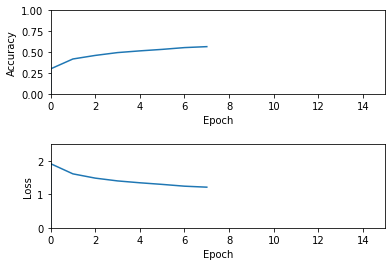

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a0model.ckpt Model Saved...
Epoch [200000], loss: 0.3579, acc: 1.0000
Epoch [200001], loss: 2.0019, acc: 0.0000
Epoch [200002], loss: 2.0861, acc: 0.0000
Epoch [200003], loss: 0.7151, acc: 1.0000
Epoch [200004], loss: 0.1265, acc: 1.0000
Epoch [200005], loss: 0.7402, acc: 1.0000
Epoch [200006], loss: 0.0901, acc: 1.0000
Epoch [200007], loss: 0.2000, acc: 1.0000
Epoch [200008], loss: 0.0461, acc: 1.0000
Epoch [200009], loss: 0.0970, acc: 1.0000
Epoch [200010], loss: 0.4232, acc: 1.0000
Epoch [200011], loss: 1.2868, acc: 0.0000
Epoch [200012], loss: 0.0524, acc: 1.0000
Epoch [200013], loss: 0.5308, acc: 1.0000
Epoch [200014], loss: 1.1906, acc: 0.0000
Epoch [200015], loss: 0.0672, acc: 1.0000
Epoch [200016], loss: 0.5061, acc: 1.0000
Epoch [200017], loss: 3.0934, acc: 0.0000
Epoch [200018], loss: 2.0137, acc: 0.0000
Epoch [200019], loss: 2.7653, acc: 0.0000
Epoch [200020], loss: 1.7283, acc: 0.0000
Epoch [200021],

Epoch [200195], loss: 0.0429, acc: 1.0000
Epoch [200196], loss: 0.9175, acc: 0.0000
Epoch [200197], loss: 0.1758, acc: 1.0000
Epoch [200198], loss: 0.2588, acc: 1.0000
Epoch [200199], loss: 3.9819, acc: 0.0000
Epoch [200200], loss: 2.3612, acc: 0.0000
Epoch [200201], loss: 2.5419, acc: 0.0000
Epoch [200202], loss: 1.4465, acc: 0.0000
Epoch [200203], loss: 2.3497, acc: 0.0000
Epoch [200204], loss: 1.4479, acc: 0.0000
Epoch [200205], loss: 0.9927, acc: 0.0000
Epoch [200206], loss: 0.6080, acc: 1.0000
Epoch [200207], loss: 1.3322, acc: 0.0000
Epoch [200208], loss: 1.3891, acc: 0.0000
Epoch [200209], loss: 0.9500, acc: 1.0000
Epoch [200210], loss: 2.0378, acc: 0.0000
Epoch [200211], loss: 0.1572, acc: 1.0000
Epoch [200212], loss: 0.9647, acc: 0.0000
Epoch [200213], loss: 1.1695, acc: 1.0000
Epoch [200214], loss: 0.1098, acc: 1.0000
Epoch [200215], loss: 0.3710, acc: 1.0000
Epoch [200216], loss: 1.0680, acc: 1.0000
Epoch [200217], loss: 1.3466, acc: 0.0000
Epoch [200218], loss: 0.0505, acc:

Epoch [200401], loss: 0.6604, acc: 1.0000
Epoch [200402], loss: 3.6165, acc: 0.0000
Epoch [200403], loss: 0.3356, acc: 1.0000
Epoch [200404], loss: 2.6612, acc: 0.0000
Epoch [200405], loss: 2.7179, acc: 0.0000
Epoch [200406], loss: 0.0976, acc: 1.0000
Epoch [200407], loss: 0.9150, acc: 1.0000
Epoch [200408], loss: 1.9013, acc: 0.0000
Epoch [200409], loss: 1.0769, acc: 1.0000
Epoch [200410], loss: 4.2257, acc: 0.0000
Epoch [200411], loss: 0.9206, acc: 1.0000
Epoch [200412], loss: 0.9542, acc: 1.0000
Epoch [200413], loss: 3.1924, acc: 0.0000
Epoch [200414], loss: 1.6943, acc: 0.0000
Epoch [200415], loss: 0.7608, acc: 1.0000
Epoch [200416], loss: 2.0566, acc: 0.0000
Epoch [200417], loss: 0.4965, acc: 1.0000
Epoch [200418], loss: 0.9851, acc: 0.0000
Epoch [200419], loss: 1.9977, acc: 0.0000
Epoch [200420], loss: 2.2778, acc: 0.0000
Epoch [200421], loss: 2.9979, acc: 0.0000
Epoch [200422], loss: 1.7060, acc: 0.0000
Epoch [200423], loss: 0.9240, acc: 1.0000
Epoch [200424], loss: 1.2187, acc:

Epoch [200594], loss: 0.6271, acc: 1.0000
Epoch [200595], loss: 1.1696, acc: 0.0000
Epoch [200596], loss: 0.7743, acc: 1.0000
Epoch [200597], loss: 0.2379, acc: 1.0000
Epoch [200598], loss: 0.1954, acc: 1.0000
Epoch [200599], loss: 1.4448, acc: 0.0000
Epoch [200600], loss: 0.1165, acc: 1.0000
Epoch [200601], loss: 1.1659, acc: 1.0000
Epoch [200602], loss: 3.0760, acc: 0.0000
Epoch [200603], loss: 1.2776, acc: 0.0000
Epoch [200604], loss: 0.4047, acc: 1.0000
Epoch [200605], loss: 0.2513, acc: 1.0000
Epoch [200606], loss: 2.1008, acc: 0.0000
Epoch [200607], loss: 0.6591, acc: 1.0000
Epoch [200608], loss: 1.8066, acc: 0.0000
Epoch [200609], loss: 1.0813, acc: 0.0000
Epoch [200610], loss: 1.4246, acc: 0.0000
Epoch [200611], loss: 1.9204, acc: 0.0000
Epoch [200612], loss: 2.0093, acc: 0.0000
Epoch [200613], loss: 0.9852, acc: 1.0000
Epoch [200614], loss: 2.4978, acc: 0.0000
Epoch [200615], loss: 0.4233, acc: 1.0000
Epoch [200616], loss: 0.1740, acc: 1.0000
Epoch [200617], loss: 1.9787, acc:

Epoch [200793], loss: 0.1804, acc: 1.0000
Epoch [200794], loss: 0.6706, acc: 1.0000
Epoch [200795], loss: 1.4012, acc: 0.0000
Epoch [200796], loss: 2.4915, acc: 0.0000
Epoch [200797], loss: 0.3492, acc: 1.0000
Epoch [200798], loss: 0.2022, acc: 1.0000
Epoch [200799], loss: 0.3103, acc: 1.0000
Epoch [200800], loss: 3.0130, acc: 0.0000
Epoch [200801], loss: 1.8544, acc: 0.0000
Epoch [200802], loss: 2.6979, acc: 0.0000
Epoch [200803], loss: 0.1443, acc: 1.0000
Epoch [200804], loss: 0.1037, acc: 1.0000
Epoch [200805], loss: 1.5451, acc: 0.0000
Epoch [200806], loss: 1.0998, acc: 1.0000
Epoch [200807], loss: 1.7401, acc: 0.0000
Epoch [200808], loss: 1.3038, acc: 0.0000
Epoch [200809], loss: 1.0128, acc: 1.0000
Epoch [200810], loss: 1.7626, acc: 0.0000
Epoch [200811], loss: 2.0230, acc: 0.0000
Epoch [200812], loss: 1.3707, acc: 0.0000
Epoch [200813], loss: 1.5434, acc: 0.0000
Epoch [200814], loss: 0.3294, acc: 1.0000
Epoch [200815], loss: 1.4969, acc: 0.0000
Epoch [200816], loss: 0.4627, acc:

Epoch [200996], loss: 0.0351, acc: 1.0000
Epoch [200997], loss: 1.2101, acc: 1.0000
Epoch [200998], loss: 0.6383, acc: 1.0000
Epoch [200999], loss: 1.6885, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a1000model.ckpt Model Saved...
Epoch [201000], loss: 0.0184, acc: 1.0000
Epoch [201001], loss: 0.1270, acc: 1.0000
Epoch [201002], loss: 1.0999, acc: 1.0000
Epoch [201003], loss: 0.7736, acc: 1.0000
Epoch [201004], loss: 0.4335, acc: 1.0000
Epoch [201005], loss: 0.8461, acc: 1.0000
Epoch [201006], loss: 2.5734, acc: 0.0000
Epoch [201007], loss: 1.4233, acc: 0.0000
Epoch [201008], loss: 0.2908, acc: 1.0000
Epoch [201009], loss: 1.0242, acc: 1.0000
Epoch [201010], loss: 0.6865, acc: 1.0000
Epoch [201011], loss: 2.9284, acc: 0.0000
Epoch [201012], loss: 1.0118, acc: 1.0000
Epoch [201013], loss: 0.0878, acc: 1.0000
Epoch [201014], loss: 1.6646, acc: 0.0000
Epoch [201015], loss: 0.4427, acc: 1.0000
Epoch [201016], loss: 0.4588, acc: 1.0000
Epoch [20101

Epoch [201193], loss: 0.8519, acc: 1.0000
Epoch [201194], loss: 0.5825, acc: 1.0000
Epoch [201195], loss: 1.1839, acc: 1.0000
Epoch [201196], loss: 0.7827, acc: 1.0000
Epoch [201197], loss: 0.4946, acc: 1.0000
Epoch [201198], loss: 1.5000, acc: 0.0000
Epoch [201199], loss: 0.6616, acc: 1.0000
Epoch [201200], loss: 3.0904, acc: 0.0000
Epoch [201201], loss: 1.7875, acc: 0.0000
Epoch [201202], loss: 1.2167, acc: 1.0000
Epoch [201203], loss: 1.6992, acc: 0.0000
Epoch [201204], loss: 1.1797, acc: 1.0000
Epoch [201205], loss: 0.4858, acc: 1.0000
Epoch [201206], loss: 0.1386, acc: 1.0000
Epoch [201207], loss: 0.3290, acc: 1.0000
Epoch [201208], loss: 0.4500, acc: 1.0000
Epoch [201209], loss: 0.6621, acc: 1.0000
Epoch [201210], loss: 0.0354, acc: 1.0000
Epoch [201211], loss: 1.4540, acc: 0.0000
Epoch [201212], loss: 1.6985, acc: 0.0000
Epoch [201213], loss: 1.6834, acc: 0.0000
Epoch [201214], loss: 3.0572, acc: 0.0000
Epoch [201215], loss: 1.7142, acc: 0.0000
Epoch [201216], loss: 1.5528, acc:

Epoch [201399], loss: 2.6589, acc: 0.0000
Epoch [201400], loss: 2.5642, acc: 0.0000
Epoch [201401], loss: 0.9964, acc: 0.0000
Epoch [201402], loss: 0.7639, acc: 1.0000
Epoch [201403], loss: 0.9486, acc: 1.0000
Epoch [201404], loss: 0.8858, acc: 1.0000
Epoch [201405], loss: 1.1775, acc: 1.0000
Epoch [201406], loss: 1.5098, acc: 0.0000
Epoch [201407], loss: 0.0651, acc: 1.0000
Epoch [201408], loss: 1.5833, acc: 0.0000
Epoch [201409], loss: 0.9908, acc: 0.0000
Epoch [201410], loss: 1.5624, acc: 0.0000
Epoch [201411], loss: 0.1859, acc: 1.0000
Epoch [201412], loss: 0.7574, acc: 1.0000
Epoch [201413], loss: 1.2366, acc: 1.0000
Epoch [201414], loss: 1.1151, acc: 1.0000
Epoch [201415], loss: 3.5271, acc: 0.0000
Epoch [201416], loss: 0.9323, acc: 1.0000
Epoch [201417], loss: 0.3560, acc: 1.0000
Epoch [201418], loss: 0.1572, acc: 1.0000
Epoch [201419], loss: 0.1472, acc: 1.0000
Epoch [201420], loss: 0.5442, acc: 1.0000
Epoch [201421], loss: 0.4877, acc: 1.0000
Epoch [201422], loss: 1.6550, acc:

Epoch [201598], loss: 0.7612, acc: 1.0000
Epoch [201599], loss: 1.2260, acc: 1.0000
Epoch [201600], loss: 1.1275, acc: 1.0000
Epoch [201601], loss: 2.4710, acc: 0.0000
Epoch [201602], loss: 0.4820, acc: 1.0000
Epoch [201603], loss: 0.8870, acc: 1.0000
Epoch [201604], loss: 3.3853, acc: 0.0000
Epoch [201605], loss: 2.6172, acc: 0.0000
Epoch [201606], loss: 0.2938, acc: 1.0000
Epoch [201607], loss: 1.7259, acc: 0.0000
Epoch [201608], loss: 0.1791, acc: 1.0000
Epoch [201609], loss: 0.2373, acc: 1.0000
Epoch [201610], loss: 1.8745, acc: 0.0000
Epoch [201611], loss: 0.3445, acc: 1.0000
Epoch [201612], loss: 0.4757, acc: 1.0000
Epoch [201613], loss: 1.6204, acc: 0.0000
Epoch [201614], loss: 1.9825, acc: 0.0000
Epoch [201615], loss: 0.1924, acc: 1.0000
Epoch [201616], loss: 0.8379, acc: 1.0000
Epoch [201617], loss: 1.3573, acc: 0.0000
Epoch [201618], loss: 0.8430, acc: 1.0000
Epoch [201619], loss: 0.6691, acc: 1.0000
Epoch [201620], loss: 0.1936, acc: 1.0000
Epoch [201621], loss: 1.4489, acc:

Epoch [201803], loss: 0.0672, acc: 1.0000
Epoch [201804], loss: 0.3572, acc: 1.0000
Epoch [201805], loss: 2.7738, acc: 0.0000
Epoch [201806], loss: 0.9975, acc: 1.0000
Epoch [201807], loss: 0.6733, acc: 1.0000
Epoch [201808], loss: 0.7011, acc: 1.0000
Epoch [201809], loss: 2.0776, acc: 0.0000
Epoch [201810], loss: 1.2526, acc: 1.0000
Epoch [201811], loss: 2.4827, acc: 0.0000
Epoch [201812], loss: 0.0248, acc: 1.0000
Epoch [201813], loss: 1.4989, acc: 0.0000
Epoch [201814], loss: 0.5107, acc: 1.0000
Epoch [201815], loss: 0.0720, acc: 1.0000
Epoch [201816], loss: 0.2129, acc: 1.0000
Epoch [201817], loss: 0.9072, acc: 1.0000
Epoch [201818], loss: 0.2564, acc: 1.0000
Epoch [201819], loss: 0.5731, acc: 1.0000
Epoch [201820], loss: 1.0454, acc: 1.0000
Epoch [201821], loss: 0.4677, acc: 1.0000
Epoch [201822], loss: 0.0154, acc: 1.0000
Epoch [201823], loss: 0.1340, acc: 1.0000
Epoch [201824], loss: 0.0745, acc: 1.0000
Epoch [201825], loss: 2.8686, acc: 0.0000
Epoch [201826], loss: 1.6247, acc:

Epoch [202006], loss: 0.0738, acc: 1.0000
Epoch [202007], loss: 0.0806, acc: 1.0000
Epoch [202008], loss: 1.1703, acc: 0.0000
Epoch [202009], loss: 0.3268, acc: 1.0000
Epoch [202010], loss: 0.0832, acc: 1.0000
Epoch [202011], loss: 0.3388, acc: 1.0000
Epoch [202012], loss: 0.4585, acc: 1.0000
Epoch [202013], loss: 1.4725, acc: 0.0000
Epoch [202014], loss: 2.0429, acc: 0.0000
Epoch [202015], loss: 0.0015, acc: 1.0000
Epoch [202016], loss: 0.0431, acc: 1.0000
Epoch [202017], loss: 0.8405, acc: 1.0000
Epoch [202018], loss: 0.3323, acc: 1.0000
Epoch [202019], loss: 4.6437, acc: 0.0000
Epoch [202020], loss: 0.1942, acc: 1.0000
Epoch [202021], loss: 1.3665, acc: 1.0000
Epoch [202022], loss: 2.0277, acc: 0.0000
Epoch [202023], loss: 0.0182, acc: 1.0000
Epoch [202024], loss: 0.1110, acc: 1.0000
Epoch [202025], loss: 0.1827, acc: 1.0000
Epoch [202026], loss: 1.1003, acc: 1.0000
Epoch [202027], loss: 6.5053, acc: 0.0000
Epoch [202028], loss: 2.2761, acc: 0.0000
Epoch [202029], loss: 1.3836, acc:

Epoch [202211], loss: 0.3788, acc: 1.0000
Epoch [202212], loss: 1.8946, acc: 0.0000
Epoch [202213], loss: 0.6386, acc: 1.0000
Epoch [202214], loss: 2.1228, acc: 0.0000
Epoch [202215], loss: 3.1457, acc: 0.0000
Epoch [202216], loss: 1.8058, acc: 0.0000
Epoch [202217], loss: 0.0600, acc: 1.0000
Epoch [202218], loss: 1.5868, acc: 0.0000
Epoch [202219], loss: 2.1253, acc: 0.0000
Epoch [202220], loss: 1.0726, acc: 0.0000
Epoch [202221], loss: 0.8976, acc: 1.0000
Epoch [202222], loss: 0.0722, acc: 1.0000
Epoch [202223], loss: 0.8412, acc: 1.0000
Epoch [202224], loss: 0.4991, acc: 1.0000
Epoch [202225], loss: 1.0928, acc: 1.0000
Epoch [202226], loss: 0.6530, acc: 1.0000
Epoch [202227], loss: 2.0432, acc: 0.0000
Epoch [202228], loss: 1.8888, acc: 0.0000
Epoch [202229], loss: 3.1621, acc: 0.0000
Epoch [202230], loss: 0.8209, acc: 1.0000
Epoch [202231], loss: 0.4438, acc: 1.0000
Epoch [202232], loss: 1.1238, acc: 1.0000
Epoch [202233], loss: 1.3116, acc: 1.0000
Epoch [202234], loss: 2.3893, acc:

Epoch [202416], loss: 3.9156, acc: 0.0000
Epoch [202417], loss: 0.3736, acc: 1.0000
Epoch [202418], loss: 3.3771, acc: 0.0000
Epoch [202419], loss: 0.3066, acc: 1.0000
Epoch [202420], loss: 0.9195, acc: 0.0000
Epoch [202421], loss: 1.0253, acc: 1.0000
Epoch [202422], loss: 0.5003, acc: 1.0000
Epoch [202423], loss: 1.1140, acc: 1.0000
Epoch [202424], loss: 0.6194, acc: 1.0000
Epoch [202425], loss: 2.1472, acc: 0.0000
Epoch [202426], loss: 0.0017, acc: 1.0000
Epoch [202427], loss: 1.1532, acc: 0.0000
Epoch [202428], loss: 0.5170, acc: 1.0000
Epoch [202429], loss: 0.0797, acc: 1.0000
Epoch [202430], loss: 0.7780, acc: 1.0000
Epoch [202431], loss: 1.6708, acc: 0.0000
Epoch [202432], loss: 2.0403, acc: 0.0000
Epoch [202433], loss: 2.1159, acc: 0.0000
Epoch [202434], loss: 1.7138, acc: 0.0000
Epoch [202435], loss: 0.9821, acc: 0.0000
Epoch [202436], loss: 0.1821, acc: 1.0000
Epoch [202437], loss: 0.8850, acc: 1.0000
Epoch [202438], loss: 5.2756, acc: 0.0000
Epoch [202439], loss: 0.6836, acc:

Epoch [202617], loss: 0.6830, acc: 1.0000
Epoch [202618], loss: 1.3381, acc: 0.0000
Epoch [202619], loss: 1.1961, acc: 0.0000
Epoch [202620], loss: 1.4500, acc: 0.0000
Epoch [202621], loss: 0.9604, acc: 1.0000
Epoch [202622], loss: 0.0243, acc: 1.0000
Epoch [202623], loss: 0.6141, acc: 1.0000
Epoch [202624], loss: 1.4314, acc: 0.0000
Epoch [202625], loss: 7.8864, acc: 0.0000
Epoch [202626], loss: 0.0754, acc: 1.0000
Epoch [202627], loss: 0.0229, acc: 1.0000
Epoch [202628], loss: 1.6169, acc: 0.0000
Epoch [202629], loss: 0.9031, acc: 1.0000
Epoch [202630], loss: 4.8489, acc: 0.0000
Epoch [202631], loss: 0.9392, acc: 0.0000
Epoch [202632], loss: 0.9553, acc: 1.0000
Epoch [202633], loss: 2.6900, acc: 0.0000
Epoch [202634], loss: 0.6793, acc: 1.0000
Epoch [202635], loss: 2.8616, acc: 0.0000
Epoch [202636], loss: 0.5230, acc: 1.0000
Epoch [202637], loss: 0.0068, acc: 1.0000
Epoch [202638], loss: 0.2803, acc: 1.0000
Epoch [202639], loss: 0.7309, acc: 1.0000
Epoch [202640], loss: 2.6709, acc:

Epoch [202826], loss: 0.2631, acc: 1.0000
Epoch [202827], loss: 2.1197, acc: 0.0000
Epoch [202828], loss: 0.5769, acc: 1.0000
Epoch [202829], loss: 2.2752, acc: 0.0000
Epoch [202830], loss: 2.0715, acc: 0.0000
Epoch [202831], loss: 3.8747, acc: 0.0000
Epoch [202832], loss: 2.3313, acc: 0.0000
Epoch [202833], loss: 0.0186, acc: 1.0000
Epoch [202834], loss: 2.7628, acc: 0.0000
Epoch [202835], loss: 2.2949, acc: 0.0000
Epoch [202836], loss: 1.2840, acc: 0.0000
Epoch [202837], loss: 6.6936, acc: 0.0000
Epoch [202838], loss: 1.4517, acc: 0.0000
Epoch [202839], loss: 0.4834, acc: 1.0000
Epoch [202840], loss: 0.2584, acc: 1.0000
Epoch [202841], loss: 1.4277, acc: 0.0000
Epoch [202842], loss: 0.4596, acc: 1.0000
Epoch [202843], loss: 0.9130, acc: 0.0000
Epoch [202844], loss: 0.3256, acc: 1.0000
Epoch [202845], loss: 2.0191, acc: 0.0000
Epoch [202846], loss: 1.1643, acc: 0.0000
Epoch [202847], loss: 2.0876, acc: 0.0000
Epoch [202848], loss: 0.8818, acc: 1.0000
Epoch [202849], loss: 4.0352, acc:

Epoch [203022], loss: 0.0330, acc: 1.0000
Epoch [203023], loss: 0.0833, acc: 1.0000
Epoch [203024], loss: 0.5656, acc: 1.0000
Epoch [203025], loss: 0.3538, acc: 1.0000
Epoch [203026], loss: 1.9111, acc: 0.0000
Epoch [203027], loss: 0.1004, acc: 1.0000
Epoch [203028], loss: 1.9784, acc: 0.0000
Epoch [203029], loss: 2.3871, acc: 0.0000
Epoch [203030], loss: 0.8328, acc: 0.0000
Epoch [203031], loss: 1.8632, acc: 0.0000
Epoch [203032], loss: 0.7642, acc: 1.0000
Epoch [203033], loss: 2.6125, acc: 0.0000
Epoch [203034], loss: 0.3475, acc: 1.0000
Epoch [203035], loss: 0.6910, acc: 1.0000
Epoch [203036], loss: 0.8257, acc: 1.0000
Epoch [203037], loss: 2.3203, acc: 0.0000
Epoch [203038], loss: 2.1872, acc: 0.0000
Epoch [203039], loss: 3.1145, acc: 0.0000
Epoch [203040], loss: 1.0095, acc: 1.0000
Epoch [203041], loss: 3.3036, acc: 0.0000
Epoch [203042], loss: 0.6453, acc: 1.0000
Epoch [203043], loss: 2.2479, acc: 0.0000
Epoch [203044], loss: 0.3566, acc: 1.0000
Epoch [203045], loss: 3.4986, acc:

Epoch [203226], loss: 1.3641, acc: 0.0000
Epoch [203227], loss: 3.0506, acc: 0.0000
Epoch [203228], loss: 0.0423, acc: 1.0000
Epoch [203229], loss: 2.6744, acc: 0.0000
Epoch [203230], loss: 0.1548, acc: 1.0000
Epoch [203231], loss: 1.0390, acc: 1.0000
Epoch [203232], loss: 1.7925, acc: 0.0000
Epoch [203233], loss: 0.9190, acc: 1.0000
Epoch [203234], loss: 2.5679, acc: 0.0000
Epoch [203235], loss: 0.7909, acc: 1.0000
Epoch [203236], loss: 1.0237, acc: 0.0000
Epoch [203237], loss: 1.4467, acc: 0.0000
Epoch [203238], loss: 1.5529, acc: 0.0000
Epoch [203239], loss: 1.4850, acc: 0.0000
Epoch [203240], loss: 2.0590, acc: 0.0000
Epoch [203241], loss: 0.0096, acc: 1.0000
Epoch [203242], loss: 0.2744, acc: 1.0000
Epoch [203243], loss: 0.7500, acc: 0.0000
Epoch [203244], loss: 0.9185, acc: 1.0000
Epoch [203245], loss: 1.4099, acc: 0.0000
Epoch [203246], loss: 1.2034, acc: 0.0000
Epoch [203247], loss: 1.3860, acc: 0.0000
Epoch [203248], loss: 1.0706, acc: 1.0000
Epoch [203249], loss: 3.2816, acc:

Epoch [203423], loss: 0.5166, acc: 1.0000
Epoch [203424], loss: 0.3020, acc: 1.0000
Epoch [203425], loss: 0.4918, acc: 1.0000
Epoch [203426], loss: 0.0448, acc: 1.0000
Epoch [203427], loss: 0.6774, acc: 1.0000
Epoch [203428], loss: 0.5960, acc: 1.0000
Epoch [203429], loss: 0.6412, acc: 1.0000
Epoch [203430], loss: 3.2680, acc: 0.0000
Epoch [203431], loss: 3.3667, acc: 0.0000
Epoch [203432], loss: 0.7344, acc: 1.0000
Epoch [203433], loss: 1.8592, acc: 0.0000
Epoch [203434], loss: 2.3458, acc: 0.0000
Epoch [203435], loss: 0.8861, acc: 1.0000
Epoch [203436], loss: 0.0574, acc: 1.0000
Epoch [203437], loss: 1.3872, acc: 1.0000
Epoch [203438], loss: 1.0971, acc: 1.0000
Epoch [203439], loss: 0.5493, acc: 1.0000
Epoch [203440], loss: 2.0101, acc: 0.0000
Epoch [203441], loss: 0.3856, acc: 1.0000
Epoch [203442], loss: 0.0828, acc: 1.0000
Epoch [203443], loss: 1.0047, acc: 1.0000
Epoch [203444], loss: 0.3033, acc: 1.0000
Epoch [203445], loss: 1.0770, acc: 1.0000
Epoch [203446], loss: 0.6756, acc:

Epoch [203616], loss: 0.2657, acc: 1.0000
Epoch [203617], loss: 2.8229, acc: 0.0000
Epoch [203618], loss: 1.1599, acc: 1.0000
Epoch [203619], loss: 0.0012, acc: 1.0000
Epoch [203620], loss: 0.7439, acc: 1.0000
Epoch [203621], loss: 2.6263, acc: 0.0000
Epoch [203622], loss: 1.4787, acc: 0.0000
Epoch [203623], loss: 0.7102, acc: 1.0000
Epoch [203624], loss: 1.6491, acc: 0.0000
Epoch [203625], loss: 1.0791, acc: 1.0000
Epoch [203626], loss: 0.2690, acc: 1.0000
Epoch [203627], loss: 1.8355, acc: 0.0000
Epoch [203628], loss: 1.1364, acc: 1.0000
Epoch [203629], loss: 0.8392, acc: 1.0000
Epoch [203630], loss: 2.2513, acc: 0.0000
Epoch [203631], loss: 0.6635, acc: 1.0000
Epoch [203632], loss: 0.0497, acc: 1.0000
Epoch [203633], loss: 1.4055, acc: 1.0000
Epoch [203634], loss: 2.8443, acc: 0.0000
Epoch [203635], loss: 2.9216, acc: 0.0000
Epoch [203636], loss: 1.4616, acc: 0.0000
Epoch [203637], loss: 1.3734, acc: 0.0000
Epoch [203638], loss: 1.8751, acc: 0.0000
Epoch [203639], loss: 0.5746, acc:

Epoch [203821], loss: 2.9320, acc: 0.0000
Epoch [203822], loss: 0.2045, acc: 1.0000
Epoch [203823], loss: 0.5419, acc: 1.0000
Epoch [203824], loss: 1.1125, acc: 1.0000
Epoch [203825], loss: 2.7534, acc: 0.0000
Epoch [203826], loss: 0.6604, acc: 1.0000
Epoch [203827], loss: 0.3356, acc: 1.0000
Epoch [203828], loss: 2.3809, acc: 0.0000
Epoch [203829], loss: 0.7426, acc: 1.0000
Epoch [203830], loss: 4.7392, acc: 0.0000
Epoch [203831], loss: 1.1143, acc: 0.0000
Epoch [203832], loss: 2.7154, acc: 0.0000
Epoch [203833], loss: 0.2351, acc: 1.0000
Epoch [203834], loss: 1.6263, acc: 0.0000
Epoch [203835], loss: 0.7717, acc: 1.0000
Epoch [203836], loss: 0.0947, acc: 1.0000
Epoch [203837], loss: 1.7427, acc: 0.0000
Epoch [203838], loss: 1.7766, acc: 0.0000
Epoch [203839], loss: 0.5217, acc: 1.0000
Epoch [203840], loss: 0.9701, acc: 1.0000
Epoch [203841], loss: 0.9489, acc: 1.0000
Epoch [203842], loss: 3.4778, acc: 0.0000
Epoch [203843], loss: 1.3454, acc: 1.0000
Epoch [203844], loss: 0.0490, acc:

Epoch [204024], loss: 0.0741, acc: 1.0000
Epoch [204025], loss: 0.2794, acc: 1.0000
Epoch [204026], loss: 1.7756, acc: 0.0000
Epoch [204027], loss: 1.8800, acc: 0.0000
Epoch [204028], loss: 1.4680, acc: 0.0000
Epoch [204029], loss: 0.2684, acc: 1.0000
Epoch [204030], loss: 1.4540, acc: 1.0000
Epoch [204031], loss: 0.6357, acc: 1.0000
Epoch [204032], loss: 1.1268, acc: 1.0000
Epoch [204033], loss: 3.2032, acc: 0.0000
Epoch [204034], loss: 1.0618, acc: 0.0000
Epoch [204035], loss: 0.2026, acc: 1.0000
Epoch [204036], loss: 3.0676, acc: 0.0000
Epoch [204037], loss: 0.4865, acc: 1.0000
Epoch [204038], loss: 0.0802, acc: 1.0000
Epoch [204039], loss: 1.3003, acc: 0.0000
Epoch [204040], loss: 0.6444, acc: 1.0000
Epoch [204041], loss: 0.9884, acc: 0.0000
Epoch [204042], loss: 1.1557, acc: 0.0000
Epoch [204043], loss: 0.9632, acc: 0.0000
Epoch [204044], loss: 1.8698, acc: 0.0000
Epoch [204045], loss: 0.6381, acc: 1.0000
Epoch [204046], loss: 3.7909, acc: 0.0000
Epoch [204047], loss: 1.5899, acc:

Epoch [204227], loss: 0.4268, acc: 1.0000
Epoch [204228], loss: 0.1285, acc: 1.0000
Epoch [204229], loss: 1.0469, acc: 1.0000
Epoch [204230], loss: 0.5939, acc: 1.0000
Epoch [204231], loss: 0.0952, acc: 1.0000
Epoch [204232], loss: 1.1114, acc: 1.0000
Epoch [204233], loss: 0.8293, acc: 1.0000
Epoch [204234], loss: 1.8981, acc: 0.0000
Epoch [204235], loss: 0.7636, acc: 1.0000
Epoch [204236], loss: 1.9706, acc: 0.0000
Epoch [204237], loss: 0.0892, acc: 1.0000
Epoch [204238], loss: 2.7205, acc: 0.0000
Epoch [204239], loss: 1.1195, acc: 0.0000
Epoch [204240], loss: 3.8787, acc: 0.0000
Epoch [204241], loss: 0.8738, acc: 1.0000
Epoch [204242], loss: 0.9030, acc: 0.0000
Epoch [204243], loss: 2.8577, acc: 0.0000
Epoch [204244], loss: 1.0071, acc: 0.0000
Epoch [204245], loss: 1.6915, acc: 0.0000
Epoch [204246], loss: 1.1241, acc: 1.0000
Epoch [204247], loss: 1.0561, acc: 1.0000
Epoch [204248], loss: 1.0721, acc: 0.0000
Epoch [204249], loss: 0.4001, acc: 1.0000
Epoch [204250], loss: 0.5615, acc:

Epoch [204439], loss: 1.0215, acc: 1.0000
Epoch [204440], loss: 0.6487, acc: 1.0000
Epoch [204441], loss: 0.0242, acc: 1.0000
Epoch [204442], loss: 0.3565, acc: 1.0000
Epoch [204443], loss: 5.1959, acc: 0.0000
Epoch [204444], loss: 1.4461, acc: 0.0000
Epoch [204445], loss: 0.4181, acc: 1.0000
Epoch [204446], loss: 0.0025, acc: 1.0000
Epoch [204447], loss: 1.2382, acc: 0.0000
Epoch [204448], loss: 1.8899, acc: 0.0000
Epoch [204449], loss: 0.5226, acc: 1.0000
Epoch [204450], loss: 0.6330, acc: 1.0000
Epoch [204451], loss: 0.0025, acc: 1.0000
Epoch [204452], loss: 1.2316, acc: 0.0000
Epoch [204453], loss: 1.3873, acc: 0.0000
Epoch [204454], loss: 0.4653, acc: 1.0000
Epoch [204455], loss: 0.1519, acc: 1.0000
Epoch [204456], loss: 0.2285, acc: 1.0000
Epoch [204457], loss: 0.7810, acc: 0.0000
Epoch [204458], loss: 0.2637, acc: 1.0000
Epoch [204459], loss: 1.5092, acc: 0.0000
Epoch [204460], loss: 0.5480, acc: 1.0000
Epoch [204461], loss: 1.2309, acc: 0.0000
Epoch [204462], loss: 0.8272, acc:

Epoch [204648], loss: 0.0629, acc: 1.0000
Epoch [204649], loss: 1.4454, acc: 0.0000
Epoch [204650], loss: 0.4737, acc: 1.0000
Epoch [204651], loss: 0.0094, acc: 1.0000
Epoch [204652], loss: 4.0709, acc: 0.0000
Epoch [204653], loss: 0.0647, acc: 1.0000
Epoch [204654], loss: 2.2616, acc: 0.0000
Epoch [204655], loss: 0.5947, acc: 1.0000
Epoch [204656], loss: 1.4686, acc: 0.0000
Epoch [204657], loss: 2.5227, acc: 0.0000
Epoch [204658], loss: 0.5107, acc: 1.0000
Epoch [204659], loss: 0.7591, acc: 1.0000
Epoch [204660], loss: 1.0476, acc: 1.0000
Epoch [204661], loss: 0.3116, acc: 1.0000
Epoch [204662], loss: 0.4262, acc: 1.0000
Epoch [204663], loss: 2.5862, acc: 0.0000
Epoch [204664], loss: 0.3224, acc: 1.0000
Epoch [204665], loss: 0.1922, acc: 1.0000
Epoch [204666], loss: 0.1579, acc: 1.0000
Epoch [204667], loss: 0.1042, acc: 1.0000
Epoch [204668], loss: 0.0291, acc: 1.0000
Epoch [204669], loss: 0.3747, acc: 1.0000
Epoch [204670], loss: 0.1151, acc: 1.0000
Epoch [204671], loss: 0.5992, acc:

Epoch [204846], loss: 0.2385, acc: 1.0000
Epoch [204847], loss: 0.4681, acc: 1.0000
Epoch [204848], loss: 0.5172, acc: 1.0000
Epoch [204849], loss: 0.9766, acc: 1.0000
Epoch [204850], loss: 2.7751, acc: 0.0000
Epoch [204851], loss: 1.9641, acc: 0.0000
Epoch [204852], loss: 0.2173, acc: 1.0000
Epoch [204853], loss: 0.2021, acc: 1.0000
Epoch [204854], loss: 1.1218, acc: 1.0000
Epoch [204855], loss: 0.3221, acc: 1.0000
Epoch [204856], loss: 0.7365, acc: 1.0000
Epoch [204857], loss: 0.2770, acc: 1.0000
Epoch [204858], loss: 0.5171, acc: 1.0000
Epoch [204859], loss: 1.1642, acc: 0.0000
Epoch [204860], loss: 0.1358, acc: 1.0000
Epoch [204861], loss: 1.0161, acc: 0.0000
Epoch [204862], loss: 0.9945, acc: 1.0000
Epoch [204863], loss: 0.5347, acc: 1.0000
Epoch [204864], loss: 1.7933, acc: 0.0000
Epoch [204865], loss: 1.6144, acc: 1.0000
Epoch [204866], loss: 1.1673, acc: 1.0000
Epoch [204867], loss: 1.3137, acc: 0.0000
Epoch [204868], loss: 2.5505, acc: 0.0000
Epoch [204869], loss: 1.7401, acc:

Epoch [205045], loss: 0.7717, acc: 1.0000
Epoch [205046], loss: 4.1262, acc: 0.0000
Epoch [205047], loss: 0.5302, acc: 1.0000
Epoch [205048], loss: 1.2573, acc: 1.0000
Epoch [205049], loss: 0.6342, acc: 1.0000
Epoch [205050], loss: 1.3801, acc: 0.0000
Epoch [205051], loss: 1.3061, acc: 0.0000
Epoch [205052], loss: 1.2220, acc: 0.0000
Epoch [205053], loss: 3.2508, acc: 0.0000
Epoch [205054], loss: 0.4782, acc: 1.0000
Epoch [205055], loss: 1.1435, acc: 1.0000
Epoch [205056], loss: 1.7061, acc: 0.0000
Epoch [205057], loss: 2.1488, acc: 0.0000
Epoch [205058], loss: 1.2793, acc: 0.0000
Epoch [205059], loss: 1.5684, acc: 0.0000
Epoch [205060], loss: 2.2464, acc: 0.0000
Epoch [205061], loss: 0.6575, acc: 1.0000
Epoch [205062], loss: 0.2673, acc: 1.0000
Epoch [205063], loss: 1.6339, acc: 0.0000
Epoch [205064], loss: 1.7220, acc: 0.0000
Epoch [205065], loss: 2.8340, acc: 0.0000
Epoch [205066], loss: 1.5353, acc: 1.0000
Epoch [205067], loss: 0.3544, acc: 1.0000
Epoch [205068], loss: 0.7912, acc:

Epoch [205245], loss: 0.7663, acc: 1.0000
Epoch [205246], loss: 2.6640, acc: 0.0000
Epoch [205247], loss: 0.2503, acc: 1.0000
Epoch [205248], loss: 0.0765, acc: 1.0000
Epoch [205249], loss: 1.9485, acc: 0.0000
Epoch [205250], loss: 0.0017, acc: 1.0000
Epoch [205251], loss: 0.1145, acc: 1.0000
Epoch [205252], loss: 0.6600, acc: 1.0000
Epoch [205253], loss: 2.1045, acc: 0.0000
Epoch [205254], loss: 1.6044, acc: 0.0000
Epoch [205255], loss: 0.2076, acc: 1.0000
Epoch [205256], loss: 1.6329, acc: 0.0000
Epoch [205257], loss: 0.7582, acc: 1.0000
Epoch [205258], loss: 3.5494, acc: 0.0000
Epoch [205259], loss: 1.7205, acc: 0.0000
Epoch [205260], loss: 4.0343, acc: 0.0000
Epoch [205261], loss: 1.7222, acc: 0.0000
Epoch [205262], loss: 1.2477, acc: 0.0000
Epoch [205263], loss: 0.9273, acc: 1.0000
Epoch [205264], loss: 0.9369, acc: 0.0000
Epoch [205265], loss: 3.8077, acc: 0.0000
Epoch [205266], loss: 0.9052, acc: 1.0000
Epoch [205267], loss: 0.9105, acc: 1.0000
Epoch [205268], loss: 3.7492, acc:

Epoch [205446], loss: 2.2023, acc: 0.0000
Epoch [205447], loss: 0.2112, acc: 1.0000
Epoch [205448], loss: 1.1248, acc: 0.0000
Epoch [205449], loss: 1.3895, acc: 0.0000
Epoch [205450], loss: 3.4360, acc: 0.0000
Epoch [205451], loss: 1.2130, acc: 1.0000
Epoch [205452], loss: 0.6171, acc: 1.0000
Epoch [205453], loss: 0.2035, acc: 1.0000
Epoch [205454], loss: 2.2602, acc: 0.0000
Epoch [205455], loss: 0.1892, acc: 1.0000
Epoch [205456], loss: 2.8254, acc: 0.0000
Epoch [205457], loss: 0.0012, acc: 1.0000
Epoch [205458], loss: 0.0061, acc: 1.0000
Epoch [205459], loss: 1.2880, acc: 0.0000
Epoch [205460], loss: 0.6732, acc: 1.0000
Epoch [205461], loss: 2.0497, acc: 0.0000
Epoch [205462], loss: 0.0601, acc: 1.0000
Epoch [205463], loss: 0.5535, acc: 1.0000
Epoch [205464], loss: 1.3873, acc: 0.0000
Epoch [205465], loss: 0.6047, acc: 1.0000
Epoch [205466], loss: 1.9725, acc: 0.0000
Epoch [205467], loss: 0.7824, acc: 1.0000
Epoch [205468], loss: 1.2034, acc: 1.0000
Epoch [205469], loss: 1.0259, acc:

Epoch [205651], loss: 0.2642, acc: 1.0000
Epoch [205652], loss: 0.9822, acc: 0.0000
Epoch [205653], loss: 0.7845, acc: 1.0000
Epoch [205654], loss: 0.0010, acc: 1.0000
Epoch [205655], loss: 2.1106, acc: 0.0000
Epoch [205656], loss: 0.6740, acc: 1.0000
Epoch [205657], loss: 0.7380, acc: 1.0000
Epoch [205658], loss: 0.4710, acc: 1.0000
Epoch [205659], loss: 0.5508, acc: 1.0000
Epoch [205660], loss: 0.1583, acc: 1.0000
Epoch [205661], loss: 0.4092, acc: 1.0000
Epoch [205662], loss: 0.1913, acc: 1.0000
Epoch [205663], loss: 0.3931, acc: 1.0000
Epoch [205664], loss: 1.0497, acc: 0.0000
Epoch [205665], loss: 0.3517, acc: 1.0000
Epoch [205666], loss: 0.2034, acc: 1.0000
Epoch [205667], loss: 0.7126, acc: 1.0000
Epoch [205668], loss: 1.1640, acc: 0.0000
Epoch [205669], loss: 0.0945, acc: 1.0000
Epoch [205670], loss: 2.1365, acc: 0.0000
Epoch [205671], loss: 1.9315, acc: 0.0000
Epoch [205672], loss: 2.3205, acc: 0.0000
Epoch [205673], loss: 2.7719, acc: 0.0000
Epoch [205674], loss: 0.2606, acc:

Epoch [205856], loss: 2.3408, acc: 0.0000
Epoch [205857], loss: 0.9900, acc: 1.0000
Epoch [205858], loss: 0.4261, acc: 1.0000
Epoch [205859], loss: 0.0740, acc: 1.0000
Epoch [205860], loss: 2.3645, acc: 0.0000
Epoch [205861], loss: 0.6645, acc: 1.0000
Epoch [205862], loss: 3.3712, acc: 0.0000
Epoch [205863], loss: 1.6661, acc: 0.0000
Epoch [205864], loss: 0.4990, acc: 1.0000
Epoch [205865], loss: 0.4895, acc: 1.0000
Epoch [205866], loss: 1.7029, acc: 0.0000
Epoch [205867], loss: 1.4877, acc: 0.0000
Epoch [205868], loss: 3.2680, acc: 0.0000
Epoch [205869], loss: 1.8919, acc: 0.0000
Epoch [205870], loss: 1.0418, acc: 1.0000
Epoch [205871], loss: 1.5796, acc: 0.0000
Epoch [205872], loss: 0.9065, acc: 1.0000
Epoch [205873], loss: 0.7345, acc: 1.0000
Epoch [205874], loss: 0.5354, acc: 1.0000
Epoch [205875], loss: 1.9559, acc: 0.0000
Epoch [205876], loss: 0.1277, acc: 1.0000
Epoch [205877], loss: 0.3840, acc: 1.0000
Epoch [205878], loss: 0.0307, acc: 1.0000
Epoch [205879], loss: 0.4036, acc:

Epoch [206060], loss: 0.1377, acc: 1.0000
Epoch [206061], loss: 1.7637, acc: 0.0000
Epoch [206062], loss: 1.8889, acc: 0.0000
Epoch [206063], loss: 0.8811, acc: 1.0000
Epoch [206064], loss: 1.3237, acc: 1.0000
Epoch [206065], loss: 1.2884, acc: 0.0000
Epoch [206066], loss: 0.3348, acc: 1.0000
Epoch [206067], loss: 0.6517, acc: 1.0000
Epoch [206068], loss: 0.0798, acc: 1.0000
Epoch [206069], loss: 1.6006, acc: 0.0000
Epoch [206070], loss: 2.2527, acc: 0.0000
Epoch [206071], loss: 0.5504, acc: 1.0000
Epoch [206072], loss: 0.8552, acc: 0.0000
Epoch [206073], loss: 0.2549, acc: 1.0000
Epoch [206074], loss: 3.1554, acc: 0.0000
Epoch [206075], loss: 1.2044, acc: 1.0000
Epoch [206076], loss: 0.7124, acc: 1.0000
Epoch [206077], loss: 0.7075, acc: 1.0000
Epoch [206078], loss: 1.0992, acc: 0.0000
Epoch [206079], loss: 0.4330, acc: 1.0000
Epoch [206080], loss: 1.7375, acc: 0.0000
Epoch [206081], loss: 0.0746, acc: 1.0000
Epoch [206082], loss: 0.0112, acc: 1.0000
Epoch [206083], loss: 0.4803, acc:

Epoch [206267], loss: 0.3384, acc: 1.0000
Epoch [206268], loss: 0.4699, acc: 1.0000
Epoch [206269], loss: 1.3199, acc: 0.0000
Epoch [206270], loss: 0.0092, acc: 1.0000
Epoch [206271], loss: 0.7205, acc: 1.0000
Epoch [206272], loss: 1.0734, acc: 0.0000
Epoch [206273], loss: 0.1019, acc: 1.0000
Epoch [206274], loss: 0.1053, acc: 1.0000
Epoch [206275], loss: 0.4959, acc: 1.0000
Epoch [206276], loss: 0.1017, acc: 1.0000
Epoch [206277], loss: 1.4615, acc: 0.0000
Epoch [206278], loss: 3.2410, acc: 0.0000
Epoch [206279], loss: 0.1201, acc: 1.0000
Epoch [206280], loss: 0.9035, acc: 1.0000
Epoch [206281], loss: 0.5164, acc: 1.0000
Epoch [206282], loss: 2.0998, acc: 0.0000
Epoch [206283], loss: 0.2206, acc: 1.0000
Epoch [206284], loss: 0.4037, acc: 1.0000
Epoch [206285], loss: 1.5356, acc: 1.0000
Epoch [206286], loss: 1.9409, acc: 0.0000
Epoch [206287], loss: 0.6968, acc: 1.0000
Epoch [206288], loss: 4.0500, acc: 0.0000
Epoch [206289], loss: 3.2004, acc: 0.0000
Epoch [206290], loss: 0.8129, acc:

Epoch [206476], loss: 0.5969, acc: 1.0000
Epoch [206477], loss: 1.8883, acc: 0.0000
Epoch [206478], loss: 1.6176, acc: 0.0000
Epoch [206479], loss: 1.7270, acc: 0.0000
Epoch [206480], loss: 3.7033, acc: 0.0000
Epoch [206481], loss: 0.3817, acc: 1.0000
Epoch [206482], loss: 0.7271, acc: 1.0000
Epoch [206483], loss: 0.8319, acc: 1.0000
Epoch [206484], loss: 0.7315, acc: 1.0000
Epoch [206485], loss: 1.1102, acc: 1.0000
Epoch [206486], loss: 0.5747, acc: 1.0000
Epoch [206487], loss: 2.7807, acc: 0.0000
Epoch [206488], loss: 0.0571, acc: 1.0000
Epoch [206489], loss: 0.4101, acc: 1.0000
Epoch [206490], loss: 0.5785, acc: 1.0000
Epoch [206491], loss: 0.3068, acc: 1.0000
Epoch [206492], loss: 2.8197, acc: 0.0000
Epoch [206493], loss: 0.7277, acc: 1.0000
Epoch [206494], loss: 0.5350, acc: 1.0000
Epoch [206495], loss: 5.0864, acc: 0.0000
Epoch [206496], loss: 1.1190, acc: 0.0000
Epoch [206497], loss: 0.0264, acc: 1.0000
Epoch [206498], loss: 0.7126, acc: 1.0000
Epoch [206499], loss: 0.4022, acc:

Epoch [206681], loss: 2.1873, acc: 0.0000
Epoch [206682], loss: 0.9324, acc: 1.0000
Epoch [206683], loss: 0.7550, acc: 1.0000
Epoch [206684], loss: 0.4427, acc: 1.0000
Epoch [206685], loss: 1.5802, acc: 0.0000
Epoch [206686], loss: 1.2320, acc: 0.0000
Epoch [206687], loss: 0.0966, acc: 1.0000
Epoch [206688], loss: 0.8362, acc: 0.0000
Epoch [206689], loss: 0.9362, acc: 1.0000
Epoch [206690], loss: 0.8908, acc: 0.0000
Epoch [206691], loss: 0.7747, acc: 1.0000
Epoch [206692], loss: 0.0518, acc: 1.0000
Epoch [206693], loss: 0.0244, acc: 1.0000
Epoch [206694], loss: 2.8957, acc: 0.0000
Epoch [206695], loss: 0.4258, acc: 1.0000
Epoch [206696], loss: 2.8945, acc: 0.0000
Epoch [206697], loss: 0.9762, acc: 1.0000
Epoch [206698], loss: 1.1052, acc: 0.0000
Epoch [206699], loss: 0.3914, acc: 1.0000
Epoch [206700], loss: 0.4982, acc: 1.0000
Epoch [206701], loss: 0.6209, acc: 1.0000
Epoch [206702], loss: 0.5814, acc: 1.0000
Epoch [206703], loss: 0.7359, acc: 1.0000
Epoch [206704], loss: 1.9567, acc:

Epoch [206891], loss: 0.6443, acc: 1.0000
Epoch [206892], loss: 0.3389, acc: 1.0000
Epoch [206893], loss: 0.0716, acc: 1.0000
Epoch [206894], loss: 1.0749, acc: 1.0000
Epoch [206895], loss: 3.1062, acc: 0.0000
Epoch [206896], loss: 1.4648, acc: 0.0000
Epoch [206897], loss: 0.2476, acc: 1.0000
Epoch [206898], loss: 1.0461, acc: 0.0000
Epoch [206899], loss: 0.4454, acc: 1.0000
Epoch [206900], loss: 0.1108, acc: 1.0000
Epoch [206901], loss: 2.0674, acc: 0.0000
Epoch [206902], loss: 2.1931, acc: 0.0000
Epoch [206903], loss: 2.3606, acc: 0.0000
Epoch [206904], loss: 0.6964, acc: 1.0000
Epoch [206905], loss: 0.6720, acc: 1.0000
Epoch [206906], loss: 1.5231, acc: 0.0000
Epoch [206907], loss: 1.9992, acc: 0.0000
Epoch [206908], loss: 2.5096, acc: 0.0000
Epoch [206909], loss: 0.3238, acc: 1.0000
Epoch [206910], loss: 0.3144, acc: 1.0000
Epoch [206911], loss: 6.9803, acc: 0.0000
Epoch [206912], loss: 0.8004, acc: 1.0000
Epoch [206913], loss: 2.6050, acc: 0.0000
Epoch [206914], loss: 4.0498, acc:

Epoch [207093], loss: 2.0816, acc: 0.0000
Epoch [207094], loss: 1.0402, acc: 1.0000
Epoch [207095], loss: 0.4407, acc: 1.0000
Epoch [207096], loss: 0.1476, acc: 1.0000
Epoch [207097], loss: 1.0857, acc: 0.0000
Epoch [207098], loss: 0.3735, acc: 1.0000
Epoch [207099], loss: 4.1830, acc: 0.0000
Epoch [207100], loss: 0.5012, acc: 1.0000
Epoch [207101], loss: 0.5783, acc: 1.0000
Epoch [207102], loss: 1.0788, acc: 1.0000
Epoch [207103], loss: 0.5935, acc: 1.0000
Epoch [207104], loss: 0.3502, acc: 1.0000
Epoch [207105], loss: 0.3691, acc: 1.0000
Epoch [207106], loss: 0.0661, acc: 1.0000
Epoch [207107], loss: 2.7472, acc: 0.0000
Epoch [207108], loss: 0.3655, acc: 1.0000
Epoch [207109], loss: 2.2983, acc: 0.0000
Epoch [207110], loss: 0.2926, acc: 1.0000
Epoch [207111], loss: 2.3340, acc: 0.0000
Epoch [207112], loss: 0.2985, acc: 1.0000
Epoch [207113], loss: 0.4581, acc: 1.0000
Epoch [207114], loss: 1.1872, acc: 0.0000
Epoch [207115], loss: 0.2884, acc: 1.0000
Epoch [207116], loss: 0.9828, acc:

Epoch [207301], loss: 0.4508, acc: 1.0000
Epoch [207302], loss: 1.3179, acc: 0.0000
Epoch [207303], loss: 0.7797, acc: 1.0000
Epoch [207304], loss: 1.0319, acc: 1.0000
Epoch [207305], loss: 3.7544, acc: 0.0000
Epoch [207306], loss: 1.6047, acc: 0.0000
Epoch [207307], loss: 0.3236, acc: 1.0000
Epoch [207308], loss: 2.7325, acc: 0.0000
Epoch [207309], loss: 0.6402, acc: 1.0000
Epoch [207310], loss: 2.5370, acc: 0.0000
Epoch [207311], loss: 0.1262, acc: 1.0000
Epoch [207312], loss: 0.7687, acc: 1.0000
Epoch [207313], loss: 0.6123, acc: 1.0000
Epoch [207314], loss: 2.0845, acc: 0.0000
Epoch [207315], loss: 1.2739, acc: 1.0000
Epoch [207316], loss: 0.9457, acc: 0.0000
Epoch [207317], loss: 0.8201, acc: 1.0000
Epoch [207318], loss: 0.4025, acc: 1.0000
Epoch [207319], loss: 0.7495, acc: 1.0000
Epoch [207320], loss: 1.8242, acc: 0.0000
Epoch [207321], loss: 0.6378, acc: 1.0000
Epoch [207322], loss: 0.9559, acc: 0.0000
Epoch [207323], loss: 1.3644, acc: 0.0000
Epoch [207324], loss: 0.4834, acc:

Epoch [207507], loss: 0.0921, acc: 1.0000
Epoch [207508], loss: 0.1265, acc: 1.0000
Epoch [207509], loss: 0.1154, acc: 1.0000
Epoch [207510], loss: 0.0232, acc: 1.0000
Epoch [207511], loss: 0.5121, acc: 1.0000
Epoch [207512], loss: 0.3068, acc: 1.0000
Epoch [207513], loss: 2.5708, acc: 0.0000
Epoch [207514], loss: 1.2759, acc: 0.0000
Epoch [207515], loss: 0.5596, acc: 1.0000
Epoch [207516], loss: 0.4215, acc: 1.0000
Epoch [207517], loss: 1.9780, acc: 0.0000
Epoch [207518], loss: 0.2977, acc: 1.0000
Epoch [207519], loss: 0.2823, acc: 1.0000
Epoch [207520], loss: 0.3139, acc: 1.0000
Epoch [207521], loss: 0.1329, acc: 1.0000
Epoch [207522], loss: 3.4066, acc: 0.0000
Epoch [207523], loss: 0.4115, acc: 1.0000
Epoch [207524], loss: 2.9771, acc: 0.0000
Epoch [207525], loss: 0.0975, acc: 1.0000
Epoch [207526], loss: 0.2048, acc: 1.0000
Epoch [207527], loss: 1.4545, acc: 1.0000
Epoch [207528], loss: 3.0125, acc: 0.0000
Epoch [207529], loss: 0.5419, acc: 1.0000
Epoch [207530], loss: 0.3021, acc:

Epoch [207717], loss: 1.2227, acc: 0.0000
Epoch [207718], loss: 0.0095, acc: 1.0000
Epoch [207719], loss: 2.8759, acc: 0.0000
Epoch [207720], loss: 0.1906, acc: 1.0000
Epoch [207721], loss: 0.6889, acc: 1.0000
Epoch [207722], loss: 1.5519, acc: 0.0000
Epoch [207723], loss: 1.3041, acc: 0.0000
Epoch [207724], loss: 0.5697, acc: 1.0000
Epoch [207725], loss: 0.0228, acc: 1.0000
Epoch [207726], loss: 1.4873, acc: 0.0000
Epoch [207727], loss: 2.4420, acc: 0.0000
Epoch [207728], loss: 0.5597, acc: 1.0000
Epoch [207729], loss: 2.8000, acc: 0.0000
Epoch [207730], loss: 2.5569, acc: 0.0000
Epoch [207731], loss: 0.2363, acc: 1.0000
Epoch [207732], loss: 1.7175, acc: 0.0000
Epoch [207733], loss: 1.1789, acc: 1.0000
Epoch [207734], loss: 1.1854, acc: 0.0000
Epoch [207735], loss: 2.1761, acc: 0.0000
Epoch [207736], loss: 0.7352, acc: 1.0000
Epoch [207737], loss: 1.2556, acc: 1.0000
Epoch [207738], loss: 2.6273, acc: 0.0000
Epoch [207739], loss: 0.2854, acc: 1.0000
Epoch [207740], loss: 1.1385, acc:

Epoch [207929], loss: 0.0396, acc: 1.0000
Epoch [207930], loss: 1.3294, acc: 0.0000
Epoch [207931], loss: 0.8842, acc: 1.0000
Epoch [207932], loss: 1.4040, acc: 0.0000
Epoch [207933], loss: 0.1712, acc: 1.0000
Epoch [207934], loss: 0.6258, acc: 1.0000
Epoch [207935], loss: 0.6663, acc: 1.0000
Epoch [207936], loss: 2.5612, acc: 0.0000
Epoch [207937], loss: 2.8939, acc: 0.0000
Epoch [207938], loss: 0.5050, acc: 1.0000
Epoch [207939], loss: 2.0183, acc: 0.0000
Epoch [207940], loss: 2.3260, acc: 0.0000
Epoch [207941], loss: 2.9215, acc: 0.0000
Epoch [207942], loss: 0.0322, acc: 1.0000
Epoch [207943], loss: 1.5717, acc: 0.0000
Epoch [207944], loss: 1.0760, acc: 1.0000
Epoch [207945], loss: 0.0386, acc: 1.0000
Epoch [207946], loss: 2.8394, acc: 0.0000
Epoch [207947], loss: 1.1331, acc: 0.0000
Epoch [207948], loss: 1.7038, acc: 0.0000
Epoch [207949], loss: 0.1218, acc: 1.0000
Epoch [207950], loss: 0.7235, acc: 1.0000
Epoch [207951], loss: 1.3981, acc: 0.0000
Epoch [207952], loss: 0.5592, acc:

Epoch [208125], loss: 2.1326, acc: 0.0000
Epoch [208126], loss: 1.9659, acc: 0.0000
Epoch [208127], loss: 0.6395, acc: 1.0000
Epoch [208128], loss: 1.5141, acc: 0.0000
Epoch [208129], loss: 2.3701, acc: 0.0000
Epoch [208130], loss: 1.9007, acc: 0.0000
Epoch [208131], loss: 0.1257, acc: 1.0000
Epoch [208132], loss: 0.6621, acc: 1.0000
Epoch [208133], loss: 1.2376, acc: 0.0000
Epoch [208134], loss: 0.7920, acc: 1.0000
Epoch [208135], loss: 0.9740, acc: 0.0000
Epoch [208136], loss: 0.4037, acc: 1.0000
Epoch [208137], loss: 0.1993, acc: 1.0000
Epoch [208138], loss: 1.0035, acc: 0.0000
Epoch [208139], loss: 2.8532, acc: 0.0000
Epoch [208140], loss: 2.0067, acc: 0.0000
Epoch [208141], loss: 0.9625, acc: 1.0000
Epoch [208142], loss: 1.1508, acc: 0.0000
Epoch [208143], loss: 0.4663, acc: 1.0000
Epoch [208144], loss: 1.3554, acc: 0.0000
Epoch [208145], loss: 0.5234, acc: 1.0000
Epoch [208146], loss: 2.5218, acc: 0.0000
Epoch [208147], loss: 1.0468, acc: 1.0000
Epoch [208148], loss: 0.7728, acc:

Epoch [208326], loss: 3.3781, acc: 0.0000
Epoch [208327], loss: 0.8291, acc: 1.0000
Epoch [208328], loss: 2.2322, acc: 0.0000
Epoch [208329], loss: 0.4583, acc: 1.0000
Epoch [208330], loss: 2.3161, acc: 0.0000
Epoch [208331], loss: 0.4941, acc: 1.0000
Epoch [208332], loss: 2.2824, acc: 0.0000
Epoch [208333], loss: 0.7061, acc: 1.0000
Epoch [208334], loss: 0.9243, acc: 1.0000
Epoch [208335], loss: 0.1824, acc: 1.0000
Epoch [208336], loss: 2.2174, acc: 0.0000
Epoch [208337], loss: 2.2398, acc: 0.0000
Epoch [208338], loss: 1.2929, acc: 0.0000
Epoch [208339], loss: 0.9230, acc: 1.0000
Epoch [208340], loss: 0.3080, acc: 1.0000
Epoch [208341], loss: 1.3459, acc: 0.0000
Epoch [208342], loss: 1.6328, acc: 0.0000
Epoch [208343], loss: 0.3571, acc: 1.0000
Epoch [208344], loss: 1.5200, acc: 0.0000
Epoch [208345], loss: 0.4210, acc: 1.0000
Epoch [208346], loss: 0.2428, acc: 1.0000
Epoch [208347], loss: 0.7567, acc: 1.0000
Epoch [208348], loss: 2.2261, acc: 0.0000
Epoch [208349], loss: 0.2592, acc:

Epoch [208523], loss: 0.8434, acc: 1.0000
Epoch [208524], loss: 1.6101, acc: 0.0000
Epoch [208525], loss: 0.1360, acc: 1.0000
Epoch [208526], loss: 1.2318, acc: 0.0000
Epoch [208527], loss: 0.2334, acc: 1.0000
Epoch [208528], loss: 0.6993, acc: 1.0000
Epoch [208529], loss: 0.2392, acc: 1.0000
Epoch [208530], loss: 0.9567, acc: 1.0000
Epoch [208531], loss: 0.7259, acc: 1.0000
Epoch [208532], loss: 2.3807, acc: 0.0000
Epoch [208533], loss: 1.7953, acc: 0.0000
Epoch [208534], loss: 3.5992, acc: 0.0000
Epoch [208535], loss: 1.3941, acc: 0.0000
Epoch [208536], loss: 0.2461, acc: 1.0000
Epoch [208537], loss: 1.0755, acc: 1.0000
Epoch [208538], loss: 4.8332, acc: 0.0000
Epoch [208539], loss: 0.6120, acc: 1.0000
Epoch [208540], loss: 1.1349, acc: 1.0000
Epoch [208541], loss: 2.7297, acc: 0.0000
Epoch [208542], loss: 1.5068, acc: 0.0000
Epoch [208543], loss: 2.2499, acc: 0.0000
Epoch [208544], loss: 0.2634, acc: 1.0000
Epoch [208545], loss: 1.2696, acc: 1.0000
Epoch [208546], loss: 1.9540, acc:

Epoch [208727], loss: 0.4493, acc: 1.0000
Epoch [208728], loss: 0.0959, acc: 1.0000
Epoch [208729], loss: 1.0639, acc: 1.0000
Epoch [208730], loss: 0.1138, acc: 1.0000
Epoch [208731], loss: 0.4687, acc: 1.0000
Epoch [208732], loss: 2.0084, acc: 0.0000
Epoch [208733], loss: 1.4661, acc: 0.0000
Epoch [208734], loss: 2.0878, acc: 0.0000
Epoch [208735], loss: 1.3914, acc: 0.0000
Epoch [208736], loss: 2.0347, acc: 0.0000
Epoch [208737], loss: 1.2793, acc: 1.0000
Epoch [208738], loss: 1.0219, acc: 1.0000
Epoch [208739], loss: 0.3128, acc: 1.0000
Epoch [208740], loss: 0.3798, acc: 1.0000
Epoch [208741], loss: 1.5021, acc: 0.0000
Epoch [208742], loss: 0.0880, acc: 1.0000
Epoch [208743], loss: 0.5748, acc: 1.0000
Epoch [208744], loss: 0.0757, acc: 1.0000
Epoch [208745], loss: 0.2817, acc: 1.0000
Epoch [208746], loss: 1.9863, acc: 0.0000
Epoch [208747], loss: 1.1084, acc: 1.0000
Epoch [208748], loss: 1.8295, acc: 0.0000
Epoch [208749], loss: 0.6800, acc: 1.0000
Epoch [208750], loss: 1.5376, acc:

Epoch [208935], loss: 0.0774, acc: 1.0000
Epoch [208936], loss: 0.4621, acc: 1.0000
Epoch [208937], loss: 0.0330, acc: 1.0000
Epoch [208938], loss: 1.0496, acc: 0.0000
Epoch [208939], loss: 0.5156, acc: 1.0000
Epoch [208940], loss: 0.4290, acc: 1.0000
Epoch [208941], loss: 0.9802, acc: 0.0000
Epoch [208942], loss: 0.0279, acc: 1.0000
Epoch [208943], loss: 0.2587, acc: 1.0000
Epoch [208944], loss: 1.3879, acc: 1.0000
Epoch [208945], loss: 0.9538, acc: 1.0000
Epoch [208946], loss: 0.1691, acc: 1.0000
Epoch [208947], loss: 3.2900, acc: 0.0000
Epoch [208948], loss: 0.6382, acc: 1.0000
Epoch [208949], loss: 0.4926, acc: 1.0000
Epoch [208950], loss: 3.8205, acc: 0.0000
Epoch [208951], loss: 0.8459, acc: 1.0000
Epoch [208952], loss: 4.8417, acc: 0.0000
Epoch [208953], loss: 0.6337, acc: 1.0000
Epoch [208954], loss: 2.6135, acc: 0.0000
Epoch [208955], loss: 0.5286, acc: 1.0000
Epoch [208956], loss: 1.4597, acc: 1.0000
Epoch [208957], loss: 0.2275, acc: 1.0000
Epoch [208958], loss: 0.8075, acc:

Epoch [209136], loss: 0.2352, acc: 1.0000
Epoch [209137], loss: 1.9327, acc: 0.0000
Epoch [209138], loss: 0.9065, acc: 1.0000
Epoch [209139], loss: 0.8180, acc: 0.0000
Epoch [209140], loss: 1.7362, acc: 0.0000
Epoch [209141], loss: 1.1784, acc: 0.0000
Epoch [209142], loss: 1.8837, acc: 0.0000
Epoch [209143], loss: 3.3285, acc: 0.0000
Epoch [209144], loss: 0.1309, acc: 1.0000
Epoch [209145], loss: 2.0842, acc: 0.0000
Epoch [209146], loss: 1.6720, acc: 0.0000
Epoch [209147], loss: 0.1783, acc: 1.0000
Epoch [209148], loss: 2.0431, acc: 0.0000
Epoch [209149], loss: 2.2571, acc: 0.0000
Epoch [209150], loss: 1.8959, acc: 0.0000
Epoch [209151], loss: 0.8643, acc: 1.0000
Epoch [209152], loss: 2.2221, acc: 0.0000
Epoch [209153], loss: 0.3456, acc: 1.0000
Epoch [209154], loss: 2.2038, acc: 0.0000
Epoch [209155], loss: 3.2697, acc: 0.0000
Epoch [209156], loss: 1.0618, acc: 1.0000
Epoch [209157], loss: 0.2814, acc: 1.0000
Epoch [209158], loss: 0.2572, acc: 1.0000
Epoch [209159], loss: 0.0036, acc:

Epoch [209336], loss: 0.4423, acc: 1.0000
Epoch [209337], loss: 1.5243, acc: 0.0000
Epoch [209338], loss: 2.1752, acc: 0.0000
Epoch [209339], loss: 0.4601, acc: 1.0000
Epoch [209340], loss: 0.1578, acc: 1.0000
Epoch [209341], loss: 2.8947, acc: 0.0000
Epoch [209342], loss: 0.2659, acc: 1.0000
Epoch [209343], loss: 0.2462, acc: 1.0000
Epoch [209344], loss: 1.6180, acc: 0.0000
Epoch [209345], loss: 0.4383, acc: 1.0000
Epoch [209346], loss: 1.2107, acc: 0.0000
Epoch [209347], loss: 0.0755, acc: 1.0000
Epoch [209348], loss: 1.1212, acc: 1.0000
Epoch [209349], loss: 1.7113, acc: 0.0000
Epoch [209350], loss: 1.1111, acc: 1.0000
Epoch [209351], loss: 0.3483, acc: 1.0000
Epoch [209352], loss: 1.0978, acc: 1.0000
Epoch [209353], loss: 0.4782, acc: 1.0000
Epoch [209354], loss: 0.7911, acc: 1.0000
Epoch [209355], loss: 1.2601, acc: 0.0000
Epoch [209356], loss: 2.0385, acc: 0.0000
Epoch [209357], loss: 0.6393, acc: 1.0000
Epoch [209358], loss: 2.3005, acc: 0.0000
Epoch [209359], loss: 0.2874, acc:

Epoch [209543], loss: 1.2521, acc: 0.0000
Epoch [209544], loss: 1.3872, acc: 0.0000
Epoch [209545], loss: 0.5068, acc: 1.0000
Epoch [209546], loss: 1.2554, acc: 0.0000
Epoch [209547], loss: 0.4867, acc: 1.0000
Epoch [209548], loss: 0.8496, acc: 1.0000
Epoch [209549], loss: 2.2442, acc: 0.0000
Epoch [209550], loss: 2.9161, acc: 0.0000
Epoch [209551], loss: 1.5512, acc: 0.0000
Epoch [209552], loss: 1.1968, acc: 0.0000
Epoch [209553], loss: 0.0484, acc: 1.0000
Epoch [209554], loss: 1.7040, acc: 0.0000
Epoch [209555], loss: 0.9313, acc: 1.0000
Epoch [209556], loss: 0.0333, acc: 1.0000
Epoch [209557], loss: 3.3636, acc: 0.0000
Epoch [209558], loss: 1.0606, acc: 0.0000
Epoch [209559], loss: 1.6072, acc: 0.0000
Epoch [209560], loss: 0.3191, acc: 1.0000
Epoch [209561], loss: 0.7256, acc: 1.0000
Epoch [209562], loss: 2.0314, acc: 0.0000
Epoch [209563], loss: 1.0566, acc: 1.0000
Epoch [209564], loss: 1.1677, acc: 1.0000
Epoch [209565], loss: 0.4903, acc: 1.0000
Epoch [209566], loss: 0.1906, acc:

Epoch [209742], loss: 0.0736, acc: 1.0000
Epoch [209743], loss: 0.6841, acc: 1.0000
Epoch [209744], loss: 1.0440, acc: 0.0000
Epoch [209745], loss: 2.5584, acc: 0.0000
Epoch [209746], loss: 2.0520, acc: 0.0000
Epoch [209747], loss: 0.4442, acc: 1.0000
Epoch [209748], loss: 0.0945, acc: 1.0000
Epoch [209749], loss: 0.2618, acc: 1.0000
Epoch [209750], loss: 0.6620, acc: 1.0000
Epoch [209751], loss: 0.7569, acc: 1.0000
Epoch [209752], loss: 1.3361, acc: 0.0000
Epoch [209753], loss: 1.9290, acc: 0.0000
Epoch [209754], loss: 0.7248, acc: 1.0000
Epoch [209755], loss: 0.1965, acc: 1.0000
Epoch [209756], loss: 1.9631, acc: 0.0000
Epoch [209757], loss: 0.4268, acc: 1.0000
Epoch [209758], loss: 1.2462, acc: 1.0000
Epoch [209759], loss: 0.5079, acc: 1.0000
Epoch [209760], loss: 1.4218, acc: 1.0000
Epoch [209761], loss: 0.0822, acc: 1.0000
Epoch [209762], loss: 2.1662, acc: 0.0000
Epoch [209763], loss: 0.6803, acc: 1.0000
Epoch [209764], loss: 1.9426, acc: 0.0000
Epoch [209765], loss: 1.4658, acc:

Epoch [209947], loss: 0.7253, acc: 1.0000
Epoch [209948], loss: 0.2982, acc: 1.0000
Epoch [209949], loss: 0.3018, acc: 1.0000
Epoch [209950], loss: 0.4684, acc: 1.0000
Epoch [209951], loss: 1.2124, acc: 1.0000
Epoch [209952], loss: 1.2577, acc: 1.0000
Epoch [209953], loss: 1.3299, acc: 0.0000
Epoch [209954], loss: 0.9832, acc: 0.0000
Epoch [209955], loss: 2.3161, acc: 0.0000
Epoch [209956], loss: 1.0016, acc: 1.0000
Epoch [209957], loss: 0.0278, acc: 1.0000
Epoch [209958], loss: 3.3011, acc: 0.0000
Epoch [209959], loss: 0.9905, acc: 1.0000
Epoch [209960], loss: 2.3533, acc: 0.0000
Epoch [209961], loss: 2.0282, acc: 0.0000
Epoch [209962], loss: 1.0386, acc: 1.0000
Epoch [209963], loss: 0.4178, acc: 1.0000
Epoch [209964], loss: 0.4552, acc: 1.0000
Epoch [209965], loss: 1.1583, acc: 0.0000
Epoch [209966], loss: 0.5085, acc: 1.0000
Epoch [209967], loss: 0.7694, acc: 1.0000
Epoch [209968], loss: 0.6085, acc: 1.0000
Epoch [209969], loss: 0.2227, acc: 1.0000
Epoch [209970], loss: 0.9070, acc:

Epoch [210143], loss: 2.7354, acc: 0.0000
Epoch [210144], loss: 0.0536, acc: 1.0000
Epoch [210145], loss: 0.0246, acc: 1.0000
Epoch [210146], loss: 0.0330, acc: 1.0000
Epoch [210147], loss: 0.3766, acc: 1.0000
Epoch [210148], loss: 0.6037, acc: 1.0000
Epoch [210149], loss: 2.5727, acc: 0.0000
Epoch [210150], loss: 0.9738, acc: 1.0000
Epoch [210151], loss: 0.7194, acc: 1.0000
Epoch [210152], loss: 0.0554, acc: 1.0000
Epoch [210153], loss: 0.5727, acc: 1.0000
Epoch [210154], loss: 0.1811, acc: 1.0000
Epoch [210155], loss: 3.3093, acc: 0.0000
Epoch [210156], loss: 0.2268, acc: 1.0000
Epoch [210157], loss: 0.2231, acc: 1.0000
Epoch [210158], loss: 0.7447, acc: 1.0000
Epoch [210159], loss: 0.5900, acc: 1.0000
Epoch [210160], loss: 0.2388, acc: 1.0000
Epoch [210161], loss: 1.2111, acc: 0.0000
Epoch [210162], loss: 2.6482, acc: 0.0000
Epoch [210163], loss: 0.7066, acc: 1.0000
Epoch [210164], loss: 2.2371, acc: 0.0000
Epoch [210165], loss: 1.0171, acc: 1.0000
Epoch [210166], loss: 0.3559, acc:

Epoch [210350], loss: 1.5405, acc: 0.0000
Epoch [210351], loss: 0.1074, acc: 1.0000
Epoch [210352], loss: 0.8420, acc: 1.0000
Epoch [210353], loss: 2.8312, acc: 0.0000
Epoch [210354], loss: 0.6422, acc: 1.0000
Epoch [210355], loss: 0.0062, acc: 1.0000
Epoch [210356], loss: 0.3180, acc: 1.0000
Epoch [210357], loss: 3.2941, acc: 0.0000
Epoch [210358], loss: 0.4335, acc: 1.0000
Epoch [210359], loss: 2.8918, acc: 0.0000
Epoch [210360], loss: 1.6979, acc: 0.0000
Epoch [210361], loss: 1.1067, acc: 1.0000
Epoch [210362], loss: 2.2728, acc: 0.0000
Epoch [210363], loss: 3.0609, acc: 0.0000
Epoch [210364], loss: 1.0344, acc: 1.0000
Epoch [210365], loss: 0.9792, acc: 0.0000
Epoch [210366], loss: 0.8632, acc: 0.0000
Epoch [210367], loss: 2.0283, acc: 0.0000
Epoch [210368], loss: 3.1101, acc: 0.0000
Epoch [210369], loss: 0.1577, acc: 1.0000
Epoch [210370], loss: 0.4114, acc: 1.0000
Epoch [210371], loss: 1.3296, acc: 1.0000
Epoch [210372], loss: 0.1690, acc: 1.0000
Epoch [210373], loss: 1.2119, acc:

Epoch [210554], loss: 1.2988, acc: 1.0000
Epoch [210555], loss: 1.8350, acc: 0.0000
Epoch [210556], loss: 2.6846, acc: 0.0000
Epoch [210557], loss: 2.4375, acc: 0.0000
Epoch [210558], loss: 0.6430, acc: 1.0000
Epoch [210559], loss: 0.3904, acc: 1.0000
Epoch [210560], loss: 0.6470, acc: 1.0000
Epoch [210561], loss: 1.9501, acc: 0.0000
Epoch [210562], loss: 0.3357, acc: 1.0000
Epoch [210563], loss: 0.3124, acc: 1.0000
Epoch [210564], loss: 3.5393, acc: 0.0000
Epoch [210565], loss: 1.8763, acc: 0.0000
Epoch [210566], loss: 0.2621, acc: 1.0000
Epoch [210567], loss: 0.8420, acc: 1.0000
Epoch [210568], loss: 0.8164, acc: 0.0000
Epoch [210569], loss: 2.9451, acc: 0.0000
Epoch [210570], loss: 0.0977, acc: 1.0000
Epoch [210571], loss: 2.0439, acc: 0.0000
Epoch [210572], loss: 1.2144, acc: 0.0000
Epoch [210573], loss: 0.2297, acc: 1.0000
Epoch [210574], loss: 0.1585, acc: 1.0000
Epoch [210575], loss: 0.8285, acc: 0.0000
Epoch [210576], loss: 0.5167, acc: 1.0000
Epoch [210577], loss: 1.7158, acc:

Epoch [210755], loss: 0.6398, acc: 1.0000
Epoch [210756], loss: 1.3723, acc: 0.0000
Epoch [210757], loss: 2.3999, acc: 0.0000
Epoch [210758], loss: 0.1210, acc: 1.0000
Epoch [210759], loss: 1.6352, acc: 0.0000
Epoch [210760], loss: 1.4578, acc: 0.0000
Epoch [210761], loss: 1.0584, acc: 1.0000
Epoch [210762], loss: 1.3948, acc: 0.0000
Epoch [210763], loss: 1.7215, acc: 0.0000
Epoch [210764], loss: 0.2342, acc: 1.0000
Epoch [210765], loss: 1.7930, acc: 0.0000
Epoch [210766], loss: 1.0875, acc: 1.0000
Epoch [210767], loss: 2.1093, acc: 0.0000
Epoch [210768], loss: 0.1482, acc: 1.0000
Epoch [210769], loss: 0.0368, acc: 1.0000
Epoch [210770], loss: 1.2473, acc: 0.0000
Epoch [210771], loss: 1.3733, acc: 0.0000
Epoch [210772], loss: 0.6865, acc: 1.0000
Epoch [210773], loss: 4.6796, acc: 0.0000
Epoch [210774], loss: 0.1715, acc: 1.0000
Epoch [210775], loss: 0.8998, acc: 1.0000
Epoch [210776], loss: 0.2766, acc: 1.0000
Epoch [210777], loss: 2.6929, acc: 0.0000
Epoch [210778], loss: 3.6481, acc:

Epoch [210966], loss: 2.7219, acc: 0.0000
Epoch [210967], loss: 0.5989, acc: 1.0000
Epoch [210968], loss: 1.0528, acc: 0.0000
Epoch [210969], loss: 2.5591, acc: 0.0000
Epoch [210970], loss: 0.0032, acc: 1.0000
Epoch [210971], loss: 0.1609, acc: 1.0000
Epoch [210972], loss: 2.1584, acc: 0.0000
Epoch [210973], loss: 0.4906, acc: 1.0000
Epoch [210974], loss: 0.3412, acc: 1.0000
Epoch [210975], loss: 1.8387, acc: 0.0000
Epoch [210976], loss: 0.1710, acc: 1.0000
Epoch [210977], loss: 3.6649, acc: 0.0000
Epoch [210978], loss: 0.5467, acc: 1.0000
Epoch [210979], loss: 2.9689, acc: 0.0000
Epoch [210980], loss: 1.2165, acc: 1.0000
Epoch [210981], loss: 0.0658, acc: 1.0000
Epoch [210982], loss: 1.1620, acc: 0.0000
Epoch [210983], loss: 1.2764, acc: 0.0000
Epoch [210984], loss: 0.2478, acc: 1.0000
Epoch [210985], loss: 1.4008, acc: 0.0000
Epoch [210986], loss: 0.3019, acc: 1.0000
Epoch [210987], loss: 0.0328, acc: 1.0000
Epoch [210988], loss: 0.4240, acc: 1.0000
Epoch [210989], loss: 2.4027, acc:

Epoch [211170], loss: 0.2120, acc: 1.0000
Epoch [211171], loss: 1.4189, acc: 0.0000
Epoch [211172], loss: 2.4562, acc: 0.0000
Epoch [211173], loss: 0.6155, acc: 1.0000
Epoch [211174], loss: 1.2809, acc: 0.0000
Epoch [211175], loss: 1.4547, acc: 0.0000
Epoch [211176], loss: 1.7448, acc: 0.0000
Epoch [211177], loss: 0.5801, acc: 1.0000
Epoch [211178], loss: 0.6701, acc: 1.0000
Epoch [211179], loss: 0.6497, acc: 1.0000
Epoch [211180], loss: 0.0322, acc: 1.0000
Epoch [211181], loss: 0.8240, acc: 0.0000
Epoch [211182], loss: 0.6825, acc: 1.0000
Epoch [211183], loss: 0.3679, acc: 1.0000
Epoch [211184], loss: 0.2787, acc: 1.0000
Epoch [211185], loss: 0.0469, acc: 1.0000
Epoch [211186], loss: 0.0283, acc: 1.0000
Epoch [211187], loss: 0.3174, acc: 1.0000
Epoch [211188], loss: 0.7199, acc: 1.0000
Epoch [211189], loss: 0.3745, acc: 1.0000
Epoch [211190], loss: 1.9719, acc: 0.0000
Epoch [211191], loss: 1.9679, acc: 0.0000
Epoch [211192], loss: 0.3763, acc: 1.0000
Epoch [211193], loss: 0.9031, acc:

Epoch [211366], loss: 0.0517, acc: 1.0000
Epoch [211367], loss: 2.0511, acc: 0.0000
Epoch [211368], loss: 1.5960, acc: 0.0000
Epoch [211369], loss: 0.1049, acc: 1.0000
Epoch [211370], loss: 1.8208, acc: 0.0000
Epoch [211371], loss: 2.6827, acc: 0.0000
Epoch [211372], loss: 1.2723, acc: 0.0000
Epoch [211373], loss: 0.8209, acc: 0.0000
Epoch [211374], loss: 0.8160, acc: 1.0000
Epoch [211375], loss: 1.2843, acc: 0.0000
Epoch [211376], loss: 0.5128, acc: 1.0000
Epoch [211377], loss: 1.1903, acc: 0.0000
Epoch [211378], loss: 0.0129, acc: 1.0000
Epoch [211379], loss: 1.3227, acc: 0.0000
Epoch [211380], loss: 1.3029, acc: 0.0000
Epoch [211381], loss: 1.2897, acc: 0.0000
Epoch [211382], loss: 0.3847, acc: 1.0000
Epoch [211383], loss: 0.2482, acc: 1.0000
Epoch [211384], loss: 1.3993, acc: 0.0000
Epoch [211385], loss: 2.0059, acc: 0.0000
Epoch [211386], loss: 0.9726, acc: 1.0000
Epoch [211387], loss: 1.8599, acc: 0.0000
Epoch [211388], loss: 1.1002, acc: 1.0000
Epoch [211389], loss: 0.0496, acc:

Epoch [211573], loss: 0.2249, acc: 1.0000
Epoch [211574], loss: 0.0918, acc: 1.0000
Epoch [211575], loss: 0.6934, acc: 1.0000
Epoch [211576], loss: 0.2021, acc: 1.0000
Epoch [211577], loss: 1.9430, acc: 0.0000
Epoch [211578], loss: 0.8354, acc: 1.0000
Epoch [211579], loss: 1.2008, acc: 0.0000
Epoch [211580], loss: 0.7127, acc: 1.0000
Epoch [211581], loss: 1.9684, acc: 0.0000
Epoch [211582], loss: 0.3754, acc: 1.0000
Epoch [211583], loss: 0.3861, acc: 1.0000
Epoch [211584], loss: 2.6213, acc: 0.0000
Epoch [211585], loss: 0.2448, acc: 1.0000
Epoch [211586], loss: 0.3872, acc: 1.0000
Epoch [211587], loss: 0.8148, acc: 1.0000
Epoch [211588], loss: 0.7400, acc: 1.0000
Epoch [211589], loss: 0.9099, acc: 0.0000
Epoch [211590], loss: 1.0839, acc: 0.0000
Epoch [211591], loss: 0.5882, acc: 1.0000
Epoch [211592], loss: 0.2811, acc: 1.0000
Epoch [211593], loss: 0.0870, acc: 1.0000
Epoch [211594], loss: 1.0653, acc: 1.0000
Epoch [211595], loss: 2.1133, acc: 0.0000
Epoch [211596], loss: 0.2173, acc:

Epoch [211770], loss: 1.8662, acc: 0.0000
Epoch [211771], loss: 0.5385, acc: 1.0000
Epoch [211772], loss: 1.3144, acc: 0.0000
Epoch [211773], loss: 0.8394, acc: 1.0000
Epoch [211774], loss: 1.1900, acc: 0.0000
Epoch [211775], loss: 0.4298, acc: 1.0000
Epoch [211776], loss: 0.9044, acc: 1.0000
Epoch [211777], loss: 0.8162, acc: 1.0000
Epoch [211778], loss: 1.1040, acc: 0.0000
Epoch [211779], loss: 1.4503, acc: 0.0000
Epoch [211780], loss: 1.9067, acc: 0.0000
Epoch [211781], loss: 0.9771, acc: 0.0000
Epoch [211782], loss: 1.9862, acc: 0.0000
Epoch [211783], loss: 1.8533, acc: 0.0000
Epoch [211784], loss: 0.4419, acc: 1.0000
Epoch [211785], loss: 1.2781, acc: 0.0000
Epoch [211786], loss: 2.9071, acc: 0.0000
Epoch [211787], loss: 3.4657, acc: 0.0000
Epoch [211788], loss: 0.3946, acc: 1.0000
Epoch [211789], loss: 0.1203, acc: 1.0000
Epoch [211790], loss: 1.1172, acc: 0.0000
Epoch [211791], loss: 1.5078, acc: 0.0000
Epoch [211792], loss: 1.8940, acc: 0.0000
Epoch [211793], loss: 1.9804, acc:

Epoch [211977], loss: 0.0591, acc: 1.0000
Epoch [211978], loss: 0.7789, acc: 1.0000
Epoch [211979], loss: 2.4854, acc: 0.0000
Epoch [211980], loss: 0.4561, acc: 1.0000
Epoch [211981], loss: 3.0591, acc: 0.0000
Epoch [211982], loss: 0.4741, acc: 1.0000
Epoch [211983], loss: 1.3659, acc: 1.0000
Epoch [211984], loss: 0.7970, acc: 1.0000
Epoch [211985], loss: 0.6352, acc: 1.0000
Epoch [211986], loss: 0.1585, acc: 1.0000
Epoch [211987], loss: 0.1354, acc: 1.0000
Epoch [211988], loss: 2.2210, acc: 0.0000
Epoch [211989], loss: 4.0621, acc: 0.0000
Epoch [211990], loss: 0.4652, acc: 1.0000
Epoch [211991], loss: 0.3264, acc: 1.0000
Epoch [211992], loss: 3.2128, acc: 0.0000
Epoch [211993], loss: 0.0499, acc: 1.0000
Epoch [211994], loss: 2.2675, acc: 0.0000
Epoch [211995], loss: 0.9960, acc: 0.0000
Epoch [211996], loss: 0.5064, acc: 1.0000
Epoch [211997], loss: 3.2703, acc: 0.0000
Epoch [211998], loss: 0.8280, acc: 0.0000
Epoch [211999], loss: 0.4774, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0

Epoch [212174], loss: 0.7916, acc: 1.0000
Epoch [212175], loss: 0.8608, acc: 1.0000
Epoch [212176], loss: 0.3162, acc: 1.0000
Epoch [212177], loss: 0.3897, acc: 1.0000
Epoch [212178], loss: 0.1461, acc: 1.0000
Epoch [212179], loss: 1.1833, acc: 0.0000
Epoch [212180], loss: 1.2665, acc: 1.0000
Epoch [212181], loss: 0.8179, acc: 1.0000
Epoch [212182], loss: 3.3263, acc: 0.0000
Epoch [212183], loss: 0.5630, acc: 1.0000
Epoch [212184], loss: 2.5045, acc: 0.0000
Epoch [212185], loss: 1.6785, acc: 0.0000
Epoch [212186], loss: 0.4308, acc: 1.0000
Epoch [212187], loss: 0.2960, acc: 1.0000
Epoch [212188], loss: 0.7020, acc: 1.0000
Epoch [212189], loss: 1.1540, acc: 0.0000
Epoch [212190], loss: 0.1268, acc: 1.0000
Epoch [212191], loss: 2.7391, acc: 0.0000
Epoch [212192], loss: 1.2278, acc: 1.0000
Epoch [212193], loss: 0.5097, acc: 1.0000
Epoch [212194], loss: 1.2003, acc: 1.0000
Epoch [212195], loss: 0.1188, acc: 1.0000
Epoch [212196], loss: 1.8699, acc: 0.0000
Epoch [212197], loss: 0.4809, acc:

Epoch [212378], loss: 2.8934, acc: 0.0000
Epoch [212379], loss: 0.3835, acc: 1.0000
Epoch [212380], loss: 1.3772, acc: 0.0000
Epoch [212381], loss: 1.4074, acc: 0.0000
Epoch [212382], loss: 1.1501, acc: 1.0000
Epoch [212383], loss: 0.1359, acc: 1.0000
Epoch [212384], loss: 0.4791, acc: 1.0000
Epoch [212385], loss: 0.8226, acc: 1.0000
Epoch [212386], loss: 1.0280, acc: 1.0000
Epoch [212387], loss: 2.0371, acc: 0.0000
Epoch [212388], loss: 3.1611, acc: 0.0000
Epoch [212389], loss: 1.2508, acc: 0.0000
Epoch [212390], loss: 0.0230, acc: 1.0000
Epoch [212391], loss: 0.4108, acc: 1.0000
Epoch [212392], loss: 0.0297, acc: 1.0000
Epoch [212393], loss: 0.5554, acc: 1.0000
Epoch [212394], loss: 0.3092, acc: 1.0000
Epoch [212395], loss: 0.4493, acc: 1.0000
Epoch [212396], loss: 0.5156, acc: 1.0000
Epoch [212397], loss: 0.7558, acc: 1.0000
Epoch [212398], loss: 1.7580, acc: 0.0000
Epoch [212399], loss: 1.7700, acc: 0.0000
Epoch [212400], loss: 0.7685, acc: 1.0000
Epoch [212401], loss: 2.1551, acc:

Epoch [212581], loss: 0.0869, acc: 1.0000
Epoch [212582], loss: 0.4915, acc: 1.0000
Epoch [212583], loss: 0.7425, acc: 1.0000
Epoch [212584], loss: 5.9344, acc: 0.0000
Epoch [212585], loss: 1.0598, acc: 1.0000
Epoch [212586], loss: 0.5211, acc: 1.0000
Epoch [212587], loss: 0.0627, acc: 1.0000
Epoch [212588], loss: 0.0407, acc: 1.0000
Epoch [212589], loss: 2.4802, acc: 0.0000
Epoch [212590], loss: 0.1055, acc: 1.0000
Epoch [212591], loss: 0.7298, acc: 1.0000
Epoch [212592], loss: 0.8602, acc: 1.0000
Epoch [212593], loss: 0.3465, acc: 1.0000
Epoch [212594], loss: 0.5677, acc: 1.0000
Epoch [212595], loss: 4.6546, acc: 0.0000
Epoch [212596], loss: 1.0443, acc: 1.0000
Epoch [212597], loss: 0.0119, acc: 1.0000
Epoch [212598], loss: 4.8934, acc: 0.0000
Epoch [212599], loss: 0.6043, acc: 1.0000
Epoch [212600], loss: 1.1422, acc: 0.0000
Epoch [212601], loss: 0.1137, acc: 1.0000
Epoch [212602], loss: 0.8987, acc: 1.0000
Epoch [212603], loss: 0.2426, acc: 1.0000
Epoch [212604], loss: 0.8195, acc:

Epoch [212784], loss: 0.6808, acc: 1.0000
Epoch [212785], loss: 1.8158, acc: 0.0000
Epoch [212786], loss: 2.2946, acc: 0.0000
Epoch [212787], loss: 0.4517, acc: 1.0000
Epoch [212788], loss: 1.5580, acc: 1.0000
Epoch [212789], loss: 3.2598, acc: 0.0000
Epoch [212790], loss: 2.0590, acc: 0.0000
Epoch [212791], loss: 1.2857, acc: 0.0000
Epoch [212792], loss: 1.8702, acc: 0.0000
Epoch [212793], loss: 0.8017, acc: 1.0000
Epoch [212794], loss: 0.3497, acc: 1.0000
Epoch [212795], loss: 1.4337, acc: 0.0000
Epoch [212796], loss: 0.4123, acc: 1.0000
Epoch [212797], loss: 1.1034, acc: 1.0000
Epoch [212798], loss: 0.9010, acc: 1.0000
Epoch [212799], loss: 0.1562, acc: 1.0000
Epoch [212800], loss: 2.0633, acc: 0.0000
Epoch [212801], loss: 0.8291, acc: 1.0000
Epoch [212802], loss: 0.2374, acc: 1.0000
Epoch [212803], loss: 0.8795, acc: 1.0000
Epoch [212804], loss: 1.2338, acc: 0.0000
Epoch [212805], loss: 0.4898, acc: 1.0000
Epoch [212806], loss: 1.9781, acc: 0.0000
Epoch [212807], loss: 2.5028, acc:

Epoch [212987], loss: 0.5874, acc: 1.0000
Epoch [212988], loss: 0.1190, acc: 1.0000
Epoch [212989], loss: 1.4783, acc: 0.0000
Epoch [212990], loss: 0.1641, acc: 1.0000
Epoch [212991], loss: 1.4262, acc: 0.0000
Epoch [212992], loss: 0.3097, acc: 1.0000
Epoch [212993], loss: 2.0145, acc: 0.0000
Epoch [212994], loss: 1.2939, acc: 0.0000
Epoch [212995], loss: 0.7391, acc: 1.0000
Epoch [212996], loss: 0.1232, acc: 1.0000
Epoch [212997], loss: 0.4520, acc: 1.0000
Epoch [212998], loss: 0.1661, acc: 1.0000
Epoch [212999], loss: 0.9614, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a13000model.ckpt Model Saved...
Epoch [213000], loss: 0.7156, acc: 1.0000
Epoch [213001], loss: 1.6177, acc: 0.0000
Epoch [213002], loss: 1.4466, acc: 0.0000
Epoch [213003], loss: 0.9208, acc: 1.0000
Epoch [213004], loss: 0.6719, acc: 1.0000
Epoch [213005], loss: 0.6974, acc: 1.0000
Epoch [213006], loss: 0.0417, acc: 1.0000
Epoch [213007], loss: 0.4876, acc: 1.0000
Epoch [2130

Epoch [213192], loss: 1.0588, acc: 1.0000
Epoch [213193], loss: 0.2031, acc: 1.0000
Epoch [213194], loss: 2.6264, acc: 0.0000
Epoch [213195], loss: 0.2153, acc: 1.0000
Epoch [213196], loss: 0.8506, acc: 1.0000
Epoch [213197], loss: 1.7705, acc: 0.0000
Epoch [213198], loss: 0.5370, acc: 1.0000
Epoch [213199], loss: 1.6521, acc: 0.0000
Epoch [213200], loss: 1.4345, acc: 0.0000
Epoch [213201], loss: 1.1743, acc: 0.0000
Epoch [213202], loss: 0.1078, acc: 1.0000
Epoch [213203], loss: 0.6555, acc: 1.0000
Epoch [213204], loss: 1.3863, acc: 0.0000
Epoch [213205], loss: 0.2108, acc: 1.0000
Epoch [213206], loss: 0.1880, acc: 1.0000
Epoch [213207], loss: 0.8710, acc: 1.0000
Epoch [213208], loss: 0.7488, acc: 1.0000
Epoch [213209], loss: 0.5251, acc: 1.0000
Epoch [213210], loss: 0.8738, acc: 1.0000
Epoch [213211], loss: 0.4444, acc: 1.0000
Epoch [213212], loss: 1.6308, acc: 0.0000
Epoch [213213], loss: 0.2386, acc: 1.0000
Epoch [213214], loss: 0.5857, acc: 1.0000
Epoch [213215], loss: 4.0545, acc:

Epoch [213396], loss: 1.2794, acc: 1.0000
Epoch [213397], loss: 0.1535, acc: 1.0000
Epoch [213398], loss: 0.5204, acc: 1.0000
Epoch [213399], loss: 3.7870, acc: 0.0000
Epoch [213400], loss: 1.0315, acc: 1.0000
Epoch [213401], loss: 0.4440, acc: 1.0000
Epoch [213402], loss: 0.6145, acc: 1.0000
Epoch [213403], loss: 0.2299, acc: 1.0000
Epoch [213404], loss: 0.5300, acc: 1.0000
Epoch [213405], loss: 0.4161, acc: 1.0000
Epoch [213406], loss: 0.0766, acc: 1.0000
Epoch [213407], loss: 0.1031, acc: 1.0000
Epoch [213408], loss: 4.3873, acc: 0.0000
Epoch [213409], loss: 1.0917, acc: 0.0000
Epoch [213410], loss: 3.2443, acc: 0.0000
Epoch [213411], loss: 0.4771, acc: 1.0000
Epoch [213412], loss: 0.4213, acc: 1.0000
Epoch [213413], loss: 1.1342, acc: 1.0000
Epoch [213414], loss: 1.2430, acc: 0.0000
Epoch [213415], loss: 2.3074, acc: 0.0000
Epoch [213416], loss: 0.3733, acc: 1.0000
Epoch [213417], loss: 1.6955, acc: 0.0000
Epoch [213418], loss: 0.6097, acc: 1.0000
Epoch [213419], loss: 0.4055, acc:

Epoch [213591], loss: 0.6673, acc: 1.0000
Epoch [213592], loss: 1.0244, acc: 1.0000
Epoch [213593], loss: 0.3545, acc: 1.0000
Epoch [213594], loss: 2.5004, acc: 0.0000
Epoch [213595], loss: 1.5185, acc: 0.0000
Epoch [213596], loss: 0.7549, acc: 1.0000
Epoch [213597], loss: 0.5138, acc: 1.0000
Epoch [213598], loss: 0.8276, acc: 1.0000
Epoch [213599], loss: 1.4062, acc: 0.0000
Epoch [213600], loss: 2.9084, acc: 0.0000
Epoch [213601], loss: 1.0986, acc: 0.0000
Epoch [213602], loss: 0.0715, acc: 1.0000
Epoch [213603], loss: 4.0785, acc: 0.0000
Epoch [213604], loss: 0.3777, acc: 1.0000
Epoch [213605], loss: 0.4661, acc: 1.0000
Epoch [213606], loss: 0.0330, acc: 1.0000
Epoch [213607], loss: 0.3498, acc: 1.0000
Epoch [213608], loss: 0.0911, acc: 1.0000
Epoch [213609], loss: 0.8815, acc: 1.0000
Epoch [213610], loss: 0.8258, acc: 0.0000
Epoch [213611], loss: 0.6804, acc: 1.0000
Epoch [213612], loss: 0.2922, acc: 1.0000
Epoch [213613], loss: 2.0109, acc: 0.0000
Epoch [213614], loss: 1.7395, acc:

Epoch [213788], loss: 0.6674, acc: 1.0000
Epoch [213789], loss: 0.2450, acc: 1.0000
Epoch [213790], loss: 0.4987, acc: 1.0000
Epoch [213791], loss: 1.2794, acc: 1.0000
Epoch [213792], loss: 0.6770, acc: 1.0000
Epoch [213793], loss: 5.9630, acc: 0.0000
Epoch [213794], loss: 2.9584, acc: 0.0000
Epoch [213795], loss: 0.2579, acc: 1.0000
Epoch [213796], loss: 1.6392, acc: 0.0000
Epoch [213797], loss: 0.3429, acc: 1.0000
Epoch [213798], loss: 4.6546, acc: 0.0000
Epoch [213799], loss: 0.3074, acc: 1.0000
Epoch [213800], loss: 0.2971, acc: 1.0000
Epoch [213801], loss: 0.1127, acc: 1.0000
Epoch [213802], loss: 2.1614, acc: 0.0000
Epoch [213803], loss: 0.1465, acc: 1.0000
Epoch [213804], loss: 2.0879, acc: 0.0000
Epoch [213805], loss: 0.4111, acc: 1.0000
Epoch [213806], loss: 0.1464, acc: 1.0000
Epoch [213807], loss: 0.3346, acc: 1.0000
Epoch [213808], loss: 1.5299, acc: 1.0000
Epoch [213809], loss: 0.0467, acc: 1.0000
Epoch [213810], loss: 1.3449, acc: 1.0000
Epoch [213811], loss: 1.1663, acc:

Epoch [213998], loss: 0.3546, acc: 1.0000
Epoch [213999], loss: 0.3214, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a14000model.ckpt Model Saved...
Epoch [214000], loss: 2.0448, acc: 0.0000
Epoch [214001], loss: 0.3357, acc: 1.0000
Epoch [214002], loss: 0.7114, acc: 1.0000
Epoch [214003], loss: 0.1749, acc: 1.0000
Epoch [214004], loss: 2.7518, acc: 0.0000
Epoch [214005], loss: 0.8166, acc: 1.0000
Epoch [214006], loss: 1.1457, acc: 0.0000
Epoch [214007], loss: 1.1196, acc: 0.0000
Epoch [214008], loss: 0.3601, acc: 1.0000
Epoch [214009], loss: 0.1085, acc: 1.0000
Epoch [214010], loss: 0.2359, acc: 1.0000
Epoch [214011], loss: 2.4027, acc: 0.0000
Epoch [214012], loss: 0.5722, acc: 1.0000
Epoch [214013], loss: 2.2857, acc: 0.0000
Epoch [214014], loss: 0.2652, acc: 1.0000
Epoch [214015], loss: 2.1561, acc: 0.0000
Epoch [214016], loss: 0.2517, acc: 1.0000
Epoch [214017], loss: 0.3171, acc: 1.0000
Epoch [214018], loss: 1.3433, acc: 1.0000
Epoch [2140

Epoch [214206], loss: 1.2908, acc: 0.0000
Epoch [214207], loss: 0.0520, acc: 1.0000
Epoch [214208], loss: 0.8825, acc: 1.0000
Epoch [214209], loss: 7.1054, acc: 0.0000
Epoch [214210], loss: 0.6058, acc: 1.0000
Epoch [214211], loss: 1.6384, acc: 0.0000
Epoch [214212], loss: 0.1687, acc: 1.0000
Epoch [214213], loss: 0.4748, acc: 1.0000
Epoch [214214], loss: 0.1234, acc: 1.0000
Epoch [214215], loss: 0.3028, acc: 1.0000
Epoch [214216], loss: 1.2859, acc: 0.0000
Epoch [214217], loss: 0.9081, acc: 1.0000
Epoch [214218], loss: 0.5887, acc: 1.0000
Epoch [214219], loss: 0.4246, acc: 1.0000
Epoch [214220], loss: 0.6516, acc: 1.0000
Epoch [214221], loss: 3.8008, acc: 0.0000
Epoch [214222], loss: 1.6458, acc: 0.0000
Epoch [214223], loss: 3.6194, acc: 0.0000
Epoch [214224], loss: 0.3651, acc: 1.0000
Epoch [214225], loss: 0.6568, acc: 1.0000
Epoch [214226], loss: 0.2942, acc: 1.0000
Epoch [214227], loss: 1.1226, acc: 1.0000
Epoch [214228], loss: 0.5945, acc: 1.0000
Epoch [214229], loss: 0.0283, acc:

Epoch [214417], loss: 0.6817, acc: 1.0000
Epoch [214418], loss: 0.0929, acc: 1.0000
Epoch [214419], loss: 0.1358, acc: 1.0000
Epoch [214420], loss: 0.2562, acc: 1.0000
Epoch [214421], loss: 0.1425, acc: 1.0000
Epoch [214422], loss: 0.3624, acc: 1.0000
Epoch [214423], loss: 1.5168, acc: 0.0000
Epoch [214424], loss: 1.8240, acc: 0.0000
Epoch [214425], loss: 0.6730, acc: 1.0000
Epoch [214426], loss: 1.0866, acc: 1.0000
Epoch [214427], loss: 1.2641, acc: 0.0000
Epoch [214428], loss: 0.2372, acc: 1.0000
Epoch [214429], loss: 2.6167, acc: 0.0000
Epoch [214430], loss: 0.7984, acc: 1.0000
Epoch [214431], loss: 0.3250, acc: 1.0000
Epoch [214432], loss: 0.0147, acc: 1.0000
Epoch [214433], loss: 0.5811, acc: 1.0000
Epoch [214434], loss: 0.7653, acc: 1.0000
Epoch [214435], loss: 2.0404, acc: 0.0000
Epoch [214436], loss: 4.2533, acc: 0.0000
Epoch [214437], loss: 4.0874, acc: 0.0000
Epoch [214438], loss: 0.4222, acc: 1.0000
Epoch [214439], loss: 0.3297, acc: 1.0000
Epoch [214440], loss: 2.2485, acc:

Epoch [214612], loss: 0.0349, acc: 1.0000
Epoch [214613], loss: 0.3639, acc: 1.0000
Epoch [214614], loss: 0.1894, acc: 1.0000
Epoch [214615], loss: 2.2836, acc: 0.0000
Epoch [214616], loss: 0.8218, acc: 1.0000
Epoch [214617], loss: 0.4761, acc: 1.0000
Epoch [214618], loss: 1.2955, acc: 0.0000
Epoch [214619], loss: 2.3952, acc: 0.0000
Epoch [214620], loss: 0.1880, acc: 1.0000
Epoch [214621], loss: 0.6696, acc: 1.0000
Epoch [214622], loss: 0.2306, acc: 1.0000
Epoch [214623], loss: 2.0129, acc: 0.0000
Epoch [214624], loss: 2.3590, acc: 0.0000
Epoch [214625], loss: 0.0359, acc: 1.0000
Epoch [214626], loss: 0.3184, acc: 1.0000
Epoch [214627], loss: 2.4753, acc: 0.0000
Epoch [214628], loss: 1.2429, acc: 0.0000
Epoch [214629], loss: 1.5332, acc: 0.0000
Epoch [214630], loss: 0.4155, acc: 1.0000
Epoch [214631], loss: 1.0240, acc: 1.0000
Epoch [214632], loss: 1.0801, acc: 0.0000
Epoch [214633], loss: 2.6329, acc: 0.0000
Epoch [214634], loss: 0.5052, acc: 1.0000
Epoch [214635], loss: 5.3946, acc:

Epoch [214810], loss: 1.0912, acc: 1.0000
Epoch [214811], loss: 0.0490, acc: 1.0000
Epoch [214812], loss: 1.2766, acc: 1.0000
Epoch [214813], loss: 0.1076, acc: 1.0000
Epoch [214814], loss: 0.0925, acc: 1.0000
Epoch [214815], loss: 1.4333, acc: 1.0000
Epoch [214816], loss: 1.5487, acc: 0.0000
Epoch [214817], loss: 0.1580, acc: 1.0000
Epoch [214818], loss: 1.0141, acc: 1.0000
Epoch [214819], loss: 0.6123, acc: 1.0000
Epoch [214820], loss: 0.5211, acc: 1.0000
Epoch [214821], loss: 1.4145, acc: 0.0000
Epoch [214822], loss: 0.0959, acc: 1.0000
Epoch [214823], loss: 2.0492, acc: 0.0000
Epoch [214824], loss: 1.1048, acc: 1.0000
Epoch [214825], loss: 1.1976, acc: 0.0000
Epoch [214826], loss: 0.1834, acc: 1.0000
Epoch [214827], loss: 1.1007, acc: 0.0000
Epoch [214828], loss: 0.4898, acc: 1.0000
Epoch [214829], loss: 0.0919, acc: 1.0000
Epoch [214830], loss: 0.1484, acc: 1.0000
Epoch [214831], loss: 0.9582, acc: 1.0000
Epoch [214832], loss: 1.5440, acc: 0.0000
Epoch [214833], loss: 1.3014, acc:

Epoch [215014], loss: 0.3066, acc: 1.0000
Epoch [215015], loss: 0.4972, acc: 1.0000
Epoch [215016], loss: 0.3640, acc: 1.0000
Epoch [215017], loss: 1.4592, acc: 0.0000
Epoch [215018], loss: 1.3584, acc: 0.0000
Epoch [215019], loss: 0.3781, acc: 1.0000
Epoch [215020], loss: 3.0411, acc: 0.0000
Epoch [215021], loss: 0.3914, acc: 1.0000
Epoch [215022], loss: 2.5248, acc: 0.0000
Epoch [215023], loss: 4.2779, acc: 0.0000
Epoch [215024], loss: 0.9082, acc: 0.0000
Epoch [215025], loss: 1.4935, acc: 0.0000
Epoch [215026], loss: 0.0883, acc: 1.0000
Epoch [215027], loss: 0.0671, acc: 1.0000
Epoch [215028], loss: 3.1359, acc: 0.0000
Epoch [215029], loss: 2.1100, acc: 0.0000
Epoch [215030], loss: 0.3233, acc: 1.0000
Epoch [215031], loss: 0.8841, acc: 1.0000
Epoch [215032], loss: 1.3792, acc: 0.0000
Epoch [215033], loss: 1.0317, acc: 1.0000
Epoch [215034], loss: 0.9275, acc: 1.0000
Epoch [215035], loss: 2.2832, acc: 0.0000
Epoch [215036], loss: 2.4112, acc: 0.0000
Epoch [215037], loss: 1.2367, acc:

Epoch [215216], loss: 0.8612, acc: 1.0000
Epoch [215217], loss: 1.8461, acc: 0.0000
Epoch [215218], loss: 1.8891, acc: 0.0000
Epoch [215219], loss: 0.2708, acc: 1.0000
Epoch [215220], loss: 1.3201, acc: 0.0000
Epoch [215221], loss: 1.0663, acc: 0.0000
Epoch [215222], loss: 0.5451, acc: 1.0000
Epoch [215223], loss: 0.3771, acc: 1.0000
Epoch [215224], loss: 0.2969, acc: 1.0000
Epoch [215225], loss: 0.2029, acc: 1.0000
Epoch [215226], loss: 3.2686, acc: 0.0000
Epoch [215227], loss: 0.6155, acc: 1.0000
Epoch [215228], loss: 0.2253, acc: 1.0000
Epoch [215229], loss: 0.0188, acc: 1.0000
Epoch [215230], loss: 2.6582, acc: 0.0000
Epoch [215231], loss: 3.9397, acc: 0.0000
Epoch [215232], loss: 1.4067, acc: 0.0000
Epoch [215233], loss: 2.1569, acc: 0.0000
Epoch [215234], loss: 2.3564, acc: 0.0000
Epoch [215235], loss: 1.3795, acc: 0.0000
Epoch [215236], loss: 3.4103, acc: 0.0000
Epoch [215237], loss: 0.7396, acc: 1.0000
Epoch [215238], loss: 0.0350, acc: 1.0000
Epoch [215239], loss: 1.1875, acc:

Epoch [215425], loss: 1.1516, acc: 0.0000
Epoch [215426], loss: 1.7462, acc: 0.0000
Epoch [215427], loss: 1.3840, acc: 0.0000
Epoch [215428], loss: 1.0854, acc: 0.0000
Epoch [215429], loss: 0.8104, acc: 1.0000
Epoch [215430], loss: 2.8329, acc: 0.0000
Epoch [215431], loss: 1.3321, acc: 1.0000
Epoch [215432], loss: 4.3785, acc: 0.0000
Epoch [215433], loss: 0.0251, acc: 1.0000
Epoch [215434], loss: 0.1461, acc: 1.0000
Epoch [215435], loss: 1.0982, acc: 0.0000
Epoch [215436], loss: 0.2308, acc: 1.0000
Epoch [215437], loss: 1.2932, acc: 0.0000
Epoch [215438], loss: 0.3986, acc: 1.0000
Epoch [215439], loss: 0.0106, acc: 1.0000
Epoch [215440], loss: 1.4992, acc: 0.0000
Epoch [215441], loss: 4.1631, acc: 0.0000
Epoch [215442], loss: 0.3365, acc: 1.0000
Epoch [215443], loss: 0.1718, acc: 1.0000
Epoch [215444], loss: 1.3207, acc: 1.0000
Epoch [215445], loss: 1.5955, acc: 0.0000
Epoch [215446], loss: 0.2697, acc: 1.0000
Epoch [215447], loss: 1.0886, acc: 1.0000
Epoch [215448], loss: 0.3783, acc:

Epoch [215623], loss: 0.2692, acc: 1.0000
Epoch [215624], loss: 0.2406, acc: 1.0000
Epoch [215625], loss: 1.0671, acc: 0.0000
Epoch [215626], loss: 3.3395, acc: 0.0000
Epoch [215627], loss: 1.6400, acc: 0.0000
Epoch [215628], loss: 1.6554, acc: 0.0000
Epoch [215629], loss: 1.4103, acc: 0.0000
Epoch [215630], loss: 2.2704, acc: 0.0000
Epoch [215631], loss: 0.2454, acc: 1.0000
Epoch [215632], loss: 0.6905, acc: 1.0000
Epoch [215633], loss: 0.2870, acc: 1.0000
Epoch [215634], loss: 2.9602, acc: 0.0000
Epoch [215635], loss: 1.0782, acc: 0.0000
Epoch [215636], loss: 1.2030, acc: 1.0000
Epoch [215637], loss: 1.8337, acc: 0.0000
Epoch [215638], loss: 0.6870, acc: 1.0000
Epoch [215639], loss: 0.5357, acc: 1.0000
Epoch [215640], loss: 2.5484, acc: 0.0000
Epoch [215641], loss: 0.4855, acc: 1.0000
Epoch [215642], loss: 1.9622, acc: 0.0000
Epoch [215643], loss: 2.3492, acc: 0.0000
Epoch [215644], loss: 0.9197, acc: 0.0000
Epoch [215645], loss: 2.4768, acc: 0.0000
Epoch [215646], loss: 0.0278, acc:

Epoch [215831], loss: 1.3631, acc: 0.0000
Epoch [215832], loss: 0.6334, acc: 1.0000
Epoch [215833], loss: 1.0865, acc: 0.0000
Epoch [215834], loss: 0.2125, acc: 1.0000
Epoch [215835], loss: 0.0960, acc: 1.0000
Epoch [215836], loss: 4.5482, acc: 0.0000
Epoch [215837], loss: 0.1834, acc: 1.0000
Epoch [215838], loss: 1.0546, acc: 1.0000
Epoch [215839], loss: 2.7410, acc: 0.0000
Epoch [215840], loss: 0.7228, acc: 1.0000
Epoch [215841], loss: 1.8626, acc: 0.0000
Epoch [215842], loss: 1.2952, acc: 0.0000
Epoch [215843], loss: 1.2038, acc: 0.0000
Epoch [215844], loss: 0.2714, acc: 1.0000
Epoch [215845], loss: 2.1946, acc: 0.0000
Epoch [215846], loss: 1.4653, acc: 0.0000
Epoch [215847], loss: 1.9897, acc: 0.0000
Epoch [215848], loss: 1.4124, acc: 0.0000
Epoch [215849], loss: 0.0606, acc: 1.0000
Epoch [215850], loss: 0.4066, acc: 1.0000
Epoch [215851], loss: 0.7547, acc: 0.0000
Epoch [215852], loss: 0.2923, acc: 1.0000
Epoch [215853], loss: 1.2346, acc: 1.0000
Epoch [215854], loss: 0.4043, acc:

Epoch [216038], loss: 0.4211, acc: 1.0000
Epoch [216039], loss: 0.5003, acc: 1.0000
Epoch [216040], loss: 0.3544, acc: 1.0000
Epoch [216041], loss: 1.4609, acc: 0.0000
Epoch [216042], loss: 0.7402, acc: 1.0000
Epoch [216043], loss: 2.3497, acc: 0.0000
Epoch [216044], loss: 0.7517, acc: 1.0000
Epoch [216045], loss: 0.4547, acc: 1.0000
Epoch [216046], loss: 0.8067, acc: 1.0000
Epoch [216047], loss: 3.6277, acc: 0.0000
Epoch [216048], loss: 1.5272, acc: 0.0000
Epoch [216049], loss: 1.0399, acc: 1.0000
Epoch [216050], loss: 1.0096, acc: 1.0000
Epoch [216051], loss: 1.0078, acc: 1.0000
Epoch [216052], loss: 0.2860, acc: 1.0000
Epoch [216053], loss: 0.0231, acc: 1.0000
Epoch [216054], loss: 0.2684, acc: 1.0000
Epoch [216055], loss: 0.5005, acc: 1.0000
Epoch [216056], loss: 1.1904, acc: 0.0000
Epoch [216057], loss: 0.4505, acc: 1.0000
Epoch [216058], loss: 0.2554, acc: 1.0000
Epoch [216059], loss: 0.2733, acc: 1.0000
Epoch [216060], loss: 0.4294, acc: 1.0000
Epoch [216061], loss: 3.0601, acc:

Epoch [216247], loss: 0.7999, acc: 1.0000
Epoch [216248], loss: 0.6478, acc: 1.0000
Epoch [216249], loss: 1.0654, acc: 1.0000
Epoch [216250], loss: 3.9531, acc: 0.0000
Epoch [216251], loss: 1.2110, acc: 0.0000
Epoch [216252], loss: 0.2555, acc: 1.0000
Epoch [216253], loss: 0.1307, acc: 1.0000
Epoch [216254], loss: 2.9743, acc: 0.0000
Epoch [216255], loss: 0.1154, acc: 1.0000
Epoch [216256], loss: 2.5976, acc: 0.0000
Epoch [216257], loss: 1.8011, acc: 0.0000
Epoch [216258], loss: 1.9713, acc: 0.0000
Epoch [216259], loss: 2.3219, acc: 0.0000
Epoch [216260], loss: 1.4593, acc: 0.0000
Epoch [216261], loss: 3.4916, acc: 0.0000
Epoch [216262], loss: 1.1753, acc: 1.0000
Epoch [216263], loss: 1.8746, acc: 0.0000
Epoch [216264], loss: 0.1039, acc: 1.0000
Epoch [216265], loss: 0.2459, acc: 1.0000
Epoch [216266], loss: 0.3395, acc: 1.0000
Epoch [216267], loss: 2.8834, acc: 0.0000
Epoch [216268], loss: 1.0425, acc: 0.0000
Epoch [216269], loss: 0.2678, acc: 1.0000
Epoch [216270], loss: 2.8571, acc:

Epoch [216446], loss: 0.1265, acc: 1.0000
Epoch [216447], loss: 2.9313, acc: 0.0000
Epoch [216448], loss: 0.3462, acc: 1.0000
Epoch [216449], loss: 0.4057, acc: 1.0000
Epoch [216450], loss: 0.4411, acc: 1.0000
Epoch [216451], loss: 2.0156, acc: 0.0000
Epoch [216452], loss: 1.2610, acc: 0.0000
Epoch [216453], loss: 0.8580, acc: 1.0000
Epoch [216454], loss: 0.1841, acc: 1.0000
Epoch [216455], loss: 0.3661, acc: 1.0000
Epoch [216456], loss: 0.2229, acc: 1.0000
Epoch [216457], loss: 1.0283, acc: 1.0000
Epoch [216458], loss: 1.4848, acc: 0.0000
Epoch [216459], loss: 0.7120, acc: 1.0000
Epoch [216460], loss: 1.2445, acc: 0.0000
Epoch [216461], loss: 2.0110, acc: 0.0000
Epoch [216462], loss: 0.3930, acc: 1.0000
Epoch [216463], loss: 1.3740, acc: 0.0000
Epoch [216464], loss: 0.4760, acc: 1.0000
Epoch [216465], loss: 1.0463, acc: 0.0000
Epoch [216466], loss: 0.9798, acc: 0.0000
Epoch [216467], loss: 0.7754, acc: 1.0000
Epoch [216468], loss: 3.0106, acc: 0.0000
Epoch [216469], loss: 0.7041, acc:

Epoch [216643], loss: 1.8368, acc: 0.0000
Epoch [216644], loss: 1.9116, acc: 0.0000
Epoch [216645], loss: 1.5157, acc: 0.0000
Epoch [216646], loss: 0.8401, acc: 1.0000
Epoch [216647], loss: 1.2795, acc: 0.0000
Epoch [216648], loss: 0.3645, acc: 1.0000
Epoch [216649], loss: 0.2395, acc: 1.0000
Epoch [216650], loss: 0.1772, acc: 1.0000
Epoch [216651], loss: 0.7914, acc: 1.0000
Epoch [216652], loss: 0.5474, acc: 1.0000
Epoch [216653], loss: 0.8484, acc: 1.0000
Epoch [216654], loss: 1.2416, acc: 1.0000
Epoch [216655], loss: 0.5951, acc: 1.0000
Epoch [216656], loss: 1.2822, acc: 0.0000
Epoch [216657], loss: 1.3153, acc: 0.0000
Epoch [216658], loss: 0.4932, acc: 1.0000
Epoch [216659], loss: 1.4849, acc: 0.0000
Epoch [216660], loss: 0.3348, acc: 1.0000
Epoch [216661], loss: 0.0684, acc: 1.0000
Epoch [216662], loss: 2.7151, acc: 0.0000
Epoch [216663], loss: 0.2089, acc: 1.0000
Epoch [216664], loss: 1.2478, acc: 0.0000
Epoch [216665], loss: 2.9202, acc: 0.0000
Epoch [216666], loss: 2.5819, acc:

Epoch [216850], loss: 1.9066, acc: 0.0000
Epoch [216851], loss: 0.6961, acc: 1.0000
Epoch [216852], loss: 1.6777, acc: 0.0000
Epoch [216853], loss: 1.6770, acc: 0.0000
Epoch [216854], loss: 2.2118, acc: 0.0000
Epoch [216855], loss: 0.8711, acc: 1.0000
Epoch [216856], loss: 0.2989, acc: 1.0000
Epoch [216857], loss: 2.1508, acc: 0.0000
Epoch [216858], loss: 2.1653, acc: 0.0000
Epoch [216859], loss: 4.9160, acc: 0.0000
Epoch [216860], loss: 1.3191, acc: 0.0000
Epoch [216861], loss: 3.3746, acc: 0.0000
Epoch [216862], loss: 0.0357, acc: 1.0000
Epoch [216863], loss: 1.4667, acc: 0.0000
Epoch [216864], loss: 0.5770, acc: 1.0000
Epoch [216865], loss: 1.3153, acc: 0.0000
Epoch [216866], loss: 0.2968, acc: 1.0000
Epoch [216867], loss: 0.2315, acc: 1.0000
Epoch [216868], loss: 0.4024, acc: 1.0000
Epoch [216869], loss: 1.7632, acc: 0.0000
Epoch [216870], loss: 0.3813, acc: 1.0000
Epoch [216871], loss: 1.7089, acc: 0.0000
Epoch [216872], loss: 0.2192, acc: 1.0000
Epoch [216873], loss: 0.6170, acc:

Epoch [217056], loss: 1.3261, acc: 1.0000
Epoch [217057], loss: 0.8423, acc: 1.0000
Epoch [217058], loss: 1.5328, acc: 0.0000
Epoch [217059], loss: 0.8744, acc: 1.0000
Epoch [217060], loss: 1.3222, acc: 0.0000
Epoch [217061], loss: 1.4366, acc: 0.0000
Epoch [217062], loss: 1.2429, acc: 0.0000
Epoch [217063], loss: 0.0156, acc: 1.0000
Epoch [217064], loss: 0.6900, acc: 1.0000
Epoch [217065], loss: 0.7623, acc: 1.0000
Epoch [217066], loss: 2.1541, acc: 0.0000
Epoch [217067], loss: 0.1505, acc: 1.0000
Epoch [217068], loss: 2.0886, acc: 0.0000
Epoch [217069], loss: 0.5380, acc: 1.0000
Epoch [217070], loss: 1.7760, acc: 0.0000
Epoch [217071], loss: 0.1556, acc: 1.0000
Epoch [217072], loss: 0.1250, acc: 1.0000
Epoch [217073], loss: 0.2870, acc: 1.0000
Epoch [217074], loss: 0.4656, acc: 1.0000
Epoch [217075], loss: 0.3145, acc: 1.0000
Epoch [217076], loss: 1.1973, acc: 1.0000
Epoch [217077], loss: 0.7506, acc: 1.0000
Epoch [217078], loss: 0.3251, acc: 1.0000
Epoch [217079], loss: 2.6554, acc:

Epoch [217264], loss: 0.3302, acc: 1.0000
Epoch [217265], loss: 2.5276, acc: 0.0000
Epoch [217266], loss: 0.7988, acc: 1.0000
Epoch [217267], loss: 0.9229, acc: 1.0000
Epoch [217268], loss: 2.0977, acc: 0.0000
Epoch [217269], loss: 0.3862, acc: 1.0000
Epoch [217270], loss: 0.2298, acc: 1.0000
Epoch [217271], loss: 0.0604, acc: 1.0000
Epoch [217272], loss: 1.9604, acc: 0.0000
Epoch [217273], loss: 0.0250, acc: 1.0000
Epoch [217274], loss: 0.0157, acc: 1.0000
Epoch [217275], loss: 2.1497, acc: 0.0000
Epoch [217276], loss: 0.6572, acc: 1.0000
Epoch [217277], loss: 0.1036, acc: 1.0000
Epoch [217278], loss: 1.0506, acc: 0.0000
Epoch [217279], loss: 2.5537, acc: 0.0000
Epoch [217280], loss: 0.4298, acc: 1.0000
Epoch [217281], loss: 1.2966, acc: 0.0000
Epoch [217282], loss: 2.4361, acc: 0.0000
Epoch [217283], loss: 3.3732, acc: 0.0000
Epoch [217284], loss: 0.0015, acc: 1.0000
Epoch [217285], loss: 2.4007, acc: 0.0000
Epoch [217286], loss: 0.0282, acc: 1.0000
Epoch [217287], loss: 0.2579, acc:

Epoch [217462], loss: 0.0161, acc: 1.0000
Epoch [217463], loss: 0.2630, acc: 1.0000
Epoch [217464], loss: 1.9689, acc: 0.0000
Epoch [217465], loss: 0.0812, acc: 1.0000
Epoch [217466], loss: 0.0857, acc: 1.0000
Epoch [217467], loss: 1.8971, acc: 0.0000
Epoch [217468], loss: 0.4952, acc: 1.0000
Epoch [217469], loss: 0.5945, acc: 1.0000
Epoch [217470], loss: 0.2232, acc: 1.0000
Epoch [217471], loss: 0.2028, acc: 1.0000
Epoch [217472], loss: 1.5497, acc: 0.0000
Epoch [217473], loss: 0.8344, acc: 0.0000
Epoch [217474], loss: 0.3530, acc: 1.0000
Epoch [217475], loss: 1.0599, acc: 1.0000
Epoch [217476], loss: 0.0775, acc: 1.0000
Epoch [217477], loss: 0.2483, acc: 1.0000
Epoch [217478], loss: 0.9201, acc: 1.0000
Epoch [217479], loss: 0.7029, acc: 1.0000
Epoch [217480], loss: 0.3886, acc: 1.0000
Epoch [217481], loss: 0.7054, acc: 1.0000
Epoch [217482], loss: 2.4133, acc: 0.0000
Epoch [217483], loss: 1.5560, acc: 0.0000
Epoch [217484], loss: 1.0755, acc: 0.0000
Epoch [217485], loss: 0.1838, acc:

Epoch [217669], loss: 1.5676, acc: 0.0000
Epoch [217670], loss: 2.4889, acc: 0.0000
Epoch [217671], loss: 1.2259, acc: 1.0000
Epoch [217672], loss: 1.6750, acc: 0.0000
Epoch [217673], loss: 0.9798, acc: 1.0000
Epoch [217674], loss: 0.0427, acc: 1.0000
Epoch [217675], loss: 0.3108, acc: 1.0000
Epoch [217676], loss: 0.6618, acc: 1.0000
Epoch [217677], loss: 0.3795, acc: 1.0000
Epoch [217678], loss: 1.2326, acc: 0.0000
Epoch [217679], loss: 1.0358, acc: 1.0000
Epoch [217680], loss: 1.7512, acc: 0.0000
Epoch [217681], loss: 0.2843, acc: 1.0000
Epoch [217682], loss: 1.6675, acc: 0.0000
Epoch [217683], loss: 0.4320, acc: 1.0000
Epoch [217684], loss: 1.9811, acc: 0.0000
Epoch [217685], loss: 0.2768, acc: 1.0000
Epoch [217686], loss: 0.7160, acc: 1.0000
Epoch [217687], loss: 1.5196, acc: 0.0000
Epoch [217688], loss: 0.5787, acc: 1.0000
Epoch [217689], loss: 4.1030, acc: 0.0000
Epoch [217690], loss: 2.1135, acc: 0.0000
Epoch [217691], loss: 1.9462, acc: 0.0000
Epoch [217692], loss: 0.0076, acc:

Epoch [217878], loss: 0.0726, acc: 1.0000
Epoch [217879], loss: 0.9343, acc: 1.0000
Epoch [217880], loss: 0.1425, acc: 1.0000
Epoch [217881], loss: 0.1985, acc: 1.0000
Epoch [217882], loss: 1.5873, acc: 0.0000
Epoch [217883], loss: 2.0225, acc: 0.0000
Epoch [217884], loss: 0.7699, acc: 1.0000
Epoch [217885], loss: 0.9670, acc: 0.0000
Epoch [217886], loss: 2.2192, acc: 0.0000
Epoch [217887], loss: 0.4745, acc: 1.0000
Epoch [217888], loss: 1.9978, acc: 0.0000
Epoch [217889], loss: 1.4329, acc: 0.0000
Epoch [217890], loss: 0.0887, acc: 1.0000
Epoch [217891], loss: 2.3364, acc: 0.0000
Epoch [217892], loss: 2.5834, acc: 0.0000
Epoch [217893], loss: 1.1692, acc: 0.0000
Epoch [217894], loss: 0.5595, acc: 1.0000
Epoch [217895], loss: 0.1851, acc: 1.0000
Epoch [217896], loss: 3.0645, acc: 0.0000
Epoch [217897], loss: 0.3854, acc: 1.0000
Epoch [217898], loss: 2.7787, acc: 0.0000
Epoch [217899], loss: 2.2419, acc: 0.0000
Epoch [217900], loss: 0.3986, acc: 1.0000
Epoch [217901], loss: 0.9330, acc:

Epoch [218081], loss: 1.0328, acc: 0.0000
Epoch [218082], loss: 2.2239, acc: 0.0000
Epoch [218083], loss: 0.1961, acc: 1.0000
Epoch [218084], loss: 1.1391, acc: 0.0000
Epoch [218085], loss: 0.1434, acc: 1.0000
Epoch [218086], loss: 0.3532, acc: 1.0000
Epoch [218087], loss: 1.0839, acc: 1.0000
Epoch [218088], loss: 3.3803, acc: 0.0000
Epoch [218089], loss: 1.1039, acc: 0.0000
Epoch [218090], loss: 0.4810, acc: 1.0000
Epoch [218091], loss: 1.5289, acc: 0.0000
Epoch [218092], loss: 0.0461, acc: 1.0000
Epoch [218093], loss: 0.7658, acc: 1.0000
Epoch [218094], loss: 0.0264, acc: 1.0000
Epoch [218095], loss: 4.4904, acc: 0.0000
Epoch [218096], loss: 1.2260, acc: 0.0000
Epoch [218097], loss: 0.5331, acc: 1.0000
Epoch [218098], loss: 2.1780, acc: 0.0000
Epoch [218099], loss: 0.7025, acc: 1.0000
Epoch [218100], loss: 0.4956, acc: 1.0000
Epoch [218101], loss: 0.6146, acc: 1.0000
Epoch [218102], loss: 0.8794, acc: 1.0000
Epoch [218103], loss: 0.4785, acc: 1.0000
Epoch [218104], loss: 1.6367, acc:

Epoch [218276], loss: 2.1277, acc: 0.0000
Epoch [218277], loss: 5.2530, acc: 0.0000
Epoch [218278], loss: 0.4742, acc: 1.0000
Epoch [218279], loss: 3.2876, acc: 0.0000
Epoch [218280], loss: 0.8868, acc: 1.0000
Epoch [218281], loss: 0.5453, acc: 1.0000
Epoch [218282], loss: 2.1946, acc: 0.0000
Epoch [218283], loss: 0.1181, acc: 1.0000
Epoch [218284], loss: 0.3043, acc: 1.0000
Epoch [218285], loss: 1.2857, acc: 1.0000
Epoch [218286], loss: 2.5444, acc: 0.0000
Epoch [218287], loss: 1.7796, acc: 0.0000
Epoch [218288], loss: 0.4827, acc: 1.0000
Epoch [218289], loss: 0.7155, acc: 1.0000
Epoch [218290], loss: 0.1338, acc: 1.0000
Epoch [218291], loss: 0.0213, acc: 1.0000
Epoch [218292], loss: 0.7889, acc: 1.0000
Epoch [218293], loss: 0.0049, acc: 1.0000
Epoch [218294], loss: 0.0123, acc: 1.0000
Epoch [218295], loss: 1.2063, acc: 0.0000
Epoch [218296], loss: 0.3189, acc: 1.0000
Epoch [218297], loss: 1.1328, acc: 1.0000
Epoch [218298], loss: 1.0348, acc: 0.0000
Epoch [218299], loss: 1.2494, acc:

Epoch [218487], loss: 0.1255, acc: 1.0000
Epoch [218488], loss: 0.2746, acc: 1.0000
Epoch [218489], loss: 0.6976, acc: 1.0000
Epoch [218490], loss: 2.9320, acc: 0.0000
Epoch [218491], loss: 0.3507, acc: 1.0000
Epoch [218492], loss: 0.2960, acc: 1.0000
Epoch [218493], loss: 0.3240, acc: 1.0000
Epoch [218494], loss: 0.7373, acc: 1.0000
Epoch [218495], loss: 1.3579, acc: 0.0000
Epoch [218496], loss: 0.3155, acc: 1.0000
Epoch [218497], loss: 0.1621, acc: 1.0000
Epoch [218498], loss: 0.1517, acc: 1.0000
Epoch [218499], loss: 2.3671, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a18500model.ckpt Model Saved...
Epoch [218500], loss: 3.0970, acc: 0.0000
Epoch [218501], loss: 0.9270, acc: 0.0000
Epoch [218502], loss: 0.0728, acc: 1.0000
Epoch [218503], loss: 3.0388, acc: 0.0000
Epoch [218504], loss: 1.6355, acc: 1.0000
Epoch [218505], loss: 1.2863, acc: 0.0000
Epoch [218506], loss: 1.7838, acc: 0.0000
Epoch [218507], loss: 1.0365, acc: 1.0000
Epoch [2185

Epoch [218688], loss: 0.8123, acc: 1.0000
Epoch [218689], loss: 1.6861, acc: 0.0000
Epoch [218690], loss: 0.8848, acc: 1.0000
Epoch [218691], loss: 0.8158, acc: 1.0000
Epoch [218692], loss: 0.9432, acc: 1.0000
Epoch [218693], loss: 0.4614, acc: 1.0000
Epoch [218694], loss: 0.1121, acc: 1.0000
Epoch [218695], loss: 0.0080, acc: 1.0000
Epoch [218696], loss: 2.7656, acc: 0.0000
Epoch [218697], loss: 0.9773, acc: 0.0000
Epoch [218698], loss: 1.8251, acc: 0.0000
Epoch [218699], loss: 0.0908, acc: 1.0000
Epoch [218700], loss: 2.9736, acc: 0.0000
Epoch [218701], loss: 0.3736, acc: 1.0000
Epoch [218702], loss: 0.8035, acc: 1.0000
Epoch [218703], loss: 0.0353, acc: 1.0000
Epoch [218704], loss: 1.5155, acc: 0.0000
Epoch [218705], loss: 0.2105, acc: 1.0000
Epoch [218706], loss: 1.0719, acc: 1.0000
Epoch [218707], loss: 2.1294, acc: 0.0000
Epoch [218708], loss: 2.4375, acc: 0.0000
Epoch [218709], loss: 0.3773, acc: 1.0000
Epoch [218710], loss: 0.8687, acc: 1.0000
Epoch [218711], loss: 1.8390, acc:

Epoch [218899], loss: 1.8443, acc: 0.0000
Epoch [218900], loss: 2.5612, acc: 0.0000
Epoch [218901], loss: 0.9223, acc: 0.0000
Epoch [218902], loss: 3.6834, acc: 0.0000
Epoch [218903], loss: 0.1667, acc: 1.0000
Epoch [218904], loss: 0.0812, acc: 1.0000
Epoch [218905], loss: 0.2654, acc: 1.0000
Epoch [218906], loss: 1.7149, acc: 0.0000
Epoch [218907], loss: 0.1754, acc: 1.0000
Epoch [218908], loss: 0.3714, acc: 1.0000
Epoch [218909], loss: 1.5879, acc: 0.0000
Epoch [218910], loss: 2.3096, acc: 0.0000
Epoch [218911], loss: 0.3159, acc: 1.0000
Epoch [218912], loss: 0.4135, acc: 1.0000
Epoch [218913], loss: 0.5000, acc: 1.0000
Epoch [218914], loss: 0.7848, acc: 0.0000
Epoch [218915], loss: 0.6315, acc: 1.0000
Epoch [218916], loss: 2.4290, acc: 0.0000
Epoch [218917], loss: 0.4074, acc: 1.0000
Epoch [218918], loss: 0.3982, acc: 1.0000
Epoch [218919], loss: 0.3393, acc: 1.0000
Epoch [218920], loss: 2.0525, acc: 0.0000
Epoch [218921], loss: 1.0648, acc: 1.0000
Epoch [218922], loss: 2.6174, acc:

Epoch [219096], loss: 0.4798, acc: 1.0000
Epoch [219097], loss: 2.2262, acc: 0.0000
Epoch [219098], loss: 3.8985, acc: 0.0000
Epoch [219099], loss: 0.2775, acc: 1.0000
Epoch [219100], loss: 0.7771, acc: 1.0000
Epoch [219101], loss: 1.3420, acc: 0.0000
Epoch [219102], loss: 1.3378, acc: 0.0000
Epoch [219103], loss: 0.8665, acc: 1.0000
Epoch [219104], loss: 0.9070, acc: 1.0000
Epoch [219105], loss: 2.3054, acc: 0.0000
Epoch [219106], loss: 0.2119, acc: 1.0000
Epoch [219107], loss: 1.9971, acc: 0.0000
Epoch [219108], loss: 0.6794, acc: 1.0000
Epoch [219109], loss: 0.0595, acc: 1.0000
Epoch [219110], loss: 0.4027, acc: 1.0000
Epoch [219111], loss: 1.3560, acc: 0.0000
Epoch [219112], loss: 0.1770, acc: 1.0000
Epoch [219113], loss: 0.9396, acc: 0.0000
Epoch [219114], loss: 1.5003, acc: 0.0000
Epoch [219115], loss: 0.5417, acc: 1.0000
Epoch [219116], loss: 3.0755, acc: 0.0000
Epoch [219117], loss: 1.0950, acc: 0.0000
Epoch [219118], loss: 0.2828, acc: 1.0000
Epoch [219119], loss: 0.3464, acc:

Epoch [219303], loss: 3.0439, acc: 0.0000
Epoch [219304], loss: 3.2518, acc: 0.0000
Epoch [219305], loss: 0.3263, acc: 1.0000
Epoch [219306], loss: 1.0153, acc: 1.0000
Epoch [219307], loss: 1.4827, acc: 0.0000
Epoch [219308], loss: 0.8092, acc: 1.0000
Epoch [219309], loss: 0.5930, acc: 1.0000
Epoch [219310], loss: 0.1209, acc: 1.0000
Epoch [219311], loss: 1.6373, acc: 0.0000
Epoch [219312], loss: 2.7180, acc: 0.0000
Epoch [219313], loss: 0.0304, acc: 1.0000
Epoch [219314], loss: 0.2945, acc: 1.0000
Epoch [219315], loss: 3.4802, acc: 0.0000
Epoch [219316], loss: 1.5767, acc: 0.0000
Epoch [219317], loss: 0.8759, acc: 0.0000
Epoch [219318], loss: 0.0059, acc: 1.0000
Epoch [219319], loss: 0.2820, acc: 1.0000
Epoch [219320], loss: 2.8257, acc: 0.0000
Epoch [219321], loss: 2.6419, acc: 0.0000
Epoch [219322], loss: 0.4504, acc: 1.0000
Epoch [219323], loss: 1.4033, acc: 0.0000
Epoch [219324], loss: 0.6929, acc: 1.0000
Epoch [219325], loss: 2.3388, acc: 0.0000
Epoch [219326], loss: 0.8543, acc:

Epoch [219505], loss: 0.2932, acc: 1.0000
Epoch [219506], loss: 0.4664, acc: 1.0000
Epoch [219507], loss: 0.1361, acc: 1.0000
Epoch [219508], loss: 0.0116, acc: 1.0000
Epoch [219509], loss: 0.4065, acc: 1.0000
Epoch [219510], loss: 0.1192, acc: 1.0000
Epoch [219511], loss: 1.3889, acc: 0.0000
Epoch [219512], loss: 0.0876, acc: 1.0000
Epoch [219513], loss: 1.0399, acc: 0.0000
Epoch [219514], loss: 0.4409, acc: 1.0000
Epoch [219515], loss: 0.0532, acc: 1.0000
Epoch [219516], loss: 2.9516, acc: 0.0000
Epoch [219517], loss: 0.5113, acc: 1.0000
Epoch [219518], loss: 1.0218, acc: 0.0000
Epoch [219519], loss: 0.2021, acc: 1.0000
Epoch [219520], loss: 0.5399, acc: 1.0000
Epoch [219521], loss: 1.2736, acc: 1.0000
Epoch [219522], loss: 1.3412, acc: 0.0000
Epoch [219523], loss: 0.1339, acc: 1.0000
Epoch [219524], loss: 3.0481, acc: 0.0000
Epoch [219525], loss: 0.4478, acc: 1.0000
Epoch [219526], loss: 0.6486, acc: 1.0000
Epoch [219527], loss: 2.1302, acc: 0.0000
Epoch [219528], loss: 1.7614, acc:

Epoch [219707], loss: 0.3653, acc: 1.0000
Epoch [219708], loss: 0.2828, acc: 1.0000
Epoch [219709], loss: 1.0615, acc: 1.0000
Epoch [219710], loss: 2.2748, acc: 0.0000
Epoch [219711], loss: 1.0193, acc: 1.0000
Epoch [219712], loss: 2.0851, acc: 0.0000
Epoch [219713], loss: 0.4545, acc: 1.0000
Epoch [219714], loss: 1.7787, acc: 0.0000
Epoch [219715], loss: 0.8470, acc: 1.0000
Epoch [219716], loss: 0.8760, acc: 0.0000
Epoch [219717], loss: 0.8555, acc: 1.0000
Epoch [219718], loss: 0.0798, acc: 1.0000
Epoch [219719], loss: 0.7585, acc: 1.0000
Epoch [219720], loss: 0.6078, acc: 1.0000
Epoch [219721], loss: 1.7971, acc: 0.0000
Epoch [219722], loss: 1.8885, acc: 0.0000
Epoch [219723], loss: 0.7737, acc: 1.0000
Epoch [219724], loss: 0.4217, acc: 1.0000
Epoch [219725], loss: 0.9041, acc: 1.0000
Epoch [219726], loss: 0.0740, acc: 1.0000
Epoch [219727], loss: 0.2347, acc: 1.0000
Epoch [219728], loss: 0.6040, acc: 1.0000
Epoch [219729], loss: 2.6721, acc: 0.0000
Epoch [219730], loss: 1.2488, acc:

Epoch [219911], loss: 1.7136, acc: 0.0000
Epoch [219912], loss: 0.9595, acc: 1.0000
Epoch [219913], loss: 0.1798, acc: 1.0000
Epoch [219914], loss: 0.1560, acc: 1.0000
Epoch [219915], loss: 1.2028, acc: 0.0000
Epoch [219916], loss: 2.0703, acc: 0.0000
Epoch [219917], loss: 1.3345, acc: 0.0000
Epoch [219918], loss: 0.5246, acc: 1.0000
Epoch [219919], loss: 1.3393, acc: 1.0000
Epoch [219920], loss: 1.6653, acc: 0.0000
Epoch [219921], loss: 0.1793, acc: 1.0000
Epoch [219922], loss: 0.3863, acc: 1.0000
Epoch [219923], loss: 0.5658, acc: 1.0000
Epoch [219924], loss: 1.5951, acc: 0.0000
Epoch [219925], loss: 1.1983, acc: 0.0000
Epoch [219926], loss: 1.6904, acc: 0.0000
Epoch [219927], loss: 0.6968, acc: 1.0000
Epoch [219928], loss: 0.0907, acc: 1.0000
Epoch [219929], loss: 0.3734, acc: 1.0000
Epoch [219930], loss: 2.5426, acc: 0.0000
Epoch [219931], loss: 0.7993, acc: 1.0000
Epoch [219932], loss: 0.0111, acc: 1.0000
Epoch [219933], loss: 1.9962, acc: 0.0000
Epoch [219934], loss: 0.7395, acc:

Epoch [220119], loss: 0.0884, acc: 1.0000
Epoch [220120], loss: 1.9236, acc: 0.0000
Epoch [220121], loss: 3.0079, acc: 0.0000
Epoch [220122], loss: 0.5641, acc: 1.0000
Epoch [220123], loss: 0.0203, acc: 1.0000
Epoch [220124], loss: 0.4309, acc: 1.0000
Epoch [220125], loss: 1.6268, acc: 0.0000
Epoch [220126], loss: 0.8340, acc: 0.0000
Epoch [220127], loss: 2.0670, acc: 0.0000
Epoch [220128], loss: 1.6142, acc: 0.0000
Epoch [220129], loss: 2.3388, acc: 0.0000
Epoch [220130], loss: 2.1545, acc: 0.0000
Epoch [220131], loss: 0.2143, acc: 1.0000
Epoch [220132], loss: 0.4182, acc: 1.0000
Epoch [220133], loss: 3.2543, acc: 0.0000
Epoch [220134], loss: 0.5279, acc: 1.0000
Epoch [220135], loss: 1.0328, acc: 0.0000
Epoch [220136], loss: 1.5092, acc: 0.0000
Epoch [220137], loss: 1.3933, acc: 0.0000
Epoch [220138], loss: 0.8112, acc: 1.0000
Epoch [220139], loss: 1.8697, acc: 0.0000
Epoch [220140], loss: 0.0669, acc: 1.0000
Epoch [220141], loss: 0.7203, acc: 0.0000
Epoch [220142], loss: 0.3089, acc:

Epoch [220326], loss: 0.2211, acc: 1.0000
Epoch [220327], loss: 0.6019, acc: 1.0000
Epoch [220328], loss: 1.4085, acc: 0.0000
Epoch [220329], loss: 0.2700, acc: 1.0000
Epoch [220330], loss: 1.0214, acc: 1.0000
Epoch [220331], loss: 0.1864, acc: 1.0000
Epoch [220332], loss: 0.0613, acc: 1.0000
Epoch [220333], loss: 2.5262, acc: 0.0000
Epoch [220334], loss: 6.2507, acc: 0.0000
Epoch [220335], loss: 0.2516, acc: 1.0000
Epoch [220336], loss: 4.9613, acc: 0.0000
Epoch [220337], loss: 1.6571, acc: 0.0000
Epoch [220338], loss: 0.4209, acc: 1.0000
Epoch [220339], loss: 1.2199, acc: 1.0000
Epoch [220340], loss: 0.8595, acc: 0.0000
Epoch [220341], loss: 0.3985, acc: 1.0000
Epoch [220342], loss: 0.0738, acc: 1.0000
Epoch [220343], loss: 0.1550, acc: 1.0000
Epoch [220344], loss: 0.0758, acc: 1.0000
Epoch [220345], loss: 0.9405, acc: 1.0000
Epoch [220346], loss: 0.5342, acc: 1.0000
Epoch [220347], loss: 2.2486, acc: 0.0000
Epoch [220348], loss: 0.9668, acc: 1.0000
Epoch [220349], loss: 0.8780, acc:

Epoch [220525], loss: 0.7683, acc: 1.0000
Epoch [220526], loss: 2.2490, acc: 0.0000
Epoch [220527], loss: 0.6372, acc: 1.0000
Epoch [220528], loss: 1.3240, acc: 0.0000
Epoch [220529], loss: 0.8236, acc: 1.0000
Epoch [220530], loss: 0.1166, acc: 1.0000
Epoch [220531], loss: 0.2506, acc: 1.0000
Epoch [220532], loss: 0.2321, acc: 1.0000
Epoch [220533], loss: 2.5706, acc: 0.0000
Epoch [220534], loss: 0.9563, acc: 1.0000
Epoch [220535], loss: 0.2405, acc: 1.0000
Epoch [220536], loss: 3.7539, acc: 0.0000
Epoch [220537], loss: 0.0725, acc: 1.0000
Epoch [220538], loss: 3.2093, acc: 0.0000
Epoch [220539], loss: 1.5855, acc: 0.0000
Epoch [220540], loss: 1.5485, acc: 0.0000
Epoch [220541], loss: 0.2877, acc: 1.0000
Epoch [220542], loss: 1.0624, acc: 0.0000
Epoch [220543], loss: 1.7219, acc: 0.0000
Epoch [220544], loss: 1.4936, acc: 0.0000
Epoch [220545], loss: 0.9336, acc: 1.0000
Epoch [220546], loss: 0.4597, acc: 1.0000
Epoch [220547], loss: 4.0138, acc: 0.0000
Epoch [220548], loss: 0.4647, acc:

Epoch [220729], loss: 0.8506, acc: 1.0000
Epoch [220730], loss: 0.0932, acc: 1.0000
Epoch [220731], loss: 0.7925, acc: 1.0000
Epoch [220732], loss: 0.1212, acc: 1.0000
Epoch [220733], loss: 0.3938, acc: 1.0000
Epoch [220734], loss: 0.5448, acc: 1.0000
Epoch [220735], loss: 2.0724, acc: 0.0000
Epoch [220736], loss: 0.7596, acc: 1.0000
Epoch [220737], loss: 0.9388, acc: 1.0000
Epoch [220738], loss: 0.6053, acc: 1.0000
Epoch [220739], loss: 2.7533, acc: 0.0000
Epoch [220740], loss: 0.7628, acc: 1.0000
Epoch [220741], loss: 0.3429, acc: 1.0000
Epoch [220742], loss: 0.7041, acc: 1.0000
Epoch [220743], loss: 1.8725, acc: 0.0000
Epoch [220744], loss: 1.7547, acc: 0.0000
Epoch [220745], loss: 0.0861, acc: 1.0000
Epoch [220746], loss: 0.1397, acc: 1.0000
Epoch [220747], loss: 0.3186, acc: 1.0000
Epoch [220748], loss: 0.3944, acc: 1.0000
Epoch [220749], loss: 1.5600, acc: 0.0000
Epoch [220750], loss: 0.1890, acc: 1.0000
Epoch [220751], loss: 0.3057, acc: 1.0000
Epoch [220752], loss: 0.0076, acc:

Epoch [220939], loss: 1.5131, acc: 0.0000
Epoch [220940], loss: 0.5892, acc: 1.0000
Epoch [220941], loss: 1.8211, acc: 0.0000
Epoch [220942], loss: 1.7947, acc: 0.0000
Epoch [220943], loss: 0.5600, acc: 1.0000
Epoch [220944], loss: 0.2272, acc: 1.0000
Epoch [220945], loss: 1.7967, acc: 0.0000
Epoch [220946], loss: 1.5447, acc: 0.0000
Epoch [220947], loss: 1.4535, acc: 0.0000
Epoch [220948], loss: 0.4980, acc: 1.0000
Epoch [220949], loss: 0.0341, acc: 1.0000
Epoch [220950], loss: 0.2876, acc: 1.0000
Epoch [220951], loss: 0.0663, acc: 1.0000
Epoch [220952], loss: 0.2850, acc: 1.0000
Epoch [220953], loss: 0.0139, acc: 1.0000
Epoch [220954], loss: 0.9685, acc: 0.0000
Epoch [220955], loss: 0.4135, acc: 1.0000
Epoch [220956], loss: 2.5851, acc: 0.0000
Epoch [220957], loss: 2.0742, acc: 0.0000
Epoch [220958], loss: 1.0928, acc: 0.0000
Epoch [220959], loss: 0.6286, acc: 1.0000
Epoch [220960], loss: 3.1785, acc: 0.0000
Epoch [220961], loss: 0.2095, acc: 1.0000
Epoch [220962], loss: 1.7999, acc:

Epoch [221140], loss: 0.6032, acc: 1.0000
Epoch [221141], loss: 2.0406, acc: 0.0000
Epoch [221142], loss: 1.3891, acc: 0.0000
Epoch [221143], loss: 0.7642, acc: 1.0000
Epoch [221144], loss: 0.9241, acc: 1.0000
Epoch [221145], loss: 1.1401, acc: 1.0000
Epoch [221146], loss: 2.3747, acc: 0.0000
Epoch [221147], loss: 1.8559, acc: 0.0000
Epoch [221148], loss: 2.1693, acc: 0.0000
Epoch [221149], loss: 2.3486, acc: 0.0000
Epoch [221150], loss: 0.3406, acc: 1.0000
Epoch [221151], loss: 6.6571, acc: 0.0000
Epoch [221152], loss: 0.6447, acc: 1.0000
Epoch [221153], loss: 1.8204, acc: 0.0000
Epoch [221154], loss: 0.2057, acc: 1.0000
Epoch [221155], loss: 0.3613, acc: 1.0000
Epoch [221156], loss: 1.1070, acc: 1.0000
Epoch [221157], loss: 0.8648, acc: 1.0000
Epoch [221158], loss: 1.2863, acc: 0.0000
Epoch [221159], loss: 0.2226, acc: 1.0000
Epoch [221160], loss: 2.3542, acc: 0.0000
Epoch [221161], loss: 0.6565, acc: 1.0000
Epoch [221162], loss: 1.7276, acc: 0.0000
Epoch [221163], loss: 2.5190, acc:

Epoch [221348], loss: 4.3335, acc: 0.0000
Epoch [221349], loss: 0.1338, acc: 1.0000
Epoch [221350], loss: 0.5218, acc: 1.0000
Epoch [221351], loss: 1.5592, acc: 1.0000
Epoch [221352], loss: 1.0195, acc: 1.0000
Epoch [221353], loss: 0.9996, acc: 0.0000
Epoch [221354], loss: 0.7550, acc: 0.0000
Epoch [221355], loss: 0.3828, acc: 1.0000
Epoch [221356], loss: 3.9453, acc: 0.0000
Epoch [221357], loss: 0.0767, acc: 1.0000
Epoch [221358], loss: 0.8388, acc: 1.0000
Epoch [221359], loss: 2.3355, acc: 0.0000
Epoch [221360], loss: 3.0857, acc: 0.0000
Epoch [221361], loss: 3.0282, acc: 0.0000
Epoch [221362], loss: 0.4816, acc: 1.0000
Epoch [221363], loss: 0.7094, acc: 1.0000
Epoch [221364], loss: 0.0636, acc: 1.0000
Epoch [221365], loss: 1.2354, acc: 0.0000
Epoch [221366], loss: 0.6787, acc: 1.0000
Epoch [221367], loss: 1.8879, acc: 0.0000
Epoch [221368], loss: 2.9503, acc: 0.0000
Epoch [221369], loss: 1.2103, acc: 0.0000
Epoch [221370], loss: 1.1683, acc: 1.0000
Epoch [221371], loss: 0.0407, acc:

Epoch [221553], loss: 0.4252, acc: 1.0000
Epoch [221554], loss: 0.6609, acc: 1.0000
Epoch [221555], loss: 1.5741, acc: 0.0000
Epoch [221556], loss: 0.5873, acc: 1.0000
Epoch [221557], loss: 3.4444, acc: 0.0000
Epoch [221558], loss: 2.6318, acc: 0.0000
Epoch [221559], loss: 2.0077, acc: 0.0000
Epoch [221560], loss: 0.8010, acc: 1.0000
Epoch [221561], loss: 1.5894, acc: 0.0000
Epoch [221562], loss: 0.8347, acc: 1.0000
Epoch [221563], loss: 0.5677, acc: 1.0000
Epoch [221564], loss: 0.0740, acc: 1.0000
Epoch [221565], loss: 0.7761, acc: 1.0000
Epoch [221566], loss: 1.2498, acc: 1.0000
Epoch [221567], loss: 0.5410, acc: 1.0000
Epoch [221568], loss: 1.2410, acc: 0.0000
Epoch [221569], loss: 1.3028, acc: 0.0000
Epoch [221570], loss: 1.2334, acc: 1.0000
Epoch [221571], loss: 1.2123, acc: 0.0000
Epoch [221572], loss: 0.0219, acc: 1.0000
Epoch [221573], loss: 0.7874, acc: 1.0000
Epoch [221574], loss: 0.2775, acc: 1.0000
Epoch [221575], loss: 1.3706, acc: 0.0000
Epoch [221576], loss: 0.7242, acc:

Epoch [221760], loss: 0.2101, acc: 1.0000
Epoch [221761], loss: 0.5066, acc: 1.0000
Epoch [221762], loss: 1.9067, acc: 0.0000
Epoch [221763], loss: 1.5896, acc: 0.0000
Epoch [221764], loss: 1.3770, acc: 0.0000
Epoch [221765], loss: 0.5751, acc: 1.0000
Epoch [221766], loss: 2.2918, acc: 0.0000
Epoch [221767], loss: 0.4186, acc: 1.0000
Epoch [221768], loss: 1.6183, acc: 0.0000
Epoch [221769], loss: 0.5683, acc: 1.0000
Epoch [221770], loss: 0.2382, acc: 1.0000
Epoch [221771], loss: 1.6604, acc: 0.0000
Epoch [221772], loss: 0.9412, acc: 1.0000
Epoch [221773], loss: 2.3494, acc: 0.0000
Epoch [221774], loss: 1.0659, acc: 1.0000
Epoch [221775], loss: 1.0451, acc: 1.0000
Epoch [221776], loss: 1.0556, acc: 1.0000
Epoch [221777], loss: 1.7114, acc: 0.0000
Epoch [221778], loss: 1.3258, acc: 0.0000
Epoch [221779], loss: 0.3696, acc: 1.0000
Epoch [221780], loss: 0.3035, acc: 1.0000
Epoch [221781], loss: 2.2444, acc: 0.0000
Epoch [221782], loss: 0.6256, acc: 1.0000
Epoch [221783], loss: 1.2541, acc:

Epoch [221958], loss: 1.7571, acc: 0.0000
Epoch [221959], loss: 0.8229, acc: 1.0000
Epoch [221960], loss: 4.7734, acc: 0.0000
Epoch [221961], loss: 1.5979, acc: 0.0000
Epoch [221962], loss: 2.1466, acc: 0.0000
Epoch [221963], loss: 2.3931, acc: 0.0000
Epoch [221964], loss: 3.4919, acc: 0.0000
Epoch [221965], loss: 1.3836, acc: 0.0000
Epoch [221966], loss: 0.2487, acc: 1.0000
Epoch [221967], loss: 1.9467, acc: 0.0000
Epoch [221968], loss: 0.5406, acc: 1.0000
Epoch [221969], loss: 0.6183, acc: 1.0000
Epoch [221970], loss: 1.2792, acc: 0.0000
Epoch [221971], loss: 0.3673, acc: 1.0000
Epoch [221972], loss: 0.2844, acc: 1.0000
Epoch [221973], loss: 1.6979, acc: 0.0000
Epoch [221974], loss: 2.4090, acc: 0.0000
Epoch [221975], loss: 0.9903, acc: 1.0000
Epoch [221976], loss: 0.6091, acc: 1.0000
Epoch [221977], loss: 1.6254, acc: 0.0000
Epoch [221978], loss: 1.2696, acc: 0.0000
Epoch [221979], loss: 0.7705, acc: 1.0000
Epoch [221980], loss: 0.0315, acc: 1.0000
Epoch [221981], loss: 0.6495, acc:

Epoch [222157], loss: 0.3962, acc: 1.0000
Epoch [222158], loss: 2.5172, acc: 0.0000
Epoch [222159], loss: 1.4640, acc: 0.0000
Epoch [222160], loss: 0.6019, acc: 1.0000
Epoch [222161], loss: 0.3892, acc: 1.0000
Epoch [222162], loss: 1.3527, acc: 0.0000
Epoch [222163], loss: 0.3427, acc: 1.0000
Epoch [222164], loss: 0.0907, acc: 1.0000
Epoch [222165], loss: 0.2456, acc: 1.0000
Epoch [222166], loss: 0.8727, acc: 1.0000
Epoch [222167], loss: 0.3772, acc: 1.0000
Epoch [222168], loss: 0.0277, acc: 1.0000
Epoch [222169], loss: 3.3428, acc: 0.0000
Epoch [222170], loss: 0.6505, acc: 1.0000
Epoch [222171], loss: 0.3715, acc: 1.0000
Epoch [222172], loss: 0.4365, acc: 1.0000
Epoch [222173], loss: 1.9615, acc: 0.0000
Epoch [222174], loss: 2.9682, acc: 0.0000
Epoch [222175], loss: 1.7858, acc: 0.0000
Epoch [222176], loss: 0.4739, acc: 1.0000
Epoch [222177], loss: 0.2426, acc: 1.0000
Epoch [222178], loss: 1.3215, acc: 0.0000
Epoch [222179], loss: 0.5237, acc: 1.0000
Epoch [222180], loss: 2.7815, acc:

Epoch [222359], loss: 2.2245, acc: 0.0000
Epoch [222360], loss: 1.4469, acc: 0.0000
Epoch [222361], loss: 0.1290, acc: 1.0000
Epoch [222362], loss: 2.9773, acc: 0.0000
Epoch [222363], loss: 1.4856, acc: 0.0000
Epoch [222364], loss: 1.6967, acc: 0.0000
Epoch [222365], loss: 1.9073, acc: 0.0000
Epoch [222366], loss: 1.0218, acc: 0.0000
Epoch [222367], loss: 0.2240, acc: 1.0000
Epoch [222368], loss: 1.1286, acc: 0.0000
Epoch [222369], loss: 0.6535, acc: 1.0000
Epoch [222370], loss: 0.4602, acc: 1.0000
Epoch [222371], loss: 0.3139, acc: 1.0000
Epoch [222372], loss: 1.6776, acc: 0.0000
Epoch [222373], loss: 0.8255, acc: 1.0000
Epoch [222374], loss: 1.0199, acc: 1.0000
Epoch [222375], loss: 0.3772, acc: 1.0000
Epoch [222376], loss: 0.0773, acc: 1.0000
Epoch [222377], loss: 0.0749, acc: 1.0000
Epoch [222378], loss: 0.9410, acc: 1.0000
Epoch [222379], loss: 1.3050, acc: 0.0000
Epoch [222380], loss: 0.5299, acc: 1.0000
Epoch [222381], loss: 1.1738, acc: 0.0000
Epoch [222382], loss: 1.8231, acc:

Epoch [222555], loss: 0.1295, acc: 1.0000
Epoch [222556], loss: 0.1626, acc: 1.0000
Epoch [222557], loss: 1.1153, acc: 0.0000
Epoch [222558], loss: 0.2397, acc: 1.0000
Epoch [222559], loss: 2.3747, acc: 0.0000
Epoch [222560], loss: 1.0498, acc: 1.0000
Epoch [222561], loss: 0.3405, acc: 1.0000
Epoch [222562], loss: 0.2197, acc: 1.0000
Epoch [222563], loss: 0.4849, acc: 1.0000
Epoch [222564], loss: 0.1810, acc: 1.0000
Epoch [222565], loss: 0.4768, acc: 1.0000
Epoch [222566], loss: 0.2489, acc: 1.0000
Epoch [222567], loss: 0.8477, acc: 1.0000
Epoch [222568], loss: 2.6488, acc: 0.0000
Epoch [222569], loss: 0.4990, acc: 1.0000
Epoch [222570], loss: 2.6364, acc: 0.0000
Epoch [222571], loss: 1.1639, acc: 1.0000
Epoch [222572], loss: 1.4278, acc: 0.0000
Epoch [222573], loss: 1.0970, acc: 0.0000
Epoch [222574], loss: 3.6270, acc: 0.0000
Epoch [222575], loss: 0.0923, acc: 1.0000
Epoch [222576], loss: 1.5019, acc: 0.0000
Epoch [222577], loss: 0.6371, acc: 1.0000
Epoch [222578], loss: 1.3045, acc:

Epoch [222759], loss: 2.8737, acc: 0.0000
Epoch [222760], loss: 0.5698, acc: 1.0000
Epoch [222761], loss: 1.0125, acc: 1.0000
Epoch [222762], loss: 2.8348, acc: 0.0000
Epoch [222763], loss: 0.2078, acc: 1.0000
Epoch [222764], loss: 0.3365, acc: 1.0000
Epoch [222765], loss: 0.9039, acc: 1.0000
Epoch [222766], loss: 2.8169, acc: 0.0000
Epoch [222767], loss: 0.0881, acc: 1.0000
Epoch [222768], loss: 0.1542, acc: 1.0000
Epoch [222769], loss: 0.0344, acc: 1.0000
Epoch [222770], loss: 0.2388, acc: 1.0000
Epoch [222771], loss: 1.6549, acc: 0.0000
Epoch [222772], loss: 0.4504, acc: 1.0000
Epoch [222773], loss: 0.2060, acc: 1.0000
Epoch [222774], loss: 0.8706, acc: 1.0000
Epoch [222775], loss: 0.2483, acc: 1.0000
Epoch [222776], loss: 0.0588, acc: 1.0000
Epoch [222777], loss: 1.2739, acc: 0.0000
Epoch [222778], loss: 1.3591, acc: 0.0000
Epoch [222779], loss: 0.1233, acc: 1.0000
Epoch [222780], loss: 0.4483, acc: 1.0000
Epoch [222781], loss: 0.0531, acc: 1.0000
Epoch [222782], loss: 1.6361, acc:

Epoch [222956], loss: 1.8083, acc: 0.0000
Epoch [222957], loss: 0.1712, acc: 1.0000
Epoch [222958], loss: 0.9156, acc: 1.0000
Epoch [222959], loss: 0.0540, acc: 1.0000
Epoch [222960], loss: 0.9634, acc: 1.0000
Epoch [222961], loss: 0.8685, acc: 1.0000
Epoch [222962], loss: 0.1805, acc: 1.0000
Epoch [222963], loss: 3.1024, acc: 0.0000
Epoch [222964], loss: 0.2213, acc: 1.0000
Epoch [222965], loss: 1.2305, acc: 1.0000
Epoch [222966], loss: 0.1065, acc: 1.0000
Epoch [222967], loss: 4.6256, acc: 0.0000
Epoch [222968], loss: 0.1813, acc: 1.0000
Epoch [222969], loss: 0.9335, acc: 1.0000
Epoch [222970], loss: 1.9259, acc: 0.0000
Epoch [222971], loss: 0.0968, acc: 1.0000
Epoch [222972], loss: 0.1002, acc: 1.0000
Epoch [222973], loss: 1.2250, acc: 0.0000
Epoch [222974], loss: 0.7211, acc: 1.0000
Epoch [222975], loss: 1.2797, acc: 0.0000
Epoch [222976], loss: 1.4109, acc: 0.0000
Epoch [222977], loss: 0.0731, acc: 1.0000
Epoch [222978], loss: 0.3781, acc: 1.0000
Epoch [222979], loss: 0.3720, acc:

Epoch [223157], loss: 1.7045, acc: 0.0000
Epoch [223158], loss: 2.3387, acc: 0.0000
Epoch [223159], loss: 0.6597, acc: 1.0000
Epoch [223160], loss: 0.1202, acc: 1.0000
Epoch [223161], loss: 2.8652, acc: 0.0000
Epoch [223162], loss: 0.9995, acc: 1.0000
Epoch [223163], loss: 1.3193, acc: 0.0000
Epoch [223164], loss: 1.5689, acc: 0.0000
Epoch [223165], loss: 0.0071, acc: 1.0000
Epoch [223166], loss: 0.5192, acc: 1.0000
Epoch [223167], loss: 1.0605, acc: 1.0000
Epoch [223168], loss: 3.9828, acc: 0.0000
Epoch [223169], loss: 0.8664, acc: 1.0000
Epoch [223170], loss: 0.0562, acc: 1.0000
Epoch [223171], loss: 1.2353, acc: 0.0000
Epoch [223172], loss: 1.3917, acc: 0.0000
Epoch [223173], loss: 0.6209, acc: 1.0000
Epoch [223174], loss: 2.3930, acc: 0.0000
Epoch [223175], loss: 1.7164, acc: 0.0000
Epoch [223176], loss: 1.7882, acc: 0.0000
Epoch [223177], loss: 0.9193, acc: 0.0000
Epoch [223178], loss: 1.3694, acc: 0.0000
Epoch [223179], loss: 1.2553, acc: 0.0000
Epoch [223180], loss: 0.9940, acc:

Epoch [223361], loss: 0.1918, acc: 1.0000
Epoch [223362], loss: 0.0355, acc: 1.0000
Epoch [223363], loss: 0.0426, acc: 1.0000
Epoch [223364], loss: 0.5313, acc: 1.0000
Epoch [223365], loss: 0.7764, acc: 1.0000
Epoch [223366], loss: 1.3715, acc: 1.0000
Epoch [223367], loss: 2.1050, acc: 0.0000
Epoch [223368], loss: 0.8037, acc: 1.0000
Epoch [223369], loss: 0.2441, acc: 1.0000
Epoch [223370], loss: 0.0656, acc: 1.0000
Epoch [223371], loss: 0.1571, acc: 1.0000
Epoch [223372], loss: 1.9778, acc: 0.0000
Epoch [223373], loss: 2.6952, acc: 0.0000
Epoch [223374], loss: 1.9453, acc: 0.0000
Epoch [223375], loss: 0.8655, acc: 1.0000
Epoch [223376], loss: 1.1677, acc: 0.0000
Epoch [223377], loss: 0.0405, acc: 1.0000
Epoch [223378], loss: 0.8921, acc: 1.0000
Epoch [223379], loss: 1.3138, acc: 0.0000
Epoch [223380], loss: 0.4047, acc: 1.0000
Epoch [223381], loss: 2.6643, acc: 0.0000
Epoch [223382], loss: 1.5111, acc: 0.0000
Epoch [223383], loss: 0.0537, acc: 1.0000
Epoch [223384], loss: 0.2045, acc:

Epoch [223565], loss: 0.1169, acc: 1.0000
Epoch [223566], loss: 0.2812, acc: 1.0000
Epoch [223567], loss: 1.4735, acc: 0.0000
Epoch [223568], loss: 0.7602, acc: 1.0000
Epoch [223569], loss: 0.2662, acc: 1.0000
Epoch [223570], loss: 1.3054, acc: 1.0000
Epoch [223571], loss: 3.4069, acc: 0.0000
Epoch [223572], loss: 6.3198, acc: 0.0000
Epoch [223573], loss: 0.5740, acc: 1.0000
Epoch [223574], loss: 0.0161, acc: 1.0000
Epoch [223575], loss: 0.0804, acc: 1.0000
Epoch [223576], loss: 0.3942, acc: 1.0000
Epoch [223577], loss: 0.1798, acc: 1.0000
Epoch [223578], loss: 0.6060, acc: 1.0000
Epoch [223579], loss: 2.6291, acc: 0.0000
Epoch [223580], loss: 0.3356, acc: 1.0000
Epoch [223581], loss: 0.9088, acc: 1.0000
Epoch [223582], loss: 4.6033, acc: 0.0000
Epoch [223583], loss: 1.1273, acc: 1.0000
Epoch [223584], loss: 1.2537, acc: 1.0000
Epoch [223585], loss: 0.0085, acc: 1.0000
Epoch [223586], loss: 0.2991, acc: 1.0000
Epoch [223587], loss: 0.5123, acc: 1.0000
Epoch [223588], loss: 1.0186, acc:

Epoch [223773], loss: 0.5307, acc: 1.0000
Epoch [223774], loss: 1.8096, acc: 0.0000
Epoch [223775], loss: 0.9085, acc: 1.0000
Epoch [223776], loss: 1.3062, acc: 0.0000
Epoch [223777], loss: 1.0879, acc: 0.0000
Epoch [223778], loss: 0.3758, acc: 1.0000
Epoch [223779], loss: 1.8031, acc: 0.0000
Epoch [223780], loss: 0.1468, acc: 1.0000
Epoch [223781], loss: 1.5569, acc: 0.0000
Epoch [223782], loss: 1.3807, acc: 0.0000
Epoch [223783], loss: 0.6352, acc: 1.0000
Epoch [223784], loss: 3.7565, acc: 0.0000
Epoch [223785], loss: 0.0705, acc: 1.0000
Epoch [223786], loss: 2.1380, acc: 0.0000
Epoch [223787], loss: 0.3366, acc: 1.0000
Epoch [223788], loss: 0.0393, acc: 1.0000
Epoch [223789], loss: 0.1519, acc: 1.0000
Epoch [223790], loss: 1.7535, acc: 0.0000
Epoch [223791], loss: 0.6817, acc: 1.0000
Epoch [223792], loss: 0.6059, acc: 1.0000
Epoch [223793], loss: 2.6144, acc: 0.0000
Epoch [223794], loss: 0.8671, acc: 1.0000
Epoch [223795], loss: 0.2796, acc: 1.0000
Epoch [223796], loss: 1.5490, acc:

Epoch [223981], loss: 1.6782, acc: 0.0000
Epoch [223982], loss: 0.1107, acc: 1.0000
Epoch [223983], loss: 1.0116, acc: 0.0000
Epoch [223984], loss: 0.4423, acc: 1.0000
Epoch [223985], loss: 1.3471, acc: 0.0000
Epoch [223986], loss: 0.9447, acc: 1.0000
Epoch [223987], loss: 0.2356, acc: 1.0000
Epoch [223988], loss: 0.8116, acc: 1.0000
Epoch [223989], loss: 3.9134, acc: 0.0000
Epoch [223990], loss: 0.2062, acc: 1.0000
Epoch [223991], loss: 2.0774, acc: 0.0000
Epoch [223992], loss: 0.1049, acc: 1.0000
Epoch [223993], loss: 1.8413, acc: 0.0000
Epoch [223994], loss: 0.2351, acc: 1.0000
Epoch [223995], loss: 0.1553, acc: 1.0000
Epoch [223996], loss: 2.4310, acc: 0.0000
Epoch [223997], loss: 0.2503, acc: 1.0000
Epoch [223998], loss: 0.4986, acc: 1.0000
Epoch [223999], loss: 2.3231, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/8a24000model.ckpt Model Saved...
Epoch [224000], loss: 0.9877, acc: 1.0000
Epoch [224001], loss: 0.0759, acc: 1.0000
Epoch [2240

Epoch [224187], loss: 1.6889, acc: 0.0000
Epoch [224188], loss: 1.8728, acc: 0.0000
Epoch [224189], loss: 0.6584, acc: 1.0000
Epoch [224190], loss: 2.3439, acc: 0.0000
Epoch [224191], loss: 1.0493, acc: 1.0000
Epoch [224192], loss: 0.0457, acc: 1.0000
Epoch [224193], loss: 1.2637, acc: 1.0000
Epoch [224194], loss: 0.7685, acc: 1.0000
Epoch [224195], loss: 2.0503, acc: 0.0000
Epoch [224196], loss: 0.3640, acc: 1.0000
Epoch [224197], loss: 1.7557, acc: 0.0000
Epoch [224198], loss: 0.6033, acc: 1.0000
Epoch [224199], loss: 1.7170, acc: 0.0000
Epoch [224200], loss: 0.5222, acc: 1.0000
Epoch [224201], loss: 0.1503, acc: 1.0000
Epoch [224202], loss: 0.0586, acc: 1.0000
Epoch [224203], loss: 0.1961, acc: 1.0000
Epoch [224204], loss: 1.3719, acc: 0.0000
Epoch [224205], loss: 0.3322, acc: 1.0000
Epoch [224206], loss: 1.9961, acc: 0.0000
Epoch [224207], loss: 0.3908, acc: 1.0000
Epoch [224208], loss: 0.5737, acc: 1.0000
Epoch [224209], loss: 2.7577, acc: 0.0000
Epoch [224210], loss: 0.1137, acc:

Epoch [224397], loss: 2.5307, acc: 0.0000
Epoch [224398], loss: 0.4617, acc: 1.0000
Epoch [224399], loss: 0.1387, acc: 1.0000
Epoch [224400], loss: 0.0879, acc: 1.0000
Epoch [224401], loss: 1.3535, acc: 0.0000
Epoch [224402], loss: 0.2923, acc: 1.0000
Epoch [224403], loss: 3.6896, acc: 0.0000
Epoch [224404], loss: 0.8418, acc: 0.0000
Epoch [224405], loss: 1.5329, acc: 0.0000
Epoch [224406], loss: 0.1825, acc: 1.0000
Epoch [224407], loss: 1.1653, acc: 1.0000
Epoch [224408], loss: 2.0699, acc: 0.0000
Epoch [224409], loss: 0.1245, acc: 1.0000
Epoch [224410], loss: 0.7931, acc: 1.0000
Epoch [224411], loss: 0.2994, acc: 1.0000
Epoch [224412], loss: 0.5627, acc: 1.0000
Epoch [224413], loss: 2.9174, acc: 0.0000
Epoch [224414], loss: 1.3016, acc: 0.0000
Epoch [224415], loss: 1.1532, acc: 0.0000
Epoch [224416], loss: 1.5955, acc: 0.0000
Epoch [224417], loss: 0.7267, acc: 1.0000
Epoch [224418], loss: 1.6716, acc: 0.0000
Epoch [224419], loss: 3.5304, acc: 0.0000
Epoch [224420], loss: 0.2465, acc:

Epoch [224597], loss: 1.1770, acc: 1.0000
Epoch [224598], loss: 0.0414, acc: 1.0000
Epoch [224599], loss: 0.9155, acc: 1.0000
Epoch [224600], loss: 0.8426, acc: 1.0000
Epoch [224601], loss: 0.3491, acc: 1.0000
Epoch [224602], loss: 2.2148, acc: 0.0000
Epoch [224603], loss: 2.3840, acc: 0.0000
Epoch [224604], loss: 0.5115, acc: 1.0000
Epoch [224605], loss: 0.5276, acc: 1.0000
Epoch [224606], loss: 1.8249, acc: 0.0000
Epoch [224607], loss: 0.2221, acc: 1.0000
Epoch [224608], loss: 1.3136, acc: 0.0000
Epoch [224609], loss: 1.0208, acc: 1.0000
Epoch [224610], loss: 1.1836, acc: 1.0000
Epoch [224611], loss: 1.4571, acc: 0.0000
Epoch [224612], loss: 0.9006, acc: 0.0000
Epoch [224613], loss: 0.4750, acc: 1.0000
Epoch [224614], loss: 2.0201, acc: 0.0000
Epoch [224615], loss: 0.6941, acc: 1.0000
Epoch [224616], loss: 1.2931, acc: 1.0000
Epoch [224617], loss: 0.8225, acc: 1.0000
Epoch [224618], loss: 2.2218, acc: 0.0000
Epoch [224619], loss: 2.3973, acc: 0.0000
Epoch [224620], loss: 0.2131, acc:

Epoch [224801], loss: 1.1388, acc: 0.0000
Epoch [224802], loss: 0.4203, acc: 1.0000
Epoch [224803], loss: 1.0728, acc: 1.0000
Epoch [224804], loss: 0.5688, acc: 1.0000
Epoch [224805], loss: 0.9790, acc: 0.0000
Epoch [224806], loss: 0.1346, acc: 1.0000
Epoch [224807], loss: 1.0837, acc: 1.0000
Epoch [224808], loss: 1.1221, acc: 0.0000
Epoch [224809], loss: 2.3563, acc: 0.0000
Epoch [224810], loss: 2.1247, acc: 0.0000
Epoch [224811], loss: 0.1345, acc: 1.0000
Epoch [224812], loss: 0.9088, acc: 1.0000
Epoch [224813], loss: 1.0525, acc: 0.0000
Epoch [224814], loss: 1.3425, acc: 0.0000
Epoch [224815], loss: 1.5429, acc: 1.0000
Epoch [224816], loss: 0.7222, acc: 1.0000
Epoch [224817], loss: 0.8087, acc: 0.0000
Epoch [224818], loss: 0.3794, acc: 1.0000
Epoch [224819], loss: 0.7900, acc: 1.0000
Epoch [224820], loss: 0.7036, acc: 1.0000
Epoch [224821], loss: 0.6942, acc: 1.0000
Epoch [224822], loss: 3.1965, acc: 0.0000
Epoch [224823], loss: 2.8954, acc: 0.0000
Epoch [224824], loss: 1.0767, acc:

Epoch accuracy is: 58.139997720718384 %.


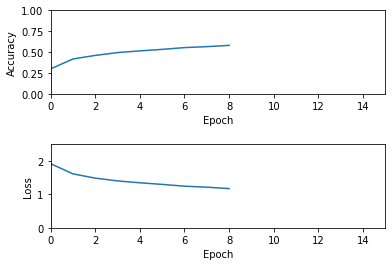

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a0model.ckpt Model Saved...
Epoch [225000], loss: 0.0636, acc: 1.0000
Epoch [225001], loss: 2.6756, acc: 0.0000
Epoch [225002], loss: 0.9647, acc: 1.0000
Epoch [225003], loss: 0.4698, acc: 1.0000
Epoch [225004], loss: 2.2235, acc: 0.0000
Epoch [225005], loss: 0.2765, acc: 1.0000
Epoch [225006], loss: 0.0443, acc: 1.0000
Epoch [225007], loss: 1.3901, acc: 0.0000
Epoch [225008], loss: 0.1457, acc: 1.0000
Epoch [225009], loss: 1.2755, acc: 0.0000
Epoch [225010], loss: 0.9475, acc: 1.0000
Epoch [225011], loss: 2.1729, acc: 0.0000
Epoch [225012], loss: 0.7073, acc: 1.0000
Epoch [225013], loss: 0.4610, acc: 1.0000
Epoch [225014], loss: 1.8482, acc: 0.0000
Epoch [225015], loss: 0.4295, acc: 1.0000
Epoch [225016], loss: 0.8306, acc: 1.0000
Epoch [225017], loss: 0.7646, acc: 1.0000
Epoch [225018], loss: 0.1427, acc: 1.0000
Epoch [225019], loss: 0.3778, acc: 1.0000
Epoch [225020], loss: 1.4906, acc: 1.0000
Epoch [225021],

Epoch [225194], loss: 0.2294, acc: 1.0000
Epoch [225195], loss: 0.0914, acc: 1.0000
Epoch [225196], loss: 2.8243, acc: 0.0000
Epoch [225197], loss: 0.0051, acc: 1.0000
Epoch [225198], loss: 0.2561, acc: 1.0000
Epoch [225199], loss: 0.2197, acc: 1.0000
Epoch [225200], loss: 0.7288, acc: 1.0000
Epoch [225201], loss: 0.0995, acc: 1.0000
Epoch [225202], loss: 3.0462, acc: 0.0000
Epoch [225203], loss: 1.7601, acc: 0.0000
Epoch [225204], loss: 1.1668, acc: 0.0000
Epoch [225205], loss: 1.0826, acc: 0.0000
Epoch [225206], loss: 2.4826, acc: 0.0000
Epoch [225207], loss: 1.5478, acc: 0.0000
Epoch [225208], loss: 1.4214, acc: 0.0000
Epoch [225209], loss: 0.1712, acc: 1.0000
Epoch [225210], loss: 3.5930, acc: 0.0000
Epoch [225211], loss: 1.1536, acc: 0.0000
Epoch [225212], loss: 0.6038, acc: 1.0000
Epoch [225213], loss: 2.6269, acc: 0.0000
Epoch [225214], loss: 0.2276, acc: 1.0000
Epoch [225215], loss: 0.7410, acc: 1.0000
Epoch [225216], loss: 0.3184, acc: 1.0000
Epoch [225217], loss: 1.3208, acc:

Epoch [225405], loss: 1.1202, acc: 1.0000
Epoch [225406], loss: 0.6375, acc: 1.0000
Epoch [225407], loss: 1.9058, acc: 0.0000
Epoch [225408], loss: 1.0123, acc: 0.0000
Epoch [225409], loss: 1.8574, acc: 0.0000
Epoch [225410], loss: 1.1814, acc: 0.0000
Epoch [225411], loss: 1.6581, acc: 0.0000
Epoch [225412], loss: 1.2977, acc: 1.0000
Epoch [225413], loss: 1.6111, acc: 0.0000
Epoch [225414], loss: 1.7744, acc: 0.0000
Epoch [225415], loss: 1.5825, acc: 0.0000
Epoch [225416], loss: 0.5145, acc: 1.0000
Epoch [225417], loss: 0.6052, acc: 1.0000
Epoch [225418], loss: 0.2358, acc: 1.0000
Epoch [225419], loss: 0.5833, acc: 1.0000
Epoch [225420], loss: 0.9119, acc: 1.0000
Epoch [225421], loss: 0.9594, acc: 1.0000
Epoch [225422], loss: 1.5569, acc: 0.0000
Epoch [225423], loss: 2.5134, acc: 0.0000
Epoch [225424], loss: 0.5540, acc: 1.0000
Epoch [225425], loss: 0.0895, acc: 1.0000
Epoch [225426], loss: 1.4657, acc: 1.0000
Epoch [225427], loss: 0.8424, acc: 1.0000
Epoch [225428], loss: 0.4451, acc:

Epoch [225598], loss: 0.2832, acc: 1.0000
Epoch [225599], loss: 0.1408, acc: 1.0000
Epoch [225600], loss: 0.1926, acc: 1.0000
Epoch [225601], loss: 0.8629, acc: 1.0000
Epoch [225602], loss: 0.1494, acc: 1.0000
Epoch [225603], loss: 1.5465, acc: 1.0000
Epoch [225604], loss: 0.0184, acc: 1.0000
Epoch [225605], loss: 0.9293, acc: 1.0000
Epoch [225606], loss: 0.2704, acc: 1.0000
Epoch [225607], loss: 0.4945, acc: 1.0000
Epoch [225608], loss: 0.0128, acc: 1.0000
Epoch [225609], loss: 4.9253, acc: 0.0000
Epoch [225610], loss: 0.8770, acc: 0.0000
Epoch [225611], loss: 0.2594, acc: 1.0000
Epoch [225612], loss: 0.4231, acc: 1.0000
Epoch [225613], loss: 0.0269, acc: 1.0000
Epoch [225614], loss: 0.4250, acc: 1.0000
Epoch [225615], loss: 0.4948, acc: 1.0000
Epoch [225616], loss: 2.6458, acc: 0.0000
Epoch [225617], loss: 1.3986, acc: 0.0000
Epoch [225618], loss: 0.6257, acc: 1.0000
Epoch [225619], loss: 0.3366, acc: 1.0000
Epoch [225620], loss: 0.6450, acc: 1.0000
Epoch [225621], loss: 0.0824, acc:

Epoch [225794], loss: 3.2290, acc: 0.0000
Epoch [225795], loss: 0.5858, acc: 1.0000
Epoch [225796], loss: 1.7370, acc: 0.0000
Epoch [225797], loss: 1.6156, acc: 0.0000
Epoch [225798], loss: 2.2826, acc: 0.0000
Epoch [225799], loss: 4.7101, acc: 0.0000
Epoch [225800], loss: 0.6592, acc: 1.0000
Epoch [225801], loss: 1.3472, acc: 0.0000
Epoch [225802], loss: 0.0673, acc: 1.0000
Epoch [225803], loss: 3.4450, acc: 0.0000
Epoch [225804], loss: 0.1550, acc: 1.0000
Epoch [225805], loss: 0.2874, acc: 1.0000
Epoch [225806], loss: 3.0767, acc: 0.0000
Epoch [225807], loss: 4.8454, acc: 0.0000
Epoch [225808], loss: 1.2265, acc: 1.0000
Epoch [225809], loss: 2.1915, acc: 0.0000
Epoch [225810], loss: 0.3711, acc: 1.0000
Epoch [225811], loss: 1.8424, acc: 0.0000
Epoch [225812], loss: 0.0140, acc: 1.0000
Epoch [225813], loss: 1.3887, acc: 0.0000
Epoch [225814], loss: 2.7409, acc: 0.0000
Epoch [225815], loss: 0.3001, acc: 1.0000
Epoch [225816], loss: 0.0103, acc: 1.0000
Epoch [225817], loss: 0.0852, acc:

Epoch [226003], loss: 0.1950, acc: 1.0000
Epoch [226004], loss: 0.9972, acc: 0.0000
Epoch [226005], loss: 0.9295, acc: 1.0000
Epoch [226006], loss: 2.0582, acc: 0.0000
Epoch [226007], loss: 0.0325, acc: 1.0000
Epoch [226008], loss: 0.0120, acc: 1.0000
Epoch [226009], loss: 0.3949, acc: 1.0000
Epoch [226010], loss: 0.6262, acc: 1.0000
Epoch [226011], loss: 1.1515, acc: 1.0000
Epoch [226012], loss: 0.4671, acc: 1.0000
Epoch [226013], loss: 2.9454, acc: 0.0000
Epoch [226014], loss: 3.3303, acc: 0.0000
Epoch [226015], loss: 0.2229, acc: 1.0000
Epoch [226016], loss: 0.5451, acc: 1.0000
Epoch [226017], loss: 0.0939, acc: 1.0000
Epoch [226018], loss: 1.3606, acc: 0.0000
Epoch [226019], loss: 0.9068, acc: 1.0000
Epoch [226020], loss: 2.5664, acc: 0.0000
Epoch [226021], loss: 0.5715, acc: 1.0000
Epoch [226022], loss: 0.5652, acc: 1.0000
Epoch [226023], loss: 1.4645, acc: 0.0000
Epoch [226024], loss: 2.2015, acc: 0.0000
Epoch [226025], loss: 0.2949, acc: 1.0000
Epoch [226026], loss: 0.1924, acc:

Epoch [226211], loss: 0.3423, acc: 1.0000
Epoch [226212], loss: 0.1538, acc: 1.0000
Epoch [226213], loss: 1.1430, acc: 0.0000
Epoch [226214], loss: 2.5024, acc: 0.0000
Epoch [226215], loss: 1.2818, acc: 0.0000
Epoch [226216], loss: 2.1557, acc: 0.0000
Epoch [226217], loss: 3.2852, acc: 0.0000
Epoch [226218], loss: 1.7951, acc: 0.0000
Epoch [226219], loss: 0.2354, acc: 1.0000
Epoch [226220], loss: 0.2403, acc: 1.0000
Epoch [226221], loss: 0.2787, acc: 1.0000
Epoch [226222], loss: 0.0487, acc: 1.0000
Epoch [226223], loss: 0.9912, acc: 1.0000
Epoch [226224], loss: 1.8946, acc: 0.0000
Epoch [226225], loss: 1.8867, acc: 0.0000
Epoch [226226], loss: 0.3130, acc: 1.0000
Epoch [226227], loss: 0.3772, acc: 1.0000
Epoch [226228], loss: 1.5437, acc: 0.0000
Epoch [226229], loss: 0.3945, acc: 1.0000
Epoch [226230], loss: 0.7356, acc: 1.0000
Epoch [226231], loss: 0.6320, acc: 1.0000
Epoch [226232], loss: 0.9052, acc: 1.0000
Epoch [226233], loss: 3.3319, acc: 0.0000
Epoch [226234], loss: 2.1240, acc:

Epoch [226407], loss: 2.3822, acc: 0.0000
Epoch [226408], loss: 1.1553, acc: 1.0000
Epoch [226409], loss: 0.8537, acc: 0.0000
Epoch [226410], loss: 1.6251, acc: 0.0000
Epoch [226411], loss: 0.8522, acc: 1.0000
Epoch [226412], loss: 1.3288, acc: 0.0000
Epoch [226413], loss: 2.0928, acc: 0.0000
Epoch [226414], loss: 1.4810, acc: 0.0000
Epoch [226415], loss: 2.2693, acc: 0.0000
Epoch [226416], loss: 0.3462, acc: 1.0000
Epoch [226417], loss: 0.1386, acc: 1.0000
Epoch [226418], loss: 0.1096, acc: 1.0000
Epoch [226419], loss: 3.4658, acc: 0.0000
Epoch [226420], loss: 1.3745, acc: 0.0000
Epoch [226421], loss: 0.6699, acc: 1.0000
Epoch [226422], loss: 0.8578, acc: 1.0000
Epoch [226423], loss: 2.5708, acc: 0.0000
Epoch [226424], loss: 2.4510, acc: 0.0000
Epoch [226425], loss: 1.4257, acc: 0.0000
Epoch [226426], loss: 0.5658, acc: 1.0000
Epoch [226427], loss: 0.3926, acc: 1.0000
Epoch [226428], loss: 0.0868, acc: 1.0000
Epoch [226429], loss: 1.4469, acc: 1.0000
Epoch [226430], loss: 0.7432, acc:

Epoch [226612], loss: 2.9987, acc: 0.0000
Epoch [226613], loss: 1.3813, acc: 0.0000
Epoch [226614], loss: 0.9797, acc: 0.0000
Epoch [226615], loss: 0.4951, acc: 1.0000
Epoch [226616], loss: 0.0534, acc: 1.0000
Epoch [226617], loss: 1.7921, acc: 0.0000
Epoch [226618], loss: 0.1305, acc: 1.0000
Epoch [226619], loss: 0.5251, acc: 1.0000
Epoch [226620], loss: 0.2977, acc: 1.0000
Epoch [226621], loss: 0.6589, acc: 1.0000
Epoch [226622], loss: 0.3371, acc: 1.0000
Epoch [226623], loss: 0.4691, acc: 1.0000
Epoch [226624], loss: 2.7873, acc: 0.0000
Epoch [226625], loss: 2.2484, acc: 0.0000
Epoch [226626], loss: 0.4630, acc: 1.0000
Epoch [226627], loss: 0.4468, acc: 1.0000
Epoch [226628], loss: 0.2755, acc: 1.0000
Epoch [226629], loss: 3.2849, acc: 0.0000
Epoch [226630], loss: 0.5890, acc: 1.0000
Epoch [226631], loss: 0.6324, acc: 1.0000
Epoch [226632], loss: 4.8593, acc: 0.0000
Epoch [226633], loss: 0.6013, acc: 1.0000
Epoch [226634], loss: 1.0475, acc: 1.0000
Epoch [226635], loss: 0.3026, acc:

Epoch [226814], loss: 1.5878, acc: 0.0000
Epoch [226815], loss: 1.0379, acc: 0.0000
Epoch [226816], loss: 0.0698, acc: 1.0000
Epoch [226817], loss: 1.0861, acc: 1.0000
Epoch [226818], loss: 0.3561, acc: 1.0000
Epoch [226819], loss: 1.8222, acc: 0.0000
Epoch [226820], loss: 1.3395, acc: 0.0000
Epoch [226821], loss: 0.4908, acc: 1.0000
Epoch [226822], loss: 0.0749, acc: 1.0000
Epoch [226823], loss: 2.3571, acc: 0.0000
Epoch [226824], loss: 2.3271, acc: 0.0000
Epoch [226825], loss: 0.2552, acc: 1.0000
Epoch [226826], loss: 1.3098, acc: 0.0000
Epoch [226827], loss: 0.0644, acc: 1.0000
Epoch [226828], loss: 2.5698, acc: 0.0000
Epoch [226829], loss: 0.1025, acc: 1.0000
Epoch [226830], loss: 0.2427, acc: 1.0000
Epoch [226831], loss: 0.3921, acc: 1.0000
Epoch [226832], loss: 0.1353, acc: 1.0000
Epoch [226833], loss: 0.2837, acc: 1.0000
Epoch [226834], loss: 1.1339, acc: 1.0000
Epoch [226835], loss: 1.3829, acc: 0.0000
Epoch [226836], loss: 0.3817, acc: 1.0000
Epoch [226837], loss: 0.4002, acc:

Epoch [227021], loss: 0.0799, acc: 1.0000
Epoch [227022], loss: 1.4138, acc: 0.0000
Epoch [227023], loss: 0.0232, acc: 1.0000
Epoch [227024], loss: 0.7993, acc: 1.0000
Epoch [227025], loss: 1.1450, acc: 0.0000
Epoch [227026], loss: 3.0952, acc: 0.0000
Epoch [227027], loss: 2.9753, acc: 0.0000
Epoch [227028], loss: 0.4273, acc: 1.0000
Epoch [227029], loss: 0.2934, acc: 1.0000
Epoch [227030], loss: 0.1463, acc: 1.0000
Epoch [227031], loss: 1.3184, acc: 1.0000
Epoch [227032], loss: 3.0316, acc: 0.0000
Epoch [227033], loss: 0.3492, acc: 1.0000
Epoch [227034], loss: 3.6648, acc: 0.0000
Epoch [227035], loss: 1.5056, acc: 0.0000
Epoch [227036], loss: 0.9064, acc: 1.0000
Epoch [227037], loss: 0.7578, acc: 1.0000
Epoch [227038], loss: 0.7387, acc: 1.0000
Epoch [227039], loss: 0.0411, acc: 1.0000
Epoch [227040], loss: 1.2109, acc: 0.0000
Epoch [227041], loss: 0.5601, acc: 1.0000
Epoch [227042], loss: 0.4076, acc: 1.0000
Epoch [227043], loss: 0.0167, acc: 1.0000
Epoch [227044], loss: 1.2853, acc:

Epoch [227230], loss: 1.0269, acc: 1.0000
Epoch [227231], loss: 0.5888, acc: 1.0000
Epoch [227232], loss: 1.2273, acc: 1.0000
Epoch [227233], loss: 0.5623, acc: 1.0000
Epoch [227234], loss: 0.1664, acc: 1.0000
Epoch [227235], loss: 0.6770, acc: 1.0000
Epoch [227236], loss: 0.3626, acc: 1.0000
Epoch [227237], loss: 0.7505, acc: 1.0000
Epoch [227238], loss: 3.2473, acc: 0.0000
Epoch [227239], loss: 0.0129, acc: 1.0000
Epoch [227240], loss: 0.1431, acc: 1.0000
Epoch [227241], loss: 0.0922, acc: 1.0000
Epoch [227242], loss: 0.3633, acc: 1.0000
Epoch [227243], loss: 1.3934, acc: 1.0000
Epoch [227244], loss: 3.0410, acc: 0.0000
Epoch [227245], loss: 0.6672, acc: 1.0000
Epoch [227246], loss: 0.2050, acc: 1.0000
Epoch [227247], loss: 1.4217, acc: 0.0000
Epoch [227248], loss: 0.3377, acc: 1.0000
Epoch [227249], loss: 0.2383, acc: 1.0000
Epoch [227250], loss: 0.3393, acc: 1.0000
Epoch [227251], loss: 3.0588, acc: 0.0000
Epoch [227252], loss: 0.2020, acc: 1.0000
Epoch [227253], loss: 0.7637, acc:

Epoch [227440], loss: 0.2819, acc: 1.0000
Epoch [227441], loss: 1.8204, acc: 0.0000
Epoch [227442], loss: 0.1822, acc: 1.0000
Epoch [227443], loss: 0.0590, acc: 1.0000
Epoch [227444], loss: 1.2905, acc: 0.0000
Epoch [227445], loss: 0.2282, acc: 1.0000
Epoch [227446], loss: 1.7479, acc: 0.0000
Epoch [227447], loss: 1.0046, acc: 1.0000
Epoch [227448], loss: 0.3621, acc: 1.0000
Epoch [227449], loss: 1.2469, acc: 0.0000
Epoch [227450], loss: 0.0874, acc: 1.0000
Epoch [227451], loss: 2.3774, acc: 0.0000
Epoch [227452], loss: 1.4099, acc: 1.0000
Epoch [227453], loss: 0.1615, acc: 1.0000
Epoch [227454], loss: 0.0467, acc: 1.0000
Epoch [227455], loss: 0.2052, acc: 1.0000
Epoch [227456], loss: 1.8186, acc: 0.0000
Epoch [227457], loss: 0.6167, acc: 1.0000
Epoch [227458], loss: 1.3157, acc: 0.0000
Epoch [227459], loss: 0.9907, acc: 0.0000
Epoch [227460], loss: 1.1555, acc: 0.0000
Epoch [227461], loss: 1.2106, acc: 0.0000
Epoch [227462], loss: 0.3905, acc: 1.0000
Epoch [227463], loss: 0.9600, acc:

Epoch [227644], loss: 1.7330, acc: 0.0000
Epoch [227645], loss: 0.4309, acc: 1.0000
Epoch [227646], loss: 0.7543, acc: 1.0000
Epoch [227647], loss: 2.1760, acc: 0.0000
Epoch [227648], loss: 2.3935, acc: 0.0000
Epoch [227649], loss: 1.8410, acc: 0.0000
Epoch [227650], loss: 0.3095, acc: 1.0000
Epoch [227651], loss: 2.1253, acc: 0.0000
Epoch [227652], loss: 1.0699, acc: 0.0000
Epoch [227653], loss: 1.0747, acc: 1.0000
Epoch [227654], loss: 0.0275, acc: 1.0000
Epoch [227655], loss: 1.2699, acc: 1.0000
Epoch [227656], loss: 0.2541, acc: 1.0000
Epoch [227657], loss: 2.0367, acc: 0.0000
Epoch [227658], loss: 0.4677, acc: 1.0000
Epoch [227659], loss: 0.0658, acc: 1.0000
Epoch [227660], loss: 2.3015, acc: 0.0000
Epoch [227661], loss: 0.0621, acc: 1.0000
Epoch [227662], loss: 1.4955, acc: 0.0000
Epoch [227663], loss: 4.5248, acc: 0.0000
Epoch [227664], loss: 1.7027, acc: 0.0000
Epoch [227665], loss: 1.7861, acc: 0.0000
Epoch [227666], loss: 2.3111, acc: 0.0000
Epoch [227667], loss: 0.9278, acc:

Epoch [227856], loss: 1.4839, acc: 0.0000
Epoch [227857], loss: 0.2386, acc: 1.0000
Epoch [227858], loss: 0.2759, acc: 1.0000
Epoch [227859], loss: 0.8325, acc: 1.0000
Epoch [227860], loss: 0.6030, acc: 1.0000
Epoch [227861], loss: 2.2540, acc: 0.0000
Epoch [227862], loss: 0.2047, acc: 1.0000
Epoch [227863], loss: 2.1762, acc: 0.0000
Epoch [227864], loss: 0.6522, acc: 1.0000
Epoch [227865], loss: 0.0604, acc: 1.0000
Epoch [227866], loss: 0.4324, acc: 1.0000
Epoch [227867], loss: 2.3376, acc: 0.0000
Epoch [227868], loss: 6.5966, acc: 0.0000
Epoch [227869], loss: 0.9673, acc: 1.0000
Epoch [227870], loss: 0.0288, acc: 1.0000
Epoch [227871], loss: 0.1557, acc: 1.0000
Epoch [227872], loss: 0.3548, acc: 1.0000
Epoch [227873], loss: 0.9545, acc: 1.0000
Epoch [227874], loss: 0.6123, acc: 1.0000
Epoch [227875], loss: 0.0211, acc: 1.0000
Epoch [227876], loss: 2.0202, acc: 0.0000
Epoch [227877], loss: 2.0344, acc: 0.0000
Epoch [227878], loss: 3.1039, acc: 0.0000
Epoch [227879], loss: 0.7483, acc:

Epoch [228059], loss: 1.9895, acc: 0.0000
Epoch [228060], loss: 0.3306, acc: 1.0000
Epoch [228061], loss: 0.0500, acc: 1.0000
Epoch [228062], loss: 3.1626, acc: 0.0000
Epoch [228063], loss: 0.7047, acc: 1.0000
Epoch [228064], loss: 0.4951, acc: 1.0000
Epoch [228065], loss: 2.5563, acc: 0.0000
Epoch [228066], loss: 0.2399, acc: 1.0000
Epoch [228067], loss: 0.9696, acc: 1.0000
Epoch [228068], loss: 1.6737, acc: 0.0000
Epoch [228069], loss: 0.7906, acc: 1.0000
Epoch [228070], loss: 0.3247, acc: 1.0000
Epoch [228071], loss: 0.8563, acc: 1.0000
Epoch [228072], loss: 1.4387, acc: 0.0000
Epoch [228073], loss: 0.2823, acc: 1.0000
Epoch [228074], loss: 1.0550, acc: 0.0000
Epoch [228075], loss: 3.3016, acc: 0.0000
Epoch [228076], loss: 1.5353, acc: 0.0000
Epoch [228077], loss: 0.2911, acc: 1.0000
Epoch [228078], loss: 3.6865, acc: 0.0000
Epoch [228079], loss: 0.1914, acc: 1.0000
Epoch [228080], loss: 0.9647, acc: 1.0000
Epoch [228081], loss: 3.3759, acc: 0.0000
Epoch [228082], loss: 0.2108, acc:

Epoch [228262], loss: 0.8852, acc: 0.0000
Epoch [228263], loss: 1.3543, acc: 0.0000
Epoch [228264], loss: 1.1235, acc: 0.0000
Epoch [228265], loss: 5.2685, acc: 0.0000
Epoch [228266], loss: 0.0278, acc: 1.0000
Epoch [228267], loss: 3.2133, acc: 0.0000
Epoch [228268], loss: 2.0761, acc: 0.0000
Epoch [228269], loss: 0.0867, acc: 1.0000
Epoch [228270], loss: 0.2772, acc: 1.0000
Epoch [228271], loss: 0.8458, acc: 0.0000
Epoch [228272], loss: 0.9586, acc: 1.0000
Epoch [228273], loss: 0.0801, acc: 1.0000
Epoch [228274], loss: 0.4839, acc: 1.0000
Epoch [228275], loss: 0.3254, acc: 1.0000
Epoch [228276], loss: 0.3400, acc: 1.0000
Epoch [228277], loss: 3.8670, acc: 0.0000
Epoch [228278], loss: 0.7020, acc: 1.0000
Epoch [228279], loss: 1.4439, acc: 0.0000
Epoch [228280], loss: 0.4251, acc: 1.0000
Epoch [228281], loss: 0.3687, acc: 1.0000
Epoch [228282], loss: 1.8533, acc: 0.0000
Epoch [228283], loss: 0.8351, acc: 1.0000
Epoch [228284], loss: 0.3772, acc: 1.0000
Epoch [228285], loss: 0.9584, acc:

Epoch [228459], loss: 2.3764, acc: 0.0000
Epoch [228460], loss: 1.8480, acc: 0.0000
Epoch [228461], loss: 1.8164, acc: 0.0000
Epoch [228462], loss: 0.9070, acc: 0.0000
Epoch [228463], loss: 1.8182, acc: 0.0000
Epoch [228464], loss: 0.0336, acc: 1.0000
Epoch [228465], loss: 0.0918, acc: 1.0000
Epoch [228466], loss: 0.0044, acc: 1.0000
Epoch [228467], loss: 0.3670, acc: 1.0000
Epoch [228468], loss: 0.0998, acc: 1.0000
Epoch [228469], loss: 0.2292, acc: 1.0000
Epoch [228470], loss: 0.5362, acc: 1.0000
Epoch [228471], loss: 0.8295, acc: 1.0000
Epoch [228472], loss: 0.2337, acc: 1.0000
Epoch [228473], loss: 0.2182, acc: 1.0000
Epoch [228474], loss: 1.2169, acc: 1.0000
Epoch [228475], loss: 0.0547, acc: 1.0000
Epoch [228476], loss: 1.2031, acc: 1.0000
Epoch [228477], loss: 2.2670, acc: 0.0000
Epoch [228478], loss: 2.5643, acc: 0.0000
Epoch [228479], loss: 0.6028, acc: 1.0000
Epoch [228480], loss: 0.0529, acc: 1.0000
Epoch [228481], loss: 0.2820, acc: 1.0000
Epoch [228482], loss: 0.7170, acc:

Epoch [228656], loss: 0.2371, acc: 1.0000
Epoch [228657], loss: 1.6028, acc: 0.0000
Epoch [228658], loss: 1.2870, acc: 1.0000
Epoch [228659], loss: 1.1840, acc: 1.0000
Epoch [228660], loss: 0.1609, acc: 1.0000
Epoch [228661], loss: 0.2044, acc: 1.0000
Epoch [228662], loss: 0.4445, acc: 1.0000
Epoch [228663], loss: 2.7532, acc: 0.0000
Epoch [228664], loss: 0.6355, acc: 1.0000
Epoch [228665], loss: 1.0435, acc: 1.0000
Epoch [228666], loss: 0.6998, acc: 1.0000
Epoch [228667], loss: 0.5436, acc: 1.0000
Epoch [228668], loss: 1.3051, acc: 1.0000
Epoch [228669], loss: 0.5746, acc: 1.0000
Epoch [228670], loss: 0.3337, acc: 1.0000
Epoch [228671], loss: 1.0923, acc: 0.0000
Epoch [228672], loss: 2.9065, acc: 0.0000
Epoch [228673], loss: 0.3161, acc: 1.0000
Epoch [228674], loss: 2.2484, acc: 0.0000
Epoch [228675], loss: 2.0143, acc: 0.0000
Epoch [228676], loss: 0.6788, acc: 1.0000
Epoch [228677], loss: 1.7790, acc: 0.0000
Epoch [228678], loss: 1.9429, acc: 0.0000
Epoch [228679], loss: 0.7312, acc:

Epoch [228858], loss: 1.9039, acc: 0.0000
Epoch [228859], loss: 0.6562, acc: 1.0000
Epoch [228860], loss: 0.4701, acc: 1.0000
Epoch [228861], loss: 0.8894, acc: 1.0000
Epoch [228862], loss: 0.7849, acc: 1.0000
Epoch [228863], loss: 0.4741, acc: 1.0000
Epoch [228864], loss: 1.4985, acc: 1.0000
Epoch [228865], loss: 1.1909, acc: 0.0000
Epoch [228866], loss: 0.8563, acc: 1.0000
Epoch [228867], loss: 1.1774, acc: 0.0000
Epoch [228868], loss: 0.3085, acc: 1.0000
Epoch [228869], loss: 0.5910, acc: 1.0000
Epoch [228870], loss: 1.3788, acc: 1.0000
Epoch [228871], loss: 0.1001, acc: 1.0000
Epoch [228872], loss: 1.2758, acc: 0.0000
Epoch [228873], loss: 2.9042, acc: 0.0000
Epoch [228874], loss: 0.0675, acc: 1.0000
Epoch [228875], loss: 2.7442, acc: 0.0000
Epoch [228876], loss: 2.0744, acc: 0.0000
Epoch [228877], loss: 0.1463, acc: 1.0000
Epoch [228878], loss: 2.5716, acc: 0.0000
Epoch [228879], loss: 0.2873, acc: 1.0000
Epoch [228880], loss: 1.2780, acc: 1.0000
Epoch [228881], loss: 0.2260, acc:

Epoch [229059], loss: 0.0869, acc: 1.0000
Epoch [229060], loss: 0.0386, acc: 1.0000
Epoch [229061], loss: 1.8183, acc: 0.0000
Epoch [229062], loss: 0.4317, acc: 1.0000
Epoch [229063], loss: 0.5252, acc: 1.0000
Epoch [229064], loss: 1.7191, acc: 0.0000
Epoch [229065], loss: 0.4407, acc: 1.0000
Epoch [229066], loss: 1.2047, acc: 0.0000
Epoch [229067], loss: 0.1573, acc: 1.0000
Epoch [229068], loss: 2.6386, acc: 0.0000
Epoch [229069], loss: 0.1468, acc: 1.0000
Epoch [229070], loss: 1.3494, acc: 0.0000
Epoch [229071], loss: 0.0723, acc: 1.0000
Epoch [229072], loss: 0.4760, acc: 1.0000
Epoch [229073], loss: 0.1330, acc: 1.0000
Epoch [229074], loss: 1.1781, acc: 0.0000
Epoch [229075], loss: 0.1296, acc: 1.0000
Epoch [229076], loss: 1.2575, acc: 1.0000
Epoch [229077], loss: 1.3757, acc: 1.0000
Epoch [229078], loss: 2.7962, acc: 0.0000
Epoch [229079], loss: 1.8939, acc: 0.0000
Epoch [229080], loss: 1.9394, acc: 0.0000
Epoch [229081], loss: 0.5176, acc: 1.0000
Epoch [229082], loss: 0.1145, acc:

Epoch [229269], loss: 1.7587, acc: 0.0000
Epoch [229270], loss: 1.2012, acc: 0.0000
Epoch [229271], loss: 2.0497, acc: 0.0000
Epoch [229272], loss: 1.0039, acc: 1.0000
Epoch [229273], loss: 0.0026, acc: 1.0000
Epoch [229274], loss: 0.0243, acc: 1.0000
Epoch [229275], loss: 2.4386, acc: 0.0000
Epoch [229276], loss: 2.0937, acc: 0.0000
Epoch [229277], loss: 0.4123, acc: 1.0000
Epoch [229278], loss: 1.0821, acc: 1.0000
Epoch [229279], loss: 2.5756, acc: 0.0000
Epoch [229280], loss: 1.2302, acc: 1.0000
Epoch [229281], loss: 0.8537, acc: 0.0000
Epoch [229282], loss: 0.1626, acc: 1.0000
Epoch [229283], loss: 1.4876, acc: 0.0000
Epoch [229284], loss: 0.1743, acc: 1.0000
Epoch [229285], loss: 6.2608, acc: 0.0000
Epoch [229286], loss: 0.4855, acc: 1.0000
Epoch [229287], loss: 0.6542, acc: 1.0000
Epoch [229288], loss: 0.0958, acc: 1.0000
Epoch [229289], loss: 0.5093, acc: 1.0000
Epoch [229290], loss: 0.6708, acc: 1.0000
Epoch [229291], loss: 0.3525, acc: 1.0000
Epoch [229292], loss: 1.7333, acc:

Epoch [229479], loss: 0.1772, acc: 1.0000
Epoch [229480], loss: 1.0176, acc: 1.0000
Epoch [229481], loss: 0.6024, acc: 1.0000
Epoch [229482], loss: 2.2540, acc: 0.0000
Epoch [229483], loss: 1.9565, acc: 0.0000
Epoch [229484], loss: 0.2149, acc: 1.0000
Epoch [229485], loss: 0.6135, acc: 1.0000
Epoch [229486], loss: 0.2827, acc: 1.0000
Epoch [229487], loss: 0.2406, acc: 1.0000
Epoch [229488], loss: 0.9988, acc: 1.0000
Epoch [229489], loss: 0.6113, acc: 1.0000
Epoch [229490], loss: 1.2508, acc: 0.0000
Epoch [229491], loss: 0.5294, acc: 1.0000
Epoch [229492], loss: 2.1880, acc: 0.0000
Epoch [229493], loss: 2.6237, acc: 0.0000
Epoch [229494], loss: 4.2323, acc: 0.0000
Epoch [229495], loss: 2.1358, acc: 0.0000
Epoch [229496], loss: 1.8864, acc: 0.0000
Epoch [229497], loss: 2.7827, acc: 0.0000
Epoch [229498], loss: 1.4416, acc: 0.0000
Epoch [229499], loss: 5.2183, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a4500model.ckpt Model Saved...
Epoch [22950

Epoch [229682], loss: 0.2367, acc: 1.0000
Epoch [229683], loss: 0.0230, acc: 1.0000
Epoch [229684], loss: 0.4956, acc: 1.0000
Epoch [229685], loss: 0.7938, acc: 0.0000
Epoch [229686], loss: 0.2091, acc: 1.0000
Epoch [229687], loss: 2.7526, acc: 0.0000
Epoch [229688], loss: 0.4745, acc: 1.0000
Epoch [229689], loss: 0.3566, acc: 1.0000
Epoch [229690], loss: 1.8173, acc: 0.0000
Epoch [229691], loss: 0.9771, acc: 1.0000
Epoch [229692], loss: 1.6968, acc: 0.0000
Epoch [229693], loss: 0.3618, acc: 1.0000
Epoch [229694], loss: 0.0672, acc: 1.0000
Epoch [229695], loss: 0.7759, acc: 1.0000
Epoch [229696], loss: 0.5128, acc: 1.0000
Epoch [229697], loss: 0.2757, acc: 1.0000
Epoch [229698], loss: 1.6598, acc: 0.0000
Epoch [229699], loss: 0.8908, acc: 1.0000
Epoch [229700], loss: 0.2413, acc: 1.0000
Epoch [229701], loss: 0.5733, acc: 1.0000
Epoch [229702], loss: 0.8496, acc: 1.0000
Epoch [229703], loss: 1.9436, acc: 0.0000
Epoch [229704], loss: 1.0916, acc: 0.0000
Epoch [229705], loss: 1.2596, acc:

Epoch [229891], loss: 0.0280, acc: 1.0000
Epoch [229892], loss: 0.9929, acc: 0.0000
Epoch [229893], loss: 0.3366, acc: 1.0000
Epoch [229894], loss: 1.5218, acc: 0.0000
Epoch [229895], loss: 0.2969, acc: 1.0000
Epoch [229896], loss: 2.5519, acc: 0.0000
Epoch [229897], loss: 2.2298, acc: 0.0000
Epoch [229898], loss: 1.1329, acc: 0.0000
Epoch [229899], loss: 0.1825, acc: 1.0000
Epoch [229900], loss: 1.1192, acc: 1.0000
Epoch [229901], loss: 0.0057, acc: 1.0000
Epoch [229902], loss: 0.0779, acc: 1.0000
Epoch [229903], loss: 1.4239, acc: 0.0000
Epoch [229904], loss: 0.8060, acc: 1.0000
Epoch [229905], loss: 0.3881, acc: 1.0000
Epoch [229906], loss: 0.9115, acc: 1.0000
Epoch [229907], loss: 0.2978, acc: 1.0000
Epoch [229908], loss: 0.9213, acc: 1.0000
Epoch [229909], loss: 1.8311, acc: 0.0000
Epoch [229910], loss: 0.3358, acc: 1.0000
Epoch [229911], loss: 0.8217, acc: 0.0000
Epoch [229912], loss: 0.0806, acc: 1.0000
Epoch [229913], loss: 5.3666, acc: 0.0000
Epoch [229914], loss: 0.5842, acc:

Epoch [230097], loss: 1.0620, acc: 1.0000
Epoch [230098], loss: 0.6727, acc: 1.0000
Epoch [230099], loss: 1.1498, acc: 0.0000
Epoch [230100], loss: 2.5404, acc: 0.0000
Epoch [230101], loss: 2.4964, acc: 0.0000
Epoch [230102], loss: 0.2375, acc: 1.0000
Epoch [230103], loss: 1.8319, acc: 0.0000
Epoch [230104], loss: 0.9897, acc: 1.0000
Epoch [230105], loss: 0.7281, acc: 1.0000
Epoch [230106], loss: 0.4938, acc: 1.0000
Epoch [230107], loss: 1.2597, acc: 0.0000
Epoch [230108], loss: 2.5938, acc: 0.0000
Epoch [230109], loss: 0.3137, acc: 1.0000
Epoch [230110], loss: 4.9717, acc: 0.0000
Epoch [230111], loss: 1.0415, acc: 1.0000
Epoch [230112], loss: 3.5110, acc: 0.0000
Epoch [230113], loss: 0.7801, acc: 1.0000
Epoch [230114], loss: 1.2367, acc: 1.0000
Epoch [230115], loss: 0.2157, acc: 1.0000
Epoch [230116], loss: 0.8724, acc: 0.0000
Epoch [230117], loss: 0.3289, acc: 1.0000
Epoch [230118], loss: 0.7619, acc: 1.0000
Epoch [230119], loss: 1.2222, acc: 1.0000
Epoch [230120], loss: 0.1639, acc:

Epoch [230294], loss: 2.6362, acc: 0.0000
Epoch [230295], loss: 1.2644, acc: 1.0000
Epoch [230296], loss: 0.9400, acc: 1.0000
Epoch [230297], loss: 2.0348, acc: 0.0000
Epoch [230298], loss: 2.6205, acc: 0.0000
Epoch [230299], loss: 1.1079, acc: 0.0000
Epoch [230300], loss: 0.3055, acc: 1.0000
Epoch [230301], loss: 1.5824, acc: 0.0000
Epoch [230302], loss: 0.0845, acc: 1.0000
Epoch [230303], loss: 1.6899, acc: 0.0000
Epoch [230304], loss: 1.0029, acc: 0.0000
Epoch [230305], loss: 0.1001, acc: 1.0000
Epoch [230306], loss: 0.0570, acc: 1.0000
Epoch [230307], loss: 0.2969, acc: 1.0000
Epoch [230308], loss: 3.3622, acc: 0.0000
Epoch [230309], loss: 0.1204, acc: 1.0000
Epoch [230310], loss: 1.3819, acc: 0.0000
Epoch [230311], loss: 0.2950, acc: 1.0000
Epoch [230312], loss: 0.4256, acc: 1.0000
Epoch [230313], loss: 0.4789, acc: 1.0000
Epoch [230314], loss: 0.7094, acc: 1.0000
Epoch [230315], loss: 2.0203, acc: 0.0000
Epoch [230316], loss: 0.0724, acc: 1.0000
Epoch [230317], loss: 0.0148, acc:

Epoch [230498], loss: 0.8218, acc: 1.0000
Epoch [230499], loss: 0.1188, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a5500model.ckpt Model Saved...
Epoch [230500], loss: 0.8197, acc: 1.0000
Epoch [230501], loss: 0.7912, acc: 1.0000
Epoch [230502], loss: 0.1790, acc: 1.0000
Epoch [230503], loss: 1.9113, acc: 0.0000
Epoch [230504], loss: 0.8704, acc: 1.0000
Epoch [230505], loss: 4.5790, acc: 0.0000
Epoch [230506], loss: 0.4530, acc: 1.0000
Epoch [230507], loss: 1.1427, acc: 1.0000
Epoch [230508], loss: 2.3055, acc: 0.0000
Epoch [230509], loss: 0.0372, acc: 1.0000
Epoch [230510], loss: 0.6258, acc: 1.0000
Epoch [230511], loss: 0.4118, acc: 1.0000
Epoch [230512], loss: 0.0996, acc: 1.0000
Epoch [230513], loss: 0.0090, acc: 1.0000
Epoch [230514], loss: 0.7679, acc: 0.0000
Epoch [230515], loss: 2.0026, acc: 0.0000
Epoch [230516], loss: 0.1813, acc: 1.0000
Epoch [230517], loss: 0.1753, acc: 1.0000
Epoch [230518], loss: 0.1860, acc: 1.0000
Epoch [23051

Epoch [230696], loss: 0.3275, acc: 1.0000
Epoch [230697], loss: 0.6201, acc: 1.0000
Epoch [230698], loss: 2.5181, acc: 0.0000
Epoch [230699], loss: 3.2090, acc: 0.0000
Epoch [230700], loss: 0.2306, acc: 1.0000
Epoch [230701], loss: 1.0153, acc: 0.0000
Epoch [230702], loss: 1.6008, acc: 0.0000
Epoch [230703], loss: 0.4266, acc: 1.0000
Epoch [230704], loss: 0.0773, acc: 1.0000
Epoch [230705], loss: 2.6393, acc: 0.0000
Epoch [230706], loss: 0.1627, acc: 1.0000
Epoch [230707], loss: 5.5011, acc: 0.0000
Epoch [230708], loss: 0.6923, acc: 1.0000
Epoch [230709], loss: 2.0374, acc: 0.0000
Epoch [230710], loss: 3.0672, acc: 0.0000
Epoch [230711], loss: 2.3936, acc: 0.0000
Epoch [230712], loss: 1.3158, acc: 0.0000
Epoch [230713], loss: 1.2050, acc: 1.0000
Epoch [230714], loss: 1.0212, acc: 0.0000
Epoch [230715], loss: 1.4958, acc: 0.0000
Epoch [230716], loss: 0.2452, acc: 1.0000
Epoch [230717], loss: 0.1369, acc: 1.0000
Epoch [230718], loss: 0.4804, acc: 1.0000
Epoch [230719], loss: 0.9189, acc:

Epoch [230895], loss: 4.6073, acc: 0.0000
Epoch [230896], loss: 3.0221, acc: 0.0000
Epoch [230897], loss: 0.8861, acc: 1.0000
Epoch [230898], loss: 0.3482, acc: 1.0000
Epoch [230899], loss: 1.5481, acc: 0.0000
Epoch [230900], loss: 0.1975, acc: 1.0000
Epoch [230901], loss: 2.5074, acc: 0.0000
Epoch [230902], loss: 1.9184, acc: 0.0000
Epoch [230903], loss: 1.4721, acc: 1.0000
Epoch [230904], loss: 1.4163, acc: 0.0000
Epoch [230905], loss: 1.4678, acc: 0.0000
Epoch [230906], loss: 2.1187, acc: 0.0000
Epoch [230907], loss: 1.3951, acc: 0.0000
Epoch [230908], loss: 1.6224, acc: 0.0000
Epoch [230909], loss: 0.0623, acc: 1.0000
Epoch [230910], loss: 0.3328, acc: 1.0000
Epoch [230911], loss: 6.6830, acc: 0.0000
Epoch [230912], loss: 3.9121, acc: 0.0000
Epoch [230913], loss: 0.9271, acc: 1.0000
Epoch [230914], loss: 2.8753, acc: 0.0000
Epoch [230915], loss: 0.2935, acc: 1.0000
Epoch [230916], loss: 0.9003, acc: 1.0000
Epoch [230917], loss: 1.1932, acc: 1.0000
Epoch [230918], loss: 0.3739, acc:

Epoch [231096], loss: 1.4180, acc: 0.0000
Epoch [231097], loss: 0.2767, acc: 1.0000
Epoch [231098], loss: 5.5933, acc: 0.0000
Epoch [231099], loss: 1.1873, acc: 0.0000
Epoch [231100], loss: 0.2773, acc: 1.0000
Epoch [231101], loss: 3.4282, acc: 0.0000
Epoch [231102], loss: 1.3457, acc: 0.0000
Epoch [231103], loss: 0.5690, acc: 1.0000
Epoch [231104], loss: 0.8459, acc: 1.0000
Epoch [231105], loss: 0.2276, acc: 1.0000
Epoch [231106], loss: 0.0281, acc: 1.0000
Epoch [231107], loss: 0.8219, acc: 1.0000
Epoch [231108], loss: 1.2425, acc: 0.0000
Epoch [231109], loss: 1.2630, acc: 1.0000
Epoch [231110], loss: 1.3726, acc: 0.0000
Epoch [231111], loss: 0.9986, acc: 1.0000
Epoch [231112], loss: 1.8533, acc: 0.0000
Epoch [231113], loss: 0.1951, acc: 1.0000
Epoch [231114], loss: 0.4762, acc: 1.0000
Epoch [231115], loss: 2.5319, acc: 0.0000
Epoch [231116], loss: 0.5233, acc: 1.0000
Epoch [231117], loss: 0.7169, acc: 1.0000
Epoch [231118], loss: 2.4486, acc: 0.0000
Epoch [231119], loss: 0.9559, acc:

Epoch [231303], loss: 0.3138, acc: 1.0000
Epoch [231304], loss: 2.8736, acc: 0.0000
Epoch [231305], loss: 0.1130, acc: 1.0000
Epoch [231306], loss: 2.0802, acc: 0.0000
Epoch [231307], loss: 0.3970, acc: 1.0000
Epoch [231308], loss: 0.1427, acc: 1.0000
Epoch [231309], loss: 0.2417, acc: 1.0000
Epoch [231310], loss: 0.5828, acc: 1.0000
Epoch [231311], loss: 0.4227, acc: 1.0000
Epoch [231312], loss: 0.5464, acc: 1.0000
Epoch [231313], loss: 0.2515, acc: 1.0000
Epoch [231314], loss: 2.0402, acc: 0.0000
Epoch [231315], loss: 0.4489, acc: 1.0000
Epoch [231316], loss: 0.3951, acc: 1.0000
Epoch [231317], loss: 1.3247, acc: 1.0000
Epoch [231318], loss: 3.6957, acc: 0.0000
Epoch [231319], loss: 0.3207, acc: 1.0000
Epoch [231320], loss: 2.4296, acc: 0.0000
Epoch [231321], loss: 0.0829, acc: 1.0000
Epoch [231322], loss: 0.1639, acc: 1.0000
Epoch [231323], loss: 0.5540, acc: 1.0000
Epoch [231324], loss: 0.5994, acc: 1.0000
Epoch [231325], loss: 0.5756, acc: 1.0000
Epoch [231326], loss: 3.1186, acc:

Epoch [231500], loss: 1.7793, acc: 0.0000
Epoch [231501], loss: 0.5561, acc: 1.0000
Epoch [231502], loss: 0.0628, acc: 1.0000
Epoch [231503], loss: 0.7517, acc: 1.0000
Epoch [231504], loss: 1.8028, acc: 0.0000
Epoch [231505], loss: 0.1845, acc: 1.0000
Epoch [231506], loss: 0.2586, acc: 1.0000
Epoch [231507], loss: 0.0199, acc: 1.0000
Epoch [231508], loss: 0.5275, acc: 1.0000
Epoch [231509], loss: 1.4154, acc: 0.0000
Epoch [231510], loss: 1.2757, acc: 0.0000
Epoch [231511], loss: 0.8935, acc: 1.0000
Epoch [231512], loss: 0.9799, acc: 0.0000
Epoch [231513], loss: 0.2043, acc: 1.0000
Epoch [231514], loss: 1.4230, acc: 0.0000
Epoch [231515], loss: 0.6603, acc: 1.0000
Epoch [231516], loss: 0.1338, acc: 1.0000
Epoch [231517], loss: 0.8916, acc: 0.0000
Epoch [231518], loss: 1.0686, acc: 0.0000
Epoch [231519], loss: 0.9256, acc: 1.0000
Epoch [231520], loss: 0.2726, acc: 1.0000
Epoch [231521], loss: 0.5045, acc: 1.0000
Epoch [231522], loss: 2.1275, acc: 0.0000
Epoch [231523], loss: 0.0388, acc:

Epoch [231706], loss: 4.9439, acc: 0.0000
Epoch [231707], loss: 1.0611, acc: 1.0000
Epoch [231708], loss: 0.3501, acc: 1.0000
Epoch [231709], loss: 0.0853, acc: 1.0000
Epoch [231710], loss: 1.4635, acc: 0.0000
Epoch [231711], loss: 0.9180, acc: 0.0000
Epoch [231712], loss: 3.3147, acc: 0.0000
Epoch [231713], loss: 0.7612, acc: 1.0000
Epoch [231714], loss: 1.3697, acc: 0.0000
Epoch [231715], loss: 0.3799, acc: 1.0000
Epoch [231716], loss: 0.5325, acc: 1.0000
Epoch [231717], loss: 1.6133, acc: 0.0000
Epoch [231718], loss: 0.1160, acc: 1.0000
Epoch [231719], loss: 0.8729, acc: 1.0000
Epoch [231720], loss: 0.0765, acc: 1.0000
Epoch [231721], loss: 1.4585, acc: 0.0000
Epoch [231722], loss: 3.7907, acc: 0.0000
Epoch [231723], loss: 0.4348, acc: 1.0000
Epoch [231724], loss: 0.8897, acc: 0.0000
Epoch [231725], loss: 0.1836, acc: 1.0000
Epoch [231726], loss: 1.1229, acc: 0.0000
Epoch [231727], loss: 0.1528, acc: 1.0000
Epoch [231728], loss: 0.3391, acc: 1.0000
Epoch [231729], loss: 1.6734, acc:

Epoch [231908], loss: 1.6788, acc: 0.0000
Epoch [231909], loss: 1.5658, acc: 1.0000
Epoch [231910], loss: 2.3745, acc: 0.0000
Epoch [231911], loss: 0.3061, acc: 1.0000
Epoch [231912], loss: 1.2410, acc: 0.0000
Epoch [231913], loss: 0.7612, acc: 0.0000
Epoch [231914], loss: 2.0765, acc: 0.0000
Epoch [231915], loss: 2.2135, acc: 0.0000
Epoch [231916], loss: 3.2523, acc: 0.0000
Epoch [231917], loss: 0.5124, acc: 1.0000
Epoch [231918], loss: 1.0460, acc: 1.0000
Epoch [231919], loss: 0.8136, acc: 1.0000
Epoch [231920], loss: 0.2243, acc: 1.0000
Epoch [231921], loss: 0.1312, acc: 1.0000
Epoch [231922], loss: 0.6441, acc: 1.0000
Epoch [231923], loss: 1.5422, acc: 1.0000
Epoch [231924], loss: 0.5693, acc: 1.0000
Epoch [231925], loss: 0.0201, acc: 1.0000
Epoch [231926], loss: 0.3628, acc: 1.0000
Epoch [231927], loss: 2.8569, acc: 0.0000
Epoch [231928], loss: 0.1963, acc: 1.0000
Epoch [231929], loss: 0.8308, acc: 1.0000
Epoch [231930], loss: 1.5036, acc: 0.0000
Epoch [231931], loss: 0.6478, acc:

Epoch [232104], loss: 0.0600, acc: 1.0000
Epoch [232105], loss: 0.0326, acc: 1.0000
Epoch [232106], loss: 0.1819, acc: 1.0000
Epoch [232107], loss: 2.2021, acc: 0.0000
Epoch [232108], loss: 0.0780, acc: 1.0000
Epoch [232109], loss: 0.4068, acc: 1.0000
Epoch [232110], loss: 1.4219, acc: 0.0000
Epoch [232111], loss: 3.4801, acc: 0.0000
Epoch [232112], loss: 1.8058, acc: 0.0000
Epoch [232113], loss: 1.1149, acc: 1.0000
Epoch [232114], loss: 1.1555, acc: 0.0000
Epoch [232115], loss: 1.7015, acc: 0.0000
Epoch [232116], loss: 1.8597, acc: 0.0000
Epoch [232117], loss: 2.9044, acc: 0.0000
Epoch [232118], loss: 0.7016, acc: 1.0000
Epoch [232119], loss: 0.0649, acc: 1.0000
Epoch [232120], loss: 0.9588, acc: 1.0000
Epoch [232121], loss: 0.1494, acc: 1.0000
Epoch [232122], loss: 0.8500, acc: 1.0000
Epoch [232123], loss: 0.3370, acc: 1.0000
Epoch [232124], loss: 0.1093, acc: 1.0000
Epoch [232125], loss: 0.3689, acc: 1.0000
Epoch [232126], loss: 0.8498, acc: 1.0000
Epoch [232127], loss: 2.7459, acc:

Epoch [232301], loss: 1.5110, acc: 0.0000
Epoch [232302], loss: 2.0222, acc: 0.0000
Epoch [232303], loss: 2.3862, acc: 0.0000
Epoch [232304], loss: 1.8767, acc: 0.0000
Epoch [232305], loss: 3.2050, acc: 0.0000
Epoch [232306], loss: 0.9608, acc: 1.0000
Epoch [232307], loss: 0.8965, acc: 1.0000
Epoch [232308], loss: 1.7188, acc: 0.0000
Epoch [232309], loss: 0.0464, acc: 1.0000
Epoch [232310], loss: 0.0159, acc: 1.0000
Epoch [232311], loss: 0.0713, acc: 1.0000
Epoch [232312], loss: 0.8437, acc: 0.0000
Epoch [232313], loss: 0.1094, acc: 1.0000
Epoch [232314], loss: 1.6097, acc: 0.0000
Epoch [232315], loss: 0.6007, acc: 1.0000
Epoch [232316], loss: 0.6460, acc: 1.0000
Epoch [232317], loss: 0.0969, acc: 1.0000
Epoch [232318], loss: 2.8139, acc: 0.0000
Epoch [232319], loss: 2.5336, acc: 0.0000
Epoch [232320], loss: 0.9764, acc: 1.0000
Epoch [232321], loss: 0.2171, acc: 1.0000
Epoch [232322], loss: 0.9489, acc: 1.0000
Epoch [232323], loss: 1.7130, acc: 0.0000
Epoch [232324], loss: 0.4200, acc:

Epoch [232510], loss: 1.4106, acc: 0.0000
Epoch [232511], loss: 0.0346, acc: 1.0000
Epoch [232512], loss: 2.5193, acc: 0.0000
Epoch [232513], loss: 0.0383, acc: 1.0000
Epoch [232514], loss: 0.3116, acc: 1.0000
Epoch [232515], loss: 1.5075, acc: 0.0000
Epoch [232516], loss: 2.1725, acc: 0.0000
Epoch [232517], loss: 2.0963, acc: 0.0000
Epoch [232518], loss: 0.0903, acc: 1.0000
Epoch [232519], loss: 1.2202, acc: 1.0000
Epoch [232520], loss: 0.2533, acc: 1.0000
Epoch [232521], loss: 0.8196, acc: 1.0000
Epoch [232522], loss: 0.7083, acc: 1.0000
Epoch [232523], loss: 1.3906, acc: 1.0000
Epoch [232524], loss: 0.6830, acc: 1.0000
Epoch [232525], loss: 0.2139, acc: 1.0000
Epoch [232526], loss: 0.3593, acc: 1.0000
Epoch [232527], loss: 0.7735, acc: 1.0000
Epoch [232528], loss: 0.9069, acc: 1.0000
Epoch [232529], loss: 0.0635, acc: 1.0000
Epoch [232530], loss: 0.6741, acc: 1.0000
Epoch [232531], loss: 1.1837, acc: 0.0000
Epoch [232532], loss: 0.6322, acc: 1.0000
Epoch [232533], loss: 0.2285, acc:

Epoch [232709], loss: 1.4699, acc: 0.0000
Epoch [232710], loss: 0.4253, acc: 1.0000
Epoch [232711], loss: 2.2516, acc: 0.0000
Epoch [232712], loss: 0.4679, acc: 1.0000
Epoch [232713], loss: 3.1651, acc: 0.0000
Epoch [232714], loss: 0.0223, acc: 1.0000
Epoch [232715], loss: 1.0091, acc: 0.0000
Epoch [232716], loss: 0.0425, acc: 1.0000
Epoch [232717], loss: 1.6337, acc: 0.0000
Epoch [232718], loss: 0.6172, acc: 1.0000
Epoch [232719], loss: 0.4861, acc: 1.0000
Epoch [232720], loss: 0.2896, acc: 1.0000
Epoch [232721], loss: 3.0440, acc: 0.0000
Epoch [232722], loss: 1.0748, acc: 0.0000
Epoch [232723], loss: 1.4676, acc: 0.0000
Epoch [232724], loss: 2.6895, acc: 0.0000
Epoch [232725], loss: 0.3116, acc: 1.0000
Epoch [232726], loss: 1.4669, acc: 0.0000
Epoch [232727], loss: 1.9431, acc: 0.0000
Epoch [232728], loss: 1.6326, acc: 0.0000
Epoch [232729], loss: 0.0696, acc: 1.0000
Epoch [232730], loss: 0.4112, acc: 1.0000
Epoch [232731], loss: 1.9426, acc: 0.0000
Epoch [232732], loss: 3.4559, acc:

Epoch [232911], loss: 0.7499, acc: 1.0000
Epoch [232912], loss: 4.1357, acc: 0.0000
Epoch [232913], loss: 0.2865, acc: 1.0000
Epoch [232914], loss: 1.5319, acc: 0.0000
Epoch [232915], loss: 1.9306, acc: 0.0000
Epoch [232916], loss: 0.9987, acc: 0.0000
Epoch [232917], loss: 3.1886, acc: 0.0000
Epoch [232918], loss: 1.7928, acc: 0.0000
Epoch [232919], loss: 0.7023, acc: 1.0000
Epoch [232920], loss: 1.4465, acc: 0.0000
Epoch [232921], loss: 0.3069, acc: 1.0000
Epoch [232922], loss: 0.1174, acc: 1.0000
Epoch [232923], loss: 1.8354, acc: 0.0000
Epoch [232924], loss: 1.4812, acc: 0.0000
Epoch [232925], loss: 0.2510, acc: 1.0000
Epoch [232926], loss: 0.7288, acc: 1.0000
Epoch [232927], loss: 0.8920, acc: 1.0000
Epoch [232928], loss: 0.9919, acc: 1.0000
Epoch [232929], loss: 0.5740, acc: 1.0000
Epoch [232930], loss: 1.8021, acc: 0.0000
Epoch [232931], loss: 0.2780, acc: 1.0000
Epoch [232932], loss: 0.8065, acc: 1.0000
Epoch [232933], loss: 0.4317, acc: 1.0000
Epoch [232934], loss: 0.2784, acc:

Epoch [233106], loss: 0.7092, acc: 1.0000
Epoch [233107], loss: 2.0351, acc: 0.0000
Epoch [233108], loss: 0.7257, acc: 1.0000
Epoch [233109], loss: 1.2736, acc: 0.0000
Epoch [233110], loss: 0.4702, acc: 1.0000
Epoch [233111], loss: 1.9834, acc: 0.0000
Epoch [233112], loss: 1.5167, acc: 0.0000
Epoch [233113], loss: 1.8497, acc: 0.0000
Epoch [233114], loss: 2.0399, acc: 0.0000
Epoch [233115], loss: 0.7151, acc: 1.0000
Epoch [233116], loss: 3.1139, acc: 0.0000
Epoch [233117], loss: 0.3738, acc: 1.0000
Epoch [233118], loss: 1.6726, acc: 0.0000
Epoch [233119], loss: 0.6794, acc: 1.0000
Epoch [233120], loss: 1.3691, acc: 0.0000
Epoch [233121], loss: 2.9358, acc: 0.0000
Epoch [233122], loss: 1.3772, acc: 0.0000
Epoch [233123], loss: 1.4365, acc: 0.0000
Epoch [233124], loss: 1.8864, acc: 0.0000
Epoch [233125], loss: 1.3033, acc: 1.0000
Epoch [233126], loss: 2.6880, acc: 0.0000
Epoch [233127], loss: 1.0048, acc: 0.0000
Epoch [233128], loss: 1.5636, acc: 0.0000
Epoch [233129], loss: 1.6195, acc:

Epoch [233311], loss: 1.5985, acc: 1.0000
Epoch [233312], loss: 3.1197, acc: 0.0000
Epoch [233313], loss: 0.1536, acc: 1.0000
Epoch [233314], loss: 0.7015, acc: 1.0000
Epoch [233315], loss: 0.8128, acc: 1.0000
Epoch [233316], loss: 2.3169, acc: 0.0000
Epoch [233317], loss: 0.6941, acc: 1.0000
Epoch [233318], loss: 1.4212, acc: 0.0000
Epoch [233319], loss: 0.4211, acc: 1.0000
Epoch [233320], loss: 0.6059, acc: 1.0000
Epoch [233321], loss: 1.8770, acc: 0.0000
Epoch [233322], loss: 1.0342, acc: 1.0000
Epoch [233323], loss: 1.5826, acc: 1.0000
Epoch [233324], loss: 1.3661, acc: 1.0000
Epoch [233325], loss: 2.8118, acc: 0.0000
Epoch [233326], loss: 2.1271, acc: 0.0000
Epoch [233327], loss: 2.6353, acc: 0.0000
Epoch [233328], loss: 0.9009, acc: 0.0000
Epoch [233329], loss: 1.6836, acc: 0.0000
Epoch [233330], loss: 0.8075, acc: 1.0000
Epoch [233331], loss: 0.8178, acc: 1.0000
Epoch [233332], loss: 0.3770, acc: 1.0000
Epoch [233333], loss: 1.0897, acc: 0.0000
Epoch [233334], loss: 2.1328, acc:

Epoch [233513], loss: 1.1175, acc: 1.0000
Epoch [233514], loss: 0.2853, acc: 1.0000
Epoch [233515], loss: 2.8976, acc: 0.0000
Epoch [233516], loss: 0.7564, acc: 1.0000
Epoch [233517], loss: 0.0758, acc: 1.0000
Epoch [233518], loss: 0.6588, acc: 1.0000
Epoch [233519], loss: 2.7850, acc: 0.0000
Epoch [233520], loss: 1.7403, acc: 0.0000
Epoch [233521], loss: 1.1728, acc: 0.0000
Epoch [233522], loss: 1.1093, acc: 0.0000
Epoch [233523], loss: 0.5940, acc: 1.0000
Epoch [233524], loss: 0.9671, acc: 1.0000
Epoch [233525], loss: 0.1677, acc: 1.0000
Epoch [233526], loss: 1.5532, acc: 0.0000
Epoch [233527], loss: 0.8737, acc: 1.0000
Epoch [233528], loss: 0.9237, acc: 1.0000
Epoch [233529], loss: 1.5681, acc: 0.0000
Epoch [233530], loss: 0.6955, acc: 1.0000
Epoch [233531], loss: 0.0085, acc: 1.0000
Epoch [233532], loss: 0.7905, acc: 1.0000
Epoch [233533], loss: 0.0314, acc: 1.0000
Epoch [233534], loss: 0.2147, acc: 1.0000
Epoch [233535], loss: 4.0824, acc: 0.0000
Epoch [233536], loss: 0.0802, acc:

Epoch [233716], loss: 0.1560, acc: 1.0000
Epoch [233717], loss: 0.3461, acc: 1.0000
Epoch [233718], loss: 0.0220, acc: 1.0000
Epoch [233719], loss: 1.4419, acc: 0.0000
Epoch [233720], loss: 1.3662, acc: 0.0000
Epoch [233721], loss: 0.7166, acc: 1.0000
Epoch [233722], loss: 1.3956, acc: 0.0000
Epoch [233723], loss: 0.2868, acc: 1.0000
Epoch [233724], loss: 3.5679, acc: 0.0000
Epoch [233725], loss: 1.9734, acc: 0.0000
Epoch [233726], loss: 2.0013, acc: 0.0000
Epoch [233727], loss: 3.2720, acc: 0.0000
Epoch [233728], loss: 2.1902, acc: 0.0000
Epoch [233729], loss: 0.1162, acc: 1.0000
Epoch [233730], loss: 0.1912, acc: 1.0000
Epoch [233731], loss: 0.6992, acc: 1.0000
Epoch [233732], loss: 1.7194, acc: 0.0000
Epoch [233733], loss: 0.1015, acc: 1.0000
Epoch [233734], loss: 0.1232, acc: 1.0000
Epoch [233735], loss: 0.3101, acc: 1.0000
Epoch [233736], loss: 1.8207, acc: 0.0000
Epoch [233737], loss: 0.3250, acc: 1.0000
Epoch [233738], loss: 0.3852, acc: 1.0000
Epoch [233739], loss: 0.4720, acc:

Epoch [233925], loss: 3.5630, acc: 0.0000
Epoch [233926], loss: 0.6425, acc: 1.0000
Epoch [233927], loss: 0.7919, acc: 1.0000
Epoch [233928], loss: 0.9974, acc: 1.0000
Epoch [233929], loss: 0.0941, acc: 1.0000
Epoch [233930], loss: 2.2810, acc: 0.0000
Epoch [233931], loss: 3.3668, acc: 0.0000
Epoch [233932], loss: 3.9717, acc: 0.0000
Epoch [233933], loss: 1.1836, acc: 1.0000
Epoch [233934], loss: 0.1106, acc: 1.0000
Epoch [233935], loss: 1.7639, acc: 0.0000
Epoch [233936], loss: 3.5775, acc: 0.0000
Epoch [233937], loss: 1.8656, acc: 0.0000
Epoch [233938], loss: 0.6524, acc: 1.0000
Epoch [233939], loss: 0.6840, acc: 1.0000
Epoch [233940], loss: 0.1440, acc: 1.0000
Epoch [233941], loss: 0.0415, acc: 1.0000
Epoch [233942], loss: 1.8734, acc: 0.0000
Epoch [233943], loss: 0.2782, acc: 1.0000
Epoch [233944], loss: 2.5203, acc: 0.0000
Epoch [233945], loss: 1.1572, acc: 0.0000
Epoch [233946], loss: 0.4510, acc: 1.0000
Epoch [233947], loss: 0.1654, acc: 1.0000
Epoch [233948], loss: 2.2045, acc:

Epoch [234132], loss: 0.4254, acc: 1.0000
Epoch [234133], loss: 0.6097, acc: 1.0000
Epoch [234134], loss: 1.9772, acc: 0.0000
Epoch [234135], loss: 0.8778, acc: 0.0000
Epoch [234136], loss: 0.7686, acc: 1.0000
Epoch [234137], loss: 1.1209, acc: 1.0000
Epoch [234138], loss: 0.1246, acc: 1.0000
Epoch [234139], loss: 0.3367, acc: 1.0000
Epoch [234140], loss: 3.4707, acc: 0.0000
Epoch [234141], loss: 1.5209, acc: 0.0000
Epoch [234142], loss: 3.2030, acc: 0.0000
Epoch [234143], loss: 0.2695, acc: 1.0000
Epoch [234144], loss: 0.4032, acc: 1.0000
Epoch [234145], loss: 1.0014, acc: 1.0000
Epoch [234146], loss: 2.0569, acc: 0.0000
Epoch [234147], loss: 0.3341, acc: 1.0000
Epoch [234148], loss: 2.1538, acc: 0.0000
Epoch [234149], loss: 0.7271, acc: 1.0000
Epoch [234150], loss: 2.4389, acc: 0.0000
Epoch [234151], loss: 0.4528, acc: 1.0000
Epoch [234152], loss: 2.1967, acc: 0.0000
Epoch [234153], loss: 1.0033, acc: 0.0000
Epoch [234154], loss: 1.5311, acc: 0.0000
Epoch [234155], loss: 5.2109, acc:

Epoch [234338], loss: 0.9191, acc: 1.0000
Epoch [234339], loss: 3.6171, acc: 0.0000
Epoch [234340], loss: 0.1095, acc: 1.0000
Epoch [234341], loss: 0.0786, acc: 1.0000
Epoch [234342], loss: 2.4823, acc: 0.0000
Epoch [234343], loss: 0.4757, acc: 1.0000
Epoch [234344], loss: 0.1483, acc: 1.0000
Epoch [234345], loss: 0.2016, acc: 1.0000
Epoch [234346], loss: 1.7561, acc: 0.0000
Epoch [234347], loss: 2.2154, acc: 0.0000
Epoch [234348], loss: 2.4650, acc: 0.0000
Epoch [234349], loss: 0.0749, acc: 1.0000
Epoch [234350], loss: 0.0442, acc: 1.0000
Epoch [234351], loss: 1.8386, acc: 0.0000
Epoch [234352], loss: 1.2905, acc: 0.0000
Epoch [234353], loss: 1.9701, acc: 0.0000
Epoch [234354], loss: 0.7513, acc: 1.0000
Epoch [234355], loss: 6.6851, acc: 0.0000
Epoch [234356], loss: 0.0693, acc: 1.0000
Epoch [234357], loss: 0.7217, acc: 1.0000
Epoch [234358], loss: 0.9839, acc: 1.0000
Epoch [234359], loss: 0.7490, acc: 1.0000
Epoch [234360], loss: 1.5899, acc: 0.0000
Epoch [234361], loss: 2.0849, acc:

Epoch [234534], loss: 0.7754, acc: 1.0000
Epoch [234535], loss: 3.5605, acc: 0.0000
Epoch [234536], loss: 0.9865, acc: 1.0000
Epoch [234537], loss: 1.1120, acc: 1.0000
Epoch [234538], loss: 1.4889, acc: 0.0000
Epoch [234539], loss: 1.4091, acc: 0.0000
Epoch [234540], loss: 0.9144, acc: 1.0000
Epoch [234541], loss: 1.5405, acc: 0.0000
Epoch [234542], loss: 1.3713, acc: 0.0000
Epoch [234543], loss: 0.6819, acc: 1.0000
Epoch [234544], loss: 2.4039, acc: 0.0000
Epoch [234545], loss: 1.9260, acc: 0.0000
Epoch [234546], loss: 0.8426, acc: 0.0000
Epoch [234547], loss: 0.5060, acc: 1.0000
Epoch [234548], loss: 2.0827, acc: 0.0000
Epoch [234549], loss: 0.6460, acc: 1.0000
Epoch [234550], loss: 0.2114, acc: 1.0000
Epoch [234551], loss: 0.0725, acc: 1.0000
Epoch [234552], loss: 1.9194, acc: 0.0000
Epoch [234553], loss: 1.1365, acc: 0.0000
Epoch [234554], loss: 2.6124, acc: 0.0000
Epoch [234555], loss: 0.5292, acc: 1.0000
Epoch [234556], loss: 0.4810, acc: 1.0000
Epoch [234557], loss: 4.9825, acc:

Epoch [234736], loss: 1.0051, acc: 0.0000
Epoch [234737], loss: 0.4110, acc: 1.0000
Epoch [234738], loss: 0.7925, acc: 1.0000
Epoch [234739], loss: 1.3492, acc: 0.0000
Epoch [234740], loss: 1.2308, acc: 0.0000
Epoch [234741], loss: 1.0958, acc: 1.0000
Epoch [234742], loss: 0.7566, acc: 1.0000
Epoch [234743], loss: 0.3719, acc: 1.0000
Epoch [234744], loss: 2.4882, acc: 0.0000
Epoch [234745], loss: 0.9336, acc: 1.0000
Epoch [234746], loss: 3.4954, acc: 0.0000
Epoch [234747], loss: 0.9940, acc: 0.0000
Epoch [234748], loss: 2.7355, acc: 0.0000
Epoch [234749], loss: 1.0360, acc: 1.0000
Epoch [234750], loss: 1.3945, acc: 0.0000
Epoch [234751], loss: 0.2166, acc: 1.0000
Epoch [234752], loss: 0.1862, acc: 1.0000
Epoch [234753], loss: 4.3133, acc: 0.0000
Epoch [234754], loss: 0.7888, acc: 0.0000
Epoch [234755], loss: 1.3901, acc: 0.0000
Epoch [234756], loss: 1.2333, acc: 0.0000
Epoch [234757], loss: 1.2865, acc: 0.0000
Epoch [234758], loss: 1.3807, acc: 0.0000
Epoch [234759], loss: 1.1623, acc:

Epoch [234940], loss: 1.8141, acc: 0.0000
Epoch [234941], loss: 0.0604, acc: 1.0000
Epoch [234942], loss: 2.9250, acc: 0.0000
Epoch [234943], loss: 0.6866, acc: 1.0000
Epoch [234944], loss: 0.7475, acc: 1.0000
Epoch [234945], loss: 0.3912, acc: 1.0000
Epoch [234946], loss: 0.1525, acc: 1.0000
Epoch [234947], loss: 1.3985, acc: 1.0000
Epoch [234948], loss: 1.0734, acc: 1.0000
Epoch [234949], loss: 2.7074, acc: 0.0000
Epoch [234950], loss: 0.1744, acc: 1.0000
Epoch [234951], loss: 2.4454, acc: 0.0000
Epoch [234952], loss: 0.7243, acc: 0.0000
Epoch [234953], loss: 1.2632, acc: 1.0000
Epoch [234954], loss: 1.1062, acc: 1.0000
Epoch [234955], loss: 0.8447, acc: 1.0000
Epoch [234956], loss: 0.1913, acc: 1.0000
Epoch [234957], loss: 0.1469, acc: 1.0000
Epoch [234958], loss: 1.2825, acc: 0.0000
Epoch [234959], loss: 0.4947, acc: 1.0000
Epoch [234960], loss: 0.4365, acc: 1.0000
Epoch [234961], loss: 2.2530, acc: 0.0000
Epoch [234962], loss: 1.1757, acc: 0.0000
Epoch [234963], loss: 0.0834, acc:

Epoch [235145], loss: 0.4113, acc: 1.0000
Epoch [235146], loss: 0.9668, acc: 1.0000
Epoch [235147], loss: 0.9437, acc: 1.0000
Epoch [235148], loss: 0.1162, acc: 1.0000
Epoch [235149], loss: 0.0799, acc: 1.0000
Epoch [235150], loss: 2.0297, acc: 0.0000
Epoch [235151], loss: 2.2363, acc: 0.0000
Epoch [235152], loss: 1.3075, acc: 1.0000
Epoch [235153], loss: 1.7409, acc: 0.0000
Epoch [235154], loss: 2.0263, acc: 0.0000
Epoch [235155], loss: 1.6708, acc: 0.0000
Epoch [235156], loss: 1.4847, acc: 0.0000
Epoch [235157], loss: 1.7464, acc: 0.0000
Epoch [235158], loss: 3.0308, acc: 0.0000
Epoch [235159], loss: 0.4907, acc: 1.0000
Epoch [235160], loss: 1.7180, acc: 0.0000
Epoch [235161], loss: 0.4502, acc: 1.0000
Epoch [235162], loss: 0.1943, acc: 1.0000
Epoch [235163], loss: 1.7634, acc: 0.0000
Epoch [235164], loss: 0.2868, acc: 1.0000
Epoch [235165], loss: 1.1417, acc: 1.0000
Epoch [235166], loss: 0.4181, acc: 1.0000
Epoch [235167], loss: 0.0053, acc: 1.0000
Epoch [235168], loss: 0.0920, acc:

Epoch [235350], loss: 1.4037, acc: 0.0000
Epoch [235351], loss: 1.3632, acc: 0.0000
Epoch [235352], loss: 1.0705, acc: 0.0000
Epoch [235353], loss: 1.0821, acc: 0.0000
Epoch [235354], loss: 1.9981, acc: 0.0000
Epoch [235355], loss: 0.6243, acc: 1.0000
Epoch [235356], loss: 2.2383, acc: 0.0000
Epoch [235357], loss: 0.7604, acc: 1.0000
Epoch [235358], loss: 0.6509, acc: 1.0000
Epoch [235359], loss: 0.4402, acc: 1.0000
Epoch [235360], loss: 1.1850, acc: 1.0000
Epoch [235361], loss: 2.9815, acc: 0.0000
Epoch [235362], loss: 1.5584, acc: 0.0000
Epoch [235363], loss: 0.3668, acc: 1.0000
Epoch [235364], loss: 1.5309, acc: 0.0000
Epoch [235365], loss: 3.2898, acc: 0.0000
Epoch [235366], loss: 0.0488, acc: 1.0000
Epoch [235367], loss: 0.0380, acc: 1.0000
Epoch [235368], loss: 0.2725, acc: 1.0000
Epoch [235369], loss: 0.4179, acc: 1.0000
Epoch [235370], loss: 0.9088, acc: 1.0000
Epoch [235371], loss: 1.3463, acc: 0.0000
Epoch [235372], loss: 0.4064, acc: 1.0000
Epoch [235373], loss: 4.8826, acc:

Epoch [235556], loss: 1.4131, acc: 0.0000
Epoch [235557], loss: 0.1509, acc: 1.0000
Epoch [235558], loss: 0.1169, acc: 1.0000
Epoch [235559], loss: 1.2938, acc: 0.0000
Epoch [235560], loss: 3.1350, acc: 0.0000
Epoch [235561], loss: 0.0191, acc: 1.0000
Epoch [235562], loss: 1.5246, acc: 0.0000
Epoch [235563], loss: 2.2579, acc: 0.0000
Epoch [235564], loss: 0.3642, acc: 1.0000
Epoch [235565], loss: 2.4122, acc: 0.0000
Epoch [235566], loss: 1.5196, acc: 0.0000
Epoch [235567], loss: 0.4056, acc: 1.0000
Epoch [235568], loss: 1.8112, acc: 0.0000
Epoch [235569], loss: 0.6866, acc: 1.0000
Epoch [235570], loss: 1.9780, acc: 0.0000
Epoch [235571], loss: 1.9032, acc: 0.0000
Epoch [235572], loss: 1.3674, acc: 0.0000
Epoch [235573], loss: 1.0163, acc: 1.0000
Epoch [235574], loss: 3.7774, acc: 0.0000
Epoch [235575], loss: 0.4985, acc: 1.0000
Epoch [235576], loss: 0.7679, acc: 1.0000
Epoch [235577], loss: 2.9903, acc: 0.0000
Epoch [235578], loss: 0.0709, acc: 1.0000
Epoch [235579], loss: 1.3944, acc:

Epoch [235762], loss: 0.3535, acc: 1.0000
Epoch [235763], loss: 0.0225, acc: 1.0000
Epoch [235764], loss: 1.0657, acc: 1.0000
Epoch [235765], loss: 1.4724, acc: 0.0000
Epoch [235766], loss: 0.8729, acc: 1.0000
Epoch [235767], loss: 0.2623, acc: 1.0000
Epoch [235768], loss: 0.5871, acc: 1.0000
Epoch [235769], loss: 1.3466, acc: 0.0000
Epoch [235770], loss: 0.3572, acc: 1.0000
Epoch [235771], loss: 0.6041, acc: 1.0000
Epoch [235772], loss: 1.9086, acc: 0.0000
Epoch [235773], loss: 0.2681, acc: 1.0000
Epoch [235774], loss: 4.2538, acc: 0.0000
Epoch [235775], loss: 1.1980, acc: 0.0000
Epoch [235776], loss: 1.3870, acc: 1.0000
Epoch [235777], loss: 0.3363, acc: 1.0000
Epoch [235778], loss: 0.2293, acc: 1.0000
Epoch [235779], loss: 0.2923, acc: 1.0000
Epoch [235780], loss: 1.5619, acc: 0.0000
Epoch [235781], loss: 0.6217, acc: 1.0000
Epoch [235782], loss: 0.3921, acc: 1.0000
Epoch [235783], loss: 0.9126, acc: 1.0000
Epoch [235784], loss: 0.0424, acc: 1.0000
Epoch [235785], loss: 3.9848, acc:

Epoch [235960], loss: 1.8065, acc: 0.0000
Epoch [235961], loss: 0.7915, acc: 1.0000
Epoch [235962], loss: 3.0391, acc: 0.0000
Epoch [235963], loss: 0.0769, acc: 1.0000
Epoch [235964], loss: 0.7002, acc: 1.0000
Epoch [235965], loss: 2.0584, acc: 0.0000
Epoch [235966], loss: 0.4852, acc: 1.0000
Epoch [235967], loss: 0.1765, acc: 1.0000
Epoch [235968], loss: 1.4532, acc: 0.0000
Epoch [235969], loss: 1.2679, acc: 0.0000
Epoch [235970], loss: 0.7947, acc: 1.0000
Epoch [235971], loss: 0.3416, acc: 1.0000
Epoch [235972], loss: 2.0980, acc: 0.0000
Epoch [235973], loss: 0.1686, acc: 1.0000
Epoch [235974], loss: 1.2609, acc: 1.0000
Epoch [235975], loss: 0.7596, acc: 1.0000
Epoch [235976], loss: 1.0126, acc: 0.0000
Epoch [235977], loss: 1.9028, acc: 0.0000
Epoch [235978], loss: 0.8077, acc: 1.0000
Epoch [235979], loss: 3.0620, acc: 0.0000
Epoch [235980], loss: 0.7749, acc: 1.0000
Epoch [235981], loss: 3.9753, acc: 0.0000
Epoch [235982], loss: 1.8427, acc: 0.0000
Epoch [235983], loss: 0.1948, acc:

Epoch [236160], loss: 0.0142, acc: 1.0000
Epoch [236161], loss: 0.7898, acc: 1.0000
Epoch [236162], loss: 3.2090, acc: 0.0000
Epoch [236163], loss: 2.9254, acc: 0.0000
Epoch [236164], loss: 0.0361, acc: 1.0000
Epoch [236165], loss: 0.1169, acc: 1.0000
Epoch [236166], loss: 0.0251, acc: 1.0000
Epoch [236167], loss: 1.1194, acc: 0.0000
Epoch [236168], loss: 0.5995, acc: 1.0000
Epoch [236169], loss: 1.6168, acc: 0.0000
Epoch [236170], loss: 1.1408, acc: 0.0000
Epoch [236171], loss: 1.3459, acc: 0.0000
Epoch [236172], loss: 0.3229, acc: 1.0000
Epoch [236173], loss: 1.0563, acc: 1.0000
Epoch [236174], loss: 2.2600, acc: 0.0000
Epoch [236175], loss: 1.0358, acc: 1.0000
Epoch [236176], loss: 0.1415, acc: 1.0000
Epoch [236177], loss: 0.2606, acc: 1.0000
Epoch [236178], loss: 0.3497, acc: 1.0000
Epoch [236179], loss: 0.5154, acc: 1.0000
Epoch [236180], loss: 3.6037, acc: 0.0000
Epoch [236181], loss: 0.2567, acc: 1.0000
Epoch [236182], loss: 0.5168, acc: 1.0000
Epoch [236183], loss: 0.9204, acc:

Epoch [236357], loss: 2.8472, acc: 0.0000
Epoch [236358], loss: 0.8887, acc: 1.0000
Epoch [236359], loss: 0.5640, acc: 1.0000
Epoch [236360], loss: 0.8101, acc: 1.0000
Epoch [236361], loss: 1.7664, acc: 0.0000
Epoch [236362], loss: 0.2488, acc: 1.0000
Epoch [236363], loss: 0.0171, acc: 1.0000
Epoch [236364], loss: 0.1626, acc: 1.0000
Epoch [236365], loss: 0.1636, acc: 1.0000
Epoch [236366], loss: 0.0445, acc: 1.0000
Epoch [236367], loss: 1.0421, acc: 0.0000
Epoch [236368], loss: 0.0109, acc: 1.0000
Epoch [236369], loss: 0.2837, acc: 1.0000
Epoch [236370], loss: 0.7015, acc: 1.0000
Epoch [236371], loss: 0.0798, acc: 1.0000
Epoch [236372], loss: 2.3499, acc: 0.0000
Epoch [236373], loss: 3.1875, acc: 0.0000
Epoch [236374], loss: 0.4397, acc: 1.0000
Epoch [236375], loss: 1.3999, acc: 0.0000
Epoch [236376], loss: 0.2803, acc: 1.0000
Epoch [236377], loss: 1.1237, acc: 0.0000
Epoch [236378], loss: 1.0082, acc: 1.0000
Epoch [236379], loss: 0.5471, acc: 1.0000
Epoch [236380], loss: 0.5589, acc:

Epoch [236563], loss: 0.3543, acc: 1.0000
Epoch [236564], loss: 1.9557, acc: 0.0000
Epoch [236565], loss: 1.6033, acc: 0.0000
Epoch [236566], loss: 1.5170, acc: 0.0000
Epoch [236567], loss: 1.2712, acc: 1.0000
Epoch [236568], loss: 2.1937, acc: 0.0000
Epoch [236569], loss: 2.9727, acc: 0.0000
Epoch [236570], loss: 0.9950, acc: 1.0000
Epoch [236571], loss: 0.3319, acc: 1.0000
Epoch [236572], loss: 0.1054, acc: 1.0000
Epoch [236573], loss: 0.9993, acc: 0.0000
Epoch [236574], loss: 0.8119, acc: 1.0000
Epoch [236575], loss: 0.1084, acc: 1.0000
Epoch [236576], loss: 0.3288, acc: 1.0000
Epoch [236577], loss: 1.1127, acc: 1.0000
Epoch [236578], loss: 0.4715, acc: 1.0000
Epoch [236579], loss: 0.3691, acc: 1.0000
Epoch [236580], loss: 0.9649, acc: 1.0000
Epoch [236581], loss: 3.8983, acc: 0.0000
Epoch [236582], loss: 0.2809, acc: 1.0000
Epoch [236583], loss: 0.5982, acc: 1.0000
Epoch [236584], loss: 1.3056, acc: 1.0000
Epoch [236585], loss: 4.0336, acc: 0.0000
Epoch [236586], loss: 2.1228, acc:

Epoch [236759], loss: 0.7467, acc: 1.0000
Epoch [236760], loss: 3.1110, acc: 0.0000
Epoch [236761], loss: 1.4947, acc: 0.0000
Epoch [236762], loss: 0.6140, acc: 1.0000
Epoch [236763], loss: 1.3499, acc: 0.0000
Epoch [236764], loss: 0.4853, acc: 1.0000
Epoch [236765], loss: 1.6481, acc: 0.0000
Epoch [236766], loss: 1.6052, acc: 0.0000
Epoch [236767], loss: 1.0872, acc: 0.0000
Epoch [236768], loss: 0.8306, acc: 1.0000
Epoch [236769], loss: 2.1506, acc: 0.0000
Epoch [236770], loss: 1.3099, acc: 0.0000
Epoch [236771], loss: 0.7357, acc: 1.0000
Epoch [236772], loss: 2.2258, acc: 0.0000
Epoch [236773], loss: 0.5539, acc: 1.0000
Epoch [236774], loss: 1.5449, acc: 0.0000
Epoch [236775], loss: 0.8501, acc: 1.0000
Epoch [236776], loss: 1.2479, acc: 1.0000
Epoch [236777], loss: 0.7048, acc: 1.0000
Epoch [236778], loss: 1.6350, acc: 0.0000
Epoch [236779], loss: 1.4232, acc: 1.0000
Epoch [236780], loss: 0.5837, acc: 1.0000
Epoch [236781], loss: 1.3895, acc: 0.0000
Epoch [236782], loss: 2.2672, acc:

Epoch [236956], loss: 2.0068, acc: 0.0000
Epoch [236957], loss: 0.3220, acc: 1.0000
Epoch [236958], loss: 0.1025, acc: 1.0000
Epoch [236959], loss: 1.8395, acc: 0.0000
Epoch [236960], loss: 0.9434, acc: 1.0000
Epoch [236961], loss: 1.6079, acc: 0.0000
Epoch [236962], loss: 0.8147, acc: 1.0000
Epoch [236963], loss: 0.1972, acc: 1.0000
Epoch [236964], loss: 2.0415, acc: 0.0000
Epoch [236965], loss: 3.3121, acc: 0.0000
Epoch [236966], loss: 1.2649, acc: 1.0000
Epoch [236967], loss: 6.0074, acc: 0.0000
Epoch [236968], loss: 2.7102, acc: 0.0000
Epoch [236969], loss: 1.2488, acc: 0.0000
Epoch [236970], loss: 1.2597, acc: 0.0000
Epoch [236971], loss: 1.5666, acc: 0.0000
Epoch [236972], loss: 0.2206, acc: 1.0000
Epoch [236973], loss: 1.1961, acc: 1.0000
Epoch [236974], loss: 0.6169, acc: 1.0000
Epoch [236975], loss: 0.2398, acc: 1.0000
Epoch [236976], loss: 0.0538, acc: 1.0000
Epoch [236977], loss: 0.3164, acc: 1.0000
Epoch [236978], loss: 0.7983, acc: 1.0000
Epoch [236979], loss: 0.4740, acc:

Epoch [237155], loss: 0.5490, acc: 1.0000
Epoch [237156], loss: 0.5567, acc: 1.0000
Epoch [237157], loss: 0.2992, acc: 1.0000
Epoch [237158], loss: 1.2343, acc: 0.0000
Epoch [237159], loss: 1.7145, acc: 0.0000
Epoch [237160], loss: 0.1701, acc: 1.0000
Epoch [237161], loss: 0.1928, acc: 1.0000
Epoch [237162], loss: 0.1067, acc: 1.0000
Epoch [237163], loss: 0.9419, acc: 0.0000
Epoch [237164], loss: 0.9544, acc: 0.0000
Epoch [237165], loss: 2.2440, acc: 0.0000
Epoch [237166], loss: 1.7849, acc: 0.0000
Epoch [237167], loss: 0.0630, acc: 1.0000
Epoch [237168], loss: 0.3425, acc: 1.0000
Epoch [237169], loss: 0.4134, acc: 1.0000
Epoch [237170], loss: 0.3671, acc: 1.0000
Epoch [237171], loss: 0.5977, acc: 1.0000
Epoch [237172], loss: 1.9750, acc: 0.0000
Epoch [237173], loss: 1.1300, acc: 1.0000
Epoch [237174], loss: 0.9400, acc: 1.0000
Epoch [237175], loss: 1.4038, acc: 0.0000
Epoch [237176], loss: 1.7322, acc: 0.0000
Epoch [237177], loss: 0.7312, acc: 1.0000
Epoch [237178], loss: 0.7438, acc:

Epoch [237373], loss: 1.8075, acc: 0.0000
Epoch [237374], loss: 1.6803, acc: 0.0000
Epoch [237375], loss: 0.3053, acc: 1.0000
Epoch [237376], loss: 0.1239, acc: 1.0000
Epoch [237377], loss: 1.9044, acc: 0.0000
Epoch [237378], loss: 0.0788, acc: 1.0000
Epoch [237379], loss: 1.2519, acc: 0.0000
Epoch [237380], loss: 0.3979, acc: 1.0000
Epoch [237381], loss: 0.1749, acc: 1.0000
Epoch [237382], loss: 0.4576, acc: 1.0000
Epoch [237383], loss: 1.4943, acc: 0.0000
Epoch [237384], loss: 0.7617, acc: 1.0000
Epoch [237385], loss: 0.6065, acc: 1.0000
Epoch [237386], loss: 1.8789, acc: 0.0000
Epoch [237387], loss: 0.8683, acc: 1.0000
Epoch [237388], loss: 0.1810, acc: 1.0000
Epoch [237389], loss: 0.0795, acc: 1.0000
Epoch [237390], loss: 2.0079, acc: 0.0000
Epoch [237391], loss: 1.2025, acc: 0.0000
Epoch [237392], loss: 2.0237, acc: 0.0000
Epoch [237393], loss: 2.0364, acc: 0.0000
Epoch [237394], loss: 0.8553, acc: 1.0000
Epoch [237395], loss: 1.4406, acc: 0.0000
Epoch [237396], loss: 0.4127, acc:

Epoch [237568], loss: 1.1500, acc: 1.0000
Epoch [237569], loss: 0.8838, acc: 1.0000
Epoch [237570], loss: 0.4804, acc: 1.0000
Epoch [237571], loss: 2.1031, acc: 0.0000
Epoch [237572], loss: 0.1142, acc: 1.0000
Epoch [237573], loss: 0.5923, acc: 1.0000
Epoch [237574], loss: 1.4915, acc: 0.0000
Epoch [237575], loss: 0.6352, acc: 1.0000
Epoch [237576], loss: 0.3645, acc: 1.0000
Epoch [237577], loss: 0.1660, acc: 1.0000
Epoch [237578], loss: 0.1397, acc: 1.0000
Epoch [237579], loss: 1.7764, acc: 0.0000
Epoch [237580], loss: 3.1284, acc: 0.0000
Epoch [237581], loss: 0.1539, acc: 1.0000
Epoch [237582], loss: 0.1365, acc: 1.0000
Epoch [237583], loss: 0.0847, acc: 1.0000
Epoch [237584], loss: 2.0003, acc: 0.0000
Epoch [237585], loss: 0.8707, acc: 1.0000
Epoch [237586], loss: 0.0008, acc: 1.0000
Epoch [237587], loss: 0.8305, acc: 1.0000
Epoch [237588], loss: 2.7961, acc: 0.0000
Epoch [237589], loss: 0.4463, acc: 1.0000
Epoch [237590], loss: 2.0493, acc: 0.0000
Epoch [237591], loss: 0.5695, acc:

Epoch [237764], loss: 2.1772, acc: 0.0000
Epoch [237765], loss: 1.0319, acc: 0.0000
Epoch [237766], loss: 1.2675, acc: 1.0000
Epoch [237767], loss: 1.0968, acc: 0.0000
Epoch [237768], loss: 0.8771, acc: 1.0000
Epoch [237769], loss: 1.8149, acc: 0.0000
Epoch [237770], loss: 1.1898, acc: 0.0000
Epoch [237771], loss: 0.4012, acc: 1.0000
Epoch [237772], loss: 0.1989, acc: 1.0000
Epoch [237773], loss: 1.0055, acc: 1.0000
Epoch [237774], loss: 0.6140, acc: 1.0000
Epoch [237775], loss: 0.9734, acc: 1.0000
Epoch [237776], loss: 2.5533, acc: 0.0000
Epoch [237777], loss: 1.4055, acc: 1.0000
Epoch [237778], loss: 0.6939, acc: 1.0000
Epoch [237779], loss: 1.6551, acc: 0.0000
Epoch [237780], loss: 2.0906, acc: 0.0000
Epoch [237781], loss: 1.2732, acc: 0.0000
Epoch [237782], loss: 1.6825, acc: 0.0000
Epoch [237783], loss: 2.5360, acc: 0.0000
Epoch [237784], loss: 0.0702, acc: 1.0000
Epoch [237785], loss: 1.3944, acc: 0.0000
Epoch [237786], loss: 0.2872, acc: 1.0000
Epoch [237787], loss: 0.9783, acc:

Epoch [237966], loss: 1.2348, acc: 0.0000
Epoch [237967], loss: 0.8126, acc: 1.0000
Epoch [237968], loss: 0.8614, acc: 1.0000
Epoch [237969], loss: 0.9527, acc: 1.0000
Epoch [237970], loss: 0.6957, acc: 1.0000
Epoch [237971], loss: 0.3712, acc: 1.0000
Epoch [237972], loss: 0.3128, acc: 1.0000
Epoch [237973], loss: 3.4877, acc: 0.0000
Epoch [237974], loss: 0.7797, acc: 1.0000
Epoch [237975], loss: 2.3199, acc: 0.0000
Epoch [237976], loss: 0.2268, acc: 1.0000
Epoch [237977], loss: 2.7779, acc: 0.0000
Epoch [237978], loss: 0.7060, acc: 1.0000
Epoch [237979], loss: 0.8049, acc: 1.0000
Epoch [237980], loss: 1.1716, acc: 1.0000
Epoch [237981], loss: 2.0294, acc: 0.0000
Epoch [237982], loss: 0.9662, acc: 0.0000
Epoch [237983], loss: 0.2860, acc: 1.0000
Epoch [237984], loss: 1.0867, acc: 0.0000
Epoch [237985], loss: 0.6789, acc: 1.0000
Epoch [237986], loss: 0.6880, acc: 1.0000
Epoch [237987], loss: 0.4011, acc: 1.0000
Epoch [237988], loss: 0.4556, acc: 1.0000
Epoch [237989], loss: 1.0907, acc:

Epoch [238169], loss: 0.2847, acc: 1.0000
Epoch [238170], loss: 0.9388, acc: 1.0000
Epoch [238171], loss: 1.5297, acc: 1.0000
Epoch [238172], loss: 0.0786, acc: 1.0000
Epoch [238173], loss: 1.8251, acc: 0.0000
Epoch [238174], loss: 0.7473, acc: 1.0000
Epoch [238175], loss: 0.4026, acc: 1.0000
Epoch [238176], loss: 1.5425, acc: 0.0000
Epoch [238177], loss: 0.3446, acc: 1.0000
Epoch [238178], loss: 0.3418, acc: 1.0000
Epoch [238179], loss: 0.1578, acc: 1.0000
Epoch [238180], loss: 0.4820, acc: 1.0000
Epoch [238181], loss: 0.7629, acc: 1.0000
Epoch [238182], loss: 0.9066, acc: 0.0000
Epoch [238183], loss: 0.4306, acc: 1.0000
Epoch [238184], loss: 0.1786, acc: 1.0000
Epoch [238185], loss: 0.0748, acc: 1.0000
Epoch [238186], loss: 2.3847, acc: 0.0000
Epoch [238187], loss: 0.3659, acc: 1.0000
Epoch [238188], loss: 0.2579, acc: 1.0000
Epoch [238189], loss: 0.8718, acc: 1.0000
Epoch [238190], loss: 0.9858, acc: 1.0000
Epoch [238191], loss: 1.5464, acc: 0.0000
Epoch [238192], loss: 1.3437, acc:

Epoch [238375], loss: 0.5077, acc: 1.0000
Epoch [238376], loss: 2.5104, acc: 0.0000
Epoch [238377], loss: 1.2668, acc: 0.0000
Epoch [238378], loss: 1.1855, acc: 0.0000
Epoch [238379], loss: 0.5287, acc: 1.0000
Epoch [238380], loss: 0.2647, acc: 1.0000
Epoch [238381], loss: 0.9910, acc: 0.0000
Epoch [238382], loss: 3.3663, acc: 0.0000
Epoch [238383], loss: 0.3986, acc: 1.0000
Epoch [238384], loss: 1.1166, acc: 0.0000
Epoch [238385], loss: 0.0367, acc: 1.0000
Epoch [238386], loss: 0.3839, acc: 1.0000
Epoch [238387], loss: 0.0198, acc: 1.0000
Epoch [238388], loss: 1.4383, acc: 0.0000
Epoch [238389], loss: 1.5444, acc: 1.0000
Epoch [238390], loss: 0.6174, acc: 1.0000
Epoch [238391], loss: 0.6468, acc: 1.0000
Epoch [238392], loss: 0.5211, acc: 1.0000
Epoch [238393], loss: 1.5539, acc: 0.0000
Epoch [238394], loss: 0.4857, acc: 1.0000
Epoch [238395], loss: 0.9341, acc: 1.0000
Epoch [238396], loss: 1.3419, acc: 0.0000
Epoch [238397], loss: 1.9346, acc: 0.0000
Epoch [238398], loss: 0.5467, acc:

Epoch [238583], loss: 0.3670, acc: 1.0000
Epoch [238584], loss: 1.5365, acc: 0.0000
Epoch [238585], loss: 0.4674, acc: 1.0000
Epoch [238586], loss: 0.1713, acc: 1.0000
Epoch [238587], loss: 3.5111, acc: 0.0000
Epoch [238588], loss: 1.5820, acc: 0.0000
Epoch [238589], loss: 1.7962, acc: 0.0000
Epoch [238590], loss: 0.5815, acc: 1.0000
Epoch [238591], loss: 1.2348, acc: 0.0000
Epoch [238592], loss: 2.0450, acc: 0.0000
Epoch [238593], loss: 1.4711, acc: 0.0000
Epoch [238594], loss: 0.0947, acc: 1.0000
Epoch [238595], loss: 0.2529, acc: 1.0000
Epoch [238596], loss: 0.5526, acc: 1.0000
Epoch [238597], loss: 0.9014, acc: 1.0000
Epoch [238598], loss: 0.0126, acc: 1.0000
Epoch [238599], loss: 1.9877, acc: 0.0000
Epoch [238600], loss: 0.1281, acc: 1.0000
Epoch [238601], loss: 0.7444, acc: 1.0000
Epoch [238602], loss: 0.0648, acc: 1.0000
Epoch [238603], loss: 0.1829, acc: 1.0000
Epoch [238604], loss: 1.0644, acc: 0.0000
Epoch [238605], loss: 1.3652, acc: 0.0000
Epoch [238606], loss: 0.5013, acc:

Epoch [238790], loss: 0.4158, acc: 1.0000
Epoch [238791], loss: 0.4586, acc: 1.0000
Epoch [238792], loss: 0.2019, acc: 1.0000
Epoch [238793], loss: 0.3248, acc: 1.0000
Epoch [238794], loss: 0.8171, acc: 1.0000
Epoch [238795], loss: 0.6256, acc: 1.0000
Epoch [238796], loss: 4.6605, acc: 0.0000
Epoch [238797], loss: 0.8878, acc: 0.0000
Epoch [238798], loss: 0.3135, acc: 1.0000
Epoch [238799], loss: 1.1809, acc: 0.0000
Epoch [238800], loss: 0.6587, acc: 1.0000
Epoch [238801], loss: 0.1364, acc: 1.0000
Epoch [238802], loss: 0.3553, acc: 1.0000
Epoch [238803], loss: 0.5952, acc: 1.0000
Epoch [238804], loss: 1.5701, acc: 0.0000
Epoch [238805], loss: 0.2876, acc: 1.0000
Epoch [238806], loss: 3.6297, acc: 0.0000
Epoch [238807], loss: 1.7718, acc: 0.0000
Epoch [238808], loss: 0.1014, acc: 1.0000
Epoch [238809], loss: 0.2685, acc: 1.0000
Epoch [238810], loss: 0.0391, acc: 1.0000
Epoch [238811], loss: 0.0249, acc: 1.0000
Epoch [238812], loss: 0.1217, acc: 1.0000
Epoch [238813], loss: 1.5622, acc:

Epoch [238990], loss: 1.2648, acc: 1.0000
Epoch [238991], loss: 0.1024, acc: 1.0000
Epoch [238992], loss: 0.2405, acc: 1.0000
Epoch [238993], loss: 2.3338, acc: 0.0000
Epoch [238994], loss: 0.5553, acc: 1.0000
Epoch [238995], loss: 0.9939, acc: 0.0000
Epoch [238996], loss: 0.7327, acc: 1.0000
Epoch [238997], loss: 0.4657, acc: 1.0000
Epoch [238998], loss: 1.3593, acc: 0.0000
Epoch [238999], loss: 0.8742, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a14000model.ckpt Model Saved...
Epoch [239000], loss: 0.2385, acc: 1.0000
Epoch [239001], loss: 0.6625, acc: 1.0000
Epoch [239002], loss: 1.5841, acc: 0.0000
Epoch [239003], loss: 1.7682, acc: 0.0000
Epoch [239004], loss: 0.7584, acc: 1.0000
Epoch [239005], loss: 5.7146, acc: 0.0000
Epoch [239006], loss: 0.2212, acc: 1.0000
Epoch [239007], loss: 1.9907, acc: 0.0000
Epoch [239008], loss: 0.4452, acc: 1.0000
Epoch [239009], loss: 0.0806, acc: 1.0000
Epoch [239010], loss: 1.2602, acc: 0.0000
Epoch [2390

Epoch [239194], loss: 0.0785, acc: 1.0000
Epoch [239195], loss: 0.7853, acc: 0.0000
Epoch [239196], loss: 0.0690, acc: 1.0000
Epoch [239197], loss: 1.7435, acc: 0.0000
Epoch [239198], loss: 0.0817, acc: 1.0000
Epoch [239199], loss: 0.6311, acc: 1.0000
Epoch [239200], loss: 2.0194, acc: 0.0000
Epoch [239201], loss: 0.4017, acc: 1.0000
Epoch [239202], loss: 0.3161, acc: 1.0000
Epoch [239203], loss: 0.6559, acc: 1.0000
Epoch [239204], loss: 0.1840, acc: 1.0000
Epoch [239205], loss: 1.2255, acc: 0.0000
Epoch [239206], loss: 0.5408, acc: 1.0000
Epoch [239207], loss: 2.1100, acc: 0.0000
Epoch [239208], loss: 0.9271, acc: 1.0000
Epoch [239209], loss: 0.3427, acc: 1.0000
Epoch [239210], loss: 0.2589, acc: 1.0000
Epoch [239211], loss: 0.5864, acc: 1.0000
Epoch [239212], loss: 1.0213, acc: 0.0000
Epoch [239213], loss: 3.0290, acc: 0.0000
Epoch [239214], loss: 1.6467, acc: 0.0000
Epoch [239215], loss: 1.6551, acc: 0.0000
Epoch [239216], loss: 3.5803, acc: 0.0000
Epoch [239217], loss: 0.0924, acc:

Epoch [239398], loss: 0.9644, acc: 1.0000
Epoch [239399], loss: 0.1825, acc: 1.0000
Epoch [239400], loss: 0.0835, acc: 1.0000
Epoch [239401], loss: 0.6331, acc: 1.0000
Epoch [239402], loss: 0.3025, acc: 1.0000
Epoch [239403], loss: 0.4575, acc: 1.0000
Epoch [239404], loss: 2.4846, acc: 0.0000
Epoch [239405], loss: 0.4007, acc: 1.0000
Epoch [239406], loss: 2.4112, acc: 0.0000
Epoch [239407], loss: 2.1302, acc: 0.0000
Epoch [239408], loss: 0.7946, acc: 1.0000
Epoch [239409], loss: 2.2198, acc: 0.0000
Epoch [239410], loss: 0.8929, acc: 1.0000
Epoch [239411], loss: 0.4211, acc: 1.0000
Epoch [239412], loss: 1.6723, acc: 0.0000
Epoch [239413], loss: 2.9880, acc: 0.0000
Epoch [239414], loss: 0.2781, acc: 1.0000
Epoch [239415], loss: 3.1367, acc: 0.0000
Epoch [239416], loss: 0.7117, acc: 1.0000
Epoch [239417], loss: 0.9518, acc: 1.0000
Epoch [239418], loss: 0.1699, acc: 1.0000
Epoch [239419], loss: 1.7270, acc: 0.0000
Epoch [239420], loss: 1.0452, acc: 1.0000
Epoch [239421], loss: 0.3236, acc:

Epoch [239601], loss: 0.8411, acc: 1.0000
Epoch [239602], loss: 1.2933, acc: 0.0000
Epoch [239603], loss: 0.6326, acc: 1.0000
Epoch [239604], loss: 0.1337, acc: 1.0000
Epoch [239605], loss: 0.7991, acc: 1.0000
Epoch [239606], loss: 1.3542, acc: 0.0000
Epoch [239607], loss: 0.9277, acc: 0.0000
Epoch [239608], loss: 0.0744, acc: 1.0000
Epoch [239609], loss: 0.0878, acc: 1.0000
Epoch [239610], loss: 1.2824, acc: 0.0000
Epoch [239611], loss: 0.1942, acc: 1.0000
Epoch [239612], loss: 0.0122, acc: 1.0000
Epoch [239613], loss: 2.2646, acc: 0.0000
Epoch [239614], loss: 0.5614, acc: 1.0000
Epoch [239615], loss: 0.0388, acc: 1.0000
Epoch [239616], loss: 1.9392, acc: 0.0000
Epoch [239617], loss: 2.0787, acc: 0.0000
Epoch [239618], loss: 0.7115, acc: 1.0000
Epoch [239619], loss: 0.3875, acc: 1.0000
Epoch [239620], loss: 1.9456, acc: 0.0000
Epoch [239621], loss: 2.1869, acc: 0.0000
Epoch [239622], loss: 2.7793, acc: 0.0000
Epoch [239623], loss: 3.4325, acc: 0.0000
Epoch [239624], loss: 1.8510, acc:

Epoch [239806], loss: 0.1424, acc: 1.0000
Epoch [239807], loss: 3.0138, acc: 0.0000
Epoch [239808], loss: 0.0007, acc: 1.0000
Epoch [239809], loss: 0.0493, acc: 1.0000
Epoch [239810], loss: 0.3443, acc: 1.0000
Epoch [239811], loss: 0.9850, acc: 1.0000
Epoch [239812], loss: 1.8109, acc: 0.0000
Epoch [239813], loss: 0.4696, acc: 1.0000
Epoch [239814], loss: 0.9948, acc: 0.0000
Epoch [239815], loss: 0.3647, acc: 1.0000
Epoch [239816], loss: 3.2327, acc: 0.0000
Epoch [239817], loss: 0.9225, acc: 1.0000
Epoch [239818], loss: 1.0066, acc: 1.0000
Epoch [239819], loss: 1.2832, acc: 0.0000
Epoch [239820], loss: 0.8541, acc: 1.0000
Epoch [239821], loss: 0.5983, acc: 1.0000
Epoch [239822], loss: 0.0371, acc: 1.0000
Epoch [239823], loss: 1.8758, acc: 0.0000
Epoch [239824], loss: 1.6220, acc: 0.0000
Epoch [239825], loss: 1.2250, acc: 1.0000
Epoch [239826], loss: 1.5174, acc: 0.0000
Epoch [239827], loss: 0.1396, acc: 1.0000
Epoch [239828], loss: 2.5070, acc: 0.0000
Epoch [239829], loss: 8.4322, acc:

Epoch [240000], loss: 0.5416, acc: 1.0000
Epoch [240001], loss: 0.8393, acc: 1.0000
Epoch [240002], loss: 3.5138, acc: 0.0000
Epoch [240003], loss: 0.6830, acc: 1.0000
Epoch [240004], loss: 2.0703, acc: 0.0000
Epoch [240005], loss: 0.0399, acc: 1.0000
Epoch [240006], loss: 0.8715, acc: 1.0000
Epoch [240007], loss: 2.9910, acc: 0.0000
Epoch [240008], loss: 0.0701, acc: 1.0000
Epoch [240009], loss: 0.0621, acc: 1.0000
Epoch [240010], loss: 0.1199, acc: 1.0000
Epoch [240011], loss: 1.2453, acc: 0.0000
Epoch [240012], loss: 2.4525, acc: 0.0000
Epoch [240013], loss: 2.3303, acc: 0.0000
Epoch [240014], loss: 2.0101, acc: 0.0000
Epoch [240015], loss: 1.5956, acc: 0.0000
Epoch [240016], loss: 0.0515, acc: 1.0000
Epoch [240017], loss: 0.0719, acc: 1.0000
Epoch [240018], loss: 0.1950, acc: 1.0000
Epoch [240019], loss: 0.2645, acc: 1.0000
Epoch [240020], loss: 1.2703, acc: 0.0000
Epoch [240021], loss: 0.0016, acc: 1.0000
Epoch [240022], loss: 1.1551, acc: 0.0000
Epoch [240023], loss: 1.2352, acc:

Epoch [240203], loss: 2.0872, acc: 0.0000
Epoch [240204], loss: 0.0948, acc: 1.0000
Epoch [240205], loss: 0.1091, acc: 1.0000
Epoch [240206], loss: 0.6264, acc: 1.0000
Epoch [240207], loss: 0.0470, acc: 1.0000
Epoch [240208], loss: 0.7335, acc: 1.0000
Epoch [240209], loss: 1.1204, acc: 0.0000
Epoch [240210], loss: 0.6868, acc: 1.0000
Epoch [240211], loss: 1.4788, acc: 0.0000
Epoch [240212], loss: 0.0204, acc: 1.0000
Epoch [240213], loss: 0.1332, acc: 1.0000
Epoch [240214], loss: 1.1013, acc: 0.0000
Epoch [240215], loss: 0.0533, acc: 1.0000
Epoch [240216], loss: 1.3566, acc: 1.0000
Epoch [240217], loss: 1.0859, acc: 1.0000
Epoch [240218], loss: 0.0242, acc: 1.0000
Epoch [240219], loss: 1.3632, acc: 0.0000
Epoch [240220], loss: 1.8349, acc: 0.0000
Epoch [240221], loss: 0.6049, acc: 1.0000
Epoch [240222], loss: 0.2325, acc: 1.0000
Epoch [240223], loss: 1.7188, acc: 0.0000
Epoch [240224], loss: 0.4584, acc: 1.0000
Epoch [240225], loss: 0.6000, acc: 1.0000
Epoch [240226], loss: 1.0749, acc:

Epoch [240402], loss: 0.7843, acc: 1.0000
Epoch [240403], loss: 1.7587, acc: 0.0000
Epoch [240404], loss: 0.0150, acc: 1.0000
Epoch [240405], loss: 0.5234, acc: 1.0000
Epoch [240406], loss: 0.1342, acc: 1.0000
Epoch [240407], loss: 1.6117, acc: 0.0000
Epoch [240408], loss: 2.1355, acc: 0.0000
Epoch [240409], loss: 2.2995, acc: 0.0000
Epoch [240410], loss: 2.0099, acc: 0.0000
Epoch [240411], loss: 2.5591, acc: 0.0000
Epoch [240412], loss: 1.4205, acc: 0.0000
Epoch [240413], loss: 1.3291, acc: 0.0000
Epoch [240414], loss: 1.3374, acc: 0.0000
Epoch [240415], loss: 0.9834, acc: 0.0000
Epoch [240416], loss: 1.0749, acc: 1.0000
Epoch [240417], loss: 0.2198, acc: 1.0000
Epoch [240418], loss: 0.9687, acc: 1.0000
Epoch [240419], loss: 0.5633, acc: 1.0000
Epoch [240420], loss: 1.2237, acc: 0.0000
Epoch [240421], loss: 0.6257, acc: 1.0000
Epoch [240422], loss: 2.4459, acc: 0.0000
Epoch [240423], loss: 0.9514, acc: 1.0000
Epoch [240424], loss: 1.7167, acc: 0.0000
Epoch [240425], loss: 3.9292, acc:

Epoch [240601], loss: 2.8424, acc: 0.0000
Epoch [240602], loss: 1.7777, acc: 0.0000
Epoch [240603], loss: 0.1708, acc: 1.0000
Epoch [240604], loss: 0.1578, acc: 1.0000
Epoch [240605], loss: 1.0971, acc: 1.0000
Epoch [240606], loss: 1.6013, acc: 0.0000
Epoch [240607], loss: 1.0988, acc: 1.0000
Epoch [240608], loss: 3.4180, acc: 0.0000
Epoch [240609], loss: 2.1929, acc: 0.0000
Epoch [240610], loss: 0.0012, acc: 1.0000
Epoch [240611], loss: 1.3840, acc: 0.0000
Epoch [240612], loss: 0.0136, acc: 1.0000
Epoch [240613], loss: 0.8188, acc: 1.0000
Epoch [240614], loss: 2.5174, acc: 0.0000
Epoch [240615], loss: 0.8547, acc: 1.0000
Epoch [240616], loss: 0.9271, acc: 1.0000
Epoch [240617], loss: 0.9329, acc: 1.0000
Epoch [240618], loss: 1.2295, acc: 0.0000
Epoch [240619], loss: 0.2198, acc: 1.0000
Epoch [240620], loss: 2.8462, acc: 0.0000
Epoch [240621], loss: 0.4030, acc: 1.0000
Epoch [240622], loss: 3.8371, acc: 0.0000
Epoch [240623], loss: 0.9461, acc: 1.0000
Epoch [240624], loss: 0.2135, acc:

Epoch [240799], loss: 0.2643, acc: 1.0000
Epoch [240800], loss: 2.8081, acc: 0.0000
Epoch [240801], loss: 1.7440, acc: 0.0000
Epoch [240802], loss: 0.3759, acc: 1.0000
Epoch [240803], loss: 0.6332, acc: 1.0000
Epoch [240804], loss: 0.1736, acc: 1.0000
Epoch [240805], loss: 1.2787, acc: 0.0000
Epoch [240806], loss: 0.0616, acc: 1.0000
Epoch [240807], loss: 2.4729, acc: 0.0000
Epoch [240808], loss: 0.2300, acc: 1.0000
Epoch [240809], loss: 1.2462, acc: 0.0000
Epoch [240810], loss: 0.2992, acc: 1.0000
Epoch [240811], loss: 0.8407, acc: 0.0000
Epoch [240812], loss: 0.4044, acc: 1.0000
Epoch [240813], loss: 0.0818, acc: 1.0000
Epoch [240814], loss: 1.0472, acc: 0.0000
Epoch [240815], loss: 0.3738, acc: 1.0000
Epoch [240816], loss: 0.1500, acc: 1.0000
Epoch [240817], loss: 2.6376, acc: 0.0000
Epoch [240818], loss: 0.2792, acc: 1.0000
Epoch [240819], loss: 0.0929, acc: 1.0000
Epoch [240820], loss: 0.5384, acc: 1.0000
Epoch [240821], loss: 1.3089, acc: 0.0000
Epoch [240822], loss: 1.8917, acc:

Epoch [241003], loss: 0.0984, acc: 1.0000
Epoch [241004], loss: 1.4999, acc: 0.0000
Epoch [241005], loss: 1.9667, acc: 0.0000
Epoch [241006], loss: 0.2947, acc: 1.0000
Epoch [241007], loss: 0.0776, acc: 1.0000
Epoch [241008], loss: 1.3434, acc: 0.0000
Epoch [241009], loss: 1.0098, acc: 1.0000
Epoch [241010], loss: 0.6741, acc: 1.0000
Epoch [241011], loss: 0.3421, acc: 1.0000
Epoch [241012], loss: 0.4604, acc: 1.0000
Epoch [241013], loss: 0.2419, acc: 1.0000
Epoch [241014], loss: 1.2356, acc: 0.0000
Epoch [241015], loss: 2.2894, acc: 0.0000
Epoch [241016], loss: 1.5499, acc: 0.0000
Epoch [241017], loss: 0.9826, acc: 1.0000
Epoch [241018], loss: 1.1169, acc: 1.0000
Epoch [241019], loss: 0.7292, acc: 1.0000
Epoch [241020], loss: 0.3416, acc: 1.0000
Epoch [241021], loss: 0.5687, acc: 1.0000
Epoch [241022], loss: 0.6136, acc: 1.0000
Epoch [241023], loss: 0.1728, acc: 1.0000
Epoch [241024], loss: 2.0296, acc: 0.0000
Epoch [241025], loss: 0.1186, acc: 1.0000
Epoch [241026], loss: 0.0992, acc:

Epoch [241214], loss: 4.9565, acc: 0.0000
Epoch [241215], loss: 4.1015, acc: 0.0000
Epoch [241216], loss: 2.0988, acc: 0.0000
Epoch [241217], loss: 0.5131, acc: 1.0000
Epoch [241218], loss: 1.4501, acc: 0.0000
Epoch [241219], loss: 1.6608, acc: 0.0000
Epoch [241220], loss: 1.2289, acc: 1.0000
Epoch [241221], loss: 0.8951, acc: 0.0000
Epoch [241222], loss: 0.8868, acc: 1.0000
Epoch [241223], loss: 0.3174, acc: 1.0000
Epoch [241224], loss: 0.9209, acc: 1.0000
Epoch [241225], loss: 0.3795, acc: 1.0000
Epoch [241226], loss: 0.1237, acc: 1.0000
Epoch [241227], loss: 0.1544, acc: 1.0000
Epoch [241228], loss: 0.7224, acc: 1.0000
Epoch [241229], loss: 1.3219, acc: 1.0000
Epoch [241230], loss: 2.0103, acc: 0.0000
Epoch [241231], loss: 0.9613, acc: 1.0000
Epoch [241232], loss: 0.9103, acc: 1.0000
Epoch [241233], loss: 1.6541, acc: 0.0000
Epoch [241234], loss: 0.5446, acc: 1.0000
Epoch [241235], loss: 0.5897, acc: 1.0000
Epoch [241236], loss: 1.7919, acc: 0.0000
Epoch [241237], loss: 3.4748, acc:

Epoch [241415], loss: 1.4461, acc: 0.0000
Epoch [241416], loss: 0.5288, acc: 1.0000
Epoch [241417], loss: 0.0026, acc: 1.0000
Epoch [241418], loss: 0.1956, acc: 1.0000
Epoch [241419], loss: 2.7165, acc: 0.0000
Epoch [241420], loss: 0.3259, acc: 1.0000
Epoch [241421], loss: 0.4369, acc: 1.0000
Epoch [241422], loss: 0.6791, acc: 1.0000
Epoch [241423], loss: 0.0410, acc: 1.0000
Epoch [241424], loss: 0.8601, acc: 1.0000
Epoch [241425], loss: 0.7628, acc: 1.0000
Epoch [241426], loss: 0.8218, acc: 1.0000
Epoch [241427], loss: 0.5666, acc: 1.0000
Epoch [241428], loss: 0.0623, acc: 1.0000
Epoch [241429], loss: 1.9580, acc: 0.0000
Epoch [241430], loss: 1.7050, acc: 0.0000
Epoch [241431], loss: 1.4839, acc: 0.0000
Epoch [241432], loss: 0.4389, acc: 1.0000
Epoch [241433], loss: 1.1580, acc: 1.0000
Epoch [241434], loss: 1.1287, acc: 1.0000
Epoch [241435], loss: 2.1741, acc: 0.0000
Epoch [241436], loss: 4.0262, acc: 0.0000
Epoch [241437], loss: 0.8602, acc: 1.0000
Epoch [241438], loss: 1.8172, acc:

Epoch [241614], loss: 0.1993, acc: 1.0000
Epoch [241615], loss: 1.3259, acc: 0.0000
Epoch [241616], loss: 0.2230, acc: 1.0000
Epoch [241617], loss: 0.1061, acc: 1.0000
Epoch [241618], loss: 0.6391, acc: 1.0000
Epoch [241619], loss: 1.1878, acc: 1.0000
Epoch [241620], loss: 1.2559, acc: 0.0000
Epoch [241621], loss: 0.6507, acc: 1.0000
Epoch [241622], loss: 0.6741, acc: 1.0000
Epoch [241623], loss: 0.5714, acc: 1.0000
Epoch [241624], loss: 1.3926, acc: 0.0000
Epoch [241625], loss: 0.0293, acc: 1.0000
Epoch [241626], loss: 1.8230, acc: 0.0000
Epoch [241627], loss: 0.5206, acc: 1.0000
Epoch [241628], loss: 1.4384, acc: 0.0000
Epoch [241629], loss: 0.0301, acc: 1.0000
Epoch [241630], loss: 1.8103, acc: 0.0000
Epoch [241631], loss: 0.7557, acc: 1.0000
Epoch [241632], loss: 3.8048, acc: 0.0000
Epoch [241633], loss: 0.2869, acc: 1.0000
Epoch [241634], loss: 1.4727, acc: 0.0000
Epoch [241635], loss: 0.5073, acc: 1.0000
Epoch [241636], loss: 1.0854, acc: 0.0000
Epoch [241637], loss: 0.3215, acc:

Epoch [241823], loss: 0.2880, acc: 1.0000
Epoch [241824], loss: 0.9688, acc: 1.0000
Epoch [241825], loss: 1.2516, acc: 1.0000
Epoch [241826], loss: 0.0836, acc: 1.0000
Epoch [241827], loss: 0.4569, acc: 1.0000
Epoch [241828], loss: 1.8330, acc: 0.0000
Epoch [241829], loss: 3.2580, acc: 0.0000
Epoch [241830], loss: 1.0469, acc: 0.0000
Epoch [241831], loss: 0.7788, acc: 1.0000
Epoch [241832], loss: 0.1929, acc: 1.0000
Epoch [241833], loss: 0.1984, acc: 1.0000
Epoch [241834], loss: 0.8406, acc: 1.0000
Epoch [241835], loss: 0.0693, acc: 1.0000
Epoch [241836], loss: 1.4461, acc: 0.0000
Epoch [241837], loss: 0.4449, acc: 1.0000
Epoch [241838], loss: 1.9981, acc: 0.0000
Epoch [241839], loss: 0.1832, acc: 1.0000
Epoch [241840], loss: 0.7847, acc: 1.0000
Epoch [241841], loss: 1.1681, acc: 1.0000
Epoch [241842], loss: 2.1585, acc: 0.0000
Epoch [241843], loss: 1.3696, acc: 1.0000
Epoch [241844], loss: 0.6474, acc: 1.0000
Epoch [241845], loss: 1.2079, acc: 1.0000
Epoch [241846], loss: 1.3562, acc:

Epoch [242016], loss: 2.9998, acc: 0.0000
Epoch [242017], loss: 0.5229, acc: 1.0000
Epoch [242018], loss: 0.7975, acc: 1.0000
Epoch [242019], loss: 1.7745, acc: 0.0000
Epoch [242020], loss: 0.7847, acc: 1.0000
Epoch [242021], loss: 0.3167, acc: 1.0000
Epoch [242022], loss: 0.7428, acc: 1.0000
Epoch [242023], loss: 3.2207, acc: 0.0000
Epoch [242024], loss: 0.9078, acc: 1.0000
Epoch [242025], loss: 1.5996, acc: 0.0000
Epoch [242026], loss: 0.0346, acc: 1.0000
Epoch [242027], loss: 0.9009, acc: 1.0000
Epoch [242028], loss: 0.0494, acc: 1.0000
Epoch [242029], loss: 2.2725, acc: 0.0000
Epoch [242030], loss: 0.9769, acc: 1.0000
Epoch [242031], loss: 0.4852, acc: 1.0000
Epoch [242032], loss: 1.2218, acc: 1.0000
Epoch [242033], loss: 0.2151, acc: 1.0000
Epoch [242034], loss: 0.5889, acc: 1.0000
Epoch [242035], loss: 1.5351, acc: 0.0000
Epoch [242036], loss: 0.9953, acc: 1.0000
Epoch [242037], loss: 1.2418, acc: 0.0000
Epoch [242038], loss: 2.9665, acc: 0.0000
Epoch [242039], loss: 2.9734, acc:

Epoch [242218], loss: 0.1773, acc: 1.0000
Epoch [242219], loss: 1.0935, acc: 0.0000
Epoch [242220], loss: 2.0006, acc: 0.0000
Epoch [242221], loss: 1.3574, acc: 0.0000
Epoch [242222], loss: 0.0413, acc: 1.0000
Epoch [242223], loss: 1.1226, acc: 1.0000
Epoch [242224], loss: 0.2646, acc: 1.0000
Epoch [242225], loss: 1.2832, acc: 1.0000
Epoch [242226], loss: 0.6991, acc: 1.0000
Epoch [242227], loss: 0.1492, acc: 1.0000
Epoch [242228], loss: 1.1270, acc: 0.0000
Epoch [242229], loss: 0.1982, acc: 1.0000
Epoch [242230], loss: 1.0841, acc: 1.0000
Epoch [242231], loss: 1.6188, acc: 0.0000
Epoch [242232], loss: 1.4589, acc: 0.0000
Epoch [242233], loss: 2.5102, acc: 0.0000
Epoch [242234], loss: 2.3496, acc: 0.0000
Epoch [242235], loss: 0.8866, acc: 1.0000
Epoch [242236], loss: 1.6110, acc: 0.0000
Epoch [242237], loss: 1.1042, acc: 0.0000
Epoch [242238], loss: 0.0362, acc: 1.0000
Epoch [242239], loss: 1.0845, acc: 0.0000
Epoch [242240], loss: 2.6259, acc: 0.0000
Epoch [242241], loss: 0.2798, acc:

Epoch [242422], loss: 1.9534, acc: 0.0000
Epoch [242423], loss: 0.0910, acc: 1.0000
Epoch [242424], loss: 0.3683, acc: 1.0000
Epoch [242425], loss: 0.9601, acc: 1.0000
Epoch [242426], loss: 1.2416, acc: 1.0000
Epoch [242427], loss: 2.6170, acc: 0.0000
Epoch [242428], loss: 0.0392, acc: 1.0000
Epoch [242429], loss: 4.5937, acc: 0.0000
Epoch [242430], loss: 2.6852, acc: 0.0000
Epoch [242431], loss: 3.2251, acc: 0.0000
Epoch [242432], loss: 1.2313, acc: 0.0000
Epoch [242433], loss: 0.0132, acc: 1.0000
Epoch [242434], loss: 1.2843, acc: 0.0000
Epoch [242435], loss: 1.1994, acc: 0.0000
Epoch [242436], loss: 1.7688, acc: 0.0000
Epoch [242437], loss: 0.0220, acc: 1.0000
Epoch [242438], loss: 0.1259, acc: 1.0000
Epoch [242439], loss: 0.1968, acc: 1.0000
Epoch [242440], loss: 1.0166, acc: 1.0000
Epoch [242441], loss: 1.4407, acc: 0.0000
Epoch [242442], loss: 1.0833, acc: 1.0000
Epoch [242443], loss: 0.3533, acc: 1.0000
Epoch [242444], loss: 0.8886, acc: 1.0000
Epoch [242445], loss: 1.1783, acc:

Epoch [242621], loss: 1.4130, acc: 0.0000
Epoch [242622], loss: 0.3348, acc: 1.0000
Epoch [242623], loss: 0.5115, acc: 1.0000
Epoch [242624], loss: 2.0805, acc: 0.0000
Epoch [242625], loss: 0.2998, acc: 1.0000
Epoch [242626], loss: 2.0104, acc: 0.0000
Epoch [242627], loss: 1.4384, acc: 0.0000
Epoch [242628], loss: 0.2375, acc: 1.0000
Epoch [242629], loss: 1.0593, acc: 0.0000
Epoch [242630], loss: 3.5163, acc: 0.0000
Epoch [242631], loss: 0.4571, acc: 1.0000
Epoch [242632], loss: 0.1764, acc: 1.0000
Epoch [242633], loss: 0.6701, acc: 1.0000
Epoch [242634], loss: 1.6415, acc: 0.0000
Epoch [242635], loss: 2.5786, acc: 0.0000
Epoch [242636], loss: 0.8751, acc: 1.0000
Epoch [242637], loss: 1.9383, acc: 0.0000
Epoch [242638], loss: 1.3322, acc: 1.0000
Epoch [242639], loss: 0.7061, acc: 1.0000
Epoch [242640], loss: 0.0566, acc: 1.0000
Epoch [242641], loss: 0.4094, acc: 1.0000
Epoch [242642], loss: 2.2917, acc: 0.0000
Epoch [242643], loss: 0.1768, acc: 1.0000
Epoch [242644], loss: 1.2221, acc:

Epoch [242817], loss: 0.0466, acc: 1.0000
Epoch [242818], loss: 0.4624, acc: 1.0000
Epoch [242819], loss: 0.3031, acc: 1.0000
Epoch [242820], loss: 1.0386, acc: 0.0000
Epoch [242821], loss: 1.5105, acc: 0.0000
Epoch [242822], loss: 0.0664, acc: 1.0000
Epoch [242823], loss: 0.1013, acc: 1.0000
Epoch [242824], loss: 1.5494, acc: 0.0000
Epoch [242825], loss: 0.5629, acc: 1.0000
Epoch [242826], loss: 0.0438, acc: 1.0000
Epoch [242827], loss: 0.4214, acc: 1.0000
Epoch [242828], loss: 1.8819, acc: 0.0000
Epoch [242829], loss: 0.3503, acc: 1.0000
Epoch [242830], loss: 0.5569, acc: 1.0000
Epoch [242831], loss: 0.6561, acc: 1.0000
Epoch [242832], loss: 0.9958, acc: 1.0000
Epoch [242833], loss: 0.5004, acc: 1.0000
Epoch [242834], loss: 2.3379, acc: 0.0000
Epoch [242835], loss: 0.7110, acc: 1.0000
Epoch [242836], loss: 2.0624, acc: 0.0000
Epoch [242837], loss: 1.2566, acc: 0.0000
Epoch [242838], loss: 1.3704, acc: 0.0000
Epoch [242839], loss: 0.3401, acc: 1.0000
Epoch [242840], loss: 1.8335, acc:

Epoch [243012], loss: 1.1238, acc: 0.0000
Epoch [243013], loss: 0.2759, acc: 1.0000
Epoch [243014], loss: 3.9446, acc: 0.0000
Epoch [243015], loss: 2.1274, acc: 0.0000
Epoch [243016], loss: 0.1022, acc: 1.0000
Epoch [243017], loss: 0.4290, acc: 1.0000
Epoch [243018], loss: 0.9167, acc: 1.0000
Epoch [243019], loss: 2.7783, acc: 0.0000
Epoch [243020], loss: 1.4592, acc: 0.0000
Epoch [243021], loss: 1.5667, acc: 0.0000
Epoch [243022], loss: 0.1959, acc: 1.0000
Epoch [243023], loss: 0.9744, acc: 1.0000
Epoch [243024], loss: 1.1412, acc: 0.0000
Epoch [243025], loss: 1.5047, acc: 0.0000
Epoch [243026], loss: 2.8480, acc: 0.0000
Epoch [243027], loss: 0.0309, acc: 1.0000
Epoch [243028], loss: 0.2656, acc: 1.0000
Epoch [243029], loss: 1.4060, acc: 0.0000
Epoch [243030], loss: 2.6422, acc: 0.0000
Epoch [243031], loss: 0.2094, acc: 1.0000
Epoch [243032], loss: 0.3249, acc: 1.0000
Epoch [243033], loss: 2.1087, acc: 0.0000
Epoch [243034], loss: 0.3220, acc: 1.0000
Epoch [243035], loss: 1.3485, acc:

Epoch [243211], loss: 2.6365, acc: 0.0000
Epoch [243212], loss: 0.1447, acc: 1.0000
Epoch [243213], loss: 1.1658, acc: 1.0000
Epoch [243214], loss: 0.3767, acc: 1.0000
Epoch [243215], loss: 1.1812, acc: 0.0000
Epoch [243216], loss: 5.5728, acc: 0.0000
Epoch [243217], loss: 0.0742, acc: 1.0000
Epoch [243218], loss: 0.1791, acc: 1.0000
Epoch [243219], loss: 0.0594, acc: 1.0000
Epoch [243220], loss: 0.1803, acc: 1.0000
Epoch [243221], loss: 0.8037, acc: 1.0000
Epoch [243222], loss: 1.0761, acc: 1.0000
Epoch [243223], loss: 0.3278, acc: 1.0000
Epoch [243224], loss: 0.3884, acc: 1.0000
Epoch [243225], loss: 2.8999, acc: 0.0000
Epoch [243226], loss: 2.7513, acc: 0.0000
Epoch [243227], loss: 0.4534, acc: 1.0000
Epoch [243228], loss: 0.1348, acc: 1.0000
Epoch [243229], loss: 0.0932, acc: 1.0000
Epoch [243230], loss: 1.8406, acc: 0.0000
Epoch [243231], loss: 1.1427, acc: 0.0000
Epoch [243232], loss: 3.2236, acc: 0.0000
Epoch [243233], loss: 0.4663, acc: 1.0000
Epoch [243234], loss: 0.4763, acc:

Epoch [243412], loss: 0.4495, acc: 1.0000
Epoch [243413], loss: 1.6959, acc: 0.0000
Epoch [243414], loss: 0.6132, acc: 1.0000
Epoch [243415], loss: 0.0943, acc: 1.0000
Epoch [243416], loss: 1.7351, acc: 0.0000
Epoch [243417], loss: 4.0088, acc: 0.0000
Epoch [243418], loss: 0.5008, acc: 1.0000
Epoch [243419], loss: 0.7346, acc: 1.0000
Epoch [243420], loss: 0.9513, acc: 1.0000
Epoch [243421], loss: 3.7255, acc: 0.0000
Epoch [243422], loss: 1.0415, acc: 1.0000
Epoch [243423], loss: 0.1179, acc: 1.0000
Epoch [243424], loss: 0.3245, acc: 1.0000
Epoch [243425], loss: 3.5603, acc: 0.0000
Epoch [243426], loss: 1.5943, acc: 0.0000
Epoch [243427], loss: 0.7238, acc: 1.0000
Epoch [243428], loss: 0.4930, acc: 1.0000
Epoch [243429], loss: 0.2038, acc: 1.0000
Epoch [243430], loss: 0.0024, acc: 1.0000
Epoch [243431], loss: 0.5026, acc: 1.0000
Epoch [243432], loss: 1.5319, acc: 0.0000
Epoch [243433], loss: 0.0522, acc: 1.0000
Epoch [243434], loss: 0.0683, acc: 1.0000
Epoch [243435], loss: 0.7380, acc:

Epoch [243606], loss: 0.6065, acc: 1.0000
Epoch [243607], loss: 0.3005, acc: 1.0000
Epoch [243608], loss: 1.4106, acc: 0.0000
Epoch [243609], loss: 0.4032, acc: 1.0000
Epoch [243610], loss: 1.1566, acc: 0.0000
Epoch [243611], loss: 0.0692, acc: 1.0000
Epoch [243612], loss: 1.6486, acc: 0.0000
Epoch [243613], loss: 2.1354, acc: 0.0000
Epoch [243614], loss: 1.5936, acc: 1.0000
Epoch [243615], loss: 0.7701, acc: 1.0000
Epoch [243616], loss: 1.3213, acc: 1.0000
Epoch [243617], loss: 1.4920, acc: 0.0000
Epoch [243618], loss: 1.8731, acc: 0.0000
Epoch [243619], loss: 3.0526, acc: 0.0000
Epoch [243620], loss: 0.4715, acc: 1.0000
Epoch [243621], loss: 2.4695, acc: 0.0000
Epoch [243622], loss: 0.6470, acc: 1.0000
Epoch [243623], loss: 0.3685, acc: 1.0000
Epoch [243624], loss: 0.2403, acc: 1.0000
Epoch [243625], loss: 0.2518, acc: 1.0000
Epoch [243626], loss: 0.2181, acc: 1.0000
Epoch [243627], loss: 0.2237, acc: 1.0000
Epoch [243628], loss: 0.0928, acc: 1.0000
Epoch [243629], loss: 0.6286, acc:

Epoch [243801], loss: 0.7430, acc: 1.0000
Epoch [243802], loss: 2.8301, acc: 0.0000
Epoch [243803], loss: 0.2717, acc: 1.0000
Epoch [243804], loss: 2.5108, acc: 0.0000
Epoch [243805], loss: 0.1399, acc: 1.0000
Epoch [243806], loss: 0.9612, acc: 1.0000
Epoch [243807], loss: 0.1449, acc: 1.0000
Epoch [243808], loss: 2.5884, acc: 0.0000
Epoch [243809], loss: 0.1209, acc: 1.0000
Epoch [243810], loss: 0.9933, acc: 1.0000
Epoch [243811], loss: 0.5212, acc: 1.0000
Epoch [243812], loss: 0.6922, acc: 1.0000
Epoch [243813], loss: 0.4047, acc: 1.0000
Epoch [243814], loss: 0.0179, acc: 1.0000
Epoch [243815], loss: 0.3141, acc: 1.0000
Epoch [243816], loss: 0.3627, acc: 1.0000
Epoch [243817], loss: 1.6641, acc: 0.0000
Epoch [243818], loss: 4.1914, acc: 0.0000
Epoch [243819], loss: 0.4523, acc: 1.0000
Epoch [243820], loss: 1.2267, acc: 0.0000
Epoch [243821], loss: 1.4016, acc: 0.0000
Epoch [243822], loss: 1.0190, acc: 0.0000
Epoch [243823], loss: 0.9556, acc: 1.0000
Epoch [243824], loss: 1.9212, acc:

Epoch [244003], loss: 1.9499, acc: 0.0000
Epoch [244004], loss: 0.2455, acc: 1.0000
Epoch [244005], loss: 0.0152, acc: 1.0000
Epoch [244006], loss: 0.9397, acc: 1.0000
Epoch [244007], loss: 3.6907, acc: 0.0000
Epoch [244008], loss: 0.0850, acc: 1.0000
Epoch [244009], loss: 0.1177, acc: 1.0000
Epoch [244010], loss: 0.1686, acc: 1.0000
Epoch [244011], loss: 0.9279, acc: 1.0000
Epoch [244012], loss: 1.0118, acc: 0.0000
Epoch [244013], loss: 0.2555, acc: 1.0000
Epoch [244014], loss: 1.4078, acc: 0.0000
Epoch [244015], loss: 4.8127, acc: 0.0000
Epoch [244016], loss: 1.1825, acc: 0.0000
Epoch [244017], loss: 1.0313, acc: 0.0000
Epoch [244018], loss: 0.0995, acc: 1.0000
Epoch [244019], loss: 0.4801, acc: 1.0000
Epoch [244020], loss: 0.0243, acc: 1.0000
Epoch [244021], loss: 0.2895, acc: 1.0000
Epoch [244022], loss: 0.0772, acc: 1.0000
Epoch [244023], loss: 1.5083, acc: 0.0000
Epoch [244024], loss: 0.7277, acc: 1.0000
Epoch [244025], loss: 0.8630, acc: 1.0000
Epoch [244026], loss: 0.2018, acc:

Epoch [244207], loss: 1.4379, acc: 0.0000
Epoch [244208], loss: 0.9523, acc: 1.0000
Epoch [244209], loss: 1.1995, acc: 1.0000
Epoch [244210], loss: 1.5530, acc: 0.0000
Epoch [244211], loss: 0.3828, acc: 1.0000
Epoch [244212], loss: 0.8597, acc: 1.0000
Epoch [244213], loss: 1.0097, acc: 0.0000
Epoch [244214], loss: 0.3445, acc: 1.0000
Epoch [244215], loss: 2.5725, acc: 0.0000
Epoch [244216], loss: 2.6658, acc: 0.0000
Epoch [244217], loss: 1.2900, acc: 0.0000
Epoch [244218], loss: 1.8533, acc: 0.0000
Epoch [244219], loss: 1.8696, acc: 0.0000
Epoch [244220], loss: 0.2396, acc: 1.0000
Epoch [244221], loss: 0.5589, acc: 1.0000
Epoch [244222], loss: 1.8631, acc: 0.0000
Epoch [244223], loss: 0.0251, acc: 1.0000
Epoch [244224], loss: 2.5096, acc: 0.0000
Epoch [244225], loss: 1.9991, acc: 0.0000
Epoch [244226], loss: 0.0133, acc: 1.0000
Epoch [244227], loss: 0.8319, acc: 0.0000
Epoch [244228], loss: 0.6873, acc: 1.0000
Epoch [244229], loss: 0.7763, acc: 1.0000
Epoch [244230], loss: 1.0945, acc:

Epoch [244414], loss: 0.4955, acc: 1.0000
Epoch [244415], loss: 0.1631, acc: 1.0000
Epoch [244416], loss: 2.3262, acc: 0.0000
Epoch [244417], loss: 1.4562, acc: 0.0000
Epoch [244418], loss: 0.8607, acc: 1.0000
Epoch [244419], loss: 0.2271, acc: 1.0000
Epoch [244420], loss: 0.0193, acc: 1.0000
Epoch [244421], loss: 0.2471, acc: 1.0000
Epoch [244422], loss: 3.0020, acc: 0.0000
Epoch [244423], loss: 0.9715, acc: 1.0000
Epoch [244424], loss: 1.0748, acc: 0.0000
Epoch [244425], loss: 0.2119, acc: 1.0000
Epoch [244426], loss: 1.1400, acc: 0.0000
Epoch [244427], loss: 1.0379, acc: 1.0000
Epoch [244428], loss: 0.8687, acc: 1.0000
Epoch [244429], loss: 0.0488, acc: 1.0000
Epoch [244430], loss: 2.9793, acc: 0.0000
Epoch [244431], loss: 0.3349, acc: 1.0000
Epoch [244432], loss: 0.2328, acc: 1.0000
Epoch [244433], loss: 0.1893, acc: 1.0000
Epoch [244434], loss: 1.1974, acc: 1.0000
Epoch [244435], loss: 0.7732, acc: 0.0000
Epoch [244436], loss: 0.3938, acc: 1.0000
Epoch [244437], loss: 5.0429, acc:

Epoch [244608], loss: 0.3460, acc: 1.0000
Epoch [244609], loss: 2.5134, acc: 0.0000
Epoch [244610], loss: 0.7898, acc: 1.0000
Epoch [244611], loss: 0.0441, acc: 1.0000
Epoch [244612], loss: 1.2346, acc: 0.0000
Epoch [244613], loss: 0.0616, acc: 1.0000
Epoch [244614], loss: 0.0326, acc: 1.0000
Epoch [244615], loss: 2.3662, acc: 0.0000
Epoch [244616], loss: 1.7213, acc: 0.0000
Epoch [244617], loss: 0.8031, acc: 1.0000
Epoch [244618], loss: 0.8059, acc: 1.0000
Epoch [244619], loss: 2.3562, acc: 0.0000
Epoch [244620], loss: 0.2794, acc: 1.0000
Epoch [244621], loss: 1.5438, acc: 0.0000
Epoch [244622], loss: 0.7518, acc: 1.0000
Epoch [244623], loss: 0.0155, acc: 1.0000
Epoch [244624], loss: 1.1620, acc: 1.0000
Epoch [244625], loss: 1.1085, acc: 0.0000
Epoch [244626], loss: 0.0643, acc: 1.0000
Epoch [244627], loss: 1.3323, acc: 0.0000
Epoch [244628], loss: 0.6404, acc: 1.0000
Epoch [244629], loss: 1.4313, acc: 0.0000
Epoch [244630], loss: 0.0313, acc: 1.0000
Epoch [244631], loss: 0.2720, acc:

Epoch [244804], loss: 0.1599, acc: 1.0000
Epoch [244805], loss: 0.1554, acc: 1.0000
Epoch [244806], loss: 0.1562, acc: 1.0000
Epoch [244807], loss: 0.0665, acc: 1.0000
Epoch [244808], loss: 1.9144, acc: 0.0000
Epoch [244809], loss: 1.3915, acc: 1.0000
Epoch [244810], loss: 1.4299, acc: 0.0000
Epoch [244811], loss: 2.3722, acc: 0.0000
Epoch [244812], loss: 0.1349, acc: 1.0000
Epoch [244813], loss: 0.9446, acc: 1.0000
Epoch [244814], loss: 0.8655, acc: 1.0000
Epoch [244815], loss: 0.5294, acc: 1.0000
Epoch [244816], loss: 0.2529, acc: 1.0000
Epoch [244817], loss: 1.2209, acc: 1.0000
Epoch [244818], loss: 2.3874, acc: 0.0000
Epoch [244819], loss: 0.2891, acc: 1.0000
Epoch [244820], loss: 0.2729, acc: 1.0000
Epoch [244821], loss: 2.2712, acc: 0.0000
Epoch [244822], loss: 0.1859, acc: 1.0000
Epoch [244823], loss: 0.2007, acc: 1.0000
Epoch [244824], loss: 2.4107, acc: 0.0000
Epoch [244825], loss: 2.7856, acc: 0.0000
Epoch [244826], loss: 1.0135, acc: 0.0000
Epoch [244827], loss: 3.2269, acc:

Epoch [245021], loss: 2.1811, acc: 0.0000
Epoch [245022], loss: 1.3189, acc: 1.0000
Epoch [245023], loss: 3.7899, acc: 0.0000
Epoch [245024], loss: 0.0145, acc: 1.0000
Epoch [245025], loss: 0.4266, acc: 1.0000
Epoch [245026], loss: 1.2437, acc: 0.0000
Epoch [245027], loss: 1.0216, acc: 0.0000
Epoch [245028], loss: 0.8903, acc: 0.0000
Epoch [245029], loss: 3.7203, acc: 0.0000
Epoch [245030], loss: 0.0636, acc: 1.0000
Epoch [245031], loss: 1.1859, acc: 0.0000
Epoch [245032], loss: 5.3325, acc: 0.0000
Epoch [245033], loss: 0.2889, acc: 1.0000
Epoch [245034], loss: 0.0884, acc: 1.0000
Epoch [245035], loss: 0.3241, acc: 1.0000
Epoch [245036], loss: 0.0394, acc: 1.0000
Epoch [245037], loss: 0.9915, acc: 0.0000
Epoch [245038], loss: 2.6151, acc: 0.0000
Epoch [245039], loss: 1.7944, acc: 0.0000
Epoch [245040], loss: 2.0234, acc: 0.0000
Epoch [245041], loss: 1.6122, acc: 0.0000
Epoch [245042], loss: 0.2853, acc: 1.0000
Epoch [245043], loss: 1.7174, acc: 0.0000
Epoch [245044], loss: 6.5182, acc:

Epoch [245232], loss: 1.1436, acc: 1.0000
Epoch [245233], loss: 1.5847, acc: 0.0000
Epoch [245234], loss: 0.0664, acc: 1.0000
Epoch [245235], loss: 1.5302, acc: 1.0000
Epoch [245236], loss: 2.2779, acc: 0.0000
Epoch [245237], loss: 3.7439, acc: 0.0000
Epoch [245238], loss: 0.7573, acc: 1.0000
Epoch [245239], loss: 1.5042, acc: 1.0000
Epoch [245240], loss: 2.2451, acc: 0.0000
Epoch [245241], loss: 2.6939, acc: 0.0000
Epoch [245242], loss: 4.8757, acc: 0.0000
Epoch [245243], loss: 0.4292, acc: 1.0000
Epoch [245244], loss: 1.9994, acc: 0.0000
Epoch [245245], loss: 0.8405, acc: 1.0000
Epoch [245246], loss: 0.9658, acc: 1.0000
Epoch [245247], loss: 0.7244, acc: 1.0000
Epoch [245248], loss: 1.7573, acc: 0.0000
Epoch [245249], loss: 3.1109, acc: 0.0000
Epoch [245250], loss: 0.4232, acc: 1.0000
Epoch [245251], loss: 1.4405, acc: 0.0000
Epoch [245252], loss: 1.9199, acc: 0.0000
Epoch [245253], loss: 0.1827, acc: 1.0000
Epoch [245254], loss: 0.7296, acc: 1.0000
Epoch [245255], loss: 1.0465, acc:

Epoch [245433], loss: 0.7261, acc: 1.0000
Epoch [245434], loss: 0.7292, acc: 1.0000
Epoch [245435], loss: 0.6211, acc: 1.0000
Epoch [245436], loss: 0.9819, acc: 0.0000
Epoch [245437], loss: 1.3001, acc: 0.0000
Epoch [245438], loss: 1.0403, acc: 1.0000
Epoch [245439], loss: 3.1844, acc: 0.0000
Epoch [245440], loss: 0.2022, acc: 1.0000
Epoch [245441], loss: 0.1536, acc: 1.0000
Epoch [245442], loss: 0.0651, acc: 1.0000
Epoch [245443], loss: 1.0110, acc: 1.0000
Epoch [245444], loss: 0.0309, acc: 1.0000
Epoch [245445], loss: 1.7749, acc: 0.0000
Epoch [245446], loss: 0.1212, acc: 1.0000
Epoch [245447], loss: 2.9132, acc: 0.0000
Epoch [245448], loss: 0.2897, acc: 1.0000
Epoch [245449], loss: 6.5919, acc: 0.0000
Epoch [245450], loss: 1.8905, acc: 0.0000
Epoch [245451], loss: 2.0257, acc: 0.0000
Epoch [245452], loss: 0.7301, acc: 0.0000
Epoch [245453], loss: 0.8532, acc: 0.0000
Epoch [245454], loss: 1.0225, acc: 0.0000
Epoch [245455], loss: 1.9933, acc: 0.0000
Epoch [245456], loss: 3.1334, acc:

Epoch [245630], loss: 2.1085, acc: 0.0000
Epoch [245631], loss: 2.6037, acc: 0.0000
Epoch [245632], loss: 2.3952, acc: 0.0000
Epoch [245633], loss: 0.1570, acc: 1.0000
Epoch [245634], loss: 0.3053, acc: 1.0000
Epoch [245635], loss: 0.6368, acc: 1.0000
Epoch [245636], loss: 1.2941, acc: 0.0000
Epoch [245637], loss: 1.2633, acc: 0.0000
Epoch [245638], loss: 0.4821, acc: 1.0000
Epoch [245639], loss: 0.4961, acc: 1.0000
Epoch [245640], loss: 0.3919, acc: 1.0000
Epoch [245641], loss: 1.0200, acc: 1.0000
Epoch [245642], loss: 0.9911, acc: 1.0000
Epoch [245643], loss: 0.5654, acc: 1.0000
Epoch [245644], loss: 2.3220, acc: 0.0000
Epoch [245645], loss: 0.0682, acc: 1.0000
Epoch [245646], loss: 0.3492, acc: 1.0000
Epoch [245647], loss: 0.5052, acc: 1.0000
Epoch [245648], loss: 0.5980, acc: 1.0000
Epoch [245649], loss: 0.7624, acc: 1.0000
Epoch [245650], loss: 0.4959, acc: 1.0000
Epoch [245651], loss: 0.4587, acc: 1.0000
Epoch [245652], loss: 0.3157, acc: 1.0000
Epoch [245653], loss: 1.8331, acc:

Epoch [245826], loss: 2.4298, acc: 0.0000
Epoch [245827], loss: 1.1554, acc: 0.0000
Epoch [245828], loss: 3.1069, acc: 0.0000
Epoch [245829], loss: 1.0476, acc: 0.0000
Epoch [245830], loss: 1.6292, acc: 0.0000
Epoch [245831], loss: 0.5670, acc: 1.0000
Epoch [245832], loss: 0.2495, acc: 1.0000
Epoch [245833], loss: 0.2450, acc: 1.0000
Epoch [245834], loss: 0.4140, acc: 1.0000
Epoch [245835], loss: 4.6628, acc: 0.0000
Epoch [245836], loss: 1.5708, acc: 0.0000
Epoch [245837], loss: 1.2578, acc: 1.0000
Epoch [245838], loss: 2.5529, acc: 0.0000
Epoch [245839], loss: 0.4504, acc: 1.0000
Epoch [245840], loss: 1.7844, acc: 0.0000
Epoch [245841], loss: 1.4745, acc: 0.0000
Epoch [245842], loss: 0.2464, acc: 1.0000
Epoch [245843], loss: 1.5911, acc: 0.0000
Epoch [245844], loss: 0.4289, acc: 1.0000
Epoch [245845], loss: 1.3341, acc: 0.0000
Epoch [245846], loss: 0.1707, acc: 1.0000
Epoch [245847], loss: 0.3048, acc: 1.0000
Epoch [245848], loss: 0.6141, acc: 1.0000
Epoch [245849], loss: 0.2746, acc:

Epoch [246029], loss: 0.1542, acc: 1.0000
Epoch [246030], loss: 1.0045, acc: 1.0000
Epoch [246031], loss: 0.2454, acc: 1.0000
Epoch [246032], loss: 0.2493, acc: 1.0000
Epoch [246033], loss: 0.1670, acc: 1.0000
Epoch [246034], loss: 2.2136, acc: 0.0000
Epoch [246035], loss: 0.8153, acc: 1.0000
Epoch [246036], loss: 0.3468, acc: 1.0000
Epoch [246037], loss: 1.3503, acc: 0.0000
Epoch [246038], loss: 1.8262, acc: 0.0000
Epoch [246039], loss: 2.0080, acc: 0.0000
Epoch [246040], loss: 0.8776, acc: 1.0000
Epoch [246041], loss: 1.7842, acc: 0.0000
Epoch [246042], loss: 0.4475, acc: 1.0000
Epoch [246043], loss: 0.5558, acc: 1.0000
Epoch [246044], loss: 0.6136, acc: 1.0000
Epoch [246045], loss: 0.1799, acc: 1.0000
Epoch [246046], loss: 1.5087, acc: 1.0000
Epoch [246047], loss: 0.9165, acc: 0.0000
Epoch [246048], loss: 1.7045, acc: 0.0000
Epoch [246049], loss: 1.5568, acc: 0.0000
Epoch [246050], loss: 3.9916, acc: 0.0000
Epoch [246051], loss: 2.1658, acc: 0.0000
Epoch [246052], loss: 0.2771, acc:

Epoch [246238], loss: 0.6542, acc: 1.0000
Epoch [246239], loss: 0.5292, acc: 1.0000
Epoch [246240], loss: 0.6219, acc: 1.0000
Epoch [246241], loss: 2.1333, acc: 0.0000
Epoch [246242], loss: 0.0357, acc: 1.0000
Epoch [246243], loss: 1.7373, acc: 0.0000
Epoch [246244], loss: 0.2451, acc: 1.0000
Epoch [246245], loss: 0.0666, acc: 1.0000
Epoch [246246], loss: 2.4663, acc: 0.0000
Epoch [246247], loss: 0.8801, acc: 0.0000
Epoch [246248], loss: 0.0114, acc: 1.0000
Epoch [246249], loss: 1.4165, acc: 0.0000
Epoch [246250], loss: 1.1384, acc: 0.0000
Epoch [246251], loss: 0.3409, acc: 1.0000
Epoch [246252], loss: 0.2089, acc: 1.0000
Epoch [246253], loss: 0.9955, acc: 1.0000
Epoch [246254], loss: 0.9822, acc: 1.0000
Epoch [246255], loss: 0.4990, acc: 1.0000
Epoch [246256], loss: 0.6942, acc: 1.0000
Epoch [246257], loss: 0.4659, acc: 1.0000
Epoch [246258], loss: 1.8209, acc: 0.0000
Epoch [246259], loss: 0.3638, acc: 1.0000
Epoch [246260], loss: 2.2317, acc: 0.0000
Epoch [246261], loss: 4.9966, acc:

Epoch [246438], loss: 0.3327, acc: 1.0000
Epoch [246439], loss: 0.8383, acc: 1.0000
Epoch [246440], loss: 0.5097, acc: 1.0000
Epoch [246441], loss: 0.1945, acc: 1.0000
Epoch [246442], loss: 0.2353, acc: 1.0000
Epoch [246443], loss: 0.9517, acc: 1.0000
Epoch [246444], loss: 0.0253, acc: 1.0000
Epoch [246445], loss: 2.0157, acc: 0.0000
Epoch [246446], loss: 0.1585, acc: 1.0000
Epoch [246447], loss: 2.2631, acc: 0.0000
Epoch [246448], loss: 2.6763, acc: 0.0000
Epoch [246449], loss: 0.0414, acc: 1.0000
Epoch [246450], loss: 1.5155, acc: 0.0000
Epoch [246451], loss: 1.4899, acc: 0.0000
Epoch [246452], loss: 0.2860, acc: 1.0000
Epoch [246453], loss: 0.4372, acc: 1.0000
Epoch [246454], loss: 0.5239, acc: 1.0000
Epoch [246455], loss: 0.3446, acc: 1.0000
Epoch [246456], loss: 1.8547, acc: 0.0000
Epoch [246457], loss: 0.0261, acc: 1.0000
Epoch [246458], loss: 1.1955, acc: 0.0000
Epoch [246459], loss: 0.0719, acc: 1.0000
Epoch [246460], loss: 1.3495, acc: 0.0000
Epoch [246461], loss: 0.7204, acc:

Epoch [246634], loss: 0.8155, acc: 0.0000
Epoch [246635], loss: 1.1838, acc: 1.0000
Epoch [246636], loss: 1.7419, acc: 0.0000
Epoch [246637], loss: 0.7999, acc: 1.0000
Epoch [246638], loss: 0.4420, acc: 1.0000
Epoch [246639], loss: 0.4713, acc: 1.0000
Epoch [246640], loss: 1.1881, acc: 0.0000
Epoch [246641], loss: 1.6737, acc: 1.0000
Epoch [246642], loss: 0.3765, acc: 1.0000
Epoch [246643], loss: 0.8735, acc: 1.0000
Epoch [246644], loss: 0.2505, acc: 1.0000
Epoch [246645], loss: 2.4536, acc: 0.0000
Epoch [246646], loss: 1.5701, acc: 0.0000
Epoch [246647], loss: 0.3497, acc: 1.0000
Epoch [246648], loss: 2.3018, acc: 0.0000
Epoch [246649], loss: 1.5714, acc: 0.0000
Epoch [246650], loss: 1.1045, acc: 0.0000
Epoch [246651], loss: 1.4304, acc: 0.0000
Epoch [246652], loss: 2.2615, acc: 0.0000
Epoch [246653], loss: 1.3553, acc: 0.0000
Epoch [246654], loss: 0.6810, acc: 1.0000
Epoch [246655], loss: 1.8416, acc: 0.0000
Epoch [246656], loss: 0.2571, acc: 1.0000
Epoch [246657], loss: 3.0419, acc:

Epoch [246844], loss: 0.1858, acc: 1.0000
Epoch [246845], loss: 0.2598, acc: 1.0000
Epoch [246846], loss: 1.1764, acc: 0.0000
Epoch [246847], loss: 0.0955, acc: 1.0000
Epoch [246848], loss: 0.0103, acc: 1.0000
Epoch [246849], loss: 1.4572, acc: 1.0000
Epoch [246850], loss: 0.0353, acc: 1.0000
Epoch [246851], loss: 0.5640, acc: 1.0000
Epoch [246852], loss: 0.3605, acc: 1.0000
Epoch [246853], loss: 1.9769, acc: 0.0000
Epoch [246854], loss: 0.8774, acc: 1.0000
Epoch [246855], loss: 2.1641, acc: 0.0000
Epoch [246856], loss: 0.9426, acc: 1.0000
Epoch [246857], loss: 1.4752, acc: 0.0000
Epoch [246858], loss: 0.2013, acc: 1.0000
Epoch [246859], loss: 0.0303, acc: 1.0000
Epoch [246860], loss: 0.0783, acc: 1.0000
Epoch [246861], loss: 3.3623, acc: 0.0000
Epoch [246862], loss: 0.1845, acc: 1.0000
Epoch [246863], loss: 0.5906, acc: 1.0000
Epoch [246864], loss: 0.0178, acc: 1.0000
Epoch [246865], loss: 0.8021, acc: 1.0000
Epoch [246866], loss: 0.4584, acc: 1.0000
Epoch [246867], loss: 0.7085, acc:

Epoch [247044], loss: 0.7108, acc: 1.0000
Epoch [247045], loss: 1.2434, acc: 1.0000
Epoch [247046], loss: 0.3760, acc: 1.0000
Epoch [247047], loss: 0.0939, acc: 1.0000
Epoch [247048], loss: 1.1437, acc: 1.0000
Epoch [247049], loss: 0.6156, acc: 1.0000
Epoch [247050], loss: 0.9810, acc: 1.0000
Epoch [247051], loss: 0.9541, acc: 1.0000
Epoch [247052], loss: 0.6312, acc: 1.0000
Epoch [247053], loss: 3.0502, acc: 0.0000
Epoch [247054], loss: 0.5553, acc: 1.0000
Epoch [247055], loss: 0.3536, acc: 1.0000
Epoch [247056], loss: 0.6111, acc: 1.0000
Epoch [247057], loss: 0.5493, acc: 1.0000
Epoch [247058], loss: 0.5929, acc: 1.0000
Epoch [247059], loss: 0.5104, acc: 1.0000
Epoch [247060], loss: 2.0881, acc: 0.0000
Epoch [247061], loss: 1.0763, acc: 0.0000
Epoch [247062], loss: 2.3484, acc: 0.0000
Epoch [247063], loss: 0.1402, acc: 1.0000
Epoch [247064], loss: 2.3366, acc: 0.0000
Epoch [247065], loss: 0.3979, acc: 1.0000
Epoch [247066], loss: 0.1976, acc: 1.0000
Epoch [247067], loss: 0.1585, acc:

Epoch [247249], loss: 1.2125, acc: 1.0000
Epoch [247250], loss: 4.9585, acc: 0.0000
Epoch [247251], loss: 0.5685, acc: 1.0000
Epoch [247252], loss: 0.7547, acc: 1.0000
Epoch [247253], loss: 0.4101, acc: 1.0000
Epoch [247254], loss: 1.5213, acc: 0.0000
Epoch [247255], loss: 0.9474, acc: 1.0000
Epoch [247256], loss: 1.9281, acc: 0.0000
Epoch [247257], loss: 1.2609, acc: 1.0000
Epoch [247258], loss: 0.3134, acc: 1.0000
Epoch [247259], loss: 3.2696, acc: 0.0000
Epoch [247260], loss: 1.7960, acc: 0.0000
Epoch [247261], loss: 0.0691, acc: 1.0000
Epoch [247262], loss: 0.5097, acc: 1.0000
Epoch [247263], loss: 0.8040, acc: 1.0000
Epoch [247264], loss: 0.6500, acc: 1.0000
Epoch [247265], loss: 0.5292, acc: 1.0000
Epoch [247266], loss: 0.6472, acc: 1.0000
Epoch [247267], loss: 1.2613, acc: 0.0000
Epoch [247268], loss: 0.1028, acc: 1.0000
Epoch [247269], loss: 1.5400, acc: 0.0000
Epoch [247270], loss: 0.1507, acc: 1.0000
Epoch [247271], loss: 0.9448, acc: 1.0000
Epoch [247272], loss: 3.9071, acc:

Epoch [247460], loss: 1.3635, acc: 0.0000
Epoch [247461], loss: 0.0684, acc: 1.0000
Epoch [247462], loss: 0.9821, acc: 0.0000
Epoch [247463], loss: 0.2383, acc: 1.0000
Epoch [247464], loss: 0.3659, acc: 1.0000
Epoch [247465], loss: 0.0856, acc: 1.0000
Epoch [247466], loss: 1.1596, acc: 0.0000
Epoch [247467], loss: 1.2281, acc: 0.0000
Epoch [247468], loss: 2.9502, acc: 0.0000
Epoch [247469], loss: 0.2817, acc: 1.0000
Epoch [247470], loss: 1.1740, acc: 1.0000
Epoch [247471], loss: 1.6663, acc: 0.0000
Epoch [247472], loss: 0.3694, acc: 1.0000
Epoch [247473], loss: 1.0797, acc: 1.0000
Epoch [247474], loss: 1.3582, acc: 0.0000
Epoch [247475], loss: 0.5476, acc: 1.0000
Epoch [247476], loss: 0.1704, acc: 1.0000
Epoch [247477], loss: 0.7874, acc: 1.0000
Epoch [247478], loss: 1.6377, acc: 0.0000
Epoch [247479], loss: 1.4432, acc: 0.0000
Epoch [247480], loss: 0.1990, acc: 1.0000
Epoch [247481], loss: 0.8157, acc: 1.0000
Epoch [247482], loss: 0.0774, acc: 1.0000
Epoch [247483], loss: 0.6532, acc:

Epoch [247660], loss: 0.9709, acc: 1.0000
Epoch [247661], loss: 1.8044, acc: 0.0000
Epoch [247662], loss: 0.6706, acc: 1.0000
Epoch [247663], loss: 1.1379, acc: 0.0000
Epoch [247664], loss: 0.2309, acc: 1.0000
Epoch [247665], loss: 2.0486, acc: 0.0000
Epoch [247666], loss: 0.1905, acc: 1.0000
Epoch [247667], loss: 2.6836, acc: 0.0000
Epoch [247668], loss: 2.7838, acc: 0.0000
Epoch [247669], loss: 0.2078, acc: 1.0000
Epoch [247670], loss: 0.4711, acc: 1.0000
Epoch [247671], loss: 0.0228, acc: 1.0000
Epoch [247672], loss: 0.6564, acc: 1.0000
Epoch [247673], loss: 1.3074, acc: 0.0000
Epoch [247674], loss: 2.9443, acc: 0.0000
Epoch [247675], loss: 2.2182, acc: 0.0000
Epoch [247676], loss: 1.7356, acc: 0.0000
Epoch [247677], loss: 2.5828, acc: 0.0000
Epoch [247678], loss: 1.3841, acc: 0.0000
Epoch [247679], loss: 2.0289, acc: 0.0000
Epoch [247680], loss: 0.3683, acc: 1.0000
Epoch [247681], loss: 0.2027, acc: 1.0000
Epoch [247682], loss: 0.4437, acc: 1.0000
Epoch [247683], loss: 1.4420, acc:

Epoch [247862], loss: 0.2683, acc: 1.0000
Epoch [247863], loss: 1.9957, acc: 0.0000
Epoch [247864], loss: 0.4625, acc: 1.0000
Epoch [247865], loss: 0.9888, acc: 1.0000
Epoch [247866], loss: 1.1201, acc: 0.0000
Epoch [247867], loss: 0.6841, acc: 1.0000
Epoch [247868], loss: 0.6427, acc: 1.0000
Epoch [247869], loss: 0.1193, acc: 1.0000
Epoch [247870], loss: 1.5465, acc: 0.0000
Epoch [247871], loss: 0.6147, acc: 1.0000
Epoch [247872], loss: 0.7920, acc: 1.0000
Epoch [247873], loss: 0.8381, acc: 1.0000
Epoch [247874], loss: 0.6476, acc: 1.0000
Epoch [247875], loss: 0.7580, acc: 1.0000
Epoch [247876], loss: 0.1175, acc: 1.0000
Epoch [247877], loss: 0.1114, acc: 1.0000
Epoch [247878], loss: 1.3440, acc: 0.0000
Epoch [247879], loss: 0.2678, acc: 1.0000
Epoch [247880], loss: 0.6628, acc: 1.0000
Epoch [247881], loss: 0.8063, acc: 1.0000
Epoch [247882], loss: 0.0159, acc: 1.0000
Epoch [247883], loss: 1.0588, acc: 1.0000
Epoch [247884], loss: 0.4712, acc: 1.0000
Epoch [247885], loss: 0.0068, acc:

Epoch [248068], loss: 0.1358, acc: 1.0000
Epoch [248069], loss: 1.2734, acc: 1.0000
Epoch [248070], loss: 0.4525, acc: 1.0000
Epoch [248071], loss: 0.8204, acc: 1.0000
Epoch [248072], loss: 2.8288, acc: 0.0000
Epoch [248073], loss: 0.1651, acc: 1.0000
Epoch [248074], loss: 0.1582, acc: 1.0000
Epoch [248075], loss: 0.9051, acc: 1.0000
Epoch [248076], loss: 2.3269, acc: 0.0000
Epoch [248077], loss: 0.0070, acc: 1.0000
Epoch [248078], loss: 1.5052, acc: 0.0000
Epoch [248079], loss: 0.6110, acc: 1.0000
Epoch [248080], loss: 0.4203, acc: 1.0000
Epoch [248081], loss: 0.2920, acc: 1.0000
Epoch [248082], loss: 0.1882, acc: 1.0000
Epoch [248083], loss: 0.0369, acc: 1.0000
Epoch [248084], loss: 2.1607, acc: 0.0000
Epoch [248085], loss: 0.1838, acc: 1.0000
Epoch [248086], loss: 0.2352, acc: 1.0000
Epoch [248087], loss: 0.8920, acc: 1.0000
Epoch [248088], loss: 2.4608, acc: 0.0000
Epoch [248089], loss: 0.3033, acc: 1.0000
Epoch [248090], loss: 4.8806, acc: 0.0000
Epoch [248091], loss: 0.3729, acc:

Epoch [248277], loss: 0.1055, acc: 1.0000
Epoch [248278], loss: 0.7504, acc: 1.0000
Epoch [248279], loss: 3.4945, acc: 0.0000
Epoch [248280], loss: 2.1852, acc: 0.0000
Epoch [248281], loss: 1.2160, acc: 0.0000
Epoch [248282], loss: 2.1092, acc: 0.0000
Epoch [248283], loss: 1.1929, acc: 0.0000
Epoch [248284], loss: 1.8942, acc: 0.0000
Epoch [248285], loss: 3.4515, acc: 0.0000
Epoch [248286], loss: 1.7063, acc: 0.0000
Epoch [248287], loss: 1.7867, acc: 0.0000
Epoch [248288], loss: 0.6317, acc: 1.0000
Epoch [248289], loss: 0.0640, acc: 1.0000
Epoch [248290], loss: 0.8157, acc: 1.0000
Epoch [248291], loss: 0.6318, acc: 1.0000
Epoch [248292], loss: 0.1752, acc: 1.0000
Epoch [248293], loss: 0.8786, acc: 1.0000
Epoch [248294], loss: 0.6352, acc: 1.0000
Epoch [248295], loss: 0.0426, acc: 1.0000
Epoch [248296], loss: 1.2068, acc: 0.0000
Epoch [248297], loss: 1.1659, acc: 0.0000
Epoch [248298], loss: 0.9631, acc: 1.0000
Epoch [248299], loss: 0.0375, acc: 1.0000
Epoch [248300], loss: 2.2904, acc:

Epoch [248479], loss: 1.6761, acc: 0.0000
Epoch [248480], loss: 0.9123, acc: 0.0000
Epoch [248481], loss: 0.6494, acc: 1.0000
Epoch [248482], loss: 1.4224, acc: 0.0000
Epoch [248483], loss: 1.2708, acc: 1.0000
Epoch [248484], loss: 0.2280, acc: 1.0000
Epoch [248485], loss: 0.0007, acc: 1.0000
Epoch [248486], loss: 0.2559, acc: 1.0000
Epoch [248487], loss: 0.6975, acc: 1.0000
Epoch [248488], loss: 1.2717, acc: 0.0000
Epoch [248489], loss: 0.1260, acc: 1.0000
Epoch [248490], loss: 0.1496, acc: 1.0000
Epoch [248491], loss: 0.9595, acc: 1.0000
Epoch [248492], loss: 1.0607, acc: 1.0000
Epoch [248493], loss: 0.9758, acc: 1.0000
Epoch [248494], loss: 0.0885, acc: 1.0000
Epoch [248495], loss: 3.2019, acc: 0.0000
Epoch [248496], loss: 0.0629, acc: 1.0000
Epoch [248497], loss: 1.2762, acc: 0.0000
Epoch [248498], loss: 0.0196, acc: 1.0000
Epoch [248499], loss: 5.4244, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a23500model.ckpt Model Saved...
Epoch [2485

Epoch [248683], loss: 0.5169, acc: 1.0000
Epoch [248684], loss: 0.0440, acc: 1.0000
Epoch [248685], loss: 0.0626, acc: 1.0000
Epoch [248686], loss: 0.0723, acc: 1.0000
Epoch [248687], loss: 1.8392, acc: 0.0000
Epoch [248688], loss: 2.5445, acc: 0.0000
Epoch [248689], loss: 0.2211, acc: 1.0000
Epoch [248690], loss: 1.9825, acc: 0.0000
Epoch [248691], loss: 4.5564, acc: 0.0000
Epoch [248692], loss: 0.1579, acc: 1.0000
Epoch [248693], loss: 2.7702, acc: 0.0000
Epoch [248694], loss: 0.5513, acc: 1.0000
Epoch [248695], loss: 3.3579, acc: 0.0000
Epoch [248696], loss: 0.2312, acc: 1.0000
Epoch [248697], loss: 1.4834, acc: 0.0000
Epoch [248698], loss: 0.7948, acc: 1.0000
Epoch [248699], loss: 1.5237, acc: 1.0000
Epoch [248700], loss: 1.3749, acc: 0.0000
Epoch [248701], loss: 1.8060, acc: 0.0000
Epoch [248702], loss: 1.1911, acc: 0.0000
Epoch [248703], loss: 0.0900, acc: 1.0000
Epoch [248704], loss: 0.0711, acc: 1.0000
Epoch [248705], loss: 1.2167, acc: 0.0000
Epoch [248706], loss: 0.4137, acc:

Epoch [248881], loss: 2.6969, acc: 0.0000
Epoch [248882], loss: 2.4973, acc: 0.0000
Epoch [248883], loss: 0.4387, acc: 1.0000
Epoch [248884], loss: 2.6055, acc: 0.0000
Epoch [248885], loss: 0.0587, acc: 1.0000
Epoch [248886], loss: 0.4523, acc: 1.0000
Epoch [248887], loss: 0.5432, acc: 1.0000
Epoch [248888], loss: 1.8178, acc: 0.0000
Epoch [248889], loss: 0.3721, acc: 1.0000
Epoch [248890], loss: 1.1921, acc: 0.0000
Epoch [248891], loss: 0.1633, acc: 1.0000
Epoch [248892], loss: 1.6034, acc: 0.0000
Epoch [248893], loss: 0.8023, acc: 1.0000
Epoch [248894], loss: 1.9600, acc: 0.0000
Epoch [248895], loss: 1.6854, acc: 0.0000
Epoch [248896], loss: 0.1737, acc: 1.0000
Epoch [248897], loss: 0.8803, acc: 1.0000
Epoch [248898], loss: 0.9751, acc: 0.0000
Epoch [248899], loss: 2.2053, acc: 0.0000
Epoch [248900], loss: 0.2460, acc: 1.0000
Epoch [248901], loss: 1.0578, acc: 1.0000
Epoch [248902], loss: 0.0827, acc: 1.0000
Epoch [248903], loss: 1.9328, acc: 0.0000
Epoch [248904], loss: 0.2697, acc:

Epoch [249076], loss: 1.2171, acc: 0.0000
Epoch [249077], loss: 1.0706, acc: 1.0000
Epoch [249078], loss: 1.4633, acc: 0.0000
Epoch [249079], loss: 1.2544, acc: 0.0000
Epoch [249080], loss: 0.4054, acc: 1.0000
Epoch [249081], loss: 3.1519, acc: 0.0000
Epoch [249082], loss: 0.4061, acc: 1.0000
Epoch [249083], loss: 2.6101, acc: 0.0000
Epoch [249084], loss: 0.5065, acc: 1.0000
Epoch [249085], loss: 1.0006, acc: 1.0000
Epoch [249086], loss: 1.2929, acc: 0.0000
Epoch [249087], loss: 0.3932, acc: 1.0000
Epoch [249088], loss: 2.7494, acc: 0.0000
Epoch [249089], loss: 1.1772, acc: 0.0000
Epoch [249090], loss: 1.1692, acc: 1.0000
Epoch [249091], loss: 1.1242, acc: 1.0000
Epoch [249092], loss: 0.2978, acc: 1.0000
Epoch [249093], loss: 0.6600, acc: 1.0000
Epoch [249094], loss: 0.0035, acc: 1.0000
Epoch [249095], loss: 2.9358, acc: 0.0000
Epoch [249096], loss: 0.2193, acc: 1.0000
Epoch [249097], loss: 0.5252, acc: 1.0000
Epoch [249098], loss: 0.4938, acc: 1.0000
Epoch [249099], loss: 0.3891, acc:

Epoch [249285], loss: 1.2493, acc: 0.0000
Epoch [249286], loss: 0.4810, acc: 1.0000
Epoch [249287], loss: 0.4134, acc: 1.0000
Epoch [249288], loss: 0.1053, acc: 1.0000
Epoch [249289], loss: 1.1167, acc: 0.0000
Epoch [249290], loss: 0.5757, acc: 1.0000
Epoch [249291], loss: 0.8442, acc: 1.0000
Epoch [249292], loss: 2.3791, acc: 0.0000
Epoch [249293], loss: 0.3402, acc: 1.0000
Epoch [249294], loss: 0.2433, acc: 1.0000
Epoch [249295], loss: 0.0190, acc: 1.0000
Epoch [249296], loss: 0.0507, acc: 1.0000
Epoch [249297], loss: 1.8552, acc: 0.0000
Epoch [249298], loss: 0.4779, acc: 1.0000
Epoch [249299], loss: 0.3512, acc: 1.0000
Epoch [249300], loss: 0.5104, acc: 1.0000
Epoch [249301], loss: 0.0708, acc: 1.0000
Epoch [249302], loss: 3.4432, acc: 0.0000
Epoch [249303], loss: 1.8196, acc: 0.0000
Epoch [249304], loss: 0.6906, acc: 1.0000
Epoch [249305], loss: 3.4198, acc: 0.0000
Epoch [249306], loss: 2.4176, acc: 0.0000
Epoch [249307], loss: 2.9208, acc: 0.0000
Epoch [249308], loss: 0.7688, acc:

Epoch [249492], loss: 1.9264, acc: 0.0000
Epoch [249493], loss: 0.4187, acc: 1.0000
Epoch [249494], loss: 3.0587, acc: 0.0000
Epoch [249495], loss: 1.2782, acc: 0.0000
Epoch [249496], loss: 1.6434, acc: 0.0000
Epoch [249497], loss: 1.0014, acc: 1.0000
Epoch [249498], loss: 1.8817, acc: 0.0000
Epoch [249499], loss: 0.0641, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/9a24500model.ckpt Model Saved...
Epoch [249500], loss: 0.7393, acc: 1.0000
Epoch [249501], loss: 0.6305, acc: 1.0000
Epoch [249502], loss: 0.5007, acc: 1.0000
Epoch [249503], loss: 3.4661, acc: 0.0000
Epoch [249504], loss: 0.6825, acc: 1.0000
Epoch [249505], loss: 0.1978, acc: 1.0000
Epoch [249506], loss: 0.4516, acc: 1.0000
Epoch [249507], loss: 0.0095, acc: 1.0000
Epoch [249508], loss: 0.4876, acc: 1.0000
Epoch [249509], loss: 0.5112, acc: 1.0000
Epoch [249510], loss: 1.0282, acc: 1.0000
Epoch [249511], loss: 1.1261, acc: 1.0000
Epoch [249512], loss: 0.9482, acc: 1.0000
Epoch [2495

Epoch [249695], loss: 0.9737, acc: 1.0000
Epoch [249696], loss: 0.0503, acc: 1.0000
Epoch [249697], loss: 2.7326, acc: 0.0000
Epoch [249698], loss: 1.8362, acc: 0.0000
Epoch [249699], loss: 0.2398, acc: 1.0000
Epoch [249700], loss: 3.5102, acc: 0.0000
Epoch [249701], loss: 0.3448, acc: 1.0000
Epoch [249702], loss: 0.4963, acc: 1.0000
Epoch [249703], loss: 0.7596, acc: 1.0000
Epoch [249704], loss: 2.5170, acc: 0.0000
Epoch [249705], loss: 0.0715, acc: 1.0000
Epoch [249706], loss: 0.6128, acc: 1.0000
Epoch [249707], loss: 0.0921, acc: 1.0000
Epoch [249708], loss: 4.5858, acc: 0.0000
Epoch [249709], loss: 0.2343, acc: 1.0000
Epoch [249710], loss: 1.7926, acc: 0.0000
Epoch [249711], loss: 0.1769, acc: 1.0000
Epoch [249712], loss: 0.3470, acc: 1.0000
Epoch [249713], loss: 0.3821, acc: 1.0000
Epoch [249714], loss: 0.6079, acc: 1.0000
Epoch [249715], loss: 0.0532, acc: 1.0000
Epoch [249716], loss: 0.0684, acc: 1.0000
Epoch [249717], loss: 2.5518, acc: 0.0000
Epoch [249718], loss: 0.1397, acc:

Epoch [249893], loss: 0.6810, acc: 1.0000
Epoch [249894], loss: 1.5774, acc: 0.0000
Epoch [249895], loss: 2.3259, acc: 0.0000
Epoch [249896], loss: 4.4667, acc: 0.0000
Epoch [249897], loss: 0.2197, acc: 1.0000
Epoch [249898], loss: 2.7401, acc: 0.0000
Epoch [249899], loss: 0.8020, acc: 1.0000
Epoch [249900], loss: 2.2011, acc: 0.0000
Epoch [249901], loss: 0.8989, acc: 1.0000
Epoch [249902], loss: 0.0562, acc: 1.0000
Epoch [249903], loss: 0.0258, acc: 1.0000
Epoch [249904], loss: 0.1637, acc: 1.0000
Epoch [249905], loss: 0.0402, acc: 1.0000
Epoch [249906], loss: 1.2696, acc: 0.0000
Epoch [249907], loss: 1.4355, acc: 0.0000
Epoch [249908], loss: 2.3752, acc: 0.0000
Epoch [249909], loss: 0.4890, acc: 1.0000
Epoch [249910], loss: 0.6684, acc: 1.0000
Epoch [249911], loss: 2.2260, acc: 0.0000
Epoch [249912], loss: 1.2134, acc: 0.0000
Epoch [249913], loss: 0.2713, acc: 1.0000
Epoch [249914], loss: 0.8807, acc: 1.0000
Epoch [249915], loss: 0.3173, acc: 1.0000
Epoch [249916], loss: 0.4037, acc:

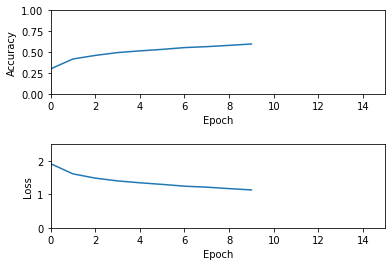

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/10a0model.ckpt Model Saved...
Epoch [250000], loss: 0.5260, acc: 1.0000
Epoch [250001], loss: 1.5337, acc: 0.0000
Epoch [250002], loss: 5.2630, acc: 0.0000
Epoch [250003], loss: 0.7246, acc: 1.0000
Epoch [250004], loss: 0.1017, acc: 1.0000
Epoch [250005], loss: 0.4239, acc: 1.0000
Epoch [250006], loss: 0.6121, acc: 1.0000
Epoch [250007], loss: 4.2576, acc: 0.0000
Epoch [250008], loss: 0.3040, acc: 1.0000
Epoch [250009], loss: 0.6483, acc: 1.0000
Epoch [250010], loss: 1.5968, acc: 0.0000
Epoch [250011], loss: 4.7654, acc: 0.0000
Epoch [250012], loss: 1.9404, acc: 0.0000
Epoch [250013], loss: 1.9619, acc: 0.0000
Epoch [250014], loss: 1.5492, acc: 0.0000
Epoch [250015], loss: 0.0559, acc: 1.0000
Epoch [250016], loss: 0.2284, acc: 1.0000
Epoch [250017], loss: 0.4619, acc: 1.0000
Epoch [250018], loss: 2.2704, acc: 0.0000
Epoch [250019], loss: 0.8841, acc: 1.0000
Epoch [250020], loss: 0.9404, acc: 1.0000
Epoch [250021]

Epoch [250206], loss: 0.6110, acc: 1.0000
Epoch [250207], loss: 1.4634, acc: 1.0000
Epoch [250208], loss: 0.2578, acc: 1.0000
Epoch [250209], loss: 1.3097, acc: 1.0000
Epoch [250210], loss: 1.3786, acc: 0.0000
Epoch [250211], loss: 0.0731, acc: 1.0000
Epoch [250212], loss: 1.4936, acc: 0.0000
Epoch [250213], loss: 2.0940, acc: 0.0000
Epoch [250214], loss: 1.2880, acc: 0.0000
Epoch [250215], loss: 2.4415, acc: 0.0000
Epoch [250216], loss: 0.9610, acc: 1.0000
Epoch [250217], loss: 3.1972, acc: 0.0000
Epoch [250218], loss: 0.7771, acc: 1.0000
Epoch [250219], loss: 1.4036, acc: 1.0000
Epoch [250220], loss: 1.4185, acc: 0.0000
Epoch [250221], loss: 2.3114, acc: 0.0000
Epoch [250222], loss: 0.6484, acc: 1.0000
Epoch [250223], loss: 0.2595, acc: 1.0000
Epoch [250224], loss: 0.7431, acc: 1.0000
Epoch [250225], loss: 2.7164, acc: 0.0000
Epoch [250226], loss: 1.6923, acc: 0.0000
Epoch [250227], loss: 0.2142, acc: 1.0000
Epoch [250228], loss: 1.2204, acc: 1.0000
Epoch [250229], loss: 1.2093, acc:

Epoch [250407], loss: 0.8344, acc: 1.0000
Epoch [250408], loss: 1.8094, acc: 0.0000
Epoch [250409], loss: 0.6858, acc: 1.0000
Epoch [250410], loss: 0.8181, acc: 1.0000
Epoch [250411], loss: 0.2984, acc: 1.0000
Epoch [250412], loss: 1.1701, acc: 0.0000
Epoch [250413], loss: 0.5999, acc: 1.0000
Epoch [250414], loss: 2.3193, acc: 0.0000
Epoch [250415], loss: 0.2122, acc: 1.0000
Epoch [250416], loss: 0.8987, acc: 0.0000
Epoch [250417], loss: 0.5753, acc: 1.0000
Epoch [250418], loss: 0.6897, acc: 1.0000
Epoch [250419], loss: 0.6094, acc: 1.0000
Epoch [250420], loss: 0.4895, acc: 1.0000
Epoch [250421], loss: 0.5289, acc: 1.0000
Epoch [250422], loss: 0.2900, acc: 1.0000
Epoch [250423], loss: 1.5471, acc: 0.0000
Epoch [250424], loss: 0.3724, acc: 1.0000
Epoch [250425], loss: 0.6090, acc: 1.0000
Epoch [250426], loss: 1.8709, acc: 0.0000
Epoch [250427], loss: 1.2317, acc: 1.0000
Epoch [250428], loss: 1.3341, acc: 0.0000
Epoch [250429], loss: 0.2778, acc: 1.0000
Epoch [250430], loss: 1.2300, acc:

Epoch [250601], loss: 0.1914, acc: 1.0000
Epoch [250602], loss: 0.9475, acc: 0.0000
Epoch [250603], loss: 0.1942, acc: 1.0000
Epoch [250604], loss: 3.0940, acc: 0.0000
Epoch [250605], loss: 2.7341, acc: 0.0000
Epoch [250606], loss: 0.4586, acc: 1.0000
Epoch [250607], loss: 0.6026, acc: 1.0000
Epoch [250608], loss: 3.0757, acc: 0.0000
Epoch [250609], loss: 1.5754, acc: 0.0000
Epoch [250610], loss: 1.0160, acc: 1.0000
Epoch [250611], loss: 0.0523, acc: 1.0000
Epoch [250612], loss: 2.5129, acc: 0.0000
Epoch [250613], loss: 0.5024, acc: 1.0000
Epoch [250614], loss: 1.1682, acc: 1.0000
Epoch [250615], loss: 0.2936, acc: 1.0000
Epoch [250616], loss: 0.3722, acc: 1.0000
Epoch [250617], loss: 0.4449, acc: 1.0000
Epoch [250618], loss: 2.1640, acc: 0.0000
Epoch [250619], loss: 0.1883, acc: 1.0000
Epoch [250620], loss: 0.9736, acc: 1.0000
Epoch [250621], loss: 0.7128, acc: 1.0000
Epoch [250622], loss: 1.3359, acc: 0.0000
Epoch [250623], loss: 0.7993, acc: 1.0000
Epoch [250624], loss: 1.2482, acc:

Epoch [250800], loss: 0.6110, acc: 1.0000
Epoch [250801], loss: 0.0681, acc: 1.0000
Epoch [250802], loss: 0.8901, acc: 1.0000
Epoch [250803], loss: 0.7546, acc: 1.0000
Epoch [250804], loss: 1.3689, acc: 0.0000
Epoch [250805], loss: 0.2550, acc: 1.0000
Epoch [250806], loss: 0.8385, acc: 1.0000
Epoch [250807], loss: 0.0123, acc: 1.0000
Epoch [250808], loss: 0.9282, acc: 1.0000
Epoch [250809], loss: 0.7179, acc: 1.0000
Epoch [250810], loss: 0.2737, acc: 1.0000
Epoch [250811], loss: 1.3461, acc: 0.0000
Epoch [250812], loss: 0.2115, acc: 1.0000
Epoch [250813], loss: 1.1541, acc: 1.0000
Epoch [250814], loss: 1.7761, acc: 0.0000
Epoch [250815], loss: 0.1412, acc: 1.0000
Epoch [250816], loss: 0.0078, acc: 1.0000
Epoch [250817], loss: 0.3606, acc: 1.0000
Epoch [250818], loss: 0.4771, acc: 1.0000
Epoch [250819], loss: 1.4018, acc: 0.0000
Epoch [250820], loss: 3.4266, acc: 0.0000
Epoch [250821], loss: 0.2125, acc: 1.0000
Epoch [250822], loss: 2.0157, acc: 0.0000
Epoch [250823], loss: 0.8225, acc:

Epoch [251008], loss: 0.2107, acc: 1.0000
Epoch [251009], loss: 0.3455, acc: 1.0000
Epoch [251010], loss: 0.1737, acc: 1.0000
Epoch [251011], loss: 0.4418, acc: 1.0000
Epoch [251012], loss: 0.6790, acc: 1.0000
Epoch [251013], loss: 0.6606, acc: 1.0000
Epoch [251014], loss: 1.3291, acc: 0.0000
Epoch [251015], loss: 2.0649, acc: 0.0000
Epoch [251016], loss: 0.5365, acc: 1.0000
Epoch [251017], loss: 1.6285, acc: 0.0000
Epoch [251018], loss: 0.7466, acc: 1.0000
Epoch [251019], loss: 2.7143, acc: 0.0000
Epoch [251020], loss: 1.6810, acc: 0.0000
Epoch [251021], loss: 2.1160, acc: 0.0000
Epoch [251022], loss: 0.9759, acc: 1.0000
Epoch [251023], loss: 3.4743, acc: 0.0000
Epoch [251024], loss: 3.7043, acc: 0.0000
Epoch [251025], loss: 0.0481, acc: 1.0000
Epoch [251026], loss: 0.4199, acc: 1.0000
Epoch [251027], loss: 1.9294, acc: 0.0000
Epoch [251028], loss: 2.9007, acc: 0.0000
Epoch [251029], loss: 0.8563, acc: 1.0000
Epoch [251030], loss: 1.4563, acc: 1.0000
Epoch [251031], loss: 0.4523, acc:

Epoch [251208], loss: 0.2537, acc: 1.0000
Epoch [251209], loss: 2.2359, acc: 0.0000
Epoch [251210], loss: 0.0686, acc: 1.0000
Epoch [251211], loss: 0.6595, acc: 1.0000
Epoch [251212], loss: 0.0713, acc: 1.0000
Epoch [251213], loss: 2.5564, acc: 0.0000
Epoch [251214], loss: 0.1190, acc: 1.0000
Epoch [251215], loss: 0.6288, acc: 1.0000
Epoch [251216], loss: 1.9396, acc: 0.0000
Epoch [251217], loss: 0.0611, acc: 1.0000
Epoch [251218], loss: 1.3163, acc: 1.0000
Epoch [251219], loss: 0.3965, acc: 1.0000
Epoch [251220], loss: 0.9572, acc: 1.0000
Epoch [251221], loss: 0.0334, acc: 1.0000
Epoch [251222], loss: 1.4031, acc: 0.0000
Epoch [251223], loss: 0.1680, acc: 1.0000
Epoch [251224], loss: 0.0416, acc: 1.0000
Epoch [251225], loss: 2.6409, acc: 0.0000
Epoch [251226], loss: 2.8240, acc: 0.0000
Epoch [251227], loss: 3.3557, acc: 0.0000
Epoch [251228], loss: 0.0771, acc: 1.0000
Epoch [251229], loss: 0.3199, acc: 1.0000
Epoch [251230], loss: 0.4487, acc: 1.0000
Epoch [251231], loss: 3.7700, acc:

Epoch [251416], loss: 0.1950, acc: 1.0000
Epoch [251417], loss: 1.4752, acc: 0.0000
Epoch [251418], loss: 0.0901, acc: 1.0000
Epoch [251419], loss: 0.1906, acc: 1.0000
Epoch [251420], loss: 2.3336, acc: 0.0000
Epoch [251421], loss: 1.7033, acc: 0.0000
Epoch [251422], loss: 0.0384, acc: 1.0000
Epoch [251423], loss: 1.4254, acc: 0.0000
Epoch [251424], loss: 0.4803, acc: 1.0000
Epoch [251425], loss: 0.5758, acc: 1.0000
Epoch [251426], loss: 1.1714, acc: 0.0000
Epoch [251427], loss: 0.2983, acc: 1.0000
Epoch [251428], loss: 0.0687, acc: 1.0000
Epoch [251429], loss: 1.3074, acc: 0.0000
Epoch [251430], loss: 1.0316, acc: 0.0000
Epoch [251431], loss: 0.1265, acc: 1.0000
Epoch [251432], loss: 0.6019, acc: 1.0000
Epoch [251433], loss: 1.8022, acc: 0.0000
Epoch [251434], loss: 1.2739, acc: 0.0000
Epoch [251435], loss: 2.2978, acc: 0.0000
Epoch [251436], loss: 0.0838, acc: 1.0000
Epoch [251437], loss: 1.1174, acc: 1.0000
Epoch [251438], loss: 2.1380, acc: 0.0000
Epoch [251439], loss: 0.4131, acc:

Epoch [251613], loss: 0.5055, acc: 1.0000
Epoch [251614], loss: 0.0341, acc: 1.0000
Epoch [251615], loss: 0.0716, acc: 1.0000
Epoch [251616], loss: 0.5374, acc: 1.0000
Epoch [251617], loss: 1.0844, acc: 1.0000
Epoch [251618], loss: 1.9844, acc: 0.0000
Epoch [251619], loss: 0.5317, acc: 1.0000
Epoch [251620], loss: 0.5879, acc: 1.0000
Epoch [251621], loss: 2.1117, acc: 0.0000
Epoch [251622], loss: 0.9654, acc: 1.0000
Epoch [251623], loss: 1.5941, acc: 0.0000
Epoch [251624], loss: 0.5996, acc: 1.0000
Epoch [251625], loss: 1.5794, acc: 0.0000
Epoch [251626], loss: 1.4703, acc: 0.0000
Epoch [251627], loss: 5.0659, acc: 0.0000
Epoch [251628], loss: 0.2743, acc: 1.0000
Epoch [251629], loss: 1.2936, acc: 0.0000
Epoch [251630], loss: 2.8155, acc: 0.0000
Epoch [251631], loss: 1.0403, acc: 0.0000
Epoch [251632], loss: 1.2185, acc: 0.0000
Epoch [251633], loss: 2.8442, acc: 0.0000
Epoch [251634], loss: 1.1142, acc: 0.0000
Epoch [251635], loss: 0.6818, acc: 1.0000
Epoch [251636], loss: 1.2634, acc:

Epoch [251815], loss: 0.4207, acc: 1.0000
Epoch [251816], loss: 0.8402, acc: 1.0000
Epoch [251817], loss: 0.2585, acc: 1.0000
Epoch [251818], loss: 2.5854, acc: 0.0000
Epoch [251819], loss: 0.4290, acc: 1.0000
Epoch [251820], loss: 0.0067, acc: 1.0000
Epoch [251821], loss: 1.6050, acc: 0.0000
Epoch [251822], loss: 1.2819, acc: 1.0000
Epoch [251823], loss: 0.4951, acc: 1.0000
Epoch [251824], loss: 3.5385, acc: 0.0000
Epoch [251825], loss: 0.7688, acc: 1.0000
Epoch [251826], loss: 2.2099, acc: 0.0000
Epoch [251827], loss: 0.0645, acc: 1.0000
Epoch [251828], loss: 1.6925, acc: 0.0000
Epoch [251829], loss: 1.4656, acc: 0.0000
Epoch [251830], loss: 0.5727, acc: 1.0000
Epoch [251831], loss: 0.6005, acc: 1.0000
Epoch [251832], loss: 1.1709, acc: 0.0000
Epoch [251833], loss: 1.4439, acc: 0.0000
Epoch [251834], loss: 1.8092, acc: 0.0000
Epoch [251835], loss: 1.3486, acc: 0.0000
Epoch [251836], loss: 1.0866, acc: 0.0000
Epoch [251837], loss: 0.5345, acc: 1.0000
Epoch [251838], loss: 1.1926, acc:

Epoch [252010], loss: 3.4751, acc: 0.0000
Epoch [252011], loss: 1.6716, acc: 0.0000
Epoch [252012], loss: 1.7023, acc: 0.0000
Epoch [252013], loss: 1.1217, acc: 0.0000
Epoch [252014], loss: 1.7011, acc: 0.0000
Epoch [252015], loss: 1.5856, acc: 0.0000
Epoch [252016], loss: 1.2013, acc: 1.0000
Epoch [252017], loss: 0.1455, acc: 1.0000
Epoch [252018], loss: 0.1193, acc: 1.0000
Epoch [252019], loss: 0.5119, acc: 1.0000
Epoch [252020], loss: 0.0971, acc: 1.0000
Epoch [252021], loss: 2.4235, acc: 0.0000
Epoch [252022], loss: 0.6181, acc: 1.0000
Epoch [252023], loss: 0.0400, acc: 1.0000
Epoch [252024], loss: 1.1648, acc: 1.0000
Epoch [252025], loss: 0.0356, acc: 1.0000
Epoch [252026], loss: 1.4509, acc: 0.0000
Epoch [252027], loss: 1.8300, acc: 0.0000
Epoch [252028], loss: 0.1176, acc: 1.0000
Epoch [252029], loss: 1.2445, acc: 0.0000
Epoch [252030], loss: 4.5288, acc: 0.0000
Epoch [252031], loss: 0.8853, acc: 1.0000
Epoch [252032], loss: 0.3173, acc: 1.0000
Epoch [252033], loss: 3.2256, acc:

Epoch [252217], loss: 0.5314, acc: 1.0000
Epoch [252218], loss: 0.0620, acc: 1.0000
Epoch [252219], loss: 0.1062, acc: 1.0000
Epoch [252220], loss: 0.0130, acc: 1.0000
Epoch [252221], loss: 2.4511, acc: 0.0000
Epoch [252222], loss: 1.3582, acc: 0.0000
Epoch [252223], loss: 2.1365, acc: 0.0000
Epoch [252224], loss: 1.7663, acc: 0.0000
Epoch [252225], loss: 0.5191, acc: 1.0000
Epoch [252226], loss: 2.5639, acc: 0.0000
Epoch [252227], loss: 2.4338, acc: 0.0000
Epoch [252228], loss: 0.4675, acc: 1.0000
Epoch [252229], loss: 0.3430, acc: 1.0000
Epoch [252230], loss: 2.3926, acc: 0.0000
Epoch [252231], loss: 0.7997, acc: 1.0000
Epoch [252232], loss: 0.5513, acc: 1.0000
Epoch [252233], loss: 0.1356, acc: 1.0000
Epoch [252234], loss: 1.9490, acc: 0.0000
Epoch [252235], loss: 1.5242, acc: 0.0000
Epoch [252236], loss: 0.3411, acc: 1.0000
Epoch [252237], loss: 1.4048, acc: 0.0000
Epoch [252238], loss: 1.1879, acc: 1.0000
Epoch [252239], loss: 1.2672, acc: 1.0000
Epoch [252240], loss: 0.0998, acc:

Epoch [252418], loss: 0.4295, acc: 1.0000
Epoch [252419], loss: 0.8906, acc: 1.0000
Epoch [252420], loss: 1.6037, acc: 0.0000
Epoch [252421], loss: 1.6813, acc: 0.0000
Epoch [252422], loss: 1.9475, acc: 0.0000
Epoch [252423], loss: 0.0215, acc: 1.0000
Epoch [252424], loss: 4.0961, acc: 0.0000
Epoch [252425], loss: 2.1477, acc: 0.0000
Epoch [252426], loss: 0.2521, acc: 1.0000
Epoch [252427], loss: 1.9077, acc: 0.0000
Epoch [252428], loss: 1.1865, acc: 0.0000
Epoch [252429], loss: 0.4931, acc: 1.0000
Epoch [252430], loss: 2.2854, acc: 0.0000
Epoch [252431], loss: 1.4817, acc: 0.0000
Epoch [252432], loss: 0.9268, acc: 1.0000
Epoch [252433], loss: 0.0561, acc: 1.0000
Epoch [252434], loss: 2.6558, acc: 0.0000
Epoch [252435], loss: 0.1659, acc: 1.0000
Epoch [252436], loss: 0.0919, acc: 1.0000
Epoch [252437], loss: 0.2706, acc: 1.0000
Epoch [252438], loss: 1.2586, acc: 0.0000
Epoch [252439], loss: 0.3500, acc: 1.0000
Epoch [252440], loss: 0.9168, acc: 1.0000
Epoch [252441], loss: 1.3536, acc:

Epoch [252611], loss: 1.2652, acc: 0.0000
Epoch [252612], loss: 1.7150, acc: 0.0000
Epoch [252613], loss: 1.6048, acc: 1.0000
Epoch [252614], loss: 0.6342, acc: 1.0000
Epoch [252615], loss: 0.2382, acc: 1.0000
Epoch [252616], loss: 1.5006, acc: 0.0000
Epoch [252617], loss: 1.7340, acc: 0.0000
Epoch [252618], loss: 1.7657, acc: 0.0000
Epoch [252619], loss: 0.0631, acc: 1.0000
Epoch [252620], loss: 2.5876, acc: 0.0000
Epoch [252621], loss: 0.6041, acc: 1.0000
Epoch [252622], loss: 0.9935, acc: 1.0000
Epoch [252623], loss: 0.1338, acc: 1.0000
Epoch [252624], loss: 0.0110, acc: 1.0000
Epoch [252625], loss: 0.6700, acc: 1.0000
Epoch [252626], loss: 4.8453, acc: 0.0000
Epoch [252627], loss: 0.0487, acc: 1.0000
Epoch [252628], loss: 0.2978, acc: 1.0000
Epoch [252629], loss: 1.3737, acc: 1.0000
Epoch [252630], loss: 2.7578, acc: 0.0000
Epoch [252631], loss: 0.7372, acc: 1.0000
Epoch [252632], loss: 0.6357, acc: 1.0000
Epoch [252633], loss: 1.9488, acc: 0.0000
Epoch [252634], loss: 0.4617, acc:

Epoch [252817], loss: 1.8422, acc: 0.0000
Epoch [252818], loss: 0.9642, acc: 0.0000
Epoch [252819], loss: 0.0331, acc: 1.0000
Epoch [252820], loss: 2.3750, acc: 0.0000
Epoch [252821], loss: 2.7781, acc: 0.0000
Epoch [252822], loss: 2.8266, acc: 0.0000
Epoch [252823], loss: 0.0636, acc: 1.0000
Epoch [252824], loss: 0.8829, acc: 1.0000
Epoch [252825], loss: 3.2779, acc: 0.0000
Epoch [252826], loss: 0.5378, acc: 1.0000
Epoch [252827], loss: 0.3608, acc: 1.0000
Epoch [252828], loss: 0.0748, acc: 1.0000
Epoch [252829], loss: 1.1880, acc: 0.0000
Epoch [252830], loss: 0.3953, acc: 1.0000
Epoch [252831], loss: 0.1282, acc: 1.0000
Epoch [252832], loss: 1.9745, acc: 0.0000
Epoch [252833], loss: 1.9156, acc: 0.0000
Epoch [252834], loss: 0.1742, acc: 1.0000
Epoch [252835], loss: 0.6675, acc: 1.0000
Epoch [252836], loss: 0.2203, acc: 1.0000
Epoch [252837], loss: 0.6156, acc: 1.0000
Epoch [252838], loss: 0.1145, acc: 1.0000
Epoch [252839], loss: 0.6706, acc: 1.0000
Epoch [252840], loss: 1.2261, acc:

Epoch [253013], loss: 0.2375, acc: 1.0000
Epoch [253014], loss: 0.0712, acc: 1.0000
Epoch [253015], loss: 0.5910, acc: 1.0000
Epoch [253016], loss: 1.9475, acc: 0.0000
Epoch [253017], loss: 2.8148, acc: 0.0000
Epoch [253018], loss: 0.1241, acc: 1.0000
Epoch [253019], loss: 1.7873, acc: 0.0000
Epoch [253020], loss: 1.1317, acc: 1.0000
Epoch [253021], loss: 0.2380, acc: 1.0000
Epoch [253022], loss: 1.1318, acc: 0.0000
Epoch [253023], loss: 3.3164, acc: 0.0000
Epoch [253024], loss: 0.4531, acc: 1.0000
Epoch [253025], loss: 1.8955, acc: 0.0000
Epoch [253026], loss: 1.1636, acc: 1.0000
Epoch [253027], loss: 2.5397, acc: 0.0000
Epoch [253028], loss: 0.6522, acc: 1.0000
Epoch [253029], loss: 0.0740, acc: 1.0000
Epoch [253030], loss: 3.0574, acc: 0.0000
Epoch [253031], loss: 2.3599, acc: 0.0000
Epoch [253032], loss: 0.1030, acc: 1.0000
Epoch [253033], loss: 1.0435, acc: 0.0000
Epoch [253034], loss: 0.5127, acc: 1.0000
Epoch [253035], loss: 0.0163, acc: 1.0000
Epoch [253036], loss: 1.5265, acc:

Epoch [253212], loss: 0.2125, acc: 1.0000
Epoch [253213], loss: 0.5236, acc: 1.0000
Epoch [253214], loss: 2.0150, acc: 0.0000
Epoch [253215], loss: 2.0458, acc: 0.0000
Epoch [253216], loss: 0.0734, acc: 1.0000
Epoch [253217], loss: 0.4246, acc: 1.0000
Epoch [253218], loss: 4.7609, acc: 0.0000
Epoch [253219], loss: 2.0730, acc: 0.0000
Epoch [253220], loss: 1.8742, acc: 0.0000
Epoch [253221], loss: 0.0274, acc: 1.0000
Epoch [253222], loss: 0.5010, acc: 1.0000
Epoch [253223], loss: 0.6736, acc: 1.0000
Epoch [253224], loss: 0.5571, acc: 1.0000
Epoch [253225], loss: 0.9563, acc: 1.0000
Epoch [253226], loss: 0.4136, acc: 1.0000
Epoch [253227], loss: 0.3550, acc: 1.0000
Epoch [253228], loss: 1.3097, acc: 0.0000
Epoch [253229], loss: 3.5746, acc: 0.0000
Epoch [253230], loss: 0.4765, acc: 1.0000
Epoch [253231], loss: 0.0919, acc: 1.0000
Epoch [253232], loss: 0.7845, acc: 1.0000
Epoch [253233], loss: 0.5261, acc: 1.0000
Epoch [253234], loss: 0.8647, acc: 1.0000
Epoch [253235], loss: 1.7544, acc:

Epoch [253415], loss: 0.1684, acc: 1.0000
Epoch [253416], loss: 0.1098, acc: 1.0000
Epoch [253417], loss: 2.9370, acc: 0.0000
Epoch [253418], loss: 0.3279, acc: 1.0000
Epoch [253419], loss: 0.8260, acc: 1.0000
Epoch [253420], loss: 0.2595, acc: 1.0000
Epoch [253421], loss: 3.0065, acc: 0.0000
Epoch [253422], loss: 2.2342, acc: 0.0000
Epoch [253423], loss: 0.6829, acc: 1.0000
Epoch [253424], loss: 0.0625, acc: 1.0000
Epoch [253425], loss: 0.8297, acc: 1.0000
Epoch [253426], loss: 0.3113, acc: 1.0000
Epoch [253427], loss: 0.9333, acc: 1.0000
Epoch [253428], loss: 1.2551, acc: 0.0000
Epoch [253429], loss: 0.8775, acc: 0.0000
Epoch [253430], loss: 0.7830, acc: 1.0000
Epoch [253431], loss: 0.5487, acc: 1.0000
Epoch [253432], loss: 0.0722, acc: 1.0000
Epoch [253433], loss: 0.0607, acc: 1.0000
Epoch [253434], loss: 0.6719, acc: 1.0000
Epoch [253435], loss: 1.1821, acc: 0.0000
Epoch [253436], loss: 0.6931, acc: 1.0000
Epoch [253437], loss: 0.9646, acc: 1.0000
Epoch [253438], loss: 0.5371, acc:

Epoch [253612], loss: 1.5764, acc: 0.0000
Epoch [253613], loss: 1.2803, acc: 0.0000
Epoch [253614], loss: 0.0740, acc: 1.0000
Epoch [253615], loss: 0.9436, acc: 1.0000
Epoch [253616], loss: 1.7555, acc: 0.0000
Epoch [253617], loss: 1.0214, acc: 0.0000
Epoch [253618], loss: 2.5872, acc: 0.0000
Epoch [253619], loss: 0.6104, acc: 1.0000
Epoch [253620], loss: 1.3913, acc: 0.0000
Epoch [253621], loss: 1.0476, acc: 1.0000
Epoch [253622], loss: 1.5936, acc: 0.0000
Epoch [253623], loss: 0.9917, acc: 1.0000
Epoch [253624], loss: 0.7692, acc: 1.0000
Epoch [253625], loss: 0.6445, acc: 1.0000
Epoch [253626], loss: 0.0543, acc: 1.0000
Epoch [253627], loss: 0.0153, acc: 1.0000
Epoch [253628], loss: 1.4269, acc: 0.0000
Epoch [253629], loss: 0.5920, acc: 1.0000
Epoch [253630], loss: 0.6136, acc: 1.0000
Epoch [253631], loss: 1.5907, acc: 0.0000
Epoch [253632], loss: 0.9221, acc: 1.0000
Epoch [253633], loss: 2.4957, acc: 0.0000
Epoch [253634], loss: 1.1531, acc: 0.0000
Epoch [253635], loss: 1.3508, acc:

Epoch [253822], loss: 2.4853, acc: 0.0000
Epoch [253823], loss: 1.0384, acc: 0.0000
Epoch [253824], loss: 2.2751, acc: 0.0000
Epoch [253825], loss: 0.1946, acc: 1.0000
Epoch [253826], loss: 0.3274, acc: 1.0000
Epoch [253827], loss: 0.3918, acc: 1.0000
Epoch [253828], loss: 0.2992, acc: 1.0000
Epoch [253829], loss: 0.4875, acc: 1.0000
Epoch [253830], loss: 2.5070, acc: 0.0000
Epoch [253831], loss: 0.9237, acc: 0.0000
Epoch [253832], loss: 0.0344, acc: 1.0000
Epoch [253833], loss: 1.7576, acc: 0.0000
Epoch [253834], loss: 0.2107, acc: 1.0000
Epoch [253835], loss: 0.8271, acc: 0.0000
Epoch [253836], loss: 2.9158, acc: 0.0000
Epoch [253837], loss: 2.2440, acc: 0.0000
Epoch [253838], loss: 0.2325, acc: 1.0000
Epoch [253839], loss: 0.4764, acc: 1.0000
Epoch [253840], loss: 2.1833, acc: 0.0000
Epoch [253841], loss: 0.1455, acc: 1.0000
Epoch [253842], loss: 5.0136, acc: 0.0000
Epoch [253843], loss: 1.9810, acc: 0.0000
Epoch [253844], loss: 0.1292, acc: 1.0000
Epoch [253845], loss: 0.3708, acc:

Epoch [254015], loss: 0.9396, acc: 1.0000
Epoch [254016], loss: 1.9068, acc: 0.0000
Epoch [254017], loss: 1.8388, acc: 0.0000
Epoch [254018], loss: 4.5867, acc: 0.0000
Epoch [254019], loss: 1.4034, acc: 0.0000
Epoch [254020], loss: 2.1692, acc: 0.0000
Epoch [254021], loss: 1.4499, acc: 0.0000
Epoch [254022], loss: 1.7563, acc: 0.0000
Epoch [254023], loss: 0.3992, acc: 1.0000
Epoch [254024], loss: 0.6365, acc: 1.0000
Epoch [254025], loss: 2.7263, acc: 0.0000
Epoch [254026], loss: 0.9005, acc: 1.0000
Epoch [254027], loss: 0.4223, acc: 1.0000
Epoch [254028], loss: 1.0251, acc: 1.0000
Epoch [254029], loss: 2.6341, acc: 0.0000
Epoch [254030], loss: 1.7203, acc: 0.0000
Epoch [254031], loss: 0.3778, acc: 1.0000
Epoch [254032], loss: 0.3707, acc: 1.0000
Epoch [254033], loss: 0.1720, acc: 1.0000
Epoch [254034], loss: 0.1496, acc: 1.0000
Epoch [254035], loss: 2.4227, acc: 0.0000
Epoch [254036], loss: 2.2997, acc: 0.0000
Epoch [254037], loss: 0.1053, acc: 1.0000
Epoch [254038], loss: 0.4338, acc:

Epoch [254213], loss: 0.1894, acc: 1.0000
Epoch [254214], loss: 3.4096, acc: 0.0000
Epoch [254215], loss: 0.2512, acc: 1.0000
Epoch [254216], loss: 2.3182, acc: 0.0000
Epoch [254217], loss: 1.2809, acc: 0.0000
Epoch [254218], loss: 0.2399, acc: 1.0000
Epoch [254219], loss: 0.0094, acc: 1.0000
Epoch [254220], loss: 0.8162, acc: 1.0000
Epoch [254221], loss: 0.6239, acc: 1.0000
Epoch [254222], loss: 0.1911, acc: 1.0000
Epoch [254223], loss: 0.1574, acc: 1.0000
Epoch [254224], loss: 0.5281, acc: 1.0000
Epoch [254225], loss: 0.2279, acc: 1.0000
Epoch [254226], loss: 2.8773, acc: 0.0000
Epoch [254227], loss: 1.0552, acc: 1.0000
Epoch [254228], loss: 0.1934, acc: 1.0000
Epoch [254229], loss: 0.3969, acc: 1.0000
Epoch [254230], loss: 1.1843, acc: 0.0000
Epoch [254231], loss: 1.0100, acc: 1.0000
Epoch [254232], loss: 0.6201, acc: 1.0000
Epoch [254233], loss: 0.8366, acc: 1.0000
Epoch [254234], loss: 0.9870, acc: 1.0000
Epoch [254235], loss: 0.1152, acc: 1.0000
Epoch [254236], loss: 0.2028, acc:

Epoch [254413], loss: 1.4117, acc: 0.0000
Epoch [254414], loss: 0.7066, acc: 1.0000
Epoch [254415], loss: 0.3355, acc: 1.0000
Epoch [254416], loss: 1.4305, acc: 0.0000
Epoch [254417], loss: 0.2037, acc: 1.0000
Epoch [254418], loss: 0.6160, acc: 1.0000
Epoch [254419], loss: 0.0486, acc: 1.0000
Epoch [254420], loss: 2.7538, acc: 0.0000
Epoch [254421], loss: 0.0321, acc: 1.0000
Epoch [254422], loss: 1.4291, acc: 0.0000
Epoch [254423], loss: 1.4490, acc: 0.0000
Epoch [254424], loss: 0.1670, acc: 1.0000
Epoch [254425], loss: 1.0662, acc: 1.0000
Epoch [254426], loss: 0.6190, acc: 1.0000
Epoch [254427], loss: 0.1506, acc: 1.0000
Epoch [254428], loss: 0.4169, acc: 1.0000
Epoch [254429], loss: 0.7721, acc: 1.0000
Epoch [254430], loss: 0.1357, acc: 1.0000
Epoch [254431], loss: 1.6516, acc: 0.0000
Epoch [254432], loss: 0.0812, acc: 1.0000
Epoch [254433], loss: 0.0360, acc: 1.0000
Epoch [254434], loss: 1.2661, acc: 0.0000
Epoch [254435], loss: 0.0772, acc: 1.0000
Epoch [254436], loss: 0.7387, acc:

Epoch [254622], loss: 0.3210, acc: 1.0000
Epoch [254623], loss: 1.4222, acc: 0.0000
Epoch [254624], loss: 1.6041, acc: 0.0000
Epoch [254625], loss: 1.1829, acc: 0.0000
Epoch [254626], loss: 1.4051, acc: 0.0000
Epoch [254627], loss: 1.6109, acc: 0.0000
Epoch [254628], loss: 0.9938, acc: 1.0000
Epoch [254629], loss: 0.7454, acc: 1.0000
Epoch [254630], loss: 5.6784, acc: 0.0000
Epoch [254631], loss: 0.5791, acc: 1.0000
Epoch [254632], loss: 0.7420, acc: 1.0000
Epoch [254633], loss: 0.1473, acc: 1.0000
Epoch [254634], loss: 0.7468, acc: 1.0000
Epoch [254635], loss: 0.4504, acc: 1.0000
Epoch [254636], loss: 0.6347, acc: 1.0000
Epoch [254637], loss: 0.3482, acc: 1.0000
Epoch [254638], loss: 0.5637, acc: 1.0000
Epoch [254639], loss: 2.3764, acc: 0.0000
Epoch [254640], loss: 2.3728, acc: 0.0000
Epoch [254641], loss: 1.5064, acc: 0.0000
Epoch [254642], loss: 0.0156, acc: 1.0000
Epoch [254643], loss: 1.2996, acc: 1.0000
Epoch [254644], loss: 2.3059, acc: 0.0000
Epoch [254645], loss: 0.9705, acc:

Epoch [254830], loss: 3.7018, acc: 0.0000
Epoch [254831], loss: 0.3449, acc: 1.0000
Epoch [254832], loss: 2.0442, acc: 0.0000
Epoch [254833], loss: 1.8472, acc: 0.0000
Epoch [254834], loss: 0.2842, acc: 1.0000
Epoch [254835], loss: 0.9901, acc: 1.0000
Epoch [254836], loss: 0.3375, acc: 1.0000
Epoch [254837], loss: 0.3334, acc: 1.0000
Epoch [254838], loss: 4.6056, acc: 0.0000
Epoch [254839], loss: 1.1435, acc: 0.0000
Epoch [254840], loss: 0.4071, acc: 1.0000
Epoch [254841], loss: 0.8181, acc: 1.0000
Epoch [254842], loss: 0.1558, acc: 1.0000
Epoch [254843], loss: 3.4921, acc: 0.0000
Epoch [254844], loss: 1.0350, acc: 1.0000
Epoch [254845], loss: 0.0368, acc: 1.0000
Epoch [254846], loss: 0.5124, acc: 1.0000
Epoch [254847], loss: 3.3208, acc: 0.0000
Epoch [254848], loss: 5.4673, acc: 0.0000
Epoch [254849], loss: 2.6168, acc: 0.0000
Epoch [254850], loss: 0.9868, acc: 1.0000
Epoch [254851], loss: 1.6131, acc: 0.0000
Epoch [254852], loss: 0.0602, acc: 1.0000
Epoch [254853], loss: 0.2565, acc:

Epoch [255037], loss: 0.2886, acc: 1.0000
Epoch [255038], loss: 1.6942, acc: 0.0000
Epoch [255039], loss: 1.9799, acc: 0.0000
Epoch [255040], loss: 0.6013, acc: 1.0000
Epoch [255041], loss: 1.3475, acc: 0.0000
Epoch [255042], loss: 0.5314, acc: 1.0000
Epoch [255043], loss: 0.3345, acc: 1.0000
Epoch [255044], loss: 1.8366, acc: 0.0000
Epoch [255045], loss: 0.0486, acc: 1.0000
Epoch [255046], loss: 0.6174, acc: 1.0000
Epoch [255047], loss: 0.3200, acc: 1.0000
Epoch [255048], loss: 2.0405, acc: 0.0000
Epoch [255049], loss: 0.1200, acc: 1.0000
Epoch [255050], loss: 3.1410, acc: 0.0000
Epoch [255051], loss: 1.1755, acc: 0.0000
Epoch [255052], loss: 0.0304, acc: 1.0000
Epoch [255053], loss: 0.0233, acc: 1.0000
Epoch [255054], loss: 0.2914, acc: 1.0000
Epoch [255055], loss: 0.7378, acc: 1.0000
Epoch [255056], loss: 0.5585, acc: 1.0000
Epoch [255057], loss: 1.4414, acc: 0.0000
Epoch [255058], loss: 2.5319, acc: 0.0000
Epoch [255059], loss: 1.3096, acc: 1.0000
Epoch [255060], loss: 0.0131, acc:

Epoch [255241], loss: 0.3548, acc: 1.0000
Epoch [255242], loss: 4.6708, acc: 0.0000
Epoch [255243], loss: 0.4268, acc: 1.0000
Epoch [255244], loss: 0.8068, acc: 1.0000
Epoch [255245], loss: 0.3354, acc: 1.0000
Epoch [255246], loss: 0.1214, acc: 1.0000
Epoch [255247], loss: 0.6501, acc: 1.0000
Epoch [255248], loss: 1.6027, acc: 0.0000
Epoch [255249], loss: 0.8839, acc: 0.0000
Epoch [255250], loss: 1.8668, acc: 0.0000
Epoch [255251], loss: 0.1155, acc: 1.0000
Epoch [255252], loss: 1.3575, acc: 0.0000
Epoch [255253], loss: 0.6919, acc: 1.0000
Epoch [255254], loss: 0.8120, acc: 1.0000
Epoch [255255], loss: 0.0431, acc: 1.0000
Epoch [255256], loss: 1.6010, acc: 0.0000
Epoch [255257], loss: 0.3125, acc: 1.0000
Epoch [255258], loss: 0.4231, acc: 1.0000
Epoch [255259], loss: 0.1423, acc: 1.0000
Epoch [255260], loss: 1.1712, acc: 0.0000
Epoch [255261], loss: 0.3127, acc: 1.0000
Epoch [255262], loss: 0.5716, acc: 1.0000
Epoch [255263], loss: 2.7291, acc: 0.0000
Epoch [255264], loss: 1.6321, acc:

Epoch [255447], loss: 1.4762, acc: 0.0000
Epoch [255448], loss: 1.4434, acc: 0.0000
Epoch [255449], loss: 0.1640, acc: 1.0000
Epoch [255450], loss: 0.0371, acc: 1.0000
Epoch [255451], loss: 6.4513, acc: 0.0000
Epoch [255452], loss: 0.7894, acc: 1.0000
Epoch [255453], loss: 0.4190, acc: 1.0000
Epoch [255454], loss: 2.1751, acc: 0.0000
Epoch [255455], loss: 0.5393, acc: 1.0000
Epoch [255456], loss: 0.5406, acc: 1.0000
Epoch [255457], loss: 0.1541, acc: 1.0000
Epoch [255458], loss: 0.4575, acc: 1.0000
Epoch [255459], loss: 1.9926, acc: 0.0000
Epoch [255460], loss: 1.4968, acc: 0.0000
Epoch [255461], loss: 0.2793, acc: 1.0000
Epoch [255462], loss: 1.1475, acc: 0.0000
Epoch [255463], loss: 0.1052, acc: 1.0000
Epoch [255464], loss: 2.2918, acc: 0.0000
Epoch [255465], loss: 2.0422, acc: 0.0000
Epoch [255466], loss: 0.0040, acc: 1.0000
Epoch [255467], loss: 0.2027, acc: 1.0000
Epoch [255468], loss: 0.2560, acc: 1.0000
Epoch [255469], loss: 0.2937, acc: 1.0000
Epoch [255470], loss: 1.3501, acc:

Epoch [255646], loss: 0.0378, acc: 1.0000
Epoch [255647], loss: 1.0976, acc: 0.0000
Epoch [255648], loss: 0.1261, acc: 1.0000
Epoch [255649], loss: 0.1332, acc: 1.0000
Epoch [255650], loss: 1.7387, acc: 0.0000
Epoch [255651], loss: 1.8569, acc: 0.0000
Epoch [255652], loss: 1.0032, acc: 0.0000
Epoch [255653], loss: 0.1663, acc: 1.0000
Epoch [255654], loss: 0.6726, acc: 1.0000
Epoch [255655], loss: 0.0758, acc: 1.0000
Epoch [255656], loss: 0.7049, acc: 1.0000
Epoch [255657], loss: 0.8087, acc: 1.0000
Epoch [255658], loss: 0.5829, acc: 1.0000
Epoch [255659], loss: 0.9613, acc: 1.0000
Epoch [255660], loss: 3.7777, acc: 0.0000
Epoch [255661], loss: 2.6647, acc: 0.0000
Epoch [255662], loss: 1.6396, acc: 0.0000
Epoch [255663], loss: 0.1283, acc: 1.0000
Epoch [255664], loss: 0.0384, acc: 1.0000
Epoch [255665], loss: 0.0652, acc: 1.0000
Epoch [255666], loss: 1.7848, acc: 0.0000
Epoch [255667], loss: 0.4457, acc: 1.0000
Epoch [255668], loss: 0.3722, acc: 1.0000
Epoch [255669], loss: 1.8762, acc:

Epoch [255856], loss: 1.4152, acc: 0.0000
Epoch [255857], loss: 1.0457, acc: 1.0000
Epoch [255858], loss: 0.2827, acc: 1.0000
Epoch [255859], loss: 0.2044, acc: 1.0000
Epoch [255860], loss: 0.3793, acc: 1.0000
Epoch [255861], loss: 0.0081, acc: 1.0000
Epoch [255862], loss: 0.9893, acc: 0.0000
Epoch [255863], loss: 1.5056, acc: 0.0000
Epoch [255864], loss: 0.4575, acc: 1.0000
Epoch [255865], loss: 0.0458, acc: 1.0000
Epoch [255866], loss: 0.3461, acc: 1.0000
Epoch [255867], loss: 2.2146, acc: 0.0000
Epoch [255868], loss: 1.9634, acc: 0.0000
Epoch [255869], loss: 1.4449, acc: 0.0000
Epoch [255870], loss: 2.1925, acc: 0.0000
Epoch [255871], loss: 2.3521, acc: 0.0000
Epoch [255872], loss: 3.6806, acc: 0.0000
Epoch [255873], loss: 1.0802, acc: 1.0000
Epoch [255874], loss: 0.1682, acc: 1.0000
Epoch [255875], loss: 0.0476, acc: 1.0000
Epoch [255876], loss: 0.0130, acc: 1.0000
Epoch [255877], loss: 0.7192, acc: 1.0000
Epoch [255878], loss: 0.0435, acc: 1.0000
Epoch [255879], loss: 0.6260, acc:

Epoch [256059], loss: 1.3439, acc: 0.0000
Epoch [256060], loss: 2.7952, acc: 0.0000
Epoch [256061], loss: 1.3328, acc: 0.0000
Epoch [256062], loss: 1.7285, acc: 0.0000
Epoch [256063], loss: 0.5084, acc: 1.0000
Epoch [256064], loss: 2.3708, acc: 0.0000
Epoch [256065], loss: 1.1540, acc: 1.0000
Epoch [256066], loss: 0.8511, acc: 0.0000
Epoch [256067], loss: 0.2858, acc: 1.0000
Epoch [256068], loss: 0.4005, acc: 1.0000
Epoch [256069], loss: 0.5848, acc: 1.0000
Epoch [256070], loss: 1.3743, acc: 0.0000
Epoch [256071], loss: 0.3410, acc: 1.0000
Epoch [256072], loss: 0.0146, acc: 1.0000
Epoch [256073], loss: 2.6296, acc: 0.0000
Epoch [256074], loss: 0.8415, acc: 1.0000
Epoch [256075], loss: 0.3768, acc: 1.0000
Epoch [256076], loss: 0.7135, acc: 1.0000
Epoch [256077], loss: 0.4155, acc: 1.0000
Epoch [256078], loss: 0.0202, acc: 1.0000
Epoch [256079], loss: 0.1659, acc: 1.0000
Epoch [256080], loss: 2.8787, acc: 0.0000
Epoch [256081], loss: 0.7314, acc: 1.0000
Epoch [256082], loss: 0.2380, acc:

Epoch [256264], loss: 0.1915, acc: 1.0000
Epoch [256265], loss: 2.7482, acc: 0.0000
Epoch [256266], loss: 2.9858, acc: 0.0000
Epoch [256267], loss: 0.1273, acc: 1.0000
Epoch [256268], loss: 1.0998, acc: 0.0000
Epoch [256269], loss: 0.6522, acc: 1.0000
Epoch [256270], loss: 0.4262, acc: 1.0000
Epoch [256271], loss: 2.2831, acc: 0.0000
Epoch [256272], loss: 0.6317, acc: 1.0000
Epoch [256273], loss: 0.6758, acc: 1.0000
Epoch [256274], loss: 1.0866, acc: 1.0000
Epoch [256275], loss: 2.0314, acc: 0.0000
Epoch [256276], loss: 0.1617, acc: 1.0000
Epoch [256277], loss: 2.6084, acc: 0.0000
Epoch [256278], loss: 1.5833, acc: 0.0000
Epoch [256279], loss: 0.0070, acc: 1.0000
Epoch [256280], loss: 0.0442, acc: 1.0000
Epoch [256281], loss: 1.0153, acc: 0.0000
Epoch [256282], loss: 1.1031, acc: 1.0000
Epoch [256283], loss: 0.2745, acc: 1.0000
Epoch [256284], loss: 2.9900, acc: 0.0000
Epoch [256285], loss: 0.8616, acc: 0.0000
Epoch [256286], loss: 0.9676, acc: 1.0000
Epoch [256287], loss: 1.2890, acc:

Epoch [256473], loss: 2.2335, acc: 0.0000
Epoch [256474], loss: 0.4450, acc: 1.0000
Epoch [256475], loss: 3.1653, acc: 0.0000
Epoch [256476], loss: 2.1266, acc: 0.0000
Epoch [256477], loss: 2.5045, acc: 0.0000
Epoch [256478], loss: 1.1777, acc: 0.0000
Epoch [256479], loss: 1.8437, acc: 0.0000
Epoch [256480], loss: 3.7523, acc: 0.0000
Epoch [256481], loss: 1.8350, acc: 0.0000
Epoch [256482], loss: 0.5050, acc: 1.0000
Epoch [256483], loss: 2.1491, acc: 0.0000
Epoch [256484], loss: 0.5714, acc: 1.0000
Epoch [256485], loss: 0.0671, acc: 1.0000
Epoch [256486], loss: 0.6399, acc: 1.0000
Epoch [256487], loss: 1.0189, acc: 1.0000
Epoch [256488], loss: 0.1696, acc: 1.0000
Epoch [256489], loss: 0.2418, acc: 1.0000
Epoch [256490], loss: 1.3631, acc: 0.0000
Epoch [256491], loss: 1.9622, acc: 0.0000
Epoch [256492], loss: 1.8058, acc: 0.0000
Epoch [256493], loss: 2.6753, acc: 0.0000
Epoch [256494], loss: 2.1424, acc: 0.0000
Epoch [256495], loss: 0.3156, acc: 1.0000
Epoch [256496], loss: 0.9310, acc:

Epoch [256679], loss: 0.0180, acc: 1.0000
Epoch [256680], loss: 1.1876, acc: 0.0000
Epoch [256681], loss: 0.0646, acc: 1.0000
Epoch [256682], loss: 0.0065, acc: 1.0000
Epoch [256683], loss: 0.2375, acc: 1.0000
Epoch [256684], loss: 1.5324, acc: 0.0000
Epoch [256685], loss: 1.4695, acc: 0.0000
Epoch [256686], loss: 2.5214, acc: 0.0000
Epoch [256687], loss: 0.7563, acc: 1.0000
Epoch [256688], loss: 0.6690, acc: 1.0000
Epoch [256689], loss: 0.2095, acc: 1.0000
Epoch [256690], loss: 1.9137, acc: 0.0000
Epoch [256691], loss: 3.2875, acc: 0.0000
Epoch [256692], loss: 0.7282, acc: 1.0000
Epoch [256693], loss: 2.4215, acc: 0.0000
Epoch [256694], loss: 0.4415, acc: 1.0000
Epoch [256695], loss: 0.1700, acc: 1.0000
Epoch [256696], loss: 0.4348, acc: 1.0000
Epoch [256697], loss: 1.4018, acc: 0.0000
Epoch [256698], loss: 2.9297, acc: 0.0000
Epoch [256699], loss: 0.9247, acc: 0.0000
Epoch [256700], loss: 1.5276, acc: 0.0000
Epoch [256701], loss: 2.8944, acc: 0.0000
Epoch [256702], loss: 0.4104, acc:

Epoch [256886], loss: 1.8712, acc: 0.0000
Epoch [256887], loss: 2.9368, acc: 0.0000
Epoch [256888], loss: 0.8799, acc: 0.0000
Epoch [256889], loss: 0.0112, acc: 1.0000
Epoch [256890], loss: 1.7525, acc: 0.0000
Epoch [256891], loss: 4.4875, acc: 0.0000
Epoch [256892], loss: 0.1588, acc: 1.0000
Epoch [256893], loss: 0.3080, acc: 1.0000
Epoch [256894], loss: 0.2139, acc: 1.0000
Epoch [256895], loss: 0.7609, acc: 1.0000
Epoch [256896], loss: 0.1019, acc: 1.0000
Epoch [256897], loss: 0.3366, acc: 1.0000
Epoch [256898], loss: 1.0065, acc: 0.0000
Epoch [256899], loss: 0.3095, acc: 1.0000
Epoch [256900], loss: 2.4626, acc: 0.0000
Epoch [256901], loss: 0.3514, acc: 1.0000
Epoch [256902], loss: 2.6660, acc: 0.0000
Epoch [256903], loss: 0.1044, acc: 1.0000
Epoch [256904], loss: 1.9738, acc: 0.0000
Epoch [256905], loss: 1.1599, acc: 1.0000
Epoch [256906], loss: 0.2863, acc: 1.0000
Epoch [256907], loss: 0.0780, acc: 1.0000
Epoch [256908], loss: 1.5609, acc: 0.0000
Epoch [256909], loss: 1.4237, acc:

Epoch [257092], loss: 0.4768, acc: 1.0000
Epoch [257093], loss: 0.0108, acc: 1.0000
Epoch [257094], loss: 0.0453, acc: 1.0000
Epoch [257095], loss: 0.9315, acc: 1.0000
Epoch [257096], loss: 1.0627, acc: 1.0000
Epoch [257097], loss: 0.2751, acc: 1.0000
Epoch [257098], loss: 1.1270, acc: 0.0000
Epoch [257099], loss: 2.2626, acc: 0.0000
Epoch [257100], loss: 2.5685, acc: 0.0000
Epoch [257101], loss: 0.3767, acc: 1.0000
Epoch [257102], loss: 3.6580, acc: 0.0000
Epoch [257103], loss: 0.8210, acc: 1.0000
Epoch [257104], loss: 0.9915, acc: 1.0000
Epoch [257105], loss: 0.7993, acc: 1.0000
Epoch [257106], loss: 3.7761, acc: 0.0000
Epoch [257107], loss: 0.2333, acc: 1.0000
Epoch [257108], loss: 0.4360, acc: 1.0000
Epoch [257109], loss: 0.2626, acc: 1.0000
Epoch [257110], loss: 0.0260, acc: 1.0000
Epoch [257111], loss: 2.5387, acc: 0.0000
Epoch [257112], loss: 0.6129, acc: 1.0000
Epoch [257113], loss: 3.3854, acc: 0.0000
Epoch [257114], loss: 0.8830, acc: 1.0000
Epoch [257115], loss: 0.3820, acc:

Epoch [257295], loss: 1.6407, acc: 0.0000
Epoch [257296], loss: 1.6239, acc: 0.0000
Epoch [257297], loss: 1.7107, acc: 0.0000
Epoch [257298], loss: 1.5736, acc: 0.0000
Epoch [257299], loss: 0.1837, acc: 1.0000
Epoch [257300], loss: 1.1203, acc: 1.0000
Epoch [257301], loss: 1.0087, acc: 1.0000
Epoch [257302], loss: 0.4009, acc: 1.0000
Epoch [257303], loss: 0.5400, acc: 1.0000
Epoch [257304], loss: 0.2303, acc: 1.0000
Epoch [257305], loss: 2.4683, acc: 0.0000
Epoch [257306], loss: 1.1534, acc: 0.0000
Epoch [257307], loss: 1.2224, acc: 0.0000
Epoch [257308], loss: 0.1992, acc: 1.0000
Epoch [257309], loss: 1.8773, acc: 0.0000
Epoch [257310], loss: 1.1645, acc: 0.0000
Epoch [257311], loss: 0.1722, acc: 1.0000
Epoch [257312], loss: 1.2774, acc: 0.0000
Epoch [257313], loss: 2.0272, acc: 0.0000
Epoch [257314], loss: 1.3793, acc: 0.0000
Epoch [257315], loss: 1.8674, acc: 0.0000
Epoch [257316], loss: 0.4918, acc: 1.0000
Epoch [257317], loss: 1.3852, acc: 0.0000
Epoch [257318], loss: 0.7697, acc:

Epoch [257496], loss: 1.5581, acc: 0.0000
Epoch [257497], loss: 0.6651, acc: 1.0000
Epoch [257498], loss: 0.4274, acc: 1.0000
Epoch [257499], loss: 0.7619, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/10a7500model.ckpt Model Saved...
Epoch [257500], loss: 0.5560, acc: 1.0000
Epoch [257501], loss: 1.0124, acc: 0.0000
Epoch [257502], loss: 1.2070, acc: 1.0000
Epoch [257503], loss: 1.9801, acc: 0.0000
Epoch [257504], loss: 1.0245, acc: 0.0000
Epoch [257505], loss: 2.4457, acc: 0.0000
Epoch [257506], loss: 0.1610, acc: 1.0000
Epoch [257507], loss: 3.5251, acc: 0.0000
Epoch [257508], loss: 0.0952, acc: 1.0000
Epoch [257509], loss: 1.2253, acc: 0.0000
Epoch [257510], loss: 2.1812, acc: 0.0000
Epoch [257511], loss: 0.1318, acc: 1.0000
Epoch [257512], loss: 1.7890, acc: 0.0000
Epoch [257513], loss: 0.0888, acc: 1.0000
Epoch [257514], loss: 1.0834, acc: 1.0000
Epoch [257515], loss: 1.8414, acc: 0.0000
Epoch [257516], loss: 0.9944, acc: 1.0000
Epoch [2575

Epoch [257702], loss: 0.2033, acc: 1.0000
Epoch [257703], loss: 0.4836, acc: 1.0000
Epoch [257704], loss: 1.4029, acc: 1.0000
Epoch [257705], loss: 0.6076, acc: 1.0000
Epoch [257706], loss: 1.0046, acc: 1.0000
Epoch [257707], loss: 1.7206, acc: 0.0000
Epoch [257708], loss: 1.3464, acc: 0.0000
Epoch [257709], loss: 0.6044, acc: 1.0000
Epoch [257710], loss: 1.0782, acc: 0.0000
Epoch [257711], loss: 0.1803, acc: 1.0000
Epoch [257712], loss: 0.6987, acc: 1.0000
Epoch [257713], loss: 0.7131, acc: 0.0000
Epoch [257714], loss: 0.8314, acc: 1.0000
Epoch [257715], loss: 1.6525, acc: 0.0000
Epoch [257716], loss: 0.9434, acc: 1.0000
Epoch [257717], loss: 2.4657, acc: 0.0000
Epoch [257718], loss: 1.8170, acc: 0.0000
Epoch [257719], loss: 1.1152, acc: 1.0000
Epoch [257720], loss: 0.0367, acc: 1.0000
Epoch [257721], loss: 0.3399, acc: 1.0000
Epoch [257722], loss: 0.3015, acc: 1.0000
Epoch [257723], loss: 0.8602, acc: 1.0000
Epoch [257724], loss: 1.5682, acc: 0.0000
Epoch [257725], loss: 0.1364, acc:

Epoch [257907], loss: 0.2719, acc: 1.0000
Epoch [257908], loss: 2.4544, acc: 0.0000
Epoch [257909], loss: 0.8745, acc: 1.0000
Epoch [257910], loss: 0.0751, acc: 1.0000
Epoch [257911], loss: 0.0464, acc: 1.0000
Epoch [257912], loss: 1.3755, acc: 0.0000
Epoch [257913], loss: 0.1057, acc: 1.0000
Epoch [257914], loss: 0.6033, acc: 1.0000
Epoch [257915], loss: 0.0229, acc: 1.0000
Epoch [257916], loss: 0.0352, acc: 1.0000
Epoch [257917], loss: 0.1617, acc: 1.0000
Epoch [257918], loss: 6.9784, acc: 0.0000
Epoch [257919], loss: 0.0592, acc: 1.0000
Epoch [257920], loss: 4.3144, acc: 0.0000
Epoch [257921], loss: 1.4620, acc: 0.0000
Epoch [257922], loss: 2.1967, acc: 0.0000
Epoch [257923], loss: 0.3419, acc: 1.0000
Epoch [257924], loss: 2.9674, acc: 0.0000
Epoch [257925], loss: 0.9610, acc: 0.0000
Epoch [257926], loss: 0.1006, acc: 1.0000
Epoch [257927], loss: 2.0547, acc: 0.0000
Epoch [257928], loss: 2.3206, acc: 0.0000
Epoch [257929], loss: 0.2884, acc: 1.0000
Epoch [257930], loss: 0.1617, acc:

Epoch [258113], loss: 3.2513, acc: 0.0000
Epoch [258114], loss: 0.8604, acc: 1.0000
Epoch [258115], loss: 0.0187, acc: 1.0000
Epoch [258116], loss: 1.3269, acc: 0.0000
Epoch [258117], loss: 0.7284, acc: 1.0000
Epoch [258118], loss: 0.0855, acc: 1.0000
Epoch [258119], loss: 0.0503, acc: 1.0000
Epoch [258120], loss: 0.8880, acc: 1.0000
Epoch [258121], loss: 0.1907, acc: 1.0000
Epoch [258122], loss: 1.2282, acc: 1.0000
Epoch [258123], loss: 0.2493, acc: 1.0000
Epoch [258124], loss: 1.0324, acc: 1.0000
Epoch [258125], loss: 0.1081, acc: 1.0000
Epoch [258126], loss: 0.9652, acc: 1.0000
Epoch [258127], loss: 0.5044, acc: 1.0000
Epoch [258128], loss: 0.8324, acc: 1.0000
Epoch [258129], loss: 0.0942, acc: 1.0000
Epoch [258130], loss: 0.2860, acc: 1.0000
Epoch [258131], loss: 1.7477, acc: 0.0000
Epoch [258132], loss: 0.1100, acc: 1.0000
Epoch [258133], loss: 0.7390, acc: 1.0000
Epoch [258134], loss: 2.4547, acc: 0.0000
Epoch [258135], loss: 0.6010, acc: 1.0000
Epoch [258136], loss: 0.6642, acc:

Epoch [258310], loss: 1.0685, acc: 1.0000
Epoch [258311], loss: 1.7497, acc: 0.0000
Epoch [258312], loss: 0.0423, acc: 1.0000
Epoch [258313], loss: 0.7234, acc: 1.0000
Epoch [258314], loss: 1.9692, acc: 0.0000
Epoch [258315], loss: 0.6262, acc: 1.0000
Epoch [258316], loss: 2.0033, acc: 0.0000
Epoch [258317], loss: 1.0238, acc: 0.0000
Epoch [258318], loss: 0.2085, acc: 1.0000
Epoch [258319], loss: 1.6130, acc: 0.0000
Epoch [258320], loss: 3.4227, acc: 0.0000
Epoch [258321], loss: 0.0294, acc: 1.0000
Epoch [258322], loss: 0.9809, acc: 0.0000
Epoch [258323], loss: 0.4361, acc: 1.0000
Epoch [258324], loss: 0.1152, acc: 1.0000
Epoch [258325], loss: 0.0728, acc: 1.0000
Epoch [258326], loss: 0.5211, acc: 1.0000
Epoch [258327], loss: 0.3332, acc: 1.0000
Epoch [258328], loss: 0.6869, acc: 1.0000
Epoch [258329], loss: 2.2186, acc: 0.0000
Epoch [258330], loss: 0.5955, acc: 1.0000
Epoch [258331], loss: 0.9532, acc: 0.0000
Epoch [258332], loss: 0.6543, acc: 1.0000
Epoch [258333], loss: 0.5281, acc:

Epoch [258512], loss: 3.6704, acc: 0.0000
Epoch [258513], loss: 0.0353, acc: 1.0000
Epoch [258514], loss: 1.6912, acc: 0.0000
Epoch [258515], loss: 1.8789, acc: 0.0000
Epoch [258516], loss: 0.7091, acc: 1.0000
Epoch [258517], loss: 0.7798, acc: 1.0000
Epoch [258518], loss: 1.1110, acc: 0.0000
Epoch [258519], loss: 0.3333, acc: 1.0000
Epoch [258520], loss: 0.6428, acc: 1.0000
Epoch [258521], loss: 0.8799, acc: 1.0000
Epoch [258522], loss: 2.9392, acc: 0.0000
Epoch [258523], loss: 1.2815, acc: 0.0000
Epoch [258524], loss: 0.5213, acc: 1.0000
Epoch [258525], loss: 1.8192, acc: 0.0000
Epoch [258526], loss: 0.4280, acc: 1.0000
Epoch [258527], loss: 0.1938, acc: 1.0000
Epoch [258528], loss: 1.2403, acc: 1.0000
Epoch [258529], loss: 0.0237, acc: 1.0000
Epoch [258530], loss: 3.6455, acc: 0.0000
Epoch [258531], loss: 1.0434, acc: 1.0000
Epoch [258532], loss: 0.7268, acc: 1.0000
Epoch [258533], loss: 1.3296, acc: 1.0000
Epoch [258534], loss: 0.1392, acc: 1.0000
Epoch [258535], loss: 0.0552, acc:

Epoch [258721], loss: 0.0026, acc: 1.0000
Epoch [258722], loss: 1.4930, acc: 0.0000
Epoch [258723], loss: 1.5246, acc: 0.0000
Epoch [258724], loss: 3.2227, acc: 0.0000
Epoch [258725], loss: 3.9013, acc: 0.0000
Epoch [258726], loss: 0.1355, acc: 1.0000
Epoch [258727], loss: 2.3742, acc: 0.0000
Epoch [258728], loss: 0.6593, acc: 1.0000
Epoch [258729], loss: 2.3362, acc: 0.0000
Epoch [258730], loss: 0.0065, acc: 1.0000
Epoch [258731], loss: 1.8195, acc: 0.0000
Epoch [258732], loss: 1.2192, acc: 0.0000
Epoch [258733], loss: 1.0926, acc: 0.0000
Epoch [258734], loss: 0.6185, acc: 1.0000
Epoch [258735], loss: 2.3399, acc: 0.0000
Epoch [258736], loss: 1.8633, acc: 0.0000
Epoch [258737], loss: 0.2795, acc: 1.0000
Epoch [258738], loss: 0.4128, acc: 1.0000
Epoch [258739], loss: 0.0564, acc: 1.0000
Epoch [258740], loss: 0.0983, acc: 1.0000
Epoch [258741], loss: 0.2310, acc: 1.0000
Epoch [258742], loss: 2.8226, acc: 0.0000
Epoch [258743], loss: 2.3958, acc: 0.0000
Epoch [258744], loss: 0.4826, acc:

Epoch [258928], loss: 1.9462, acc: 0.0000
Epoch [258929], loss: 0.1680, acc: 1.0000
Epoch [258930], loss: 0.1089, acc: 1.0000
Epoch [258931], loss: 0.8095, acc: 1.0000
Epoch [258932], loss: 0.6386, acc: 1.0000
Epoch [258933], loss: 0.2422, acc: 1.0000
Epoch [258934], loss: 0.7610, acc: 1.0000
Epoch [258935], loss: 2.3952, acc: 0.0000
Epoch [258936], loss: 0.1865, acc: 1.0000
Epoch [258937], loss: 0.6763, acc: 1.0000
Epoch [258938], loss: 0.0878, acc: 1.0000
Epoch [258939], loss: 1.8203, acc: 0.0000
Epoch [258940], loss: 0.1500, acc: 1.0000
Epoch [258941], loss: 0.8428, acc: 1.0000
Epoch [258942], loss: 0.1260, acc: 1.0000
Epoch [258943], loss: 1.5518, acc: 0.0000
Epoch [258944], loss: 0.4004, acc: 1.0000
Epoch [258945], loss: 3.5064, acc: 0.0000
Epoch [258946], loss: 0.8394, acc: 1.0000
Epoch [258947], loss: 0.1247, acc: 1.0000
Epoch [258948], loss: 0.1625, acc: 1.0000
Epoch [258949], loss: 1.2176, acc: 1.0000
Epoch [258950], loss: 0.9060, acc: 1.0000
Epoch [258951], loss: 0.7819, acc:

Epoch [259122], loss: 0.2516, acc: 1.0000
Epoch [259123], loss: 0.4521, acc: 1.0000
Epoch [259124], loss: 0.0257, acc: 1.0000
Epoch [259125], loss: 1.0710, acc: 0.0000
Epoch [259126], loss: 1.2143, acc: 0.0000
Epoch [259127], loss: 2.0186, acc: 0.0000
Epoch [259128], loss: 0.8772, acc: 0.0000
Epoch [259129], loss: 0.6269, acc: 1.0000
Epoch [259130], loss: 3.0090, acc: 0.0000
Epoch [259131], loss: 3.7521, acc: 0.0000
Epoch [259132], loss: 1.6331, acc: 0.0000
Epoch [259133], loss: 0.3168, acc: 1.0000
Epoch [259134], loss: 2.3301, acc: 0.0000
Epoch [259135], loss: 2.3197, acc: 0.0000
Epoch [259136], loss: 3.1219, acc: 0.0000
Epoch [259137], loss: 2.0903, acc: 0.0000
Epoch [259138], loss: 2.1376, acc: 0.0000
Epoch [259139], loss: 0.5881, acc: 1.0000
Epoch [259140], loss: 2.7043, acc: 0.0000
Epoch [259141], loss: 0.6792, acc: 1.0000
Epoch [259142], loss: 0.1180, acc: 1.0000
Epoch [259143], loss: 2.7209, acc: 0.0000
Epoch [259144], loss: 2.3801, acc: 0.0000
Epoch [259145], loss: 0.1595, acc:

Epoch [259328], loss: 0.1811, acc: 1.0000
Epoch [259329], loss: 4.0871, acc: 0.0000
Epoch [259330], loss: 0.1896, acc: 1.0000
Epoch [259331], loss: 0.1411, acc: 1.0000
Epoch [259332], loss: 0.0113, acc: 1.0000
Epoch [259333], loss: 0.1630, acc: 1.0000
Epoch [259334], loss: 0.7389, acc: 1.0000
Epoch [259335], loss: 1.5881, acc: 0.0000
Epoch [259336], loss: 0.2188, acc: 1.0000
Epoch [259337], loss: 0.6451, acc: 1.0000
Epoch [259338], loss: 0.0506, acc: 1.0000
Epoch [259339], loss: 0.5905, acc: 1.0000
Epoch [259340], loss: 0.0629, acc: 1.0000
Epoch [259341], loss: 0.7438, acc: 1.0000
Epoch [259342], loss: 0.2605, acc: 1.0000
Epoch [259343], loss: 1.9694, acc: 0.0000
Epoch [259344], loss: 1.7143, acc: 0.0000
Epoch [259345], loss: 1.4190, acc: 0.0000
Epoch [259346], loss: 3.4543, acc: 0.0000
Epoch [259347], loss: 1.6168, acc: 0.0000
Epoch [259348], loss: 2.1150, acc: 0.0000
Epoch [259349], loss: 1.8858, acc: 0.0000
Epoch [259350], loss: 2.4918, acc: 0.0000
Epoch [259351], loss: 1.3317, acc:

Epoch [259527], loss: 1.7159, acc: 0.0000
Epoch [259528], loss: 1.4850, acc: 0.0000
Epoch [259529], loss: 2.3919, acc: 0.0000
Epoch [259530], loss: 0.2077, acc: 1.0000
Epoch [259531], loss: 1.1003, acc: 1.0000
Epoch [259532], loss: 3.1283, acc: 0.0000
Epoch [259533], loss: 0.2155, acc: 1.0000
Epoch [259534], loss: 0.3014, acc: 1.0000
Epoch [259535], loss: 2.2397, acc: 0.0000
Epoch [259536], loss: 0.6118, acc: 1.0000
Epoch [259537], loss: 0.3162, acc: 1.0000
Epoch [259538], loss: 0.0600, acc: 1.0000
Epoch [259539], loss: 0.1462, acc: 1.0000
Epoch [259540], loss: 2.8734, acc: 0.0000
Epoch [259541], loss: 0.5494, acc: 1.0000
Epoch [259542], loss: 1.3162, acc: 0.0000
Epoch [259543], loss: 2.8395, acc: 0.0000
Epoch [259544], loss: 0.4009, acc: 1.0000
Epoch [259545], loss: 1.4471, acc: 0.0000
Epoch [259546], loss: 1.0042, acc: 1.0000
Epoch [259547], loss: 0.8337, acc: 1.0000
Epoch [259548], loss: 0.9301, acc: 1.0000
Epoch [259549], loss: 0.7341, acc: 1.0000
Epoch [259550], loss: 0.1542, acc:

Epoch [259736], loss: 1.2471, acc: 1.0000
Epoch [259737], loss: 0.4241, acc: 1.0000
Epoch [259738], loss: 0.0594, acc: 1.0000
Epoch [259739], loss: 0.3548, acc: 1.0000
Epoch [259740], loss: 0.0475, acc: 1.0000
Epoch [259741], loss: 1.9543, acc: 0.0000
Epoch [259742], loss: 1.1400, acc: 0.0000
Epoch [259743], loss: 0.6471, acc: 1.0000
Epoch [259744], loss: 1.6626, acc: 0.0000
Epoch [259745], loss: 0.3677, acc: 1.0000
Epoch [259746], loss: 0.7431, acc: 1.0000
Epoch [259747], loss: 0.8095, acc: 1.0000
Epoch [259748], loss: 0.6413, acc: 1.0000
Epoch [259749], loss: 1.5641, acc: 0.0000
Epoch [259750], loss: 0.9788, acc: 1.0000
Epoch [259751], loss: 0.0845, acc: 1.0000
Epoch [259752], loss: 2.0385, acc: 0.0000
Epoch [259753], loss: 1.7092, acc: 0.0000
Epoch [259754], loss: 0.0436, acc: 1.0000
Epoch [259755], loss: 0.3820, acc: 1.0000
Epoch [259756], loss: 0.4723, acc: 1.0000
Epoch [259757], loss: 1.4794, acc: 1.0000
Epoch [259758], loss: 1.3252, acc: 0.0000
Epoch [259759], loss: 1.4699, acc:

Epoch [259937], loss: 0.1847, acc: 1.0000
Epoch [259938], loss: 0.7187, acc: 1.0000
Epoch [259939], loss: 0.0423, acc: 1.0000
Epoch [259940], loss: 1.6439, acc: 0.0000
Epoch [259941], loss: 0.1435, acc: 1.0000
Epoch [259942], loss: 0.9238, acc: 0.0000
Epoch [259943], loss: 0.1136, acc: 1.0000
Epoch [259944], loss: 0.0263, acc: 1.0000
Epoch [259945], loss: 1.8980, acc: 0.0000
Epoch [259946], loss: 0.2927, acc: 1.0000
Epoch [259947], loss: 0.3998, acc: 1.0000
Epoch [259948], loss: 0.0432, acc: 1.0000
Epoch [259949], loss: 0.1670, acc: 1.0000
Epoch [259950], loss: 1.0667, acc: 0.0000
Epoch [259951], loss: 0.1259, acc: 1.0000
Epoch [259952], loss: 2.2494, acc: 0.0000
Epoch [259953], loss: 0.8605, acc: 1.0000
Epoch [259954], loss: 0.6103, acc: 1.0000
Epoch [259955], loss: 0.4810, acc: 1.0000
Epoch [259956], loss: 0.1905, acc: 1.0000
Epoch [259957], loss: 0.1050, acc: 1.0000
Epoch [259958], loss: 1.4813, acc: 1.0000
Epoch [259959], loss: 0.0216, acc: 1.0000
Epoch [259960], loss: 0.6044, acc:

Epoch [260143], loss: 0.5109, acc: 1.0000
Epoch [260144], loss: 0.6663, acc: 1.0000
Epoch [260145], loss: 0.8073, acc: 1.0000
Epoch [260146], loss: 1.3141, acc: 0.0000
Epoch [260147], loss: 2.4062, acc: 0.0000
Epoch [260148], loss: 0.0755, acc: 1.0000
Epoch [260149], loss: 0.1419, acc: 1.0000
Epoch [260150], loss: 0.1954, acc: 1.0000
Epoch [260151], loss: 0.0871, acc: 1.0000
Epoch [260152], loss: 0.2436, acc: 1.0000
Epoch [260153], loss: 0.8584, acc: 0.0000
Epoch [260154], loss: 1.9940, acc: 0.0000
Epoch [260155], loss: 1.3053, acc: 0.0000
Epoch [260156], loss: 3.4072, acc: 0.0000
Epoch [260157], loss: 6.0731, acc: 0.0000
Epoch [260158], loss: 0.3721, acc: 1.0000
Epoch [260159], loss: 1.2017, acc: 1.0000
Epoch [260160], loss: 1.1101, acc: 0.0000
Epoch [260161], loss: 0.6797, acc: 1.0000
Epoch [260162], loss: 0.0550, acc: 1.0000
Epoch [260163], loss: 1.7002, acc: 0.0000
Epoch [260164], loss: 3.5293, acc: 0.0000
Epoch [260165], loss: 0.7462, acc: 1.0000
Epoch [260166], loss: 0.0837, acc:

Epoch [260345], loss: 0.3054, acc: 1.0000
Epoch [260346], loss: 0.0330, acc: 1.0000
Epoch [260347], loss: 1.2641, acc: 0.0000
Epoch [260348], loss: 1.7396, acc: 0.0000
Epoch [260349], loss: 2.6648, acc: 0.0000
Epoch [260350], loss: 0.7929, acc: 1.0000
Epoch [260351], loss: 1.8376, acc: 0.0000
Epoch [260352], loss: 0.0844, acc: 1.0000
Epoch [260353], loss: 0.4894, acc: 1.0000
Epoch [260354], loss: 0.1923, acc: 1.0000
Epoch [260355], loss: 1.2669, acc: 0.0000
Epoch [260356], loss: 0.0789, acc: 1.0000
Epoch [260357], loss: 0.6431, acc: 1.0000
Epoch [260358], loss: 0.2066, acc: 1.0000
Epoch [260359], loss: 0.7875, acc: 1.0000
Epoch [260360], loss: 2.7371, acc: 0.0000
Epoch [260361], loss: 0.7069, acc: 1.0000
Epoch [260362], loss: 0.1910, acc: 1.0000
Epoch [260363], loss: 0.1356, acc: 1.0000
Epoch [260364], loss: 0.0543, acc: 1.0000
Epoch [260365], loss: 1.1133, acc: 1.0000
Epoch [260366], loss: 1.5441, acc: 0.0000
Epoch [260367], loss: 0.7362, acc: 1.0000
Epoch [260368], loss: 0.0253, acc:

Epoch [260546], loss: 0.4506, acc: 1.0000
Epoch [260547], loss: 1.7951, acc: 0.0000
Epoch [260548], loss: 2.6561, acc: 0.0000
Epoch [260549], loss: 0.1863, acc: 1.0000
Epoch [260550], loss: 1.6076, acc: 0.0000
Epoch [260551], loss: 2.0629, acc: 0.0000
Epoch [260552], loss: 2.0789, acc: 0.0000
Epoch [260553], loss: 0.1290, acc: 1.0000
Epoch [260554], loss: 0.4596, acc: 1.0000
Epoch [260555], loss: 0.0557, acc: 1.0000
Epoch [260556], loss: 0.0954, acc: 1.0000
Epoch [260557], loss: 0.9585, acc: 1.0000
Epoch [260558], loss: 0.0787, acc: 1.0000
Epoch [260559], loss: 0.0072, acc: 1.0000
Epoch [260560], loss: 0.0220, acc: 1.0000
Epoch [260561], loss: 1.9576, acc: 0.0000
Epoch [260562], loss: 2.8049, acc: 0.0000
Epoch [260563], loss: 0.1354, acc: 1.0000
Epoch [260564], loss: 0.0903, acc: 1.0000
Epoch [260565], loss: 0.5003, acc: 1.0000
Epoch [260566], loss: 3.9192, acc: 0.0000
Epoch [260567], loss: 2.4845, acc: 0.0000
Epoch [260568], loss: 0.4202, acc: 1.0000
Epoch [260569], loss: 0.3341, acc:

Epoch [260748], loss: 0.3008, acc: 1.0000
Epoch [260749], loss: 0.8575, acc: 0.0000
Epoch [260750], loss: 1.8492, acc: 0.0000
Epoch [260751], loss: 0.0465, acc: 1.0000
Epoch [260752], loss: 1.7438, acc: 0.0000
Epoch [260753], loss: 0.0099, acc: 1.0000
Epoch [260754], loss: 1.4794, acc: 0.0000
Epoch [260755], loss: 0.0206, acc: 1.0000
Epoch [260756], loss: 2.1688, acc: 0.0000
Epoch [260757], loss: 0.0198, acc: 1.0000
Epoch [260758], loss: 2.1057, acc: 0.0000
Epoch [260759], loss: 0.4827, acc: 1.0000
Epoch [260760], loss: 0.8593, acc: 1.0000
Epoch [260761], loss: 5.9824, acc: 0.0000
Epoch [260762], loss: 0.1153, acc: 1.0000
Epoch [260763], loss: 0.0557, acc: 1.0000
Epoch [260764], loss: 1.1516, acc: 0.0000
Epoch [260765], loss: 2.6277, acc: 0.0000
Epoch [260766], loss: 3.7620, acc: 0.0000
Epoch [260767], loss: 1.9926, acc: 0.0000
Epoch [260768], loss: 0.2969, acc: 1.0000
Epoch [260769], loss: 0.9170, acc: 0.0000
Epoch [260770], loss: 0.7849, acc: 1.0000
Epoch [260771], loss: 0.0763, acc:

Epoch [260955], loss: 0.0463, acc: 1.0000
Epoch [260956], loss: 0.4137, acc: 1.0000
Epoch [260957], loss: 0.0237, acc: 1.0000
Epoch [260958], loss: 0.0813, acc: 1.0000
Epoch [260959], loss: 0.0410, acc: 1.0000
Epoch [260960], loss: 0.7896, acc: 1.0000
Epoch [260961], loss: 0.6526, acc: 1.0000
Epoch [260962], loss: 0.0956, acc: 1.0000
Epoch [260963], loss: 0.0570, acc: 1.0000
Epoch [260964], loss: 1.4233, acc: 0.0000
Epoch [260965], loss: 0.5715, acc: 1.0000
Epoch [260966], loss: 1.6446, acc: 0.0000
Epoch [260967], loss: 0.4462, acc: 1.0000
Epoch [260968], loss: 0.1884, acc: 1.0000
Epoch [260969], loss: 6.4723, acc: 0.0000
Epoch [260970], loss: 0.4567, acc: 1.0000
Epoch [260971], loss: 1.4121, acc: 0.0000
Epoch [260972], loss: 0.1705, acc: 1.0000
Epoch [260973], loss: 0.5900, acc: 1.0000
Epoch [260974], loss: 1.5148, acc: 0.0000
Epoch [260975], loss: 1.2727, acc: 1.0000
Epoch [260976], loss: 0.6584, acc: 1.0000
Epoch [260977], loss: 0.5819, acc: 1.0000
Epoch [260978], loss: 0.4632, acc:

Epoch [261153], loss: 1.8901, acc: 0.0000
Epoch [261154], loss: 2.7031, acc: 0.0000
Epoch [261155], loss: 2.5850, acc: 0.0000
Epoch [261156], loss: 0.6547, acc: 1.0000
Epoch [261157], loss: 1.1880, acc: 0.0000
Epoch [261158], loss: 3.8385, acc: 0.0000
Epoch [261159], loss: 1.7922, acc: 0.0000
Epoch [261160], loss: 1.3719, acc: 1.0000
Epoch [261161], loss: 0.2242, acc: 1.0000
Epoch [261162], loss: 0.0750, acc: 1.0000
Epoch [261163], loss: 0.4662, acc: 1.0000
Epoch [261164], loss: 2.7127, acc: 0.0000
Epoch [261165], loss: 0.6266, acc: 1.0000
Epoch [261166], loss: 0.3826, acc: 1.0000
Epoch [261167], loss: 1.0578, acc: 1.0000
Epoch [261168], loss: 0.0283, acc: 1.0000
Epoch [261169], loss: 0.0943, acc: 1.0000
Epoch [261170], loss: 0.0835, acc: 1.0000
Epoch [261171], loss: 1.2054, acc: 0.0000
Epoch [261172], loss: 0.0782, acc: 1.0000
Epoch [261173], loss: 1.0404, acc: 1.0000
Epoch [261174], loss: 0.7086, acc: 1.0000
Epoch [261175], loss: 2.9772, acc: 0.0000
Epoch [261176], loss: 0.9776, acc:

Epoch [261358], loss: 0.7556, acc: 1.0000
Epoch [261359], loss: 0.5504, acc: 1.0000
Epoch [261360], loss: 1.2212, acc: 1.0000
Epoch [261361], loss: 0.8370, acc: 1.0000
Epoch [261362], loss: 1.3711, acc: 0.0000
Epoch [261363], loss: 1.1662, acc: 0.0000
Epoch [261364], loss: 1.5622, acc: 0.0000
Epoch [261365], loss: 2.7932, acc: 0.0000
Epoch [261366], loss: 0.0739, acc: 1.0000
Epoch [261367], loss: 0.4176, acc: 1.0000
Epoch [261368], loss: 1.5229, acc: 0.0000
Epoch [261369], loss: 2.0392, acc: 0.0000
Epoch [261370], loss: 1.0656, acc: 0.0000
Epoch [261371], loss: 0.0561, acc: 1.0000
Epoch [261372], loss: 0.6135, acc: 1.0000
Epoch [261373], loss: 2.3046, acc: 0.0000
Epoch [261374], loss: 0.6510, acc: 1.0000
Epoch [261375], loss: 0.3628, acc: 1.0000
Epoch [261376], loss: 1.0903, acc: 0.0000
Epoch [261377], loss: 0.9795, acc: 0.0000
Epoch [261378], loss: 0.2772, acc: 1.0000
Epoch [261379], loss: 0.9234, acc: 1.0000
Epoch [261380], loss: 1.7422, acc: 0.0000
Epoch [261381], loss: 1.9836, acc:

Epoch [261565], loss: 0.8336, acc: 1.0000
Epoch [261566], loss: 0.2920, acc: 1.0000
Epoch [261567], loss: 3.7225, acc: 0.0000
Epoch [261568], loss: 0.6753, acc: 1.0000
Epoch [261569], loss: 0.4170, acc: 1.0000
Epoch [261570], loss: 1.4972, acc: 1.0000
Epoch [261571], loss: 0.6808, acc: 1.0000
Epoch [261572], loss: 0.3294, acc: 1.0000
Epoch [261573], loss: 0.5069, acc: 1.0000
Epoch [261574], loss: 1.2401, acc: 1.0000
Epoch [261575], loss: 0.3182, acc: 1.0000
Epoch [261576], loss: 0.0462, acc: 1.0000
Epoch [261577], loss: 0.4923, acc: 1.0000
Epoch [261578], loss: 0.2817, acc: 1.0000
Epoch [261579], loss: 1.7327, acc: 0.0000
Epoch [261580], loss: 3.7946, acc: 0.0000
Epoch [261581], loss: 0.6648, acc: 1.0000
Epoch [261582], loss: 1.2007, acc: 0.0000
Epoch [261583], loss: 0.1543, acc: 1.0000
Epoch [261584], loss: 0.3972, acc: 1.0000
Epoch [261585], loss: 1.0567, acc: 0.0000
Epoch [261586], loss: 1.5480, acc: 0.0000
Epoch [261587], loss: 0.0058, acc: 1.0000
Epoch [261588], loss: 0.0840, acc:

Epoch [261776], loss: 1.3710, acc: 0.0000
Epoch [261777], loss: 1.7456, acc: 0.0000
Epoch [261778], loss: 1.6689, acc: 0.0000
Epoch [261779], loss: 1.2817, acc: 0.0000
Epoch [261780], loss: 2.7328, acc: 0.0000
Epoch [261781], loss: 0.0824, acc: 1.0000
Epoch [261782], loss: 1.9816, acc: 0.0000
Epoch [261783], loss: 2.6050, acc: 0.0000
Epoch [261784], loss: 0.3709, acc: 1.0000
Epoch [261785], loss: 1.1552, acc: 1.0000
Epoch [261786], loss: 0.2755, acc: 1.0000
Epoch [261787], loss: 0.2977, acc: 1.0000
Epoch [261788], loss: 0.0093, acc: 1.0000
Epoch [261789], loss: 1.0280, acc: 1.0000
Epoch [261790], loss: 1.3818, acc: 0.0000
Epoch [261791], loss: 0.1222, acc: 1.0000
Epoch [261792], loss: 0.0204, acc: 1.0000
Epoch [261793], loss: 5.5399, acc: 0.0000
Epoch [261794], loss: 0.2430, acc: 1.0000
Epoch [261795], loss: 0.2311, acc: 1.0000
Epoch [261796], loss: 1.2590, acc: 0.0000
Epoch [261797], loss: 2.1474, acc: 0.0000
Epoch [261798], loss: 0.4213, acc: 1.0000
Epoch [261799], loss: 0.3350, acc:

Epoch [261980], loss: 1.9809, acc: 0.0000
Epoch [261981], loss: 1.0468, acc: 1.0000
Epoch [261982], loss: 0.0036, acc: 1.0000
Epoch [261983], loss: 1.8179, acc: 0.0000
Epoch [261984], loss: 0.0483, acc: 1.0000
Epoch [261985], loss: 1.4670, acc: 0.0000
Epoch [261986], loss: 1.8417, acc: 0.0000
Epoch [261987], loss: 0.4688, acc: 1.0000
Epoch [261988], loss: 0.0691, acc: 1.0000
Epoch [261989], loss: 2.1217, acc: 0.0000
Epoch [261990], loss: 1.5646, acc: 0.0000
Epoch [261991], loss: 0.5856, acc: 1.0000
Epoch [261992], loss: 1.1378, acc: 1.0000
Epoch [261993], loss: 1.2105, acc: 0.0000
Epoch [261994], loss: 0.8919, acc: 1.0000
Epoch [261995], loss: 0.8318, acc: 1.0000
Epoch [261996], loss: 0.2029, acc: 1.0000
Epoch [261997], loss: 0.6848, acc: 1.0000
Epoch [261998], loss: 3.0619, acc: 0.0000
Epoch [261999], loss: 0.2651, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/10a12000model.ckpt Model Saved...
Epoch [262000], loss: 0.2822, acc: 1.0000
Epoch [262

Epoch [262184], loss: 0.7388, acc: 1.0000
Epoch [262185], loss: 0.9970, acc: 0.0000
Epoch [262186], loss: 0.6258, acc: 1.0000
Epoch [262187], loss: 0.9118, acc: 0.0000
Epoch [262188], loss: 0.8787, acc: 1.0000
Epoch [262189], loss: 0.2552, acc: 1.0000
Epoch [262190], loss: 1.4450, acc: 0.0000
Epoch [262191], loss: 0.6943, acc: 1.0000
Epoch [262192], loss: 0.3306, acc: 1.0000
Epoch [262193], loss: 0.1459, acc: 1.0000
Epoch [262194], loss: 1.7318, acc: 0.0000
Epoch [262195], loss: 0.0398, acc: 1.0000
Epoch [262196], loss: 0.0122, acc: 1.0000
Epoch [262197], loss: 2.8119, acc: 0.0000
Epoch [262198], loss: 0.3188, acc: 1.0000
Epoch [262199], loss: 0.0949, acc: 1.0000
Epoch [262200], loss: 1.4670, acc: 1.0000
Epoch [262201], loss: 2.4312, acc: 0.0000
Epoch [262202], loss: 0.0248, acc: 1.0000
Epoch [262203], loss: 0.4858, acc: 1.0000
Epoch [262204], loss: 1.6812, acc: 0.0000
Epoch [262205], loss: 3.0246, acc: 0.0000
Epoch [262206], loss: 0.1052, acc: 1.0000
Epoch [262207], loss: 1.4147, acc:

Epoch [262385], loss: 0.1578, acc: 1.0000
Epoch [262386], loss: 1.0441, acc: 0.0000
Epoch [262387], loss: 1.8575, acc: 0.0000
Epoch [262388], loss: 0.6932, acc: 1.0000
Epoch [262389], loss: 0.6388, acc: 1.0000
Epoch [262390], loss: 0.0311, acc: 1.0000
Epoch [262391], loss: 0.8023, acc: 1.0000
Epoch [262392], loss: 0.3164, acc: 1.0000
Epoch [262393], loss: 1.6922, acc: 0.0000
Epoch [262394], loss: 0.4841, acc: 1.0000
Epoch [262395], loss: 0.0633, acc: 1.0000
Epoch [262396], loss: 0.0371, acc: 1.0000
Epoch [262397], loss: 0.2200, acc: 1.0000
Epoch [262398], loss: 1.3271, acc: 0.0000
Epoch [262399], loss: 3.1665, acc: 0.0000
Epoch [262400], loss: 1.7330, acc: 0.0000
Epoch [262401], loss: 0.1203, acc: 1.0000
Epoch [262402], loss: 1.5002, acc: 0.0000
Epoch [262403], loss: 0.9904, acc: 0.0000
Epoch [262404], loss: 1.6920, acc: 0.0000
Epoch [262405], loss: 0.3011, acc: 1.0000
Epoch [262406], loss: 0.8015, acc: 1.0000
Epoch [262407], loss: 1.2968, acc: 0.0000
Epoch [262408], loss: 1.6960, acc:

Epoch [262583], loss: 2.3038, acc: 0.0000
Epoch [262584], loss: 1.1034, acc: 0.0000
Epoch [262585], loss: 0.5525, acc: 1.0000
Epoch [262586], loss: 2.2502, acc: 0.0000
Epoch [262587], loss: 0.4020, acc: 1.0000
Epoch [262588], loss: 1.2159, acc: 0.0000
Epoch [262589], loss: 1.5566, acc: 0.0000
Epoch [262590], loss: 0.6579, acc: 1.0000
Epoch [262591], loss: 2.1245, acc: 0.0000
Epoch [262592], loss: 0.5434, acc: 1.0000
Epoch [262593], loss: 1.2490, acc: 1.0000
Epoch [262594], loss: 0.7841, acc: 1.0000
Epoch [262595], loss: 0.1652, acc: 1.0000
Epoch [262596], loss: 0.8286, acc: 1.0000
Epoch [262597], loss: 0.0227, acc: 1.0000
Epoch [262598], loss: 4.6435, acc: 0.0000
Epoch [262599], loss: 0.0516, acc: 1.0000
Epoch [262600], loss: 1.5373, acc: 0.0000
Epoch [262601], loss: 2.4324, acc: 0.0000
Epoch [262602], loss: 0.1895, acc: 1.0000
Epoch [262603], loss: 1.6054, acc: 0.0000
Epoch [262604], loss: 1.2720, acc: 0.0000
Epoch [262605], loss: 0.0116, acc: 1.0000
Epoch [262606], loss: 1.4871, acc:

Epoch [262795], loss: 3.2199, acc: 0.0000
Epoch [262796], loss: 3.0953, acc: 0.0000
Epoch [262797], loss: 0.3776, acc: 1.0000
Epoch [262798], loss: 1.6780, acc: 0.0000
Epoch [262799], loss: 2.6027, acc: 0.0000
Epoch [262800], loss: 0.7773, acc: 1.0000
Epoch [262801], loss: 1.2362, acc: 0.0000
Epoch [262802], loss: 0.5700, acc: 1.0000
Epoch [262803], loss: 1.1902, acc: 0.0000
Epoch [262804], loss: 0.7865, acc: 1.0000
Epoch [262805], loss: 0.2847, acc: 1.0000
Epoch [262806], loss: 0.2213, acc: 1.0000
Epoch [262807], loss: 0.6935, acc: 1.0000
Epoch [262808], loss: 1.7089, acc: 0.0000
Epoch [262809], loss: 1.6926, acc: 0.0000
Epoch [262810], loss: 1.4963, acc: 0.0000
Epoch [262811], loss: 3.3221, acc: 0.0000
Epoch [262812], loss: 1.0727, acc: 1.0000
Epoch [262813], loss: 1.6685, acc: 0.0000
Epoch [262814], loss: 1.7098, acc: 0.0000
Epoch [262815], loss: 1.7846, acc: 0.0000
Epoch [262816], loss: 3.2688, acc: 0.0000
Epoch [262817], loss: 2.2745, acc: 0.0000
Epoch [262818], loss: 1.1801, acc:

Epoch [262992], loss: 0.2277, acc: 1.0000
Epoch [262993], loss: 3.4357, acc: 0.0000
Epoch [262994], loss: 0.3510, acc: 1.0000
Epoch [262995], loss: 1.6555, acc: 0.0000
Epoch [262996], loss: 2.9378, acc: 0.0000
Epoch [262997], loss: 2.8236, acc: 0.0000
Epoch [262998], loss: 0.2580, acc: 1.0000
Epoch [262999], loss: 2.2118, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/10a13000model.ckpt Model Saved...
Epoch [263000], loss: 2.8906, acc: 0.0000
Epoch [263001], loss: 2.5764, acc: 0.0000
Epoch [263002], loss: 1.0010, acc: 0.0000
Epoch [263003], loss: 3.3023, acc: 0.0000
Epoch [263004], loss: 0.1435, acc: 1.0000
Epoch [263005], loss: 0.4702, acc: 1.0000
Epoch [263006], loss: 5.0423, acc: 0.0000
Epoch [263007], loss: 0.4970, acc: 1.0000
Epoch [263008], loss: 0.5660, acc: 1.0000
Epoch [263009], loss: 1.2600, acc: 1.0000
Epoch [263010], loss: 0.9321, acc: 1.0000
Epoch [263011], loss: 2.7960, acc: 0.0000
Epoch [263012], loss: 0.0414, acc: 1.0000
Epoch [263

Epoch [263192], loss: 0.5392, acc: 1.0000
Epoch [263193], loss: 0.4288, acc: 1.0000
Epoch [263194], loss: 0.5666, acc: 1.0000
Epoch [263195], loss: 1.5476, acc: 0.0000
Epoch [263196], loss: 0.8861, acc: 1.0000
Epoch [263197], loss: 0.2340, acc: 1.0000
Epoch [263198], loss: 0.4261, acc: 1.0000
Epoch [263199], loss: 0.2156, acc: 1.0000
Epoch [263200], loss: 0.2461, acc: 1.0000
Epoch [263201], loss: 1.0981, acc: 1.0000
Epoch [263202], loss: 0.1704, acc: 1.0000
Epoch [263203], loss: 1.0542, acc: 0.0000
Epoch [263204], loss: 0.5495, acc: 1.0000
Epoch [263205], loss: 2.8501, acc: 0.0000
Epoch [263206], loss: 0.9507, acc: 1.0000
Epoch [263207], loss: 2.6085, acc: 0.0000
Epoch [263208], loss: 0.1971, acc: 1.0000
Epoch [263209], loss: 2.2505, acc: 0.0000
Epoch [263210], loss: 1.3408, acc: 0.0000
Epoch [263211], loss: 1.7484, acc: 0.0000
Epoch [263212], loss: 1.7810, acc: 0.0000
Epoch [263213], loss: 1.0834, acc: 1.0000
Epoch [263214], loss: 3.0805, acc: 0.0000
Epoch [263215], loss: 0.2072, acc:

Epoch [263403], loss: 0.0737, acc: 1.0000
Epoch [263404], loss: 1.5563, acc: 0.0000
Epoch [263405], loss: 2.7856, acc: 0.0000
Epoch [263406], loss: 0.0173, acc: 1.0000
Epoch [263407], loss: 0.4653, acc: 1.0000
Epoch [263408], loss: 0.9936, acc: 1.0000
Epoch [263409], loss: 1.7240, acc: 0.0000
Epoch [263410], loss: 1.0203, acc: 1.0000
Epoch [263411], loss: 0.9477, acc: 0.0000
Epoch [263412], loss: 0.2543, acc: 1.0000
Epoch [263413], loss: 1.8230, acc: 0.0000
Epoch [263414], loss: 0.2020, acc: 1.0000
Epoch [263415], loss: 1.5233, acc: 0.0000
Epoch [263416], loss: 0.6186, acc: 1.0000
Epoch [263417], loss: 0.9865, acc: 1.0000
Epoch [263418], loss: 0.9628, acc: 1.0000
Epoch [263419], loss: 1.0075, acc: 0.0000
Epoch [263420], loss: 1.7488, acc: 0.0000
Epoch [263421], loss: 0.8329, acc: 1.0000
Epoch [263422], loss: 0.2115, acc: 1.0000
Epoch [263423], loss: 0.9922, acc: 1.0000
Epoch [263424], loss: 0.3134, acc: 1.0000
Epoch [263425], loss: 1.2542, acc: 0.0000
Epoch [263426], loss: 0.4525, acc:

Epoch [263608], loss: 0.7103, acc: 1.0000
Epoch [263609], loss: 0.2734, acc: 1.0000
Epoch [263610], loss: 1.4418, acc: 0.0000
Epoch [263611], loss: 0.0238, acc: 1.0000
Epoch [263612], loss: 0.0938, acc: 1.0000
Epoch [263613], loss: 3.2013, acc: 0.0000
Epoch [263614], loss: 0.3078, acc: 1.0000
Epoch [263615], loss: 0.0396, acc: 1.0000
Epoch [263616], loss: 0.9094, acc: 1.0000
Epoch [263617], loss: 1.8870, acc: 0.0000
Epoch [263618], loss: 0.0241, acc: 1.0000
Epoch [263619], loss: 2.4197, acc: 0.0000
Epoch [263620], loss: 0.1655, acc: 1.0000
Epoch [263621], loss: 1.2394, acc: 0.0000
Epoch [263622], loss: 0.0259, acc: 1.0000
Epoch [263623], loss: 1.4007, acc: 0.0000
Epoch [263624], loss: 0.1170, acc: 1.0000
Epoch [263625], loss: 3.5237, acc: 0.0000
Epoch [263626], loss: 0.4146, acc: 1.0000
Epoch [263627], loss: 0.7550, acc: 0.0000
Epoch [263628], loss: 0.4419, acc: 1.0000
Epoch [263629], loss: 0.8259, acc: 1.0000
Epoch [263630], loss: 0.4349, acc: 1.0000
Epoch [263631], loss: 0.3198, acc:

Epoch [263812], loss: 3.6364, acc: 0.0000
Epoch [263813], loss: 0.1390, acc: 1.0000
Epoch [263814], loss: 4.9588, acc: 0.0000
Epoch [263815], loss: 1.9371, acc: 0.0000
Epoch [263816], loss: 2.0853, acc: 0.0000
Epoch [263817], loss: 1.6311, acc: 0.0000
Epoch [263818], loss: 2.4437, acc: 0.0000
Epoch [263819], loss: 2.3502, acc: 0.0000
Epoch [263820], loss: 0.1699, acc: 1.0000
Epoch [263821], loss: 0.5709, acc: 1.0000
Epoch [263822], loss: 2.2297, acc: 0.0000
Epoch [263823], loss: 0.0761, acc: 1.0000
Epoch [263824], loss: 1.3265, acc: 0.0000
Epoch [263825], loss: 1.0872, acc: 1.0000
Epoch [263826], loss: 1.3772, acc: 0.0000
Epoch [263827], loss: 0.0013, acc: 1.0000
Epoch [263828], loss: 0.6194, acc: 1.0000
Epoch [263829], loss: 1.3400, acc: 0.0000
Epoch [263830], loss: 1.1274, acc: 0.0000
Epoch [263831], loss: 1.6438, acc: 0.0000
Epoch [263832], loss: 1.1679, acc: 1.0000
Epoch [263833], loss: 1.4269, acc: 0.0000
Epoch [263834], loss: 0.7267, acc: 1.0000
Epoch [263835], loss: 0.0078, acc:

Epoch [264012], loss: 3.2263, acc: 0.0000
Epoch [264013], loss: 1.8404, acc: 0.0000
Epoch [264014], loss: 1.9396, acc: 0.0000
Epoch [264015], loss: 3.0764, acc: 0.0000
Epoch [264016], loss: 0.1181, acc: 1.0000
Epoch [264017], loss: 3.2885, acc: 0.0000
Epoch [264018], loss: 0.7733, acc: 1.0000
Epoch [264019], loss: 0.1117, acc: 1.0000
Epoch [264020], loss: 0.5126, acc: 1.0000
Epoch [264021], loss: 0.3138, acc: 1.0000
Epoch [264022], loss: 1.0130, acc: 0.0000
Epoch [264023], loss: 0.9682, acc: 1.0000
Epoch [264024], loss: 0.1033, acc: 1.0000
Epoch [264025], loss: 0.8064, acc: 0.0000
Epoch [264026], loss: 1.0817, acc: 1.0000
Epoch [264027], loss: 1.0932, acc: 0.0000
Epoch [264028], loss: 1.1237, acc: 0.0000
Epoch [264029], loss: 2.2745, acc: 0.0000
Epoch [264030], loss: 0.5318, acc: 1.0000
Epoch [264031], loss: 0.7763, acc: 1.0000
Epoch [264032], loss: 0.9455, acc: 1.0000
Epoch [264033], loss: 0.2522, acc: 1.0000
Epoch [264034], loss: 0.2121, acc: 1.0000
Epoch [264035], loss: 1.0481, acc:

Epoch [264214], loss: 1.0718, acc: 1.0000
Epoch [264215], loss: 0.2316, acc: 1.0000
Epoch [264216], loss: 0.0410, acc: 1.0000
Epoch [264217], loss: 0.0328, acc: 1.0000
Epoch [264218], loss: 2.9594, acc: 0.0000
Epoch [264219], loss: 0.2479, acc: 1.0000
Epoch [264220], loss: 0.3171, acc: 1.0000
Epoch [264221], loss: 0.4507, acc: 1.0000
Epoch [264222], loss: 2.3157, acc: 0.0000
Epoch [264223], loss: 0.3799, acc: 1.0000
Epoch [264224], loss: 1.6518, acc: 0.0000
Epoch [264225], loss: 1.7936, acc: 0.0000
Epoch [264226], loss: 0.1511, acc: 1.0000
Epoch [264227], loss: 2.8388, acc: 0.0000
Epoch [264228], loss: 0.5542, acc: 1.0000
Epoch [264229], loss: 0.3300, acc: 1.0000
Epoch [264230], loss: 0.7015, acc: 1.0000
Epoch [264231], loss: 0.6051, acc: 1.0000
Epoch [264232], loss: 2.6079, acc: 0.0000
Epoch [264233], loss: 1.8228, acc: 0.0000
Epoch [264234], loss: 2.0488, acc: 0.0000
Epoch [264235], loss: 0.5488, acc: 1.0000
Epoch [264236], loss: 0.3510, acc: 1.0000
Epoch [264237], loss: 1.6088, acc:

Epoch [264423], loss: 0.5677, acc: 1.0000
Epoch [264424], loss: 3.5676, acc: 0.0000
Epoch [264425], loss: 0.8051, acc: 1.0000
Epoch [264426], loss: 1.5506, acc: 0.0000
Epoch [264427], loss: 1.9112, acc: 0.0000
Epoch [264428], loss: 1.0992, acc: 1.0000
Epoch [264429], loss: 1.7808, acc: 0.0000
Epoch [264430], loss: 0.0084, acc: 1.0000
Epoch [264431], loss: 1.5085, acc: 0.0000
Epoch [264432], loss: 0.0224, acc: 1.0000
Epoch [264433], loss: 0.3424, acc: 1.0000
Epoch [264434], loss: 3.2375, acc: 0.0000
Epoch [264435], loss: 1.1940, acc: 0.0000
Epoch [264436], loss: 2.5389, acc: 0.0000
Epoch [264437], loss: 0.1174, acc: 1.0000
Epoch [264438], loss: 1.7471, acc: 0.0000
Epoch [264439], loss: 0.0348, acc: 1.0000
Epoch [264440], loss: 0.5161, acc: 1.0000
Epoch [264441], loss: 1.0151, acc: 1.0000
Epoch [264442], loss: 4.5530, acc: 0.0000
Epoch [264443], loss: 1.0910, acc: 1.0000
Epoch [264444], loss: 0.8441, acc: 1.0000
Epoch [264445], loss: 1.7552, acc: 0.0000
Epoch [264446], loss: 0.9802, acc:

Epoch [264624], loss: 1.0188, acc: 1.0000
Epoch [264625], loss: 0.2186, acc: 1.0000
Epoch [264626], loss: 0.5999, acc: 1.0000
Epoch [264627], loss: 0.0633, acc: 1.0000
Epoch [264628], loss: 1.9705, acc: 0.0000
Epoch [264629], loss: 1.8812, acc: 0.0000
Epoch [264630], loss: 0.1595, acc: 1.0000
Epoch [264631], loss: 0.0064, acc: 1.0000
Epoch [264632], loss: 0.3603, acc: 1.0000
Epoch [264633], loss: 0.3114, acc: 1.0000
Epoch [264634], loss: 0.2450, acc: 1.0000
Epoch [264635], loss: 0.4145, acc: 1.0000
Epoch [264636], loss: 0.1309, acc: 1.0000
Epoch [264637], loss: 0.1542, acc: 1.0000
Epoch [264638], loss: 0.4221, acc: 1.0000
Epoch [264639], loss: 0.4092, acc: 1.0000
Epoch [264640], loss: 1.1472, acc: 1.0000
Epoch [264641], loss: 0.3294, acc: 1.0000
Epoch [264642], loss: 2.2108, acc: 0.0000
Epoch [264643], loss: 0.7723, acc: 1.0000
Epoch [264644], loss: 0.0230, acc: 1.0000
Epoch [264645], loss: 0.3681, acc: 1.0000
Epoch [264646], loss: 0.0019, acc: 1.0000
Epoch [264647], loss: 0.1783, acc:

Epoch [264830], loss: 0.1049, acc: 1.0000
Epoch [264831], loss: 1.2223, acc: 1.0000
Epoch [264832], loss: 0.3334, acc: 1.0000
Epoch [264833], loss: 0.1229, acc: 1.0000
Epoch [264834], loss: 0.7346, acc: 1.0000
Epoch [264835], loss: 2.1100, acc: 0.0000
Epoch [264836], loss: 1.8635, acc: 0.0000
Epoch [264837], loss: 0.1310, acc: 1.0000
Epoch [264838], loss: 2.5167, acc: 0.0000
Epoch [264839], loss: 1.6916, acc: 0.0000
Epoch [264840], loss: 0.1659, acc: 1.0000
Epoch [264841], loss: 0.9242, acc: 0.0000
Epoch [264842], loss: 0.4628, acc: 1.0000
Epoch [264843], loss: 2.4444, acc: 0.0000
Epoch [264844], loss: 0.2340, acc: 1.0000
Epoch [264845], loss: 0.1932, acc: 1.0000
Epoch [264846], loss: 1.4714, acc: 0.0000
Epoch [264847], loss: 0.1625, acc: 1.0000
Epoch [264848], loss: 0.7781, acc: 1.0000
Epoch [264849], loss: 0.6081, acc: 1.0000
Epoch [264850], loss: 2.2259, acc: 0.0000
Epoch [264851], loss: 0.2289, acc: 1.0000
Epoch [264852], loss: 1.5610, acc: 0.0000
Epoch [264853], loss: 0.0583, acc:

Epoch [265036], loss: 0.4682, acc: 1.0000
Epoch [265037], loss: 1.1480, acc: 1.0000
Epoch [265038], loss: 0.9637, acc: 1.0000
Epoch [265039], loss: 1.4183, acc: 0.0000
Epoch [265040], loss: 1.5555, acc: 0.0000
Epoch [265041], loss: 0.2111, acc: 1.0000
Epoch [265042], loss: 0.5398, acc: 1.0000
Epoch [265043], loss: 0.1763, acc: 1.0000
Epoch [265044], loss: 0.0298, acc: 1.0000
Epoch [265045], loss: 0.3819, acc: 1.0000
Epoch [265046], loss: 2.0938, acc: 0.0000
Epoch [265047], loss: 1.4844, acc: 0.0000
Epoch [265048], loss: 0.3643, acc: 1.0000
Epoch [265049], loss: 0.5724, acc: 1.0000
Epoch [265050], loss: 2.1873, acc: 0.0000
Epoch [265051], loss: 0.4441, acc: 1.0000
Epoch [265052], loss: 1.0099, acc: 1.0000
Epoch [265053], loss: 0.2133, acc: 1.0000
Epoch [265054], loss: 0.4752, acc: 1.0000
Epoch [265055], loss: 1.2570, acc: 1.0000
Epoch [265056], loss: 0.1551, acc: 1.0000
Epoch [265057], loss: 1.2771, acc: 0.0000
Epoch [265058], loss: 1.2867, acc: 0.0000
Epoch [265059], loss: 1.7075, acc:

Epoch [265245], loss: 1.3687, acc: 0.0000
Epoch [265246], loss: 1.1981, acc: 0.0000
Epoch [265247], loss: 0.4233, acc: 1.0000
Epoch [265248], loss: 0.0743, acc: 1.0000
Epoch [265249], loss: 1.5904, acc: 0.0000
Epoch [265250], loss: 0.4045, acc: 1.0000
Epoch [265251], loss: 2.9333, acc: 0.0000
Epoch [265252], loss: 0.7221, acc: 1.0000
Epoch [265253], loss: 0.6804, acc: 1.0000
Epoch [265254], loss: 0.9310, acc: 1.0000
Epoch [265255], loss: 0.4971, acc: 1.0000
Epoch [265256], loss: 1.8335, acc: 0.0000
Epoch [265257], loss: 0.1812, acc: 1.0000
Epoch [265258], loss: 0.0300, acc: 1.0000
Epoch [265259], loss: 1.5824, acc: 0.0000
Epoch [265260], loss: 2.1941, acc: 0.0000
Epoch [265261], loss: 0.5795, acc: 1.0000
Epoch [265262], loss: 1.6747, acc: 0.0000
Epoch [265263], loss: 0.6928, acc: 1.0000
Epoch [265264], loss: 0.0474, acc: 1.0000
Epoch [265265], loss: 0.6616, acc: 1.0000
Epoch [265266], loss: 0.6670, acc: 1.0000
Epoch [265267], loss: 0.5909, acc: 1.0000
Epoch [265268], loss: 2.3921, acc:

Epoch [265450], loss: 0.0171, acc: 1.0000
Epoch [265451], loss: 0.3670, acc: 1.0000
Epoch [265452], loss: 0.0088, acc: 1.0000
Epoch [265453], loss: 1.2824, acc: 0.0000
Epoch [265454], loss: 2.1111, acc: 0.0000
Epoch [265455], loss: 0.1211, acc: 1.0000
Epoch [265456], loss: 2.0310, acc: 0.0000
Epoch [265457], loss: 3.2697, acc: 0.0000
Epoch [265458], loss: 3.4435, acc: 0.0000
Epoch [265459], loss: 1.0279, acc: 1.0000
Epoch [265460], loss: 0.8935, acc: 1.0000
Epoch [265461], loss: 0.6590, acc: 1.0000
Epoch [265462], loss: 0.6220, acc: 1.0000
Epoch [265463], loss: 1.0223, acc: 1.0000
Epoch [265464], loss: 1.4943, acc: 0.0000
Epoch [265465], loss: 1.0397, acc: 1.0000
Epoch [265466], loss: 0.8607, acc: 1.0000
Epoch [265467], loss: 0.7843, acc: 1.0000
Epoch [265468], loss: 0.2535, acc: 1.0000
Epoch [265469], loss: 2.4022, acc: 0.0000
Epoch [265470], loss: 0.8535, acc: 1.0000
Epoch [265471], loss: 1.0061, acc: 1.0000
Epoch [265472], loss: 1.1146, acc: 0.0000
Epoch [265473], loss: 1.1972, acc:

Epoch [265645], loss: 0.0869, acc: 1.0000
Epoch [265646], loss: 0.1653, acc: 1.0000
Epoch [265647], loss: 0.5265, acc: 1.0000
Epoch [265648], loss: 0.3576, acc: 1.0000
Epoch [265649], loss: 1.2926, acc: 1.0000
Epoch [265650], loss: 0.2707, acc: 1.0000
Epoch [265651], loss: 0.8988, acc: 1.0000
Epoch [265652], loss: 0.0565, acc: 1.0000
Epoch [265653], loss: 0.3404, acc: 1.0000
Epoch [265654], loss: 1.9986, acc: 0.0000
Epoch [265655], loss: 1.9835, acc: 0.0000
Epoch [265656], loss: 2.0296, acc: 0.0000
Epoch [265657], loss: 1.1453, acc: 1.0000
Epoch [265658], loss: 3.0379, acc: 0.0000
Epoch [265659], loss: 0.8692, acc: 1.0000
Epoch [265660], loss: 0.1340, acc: 1.0000
Epoch [265661], loss: 2.8757, acc: 0.0000
Epoch [265662], loss: 0.4708, acc: 1.0000
Epoch [265663], loss: 2.3843, acc: 0.0000
Epoch [265664], loss: 0.3511, acc: 1.0000
Epoch [265665], loss: 0.8994, acc: 1.0000
Epoch [265666], loss: 1.2318, acc: 1.0000
Epoch [265667], loss: 2.2221, acc: 0.0000
Epoch [265668], loss: 1.9520, acc:

Epoch [265849], loss: 0.0165, acc: 1.0000
Epoch [265850], loss: 0.4734, acc: 1.0000
Epoch [265851], loss: 1.4635, acc: 0.0000
Epoch [265852], loss: 1.3303, acc: 0.0000
Epoch [265853], loss: 4.5343, acc: 0.0000
Epoch [265854], loss: 1.4638, acc: 0.0000
Epoch [265855], loss: 0.5283, acc: 1.0000
Epoch [265856], loss: 0.1699, acc: 1.0000
Epoch [265857], loss: 0.4400, acc: 1.0000
Epoch [265858], loss: 1.8085, acc: 0.0000
Epoch [265859], loss: 1.1170, acc: 1.0000
Epoch [265860], loss: 1.0040, acc: 1.0000
Epoch [265861], loss: 0.3218, acc: 1.0000
Epoch [265862], loss: 1.3092, acc: 0.0000
Epoch [265863], loss: 0.3444, acc: 1.0000
Epoch [265864], loss: 3.9414, acc: 0.0000
Epoch [265865], loss: 0.7534, acc: 1.0000
Epoch [265866], loss: 0.6076, acc: 1.0000
Epoch [265867], loss: 0.6511, acc: 1.0000
Epoch [265868], loss: 0.3995, acc: 1.0000
Epoch [265869], loss: 0.1029, acc: 1.0000
Epoch [265870], loss: 0.4319, acc: 1.0000
Epoch [265871], loss: 4.4721, acc: 0.0000
Epoch [265872], loss: 1.2704, acc:

Epoch [266052], loss: 0.0334, acc: 1.0000
Epoch [266053], loss: 0.7416, acc: 1.0000
Epoch [266054], loss: 0.0299, acc: 1.0000
Epoch [266055], loss: 0.0389, acc: 1.0000
Epoch [266056], loss: 0.2036, acc: 1.0000
Epoch [266057], loss: 0.3815, acc: 1.0000
Epoch [266058], loss: 1.4045, acc: 0.0000
Epoch [266059], loss: 0.8318, acc: 1.0000
Epoch [266060], loss: 0.0149, acc: 1.0000
Epoch [266061], loss: 0.0249, acc: 1.0000
Epoch [266062], loss: 0.7164, acc: 1.0000
Epoch [266063], loss: 0.9984, acc: 0.0000
Epoch [266064], loss: 1.4588, acc: 0.0000
Epoch [266065], loss: 0.3284, acc: 1.0000
Epoch [266066], loss: 2.1527, acc: 0.0000
Epoch [266067], loss: 2.1646, acc: 0.0000
Epoch [266068], loss: 2.0980, acc: 0.0000
Epoch [266069], loss: 0.5008, acc: 1.0000
Epoch [266070], loss: 0.3393, acc: 1.0000
Epoch [266071], loss: 0.0234, acc: 1.0000
Epoch [266072], loss: 0.0817, acc: 1.0000
Epoch [266073], loss: 2.2510, acc: 0.0000
Epoch [266074], loss: 0.0511, acc: 1.0000
Epoch [266075], loss: 3.2710, acc:

Epoch [266249], loss: 0.0781, acc: 1.0000
Epoch [266250], loss: 0.0699, acc: 1.0000
Epoch [266251], loss: 0.8628, acc: 1.0000
Epoch [266252], loss: 1.3068, acc: 0.0000
Epoch [266253], loss: 0.5118, acc: 1.0000
Epoch [266254], loss: 1.3860, acc: 0.0000
Epoch [266255], loss: 5.3409, acc: 0.0000
Epoch [266256], loss: 0.9859, acc: 1.0000
Epoch [266257], loss: 0.0116, acc: 1.0000
Epoch [266258], loss: 0.5701, acc: 1.0000
Epoch [266259], loss: 0.8854, acc: 1.0000
Epoch [266260], loss: 0.2362, acc: 1.0000
Epoch [266261], loss: 0.8229, acc: 1.0000
Epoch [266262], loss: 0.0746, acc: 1.0000
Epoch [266263], loss: 0.6913, acc: 1.0000
Epoch [266264], loss: 0.1328, acc: 1.0000
Epoch [266265], loss: 2.2941, acc: 0.0000
Epoch [266266], loss: 0.0853, acc: 1.0000
Epoch [266267], loss: 1.2098, acc: 1.0000
Epoch [266268], loss: 2.4602, acc: 0.0000
Epoch [266269], loss: 0.9865, acc: 0.0000
Epoch [266270], loss: 5.1433, acc: 0.0000
Epoch [266271], loss: 1.5085, acc: 0.0000
Epoch [266272], loss: 1.1424, acc:

Epoch [266452], loss: 4.1621, acc: 0.0000
Epoch [266453], loss: 0.2590, acc: 1.0000
Epoch [266454], loss: 1.3358, acc: 0.0000
Epoch [266455], loss: 1.4459, acc: 0.0000
Epoch [266456], loss: 1.5486, acc: 0.0000
Epoch [266457], loss: 3.2374, acc: 0.0000
Epoch [266458], loss: 0.3955, acc: 1.0000
Epoch [266459], loss: 0.9328, acc: 1.0000
Epoch [266460], loss: 2.3570, acc: 0.0000
Epoch [266461], loss: 0.6413, acc: 1.0000
Epoch [266462], loss: 0.0947, acc: 1.0000
Epoch [266463], loss: 0.4662, acc: 1.0000
Epoch [266464], loss: 0.0892, acc: 1.0000
Epoch [266465], loss: 0.6222, acc: 1.0000
Epoch [266466], loss: 0.1251, acc: 1.0000
Epoch [266467], loss: 0.2927, acc: 1.0000
Epoch [266468], loss: 2.3468, acc: 0.0000
Epoch [266469], loss: 2.8173, acc: 0.0000
Epoch [266470], loss: 0.2768, acc: 1.0000
Epoch [266471], loss: 1.1873, acc: 0.0000
Epoch [266472], loss: 1.0095, acc: 1.0000
Epoch [266473], loss: 0.6371, acc: 1.0000
Epoch [266474], loss: 0.1895, acc: 1.0000
Epoch [266475], loss: 1.6325, acc:

Epoch [266650], loss: 3.3920, acc: 0.0000
Epoch [266651], loss: 0.1821, acc: 1.0000
Epoch [266652], loss: 0.2358, acc: 1.0000
Epoch [266653], loss: 0.1368, acc: 1.0000
Epoch [266654], loss: 0.3070, acc: 1.0000
Epoch [266655], loss: 3.0471, acc: 0.0000
Epoch [266656], loss: 1.4565, acc: 0.0000
Epoch [266657], loss: 0.1250, acc: 1.0000
Epoch [266658], loss: 1.3104, acc: 1.0000
Epoch [266659], loss: 0.3938, acc: 1.0000
Epoch [266660], loss: 4.2471, acc: 0.0000
Epoch [266661], loss: 0.5194, acc: 1.0000
Epoch [266662], loss: 0.1105, acc: 1.0000
Epoch [266663], loss: 0.4061, acc: 1.0000
Epoch [266664], loss: 0.0462, acc: 1.0000
Epoch [266665], loss: 2.8928, acc: 0.0000
Epoch [266666], loss: 0.8979, acc: 1.0000
Epoch [266667], loss: 1.4528, acc: 0.0000
Epoch [266668], loss: 2.3918, acc: 0.0000
Epoch [266669], loss: 0.7037, acc: 1.0000
Epoch [266670], loss: 0.1035, acc: 1.0000
Epoch [266671], loss: 0.3493, acc: 1.0000
Epoch [266672], loss: 1.0025, acc: 0.0000
Epoch [266673], loss: 0.9110, acc:

Epoch [266850], loss: 1.1650, acc: 1.0000
Epoch [266851], loss: 1.1079, acc: 1.0000
Epoch [266852], loss: 0.5800, acc: 1.0000
Epoch [266853], loss: 1.0326, acc: 1.0000
Epoch [266854], loss: 2.6699, acc: 0.0000
Epoch [266855], loss: 0.1501, acc: 1.0000
Epoch [266856], loss: 3.8252, acc: 0.0000
Epoch [266857], loss: 1.3150, acc: 0.0000
Epoch [266858], loss: 1.9784, acc: 0.0000
Epoch [266859], loss: 0.1265, acc: 1.0000
Epoch [266860], loss: 0.1724, acc: 1.0000
Epoch [266861], loss: 2.5904, acc: 0.0000
Epoch [266862], loss: 0.4496, acc: 1.0000
Epoch [266863], loss: 1.5019, acc: 0.0000
Epoch [266864], loss: 0.5133, acc: 1.0000
Epoch [266865], loss: 0.7913, acc: 1.0000
Epoch [266866], loss: 0.1496, acc: 1.0000
Epoch [266867], loss: 1.2751, acc: 0.0000
Epoch [266868], loss: 0.9824, acc: 0.0000
Epoch [266869], loss: 0.0354, acc: 1.0000
Epoch [266870], loss: 2.1201, acc: 0.0000
Epoch [266871], loss: 0.1112, acc: 1.0000
Epoch [266872], loss: 4.5345, acc: 0.0000
Epoch [266873], loss: 3.0734, acc:

Epoch [267045], loss: 0.1693, acc: 1.0000
Epoch [267046], loss: 0.5607, acc: 1.0000
Epoch [267047], loss: 1.5327, acc: 0.0000
Epoch [267048], loss: 3.0493, acc: 0.0000
Epoch [267049], loss: 0.9298, acc: 0.0000
Epoch [267050], loss: 0.1059, acc: 1.0000
Epoch [267051], loss: 0.3840, acc: 1.0000
Epoch [267052], loss: 1.8566, acc: 0.0000
Epoch [267053], loss: 0.1622, acc: 1.0000
Epoch [267054], loss: 0.2461, acc: 1.0000
Epoch [267055], loss: 1.0796, acc: 0.0000
Epoch [267056], loss: 2.0912, acc: 0.0000
Epoch [267057], loss: 0.2666, acc: 1.0000
Epoch [267058], loss: 0.4329, acc: 1.0000
Epoch [267059], loss: 1.4648, acc: 0.0000
Epoch [267060], loss: 1.1267, acc: 0.0000
Epoch [267061], loss: 0.9309, acc: 1.0000
Epoch [267062], loss: 0.2677, acc: 1.0000
Epoch [267063], loss: 2.5557, acc: 0.0000
Epoch [267064], loss: 0.0180, acc: 1.0000
Epoch [267065], loss: 1.6167, acc: 0.0000
Epoch [267066], loss: 0.2266, acc: 1.0000
Epoch [267067], loss: 0.3362, acc: 1.0000
Epoch [267068], loss: 4.1331, acc:

Epoch [267251], loss: 0.4026, acc: 1.0000
Epoch [267252], loss: 0.6205, acc: 1.0000
Epoch [267253], loss: 0.1652, acc: 1.0000
Epoch [267254], loss: 0.1312, acc: 1.0000
Epoch [267255], loss: 0.4145, acc: 1.0000
Epoch [267256], loss: 0.9783, acc: 1.0000
Epoch [267257], loss: 1.6179, acc: 0.0000
Epoch [267258], loss: 0.8089, acc: 1.0000
Epoch [267259], loss: 3.0782, acc: 0.0000
Epoch [267260], loss: 0.4080, acc: 1.0000
Epoch [267261], loss: 0.3992, acc: 1.0000
Epoch [267262], loss: 2.2888, acc: 0.0000
Epoch [267263], loss: 0.0972, acc: 1.0000
Epoch [267264], loss: 0.4662, acc: 1.0000
Epoch [267265], loss: 0.2398, acc: 1.0000
Epoch [267266], loss: 2.9040, acc: 0.0000
Epoch [267267], loss: 2.6824, acc: 0.0000
Epoch [267268], loss: 0.7532, acc: 1.0000
Epoch [267269], loss: 6.6269, acc: 0.0000
Epoch [267270], loss: 2.5262, acc: 0.0000
Epoch [267271], loss: 0.8010, acc: 0.0000
Epoch [267272], loss: 0.5344, acc: 1.0000
Epoch [267273], loss: 0.6055, acc: 1.0000
Epoch [267274], loss: 0.2190, acc:

Epoch [267461], loss: 3.0488, acc: 0.0000
Epoch [267462], loss: 1.2281, acc: 1.0000
Epoch [267463], loss: 3.0916, acc: 0.0000
Epoch [267464], loss: 0.0449, acc: 1.0000
Epoch [267465], loss: 0.2497, acc: 1.0000
Epoch [267466], loss: 0.2147, acc: 1.0000
Epoch [267467], loss: 2.3294, acc: 0.0000
Epoch [267468], loss: 0.5432, acc: 1.0000
Epoch [267469], loss: 0.6067, acc: 1.0000
Epoch [267470], loss: 0.8991, acc: 0.0000
Epoch [267471], loss: 1.4225, acc: 0.0000
Epoch [267472], loss: 0.2103, acc: 1.0000
Epoch [267473], loss: 0.5445, acc: 1.0000
Epoch [267474], loss: 0.2644, acc: 1.0000
Epoch [267475], loss: 0.9352, acc: 1.0000
Epoch [267476], loss: 0.0138, acc: 1.0000
Epoch [267477], loss: 0.3839, acc: 1.0000
Epoch [267478], loss: 1.1529, acc: 0.0000
Epoch [267479], loss: 1.6483, acc: 0.0000
Epoch [267480], loss: 0.3525, acc: 1.0000
Epoch [267481], loss: 0.0552, acc: 1.0000
Epoch [267482], loss: 0.0142, acc: 1.0000
Epoch [267483], loss: 0.0129, acc: 1.0000
Epoch [267484], loss: 1.4351, acc:

Epoch [267657], loss: 0.7999, acc: 1.0000
Epoch [267658], loss: 0.5472, acc: 1.0000
Epoch [267659], loss: 0.1021, acc: 1.0000
Epoch [267660], loss: 0.9452, acc: 1.0000
Epoch [267661], loss: 2.4368, acc: 0.0000
Epoch [267662], loss: 1.1556, acc: 0.0000
Epoch [267663], loss: 2.0150, acc: 0.0000
Epoch [267664], loss: 1.1129, acc: 1.0000
Epoch [267665], loss: 1.0140, acc: 0.0000
Epoch [267666], loss: 0.9384, acc: 0.0000
Epoch [267667], loss: 0.0433, acc: 1.0000
Epoch [267668], loss: 1.0804, acc: 1.0000
Epoch [267669], loss: 1.4031, acc: 0.0000
Epoch [267670], loss: 4.0082, acc: 0.0000
Epoch [267671], loss: 0.0298, acc: 1.0000
Epoch [267672], loss: 0.0748, acc: 1.0000
Epoch [267673], loss: 4.1692, acc: 0.0000
Epoch [267674], loss: 0.1284, acc: 1.0000
Epoch [267675], loss: 0.4288, acc: 1.0000
Epoch [267676], loss: 0.9618, acc: 1.0000
Epoch [267677], loss: 0.5090, acc: 1.0000
Epoch [267678], loss: 2.2997, acc: 0.0000
Epoch [267679], loss: 0.7437, acc: 1.0000
Epoch [267680], loss: 0.4650, acc:

Epoch [267860], loss: 2.7755, acc: 0.0000
Epoch [267861], loss: 0.0603, acc: 1.0000
Epoch [267862], loss: 1.5194, acc: 0.0000
Epoch [267863], loss: 2.7804, acc: 0.0000
Epoch [267864], loss: 0.1143, acc: 1.0000
Epoch [267865], loss: 2.0190, acc: 0.0000
Epoch [267866], loss: 1.5325, acc: 0.0000
Epoch [267867], loss: 1.1762, acc: 0.0000
Epoch [267868], loss: 0.1892, acc: 1.0000
Epoch [267869], loss: 1.1621, acc: 0.0000
Epoch [267870], loss: 0.0501, acc: 1.0000
Epoch [267871], loss: 1.2526, acc: 0.0000
Epoch [267872], loss: 1.5678, acc: 0.0000
Epoch [267873], loss: 2.2446, acc: 0.0000
Epoch [267874], loss: 0.7712, acc: 1.0000
Epoch [267875], loss: 0.6767, acc: 1.0000
Epoch [267876], loss: 1.0860, acc: 0.0000
Epoch [267877], loss: 0.1448, acc: 1.0000
Epoch [267878], loss: 1.1116, acc: 0.0000
Epoch [267879], loss: 0.1317, acc: 1.0000
Epoch [267880], loss: 1.0963, acc: 1.0000
Epoch [267881], loss: 0.4271, acc: 1.0000
Epoch [267882], loss: 1.7254, acc: 0.0000
Epoch [267883], loss: 2.4766, acc:

Epoch [268057], loss: 1.7104, acc: 0.0000
Epoch [268058], loss: 1.7438, acc: 0.0000
Epoch [268059], loss: 0.1038, acc: 1.0000
Epoch [268060], loss: 0.2170, acc: 1.0000
Epoch [268061], loss: 0.4634, acc: 1.0000
Epoch [268062], loss: 1.2944, acc: 1.0000
Epoch [268063], loss: 0.5608, acc: 1.0000
Epoch [268064], loss: 2.8526, acc: 0.0000
Epoch [268065], loss: 1.7924, acc: 0.0000
Epoch [268066], loss: 0.0743, acc: 1.0000
Epoch [268067], loss: 1.1427, acc: 1.0000
Epoch [268068], loss: 4.6197, acc: 0.0000
Epoch [268069], loss: 2.6181, acc: 0.0000
Epoch [268070], loss: 0.0749, acc: 1.0000
Epoch [268071], loss: 1.1060, acc: 0.0000
Epoch [268072], loss: 0.7584, acc: 1.0000
Epoch [268073], loss: 2.1272, acc: 0.0000
Epoch [268074], loss: 0.0031, acc: 1.0000
Epoch [268075], loss: 0.6045, acc: 1.0000
Epoch [268076], loss: 0.3226, acc: 1.0000
Epoch [268077], loss: 0.9096, acc: 0.0000
Epoch [268078], loss: 0.2722, acc: 1.0000
Epoch [268079], loss: 2.9111, acc: 0.0000
Epoch [268080], loss: 0.1647, acc:

Epoch [268262], loss: 0.7843, acc: 1.0000
Epoch [268263], loss: 0.2782, acc: 1.0000
Epoch [268264], loss: 0.5288, acc: 1.0000
Epoch [268265], loss: 0.9391, acc: 1.0000
Epoch [268266], loss: 0.6145, acc: 1.0000
Epoch [268267], loss: 0.7238, acc: 1.0000
Epoch [268268], loss: 0.5231, acc: 1.0000
Epoch [268269], loss: 0.4200, acc: 1.0000
Epoch [268270], loss: 0.0213, acc: 1.0000
Epoch [268271], loss: 0.8924, acc: 1.0000
Epoch [268272], loss: 0.1404, acc: 1.0000
Epoch [268273], loss: 1.0744, acc: 1.0000
Epoch [268274], loss: 2.2780, acc: 0.0000
Epoch [268275], loss: 2.0549, acc: 0.0000
Epoch [268276], loss: 1.9587, acc: 0.0000
Epoch [268277], loss: 0.6735, acc: 1.0000
Epoch [268278], loss: 2.1230, acc: 0.0000
Epoch [268279], loss: 2.4108, acc: 0.0000
Epoch [268280], loss: 1.3074, acc: 1.0000
Epoch [268281], loss: 0.0031, acc: 1.0000
Epoch [268282], loss: 2.8193, acc: 0.0000
Epoch [268283], loss: 0.3228, acc: 1.0000
Epoch [268284], loss: 3.8358, acc: 0.0000
Epoch [268285], loss: 1.8168, acc:

Epoch [268460], loss: 0.8013, acc: 0.0000
Epoch [268461], loss: 1.2073, acc: 1.0000
Epoch [268462], loss: 3.2675, acc: 0.0000
Epoch [268463], loss: 1.6046, acc: 0.0000
Epoch [268464], loss: 0.0118, acc: 1.0000
Epoch [268465], loss: 0.5814, acc: 1.0000
Epoch [268466], loss: 0.7093, acc: 1.0000
Epoch [268467], loss: 0.9456, acc: 1.0000
Epoch [268468], loss: 1.9113, acc: 0.0000
Epoch [268469], loss: 1.8588, acc: 0.0000
Epoch [268470], loss: 0.5847, acc: 1.0000
Epoch [268471], loss: 0.9957, acc: 1.0000
Epoch [268472], loss: 0.2606, acc: 1.0000
Epoch [268473], loss: 1.6600, acc: 0.0000
Epoch [268474], loss: 1.7270, acc: 0.0000
Epoch [268475], loss: 0.0859, acc: 1.0000
Epoch [268476], loss: 0.3781, acc: 1.0000
Epoch [268477], loss: 0.1410, acc: 1.0000
Epoch [268478], loss: 2.6271, acc: 0.0000
Epoch [268479], loss: 4.0704, acc: 0.0000
Epoch [268480], loss: 1.2401, acc: 1.0000
Epoch [268481], loss: 0.7110, acc: 1.0000
Epoch [268482], loss: 0.1319, acc: 1.0000
Epoch [268483], loss: 5.2733, acc:

Epoch [268663], loss: 0.4415, acc: 1.0000
Epoch [268664], loss: 0.9385, acc: 0.0000
Epoch [268665], loss: 0.4697, acc: 1.0000
Epoch [268666], loss: 1.6757, acc: 0.0000
Epoch [268667], loss: 0.4720, acc: 1.0000
Epoch [268668], loss: 0.0274, acc: 1.0000
Epoch [268669], loss: 0.8439, acc: 1.0000
Epoch [268670], loss: 0.7293, acc: 1.0000
Epoch [268671], loss: 4.1202, acc: 0.0000
Epoch [268672], loss: 0.3610, acc: 1.0000
Epoch [268673], loss: 2.4809, acc: 0.0000
Epoch [268674], loss: 1.1603, acc: 0.0000
Epoch [268675], loss: 1.2155, acc: 0.0000
Epoch [268676], loss: 1.1855, acc: 1.0000
Epoch [268677], loss: 0.0043, acc: 1.0000
Epoch [268678], loss: 0.8649, acc: 1.0000
Epoch [268679], loss: 0.2681, acc: 1.0000
Epoch [268680], loss: 0.0358, acc: 1.0000
Epoch [268681], loss: 0.4144, acc: 1.0000
Epoch [268682], loss: 1.5122, acc: 0.0000
Epoch [268683], loss: 2.5760, acc: 0.0000
Epoch [268684], loss: 0.1514, acc: 1.0000
Epoch [268685], loss: 0.2193, acc: 1.0000
Epoch [268686], loss: 1.3845, acc:

Epoch [268875], loss: 0.9070, acc: 1.0000
Epoch [268876], loss: 1.3067, acc: 0.0000
Epoch [268877], loss: 0.1552, acc: 1.0000
Epoch [268878], loss: 0.8860, acc: 0.0000
Epoch [268879], loss: 0.0485, acc: 1.0000
Epoch [268880], loss: 3.1433, acc: 0.0000
Epoch [268881], loss: 0.8432, acc: 1.0000
Epoch [268882], loss: 0.7422, acc: 1.0000
Epoch [268883], loss: 0.5512, acc: 1.0000
Epoch [268884], loss: 0.0837, acc: 1.0000
Epoch [268885], loss: 0.7641, acc: 1.0000
Epoch [268886], loss: 0.3655, acc: 1.0000
Epoch [268887], loss: 3.1840, acc: 0.0000
Epoch [268888], loss: 3.9028, acc: 0.0000
Epoch [268889], loss: 2.1130, acc: 0.0000
Epoch [268890], loss: 0.9113, acc: 1.0000
Epoch [268891], loss: 0.0149, acc: 1.0000
Epoch [268892], loss: 0.4735, acc: 1.0000
Epoch [268893], loss: 0.8731, acc: 1.0000
Epoch [268894], loss: 0.8702, acc: 1.0000
Epoch [268895], loss: 1.0070, acc: 1.0000
Epoch [268896], loss: 1.7466, acc: 0.0000
Epoch [268897], loss: 2.1135, acc: 0.0000
Epoch [268898], loss: 0.2748, acc:

Epoch [269082], loss: 0.1884, acc: 1.0000
Epoch [269083], loss: 0.1869, acc: 1.0000
Epoch [269084], loss: 0.0797, acc: 1.0000
Epoch [269085], loss: 2.2666, acc: 0.0000
Epoch [269086], loss: 0.6305, acc: 1.0000
Epoch [269087], loss: 1.6642, acc: 0.0000
Epoch [269088], loss: 0.4705, acc: 1.0000
Epoch [269089], loss: 1.0514, acc: 1.0000
Epoch [269090], loss: 1.0637, acc: 1.0000
Epoch [269091], loss: 0.7580, acc: 1.0000
Epoch [269092], loss: 2.7797, acc: 0.0000
Epoch [269093], loss: 0.5032, acc: 1.0000
Epoch [269094], loss: 0.6025, acc: 1.0000
Epoch [269095], loss: 0.1483, acc: 1.0000
Epoch [269096], loss: 0.9662, acc: 0.0000
Epoch [269097], loss: 1.4486, acc: 0.0000
Epoch [269098], loss: 2.5477, acc: 0.0000
Epoch [269099], loss: 1.0211, acc: 1.0000
Epoch [269100], loss: 0.4549, acc: 1.0000
Epoch [269101], loss: 0.9510, acc: 1.0000
Epoch [269102], loss: 0.2392, acc: 1.0000
Epoch [269103], loss: 0.0100, acc: 1.0000
Epoch [269104], loss: 0.1372, acc: 1.0000
Epoch [269105], loss: 1.0076, acc:

Epoch [269279], loss: 0.1421, acc: 1.0000
Epoch [269280], loss: 1.9315, acc: 0.0000
Epoch [269281], loss: 1.9221, acc: 0.0000
Epoch [269282], loss: 0.4496, acc: 1.0000
Epoch [269283], loss: 0.7643, acc: 1.0000
Epoch [269284], loss: 1.4756, acc: 0.0000
Epoch [269285], loss: 1.0644, acc: 0.0000
Epoch [269286], loss: 2.5459, acc: 0.0000
Epoch [269287], loss: 0.6629, acc: 1.0000
Epoch [269288], loss: 0.6793, acc: 1.0000
Epoch [269289], loss: 0.8344, acc: 1.0000
Epoch [269290], loss: 0.3144, acc: 1.0000
Epoch [269291], loss: 0.4561, acc: 1.0000
Epoch [269292], loss: 0.3626, acc: 1.0000
Epoch [269293], loss: 0.2709, acc: 1.0000
Epoch [269294], loss: 0.0569, acc: 1.0000
Epoch [269295], loss: 0.0893, acc: 1.0000
Epoch [269296], loss: 1.2938, acc: 0.0000
Epoch [269297], loss: 0.5559, acc: 1.0000
Epoch [269298], loss: 1.3690, acc: 0.0000
Epoch [269299], loss: 0.0154, acc: 1.0000
Epoch [269300], loss: 2.6515, acc: 0.0000
Epoch [269301], loss: 1.8012, acc: 0.0000
Epoch [269302], loss: 0.5125, acc:

Epoch [269484], loss: 0.9487, acc: 1.0000
Epoch [269485], loss: 0.0438, acc: 1.0000
Epoch [269486], loss: 0.1172, acc: 1.0000
Epoch [269487], loss: 0.1573, acc: 1.0000
Epoch [269488], loss: 0.7655, acc: 1.0000
Epoch [269489], loss: 0.0280, acc: 1.0000
Epoch [269490], loss: 2.6055, acc: 0.0000
Epoch [269491], loss: 0.7336, acc: 1.0000
Epoch [269492], loss: 1.2071, acc: 0.0000
Epoch [269493], loss: 2.6419, acc: 0.0000
Epoch [269494], loss: 1.2852, acc: 1.0000
Epoch [269495], loss: 2.5752, acc: 0.0000
Epoch [269496], loss: 0.0125, acc: 1.0000
Epoch [269497], loss: 0.2049, acc: 1.0000
Epoch [269498], loss: 0.6325, acc: 1.0000
Epoch [269499], loss: 0.0017, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/10a19500model.ckpt Model Saved...
Epoch [269500], loss: 0.8875, acc: 0.0000
Epoch [269501], loss: 2.5189, acc: 0.0000
Epoch [269502], loss: 0.8200, acc: 1.0000
Epoch [269503], loss: 0.2568, acc: 1.0000
Epoch [269504], loss: 0.2524, acc: 1.0000
Epoch [269

Epoch [269688], loss: 0.6538, acc: 1.0000
Epoch [269689], loss: 0.3694, acc: 1.0000
Epoch [269690], loss: 2.1214, acc: 0.0000
Epoch [269691], loss: 1.0883, acc: 0.0000
Epoch [269692], loss: 1.4465, acc: 0.0000
Epoch [269693], loss: 0.0158, acc: 1.0000
Epoch [269694], loss: 2.0147, acc: 0.0000
Epoch [269695], loss: 1.3142, acc: 0.0000
Epoch [269696], loss: 0.0464, acc: 1.0000
Epoch [269697], loss: 0.6019, acc: 1.0000
Epoch [269698], loss: 0.0486, acc: 1.0000
Epoch [269699], loss: 0.2321, acc: 1.0000
Epoch [269700], loss: 2.9200, acc: 0.0000
Epoch [269701], loss: 0.3044, acc: 1.0000
Epoch [269702], loss: 2.0562, acc: 0.0000
Epoch [269703], loss: 1.1009, acc: 0.0000
Epoch [269704], loss: 0.3543, acc: 1.0000
Epoch [269705], loss: 0.6451, acc: 1.0000
Epoch [269706], loss: 0.3900, acc: 1.0000
Epoch [269707], loss: 5.4925, acc: 0.0000
Epoch [269708], loss: 0.1975, acc: 1.0000
Epoch [269709], loss: 1.6737, acc: 0.0000
Epoch [269710], loss: 0.2926, acc: 1.0000
Epoch [269711], loss: 0.8114, acc:

Epoch [269886], loss: 1.6646, acc: 0.0000
Epoch [269887], loss: 0.3219, acc: 1.0000
Epoch [269888], loss: 0.0334, acc: 1.0000
Epoch [269889], loss: 0.6041, acc: 1.0000
Epoch [269890], loss: 0.4935, acc: 1.0000
Epoch [269891], loss: 0.6669, acc: 1.0000
Epoch [269892], loss: 1.1493, acc: 0.0000
Epoch [269893], loss: 0.7279, acc: 1.0000
Epoch [269894], loss: 0.9051, acc: 0.0000
Epoch [269895], loss: 0.0254, acc: 1.0000
Epoch [269896], loss: 1.5172, acc: 0.0000
Epoch [269897], loss: 0.9552, acc: 0.0000
Epoch [269898], loss: 2.9235, acc: 0.0000
Epoch [269899], loss: 0.3054, acc: 1.0000
Epoch [269900], loss: 0.0362, acc: 1.0000
Epoch [269901], loss: 0.1680, acc: 1.0000
Epoch [269902], loss: 0.0451, acc: 1.0000
Epoch [269903], loss: 0.1500, acc: 1.0000
Epoch [269904], loss: 1.2650, acc: 0.0000
Epoch [269905], loss: 0.2940, acc: 1.0000
Epoch [269906], loss: 0.3284, acc: 1.0000
Epoch [269907], loss: 1.2984, acc: 0.0000
Epoch [269908], loss: 0.2847, acc: 1.0000
Epoch [269909], loss: 0.5373, acc:

Epoch [270085], loss: 2.2452, acc: 0.0000
Epoch [270086], loss: 3.2999, acc: 0.0000
Epoch [270087], loss: 0.2224, acc: 1.0000
Epoch [270088], loss: 2.5479, acc: 0.0000
Epoch [270089], loss: 1.4205, acc: 0.0000
Epoch [270090], loss: 0.1181, acc: 1.0000
Epoch [270091], loss: 0.1886, acc: 1.0000
Epoch [270092], loss: 1.0511, acc: 1.0000
Epoch [270093], loss: 1.8728, acc: 0.0000
Epoch [270094], loss: 1.4246, acc: 0.0000
Epoch [270095], loss: 0.0796, acc: 1.0000
Epoch [270096], loss: 2.5850, acc: 0.0000
Epoch [270097], loss: 2.3772, acc: 0.0000
Epoch [270098], loss: 1.1778, acc: 1.0000
Epoch [270099], loss: 1.8932, acc: 0.0000
Epoch [270100], loss: 1.1188, acc: 0.0000
Epoch [270101], loss: 0.5904, acc: 1.0000
Epoch [270102], loss: 1.2764, acc: 0.0000
Epoch [270103], loss: 0.9705, acc: 1.0000
Epoch [270104], loss: 0.7790, acc: 1.0000
Epoch [270105], loss: 4.1295, acc: 0.0000
Epoch [270106], loss: 0.4225, acc: 1.0000
Epoch [270107], loss: 0.4942, acc: 1.0000
Epoch [270108], loss: 0.8068, acc:

Epoch [270293], loss: 0.0516, acc: 1.0000
Epoch [270294], loss: 1.3591, acc: 0.0000
Epoch [270295], loss: 0.1140, acc: 1.0000
Epoch [270296], loss: 1.2000, acc: 1.0000
Epoch [270297], loss: 0.5062, acc: 1.0000
Epoch [270298], loss: 0.4807, acc: 1.0000
Epoch [270299], loss: 0.8579, acc: 0.0000
Epoch [270300], loss: 0.2782, acc: 1.0000
Epoch [270301], loss: 0.1781, acc: 1.0000
Epoch [270302], loss: 9.4613, acc: 0.0000
Epoch [270303], loss: 3.4096, acc: 0.0000
Epoch [270304], loss: 0.0303, acc: 1.0000
Epoch [270305], loss: 0.0410, acc: 1.0000
Epoch [270306], loss: 0.9949, acc: 0.0000
Epoch [270307], loss: 1.7129, acc: 0.0000
Epoch [270308], loss: 2.1546, acc: 0.0000
Epoch [270309], loss: 0.4675, acc: 1.0000
Epoch [270310], loss: 0.2344, acc: 1.0000
Epoch [270311], loss: 0.4589, acc: 1.0000
Epoch [270312], loss: 1.8428, acc: 0.0000
Epoch [270313], loss: 0.8204, acc: 1.0000
Epoch [270314], loss: 4.3146, acc: 0.0000
Epoch [270315], loss: 0.7513, acc: 1.0000
Epoch [270316], loss: 0.5816, acc:

Epoch [270504], loss: 3.1842, acc: 0.0000
Epoch [270505], loss: 2.4926, acc: 0.0000
Epoch [270506], loss: 0.7172, acc: 1.0000
Epoch [270507], loss: 0.2774, acc: 1.0000
Epoch [270508], loss: 0.6476, acc: 1.0000
Epoch [270509], loss: 0.1860, acc: 1.0000
Epoch [270510], loss: 0.1835, acc: 1.0000
Epoch [270511], loss: 3.8380, acc: 0.0000
Epoch [270512], loss: 3.0313, acc: 0.0000
Epoch [270513], loss: 0.4465, acc: 1.0000
Epoch [270514], loss: 1.1941, acc: 0.0000
Epoch [270515], loss: 3.3765, acc: 0.0000
Epoch [270516], loss: 0.0171, acc: 1.0000
Epoch [270517], loss: 3.2551, acc: 0.0000
Epoch [270518], loss: 0.9969, acc: 1.0000
Epoch [270519], loss: 0.6628, acc: 1.0000
Epoch [270520], loss: 0.2858, acc: 1.0000
Epoch [270521], loss: 1.6507, acc: 0.0000
Epoch [270522], loss: 2.2159, acc: 0.0000
Epoch [270523], loss: 1.4129, acc: 1.0000
Epoch [270524], loss: 0.4217, acc: 1.0000
Epoch [270525], loss: 0.4613, acc: 1.0000
Epoch [270526], loss: 0.8026, acc: 1.0000
Epoch [270527], loss: 0.9325, acc:

Epoch [270708], loss: 0.4790, acc: 1.0000
Epoch [270709], loss: 2.2535, acc: 0.0000
Epoch [270710], loss: 1.8153, acc: 0.0000
Epoch [270711], loss: 3.4498, acc: 0.0000
Epoch [270712], loss: 0.9988, acc: 1.0000
Epoch [270713], loss: 0.7378, acc: 1.0000
Epoch [270714], loss: 3.1707, acc: 0.0000
Epoch [270715], loss: 4.0046, acc: 0.0000
Epoch [270716], loss: 0.1735, acc: 1.0000
Epoch [270717], loss: 0.8385, acc: 0.0000
Epoch [270718], loss: 1.1508, acc: 1.0000
Epoch [270719], loss: 7.0485, acc: 0.0000
Epoch [270720], loss: 3.1352, acc: 0.0000
Epoch [270721], loss: 0.2436, acc: 1.0000
Epoch [270722], loss: 2.7420, acc: 0.0000
Epoch [270723], loss: 1.3060, acc: 0.0000
Epoch [270724], loss: 0.1482, acc: 1.0000
Epoch [270725], loss: 0.5618, acc: 1.0000
Epoch [270726], loss: 0.3506, acc: 1.0000
Epoch [270727], loss: 0.0041, acc: 1.0000
Epoch [270728], loss: 1.5315, acc: 0.0000
Epoch [270729], loss: 0.3253, acc: 1.0000
Epoch [270730], loss: 1.1236, acc: 0.0000
Epoch [270731], loss: 0.0000, acc:

Epoch [270917], loss: 0.4249, acc: 1.0000
Epoch [270918], loss: 1.4563, acc: 0.0000
Epoch [270919], loss: 0.7409, acc: 1.0000
Epoch [270920], loss: 2.6538, acc: 0.0000
Epoch [270921], loss: 0.1429, acc: 1.0000
Epoch [270922], loss: 0.7581, acc: 1.0000
Epoch [270923], loss: 1.2687, acc: 0.0000
Epoch [270924], loss: 3.1026, acc: 0.0000
Epoch [270925], loss: 0.2019, acc: 1.0000
Epoch [270926], loss: 3.6838, acc: 0.0000
Epoch [270927], loss: 0.1724, acc: 1.0000
Epoch [270928], loss: 1.6411, acc: 0.0000
Epoch [270929], loss: 0.2382, acc: 1.0000
Epoch [270930], loss: 0.2114, acc: 1.0000
Epoch [270931], loss: 1.2172, acc: 1.0000
Epoch [270932], loss: 0.4536, acc: 1.0000
Epoch [270933], loss: 0.2894, acc: 1.0000
Epoch [270934], loss: 2.4825, acc: 0.0000
Epoch [270935], loss: 0.1907, acc: 1.0000
Epoch [270936], loss: 0.4173, acc: 1.0000
Epoch [270937], loss: 1.5214, acc: 0.0000
Epoch [270938], loss: 0.7137, acc: 1.0000
Epoch [270939], loss: 0.2848, acc: 1.0000
Epoch [270940], loss: 0.9759, acc:

Epoch [271113], loss: 0.7937, acc: 1.0000
Epoch [271114], loss: 0.7595, acc: 1.0000
Epoch [271115], loss: 0.6649, acc: 1.0000
Epoch [271116], loss: 1.0521, acc: 0.0000
Epoch [271117], loss: 0.3065, acc: 1.0000
Epoch [271118], loss: 1.3470, acc: 0.0000
Epoch [271119], loss: 4.3978, acc: 0.0000
Epoch [271120], loss: 2.2793, acc: 0.0000
Epoch [271121], loss: 2.3646, acc: 0.0000
Epoch [271122], loss: 1.7724, acc: 0.0000
Epoch [271123], loss: 2.4987, acc: 0.0000
Epoch [271124], loss: 2.1559, acc: 0.0000
Epoch [271125], loss: 2.0129, acc: 0.0000
Epoch [271126], loss: 0.3027, acc: 1.0000
Epoch [271127], loss: 1.5774, acc: 0.0000
Epoch [271128], loss: 1.0926, acc: 1.0000
Epoch [271129], loss: 1.3818, acc: 0.0000
Epoch [271130], loss: 0.2071, acc: 1.0000
Epoch [271131], loss: 0.0703, acc: 1.0000
Epoch [271132], loss: 1.5189, acc: 0.0000
Epoch [271133], loss: 0.4169, acc: 1.0000
Epoch [271134], loss: 0.6267, acc: 1.0000
Epoch [271135], loss: 2.6828, acc: 0.0000
Epoch [271136], loss: 1.5628, acc:

Epoch [271310], loss: 0.1051, acc: 1.0000
Epoch [271311], loss: 0.5322, acc: 1.0000
Epoch [271312], loss: 0.7666, acc: 1.0000
Epoch [271313], loss: 1.9810, acc: 0.0000
Epoch [271314], loss: 0.4462, acc: 1.0000
Epoch [271315], loss: 4.0039, acc: 0.0000
Epoch [271316], loss: 1.5665, acc: 0.0000
Epoch [271317], loss: 0.5106, acc: 1.0000
Epoch [271318], loss: 0.2145, acc: 1.0000
Epoch [271319], loss: 0.4717, acc: 1.0000
Epoch [271320], loss: 0.9442, acc: 0.0000
Epoch [271321], loss: 1.5885, acc: 0.0000
Epoch [271322], loss: 0.0495, acc: 1.0000
Epoch [271323], loss: 0.2498, acc: 1.0000
Epoch [271324], loss: 0.0257, acc: 1.0000
Epoch [271325], loss: 0.7890, acc: 1.0000
Epoch [271326], loss: 3.6530, acc: 0.0000
Epoch [271327], loss: 0.0972, acc: 1.0000
Epoch [271328], loss: 0.0550, acc: 1.0000
Epoch [271329], loss: 0.6011, acc: 1.0000
Epoch [271330], loss: 0.5911, acc: 1.0000
Epoch [271331], loss: 0.0371, acc: 1.0000
Epoch [271332], loss: 0.9902, acc: 1.0000
Epoch [271333], loss: 0.8144, acc:

Epoch [271517], loss: 1.6152, acc: 0.0000
Epoch [271518], loss: 0.1891, acc: 1.0000
Epoch [271519], loss: 0.2607, acc: 1.0000
Epoch [271520], loss: 0.4074, acc: 1.0000
Epoch [271521], loss: 2.9620, acc: 0.0000
Epoch [271522], loss: 5.1548, acc: 0.0000
Epoch [271523], loss: 1.2083, acc: 1.0000
Epoch [271524], loss: 1.3137, acc: 0.0000
Epoch [271525], loss: 4.7567, acc: 0.0000
Epoch [271526], loss: 0.8966, acc: 0.0000
Epoch [271527], loss: 0.2082, acc: 1.0000
Epoch [271528], loss: 0.3520, acc: 1.0000
Epoch [271529], loss: 0.3538, acc: 1.0000
Epoch [271530], loss: 0.4825, acc: 1.0000
Epoch [271531], loss: 5.3788, acc: 0.0000
Epoch [271532], loss: 2.8778, acc: 0.0000
Epoch [271533], loss: 2.3815, acc: 0.0000
Epoch [271534], loss: 0.0142, acc: 1.0000
Epoch [271535], loss: 0.0150, acc: 1.0000
Epoch [271536], loss: 1.4651, acc: 0.0000
Epoch [271537], loss: 3.1606, acc: 0.0000
Epoch [271538], loss: 2.8187, acc: 0.0000
Epoch [271539], loss: 0.8778, acc: 1.0000
Epoch [271540], loss: 0.3130, acc:

Epoch [271720], loss: 0.1281, acc: 1.0000
Epoch [271721], loss: 0.5740, acc: 1.0000
Epoch [271722], loss: 1.0788, acc: 0.0000
Epoch [271723], loss: 0.1550, acc: 1.0000
Epoch [271724], loss: 1.4865, acc: 0.0000
Epoch [271725], loss: 0.5224, acc: 1.0000
Epoch [271726], loss: 0.1108, acc: 1.0000
Epoch [271727], loss: 4.1464, acc: 0.0000
Epoch [271728], loss: 2.3037, acc: 0.0000
Epoch [271729], loss: 1.2696, acc: 0.0000
Epoch [271730], loss: 1.0758, acc: 0.0000
Epoch [271731], loss: 0.1480, acc: 1.0000
Epoch [271732], loss: 2.3045, acc: 0.0000
Epoch [271733], loss: 1.6228, acc: 0.0000
Epoch [271734], loss: 3.7234, acc: 0.0000
Epoch [271735], loss: 0.8136, acc: 1.0000
Epoch [271736], loss: 1.6677, acc: 0.0000
Epoch [271737], loss: 0.3183, acc: 1.0000
Epoch [271738], loss: 0.1492, acc: 1.0000
Epoch [271739], loss: 2.3103, acc: 0.0000
Epoch [271740], loss: 0.3755, acc: 1.0000
Epoch [271741], loss: 0.9826, acc: 1.0000
Epoch [271742], loss: 3.7139, acc: 0.0000
Epoch [271743], loss: 1.0452, acc:

Epoch [271922], loss: 1.7357, acc: 0.0000
Epoch [271923], loss: 0.6829, acc: 1.0000
Epoch [271924], loss: 3.1505, acc: 0.0000
Epoch [271925], loss: 0.9303, acc: 1.0000
Epoch [271926], loss: 0.3208, acc: 1.0000
Epoch [271927], loss: 0.5417, acc: 1.0000
Epoch [271928], loss: 0.9265, acc: 1.0000
Epoch [271929], loss: 0.0012, acc: 1.0000
Epoch [271930], loss: 0.1804, acc: 1.0000
Epoch [271931], loss: 0.9912, acc: 1.0000
Epoch [271932], loss: 2.2982, acc: 0.0000
Epoch [271933], loss: 0.9211, acc: 1.0000
Epoch [271934], loss: 0.9602, acc: 1.0000
Epoch [271935], loss: 1.1061, acc: 1.0000
Epoch [271936], loss: 0.1439, acc: 1.0000
Epoch [271937], loss: 0.0456, acc: 1.0000
Epoch [271938], loss: 0.1504, acc: 1.0000
Epoch [271939], loss: 0.6545, acc: 1.0000
Epoch [271940], loss: 0.4010, acc: 1.0000
Epoch [271941], loss: 1.5751, acc: 0.0000
Epoch [271942], loss: 0.3102, acc: 1.0000
Epoch [271943], loss: 7.4734, acc: 0.0000
Epoch [271944], loss: 0.3179, acc: 1.0000
Epoch [271945], loss: 0.6339, acc:

Epoch [272117], loss: 0.4622, acc: 1.0000
Epoch [272118], loss: 1.4955, acc: 1.0000
Epoch [272119], loss: 0.4391, acc: 1.0000
Epoch [272120], loss: 2.6143, acc: 0.0000
Epoch [272121], loss: 0.3605, acc: 1.0000
Epoch [272122], loss: 2.6297, acc: 0.0000
Epoch [272123], loss: 2.1602, acc: 0.0000
Epoch [272124], loss: 1.3121, acc: 1.0000
Epoch [272125], loss: 1.4949, acc: 0.0000
Epoch [272126], loss: 2.7290, acc: 0.0000
Epoch [272127], loss: 0.8552, acc: 0.0000
Epoch [272128], loss: 1.6185, acc: 0.0000
Epoch [272129], loss: 1.9586, acc: 0.0000
Epoch [272130], loss: 2.6299, acc: 0.0000
Epoch [272131], loss: 0.4155, acc: 1.0000
Epoch [272132], loss: 0.3728, acc: 1.0000
Epoch [272133], loss: 0.5734, acc: 1.0000
Epoch [272134], loss: 0.9741, acc: 1.0000
Epoch [272135], loss: 0.7873, acc: 1.0000
Epoch [272136], loss: 0.6212, acc: 1.0000
Epoch [272137], loss: 0.0892, acc: 1.0000
Epoch [272138], loss: 1.4789, acc: 0.0000
Epoch [272139], loss: 2.2582, acc: 0.0000
Epoch [272140], loss: 0.2183, acc:

Epoch [272323], loss: 0.6789, acc: 1.0000
Epoch [272324], loss: 0.8072, acc: 1.0000
Epoch [272325], loss: 2.3888, acc: 0.0000
Epoch [272326], loss: 0.2837, acc: 1.0000
Epoch [272327], loss: 2.0600, acc: 0.0000
Epoch [272328], loss: 2.3143, acc: 0.0000
Epoch [272329], loss: 0.0763, acc: 1.0000
Epoch [272330], loss: 0.6562, acc: 1.0000
Epoch [272331], loss: 1.3422, acc: 0.0000
Epoch [272332], loss: 0.4676, acc: 1.0000
Epoch [272333], loss: 0.9225, acc: 1.0000
Epoch [272334], loss: 0.6887, acc: 1.0000
Epoch [272335], loss: 0.9398, acc: 1.0000
Epoch [272336], loss: 0.5911, acc: 1.0000
Epoch [272337], loss: 1.7111, acc: 0.0000
Epoch [272338], loss: 1.5476, acc: 0.0000
Epoch [272339], loss: 2.8156, acc: 0.0000
Epoch [272340], loss: 0.6842, acc: 1.0000
Epoch [272341], loss: 0.1909, acc: 1.0000
Epoch [272342], loss: 0.6416, acc: 1.0000
Epoch [272343], loss: 2.4429, acc: 0.0000
Epoch [272344], loss: 2.1985, acc: 0.0000
Epoch [272345], loss: 0.7575, acc: 1.0000
Epoch [272346], loss: 3.4678, acc:

Epoch [272520], loss: 0.8482, acc: 1.0000
Epoch [272521], loss: 0.0678, acc: 1.0000
Epoch [272522], loss: 0.0047, acc: 1.0000
Epoch [272523], loss: 0.6242, acc: 1.0000
Epoch [272524], loss: 0.6018, acc: 1.0000
Epoch [272525], loss: 0.8618, acc: 1.0000
Epoch [272526], loss: 3.4997, acc: 0.0000
Epoch [272527], loss: 0.1897, acc: 1.0000
Epoch [272528], loss: 1.8437, acc: 0.0000
Epoch [272529], loss: 0.5406, acc: 1.0000
Epoch [272530], loss: 1.0304, acc: 1.0000
Epoch [272531], loss: 1.7642, acc: 0.0000
Epoch [272532], loss: 0.0088, acc: 1.0000
Epoch [272533], loss: 0.6157, acc: 1.0000
Epoch [272534], loss: 1.4014, acc: 0.0000
Epoch [272535], loss: 0.5245, acc: 1.0000
Epoch [272536], loss: 1.4784, acc: 0.0000
Epoch [272537], loss: 0.3760, acc: 1.0000
Epoch [272538], loss: 0.5323, acc: 1.0000
Epoch [272539], loss: 0.0479, acc: 1.0000
Epoch [272540], loss: 1.4913, acc: 0.0000
Epoch [272541], loss: 0.0930, acc: 1.0000
Epoch [272542], loss: 0.4313, acc: 1.0000
Epoch [272543], loss: 5.1266, acc:

Epoch [272731], loss: 0.7247, acc: 1.0000
Epoch [272732], loss: 5.3488, acc: 0.0000
Epoch [272733], loss: 0.1973, acc: 1.0000
Epoch [272734], loss: 1.7536, acc: 0.0000
Epoch [272735], loss: 0.7918, acc: 1.0000
Epoch [272736], loss: 1.9708, acc: 0.0000
Epoch [272737], loss: 4.5306, acc: 0.0000
Epoch [272738], loss: 0.9803, acc: 0.0000
Epoch [272739], loss: 1.6755, acc: 0.0000
Epoch [272740], loss: 1.8071, acc: 0.0000
Epoch [272741], loss: 0.2634, acc: 1.0000
Epoch [272742], loss: 1.6735, acc: 0.0000
Epoch [272743], loss: 1.5843, acc: 0.0000
Epoch [272744], loss: 1.4858, acc: 0.0000
Epoch [272745], loss: 0.9136, acc: 0.0000
Epoch [272746], loss: 0.9847, acc: 0.0000
Epoch [272747], loss: 0.4854, acc: 1.0000
Epoch [272748], loss: 1.6611, acc: 0.0000
Epoch [272749], loss: 0.0400, acc: 1.0000
Epoch [272750], loss: 0.1169, acc: 1.0000
Epoch [272751], loss: 0.7801, acc: 1.0000
Epoch [272752], loss: 0.6124, acc: 1.0000
Epoch [272753], loss: 0.2178, acc: 1.0000
Epoch [272754], loss: 1.9444, acc:

Epoch [272935], loss: 0.0348, acc: 1.0000
Epoch [272936], loss: 0.9919, acc: 0.0000
Epoch [272937], loss: 0.1724, acc: 1.0000
Epoch [272938], loss: 1.0186, acc: 1.0000
Epoch [272939], loss: 0.5350, acc: 1.0000
Epoch [272940], loss: 0.6434, acc: 1.0000
Epoch [272941], loss: 0.3075, acc: 1.0000
Epoch [272942], loss: 1.2905, acc: 0.0000
Epoch [272943], loss: 3.1113, acc: 0.0000
Epoch [272944], loss: 0.4852, acc: 1.0000
Epoch [272945], loss: 0.1621, acc: 1.0000
Epoch [272946], loss: 3.0727, acc: 0.0000
Epoch [272947], loss: 1.2719, acc: 1.0000
Epoch [272948], loss: 1.8009, acc: 0.0000
Epoch [272949], loss: 0.3255, acc: 1.0000
Epoch [272950], loss: 1.1348, acc: 1.0000
Epoch [272951], loss: 0.7121, acc: 1.0000
Epoch [272952], loss: 3.7164, acc: 0.0000
Epoch [272953], loss: 3.5973, acc: 0.0000
Epoch [272954], loss: 0.1812, acc: 1.0000
Epoch [272955], loss: 0.6058, acc: 1.0000
Epoch [272956], loss: 0.6974, acc: 1.0000
Epoch [272957], loss: 0.6330, acc: 1.0000
Epoch [272958], loss: 2.8549, acc:

Epoch [273136], loss: 1.6961, acc: 0.0000
Epoch [273137], loss: 0.6310, acc: 1.0000
Epoch [273138], loss: 0.8999, acc: 1.0000
Epoch [273139], loss: 0.1510, acc: 1.0000
Epoch [273140], loss: 1.4578, acc: 0.0000
Epoch [273141], loss: 0.0644, acc: 1.0000
Epoch [273142], loss: 0.1281, acc: 1.0000
Epoch [273143], loss: 0.2678, acc: 1.0000
Epoch [273144], loss: 0.1282, acc: 1.0000
Epoch [273145], loss: 0.2173, acc: 1.0000
Epoch [273146], loss: 0.0180, acc: 1.0000
Epoch [273147], loss: 2.7310, acc: 0.0000
Epoch [273148], loss: 3.2742, acc: 0.0000
Epoch [273149], loss: 0.7580, acc: 1.0000
Epoch [273150], loss: 0.1229, acc: 1.0000
Epoch [273151], loss: 0.9977, acc: 0.0000
Epoch [273152], loss: 0.0634, acc: 1.0000
Epoch [273153], loss: 0.2897, acc: 1.0000
Epoch [273154], loss: 0.2467, acc: 1.0000
Epoch [273155], loss: 1.2743, acc: 0.0000
Epoch [273156], loss: 0.8447, acc: 1.0000
Epoch [273157], loss: 2.7589, acc: 0.0000
Epoch [273158], loss: 1.4525, acc: 0.0000
Epoch [273159], loss: 0.6025, acc:

Epoch [273338], loss: 2.0466, acc: 0.0000
Epoch [273339], loss: 0.2568, acc: 1.0000
Epoch [273340], loss: 0.7327, acc: 1.0000
Epoch [273341], loss: 0.8572, acc: 1.0000
Epoch [273342], loss: 0.6072, acc: 1.0000
Epoch [273343], loss: 1.4245, acc: 0.0000
Epoch [273344], loss: 2.8427, acc: 0.0000
Epoch [273345], loss: 1.3521, acc: 0.0000
Epoch [273346], loss: 1.3297, acc: 1.0000
Epoch [273347], loss: 0.5018, acc: 1.0000
Epoch [273348], loss: 1.1884, acc: 0.0000
Epoch [273349], loss: 2.8990, acc: 0.0000
Epoch [273350], loss: 2.0534, acc: 0.0000
Epoch [273351], loss: 0.2865, acc: 1.0000
Epoch [273352], loss: 1.0569, acc: 1.0000
Epoch [273353], loss: 0.5350, acc: 1.0000
Epoch [273354], loss: 0.5360, acc: 1.0000
Epoch [273355], loss: 1.2399, acc: 0.0000
Epoch [273356], loss: 0.3395, acc: 1.0000
Epoch [273357], loss: 0.0701, acc: 1.0000
Epoch [273358], loss: 0.3608, acc: 1.0000
Epoch [273359], loss: 2.5164, acc: 0.0000
Epoch [273360], loss: 0.1994, acc: 1.0000
Epoch [273361], loss: 1.0572, acc:

Epoch [273541], loss: 1.2206, acc: 0.0000
Epoch [273542], loss: 1.2348, acc: 0.0000
Epoch [273543], loss: 1.8744, acc: 0.0000
Epoch [273544], loss: 0.0614, acc: 1.0000
Epoch [273545], loss: 0.1099, acc: 1.0000
Epoch [273546], loss: 0.2550, acc: 1.0000
Epoch [273547], loss: 2.7028, acc: 0.0000
Epoch [273548], loss: 3.1949, acc: 0.0000
Epoch [273549], loss: 0.3983, acc: 1.0000
Epoch [273550], loss: 1.4741, acc: 0.0000
Epoch [273551], loss: 1.4942, acc: 0.0000
Epoch [273552], loss: 0.6407, acc: 1.0000
Epoch [273553], loss: 1.0503, acc: 1.0000
Epoch [273554], loss: 2.8322, acc: 0.0000
Epoch [273555], loss: 1.2517, acc: 1.0000
Epoch [273556], loss: 1.0366, acc: 0.0000
Epoch [273557], loss: 2.2839, acc: 0.0000
Epoch [273558], loss: 0.1889, acc: 1.0000
Epoch [273559], loss: 2.0701, acc: 0.0000
Epoch [273560], loss: 1.1838, acc: 0.0000
Epoch [273561], loss: 2.2853, acc: 0.0000
Epoch [273562], loss: 2.1557, acc: 0.0000
Epoch [273563], loss: 1.0567, acc: 0.0000
Epoch [273564], loss: 1.1287, acc:

Epoch [273737], loss: 0.6394, acc: 1.0000
Epoch [273738], loss: 1.2324, acc: 1.0000
Epoch [273739], loss: 4.7398, acc: 0.0000
Epoch [273740], loss: 1.1144, acc: 1.0000
Epoch [273741], loss: 0.1087, acc: 1.0000
Epoch [273742], loss: 0.1520, acc: 1.0000
Epoch [273743], loss: 0.7284, acc: 1.0000
Epoch [273744], loss: 2.4674, acc: 0.0000
Epoch [273745], loss: 0.9943, acc: 1.0000
Epoch [273746], loss: 1.5029, acc: 0.0000
Epoch [273747], loss: 0.8329, acc: 1.0000
Epoch [273748], loss: 0.5874, acc: 1.0000
Epoch [273749], loss: 1.5783, acc: 0.0000
Epoch [273750], loss: 2.7507, acc: 0.0000
Epoch [273751], loss: 0.6903, acc: 1.0000
Epoch [273752], loss: 1.0510, acc: 0.0000
Epoch [273753], loss: 0.1371, acc: 1.0000
Epoch [273754], loss: 2.1241, acc: 0.0000
Epoch [273755], loss: 1.2405, acc: 0.0000
Epoch [273756], loss: 1.1661, acc: 0.0000
Epoch [273757], loss: 0.4978, acc: 1.0000
Epoch [273758], loss: 1.9667, acc: 0.0000
Epoch [273759], loss: 1.3460, acc: 0.0000
Epoch [273760], loss: 3.3846, acc:

Epoch [273949], loss: 0.0918, acc: 1.0000
Epoch [273950], loss: 2.6232, acc: 0.0000
Epoch [273951], loss: 0.8682, acc: 1.0000
Epoch [273952], loss: 0.3371, acc: 1.0000
Epoch [273953], loss: 0.3170, acc: 1.0000
Epoch [273954], loss: 0.1842, acc: 1.0000
Epoch [273955], loss: 1.3780, acc: 0.0000
Epoch [273956], loss: 0.1379, acc: 1.0000
Epoch [273957], loss: 0.1873, acc: 1.0000
Epoch [273958], loss: 1.3379, acc: 0.0000
Epoch [273959], loss: 0.2508, acc: 1.0000
Epoch [273960], loss: 0.2141, acc: 1.0000
Epoch [273961], loss: 1.5663, acc: 0.0000
Epoch [273962], loss: 0.3521, acc: 1.0000
Epoch [273963], loss: 1.6822, acc: 0.0000
Epoch [273964], loss: 1.8938, acc: 0.0000
Epoch [273965], loss: 0.5513, acc: 1.0000
Epoch [273966], loss: 2.5384, acc: 0.0000
Epoch [273967], loss: 1.4520, acc: 0.0000
Epoch [273968], loss: 0.1766, acc: 1.0000
Epoch [273969], loss: 1.6525, acc: 0.0000
Epoch [273970], loss: 0.1040, acc: 1.0000
Epoch [273971], loss: 1.4493, acc: 1.0000
Epoch [273972], loss: 0.2022, acc:

Epoch [274143], loss: 0.4694, acc: 1.0000
Epoch [274144], loss: 1.5444, acc: 0.0000
Epoch [274145], loss: 0.1372, acc: 1.0000
Epoch [274146], loss: 1.0847, acc: 0.0000
Epoch [274147], loss: 1.1378, acc: 1.0000
Epoch [274148], loss: 2.1403, acc: 0.0000
Epoch [274149], loss: 0.8575, acc: 1.0000
Epoch [274150], loss: 0.4848, acc: 1.0000
Epoch [274151], loss: 0.0814, acc: 1.0000
Epoch [274152], loss: 2.6161, acc: 0.0000
Epoch [274153], loss: 1.2559, acc: 0.0000
Epoch [274154], loss: 0.0550, acc: 1.0000
Epoch [274155], loss: 2.0106, acc: 0.0000
Epoch [274156], loss: 0.1635, acc: 1.0000
Epoch [274157], loss: 0.7811, acc: 1.0000
Epoch [274158], loss: 0.4952, acc: 1.0000
Epoch [274159], loss: 2.7791, acc: 0.0000
Epoch [274160], loss: 1.4713, acc: 0.0000
Epoch [274161], loss: 0.0479, acc: 1.0000
Epoch [274162], loss: 1.3061, acc: 0.0000
Epoch [274163], loss: 1.4218, acc: 0.0000
Epoch [274164], loss: 1.7504, acc: 0.0000
Epoch [274165], loss: 0.1188, acc: 1.0000
Epoch [274166], loss: 0.0871, acc:

Epoch [274342], loss: 0.0323, acc: 1.0000
Epoch [274343], loss: 0.0760, acc: 1.0000
Epoch [274344], loss: 2.2793, acc: 0.0000
Epoch [274345], loss: 0.6054, acc: 1.0000
Epoch [274346], loss: 2.8245, acc: 0.0000
Epoch [274347], loss: 1.4447, acc: 1.0000
Epoch [274348], loss: 0.9695, acc: 0.0000
Epoch [274349], loss: 1.4579, acc: 0.0000
Epoch [274350], loss: 0.2471, acc: 1.0000
Epoch [274351], loss: 0.6077, acc: 1.0000
Epoch [274352], loss: 1.8812, acc: 0.0000
Epoch [274353], loss: 0.8285, acc: 1.0000
Epoch [274354], loss: 2.3972, acc: 0.0000
Epoch [274355], loss: 0.6344, acc: 1.0000
Epoch [274356], loss: 3.7686, acc: 0.0000
Epoch [274357], loss: 2.0165, acc: 0.0000
Epoch [274358], loss: 1.6868, acc: 0.0000
Epoch [274359], loss: 0.5264, acc: 1.0000
Epoch [274360], loss: 0.1025, acc: 1.0000
Epoch [274361], loss: 2.5259, acc: 0.0000
Epoch [274362], loss: 0.7775, acc: 0.0000
Epoch [274363], loss: 2.5655, acc: 0.0000
Epoch [274364], loss: 1.2969, acc: 0.0000
Epoch [274365], loss: 0.4765, acc:

Epoch [274544], loss: 0.0211, acc: 1.0000
Epoch [274545], loss: 2.3573, acc: 0.0000
Epoch [274546], loss: 0.5283, acc: 1.0000
Epoch [274547], loss: 4.0374, acc: 0.0000
Epoch [274548], loss: 0.1008, acc: 1.0000
Epoch [274549], loss: 0.8286, acc: 1.0000
Epoch [274550], loss: 1.3465, acc: 1.0000
Epoch [274551], loss: 1.2063, acc: 0.0000
Epoch [274552], loss: 0.5816, acc: 1.0000
Epoch [274553], loss: 1.3423, acc: 1.0000
Epoch [274554], loss: 1.9758, acc: 0.0000
Epoch [274555], loss: 0.0522, acc: 1.0000
Epoch [274556], loss: 0.2879, acc: 1.0000
Epoch [274557], loss: 0.4210, acc: 1.0000
Epoch [274558], loss: 0.3212, acc: 1.0000
Epoch [274559], loss: 1.7978, acc: 0.0000
Epoch [274560], loss: 0.1468, acc: 1.0000
Epoch [274561], loss: 2.9996, acc: 0.0000
Epoch [274562], loss: 0.3866, acc: 1.0000
Epoch [274563], loss: 1.7725, acc: 0.0000
Epoch [274564], loss: 0.3991, acc: 1.0000
Epoch [274565], loss: 0.7281, acc: 1.0000
Epoch [274566], loss: 0.1866, acc: 1.0000
Epoch [274567], loss: 2.3741, acc:

Epoch [274741], loss: 0.1473, acc: 1.0000
Epoch [274742], loss: 1.7255, acc: 1.0000
Epoch [274743], loss: 0.3495, acc: 1.0000
Epoch [274744], loss: 1.0218, acc: 1.0000
Epoch [274745], loss: 0.2927, acc: 1.0000
Epoch [274746], loss: 0.0113, acc: 1.0000
Epoch [274747], loss: 1.7023, acc: 0.0000
Epoch [274748], loss: 0.5938, acc: 1.0000
Epoch [274749], loss: 1.7454, acc: 0.0000
Epoch [274750], loss: 0.6054, acc: 1.0000
Epoch [274751], loss: 3.3494, acc: 0.0000
Epoch [274752], loss: 0.0596, acc: 1.0000
Epoch [274753], loss: 1.0325, acc: 1.0000
Epoch [274754], loss: 1.0621, acc: 0.0000
Epoch [274755], loss: 0.9043, acc: 1.0000
Epoch [274756], loss: 1.5086, acc: 0.0000
Epoch [274757], loss: 1.1579, acc: 1.0000
Epoch [274758], loss: 2.5040, acc: 0.0000
Epoch [274759], loss: 0.5729, acc: 1.0000
Epoch [274760], loss: 1.0806, acc: 0.0000
Epoch [274761], loss: 0.4824, acc: 1.0000
Epoch [274762], loss: 1.6563, acc: 1.0000
Epoch [274763], loss: 3.9178, acc: 0.0000
Epoch [274764], loss: 2.9994, acc:

Epoch [274951], loss: 1.2827, acc: 0.0000
Epoch [274952], loss: 1.5252, acc: 0.0000
Epoch [274953], loss: 0.6595, acc: 1.0000
Epoch [274954], loss: 4.6605, acc: 0.0000
Epoch [274955], loss: 0.0177, acc: 1.0000
Epoch [274956], loss: 1.1321, acc: 0.0000
Epoch [274957], loss: 0.0033, acc: 1.0000
Epoch [274958], loss: 0.1175, acc: 1.0000
Epoch [274959], loss: 0.9390, acc: 1.0000
Epoch [274960], loss: 1.3939, acc: 0.0000
Epoch [274961], loss: 0.4119, acc: 1.0000
Epoch [274962], loss: 3.9372, acc: 0.0000
Epoch [274963], loss: 1.5079, acc: 0.0000
Epoch [274964], loss: 1.4424, acc: 0.0000
Epoch [274965], loss: 0.6196, acc: 1.0000
Epoch [274966], loss: 0.2192, acc: 1.0000
Epoch [274967], loss: 0.2984, acc: 1.0000
Epoch [274968], loss: 1.2921, acc: 0.0000
Epoch [274969], loss: 0.2643, acc: 1.0000
Epoch [274970], loss: 1.5490, acc: 0.0000
Epoch [274971], loss: 0.0922, acc: 1.0000
Epoch [274972], loss: 0.3139, acc: 1.0000
Epoch [274973], loss: 0.7898, acc: 0.0000
Epoch [274974], loss: 2.3627, acc:

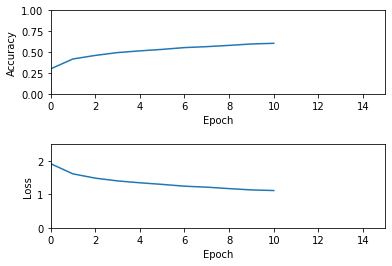

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/11a0model.ckpt Model Saved...
Epoch [275000], loss: 0.0648, acc: 1.0000
Epoch [275001], loss: 0.6576, acc: 1.0000
Epoch [275002], loss: 1.4916, acc: 0.0000
Epoch [275003], loss: 1.3889, acc: 0.0000
Epoch [275004], loss: 0.8609, acc: 1.0000
Epoch [275005], loss: 0.2937, acc: 1.0000
Epoch [275006], loss: 1.8891, acc: 0.0000
Epoch [275007], loss: 0.4528, acc: 1.0000
Epoch [275008], loss: 1.8770, acc: 0.0000
Epoch [275009], loss: 1.0950, acc: 1.0000
Epoch [275010], loss: 0.8918, acc: 1.0000
Epoch [275011], loss: 0.4342, acc: 1.0000
Epoch [275012], loss: 1.2709, acc: 1.0000
Epoch [275013], loss: 2.8768, acc: 0.0000
Epoch [275014], loss: 7.9968, acc: 0.0000
Epoch [275015], loss: 0.2676, acc: 1.0000
Epoch [275016], loss: 3.5969, acc: 0.0000
Epoch [275017], loss: 0.2521, acc: 1.0000
Epoch [275018], loss: 1.0879, acc: 1.0000
Epoch [275019], loss: 0.8668, acc: 1.0000
Epoch [275020], loss: 0.3060, acc: 1.0000
Epoch [275021]

Epoch [275201], loss: 1.9271, acc: 0.0000
Epoch [275202], loss: 3.4704, acc: 0.0000
Epoch [275203], loss: 2.1345, acc: 0.0000
Epoch [275204], loss: 0.5565, acc: 1.0000
Epoch [275205], loss: 0.0193, acc: 1.0000
Epoch [275206], loss: 0.0921, acc: 1.0000
Epoch [275207], loss: 0.2366, acc: 1.0000
Epoch [275208], loss: 0.1516, acc: 1.0000
Epoch [275209], loss: 0.8782, acc: 1.0000
Epoch [275210], loss: 1.4561, acc: 0.0000
Epoch [275211], loss: 0.0265, acc: 1.0000
Epoch [275212], loss: 1.8365, acc: 0.0000
Epoch [275213], loss: 1.3997, acc: 0.0000
Epoch [275214], loss: 0.2238, acc: 1.0000
Epoch [275215], loss: 0.2963, acc: 1.0000
Epoch [275216], loss: 1.1585, acc: 0.0000
Epoch [275217], loss: 0.8641, acc: 0.0000
Epoch [275218], loss: 1.6564, acc: 0.0000
Epoch [275219], loss: 0.1117, acc: 1.0000
Epoch [275220], loss: 1.2785, acc: 0.0000
Epoch [275221], loss: 0.5516, acc: 1.0000
Epoch [275222], loss: 1.8274, acc: 0.0000
Epoch [275223], loss: 1.0692, acc: 1.0000
Epoch [275224], loss: 1.1975, acc:

Epoch [275398], loss: 1.1867, acc: 0.0000
Epoch [275399], loss: 0.9383, acc: 1.0000
Epoch [275400], loss: 1.4088, acc: 0.0000
Epoch [275401], loss: 0.8498, acc: 0.0000
Epoch [275402], loss: 0.9583, acc: 1.0000
Epoch [275403], loss: 2.5915, acc: 0.0000
Epoch [275404], loss: 1.0717, acc: 0.0000
Epoch [275405], loss: 1.4291, acc: 0.0000
Epoch [275406], loss: 2.2015, acc: 0.0000
Epoch [275407], loss: 0.4606, acc: 1.0000
Epoch [275408], loss: 5.6770, acc: 0.0000
Epoch [275409], loss: 3.6895, acc: 0.0000
Epoch [275410], loss: 1.8648, acc: 0.0000
Epoch [275411], loss: 1.1470, acc: 1.0000
Epoch [275412], loss: 0.1731, acc: 1.0000
Epoch [275413], loss: 0.2777, acc: 1.0000
Epoch [275414], loss: 5.9479, acc: 0.0000
Epoch [275415], loss: 0.8435, acc: 0.0000
Epoch [275416], loss: 0.0961, acc: 1.0000
Epoch [275417], loss: 1.3298, acc: 0.0000
Epoch [275418], loss: 3.7361, acc: 0.0000
Epoch [275419], loss: 0.8983, acc: 1.0000
Epoch [275420], loss: 0.3736, acc: 1.0000
Epoch [275421], loss: 0.2370, acc:

Epoch [275593], loss: 2.4651, acc: 0.0000
Epoch [275594], loss: 0.0599, acc: 1.0000
Epoch [275595], loss: 0.9712, acc: 1.0000
Epoch [275596], loss: 2.6467, acc: 0.0000
Epoch [275597], loss: 2.5304, acc: 0.0000
Epoch [275598], loss: 2.2454, acc: 0.0000
Epoch [275599], loss: 0.1040, acc: 1.0000
Epoch [275600], loss: 1.1028, acc: 0.0000
Epoch [275601], loss: 0.2169, acc: 1.0000
Epoch [275602], loss: 1.0042, acc: 1.0000
Epoch [275603], loss: 1.5429, acc: 0.0000
Epoch [275604], loss: 0.0204, acc: 1.0000
Epoch [275605], loss: 0.3085, acc: 1.0000
Epoch [275606], loss: 0.2307, acc: 1.0000
Epoch [275607], loss: 0.1860, acc: 1.0000
Epoch [275608], loss: 1.7284, acc: 0.0000
Epoch [275609], loss: 0.0566, acc: 1.0000
Epoch [275610], loss: 1.3911, acc: 0.0000
Epoch [275611], loss: 0.8538, acc: 1.0000
Epoch [275612], loss: 1.3696, acc: 1.0000
Epoch [275613], loss: 2.8702, acc: 0.0000
Epoch [275614], loss: 0.7275, acc: 1.0000
Epoch [275615], loss: 0.9391, acc: 1.0000
Epoch [275616], loss: 0.1857, acc:

Epoch [275798], loss: 1.2837, acc: 1.0000
Epoch [275799], loss: 1.9872, acc: 0.0000
Epoch [275800], loss: 0.8062, acc: 1.0000
Epoch [275801], loss: 0.1143, acc: 1.0000
Epoch [275802], loss: 0.7865, acc: 1.0000
Epoch [275803], loss: 0.9964, acc: 1.0000
Epoch [275804], loss: 0.2434, acc: 1.0000
Epoch [275805], loss: 1.0408, acc: 0.0000
Epoch [275806], loss: 0.3415, acc: 1.0000
Epoch [275807], loss: 0.5350, acc: 1.0000
Epoch [275808], loss: 0.2259, acc: 1.0000
Epoch [275809], loss: 0.4181, acc: 1.0000
Epoch [275810], loss: 0.4039, acc: 1.0000
Epoch [275811], loss: 0.2560, acc: 1.0000
Epoch [275812], loss: 4.1066, acc: 0.0000
Epoch [275813], loss: 0.4030, acc: 1.0000
Epoch [275814], loss: 1.2595, acc: 0.0000
Epoch [275815], loss: 0.1560, acc: 1.0000
Epoch [275816], loss: 1.0345, acc: 1.0000
Epoch [275817], loss: 0.7881, acc: 1.0000
Epoch [275818], loss: 0.3751, acc: 1.0000
Epoch [275819], loss: 3.0185, acc: 0.0000
Epoch [275820], loss: 2.4404, acc: 0.0000
Epoch [275821], loss: 0.4049, acc:

Epoch [276006], loss: 0.9289, acc: 0.0000
Epoch [276007], loss: 0.2371, acc: 1.0000
Epoch [276008], loss: 1.2889, acc: 1.0000
Epoch [276009], loss: 1.5931, acc: 0.0000
Epoch [276010], loss: 0.3317, acc: 1.0000
Epoch [276011], loss: 0.2770, acc: 1.0000
Epoch [276012], loss: 0.0806, acc: 1.0000
Epoch [276013], loss: 0.0888, acc: 1.0000
Epoch [276014], loss: 0.4399, acc: 1.0000
Epoch [276015], loss: 1.0351, acc: 0.0000
Epoch [276016], loss: 0.3352, acc: 1.0000
Epoch [276017], loss: 2.4362, acc: 0.0000
Epoch [276018], loss: 0.5284, acc: 1.0000
Epoch [276019], loss: 4.7265, acc: 0.0000
Epoch [276020], loss: 2.2004, acc: 0.0000
Epoch [276021], loss: 0.1718, acc: 1.0000
Epoch [276022], loss: 1.9318, acc: 0.0000
Epoch [276023], loss: 0.2043, acc: 1.0000
Epoch [276024], loss: 2.6508, acc: 0.0000
Epoch [276025], loss: 0.0173, acc: 1.0000
Epoch [276026], loss: 3.1088, acc: 0.0000
Epoch [276027], loss: 0.1406, acc: 1.0000
Epoch [276028], loss: 0.4014, acc: 1.0000
Epoch [276029], loss: 0.1622, acc:

Epoch [276220], loss: 0.0644, acc: 1.0000
Epoch [276221], loss: 0.3955, acc: 1.0000
Epoch [276222], loss: 0.2200, acc: 1.0000
Epoch [276223], loss: 0.6476, acc: 1.0000
Epoch [276224], loss: 0.7673, acc: 1.0000
Epoch [276225], loss: 0.2599, acc: 1.0000
Epoch [276226], loss: 0.0231, acc: 1.0000
Epoch [276227], loss: 1.1352, acc: 0.0000
Epoch [276228], loss: 1.5485, acc: 0.0000
Epoch [276229], loss: 0.3719, acc: 1.0000
Epoch [276230], loss: 0.2500, acc: 1.0000
Epoch [276231], loss: 0.4011, acc: 1.0000
Epoch [276232], loss: 0.3925, acc: 1.0000
Epoch [276233], loss: 0.2714, acc: 1.0000
Epoch [276234], loss: 1.1069, acc: 0.0000
Epoch [276235], loss: 0.2760, acc: 1.0000
Epoch [276236], loss: 1.6145, acc: 0.0000
Epoch [276237], loss: 1.6652, acc: 0.0000
Epoch [276238], loss: 0.0345, acc: 1.0000
Epoch [276239], loss: 0.0105, acc: 1.0000
Epoch [276240], loss: 0.3222, acc: 1.0000
Epoch [276241], loss: 1.1664, acc: 1.0000
Epoch [276242], loss: 0.2242, acc: 1.0000
Epoch [276243], loss: 1.2377, acc:

Epoch [276430], loss: 0.1133, acc: 1.0000
Epoch [276431], loss: 1.7774, acc: 0.0000
Epoch [276432], loss: 1.3633, acc: 0.0000
Epoch [276433], loss: 0.1049, acc: 1.0000
Epoch [276434], loss: 0.0162, acc: 1.0000
Epoch [276435], loss: 0.2923, acc: 1.0000
Epoch [276436], loss: 0.7100, acc: 1.0000
Epoch [276437], loss: 1.2311, acc: 0.0000
Epoch [276438], loss: 1.2980, acc: 0.0000
Epoch [276439], loss: 0.7409, acc: 1.0000
Epoch [276440], loss: 0.2951, acc: 1.0000
Epoch [276441], loss: 3.7769, acc: 0.0000
Epoch [276442], loss: 3.3929, acc: 0.0000
Epoch [276443], loss: 2.0972, acc: 0.0000
Epoch [276444], loss: 0.2824, acc: 1.0000
Epoch [276445], loss: 0.2444, acc: 1.0000
Epoch [276446], loss: 0.0842, acc: 1.0000
Epoch [276447], loss: 0.2067, acc: 1.0000
Epoch [276448], loss: 0.1575, acc: 1.0000
Epoch [276449], loss: 2.2610, acc: 0.0000
Epoch [276450], loss: 1.3939, acc: 0.0000
Epoch [276451], loss: 2.6022, acc: 0.0000
Epoch [276452], loss: 0.0091, acc: 1.0000
Epoch [276453], loss: 0.1812, acc:

Epoch [276639], loss: 1.1684, acc: 0.0000
Epoch [276640], loss: 1.5018, acc: 0.0000
Epoch [276641], loss: 4.2168, acc: 0.0000
Epoch [276642], loss: 0.4206, acc: 1.0000
Epoch [276643], loss: 5.3076, acc: 0.0000
Epoch [276644], loss: 1.0565, acc: 1.0000
Epoch [276645], loss: 0.8125, acc: 1.0000
Epoch [276646], loss: 1.7167, acc: 0.0000
Epoch [276647], loss: 1.6491, acc: 0.0000
Epoch [276648], loss: 2.5245, acc: 0.0000
Epoch [276649], loss: 2.0883, acc: 0.0000
Epoch [276650], loss: 0.2955, acc: 1.0000
Epoch [276651], loss: 0.0358, acc: 1.0000
Epoch [276652], loss: 0.7116, acc: 1.0000
Epoch [276653], loss: 3.7560, acc: 0.0000
Epoch [276654], loss: 5.0182, acc: 0.0000
Epoch [276655], loss: 2.3760, acc: 0.0000
Epoch [276656], loss: 0.3301, acc: 1.0000
Epoch [276657], loss: 0.0837, acc: 1.0000
Epoch [276658], loss: 0.0430, acc: 1.0000
Epoch [276659], loss: 0.1344, acc: 1.0000
Epoch [276660], loss: 1.0656, acc: 0.0000
Epoch [276661], loss: 1.4449, acc: 0.0000
Epoch [276662], loss: 1.4216, acc:

Epoch [276840], loss: 0.9339, acc: 1.0000
Epoch [276841], loss: 3.9335, acc: 0.0000
Epoch [276842], loss: 0.2336, acc: 1.0000
Epoch [276843], loss: 0.8693, acc: 1.0000
Epoch [276844], loss: 0.1677, acc: 1.0000
Epoch [276845], loss: 3.9615, acc: 0.0000
Epoch [276846], loss: 1.9616, acc: 0.0000
Epoch [276847], loss: 0.0627, acc: 1.0000
Epoch [276848], loss: 1.1727, acc: 0.0000
Epoch [276849], loss: 1.4486, acc: 1.0000
Epoch [276850], loss: 0.1682, acc: 1.0000
Epoch [276851], loss: 1.4403, acc: 0.0000
Epoch [276852], loss: 0.0887, acc: 1.0000
Epoch [276853], loss: 1.5480, acc: 0.0000
Epoch [276854], loss: 2.0944, acc: 0.0000
Epoch [276855], loss: 0.0603, acc: 1.0000
Epoch [276856], loss: 1.5748, acc: 0.0000
Epoch [276857], loss: 1.1418, acc: 1.0000
Epoch [276858], loss: 2.0476, acc: 0.0000
Epoch [276859], loss: 1.5276, acc: 1.0000
Epoch [276860], loss: 0.0341, acc: 1.0000
Epoch [276861], loss: 0.0641, acc: 1.0000
Epoch [276862], loss: 1.1673, acc: 0.0000
Epoch [276863], loss: 1.3659, acc:

Epoch [277034], loss: 2.0143, acc: 0.0000
Epoch [277035], loss: 0.0897, acc: 1.0000
Epoch [277036], loss: 0.4885, acc: 1.0000
Epoch [277037], loss: 0.7899, acc: 0.0000
Epoch [277038], loss: 1.1750, acc: 0.0000
Epoch [277039], loss: 1.0314, acc: 1.0000
Epoch [277040], loss: 2.3806, acc: 0.0000
Epoch [277041], loss: 0.4043, acc: 1.0000
Epoch [277042], loss: 0.2115, acc: 1.0000
Epoch [277043], loss: 0.0535, acc: 1.0000
Epoch [277044], loss: 0.9803, acc: 1.0000
Epoch [277045], loss: 0.3653, acc: 1.0000
Epoch [277046], loss: 2.9118, acc: 0.0000
Epoch [277047], loss: 0.1925, acc: 1.0000
Epoch [277048], loss: 0.8585, acc: 1.0000
Epoch [277049], loss: 0.0779, acc: 1.0000
Epoch [277050], loss: 0.2143, acc: 1.0000
Epoch [277051], loss: 0.0592, acc: 1.0000
Epoch [277052], loss: 3.4977, acc: 0.0000
Epoch [277053], loss: 0.3483, acc: 1.0000
Epoch [277054], loss: 1.0875, acc: 0.0000
Epoch [277055], loss: 1.4473, acc: 0.0000
Epoch [277056], loss: 0.0999, acc: 1.0000
Epoch [277057], loss: 0.0599, acc:

Epoch [277240], loss: 2.7424, acc: 0.0000
Epoch [277241], loss: 2.0359, acc: 0.0000
Epoch [277242], loss: 3.3202, acc: 0.0000
Epoch [277243], loss: 0.3146, acc: 1.0000
Epoch [277244], loss: 0.8651, acc: 1.0000
Epoch [277245], loss: 1.0592, acc: 1.0000
Epoch [277246], loss: 1.3677, acc: 0.0000
Epoch [277247], loss: 0.1244, acc: 1.0000
Epoch [277248], loss: 0.1251, acc: 1.0000
Epoch [277249], loss: 2.3386, acc: 0.0000
Epoch [277250], loss: 0.4390, acc: 1.0000
Epoch [277251], loss: 2.5198, acc: 0.0000
Epoch [277252], loss: 0.3092, acc: 1.0000
Epoch [277253], loss: 0.8599, acc: 1.0000
Epoch [277254], loss: 1.4010, acc: 0.0000
Epoch [277255], loss: 1.2238, acc: 0.0000
Epoch [277256], loss: 1.1812, acc: 1.0000
Epoch [277257], loss: 1.1488, acc: 0.0000
Epoch [277258], loss: 1.3920, acc: 1.0000
Epoch [277259], loss: 1.4608, acc: 0.0000
Epoch [277260], loss: 0.2571, acc: 1.0000
Epoch [277261], loss: 8.4019, acc: 0.0000
Epoch [277262], loss: 0.4943, acc: 1.0000
Epoch [277263], loss: 0.2089, acc:

Epoch [277448], loss: 1.3112, acc: 0.0000
Epoch [277449], loss: 1.4595, acc: 0.0000
Epoch [277450], loss: 1.0917, acc: 0.0000
Epoch [277451], loss: 0.4179, acc: 1.0000
Epoch [277452], loss: 0.5054, acc: 1.0000
Epoch [277453], loss: 1.5064, acc: 0.0000
Epoch [277454], loss: 0.1439, acc: 1.0000
Epoch [277455], loss: 0.7550, acc: 1.0000
Epoch [277456], loss: 0.7526, acc: 1.0000
Epoch [277457], loss: 1.6116, acc: 0.0000
Epoch [277458], loss: 2.7574, acc: 0.0000
Epoch [277459], loss: 0.8520, acc: 1.0000
Epoch [277460], loss: 0.5206, acc: 1.0000
Epoch [277461], loss: 1.6346, acc: 0.0000
Epoch [277462], loss: 2.2019, acc: 0.0000
Epoch [277463], loss: 2.0877, acc: 0.0000
Epoch [277464], loss: 2.1125, acc: 0.0000
Epoch [277465], loss: 0.8415, acc: 1.0000
Epoch [277466], loss: 1.0027, acc: 0.0000
Epoch [277467], loss: 1.1801, acc: 1.0000
Epoch [277468], loss: 3.5702, acc: 0.0000
Epoch [277469], loss: 0.7181, acc: 1.0000
Epoch [277470], loss: 3.7332, acc: 0.0000
Epoch [277471], loss: 0.1297, acc:

Epoch [277644], loss: 0.0592, acc: 1.0000
Epoch [277645], loss: 0.0328, acc: 1.0000
Epoch [277646], loss: 0.5650, acc: 1.0000
Epoch [277647], loss: 0.9223, acc: 1.0000
Epoch [277648], loss: 0.3351, acc: 1.0000
Epoch [277649], loss: 1.2851, acc: 0.0000
Epoch [277650], loss: 3.8879, acc: 0.0000
Epoch [277651], loss: 0.1357, acc: 1.0000
Epoch [277652], loss: 0.6977, acc: 1.0000
Epoch [277653], loss: 0.3121, acc: 1.0000
Epoch [277654], loss: 1.2046, acc: 1.0000
Epoch [277655], loss: 3.1640, acc: 0.0000
Epoch [277656], loss: 1.9895, acc: 0.0000
Epoch [277657], loss: 1.5706, acc: 0.0000
Epoch [277658], loss: 2.1600, acc: 0.0000
Epoch [277659], loss: 0.3166, acc: 1.0000
Epoch [277660], loss: 0.0821, acc: 1.0000
Epoch [277661], loss: 3.8409, acc: 0.0000
Epoch [277662], loss: 1.5634, acc: 0.0000
Epoch [277663], loss: 1.5029, acc: 0.0000
Epoch [277664], loss: 0.2157, acc: 1.0000
Epoch [277665], loss: 1.6397, acc: 0.0000
Epoch [277666], loss: 1.3761, acc: 1.0000
Epoch [277667], loss: 2.1364, acc:

Epoch [277847], loss: 1.5011, acc: 0.0000
Epoch [277848], loss: 0.1186, acc: 1.0000
Epoch [277849], loss: 1.5972, acc: 0.0000
Epoch [277850], loss: 1.0031, acc: 1.0000
Epoch [277851], loss: 3.0140, acc: 0.0000
Epoch [277852], loss: 0.0858, acc: 1.0000
Epoch [277853], loss: 0.9265, acc: 0.0000
Epoch [277854], loss: 0.0807, acc: 1.0000
Epoch [277855], loss: 3.2023, acc: 0.0000
Epoch [277856], loss: 0.3693, acc: 1.0000
Epoch [277857], loss: 1.0732, acc: 0.0000
Epoch [277858], loss: 0.0314, acc: 1.0000
Epoch [277859], loss: 1.7870, acc: 0.0000
Epoch [277860], loss: 0.1404, acc: 1.0000
Epoch [277861], loss: 0.1716, acc: 1.0000
Epoch [277862], loss: 0.5908, acc: 1.0000
Epoch [277863], loss: 0.4822, acc: 1.0000
Epoch [277864], loss: 0.0639, acc: 1.0000
Epoch [277865], loss: 0.8364, acc: 0.0000
Epoch [277866], loss: 1.8285, acc: 0.0000
Epoch [277867], loss: 1.5716, acc: 0.0000
Epoch [277868], loss: 0.2626, acc: 1.0000
Epoch [277869], loss: 2.6625, acc: 0.0000
Epoch [277870], loss: 2.0411, acc:

Epoch [278052], loss: 1.2492, acc: 0.0000
Epoch [278053], loss: 0.6236, acc: 1.0000
Epoch [278054], loss: 3.9562, acc: 0.0000
Epoch [278055], loss: 0.6121, acc: 1.0000
Epoch [278056], loss: 1.9598, acc: 0.0000
Epoch [278057], loss: 0.2093, acc: 1.0000
Epoch [278058], loss: 2.4758, acc: 0.0000
Epoch [278059], loss: 0.6509, acc: 1.0000
Epoch [278060], loss: 0.0635, acc: 1.0000
Epoch [278061], loss: 0.0365, acc: 1.0000
Epoch [278062], loss: 0.1287, acc: 1.0000
Epoch [278063], loss: 0.6503, acc: 1.0000
Epoch [278064], loss: 0.6060, acc: 1.0000
Epoch [278065], loss: 1.1963, acc: 1.0000
Epoch [278066], loss: 1.5737, acc: 0.0000
Epoch [278067], loss: 0.1890, acc: 1.0000
Epoch [278068], loss: 0.8060, acc: 1.0000
Epoch [278069], loss: 1.3648, acc: 0.0000
Epoch [278070], loss: 0.3152, acc: 1.0000
Epoch [278071], loss: 1.4049, acc: 1.0000
Epoch [278072], loss: 0.1806, acc: 1.0000
Epoch [278073], loss: 2.5612, acc: 0.0000
Epoch [278074], loss: 0.2982, acc: 1.0000
Epoch [278075], loss: 0.0621, acc:

Epoch [278261], loss: 0.9645, acc: 1.0000
Epoch [278262], loss: 0.1839, acc: 1.0000
Epoch [278263], loss: 0.3936, acc: 1.0000
Epoch [278264], loss: 3.0900, acc: 0.0000
Epoch [278265], loss: 2.1230, acc: 0.0000
Epoch [278266], loss: 0.0572, acc: 1.0000
Epoch [278267], loss: 0.7229, acc: 1.0000
Epoch [278268], loss: 1.2881, acc: 0.0000
Epoch [278269], loss: 0.0482, acc: 1.0000
Epoch [278270], loss: 0.0887, acc: 1.0000
Epoch [278271], loss: 0.0598, acc: 1.0000
Epoch [278272], loss: 0.0663, acc: 1.0000
Epoch [278273], loss: 0.6682, acc: 1.0000
Epoch [278274], loss: 0.5695, acc: 1.0000
Epoch [278275], loss: 0.2299, acc: 1.0000
Epoch [278276], loss: 0.8478, acc: 1.0000
Epoch [278277], loss: 1.4220, acc: 1.0000
Epoch [278278], loss: 0.5339, acc: 1.0000
Epoch [278279], loss: 2.2867, acc: 0.0000
Epoch [278280], loss: 0.5942, acc: 1.0000
Epoch [278281], loss: 1.6087, acc: 0.0000
Epoch [278282], loss: 0.5202, acc: 1.0000
Epoch [278283], loss: 1.0243, acc: 1.0000
Epoch [278284], loss: 2.1734, acc:

Epoch [278467], loss: 0.1567, acc: 1.0000
Epoch [278468], loss: 1.2151, acc: 0.0000
Epoch [278469], loss: 0.8748, acc: 1.0000
Epoch [278470], loss: 0.0402, acc: 1.0000
Epoch [278471], loss: 0.8584, acc: 1.0000
Epoch [278472], loss: 1.9350, acc: 0.0000
Epoch [278473], loss: 0.0622, acc: 1.0000
Epoch [278474], loss: 0.0790, acc: 1.0000
Epoch [278475], loss: 0.3934, acc: 1.0000
Epoch [278476], loss: 0.3425, acc: 1.0000
Epoch [278477], loss: 0.0678, acc: 1.0000
Epoch [278478], loss: 0.6000, acc: 1.0000
Epoch [278479], loss: 0.7246, acc: 1.0000
Epoch [278480], loss: 1.7559, acc: 0.0000
Epoch [278481], loss: 1.1954, acc: 0.0000
Epoch [278482], loss: 1.1508, acc: 0.0000
Epoch [278483], loss: 0.6503, acc: 1.0000
Epoch [278484], loss: 0.1120, acc: 1.0000
Epoch [278485], loss: 1.3034, acc: 0.0000
Epoch [278486], loss: 0.6136, acc: 1.0000
Epoch [278487], loss: 0.1825, acc: 1.0000
Epoch [278488], loss: 0.3187, acc: 1.0000
Epoch [278489], loss: 0.0361, acc: 1.0000
Epoch [278490], loss: 6.3830, acc:

Epoch [278667], loss: 0.2233, acc: 1.0000
Epoch [278668], loss: 1.0871, acc: 0.0000
Epoch [278669], loss: 0.4830, acc: 1.0000
Epoch [278670], loss: 0.1353, acc: 1.0000
Epoch [278671], loss: 0.2187, acc: 1.0000
Epoch [278672], loss: 0.8296, acc: 0.0000
Epoch [278673], loss: 1.6819, acc: 0.0000
Epoch [278674], loss: 0.2977, acc: 1.0000
Epoch [278675], loss: 0.2614, acc: 1.0000
Epoch [278676], loss: 0.9937, acc: 0.0000
Epoch [278677], loss: 0.5287, acc: 1.0000
Epoch [278678], loss: 1.2399, acc: 1.0000
Epoch [278679], loss: 1.8300, acc: 0.0000
Epoch [278680], loss: 0.2504, acc: 1.0000
Epoch [278681], loss: 3.2013, acc: 0.0000
Epoch [278682], loss: 2.5033, acc: 0.0000
Epoch [278683], loss: 1.7546, acc: 0.0000
Epoch [278684], loss: 2.4908, acc: 0.0000
Epoch [278685], loss: 1.6826, acc: 0.0000
Epoch [278686], loss: 0.7402, acc: 1.0000
Epoch [278687], loss: 0.2456, acc: 1.0000
Epoch [278688], loss: 0.0264, acc: 1.0000
Epoch [278689], loss: 1.4333, acc: 0.0000
Epoch [278690], loss: 0.0283, acc:

Epoch [278870], loss: 0.0576, acc: 1.0000
Epoch [278871], loss: 0.9361, acc: 1.0000
Epoch [278872], loss: 0.6443, acc: 1.0000
Epoch [278873], loss: 1.5791, acc: 0.0000
Epoch [278874], loss: 0.1037, acc: 1.0000
Epoch [278875], loss: 0.9151, acc: 0.0000
Epoch [278876], loss: 0.7866, acc: 1.0000
Epoch [278877], loss: 0.0307, acc: 1.0000
Epoch [278878], loss: 1.7293, acc: 0.0000
Epoch [278879], loss: 0.4374, acc: 1.0000
Epoch [278880], loss: 1.4766, acc: 0.0000
Epoch [278881], loss: 1.4933, acc: 0.0000
Epoch [278882], loss: 0.3031, acc: 1.0000
Epoch [278883], loss: 1.2564, acc: 0.0000
Epoch [278884], loss: 1.1842, acc: 0.0000
Epoch [278885], loss: 0.5719, acc: 1.0000
Epoch [278886], loss: 0.5357, acc: 1.0000
Epoch [278887], loss: 0.0831, acc: 1.0000
Epoch [278888], loss: 0.7265, acc: 1.0000
Epoch [278889], loss: 0.0431, acc: 1.0000
Epoch [278890], loss: 2.3867, acc: 0.0000
Epoch [278891], loss: 0.0214, acc: 1.0000
Epoch [278892], loss: 1.1410, acc: 1.0000
Epoch [278893], loss: 2.6999, acc:

Epoch [279067], loss: 3.5180, acc: 0.0000
Epoch [279068], loss: 2.4972, acc: 0.0000
Epoch [279069], loss: 1.6265, acc: 0.0000
Epoch [279070], loss: 0.9421, acc: 0.0000
Epoch [279071], loss: 1.8448, acc: 0.0000
Epoch [279072], loss: 1.3481, acc: 0.0000
Epoch [279073], loss: 0.3904, acc: 1.0000
Epoch [279074], loss: 1.1623, acc: 0.0000
Epoch [279075], loss: 1.0796, acc: 1.0000
Epoch [279076], loss: 1.1683, acc: 0.0000
Epoch [279077], loss: 1.5725, acc: 0.0000
Epoch [279078], loss: 2.6016, acc: 0.0000
Epoch [279079], loss: 0.2236, acc: 1.0000
Epoch [279080], loss: 1.2714, acc: 1.0000
Epoch [279081], loss: 1.4816, acc: 1.0000
Epoch [279082], loss: 0.4168, acc: 1.0000
Epoch [279083], loss: 0.1316, acc: 1.0000
Epoch [279084], loss: 1.8889, acc: 0.0000
Epoch [279085], loss: 2.1428, acc: 0.0000
Epoch [279086], loss: 3.6708, acc: 0.0000
Epoch [279087], loss: 0.1390, acc: 1.0000
Epoch [279088], loss: 0.8893, acc: 1.0000
Epoch [279089], loss: 1.4065, acc: 0.0000
Epoch [279090], loss: 1.1689, acc:

Epoch [279273], loss: 3.6361, acc: 0.0000
Epoch [279274], loss: 0.9581, acc: 1.0000
Epoch [279275], loss: 0.3904, acc: 1.0000
Epoch [279276], loss: 0.5895, acc: 1.0000
Epoch [279277], loss: 0.2536, acc: 1.0000
Epoch [279278], loss: 1.7474, acc: 0.0000
Epoch [279279], loss: 0.5713, acc: 1.0000
Epoch [279280], loss: 1.9699, acc: 0.0000
Epoch [279281], loss: 2.2696, acc: 0.0000
Epoch [279282], loss: 0.5219, acc: 1.0000
Epoch [279283], loss: 0.3058, acc: 1.0000
Epoch [279284], loss: 0.2401, acc: 1.0000
Epoch [279285], loss: 0.1097, acc: 1.0000
Epoch [279286], loss: 1.2458, acc: 1.0000
Epoch [279287], loss: 2.7883, acc: 0.0000
Epoch [279288], loss: 0.2491, acc: 1.0000
Epoch [279289], loss: 1.6536, acc: 0.0000
Epoch [279290], loss: 0.0669, acc: 1.0000
Epoch [279291], loss: 0.2441, acc: 1.0000
Epoch [279292], loss: 1.2064, acc: 0.0000
Epoch [279293], loss: 0.0557, acc: 1.0000
Epoch [279294], loss: 0.7342, acc: 1.0000
Epoch [279295], loss: 0.6900, acc: 1.0000
Epoch [279296], loss: 0.7033, acc:

Epoch [279468], loss: 0.7473, acc: 1.0000
Epoch [279469], loss: 0.7981, acc: 1.0000
Epoch [279470], loss: 3.9720, acc: 0.0000
Epoch [279471], loss: 0.0611, acc: 1.0000
Epoch [279472], loss: 2.6026, acc: 0.0000
Epoch [279473], loss: 0.4058, acc: 1.0000
Epoch [279474], loss: 0.9505, acc: 1.0000
Epoch [279475], loss: 0.1813, acc: 1.0000
Epoch [279476], loss: 2.2420, acc: 0.0000
Epoch [279477], loss: 0.0109, acc: 1.0000
Epoch [279478], loss: 1.0787, acc: 0.0000
Epoch [279479], loss: 0.0031, acc: 1.0000
Epoch [279480], loss: 0.1938, acc: 1.0000
Epoch [279481], loss: 0.1569, acc: 1.0000
Epoch [279482], loss: 0.8858, acc: 1.0000
Epoch [279483], loss: 1.6448, acc: 0.0000
Epoch [279484], loss: 0.5843, acc: 1.0000
Epoch [279485], loss: 1.0858, acc: 1.0000
Epoch [279486], loss: 1.4000, acc: 0.0000
Epoch [279487], loss: 1.4222, acc: 0.0000
Epoch [279488], loss: 2.5835, acc: 0.0000
Epoch [279489], loss: 0.8778, acc: 1.0000
Epoch [279490], loss: 0.9784, acc: 0.0000
Epoch [279491], loss: 0.4861, acc:

Epoch [279669], loss: 0.0253, acc: 1.0000
Epoch [279670], loss: 1.5345, acc: 0.0000
Epoch [279671], loss: 0.7125, acc: 1.0000
Epoch [279672], loss: 0.1095, acc: 1.0000
Epoch [279673], loss: 3.3470, acc: 0.0000
Epoch [279674], loss: 0.0221, acc: 1.0000
Epoch [279675], loss: 1.6187, acc: 0.0000
Epoch [279676], loss: 0.3006, acc: 1.0000
Epoch [279677], loss: 0.7424, acc: 1.0000
Epoch [279678], loss: 0.1735, acc: 1.0000
Epoch [279679], loss: 0.0786, acc: 1.0000
Epoch [279680], loss: 2.7954, acc: 0.0000
Epoch [279681], loss: 0.2161, acc: 1.0000
Epoch [279682], loss: 0.6071, acc: 1.0000
Epoch [279683], loss: 0.6670, acc: 1.0000
Epoch [279684], loss: 0.2681, acc: 1.0000
Epoch [279685], loss: 4.1350, acc: 0.0000
Epoch [279686], loss: 0.2735, acc: 1.0000
Epoch [279687], loss: 0.2273, acc: 1.0000
Epoch [279688], loss: 0.0409, acc: 1.0000
Epoch [279689], loss: 0.6073, acc: 1.0000
Epoch [279690], loss: 0.5677, acc: 1.0000
Epoch [279691], loss: 0.3341, acc: 1.0000
Epoch [279692], loss: 0.1495, acc:

Epoch [279867], loss: 2.5026, acc: 0.0000
Epoch [279868], loss: 0.8772, acc: 1.0000
Epoch [279869], loss: 1.3018, acc: 0.0000
Epoch [279870], loss: 0.0120, acc: 1.0000
Epoch [279871], loss: 2.4981, acc: 0.0000
Epoch [279872], loss: 0.7977, acc: 1.0000
Epoch [279873], loss: 0.0950, acc: 1.0000
Epoch [279874], loss: 0.4045, acc: 1.0000
Epoch [279875], loss: 2.0703, acc: 0.0000
Epoch [279876], loss: 0.1611, acc: 1.0000
Epoch [279877], loss: 0.5365, acc: 1.0000
Epoch [279878], loss: 0.0348, acc: 1.0000
Epoch [279879], loss: 1.2563, acc: 0.0000
Epoch [279880], loss: 0.6025, acc: 1.0000
Epoch [279881], loss: 2.4482, acc: 0.0000
Epoch [279882], loss: 1.8289, acc: 0.0000
Epoch [279883], loss: 3.1563, acc: 0.0000
Epoch [279884], loss: 1.3346, acc: 0.0000
Epoch [279885], loss: 0.8046, acc: 1.0000
Epoch [279886], loss: 1.3066, acc: 1.0000
Epoch [279887], loss: 0.9728, acc: 1.0000
Epoch [279888], loss: 1.4354, acc: 0.0000
Epoch [279889], loss: 0.3699, acc: 1.0000
Epoch [279890], loss: 1.2521, acc:

Epoch [280066], loss: 2.0473, acc: 0.0000
Epoch [280067], loss: 0.4429, acc: 1.0000
Epoch [280068], loss: 0.1428, acc: 1.0000
Epoch [280069], loss: 0.6705, acc: 1.0000
Epoch [280070], loss: 0.0827, acc: 1.0000
Epoch [280071], loss: 0.5605, acc: 1.0000
Epoch [280072], loss: 0.4341, acc: 1.0000
Epoch [280073], loss: 0.2796, acc: 1.0000
Epoch [280074], loss: 2.1588, acc: 0.0000
Epoch [280075], loss: 1.3076, acc: 0.0000
Epoch [280076], loss: 0.0514, acc: 1.0000
Epoch [280077], loss: 5.3334, acc: 0.0000
Epoch [280078], loss: 0.0304, acc: 1.0000
Epoch [280079], loss: 1.4673, acc: 0.0000
Epoch [280080], loss: 0.2256, acc: 1.0000
Epoch [280081], loss: 1.9213, acc: 0.0000
Epoch [280082], loss: 2.3951, acc: 0.0000
Epoch [280083], loss: 1.4692, acc: 0.0000
Epoch [280084], loss: 0.8794, acc: 0.0000
Epoch [280085], loss: 0.2547, acc: 1.0000
Epoch [280086], loss: 2.0869, acc: 0.0000
Epoch [280087], loss: 0.3798, acc: 1.0000
Epoch [280088], loss: 1.0504, acc: 1.0000
Epoch [280089], loss: 1.2490, acc:

Epoch [280276], loss: 0.6659, acc: 1.0000
Epoch [280277], loss: 1.2911, acc: 0.0000
Epoch [280278], loss: 0.9036, acc: 1.0000
Epoch [280279], loss: 0.1940, acc: 1.0000
Epoch [280280], loss: 1.5642, acc: 0.0000
Epoch [280281], loss: 0.0427, acc: 1.0000
Epoch [280282], loss: 1.4264, acc: 0.0000
Epoch [280283], loss: 0.1889, acc: 1.0000
Epoch [280284], loss: 2.9542, acc: 0.0000
Epoch [280285], loss: 0.2942, acc: 1.0000
Epoch [280286], loss: 0.4489, acc: 1.0000
Epoch [280287], loss: 0.6235, acc: 1.0000
Epoch [280288], loss: 0.1998, acc: 1.0000
Epoch [280289], loss: 0.8510, acc: 1.0000
Epoch [280290], loss: 0.5889, acc: 1.0000
Epoch [280291], loss: 0.8251, acc: 1.0000
Epoch [280292], loss: 0.4804, acc: 1.0000
Epoch [280293], loss: 0.4246, acc: 1.0000
Epoch [280294], loss: 0.3424, acc: 1.0000
Epoch [280295], loss: 2.8939, acc: 0.0000
Epoch [280296], loss: 1.1777, acc: 0.0000
Epoch [280297], loss: 3.1068, acc: 0.0000
Epoch [280298], loss: 0.3287, acc: 1.0000
Epoch [280299], loss: 0.2319, acc:

Epoch [280485], loss: 1.3667, acc: 0.0000
Epoch [280486], loss: 1.0456, acc: 1.0000
Epoch [280487], loss: 1.0740, acc: 0.0000
Epoch [280488], loss: 1.0568, acc: 0.0000
Epoch [280489], loss: 0.8921, acc: 0.0000
Epoch [280490], loss: 0.0912, acc: 1.0000
Epoch [280491], loss: 0.6908, acc: 1.0000
Epoch [280492], loss: 0.0347, acc: 1.0000
Epoch [280493], loss: 0.8298, acc: 1.0000
Epoch [280494], loss: 0.0683, acc: 1.0000
Epoch [280495], loss: 0.3793, acc: 1.0000
Epoch [280496], loss: 0.8461, acc: 1.0000
Epoch [280497], loss: 1.4269, acc: 0.0000
Epoch [280498], loss: 0.0561, acc: 1.0000
Epoch [280499], loss: 5.4601, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/11a5500model.ckpt Model Saved...
Epoch [280500], loss: 1.5691, acc: 0.0000
Epoch [280501], loss: 0.0357, acc: 1.0000
Epoch [280502], loss: 3.1101, acc: 0.0000
Epoch [280503], loss: 1.6478, acc: 0.0000
Epoch [280504], loss: 0.8637, acc: 1.0000
Epoch [280505], loss: 1.7409, acc: 0.0000
Epoch [2805

Epoch [280685], loss: 0.3854, acc: 1.0000
Epoch [280686], loss: 0.0130, acc: 1.0000
Epoch [280687], loss: 5.3909, acc: 0.0000
Epoch [280688], loss: 0.0307, acc: 1.0000
Epoch [280689], loss: 1.0722, acc: 1.0000
Epoch [280690], loss: 1.6413, acc: 0.0000
Epoch [280691], loss: 0.8861, acc: 1.0000
Epoch [280692], loss: 3.6797, acc: 0.0000
Epoch [280693], loss: 1.4303, acc: 0.0000
Epoch [280694], loss: 2.7968, acc: 0.0000
Epoch [280695], loss: 2.4351, acc: 0.0000
Epoch [280696], loss: 2.0224, acc: 0.0000
Epoch [280697], loss: 2.0057, acc: 0.0000
Epoch [280698], loss: 1.3077, acc: 1.0000
Epoch [280699], loss: 2.0467, acc: 0.0000
Epoch [280700], loss: 0.0095, acc: 1.0000
Epoch [280701], loss: 0.1739, acc: 1.0000
Epoch [280702], loss: 0.1319, acc: 1.0000
Epoch [280703], loss: 0.9354, acc: 0.0000
Epoch [280704], loss: 0.1255, acc: 1.0000
Epoch [280705], loss: 0.0047, acc: 1.0000
Epoch [280706], loss: 0.2165, acc: 1.0000
Epoch [280707], loss: 3.0062, acc: 0.0000
Epoch [280708], loss: 3.6773, acc:

Epoch [280890], loss: 1.5938, acc: 0.0000
Epoch [280891], loss: 3.3349, acc: 0.0000
Epoch [280892], loss: 1.2779, acc: 0.0000
Epoch [280893], loss: 2.8222, acc: 0.0000
Epoch [280894], loss: 0.3093, acc: 1.0000
Epoch [280895], loss: 0.2210, acc: 1.0000
Epoch [280896], loss: 0.8370, acc: 1.0000
Epoch [280897], loss: 0.4779, acc: 1.0000
Epoch [280898], loss: 1.3912, acc: 0.0000
Epoch [280899], loss: 1.8400, acc: 0.0000
Epoch [280900], loss: 0.0289, acc: 1.0000
Epoch [280901], loss: 0.7940, acc: 1.0000
Epoch [280902], loss: 0.5092, acc: 1.0000
Epoch [280903], loss: 0.5640, acc: 1.0000
Epoch [280904], loss: 0.1207, acc: 1.0000
Epoch [280905], loss: 1.7865, acc: 0.0000
Epoch [280906], loss: 0.9808, acc: 1.0000
Epoch [280907], loss: 0.9274, acc: 1.0000
Epoch [280908], loss: 1.6752, acc: 0.0000
Epoch [280909], loss: 0.8749, acc: 0.0000
Epoch [280910], loss: 1.9373, acc: 0.0000
Epoch [280911], loss: 0.3491, acc: 1.0000
Epoch [280912], loss: 0.2749, acc: 1.0000
Epoch [280913], loss: 0.1331, acc:

Epoch [281084], loss: 0.2674, acc: 1.0000
Epoch [281085], loss: 1.0280, acc: 1.0000
Epoch [281086], loss: 0.7681, acc: 1.0000
Epoch [281087], loss: 0.1080, acc: 1.0000
Epoch [281088], loss: 0.4280, acc: 1.0000
Epoch [281089], loss: 0.6900, acc: 1.0000
Epoch [281090], loss: 0.6460, acc: 1.0000
Epoch [281091], loss: 0.4777, acc: 1.0000
Epoch [281092], loss: 1.1051, acc: 1.0000
Epoch [281093], loss: 1.2698, acc: 0.0000
Epoch [281094], loss: 1.1193, acc: 1.0000
Epoch [281095], loss: 1.0368, acc: 1.0000
Epoch [281096], loss: 0.3619, acc: 1.0000
Epoch [281097], loss: 0.1379, acc: 1.0000
Epoch [281098], loss: 0.5735, acc: 1.0000
Epoch [281099], loss: 0.2715, acc: 1.0000
Epoch [281100], loss: 0.2512, acc: 1.0000
Epoch [281101], loss: 0.7639, acc: 1.0000
Epoch [281102], loss: 1.5201, acc: 0.0000
Epoch [281103], loss: 2.3377, acc: 0.0000
Epoch [281104], loss: 0.1850, acc: 1.0000
Epoch [281105], loss: 1.7617, acc: 0.0000
Epoch [281106], loss: 2.0759, acc: 0.0000
Epoch [281107], loss: 0.3934, acc:

Epoch [281294], loss: 0.1274, acc: 1.0000
Epoch [281295], loss: 0.3753, acc: 1.0000
Epoch [281296], loss: 0.1154, acc: 1.0000
Epoch [281297], loss: 2.0900, acc: 0.0000
Epoch [281298], loss: 0.0251, acc: 1.0000
Epoch [281299], loss: 2.0675, acc: 0.0000
Epoch [281300], loss: 0.6091, acc: 1.0000
Epoch [281301], loss: 2.8416, acc: 0.0000
Epoch [281302], loss: 0.1024, acc: 1.0000
Epoch [281303], loss: 0.0836, acc: 1.0000
Epoch [281304], loss: 1.3116, acc: 0.0000
Epoch [281305], loss: 1.2042, acc: 0.0000
Epoch [281306], loss: 0.0264, acc: 1.0000
Epoch [281307], loss: 2.1930, acc: 0.0000
Epoch [281308], loss: 0.1832, acc: 1.0000
Epoch [281309], loss: 2.0262, acc: 0.0000
Epoch [281310], loss: 0.2052, acc: 1.0000
Epoch [281311], loss: 0.7683, acc: 1.0000
Epoch [281312], loss: 1.8633, acc: 0.0000
Epoch [281313], loss: 1.4532, acc: 0.0000
Epoch [281314], loss: 2.6434, acc: 0.0000
Epoch [281315], loss: 0.3606, acc: 1.0000
Epoch [281316], loss: 0.8477, acc: 1.0000
Epoch [281317], loss: 3.2726, acc:

Epoch [281503], loss: 1.6095, acc: 0.0000
Epoch [281504], loss: 0.2933, acc: 1.0000
Epoch [281505], loss: 0.7253, acc: 1.0000
Epoch [281506], loss: 1.1370, acc: 1.0000
Epoch [281507], loss: 2.6269, acc: 0.0000
Epoch [281508], loss: 0.4885, acc: 1.0000
Epoch [281509], loss: 0.0659, acc: 1.0000
Epoch [281510], loss: 0.5510, acc: 1.0000
Epoch [281511], loss: 0.3548, acc: 1.0000
Epoch [281512], loss: 2.0673, acc: 0.0000
Epoch [281513], loss: 1.1576, acc: 1.0000
Epoch [281514], loss: 1.0778, acc: 1.0000
Epoch [281515], loss: 0.2348, acc: 1.0000
Epoch [281516], loss: 2.4040, acc: 0.0000
Epoch [281517], loss: 3.1482, acc: 0.0000
Epoch [281518], loss: 1.6355, acc: 0.0000
Epoch [281519], loss: 0.2846, acc: 1.0000
Epoch [281520], loss: 0.6909, acc: 1.0000
Epoch [281521], loss: 1.0676, acc: 0.0000
Epoch [281522], loss: 0.6731, acc: 1.0000
Epoch [281523], loss: 0.4560, acc: 1.0000
Epoch [281524], loss: 1.0721, acc: 0.0000
Epoch [281525], loss: 0.6831, acc: 1.0000
Epoch [281526], loss: 5.9682, acc:

Epoch [281710], loss: 0.7070, acc: 1.0000
Epoch [281711], loss: 1.1041, acc: 1.0000
Epoch [281712], loss: 0.6102, acc: 1.0000
Epoch [281713], loss: 0.3875, acc: 1.0000
Epoch [281714], loss: 0.2218, acc: 1.0000
Epoch [281715], loss: 0.0199, acc: 1.0000
Epoch [281716], loss: 0.2961, acc: 1.0000
Epoch [281717], loss: 0.1039, acc: 1.0000
Epoch [281718], loss: 0.2965, acc: 1.0000
Epoch [281719], loss: 2.4494, acc: 0.0000
Epoch [281720], loss: 0.0056, acc: 1.0000
Epoch [281721], loss: 0.7175, acc: 1.0000
Epoch [281722], loss: 0.6449, acc: 1.0000
Epoch [281723], loss: 0.7515, acc: 1.0000
Epoch [281724], loss: 1.2798, acc: 1.0000
Epoch [281725], loss: 0.2847, acc: 1.0000
Epoch [281726], loss: 1.5092, acc: 0.0000
Epoch [281727], loss: 3.0300, acc: 0.0000
Epoch [281728], loss: 0.7022, acc: 1.0000
Epoch [281729], loss: 0.1533, acc: 1.0000
Epoch [281730], loss: 0.6276, acc: 1.0000
Epoch [281731], loss: 0.5059, acc: 1.0000
Epoch [281732], loss: 0.8539, acc: 1.0000
Epoch [281733], loss: 0.4978, acc:

Epoch [281910], loss: 0.8921, acc: 1.0000
Epoch [281911], loss: 0.3985, acc: 1.0000
Epoch [281912], loss: 0.7861, acc: 1.0000
Epoch [281913], loss: 0.1116, acc: 1.0000
Epoch [281914], loss: 1.2849, acc: 0.0000
Epoch [281915], loss: 0.4011, acc: 1.0000
Epoch [281916], loss: 1.8018, acc: 0.0000
Epoch [281917], loss: 0.0346, acc: 1.0000
Epoch [281918], loss: 0.5688, acc: 1.0000
Epoch [281919], loss: 0.0902, acc: 1.0000
Epoch [281920], loss: 0.3000, acc: 1.0000
Epoch [281921], loss: 2.1904, acc: 0.0000
Epoch [281922], loss: 0.4065, acc: 1.0000
Epoch [281923], loss: 1.1401, acc: 1.0000
Epoch [281924], loss: 0.0207, acc: 1.0000
Epoch [281925], loss: 1.6713, acc: 0.0000
Epoch [281926], loss: 2.3609, acc: 0.0000
Epoch [281927], loss: 0.3632, acc: 1.0000
Epoch [281928], loss: 0.1133, acc: 1.0000
Epoch [281929], loss: 0.4385, acc: 1.0000
Epoch [281930], loss: 2.3924, acc: 0.0000
Epoch [281931], loss: 1.3954, acc: 0.0000
Epoch [281932], loss: 1.0975, acc: 1.0000
Epoch [281933], loss: 1.1204, acc:

Epoch [282116], loss: 0.0141, acc: 1.0000
Epoch [282117], loss: 0.0531, acc: 1.0000
Epoch [282118], loss: 0.5561, acc: 1.0000
Epoch [282119], loss: 0.7857, acc: 1.0000
Epoch [282120], loss: 0.2092, acc: 1.0000
Epoch [282121], loss: 0.1633, acc: 1.0000
Epoch [282122], loss: 0.5394, acc: 1.0000
Epoch [282123], loss: 0.1873, acc: 1.0000
Epoch [282124], loss: 1.2067, acc: 0.0000
Epoch [282125], loss: 0.6838, acc: 1.0000
Epoch [282126], loss: 0.4287, acc: 1.0000
Epoch [282127], loss: 0.0043, acc: 1.0000
Epoch [282128], loss: 0.7521, acc: 1.0000
Epoch [282129], loss: 1.6440, acc: 0.0000
Epoch [282130], loss: 2.3533, acc: 0.0000
Epoch [282131], loss: 1.3231, acc: 0.0000
Epoch [282132], loss: 0.1573, acc: 1.0000
Epoch [282133], loss: 0.2073, acc: 1.0000
Epoch [282134], loss: 0.5549, acc: 1.0000
Epoch [282135], loss: 0.9030, acc: 1.0000
Epoch [282136], loss: 0.4426, acc: 1.0000
Epoch [282137], loss: 0.5062, acc: 1.0000
Epoch [282138], loss: 0.1313, acc: 1.0000
Epoch [282139], loss: 0.1926, acc:

Epoch [282314], loss: 0.5063, acc: 1.0000
Epoch [282315], loss: 0.3264, acc: 1.0000
Epoch [282316], loss: 0.3272, acc: 1.0000
Epoch [282317], loss: 1.2151, acc: 0.0000
Epoch [282318], loss: 0.6228, acc: 1.0000
Epoch [282319], loss: 0.3741, acc: 1.0000
Epoch [282320], loss: 3.3012, acc: 0.0000
Epoch [282321], loss: 3.3605, acc: 0.0000
Epoch [282322], loss: 0.0562, acc: 1.0000
Epoch [282323], loss: 0.7866, acc: 1.0000
Epoch [282324], loss: 0.2221, acc: 1.0000
Epoch [282325], loss: 0.6447, acc: 1.0000
Epoch [282326], loss: 0.1307, acc: 1.0000
Epoch [282327], loss: 0.3709, acc: 1.0000
Epoch [282328], loss: 0.3525, acc: 1.0000
Epoch [282329], loss: 0.3994, acc: 1.0000
Epoch [282330], loss: 0.2379, acc: 1.0000
Epoch [282331], loss: 3.0384, acc: 0.0000
Epoch [282332], loss: 0.4364, acc: 1.0000
Epoch [282333], loss: 0.8502, acc: 1.0000
Epoch [282334], loss: 0.9738, acc: 0.0000
Epoch [282335], loss: 1.6389, acc: 0.0000
Epoch [282336], loss: 1.6608, acc: 0.0000
Epoch [282337], loss: 1.3498, acc:

Epoch [282508], loss: 0.6418, acc: 1.0000
Epoch [282509], loss: 0.5286, acc: 1.0000
Epoch [282510], loss: 0.7173, acc: 1.0000
Epoch [282511], loss: 5.9068, acc: 0.0000
Epoch [282512], loss: 0.4993, acc: 1.0000
Epoch [282513], loss: 0.3360, acc: 1.0000
Epoch [282514], loss: 0.8703, acc: 1.0000
Epoch [282515], loss: 1.6148, acc: 0.0000
Epoch [282516], loss: 0.9813, acc: 1.0000
Epoch [282517], loss: 4.0880, acc: 0.0000
Epoch [282518], loss: 1.4758, acc: 0.0000
Epoch [282519], loss: 1.0964, acc: 1.0000
Epoch [282520], loss: 1.6559, acc: 0.0000
Epoch [282521], loss: 0.1020, acc: 1.0000
Epoch [282522], loss: 0.8075, acc: 1.0000
Epoch [282523], loss: 1.6446, acc: 0.0000
Epoch [282524], loss: 0.9279, acc: 1.0000
Epoch [282525], loss: 4.2975, acc: 0.0000
Epoch [282526], loss: 2.3743, acc: 0.0000
Epoch [282527], loss: 1.2011, acc: 0.0000
Epoch [282528], loss: 0.5637, acc: 1.0000
Epoch [282529], loss: 0.9740, acc: 1.0000
Epoch [282530], loss: 0.4547, acc: 1.0000
Epoch [282531], loss: 0.0616, acc:

Epoch [282709], loss: 2.2050, acc: 0.0000
Epoch [282710], loss: 0.2582, acc: 1.0000
Epoch [282711], loss: 1.0221, acc: 1.0000
Epoch [282712], loss: 1.1003, acc: 0.0000
Epoch [282713], loss: 1.3780, acc: 1.0000
Epoch [282714], loss: 2.7335, acc: 0.0000
Epoch [282715], loss: 1.5228, acc: 0.0000
Epoch [282716], loss: 0.0256, acc: 1.0000
Epoch [282717], loss: 0.8914, acc: 1.0000
Epoch [282718], loss: 0.5763, acc: 1.0000
Epoch [282719], loss: 0.5824, acc: 1.0000
Epoch [282720], loss: 0.3545, acc: 1.0000
Epoch [282721], loss: 3.0024, acc: 0.0000
Epoch [282722], loss: 0.4036, acc: 1.0000
Epoch [282723], loss: 1.6548, acc: 0.0000
Epoch [282724], loss: 3.4975, acc: 0.0000
Epoch [282725], loss: 1.7229, acc: 0.0000
Epoch [282726], loss: 0.6994, acc: 1.0000
Epoch [282727], loss: 2.9255, acc: 0.0000
Epoch [282728], loss: 0.7048, acc: 1.0000
Epoch [282729], loss: 1.3941, acc: 0.0000
Epoch [282730], loss: 0.1913, acc: 1.0000
Epoch [282731], loss: 0.5660, acc: 1.0000
Epoch [282732], loss: 0.0631, acc:

Epoch [282910], loss: 2.9728, acc: 0.0000
Epoch [282911], loss: 0.6331, acc: 1.0000
Epoch [282912], loss: 0.4348, acc: 1.0000
Epoch [282913], loss: 6.8509, acc: 0.0000
Epoch [282914], loss: 0.6877, acc: 1.0000
Epoch [282915], loss: 0.0110, acc: 1.0000
Epoch [282916], loss: 0.0332, acc: 1.0000
Epoch [282917], loss: 0.8270, acc: 1.0000
Epoch [282918], loss: 2.3199, acc: 0.0000
Epoch [282919], loss: 1.9680, acc: 0.0000
Epoch [282920], loss: 0.4731, acc: 1.0000
Epoch [282921], loss: 0.4913, acc: 1.0000
Epoch [282922], loss: 0.6330, acc: 1.0000
Epoch [282923], loss: 0.3435, acc: 1.0000
Epoch [282924], loss: 2.5399, acc: 0.0000
Epoch [282925], loss: 2.9528, acc: 0.0000
Epoch [282926], loss: 3.1658, acc: 0.0000
Epoch [282927], loss: 0.4776, acc: 1.0000
Epoch [282928], loss: 0.8433, acc: 1.0000
Epoch [282929], loss: 0.5961, acc: 1.0000
Epoch [282930], loss: 0.8353, acc: 1.0000
Epoch [282931], loss: 5.0635, acc: 0.0000
Epoch [282932], loss: 0.3759, acc: 1.0000
Epoch [282933], loss: 2.0181, acc:

Epoch [283118], loss: 1.1251, acc: 1.0000
Epoch [283119], loss: 0.7039, acc: 1.0000
Epoch [283120], loss: 0.0687, acc: 1.0000
Epoch [283121], loss: 0.5473, acc: 1.0000
Epoch [283122], loss: 0.4515, acc: 1.0000
Epoch [283123], loss: 0.0703, acc: 1.0000
Epoch [283124], loss: 0.7408, acc: 1.0000
Epoch [283125], loss: 1.1975, acc: 1.0000
Epoch [283126], loss: 0.0645, acc: 1.0000
Epoch [283127], loss: 2.6332, acc: 0.0000
Epoch [283128], loss: 0.2057, acc: 1.0000
Epoch [283129], loss: 0.6991, acc: 1.0000
Epoch [283130], loss: 0.0425, acc: 1.0000
Epoch [283131], loss: 1.1270, acc: 1.0000
Epoch [283132], loss: 1.1923, acc: 1.0000
Epoch [283133], loss: 0.8406, acc: 1.0000
Epoch [283134], loss: 3.5719, acc: 0.0000
Epoch [283135], loss: 0.3619, acc: 1.0000
Epoch [283136], loss: 1.6691, acc: 0.0000
Epoch [283137], loss: 0.2438, acc: 1.0000
Epoch [283138], loss: 1.2854, acc: 0.0000
Epoch [283139], loss: 0.1854, acc: 1.0000
Epoch [283140], loss: 0.5543, acc: 1.0000
Epoch [283141], loss: 2.9346, acc:

Epoch [283322], loss: 1.4955, acc: 0.0000
Epoch [283323], loss: 3.0588, acc: 0.0000
Epoch [283324], loss: 0.3342, acc: 1.0000
Epoch [283325], loss: 0.4002, acc: 1.0000
Epoch [283326], loss: 0.0372, acc: 1.0000
Epoch [283327], loss: 1.0368, acc: 1.0000
Epoch [283328], loss: 0.5618, acc: 1.0000
Epoch [283329], loss: 1.4743, acc: 0.0000
Epoch [283330], loss: 0.4520, acc: 1.0000
Epoch [283331], loss: 0.0261, acc: 1.0000
Epoch [283332], loss: 1.0800, acc: 0.0000
Epoch [283333], loss: 1.3513, acc: 1.0000
Epoch [283334], loss: 3.7818, acc: 0.0000
Epoch [283335], loss: 3.1203, acc: 0.0000
Epoch [283336], loss: 1.5645, acc: 0.0000
Epoch [283337], loss: 1.8076, acc: 0.0000
Epoch [283338], loss: 0.0360, acc: 1.0000
Epoch [283339], loss: 0.4402, acc: 1.0000
Epoch [283340], loss: 1.0038, acc: 0.0000
Epoch [283341], loss: 4.0464, acc: 0.0000
Epoch [283342], loss: 0.7864, acc: 1.0000
Epoch [283343], loss: 0.8159, acc: 0.0000
Epoch [283344], loss: 0.3317, acc: 1.0000
Epoch [283345], loss: 1.7488, acc:

Epoch [283520], loss: 0.4687, acc: 1.0000
Epoch [283521], loss: 0.7215, acc: 1.0000
Epoch [283522], loss: 0.2889, acc: 1.0000
Epoch [283523], loss: 0.3373, acc: 1.0000
Epoch [283524], loss: 0.2306, acc: 1.0000
Epoch [283525], loss: 1.5884, acc: 1.0000
Epoch [283526], loss: 0.1523, acc: 1.0000
Epoch [283527], loss: 2.2528, acc: 0.0000
Epoch [283528], loss: 2.7596, acc: 0.0000
Epoch [283529], loss: 0.9581, acc: 1.0000
Epoch [283530], loss: 0.3957, acc: 1.0000
Epoch [283531], loss: 1.2553, acc: 0.0000
Epoch [283532], loss: 0.3703, acc: 1.0000
Epoch [283533], loss: 0.2306, acc: 1.0000
Epoch [283534], loss: 0.4672, acc: 1.0000
Epoch [283535], loss: 0.3852, acc: 1.0000
Epoch [283536], loss: 0.6128, acc: 1.0000
Epoch [283537], loss: 1.0846, acc: 1.0000
Epoch [283538], loss: 1.4941, acc: 0.0000
Epoch [283539], loss: 4.3922, acc: 0.0000
Epoch [283540], loss: 0.7235, acc: 1.0000
Epoch [283541], loss: 2.3663, acc: 0.0000
Epoch [283542], loss: 2.5193, acc: 0.0000
Epoch [283543], loss: 0.3180, acc:

Epoch [283719], loss: 0.0747, acc: 1.0000
Epoch [283720], loss: 2.4970, acc: 0.0000
Epoch [283721], loss: 1.7344, acc: 0.0000
Epoch [283722], loss: 1.9525, acc: 0.0000
Epoch [283723], loss: 0.2479, acc: 1.0000
Epoch [283724], loss: 0.5679, acc: 1.0000
Epoch [283725], loss: 0.1194, acc: 1.0000
Epoch [283726], loss: 3.5612, acc: 0.0000
Epoch [283727], loss: 0.1907, acc: 1.0000
Epoch [283728], loss: 0.6586, acc: 1.0000
Epoch [283729], loss: 0.3731, acc: 1.0000
Epoch [283730], loss: 2.4734, acc: 0.0000
Epoch [283731], loss: 1.4177, acc: 0.0000
Epoch [283732], loss: 2.6056, acc: 0.0000
Epoch [283733], loss: 0.3114, acc: 1.0000
Epoch [283734], loss: 1.0191, acc: 0.0000
Epoch [283735], loss: 1.7306, acc: 0.0000
Epoch [283736], loss: 1.6278, acc: 0.0000
Epoch [283737], loss: 1.8159, acc: 0.0000
Epoch [283738], loss: 0.3202, acc: 1.0000
Epoch [283739], loss: 1.1776, acc: 0.0000
Epoch [283740], loss: 2.4338, acc: 0.0000
Epoch [283741], loss: 3.3969, acc: 0.0000
Epoch [283742], loss: 2.8177, acc:

Epoch [283926], loss: 0.4135, acc: 1.0000
Epoch [283927], loss: 2.3122, acc: 0.0000
Epoch [283928], loss: 1.8683, acc: 0.0000
Epoch [283929], loss: 1.1370, acc: 0.0000
Epoch [283930], loss: 3.5259, acc: 0.0000
Epoch [283931], loss: 2.3703, acc: 0.0000
Epoch [283932], loss: 5.4243, acc: 0.0000
Epoch [283933], loss: 0.7583, acc: 1.0000
Epoch [283934], loss: 0.5515, acc: 1.0000
Epoch [283935], loss: 0.0063, acc: 1.0000
Epoch [283936], loss: 1.7375, acc: 0.0000
Epoch [283937], loss: 3.8945, acc: 0.0000
Epoch [283938], loss: 2.5115, acc: 0.0000
Epoch [283939], loss: 0.3542, acc: 1.0000
Epoch [283940], loss: 1.9492, acc: 0.0000
Epoch [283941], loss: 0.0913, acc: 1.0000
Epoch [283942], loss: 2.4287, acc: 0.0000
Epoch [283943], loss: 1.1170, acc: 1.0000
Epoch [283944], loss: 0.3753, acc: 1.0000
Epoch [283945], loss: 0.7378, acc: 1.0000
Epoch [283946], loss: 2.7062, acc: 0.0000
Epoch [283947], loss: 0.2532, acc: 1.0000
Epoch [283948], loss: 1.9261, acc: 0.0000
Epoch [283949], loss: 1.1568, acc:

Epoch [284132], loss: 1.9340, acc: 0.0000
Epoch [284133], loss: 1.4241, acc: 0.0000
Epoch [284134], loss: 0.6014, acc: 1.0000
Epoch [284135], loss: 2.7863, acc: 0.0000
Epoch [284136], loss: 0.2287, acc: 1.0000
Epoch [284137], loss: 0.5114, acc: 1.0000
Epoch [284138], loss: 0.5701, acc: 1.0000
Epoch [284139], loss: 0.5161, acc: 1.0000
Epoch [284140], loss: 0.0361, acc: 1.0000
Epoch [284141], loss: 0.1990, acc: 1.0000
Epoch [284142], loss: 0.4786, acc: 1.0000
Epoch [284143], loss: 0.9318, acc: 1.0000
Epoch [284144], loss: 0.3359, acc: 1.0000
Epoch [284145], loss: 0.0388, acc: 1.0000
Epoch [284146], loss: 0.2440, acc: 1.0000
Epoch [284147], loss: 1.2410, acc: 1.0000
Epoch [284148], loss: 0.0836, acc: 1.0000
Epoch [284149], loss: 3.6425, acc: 0.0000
Epoch [284150], loss: 0.3275, acc: 1.0000
Epoch [284151], loss: 0.4483, acc: 1.0000
Epoch [284152], loss: 0.9303, acc: 0.0000
Epoch [284153], loss: 1.5160, acc: 0.0000
Epoch [284154], loss: 1.5424, acc: 0.0000
Epoch [284155], loss: 0.3134, acc:

Epoch [284338], loss: 1.1649, acc: 0.0000
Epoch [284339], loss: 0.3790, acc: 1.0000
Epoch [284340], loss: 1.1161, acc: 0.0000
Epoch [284341], loss: 0.1745, acc: 1.0000
Epoch [284342], loss: 0.1262, acc: 1.0000
Epoch [284343], loss: 0.6305, acc: 1.0000
Epoch [284344], loss: 0.4308, acc: 1.0000
Epoch [284345], loss: 0.3017, acc: 1.0000
Epoch [284346], loss: 4.2290, acc: 0.0000
Epoch [284347], loss: 2.0825, acc: 0.0000
Epoch [284348], loss: 0.0373, acc: 1.0000
Epoch [284349], loss: 0.2845, acc: 1.0000
Epoch [284350], loss: 1.0758, acc: 0.0000
Epoch [284351], loss: 1.1079, acc: 0.0000
Epoch [284352], loss: 1.8866, acc: 0.0000
Epoch [284353], loss: 1.1086, acc: 0.0000
Epoch [284354], loss: 0.3637, acc: 1.0000
Epoch [284355], loss: 0.4791, acc: 1.0000
Epoch [284356], loss: 1.8262, acc: 0.0000
Epoch [284357], loss: 0.0211, acc: 1.0000
Epoch [284358], loss: 0.0060, acc: 1.0000
Epoch [284359], loss: 0.2163, acc: 1.0000
Epoch [284360], loss: 0.0214, acc: 1.0000
Epoch [284361], loss: 1.5030, acc:

Epoch [284540], loss: 0.3857, acc: 1.0000
Epoch [284541], loss: 0.9461, acc: 1.0000
Epoch [284542], loss: 1.7408, acc: 0.0000
Epoch [284543], loss: 3.0069, acc: 0.0000
Epoch [284544], loss: 0.7472, acc: 0.0000
Epoch [284545], loss: 1.2104, acc: 1.0000
Epoch [284546], loss: 2.4617, acc: 0.0000
Epoch [284547], loss: 1.4019, acc: 0.0000
Epoch [284548], loss: 0.2619, acc: 1.0000
Epoch [284549], loss: 0.3258, acc: 1.0000
Epoch [284550], loss: 0.6410, acc: 1.0000
Epoch [284551], loss: 0.0509, acc: 1.0000
Epoch [284552], loss: 0.1994, acc: 1.0000
Epoch [284553], loss: 0.2761, acc: 1.0000
Epoch [284554], loss: 1.4227, acc: 0.0000
Epoch [284555], loss: 1.8782, acc: 0.0000
Epoch [284556], loss: 2.5844, acc: 0.0000
Epoch [284557], loss: 1.2041, acc: 0.0000
Epoch [284558], loss: 1.1644, acc: 0.0000
Epoch [284559], loss: 1.7612, acc: 0.0000
Epoch [284560], loss: 3.9718, acc: 0.0000
Epoch [284561], loss: 0.9125, acc: 0.0000
Epoch [284562], loss: 0.0486, acc: 1.0000
Epoch [284563], loss: 0.2808, acc:

Epoch [284746], loss: 0.1803, acc: 1.0000
Epoch [284747], loss: 0.2854, acc: 1.0000
Epoch [284748], loss: 1.9698, acc: 0.0000
Epoch [284749], loss: 0.4746, acc: 1.0000
Epoch [284750], loss: 0.6804, acc: 1.0000
Epoch [284751], loss: 1.3594, acc: 0.0000
Epoch [284752], loss: 1.4128, acc: 0.0000
Epoch [284753], loss: 1.0292, acc: 0.0000
Epoch [284754], loss: 0.6843, acc: 1.0000
Epoch [284755], loss: 0.4965, acc: 1.0000
Epoch [284756], loss: 0.0483, acc: 1.0000
Epoch [284757], loss: 0.2543, acc: 1.0000
Epoch [284758], loss: 0.1020, acc: 1.0000
Epoch [284759], loss: 1.2956, acc: 1.0000
Epoch [284760], loss: 2.3294, acc: 0.0000
Epoch [284761], loss: 0.0790, acc: 1.0000
Epoch [284762], loss: 0.0133, acc: 1.0000
Epoch [284763], loss: 0.9804, acc: 1.0000
Epoch [284764], loss: 0.0244, acc: 1.0000
Epoch [284765], loss: 0.1176, acc: 1.0000
Epoch [284766], loss: 0.5170, acc: 1.0000
Epoch [284767], loss: 0.8439, acc: 1.0000
Epoch [284768], loss: 0.3058, acc: 1.0000
Epoch [284769], loss: 1.1118, acc:

Epoch [284948], loss: 3.1912, acc: 0.0000
Epoch [284949], loss: 0.2278, acc: 1.0000
Epoch [284950], loss: 0.3030, acc: 1.0000
Epoch [284951], loss: 0.8717, acc: 0.0000
Epoch [284952], loss: 0.0618, acc: 1.0000
Epoch [284953], loss: 0.2496, acc: 1.0000
Epoch [284954], loss: 0.4356, acc: 1.0000
Epoch [284955], loss: 0.3652, acc: 1.0000
Epoch [284956], loss: 2.5541, acc: 0.0000
Epoch [284957], loss: 3.5042, acc: 0.0000
Epoch [284958], loss: 0.1098, acc: 1.0000
Epoch [284959], loss: 0.3182, acc: 1.0000
Epoch [284960], loss: 2.1194, acc: 0.0000
Epoch [284961], loss: 1.1165, acc: 0.0000
Epoch [284962], loss: 0.3760, acc: 1.0000
Epoch [284963], loss: 0.1947, acc: 1.0000
Epoch [284964], loss: 0.5121, acc: 1.0000
Epoch [284965], loss: 1.5928, acc: 0.0000
Epoch [284966], loss: 3.0933, acc: 0.0000
Epoch [284967], loss: 1.3784, acc: 0.0000
Epoch [284968], loss: 1.3705, acc: 1.0000
Epoch [284969], loss: 0.2241, acc: 1.0000
Epoch [284970], loss: 0.4819, acc: 1.0000
Epoch [284971], loss: 2.7075, acc:

Epoch [285151], loss: 1.7164, acc: 0.0000
Epoch [285152], loss: 0.1633, acc: 1.0000
Epoch [285153], loss: 0.4621, acc: 1.0000
Epoch [285154], loss: 0.3582, acc: 1.0000
Epoch [285155], loss: 0.3002, acc: 1.0000
Epoch [285156], loss: 0.3810, acc: 1.0000
Epoch [285157], loss: 0.0654, acc: 1.0000
Epoch [285158], loss: 1.1105, acc: 1.0000
Epoch [285159], loss: 0.1370, acc: 1.0000
Epoch [285160], loss: 3.3462, acc: 0.0000
Epoch [285161], loss: 0.4976, acc: 1.0000
Epoch [285162], loss: 0.1266, acc: 1.0000
Epoch [285163], loss: 1.3990, acc: 0.0000
Epoch [285164], loss: 0.0429, acc: 1.0000
Epoch [285165], loss: 3.4695, acc: 0.0000
Epoch [285166], loss: 0.3578, acc: 1.0000
Epoch [285167], loss: 0.8817, acc: 0.0000
Epoch [285168], loss: 0.0846, acc: 1.0000
Epoch [285169], loss: 3.2348, acc: 0.0000
Epoch [285170], loss: 0.4289, acc: 1.0000
Epoch [285171], loss: 0.9386, acc: 1.0000
Epoch [285172], loss: 0.5628, acc: 1.0000
Epoch [285173], loss: 0.3755, acc: 1.0000
Epoch [285174], loss: 0.0139, acc:

Epoch [285362], loss: 1.1466, acc: 1.0000
Epoch [285363], loss: 1.3720, acc: 1.0000
Epoch [285364], loss: 6.5881, acc: 0.0000
Epoch [285365], loss: 2.2240, acc: 0.0000
Epoch [285366], loss: 0.6182, acc: 1.0000
Epoch [285367], loss: 0.1019, acc: 1.0000
Epoch [285368], loss: 0.0014, acc: 1.0000
Epoch [285369], loss: 0.2714, acc: 1.0000
Epoch [285370], loss: 1.2074, acc: 0.0000
Epoch [285371], loss: 0.6950, acc: 1.0000
Epoch [285372], loss: 0.6455, acc: 1.0000
Epoch [285373], loss: 1.5739, acc: 0.0000
Epoch [285374], loss: 1.5238, acc: 0.0000
Epoch [285375], loss: 1.4907, acc: 0.0000
Epoch [285376], loss: 0.4227, acc: 1.0000
Epoch [285377], loss: 2.0497, acc: 0.0000
Epoch [285378], loss: 2.7416, acc: 0.0000
Epoch [285379], loss: 1.5605, acc: 0.0000
Epoch [285380], loss: 1.1362, acc: 0.0000
Epoch [285381], loss: 2.8829, acc: 0.0000
Epoch [285382], loss: 0.5335, acc: 1.0000
Epoch [285383], loss: 0.3665, acc: 1.0000
Epoch [285384], loss: 2.5835, acc: 0.0000
Epoch [285385], loss: 0.3894, acc:

Epoch [285564], loss: 1.0086, acc: 1.0000
Epoch [285565], loss: 0.0908, acc: 1.0000
Epoch [285566], loss: 0.4340, acc: 1.0000
Epoch [285567], loss: 0.7468, acc: 1.0000
Epoch [285568], loss: 0.3377, acc: 1.0000
Epoch [285569], loss: 1.7238, acc: 0.0000
Epoch [285570], loss: 1.7958, acc: 0.0000
Epoch [285571], loss: 2.2171, acc: 0.0000
Epoch [285572], loss: 0.5417, acc: 1.0000
Epoch [285573], loss: 1.0151, acc: 0.0000
Epoch [285574], loss: 0.6441, acc: 1.0000
Epoch [285575], loss: 0.1565, acc: 1.0000
Epoch [285576], loss: 0.9646, acc: 0.0000
Epoch [285577], loss: 0.2695, acc: 1.0000
Epoch [285578], loss: 0.7954, acc: 1.0000
Epoch [285579], loss: 1.5448, acc: 0.0000
Epoch [285580], loss: 1.7019, acc: 0.0000
Epoch [285581], loss: 0.6534, acc: 1.0000
Epoch [285582], loss: 1.2502, acc: 0.0000
Epoch [285583], loss: 1.9610, acc: 0.0000
Epoch [285584], loss: 0.3702, acc: 1.0000
Epoch [285585], loss: 0.7867, acc: 1.0000
Epoch [285586], loss: 0.8105, acc: 1.0000
Epoch [285587], loss: 0.5580, acc:

Epoch [285770], loss: 0.0956, acc: 1.0000
Epoch [285771], loss: 0.0066, acc: 1.0000
Epoch [285772], loss: 0.9763, acc: 0.0000
Epoch [285773], loss: 0.4610, acc: 1.0000
Epoch [285774], loss: 3.3947, acc: 0.0000
Epoch [285775], loss: 0.2128, acc: 1.0000
Epoch [285776], loss: 0.1556, acc: 1.0000
Epoch [285777], loss: 1.4066, acc: 0.0000
Epoch [285778], loss: 0.6324, acc: 1.0000
Epoch [285779], loss: 1.1382, acc: 0.0000
Epoch [285780], loss: 1.6149, acc: 0.0000
Epoch [285781], loss: 1.0847, acc: 0.0000
Epoch [285782], loss: 3.7712, acc: 0.0000
Epoch [285783], loss: 0.3606, acc: 1.0000
Epoch [285784], loss: 3.1355, acc: 0.0000
Epoch [285785], loss: 1.6012, acc: 0.0000
Epoch [285786], loss: 2.1364, acc: 0.0000
Epoch [285787], loss: 3.3954, acc: 0.0000
Epoch [285788], loss: 0.0385, acc: 1.0000
Epoch [285789], loss: 0.7123, acc: 1.0000
Epoch [285790], loss: 1.5263, acc: 0.0000
Epoch [285791], loss: 0.2286, acc: 1.0000
Epoch [285792], loss: 0.8961, acc: 1.0000
Epoch [285793], loss: 1.2457, acc:

Epoch [285970], loss: 2.7897, acc: 0.0000
Epoch [285971], loss: 0.2686, acc: 1.0000
Epoch [285972], loss: 0.2040, acc: 1.0000
Epoch [285973], loss: 0.4223, acc: 1.0000
Epoch [285974], loss: 2.4474, acc: 0.0000
Epoch [285975], loss: 1.2067, acc: 0.0000
Epoch [285976], loss: 0.1197, acc: 1.0000
Epoch [285977], loss: 2.3338, acc: 0.0000
Epoch [285978], loss: 1.4525, acc: 0.0000
Epoch [285979], loss: 0.9736, acc: 0.0000
Epoch [285980], loss: 0.7890, acc: 0.0000
Epoch [285981], loss: 1.8631, acc: 0.0000
Epoch [285982], loss: 0.4862, acc: 1.0000
Epoch [285983], loss: 0.0976, acc: 1.0000
Epoch [285984], loss: 0.0088, acc: 1.0000
Epoch [285985], loss: 0.1950, acc: 1.0000
Epoch [285986], loss: 1.2401, acc: 1.0000
Epoch [285987], loss: 1.0448, acc: 1.0000
Epoch [285988], loss: 0.1700, acc: 1.0000
Epoch [285989], loss: 0.4915, acc: 1.0000
Epoch [285990], loss: 0.0994, acc: 1.0000
Epoch [285991], loss: 1.9328, acc: 0.0000
Epoch [285992], loss: 1.8295, acc: 0.0000
Epoch [285993], loss: 0.1046, acc:

Epoch [286171], loss: 1.2281, acc: 0.0000
Epoch [286172], loss: 1.3070, acc: 0.0000
Epoch [286173], loss: 0.2208, acc: 1.0000
Epoch [286174], loss: 0.3518, acc: 1.0000
Epoch [286175], loss: 0.7070, acc: 1.0000
Epoch [286176], loss: 4.2250, acc: 0.0000
Epoch [286177], loss: 2.9887, acc: 0.0000
Epoch [286178], loss: 0.8724, acc: 1.0000
Epoch [286179], loss: 0.3123, acc: 1.0000
Epoch [286180], loss: 2.0103, acc: 0.0000
Epoch [286181], loss: 1.5398, acc: 0.0000
Epoch [286182], loss: 0.5804, acc: 1.0000
Epoch [286183], loss: 1.5742, acc: 0.0000
Epoch [286184], loss: 2.5808, acc: 0.0000
Epoch [286185], loss: 2.7304, acc: 0.0000
Epoch [286186], loss: 1.4177, acc: 0.0000
Epoch [286187], loss: 1.1337, acc: 1.0000
Epoch [286188], loss: 0.1166, acc: 1.0000
Epoch [286189], loss: 2.3438, acc: 0.0000
Epoch [286190], loss: 0.2361, acc: 1.0000
Epoch [286191], loss: 0.8874, acc: 1.0000
Epoch [286192], loss: 0.3780, acc: 1.0000
Epoch [286193], loss: 2.0497, acc: 0.0000
Epoch [286194], loss: 2.1256, acc:

Epoch [286376], loss: 0.0227, acc: 1.0000
Epoch [286377], loss: 0.1768, acc: 1.0000
Epoch [286378], loss: 2.0525, acc: 0.0000
Epoch [286379], loss: 0.5191, acc: 1.0000
Epoch [286380], loss: 0.0185, acc: 1.0000
Epoch [286381], loss: 3.6947, acc: 0.0000
Epoch [286382], loss: 0.6369, acc: 1.0000
Epoch [286383], loss: 0.7767, acc: 1.0000
Epoch [286384], loss: 0.6675, acc: 1.0000
Epoch [286385], loss: 1.0711, acc: 0.0000
Epoch [286386], loss: 0.4744, acc: 1.0000
Epoch [286387], loss: 2.0563, acc: 0.0000
Epoch [286388], loss: 2.9152, acc: 0.0000
Epoch [286389], loss: 4.8822, acc: 0.0000
Epoch [286390], loss: 0.2879, acc: 1.0000
Epoch [286391], loss: 1.6440, acc: 0.0000
Epoch [286392], loss: 0.1620, acc: 1.0000
Epoch [286393], loss: 0.4496, acc: 1.0000
Epoch [286394], loss: 2.0472, acc: 0.0000
Epoch [286395], loss: 0.7437, acc: 1.0000
Epoch [286396], loss: 0.3097, acc: 1.0000
Epoch [286397], loss: 0.5348, acc: 1.0000
Epoch [286398], loss: 0.1842, acc: 1.0000
Epoch [286399], loss: 0.3972, acc:

Epoch [286584], loss: 3.3758, acc: 0.0000
Epoch [286585], loss: 0.1004, acc: 1.0000
Epoch [286586], loss: 0.0278, acc: 1.0000
Epoch [286587], loss: 0.3609, acc: 1.0000
Epoch [286588], loss: 3.3289, acc: 0.0000
Epoch [286589], loss: 0.0319, acc: 1.0000
Epoch [286590], loss: 1.3084, acc: 0.0000
Epoch [286591], loss: 0.1431, acc: 1.0000
Epoch [286592], loss: 0.2417, acc: 1.0000
Epoch [286593], loss: 0.3747, acc: 1.0000
Epoch [286594], loss: 1.8518, acc: 0.0000
Epoch [286595], loss: 1.1461, acc: 0.0000
Epoch [286596], loss: 0.2895, acc: 1.0000
Epoch [286597], loss: 1.4190, acc: 0.0000
Epoch [286598], loss: 0.4637, acc: 1.0000
Epoch [286599], loss: 0.2277, acc: 1.0000
Epoch [286600], loss: 0.6737, acc: 1.0000
Epoch [286601], loss: 0.1416, acc: 1.0000
Epoch [286602], loss: 1.2623, acc: 0.0000
Epoch [286603], loss: 1.1367, acc: 0.0000
Epoch [286604], loss: 3.0105, acc: 0.0000
Epoch [286605], loss: 2.0787, acc: 0.0000
Epoch [286606], loss: 2.3828, acc: 0.0000
Epoch [286607], loss: 0.0188, acc:

Epoch [286788], loss: 1.3201, acc: 0.0000
Epoch [286789], loss: 1.1753, acc: 1.0000
Epoch [286790], loss: 1.4307, acc: 0.0000
Epoch [286791], loss: 1.0410, acc: 1.0000
Epoch [286792], loss: 0.5526, acc: 1.0000
Epoch [286793], loss: 1.0442, acc: 0.0000
Epoch [286794], loss: 0.0959, acc: 1.0000
Epoch [286795], loss: 0.4609, acc: 1.0000
Epoch [286796], loss: 3.7755, acc: 0.0000
Epoch [286797], loss: 0.0011, acc: 1.0000
Epoch [286798], loss: 1.4680, acc: 0.0000
Epoch [286799], loss: 1.6511, acc: 0.0000
Epoch [286800], loss: 0.6873, acc: 1.0000
Epoch [286801], loss: 0.4280, acc: 1.0000
Epoch [286802], loss: 0.0768, acc: 1.0000
Epoch [286803], loss: 0.2188, acc: 1.0000
Epoch [286804], loss: 0.3529, acc: 1.0000
Epoch [286805], loss: 0.3010, acc: 1.0000
Epoch [286806], loss: 0.1810, acc: 1.0000
Epoch [286807], loss: 0.2137, acc: 1.0000
Epoch [286808], loss: 0.0337, acc: 1.0000
Epoch [286809], loss: 2.9461, acc: 0.0000
Epoch [286810], loss: 0.0305, acc: 1.0000
Epoch [286811], loss: 1.2201, acc:

Epoch [286991], loss: 0.0414, acc: 1.0000
Epoch [286992], loss: 0.7143, acc: 1.0000
Epoch [286993], loss: 0.6253, acc: 1.0000
Epoch [286994], loss: 0.5073, acc: 1.0000
Epoch [286995], loss: 0.8565, acc: 0.0000
Epoch [286996], loss: 0.3645, acc: 1.0000
Epoch [286997], loss: 0.3870, acc: 1.0000
Epoch [286998], loss: 0.3975, acc: 1.0000
Epoch [286999], loss: 0.9969, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/11a12000model.ckpt Model Saved...
Epoch [287000], loss: 0.9090, acc: 1.0000
Epoch [287001], loss: 1.1902, acc: 0.0000
Epoch [287002], loss: 0.9856, acc: 0.0000
Epoch [287003], loss: 3.4425, acc: 0.0000
Epoch [287004], loss: 0.8940, acc: 1.0000
Epoch [287005], loss: 1.3510, acc: 1.0000
Epoch [287006], loss: 0.9497, acc: 1.0000
Epoch [287007], loss: 0.0684, acc: 1.0000
Epoch [287008], loss: 1.7016, acc: 0.0000
Epoch [287009], loss: 0.2068, acc: 1.0000
Epoch [287010], loss: 0.0466, acc: 1.0000
Epoch [287011], loss: 1.9372, acc: 0.0000
Epoch [287

Epoch [287193], loss: 0.0770, acc: 1.0000
Epoch [287194], loss: 0.3686, acc: 1.0000
Epoch [287195], loss: 0.1363, acc: 1.0000
Epoch [287196], loss: 0.1998, acc: 1.0000
Epoch [287197], loss: 0.1197, acc: 1.0000
Epoch [287198], loss: 0.6926, acc: 1.0000
Epoch [287199], loss: 0.5401, acc: 1.0000
Epoch [287200], loss: 1.1752, acc: 0.0000
Epoch [287201], loss: 0.6512, acc: 1.0000
Epoch [287202], loss: 1.3485, acc: 0.0000
Epoch [287203], loss: 0.2055, acc: 1.0000
Epoch [287204], loss: 1.1417, acc: 1.0000
Epoch [287205], loss: 1.7617, acc: 0.0000
Epoch [287206], loss: 1.0310, acc: 1.0000
Epoch [287207], loss: 0.2951, acc: 1.0000
Epoch [287208], loss: 1.9591, acc: 0.0000
Epoch [287209], loss: 1.0974, acc: 1.0000
Epoch [287210], loss: 2.8953, acc: 0.0000
Epoch [287211], loss: 0.4156, acc: 1.0000
Epoch [287212], loss: 0.3108, acc: 1.0000
Epoch [287213], loss: 0.0792, acc: 1.0000
Epoch [287214], loss: 1.0060, acc: 1.0000
Epoch [287215], loss: 0.9387, acc: 1.0000
Epoch [287216], loss: 0.1721, acc:

Epoch [287390], loss: 0.2860, acc: 1.0000
Epoch [287391], loss: 1.1547, acc: 0.0000
Epoch [287392], loss: 0.0610, acc: 1.0000
Epoch [287393], loss: 2.8723, acc: 0.0000
Epoch [287394], loss: 0.9912, acc: 0.0000
Epoch [287395], loss: 0.0750, acc: 1.0000
Epoch [287396], loss: 2.3242, acc: 0.0000
Epoch [287397], loss: 0.7724, acc: 1.0000
Epoch [287398], loss: 0.4373, acc: 1.0000
Epoch [287399], loss: 1.2779, acc: 0.0000
Epoch [287400], loss: 3.5618, acc: 0.0000
Epoch [287401], loss: 1.9542, acc: 0.0000
Epoch [287402], loss: 1.5785, acc: 0.0000
Epoch [287403], loss: 2.2927, acc: 0.0000
Epoch [287404], loss: 0.2497, acc: 1.0000
Epoch [287405], loss: 1.0983, acc: 1.0000
Epoch [287406], loss: 0.4115, acc: 1.0000
Epoch [287407], loss: 2.9757, acc: 0.0000
Epoch [287408], loss: 1.4179, acc: 0.0000
Epoch [287409], loss: 0.4833, acc: 1.0000
Epoch [287410], loss: 0.4461, acc: 1.0000
Epoch [287411], loss: 0.1152, acc: 1.0000
Epoch [287412], loss: 0.0122, acc: 1.0000
Epoch [287413], loss: 1.9892, acc:

Epoch [287596], loss: 0.1243, acc: 1.0000
Epoch [287597], loss: 0.0616, acc: 1.0000
Epoch [287598], loss: 0.2704, acc: 1.0000
Epoch [287599], loss: 1.0150, acc: 1.0000
Epoch [287600], loss: 1.1350, acc: 0.0000
Epoch [287601], loss: 2.0262, acc: 0.0000
Epoch [287602], loss: 2.3872, acc: 0.0000
Epoch [287603], loss: 0.1143, acc: 1.0000
Epoch [287604], loss: 0.0016, acc: 1.0000
Epoch [287605], loss: 1.1421, acc: 1.0000
Epoch [287606], loss: 2.1581, acc: 0.0000
Epoch [287607], loss: 0.2704, acc: 1.0000
Epoch [287608], loss: 0.6527, acc: 1.0000
Epoch [287609], loss: 0.6735, acc: 1.0000
Epoch [287610], loss: 1.8498, acc: 0.0000
Epoch [287611], loss: 6.3255, acc: 0.0000
Epoch [287612], loss: 0.9986, acc: 1.0000
Epoch [287613], loss: 0.1999, acc: 1.0000
Epoch [287614], loss: 0.0850, acc: 1.0000
Epoch [287615], loss: 0.9099, acc: 1.0000
Epoch [287616], loss: 1.0986, acc: 1.0000
Epoch [287617], loss: 0.1889, acc: 1.0000
Epoch [287618], loss: 0.6503, acc: 1.0000
Epoch [287619], loss: 0.0884, acc:

Epoch [287804], loss: 0.4373, acc: 1.0000
Epoch [287805], loss: 0.0155, acc: 1.0000
Epoch [287806], loss: 0.2885, acc: 1.0000
Epoch [287807], loss: 0.7279, acc: 1.0000
Epoch [287808], loss: 0.1075, acc: 1.0000
Epoch [287809], loss: 1.5596, acc: 0.0000
Epoch [287810], loss: 0.0953, acc: 1.0000
Epoch [287811], loss: 0.9745, acc: 1.0000
Epoch [287812], loss: 0.3819, acc: 1.0000
Epoch [287813], loss: 0.3528, acc: 1.0000
Epoch [287814], loss: 0.4341, acc: 1.0000
Epoch [287815], loss: 5.1285, acc: 0.0000
Epoch [287816], loss: 0.4415, acc: 1.0000
Epoch [287817], loss: 0.9681, acc: 0.0000
Epoch [287818], loss: 1.7990, acc: 0.0000
Epoch [287819], loss: 0.7915, acc: 1.0000
Epoch [287820], loss: 2.9125, acc: 0.0000
Epoch [287821], loss: 3.4831, acc: 0.0000
Epoch [287822], loss: 1.7006, acc: 0.0000
Epoch [287823], loss: 0.7440, acc: 1.0000
Epoch [287824], loss: 0.1173, acc: 1.0000
Epoch [287825], loss: 0.3449, acc: 1.0000
Epoch [287826], loss: 0.9980, acc: 1.0000
Epoch [287827], loss: 0.3772, acc:

Epoch [288008], loss: 0.0500, acc: 1.0000
Epoch [288009], loss: 0.8895, acc: 1.0000
Epoch [288010], loss: 0.2537, acc: 1.0000
Epoch [288011], loss: 4.0130, acc: 0.0000
Epoch [288012], loss: 0.1237, acc: 1.0000
Epoch [288013], loss: 1.6660, acc: 0.0000
Epoch [288014], loss: 0.0088, acc: 1.0000
Epoch [288015], loss: 1.0879, acc: 0.0000
Epoch [288016], loss: 0.5318, acc: 1.0000
Epoch [288017], loss: 0.2024, acc: 1.0000
Epoch [288018], loss: 1.7665, acc: 0.0000
Epoch [288019], loss: 0.0298, acc: 1.0000
Epoch [288020], loss: 1.1715, acc: 0.0000
Epoch [288021], loss: 0.1742, acc: 1.0000
Epoch [288022], loss: 2.1374, acc: 0.0000
Epoch [288023], loss: 1.2127, acc: 0.0000
Epoch [288024], loss: 1.8816, acc: 0.0000
Epoch [288025], loss: 0.3122, acc: 1.0000
Epoch [288026], loss: 2.1756, acc: 0.0000
Epoch [288027], loss: 3.5971, acc: 0.0000
Epoch [288028], loss: 0.5961, acc: 1.0000
Epoch [288029], loss: 0.9427, acc: 1.0000
Epoch [288030], loss: 1.5371, acc: 0.0000
Epoch [288031], loss: 2.0592, acc:

Epoch [288214], loss: 2.2595, acc: 0.0000
Epoch [288215], loss: 1.0189, acc: 1.0000
Epoch [288216], loss: 0.0444, acc: 1.0000
Epoch [288217], loss: 1.2133, acc: 1.0000
Epoch [288218], loss: 1.3149, acc: 0.0000
Epoch [288219], loss: 0.7883, acc: 1.0000
Epoch [288220], loss: 0.0391, acc: 1.0000
Epoch [288221], loss: 0.6981, acc: 1.0000
Epoch [288222], loss: 1.1114, acc: 0.0000
Epoch [288223], loss: 0.4644, acc: 1.0000
Epoch [288224], loss: 1.5048, acc: 0.0000
Epoch [288225], loss: 1.0510, acc: 0.0000
Epoch [288226], loss: 0.3384, acc: 1.0000
Epoch [288227], loss: 1.8595, acc: 0.0000
Epoch [288228], loss: 0.2668, acc: 1.0000
Epoch [288229], loss: 1.6163, acc: 0.0000
Epoch [288230], loss: 0.6318, acc: 1.0000
Epoch [288231], loss: 0.4509, acc: 1.0000
Epoch [288232], loss: 0.7758, acc: 1.0000
Epoch [288233], loss: 0.3212, acc: 1.0000
Epoch [288234], loss: 0.0158, acc: 1.0000
Epoch [288235], loss: 1.1326, acc: 1.0000
Epoch [288236], loss: 2.0745, acc: 0.0000
Epoch [288237], loss: 0.6209, acc:

Epoch [288411], loss: 0.8361, acc: 1.0000
Epoch [288412], loss: 0.6256, acc: 1.0000
Epoch [288413], loss: 1.0257, acc: 1.0000
Epoch [288414], loss: 0.3128, acc: 1.0000
Epoch [288415], loss: 2.7888, acc: 0.0000
Epoch [288416], loss: 0.2221, acc: 1.0000
Epoch [288417], loss: 1.4643, acc: 0.0000
Epoch [288418], loss: 0.4765, acc: 1.0000
Epoch [288419], loss: 2.2517, acc: 0.0000
Epoch [288420], loss: 1.0485, acc: 1.0000
Epoch [288421], loss: 0.2617, acc: 1.0000
Epoch [288422], loss: 0.0801, acc: 1.0000
Epoch [288423], loss: 1.2207, acc: 0.0000
Epoch [288424], loss: 1.1837, acc: 1.0000
Epoch [288425], loss: 2.9468, acc: 0.0000
Epoch [288426], loss: 2.0908, acc: 0.0000
Epoch [288427], loss: 2.1916, acc: 0.0000
Epoch [288428], loss: 2.0543, acc: 0.0000
Epoch [288429], loss: 1.9145, acc: 0.0000
Epoch [288430], loss: 4.6447, acc: 0.0000
Epoch [288431], loss: 0.3069, acc: 1.0000
Epoch [288432], loss: 0.2537, acc: 1.0000
Epoch [288433], loss: 0.4754, acc: 1.0000
Epoch [288434], loss: 1.0796, acc:

Epoch [288614], loss: 0.1992, acc: 1.0000
Epoch [288615], loss: 0.0109, acc: 1.0000
Epoch [288616], loss: 0.6888, acc: 1.0000
Epoch [288617], loss: 0.2825, acc: 1.0000
Epoch [288618], loss: 1.5992, acc: 0.0000
Epoch [288619], loss: 0.3222, acc: 1.0000
Epoch [288620], loss: 3.5290, acc: 0.0000
Epoch [288621], loss: 1.8591, acc: 0.0000
Epoch [288622], loss: 1.2690, acc: 0.0000
Epoch [288623], loss: 0.2157, acc: 1.0000
Epoch [288624], loss: 0.6744, acc: 1.0000
Epoch [288625], loss: 0.3801, acc: 1.0000
Epoch [288626], loss: 0.6553, acc: 1.0000
Epoch [288627], loss: 1.5957, acc: 0.0000
Epoch [288628], loss: 0.7301, acc: 1.0000
Epoch [288629], loss: 0.0798, acc: 1.0000
Epoch [288630], loss: 0.0681, acc: 1.0000
Epoch [288631], loss: 0.3550, acc: 1.0000
Epoch [288632], loss: 0.3771, acc: 1.0000
Epoch [288633], loss: 0.2697, acc: 1.0000
Epoch [288634], loss: 0.7299, acc: 1.0000
Epoch [288635], loss: 0.0349, acc: 1.0000
Epoch [288636], loss: 1.2564, acc: 0.0000
Epoch [288637], loss: 0.3676, acc:

Epoch [288817], loss: 0.7736, acc: 0.0000
Epoch [288818], loss: 1.1747, acc: 1.0000
Epoch [288819], loss: 0.0528, acc: 1.0000
Epoch [288820], loss: 1.3610, acc: 0.0000
Epoch [288821], loss: 2.7124, acc: 0.0000
Epoch [288822], loss: 2.5707, acc: 0.0000
Epoch [288823], loss: 1.0526, acc: 1.0000
Epoch [288824], loss: 0.1279, acc: 1.0000
Epoch [288825], loss: 2.3666, acc: 0.0000
Epoch [288826], loss: 1.8983, acc: 0.0000
Epoch [288827], loss: 0.6899, acc: 1.0000
Epoch [288828], loss: 2.0226, acc: 0.0000
Epoch [288829], loss: 1.4234, acc: 0.0000
Epoch [288830], loss: 0.9580, acc: 1.0000
Epoch [288831], loss: 0.3618, acc: 1.0000
Epoch [288832], loss: 0.2402, acc: 1.0000
Epoch [288833], loss: 1.8844, acc: 0.0000
Epoch [288834], loss: 1.6938, acc: 0.0000
Epoch [288835], loss: 0.5089, acc: 1.0000
Epoch [288836], loss: 1.2983, acc: 1.0000
Epoch [288837], loss: 0.1236, acc: 1.0000
Epoch [288838], loss: 1.3332, acc: 0.0000
Epoch [288839], loss: 0.0615, acc: 1.0000
Epoch [288840], loss: 0.9410, acc:

Epoch [289024], loss: 2.1414, acc: 0.0000
Epoch [289025], loss: 2.3882, acc: 0.0000
Epoch [289026], loss: 0.4458, acc: 1.0000
Epoch [289027], loss: 2.2761, acc: 0.0000
Epoch [289028], loss: 1.5888, acc: 0.0000
Epoch [289029], loss: 0.9612, acc: 1.0000
Epoch [289030], loss: 1.8648, acc: 0.0000
Epoch [289031], loss: 0.0553, acc: 1.0000
Epoch [289032], loss: 0.1936, acc: 1.0000
Epoch [289033], loss: 2.5761, acc: 0.0000
Epoch [289034], loss: 0.0281, acc: 1.0000
Epoch [289035], loss: 1.4266, acc: 0.0000
Epoch [289036], loss: 5.2553, acc: 0.0000
Epoch [289037], loss: 3.7327, acc: 0.0000
Epoch [289038], loss: 1.7243, acc: 0.0000
Epoch [289039], loss: 0.0096, acc: 1.0000
Epoch [289040], loss: 0.4142, acc: 1.0000
Epoch [289041], loss: 0.4926, acc: 1.0000
Epoch [289042], loss: 0.1271, acc: 1.0000
Epoch [289043], loss: 1.4917, acc: 0.0000
Epoch [289044], loss: 0.2732, acc: 1.0000
Epoch [289045], loss: 2.4736, acc: 0.0000
Epoch [289046], loss: 1.4106, acc: 0.0000
Epoch [289047], loss: 0.5073, acc:

Epoch [289224], loss: 0.2779, acc: 1.0000
Epoch [289225], loss: 2.4863, acc: 0.0000
Epoch [289226], loss: 2.1165, acc: 0.0000
Epoch [289227], loss: 0.2973, acc: 1.0000
Epoch [289228], loss: 0.0712, acc: 1.0000
Epoch [289229], loss: 0.0898, acc: 1.0000
Epoch [289230], loss: 1.1196, acc: 1.0000
Epoch [289231], loss: 4.6181, acc: 0.0000
Epoch [289232], loss: 1.3010, acc: 0.0000
Epoch [289233], loss: 0.0279, acc: 1.0000
Epoch [289234], loss: 0.0113, acc: 1.0000
Epoch [289235], loss: 2.3732, acc: 0.0000
Epoch [289236], loss: 0.0853, acc: 1.0000
Epoch [289237], loss: 3.5491, acc: 0.0000
Epoch [289238], loss: 0.7823, acc: 1.0000
Epoch [289239], loss: 0.6579, acc: 1.0000
Epoch [289240], loss: 0.1633, acc: 1.0000
Epoch [289241], loss: 2.0046, acc: 0.0000
Epoch [289242], loss: 0.1406, acc: 1.0000
Epoch [289243], loss: 1.1336, acc: 1.0000
Epoch [289244], loss: 0.4365, acc: 1.0000
Epoch [289245], loss: 0.0391, acc: 1.0000
Epoch [289246], loss: 1.6509, acc: 0.0000
Epoch [289247], loss: 0.0840, acc:

Epoch [289435], loss: 1.0050, acc: 1.0000
Epoch [289436], loss: 0.0140, acc: 1.0000
Epoch [289437], loss: 0.6401, acc: 1.0000
Epoch [289438], loss: 0.1863, acc: 1.0000
Epoch [289439], loss: 0.2895, acc: 1.0000
Epoch [289440], loss: 2.1428, acc: 0.0000
Epoch [289441], loss: 0.4210, acc: 1.0000
Epoch [289442], loss: 0.4004, acc: 1.0000
Epoch [289443], loss: 2.4748, acc: 0.0000
Epoch [289444], loss: 0.5211, acc: 1.0000
Epoch [289445], loss: 0.0293, acc: 1.0000
Epoch [289446], loss: 0.7597, acc: 1.0000
Epoch [289447], loss: 1.2127, acc: 0.0000
Epoch [289448], loss: 0.7340, acc: 1.0000
Epoch [289449], loss: 0.4464, acc: 1.0000
Epoch [289450], loss: 0.2215, acc: 1.0000
Epoch [289451], loss: 3.4795, acc: 0.0000
Epoch [289452], loss: 0.5715, acc: 1.0000
Epoch [289453], loss: 0.9579, acc: 1.0000
Epoch [289454], loss: 1.3154, acc: 0.0000
Epoch [289455], loss: 0.1336, acc: 1.0000
Epoch [289456], loss: 0.3661, acc: 1.0000
Epoch [289457], loss: 2.6783, acc: 0.0000
Epoch [289458], loss: 2.1546, acc:

Epoch [289635], loss: 2.1239, acc: 0.0000
Epoch [289636], loss: 1.6314, acc: 1.0000
Epoch [289637], loss: 0.8125, acc: 1.0000
Epoch [289638], loss: 1.7639, acc: 0.0000
Epoch [289639], loss: 3.8867, acc: 0.0000
Epoch [289640], loss: 2.1484, acc: 0.0000
Epoch [289641], loss: 1.2089, acc: 1.0000
Epoch [289642], loss: 2.0323, acc: 0.0000
Epoch [289643], loss: 0.2120, acc: 1.0000
Epoch [289644], loss: 1.8785, acc: 0.0000
Epoch [289645], loss: 1.0488, acc: 1.0000
Epoch [289646], loss: 0.0766, acc: 1.0000
Epoch [289647], loss: 0.1720, acc: 1.0000
Epoch [289648], loss: 0.1384, acc: 1.0000
Epoch [289649], loss: 0.6924, acc: 1.0000
Epoch [289650], loss: 0.6845, acc: 1.0000
Epoch [289651], loss: 0.3038, acc: 1.0000
Epoch [289652], loss: 0.4722, acc: 1.0000
Epoch [289653], loss: 0.2307, acc: 1.0000
Epoch [289654], loss: 1.8061, acc: 0.0000
Epoch [289655], loss: 0.0869, acc: 1.0000
Epoch [289656], loss: 1.4804, acc: 0.0000
Epoch [289657], loss: 0.4454, acc: 1.0000
Epoch [289658], loss: 1.3468, acc:

Epoch [289836], loss: 0.1103, acc: 1.0000
Epoch [289837], loss: 0.6034, acc: 1.0000
Epoch [289838], loss: 0.3629, acc: 1.0000
Epoch [289839], loss: 0.9840, acc: 0.0000
Epoch [289840], loss: 1.3037, acc: 0.0000
Epoch [289841], loss: 0.7281, acc: 1.0000
Epoch [289842], loss: 1.9820, acc: 0.0000
Epoch [289843], loss: 0.8777, acc: 1.0000
Epoch [289844], loss: 0.5886, acc: 1.0000
Epoch [289845], loss: 2.2686, acc: 0.0000
Epoch [289846], loss: 0.8304, acc: 1.0000
Epoch [289847], loss: 1.4161, acc: 1.0000
Epoch [289848], loss: 2.4349, acc: 0.0000
Epoch [289849], loss: 0.5292, acc: 1.0000
Epoch [289850], loss: 2.7028, acc: 0.0000
Epoch [289851], loss: 0.9701, acc: 1.0000
Epoch [289852], loss: 0.5190, acc: 1.0000
Epoch [289853], loss: 3.4198, acc: 0.0000
Epoch [289854], loss: 0.3825, acc: 1.0000
Epoch [289855], loss: 0.0348, acc: 1.0000
Epoch [289856], loss: 0.9278, acc: 1.0000
Epoch [289857], loss: 0.0128, acc: 1.0000
Epoch [289858], loss: 1.0296, acc: 1.0000
Epoch [289859], loss: 0.1860, acc:

Epoch [290031], loss: 0.0304, acc: 1.0000
Epoch [290032], loss: 2.1006, acc: 0.0000
Epoch [290033], loss: 2.2500, acc: 0.0000
Epoch [290034], loss: 0.7040, acc: 1.0000
Epoch [290035], loss: 0.8677, acc: 1.0000
Epoch [290036], loss: 0.3858, acc: 1.0000
Epoch [290037], loss: 1.1121, acc: 0.0000
Epoch [290038], loss: 0.5541, acc: 1.0000
Epoch [290039], loss: 2.3481, acc: 0.0000
Epoch [290040], loss: 0.1087, acc: 1.0000
Epoch [290041], loss: 1.2075, acc: 1.0000
Epoch [290042], loss: 1.9441, acc: 0.0000
Epoch [290043], loss: 1.1331, acc: 1.0000
Epoch [290044], loss: 0.4148, acc: 1.0000
Epoch [290045], loss: 1.1020, acc: 1.0000
Epoch [290046], loss: 1.4156, acc: 0.0000
Epoch [290047], loss: 1.0237, acc: 0.0000
Epoch [290048], loss: 2.6884, acc: 0.0000
Epoch [290049], loss: 0.0276, acc: 1.0000
Epoch [290050], loss: 0.4297, acc: 1.0000
Epoch [290051], loss: 2.7192, acc: 0.0000
Epoch [290052], loss: 0.0438, acc: 1.0000
Epoch [290053], loss: 3.0463, acc: 0.0000
Epoch [290054], loss: 0.6306, acc:

Epoch [290239], loss: 4.2338, acc: 0.0000
Epoch [290240], loss: 1.5676, acc: 0.0000
Epoch [290241], loss: 1.5829, acc: 0.0000
Epoch [290242], loss: 0.1812, acc: 1.0000
Epoch [290243], loss: 1.2321, acc: 0.0000
Epoch [290244], loss: 0.0984, acc: 1.0000
Epoch [290245], loss: 1.6800, acc: 1.0000
Epoch [290246], loss: 1.3606, acc: 0.0000
Epoch [290247], loss: 0.7610, acc: 1.0000
Epoch [290248], loss: 0.3116, acc: 1.0000
Epoch [290249], loss: 1.6501, acc: 0.0000
Epoch [290250], loss: 0.7330, acc: 1.0000
Epoch [290251], loss: 0.4189, acc: 1.0000
Epoch [290252], loss: 0.3315, acc: 1.0000
Epoch [290253], loss: 1.2890, acc: 0.0000
Epoch [290254], loss: 1.5016, acc: 0.0000
Epoch [290255], loss: 2.7825, acc: 0.0000
Epoch [290256], loss: 0.1717, acc: 1.0000
Epoch [290257], loss: 0.6463, acc: 1.0000
Epoch [290258], loss: 0.3478, acc: 1.0000
Epoch [290259], loss: 3.3188, acc: 0.0000
Epoch [290260], loss: 2.4087, acc: 0.0000
Epoch [290261], loss: 1.1512, acc: 1.0000
Epoch [290262], loss: 1.2949, acc:

Epoch [290443], loss: 2.3646, acc: 0.0000
Epoch [290444], loss: 2.3995, acc: 0.0000
Epoch [290445], loss: 1.1628, acc: 0.0000
Epoch [290446], loss: 1.8583, acc: 0.0000
Epoch [290447], loss: 0.6971, acc: 1.0000
Epoch [290448], loss: 1.1640, acc: 0.0000
Epoch [290449], loss: 0.5867, acc: 1.0000
Epoch [290450], loss: 0.7379, acc: 1.0000
Epoch [290451], loss: 0.0293, acc: 1.0000
Epoch [290452], loss: 1.7909, acc: 0.0000
Epoch [290453], loss: 2.6090, acc: 0.0000
Epoch [290454], loss: 0.9441, acc: 1.0000
Epoch [290455], loss: 1.4119, acc: 0.0000
Epoch [290456], loss: 3.6166, acc: 0.0000
Epoch [290457], loss: 0.3490, acc: 1.0000
Epoch [290458], loss: 0.0947, acc: 1.0000
Epoch [290459], loss: 0.8726, acc: 1.0000
Epoch [290460], loss: 1.7182, acc: 0.0000
Epoch [290461], loss: 2.0379, acc: 0.0000
Epoch [290462], loss: 0.1005, acc: 1.0000
Epoch [290463], loss: 0.0051, acc: 1.0000
Epoch [290464], loss: 1.2939, acc: 0.0000
Epoch [290465], loss: 0.5162, acc: 1.0000
Epoch [290466], loss: 0.1610, acc:

Epoch [290645], loss: 0.5606, acc: 1.0000
Epoch [290646], loss: 2.7442, acc: 0.0000
Epoch [290647], loss: 0.6732, acc: 1.0000
Epoch [290648], loss: 0.2129, acc: 1.0000
Epoch [290649], loss: 0.6956, acc: 1.0000
Epoch [290650], loss: 0.6596, acc: 1.0000
Epoch [290651], loss: 0.8832, acc: 1.0000
Epoch [290652], loss: 0.1437, acc: 1.0000
Epoch [290653], loss: 1.2666, acc: 0.0000
Epoch [290654], loss: 0.2618, acc: 1.0000
Epoch [290655], loss: 1.0827, acc: 0.0000
Epoch [290656], loss: 1.1721, acc: 1.0000
Epoch [290657], loss: 0.4468, acc: 1.0000
Epoch [290658], loss: 2.6974, acc: 0.0000
Epoch [290659], loss: 1.2353, acc: 0.0000
Epoch [290660], loss: 1.9677, acc: 0.0000
Epoch [290661], loss: 0.1958, acc: 1.0000
Epoch [290662], loss: 0.9239, acc: 0.0000
Epoch [290663], loss: 0.0195, acc: 1.0000
Epoch [290664], loss: 1.6853, acc: 0.0000
Epoch [290665], loss: 0.0184, acc: 1.0000
Epoch [290666], loss: 1.0270, acc: 1.0000
Epoch [290667], loss: 1.0896, acc: 0.0000
Epoch [290668], loss: 1.2515, acc:

Epoch [290846], loss: 0.3318, acc: 1.0000
Epoch [290847], loss: 0.6718, acc: 1.0000
Epoch [290848], loss: 0.5154, acc: 1.0000
Epoch [290849], loss: 0.2573, acc: 1.0000
Epoch [290850], loss: 2.3195, acc: 0.0000
Epoch [290851], loss: 0.0759, acc: 1.0000
Epoch [290852], loss: 1.0081, acc: 1.0000
Epoch [290853], loss: 1.1928, acc: 0.0000
Epoch [290854], loss: 0.5992, acc: 1.0000
Epoch [290855], loss: 1.8959, acc: 0.0000
Epoch [290856], loss: 1.2521, acc: 0.0000
Epoch [290857], loss: 4.6698, acc: 0.0000
Epoch [290858], loss: 0.1311, acc: 1.0000
Epoch [290859], loss: 0.8441, acc: 1.0000
Epoch [290860], loss: 1.7486, acc: 0.0000
Epoch [290861], loss: 2.9007, acc: 0.0000
Epoch [290862], loss: 2.2505, acc: 0.0000
Epoch [290863], loss: 1.3124, acc: 0.0000
Epoch [290864], loss: 0.1581, acc: 1.0000
Epoch [290865], loss: 0.1034, acc: 1.0000
Epoch [290866], loss: 0.7203, acc: 1.0000
Epoch [290867], loss: 3.8693, acc: 0.0000
Epoch [290868], loss: 0.0098, acc: 1.0000
Epoch [290869], loss: 0.6534, acc:

Epoch [291042], loss: 3.4385, acc: 0.0000
Epoch [291043], loss: 0.3643, acc: 1.0000
Epoch [291044], loss: 2.7068, acc: 0.0000
Epoch [291045], loss: 1.3228, acc: 0.0000
Epoch [291046], loss: 0.0829, acc: 1.0000
Epoch [291047], loss: 2.5552, acc: 0.0000
Epoch [291048], loss: 3.6038, acc: 0.0000
Epoch [291049], loss: 2.2330, acc: 0.0000
Epoch [291050], loss: 0.4345, acc: 1.0000
Epoch [291051], loss: 0.1465, acc: 1.0000
Epoch [291052], loss: 0.5996, acc: 1.0000
Epoch [291053], loss: 1.1905, acc: 0.0000
Epoch [291054], loss: 0.3993, acc: 1.0000
Epoch [291055], loss: 0.8673, acc: 1.0000
Epoch [291056], loss: 5.4531, acc: 0.0000
Epoch [291057], loss: 0.1062, acc: 1.0000
Epoch [291058], loss: 1.5425, acc: 0.0000
Epoch [291059], loss: 0.2977, acc: 1.0000
Epoch [291060], loss: 1.0103, acc: 0.0000
Epoch [291061], loss: 0.2736, acc: 1.0000
Epoch [291062], loss: 0.4642, acc: 1.0000
Epoch [291063], loss: 3.8392, acc: 0.0000
Epoch [291064], loss: 0.2853, acc: 1.0000
Epoch [291065], loss: 0.1378, acc:

Epoch [291251], loss: 0.1326, acc: 1.0000
Epoch [291252], loss: 0.0008, acc: 1.0000
Epoch [291253], loss: 0.0625, acc: 1.0000
Epoch [291254], loss: 0.8685, acc: 1.0000
Epoch [291255], loss: 2.2485, acc: 0.0000
Epoch [291256], loss: 0.4014, acc: 1.0000
Epoch [291257], loss: 0.0481, acc: 1.0000
Epoch [291258], loss: 0.0728, acc: 1.0000
Epoch [291259], loss: 2.1018, acc: 0.0000
Epoch [291260], loss: 2.8940, acc: 0.0000
Epoch [291261], loss: 0.5947, acc: 1.0000
Epoch [291262], loss: 0.9257, acc: 1.0000
Epoch [291263], loss: 0.9222, acc: 1.0000
Epoch [291264], loss: 0.0555, acc: 1.0000
Epoch [291265], loss: 0.0605, acc: 1.0000
Epoch [291266], loss: 0.2617, acc: 1.0000
Epoch [291267], loss: 0.3171, acc: 1.0000
Epoch [291268], loss: 0.0397, acc: 1.0000
Epoch [291269], loss: 0.2295, acc: 1.0000
Epoch [291270], loss: 0.4531, acc: 1.0000
Epoch [291271], loss: 0.1041, acc: 1.0000
Epoch [291272], loss: 0.1931, acc: 1.0000
Epoch [291273], loss: 1.7985, acc: 0.0000
Epoch [291274], loss: 1.5815, acc:

Epoch [291451], loss: 1.2477, acc: 1.0000
Epoch [291452], loss: 0.2401, acc: 1.0000
Epoch [291453], loss: 0.6820, acc: 1.0000
Epoch [291454], loss: 0.5962, acc: 1.0000
Epoch [291455], loss: 0.2097, acc: 1.0000
Epoch [291456], loss: 0.5054, acc: 1.0000
Epoch [291457], loss: 1.8199, acc: 0.0000
Epoch [291458], loss: 0.0220, acc: 1.0000
Epoch [291459], loss: 3.1928, acc: 0.0000
Epoch [291460], loss: 0.0445, acc: 1.0000
Epoch [291461], loss: 1.3905, acc: 0.0000
Epoch [291462], loss: 1.0028, acc: 1.0000
Epoch [291463], loss: 1.8713, acc: 0.0000
Epoch [291464], loss: 1.2873, acc: 0.0000
Epoch [291465], loss: 1.7688, acc: 0.0000
Epoch [291466], loss: 0.2060, acc: 1.0000
Epoch [291467], loss: 3.9249, acc: 0.0000
Epoch [291468], loss: 1.2456, acc: 1.0000
Epoch [291469], loss: 1.2532, acc: 0.0000
Epoch [291470], loss: 0.1220, acc: 1.0000
Epoch [291471], loss: 2.3028, acc: 0.0000
Epoch [291472], loss: 0.7914, acc: 1.0000
Epoch [291473], loss: 0.3813, acc: 1.0000
Epoch [291474], loss: 0.1660, acc:

Epoch [291645], loss: 0.0924, acc: 1.0000
Epoch [291646], loss: 0.1686, acc: 1.0000
Epoch [291647], loss: 2.8564, acc: 0.0000
Epoch [291648], loss: 1.0788, acc: 1.0000
Epoch [291649], loss: 0.2155, acc: 1.0000
Epoch [291650], loss: 0.1459, acc: 1.0000
Epoch [291651], loss: 1.5136, acc: 0.0000
Epoch [291652], loss: 2.1090, acc: 0.0000
Epoch [291653], loss: 0.4230, acc: 1.0000
Epoch [291654], loss: 1.1084, acc: 1.0000
Epoch [291655], loss: 0.1392, acc: 1.0000
Epoch [291656], loss: 0.4904, acc: 1.0000
Epoch [291657], loss: 1.8378, acc: 0.0000
Epoch [291658], loss: 0.5667, acc: 1.0000
Epoch [291659], loss: 3.2226, acc: 0.0000
Epoch [291660], loss: 1.7851, acc: 0.0000
Epoch [291661], loss: 0.7416, acc: 1.0000
Epoch [291662], loss: 0.8781, acc: 1.0000
Epoch [291663], loss: 0.5719, acc: 1.0000
Epoch [291664], loss: 1.7915, acc: 0.0000
Epoch [291665], loss: 1.2386, acc: 1.0000
Epoch [291666], loss: 1.7532, acc: 0.0000
Epoch [291667], loss: 0.8625, acc: 1.0000
Epoch [291668], loss: 1.2903, acc:

Epoch [291846], loss: 1.9827, acc: 0.0000
Epoch [291847], loss: 0.1929, acc: 1.0000
Epoch [291848], loss: 0.2420, acc: 1.0000
Epoch [291849], loss: 0.0986, acc: 1.0000
Epoch [291850], loss: 0.1796, acc: 1.0000
Epoch [291851], loss: 0.4948, acc: 1.0000
Epoch [291852], loss: 1.4207, acc: 0.0000
Epoch [291853], loss: 0.9752, acc: 1.0000
Epoch [291854], loss: 0.7383, acc: 0.0000
Epoch [291855], loss: 0.7750, acc: 1.0000
Epoch [291856], loss: 0.5655, acc: 1.0000
Epoch [291857], loss: 1.4672, acc: 0.0000
Epoch [291858], loss: 2.4994, acc: 0.0000
Epoch [291859], loss: 0.4803, acc: 1.0000
Epoch [291860], loss: 1.7567, acc: 0.0000
Epoch [291861], loss: 0.0127, acc: 1.0000
Epoch [291862], loss: 2.4608, acc: 0.0000
Epoch [291863], loss: 0.2833, acc: 1.0000
Epoch [291864], loss: 0.8250, acc: 1.0000
Epoch [291865], loss: 0.2261, acc: 1.0000
Epoch [291866], loss: 1.7084, acc: 0.0000
Epoch [291867], loss: 1.5160, acc: 0.0000
Epoch [291868], loss: 0.3376, acc: 1.0000
Epoch [291869], loss: 1.9532, acc:

Epoch [292041], loss: 0.4284, acc: 1.0000
Epoch [292042], loss: 0.1083, acc: 1.0000
Epoch [292043], loss: 3.9591, acc: 0.0000
Epoch [292044], loss: 0.3432, acc: 1.0000
Epoch [292045], loss: 1.4992, acc: 0.0000
Epoch [292046], loss: 1.7170, acc: 0.0000
Epoch [292047], loss: 0.2016, acc: 1.0000
Epoch [292048], loss: 1.1584, acc: 0.0000
Epoch [292049], loss: 1.9111, acc: 0.0000
Epoch [292050], loss: 1.1964, acc: 0.0000
Epoch [292051], loss: 2.4273, acc: 0.0000
Epoch [292052], loss: 0.0133, acc: 1.0000
Epoch [292053], loss: 5.0822, acc: 0.0000
Epoch [292054], loss: 1.4099, acc: 0.0000
Epoch [292055], loss: 0.8663, acc: 1.0000
Epoch [292056], loss: 0.8551, acc: 0.0000
Epoch [292057], loss: 0.8498, acc: 0.0000
Epoch [292058], loss: 0.1131, acc: 1.0000
Epoch [292059], loss: 1.2180, acc: 1.0000
Epoch [292060], loss: 4.2828, acc: 0.0000
Epoch [292061], loss: 1.4296, acc: 0.0000
Epoch [292062], loss: 0.1904, acc: 1.0000
Epoch [292063], loss: 1.1916, acc: 1.0000
Epoch [292064], loss: 1.6543, acc:

Epoch [292240], loss: 0.4931, acc: 1.0000
Epoch [292241], loss: 0.2882, acc: 1.0000
Epoch [292242], loss: 2.5233, acc: 0.0000
Epoch [292243], loss: 0.3041, acc: 1.0000
Epoch [292244], loss: 0.7664, acc: 0.0000
Epoch [292245], loss: 0.1615, acc: 1.0000
Epoch [292246], loss: 0.4902, acc: 1.0000
Epoch [292247], loss: 1.0570, acc: 1.0000
Epoch [292248], loss: 1.2608, acc: 1.0000
Epoch [292249], loss: 2.3119, acc: 0.0000
Epoch [292250], loss: 2.4914, acc: 0.0000
Epoch [292251], loss: 0.8410, acc: 0.0000
Epoch [292252], loss: 1.4613, acc: 0.0000
Epoch [292253], loss: 0.8809, acc: 1.0000
Epoch [292254], loss: 0.3143, acc: 1.0000
Epoch [292255], loss: 0.1219, acc: 1.0000
Epoch [292256], loss: 1.3197, acc: 1.0000
Epoch [292257], loss: 0.0213, acc: 1.0000
Epoch [292258], loss: 2.2600, acc: 0.0000
Epoch [292259], loss: 1.5478, acc: 0.0000
Epoch [292260], loss: 1.0200, acc: 1.0000
Epoch [292261], loss: 0.2648, acc: 1.0000
Epoch [292262], loss: 1.4804, acc: 0.0000
Epoch [292263], loss: 0.7853, acc:

Epoch [292445], loss: 0.5725, acc: 1.0000
Epoch [292446], loss: 3.2322, acc: 0.0000
Epoch [292447], loss: 0.2371, acc: 1.0000
Epoch [292448], loss: 0.0269, acc: 1.0000
Epoch [292449], loss: 2.8538, acc: 0.0000
Epoch [292450], loss: 0.1988, acc: 1.0000
Epoch [292451], loss: 0.5972, acc: 1.0000
Epoch [292452], loss: 0.1871, acc: 1.0000
Epoch [292453], loss: 2.1660, acc: 0.0000
Epoch [292454], loss: 1.1774, acc: 1.0000
Epoch [292455], loss: 1.4097, acc: 0.0000
Epoch [292456], loss: 2.6617, acc: 0.0000
Epoch [292457], loss: 0.8110, acc: 1.0000
Epoch [292458], loss: 0.3974, acc: 1.0000
Epoch [292459], loss: 0.0895, acc: 1.0000
Epoch [292460], loss: 1.6451, acc: 0.0000
Epoch [292461], loss: 0.3651, acc: 1.0000
Epoch [292462], loss: 3.7686, acc: 0.0000
Epoch [292463], loss: 1.2349, acc: 0.0000
Epoch [292464], loss: 1.2325, acc: 0.0000
Epoch [292465], loss: 1.0741, acc: 1.0000
Epoch [292466], loss: 2.1815, acc: 0.0000
Epoch [292467], loss: 0.5317, acc: 1.0000
Epoch [292468], loss: 1.7993, acc:

Epoch [292641], loss: 2.3027, acc: 0.0000
Epoch [292642], loss: 0.5496, acc: 1.0000
Epoch [292643], loss: 0.2306, acc: 1.0000
Epoch [292644], loss: 7.1646, acc: 0.0000
Epoch [292645], loss: 2.2062, acc: 0.0000
Epoch [292646], loss: 2.3025, acc: 0.0000
Epoch [292647], loss: 3.2383, acc: 0.0000
Epoch [292648], loss: 2.3177, acc: 0.0000
Epoch [292649], loss: 1.0691, acc: 1.0000
Epoch [292650], loss: 2.7042, acc: 0.0000
Epoch [292651], loss: 1.1063, acc: 1.0000
Epoch [292652], loss: 1.9122, acc: 0.0000
Epoch [292653], loss: 4.2351, acc: 0.0000
Epoch [292654], loss: 0.5124, acc: 1.0000
Epoch [292655], loss: 0.3355, acc: 1.0000
Epoch [292656], loss: 0.9026, acc: 0.0000
Epoch [292657], loss: 1.5255, acc: 0.0000
Epoch [292658], loss: 0.6742, acc: 1.0000
Epoch [292659], loss: 1.0808, acc: 1.0000
Epoch [292660], loss: 2.2816, acc: 0.0000
Epoch [292661], loss: 0.0416, acc: 1.0000
Epoch [292662], loss: 1.5679, acc: 0.0000
Epoch [292663], loss: 0.1088, acc: 1.0000
Epoch [292664], loss: 0.3650, acc:

Epoch [292854], loss: 1.0566, acc: 1.0000
Epoch [292855], loss: 0.0124, acc: 1.0000
Epoch [292856], loss: 1.1062, acc: 1.0000
Epoch [292857], loss: 1.2483, acc: 1.0000
Epoch [292858], loss: 0.1198, acc: 1.0000
Epoch [292859], loss: 0.2162, acc: 1.0000
Epoch [292860], loss: 0.8675, acc: 1.0000
Epoch [292861], loss: 0.1304, acc: 1.0000
Epoch [292862], loss: 2.4131, acc: 0.0000
Epoch [292863], loss: 0.1292, acc: 1.0000
Epoch [292864], loss: 0.2119, acc: 1.0000
Epoch [292865], loss: 0.1912, acc: 1.0000
Epoch [292866], loss: 1.3889, acc: 0.0000
Epoch [292867], loss: 0.0571, acc: 1.0000
Epoch [292868], loss: 1.3762, acc: 1.0000
Epoch [292869], loss: 0.3466, acc: 1.0000
Epoch [292870], loss: 0.4391, acc: 1.0000
Epoch [292871], loss: 0.2519, acc: 1.0000
Epoch [292872], loss: 0.6814, acc: 1.0000
Epoch [292873], loss: 1.3680, acc: 0.0000
Epoch [292874], loss: 1.2369, acc: 1.0000
Epoch [292875], loss: 0.0141, acc: 1.0000
Epoch [292876], loss: 1.7305, acc: 0.0000
Epoch [292877], loss: 1.9141, acc:

Epoch [293056], loss: 2.6292, acc: 0.0000
Epoch [293057], loss: 0.0837, acc: 1.0000
Epoch [293058], loss: 2.8799, acc: 0.0000
Epoch [293059], loss: 0.8010, acc: 1.0000
Epoch [293060], loss: 1.6385, acc: 0.0000
Epoch [293061], loss: 0.5640, acc: 1.0000
Epoch [293062], loss: 2.7198, acc: 0.0000
Epoch [293063], loss: 0.2227, acc: 1.0000
Epoch [293064], loss: 1.0015, acc: 1.0000
Epoch [293065], loss: 1.5270, acc: 1.0000
Epoch [293066], loss: 0.0173, acc: 1.0000
Epoch [293067], loss: 0.8438, acc: 1.0000
Epoch [293068], loss: 1.7348, acc: 0.0000
Epoch [293069], loss: 1.3383, acc: 0.0000
Epoch [293070], loss: 0.3397, acc: 1.0000
Epoch [293071], loss: 2.9363, acc: 0.0000
Epoch [293072], loss: 0.9560, acc: 0.0000
Epoch [293073], loss: 0.6065, acc: 1.0000
Epoch [293074], loss: 4.8499, acc: 0.0000
Epoch [293075], loss: 0.2354, acc: 1.0000
Epoch [293076], loss: 1.3872, acc: 1.0000
Epoch [293077], loss: 0.0920, acc: 1.0000
Epoch [293078], loss: 0.0016, acc: 1.0000
Epoch [293079], loss: 1.9658, acc:

Epoch [293252], loss: 0.6030, acc: 1.0000
Epoch [293253], loss: 0.5366, acc: 1.0000
Epoch [293254], loss: 0.0026, acc: 1.0000
Epoch [293255], loss: 0.0217, acc: 1.0000
Epoch [293256], loss: 0.1071, acc: 1.0000
Epoch [293257], loss: 2.2863, acc: 0.0000
Epoch [293258], loss: 0.0855, acc: 1.0000
Epoch [293259], loss: 3.9493, acc: 0.0000
Epoch [293260], loss: 0.9935, acc: 0.0000
Epoch [293261], loss: 0.1675, acc: 1.0000
Epoch [293262], loss: 1.2196, acc: 0.0000
Epoch [293263], loss: 0.0751, acc: 1.0000
Epoch [293264], loss: 1.3527, acc: 0.0000
Epoch [293265], loss: 0.7493, acc: 1.0000
Epoch [293266], loss: 2.9376, acc: 0.0000
Epoch [293267], loss: 1.1939, acc: 0.0000
Epoch [293268], loss: 0.1916, acc: 1.0000
Epoch [293269], loss: 0.8323, acc: 1.0000
Epoch [293270], loss: 0.9215, acc: 0.0000
Epoch [293271], loss: 0.5166, acc: 1.0000
Epoch [293272], loss: 0.5013, acc: 1.0000
Epoch [293273], loss: 3.0838, acc: 0.0000
Epoch [293274], loss: 0.7630, acc: 1.0000
Epoch [293275], loss: 0.3366, acc:

Epoch [293464], loss: 1.8453, acc: 0.0000
Epoch [293465], loss: 2.3126, acc: 0.0000
Epoch [293466], loss: 2.7344, acc: 0.0000
Epoch [293467], loss: 0.1156, acc: 1.0000
Epoch [293468], loss: 0.9690, acc: 1.0000
Epoch [293469], loss: 0.5440, acc: 1.0000
Epoch [293470], loss: 0.2318, acc: 1.0000
Epoch [293471], loss: 0.4086, acc: 1.0000
Epoch [293472], loss: 1.1684, acc: 1.0000
Epoch [293473], loss: 0.2063, acc: 1.0000
Epoch [293474], loss: 0.1394, acc: 1.0000
Epoch [293475], loss: 0.3254, acc: 1.0000
Epoch [293476], loss: 2.1828, acc: 0.0000
Epoch [293477], loss: 1.1112, acc: 0.0000
Epoch [293478], loss: 1.4932, acc: 1.0000
Epoch [293479], loss: 2.6572, acc: 0.0000
Epoch [293480], loss: 0.2774, acc: 1.0000
Epoch [293481], loss: 0.8554, acc: 1.0000
Epoch [293482], loss: 0.1971, acc: 1.0000
Epoch [293483], loss: 0.8787, acc: 1.0000
Epoch [293484], loss: 1.0470, acc: 1.0000
Epoch [293485], loss: 0.6042, acc: 1.0000
Epoch [293486], loss: 1.1133, acc: 0.0000
Epoch [293487], loss: 0.1532, acc:

Epoch [293658], loss: 0.0364, acc: 1.0000
Epoch [293659], loss: 0.1061, acc: 1.0000
Epoch [293660], loss: 2.1658, acc: 0.0000
Epoch [293661], loss: 1.6041, acc: 0.0000
Epoch [293662], loss: 1.3077, acc: 0.0000
Epoch [293663], loss: 0.9265, acc: 1.0000
Epoch [293664], loss: 2.0360, acc: 0.0000
Epoch [293665], loss: 0.0061, acc: 1.0000
Epoch [293666], loss: 0.2218, acc: 1.0000
Epoch [293667], loss: 1.2441, acc: 0.0000
Epoch [293668], loss: 0.1548, acc: 1.0000
Epoch [293669], loss: 0.0556, acc: 1.0000
Epoch [293670], loss: 0.3346, acc: 1.0000
Epoch [293671], loss: 1.0482, acc: 0.0000
Epoch [293672], loss: 0.0874, acc: 1.0000
Epoch [293673], loss: 0.0454, acc: 1.0000
Epoch [293674], loss: 2.0360, acc: 0.0000
Epoch [293675], loss: 0.5426, acc: 1.0000
Epoch [293676], loss: 0.6899, acc: 1.0000
Epoch [293677], loss: 1.6086, acc: 0.0000
Epoch [293678], loss: 0.8286, acc: 1.0000
Epoch [293679], loss: 5.3748, acc: 0.0000
Epoch [293680], loss: 0.3869, acc: 1.0000
Epoch [293681], loss: 0.0746, acc:

Epoch [293855], loss: 1.4113, acc: 0.0000
Epoch [293856], loss: 1.1955, acc: 0.0000
Epoch [293857], loss: 0.2170, acc: 1.0000
Epoch [293858], loss: 0.4138, acc: 1.0000
Epoch [293859], loss: 0.1722, acc: 1.0000
Epoch [293860], loss: 0.8875, acc: 0.0000
Epoch [293861], loss: 0.3789, acc: 1.0000
Epoch [293862], loss: 1.3634, acc: 0.0000
Epoch [293863], loss: 2.4951, acc: 0.0000
Epoch [293864], loss: 4.1132, acc: 0.0000
Epoch [293865], loss: 1.5872, acc: 0.0000
Epoch [293866], loss: 0.1031, acc: 1.0000
Epoch [293867], loss: 1.3278, acc: 0.0000
Epoch [293868], loss: 0.2976, acc: 1.0000
Epoch [293869], loss: 0.0814, acc: 1.0000
Epoch [293870], loss: 0.3035, acc: 1.0000
Epoch [293871], loss: 0.8170, acc: 1.0000
Epoch [293872], loss: 3.3654, acc: 0.0000
Epoch [293873], loss: 1.1339, acc: 0.0000
Epoch [293874], loss: 1.2117, acc: 0.0000
Epoch [293875], loss: 0.0332, acc: 1.0000
Epoch [293876], loss: 0.0215, acc: 1.0000
Epoch [293877], loss: 1.7288, acc: 0.0000
Epoch [293878], loss: 0.3395, acc:

Epoch [294053], loss: 0.2673, acc: 1.0000
Epoch [294054], loss: 0.7557, acc: 1.0000
Epoch [294055], loss: 1.8425, acc: 0.0000
Epoch [294056], loss: 1.5193, acc: 0.0000
Epoch [294057], loss: 1.3645, acc: 0.0000
Epoch [294058], loss: 0.7295, acc: 1.0000
Epoch [294059], loss: 1.4020, acc: 0.0000
Epoch [294060], loss: 2.2400, acc: 0.0000
Epoch [294061], loss: 1.2028, acc: 0.0000
Epoch [294062], loss: 0.7262, acc: 1.0000
Epoch [294063], loss: 0.7085, acc: 0.0000
Epoch [294064], loss: 0.1010, acc: 1.0000
Epoch [294065], loss: 0.4935, acc: 1.0000
Epoch [294066], loss: 0.0583, acc: 1.0000
Epoch [294067], loss: 0.3292, acc: 1.0000
Epoch [294068], loss: 1.0195, acc: 0.0000
Epoch [294069], loss: 0.0009, acc: 1.0000
Epoch [294070], loss: 1.2154, acc: 1.0000
Epoch [294071], loss: 1.6485, acc: 0.0000
Epoch [294072], loss: 4.6289, acc: 0.0000
Epoch [294073], loss: 2.5451, acc: 0.0000
Epoch [294074], loss: 0.3691, acc: 1.0000
Epoch [294075], loss: 0.0065, acc: 1.0000
Epoch [294076], loss: 1.4189, acc:

Epoch [294254], loss: 0.5919, acc: 1.0000
Epoch [294255], loss: 2.0467, acc: 0.0000
Epoch [294256], loss: 0.5137, acc: 1.0000
Epoch [294257], loss: 0.8721, acc: 1.0000
Epoch [294258], loss: 2.9058, acc: 0.0000
Epoch [294259], loss: 0.8189, acc: 1.0000
Epoch [294260], loss: 0.2232, acc: 1.0000
Epoch [294261], loss: 0.2750, acc: 1.0000
Epoch [294262], loss: 2.1798, acc: 0.0000
Epoch [294263], loss: 3.2794, acc: 0.0000
Epoch [294264], loss: 0.6262, acc: 1.0000
Epoch [294265], loss: 0.6208, acc: 1.0000
Epoch [294266], loss: 0.0067, acc: 1.0000
Epoch [294267], loss: 0.0607, acc: 1.0000
Epoch [294268], loss: 3.9908, acc: 0.0000
Epoch [294269], loss: 0.0475, acc: 1.0000
Epoch [294270], loss: 1.1863, acc: 0.0000
Epoch [294271], loss: 0.4839, acc: 1.0000
Epoch [294272], loss: 0.1122, acc: 1.0000
Epoch [294273], loss: 0.1257, acc: 1.0000
Epoch [294274], loss: 0.9966, acc: 0.0000
Epoch [294275], loss: 1.7464, acc: 0.0000
Epoch [294276], loss: 0.2738, acc: 1.0000
Epoch [294277], loss: 0.1280, acc:

Epoch [294455], loss: 0.1501, acc: 1.0000
Epoch [294456], loss: 0.2968, acc: 1.0000
Epoch [294457], loss: 0.7958, acc: 1.0000
Epoch [294458], loss: 0.3030, acc: 1.0000
Epoch [294459], loss: 1.5205, acc: 0.0000
Epoch [294460], loss: 0.5577, acc: 1.0000
Epoch [294461], loss: 0.0041, acc: 1.0000
Epoch [294462], loss: 0.5249, acc: 1.0000
Epoch [294463], loss: 1.1265, acc: 1.0000
Epoch [294464], loss: 5.0057, acc: 0.0000
Epoch [294465], loss: 3.3069, acc: 0.0000
Epoch [294466], loss: 1.3632, acc: 0.0000
Epoch [294467], loss: 1.8582, acc: 0.0000
Epoch [294468], loss: 0.1298, acc: 1.0000
Epoch [294469], loss: 2.3840, acc: 0.0000
Epoch [294470], loss: 0.9346, acc: 0.0000
Epoch [294471], loss: 3.4044, acc: 0.0000
Epoch [294472], loss: 0.2883, acc: 1.0000
Epoch [294473], loss: 0.1843, acc: 1.0000
Epoch [294474], loss: 0.7608, acc: 1.0000
Epoch [294475], loss: 2.0399, acc: 0.0000
Epoch [294476], loss: 0.6654, acc: 1.0000
Epoch [294477], loss: 0.1417, acc: 1.0000
Epoch [294478], loss: 0.3336, acc:

Epoch [294650], loss: 0.0467, acc: 1.0000
Epoch [294651], loss: 0.4527, acc: 1.0000
Epoch [294652], loss: 0.2947, acc: 1.0000
Epoch [294653], loss: 1.2201, acc: 0.0000
Epoch [294654], loss: 1.7885, acc: 0.0000
Epoch [294655], loss: 1.1792, acc: 0.0000
Epoch [294656], loss: 0.2670, acc: 1.0000
Epoch [294657], loss: 0.4841, acc: 1.0000
Epoch [294658], loss: 0.1023, acc: 1.0000
Epoch [294659], loss: 0.6144, acc: 1.0000
Epoch [294660], loss: 4.0112, acc: 0.0000
Epoch [294661], loss: 1.1334, acc: 0.0000
Epoch [294662], loss: 1.2303, acc: 0.0000
Epoch [294663], loss: 1.6608, acc: 0.0000
Epoch [294664], loss: 1.5144, acc: 0.0000
Epoch [294665], loss: 3.4116, acc: 0.0000
Epoch [294666], loss: 2.3228, acc: 0.0000
Epoch [294667], loss: 0.3840, acc: 1.0000
Epoch [294668], loss: 1.4896, acc: 0.0000
Epoch [294669], loss: 0.1808, acc: 1.0000
Epoch [294670], loss: 0.4904, acc: 1.0000
Epoch [294671], loss: 0.0732, acc: 1.0000
Epoch [294672], loss: 0.3454, acc: 1.0000
Epoch [294673], loss: 0.3483, acc:

Epoch [294849], loss: 0.3534, acc: 1.0000
Epoch [294850], loss: 0.1327, acc: 1.0000
Epoch [294851], loss: 0.8031, acc: 0.0000
Epoch [294852], loss: 0.2122, acc: 1.0000
Epoch [294853], loss: 1.4819, acc: 0.0000
Epoch [294854], loss: 0.7554, acc: 1.0000
Epoch [294855], loss: 1.7655, acc: 0.0000
Epoch [294856], loss: 0.5151, acc: 1.0000
Epoch [294857], loss: 0.1571, acc: 1.0000
Epoch [294858], loss: 0.2729, acc: 1.0000
Epoch [294859], loss: 0.3476, acc: 1.0000
Epoch [294860], loss: 0.6691, acc: 1.0000
Epoch [294861], loss: 0.0760, acc: 1.0000
Epoch [294862], loss: 1.5803, acc: 0.0000
Epoch [294863], loss: 1.8891, acc: 0.0000
Epoch [294864], loss: 2.2341, acc: 0.0000
Epoch [294865], loss: 0.7603, acc: 1.0000
Epoch [294866], loss: 4.3153, acc: 0.0000
Epoch [294867], loss: 1.1210, acc: 0.0000
Epoch [294868], loss: 0.0333, acc: 1.0000
Epoch [294869], loss: 1.1876, acc: 0.0000
Epoch [294870], loss: 1.2210, acc: 1.0000
Epoch [294871], loss: 0.7194, acc: 1.0000
Epoch [294872], loss: 1.0796, acc:

Epoch [295045], loss: 0.3560, acc: 1.0000
Epoch [295046], loss: 0.3172, acc: 1.0000
Epoch [295047], loss: 0.8321, acc: 1.0000
Epoch [295048], loss: 1.6859, acc: 0.0000
Epoch [295049], loss: 1.0301, acc: 0.0000
Epoch [295050], loss: 0.4212, acc: 1.0000
Epoch [295051], loss: 0.4258, acc: 1.0000
Epoch [295052], loss: 4.6958, acc: 0.0000
Epoch [295053], loss: 0.4727, acc: 1.0000
Epoch [295054], loss: 0.1561, acc: 1.0000
Epoch [295055], loss: 0.2368, acc: 1.0000
Epoch [295056], loss: 0.0604, acc: 1.0000
Epoch [295057], loss: 1.2072, acc: 1.0000
Epoch [295058], loss: 0.4302, acc: 1.0000
Epoch [295059], loss: 1.4909, acc: 0.0000
Epoch [295060], loss: 0.5145, acc: 1.0000
Epoch [295061], loss: 0.5585, acc: 1.0000
Epoch [295062], loss: 0.1415, acc: 1.0000
Epoch [295063], loss: 0.0202, acc: 1.0000
Epoch [295064], loss: 0.0031, acc: 1.0000
Epoch [295065], loss: 1.9318, acc: 0.0000
Epoch [295066], loss: 0.8485, acc: 1.0000
Epoch [295067], loss: 1.2996, acc: 0.0000
Epoch [295068], loss: 1.1417, acc:

Epoch [295246], loss: 0.2084, acc: 1.0000
Epoch [295247], loss: 0.7241, acc: 1.0000
Epoch [295248], loss: 0.7397, acc: 1.0000
Epoch [295249], loss: 0.6300, acc: 1.0000
Epoch [295250], loss: 0.7607, acc: 1.0000
Epoch [295251], loss: 0.0090, acc: 1.0000
Epoch [295252], loss: 0.4546, acc: 1.0000
Epoch [295253], loss: 0.2939, acc: 1.0000
Epoch [295254], loss: 0.2782, acc: 1.0000
Epoch [295255], loss: 0.0812, acc: 1.0000
Epoch [295256], loss: 1.8252, acc: 0.0000
Epoch [295257], loss: 0.0792, acc: 1.0000
Epoch [295258], loss: 0.3219, acc: 1.0000
Epoch [295259], loss: 0.1554, acc: 1.0000
Epoch [295260], loss: 2.0518, acc: 0.0000
Epoch [295261], loss: 0.4357, acc: 1.0000
Epoch [295262], loss: 1.5002, acc: 1.0000
Epoch [295263], loss: 1.0688, acc: 0.0000
Epoch [295264], loss: 0.0207, acc: 1.0000
Epoch [295265], loss: 0.0833, acc: 1.0000
Epoch [295266], loss: 2.9702, acc: 0.0000
Epoch [295267], loss: 1.5186, acc: 0.0000
Epoch [295268], loss: 0.7818, acc: 1.0000
Epoch [295269], loss: 0.0126, acc:

Epoch [295450], loss: 0.9454, acc: 1.0000
Epoch [295451], loss: 2.8105, acc: 0.0000
Epoch [295452], loss: 0.0033, acc: 1.0000
Epoch [295453], loss: 0.5425, acc: 1.0000
Epoch [295454], loss: 0.4211, acc: 1.0000
Epoch [295455], loss: 0.4566, acc: 1.0000
Epoch [295456], loss: 0.7731, acc: 0.0000
Epoch [295457], loss: 0.6692, acc: 1.0000
Epoch [295458], loss: 0.0190, acc: 1.0000
Epoch [295459], loss: 1.2857, acc: 0.0000
Epoch [295460], loss: 3.2416, acc: 0.0000
Epoch [295461], loss: 0.1366, acc: 1.0000
Epoch [295462], loss: 2.3086, acc: 0.0000
Epoch [295463], loss: 0.1309, acc: 1.0000
Epoch [295464], loss: 0.3053, acc: 1.0000
Epoch [295465], loss: 1.2505, acc: 0.0000
Epoch [295466], loss: 0.8762, acc: 1.0000
Epoch [295467], loss: 0.2377, acc: 1.0000
Epoch [295468], loss: 4.5152, acc: 0.0000
Epoch [295469], loss: 0.1379, acc: 1.0000
Epoch [295470], loss: 0.0366, acc: 1.0000
Epoch [295471], loss: 0.7167, acc: 1.0000
Epoch [295472], loss: 1.3523, acc: 0.0000
Epoch [295473], loss: 0.6149, acc:

Epoch [295653], loss: 0.6270, acc: 1.0000
Epoch [295654], loss: 2.0491, acc: 0.0000
Epoch [295655], loss: 1.4303, acc: 0.0000
Epoch [295656], loss: 0.0432, acc: 1.0000
Epoch [295657], loss: 1.8735, acc: 0.0000
Epoch [295658], loss: 0.0735, acc: 1.0000
Epoch [295659], loss: 0.0887, acc: 1.0000
Epoch [295660], loss: 1.4130, acc: 0.0000
Epoch [295661], loss: 1.0153, acc: 1.0000
Epoch [295662], loss: 0.7225, acc: 1.0000
Epoch [295663], loss: 2.1374, acc: 0.0000
Epoch [295664], loss: 4.1048, acc: 0.0000
Epoch [295665], loss: 5.3851, acc: 0.0000
Epoch [295666], loss: 0.1289, acc: 1.0000
Epoch [295667], loss: 0.1065, acc: 1.0000
Epoch [295668], loss: 0.5777, acc: 1.0000
Epoch [295669], loss: 0.0707, acc: 1.0000
Epoch [295670], loss: 1.1113, acc: 1.0000
Epoch [295671], loss: 2.6897, acc: 0.0000
Epoch [295672], loss: 0.1800, acc: 1.0000
Epoch [295673], loss: 1.1549, acc: 0.0000
Epoch [295674], loss: 0.2562, acc: 1.0000
Epoch [295675], loss: 0.8619, acc: 1.0000
Epoch [295676], loss: 0.0817, acc:

Epoch [295857], loss: 0.3397, acc: 1.0000
Epoch [295858], loss: 5.4929, acc: 0.0000
Epoch [295859], loss: 1.2582, acc: 0.0000
Epoch [295860], loss: 0.1253, acc: 1.0000
Epoch [295861], loss: 0.2293, acc: 1.0000
Epoch [295862], loss: 0.4253, acc: 1.0000
Epoch [295863], loss: 2.5979, acc: 0.0000
Epoch [295864], loss: 3.2597, acc: 0.0000
Epoch [295865], loss: 3.5228, acc: 0.0000
Epoch [295866], loss: 2.1328, acc: 0.0000
Epoch [295867], loss: 1.1628, acc: 1.0000
Epoch [295868], loss: 0.7909, acc: 1.0000
Epoch [295869], loss: 0.3083, acc: 1.0000
Epoch [295870], loss: 0.1189, acc: 1.0000
Epoch [295871], loss: 0.0554, acc: 1.0000
Epoch [295872], loss: 0.8059, acc: 1.0000
Epoch [295873], loss: 1.3132, acc: 1.0000
Epoch [295874], loss: 0.4988, acc: 1.0000
Epoch [295875], loss: 3.0622, acc: 0.0000
Epoch [295876], loss: 0.7277, acc: 1.0000
Epoch [295877], loss: 0.2875, acc: 1.0000
Epoch [295878], loss: 0.0645, acc: 1.0000
Epoch [295879], loss: 0.6399, acc: 1.0000
Epoch [295880], loss: 0.6451, acc:

Epoch [296058], loss: 2.7866, acc: 0.0000
Epoch [296059], loss: 0.3402, acc: 1.0000
Epoch [296060], loss: 0.2562, acc: 1.0000
Epoch [296061], loss: 0.4206, acc: 1.0000
Epoch [296062], loss: 3.8485, acc: 0.0000
Epoch [296063], loss: 0.8895, acc: 0.0000
Epoch [296064], loss: 1.4452, acc: 0.0000
Epoch [296065], loss: 0.0135, acc: 1.0000
Epoch [296066], loss: 1.8158, acc: 0.0000
Epoch [296067], loss: 1.1761, acc: 1.0000
Epoch [296068], loss: 0.1347, acc: 1.0000
Epoch [296069], loss: 2.1455, acc: 0.0000
Epoch [296070], loss: 3.3931, acc: 0.0000
Epoch [296071], loss: 0.0092, acc: 1.0000
Epoch [296072], loss: 0.2844, acc: 1.0000
Epoch [296073], loss: 2.6048, acc: 0.0000
Epoch [296074], loss: 0.8001, acc: 1.0000
Epoch [296075], loss: 2.9318, acc: 0.0000
Epoch [296076], loss: 2.9169, acc: 0.0000
Epoch [296077], loss: 0.6309, acc: 1.0000
Epoch [296078], loss: 0.9184, acc: 1.0000
Epoch [296079], loss: 1.5234, acc: 0.0000
Epoch [296080], loss: 0.5564, acc: 1.0000
Epoch [296081], loss: 0.9212, acc:

Epoch [296270], loss: 1.6395, acc: 0.0000
Epoch [296271], loss: 0.1109, acc: 1.0000
Epoch [296272], loss: 0.9512, acc: 0.0000
Epoch [296273], loss: 0.7306, acc: 1.0000
Epoch [296274], loss: 4.0400, acc: 0.0000
Epoch [296275], loss: 0.7839, acc: 1.0000
Epoch [296276], loss: 0.1698, acc: 1.0000
Epoch [296277], loss: 2.5148, acc: 0.0000
Epoch [296278], loss: 0.7206, acc: 1.0000
Epoch [296279], loss: 2.0197, acc: 0.0000
Epoch [296280], loss: 1.4476, acc: 0.0000
Epoch [296281], loss: 1.7595, acc: 0.0000
Epoch [296282], loss: 0.0739, acc: 1.0000
Epoch [296283], loss: 0.5992, acc: 1.0000
Epoch [296284], loss: 0.3132, acc: 1.0000
Epoch [296285], loss: 0.1804, acc: 1.0000
Epoch [296286], loss: 0.8910, acc: 1.0000
Epoch [296287], loss: 1.0394, acc: 0.0000
Epoch [296288], loss: 0.0904, acc: 1.0000
Epoch [296289], loss: 1.6707, acc: 0.0000
Epoch [296290], loss: 0.7351, acc: 0.0000
Epoch [296291], loss: 0.1465, acc: 1.0000
Epoch [296292], loss: 0.1969, acc: 1.0000
Epoch [296293], loss: 0.0966, acc:

Epoch [296472], loss: 0.7514, acc: 1.0000
Epoch [296473], loss: 3.2699, acc: 0.0000
Epoch [296474], loss: 1.2977, acc: 0.0000
Epoch [296475], loss: 2.8557, acc: 0.0000
Epoch [296476], loss: 0.7900, acc: 1.0000
Epoch [296477], loss: 0.8029, acc: 1.0000
Epoch [296478], loss: 1.9320, acc: 0.0000
Epoch [296479], loss: 0.0026, acc: 1.0000
Epoch [296480], loss: 1.6077, acc: 0.0000
Epoch [296481], loss: 0.6760, acc: 1.0000
Epoch [296482], loss: 0.6402, acc: 1.0000
Epoch [296483], loss: 0.0985, acc: 1.0000
Epoch [296484], loss: 0.7492, acc: 1.0000
Epoch [296485], loss: 0.6303, acc: 1.0000
Epoch [296486], loss: 0.2830, acc: 1.0000
Epoch [296487], loss: 0.1201, acc: 1.0000
Epoch [296488], loss: 0.1140, acc: 1.0000
Epoch [296489], loss: 0.9551, acc: 0.0000
Epoch [296490], loss: 0.0300, acc: 1.0000
Epoch [296491], loss: 1.3390, acc: 0.0000
Epoch [296492], loss: 0.6825, acc: 1.0000
Epoch [296493], loss: 2.0950, acc: 0.0000
Epoch [296494], loss: 0.3398, acc: 1.0000
Epoch [296495], loss: 0.1545, acc:

Epoch [296675], loss: 2.8632, acc: 0.0000
Epoch [296676], loss: 0.5229, acc: 1.0000
Epoch [296677], loss: 1.1544, acc: 1.0000
Epoch [296678], loss: 1.4517, acc: 0.0000
Epoch [296679], loss: 3.5093, acc: 0.0000
Epoch [296680], loss: 0.5139, acc: 1.0000
Epoch [296681], loss: 0.8183, acc: 1.0000
Epoch [296682], loss: 1.3539, acc: 0.0000
Epoch [296683], loss: 1.2711, acc: 0.0000
Epoch [296684], loss: 1.8235, acc: 0.0000
Epoch [296685], loss: 0.2296, acc: 1.0000
Epoch [296686], loss: 0.5253, acc: 1.0000
Epoch [296687], loss: 0.3298, acc: 1.0000
Epoch [296688], loss: 3.7500, acc: 0.0000
Epoch [296689], loss: 0.9661, acc: 1.0000
Epoch [296690], loss: 0.8468, acc: 1.0000
Epoch [296691], loss: 0.0602, acc: 1.0000
Epoch [296692], loss: 0.6711, acc: 1.0000
Epoch [296693], loss: 0.3914, acc: 1.0000
Epoch [296694], loss: 3.4259, acc: 0.0000
Epoch [296695], loss: 1.4417, acc: 0.0000
Epoch [296696], loss: 0.0067, acc: 1.0000
Epoch [296697], loss: 0.4604, acc: 1.0000
Epoch [296698], loss: 0.8625, acc:

Epoch [296881], loss: 0.0666, acc: 1.0000
Epoch [296882], loss: 0.3227, acc: 1.0000
Epoch [296883], loss: 4.6734, acc: 0.0000
Epoch [296884], loss: 2.3124, acc: 0.0000
Epoch [296885], loss: 0.3658, acc: 1.0000
Epoch [296886], loss: 1.4497, acc: 0.0000
Epoch [296887], loss: 0.4167, acc: 1.0000
Epoch [296888], loss: 3.3545, acc: 0.0000
Epoch [296889], loss: 0.1728, acc: 1.0000
Epoch [296890], loss: 0.6808, acc: 1.0000
Epoch [296891], loss: 0.7002, acc: 1.0000
Epoch [296892], loss: 2.4962, acc: 0.0000
Epoch [296893], loss: 0.2361, acc: 1.0000
Epoch [296894], loss: 0.4648, acc: 1.0000
Epoch [296895], loss: 0.4790, acc: 1.0000
Epoch [296896], loss: 0.2523, acc: 1.0000
Epoch [296897], loss: 1.1182, acc: 1.0000
Epoch [296898], loss: 0.1719, acc: 1.0000
Epoch [296899], loss: 1.2006, acc: 1.0000
Epoch [296900], loss: 1.8750, acc: 0.0000
Epoch [296901], loss: 1.0588, acc: 0.0000
Epoch [296902], loss: 1.6566, acc: 0.0000
Epoch [296903], loss: 1.0434, acc: 1.0000
Epoch [296904], loss: 0.1356, acc:

Epoch [297089], loss: 0.6753, acc: 1.0000
Epoch [297090], loss: 0.0157, acc: 1.0000
Epoch [297091], loss: 0.0308, acc: 1.0000
Epoch [297092], loss: 0.3288, acc: 1.0000
Epoch [297093], loss: 1.3755, acc: 0.0000
Epoch [297094], loss: 0.0893, acc: 1.0000
Epoch [297095], loss: 1.4274, acc: 0.0000
Epoch [297096], loss: 2.7446, acc: 0.0000
Epoch [297097], loss: 0.1305, acc: 1.0000
Epoch [297098], loss: 0.2194, acc: 1.0000
Epoch [297099], loss: 0.1540, acc: 1.0000
Epoch [297100], loss: 1.1179, acc: 0.0000
Epoch [297101], loss: 0.0803, acc: 1.0000
Epoch [297102], loss: 0.2778, acc: 1.0000
Epoch [297103], loss: 1.1139, acc: 0.0000
Epoch [297104], loss: 0.4012, acc: 1.0000
Epoch [297105], loss: 0.7482, acc: 1.0000
Epoch [297106], loss: 0.2984, acc: 1.0000
Epoch [297107], loss: 1.0888, acc: 1.0000
Epoch [297108], loss: 0.3973, acc: 1.0000
Epoch [297109], loss: 0.1708, acc: 1.0000
Epoch [297110], loss: 0.1071, acc: 1.0000
Epoch [297111], loss: 2.1957, acc: 0.0000
Epoch [297112], loss: 1.8494, acc:

Epoch [297298], loss: 0.6471, acc: 1.0000
Epoch [297299], loss: 1.6030, acc: 0.0000
Epoch [297300], loss: 5.3670, acc: 0.0000
Epoch [297301], loss: 1.8691, acc: 0.0000
Epoch [297302], loss: 1.2770, acc: 1.0000
Epoch [297303], loss: 0.2206, acc: 1.0000
Epoch [297304], loss: 2.8487, acc: 0.0000
Epoch [297305], loss: 0.1800, acc: 1.0000
Epoch [297306], loss: 0.4626, acc: 1.0000
Epoch [297307], loss: 2.7445, acc: 0.0000
Epoch [297308], loss: 0.1811, acc: 1.0000
Epoch [297309], loss: 2.4636, acc: 0.0000
Epoch [297310], loss: 1.0223, acc: 1.0000
Epoch [297311], loss: 3.1400, acc: 0.0000
Epoch [297312], loss: 1.2010, acc: 0.0000
Epoch [297313], loss: 0.0155, acc: 1.0000
Epoch [297314], loss: 0.8429, acc: 0.0000
Epoch [297315], loss: 2.1354, acc: 0.0000
Epoch [297316], loss: 0.2076, acc: 1.0000
Epoch [297317], loss: 0.2086, acc: 1.0000
Epoch [297318], loss: 2.0828, acc: 0.0000
Epoch [297319], loss: 0.2116, acc: 1.0000
Epoch [297320], loss: 1.4529, acc: 1.0000
Epoch [297321], loss: 3.1036, acc:

Epoch [297497], loss: 0.6198, acc: 1.0000
Epoch [297498], loss: 0.2080, acc: 1.0000
Epoch [297499], loss: 1.8023, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/11a22500model.ckpt Model Saved...
Epoch [297500], loss: 0.5053, acc: 1.0000
Epoch [297501], loss: 3.0906, acc: 0.0000
Epoch [297502], loss: 1.2065, acc: 0.0000
Epoch [297503], loss: 1.7686, acc: 0.0000
Epoch [297504], loss: 0.4416, acc: 1.0000
Epoch [297505], loss: 0.1509, acc: 1.0000
Epoch [297506], loss: 0.8490, acc: 1.0000
Epoch [297507], loss: 1.3003, acc: 0.0000
Epoch [297508], loss: 1.4588, acc: 0.0000
Epoch [297509], loss: 0.0331, acc: 1.0000
Epoch [297510], loss: 3.4859, acc: 0.0000
Epoch [297511], loss: 0.0303, acc: 1.0000
Epoch [297512], loss: 0.3985, acc: 1.0000
Epoch [297513], loss: 1.2412, acc: 1.0000
Epoch [297514], loss: 0.1730, acc: 1.0000
Epoch [297515], loss: 2.3957, acc: 0.0000
Epoch [297516], loss: 0.9056, acc: 1.0000
Epoch [297517], loss: 0.0365, acc: 1.0000
Epoch [297

Epoch [297690], loss: 0.1064, acc: 1.0000
Epoch [297691], loss: 0.0773, acc: 1.0000
Epoch [297692], loss: 0.1173, acc: 1.0000
Epoch [297693], loss: 0.6451, acc: 1.0000
Epoch [297694], loss: 3.8735, acc: 0.0000
Epoch [297695], loss: 1.4477, acc: 0.0000
Epoch [297696], loss: 0.1633, acc: 1.0000
Epoch [297697], loss: 1.3389, acc: 0.0000
Epoch [297698], loss: 0.6092, acc: 1.0000
Epoch [297699], loss: 0.9300, acc: 1.0000
Epoch [297700], loss: 0.0117, acc: 1.0000
Epoch [297701], loss: 0.7455, acc: 1.0000
Epoch [297702], loss: 1.1336, acc: 1.0000
Epoch [297703], loss: 0.3345, acc: 1.0000
Epoch [297704], loss: 2.0466, acc: 0.0000
Epoch [297705], loss: 3.5891, acc: 0.0000
Epoch [297706], loss: 0.0315, acc: 1.0000
Epoch [297707], loss: 0.2322, acc: 1.0000
Epoch [297708], loss: 1.8067, acc: 0.0000
Epoch [297709], loss: 0.0141, acc: 1.0000
Epoch [297710], loss: 1.2581, acc: 0.0000
Epoch [297711], loss: 2.4111, acc: 0.0000
Epoch [297712], loss: 0.0644, acc: 1.0000
Epoch [297713], loss: 0.7803, acc:

Epoch [297894], loss: 0.8119, acc: 0.0000
Epoch [297895], loss: 1.5924, acc: 0.0000
Epoch [297896], loss: 2.3426, acc: 0.0000
Epoch [297897], loss: 0.5379, acc: 1.0000
Epoch [297898], loss: 0.4045, acc: 1.0000
Epoch [297899], loss: 2.4836, acc: 0.0000
Epoch [297900], loss: 1.2123, acc: 0.0000
Epoch [297901], loss: 3.2720, acc: 0.0000
Epoch [297902], loss: 0.0236, acc: 1.0000
Epoch [297903], loss: 2.2055, acc: 0.0000
Epoch [297904], loss: 0.1257, acc: 1.0000
Epoch [297905], loss: 0.6873, acc: 1.0000
Epoch [297906], loss: 3.4694, acc: 0.0000
Epoch [297907], loss: 1.0954, acc: 1.0000
Epoch [297908], loss: 1.4402, acc: 0.0000
Epoch [297909], loss: 2.7229, acc: 0.0000
Epoch [297910], loss: 1.9600, acc: 0.0000
Epoch [297911], loss: 0.0941, acc: 1.0000
Epoch [297912], loss: 0.1580, acc: 1.0000
Epoch [297913], loss: 0.2181, acc: 1.0000
Epoch [297914], loss: 3.5000, acc: 0.0000
Epoch [297915], loss: 0.5705, acc: 1.0000
Epoch [297916], loss: 0.4633, acc: 1.0000
Epoch [297917], loss: 0.1799, acc:

Epoch [298100], loss: 0.6345, acc: 1.0000
Epoch [298101], loss: 1.9271, acc: 0.0000
Epoch [298102], loss: 0.8067, acc: 1.0000
Epoch [298103], loss: 0.3415, acc: 1.0000
Epoch [298104], loss: 0.1971, acc: 1.0000
Epoch [298105], loss: 0.3373, acc: 1.0000
Epoch [298106], loss: 0.0171, acc: 1.0000
Epoch [298107], loss: 2.4559, acc: 0.0000
Epoch [298108], loss: 3.3973, acc: 0.0000
Epoch [298109], loss: 2.4619, acc: 0.0000
Epoch [298110], loss: 3.1930, acc: 0.0000
Epoch [298111], loss: 1.3561, acc: 0.0000
Epoch [298112], loss: 5.2091, acc: 0.0000
Epoch [298113], loss: 1.0702, acc: 1.0000
Epoch [298114], loss: 1.4331, acc: 0.0000
Epoch [298115], loss: 0.1011, acc: 1.0000
Epoch [298116], loss: 2.0448, acc: 0.0000
Epoch [298117], loss: 0.1670, acc: 1.0000
Epoch [298118], loss: 1.7855, acc: 0.0000
Epoch [298119], loss: 1.8080, acc: 0.0000
Epoch [298120], loss: 0.4415, acc: 1.0000
Epoch [298121], loss: 2.5732, acc: 0.0000
Epoch [298122], loss: 3.0987, acc: 0.0000
Epoch [298123], loss: 1.4717, acc:

Epoch [298308], loss: 0.5564, acc: 1.0000
Epoch [298309], loss: 1.2503, acc: 0.0000
Epoch [298310], loss: 0.4134, acc: 1.0000
Epoch [298311], loss: 1.3980, acc: 0.0000
Epoch [298312], loss: 3.2930, acc: 0.0000
Epoch [298313], loss: 0.8589, acc: 1.0000
Epoch [298314], loss: 0.0863, acc: 1.0000
Epoch [298315], loss: 0.3994, acc: 1.0000
Epoch [298316], loss: 1.1834, acc: 1.0000
Epoch [298317], loss: 0.2803, acc: 1.0000
Epoch [298318], loss: 1.4230, acc: 0.0000
Epoch [298319], loss: 1.5386, acc: 0.0000
Epoch [298320], loss: 0.1634, acc: 1.0000
Epoch [298321], loss: 0.1427, acc: 1.0000
Epoch [298322], loss: 0.2415, acc: 1.0000
Epoch [298323], loss: 0.3661, acc: 1.0000
Epoch [298324], loss: 0.6407, acc: 1.0000
Epoch [298325], loss: 0.6796, acc: 1.0000
Epoch [298326], loss: 3.4579, acc: 0.0000
Epoch [298327], loss: 1.3914, acc: 0.0000
Epoch [298328], loss: 2.2301, acc: 0.0000
Epoch [298329], loss: 0.1050, acc: 1.0000
Epoch [298330], loss: 0.3485, acc: 1.0000
Epoch [298331], loss: 2.8070, acc:

Epoch [298514], loss: 0.0099, acc: 1.0000
Epoch [298515], loss: 1.3830, acc: 0.0000
Epoch [298516], loss: 0.9924, acc: 0.0000
Epoch [298517], loss: 0.8992, acc: 1.0000
Epoch [298518], loss: 1.1286, acc: 0.0000
Epoch [298519], loss: 0.8772, acc: 1.0000
Epoch [298520], loss: 1.4311, acc: 0.0000
Epoch [298521], loss: 1.3433, acc: 0.0000
Epoch [298522], loss: 2.3384, acc: 0.0000
Epoch [298523], loss: 1.1408, acc: 0.0000
Epoch [298524], loss: 0.8079, acc: 1.0000
Epoch [298525], loss: 0.1085, acc: 1.0000
Epoch [298526], loss: 0.2401, acc: 1.0000
Epoch [298527], loss: 0.5535, acc: 1.0000
Epoch [298528], loss: 0.4102, acc: 1.0000
Epoch [298529], loss: 0.4320, acc: 1.0000
Epoch [298530], loss: 5.1942, acc: 0.0000
Epoch [298531], loss: 0.4325, acc: 1.0000
Epoch [298532], loss: 1.0484, acc: 0.0000
Epoch [298533], loss: 0.3611, acc: 1.0000
Epoch [298534], loss: 0.4131, acc: 1.0000
Epoch [298535], loss: 1.9926, acc: 0.0000
Epoch [298536], loss: 0.3518, acc: 1.0000
Epoch [298537], loss: 1.5886, acc:

Epoch [298723], loss: 1.8126, acc: 0.0000
Epoch [298724], loss: 0.2122, acc: 1.0000
Epoch [298725], loss: 1.6475, acc: 0.0000
Epoch [298726], loss: 3.4732, acc: 0.0000
Epoch [298727], loss: 1.6532, acc: 0.0000
Epoch [298728], loss: 0.0508, acc: 1.0000
Epoch [298729], loss: 0.0359, acc: 1.0000
Epoch [298730], loss: 0.1355, acc: 1.0000
Epoch [298731], loss: 2.5582, acc: 0.0000
Epoch [298732], loss: 0.6910, acc: 1.0000
Epoch [298733], loss: 0.0803, acc: 1.0000
Epoch [298734], loss: 0.3009, acc: 1.0000
Epoch [298735], loss: 0.2134, acc: 1.0000
Epoch [298736], loss: 0.1919, acc: 1.0000
Epoch [298737], loss: 0.6682, acc: 1.0000
Epoch [298738], loss: 2.7293, acc: 0.0000
Epoch [298739], loss: 0.9852, acc: 0.0000
Epoch [298740], loss: 0.0243, acc: 1.0000
Epoch [298741], loss: 1.0888, acc: 1.0000
Epoch [298742], loss: 1.2407, acc: 0.0000
Epoch [298743], loss: 1.1051, acc: 0.0000
Epoch [298744], loss: 0.2703, acc: 1.0000
Epoch [298745], loss: 3.5853, acc: 0.0000
Epoch [298746], loss: 0.1353, acc:

Epoch [298929], loss: 3.0613, acc: 0.0000
Epoch [298930], loss: 0.6669, acc: 1.0000
Epoch [298931], loss: 2.7803, acc: 0.0000
Epoch [298932], loss: 0.5327, acc: 1.0000
Epoch [298933], loss: 0.0403, acc: 1.0000
Epoch [298934], loss: 3.2713, acc: 0.0000
Epoch [298935], loss: 1.9121, acc: 0.0000
Epoch [298936], loss: 2.2527, acc: 0.0000
Epoch [298937], loss: 0.7835, acc: 0.0000
Epoch [298938], loss: 0.2298, acc: 1.0000
Epoch [298939], loss: 1.7900, acc: 0.0000
Epoch [298940], loss: 0.3075, acc: 1.0000
Epoch [298941], loss: 2.5787, acc: 0.0000
Epoch [298942], loss: 5.0829, acc: 0.0000
Epoch [298943], loss: 1.0765, acc: 1.0000
Epoch [298944], loss: 0.6088, acc: 1.0000
Epoch [298945], loss: 0.2887, acc: 1.0000
Epoch [298946], loss: 2.2065, acc: 0.0000
Epoch [298947], loss: 0.2167, acc: 1.0000
Epoch [298948], loss: 0.0753, acc: 1.0000
Epoch [298949], loss: 0.2911, acc: 1.0000
Epoch [298950], loss: 0.4785, acc: 1.0000
Epoch [298951], loss: 1.2177, acc: 0.0000
Epoch [298952], loss: 0.0422, acc:

Epoch [299131], loss: 0.3987, acc: 1.0000
Epoch [299132], loss: 0.9425, acc: 0.0000
Epoch [299133], loss: 3.8588, acc: 0.0000
Epoch [299134], loss: 0.1240, acc: 1.0000
Epoch [299135], loss: 2.1661, acc: 0.0000
Epoch [299136], loss: 0.6246, acc: 1.0000
Epoch [299137], loss: 0.0763, acc: 1.0000
Epoch [299138], loss: 0.9399, acc: 1.0000
Epoch [299139], loss: 1.6911, acc: 0.0000
Epoch [299140], loss: 0.7662, acc: 0.0000
Epoch [299141], loss: 1.9089, acc: 0.0000
Epoch [299142], loss: 0.8635, acc: 1.0000
Epoch [299143], loss: 0.4330, acc: 1.0000
Epoch [299144], loss: 0.1683, acc: 1.0000
Epoch [299145], loss: 1.1421, acc: 0.0000
Epoch [299146], loss: 1.0392, acc: 1.0000
Epoch [299147], loss: 0.8012, acc: 1.0000
Epoch [299148], loss: 0.9953, acc: 0.0000
Epoch [299149], loss: 0.2543, acc: 1.0000
Epoch [299150], loss: 3.4854, acc: 0.0000
Epoch [299151], loss: 1.0474, acc: 0.0000
Epoch [299152], loss: 0.6095, acc: 1.0000
Epoch [299153], loss: 0.0074, acc: 1.0000
Epoch [299154], loss: 0.1241, acc:

Epoch [299337], loss: 0.8535, acc: 1.0000
Epoch [299338], loss: 0.4782, acc: 1.0000
Epoch [299339], loss: 0.8324, acc: 1.0000
Epoch [299340], loss: 0.3564, acc: 1.0000
Epoch [299341], loss: 1.8373, acc: 0.0000
Epoch [299342], loss: 3.9172, acc: 0.0000
Epoch [299343], loss: 0.4872, acc: 1.0000
Epoch [299344], loss: 0.5418, acc: 1.0000
Epoch [299345], loss: 0.1526, acc: 1.0000
Epoch [299346], loss: 0.1957, acc: 1.0000
Epoch [299347], loss: 0.4835, acc: 1.0000
Epoch [299348], loss: 1.5502, acc: 0.0000
Epoch [299349], loss: 1.7302, acc: 0.0000
Epoch [299350], loss: 0.5479, acc: 1.0000
Epoch [299351], loss: 0.0420, acc: 1.0000
Epoch [299352], loss: 1.2226, acc: 0.0000
Epoch [299353], loss: 0.8602, acc: 1.0000
Epoch [299354], loss: 0.0968, acc: 1.0000
Epoch [299355], loss: 1.3889, acc: 0.0000
Epoch [299356], loss: 1.9495, acc: 0.0000
Epoch [299357], loss: 2.1789, acc: 0.0000
Epoch [299358], loss: 0.2455, acc: 1.0000
Epoch [299359], loss: 1.3266, acc: 0.0000
Epoch [299360], loss: 1.1826, acc:

Epoch [299543], loss: 0.1501, acc: 1.0000
Epoch [299544], loss: 0.1531, acc: 1.0000
Epoch [299545], loss: 0.4556, acc: 1.0000
Epoch [299546], loss: 1.6791, acc: 0.0000
Epoch [299547], loss: 0.5652, acc: 1.0000
Epoch [299548], loss: 2.1354, acc: 0.0000
Epoch [299549], loss: 0.2117, acc: 1.0000
Epoch [299550], loss: 1.7842, acc: 0.0000
Epoch [299551], loss: 0.6775, acc: 1.0000
Epoch [299552], loss: 1.0537, acc: 0.0000
Epoch [299553], loss: 0.7315, acc: 1.0000
Epoch [299554], loss: 0.8021, acc: 1.0000
Epoch [299555], loss: 1.0240, acc: 0.0000
Epoch [299556], loss: 1.1348, acc: 0.0000
Epoch [299557], loss: 0.1187, acc: 1.0000
Epoch [299558], loss: 0.0642, acc: 1.0000
Epoch [299559], loss: 1.2887, acc: 0.0000
Epoch [299560], loss: 0.0738, acc: 1.0000
Epoch [299561], loss: 2.0295, acc: 0.0000
Epoch [299562], loss: 1.1593, acc: 1.0000
Epoch [299563], loss: 0.1102, acc: 1.0000
Epoch [299564], loss: 0.9518, acc: 0.0000
Epoch [299565], loss: 0.0081, acc: 1.0000
Epoch [299566], loss: 0.1705, acc:

Epoch [299747], loss: 0.6765, acc: 1.0000
Epoch [299748], loss: 0.9699, acc: 1.0000
Epoch [299749], loss: 1.0337, acc: 1.0000
Epoch [299750], loss: 0.9873, acc: 0.0000
Epoch [299751], loss: 0.4554, acc: 1.0000
Epoch [299752], loss: 0.9977, acc: 1.0000
Epoch [299753], loss: 0.7863, acc: 1.0000
Epoch [299754], loss: 2.3826, acc: 0.0000
Epoch [299755], loss: 0.5502, acc: 1.0000
Epoch [299756], loss: 2.6462, acc: 0.0000
Epoch [299757], loss: 1.1282, acc: 1.0000
Epoch [299758], loss: 4.1626, acc: 0.0000
Epoch [299759], loss: 0.4145, acc: 1.0000
Epoch [299760], loss: 0.1812, acc: 1.0000
Epoch [299761], loss: 0.3878, acc: 1.0000
Epoch [299762], loss: 0.4872, acc: 1.0000
Epoch [299763], loss: 0.9503, acc: 0.0000
Epoch [299764], loss: 1.0041, acc: 1.0000
Epoch [299765], loss: 1.6411, acc: 0.0000
Epoch [299766], loss: 0.1791, acc: 1.0000
Epoch [299767], loss: 3.3704, acc: 0.0000
Epoch [299768], loss: 1.6249, acc: 0.0000
Epoch [299769], loss: 0.7506, acc: 1.0000
Epoch [299770], loss: 0.9443, acc:

Epoch [299945], loss: 2.3867, acc: 0.0000
Epoch [299946], loss: 2.5815, acc: 0.0000
Epoch [299947], loss: 0.8901, acc: 1.0000
Epoch [299948], loss: 3.5380, acc: 0.0000
Epoch [299949], loss: 0.3647, acc: 1.0000
Epoch [299950], loss: 1.7536, acc: 0.0000
Epoch [299951], loss: 0.2669, acc: 1.0000
Epoch [299952], loss: 1.0454, acc: 0.0000
Epoch [299953], loss: 0.0945, acc: 1.0000
Epoch [299954], loss: 0.5266, acc: 1.0000
Epoch [299955], loss: 0.6789, acc: 1.0000
Epoch [299956], loss: 0.1208, acc: 1.0000
Epoch [299957], loss: 0.2182, acc: 1.0000
Epoch [299958], loss: 0.1348, acc: 1.0000
Epoch [299959], loss: 1.8906, acc: 0.0000
Epoch [299960], loss: 0.5328, acc: 1.0000
Epoch [299961], loss: 0.3302, acc: 1.0000
Epoch [299962], loss: 0.7374, acc: 1.0000
Epoch [299963], loss: 1.7655, acc: 0.0000
Epoch [299964], loss: 0.2012, acc: 1.0000
Epoch [299965], loss: 0.0137, acc: 1.0000
Epoch [299966], loss: 0.2873, acc: 1.0000
Epoch [299967], loss: 0.0141, acc: 1.0000
Epoch [299968], loss: 0.1355, acc:

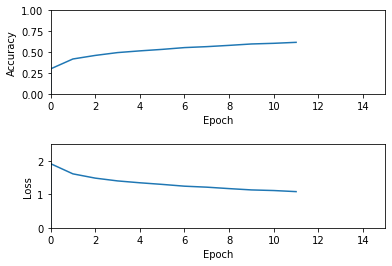

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/12a0model.ckpt Model Saved...
Epoch [300000], loss: 0.5661, acc: 1.0000
Epoch [300001], loss: 0.9965, acc: 0.0000
Epoch [300002], loss: 0.4333, acc: 1.0000
Epoch [300003], loss: 0.3871, acc: 1.0000
Epoch [300004], loss: 0.3179, acc: 1.0000
Epoch [300005], loss: 0.1137, acc: 1.0000
Epoch [300006], loss: 0.6826, acc: 1.0000
Epoch [300007], loss: 1.0923, acc: 1.0000
Epoch [300008], loss: 3.0768, acc: 0.0000
Epoch [300009], loss: 0.2602, acc: 1.0000
Epoch [300010], loss: 0.3815, acc: 1.0000
Epoch [300011], loss: 0.4559, acc: 1.0000
Epoch [300012], loss: 2.6786, acc: 0.0000
Epoch [300013], loss: 0.4286, acc: 1.0000
Epoch [300014], loss: 2.0001, acc: 0.0000
Epoch [300015], loss: 0.8765, acc: 1.0000
Epoch [300016], loss: 0.6858, acc: 1.0000
Epoch [300017], loss: 0.3479, acc: 1.0000
Epoch [300018], loss: 1.8878, acc: 0.0000
Epoch [300019], loss: 1.3696, acc: 0.0000
Epoch [300020], loss: 1.7404, acc: 0.0000
Epoch [300021]

Epoch [300198], loss: 0.0050, acc: 1.0000
Epoch [300199], loss: 0.1681, acc: 1.0000
Epoch [300200], loss: 0.5608, acc: 1.0000
Epoch [300201], loss: 0.0292, acc: 1.0000
Epoch [300202], loss: 0.0896, acc: 1.0000
Epoch [300203], loss: 1.3452, acc: 0.0000
Epoch [300204], loss: 0.0812, acc: 1.0000
Epoch [300205], loss: 1.9371, acc: 0.0000
Epoch [300206], loss: 0.3388, acc: 1.0000
Epoch [300207], loss: 1.6790, acc: 0.0000
Epoch [300208], loss: 0.0487, acc: 1.0000
Epoch [300209], loss: 0.3810, acc: 1.0000
Epoch [300210], loss: 1.4953, acc: 0.0000
Epoch [300211], loss: 0.0816, acc: 1.0000
Epoch [300212], loss: 1.9685, acc: 0.0000
Epoch [300213], loss: 0.4252, acc: 1.0000
Epoch [300214], loss: 0.9881, acc: 0.0000
Epoch [300215], loss: 0.0562, acc: 1.0000
Epoch [300216], loss: 0.0077, acc: 1.0000
Epoch [300217], loss: 1.0352, acc: 0.0000
Epoch [300218], loss: 0.2649, acc: 1.0000
Epoch [300219], loss: 0.4632, acc: 1.0000
Epoch [300220], loss: 0.0463, acc: 1.0000
Epoch [300221], loss: 0.2911, acc:

Epoch [300399], loss: 1.8883, acc: 0.0000
Epoch [300400], loss: 0.4478, acc: 1.0000
Epoch [300401], loss: 0.8093, acc: 1.0000
Epoch [300402], loss: 0.0043, acc: 1.0000
Epoch [300403], loss: 0.1722, acc: 1.0000
Epoch [300404], loss: 1.2905, acc: 0.0000
Epoch [300405], loss: 0.4217, acc: 1.0000
Epoch [300406], loss: 0.9955, acc: 1.0000
Epoch [300407], loss: 0.7347, acc: 1.0000
Epoch [300408], loss: 1.2018, acc: 0.0000
Epoch [300409], loss: 0.0911, acc: 1.0000
Epoch [300410], loss: 0.0263, acc: 1.0000
Epoch [300411], loss: 1.8737, acc: 0.0000
Epoch [300412], loss: 0.0574, acc: 1.0000
Epoch [300413], loss: 0.0622, acc: 1.0000
Epoch [300414], loss: 0.4724, acc: 1.0000
Epoch [300415], loss: 0.1543, acc: 1.0000
Epoch [300416], loss: 2.0431, acc: 0.0000
Epoch [300417], loss: 0.1076, acc: 1.0000
Epoch [300418], loss: 0.3985, acc: 1.0000
Epoch [300419], loss: 1.6421, acc: 0.0000
Epoch [300420], loss: 1.0865, acc: 0.0000
Epoch [300421], loss: 0.3779, acc: 1.0000
Epoch [300422], loss: 1.7540, acc:

Epoch [300600], loss: 1.0939, acc: 1.0000
Epoch [300601], loss: 0.2034, acc: 1.0000
Epoch [300602], loss: 1.1607, acc: 0.0000
Epoch [300603], loss: 0.0031, acc: 1.0000
Epoch [300604], loss: 0.6897, acc: 1.0000
Epoch [300605], loss: 1.6713, acc: 0.0000
Epoch [300606], loss: 0.4402, acc: 1.0000
Epoch [300607], loss: 2.9481, acc: 0.0000
Epoch [300608], loss: 0.4317, acc: 1.0000
Epoch [300609], loss: 0.8649, acc: 1.0000
Epoch [300610], loss: 0.3917, acc: 1.0000
Epoch [300611], loss: 2.6112, acc: 0.0000
Epoch [300612], loss: 0.8383, acc: 1.0000
Epoch [300613], loss: 0.9873, acc: 1.0000
Epoch [300614], loss: 0.4311, acc: 1.0000
Epoch [300615], loss: 2.5722, acc: 0.0000
Epoch [300616], loss: 0.9273, acc: 1.0000
Epoch [300617], loss: 5.5800, acc: 0.0000
Epoch [300618], loss: 1.6377, acc: 0.0000
Epoch [300619], loss: 2.8852, acc: 0.0000
Epoch [300620], loss: 1.3877, acc: 0.0000
Epoch [300621], loss: 0.4825, acc: 1.0000
Epoch [300622], loss: 2.3150, acc: 0.0000
Epoch [300623], loss: 0.5528, acc:

Epoch [300796], loss: 0.4028, acc: 1.0000
Epoch [300797], loss: 0.6264, acc: 1.0000
Epoch [300798], loss: 0.0384, acc: 1.0000
Epoch [300799], loss: 1.7592, acc: 0.0000
Epoch [300800], loss: 0.0870, acc: 1.0000
Epoch [300801], loss: 0.0281, acc: 1.0000
Epoch [300802], loss: 1.2359, acc: 0.0000
Epoch [300803], loss: 2.4536, acc: 0.0000
Epoch [300804], loss: 1.0241, acc: 0.0000
Epoch [300805], loss: 0.0739, acc: 1.0000
Epoch [300806], loss: 0.4090, acc: 1.0000
Epoch [300807], loss: 1.1625, acc: 0.0000
Epoch [300808], loss: 0.1554, acc: 1.0000
Epoch [300809], loss: 0.0334, acc: 1.0000
Epoch [300810], loss: 1.4988, acc: 1.0000
Epoch [300811], loss: 1.6603, acc: 0.0000
Epoch [300812], loss: 0.0863, acc: 1.0000
Epoch [300813], loss: 0.7757, acc: 1.0000
Epoch [300814], loss: 0.2421, acc: 1.0000
Epoch [300815], loss: 0.0754, acc: 1.0000
Epoch [300816], loss: 0.4402, acc: 1.0000
Epoch [300817], loss: 0.8019, acc: 1.0000
Epoch [300818], loss: 2.1857, acc: 0.0000
Epoch [300819], loss: 1.3363, acc:

Epoch [300996], loss: 1.4182, acc: 0.0000
Epoch [300997], loss: 0.0595, acc: 1.0000
Epoch [300998], loss: 3.0996, acc: 0.0000
Epoch [300999], loss: 2.5452, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/12a1000model.ckpt Model Saved...
Epoch [301000], loss: 2.5118, acc: 0.0000
Epoch [301001], loss: 1.1120, acc: 1.0000
Epoch [301002], loss: 0.0405, acc: 1.0000
Epoch [301003], loss: 0.8716, acc: 1.0000
Epoch [301004], loss: 2.8725, acc: 0.0000
Epoch [301005], loss: 0.0016, acc: 1.0000
Epoch [301006], loss: 0.6116, acc: 1.0000
Epoch [301007], loss: 0.4712, acc: 1.0000
Epoch [301008], loss: 0.3845, acc: 1.0000
Epoch [301009], loss: 1.8736, acc: 0.0000
Epoch [301010], loss: 1.3449, acc: 0.0000
Epoch [301011], loss: 0.1774, acc: 1.0000
Epoch [301012], loss: 0.9869, acc: 0.0000
Epoch [301013], loss: 0.8255, acc: 1.0000
Epoch [301014], loss: 4.3037, acc: 0.0000
Epoch [301015], loss: 4.4033, acc: 0.0000
Epoch [301016], loss: 1.1189, acc: 1.0000
Epoch [3010

Epoch [301200], loss: 0.0345, acc: 1.0000
Epoch [301201], loss: 1.3699, acc: 0.0000
Epoch [301202], loss: 3.5377, acc: 0.0000
Epoch [301203], loss: 0.0643, acc: 1.0000
Epoch [301204], loss: 2.5032, acc: 0.0000
Epoch [301205], loss: 2.6922, acc: 0.0000
Epoch [301206], loss: 1.0610, acc: 1.0000
Epoch [301207], loss: 0.4783, acc: 1.0000
Epoch [301208], loss: 0.6368, acc: 1.0000
Epoch [301209], loss: 0.0494, acc: 1.0000
Epoch [301210], loss: 1.8555, acc: 0.0000
Epoch [301211], loss: 1.8160, acc: 0.0000
Epoch [301212], loss: 1.3349, acc: 1.0000
Epoch [301213], loss: 3.7062, acc: 0.0000
Epoch [301214], loss: 1.1643, acc: 0.0000
Epoch [301215], loss: 0.4685, acc: 1.0000
Epoch [301216], loss: 0.2277, acc: 1.0000
Epoch [301217], loss: 0.0521, acc: 1.0000
Epoch [301218], loss: 5.3002, acc: 0.0000
Epoch [301219], loss: 1.6187, acc: 0.0000
Epoch [301220], loss: 2.2712, acc: 0.0000
Epoch [301221], loss: 0.0462, acc: 1.0000
Epoch [301222], loss: 1.5982, acc: 0.0000
Epoch [301223], loss: 2.9159, acc:

Epoch [301396], loss: 0.2306, acc: 1.0000
Epoch [301397], loss: 0.0327, acc: 1.0000
Epoch [301398], loss: 1.5040, acc: 0.0000
Epoch [301399], loss: 0.5540, acc: 1.0000
Epoch [301400], loss: 0.4702, acc: 1.0000
Epoch [301401], loss: 0.5882, acc: 1.0000
Epoch [301402], loss: 3.3134, acc: 0.0000
Epoch [301403], loss: 1.4240, acc: 0.0000
Epoch [301404], loss: 0.0107, acc: 1.0000
Epoch [301405], loss: 0.1350, acc: 1.0000
Epoch [301406], loss: 1.0452, acc: 1.0000
Epoch [301407], loss: 0.0985, acc: 1.0000
Epoch [301408], loss: 0.0561, acc: 1.0000
Epoch [301409], loss: 1.2055, acc: 1.0000
Epoch [301410], loss: 0.0770, acc: 1.0000
Epoch [301411], loss: 1.6379, acc: 0.0000
Epoch [301412], loss: 1.4775, acc: 0.0000
Epoch [301413], loss: 0.6884, acc: 1.0000
Epoch [301414], loss: 0.4632, acc: 1.0000
Epoch [301415], loss: 0.7058, acc: 1.0000
Epoch [301416], loss: 0.1505, acc: 1.0000
Epoch [301417], loss: 1.0782, acc: 1.0000
Epoch [301418], loss: 0.3316, acc: 1.0000
Epoch [301419], loss: 2.0760, acc:

Epoch [301602], loss: 0.4794, acc: 1.0000
Epoch [301603], loss: 0.4845, acc: 1.0000
Epoch [301604], loss: 1.2319, acc: 0.0000
Epoch [301605], loss: 0.9478, acc: 0.0000
Epoch [301606], loss: 0.0147, acc: 1.0000
Epoch [301607], loss: 0.4287, acc: 1.0000
Epoch [301608], loss: 1.4815, acc: 0.0000
Epoch [301609], loss: 0.0257, acc: 1.0000
Epoch [301610], loss: 0.3401, acc: 1.0000
Epoch [301611], loss: 1.1246, acc: 1.0000
Epoch [301612], loss: 0.3859, acc: 1.0000
Epoch [301613], loss: 4.4168, acc: 0.0000
Epoch [301614], loss: 0.2486, acc: 1.0000
Epoch [301615], loss: 2.2911, acc: 0.0000
Epoch [301616], loss: 0.9979, acc: 1.0000
Epoch [301617], loss: 1.2125, acc: 0.0000
Epoch [301618], loss: 2.1494, acc: 0.0000
Epoch [301619], loss: 0.9042, acc: 1.0000
Epoch [301620], loss: 3.4390, acc: 0.0000
Epoch [301621], loss: 0.6385, acc: 1.0000
Epoch [301622], loss: 0.4755, acc: 1.0000
Epoch [301623], loss: 1.5307, acc: 0.0000
Epoch [301624], loss: 0.0892, acc: 1.0000
Epoch [301625], loss: 2.1253, acc:

Epoch [301806], loss: 1.7691, acc: 0.0000
Epoch [301807], loss: 1.3343, acc: 1.0000
Epoch [301808], loss: 0.8170, acc: 1.0000
Epoch [301809], loss: 1.2552, acc: 1.0000
Epoch [301810], loss: 0.0577, acc: 1.0000
Epoch [301811], loss: 0.2213, acc: 1.0000
Epoch [301812], loss: 0.9131, acc: 1.0000
Epoch [301813], loss: 0.2872, acc: 1.0000
Epoch [301814], loss: 0.4009, acc: 1.0000
Epoch [301815], loss: 2.6516, acc: 0.0000
Epoch [301816], loss: 3.9076, acc: 0.0000
Epoch [301817], loss: 1.4303, acc: 0.0000
Epoch [301818], loss: 1.9275, acc: 0.0000
Epoch [301819], loss: 0.0568, acc: 1.0000
Epoch [301820], loss: 0.1364, acc: 1.0000
Epoch [301821], loss: 0.7283, acc: 1.0000
Epoch [301822], loss: 0.0294, acc: 1.0000
Epoch [301823], loss: 0.3576, acc: 1.0000
Epoch [301824], loss: 0.1606, acc: 1.0000
Epoch [301825], loss: 0.2549, acc: 1.0000
Epoch [301826], loss: 0.2220, acc: 1.0000
Epoch [301827], loss: 1.7679, acc: 0.0000
Epoch [301828], loss: 0.0879, acc: 1.0000
Epoch [301829], loss: 6.7288, acc:

Epoch [302008], loss: 0.7735, acc: 1.0000
Epoch [302009], loss: 2.9378, acc: 0.0000
Epoch [302010], loss: 0.7386, acc: 1.0000
Epoch [302011], loss: 1.2722, acc: 0.0000
Epoch [302012], loss: 1.2137, acc: 0.0000
Epoch [302013], loss: 1.2216, acc: 0.0000
Epoch [302014], loss: 1.7088, acc: 0.0000
Epoch [302015], loss: 1.1835, acc: 0.0000
Epoch [302016], loss: 0.0824, acc: 1.0000
Epoch [302017], loss: 1.2104, acc: 1.0000
Epoch [302018], loss: 0.5615, acc: 1.0000
Epoch [302019], loss: 1.6276, acc: 0.0000
Epoch [302020], loss: 1.8738, acc: 0.0000
Epoch [302021], loss: 0.2796, acc: 1.0000
Epoch [302022], loss: 0.9366, acc: 1.0000
Epoch [302023], loss: 1.8234, acc: 0.0000
Epoch [302024], loss: 1.3921, acc: 1.0000
Epoch [302025], loss: 1.0251, acc: 1.0000
Epoch [302026], loss: 1.7852, acc: 0.0000
Epoch [302027], loss: 1.5160, acc: 0.0000
Epoch [302028], loss: 1.2706, acc: 1.0000
Epoch [302029], loss: 0.0089, acc: 1.0000
Epoch [302030], loss: 0.8406, acc: 1.0000
Epoch [302031], loss: 0.1380, acc:

Epoch [302207], loss: 0.1670, acc: 1.0000
Epoch [302208], loss: 0.8141, acc: 1.0000
Epoch [302209], loss: 3.2698, acc: 0.0000
Epoch [302210], loss: 0.6355, acc: 1.0000
Epoch [302211], loss: 2.0703, acc: 0.0000
Epoch [302212], loss: 3.2197, acc: 0.0000
Epoch [302213], loss: 0.7104, acc: 1.0000
Epoch [302214], loss: 1.7751, acc: 0.0000
Epoch [302215], loss: 3.0448, acc: 0.0000
Epoch [302216], loss: 0.2931, acc: 1.0000
Epoch [302217], loss: 1.3245, acc: 1.0000
Epoch [302218], loss: 0.1123, acc: 1.0000
Epoch [302219], loss: 0.2824, acc: 1.0000
Epoch [302220], loss: 0.2490, acc: 1.0000
Epoch [302221], loss: 0.1678, acc: 1.0000
Epoch [302222], loss: 1.2143, acc: 0.0000
Epoch [302223], loss: 0.0686, acc: 1.0000
Epoch [302224], loss: 1.0045, acc: 1.0000
Epoch [302225], loss: 0.7568, acc: 1.0000
Epoch [302226], loss: 0.0292, acc: 1.0000
Epoch [302227], loss: 0.9890, acc: 1.0000
Epoch [302228], loss: 0.8772, acc: 1.0000
Epoch [302229], loss: 0.7736, acc: 1.0000
Epoch [302230], loss: 0.0427, acc:

Epoch [302416], loss: 0.2696, acc: 1.0000
Epoch [302417], loss: 0.2575, acc: 1.0000
Epoch [302418], loss: 1.2163, acc: 0.0000
Epoch [302419], loss: 0.1142, acc: 1.0000
Epoch [302420], loss: 1.0834, acc: 0.0000
Epoch [302421], loss: 0.1018, acc: 1.0000
Epoch [302422], loss: 0.1229, acc: 1.0000
Epoch [302423], loss: 0.4347, acc: 1.0000
Epoch [302424], loss: 5.8624, acc: 0.0000
Epoch [302425], loss: 0.2208, acc: 1.0000
Epoch [302426], loss: 0.4611, acc: 1.0000
Epoch [302427], loss: 2.6784, acc: 0.0000
Epoch [302428], loss: 2.3090, acc: 0.0000
Epoch [302429], loss: 2.3684, acc: 0.0000
Epoch [302430], loss: 2.0145, acc: 0.0000
Epoch [302431], loss: 1.1673, acc: 0.0000
Epoch [302432], loss: 0.6972, acc: 1.0000
Epoch [302433], loss: 1.3384, acc: 1.0000
Epoch [302434], loss: 2.5804, acc: 0.0000
Epoch [302435], loss: 0.0588, acc: 1.0000
Epoch [302436], loss: 3.3951, acc: 0.0000
Epoch [302437], loss: 0.0538, acc: 1.0000
Epoch [302438], loss: 0.1607, acc: 1.0000
Epoch [302439], loss: 0.6446, acc:

Epoch [302621], loss: 1.4003, acc: 1.0000
Epoch [302622], loss: 1.5180, acc: 0.0000
Epoch [302623], loss: 1.3143, acc: 1.0000
Epoch [302624], loss: 3.4647, acc: 0.0000
Epoch [302625], loss: 0.2432, acc: 1.0000
Epoch [302626], loss: 1.3266, acc: 0.0000
Epoch [302627], loss: 0.5939, acc: 1.0000
Epoch [302628], loss: 0.1611, acc: 1.0000
Epoch [302629], loss: 0.7924, acc: 1.0000
Epoch [302630], loss: 0.8674, acc: 1.0000
Epoch [302631], loss: 0.6742, acc: 1.0000
Epoch [302632], loss: 0.8480, acc: 1.0000
Epoch [302633], loss: 2.6276, acc: 0.0000
Epoch [302634], loss: 0.2153, acc: 1.0000
Epoch [302635], loss: 1.2162, acc: 1.0000
Epoch [302636], loss: 0.8219, acc: 1.0000
Epoch [302637], loss: 1.3404, acc: 0.0000
Epoch [302638], loss: 1.0572, acc: 0.0000
Epoch [302639], loss: 1.7633, acc: 0.0000
Epoch [302640], loss: 1.3996, acc: 0.0000
Epoch [302641], loss: 0.6955, acc: 1.0000
Epoch [302642], loss: 0.1235, acc: 1.0000
Epoch [302643], loss: 0.2447, acc: 1.0000
Epoch [302644], loss: 1.5100, acc:

Epoch [302833], loss: 0.0475, acc: 1.0000
Epoch [302834], loss: 1.2069, acc: 0.0000
Epoch [302835], loss: 1.0170, acc: 1.0000
Epoch [302836], loss: 0.4881, acc: 1.0000
Epoch [302837], loss: 0.1127, acc: 1.0000
Epoch [302838], loss: 0.1254, acc: 1.0000
Epoch [302839], loss: 0.2247, acc: 1.0000
Epoch [302840], loss: 0.4999, acc: 1.0000
Epoch [302841], loss: 0.0099, acc: 1.0000
Epoch [302842], loss: 1.1083, acc: 0.0000
Epoch [302843], loss: 2.3154, acc: 0.0000
Epoch [302844], loss: 0.3697, acc: 1.0000
Epoch [302845], loss: 5.1132, acc: 0.0000
Epoch [302846], loss: 0.4701, acc: 1.0000
Epoch [302847], loss: 0.0205, acc: 1.0000
Epoch [302848], loss: 0.1972, acc: 1.0000
Epoch [302849], loss: 3.2321, acc: 0.0000
Epoch [302850], loss: 1.4355, acc: 1.0000
Epoch [302851], loss: 0.9864, acc: 1.0000
Epoch [302852], loss: 0.6364, acc: 1.0000
Epoch [302853], loss: 0.2676, acc: 1.0000
Epoch [302854], loss: 1.8376, acc: 0.0000
Epoch [302855], loss: 1.2332, acc: 1.0000
Epoch [302856], loss: 0.0460, acc:

Epoch [303035], loss: 1.5944, acc: 0.0000
Epoch [303036], loss: 1.4538, acc: 0.0000
Epoch [303037], loss: 0.0390, acc: 1.0000
Epoch [303038], loss: 3.0720, acc: 0.0000
Epoch [303039], loss: 1.3799, acc: 0.0000
Epoch [303040], loss: 0.4348, acc: 1.0000
Epoch [303041], loss: 0.6350, acc: 1.0000
Epoch [303042], loss: 1.3706, acc: 0.0000
Epoch [303043], loss: 1.8362, acc: 0.0000
Epoch [303044], loss: 0.3345, acc: 1.0000
Epoch [303045], loss: 0.5594, acc: 1.0000
Epoch [303046], loss: 0.0218, acc: 1.0000
Epoch [303047], loss: 0.1448, acc: 1.0000
Epoch [303048], loss: 0.0290, acc: 1.0000
Epoch [303049], loss: 0.0825, acc: 1.0000
Epoch [303050], loss: 1.6353, acc: 0.0000
Epoch [303051], loss: 0.2631, acc: 1.0000
Epoch [303052], loss: 1.9084, acc: 0.0000
Epoch [303053], loss: 0.4700, acc: 1.0000
Epoch [303054], loss: 1.3132, acc: 1.0000
Epoch [303055], loss: 0.3824, acc: 1.0000
Epoch [303056], loss: 1.1796, acc: 0.0000
Epoch [303057], loss: 1.5490, acc: 0.0000
Epoch [303058], loss: 0.1467, acc:

Epoch [303236], loss: 0.6194, acc: 1.0000
Epoch [303237], loss: 2.3722, acc: 0.0000
Epoch [303238], loss: 2.0187, acc: 0.0000
Epoch [303239], loss: 4.3550, acc: 0.0000
Epoch [303240], loss: 2.8593, acc: 0.0000
Epoch [303241], loss: 2.7654, acc: 0.0000
Epoch [303242], loss: 0.2676, acc: 1.0000
Epoch [303243], loss: 0.1685, acc: 1.0000
Epoch [303244], loss: 0.5926, acc: 1.0000
Epoch [303245], loss: 3.2655, acc: 0.0000
Epoch [303246], loss: 0.5157, acc: 1.0000
Epoch [303247], loss: 0.3295, acc: 1.0000
Epoch [303248], loss: 1.0523, acc: 0.0000
Epoch [303249], loss: 1.3523, acc: 0.0000
Epoch [303250], loss: 0.8511, acc: 0.0000
Epoch [303251], loss: 3.3750, acc: 0.0000
Epoch [303252], loss: 2.7713, acc: 0.0000
Epoch [303253], loss: 1.9573, acc: 0.0000
Epoch [303254], loss: 0.6767, acc: 1.0000
Epoch [303255], loss: 0.0084, acc: 1.0000
Epoch [303256], loss: 2.5919, acc: 0.0000
Epoch [303257], loss: 3.4608, acc: 0.0000
Epoch [303258], loss: 0.6671, acc: 1.0000
Epoch [303259], loss: 2.3018, acc:

Epoch [303437], loss: 1.2408, acc: 0.0000
Epoch [303438], loss: 3.7968, acc: 0.0000
Epoch [303439], loss: 0.6742, acc: 1.0000
Epoch [303440], loss: 2.6678, acc: 0.0000
Epoch [303441], loss: 0.4695, acc: 1.0000
Epoch [303442], loss: 0.0194, acc: 1.0000
Epoch [303443], loss: 0.1205, acc: 1.0000
Epoch [303444], loss: 0.2271, acc: 1.0000
Epoch [303445], loss: 0.6540, acc: 1.0000
Epoch [303446], loss: 0.3124, acc: 1.0000
Epoch [303447], loss: 0.0067, acc: 1.0000
Epoch [303448], loss: 3.1045, acc: 0.0000
Epoch [303449], loss: 0.1067, acc: 1.0000
Epoch [303450], loss: 0.1070, acc: 1.0000
Epoch [303451], loss: 0.4823, acc: 1.0000
Epoch [303452], loss: 1.0097, acc: 1.0000
Epoch [303453], loss: 0.2487, acc: 1.0000
Epoch [303454], loss: 1.2588, acc: 0.0000
Epoch [303455], loss: 0.4364, acc: 1.0000
Epoch [303456], loss: 2.0448, acc: 0.0000
Epoch [303457], loss: 1.7591, acc: 0.0000
Epoch [303458], loss: 0.1682, acc: 1.0000
Epoch [303459], loss: 0.4930, acc: 1.0000
Epoch [303460], loss: 1.8774, acc:

Epoch [303634], loss: 0.8246, acc: 1.0000
Epoch [303635], loss: 1.2941, acc: 0.0000
Epoch [303636], loss: 1.0089, acc: 0.0000
Epoch [303637], loss: 3.9322, acc: 0.0000
Epoch [303638], loss: 1.9047, acc: 0.0000
Epoch [303639], loss: 1.1399, acc: 1.0000
Epoch [303640], loss: 0.7386, acc: 1.0000
Epoch [303641], loss: 0.6266, acc: 1.0000
Epoch [303642], loss: 1.1960, acc: 0.0000
Epoch [303643], loss: 1.2070, acc: 1.0000
Epoch [303644], loss: 1.0507, acc: 1.0000
Epoch [303645], loss: 0.2722, acc: 1.0000
Epoch [303646], loss: 1.8139, acc: 0.0000
Epoch [303647], loss: 1.3350, acc: 0.0000
Epoch [303648], loss: 0.4581, acc: 1.0000
Epoch [303649], loss: 1.3083, acc: 1.0000
Epoch [303650], loss: 0.4017, acc: 1.0000
Epoch [303651], loss: 0.0122, acc: 1.0000
Epoch [303652], loss: 0.9470, acc: 1.0000
Epoch [303653], loss: 0.5677, acc: 1.0000
Epoch [303654], loss: 1.2507, acc: 0.0000
Epoch [303655], loss: 0.8221, acc: 1.0000
Epoch [303656], loss: 0.4210, acc: 1.0000
Epoch [303657], loss: 0.4080, acc:

Epoch [303835], loss: 0.3252, acc: 1.0000
Epoch [303836], loss: 0.0046, acc: 1.0000
Epoch [303837], loss: 1.1409, acc: 0.0000
Epoch [303838], loss: 2.6185, acc: 0.0000
Epoch [303839], loss: 3.2995, acc: 0.0000
Epoch [303840], loss: 3.7846, acc: 0.0000
Epoch [303841], loss: 3.0172, acc: 0.0000
Epoch [303842], loss: 0.6228, acc: 1.0000
Epoch [303843], loss: 2.8250, acc: 0.0000
Epoch [303844], loss: 0.7852, acc: 1.0000
Epoch [303845], loss: 0.3910, acc: 1.0000
Epoch [303846], loss: 0.2914, acc: 1.0000
Epoch [303847], loss: 0.0046, acc: 1.0000
Epoch [303848], loss: 0.8042, acc: 1.0000
Epoch [303849], loss: 0.3878, acc: 1.0000
Epoch [303850], loss: 0.0217, acc: 1.0000
Epoch [303851], loss: 0.7068, acc: 1.0000
Epoch [303852], loss: 0.3340, acc: 1.0000
Epoch [303853], loss: 0.6828, acc: 1.0000
Epoch [303854], loss: 0.4319, acc: 1.0000
Epoch [303855], loss: 1.6071, acc: 0.0000
Epoch [303856], loss: 2.0457, acc: 0.0000
Epoch [303857], loss: 2.2372, acc: 0.0000
Epoch [303858], loss: 1.9498, acc:

Epoch [304030], loss: 1.3562, acc: 0.0000
Epoch [304031], loss: 0.3128, acc: 1.0000
Epoch [304032], loss: 0.3059, acc: 1.0000
Epoch [304033], loss: 0.3368, acc: 1.0000
Epoch [304034], loss: 0.4791, acc: 1.0000
Epoch [304035], loss: 0.2428, acc: 1.0000
Epoch [304036], loss: 0.8761, acc: 0.0000
Epoch [304037], loss: 0.2707, acc: 1.0000
Epoch [304038], loss: 0.7856, acc: 1.0000
Epoch [304039], loss: 2.1150, acc: 0.0000
Epoch [304040], loss: 0.2062, acc: 1.0000
Epoch [304041], loss: 0.1998, acc: 1.0000
Epoch [304042], loss: 4.0376, acc: 0.0000
Epoch [304043], loss: 1.4152, acc: 0.0000
Epoch [304044], loss: 0.1988, acc: 1.0000
Epoch [304045], loss: 0.4287, acc: 1.0000
Epoch [304046], loss: 0.0439, acc: 1.0000
Epoch [304047], loss: 0.2758, acc: 1.0000
Epoch [304048], loss: 1.5487, acc: 0.0000
Epoch [304049], loss: 0.9972, acc: 1.0000
Epoch [304050], loss: 0.2203, acc: 1.0000
Epoch [304051], loss: 0.0361, acc: 1.0000
Epoch [304052], loss: 0.3694, acc: 1.0000
Epoch [304053], loss: 2.3325, acc:

Epoch [304229], loss: 3.9532, acc: 0.0000
Epoch [304230], loss: 0.2476, acc: 1.0000
Epoch [304231], loss: 1.4528, acc: 0.0000
Epoch [304232], loss: 4.4713, acc: 0.0000
Epoch [304233], loss: 0.5470, acc: 1.0000
Epoch [304234], loss: 0.5182, acc: 1.0000
Epoch [304235], loss: 3.2049, acc: 0.0000
Epoch [304236], loss: 0.5495, acc: 1.0000
Epoch [304237], loss: 0.7566, acc: 1.0000
Epoch [304238], loss: 0.5769, acc: 1.0000
Epoch [304239], loss: 0.5942, acc: 1.0000
Epoch [304240], loss: 3.2976, acc: 0.0000
Epoch [304241], loss: 1.1943, acc: 0.0000
Epoch [304242], loss: 3.7602, acc: 0.0000
Epoch [304243], loss: 1.6699, acc: 0.0000
Epoch [304244], loss: 0.4034, acc: 1.0000
Epoch [304245], loss: 0.4098, acc: 1.0000
Epoch [304246], loss: 1.0670, acc: 1.0000
Epoch [304247], loss: 1.5823, acc: 0.0000
Epoch [304248], loss: 1.3083, acc: 0.0000
Epoch [304249], loss: 1.8447, acc: 0.0000
Epoch [304250], loss: 0.9695, acc: 1.0000
Epoch [304251], loss: 3.0146, acc: 0.0000
Epoch [304252], loss: 2.3856, acc:

Epoch [304440], loss: 0.4177, acc: 1.0000
Epoch [304441], loss: 1.0878, acc: 1.0000
Epoch [304442], loss: 2.1452, acc: 0.0000
Epoch [304443], loss: 0.5236, acc: 1.0000
Epoch [304444], loss: 1.0658, acc: 0.0000
Epoch [304445], loss: 0.0415, acc: 1.0000
Epoch [304446], loss: 2.6877, acc: 0.0000
Epoch [304447], loss: 0.0794, acc: 1.0000
Epoch [304448], loss: 1.1402, acc: 0.0000
Epoch [304449], loss: 1.9657, acc: 0.0000
Epoch [304450], loss: 0.2064, acc: 1.0000
Epoch [304451], loss: 4.4125, acc: 0.0000
Epoch [304452], loss: 0.2072, acc: 1.0000
Epoch [304453], loss: 3.8918, acc: 0.0000
Epoch [304454], loss: 0.9065, acc: 0.0000
Epoch [304455], loss: 0.0791, acc: 1.0000
Epoch [304456], loss: 0.0496, acc: 1.0000
Epoch [304457], loss: 0.9194, acc: 0.0000
Epoch [304458], loss: 2.3103, acc: 0.0000
Epoch [304459], loss: 2.2682, acc: 0.0000
Epoch [304460], loss: 0.7757, acc: 1.0000
Epoch [304461], loss: 0.1146, acc: 1.0000
Epoch [304462], loss: 0.8301, acc: 1.0000
Epoch [304463], loss: 1.8960, acc:

Epoch [304637], loss: 0.2858, acc: 1.0000
Epoch [304638], loss: 0.3350, acc: 1.0000
Epoch [304639], loss: 0.2917, acc: 1.0000
Epoch [304640], loss: 0.2077, acc: 1.0000
Epoch [304641], loss: 0.5170, acc: 1.0000
Epoch [304642], loss: 2.1429, acc: 0.0000
Epoch [304643], loss: 0.0952, acc: 1.0000
Epoch [304644], loss: 1.1152, acc: 1.0000
Epoch [304645], loss: 1.2845, acc: 0.0000
Epoch [304646], loss: 0.9224, acc: 1.0000
Epoch [304647], loss: 0.6325, acc: 1.0000
Epoch [304648], loss: 0.0610, acc: 1.0000
Epoch [304649], loss: 0.0268, acc: 1.0000
Epoch [304650], loss: 2.6704, acc: 0.0000
Epoch [304651], loss: 0.6434, acc: 1.0000
Epoch [304652], loss: 1.8426, acc: 0.0000
Epoch [304653], loss: 1.1500, acc: 0.0000
Epoch [304654], loss: 0.6006, acc: 1.0000
Epoch [304655], loss: 1.4582, acc: 1.0000
Epoch [304656], loss: 0.0760, acc: 1.0000
Epoch [304657], loss: 0.9113, acc: 1.0000
Epoch [304658], loss: 1.4418, acc: 0.0000
Epoch [304659], loss: 0.2868, acc: 1.0000
Epoch [304660], loss: 0.7170, acc:

Epoch [304839], loss: 0.5417, acc: 1.0000
Epoch [304840], loss: 1.1711, acc: 1.0000
Epoch [304841], loss: 1.1013, acc: 1.0000
Epoch [304842], loss: 1.4401, acc: 0.0000
Epoch [304843], loss: 2.9265, acc: 0.0000
Epoch [304844], loss: 3.8600, acc: 0.0000
Epoch [304845], loss: 3.6644, acc: 0.0000
Epoch [304846], loss: 0.0203, acc: 1.0000
Epoch [304847], loss: 1.0190, acc: 0.0000
Epoch [304848], loss: 1.0131, acc: 0.0000
Epoch [304849], loss: 0.4431, acc: 1.0000
Epoch [304850], loss: 1.5619, acc: 0.0000
Epoch [304851], loss: 1.5190, acc: 0.0000
Epoch [304852], loss: 1.5859, acc: 1.0000
Epoch [304853], loss: 3.9826, acc: 0.0000
Epoch [304854], loss: 1.4943, acc: 0.0000
Epoch [304855], loss: 1.6403, acc: 0.0000
Epoch [304856], loss: 0.2655, acc: 1.0000
Epoch [304857], loss: 0.2526, acc: 1.0000
Epoch [304858], loss: 0.3329, acc: 1.0000
Epoch [304859], loss: 0.2260, acc: 1.0000
Epoch [304860], loss: 0.6876, acc: 1.0000
Epoch [304861], loss: 0.3617, acc: 1.0000
Epoch [304862], loss: 2.4596, acc:

Epoch [305038], loss: 0.6606, acc: 1.0000
Epoch [305039], loss: 0.7376, acc: 1.0000
Epoch [305040], loss: 0.0399, acc: 1.0000
Epoch [305041], loss: 0.6369, acc: 1.0000
Epoch [305042], loss: 2.8651, acc: 0.0000
Epoch [305043], loss: 1.5079, acc: 0.0000
Epoch [305044], loss: 1.6099, acc: 0.0000
Epoch [305045], loss: 0.2906, acc: 1.0000
Epoch [305046], loss: 0.0210, acc: 1.0000
Epoch [305047], loss: 1.1333, acc: 1.0000
Epoch [305048], loss: 0.8652, acc: 0.0000
Epoch [305049], loss: 1.8941, acc: 0.0000
Epoch [305050], loss: 0.5627, acc: 1.0000
Epoch [305051], loss: 0.4013, acc: 1.0000
Epoch [305052], loss: 0.3465, acc: 1.0000
Epoch [305053], loss: 0.2630, acc: 1.0000
Epoch [305054], loss: 1.0270, acc: 1.0000
Epoch [305055], loss: 1.5494, acc: 0.0000
Epoch [305056], loss: 1.5276, acc: 0.0000
Epoch [305057], loss: 0.6404, acc: 1.0000
Epoch [305058], loss: 0.3516, acc: 1.0000
Epoch [305059], loss: 2.1180, acc: 0.0000
Epoch [305060], loss: 0.5093, acc: 1.0000
Epoch [305061], loss: 0.5671, acc:

Epoch [305241], loss: 0.0070, acc: 1.0000
Epoch [305242], loss: 1.5889, acc: 0.0000
Epoch [305243], loss: 1.3211, acc: 0.0000
Epoch [305244], loss: 0.9663, acc: 1.0000
Epoch [305245], loss: 3.7122, acc: 0.0000
Epoch [305246], loss: 2.8206, acc: 0.0000
Epoch [305247], loss: 0.2597, acc: 1.0000
Epoch [305248], loss: 0.6008, acc: 1.0000
Epoch [305249], loss: 2.0563, acc: 0.0000
Epoch [305250], loss: 0.0839, acc: 1.0000
Epoch [305251], loss: 0.1421, acc: 1.0000
Epoch [305252], loss: 1.0826, acc: 0.0000
Epoch [305253], loss: 0.1448, acc: 1.0000
Epoch [305254], loss: 0.3279, acc: 1.0000
Epoch [305255], loss: 0.7516, acc: 1.0000
Epoch [305256], loss: 2.7727, acc: 0.0000
Epoch [305257], loss: 2.2450, acc: 0.0000
Epoch [305258], loss: 0.9641, acc: 1.0000
Epoch [305259], loss: 1.3099, acc: 1.0000
Epoch [305260], loss: 0.1523, acc: 1.0000
Epoch [305261], loss: 0.1411, acc: 1.0000
Epoch [305262], loss: 0.6231, acc: 1.0000
Epoch [305263], loss: 3.2359, acc: 0.0000
Epoch [305264], loss: 2.5345, acc:

Epoch [305452], loss: 0.3436, acc: 1.0000
Epoch [305453], loss: 2.4818, acc: 0.0000
Epoch [305454], loss: 0.3230, acc: 1.0000
Epoch [305455], loss: 3.2957, acc: 0.0000
Epoch [305456], loss: 0.0189, acc: 1.0000
Epoch [305457], loss: 1.6167, acc: 0.0000
Epoch [305458], loss: 1.9238, acc: 0.0000
Epoch [305459], loss: 1.9114, acc: 0.0000
Epoch [305460], loss: 0.0811, acc: 1.0000
Epoch [305461], loss: 0.9021, acc: 1.0000
Epoch [305462], loss: 0.0191, acc: 1.0000
Epoch [305463], loss: 0.1904, acc: 1.0000
Epoch [305464], loss: 0.0461, acc: 1.0000
Epoch [305465], loss: 0.0356, acc: 1.0000
Epoch [305466], loss: 0.6882, acc: 1.0000
Epoch [305467], loss: 3.1559, acc: 0.0000
Epoch [305468], loss: 0.1298, acc: 1.0000
Epoch [305469], loss: 0.3156, acc: 1.0000
Epoch [305470], loss: 2.2239, acc: 0.0000
Epoch [305471], loss: 0.1295, acc: 1.0000
Epoch [305472], loss: 0.1749, acc: 1.0000
Epoch [305473], loss: 0.2048, acc: 1.0000
Epoch [305474], loss: 1.7989, acc: 0.0000
Epoch [305475], loss: 0.8180, acc:

Epoch [305657], loss: 1.5044, acc: 0.0000
Epoch [305658], loss: 3.4053, acc: 0.0000
Epoch [305659], loss: 0.2922, acc: 1.0000
Epoch [305660], loss: 0.3172, acc: 1.0000
Epoch [305661], loss: 1.5140, acc: 0.0000
Epoch [305662], loss: 0.3235, acc: 1.0000
Epoch [305663], loss: 0.8446, acc: 1.0000
Epoch [305664], loss: 1.1544, acc: 0.0000
Epoch [305665], loss: 0.3793, acc: 1.0000
Epoch [305666], loss: 0.0003, acc: 1.0000
Epoch [305667], loss: 3.8321, acc: 0.0000
Epoch [305668], loss: 1.2261, acc: 0.0000
Epoch [305669], loss: 0.2393, acc: 1.0000
Epoch [305670], loss: 2.1447, acc: 0.0000
Epoch [305671], loss: 0.1681, acc: 1.0000
Epoch [305672], loss: 1.1056, acc: 0.0000
Epoch [305673], loss: 0.0287, acc: 1.0000
Epoch [305674], loss: 0.8228, acc: 1.0000
Epoch [305675], loss: 4.8918, acc: 0.0000
Epoch [305676], loss: 0.1738, acc: 1.0000
Epoch [305677], loss: 3.9108, acc: 0.0000
Epoch [305678], loss: 0.2856, acc: 1.0000
Epoch [305679], loss: 3.4613, acc: 0.0000
Epoch [305680], loss: 4.7024, acc:

Epoch [305857], loss: 2.8746, acc: 0.0000
Epoch [305858], loss: 0.1970, acc: 1.0000
Epoch [305859], loss: 1.0653, acc: 1.0000
Epoch [305860], loss: 1.9273, acc: 0.0000
Epoch [305861], loss: 2.1440, acc: 0.0000
Epoch [305862], loss: 2.9129, acc: 0.0000
Epoch [305863], loss: 1.2426, acc: 1.0000
Epoch [305864], loss: 1.8225, acc: 0.0000
Epoch [305865], loss: 0.7344, acc: 1.0000
Epoch [305866], loss: 0.3936, acc: 1.0000
Epoch [305867], loss: 1.0591, acc: 1.0000
Epoch [305868], loss: 0.0840, acc: 1.0000
Epoch [305869], loss: 0.1934, acc: 1.0000
Epoch [305870], loss: 0.1460, acc: 1.0000
Epoch [305871], loss: 1.1238, acc: 0.0000
Epoch [305872], loss: 1.5776, acc: 0.0000
Epoch [305873], loss: 1.2641, acc: 0.0000
Epoch [305874], loss: 0.1431, acc: 1.0000
Epoch [305875], loss: 0.1709, acc: 1.0000
Epoch [305876], loss: 0.6461, acc: 1.0000
Epoch [305877], loss: 1.1389, acc: 0.0000
Epoch [305878], loss: 0.2984, acc: 1.0000
Epoch [305879], loss: 0.5835, acc: 1.0000
Epoch [305880], loss: 0.9293, acc:

Epoch [306065], loss: 1.0319, acc: 0.0000
Epoch [306066], loss: 0.0134, acc: 1.0000
Epoch [306067], loss: 0.9068, acc: 1.0000
Epoch [306068], loss: 0.3771, acc: 1.0000
Epoch [306069], loss: 1.1161, acc: 1.0000
Epoch [306070], loss: 0.8829, acc: 1.0000
Epoch [306071], loss: 0.1501, acc: 1.0000
Epoch [306072], loss: 0.0452, acc: 1.0000
Epoch [306073], loss: 2.4218, acc: 0.0000
Epoch [306074], loss: 0.1885, acc: 1.0000
Epoch [306075], loss: 0.1198, acc: 1.0000
Epoch [306076], loss: 0.8627, acc: 1.0000
Epoch [306077], loss: 1.9304, acc: 0.0000
Epoch [306078], loss: 0.1577, acc: 1.0000
Epoch [306079], loss: 1.0119, acc: 0.0000
Epoch [306080], loss: 2.0507, acc: 0.0000
Epoch [306081], loss: 1.1802, acc: 0.0000
Epoch [306082], loss: 0.2021, acc: 1.0000
Epoch [306083], loss: 1.1555, acc: 0.0000
Epoch [306084], loss: 0.7775, acc: 1.0000
Epoch [306085], loss: 1.8413, acc: 0.0000
Epoch [306086], loss: 1.9320, acc: 0.0000
Epoch [306087], loss: 2.9704, acc: 0.0000
Epoch [306088], loss: 1.5193, acc:

Epoch [306266], loss: 2.2285, acc: 0.0000
Epoch [306267], loss: 1.6467, acc: 0.0000
Epoch [306268], loss: 1.0354, acc: 1.0000
Epoch [306269], loss: 0.3122, acc: 1.0000
Epoch [306270], loss: 1.3229, acc: 0.0000
Epoch [306271], loss: 0.4886, acc: 1.0000
Epoch [306272], loss: 0.5715, acc: 1.0000
Epoch [306273], loss: 1.3494, acc: 0.0000
Epoch [306274], loss: 1.5067, acc: 0.0000
Epoch [306275], loss: 1.5501, acc: 0.0000
Epoch [306276], loss: 0.1792, acc: 1.0000
Epoch [306277], loss: 1.1278, acc: 1.0000
Epoch [306278], loss: 0.0119, acc: 1.0000
Epoch [306279], loss: 0.5097, acc: 1.0000
Epoch [306280], loss: 0.4072, acc: 1.0000
Epoch [306281], loss: 0.0043, acc: 1.0000
Epoch [306282], loss: 0.0155, acc: 1.0000
Epoch [306283], loss: 0.1097, acc: 1.0000
Epoch [306284], loss: 0.0526, acc: 1.0000
Epoch [306285], loss: 1.2349, acc: 0.0000
Epoch [306286], loss: 0.0772, acc: 1.0000
Epoch [306287], loss: 1.3377, acc: 0.0000
Epoch [306288], loss: 0.2409, acc: 1.0000
Epoch [306289], loss: 1.0680, acc:

Epoch [306465], loss: 0.3520, acc: 1.0000
Epoch [306466], loss: 1.3906, acc: 0.0000
Epoch [306467], loss: 2.2613, acc: 0.0000
Epoch [306468], loss: 0.0212, acc: 1.0000
Epoch [306469], loss: 0.9222, acc: 1.0000
Epoch [306470], loss: 1.5588, acc: 0.0000
Epoch [306471], loss: 0.1419, acc: 1.0000
Epoch [306472], loss: 1.6581, acc: 0.0000
Epoch [306473], loss: 0.0462, acc: 1.0000
Epoch [306474], loss: 0.6252, acc: 1.0000
Epoch [306475], loss: 0.0667, acc: 1.0000
Epoch [306476], loss: 1.2360, acc: 1.0000
Epoch [306477], loss: 0.8624, acc: 1.0000
Epoch [306478], loss: 1.4005, acc: 0.0000
Epoch [306479], loss: 0.7869, acc: 1.0000
Epoch [306480], loss: 1.5602, acc: 0.0000
Epoch [306481], loss: 1.4370, acc: 0.0000
Epoch [306482], loss: 0.5966, acc: 1.0000
Epoch [306483], loss: 0.2674, acc: 1.0000
Epoch [306484], loss: 1.7123, acc: 0.0000
Epoch [306485], loss: 0.4609, acc: 1.0000
Epoch [306486], loss: 0.0114, acc: 1.0000
Epoch [306487], loss: 0.1494, acc: 1.0000
Epoch [306488], loss: 0.3272, acc:

Epoch [306665], loss: 0.5714, acc: 1.0000
Epoch [306666], loss: 2.3521, acc: 0.0000
Epoch [306667], loss: 0.7277, acc: 1.0000
Epoch [306668], loss: 0.0870, acc: 1.0000
Epoch [306669], loss: 3.4000, acc: 0.0000
Epoch [306670], loss: 0.0687, acc: 1.0000
Epoch [306671], loss: 1.9463, acc: 0.0000
Epoch [306672], loss: 0.0691, acc: 1.0000
Epoch [306673], loss: 0.0067, acc: 1.0000
Epoch [306674], loss: 1.1035, acc: 0.0000
Epoch [306675], loss: 0.7960, acc: 1.0000
Epoch [306676], loss: 0.0629, acc: 1.0000
Epoch [306677], loss: 1.4370, acc: 0.0000
Epoch [306678], loss: 3.3310, acc: 0.0000
Epoch [306679], loss: 0.3123, acc: 1.0000
Epoch [306680], loss: 0.7582, acc: 0.0000
Epoch [306681], loss: 2.1964, acc: 0.0000
Epoch [306682], loss: 0.3868, acc: 1.0000
Epoch [306683], loss: 1.9666, acc: 0.0000
Epoch [306684], loss: 0.0194, acc: 1.0000
Epoch [306685], loss: 2.4762, acc: 0.0000
Epoch [306686], loss: 2.2215, acc: 0.0000
Epoch [306687], loss: 0.0589, acc: 1.0000
Epoch [306688], loss: 2.2947, acc:

Epoch [306863], loss: 0.3171, acc: 1.0000
Epoch [306864], loss: 1.1046, acc: 0.0000
Epoch [306865], loss: 0.1327, acc: 1.0000
Epoch [306866], loss: 0.0649, acc: 1.0000
Epoch [306867], loss: 1.0849, acc: 0.0000
Epoch [306868], loss: 2.9827, acc: 0.0000
Epoch [306869], loss: 0.1904, acc: 1.0000
Epoch [306870], loss: 0.7914, acc: 1.0000
Epoch [306871], loss: 0.8418, acc: 1.0000
Epoch [306872], loss: 1.6151, acc: 0.0000
Epoch [306873], loss: 0.0303, acc: 1.0000
Epoch [306874], loss: 1.0741, acc: 1.0000
Epoch [306875], loss: 0.6161, acc: 1.0000
Epoch [306876], loss: 0.9218, acc: 0.0000
Epoch [306877], loss: 0.7081, acc: 1.0000
Epoch [306878], loss: 0.2136, acc: 1.0000
Epoch [306879], loss: 0.6059, acc: 1.0000
Epoch [306880], loss: 0.8981, acc: 0.0000
Epoch [306881], loss: 0.1675, acc: 1.0000
Epoch [306882], loss: 1.5321, acc: 0.0000
Epoch [306883], loss: 1.3523, acc: 0.0000
Epoch [306884], loss: 0.8004, acc: 1.0000
Epoch [306885], loss: 1.2711, acc: 1.0000
Epoch [306886], loss: 0.3475, acc:

Epoch [307059], loss: 0.0359, acc: 1.0000
Epoch [307060], loss: 0.2070, acc: 1.0000
Epoch [307061], loss: 1.3961, acc: 0.0000
Epoch [307062], loss: 0.4725, acc: 1.0000
Epoch [307063], loss: 2.1440, acc: 0.0000
Epoch [307064], loss: 0.7412, acc: 1.0000
Epoch [307065], loss: 2.6890, acc: 0.0000
Epoch [307066], loss: 2.6451, acc: 0.0000
Epoch [307067], loss: 0.1768, acc: 1.0000
Epoch [307068], loss: 1.6762, acc: 0.0000
Epoch [307069], loss: 0.6318, acc: 1.0000
Epoch [307070], loss: 1.3343, acc: 0.0000
Epoch [307071], loss: 0.0666, acc: 1.0000
Epoch [307072], loss: 2.0559, acc: 0.0000
Epoch [307073], loss: 1.5976, acc: 0.0000
Epoch [307074], loss: 2.6091, acc: 0.0000
Epoch [307075], loss: 1.8294, acc: 0.0000
Epoch [307076], loss: 1.2040, acc: 1.0000
Epoch [307077], loss: 0.6423, acc: 1.0000
Epoch [307078], loss: 4.0877, acc: 0.0000
Epoch [307079], loss: 3.0592, acc: 0.0000
Epoch [307080], loss: 0.8611, acc: 1.0000
Epoch [307081], loss: 1.6837, acc: 0.0000
Epoch [307082], loss: 0.8684, acc:

Epoch [307258], loss: 1.1012, acc: 0.0000
Epoch [307259], loss: 1.2400, acc: 0.0000
Epoch [307260], loss: 0.8005, acc: 1.0000
Epoch [307261], loss: 0.2449, acc: 1.0000
Epoch [307262], loss: 0.0104, acc: 1.0000
Epoch [307263], loss: 0.0378, acc: 1.0000
Epoch [307264], loss: 0.0582, acc: 1.0000
Epoch [307265], loss: 1.1864, acc: 0.0000
Epoch [307266], loss: 1.3346, acc: 0.0000
Epoch [307267], loss: 0.1045, acc: 1.0000
Epoch [307268], loss: 3.6950, acc: 0.0000
Epoch [307269], loss: 0.2903, acc: 1.0000
Epoch [307270], loss: 0.5149, acc: 1.0000
Epoch [307271], loss: 0.7854, acc: 1.0000
Epoch [307272], loss: 0.9281, acc: 1.0000
Epoch [307273], loss: 3.1648, acc: 0.0000
Epoch [307274], loss: 0.5444, acc: 1.0000
Epoch [307275], loss: 1.5645, acc: 0.0000
Epoch [307276], loss: 0.0590, acc: 1.0000
Epoch [307277], loss: 0.5118, acc: 1.0000
Epoch [307278], loss: 1.0277, acc: 0.0000
Epoch [307279], loss: 0.2785, acc: 1.0000
Epoch [307280], loss: 1.4436, acc: 0.0000
Epoch [307281], loss: 0.0450, acc:

Epoch [307455], loss: 0.1054, acc: 1.0000
Epoch [307456], loss: 0.4948, acc: 1.0000
Epoch [307457], loss: 1.4335, acc: 0.0000
Epoch [307458], loss: 0.1829, acc: 1.0000
Epoch [307459], loss: 0.9125, acc: 1.0000
Epoch [307460], loss: 1.2276, acc: 1.0000
Epoch [307461], loss: 1.9352, acc: 0.0000
Epoch [307462], loss: 0.0579, acc: 1.0000
Epoch [307463], loss: 2.1366, acc: 0.0000
Epoch [307464], loss: 3.7250, acc: 0.0000
Epoch [307465], loss: 0.5957, acc: 1.0000
Epoch [307466], loss: 1.0771, acc: 0.0000
Epoch [307467], loss: 0.9141, acc: 1.0000
Epoch [307468], loss: 2.8995, acc: 0.0000
Epoch [307469], loss: 1.0784, acc: 0.0000
Epoch [307470], loss: 2.6211, acc: 0.0000
Epoch [307471], loss: 0.7702, acc: 1.0000
Epoch [307472], loss: 0.0918, acc: 1.0000
Epoch [307473], loss: 0.7565, acc: 1.0000
Epoch [307474], loss: 0.3023, acc: 1.0000
Epoch [307475], loss: 0.0919, acc: 1.0000
Epoch [307476], loss: 2.8826, acc: 0.0000
Epoch [307477], loss: 0.3642, acc: 1.0000
Epoch [307478], loss: 0.0775, acc:

Epoch [307656], loss: 1.0444, acc: 0.0000
Epoch [307657], loss: 0.8089, acc: 1.0000
Epoch [307658], loss: 1.2358, acc: 0.0000
Epoch [307659], loss: 1.7444, acc: 0.0000
Epoch [307660], loss: 0.1594, acc: 1.0000
Epoch [307661], loss: 1.9903, acc: 0.0000
Epoch [307662], loss: 0.1712, acc: 1.0000
Epoch [307663], loss: 0.7538, acc: 1.0000
Epoch [307664], loss: 1.0148, acc: 0.0000
Epoch [307665], loss: 1.7111, acc: 0.0000
Epoch [307666], loss: 0.0104, acc: 1.0000
Epoch [307667], loss: 1.9076, acc: 0.0000
Epoch [307668], loss: 0.5922, acc: 1.0000
Epoch [307669], loss: 0.0142, acc: 1.0000
Epoch [307670], loss: 1.7863, acc: 0.0000
Epoch [307671], loss: 0.6955, acc: 1.0000
Epoch [307672], loss: 0.7985, acc: 1.0000
Epoch [307673], loss: 0.0776, acc: 1.0000
Epoch [307674], loss: 1.4827, acc: 0.0000
Epoch [307675], loss: 0.3385, acc: 1.0000
Epoch [307676], loss: 1.2789, acc: 0.0000
Epoch [307677], loss: 1.2258, acc: 0.0000
Epoch [307678], loss: 3.5001, acc: 0.0000
Epoch [307679], loss: 2.1084, acc:

Epoch [307868], loss: 3.4970, acc: 0.0000
Epoch [307869], loss: 0.3192, acc: 1.0000
Epoch [307870], loss: 0.0173, acc: 1.0000
Epoch [307871], loss: 1.1559, acc: 0.0000
Epoch [307872], loss: 0.0183, acc: 1.0000
Epoch [307873], loss: 0.1687, acc: 1.0000
Epoch [307874], loss: 2.8716, acc: 0.0000
Epoch [307875], loss: 1.9489, acc: 0.0000
Epoch [307876], loss: 2.7295, acc: 0.0000
Epoch [307877], loss: 0.0478, acc: 1.0000
Epoch [307878], loss: 0.5449, acc: 1.0000
Epoch [307879], loss: 0.3961, acc: 1.0000
Epoch [307880], loss: 1.6999, acc: 0.0000
Epoch [307881], loss: 2.3978, acc: 0.0000
Epoch [307882], loss: 1.8360, acc: 0.0000
Epoch [307883], loss: 0.1629, acc: 1.0000
Epoch [307884], loss: 0.2459, acc: 1.0000
Epoch [307885], loss: 2.2233, acc: 0.0000
Epoch [307886], loss: 0.5334, acc: 1.0000
Epoch [307887], loss: 0.1060, acc: 1.0000
Epoch [307888], loss: 0.4086, acc: 1.0000
Epoch [307889], loss: 1.1329, acc: 0.0000
Epoch [307890], loss: 0.3393, acc: 1.0000
Epoch [307891], loss: 0.1919, acc:

Epoch [308063], loss: 0.2297, acc: 1.0000
Epoch [308064], loss: 1.0224, acc: 1.0000
Epoch [308065], loss: 0.3671, acc: 1.0000
Epoch [308066], loss: 1.9896, acc: 0.0000
Epoch [308067], loss: 2.7703, acc: 0.0000
Epoch [308068], loss: 0.7471, acc: 1.0000
Epoch [308069], loss: 1.1008, acc: 1.0000
Epoch [308070], loss: 0.3819, acc: 1.0000
Epoch [308071], loss: 0.3837, acc: 1.0000
Epoch [308072], loss: 0.9259, acc: 1.0000
Epoch [308073], loss: 0.8072, acc: 0.0000
Epoch [308074], loss: 0.3121, acc: 1.0000
Epoch [308075], loss: 0.8440, acc: 0.0000
Epoch [308076], loss: 0.0301, acc: 1.0000
Epoch [308077], loss: 0.4175, acc: 1.0000
Epoch [308078], loss: 0.0671, acc: 1.0000
Epoch [308079], loss: 2.4775, acc: 0.0000
Epoch [308080], loss: 0.9158, acc: 1.0000
Epoch [308081], loss: 1.3762, acc: 1.0000
Epoch [308082], loss: 0.4313, acc: 1.0000
Epoch [308083], loss: 3.1147, acc: 0.0000
Epoch [308084], loss: 0.6815, acc: 1.0000
Epoch [308085], loss: 0.5093, acc: 1.0000
Epoch [308086], loss: 0.5056, acc:

Epoch [308262], loss: 0.0158, acc: 1.0000
Epoch [308263], loss: 1.3186, acc: 0.0000
Epoch [308264], loss: 1.0522, acc: 0.0000
Epoch [308265], loss: 1.6532, acc: 0.0000
Epoch [308266], loss: 1.3085, acc: 0.0000
Epoch [308267], loss: 3.1282, acc: 0.0000
Epoch [308268], loss: 0.5019, acc: 1.0000
Epoch [308269], loss: 1.6002, acc: 0.0000
Epoch [308270], loss: 0.7896, acc: 0.0000
Epoch [308271], loss: 1.5183, acc: 0.0000
Epoch [308272], loss: 2.1334, acc: 0.0000
Epoch [308273], loss: 0.7822, acc: 1.0000
Epoch [308274], loss: 2.7486, acc: 0.0000
Epoch [308275], loss: 0.6386, acc: 1.0000
Epoch [308276], loss: 1.6870, acc: 0.0000
Epoch [308277], loss: 3.0346, acc: 0.0000
Epoch [308278], loss: 0.5114, acc: 1.0000
Epoch [308279], loss: 0.6355, acc: 1.0000
Epoch [308280], loss: 0.8260, acc: 1.0000
Epoch [308281], loss: 1.1484, acc: 0.0000
Epoch [308282], loss: 0.4048, acc: 1.0000
Epoch [308283], loss: 1.6149, acc: 0.0000
Epoch [308284], loss: 2.8765, acc: 0.0000
Epoch [308285], loss: 0.0342, acc:

Epoch [308463], loss: 0.6594, acc: 1.0000
Epoch [308464], loss: 0.0716, acc: 1.0000
Epoch [308465], loss: 2.9374, acc: 0.0000
Epoch [308466], loss: 1.0468, acc: 0.0000
Epoch [308467], loss: 1.5744, acc: 0.0000
Epoch [308468], loss: 0.7254, acc: 1.0000
Epoch [308469], loss: 1.5713, acc: 0.0000
Epoch [308470], loss: 0.2454, acc: 1.0000
Epoch [308471], loss: 0.4966, acc: 1.0000
Epoch [308472], loss: 0.1904, acc: 1.0000
Epoch [308473], loss: 0.2010, acc: 1.0000
Epoch [308474], loss: 0.4434, acc: 1.0000
Epoch [308475], loss: 1.0104, acc: 0.0000
Epoch [308476], loss: 1.4020, acc: 0.0000
Epoch [308477], loss: 1.4129, acc: 0.0000
Epoch [308478], loss: 0.0342, acc: 1.0000
Epoch [308479], loss: 0.4403, acc: 1.0000
Epoch [308480], loss: 0.1138, acc: 1.0000
Epoch [308481], loss: 0.8700, acc: 1.0000
Epoch [308482], loss: 1.4185, acc: 0.0000
Epoch [308483], loss: 3.7780, acc: 0.0000
Epoch [308484], loss: 3.0204, acc: 0.0000
Epoch [308485], loss: 0.0623, acc: 1.0000
Epoch [308486], loss: 0.0436, acc:

Epoch [308666], loss: 0.0678, acc: 1.0000
Epoch [308667], loss: 0.5157, acc: 1.0000
Epoch [308668], loss: 0.7797, acc: 1.0000
Epoch [308669], loss: 1.4581, acc: 0.0000
Epoch [308670], loss: 1.4816, acc: 0.0000
Epoch [308671], loss: 0.1704, acc: 1.0000
Epoch [308672], loss: 3.0546, acc: 0.0000
Epoch [308673], loss: 1.1335, acc: 0.0000
Epoch [308674], loss: 1.2723, acc: 0.0000
Epoch [308675], loss: 0.0124, acc: 1.0000
Epoch [308676], loss: 0.0595, acc: 1.0000
Epoch [308677], loss: 0.0764, acc: 1.0000
Epoch [308678], loss: 0.0481, acc: 1.0000
Epoch [308679], loss: 3.2938, acc: 0.0000
Epoch [308680], loss: 1.8954, acc: 0.0000
Epoch [308681], loss: 1.7476, acc: 0.0000
Epoch [308682], loss: 0.9123, acc: 1.0000
Epoch [308683], loss: 2.5261, acc: 0.0000
Epoch [308684], loss: 1.8928, acc: 0.0000
Epoch [308685], loss: 1.5873, acc: 0.0000
Epoch [308686], loss: 1.1273, acc: 0.0000
Epoch [308687], loss: 0.0231, acc: 1.0000
Epoch [308688], loss: 2.3935, acc: 0.0000
Epoch [308689], loss: 1.3289, acc:

Epoch [308872], loss: 1.0964, acc: 1.0000
Epoch [308873], loss: 2.0781, acc: 0.0000
Epoch [308874], loss: 0.5591, acc: 1.0000
Epoch [308875], loss: 0.0897, acc: 1.0000
Epoch [308876], loss: 0.0297, acc: 1.0000
Epoch [308877], loss: 1.4682, acc: 0.0000
Epoch [308878], loss: 0.1893, acc: 1.0000
Epoch [308879], loss: 0.3017, acc: 1.0000
Epoch [308880], loss: 0.0957, acc: 1.0000
Epoch [308881], loss: 3.4437, acc: 0.0000
Epoch [308882], loss: 1.6300, acc: 0.0000
Epoch [308883], loss: 1.4716, acc: 0.0000
Epoch [308884], loss: 0.1130, acc: 1.0000
Epoch [308885], loss: 1.1075, acc: 1.0000
Epoch [308886], loss: 0.5570, acc: 1.0000
Epoch [308887], loss: 0.8261, acc: 1.0000
Epoch [308888], loss: 0.0462, acc: 1.0000
Epoch [308889], loss: 0.1319, acc: 1.0000
Epoch [308890], loss: 1.3262, acc: 1.0000
Epoch [308891], loss: 0.5029, acc: 1.0000
Epoch [308892], loss: 0.0335, acc: 1.0000
Epoch [308893], loss: 0.0265, acc: 1.0000
Epoch [308894], loss: 2.1615, acc: 0.0000
Epoch [308895], loss: 2.3603, acc:

Epoch [309081], loss: 0.9231, acc: 1.0000
Epoch [309082], loss: 2.3096, acc: 0.0000
Epoch [309083], loss: 0.0475, acc: 1.0000
Epoch [309084], loss: 0.6980, acc: 1.0000
Epoch [309085], loss: 0.5078, acc: 1.0000
Epoch [309086], loss: 0.1218, acc: 1.0000
Epoch [309087], loss: 1.0870, acc: 0.0000
Epoch [309088], loss: 0.3121, acc: 1.0000
Epoch [309089], loss: 0.6165, acc: 1.0000
Epoch [309090], loss: 1.3397, acc: 0.0000
Epoch [309091], loss: 2.4786, acc: 0.0000
Epoch [309092], loss: 0.3535, acc: 1.0000
Epoch [309093], loss: 0.4083, acc: 1.0000
Epoch [309094], loss: 3.1910, acc: 0.0000
Epoch [309095], loss: 0.0707, acc: 1.0000
Epoch [309096], loss: 1.7865, acc: 0.0000
Epoch [309097], loss: 0.7754, acc: 1.0000
Epoch [309098], loss: 0.0015, acc: 1.0000
Epoch [309099], loss: 2.9763, acc: 0.0000
Epoch [309100], loss: 0.1105, acc: 1.0000
Epoch [309101], loss: 0.7589, acc: 1.0000
Epoch [309102], loss: 0.3687, acc: 1.0000
Epoch [309103], loss: 1.1497, acc: 0.0000
Epoch [309104], loss: 0.4304, acc:

Epoch [309284], loss: 0.0578, acc: 1.0000
Epoch [309285], loss: 0.0943, acc: 1.0000
Epoch [309286], loss: 1.5103, acc: 1.0000
Epoch [309287], loss: 0.2318, acc: 1.0000
Epoch [309288], loss: 0.3996, acc: 1.0000
Epoch [309289], loss: 0.5302, acc: 1.0000
Epoch [309290], loss: 1.4031, acc: 0.0000
Epoch [309291], loss: 0.0445, acc: 1.0000
Epoch [309292], loss: 0.4148, acc: 1.0000
Epoch [309293], loss: 0.2087, acc: 1.0000
Epoch [309294], loss: 1.7047, acc: 0.0000
Epoch [309295], loss: 0.9213, acc: 0.0000
Epoch [309296], loss: 0.1773, acc: 1.0000
Epoch [309297], loss: 0.4637, acc: 1.0000
Epoch [309298], loss: 2.7049, acc: 0.0000
Epoch [309299], loss: 0.2253, acc: 1.0000
Epoch [309300], loss: 0.2582, acc: 1.0000
Epoch [309301], loss: 3.3122, acc: 0.0000
Epoch [309302], loss: 0.0133, acc: 1.0000
Epoch [309303], loss: 1.3098, acc: 0.0000
Epoch [309304], loss: 3.1574, acc: 0.0000
Epoch [309305], loss: 0.0347, acc: 1.0000
Epoch [309306], loss: 0.8373, acc: 1.0000
Epoch [309307], loss: 0.9594, acc:

Epoch [309489], loss: 0.1492, acc: 1.0000
Epoch [309490], loss: 2.5182, acc: 0.0000
Epoch [309491], loss: 1.0114, acc: 1.0000
Epoch [309492], loss: 1.0372, acc: 1.0000
Epoch [309493], loss: 3.5876, acc: 0.0000
Epoch [309494], loss: 1.8920, acc: 0.0000
Epoch [309495], loss: 1.8318, acc: 0.0000
Epoch [309496], loss: 2.0727, acc: 0.0000
Epoch [309497], loss: 0.1663, acc: 1.0000
Epoch [309498], loss: 0.8312, acc: 1.0000
Epoch [309499], loss: 2.6833, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/12a9500model.ckpt Model Saved...
Epoch [309500], loss: 1.0923, acc: 0.0000
Epoch [309501], loss: 3.3382, acc: 0.0000
Epoch [309502], loss: 0.1624, acc: 1.0000
Epoch [309503], loss: 0.1346, acc: 1.0000
Epoch [309504], loss: 1.5681, acc: 0.0000
Epoch [309505], loss: 2.7959, acc: 0.0000
Epoch [309506], loss: 0.5052, acc: 1.0000
Epoch [309507], loss: 0.5299, acc: 1.0000
Epoch [309508], loss: 0.8456, acc: 1.0000
Epoch [309509], loss: 1.4822, acc: 1.0000
Epoch [3095

Epoch [309686], loss: 0.2767, acc: 1.0000
Epoch [309687], loss: 1.0652, acc: 0.0000
Epoch [309688], loss: 0.3601, acc: 1.0000
Epoch [309689], loss: 0.2258, acc: 1.0000
Epoch [309690], loss: 1.9925, acc: 0.0000
Epoch [309691], loss: 1.8896, acc: 0.0000
Epoch [309692], loss: 1.4774, acc: 0.0000
Epoch [309693], loss: 0.0680, acc: 1.0000
Epoch [309694], loss: 1.6264, acc: 0.0000
Epoch [309695], loss: 4.8815, acc: 0.0000
Epoch [309696], loss: 0.1243, acc: 1.0000
Epoch [309697], loss: 2.8737, acc: 0.0000
Epoch [309698], loss: 3.4341, acc: 0.0000
Epoch [309699], loss: 1.0446, acc: 0.0000
Epoch [309700], loss: 1.4494, acc: 0.0000
Epoch [309701], loss: 0.0501, acc: 1.0000
Epoch [309702], loss: 0.0685, acc: 1.0000
Epoch [309703], loss: 0.3514, acc: 1.0000
Epoch [309704], loss: 0.0249, acc: 1.0000
Epoch [309705], loss: 2.2034, acc: 0.0000
Epoch [309706], loss: 0.3949, acc: 1.0000
Epoch [309707], loss: 0.4220, acc: 1.0000
Epoch [309708], loss: 1.3936, acc: 0.0000
Epoch [309709], loss: 0.2472, acc:

Epoch [309890], loss: 1.0627, acc: 0.0000
Epoch [309891], loss: 0.0113, acc: 1.0000
Epoch [309892], loss: 0.1827, acc: 1.0000
Epoch [309893], loss: 0.0770, acc: 1.0000
Epoch [309894], loss: 1.0215, acc: 0.0000
Epoch [309895], loss: 0.5591, acc: 1.0000
Epoch [309896], loss: 0.0723, acc: 1.0000
Epoch [309897], loss: 0.1810, acc: 1.0000
Epoch [309898], loss: 1.0312, acc: 0.0000
Epoch [309899], loss: 0.0247, acc: 1.0000
Epoch [309900], loss: 0.8513, acc: 1.0000
Epoch [309901], loss: 1.8994, acc: 0.0000
Epoch [309902], loss: 0.7342, acc: 1.0000
Epoch [309903], loss: 0.5993, acc: 1.0000
Epoch [309904], loss: 1.0572, acc: 1.0000
Epoch [309905], loss: 0.2245, acc: 1.0000
Epoch [309906], loss: 1.8329, acc: 0.0000
Epoch [309907], loss: 1.3293, acc: 0.0000
Epoch [309908], loss: 2.8039, acc: 0.0000
Epoch [309909], loss: 0.8243, acc: 1.0000
Epoch [309910], loss: 0.4651, acc: 1.0000
Epoch [309911], loss: 0.5881, acc: 1.0000
Epoch [309912], loss: 0.0920, acc: 1.0000
Epoch [309913], loss: 0.5594, acc:

Epoch [310089], loss: 0.0046, acc: 1.0000
Epoch [310090], loss: 0.9912, acc: 0.0000
Epoch [310091], loss: 1.0255, acc: 1.0000
Epoch [310092], loss: 1.7895, acc: 0.0000
Epoch [310093], loss: 0.6338, acc: 1.0000
Epoch [310094], loss: 0.8460, acc: 1.0000
Epoch [310095], loss: 1.8783, acc: 0.0000
Epoch [310096], loss: 1.9791, acc: 0.0000
Epoch [310097], loss: 5.8048, acc: 0.0000
Epoch [310098], loss: 0.6252, acc: 1.0000
Epoch [310099], loss: 1.7425, acc: 0.0000
Epoch [310100], loss: 1.6979, acc: 0.0000
Epoch [310101], loss: 0.5386, acc: 1.0000
Epoch [310102], loss: 0.3640, acc: 1.0000
Epoch [310103], loss: 0.0425, acc: 1.0000
Epoch [310104], loss: 1.5101, acc: 0.0000
Epoch [310105], loss: 1.3269, acc: 0.0000
Epoch [310106], loss: 0.6161, acc: 1.0000
Epoch [310107], loss: 2.0105, acc: 0.0000
Epoch [310108], loss: 0.0846, acc: 1.0000
Epoch [310109], loss: 0.8440, acc: 1.0000
Epoch [310110], loss: 1.0891, acc: 0.0000
Epoch [310111], loss: 0.6147, acc: 1.0000
Epoch [310112], loss: 0.4121, acc:

Epoch [310294], loss: 0.0909, acc: 1.0000
Epoch [310295], loss: 0.6268, acc: 1.0000
Epoch [310296], loss: 1.4135, acc: 0.0000
Epoch [310297], loss: 0.7027, acc: 1.0000
Epoch [310298], loss: 0.6031, acc: 1.0000
Epoch [310299], loss: 0.6464, acc: 1.0000
Epoch [310300], loss: 0.2423, acc: 1.0000
Epoch [310301], loss: 2.9593, acc: 0.0000
Epoch [310302], loss: 0.2604, acc: 1.0000
Epoch [310303], loss: 1.3709, acc: 0.0000
Epoch [310304], loss: 1.5501, acc: 0.0000
Epoch [310305], loss: 4.5548, acc: 0.0000
Epoch [310306], loss: 0.3444, acc: 1.0000
Epoch [310307], loss: 0.1713, acc: 1.0000
Epoch [310308], loss: 0.4376, acc: 1.0000
Epoch [310309], loss: 0.2149, acc: 1.0000
Epoch [310310], loss: 1.0588, acc: 1.0000
Epoch [310311], loss: 2.0800, acc: 0.0000
Epoch [310312], loss: 0.1971, acc: 1.0000
Epoch [310313], loss: 1.2231, acc: 1.0000
Epoch [310314], loss: 0.4872, acc: 1.0000
Epoch [310315], loss: 0.8420, acc: 1.0000
Epoch [310316], loss: 2.7961, acc: 0.0000
Epoch [310317], loss: 1.2546, acc:

Epoch [310493], loss: 0.4482, acc: 1.0000
Epoch [310494], loss: 0.1510, acc: 1.0000
Epoch [310495], loss: 2.4932, acc: 0.0000
Epoch [310496], loss: 2.1023, acc: 0.0000
Epoch [310497], loss: 0.1598, acc: 1.0000
Epoch [310498], loss: 0.4531, acc: 1.0000
Epoch [310499], loss: 2.3166, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/12a10500model.ckpt Model Saved...
Epoch [310500], loss: 0.2116, acc: 1.0000
Epoch [310501], loss: 0.5198, acc: 1.0000
Epoch [310502], loss: 0.7644, acc: 1.0000
Epoch [310503], loss: 1.7294, acc: 0.0000
Epoch [310504], loss: 1.9920, acc: 0.0000
Epoch [310505], loss: 1.9253, acc: 0.0000
Epoch [310506], loss: 0.0481, acc: 1.0000
Epoch [310507], loss: 3.2506, acc: 0.0000
Epoch [310508], loss: 1.2386, acc: 0.0000
Epoch [310509], loss: 0.7295, acc: 1.0000
Epoch [310510], loss: 0.0086, acc: 1.0000
Epoch [310511], loss: 1.1587, acc: 0.0000
Epoch [310512], loss: 1.3249, acc: 0.0000
Epoch [310513], loss: 0.1939, acc: 1.0000
Epoch [310

Epoch [310693], loss: 1.8000, acc: 0.0000
Epoch [310694], loss: 0.4456, acc: 1.0000
Epoch [310695], loss: 0.0252, acc: 1.0000
Epoch [310696], loss: 0.0284, acc: 1.0000
Epoch [310697], loss: 1.7197, acc: 0.0000
Epoch [310698], loss: 0.2549, acc: 1.0000
Epoch [310699], loss: 2.4637, acc: 0.0000
Epoch [310700], loss: 0.1369, acc: 1.0000
Epoch [310701], loss: 1.4439, acc: 0.0000
Epoch [310702], loss: 0.7187, acc: 1.0000
Epoch [310703], loss: 1.5926, acc: 0.0000
Epoch [310704], loss: 1.0352, acc: 1.0000
Epoch [310705], loss: 1.0355, acc: 1.0000
Epoch [310706], loss: 0.4395, acc: 1.0000
Epoch [310707], loss: 0.9241, acc: 1.0000
Epoch [310708], loss: 1.8038, acc: 0.0000
Epoch [310709], loss: 1.2761, acc: 0.0000
Epoch [310710], loss: 1.2082, acc: 0.0000
Epoch [310711], loss: 1.3047, acc: 1.0000
Epoch [310712], loss: 1.1553, acc: 0.0000
Epoch [310713], loss: 0.1002, acc: 1.0000
Epoch [310714], loss: 0.1322, acc: 1.0000
Epoch [310715], loss: 0.0245, acc: 1.0000
Epoch [310716], loss: 3.2542, acc:

Epoch [310897], loss: 1.1037, acc: 0.0000
Epoch [310898], loss: 0.3625, acc: 1.0000
Epoch [310899], loss: 0.1564, acc: 1.0000
Epoch [310900], loss: 0.7109, acc: 1.0000
Epoch [310901], loss: 1.4193, acc: 0.0000
Epoch [310902], loss: 0.0035, acc: 1.0000
Epoch [310903], loss: 0.4503, acc: 1.0000
Epoch [310904], loss: 0.0064, acc: 1.0000
Epoch [310905], loss: 1.5764, acc: 0.0000
Epoch [310906], loss: 0.1494, acc: 1.0000
Epoch [310907], loss: 1.2254, acc: 0.0000
Epoch [310908], loss: 1.0869, acc: 0.0000
Epoch [310909], loss: 0.6010, acc: 1.0000
Epoch [310910], loss: 1.4706, acc: 1.0000
Epoch [310911], loss: 0.5774, acc: 1.0000
Epoch [310912], loss: 0.0012, acc: 1.0000
Epoch [310913], loss: 0.6396, acc: 1.0000
Epoch [310914], loss: 0.3952, acc: 1.0000
Epoch [310915], loss: 1.7838, acc: 0.0000
Epoch [310916], loss: 1.6533, acc: 0.0000
Epoch [310917], loss: 0.0769, acc: 1.0000
Epoch [310918], loss: 0.0741, acc: 1.0000
Epoch [310919], loss: 0.2244, acc: 1.0000
Epoch [310920], loss: 1.2611, acc:

Epoch [311101], loss: 1.6611, acc: 0.0000
Epoch [311102], loss: 0.0628, acc: 1.0000
Epoch [311103], loss: 0.0302, acc: 1.0000
Epoch [311104], loss: 2.2502, acc: 0.0000
Epoch [311105], loss: 1.1908, acc: 1.0000
Epoch [311106], loss: 0.0004, acc: 1.0000
Epoch [311107], loss: 0.0070, acc: 1.0000
Epoch [311108], loss: 0.7583, acc: 1.0000
Epoch [311109], loss: 1.2038, acc: 1.0000
Epoch [311110], loss: 1.8107, acc: 0.0000
Epoch [311111], loss: 1.2821, acc: 1.0000
Epoch [311112], loss: 0.3450, acc: 1.0000
Epoch [311113], loss: 1.2766, acc: 1.0000
Epoch [311114], loss: 0.6591, acc: 1.0000
Epoch [311115], loss: 2.1347, acc: 0.0000
Epoch [311116], loss: 1.0416, acc: 1.0000
Epoch [311117], loss: 0.5514, acc: 1.0000
Epoch [311118], loss: 1.4181, acc: 0.0000
Epoch [311119], loss: 0.0263, acc: 1.0000
Epoch [311120], loss: 1.2181, acc: 0.0000
Epoch [311121], loss: 0.6639, acc: 1.0000
Epoch [311122], loss: 2.4110, acc: 0.0000
Epoch [311123], loss: 0.1769, acc: 1.0000
Epoch [311124], loss: 0.0961, acc:

Epoch [311297], loss: 0.0321, acc: 1.0000
Epoch [311298], loss: 1.2926, acc: 1.0000
Epoch [311299], loss: 2.0743, acc: 0.0000
Epoch [311300], loss: 2.4984, acc: 0.0000
Epoch [311301], loss: 0.6984, acc: 1.0000
Epoch [311302], loss: 0.5248, acc: 1.0000
Epoch [311303], loss: 0.8751, acc: 0.0000
Epoch [311304], loss: 0.9492, acc: 0.0000
Epoch [311305], loss: 0.0795, acc: 1.0000
Epoch [311306], loss: 0.4335, acc: 1.0000
Epoch [311307], loss: 0.0273, acc: 1.0000
Epoch [311308], loss: 4.4408, acc: 0.0000
Epoch [311309], loss: 0.6994, acc: 1.0000
Epoch [311310], loss: 0.3067, acc: 1.0000
Epoch [311311], loss: 0.0289, acc: 1.0000
Epoch [311312], loss: 0.5795, acc: 1.0000
Epoch [311313], loss: 3.0361, acc: 0.0000
Epoch [311314], loss: 0.0028, acc: 1.0000
Epoch [311315], loss: 3.1966, acc: 0.0000
Epoch [311316], loss: 0.7875, acc: 1.0000
Epoch [311317], loss: 1.9989, acc: 0.0000
Epoch [311318], loss: 0.0845, acc: 1.0000
Epoch [311319], loss: 1.0647, acc: 0.0000
Epoch [311320], loss: 0.7031, acc:

Epoch [311505], loss: 0.1072, acc: 1.0000
Epoch [311506], loss: 2.2490, acc: 0.0000
Epoch [311507], loss: 1.6176, acc: 0.0000
Epoch [311508], loss: 0.9557, acc: 1.0000
Epoch [311509], loss: 0.7815, acc: 1.0000
Epoch [311510], loss: 0.7631, acc: 1.0000
Epoch [311511], loss: 0.0021, acc: 1.0000
Epoch [311512], loss: 0.0879, acc: 1.0000
Epoch [311513], loss: 0.0891, acc: 1.0000
Epoch [311514], loss: 0.3658, acc: 1.0000
Epoch [311515], loss: 2.8199, acc: 0.0000
Epoch [311516], loss: 0.1145, acc: 1.0000
Epoch [311517], loss: 1.5607, acc: 0.0000
Epoch [311518], loss: 1.2092, acc: 0.0000
Epoch [311519], loss: 1.5438, acc: 0.0000
Epoch [311520], loss: 2.0156, acc: 0.0000
Epoch [311521], loss: 3.2983, acc: 0.0000
Epoch [311522], loss: 0.0903, acc: 1.0000
Epoch [311523], loss: 0.3501, acc: 1.0000
Epoch [311524], loss: 0.5248, acc: 1.0000
Epoch [311525], loss: 0.4179, acc: 1.0000
Epoch [311526], loss: 0.1378, acc: 1.0000
Epoch [311527], loss: 1.5078, acc: 0.0000
Epoch [311528], loss: 2.0514, acc:

Epoch [311711], loss: 1.4812, acc: 0.0000
Epoch [311712], loss: 2.1507, acc: 0.0000
Epoch [311713], loss: 2.0952, acc: 0.0000
Epoch [311714], loss: 3.2272, acc: 0.0000
Epoch [311715], loss: 0.6259, acc: 1.0000
Epoch [311716], loss: 0.5761, acc: 1.0000
Epoch [311717], loss: 0.0055, acc: 1.0000
Epoch [311718], loss: 0.4801, acc: 1.0000
Epoch [311719], loss: 1.3718, acc: 0.0000
Epoch [311720], loss: 1.7135, acc: 0.0000
Epoch [311721], loss: 0.3256, acc: 1.0000
Epoch [311722], loss: 0.0939, acc: 1.0000
Epoch [311723], loss: 1.7807, acc: 0.0000
Epoch [311724], loss: 1.8196, acc: 0.0000
Epoch [311725], loss: 1.5005, acc: 0.0000
Epoch [311726], loss: 0.0078, acc: 1.0000
Epoch [311727], loss: 0.7550, acc: 1.0000
Epoch [311728], loss: 1.6073, acc: 0.0000
Epoch [311729], loss: 2.1090, acc: 0.0000
Epoch [311730], loss: 3.1618, acc: 0.0000
Epoch [311731], loss: 0.0552, acc: 1.0000
Epoch [311732], loss: 0.9965, acc: 1.0000
Epoch [311733], loss: 0.8226, acc: 1.0000
Epoch [311734], loss: 2.0241, acc:

Epoch [311910], loss: 1.4297, acc: 0.0000
Epoch [311911], loss: 1.0342, acc: 1.0000
Epoch [311912], loss: 0.5007, acc: 1.0000
Epoch [311913], loss: 0.7251, acc: 1.0000
Epoch [311914], loss: 0.1733, acc: 1.0000
Epoch [311915], loss: 0.7408, acc: 1.0000
Epoch [311916], loss: 0.7088, acc: 1.0000
Epoch [311917], loss: 0.4454, acc: 1.0000
Epoch [311918], loss: 5.3560, acc: 0.0000
Epoch [311919], loss: 5.7085, acc: 0.0000
Epoch [311920], loss: 1.5308, acc: 0.0000
Epoch [311921], loss: 5.4154, acc: 0.0000
Epoch [311922], loss: 0.2676, acc: 1.0000
Epoch [311923], loss: 0.5154, acc: 1.0000
Epoch [311924], loss: 0.1679, acc: 1.0000
Epoch [311925], loss: 2.0019, acc: 0.0000
Epoch [311926], loss: 1.1058, acc: 0.0000
Epoch [311927], loss: 1.0510, acc: 0.0000
Epoch [311928], loss: 1.3525, acc: 0.0000
Epoch [311929], loss: 1.0895, acc: 1.0000
Epoch [311930], loss: 0.1068, acc: 1.0000
Epoch [311931], loss: 3.2104, acc: 0.0000
Epoch [311932], loss: 1.7653, acc: 0.0000
Epoch [311933], loss: 1.3299, acc:

Epoch [312108], loss: 0.0886, acc: 1.0000
Epoch [312109], loss: 0.1012, acc: 1.0000
Epoch [312110], loss: 0.1696, acc: 1.0000
Epoch [312111], loss: 0.9880, acc: 0.0000
Epoch [312112], loss: 0.1377, acc: 1.0000
Epoch [312113], loss: 2.3457, acc: 0.0000
Epoch [312114], loss: 1.1779, acc: 1.0000
Epoch [312115], loss: 0.7553, acc: 1.0000
Epoch [312116], loss: 0.1996, acc: 1.0000
Epoch [312117], loss: 2.3800, acc: 0.0000
Epoch [312118], loss: 1.7264, acc: 0.0000
Epoch [312119], loss: 2.1245, acc: 0.0000
Epoch [312120], loss: 0.4195, acc: 1.0000
Epoch [312121], loss: 0.3567, acc: 1.0000
Epoch [312122], loss: 1.1281, acc: 0.0000
Epoch [312123], loss: 0.1659, acc: 1.0000
Epoch [312124], loss: 1.1901, acc: 1.0000
Epoch [312125], loss: 2.4062, acc: 0.0000
Epoch [312126], loss: 0.9287, acc: 1.0000
Epoch [312127], loss: 0.0166, acc: 1.0000
Epoch [312128], loss: 4.3998, acc: 0.0000
Epoch [312129], loss: 1.4027, acc: 0.0000
Epoch [312130], loss: 4.4433, acc: 0.0000
Epoch [312131], loss: 1.7136, acc:

Epoch [312315], loss: 4.0580, acc: 0.0000
Epoch [312316], loss: 0.0559, acc: 1.0000
Epoch [312317], loss: 0.5217, acc: 1.0000
Epoch [312318], loss: 0.6834, acc: 1.0000
Epoch [312319], loss: 0.4897, acc: 1.0000
Epoch [312320], loss: 0.2907, acc: 1.0000
Epoch [312321], loss: 0.8044, acc: 1.0000
Epoch [312322], loss: 0.4982, acc: 1.0000
Epoch [312323], loss: 0.1628, acc: 1.0000
Epoch [312324], loss: 1.4545, acc: 0.0000
Epoch [312325], loss: 1.9007, acc: 0.0000
Epoch [312326], loss: 0.0087, acc: 1.0000
Epoch [312327], loss: 0.3576, acc: 1.0000
Epoch [312328], loss: 0.5192, acc: 1.0000
Epoch [312329], loss: 0.3426, acc: 1.0000
Epoch [312330], loss: 0.1149, acc: 1.0000
Epoch [312331], loss: 1.8567, acc: 0.0000
Epoch [312332], loss: 1.1336, acc: 0.0000
Epoch [312333], loss: 0.1764, acc: 1.0000
Epoch [312334], loss: 0.0034, acc: 1.0000
Epoch [312335], loss: 0.8584, acc: 1.0000
Epoch [312336], loss: 0.1220, acc: 1.0000
Epoch [312337], loss: 2.5013, acc: 0.0000
Epoch [312338], loss: 2.8069, acc:

Epoch [312517], loss: 0.1672, acc: 1.0000
Epoch [312518], loss: 0.5247, acc: 1.0000
Epoch [312519], loss: 0.0286, acc: 1.0000
Epoch [312520], loss: 0.5844, acc: 1.0000
Epoch [312521], loss: 0.9529, acc: 0.0000
Epoch [312522], loss: 0.2769, acc: 1.0000
Epoch [312523], loss: 0.4186, acc: 1.0000
Epoch [312524], loss: 0.0030, acc: 1.0000
Epoch [312525], loss: 0.3592, acc: 1.0000
Epoch [312526], loss: 0.1448, acc: 1.0000
Epoch [312527], loss: 2.4710, acc: 0.0000
Epoch [312528], loss: 0.0099, acc: 1.0000
Epoch [312529], loss: 0.1416, acc: 1.0000
Epoch [312530], loss: 1.1619, acc: 0.0000
Epoch [312531], loss: 0.5557, acc: 1.0000
Epoch [312532], loss: 2.4755, acc: 0.0000
Epoch [312533], loss: 0.9518, acc: 0.0000
Epoch [312534], loss: 0.0537, acc: 1.0000
Epoch [312535], loss: 0.8255, acc: 1.0000
Epoch [312536], loss: 0.4549, acc: 1.0000
Epoch [312537], loss: 0.1872, acc: 1.0000
Epoch [312538], loss: 0.0359, acc: 1.0000
Epoch [312539], loss: 1.8259, acc: 0.0000
Epoch [312540], loss: 3.3146, acc:

Epoch [312714], loss: 2.0997, acc: 0.0000
Epoch [312715], loss: 1.1661, acc: 1.0000
Epoch [312716], loss: 3.5260, acc: 0.0000
Epoch [312717], loss: 0.5467, acc: 1.0000
Epoch [312718], loss: 0.8777, acc: 1.0000
Epoch [312719], loss: 0.1084, acc: 1.0000
Epoch [312720], loss: 0.3495, acc: 1.0000
Epoch [312721], loss: 0.5317, acc: 1.0000
Epoch [312722], loss: 0.3944, acc: 1.0000
Epoch [312723], loss: 1.0100, acc: 1.0000
Epoch [312724], loss: 3.3548, acc: 0.0000
Epoch [312725], loss: 1.5850, acc: 0.0000
Epoch [312726], loss: 1.1755, acc: 0.0000
Epoch [312727], loss: 2.2175, acc: 0.0000
Epoch [312728], loss: 0.9183, acc: 1.0000
Epoch [312729], loss: 0.0497, acc: 1.0000
Epoch [312730], loss: 0.0381, acc: 1.0000
Epoch [312731], loss: 0.0918, acc: 1.0000
Epoch [312732], loss: 0.4653, acc: 1.0000
Epoch [312733], loss: 0.9554, acc: 1.0000
Epoch [312734], loss: 0.3095, acc: 1.0000
Epoch [312735], loss: 2.3587, acc: 0.0000
Epoch [312736], loss: 0.0400, acc: 1.0000
Epoch [312737], loss: 0.3428, acc:

Epoch [312923], loss: 1.6393, acc: 0.0000
Epoch [312924], loss: 0.3882, acc: 1.0000
Epoch [312925], loss: 1.8426, acc: 0.0000
Epoch [312926], loss: 0.7332, acc: 1.0000
Epoch [312927], loss: 3.3366, acc: 0.0000
Epoch [312928], loss: 0.1085, acc: 1.0000
Epoch [312929], loss: 1.6846, acc: 0.0000
Epoch [312930], loss: 1.7956, acc: 0.0000
Epoch [312931], loss: 1.8568, acc: 0.0000
Epoch [312932], loss: 2.1224, acc: 0.0000
Epoch [312933], loss: 1.1103, acc: 0.0000
Epoch [312934], loss: 0.4829, acc: 1.0000
Epoch [312935], loss: 0.8302, acc: 1.0000
Epoch [312936], loss: 0.2652, acc: 1.0000
Epoch [312937], loss: 1.5515, acc: 0.0000
Epoch [312938], loss: 2.9455, acc: 0.0000
Epoch [312939], loss: 0.2020, acc: 1.0000
Epoch [312940], loss: 1.4602, acc: 0.0000
Epoch [312941], loss: 0.1843, acc: 1.0000
Epoch [312942], loss: 0.9365, acc: 1.0000
Epoch [312943], loss: 1.9532, acc: 0.0000
Epoch [312944], loss: 1.0779, acc: 0.0000
Epoch [312945], loss: 0.4956, acc: 1.0000
Epoch [312946], loss: 0.9556, acc:

Epoch [313124], loss: 0.0279, acc: 1.0000
Epoch [313125], loss: 0.6286, acc: 1.0000
Epoch [313126], loss: 0.3148, acc: 1.0000
Epoch [313127], loss: 0.1585, acc: 1.0000
Epoch [313128], loss: 0.0571, acc: 1.0000
Epoch [313129], loss: 0.8198, acc: 1.0000
Epoch [313130], loss: 0.3405, acc: 1.0000
Epoch [313131], loss: 0.9768, acc: 1.0000
Epoch [313132], loss: 1.3992, acc: 0.0000
Epoch [313133], loss: 0.3983, acc: 1.0000
Epoch [313134], loss: 2.3542, acc: 0.0000
Epoch [313135], loss: 0.3548, acc: 1.0000
Epoch [313136], loss: 1.6671, acc: 0.0000
Epoch [313137], loss: 0.4182, acc: 1.0000
Epoch [313138], loss: 0.7212, acc: 1.0000
Epoch [313139], loss: 1.2344, acc: 1.0000
Epoch [313140], loss: 1.2594, acc: 1.0000
Epoch [313141], loss: 0.1129, acc: 1.0000
Epoch [313142], loss: 1.3253, acc: 0.0000
Epoch [313143], loss: 2.2011, acc: 0.0000
Epoch [313144], loss: 0.0247, acc: 1.0000
Epoch [313145], loss: 0.3716, acc: 1.0000
Epoch [313146], loss: 0.5445, acc: 1.0000
Epoch [313147], loss: 0.3229, acc:

Epoch [313323], loss: 0.2861, acc: 1.0000
Epoch [313324], loss: 0.4463, acc: 1.0000
Epoch [313325], loss: 1.0429, acc: 0.0000
Epoch [313326], loss: 0.2554, acc: 1.0000
Epoch [313327], loss: 0.4052, acc: 1.0000
Epoch [313328], loss: 0.3226, acc: 1.0000
Epoch [313329], loss: 0.5874, acc: 1.0000
Epoch [313330], loss: 1.1553, acc: 1.0000
Epoch [313331], loss: 0.1667, acc: 1.0000
Epoch [313332], loss: 0.0064, acc: 1.0000
Epoch [313333], loss: 0.4354, acc: 1.0000
Epoch [313334], loss: 0.2300, acc: 1.0000
Epoch [313335], loss: 0.2030, acc: 1.0000
Epoch [313336], loss: 0.5791, acc: 1.0000
Epoch [313337], loss: 0.7565, acc: 1.0000
Epoch [313338], loss: 0.9093, acc: 1.0000
Epoch [313339], loss: 1.7075, acc: 0.0000
Epoch [313340], loss: 0.9846, acc: 1.0000
Epoch [313341], loss: 1.2918, acc: 1.0000
Epoch [313342], loss: 3.1580, acc: 0.0000
Epoch [313343], loss: 0.0137, acc: 1.0000
Epoch [313344], loss: 1.5105, acc: 0.0000
Epoch [313345], loss: 0.0543, acc: 1.0000
Epoch [313346], loss: 2.1665, acc:

Epoch [313516], loss: 1.1895, acc: 0.0000
Epoch [313517], loss: 0.0168, acc: 1.0000
Epoch [313518], loss: 0.3040, acc: 1.0000
Epoch [313519], loss: 0.8916, acc: 0.0000
Epoch [313520], loss: 0.5593, acc: 1.0000
Epoch [313521], loss: 1.2145, acc: 1.0000
Epoch [313522], loss: 1.1637, acc: 1.0000
Epoch [313523], loss: 0.6331, acc: 1.0000
Epoch [313524], loss: 0.1194, acc: 1.0000
Epoch [313525], loss: 2.8051, acc: 0.0000
Epoch [313526], loss: 3.3196, acc: 0.0000
Epoch [313527], loss: 0.3903, acc: 1.0000
Epoch [313528], loss: 2.0208, acc: 0.0000
Epoch [313529], loss: 2.6317, acc: 0.0000
Epoch [313530], loss: 0.7073, acc: 1.0000
Epoch [313531], loss: 0.6914, acc: 1.0000
Epoch [313532], loss: 1.9333, acc: 0.0000
Epoch [313533], loss: 0.4871, acc: 1.0000
Epoch [313534], loss: 1.7660, acc: 0.0000
Epoch [313535], loss: 0.0367, acc: 1.0000
Epoch [313536], loss: 0.2608, acc: 1.0000
Epoch [313537], loss: 1.1117, acc: 0.0000
Epoch [313538], loss: 0.0272, acc: 1.0000
Epoch [313539], loss: 3.1104, acc:

Epoch [313725], loss: 1.8443, acc: 0.0000
Epoch [313726], loss: 1.0831, acc: 0.0000
Epoch [313727], loss: 1.3936, acc: 0.0000
Epoch [313728], loss: 0.5865, acc: 1.0000
Epoch [313729], loss: 0.7953, acc: 1.0000
Epoch [313730], loss: 0.0369, acc: 1.0000
Epoch [313731], loss: 1.5226, acc: 0.0000
Epoch [313732], loss: 0.1023, acc: 1.0000
Epoch [313733], loss: 0.0600, acc: 1.0000
Epoch [313734], loss: 0.7869, acc: 0.0000
Epoch [313735], loss: 0.1460, acc: 1.0000
Epoch [313736], loss: 0.1051, acc: 1.0000
Epoch [313737], loss: 2.7438, acc: 0.0000
Epoch [313738], loss: 0.1145, acc: 1.0000
Epoch [313739], loss: 2.5129, acc: 0.0000
Epoch [313740], loss: 1.3603, acc: 0.0000
Epoch [313741], loss: 1.4921, acc: 0.0000
Epoch [313742], loss: 0.4426, acc: 1.0000
Epoch [313743], loss: 0.5863, acc: 1.0000
Epoch [313744], loss: 1.9965, acc: 0.0000
Epoch [313745], loss: 1.1961, acc: 0.0000
Epoch [313746], loss: 0.2830, acc: 1.0000
Epoch [313747], loss: 2.4159, acc: 0.0000
Epoch [313748], loss: 0.2387, acc:

Epoch [313936], loss: 0.5961, acc: 1.0000
Epoch [313937], loss: 0.4019, acc: 1.0000
Epoch [313938], loss: 0.1491, acc: 1.0000
Epoch [313939], loss: 0.4854, acc: 1.0000
Epoch [313940], loss: 1.2245, acc: 1.0000
Epoch [313941], loss: 0.4771, acc: 1.0000
Epoch [313942], loss: 0.9564, acc: 1.0000
Epoch [313943], loss: 0.0027, acc: 1.0000
Epoch [313944], loss: 0.6727, acc: 1.0000
Epoch [313945], loss: 0.6899, acc: 1.0000
Epoch [313946], loss: 0.0980, acc: 1.0000
Epoch [313947], loss: 0.2768, acc: 1.0000
Epoch [313948], loss: 0.2606, acc: 1.0000
Epoch [313949], loss: 1.5556, acc: 0.0000
Epoch [313950], loss: 1.6685, acc: 0.0000
Epoch [313951], loss: 0.6382, acc: 1.0000
Epoch [313952], loss: 2.9233, acc: 0.0000
Epoch [313953], loss: 0.5070, acc: 1.0000
Epoch [313954], loss: 2.4265, acc: 0.0000
Epoch [313955], loss: 1.8663, acc: 0.0000
Epoch [313956], loss: 3.1786, acc: 0.0000
Epoch [313957], loss: 0.1902, acc: 1.0000
Epoch [313958], loss: 1.2555, acc: 0.0000
Epoch [313959], loss: 0.0890, acc:

Epoch [314134], loss: 1.3997, acc: 0.0000
Epoch [314135], loss: 0.5177, acc: 1.0000
Epoch [314136], loss: 1.4232, acc: 0.0000
Epoch [314137], loss: 1.0440, acc: 0.0000
Epoch [314138], loss: 0.2960, acc: 1.0000
Epoch [314139], loss: 0.5853, acc: 1.0000
Epoch [314140], loss: 0.5449, acc: 1.0000
Epoch [314141], loss: 1.5100, acc: 0.0000
Epoch [314142], loss: 0.4772, acc: 1.0000
Epoch [314143], loss: 0.7232, acc: 1.0000
Epoch [314144], loss: 1.0061, acc: 1.0000
Epoch [314145], loss: 0.5811, acc: 1.0000
Epoch [314146], loss: 1.2386, acc: 0.0000
Epoch [314147], loss: 0.1518, acc: 1.0000
Epoch [314148], loss: 0.1247, acc: 1.0000
Epoch [314149], loss: 2.5583, acc: 0.0000
Epoch [314150], loss: 0.9791, acc: 0.0000
Epoch [314151], loss: 0.2143, acc: 1.0000
Epoch [314152], loss: 2.8196, acc: 0.0000
Epoch [314153], loss: 2.2165, acc: 0.0000
Epoch [314154], loss: 0.2022, acc: 1.0000
Epoch [314155], loss: 1.2173, acc: 0.0000
Epoch [314156], loss: 0.4411, acc: 1.0000
Epoch [314157], loss: 1.6377, acc:

Epoch [314335], loss: 0.1713, acc: 1.0000
Epoch [314336], loss: 3.6934, acc: 0.0000
Epoch [314337], loss: 0.0459, acc: 1.0000
Epoch [314338], loss: 0.5152, acc: 1.0000
Epoch [314339], loss: 1.3799, acc: 0.0000
Epoch [314340], loss: 0.8252, acc: 0.0000
Epoch [314341], loss: 0.2912, acc: 1.0000
Epoch [314342], loss: 1.6532, acc: 0.0000
Epoch [314343], loss: 1.9990, acc: 0.0000
Epoch [314344], loss: 0.1776, acc: 1.0000
Epoch [314345], loss: 0.2323, acc: 1.0000
Epoch [314346], loss: 0.1444, acc: 1.0000
Epoch [314347], loss: 0.1958, acc: 1.0000
Epoch [314348], loss: 0.2540, acc: 1.0000
Epoch [314349], loss: 0.1578, acc: 1.0000
Epoch [314350], loss: 0.0708, acc: 1.0000
Epoch [314351], loss: 0.0221, acc: 1.0000
Epoch [314352], loss: 1.5399, acc: 0.0000
Epoch [314353], loss: 0.0550, acc: 1.0000
Epoch [314354], loss: 3.5819, acc: 0.0000
Epoch [314355], loss: 0.0172, acc: 1.0000
Epoch [314356], loss: 0.5124, acc: 1.0000
Epoch [314357], loss: 4.3590, acc: 0.0000
Epoch [314358], loss: 0.2677, acc:

Epoch [314532], loss: 0.8530, acc: 0.0000
Epoch [314533], loss: 1.4057, acc: 0.0000
Epoch [314534], loss: 0.7849, acc: 1.0000
Epoch [314535], loss: 1.2279, acc: 0.0000
Epoch [314536], loss: 0.7233, acc: 1.0000
Epoch [314537], loss: 0.3044, acc: 1.0000
Epoch [314538], loss: 1.3623, acc: 0.0000
Epoch [314539], loss: 0.3353, acc: 1.0000
Epoch [314540], loss: 0.3752, acc: 1.0000
Epoch [314541], loss: 1.9257, acc: 0.0000
Epoch [314542], loss: 0.6875, acc: 1.0000
Epoch [314543], loss: 1.2088, acc: 0.0000
Epoch [314544], loss: 1.0158, acc: 0.0000
Epoch [314545], loss: 1.1147, acc: 1.0000
Epoch [314546], loss: 1.1273, acc: 1.0000
Epoch [314547], loss: 1.9008, acc: 0.0000
Epoch [314548], loss: 0.8187, acc: 0.0000
Epoch [314549], loss: 0.9222, acc: 1.0000
Epoch [314550], loss: 1.0615, acc: 0.0000
Epoch [314551], loss: 0.3057, acc: 1.0000
Epoch [314552], loss: 0.2026, acc: 1.0000
Epoch [314553], loss: 0.9145, acc: 0.0000
Epoch [314554], loss: 0.0414, acc: 1.0000
Epoch [314555], loss: 0.5852, acc:

Epoch [314732], loss: 0.9849, acc: 0.0000
Epoch [314733], loss: 3.4652, acc: 0.0000
Epoch [314734], loss: 3.0422, acc: 0.0000
Epoch [314735], loss: 1.3658, acc: 0.0000
Epoch [314736], loss: 1.6793, acc: 0.0000
Epoch [314737], loss: 0.8549, acc: 1.0000
Epoch [314738], loss: 0.2789, acc: 1.0000
Epoch [314739], loss: 1.7594, acc: 0.0000
Epoch [314740], loss: 1.4710, acc: 0.0000
Epoch [314741], loss: 0.1251, acc: 1.0000
Epoch [314742], loss: 1.6154, acc: 0.0000
Epoch [314743], loss: 1.2378, acc: 0.0000
Epoch [314744], loss: 0.1892, acc: 1.0000
Epoch [314745], loss: 1.2676, acc: 0.0000
Epoch [314746], loss: 2.7222, acc: 0.0000
Epoch [314747], loss: 1.0762, acc: 1.0000
Epoch [314748], loss: 4.4540, acc: 0.0000
Epoch [314749], loss: 0.0189, acc: 1.0000
Epoch [314750], loss: 0.0929, acc: 1.0000
Epoch [314751], loss: 3.2650, acc: 0.0000
Epoch [314752], loss: 2.0647, acc: 0.0000
Epoch [314753], loss: 0.1320, acc: 1.0000
Epoch [314754], loss: 0.0778, acc: 1.0000
Epoch [314755], loss: 0.3735, acc:

Epoch [314939], loss: 0.3793, acc: 1.0000
Epoch [314940], loss: 0.3228, acc: 1.0000
Epoch [314941], loss: 0.0917, acc: 1.0000
Epoch [314942], loss: 1.8472, acc: 0.0000
Epoch [314943], loss: 2.6282, acc: 0.0000
Epoch [314944], loss: 0.0237, acc: 1.0000
Epoch [314945], loss: 1.1577, acc: 1.0000
Epoch [314946], loss: 0.0635, acc: 1.0000
Epoch [314947], loss: 0.1441, acc: 1.0000
Epoch [314948], loss: 0.5896, acc: 1.0000
Epoch [314949], loss: 0.2277, acc: 1.0000
Epoch [314950], loss: 1.6636, acc: 0.0000
Epoch [314951], loss: 1.8183, acc: 0.0000
Epoch [314952], loss: 0.2233, acc: 1.0000
Epoch [314953], loss: 0.2373, acc: 1.0000
Epoch [314954], loss: 3.0887, acc: 0.0000
Epoch [314955], loss: 0.5734, acc: 1.0000
Epoch [314956], loss: 0.0220, acc: 1.0000
Epoch [314957], loss: 1.2011, acc: 1.0000
Epoch [314958], loss: 0.7216, acc: 1.0000
Epoch [314959], loss: 0.4334, acc: 1.0000
Epoch [314960], loss: 1.4485, acc: 0.0000
Epoch [314961], loss: 0.8412, acc: 1.0000
Epoch [314962], loss: 2.0316, acc:

Epoch [315133], loss: 1.2733, acc: 0.0000
Epoch [315134], loss: 0.2119, acc: 1.0000
Epoch [315135], loss: 0.8663, acc: 0.0000
Epoch [315136], loss: 0.3442, acc: 1.0000
Epoch [315137], loss: 0.0105, acc: 1.0000
Epoch [315138], loss: 2.0507, acc: 0.0000
Epoch [315139], loss: 2.7818, acc: 0.0000
Epoch [315140], loss: 0.1287, acc: 1.0000
Epoch [315141], loss: 0.1166, acc: 1.0000
Epoch [315142], loss: 1.2152, acc: 0.0000
Epoch [315143], loss: 0.3511, acc: 1.0000
Epoch [315144], loss: 0.0031, acc: 1.0000
Epoch [315145], loss: 1.8358, acc: 0.0000
Epoch [315146], loss: 0.1873, acc: 1.0000
Epoch [315147], loss: 0.1010, acc: 1.0000
Epoch [315148], loss: 0.4303, acc: 1.0000
Epoch [315149], loss: 2.0260, acc: 0.0000
Epoch [315150], loss: 0.5989, acc: 1.0000
Epoch [315151], loss: 0.5817, acc: 1.0000
Epoch [315152], loss: 1.0073, acc: 1.0000
Epoch [315153], loss: 1.9435, acc: 0.0000
Epoch [315154], loss: 2.7024, acc: 0.0000
Epoch [315155], loss: 0.0339, acc: 1.0000
Epoch [315156], loss: 0.9170, acc:

Epoch [315335], loss: 0.3943, acc: 1.0000
Epoch [315336], loss: 0.4328, acc: 1.0000
Epoch [315337], loss: 0.9232, acc: 1.0000
Epoch [315338], loss: 0.6828, acc: 1.0000
Epoch [315339], loss: 1.2128, acc: 0.0000
Epoch [315340], loss: 6.2729, acc: 0.0000
Epoch [315341], loss: 2.8822, acc: 0.0000
Epoch [315342], loss: 0.3243, acc: 1.0000
Epoch [315343], loss: 0.3074, acc: 1.0000
Epoch [315344], loss: 0.2340, acc: 1.0000
Epoch [315345], loss: 1.9091, acc: 0.0000
Epoch [315346], loss: 2.0526, acc: 0.0000
Epoch [315347], loss: 3.5292, acc: 0.0000
Epoch [315348], loss: 0.8812, acc: 1.0000
Epoch [315349], loss: 2.8317, acc: 0.0000
Epoch [315350], loss: 0.4135, acc: 1.0000
Epoch [315351], loss: 0.5671, acc: 1.0000
Epoch [315352], loss: 5.5262, acc: 0.0000
Epoch [315353], loss: 0.3420, acc: 1.0000
Epoch [315354], loss: 0.0223, acc: 1.0000
Epoch [315355], loss: 0.6078, acc: 1.0000
Epoch [315356], loss: 1.5179, acc: 0.0000
Epoch [315357], loss: 0.3154, acc: 1.0000
Epoch [315358], loss: 0.1558, acc:

Epoch [315534], loss: 0.9153, acc: 0.0000
Epoch [315535], loss: 0.1278, acc: 1.0000
Epoch [315536], loss: 0.0846, acc: 1.0000
Epoch [315537], loss: 0.6500, acc: 1.0000
Epoch [315538], loss: 0.5802, acc: 1.0000
Epoch [315539], loss: 0.7108, acc: 1.0000
Epoch [315540], loss: 1.4606, acc: 0.0000
Epoch [315541], loss: 0.0124, acc: 1.0000
Epoch [315542], loss: 3.6792, acc: 0.0000
Epoch [315543], loss: 3.4804, acc: 0.0000
Epoch [315544], loss: 0.2833, acc: 1.0000
Epoch [315545], loss: 0.7008, acc: 1.0000
Epoch [315546], loss: 1.7093, acc: 0.0000
Epoch [315547], loss: 0.2723, acc: 1.0000
Epoch [315548], loss: 2.6974, acc: 0.0000
Epoch [315549], loss: 0.8533, acc: 0.0000
Epoch [315550], loss: 0.5260, acc: 1.0000
Epoch [315551], loss: 0.6698, acc: 1.0000
Epoch [315552], loss: 0.8097, acc: 1.0000
Epoch [315553], loss: 1.0092, acc: 1.0000
Epoch [315554], loss: 1.0758, acc: 0.0000
Epoch [315555], loss: 0.5904, acc: 1.0000
Epoch [315556], loss: 1.3576, acc: 0.0000
Epoch [315557], loss: 0.2345, acc:

Epoch [315732], loss: 0.6173, acc: 1.0000
Epoch [315733], loss: 0.8655, acc: 1.0000
Epoch [315734], loss: 2.2436, acc: 0.0000
Epoch [315735], loss: 0.1711, acc: 1.0000
Epoch [315736], loss: 0.9060, acc: 0.0000
Epoch [315737], loss: 0.7263, acc: 1.0000
Epoch [315738], loss: 0.0412, acc: 1.0000
Epoch [315739], loss: 0.5219, acc: 1.0000
Epoch [315740], loss: 0.0524, acc: 1.0000
Epoch [315741], loss: 0.4589, acc: 1.0000
Epoch [315742], loss: 0.0231, acc: 1.0000
Epoch [315743], loss: 1.6607, acc: 0.0000
Epoch [315744], loss: 1.2437, acc: 0.0000
Epoch [315745], loss: 0.2307, acc: 1.0000
Epoch [315746], loss: 1.5579, acc: 0.0000
Epoch [315747], loss: 1.4894, acc: 1.0000
Epoch [315748], loss: 0.7347, acc: 1.0000
Epoch [315749], loss: 0.2650, acc: 1.0000
Epoch [315750], loss: 0.4321, acc: 1.0000
Epoch [315751], loss: 0.0178, acc: 1.0000
Epoch [315752], loss: 1.3647, acc: 0.0000
Epoch [315753], loss: 2.5921, acc: 0.0000
Epoch [315754], loss: 0.5262, acc: 1.0000
Epoch [315755], loss: 3.4343, acc:

Epoch [315942], loss: 0.0374, acc: 1.0000
Epoch [315943], loss: 4.5440, acc: 0.0000
Epoch [315944], loss: 1.0046, acc: 1.0000
Epoch [315945], loss: 1.3556, acc: 0.0000
Epoch [315946], loss: 0.3143, acc: 1.0000
Epoch [315947], loss: 0.7056, acc: 1.0000
Epoch [315948], loss: 0.4427, acc: 1.0000
Epoch [315949], loss: 1.0637, acc: 1.0000
Epoch [315950], loss: 2.1031, acc: 0.0000
Epoch [315951], loss: 1.4943, acc: 0.0000
Epoch [315952], loss: 1.1450, acc: 0.0000
Epoch [315953], loss: 1.2492, acc: 0.0000
Epoch [315954], loss: 0.3222, acc: 1.0000
Epoch [315955], loss: 1.9653, acc: 0.0000
Epoch [315956], loss: 0.8253, acc: 0.0000
Epoch [315957], loss: 1.5051, acc: 0.0000
Epoch [315958], loss: 0.0196, acc: 1.0000
Epoch [315959], loss: 0.5901, acc: 1.0000
Epoch [315960], loss: 1.2781, acc: 0.0000
Epoch [315961], loss: 0.0776, acc: 1.0000
Epoch [315962], loss: 0.2972, acc: 1.0000
Epoch [315963], loss: 1.5676, acc: 0.0000
Epoch [315964], loss: 0.4541, acc: 1.0000
Epoch [315965], loss: 1.2346, acc:

Epoch [316143], loss: 5.5430, acc: 0.0000
Epoch [316144], loss: 0.2887, acc: 1.0000
Epoch [316145], loss: 0.2239, acc: 1.0000
Epoch [316146], loss: 0.0622, acc: 1.0000
Epoch [316147], loss: 1.6849, acc: 0.0000
Epoch [316148], loss: 0.4551, acc: 1.0000
Epoch [316149], loss: 0.1416, acc: 1.0000
Epoch [316150], loss: 1.1629, acc: 1.0000
Epoch [316151], loss: 0.0172, acc: 1.0000
Epoch [316152], loss: 0.0168, acc: 1.0000
Epoch [316153], loss: 0.1561, acc: 1.0000
Epoch [316154], loss: 2.5822, acc: 0.0000
Epoch [316155], loss: 0.0516, acc: 1.0000
Epoch [316156], loss: 2.0728, acc: 0.0000
Epoch [316157], loss: 2.2740, acc: 0.0000
Epoch [316158], loss: 0.1521, acc: 1.0000
Epoch [316159], loss: 2.7519, acc: 0.0000
Epoch [316160], loss: 0.0915, acc: 1.0000
Epoch [316161], loss: 2.3505, acc: 0.0000
Epoch [316162], loss: 0.2847, acc: 1.0000
Epoch [316163], loss: 1.3174, acc: 0.0000
Epoch [316164], loss: 0.1137, acc: 1.0000
Epoch [316165], loss: 0.9657, acc: 0.0000
Epoch [316166], loss: 0.3925, acc:

Epoch [316349], loss: 0.3564, acc: 1.0000
Epoch [316350], loss: 1.7777, acc: 0.0000
Epoch [316351], loss: 4.3801, acc: 0.0000
Epoch [316352], loss: 0.9107, acc: 1.0000
Epoch [316353], loss: 1.8266, acc: 0.0000
Epoch [316354], loss: 0.1518, acc: 1.0000
Epoch [316355], loss: 0.7102, acc: 1.0000
Epoch [316356], loss: 0.3413, acc: 1.0000
Epoch [316357], loss: 0.0874, acc: 1.0000
Epoch [316358], loss: 0.5582, acc: 1.0000
Epoch [316359], loss: 1.9305, acc: 0.0000
Epoch [316360], loss: 4.4149, acc: 0.0000
Epoch [316361], loss: 1.3493, acc: 0.0000
Epoch [316362], loss: 0.4109, acc: 1.0000
Epoch [316363], loss: 2.1499, acc: 0.0000
Epoch [316364], loss: 0.7492, acc: 1.0000
Epoch [316365], loss: 0.2593, acc: 1.0000
Epoch [316366], loss: 1.2628, acc: 0.0000
Epoch [316367], loss: 0.1572, acc: 1.0000
Epoch [316368], loss: 0.1584, acc: 1.0000
Epoch [316369], loss: 0.8581, acc: 1.0000
Epoch [316370], loss: 0.3142, acc: 1.0000
Epoch [316371], loss: 0.3540, acc: 1.0000
Epoch [316372], loss: 2.2032, acc:

Epoch [316545], loss: 0.5221, acc: 1.0000
Epoch [316546], loss: 1.2830, acc: 1.0000
Epoch [316547], loss: 0.5627, acc: 1.0000
Epoch [316548], loss: 1.6492, acc: 0.0000
Epoch [316549], loss: 1.3774, acc: 1.0000
Epoch [316550], loss: 0.9399, acc: 0.0000
Epoch [316551], loss: 2.1611, acc: 0.0000
Epoch [316552], loss: 1.1760, acc: 1.0000
Epoch [316553], loss: 1.2944, acc: 1.0000
Epoch [316554], loss: 1.0211, acc: 1.0000
Epoch [316555], loss: 1.0320, acc: 1.0000
Epoch [316556], loss: 0.2818, acc: 1.0000
Epoch [316557], loss: 0.3566, acc: 1.0000
Epoch [316558], loss: 0.7579, acc: 1.0000
Epoch [316559], loss: 0.6547, acc: 1.0000
Epoch [316560], loss: 0.0013, acc: 1.0000
Epoch [316561], loss: 0.1684, acc: 1.0000
Epoch [316562], loss: 0.3587, acc: 1.0000
Epoch [316563], loss: 0.7135, acc: 1.0000
Epoch [316564], loss: 0.2928, acc: 1.0000
Epoch [316565], loss: 2.1085, acc: 0.0000
Epoch [316566], loss: 0.0906, acc: 1.0000
Epoch [316567], loss: 0.1234, acc: 1.0000
Epoch [316568], loss: 3.7618, acc:

Epoch [316761], loss: 1.7034, acc: 0.0000
Epoch [316762], loss: 0.4272, acc: 1.0000
Epoch [316763], loss: 0.1390, acc: 1.0000
Epoch [316764], loss: 0.0995, acc: 1.0000
Epoch [316765], loss: 0.6715, acc: 1.0000
Epoch [316766], loss: 0.4902, acc: 1.0000
Epoch [316767], loss: 2.8448, acc: 0.0000
Epoch [316768], loss: 0.2995, acc: 1.0000
Epoch [316769], loss: 0.5420, acc: 1.0000
Epoch [316770], loss: 2.4278, acc: 0.0000
Epoch [316771], loss: 0.8560, acc: 1.0000
Epoch [316772], loss: 1.2084, acc: 1.0000
Epoch [316773], loss: 2.4966, acc: 0.0000
Epoch [316774], loss: 0.9975, acc: 0.0000
Epoch [316775], loss: 0.4150, acc: 1.0000
Epoch [316776], loss: 0.7538, acc: 1.0000
Epoch [316777], loss: 0.6158, acc: 1.0000
Epoch [316778], loss: 0.5727, acc: 1.0000
Epoch [316779], loss: 1.2067, acc: 0.0000
Epoch [316780], loss: 1.0327, acc: 0.0000
Epoch [316781], loss: 0.1107, acc: 1.0000
Epoch [316782], loss: 0.0713, acc: 1.0000
Epoch [316783], loss: 0.0007, acc: 1.0000
Epoch [316784], loss: 0.8572, acc:

Epoch [316967], loss: 2.4951, acc: 0.0000
Epoch [316968], loss: 0.7609, acc: 0.0000
Epoch [316969], loss: 0.0860, acc: 1.0000
Epoch [316970], loss: 2.0590, acc: 0.0000
Epoch [316971], loss: 0.8373, acc: 0.0000
Epoch [316972], loss: 1.1961, acc: 0.0000
Epoch [316973], loss: 1.2897, acc: 1.0000
Epoch [316974], loss: 0.6580, acc: 1.0000
Epoch [316975], loss: 0.6474, acc: 1.0000
Epoch [316976], loss: 1.6829, acc: 0.0000
Epoch [316977], loss: 2.3637, acc: 0.0000
Epoch [316978], loss: 0.1383, acc: 1.0000
Epoch [316979], loss: 0.0580, acc: 1.0000
Epoch [316980], loss: 2.1268, acc: 0.0000
Epoch [316981], loss: 1.8944, acc: 0.0000
Epoch [316982], loss: 0.0603, acc: 1.0000
Epoch [316983], loss: 0.0533, acc: 1.0000
Epoch [316984], loss: 0.4654, acc: 1.0000
Epoch [316985], loss: 0.7727, acc: 1.0000
Epoch [316986], loss: 0.8692, acc: 1.0000
Epoch [316987], loss: 0.2505, acc: 1.0000
Epoch [316988], loss: 1.0333, acc: 1.0000
Epoch [316989], loss: 0.8310, acc: 0.0000
Epoch [316990], loss: 2.7773, acc:

Epoch [317185], loss: 0.6858, acc: 1.0000
Epoch [317186], loss: 0.1859, acc: 1.0000
Epoch [317187], loss: 1.1307, acc: 1.0000
Epoch [317188], loss: 0.2777, acc: 1.0000
Epoch [317189], loss: 0.2099, acc: 1.0000
Epoch [317190], loss: 0.0537, acc: 1.0000
Epoch [317191], loss: 0.7717, acc: 1.0000
Epoch [317192], loss: 0.5624, acc: 1.0000
Epoch [317193], loss: 0.2693, acc: 1.0000
Epoch [317194], loss: 1.0022, acc: 1.0000
Epoch [317195], loss: 0.2368, acc: 1.0000
Epoch [317196], loss: 1.1362, acc: 0.0000
Epoch [317197], loss: 0.1494, acc: 1.0000
Epoch [317198], loss: 2.0887, acc: 0.0000
Epoch [317199], loss: 1.0954, acc: 0.0000
Epoch [317200], loss: 0.9858, acc: 1.0000
Epoch [317201], loss: 0.0879, acc: 1.0000
Epoch [317202], loss: 0.2286, acc: 1.0000
Epoch [317203], loss: 0.4056, acc: 1.0000
Epoch [317204], loss: 0.2005, acc: 1.0000
Epoch [317205], loss: 0.3030, acc: 1.0000
Epoch [317206], loss: 1.2460, acc: 0.0000
Epoch [317207], loss: 0.7060, acc: 1.0000
Epoch [317208], loss: 0.1391, acc:

Epoch [317406], loss: 0.8602, acc: 1.0000
Epoch [317407], loss: 0.3217, acc: 1.0000
Epoch [317408], loss: 0.0210, acc: 1.0000
Epoch [317409], loss: 0.0456, acc: 1.0000
Epoch [317410], loss: 0.1557, acc: 1.0000
Epoch [317411], loss: 0.2483, acc: 1.0000
Epoch [317412], loss: 0.0056, acc: 1.0000
Epoch [317413], loss: 0.7986, acc: 0.0000
Epoch [317414], loss: 2.0467, acc: 0.0000
Epoch [317415], loss: 3.1461, acc: 0.0000
Epoch [317416], loss: 2.6544, acc: 0.0000
Epoch [317417], loss: 0.2498, acc: 1.0000
Epoch [317418], loss: 0.5808, acc: 1.0000
Epoch [317419], loss: 3.3926, acc: 0.0000
Epoch [317420], loss: 0.0722, acc: 1.0000
Epoch [317421], loss: 0.7618, acc: 1.0000
Epoch [317422], loss: 0.3617, acc: 1.0000
Epoch [317423], loss: 1.1396, acc: 0.0000
Epoch [317424], loss: 5.6537, acc: 0.0000
Epoch [317425], loss: 0.0687, acc: 1.0000
Epoch [317426], loss: 0.1906, acc: 1.0000
Epoch [317427], loss: 0.8242, acc: 1.0000
Epoch [317428], loss: 0.5886, acc: 1.0000
Epoch [317429], loss: 0.0789, acc:

Epoch [317607], loss: 0.6620, acc: 1.0000
Epoch [317608], loss: 0.6268, acc: 1.0000
Epoch [317609], loss: 2.1996, acc: 0.0000
Epoch [317610], loss: 1.3263, acc: 0.0000
Epoch [317611], loss: 0.0652, acc: 1.0000
Epoch [317612], loss: 0.0657, acc: 1.0000
Epoch [317613], loss: 0.4476, acc: 1.0000
Epoch [317614], loss: 2.8581, acc: 0.0000
Epoch [317615], loss: 0.9660, acc: 1.0000
Epoch [317616], loss: 0.0338, acc: 1.0000
Epoch [317617], loss: 0.9562, acc: 1.0000
Epoch [317618], loss: 2.0060, acc: 0.0000
Epoch [317619], loss: 0.4669, acc: 1.0000
Epoch [317620], loss: 0.7920, acc: 1.0000
Epoch [317621], loss: 1.5986, acc: 0.0000
Epoch [317622], loss: 3.2754, acc: 0.0000
Epoch [317623], loss: 0.5862, acc: 1.0000
Epoch [317624], loss: 1.0069, acc: 1.0000
Epoch [317625], loss: 0.6562, acc: 1.0000
Epoch [317626], loss: 0.2257, acc: 1.0000
Epoch [317627], loss: 0.6627, acc: 1.0000
Epoch [317628], loss: 2.4419, acc: 0.0000
Epoch [317629], loss: 0.8398, acc: 1.0000
Epoch [317630], loss: 3.2990, acc:

Epoch [317822], loss: 0.8539, acc: 1.0000
Epoch [317823], loss: 0.1074, acc: 1.0000
Epoch [317824], loss: 1.9175, acc: 0.0000
Epoch [317825], loss: 1.0251, acc: 1.0000
Epoch [317826], loss: 2.3982, acc: 0.0000
Epoch [317827], loss: 0.5186, acc: 1.0000
Epoch [317828], loss: 0.4403, acc: 1.0000
Epoch [317829], loss: 1.0368, acc: 1.0000
Epoch [317830], loss: 0.0588, acc: 1.0000
Epoch [317831], loss: 0.2173, acc: 1.0000
Epoch [317832], loss: 0.3752, acc: 1.0000
Epoch [317833], loss: 1.4740, acc: 0.0000
Epoch [317834], loss: 0.7847, acc: 1.0000
Epoch [317835], loss: 0.1090, acc: 1.0000
Epoch [317836], loss: 0.0589, acc: 1.0000
Epoch [317837], loss: 1.8743, acc: 0.0000
Epoch [317838], loss: 0.7356, acc: 1.0000
Epoch [317839], loss: 1.2591, acc: 1.0000
Epoch [317840], loss: 0.5125, acc: 1.0000
Epoch [317841], loss: 1.1042, acc: 0.0000
Epoch [317842], loss: 0.4804, acc: 1.0000
Epoch [317843], loss: 0.4053, acc: 1.0000
Epoch [317844], loss: 1.6786, acc: 0.0000
Epoch [317845], loss: 0.3503, acc:

Epoch [318015], loss: 0.0597, acc: 1.0000
Epoch [318016], loss: 1.0679, acc: 0.0000
Epoch [318017], loss: 0.8135, acc: 1.0000
Epoch [318018], loss: 1.0499, acc: 0.0000
Epoch [318019], loss: 0.8215, acc: 1.0000
Epoch [318020], loss: 0.1123, acc: 1.0000
Epoch [318021], loss: 0.3328, acc: 1.0000
Epoch [318022], loss: 0.5615, acc: 1.0000
Epoch [318023], loss: 1.4403, acc: 0.0000
Epoch [318024], loss: 2.2736, acc: 0.0000
Epoch [318025], loss: 3.3927, acc: 0.0000
Epoch [318026], loss: 0.2533, acc: 1.0000
Epoch [318027], loss: 0.0387, acc: 1.0000
Epoch [318028], loss: 0.0371, acc: 1.0000
Epoch [318029], loss: 0.2180, acc: 1.0000
Epoch [318030], loss: 2.9635, acc: 0.0000
Epoch [318031], loss: 0.1692, acc: 1.0000
Epoch [318032], loss: 0.4128, acc: 1.0000
Epoch [318033], loss: 0.1622, acc: 1.0000
Epoch [318034], loss: 0.7584, acc: 1.0000
Epoch [318035], loss: 0.2199, acc: 1.0000
Epoch [318036], loss: 3.1700, acc: 0.0000
Epoch [318037], loss: 0.0374, acc: 1.0000
Epoch [318038], loss: 2.0981, acc:

Epoch [318236], loss: 0.0523, acc: 1.0000
Epoch [318237], loss: 0.0406, acc: 1.0000
Epoch [318238], loss: 1.3602, acc: 0.0000
Epoch [318239], loss: 3.9545, acc: 0.0000
Epoch [318240], loss: 0.3522, acc: 1.0000
Epoch [318241], loss: 0.1707, acc: 1.0000
Epoch [318242], loss: 2.1907, acc: 0.0000
Epoch [318243], loss: 0.0192, acc: 1.0000
Epoch [318244], loss: 1.6939, acc: 0.0000
Epoch [318245], loss: 1.5051, acc: 0.0000
Epoch [318246], loss: 4.6769, acc: 0.0000
Epoch [318247], loss: 0.4994, acc: 1.0000
Epoch [318248], loss: 0.2079, acc: 1.0000
Epoch [318249], loss: 4.5600, acc: 0.0000
Epoch [318250], loss: 4.0777, acc: 0.0000
Epoch [318251], loss: 1.8856, acc: 0.0000
Epoch [318252], loss: 0.2904, acc: 1.0000
Epoch [318253], loss: 1.2516, acc: 0.0000
Epoch [318254], loss: 0.7522, acc: 1.0000
Epoch [318255], loss: 1.3512, acc: 1.0000
Epoch [318256], loss: 0.9080, acc: 1.0000
Epoch [318257], loss: 1.1151, acc: 1.0000
Epoch [318258], loss: 1.2915, acc: 0.0000
Epoch [318259], loss: 0.5587, acc:

Epoch [318455], loss: 0.1779, acc: 1.0000
Epoch [318456], loss: 1.5581, acc: 0.0000
Epoch [318457], loss: 0.0366, acc: 1.0000
Epoch [318458], loss: 0.1314, acc: 1.0000
Epoch [318459], loss: 1.8989, acc: 0.0000
Epoch [318460], loss: 0.1459, acc: 1.0000
Epoch [318461], loss: 0.2110, acc: 1.0000
Epoch [318462], loss: 0.4559, acc: 1.0000
Epoch [318463], loss: 0.3530, acc: 1.0000
Epoch [318464], loss: 0.4716, acc: 1.0000
Epoch [318465], loss: 0.4198, acc: 1.0000
Epoch [318466], loss: 0.1412, acc: 1.0000
Epoch [318467], loss: 0.0813, acc: 1.0000
Epoch [318468], loss: 0.1112, acc: 1.0000
Epoch [318469], loss: 0.8998, acc: 0.0000
Epoch [318470], loss: 0.5278, acc: 1.0000
Epoch [318471], loss: 0.9767, acc: 1.0000
Epoch [318472], loss: 1.1939, acc: 0.0000
Epoch [318473], loss: 1.1220, acc: 0.0000
Epoch [318474], loss: 0.3903, acc: 1.0000
Epoch [318475], loss: 0.8408, acc: 0.0000
Epoch [318476], loss: 1.6171, acc: 0.0000
Epoch [318477], loss: 0.0270, acc: 1.0000
Epoch [318478], loss: 3.1995, acc:

Epoch [318673], loss: 0.4128, acc: 1.0000
Epoch [318674], loss: 0.0998, acc: 1.0000
Epoch [318675], loss: 1.3170, acc: 0.0000
Epoch [318676], loss: 1.4349, acc: 0.0000
Epoch [318677], loss: 3.2890, acc: 0.0000
Epoch [318678], loss: 1.6081, acc: 0.0000
Epoch [318679], loss: 4.8030, acc: 0.0000
Epoch [318680], loss: 0.3147, acc: 1.0000
Epoch [318681], loss: 2.2825, acc: 0.0000
Epoch [318682], loss: 2.6003, acc: 0.0000
Epoch [318683], loss: 0.3829, acc: 1.0000
Epoch [318684], loss: 0.4891, acc: 1.0000
Epoch [318685], loss: 1.2039, acc: 0.0000
Epoch [318686], loss: 0.3079, acc: 1.0000
Epoch [318687], loss: 0.0744, acc: 1.0000
Epoch [318688], loss: 0.0481, acc: 1.0000
Epoch [318689], loss: 4.7918, acc: 0.0000
Epoch [318690], loss: 3.1336, acc: 0.0000
Epoch [318691], loss: 0.0175, acc: 1.0000
Epoch [318692], loss: 0.7072, acc: 1.0000
Epoch [318693], loss: 1.2332, acc: 0.0000
Epoch [318694], loss: 0.5697, acc: 1.0000
Epoch [318695], loss: 0.4156, acc: 1.0000
Epoch [318696], loss: 3.1128, acc:

Epoch [318873], loss: 1.9417, acc: 0.0000
Epoch [318874], loss: 0.3530, acc: 1.0000
Epoch [318875], loss: 1.0856, acc: 0.0000
Epoch [318876], loss: 0.6555, acc: 1.0000
Epoch [318877], loss: 1.0917, acc: 1.0000
Epoch [318878], loss: 0.2259, acc: 1.0000
Epoch [318879], loss: 1.4196, acc: 0.0000
Epoch [318880], loss: 0.3163, acc: 1.0000
Epoch [318881], loss: 7.6387, acc: 0.0000
Epoch [318882], loss: 2.9707, acc: 0.0000
Epoch [318883], loss: 0.3188, acc: 1.0000
Epoch [318884], loss: 1.7610, acc: 0.0000
Epoch [318885], loss: 2.1377, acc: 0.0000
Epoch [318886], loss: 0.3997, acc: 1.0000
Epoch [318887], loss: 0.3124, acc: 1.0000
Epoch [318888], loss: 0.0893, acc: 1.0000
Epoch [318889], loss: 0.4114, acc: 1.0000
Epoch [318890], loss: 0.0965, acc: 1.0000
Epoch [318891], loss: 0.3438, acc: 1.0000
Epoch [318892], loss: 0.2245, acc: 1.0000
Epoch [318893], loss: 1.4790, acc: 0.0000
Epoch [318894], loss: 0.5375, acc: 1.0000
Epoch [318895], loss: 0.0807, acc: 1.0000
Epoch [318896], loss: 0.1101, acc:

Epoch [319095], loss: 1.0318, acc: 1.0000
Epoch [319096], loss: 4.1476, acc: 0.0000
Epoch [319097], loss: 0.1090, acc: 1.0000
Epoch [319098], loss: 0.0382, acc: 1.0000
Epoch [319099], loss: 0.4212, acc: 1.0000
Epoch [319100], loss: 0.5550, acc: 1.0000
Epoch [319101], loss: 0.4796, acc: 1.0000
Epoch [319102], loss: 0.0546, acc: 1.0000
Epoch [319103], loss: 0.3250, acc: 1.0000
Epoch [319104], loss: 0.4942, acc: 1.0000
Epoch [319105], loss: 0.1608, acc: 1.0000
Epoch [319106], loss: 2.2898, acc: 0.0000
Epoch [319107], loss: 0.8758, acc: 1.0000
Epoch [319108], loss: 1.1089, acc: 0.0000
Epoch [319109], loss: 1.5656, acc: 0.0000
Epoch [319110], loss: 0.0646, acc: 1.0000
Epoch [319111], loss: 0.3677, acc: 1.0000
Epoch [319112], loss: 0.4715, acc: 1.0000
Epoch [319113], loss: 0.0539, acc: 1.0000
Epoch [319114], loss: 0.6071, acc: 1.0000
Epoch [319115], loss: 0.8974, acc: 0.0000
Epoch [319116], loss: 0.5231, acc: 1.0000
Epoch [319117], loss: 2.1850, acc: 0.0000
Epoch [319118], loss: 1.6121, acc:

Epoch [319318], loss: 0.5105, acc: 1.0000
Epoch [319319], loss: 2.1799, acc: 0.0000
Epoch [319320], loss: 0.4144, acc: 1.0000
Epoch [319321], loss: 0.2864, acc: 1.0000
Epoch [319322], loss: 1.3716, acc: 0.0000
Epoch [319323], loss: 0.6800, acc: 1.0000
Epoch [319324], loss: 0.4417, acc: 1.0000
Epoch [319325], loss: 0.1840, acc: 1.0000
Epoch [319326], loss: 1.4208, acc: 0.0000
Epoch [319327], loss: 1.3248, acc: 1.0000
Epoch [319328], loss: 0.1385, acc: 1.0000
Epoch [319329], loss: 0.5120, acc: 1.0000
Epoch [319330], loss: 1.4757, acc: 0.0000
Epoch [319331], loss: 1.0061, acc: 0.0000
Epoch [319332], loss: 0.5046, acc: 1.0000
Epoch [319333], loss: 0.0378, acc: 1.0000
Epoch [319334], loss: 0.3571, acc: 1.0000
Epoch [319335], loss: 0.4026, acc: 1.0000
Epoch [319336], loss: 0.6191, acc: 1.0000
Epoch [319337], loss: 2.3874, acc: 0.0000
Epoch [319338], loss: 0.0935, acc: 1.0000
Epoch [319339], loss: 0.0822, acc: 1.0000
Epoch [319340], loss: 0.0806, acc: 1.0000
Epoch [319341], loss: 4.4906, acc:

Epoch [319536], loss: 1.0598, acc: 1.0000
Epoch [319537], loss: 0.6852, acc: 1.0000
Epoch [319538], loss: 0.9184, acc: 1.0000
Epoch [319539], loss: 1.6453, acc: 0.0000
Epoch [319540], loss: 2.4018, acc: 0.0000
Epoch [319541], loss: 1.0388, acc: 0.0000
Epoch [319542], loss: 0.0563, acc: 1.0000
Epoch [319543], loss: 3.1990, acc: 0.0000
Epoch [319544], loss: 1.1309, acc: 0.0000
Epoch [319545], loss: 0.1844, acc: 1.0000
Epoch [319546], loss: 0.0131, acc: 1.0000
Epoch [319547], loss: 2.0630, acc: 0.0000
Epoch [319548], loss: 0.8596, acc: 0.0000
Epoch [319549], loss: 0.6975, acc: 1.0000
Epoch [319550], loss: 0.0554, acc: 1.0000
Epoch [319551], loss: 0.6214, acc: 1.0000
Epoch [319552], loss: 0.1050, acc: 1.0000
Epoch [319553], loss: 1.0772, acc: 0.0000
Epoch [319554], loss: 0.0980, acc: 1.0000
Epoch [319555], loss: 2.3422, acc: 0.0000
Epoch [319556], loss: 0.6754, acc: 1.0000
Epoch [319557], loss: 1.7929, acc: 0.0000
Epoch [319558], loss: 4.6788, acc: 0.0000
Epoch [319559], loss: 0.2292, acc:

Epoch [319761], loss: 2.1345, acc: 0.0000
Epoch [319762], loss: 3.4045, acc: 0.0000
Epoch [319763], loss: 0.1243, acc: 1.0000
Epoch [319764], loss: 0.6007, acc: 1.0000
Epoch [319765], loss: 0.7161, acc: 1.0000
Epoch [319766], loss: 0.1952, acc: 1.0000
Epoch [319767], loss: 0.3749, acc: 1.0000
Epoch [319768], loss: 0.4052, acc: 1.0000
Epoch [319769], loss: 0.6631, acc: 1.0000
Epoch [319770], loss: 1.1046, acc: 1.0000
Epoch [319771], loss: 0.0422, acc: 1.0000
Epoch [319772], loss: 0.4890, acc: 1.0000
Epoch [319773], loss: 0.1622, acc: 1.0000
Epoch [319774], loss: 0.1829, acc: 1.0000
Epoch [319775], loss: 2.1409, acc: 0.0000
Epoch [319776], loss: 1.6285, acc: 0.0000
Epoch [319777], loss: 0.5719, acc: 1.0000
Epoch [319778], loss: 0.2055, acc: 1.0000
Epoch [319779], loss: 1.6744, acc: 0.0000
Epoch [319780], loss: 1.4159, acc: 1.0000
Epoch [319781], loss: 0.1305, acc: 1.0000
Epoch [319782], loss: 0.5633, acc: 1.0000
Epoch [319783], loss: 0.4627, acc: 1.0000
Epoch [319784], loss: 4.3715, acc:

Epoch [319960], loss: 1.6573, acc: 0.0000
Epoch [319961], loss: 1.3705, acc: 0.0000
Epoch [319962], loss: 0.3346, acc: 1.0000
Epoch [319963], loss: 1.0373, acc: 0.0000
Epoch [319964], loss: 0.0008, acc: 1.0000
Epoch [319965], loss: 0.2866, acc: 1.0000
Epoch [319966], loss: 0.0063, acc: 1.0000
Epoch [319967], loss: 0.6307, acc: 1.0000
Epoch [319968], loss: 1.1345, acc: 1.0000
Epoch [319969], loss: 0.3125, acc: 1.0000
Epoch [319970], loss: 0.1335, acc: 1.0000
Epoch [319971], loss: 0.4122, acc: 1.0000
Epoch [319972], loss: 1.0393, acc: 0.0000
Epoch [319973], loss: 0.5016, acc: 1.0000
Epoch [319974], loss: 1.1003, acc: 1.0000
Epoch [319975], loss: 2.0735, acc: 0.0000
Epoch [319976], loss: 1.0900, acc: 1.0000
Epoch [319977], loss: 2.9732, acc: 0.0000
Epoch [319978], loss: 0.2113, acc: 1.0000
Epoch [319979], loss: 1.0606, acc: 0.0000
Epoch [319980], loss: 0.3011, acc: 1.0000
Epoch [319981], loss: 2.0975, acc: 0.0000
Epoch [319982], loss: 0.2346, acc: 1.0000
Epoch [319983], loss: 2.1611, acc:

Epoch [320171], loss: 2.9865, acc: 0.0000
Epoch [320172], loss: 0.0865, acc: 1.0000
Epoch [320173], loss: 0.4441, acc: 1.0000
Epoch [320174], loss: 0.3156, acc: 1.0000
Epoch [320175], loss: 0.0681, acc: 1.0000
Epoch [320176], loss: 0.1504, acc: 1.0000
Epoch [320177], loss: 1.9756, acc: 0.0000
Epoch [320178], loss: 1.3591, acc: 0.0000
Epoch [320179], loss: 3.4395, acc: 0.0000
Epoch [320180], loss: 1.3959, acc: 0.0000
Epoch [320181], loss: 0.3288, acc: 1.0000
Epoch [320182], loss: 0.6676, acc: 1.0000
Epoch [320183], loss: 0.0669, acc: 1.0000
Epoch [320184], loss: 1.1269, acc: 1.0000
Epoch [320185], loss: 0.0717, acc: 1.0000
Epoch [320186], loss: 0.6043, acc: 1.0000
Epoch [320187], loss: 0.4930, acc: 1.0000
Epoch [320188], loss: 0.6254, acc: 1.0000
Epoch [320189], loss: 3.3612, acc: 0.0000
Epoch [320190], loss: 0.5383, acc: 1.0000
Epoch [320191], loss: 0.7687, acc: 1.0000
Epoch [320192], loss: 0.5727, acc: 1.0000
Epoch [320193], loss: 0.2270, acc: 1.0000
Epoch [320194], loss: 0.4987, acc:

Epoch [320382], loss: 0.3573, acc: 1.0000
Epoch [320383], loss: 5.0060, acc: 0.0000
Epoch [320384], loss: 0.9678, acc: 1.0000
Epoch [320385], loss: 1.2836, acc: 0.0000
Epoch [320386], loss: 0.0205, acc: 1.0000
Epoch [320387], loss: 0.4613, acc: 1.0000
Epoch [320388], loss: 1.5800, acc: 0.0000
Epoch [320389], loss: 0.9675, acc: 1.0000
Epoch [320390], loss: 1.0129, acc: 1.0000
Epoch [320391], loss: 3.3096, acc: 0.0000
Epoch [320392], loss: 1.7539, acc: 0.0000
Epoch [320393], loss: 0.3045, acc: 1.0000
Epoch [320394], loss: 1.1045, acc: 0.0000
Epoch [320395], loss: 2.6930, acc: 0.0000
Epoch [320396], loss: 2.4580, acc: 0.0000
Epoch [320397], loss: 0.0313, acc: 1.0000
Epoch [320398], loss: 0.9509, acc: 1.0000
Epoch [320399], loss: 0.1152, acc: 1.0000
Epoch [320400], loss: 0.2389, acc: 1.0000
Epoch [320401], loss: 1.3612, acc: 0.0000
Epoch [320402], loss: 0.2536, acc: 1.0000
Epoch [320403], loss: 0.0709, acc: 1.0000
Epoch [320404], loss: 1.8272, acc: 0.0000
Epoch [320405], loss: 0.2529, acc:

Epoch [320594], loss: 2.8880, acc: 0.0000
Epoch [320595], loss: 0.4922, acc: 1.0000
Epoch [320596], loss: 2.5026, acc: 0.0000
Epoch [320597], loss: 0.2509, acc: 1.0000
Epoch [320598], loss: 0.7546, acc: 1.0000
Epoch [320599], loss: 1.1275, acc: 0.0000
Epoch [320600], loss: 0.1429, acc: 1.0000
Epoch [320601], loss: 1.3630, acc: 0.0000
Epoch [320602], loss: 0.7678, acc: 1.0000
Epoch [320603], loss: 3.6266, acc: 0.0000
Epoch [320604], loss: 0.7303, acc: 1.0000
Epoch [320605], loss: 1.7687, acc: 0.0000
Epoch [320606], loss: 0.3463, acc: 1.0000
Epoch [320607], loss: 2.8846, acc: 0.0000
Epoch [320608], loss: 0.1206, acc: 1.0000
Epoch [320609], loss: 2.8639, acc: 0.0000
Epoch [320610], loss: 3.0957, acc: 0.0000
Epoch [320611], loss: 0.0180, acc: 1.0000
Epoch [320612], loss: 2.5075, acc: 0.0000
Epoch [320613], loss: 0.5514, acc: 1.0000
Epoch [320614], loss: 1.9209, acc: 0.0000
Epoch [320615], loss: 0.1251, acc: 1.0000
Epoch [320616], loss: 0.3518, acc: 1.0000
Epoch [320617], loss: 0.0061, acc:

Epoch [320807], loss: 0.1786, acc: 1.0000
Epoch [320808], loss: 0.0469, acc: 1.0000
Epoch [320809], loss: 0.0961, acc: 1.0000
Epoch [320810], loss: 0.2706, acc: 1.0000
Epoch [320811], loss: 0.1725, acc: 1.0000
Epoch [320812], loss: 0.4115, acc: 1.0000
Epoch [320813], loss: 2.2422, acc: 0.0000
Epoch [320814], loss: 0.4209, acc: 1.0000
Epoch [320815], loss: 2.3425, acc: 0.0000
Epoch [320816], loss: 0.1774, acc: 1.0000
Epoch [320817], loss: 0.4922, acc: 1.0000
Epoch [320818], loss: 1.7687, acc: 0.0000
Epoch [320819], loss: 2.1555, acc: 0.0000
Epoch [320820], loss: 0.5279, acc: 1.0000
Epoch [320821], loss: 1.8448, acc: 0.0000
Epoch [320822], loss: 0.3658, acc: 1.0000
Epoch [320823], loss: 0.3656, acc: 1.0000
Epoch [320824], loss: 0.2613, acc: 1.0000
Epoch [320825], loss: 0.9880, acc: 1.0000
Epoch [320826], loss: 1.8588, acc: 0.0000
Epoch [320827], loss: 0.6389, acc: 1.0000
Epoch [320828], loss: 0.0277, acc: 1.0000
Epoch [320829], loss: 0.4376, acc: 1.0000
Epoch [320830], loss: 0.2625, acc:

Epoch [321020], loss: 0.4064, acc: 1.0000
Epoch [321021], loss: 0.5862, acc: 1.0000
Epoch [321022], loss: 0.0727, acc: 1.0000
Epoch [321023], loss: 0.6866, acc: 1.0000
Epoch [321024], loss: 0.9443, acc: 0.0000
Epoch [321025], loss: 1.0176, acc: 1.0000
Epoch [321026], loss: 0.4383, acc: 1.0000
Epoch [321027], loss: 0.1817, acc: 1.0000
Epoch [321028], loss: 2.4292, acc: 0.0000
Epoch [321029], loss: 1.4858, acc: 0.0000
Epoch [321030], loss: 2.5405, acc: 0.0000
Epoch [321031], loss: 1.3091, acc: 0.0000
Epoch [321032], loss: 0.0920, acc: 1.0000
Epoch [321033], loss: 2.0306, acc: 0.0000
Epoch [321034], loss: 1.0839, acc: 0.0000
Epoch [321035], loss: 4.5919, acc: 0.0000
Epoch [321036], loss: 1.3993, acc: 0.0000
Epoch [321037], loss: 0.0177, acc: 1.0000
Epoch [321038], loss: 0.1368, acc: 1.0000
Epoch [321039], loss: 0.1277, acc: 1.0000
Epoch [321040], loss: 2.2998, acc: 0.0000
Epoch [321041], loss: 1.1708, acc: 1.0000
Epoch [321042], loss: 2.1673, acc: 0.0000
Epoch [321043], loss: 0.0296, acc:

Epoch [321227], loss: 1.0271, acc: 0.0000
Epoch [321228], loss: 2.6510, acc: 0.0000
Epoch [321229], loss: 0.9508, acc: 0.0000
Epoch [321230], loss: 0.0273, acc: 1.0000
Epoch [321231], loss: 0.2426, acc: 1.0000
Epoch [321232], loss: 1.2708, acc: 0.0000
Epoch [321233], loss: 0.9634, acc: 0.0000
Epoch [321234], loss: 0.7767, acc: 1.0000
Epoch [321235], loss: 1.0191, acc: 1.0000
Epoch [321236], loss: 1.6804, acc: 0.0000
Epoch [321237], loss: 1.1278, acc: 0.0000
Epoch [321238], loss: 0.2678, acc: 1.0000
Epoch [321239], loss: 3.5319, acc: 0.0000
Epoch [321240], loss: 0.2259, acc: 1.0000
Epoch [321241], loss: 0.5892, acc: 1.0000
Epoch [321242], loss: 0.4558, acc: 1.0000
Epoch [321243], loss: 2.0105, acc: 0.0000
Epoch [321244], loss: 0.0611, acc: 1.0000
Epoch [321245], loss: 0.0072, acc: 1.0000
Epoch [321246], loss: 0.9801, acc: 0.0000
Epoch [321247], loss: 1.9954, acc: 0.0000
Epoch [321248], loss: 0.5788, acc: 1.0000
Epoch [321249], loss: 0.1545, acc: 1.0000
Epoch [321250], loss: 0.8330, acc:

Epoch [321430], loss: 0.2239, acc: 1.0000
Epoch [321431], loss: 2.0282, acc: 0.0000
Epoch [321432], loss: 0.1876, acc: 1.0000
Epoch [321433], loss: 0.6999, acc: 1.0000
Epoch [321434], loss: 1.0098, acc: 1.0000
Epoch [321435], loss: 0.7233, acc: 1.0000
Epoch [321436], loss: 0.5335, acc: 1.0000
Epoch [321437], loss: 1.7159, acc: 0.0000
Epoch [321438], loss: 0.7578, acc: 1.0000
Epoch [321439], loss: 0.1321, acc: 1.0000
Epoch [321440], loss: 0.1270, acc: 1.0000
Epoch [321441], loss: 1.6338, acc: 0.0000
Epoch [321442], loss: 1.8833, acc: 0.0000
Epoch [321443], loss: 1.0387, acc: 1.0000
Epoch [321444], loss: 0.2347, acc: 1.0000
Epoch [321445], loss: 0.5528, acc: 1.0000
Epoch [321446], loss: 0.2835, acc: 1.0000
Epoch [321447], loss: 0.2484, acc: 1.0000
Epoch [321448], loss: 1.0832, acc: 0.0000
Epoch [321449], loss: 0.3093, acc: 1.0000
Epoch [321450], loss: 0.8164, acc: 1.0000
Epoch [321451], loss: 0.9417, acc: 1.0000
Epoch [321452], loss: 0.8806, acc: 1.0000
Epoch [321453], loss: 2.1144, acc:

Epoch [321639], loss: 2.6047, acc: 0.0000
Epoch [321640], loss: 1.1517, acc: 1.0000
Epoch [321641], loss: 1.2616, acc: 0.0000
Epoch [321642], loss: 0.6538, acc: 1.0000
Epoch [321643], loss: 0.2066, acc: 1.0000
Epoch [321644], loss: 2.2544, acc: 0.0000
Epoch [321645], loss: 1.0947, acc: 1.0000
Epoch [321646], loss: 2.9186, acc: 0.0000
Epoch [321647], loss: 0.1426, acc: 1.0000
Epoch [321648], loss: 1.7527, acc: 0.0000
Epoch [321649], loss: 0.4711, acc: 1.0000
Epoch [321650], loss: 2.7293, acc: 0.0000
Epoch [321651], loss: 0.2179, acc: 1.0000
Epoch [321652], loss: 2.2231, acc: 0.0000
Epoch [321653], loss: 1.8315, acc: 0.0000
Epoch [321654], loss: 0.5819, acc: 1.0000
Epoch [321655], loss: 0.3196, acc: 1.0000
Epoch [321656], loss: 0.4435, acc: 1.0000
Epoch [321657], loss: 0.2541, acc: 1.0000
Epoch [321658], loss: 0.4049, acc: 1.0000
Epoch [321659], loss: 0.2829, acc: 1.0000
Epoch [321660], loss: 0.0376, acc: 1.0000
Epoch [321661], loss: 0.2334, acc: 1.0000
Epoch [321662], loss: 0.0236, acc:

Epoch [321855], loss: 0.1315, acc: 1.0000
Epoch [321856], loss: 0.7000, acc: 1.0000
Epoch [321857], loss: 2.1992, acc: 0.0000
Epoch [321858], loss: 0.7067, acc: 1.0000
Epoch [321859], loss: 1.6028, acc: 0.0000
Epoch [321860], loss: 0.3526, acc: 1.0000
Epoch [321861], loss: 2.0916, acc: 0.0000
Epoch [321862], loss: 0.8952, acc: 1.0000
Epoch [321863], loss: 0.0864, acc: 1.0000
Epoch [321864], loss: 2.1698, acc: 0.0000
Epoch [321865], loss: 0.2805, acc: 1.0000
Epoch [321866], loss: 1.0385, acc: 0.0000
Epoch [321867], loss: 0.0318, acc: 1.0000
Epoch [321868], loss: 0.1080, acc: 1.0000
Epoch [321869], loss: 0.1932, acc: 1.0000
Epoch [321870], loss: 0.2126, acc: 1.0000
Epoch [321871], loss: 1.0527, acc: 0.0000
Epoch [321872], loss: 0.9956, acc: 0.0000
Epoch [321873], loss: 1.0356, acc: 1.0000
Epoch [321874], loss: 0.4065, acc: 1.0000
Epoch [321875], loss: 0.3629, acc: 1.0000
Epoch [321876], loss: 1.7311, acc: 0.0000
Epoch [321877], loss: 1.9770, acc: 0.0000
Epoch [321878], loss: 1.5141, acc:

Epoch [322072], loss: 2.6706, acc: 0.0000
Epoch [322073], loss: 0.2615, acc: 1.0000
Epoch [322074], loss: 1.8431, acc: 0.0000
Epoch [322075], loss: 0.4708, acc: 1.0000
Epoch [322076], loss: 0.1143, acc: 1.0000
Epoch [322077], loss: 0.3533, acc: 1.0000
Epoch [322078], loss: 0.2190, acc: 1.0000
Epoch [322079], loss: 0.6142, acc: 1.0000
Epoch [322080], loss: 5.4021, acc: 0.0000
Epoch [322081], loss: 1.5103, acc: 0.0000
Epoch [322082], loss: 0.1249, acc: 1.0000
Epoch [322083], loss: 1.2881, acc: 0.0000
Epoch [322084], loss: 2.5289, acc: 0.0000
Epoch [322085], loss: 1.0155, acc: 0.0000
Epoch [322086], loss: 0.1577, acc: 1.0000
Epoch [322087], loss: 0.0633, acc: 1.0000
Epoch [322088], loss: 0.1558, acc: 1.0000
Epoch [322089], loss: 1.2216, acc: 1.0000
Epoch [322090], loss: 0.0728, acc: 1.0000
Epoch [322091], loss: 1.5194, acc: 0.0000
Epoch [322092], loss: 1.1293, acc: 1.0000
Epoch [322093], loss: 0.0477, acc: 1.0000
Epoch [322094], loss: 0.2834, acc: 1.0000
Epoch [322095], loss: 0.0934, acc:

Epoch [322292], loss: 0.2714, acc: 1.0000
Epoch [322293], loss: 1.8884, acc: 0.0000
Epoch [322294], loss: 0.3350, acc: 1.0000
Epoch [322295], loss: 0.3894, acc: 1.0000
Epoch [322296], loss: 1.1406, acc: 0.0000
Epoch [322297], loss: 2.0809, acc: 0.0000
Epoch [322298], loss: 3.6047, acc: 0.0000
Epoch [322299], loss: 1.7621, acc: 0.0000
Epoch [322300], loss: 0.1468, acc: 1.0000
Epoch [322301], loss: 0.9196, acc: 1.0000
Epoch [322302], loss: 2.0627, acc: 0.0000
Epoch [322303], loss: 2.7785, acc: 0.0000
Epoch [322304], loss: 0.0055, acc: 1.0000
Epoch [322305], loss: 0.9934, acc: 1.0000
Epoch [322306], loss: 0.2947, acc: 1.0000
Epoch [322307], loss: 2.3257, acc: 0.0000
Epoch [322308], loss: 0.7255, acc: 1.0000
Epoch [322309], loss: 1.8817, acc: 0.0000
Epoch [322310], loss: 1.4622, acc: 0.0000
Epoch [322311], loss: 0.1719, acc: 1.0000
Epoch [322312], loss: 1.7385, acc: 0.0000
Epoch [322313], loss: 0.0361, acc: 1.0000
Epoch [322314], loss: 0.0396, acc: 1.0000
Epoch [322315], loss: 0.1682, acc:

Epoch [322502], loss: 0.3062, acc: 1.0000
Epoch [322503], loss: 0.6609, acc: 1.0000
Epoch [322504], loss: 0.5372, acc: 1.0000
Epoch [322505], loss: 0.1738, acc: 1.0000
Epoch [322506], loss: 0.0203, acc: 1.0000
Epoch [322507], loss: 0.0177, acc: 1.0000
Epoch [322508], loss: 0.6092, acc: 1.0000
Epoch [322509], loss: 1.1683, acc: 0.0000
Epoch [322510], loss: 0.9556, acc: 1.0000
Epoch [322511], loss: 0.5914, acc: 1.0000
Epoch [322512], loss: 0.1374, acc: 1.0000
Epoch [322513], loss: 1.0697, acc: 0.0000
Epoch [322514], loss: 0.0182, acc: 1.0000
Epoch [322515], loss: 0.0460, acc: 1.0000
Epoch [322516], loss: 2.2248, acc: 0.0000
Epoch [322517], loss: 0.3196, acc: 1.0000
Epoch [322518], loss: 0.0105, acc: 1.0000
Epoch [322519], loss: 0.0521, acc: 1.0000
Epoch [322520], loss: 1.5739, acc: 0.0000
Epoch [322521], loss: 0.1167, acc: 1.0000
Epoch [322522], loss: 1.2059, acc: 0.0000
Epoch [322523], loss: 0.7570, acc: 1.0000
Epoch [322524], loss: 3.4091, acc: 0.0000
Epoch [322525], loss: 0.6255, acc:

Epoch [322698], loss: 0.0010, acc: 1.0000
Epoch [322699], loss: 0.1112, acc: 1.0000
Epoch [322700], loss: 1.6630, acc: 0.0000
Epoch [322701], loss: 1.7173, acc: 0.0000
Epoch [322702], loss: 0.0346, acc: 1.0000
Epoch [322703], loss: 1.1182, acc: 1.0000
Epoch [322704], loss: 0.0172, acc: 1.0000
Epoch [322705], loss: 1.6555, acc: 0.0000
Epoch [322706], loss: 1.0143, acc: 1.0000
Epoch [322707], loss: 0.6874, acc: 1.0000
Epoch [322708], loss: 0.5825, acc: 1.0000
Epoch [322709], loss: 0.8379, acc: 1.0000
Epoch [322710], loss: 1.2901, acc: 0.0000
Epoch [322711], loss: 0.1973, acc: 1.0000
Epoch [322712], loss: 1.2790, acc: 0.0000
Epoch [322713], loss: 0.9438, acc: 0.0000
Epoch [322714], loss: 2.7741, acc: 0.0000
Epoch [322715], loss: 0.3190, acc: 1.0000
Epoch [322716], loss: 0.8094, acc: 1.0000
Epoch [322717], loss: 2.3982, acc: 0.0000
Epoch [322718], loss: 0.0290, acc: 1.0000
Epoch [322719], loss: 0.1242, acc: 1.0000
Epoch [322720], loss: 1.0703, acc: 1.0000
Epoch [322721], loss: 3.2703, acc:

Epoch [322897], loss: 0.4108, acc: 1.0000
Epoch [322898], loss: 1.0353, acc: 1.0000
Epoch [322899], loss: 1.1090, acc: 1.0000
Epoch [322900], loss: 1.3367, acc: 0.0000
Epoch [322901], loss: 1.3280, acc: 0.0000
Epoch [322902], loss: 0.7440, acc: 1.0000
Epoch [322903], loss: 0.0191, acc: 1.0000
Epoch [322904], loss: 0.3729, acc: 1.0000
Epoch [322905], loss: 0.8075, acc: 1.0000
Epoch [322906], loss: 0.4643, acc: 1.0000
Epoch [322907], loss: 2.2538, acc: 0.0000
Epoch [322908], loss: 0.0289, acc: 1.0000
Epoch [322909], loss: 0.2616, acc: 1.0000
Epoch [322910], loss: 0.4894, acc: 1.0000
Epoch [322911], loss: 0.3899, acc: 1.0000
Epoch [322912], loss: 0.0507, acc: 1.0000
Epoch [322913], loss: 0.1300, acc: 1.0000
Epoch [322914], loss: 0.1322, acc: 1.0000
Epoch [322915], loss: 1.5145, acc: 0.0000
Epoch [322916], loss: 0.0805, acc: 1.0000
Epoch [322917], loss: 0.0438, acc: 1.0000
Epoch [322918], loss: 0.7348, acc: 1.0000
Epoch [322919], loss: 0.1271, acc: 1.0000
Epoch [322920], loss: 1.2099, acc:

Epoch [323114], loss: 0.2685, acc: 1.0000
Epoch [323115], loss: 0.0960, acc: 1.0000
Epoch [323116], loss: 0.0206, acc: 1.0000
Epoch [323117], loss: 1.8511, acc: 0.0000
Epoch [323118], loss: 2.8810, acc: 0.0000
Epoch [323119], loss: 0.5363, acc: 1.0000
Epoch [323120], loss: 0.0091, acc: 1.0000
Epoch [323121], loss: 1.4373, acc: 1.0000
Epoch [323122], loss: 3.4043, acc: 0.0000
Epoch [323123], loss: 0.1129, acc: 1.0000
Epoch [323124], loss: 0.8661, acc: 1.0000
Epoch [323125], loss: 0.2007, acc: 1.0000
Epoch [323126], loss: 0.3825, acc: 1.0000
Epoch [323127], loss: 3.1908, acc: 0.0000
Epoch [323128], loss: 0.4483, acc: 1.0000
Epoch [323129], loss: 6.1292, acc: 0.0000
Epoch [323130], loss: 0.1938, acc: 1.0000
Epoch [323131], loss: 1.0283, acc: 0.0000
Epoch [323132], loss: 0.8068, acc: 1.0000
Epoch [323133], loss: 1.4544, acc: 0.0000
Epoch [323134], loss: 1.3264, acc: 0.0000
Epoch [323135], loss: 0.8719, acc: 1.0000
Epoch [323136], loss: 0.0110, acc: 1.0000
Epoch [323137], loss: 2.4274, acc:

Epoch [323338], loss: 0.5767, acc: 1.0000
Epoch [323339], loss: 4.6498, acc: 0.0000
Epoch [323340], loss: 0.9873, acc: 1.0000
Epoch [323341], loss: 2.0905, acc: 0.0000
Epoch [323342], loss: 0.9602, acc: 1.0000
Epoch [323343], loss: 2.6807, acc: 0.0000
Epoch [323344], loss: 0.8417, acc: 1.0000
Epoch [323345], loss: 0.8233, acc: 1.0000
Epoch [323346], loss: 1.0895, acc: 0.0000
Epoch [323347], loss: 0.9341, acc: 1.0000
Epoch [323348], loss: 1.9536, acc: 0.0000
Epoch [323349], loss: 0.7460, acc: 1.0000
Epoch [323350], loss: 1.6380, acc: 0.0000
Epoch [323351], loss: 3.6905, acc: 0.0000
Epoch [323352], loss: 1.1284, acc: 0.0000
Epoch [323353], loss: 1.8804, acc: 0.0000
Epoch [323354], loss: 0.0279, acc: 1.0000
Epoch [323355], loss: 1.2004, acc: 1.0000
Epoch [323356], loss: 2.4200, acc: 0.0000
Epoch [323357], loss: 0.1678, acc: 1.0000
Epoch [323358], loss: 0.1849, acc: 1.0000
Epoch [323359], loss: 0.9839, acc: 1.0000
Epoch [323360], loss: 0.8308, acc: 1.0000
Epoch [323361], loss: 3.0262, acc:

Epoch [323552], loss: 2.5619, acc: 0.0000
Epoch [323553], loss: 0.0596, acc: 1.0000
Epoch [323554], loss: 0.1986, acc: 1.0000
Epoch [323555], loss: 0.6302, acc: 1.0000
Epoch [323556], loss: 0.1375, acc: 1.0000
Epoch [323557], loss: 0.8166, acc: 1.0000
Epoch [323558], loss: 1.2817, acc: 0.0000
Epoch [323559], loss: 0.1196, acc: 1.0000
Epoch [323560], loss: 1.7594, acc: 0.0000
Epoch [323561], loss: 1.5937, acc: 0.0000
Epoch [323562], loss: 1.0415, acc: 1.0000
Epoch [323563], loss: 0.1236, acc: 1.0000
Epoch [323564], loss: 0.0219, acc: 1.0000
Epoch [323565], loss: 0.6406, acc: 1.0000
Epoch [323566], loss: 0.3133, acc: 1.0000
Epoch [323567], loss: 0.6351, acc: 1.0000
Epoch [323568], loss: 2.4965, acc: 0.0000
Epoch [323569], loss: 1.6224, acc: 0.0000
Epoch [323570], loss: 2.3879, acc: 0.0000
Epoch [323571], loss: 3.0861, acc: 0.0000
Epoch [323572], loss: 1.2615, acc: 0.0000
Epoch [323573], loss: 0.3303, acc: 1.0000
Epoch [323574], loss: 0.2492, acc: 1.0000
Epoch [323575], loss: 1.7947, acc:

Epoch [323755], loss: 2.0976, acc: 0.0000
Epoch [323756], loss: 0.5735, acc: 1.0000
Epoch [323757], loss: 0.4158, acc: 1.0000
Epoch [323758], loss: 0.2612, acc: 1.0000
Epoch [323759], loss: 0.4462, acc: 1.0000
Epoch [323760], loss: 0.0083, acc: 1.0000
Epoch [323761], loss: 0.9672, acc: 0.0000
Epoch [323762], loss: 1.7755, acc: 0.0000
Epoch [323763], loss: 0.0026, acc: 1.0000
Epoch [323764], loss: 2.2530, acc: 0.0000
Epoch [323765], loss: 2.5637, acc: 0.0000
Epoch [323766], loss: 0.1760, acc: 1.0000
Epoch [323767], loss: 0.1456, acc: 1.0000
Epoch [323768], loss: 0.3597, acc: 1.0000
Epoch [323769], loss: 1.0892, acc: 0.0000
Epoch [323770], loss: 3.6111, acc: 0.0000
Epoch [323771], loss: 3.3996, acc: 0.0000
Epoch [323772], loss: 0.8678, acc: 1.0000
Epoch [323773], loss: 0.3985, acc: 1.0000
Epoch [323774], loss: 0.9921, acc: 1.0000
Epoch [323775], loss: 0.8927, acc: 1.0000
Epoch [323776], loss: 1.1395, acc: 1.0000
Epoch [323777], loss: 0.2228, acc: 1.0000
Epoch [323778], loss: 0.3612, acc:

Epoch [323955], loss: 0.0252, acc: 1.0000
Epoch [323956], loss: 0.6164, acc: 1.0000
Epoch [323957], loss: 0.4648, acc: 1.0000
Epoch [323958], loss: 0.1418, acc: 1.0000
Epoch [323959], loss: 0.0705, acc: 1.0000
Epoch [323960], loss: 4.7256, acc: 0.0000
Epoch [323961], loss: 0.7066, acc: 1.0000
Epoch [323962], loss: 0.7936, acc: 1.0000
Epoch [323963], loss: 0.0474, acc: 1.0000
Epoch [323964], loss: 1.8723, acc: 0.0000
Epoch [323965], loss: 1.6966, acc: 0.0000
Epoch [323966], loss: 5.0608, acc: 0.0000
Epoch [323967], loss: 1.6610, acc: 0.0000
Epoch [323968], loss: 2.9253, acc: 0.0000
Epoch [323969], loss: 0.3961, acc: 1.0000
Epoch [323970], loss: 0.1457, acc: 1.0000
Epoch [323971], loss: 0.7949, acc: 1.0000
Epoch [323972], loss: 0.5768, acc: 1.0000
Epoch [323973], loss: 2.0020, acc: 0.0000
Epoch [323974], loss: 2.0335, acc: 0.0000
Epoch [323975], loss: 2.1058, acc: 0.0000
Epoch [323976], loss: 0.2456, acc: 1.0000
Epoch [323977], loss: 0.5668, acc: 1.0000
Epoch [323978], loss: 3.0140, acc:

Epoch [324160], loss: 1.8239, acc: 0.0000
Epoch [324161], loss: 0.1241, acc: 1.0000
Epoch [324162], loss: 2.5197, acc: 0.0000
Epoch [324163], loss: 1.6352, acc: 0.0000
Epoch [324164], loss: 0.0254, acc: 1.0000
Epoch [324165], loss: 2.3853, acc: 0.0000
Epoch [324166], loss: 0.1103, acc: 1.0000
Epoch [324167], loss: 1.5714, acc: 0.0000
Epoch [324168], loss: 3.0277, acc: 0.0000
Epoch [324169], loss: 0.6206, acc: 1.0000
Epoch [324170], loss: 0.0698, acc: 1.0000
Epoch [324171], loss: 3.0520, acc: 0.0000
Epoch [324172], loss: 0.3219, acc: 1.0000
Epoch [324173], loss: 1.8482, acc: 0.0000
Epoch [324174], loss: 2.5975, acc: 0.0000
Epoch [324175], loss: 0.4829, acc: 1.0000
Epoch [324176], loss: 1.1338, acc: 1.0000
Epoch [324177], loss: 3.3464, acc: 0.0000
Epoch [324178], loss: 4.2151, acc: 0.0000
Epoch [324179], loss: 0.3330, acc: 1.0000
Epoch [324180], loss: 1.2619, acc: 1.0000
Epoch [324181], loss: 0.6550, acc: 1.0000
Epoch [324182], loss: 0.1893, acc: 1.0000
Epoch [324183], loss: 0.1944, acc:

Epoch [324356], loss: 1.7778, acc: 0.0000
Epoch [324357], loss: 0.9759, acc: 1.0000
Epoch [324358], loss: 0.1435, acc: 1.0000
Epoch [324359], loss: 0.2607, acc: 1.0000
Epoch [324360], loss: 2.4447, acc: 0.0000
Epoch [324361], loss: 0.6482, acc: 1.0000
Epoch [324362], loss: 0.7997, acc: 1.0000
Epoch [324363], loss: 1.6249, acc: 1.0000
Epoch [324364], loss: 0.0449, acc: 1.0000
Epoch [324365], loss: 0.4436, acc: 1.0000
Epoch [324366], loss: 0.2526, acc: 1.0000
Epoch [324367], loss: 0.2760, acc: 1.0000
Epoch [324368], loss: 1.1808, acc: 0.0000
Epoch [324369], loss: 0.9586, acc: 0.0000
Epoch [324370], loss: 0.0212, acc: 1.0000
Epoch [324371], loss: 1.6024, acc: 0.0000
Epoch [324372], loss: 0.1417, acc: 1.0000
Epoch [324373], loss: 1.2640, acc: 0.0000
Epoch [324374], loss: 1.2293, acc: 0.0000
Epoch [324375], loss: 0.1718, acc: 1.0000
Epoch [324376], loss: 0.2834, acc: 1.0000
Epoch [324377], loss: 3.7967, acc: 0.0000
Epoch [324378], loss: 0.0625, acc: 1.0000
Epoch [324379], loss: 0.0092, acc:

Epoch [324561], loss: 0.0231, acc: 1.0000
Epoch [324562], loss: 2.4751, acc: 0.0000
Epoch [324563], loss: 0.4434, acc: 1.0000
Epoch [324564], loss: 0.3724, acc: 1.0000
Epoch [324565], loss: 3.2607, acc: 0.0000
Epoch [324566], loss: 0.8133, acc: 1.0000
Epoch [324567], loss: 2.4757, acc: 0.0000
Epoch [324568], loss: 0.3870, acc: 1.0000
Epoch [324569], loss: 0.6072, acc: 1.0000
Epoch [324570], loss: 0.5747, acc: 1.0000
Epoch [324571], loss: 1.0340, acc: 0.0000
Epoch [324572], loss: 1.1091, acc: 0.0000
Epoch [324573], loss: 0.5790, acc: 1.0000
Epoch [324574], loss: 2.5121, acc: 0.0000
Epoch [324575], loss: 1.0977, acc: 0.0000
Epoch [324576], loss: 0.6854, acc: 1.0000
Epoch [324577], loss: 3.2773, acc: 0.0000
Epoch [324578], loss: 1.1300, acc: 1.0000
Epoch [324579], loss: 0.0924, acc: 1.0000
Epoch [324580], loss: 1.3169, acc: 0.0000
Epoch [324581], loss: 0.4776, acc: 1.0000
Epoch [324582], loss: 0.6329, acc: 1.0000
Epoch [324583], loss: 5.0236, acc: 0.0000
Epoch [324584], loss: 1.5137, acc:

Epoch [324758], loss: 2.5462, acc: 0.0000
Epoch [324759], loss: 0.6896, acc: 1.0000
Epoch [324760], loss: 1.3912, acc: 0.0000
Epoch [324761], loss: 2.2576, acc: 0.0000
Epoch [324762], loss: 5.7807, acc: 0.0000
Epoch [324763], loss: 1.8210, acc: 0.0000
Epoch [324764], loss: 3.7820, acc: 0.0000
Epoch [324765], loss: 1.0363, acc: 1.0000
Epoch [324766], loss: 3.1961, acc: 0.0000
Epoch [324767], loss: 2.5745, acc: 0.0000
Epoch [324768], loss: 0.1566, acc: 1.0000
Epoch [324769], loss: 0.3848, acc: 1.0000
Epoch [324770], loss: 0.6342, acc: 1.0000
Epoch [324771], loss: 0.1747, acc: 1.0000
Epoch [324772], loss: 1.0815, acc: 1.0000
Epoch [324773], loss: 0.4011, acc: 1.0000
Epoch [324774], loss: 0.2805, acc: 1.0000
Epoch [324775], loss: 1.4757, acc: 0.0000
Epoch [324776], loss: 2.1199, acc: 0.0000
Epoch [324777], loss: 0.3663, acc: 1.0000
Epoch [324778], loss: 0.0663, acc: 1.0000
Epoch [324779], loss: 0.6152, acc: 1.0000
Epoch [324780], loss: 0.2541, acc: 1.0000
Epoch [324781], loss: 0.2176, acc:

Epoch [324967], loss: 0.0193, acc: 1.0000
Epoch [324968], loss: 2.2688, acc: 0.0000
Epoch [324969], loss: 1.2448, acc: 0.0000
Epoch [324970], loss: 0.6408, acc: 1.0000
Epoch [324971], loss: 0.0757, acc: 1.0000
Epoch [324972], loss: 2.4595, acc: 0.0000
Epoch [324973], loss: 2.7177, acc: 0.0000
Epoch [324974], loss: 1.2310, acc: 0.0000
Epoch [324975], loss: 0.9220, acc: 1.0000
Epoch [324976], loss: 0.4199, acc: 1.0000
Epoch [324977], loss: 1.8532, acc: 0.0000
Epoch [324978], loss: 0.9108, acc: 1.0000
Epoch [324979], loss: 1.9568, acc: 0.0000
Epoch [324980], loss: 1.8638, acc: 0.0000
Epoch [324981], loss: 0.2189, acc: 1.0000
Epoch [324982], loss: 0.3150, acc: 1.0000
Epoch [324983], loss: 3.4044, acc: 0.0000
Epoch [324984], loss: 0.1599, acc: 1.0000
Epoch [324985], loss: 1.2682, acc: 1.0000
Epoch [324986], loss: 1.5392, acc: 0.0000
Epoch [324987], loss: 0.2749, acc: 1.0000
Epoch [324988], loss: 2.1807, acc: 0.0000
Epoch [324989], loss: 3.2669, acc: 0.0000
Epoch [324990], loss: 0.1727, acc:

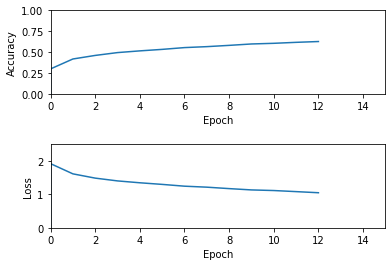

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a0model.ckpt Model Saved...
Epoch [325000], loss: 0.2821, acc: 1.0000
Epoch [325001], loss: 0.6352, acc: 1.0000
Epoch [325002], loss: 1.1972, acc: 0.0000
Epoch [325003], loss: 0.6502, acc: 1.0000
Epoch [325004], loss: 0.1160, acc: 1.0000
Epoch [325005], loss: 0.3730, acc: 1.0000
Epoch [325006], loss: 0.0896, acc: 1.0000
Epoch [325007], loss: 1.2522, acc: 0.0000
Epoch [325008], loss: 0.3379, acc: 1.0000
Epoch [325009], loss: 0.3541, acc: 1.0000
Epoch [325010], loss: 0.3882, acc: 1.0000
Epoch [325011], loss: 0.1284, acc: 1.0000
Epoch [325012], loss: 0.2770, acc: 1.0000
Epoch [325013], loss: 0.6271, acc: 1.0000
Epoch [325014], loss: 4.3687, acc: 0.0000
Epoch [325015], loss: 2.0568, acc: 0.0000
Epoch [325016], loss: 0.4000, acc: 1.0000
Epoch [325017], loss: 0.0336, acc: 1.0000
Epoch [325018], loss: 1.8914, acc: 0.0000
Epoch [325019], loss: 0.0100, acc: 1.0000
Epoch [325020], loss: 0.2169, acc: 1.0000
Epoch [325021]

Epoch [325205], loss: 0.3836, acc: 1.0000
Epoch [325206], loss: 0.6537, acc: 1.0000
Epoch [325207], loss: 0.1028, acc: 1.0000
Epoch [325208], loss: 1.6330, acc: 0.0000
Epoch [325209], loss: 0.1133, acc: 1.0000
Epoch [325210], loss: 1.5817, acc: 0.0000
Epoch [325211], loss: 0.5439, acc: 1.0000
Epoch [325212], loss: 1.8262, acc: 0.0000
Epoch [325213], loss: 0.3631, acc: 1.0000
Epoch [325214], loss: 0.7259, acc: 1.0000
Epoch [325215], loss: 3.2355, acc: 0.0000
Epoch [325216], loss: 1.4087, acc: 0.0000
Epoch [325217], loss: 1.7197, acc: 0.0000
Epoch [325218], loss: 0.9070, acc: 1.0000
Epoch [325219], loss: 1.3231, acc: 0.0000
Epoch [325220], loss: 1.1407, acc: 1.0000
Epoch [325221], loss: 1.0795, acc: 0.0000
Epoch [325222], loss: 0.8673, acc: 1.0000
Epoch [325223], loss: 1.3264, acc: 0.0000
Epoch [325224], loss: 0.9232, acc: 1.0000
Epoch [325225], loss: 2.2167, acc: 0.0000
Epoch [325226], loss: 0.3468, acc: 1.0000
Epoch [325227], loss: 0.8594, acc: 1.0000
Epoch [325228], loss: 1.5206, acc:

Epoch [325401], loss: 0.0235, acc: 1.0000
Epoch [325402], loss: 1.2097, acc: 0.0000
Epoch [325403], loss: 1.3733, acc: 1.0000
Epoch [325404], loss: 1.7173, acc: 0.0000
Epoch [325405], loss: 0.9840, acc: 1.0000
Epoch [325406], loss: 1.7762, acc: 0.0000
Epoch [325407], loss: 1.7816, acc: 0.0000
Epoch [325408], loss: 1.1837, acc: 0.0000
Epoch [325409], loss: 1.1294, acc: 0.0000
Epoch [325410], loss: 1.1511, acc: 0.0000
Epoch [325411], loss: 1.4083, acc: 0.0000
Epoch [325412], loss: 0.4847, acc: 1.0000
Epoch [325413], loss: 0.2248, acc: 1.0000
Epoch [325414], loss: 0.2115, acc: 1.0000
Epoch [325415], loss: 2.7497, acc: 0.0000
Epoch [325416], loss: 0.3997, acc: 1.0000
Epoch [325417], loss: 3.3719, acc: 0.0000
Epoch [325418], loss: 0.9484, acc: 1.0000
Epoch [325419], loss: 1.3395, acc: 0.0000
Epoch [325420], loss: 0.2798, acc: 1.0000
Epoch [325421], loss: 0.4030, acc: 1.0000
Epoch [325422], loss: 2.0223, acc: 0.0000
Epoch [325423], loss: 2.9585, acc: 0.0000
Epoch [325424], loss: 0.7136, acc:

Epoch [325598], loss: 1.7458, acc: 0.0000
Epoch [325599], loss: 3.0582, acc: 0.0000
Epoch [325600], loss: 0.6037, acc: 1.0000
Epoch [325601], loss: 0.0091, acc: 1.0000
Epoch [325602], loss: 0.7868, acc: 0.0000
Epoch [325603], loss: 0.6334, acc: 1.0000
Epoch [325604], loss: 0.0026, acc: 1.0000
Epoch [325605], loss: 0.1323, acc: 1.0000
Epoch [325606], loss: 0.1203, acc: 1.0000
Epoch [325607], loss: 0.4875, acc: 1.0000
Epoch [325608], loss: 0.0490, acc: 1.0000
Epoch [325609], loss: 0.6309, acc: 1.0000
Epoch [325610], loss: 1.3024, acc: 1.0000
Epoch [325611], loss: 0.3933, acc: 1.0000
Epoch [325612], loss: 0.2063, acc: 1.0000
Epoch [325613], loss: 0.0060, acc: 1.0000
Epoch [325614], loss: 0.0007, acc: 1.0000
Epoch [325615], loss: 0.9762, acc: 0.0000
Epoch [325616], loss: 1.3110, acc: 0.0000
Epoch [325617], loss: 0.0294, acc: 1.0000
Epoch [325618], loss: 1.1294, acc: 0.0000
Epoch [325619], loss: 1.7560, acc: 0.0000
Epoch [325620], loss: 0.2635, acc: 1.0000
Epoch [325621], loss: 0.5673, acc:

Epoch [325795], loss: 2.6750, acc: 0.0000
Epoch [325796], loss: 0.6381, acc: 1.0000
Epoch [325797], loss: 0.5897, acc: 1.0000
Epoch [325798], loss: 0.7017, acc: 1.0000
Epoch [325799], loss: 3.8356, acc: 0.0000
Epoch [325800], loss: 0.6654, acc: 1.0000
Epoch [325801], loss: 4.6108, acc: 0.0000
Epoch [325802], loss: 2.5301, acc: 0.0000
Epoch [325803], loss: 0.2666, acc: 1.0000
Epoch [325804], loss: 0.1221, acc: 1.0000
Epoch [325805], loss: 2.7667, acc: 0.0000
Epoch [325806], loss: 0.4350, acc: 1.0000
Epoch [325807], loss: 0.5002, acc: 1.0000
Epoch [325808], loss: 1.0088, acc: 1.0000
Epoch [325809], loss: 1.3883, acc: 0.0000
Epoch [325810], loss: 1.4159, acc: 0.0000
Epoch [325811], loss: 0.7346, acc: 1.0000
Epoch [325812], loss: 0.4261, acc: 1.0000
Epoch [325813], loss: 0.4572, acc: 1.0000
Epoch [325814], loss: 1.1908, acc: 0.0000
Epoch [325815], loss: 0.9236, acc: 0.0000
Epoch [325816], loss: 0.0699, acc: 1.0000
Epoch [325817], loss: 1.2768, acc: 1.0000
Epoch [325818], loss: 0.6473, acc:

Epoch [326000], loss: 0.4144, acc: 1.0000
Epoch [326001], loss: 1.2139, acc: 0.0000
Epoch [326002], loss: 0.0319, acc: 1.0000
Epoch [326003], loss: 2.1495, acc: 0.0000
Epoch [326004], loss: 0.7391, acc: 1.0000
Epoch [326005], loss: 0.1929, acc: 1.0000
Epoch [326006], loss: 0.1195, acc: 1.0000
Epoch [326007], loss: 2.1563, acc: 0.0000
Epoch [326008], loss: 3.9533, acc: 0.0000
Epoch [326009], loss: 1.1636, acc: 0.0000
Epoch [326010], loss: 0.9899, acc: 0.0000
Epoch [326011], loss: 5.0354, acc: 0.0000
Epoch [326012], loss: 3.4199, acc: 0.0000
Epoch [326013], loss: 1.0499, acc: 1.0000
Epoch [326014], loss: 2.6035, acc: 0.0000
Epoch [326015], loss: 1.6629, acc: 0.0000
Epoch [326016], loss: 0.3616, acc: 1.0000
Epoch [326017], loss: 1.8920, acc: 0.0000
Epoch [326018], loss: 1.2460, acc: 0.0000
Epoch [326019], loss: 0.2770, acc: 1.0000
Epoch [326020], loss: 0.0596, acc: 1.0000
Epoch [326021], loss: 0.2124, acc: 1.0000
Epoch [326022], loss: 0.1526, acc: 1.0000
Epoch [326023], loss: 0.1330, acc:

Epoch [326201], loss: 1.7569, acc: 0.0000
Epoch [326202], loss: 1.1214, acc: 1.0000
Epoch [326203], loss: 0.9552, acc: 0.0000
Epoch [326204], loss: 1.4451, acc: 0.0000
Epoch [326205], loss: 2.5025, acc: 0.0000
Epoch [326206], loss: 0.0026, acc: 1.0000
Epoch [326207], loss: 0.9727, acc: 1.0000
Epoch [326208], loss: 1.5083, acc: 0.0000
Epoch [326209], loss: 3.8072, acc: 0.0000
Epoch [326210], loss: 1.4052, acc: 0.0000
Epoch [326211], loss: 5.0905, acc: 0.0000
Epoch [326212], loss: 1.6486, acc: 0.0000
Epoch [326213], loss: 0.5418, acc: 1.0000
Epoch [326214], loss: 0.5616, acc: 1.0000
Epoch [326215], loss: 0.2088, acc: 1.0000
Epoch [326216], loss: 0.0971, acc: 1.0000
Epoch [326217], loss: 0.9590, acc: 1.0000
Epoch [326218], loss: 1.3217, acc: 0.0000
Epoch [326219], loss: 0.7251, acc: 0.0000
Epoch [326220], loss: 2.3227, acc: 0.0000
Epoch [326221], loss: 1.2283, acc: 1.0000
Epoch [326222], loss: 0.0862, acc: 1.0000
Epoch [326223], loss: 0.9826, acc: 1.0000
Epoch [326224], loss: 2.9969, acc:

Epoch [326407], loss: 2.0193, acc: 0.0000
Epoch [326408], loss: 0.6505, acc: 1.0000
Epoch [326409], loss: 0.6335, acc: 1.0000
Epoch [326410], loss: 3.4854, acc: 0.0000
Epoch [326411], loss: 0.1956, acc: 1.0000
Epoch [326412], loss: 0.8415, acc: 1.0000
Epoch [326413], loss: 1.1242, acc: 0.0000
Epoch [326414], loss: 0.0878, acc: 1.0000
Epoch [326415], loss: 3.7124, acc: 0.0000
Epoch [326416], loss: 0.2157, acc: 1.0000
Epoch [326417], loss: 2.1238, acc: 0.0000
Epoch [326418], loss: 2.0344, acc: 0.0000
Epoch [326419], loss: 2.1476, acc: 0.0000
Epoch [326420], loss: 0.4350, acc: 1.0000
Epoch [326421], loss: 1.8841, acc: 0.0000
Epoch [326422], loss: 0.0914, acc: 1.0000
Epoch [326423], loss: 1.6805, acc: 0.0000
Epoch [326424], loss: 1.7272, acc: 0.0000
Epoch [326425], loss: 0.2678, acc: 1.0000
Epoch [326426], loss: 0.4140, acc: 1.0000
Epoch [326427], loss: 0.4771, acc: 1.0000
Epoch [326428], loss: 0.0771, acc: 1.0000
Epoch [326429], loss: 1.1131, acc: 1.0000
Epoch [326430], loss: 0.2128, acc:

Epoch [326621], loss: 0.3602, acc: 1.0000
Epoch [326622], loss: 1.2909, acc: 0.0000
Epoch [326623], loss: 1.6760, acc: 0.0000
Epoch [326624], loss: 1.0739, acc: 1.0000
Epoch [326625], loss: 2.1795, acc: 0.0000
Epoch [326626], loss: 1.9475, acc: 0.0000
Epoch [326627], loss: 1.2652, acc: 0.0000
Epoch [326628], loss: 0.5459, acc: 1.0000
Epoch [326629], loss: 0.0789, acc: 1.0000
Epoch [326630], loss: 1.1839, acc: 1.0000
Epoch [326631], loss: 0.4578, acc: 1.0000
Epoch [326632], loss: 0.0999, acc: 1.0000
Epoch [326633], loss: 0.5727, acc: 1.0000
Epoch [326634], loss: 2.0533, acc: 0.0000
Epoch [326635], loss: 0.0256, acc: 1.0000
Epoch [326636], loss: 3.4242, acc: 0.0000
Epoch [326637], loss: 0.0716, acc: 1.0000
Epoch [326638], loss: 2.4358, acc: 0.0000
Epoch [326639], loss: 2.5612, acc: 0.0000
Epoch [326640], loss: 0.8304, acc: 1.0000
Epoch [326641], loss: 1.4304, acc: 0.0000
Epoch [326642], loss: 0.6816, acc: 1.0000
Epoch [326643], loss: 1.7815, acc: 0.0000
Epoch [326644], loss: 5.3580, acc:

Epoch [326823], loss: 0.4631, acc: 1.0000
Epoch [326824], loss: 0.4379, acc: 1.0000
Epoch [326825], loss: 0.3808, acc: 1.0000
Epoch [326826], loss: 0.9487, acc: 1.0000
Epoch [326827], loss: 1.5027, acc: 0.0000
Epoch [326828], loss: 0.7836, acc: 1.0000
Epoch [326829], loss: 0.1789, acc: 1.0000
Epoch [326830], loss: 2.8895, acc: 0.0000
Epoch [326831], loss: 0.7156, acc: 1.0000
Epoch [326832], loss: 3.7843, acc: 0.0000
Epoch [326833], loss: 0.0182, acc: 1.0000
Epoch [326834], loss: 1.7728, acc: 0.0000
Epoch [326835], loss: 0.5482, acc: 1.0000
Epoch [326836], loss: 0.7385, acc: 1.0000
Epoch [326837], loss: 0.0223, acc: 1.0000
Epoch [326838], loss: 0.1181, acc: 1.0000
Epoch [326839], loss: 1.4746, acc: 1.0000
Epoch [326840], loss: 0.7637, acc: 1.0000
Epoch [326841], loss: 0.6374, acc: 1.0000
Epoch [326842], loss: 0.6211, acc: 1.0000
Epoch [326843], loss: 0.9158, acc: 1.0000
Epoch [326844], loss: 0.6876, acc: 1.0000
Epoch [326845], loss: 0.4803, acc: 1.0000
Epoch [326846], loss: 0.4139, acc:

Epoch [327036], loss: 0.2306, acc: 1.0000
Epoch [327037], loss: 0.5425, acc: 1.0000
Epoch [327038], loss: 0.1820, acc: 1.0000
Epoch [327039], loss: 1.2382, acc: 1.0000
Epoch [327040], loss: 0.9822, acc: 1.0000
Epoch [327041], loss: 0.2883, acc: 1.0000
Epoch [327042], loss: 2.4511, acc: 0.0000
Epoch [327043], loss: 1.8665, acc: 0.0000
Epoch [327044], loss: 1.8339, acc: 0.0000
Epoch [327045], loss: 1.7920, acc: 0.0000
Epoch [327046], loss: 0.2469, acc: 1.0000
Epoch [327047], loss: 0.1630, acc: 1.0000
Epoch [327048], loss: 0.1340, acc: 1.0000
Epoch [327049], loss: 0.8059, acc: 1.0000
Epoch [327050], loss: 2.7336, acc: 0.0000
Epoch [327051], loss: 1.2263, acc: 0.0000
Epoch [327052], loss: 0.1485, acc: 1.0000
Epoch [327053], loss: 0.5946, acc: 1.0000
Epoch [327054], loss: 0.0540, acc: 1.0000
Epoch [327055], loss: 0.0089, acc: 1.0000
Epoch [327056], loss: 0.8667, acc: 1.0000
Epoch [327057], loss: 2.5273, acc: 0.0000
Epoch [327058], loss: 0.1492, acc: 1.0000
Epoch [327059], loss: 2.4591, acc:

Epoch [327241], loss: 0.1634, acc: 1.0000
Epoch [327242], loss: 2.5992, acc: 0.0000
Epoch [327243], loss: 2.6820, acc: 0.0000
Epoch [327244], loss: 0.3552, acc: 1.0000
Epoch [327245], loss: 0.1597, acc: 1.0000
Epoch [327246], loss: 1.5150, acc: 0.0000
Epoch [327247], loss: 0.3758, acc: 1.0000
Epoch [327248], loss: 0.0494, acc: 1.0000
Epoch [327249], loss: 2.6013, acc: 0.0000
Epoch [327250], loss: 0.2120, acc: 1.0000
Epoch [327251], loss: 0.3984, acc: 1.0000
Epoch [327252], loss: 0.1116, acc: 1.0000
Epoch [327253], loss: 0.0921, acc: 1.0000
Epoch [327254], loss: 0.0882, acc: 1.0000
Epoch [327255], loss: 1.0525, acc: 1.0000
Epoch [327256], loss: 0.3314, acc: 1.0000
Epoch [327257], loss: 0.2308, acc: 1.0000
Epoch [327258], loss: 0.0048, acc: 1.0000
Epoch [327259], loss: 1.4426, acc: 0.0000
Epoch [327260], loss: 0.8207, acc: 1.0000
Epoch [327261], loss: 2.3180, acc: 0.0000
Epoch [327262], loss: 0.5205, acc: 1.0000
Epoch [327263], loss: 2.1819, acc: 0.0000
Epoch [327264], loss: 3.1011, acc:

Epoch [327450], loss: 1.4449, acc: 0.0000
Epoch [327451], loss: 2.9799, acc: 0.0000
Epoch [327452], loss: 0.0024, acc: 1.0000
Epoch [327453], loss: 0.8858, acc: 0.0000
Epoch [327454], loss: 0.3817, acc: 1.0000
Epoch [327455], loss: 2.7608, acc: 0.0000
Epoch [327456], loss: 0.0175, acc: 1.0000
Epoch [327457], loss: 0.1254, acc: 1.0000
Epoch [327458], loss: 1.0178, acc: 0.0000
Epoch [327459], loss: 0.6216, acc: 1.0000
Epoch [327460], loss: 0.1483, acc: 1.0000
Epoch [327461], loss: 0.6458, acc: 1.0000
Epoch [327462], loss: 0.1706, acc: 1.0000
Epoch [327463], loss: 0.3786, acc: 1.0000
Epoch [327464], loss: 0.8388, acc: 1.0000
Epoch [327465], loss: 0.1801, acc: 1.0000
Epoch [327466], loss: 1.1537, acc: 0.0000
Epoch [327467], loss: 0.0364, acc: 1.0000
Epoch [327468], loss: 2.3494, acc: 0.0000
Epoch [327469], loss: 0.0287, acc: 1.0000
Epoch [327470], loss: 0.5433, acc: 1.0000
Epoch [327471], loss: 1.2544, acc: 0.0000
Epoch [327472], loss: 2.1900, acc: 0.0000
Epoch [327473], loss: 2.5673, acc:

Epoch [327658], loss: 0.5642, acc: 1.0000
Epoch [327659], loss: 0.0293, acc: 1.0000
Epoch [327660], loss: 0.7013, acc: 1.0000
Epoch [327661], loss: 0.0447, acc: 1.0000
Epoch [327662], loss: 0.1833, acc: 1.0000
Epoch [327663], loss: 0.9629, acc: 0.0000
Epoch [327664], loss: 0.2803, acc: 1.0000
Epoch [327665], loss: 2.5059, acc: 0.0000
Epoch [327666], loss: 0.7297, acc: 1.0000
Epoch [327667], loss: 0.3326, acc: 1.0000
Epoch [327668], loss: 0.7154, acc: 1.0000
Epoch [327669], loss: 3.9929, acc: 0.0000
Epoch [327670], loss: 1.0616, acc: 0.0000
Epoch [327671], loss: 1.1964, acc: 1.0000
Epoch [327672], loss: 1.3029, acc: 0.0000
Epoch [327673], loss: 0.3128, acc: 1.0000
Epoch [327674], loss: 0.5721, acc: 1.0000
Epoch [327675], loss: 1.3423, acc: 0.0000
Epoch [327676], loss: 0.7276, acc: 1.0000
Epoch [327677], loss: 1.2879, acc: 0.0000
Epoch [327678], loss: 1.2836, acc: 1.0000
Epoch [327679], loss: 0.3514, acc: 1.0000
Epoch [327680], loss: 1.1094, acc: 1.0000
Epoch [327681], loss: 0.4266, acc:

Epoch [327860], loss: 2.8327, acc: 0.0000
Epoch [327861], loss: 0.1460, acc: 1.0000
Epoch [327862], loss: 0.0544, acc: 1.0000
Epoch [327863], loss: 1.4979, acc: 0.0000
Epoch [327864], loss: 0.7606, acc: 1.0000
Epoch [327865], loss: 0.0817, acc: 1.0000
Epoch [327866], loss: 0.0845, acc: 1.0000
Epoch [327867], loss: 0.0246, acc: 1.0000
Epoch [327868], loss: 0.8925, acc: 0.0000
Epoch [327869], loss: 1.4840, acc: 1.0000
Epoch [327870], loss: 0.1707, acc: 1.0000
Epoch [327871], loss: 0.0836, acc: 1.0000
Epoch [327872], loss: 3.9443, acc: 0.0000
Epoch [327873], loss: 1.1308, acc: 0.0000
Epoch [327874], loss: 0.1024, acc: 1.0000
Epoch [327875], loss: 1.3112, acc: 1.0000
Epoch [327876], loss: 0.2110, acc: 1.0000
Epoch [327877], loss: 0.7097, acc: 1.0000
Epoch [327878], loss: 0.9018, acc: 0.0000
Epoch [327879], loss: 0.1187, acc: 1.0000
Epoch [327880], loss: 0.2085, acc: 1.0000
Epoch [327881], loss: 0.4318, acc: 1.0000
Epoch [327882], loss: 1.9428, acc: 0.0000
Epoch [327883], loss: 1.6114, acc:

Epoch [328069], loss: 0.0953, acc: 1.0000
Epoch [328070], loss: 1.3500, acc: 0.0000
Epoch [328071], loss: 0.4589, acc: 1.0000
Epoch [328072], loss: 2.3416, acc: 0.0000
Epoch [328073], loss: 1.3754, acc: 0.0000
Epoch [328074], loss: 1.6921, acc: 0.0000
Epoch [328075], loss: 0.0107, acc: 1.0000
Epoch [328076], loss: 3.7740, acc: 0.0000
Epoch [328077], loss: 0.5705, acc: 1.0000
Epoch [328078], loss: 1.9373, acc: 0.0000
Epoch [328079], loss: 3.8675, acc: 0.0000
Epoch [328080], loss: 1.4987, acc: 0.0000
Epoch [328081], loss: 1.6036, acc: 0.0000
Epoch [328082], loss: 0.0050, acc: 1.0000
Epoch [328083], loss: 1.7901, acc: 0.0000
Epoch [328084], loss: 0.0951, acc: 1.0000
Epoch [328085], loss: 0.1971, acc: 1.0000
Epoch [328086], loss: 2.3511, acc: 0.0000
Epoch [328087], loss: 0.4535, acc: 1.0000
Epoch [328088], loss: 0.6857, acc: 1.0000
Epoch [328089], loss: 1.0395, acc: 0.0000
Epoch [328090], loss: 0.8709, acc: 1.0000
Epoch [328091], loss: 0.3106, acc: 1.0000
Epoch [328092], loss: 0.5201, acc:

Epoch [328276], loss: 0.7466, acc: 1.0000
Epoch [328277], loss: 0.1908, acc: 1.0000
Epoch [328278], loss: 4.8714, acc: 0.0000
Epoch [328279], loss: 1.4482, acc: 0.0000
Epoch [328280], loss: 0.3223, acc: 1.0000
Epoch [328281], loss: 1.0015, acc: 1.0000
Epoch [328282], loss: 1.2030, acc: 0.0000
Epoch [328283], loss: 1.2059, acc: 0.0000
Epoch [328284], loss: 0.0512, acc: 1.0000
Epoch [328285], loss: 1.7056, acc: 1.0000
Epoch [328286], loss: 0.8108, acc: 1.0000
Epoch [328287], loss: 1.8613, acc: 0.0000
Epoch [328288], loss: 1.9538, acc: 0.0000
Epoch [328289], loss: 0.8190, acc: 1.0000
Epoch [328290], loss: 2.0561, acc: 0.0000
Epoch [328291], loss: 0.2207, acc: 1.0000
Epoch [328292], loss: 0.6241, acc: 1.0000
Epoch [328293], loss: 1.9218, acc: 0.0000
Epoch [328294], loss: 0.1042, acc: 1.0000
Epoch [328295], loss: 2.4511, acc: 0.0000
Epoch [328296], loss: 0.0089, acc: 1.0000
Epoch [328297], loss: 0.5252, acc: 1.0000
Epoch [328298], loss: 0.2153, acc: 1.0000
Epoch [328299], loss: 0.9435, acc:

Epoch [328482], loss: 1.3510, acc: 0.0000
Epoch [328483], loss: 0.3026, acc: 1.0000
Epoch [328484], loss: 3.2791, acc: 0.0000
Epoch [328485], loss: 0.0434, acc: 1.0000
Epoch [328486], loss: 0.2423, acc: 1.0000
Epoch [328487], loss: 0.7966, acc: 1.0000
Epoch [328488], loss: 0.0338, acc: 1.0000
Epoch [328489], loss: 0.3957, acc: 1.0000
Epoch [328490], loss: 1.7254, acc: 0.0000
Epoch [328491], loss: 1.8865, acc: 0.0000
Epoch [328492], loss: 0.3991, acc: 1.0000
Epoch [328493], loss: 0.3984, acc: 1.0000
Epoch [328494], loss: 2.7324, acc: 0.0000
Epoch [328495], loss: 0.3399, acc: 1.0000
Epoch [328496], loss: 0.8017, acc: 1.0000
Epoch [328497], loss: 0.4368, acc: 1.0000
Epoch [328498], loss: 1.5277, acc: 0.0000
Epoch [328499], loss: 0.0770, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a3500model.ckpt Model Saved...
Epoch [328500], loss: 0.0740, acc: 1.0000
Epoch [328501], loss: 0.1906, acc: 1.0000
Epoch [328502], loss: 0.2942, acc: 1.0000
Epoch [3285

Epoch [328692], loss: 0.1635, acc: 1.0000
Epoch [328693], loss: 0.3085, acc: 1.0000
Epoch [328694], loss: 0.9099, acc: 1.0000
Epoch [328695], loss: 0.2088, acc: 1.0000
Epoch [328696], loss: 2.0604, acc: 0.0000
Epoch [328697], loss: 3.2859, acc: 0.0000
Epoch [328698], loss: 0.1852, acc: 1.0000
Epoch [328699], loss: 1.0172, acc: 1.0000
Epoch [328700], loss: 0.0811, acc: 1.0000
Epoch [328701], loss: 1.2951, acc: 1.0000
Epoch [328702], loss: 0.2627, acc: 1.0000
Epoch [328703], loss: 2.4437, acc: 0.0000
Epoch [328704], loss: 0.1072, acc: 1.0000
Epoch [328705], loss: 1.6574, acc: 0.0000
Epoch [328706], loss: 1.9377, acc: 0.0000
Epoch [328707], loss: 0.3674, acc: 1.0000
Epoch [328708], loss: 0.1962, acc: 1.0000
Epoch [328709], loss: 1.1710, acc: 0.0000
Epoch [328710], loss: 0.1038, acc: 1.0000
Epoch [328711], loss: 0.7653, acc: 1.0000
Epoch [328712], loss: 1.7986, acc: 0.0000
Epoch [328713], loss: 0.4673, acc: 1.0000
Epoch [328714], loss: 0.6689, acc: 1.0000
Epoch [328715], loss: 0.2895, acc:

Epoch [328900], loss: 0.9635, acc: 0.0000
Epoch [328901], loss: 0.4650, acc: 1.0000
Epoch [328902], loss: 0.8474, acc: 0.0000
Epoch [328903], loss: 0.1190, acc: 1.0000
Epoch [328904], loss: 0.5412, acc: 1.0000
Epoch [328905], loss: 1.7982, acc: 0.0000
Epoch [328906], loss: 1.0711, acc: 1.0000
Epoch [328907], loss: 0.0342, acc: 1.0000
Epoch [328908], loss: 2.8325, acc: 0.0000
Epoch [328909], loss: 0.1201, acc: 1.0000
Epoch [328910], loss: 1.1873, acc: 0.0000
Epoch [328911], loss: 3.8580, acc: 0.0000
Epoch [328912], loss: 2.3540, acc: 0.0000
Epoch [328913], loss: 0.5044, acc: 1.0000
Epoch [328914], loss: 0.3193, acc: 1.0000
Epoch [328915], loss: 2.0519, acc: 0.0000
Epoch [328916], loss: 0.1738, acc: 1.0000
Epoch [328917], loss: 0.2269, acc: 1.0000
Epoch [328918], loss: 0.5729, acc: 1.0000
Epoch [328919], loss: 1.2369, acc: 1.0000
Epoch [328920], loss: 0.0391, acc: 1.0000
Epoch [328921], loss: 5.5665, acc: 0.0000
Epoch [328922], loss: 2.3822, acc: 0.0000
Epoch [328923], loss: 0.1186, acc:

Epoch [329098], loss: 1.3252, acc: 1.0000
Epoch [329099], loss: 0.0313, acc: 1.0000
Epoch [329100], loss: 2.1547, acc: 0.0000
Epoch [329101], loss: 1.9681, acc: 0.0000
Epoch [329102], loss: 2.2095, acc: 0.0000
Epoch [329103], loss: 0.2017, acc: 1.0000
Epoch [329104], loss: 0.0396, acc: 1.0000
Epoch [329105], loss: 0.0044, acc: 1.0000
Epoch [329106], loss: 0.3764, acc: 1.0000
Epoch [329107], loss: 0.0329, acc: 1.0000
Epoch [329108], loss: 0.6452, acc: 1.0000
Epoch [329109], loss: 1.2837, acc: 0.0000
Epoch [329110], loss: 0.8558, acc: 1.0000
Epoch [329111], loss: 0.7136, acc: 1.0000
Epoch [329112], loss: 1.3253, acc: 1.0000
Epoch [329113], loss: 0.6818, acc: 1.0000
Epoch [329114], loss: 0.0474, acc: 1.0000
Epoch [329115], loss: 3.2140, acc: 0.0000
Epoch [329116], loss: 4.4628, acc: 0.0000
Epoch [329117], loss: 0.1398, acc: 1.0000
Epoch [329118], loss: 3.2181, acc: 0.0000
Epoch [329119], loss: 2.1575, acc: 0.0000
Epoch [329120], loss: 0.0174, acc: 1.0000
Epoch [329121], loss: 3.2033, acc:

Epoch [329316], loss: 0.0143, acc: 1.0000
Epoch [329317], loss: 0.6429, acc: 1.0000
Epoch [329318], loss: 0.0062, acc: 1.0000
Epoch [329319], loss: 0.0866, acc: 1.0000
Epoch [329320], loss: 0.0120, acc: 1.0000
Epoch [329321], loss: 1.4505, acc: 0.0000
Epoch [329322], loss: 0.1643, acc: 1.0000
Epoch [329323], loss: 1.5885, acc: 0.0000
Epoch [329324], loss: 0.0380, acc: 1.0000
Epoch [329325], loss: 3.0313, acc: 0.0000
Epoch [329326], loss: 0.0023, acc: 1.0000
Epoch [329327], loss: 3.9288, acc: 0.0000
Epoch [329328], loss: 1.2571, acc: 0.0000
Epoch [329329], loss: 1.6558, acc: 0.0000
Epoch [329330], loss: 4.6405, acc: 0.0000
Epoch [329331], loss: 0.2465, acc: 1.0000
Epoch [329332], loss: 0.3238, acc: 1.0000
Epoch [329333], loss: 0.4312, acc: 1.0000
Epoch [329334], loss: 1.5194, acc: 0.0000
Epoch [329335], loss: 0.4835, acc: 1.0000
Epoch [329336], loss: 0.2433, acc: 1.0000
Epoch [329337], loss: 1.6444, acc: 0.0000
Epoch [329338], loss: 1.9209, acc: 0.0000
Epoch [329339], loss: 2.3727, acc:

Epoch [329516], loss: 0.1930, acc: 1.0000
Epoch [329517], loss: 0.5887, acc: 1.0000
Epoch [329518], loss: 2.2814, acc: 0.0000
Epoch [329519], loss: 0.2275, acc: 1.0000
Epoch [329520], loss: 0.9341, acc: 0.0000
Epoch [329521], loss: 2.1557, acc: 0.0000
Epoch [329522], loss: 1.0381, acc: 1.0000
Epoch [329523], loss: 0.3876, acc: 1.0000
Epoch [329524], loss: 2.8047, acc: 0.0000
Epoch [329525], loss: 0.2409, acc: 1.0000
Epoch [329526], loss: 0.2526, acc: 1.0000
Epoch [329527], loss: 0.0571, acc: 1.0000
Epoch [329528], loss: 2.7742, acc: 0.0000
Epoch [329529], loss: 0.4308, acc: 1.0000
Epoch [329530], loss: 2.6985, acc: 0.0000
Epoch [329531], loss: 0.8868, acc: 0.0000
Epoch [329532], loss: 1.1134, acc: 0.0000
Epoch [329533], loss: 2.6309, acc: 0.0000
Epoch [329534], loss: 1.0187, acc: 0.0000
Epoch [329535], loss: 0.7524, acc: 1.0000
Epoch [329536], loss: 2.3292, acc: 0.0000
Epoch [329537], loss: 1.0315, acc: 1.0000
Epoch [329538], loss: 0.3399, acc: 1.0000
Epoch [329539], loss: 0.0566, acc:

Epoch [329733], loss: 0.2598, acc: 1.0000
Epoch [329734], loss: 1.2233, acc: 0.0000
Epoch [329735], loss: 1.0488, acc: 0.0000
Epoch [329736], loss: 0.0868, acc: 1.0000
Epoch [329737], loss: 0.5331, acc: 1.0000
Epoch [329738], loss: 0.1100, acc: 1.0000
Epoch [329739], loss: 1.4833, acc: 0.0000
Epoch [329740], loss: 3.5660, acc: 0.0000
Epoch [329741], loss: 0.0622, acc: 1.0000
Epoch [329742], loss: 0.1883, acc: 1.0000
Epoch [329743], loss: 1.6399, acc: 0.0000
Epoch [329744], loss: 1.9775, acc: 0.0000
Epoch [329745], loss: 1.1128, acc: 1.0000
Epoch [329746], loss: 2.2018, acc: 0.0000
Epoch [329747], loss: 0.0179, acc: 1.0000
Epoch [329748], loss: 0.9911, acc: 1.0000
Epoch [329749], loss: 2.8081, acc: 0.0000
Epoch [329750], loss: 0.1958, acc: 1.0000
Epoch [329751], loss: 0.7114, acc: 1.0000
Epoch [329752], loss: 0.2279, acc: 1.0000
Epoch [329753], loss: 0.6022, acc: 1.0000
Epoch [329754], loss: 0.1158, acc: 1.0000
Epoch [329755], loss: 0.0494, acc: 1.0000
Epoch [329756], loss: 3.3180, acc:

Epoch [329948], loss: 0.2833, acc: 1.0000
Epoch [329949], loss: 1.0681, acc: 1.0000
Epoch [329950], loss: 0.6820, acc: 1.0000
Epoch [329951], loss: 0.6654, acc: 1.0000
Epoch [329952], loss: 0.0855, acc: 1.0000
Epoch [329953], loss: 0.0197, acc: 1.0000
Epoch [329954], loss: 3.1450, acc: 0.0000
Epoch [329955], loss: 1.4092, acc: 0.0000
Epoch [329956], loss: 1.1729, acc: 1.0000
Epoch [329957], loss: 0.4891, acc: 1.0000
Epoch [329958], loss: 0.7865, acc: 1.0000
Epoch [329959], loss: 1.0154, acc: 0.0000
Epoch [329960], loss: 0.5292, acc: 1.0000
Epoch [329961], loss: 0.2358, acc: 1.0000
Epoch [329962], loss: 3.3584, acc: 0.0000
Epoch [329963], loss: 0.3955, acc: 1.0000
Epoch [329964], loss: 0.8565, acc: 1.0000
Epoch [329965], loss: 0.2165, acc: 1.0000
Epoch [329966], loss: 1.8132, acc: 0.0000
Epoch [329967], loss: 1.6004, acc: 0.0000
Epoch [329968], loss: 3.4197, acc: 0.0000
Epoch [329969], loss: 0.0683, acc: 1.0000
Epoch [329970], loss: 4.2758, acc: 0.0000
Epoch [329971], loss: 0.4688, acc:

Epoch [330159], loss: 0.1292, acc: 1.0000
Epoch [330160], loss: 1.0417, acc: 1.0000
Epoch [330161], loss: 2.1530, acc: 0.0000
Epoch [330162], loss: 0.5986, acc: 1.0000
Epoch [330163], loss: 0.0753, acc: 1.0000
Epoch [330164], loss: 0.2147, acc: 1.0000
Epoch [330165], loss: 0.0427, acc: 1.0000
Epoch [330166], loss: 2.7294, acc: 0.0000
Epoch [330167], loss: 3.6671, acc: 0.0000
Epoch [330168], loss: 1.2116, acc: 0.0000
Epoch [330169], loss: 3.0358, acc: 0.0000
Epoch [330170], loss: 1.9798, acc: 0.0000
Epoch [330171], loss: 0.0162, acc: 1.0000
Epoch [330172], loss: 4.2183, acc: 0.0000
Epoch [330173], loss: 0.1938, acc: 1.0000
Epoch [330174], loss: 5.2101, acc: 0.0000
Epoch [330175], loss: 1.9043, acc: 0.0000
Epoch [330176], loss: 0.2182, acc: 1.0000
Epoch [330177], loss: 2.1307, acc: 0.0000
Epoch [330178], loss: 1.8837, acc: 0.0000
Epoch [330179], loss: 0.0915, acc: 1.0000
Epoch [330180], loss: 1.3714, acc: 0.0000
Epoch [330181], loss: 1.3154, acc: 0.0000
Epoch [330182], loss: 0.8607, acc:

Epoch [330377], loss: 1.1076, acc: 1.0000
Epoch [330378], loss: 0.1082, acc: 1.0000
Epoch [330379], loss: 0.5078, acc: 1.0000
Epoch [330380], loss: 1.8810, acc: 0.0000
Epoch [330381], loss: 0.4630, acc: 1.0000
Epoch [330382], loss: 1.2194, acc: 0.0000
Epoch [330383], loss: 1.6452, acc: 0.0000
Epoch [330384], loss: 0.3413, acc: 1.0000
Epoch [330385], loss: 0.8109, acc: 1.0000
Epoch [330386], loss: 2.6229, acc: 0.0000
Epoch [330387], loss: 0.4235, acc: 1.0000
Epoch [330388], loss: 1.5481, acc: 0.0000
Epoch [330389], loss: 1.2905, acc: 0.0000
Epoch [330390], loss: 1.4744, acc: 0.0000
Epoch [330391], loss: 0.4310, acc: 1.0000
Epoch [330392], loss: 0.2613, acc: 1.0000
Epoch [330393], loss: 3.3954, acc: 0.0000
Epoch [330394], loss: 0.2176, acc: 1.0000
Epoch [330395], loss: 1.1113, acc: 0.0000
Epoch [330396], loss: 0.1746, acc: 1.0000
Epoch [330397], loss: 0.9964, acc: 0.0000
Epoch [330398], loss: 0.3313, acc: 1.0000
Epoch [330399], loss: 0.8421, acc: 1.0000
Epoch [330400], loss: 0.0168, acc:

Epoch [330571], loss: 0.0247, acc: 1.0000
Epoch [330572], loss: 0.0880, acc: 1.0000
Epoch [330573], loss: 0.9559, acc: 0.0000
Epoch [330574], loss: 0.6959, acc: 1.0000
Epoch [330575], loss: 0.1311, acc: 1.0000
Epoch [330576], loss: 0.6896, acc: 1.0000
Epoch [330577], loss: 0.6190, acc: 1.0000
Epoch [330578], loss: 2.5268, acc: 0.0000
Epoch [330579], loss: 0.5108, acc: 1.0000
Epoch [330580], loss: 0.4203, acc: 1.0000
Epoch [330581], loss: 0.9468, acc: 1.0000
Epoch [330582], loss: 0.0491, acc: 1.0000
Epoch [330583], loss: 2.2157, acc: 0.0000
Epoch [330584], loss: 3.6579, acc: 0.0000
Epoch [330585], loss: 0.8034, acc: 1.0000
Epoch [330586], loss: 0.0544, acc: 1.0000
Epoch [330587], loss: 0.5808, acc: 1.0000
Epoch [330588], loss: 0.3163, acc: 1.0000
Epoch [330589], loss: 0.6149, acc: 1.0000
Epoch [330590], loss: 0.0676, acc: 1.0000
Epoch [330591], loss: 1.2530, acc: 0.0000
Epoch [330592], loss: 1.5142, acc: 0.0000
Epoch [330593], loss: 2.3864, acc: 0.0000
Epoch [330594], loss: 7.6994, acc:

Epoch [330789], loss: 1.9377, acc: 0.0000
Epoch [330790], loss: 0.0149, acc: 1.0000
Epoch [330791], loss: 3.0659, acc: 0.0000
Epoch [330792], loss: 3.6306, acc: 0.0000
Epoch [330793], loss: 0.9365, acc: 1.0000
Epoch [330794], loss: 0.4392, acc: 1.0000
Epoch [330795], loss: 0.7898, acc: 1.0000
Epoch [330796], loss: 2.5668, acc: 0.0000
Epoch [330797], loss: 0.1562, acc: 1.0000
Epoch [330798], loss: 0.1940, acc: 1.0000
Epoch [330799], loss: 0.0903, acc: 1.0000
Epoch [330800], loss: 0.2043, acc: 1.0000
Epoch [330801], loss: 0.0324, acc: 1.0000
Epoch [330802], loss: 0.6727, acc: 1.0000
Epoch [330803], loss: 0.3106, acc: 1.0000
Epoch [330804], loss: 1.0416, acc: 1.0000
Epoch [330805], loss: 0.0731, acc: 1.0000
Epoch [330806], loss: 2.8626, acc: 0.0000
Epoch [330807], loss: 0.6124, acc: 1.0000
Epoch [330808], loss: 0.1993, acc: 1.0000
Epoch [330809], loss: 2.9259, acc: 0.0000
Epoch [330810], loss: 1.1759, acc: 0.0000
Epoch [330811], loss: 0.9519, acc: 1.0000
Epoch [330812], loss: 0.7039, acc:

Epoch [330995], loss: 1.1684, acc: 0.0000
Epoch [330996], loss: 0.1680, acc: 1.0000
Epoch [330997], loss: 0.3212, acc: 1.0000
Epoch [330998], loss: 1.3846, acc: 0.0000
Epoch [330999], loss: 1.1382, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a6000model.ckpt Model Saved...
Epoch [331000], loss: 3.1307, acc: 0.0000
Epoch [331001], loss: 0.4291, acc: 1.0000
Epoch [331002], loss: 0.1174, acc: 1.0000
Epoch [331003], loss: 0.2708, acc: 1.0000
Epoch [331004], loss: 0.8056, acc: 1.0000
Epoch [331005], loss: 1.8331, acc: 0.0000
Epoch [331006], loss: 0.6047, acc: 1.0000
Epoch [331007], loss: 0.1256, acc: 1.0000
Epoch [331008], loss: 1.6640, acc: 0.0000
Epoch [331009], loss: 0.6526, acc: 1.0000
Epoch [331010], loss: 2.8241, acc: 0.0000
Epoch [331011], loss: 0.8150, acc: 1.0000
Epoch [331012], loss: 3.4148, acc: 0.0000
Epoch [331013], loss: 0.1769, acc: 1.0000
Epoch [331014], loss: 1.5375, acc: 0.0000
Epoch [331015], loss: 1.1498, acc: 1.0000
Epoch [3310

Epoch [331196], loss: 0.3414, acc: 1.0000
Epoch [331197], loss: 2.6171, acc: 0.0000
Epoch [331198], loss: 0.7619, acc: 1.0000
Epoch [331199], loss: 0.3216, acc: 1.0000
Epoch [331200], loss: 2.4991, acc: 0.0000
Epoch [331201], loss: 0.3078, acc: 1.0000
Epoch [331202], loss: 1.8292, acc: 0.0000
Epoch [331203], loss: 0.2822, acc: 1.0000
Epoch [331204], loss: 0.7307, acc: 1.0000
Epoch [331205], loss: 1.5941, acc: 0.0000
Epoch [331206], loss: 5.0624, acc: 0.0000
Epoch [331207], loss: 0.1614, acc: 1.0000
Epoch [331208], loss: 1.6649, acc: 0.0000
Epoch [331209], loss: 0.5011, acc: 1.0000
Epoch [331210], loss: 0.8910, acc: 0.0000
Epoch [331211], loss: 0.3806, acc: 1.0000
Epoch [331212], loss: 1.4852, acc: 0.0000
Epoch [331213], loss: 0.0559, acc: 1.0000
Epoch [331214], loss: 0.5134, acc: 1.0000
Epoch [331215], loss: 3.6834, acc: 0.0000
Epoch [331216], loss: 0.5101, acc: 1.0000
Epoch [331217], loss: 1.5457, acc: 0.0000
Epoch [331218], loss: 2.5869, acc: 0.0000
Epoch [331219], loss: 0.3590, acc:

Epoch [331394], loss: 0.1195, acc: 1.0000
Epoch [331395], loss: 3.1270, acc: 0.0000
Epoch [331396], loss: 0.7979, acc: 1.0000
Epoch [331397], loss: 0.1810, acc: 1.0000
Epoch [331398], loss: 0.1229, acc: 1.0000
Epoch [331399], loss: 1.8940, acc: 0.0000
Epoch [331400], loss: 2.9068, acc: 0.0000
Epoch [331401], loss: 1.0761, acc: 1.0000
Epoch [331402], loss: 0.2699, acc: 1.0000
Epoch [331403], loss: 0.1643, acc: 1.0000
Epoch [331404], loss: 1.1809, acc: 1.0000
Epoch [331405], loss: 1.8738, acc: 0.0000
Epoch [331406], loss: 0.4836, acc: 1.0000
Epoch [331407], loss: 0.0471, acc: 1.0000
Epoch [331408], loss: 0.1307, acc: 1.0000
Epoch [331409], loss: 0.1843, acc: 1.0000
Epoch [331410], loss: 1.3780, acc: 0.0000
Epoch [331411], loss: 0.9245, acc: 1.0000
Epoch [331412], loss: 3.2667, acc: 0.0000
Epoch [331413], loss: 1.4833, acc: 0.0000
Epoch [331414], loss: 1.7519, acc: 0.0000
Epoch [331415], loss: 1.0138, acc: 1.0000
Epoch [331416], loss: 0.1668, acc: 1.0000
Epoch [331417], loss: 0.2022, acc:

Epoch [331611], loss: 1.4697, acc: 0.0000
Epoch [331612], loss: 0.0015, acc: 1.0000
Epoch [331613], loss: 2.0563, acc: 0.0000
Epoch [331614], loss: 0.6206, acc: 1.0000
Epoch [331615], loss: 1.5402, acc: 0.0000
Epoch [331616], loss: 5.3059, acc: 0.0000
Epoch [331617], loss: 0.6668, acc: 1.0000
Epoch [331618], loss: 2.7382, acc: 0.0000
Epoch [331619], loss: 1.0734, acc: 0.0000
Epoch [331620], loss: 1.7467, acc: 0.0000
Epoch [331621], loss: 1.0104, acc: 1.0000
Epoch [331622], loss: 1.1670, acc: 0.0000
Epoch [331623], loss: 0.2151, acc: 1.0000
Epoch [331624], loss: 0.3973, acc: 1.0000
Epoch [331625], loss: 2.2511, acc: 0.0000
Epoch [331626], loss: 4.2840, acc: 0.0000
Epoch [331627], loss: 0.0303, acc: 1.0000
Epoch [331628], loss: 0.6395, acc: 1.0000
Epoch [331629], loss: 2.5316, acc: 0.0000
Epoch [331630], loss: 0.6939, acc: 1.0000
Epoch [331631], loss: 1.4818, acc: 0.0000
Epoch [331632], loss: 0.3879, acc: 1.0000
Epoch [331633], loss: 0.8857, acc: 1.0000
Epoch [331634], loss: 1.0287, acc:

Epoch [331811], loss: 1.0951, acc: 0.0000
Epoch [331812], loss: 1.8517, acc: 0.0000
Epoch [331813], loss: 0.6097, acc: 1.0000
Epoch [331814], loss: 1.5165, acc: 0.0000
Epoch [331815], loss: 2.5551, acc: 0.0000
Epoch [331816], loss: 1.4189, acc: 0.0000
Epoch [331817], loss: 0.0214, acc: 1.0000
Epoch [331818], loss: 0.3262, acc: 1.0000
Epoch [331819], loss: 1.0444, acc: 1.0000
Epoch [331820], loss: 3.0971, acc: 0.0000
Epoch [331821], loss: 0.1632, acc: 1.0000
Epoch [331822], loss: 0.2769, acc: 1.0000
Epoch [331823], loss: 1.2673, acc: 0.0000
Epoch [331824], loss: 0.6261, acc: 1.0000
Epoch [331825], loss: 1.4314, acc: 1.0000
Epoch [331826], loss: 1.3310, acc: 0.0000
Epoch [331827], loss: 2.0198, acc: 0.0000
Epoch [331828], loss: 2.5483, acc: 0.0000
Epoch [331829], loss: 0.5976, acc: 1.0000
Epoch [331830], loss: 1.6218, acc: 0.0000
Epoch [331831], loss: 0.0910, acc: 1.0000
Epoch [331832], loss: 0.7773, acc: 0.0000
Epoch [331833], loss: 4.7424, acc: 0.0000
Epoch [331834], loss: 0.1817, acc:

Epoch [332021], loss: 0.1728, acc: 1.0000
Epoch [332022], loss: 0.4150, acc: 1.0000
Epoch [332023], loss: 0.9831, acc: 0.0000
Epoch [332024], loss: 0.8342, acc: 1.0000
Epoch [332025], loss: 0.0859, acc: 1.0000
Epoch [332026], loss: 0.7677, acc: 1.0000
Epoch [332027], loss: 0.4521, acc: 1.0000
Epoch [332028], loss: 0.7447, acc: 1.0000
Epoch [332029], loss: 1.0830, acc: 1.0000
Epoch [332030], loss: 0.1107, acc: 1.0000
Epoch [332031], loss: 0.9363, acc: 1.0000
Epoch [332032], loss: 1.7659, acc: 0.0000
Epoch [332033], loss: 1.8644, acc: 0.0000
Epoch [332034], loss: 7.1450, acc: 0.0000
Epoch [332035], loss: 0.2522, acc: 1.0000
Epoch [332036], loss: 0.5400, acc: 1.0000
Epoch [332037], loss: 0.0016, acc: 1.0000
Epoch [332038], loss: 0.8787, acc: 1.0000
Epoch [332039], loss: 0.7645, acc: 0.0000
Epoch [332040], loss: 0.5285, acc: 1.0000
Epoch [332041], loss: 1.8789, acc: 0.0000
Epoch [332042], loss: 3.0640, acc: 0.0000
Epoch [332043], loss: 0.8502, acc: 1.0000
Epoch [332044], loss: 5.2458, acc:

Epoch [332239], loss: 0.0270, acc: 1.0000
Epoch [332240], loss: 1.2165, acc: 0.0000
Epoch [332241], loss: 3.6935, acc: 0.0000
Epoch [332242], loss: 1.8678, acc: 0.0000
Epoch [332243], loss: 0.1084, acc: 1.0000
Epoch [332244], loss: 0.7808, acc: 1.0000
Epoch [332245], loss: 0.6626, acc: 1.0000
Epoch [332246], loss: 0.1766, acc: 1.0000
Epoch [332247], loss: 1.6637, acc: 0.0000
Epoch [332248], loss: 0.6050, acc: 1.0000
Epoch [332249], loss: 0.0825, acc: 1.0000
Epoch [332250], loss: 0.1673, acc: 1.0000
Epoch [332251], loss: 2.3939, acc: 0.0000
Epoch [332252], loss: 1.1911, acc: 1.0000
Epoch [332253], loss: 1.7258, acc: 0.0000
Epoch [332254], loss: 4.3419, acc: 0.0000
Epoch [332255], loss: 1.9629, acc: 0.0000
Epoch [332256], loss: 1.4427, acc: 0.0000
Epoch [332257], loss: 1.2783, acc: 1.0000
Epoch [332258], loss: 1.8692, acc: 0.0000
Epoch [332259], loss: 0.2985, acc: 1.0000
Epoch [332260], loss: 0.1298, acc: 1.0000
Epoch [332261], loss: 0.0461, acc: 1.0000
Epoch [332262], loss: 1.8800, acc:

Epoch [332445], loss: 0.1368, acc: 1.0000
Epoch [332446], loss: 1.0278, acc: 0.0000
Epoch [332447], loss: 4.6352, acc: 0.0000
Epoch [332448], loss: 1.2561, acc: 1.0000
Epoch [332449], loss: 0.2170, acc: 1.0000
Epoch [332450], loss: 2.1748, acc: 0.0000
Epoch [332451], loss: 0.6663, acc: 1.0000
Epoch [332452], loss: 0.6975, acc: 1.0000
Epoch [332453], loss: 0.2517, acc: 1.0000
Epoch [332454], loss: 3.1640, acc: 0.0000
Epoch [332455], loss: 0.2796, acc: 1.0000
Epoch [332456], loss: 0.1274, acc: 1.0000
Epoch [332457], loss: 0.3564, acc: 1.0000
Epoch [332458], loss: 0.0381, acc: 1.0000
Epoch [332459], loss: 0.9204, acc: 0.0000
Epoch [332460], loss: 0.0707, acc: 1.0000
Epoch [332461], loss: 0.1178, acc: 1.0000
Epoch [332462], loss: 0.8269, acc: 1.0000
Epoch [332463], loss: 1.4892, acc: 0.0000
Epoch [332464], loss: 0.6550, acc: 1.0000
Epoch [332465], loss: 2.6954, acc: 0.0000
Epoch [332466], loss: 1.3075, acc: 0.0000
Epoch [332467], loss: 1.7967, acc: 0.0000
Epoch [332468], loss: 0.4096, acc:

Epoch [332644], loss: 1.2208, acc: 0.0000
Epoch [332645], loss: 0.5013, acc: 1.0000
Epoch [332646], loss: 0.0898, acc: 1.0000
Epoch [332647], loss: 1.3756, acc: 0.0000
Epoch [332648], loss: 3.0069, acc: 0.0000
Epoch [332649], loss: 2.6606, acc: 0.0000
Epoch [332650], loss: 0.3935, acc: 1.0000
Epoch [332651], loss: 1.5475, acc: 0.0000
Epoch [332652], loss: 1.0050, acc: 1.0000
Epoch [332653], loss: 0.9601, acc: 1.0000
Epoch [332654], loss: 0.9652, acc: 1.0000
Epoch [332655], loss: 1.3995, acc: 0.0000
Epoch [332656], loss: 0.2961, acc: 1.0000
Epoch [332657], loss: 0.0592, acc: 1.0000
Epoch [332658], loss: 1.4452, acc: 0.0000
Epoch [332659], loss: 1.6955, acc: 0.0000
Epoch [332660], loss: 0.1975, acc: 1.0000
Epoch [332661], loss: 2.8025, acc: 0.0000
Epoch [332662], loss: 0.3478, acc: 1.0000
Epoch [332663], loss: 0.5471, acc: 1.0000
Epoch [332664], loss: 0.6553, acc: 1.0000
Epoch [332665], loss: 0.2763, acc: 1.0000
Epoch [332666], loss: 0.7292, acc: 0.0000
Epoch [332667], loss: 0.0506, acc:

Epoch [332849], loss: 1.0939, acc: 1.0000
Epoch [332850], loss: 0.0370, acc: 1.0000
Epoch [332851], loss: 0.3348, acc: 1.0000
Epoch [332852], loss: 1.8615, acc: 0.0000
Epoch [332853], loss: 0.5046, acc: 1.0000
Epoch [332854], loss: 1.3911, acc: 1.0000
Epoch [332855], loss: 0.4710, acc: 1.0000
Epoch [332856], loss: 0.7660, acc: 1.0000
Epoch [332857], loss: 0.1610, acc: 1.0000
Epoch [332858], loss: 1.9211, acc: 0.0000
Epoch [332859], loss: 0.2141, acc: 1.0000
Epoch [332860], loss: 0.8521, acc: 1.0000
Epoch [332861], loss: 0.6995, acc: 1.0000
Epoch [332862], loss: 2.9510, acc: 0.0000
Epoch [332863], loss: 1.2060, acc: 0.0000
Epoch [332864], loss: 0.6483, acc: 1.0000
Epoch [332865], loss: 0.3524, acc: 1.0000
Epoch [332866], loss: 0.4901, acc: 1.0000
Epoch [332867], loss: 0.8985, acc: 0.0000
Epoch [332868], loss: 2.0630, acc: 0.0000
Epoch [332869], loss: 0.9224, acc: 0.0000
Epoch [332870], loss: 0.6981, acc: 1.0000
Epoch [332871], loss: 0.0765, acc: 1.0000
Epoch [332872], loss: 1.8344, acc:

Epoch [333055], loss: 0.1721, acc: 1.0000
Epoch [333056], loss: 0.0159, acc: 1.0000
Epoch [333057], loss: 0.0820, acc: 1.0000
Epoch [333058], loss: 0.0122, acc: 1.0000
Epoch [333059], loss: 1.3095, acc: 0.0000
Epoch [333060], loss: 0.6360, acc: 1.0000
Epoch [333061], loss: 0.6131, acc: 1.0000
Epoch [333062], loss: 1.1872, acc: 0.0000
Epoch [333063], loss: 0.1747, acc: 1.0000
Epoch [333064], loss: 0.5049, acc: 1.0000
Epoch [333065], loss: 2.6268, acc: 0.0000
Epoch [333066], loss: 0.8711, acc: 1.0000
Epoch [333067], loss: 1.8628, acc: 0.0000
Epoch [333068], loss: 0.1207, acc: 1.0000
Epoch [333069], loss: 0.1552, acc: 1.0000
Epoch [333070], loss: 0.3929, acc: 1.0000
Epoch [333071], loss: 0.2834, acc: 1.0000
Epoch [333072], loss: 0.9877, acc: 1.0000
Epoch [333073], loss: 0.0371, acc: 1.0000
Epoch [333074], loss: 0.1594, acc: 1.0000
Epoch [333075], loss: 0.5944, acc: 1.0000
Epoch [333076], loss: 1.1672, acc: 0.0000
Epoch [333077], loss: 0.2480, acc: 1.0000
Epoch [333078], loss: 0.9536, acc:

Epoch [333272], loss: 0.6481, acc: 1.0000
Epoch [333273], loss: 0.1882, acc: 1.0000
Epoch [333274], loss: 2.6999, acc: 0.0000
Epoch [333275], loss: 0.2115, acc: 1.0000
Epoch [333276], loss: 0.3932, acc: 1.0000
Epoch [333277], loss: 1.9272, acc: 0.0000
Epoch [333278], loss: 1.6930, acc: 0.0000
Epoch [333279], loss: 3.1441, acc: 0.0000
Epoch [333280], loss: 0.0407, acc: 1.0000
Epoch [333281], loss: 0.4263, acc: 1.0000
Epoch [333282], loss: 0.1605, acc: 1.0000
Epoch [333283], loss: 1.7677, acc: 0.0000
Epoch [333284], loss: 0.3157, acc: 1.0000
Epoch [333285], loss: 0.2404, acc: 1.0000
Epoch [333286], loss: 0.3902, acc: 1.0000
Epoch [333287], loss: 0.3717, acc: 1.0000
Epoch [333288], loss: 1.2577, acc: 0.0000
Epoch [333289], loss: 0.9161, acc: 1.0000
Epoch [333290], loss: 3.5158, acc: 0.0000
Epoch [333291], loss: 0.6890, acc: 1.0000
Epoch [333292], loss: 4.0490, acc: 0.0000
Epoch [333293], loss: 1.3392, acc: 0.0000
Epoch [333294], loss: 0.1766, acc: 1.0000
Epoch [333295], loss: 1.7615, acc:

Epoch [333475], loss: 2.5163, acc: 0.0000
Epoch [333476], loss: 0.4015, acc: 1.0000
Epoch [333477], loss: 0.2283, acc: 1.0000
Epoch [333478], loss: 0.0877, acc: 1.0000
Epoch [333479], loss: 0.0396, acc: 1.0000
Epoch [333480], loss: 1.1661, acc: 0.0000
Epoch [333481], loss: 1.1627, acc: 1.0000
Epoch [333482], loss: 1.2344, acc: 0.0000
Epoch [333483], loss: 0.0213, acc: 1.0000
Epoch [333484], loss: 1.8086, acc: 0.0000
Epoch [333485], loss: 1.3524, acc: 0.0000
Epoch [333486], loss: 0.1234, acc: 1.0000
Epoch [333487], loss: 1.1131, acc: 0.0000
Epoch [333488], loss: 4.6139, acc: 0.0000
Epoch [333489], loss: 1.6272, acc: 0.0000
Epoch [333490], loss: 0.0895, acc: 1.0000
Epoch [333491], loss: 0.8863, acc: 1.0000
Epoch [333492], loss: 2.9274, acc: 0.0000
Epoch [333493], loss: 2.7785, acc: 0.0000
Epoch [333494], loss: 0.0004, acc: 1.0000
Epoch [333495], loss: 0.6151, acc: 1.0000
Epoch [333496], loss: 1.2128, acc: 0.0000
Epoch [333497], loss: 0.3312, acc: 1.0000
Epoch [333498], loss: 0.1496, acc:

Epoch [333681], loss: 2.9510, acc: 0.0000
Epoch [333682], loss: 0.8685, acc: 1.0000
Epoch [333683], loss: 0.0066, acc: 1.0000
Epoch [333684], loss: 0.0237, acc: 1.0000
Epoch [333685], loss: 0.5950, acc: 1.0000
Epoch [333686], loss: 0.1953, acc: 1.0000
Epoch [333687], loss: 1.1871, acc: 1.0000
Epoch [333688], loss: 1.0847, acc: 1.0000
Epoch [333689], loss: 0.9859, acc: 0.0000
Epoch [333690], loss: 1.7969, acc: 0.0000
Epoch [333691], loss: 2.2419, acc: 0.0000
Epoch [333692], loss: 0.6176, acc: 1.0000
Epoch [333693], loss: 0.9404, acc: 1.0000
Epoch [333694], loss: 0.6007, acc: 1.0000
Epoch [333695], loss: 0.0706, acc: 1.0000
Epoch [333696], loss: 0.2155, acc: 1.0000
Epoch [333697], loss: 2.2060, acc: 0.0000
Epoch [333698], loss: 0.2010, acc: 1.0000
Epoch [333699], loss: 1.1580, acc: 1.0000
Epoch [333700], loss: 1.0555, acc: 0.0000
Epoch [333701], loss: 0.6816, acc: 1.0000
Epoch [333702], loss: 2.6196, acc: 0.0000
Epoch [333703], loss: 2.7722, acc: 0.0000
Epoch [333704], loss: 1.5562, acc:

Epoch [333904], loss: 1.8092, acc: 0.0000
Epoch [333905], loss: 0.0165, acc: 1.0000
Epoch [333906], loss: 0.6753, acc: 1.0000
Epoch [333907], loss: 0.0373, acc: 1.0000
Epoch [333908], loss: 0.0217, acc: 1.0000
Epoch [333909], loss: 3.1728, acc: 0.0000
Epoch [333910], loss: 1.6792, acc: 0.0000
Epoch [333911], loss: 0.0135, acc: 1.0000
Epoch [333912], loss: 0.0388, acc: 1.0000
Epoch [333913], loss: 0.4726, acc: 1.0000
Epoch [333914], loss: 0.5346, acc: 1.0000
Epoch [333915], loss: 0.3135, acc: 1.0000
Epoch [333916], loss: 0.0875, acc: 1.0000
Epoch [333917], loss: 0.9553, acc: 1.0000
Epoch [333918], loss: 2.4078, acc: 0.0000
Epoch [333919], loss: 1.4311, acc: 0.0000
Epoch [333920], loss: 0.0474, acc: 1.0000
Epoch [333921], loss: 0.0209, acc: 1.0000
Epoch [333922], loss: 0.1554, acc: 1.0000
Epoch [333923], loss: 0.2958, acc: 1.0000
Epoch [333924], loss: 0.6142, acc: 1.0000
Epoch [333925], loss: 1.6501, acc: 0.0000
Epoch [333926], loss: 0.4489, acc: 1.0000
Epoch [333927], loss: 0.0667, acc:

Epoch [334127], loss: 0.0786, acc: 1.0000
Epoch [334128], loss: 1.1155, acc: 0.0000
Epoch [334129], loss: 2.2738, acc: 0.0000
Epoch [334130], loss: 0.8749, acc: 1.0000
Epoch [334131], loss: 1.9082, acc: 0.0000
Epoch [334132], loss: 0.5809, acc: 1.0000
Epoch [334133], loss: 0.4466, acc: 1.0000
Epoch [334134], loss: 1.0194, acc: 1.0000
Epoch [334135], loss: 0.6888, acc: 1.0000
Epoch [334136], loss: 0.2582, acc: 1.0000
Epoch [334137], loss: 4.1229, acc: 0.0000
Epoch [334138], loss: 0.9349, acc: 0.0000
Epoch [334139], loss: 0.4393, acc: 1.0000
Epoch [334140], loss: 0.6722, acc: 1.0000
Epoch [334141], loss: 0.9295, acc: 1.0000
Epoch [334142], loss: 0.4210, acc: 1.0000
Epoch [334143], loss: 0.5112, acc: 1.0000
Epoch [334144], loss: 0.1999, acc: 1.0000
Epoch [334145], loss: 1.2269, acc: 0.0000
Epoch [334146], loss: 0.2439, acc: 1.0000
Epoch [334147], loss: 0.2848, acc: 1.0000
Epoch [334148], loss: 0.6930, acc: 1.0000
Epoch [334149], loss: 0.9598, acc: 0.0000
Epoch [334150], loss: 4.8229, acc:

Epoch [334329], loss: 2.6720, acc: 0.0000
Epoch [334330], loss: 1.3598, acc: 0.0000
Epoch [334331], loss: 1.7985, acc: 0.0000
Epoch [334332], loss: 0.0850, acc: 1.0000
Epoch [334333], loss: 2.9530, acc: 0.0000
Epoch [334334], loss: 0.3686, acc: 1.0000
Epoch [334335], loss: 0.0644, acc: 1.0000
Epoch [334336], loss: 1.3848, acc: 0.0000
Epoch [334337], loss: 2.5135, acc: 0.0000
Epoch [334338], loss: 1.1224, acc: 0.0000
Epoch [334339], loss: 1.0242, acc: 1.0000
Epoch [334340], loss: 0.3897, acc: 1.0000
Epoch [334341], loss: 1.6615, acc: 1.0000
Epoch [334342], loss: 0.7812, acc: 1.0000
Epoch [334343], loss: 0.1292, acc: 1.0000
Epoch [334344], loss: 1.4965, acc: 0.0000
Epoch [334345], loss: 2.0628, acc: 0.0000
Epoch [334346], loss: 2.0732, acc: 0.0000
Epoch [334347], loss: 0.1895, acc: 1.0000
Epoch [334348], loss: 0.7265, acc: 1.0000
Epoch [334349], loss: 0.5213, acc: 1.0000
Epoch [334350], loss: 0.0175, acc: 1.0000
Epoch [334351], loss: 1.7350, acc: 0.0000
Epoch [334352], loss: 0.2030, acc:

Epoch [334524], loss: 0.0244, acc: 1.0000
Epoch [334525], loss: 0.0451, acc: 1.0000
Epoch [334526], loss: 0.0379, acc: 1.0000
Epoch [334527], loss: 1.3791, acc: 0.0000
Epoch [334528], loss: 1.5307, acc: 0.0000
Epoch [334529], loss: 1.0142, acc: 0.0000
Epoch [334530], loss: 0.6499, acc: 1.0000
Epoch [334531], loss: 3.5937, acc: 0.0000
Epoch [334532], loss: 0.1362, acc: 1.0000
Epoch [334533], loss: 0.0384, acc: 1.0000
Epoch [334534], loss: 0.6041, acc: 1.0000
Epoch [334535], loss: 0.5574, acc: 1.0000
Epoch [334536], loss: 0.1206, acc: 1.0000
Epoch [334537], loss: 0.2401, acc: 1.0000
Epoch [334538], loss: 0.3997, acc: 1.0000
Epoch [334539], loss: 0.6101, acc: 1.0000
Epoch [334540], loss: 0.8663, acc: 0.0000
Epoch [334541], loss: 0.8046, acc: 1.0000
Epoch [334542], loss: 1.3699, acc: 0.0000
Epoch [334543], loss: 0.1135, acc: 1.0000
Epoch [334544], loss: 2.4028, acc: 0.0000
Epoch [334545], loss: 0.9540, acc: 0.0000
Epoch [334546], loss: 0.5740, acc: 1.0000
Epoch [334547], loss: 0.9901, acc:

Epoch [334746], loss: 0.2792, acc: 1.0000
Epoch [334747], loss: 0.0959, acc: 1.0000
Epoch [334748], loss: 3.5340, acc: 0.0000
Epoch [334749], loss: 0.0251, acc: 1.0000
Epoch [334750], loss: 0.5195, acc: 1.0000
Epoch [334751], loss: 1.8105, acc: 0.0000
Epoch [334752], loss: 0.0046, acc: 1.0000
Epoch [334753], loss: 2.6805, acc: 0.0000
Epoch [334754], loss: 0.9097, acc: 1.0000
Epoch [334755], loss: 0.7805, acc: 1.0000
Epoch [334756], loss: 0.7472, acc: 1.0000
Epoch [334757], loss: 1.1075, acc: 0.0000
Epoch [334758], loss: 0.3281, acc: 1.0000
Epoch [334759], loss: 0.3411, acc: 1.0000
Epoch [334760], loss: 0.2086, acc: 1.0000
Epoch [334761], loss: 1.3244, acc: 1.0000
Epoch [334762], loss: 0.0902, acc: 1.0000
Epoch [334763], loss: 2.8331, acc: 0.0000
Epoch [334764], loss: 1.5501, acc: 0.0000
Epoch [334765], loss: 0.9628, acc: 1.0000
Epoch [334766], loss: 1.4950, acc: 0.0000
Epoch [334767], loss: 0.0629, acc: 1.0000
Epoch [334768], loss: 0.7088, acc: 1.0000
Epoch [334769], loss: 0.0584, acc:

Epoch [334962], loss: 0.5293, acc: 1.0000
Epoch [334963], loss: 0.1811, acc: 1.0000
Epoch [334964], loss: 0.6706, acc: 1.0000
Epoch [334965], loss: 2.7062, acc: 0.0000
Epoch [334966], loss: 0.4165, acc: 1.0000
Epoch [334967], loss: 0.0354, acc: 1.0000
Epoch [334968], loss: 1.3475, acc: 0.0000
Epoch [334969], loss: 1.2894, acc: 0.0000
Epoch [334970], loss: 0.0039, acc: 1.0000
Epoch [334971], loss: 0.0512, acc: 1.0000
Epoch [334972], loss: 1.0959, acc: 0.0000
Epoch [334973], loss: 0.2910, acc: 1.0000
Epoch [334974], loss: 0.4241, acc: 1.0000
Epoch [334975], loss: 1.8571, acc: 0.0000
Epoch [334976], loss: 0.4280, acc: 1.0000
Epoch [334977], loss: 1.1325, acc: 0.0000
Epoch [334978], loss: 1.4891, acc: 0.0000
Epoch [334979], loss: 0.2065, acc: 1.0000
Epoch [334980], loss: 2.4293, acc: 0.0000
Epoch [334981], loss: 1.5476, acc: 0.0000
Epoch [334982], loss: 0.2133, acc: 1.0000
Epoch [334983], loss: 4.3668, acc: 0.0000
Epoch [334984], loss: 0.9671, acc: 0.0000
Epoch [334985], loss: 0.5595, acc:

Epoch [335154], loss: 3.1583, acc: 0.0000
Epoch [335155], loss: 0.0920, acc: 1.0000
Epoch [335156], loss: 0.9999, acc: 0.0000
Epoch [335157], loss: 1.1087, acc: 0.0000
Epoch [335158], loss: 2.7203, acc: 0.0000
Epoch [335159], loss: 0.0662, acc: 1.0000
Epoch [335160], loss: 0.1075, acc: 1.0000
Epoch [335161], loss: 1.6444, acc: 0.0000
Epoch [335162], loss: 0.1123, acc: 1.0000
Epoch [335163], loss: 0.5075, acc: 1.0000
Epoch [335164], loss: 2.1482, acc: 0.0000
Epoch [335165], loss: 0.2481, acc: 1.0000
Epoch [335166], loss: 0.3975, acc: 1.0000
Epoch [335167], loss: 0.2024, acc: 1.0000
Epoch [335168], loss: 0.9556, acc: 1.0000
Epoch [335169], loss: 0.8660, acc: 0.0000
Epoch [335170], loss: 0.0141, acc: 1.0000
Epoch [335171], loss: 0.0080, acc: 1.0000
Epoch [335172], loss: 0.5576, acc: 1.0000
Epoch [335173], loss: 0.1127, acc: 1.0000
Epoch [335174], loss: 0.5318, acc: 1.0000
Epoch [335175], loss: 1.8818, acc: 0.0000
Epoch [335176], loss: 3.3517, acc: 0.0000
Epoch [335177], loss: 0.9445, acc:

Epoch [335361], loss: 0.4525, acc: 1.0000
Epoch [335362], loss: 0.3881, acc: 1.0000
Epoch [335363], loss: 5.1401, acc: 0.0000
Epoch [335364], loss: 3.1878, acc: 0.0000
Epoch [335365], loss: 2.7381, acc: 0.0000
Epoch [335366], loss: 0.1108, acc: 1.0000
Epoch [335367], loss: 0.9761, acc: 0.0000
Epoch [335368], loss: 1.8801, acc: 0.0000
Epoch [335369], loss: 0.6606, acc: 1.0000
Epoch [335370], loss: 0.2854, acc: 1.0000
Epoch [335371], loss: 0.0341, acc: 1.0000
Epoch [335372], loss: 3.5788, acc: 0.0000
Epoch [335373], loss: 0.0859, acc: 1.0000
Epoch [335374], loss: 0.2363, acc: 1.0000
Epoch [335375], loss: 4.7739, acc: 0.0000
Epoch [335376], loss: 0.1368, acc: 1.0000
Epoch [335377], loss: 0.0460, acc: 1.0000
Epoch [335378], loss: 0.0291, acc: 1.0000
Epoch [335379], loss: 2.3020, acc: 0.0000
Epoch [335380], loss: 0.5949, acc: 1.0000
Epoch [335381], loss: 0.3928, acc: 1.0000
Epoch [335382], loss: 0.3568, acc: 1.0000
Epoch [335383], loss: 0.1412, acc: 1.0000
Epoch [335384], loss: 0.1563, acc:

Epoch [335570], loss: 0.0904, acc: 1.0000
Epoch [335571], loss: 0.9636, acc: 1.0000
Epoch [335572], loss: 1.7381, acc: 0.0000
Epoch [335573], loss: 0.6832, acc: 1.0000
Epoch [335574], loss: 2.4259, acc: 0.0000
Epoch [335575], loss: 2.8494, acc: 0.0000
Epoch [335576], loss: 2.1638, acc: 0.0000
Epoch [335577], loss: 2.8001, acc: 0.0000
Epoch [335578], loss: 0.5417, acc: 1.0000
Epoch [335579], loss: 1.2263, acc: 1.0000
Epoch [335580], loss: 0.6102, acc: 1.0000
Epoch [335581], loss: 0.2156, acc: 1.0000
Epoch [335582], loss: 0.5604, acc: 1.0000
Epoch [335583], loss: 2.1092, acc: 0.0000
Epoch [335584], loss: 0.0973, acc: 1.0000
Epoch [335585], loss: 0.1724, acc: 1.0000
Epoch [335586], loss: 1.5169, acc: 0.0000
Epoch [335587], loss: 1.8082, acc: 0.0000
Epoch [335588], loss: 2.4883, acc: 0.0000
Epoch [335589], loss: 2.3676, acc: 0.0000
Epoch [335590], loss: 0.3833, acc: 1.0000
Epoch [335591], loss: 1.8519, acc: 0.0000
Epoch [335592], loss: 0.0882, acc: 1.0000
Epoch [335593], loss: 0.4054, acc:

Epoch [335767], loss: 0.2543, acc: 1.0000
Epoch [335768], loss: 0.4664, acc: 1.0000
Epoch [335769], loss: 1.4928, acc: 0.0000
Epoch [335770], loss: 1.1601, acc: 1.0000
Epoch [335771], loss: 0.0241, acc: 1.0000
Epoch [335772], loss: 1.0697, acc: 1.0000
Epoch [335773], loss: 0.9907, acc: 0.0000
Epoch [335774], loss: 0.6989, acc: 1.0000
Epoch [335775], loss: 2.9003, acc: 0.0000
Epoch [335776], loss: 0.8792, acc: 0.0000
Epoch [335777], loss: 0.4326, acc: 1.0000
Epoch [335778], loss: 1.1883, acc: 0.0000
Epoch [335779], loss: 0.0845, acc: 1.0000
Epoch [335780], loss: 1.8888, acc: 0.0000
Epoch [335781], loss: 0.0158, acc: 1.0000
Epoch [335782], loss: 0.3576, acc: 1.0000
Epoch [335783], loss: 1.3985, acc: 0.0000
Epoch [335784], loss: 1.4224, acc: 0.0000
Epoch [335785], loss: 1.3161, acc: 1.0000
Epoch [335786], loss: 1.4016, acc: 0.0000
Epoch [335787], loss: 2.8137, acc: 0.0000
Epoch [335788], loss: 2.1565, acc: 0.0000
Epoch [335789], loss: 2.2491, acc: 0.0000
Epoch [335790], loss: 2.1021, acc:

Epoch [335985], loss: 3.6042, acc: 0.0000
Epoch [335986], loss: 1.3550, acc: 0.0000
Epoch [335987], loss: 1.1187, acc: 0.0000
Epoch [335988], loss: 1.0507, acc: 1.0000
Epoch [335989], loss: 2.5860, acc: 0.0000
Epoch [335990], loss: 0.4869, acc: 1.0000
Epoch [335991], loss: 1.5489, acc: 0.0000
Epoch [335992], loss: 1.8797, acc: 0.0000
Epoch [335993], loss: 0.2526, acc: 1.0000
Epoch [335994], loss: 1.0577, acc: 0.0000
Epoch [335995], loss: 0.0303, acc: 1.0000
Epoch [335996], loss: 0.3510, acc: 1.0000
Epoch [335997], loss: 6.2244, acc: 0.0000
Epoch [335998], loss: 0.4487, acc: 1.0000
Epoch [335999], loss: 2.9158, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a11000model.ckpt Model Saved...
Epoch [336000], loss: 1.3386, acc: 0.0000
Epoch [336001], loss: 1.5810, acc: 0.0000
Epoch [336002], loss: 0.3739, acc: 1.0000
Epoch [336003], loss: 0.1914, acc: 1.0000
Epoch [336004], loss: 0.1268, acc: 1.0000
Epoch [336005], loss: 0.3773, acc: 1.0000
Epoch [336

Epoch [336192], loss: 0.4962, acc: 1.0000
Epoch [336193], loss: 0.0203, acc: 1.0000
Epoch [336194], loss: 0.5770, acc: 1.0000
Epoch [336195], loss: 1.6424, acc: 0.0000
Epoch [336196], loss: 0.3318, acc: 1.0000
Epoch [336197], loss: 0.4494, acc: 1.0000
Epoch [336198], loss: 1.0508, acc: 0.0000
Epoch [336199], loss: 1.7774, acc: 0.0000
Epoch [336200], loss: 1.3843, acc: 0.0000
Epoch [336201], loss: 0.0523, acc: 1.0000
Epoch [336202], loss: 0.5153, acc: 1.0000
Epoch [336203], loss: 1.2398, acc: 1.0000
Epoch [336204], loss: 0.3697, acc: 1.0000
Epoch [336205], loss: 0.8738, acc: 1.0000
Epoch [336206], loss: 0.5952, acc: 1.0000
Epoch [336207], loss: 0.9053, acc: 1.0000
Epoch [336208], loss: 0.5393, acc: 1.0000
Epoch [336209], loss: 1.6997, acc: 0.0000
Epoch [336210], loss: 0.1178, acc: 1.0000
Epoch [336211], loss: 1.1437, acc: 0.0000
Epoch [336212], loss: 3.3767, acc: 0.0000
Epoch [336213], loss: 1.8444, acc: 0.0000
Epoch [336214], loss: 0.4669, acc: 1.0000
Epoch [336215], loss: 2.4382, acc:

Epoch [336412], loss: 0.1162, acc: 1.0000
Epoch [336413], loss: 1.1948, acc: 1.0000
Epoch [336414], loss: 0.9611, acc: 0.0000
Epoch [336415], loss: 2.0263, acc: 0.0000
Epoch [336416], loss: 0.8526, acc: 0.0000
Epoch [336417], loss: 0.0086, acc: 1.0000
Epoch [336418], loss: 0.3003, acc: 1.0000
Epoch [336419], loss: 1.1255, acc: 1.0000
Epoch [336420], loss: 0.6777, acc: 1.0000
Epoch [336421], loss: 0.5463, acc: 1.0000
Epoch [336422], loss: 0.7893, acc: 1.0000
Epoch [336423], loss: 0.2169, acc: 1.0000
Epoch [336424], loss: 0.9149, acc: 1.0000
Epoch [336425], loss: 0.1861, acc: 1.0000
Epoch [336426], loss: 1.4970, acc: 0.0000
Epoch [336427], loss: 2.5728, acc: 0.0000
Epoch [336428], loss: 0.1862, acc: 1.0000
Epoch [336429], loss: 0.8013, acc: 0.0000
Epoch [336430], loss: 0.3434, acc: 1.0000
Epoch [336431], loss: 0.5437, acc: 1.0000
Epoch [336432], loss: 0.9500, acc: 0.0000
Epoch [336433], loss: 0.2440, acc: 1.0000
Epoch [336434], loss: 1.0189, acc: 0.0000
Epoch [336435], loss: 0.4690, acc:

Epoch [336626], loss: 1.3894, acc: 0.0000
Epoch [336627], loss: 0.5919, acc: 1.0000
Epoch [336628], loss: 3.7030, acc: 0.0000
Epoch [336629], loss: 1.5724, acc: 0.0000
Epoch [336630], loss: 0.5521, acc: 1.0000
Epoch [336631], loss: 0.1566, acc: 1.0000
Epoch [336632], loss: 1.2337, acc: 1.0000
Epoch [336633], loss: 0.7219, acc: 1.0000
Epoch [336634], loss: 0.0595, acc: 1.0000
Epoch [336635], loss: 0.2422, acc: 1.0000
Epoch [336636], loss: 1.7744, acc: 0.0000
Epoch [336637], loss: 1.0332, acc: 0.0000
Epoch [336638], loss: 3.0015, acc: 0.0000
Epoch [336639], loss: 1.2099, acc: 0.0000
Epoch [336640], loss: 0.0694, acc: 1.0000
Epoch [336641], loss: 6.4930, acc: 0.0000
Epoch [336642], loss: 0.1238, acc: 1.0000
Epoch [336643], loss: 0.0057, acc: 1.0000
Epoch [336644], loss: 2.4730, acc: 0.0000
Epoch [336645], loss: 0.3455, acc: 1.0000
Epoch [336646], loss: 1.8146, acc: 0.0000
Epoch [336647], loss: 1.7491, acc: 0.0000
Epoch [336648], loss: 5.3071, acc: 0.0000
Epoch [336649], loss: 0.1072, acc:

Epoch [336833], loss: 0.0129, acc: 1.0000
Epoch [336834], loss: 0.0046, acc: 1.0000
Epoch [336835], loss: 0.0552, acc: 1.0000
Epoch [336836], loss: 0.7687, acc: 0.0000
Epoch [336837], loss: 1.8063, acc: 0.0000
Epoch [336838], loss: 0.1197, acc: 1.0000
Epoch [336839], loss: 1.7701, acc: 0.0000
Epoch [336840], loss: 3.5943, acc: 0.0000
Epoch [336841], loss: 0.9138, acc: 0.0000
Epoch [336842], loss: 2.7184, acc: 0.0000
Epoch [336843], loss: 1.6978, acc: 0.0000
Epoch [336844], loss: 0.1311, acc: 1.0000
Epoch [336845], loss: 0.0479, acc: 1.0000
Epoch [336846], loss: 1.9795, acc: 0.0000
Epoch [336847], loss: 0.5092, acc: 1.0000
Epoch [336848], loss: 1.6506, acc: 0.0000
Epoch [336849], loss: 0.9028, acc: 1.0000
Epoch [336850], loss: 0.5984, acc: 1.0000
Epoch [336851], loss: 0.4802, acc: 1.0000
Epoch [336852], loss: 0.3683, acc: 1.0000
Epoch [336853], loss: 3.2635, acc: 0.0000
Epoch [336854], loss: 0.0147, acc: 1.0000
Epoch [336855], loss: 1.4612, acc: 0.0000
Epoch [336856], loss: 0.1093, acc:

Epoch [337040], loss: 0.9200, acc: 0.0000
Epoch [337041], loss: 0.1723, acc: 1.0000
Epoch [337042], loss: 0.5873, acc: 1.0000
Epoch [337043], loss: 0.9634, acc: 1.0000
Epoch [337044], loss: 1.5610, acc: 0.0000
Epoch [337045], loss: 0.3309, acc: 1.0000
Epoch [337046], loss: 0.0591, acc: 1.0000
Epoch [337047], loss: 0.1540, acc: 1.0000
Epoch [337048], loss: 1.1879, acc: 1.0000
Epoch [337049], loss: 0.4599, acc: 1.0000
Epoch [337050], loss: 0.2209, acc: 1.0000
Epoch [337051], loss: 0.8377, acc: 1.0000
Epoch [337052], loss: 0.3102, acc: 1.0000
Epoch [337053], loss: 1.6512, acc: 0.0000
Epoch [337054], loss: 0.5378, acc: 1.0000
Epoch [337055], loss: 0.8236, acc: 1.0000
Epoch [337056], loss: 0.3769, acc: 1.0000
Epoch [337057], loss: 3.1314, acc: 0.0000
Epoch [337058], loss: 0.0695, acc: 1.0000
Epoch [337059], loss: 0.4334, acc: 1.0000
Epoch [337060], loss: 0.0863, acc: 1.0000
Epoch [337061], loss: 1.6253, acc: 0.0000
Epoch [337062], loss: 0.0022, acc: 1.0000
Epoch [337063], loss: 0.4959, acc:

Epoch [337260], loss: 0.0648, acc: 1.0000
Epoch [337261], loss: 3.7310, acc: 0.0000
Epoch [337262], loss: 0.6580, acc: 1.0000
Epoch [337263], loss: 0.0173, acc: 1.0000
Epoch [337264], loss: 3.5211, acc: 0.0000
Epoch [337265], loss: 1.7519, acc: 0.0000
Epoch [337266], loss: 0.2445, acc: 1.0000
Epoch [337267], loss: 2.2374, acc: 0.0000
Epoch [337268], loss: 1.0940, acc: 0.0000
Epoch [337269], loss: 0.4654, acc: 1.0000
Epoch [337270], loss: 1.6191, acc: 0.0000
Epoch [337271], loss: 3.0192, acc: 0.0000
Epoch [337272], loss: 1.9670, acc: 0.0000
Epoch [337273], loss: 0.0791, acc: 1.0000
Epoch [337274], loss: 0.8363, acc: 0.0000
Epoch [337275], loss: 0.3243, acc: 1.0000
Epoch [337276], loss: 0.5429, acc: 1.0000
Epoch [337277], loss: 0.3820, acc: 1.0000
Epoch [337278], loss: 0.4517, acc: 1.0000
Epoch [337279], loss: 2.7430, acc: 0.0000
Epoch [337280], loss: 0.3547, acc: 1.0000
Epoch [337281], loss: 0.7733, acc: 1.0000
Epoch [337282], loss: 1.0490, acc: 0.0000
Epoch [337283], loss: 0.7257, acc:

Epoch [337476], loss: 3.2428, acc: 0.0000
Epoch [337477], loss: 0.0398, acc: 1.0000
Epoch [337478], loss: 0.0506, acc: 1.0000
Epoch [337479], loss: 1.9358, acc: 0.0000
Epoch [337480], loss: 1.3225, acc: 0.0000
Epoch [337481], loss: 0.0034, acc: 1.0000
Epoch [337482], loss: 1.6553, acc: 0.0000
Epoch [337483], loss: 1.4168, acc: 0.0000
Epoch [337484], loss: 0.2117, acc: 1.0000
Epoch [337485], loss: 0.1280, acc: 1.0000
Epoch [337486], loss: 3.2200, acc: 0.0000
Epoch [337487], loss: 2.4412, acc: 0.0000
Epoch [337488], loss: 0.0412, acc: 1.0000
Epoch [337489], loss: 0.0453, acc: 1.0000
Epoch [337490], loss: 0.6048, acc: 1.0000
Epoch [337491], loss: 0.2616, acc: 1.0000
Epoch [337492], loss: 0.0113, acc: 1.0000
Epoch [337493], loss: 0.1787, acc: 1.0000
Epoch [337494], loss: 0.0278, acc: 1.0000
Epoch [337495], loss: 0.7397, acc: 1.0000
Epoch [337496], loss: 0.0572, acc: 1.0000
Epoch [337497], loss: 0.6253, acc: 1.0000
Epoch [337498], loss: 0.7191, acc: 1.0000
Epoch [337499], loss: 4.7102, acc:

Epoch [337669], loss: 1.0317, acc: 1.0000
Epoch [337670], loss: 1.4473, acc: 0.0000
Epoch [337671], loss: 2.1209, acc: 0.0000
Epoch [337672], loss: 0.0374, acc: 1.0000
Epoch [337673], loss: 0.7687, acc: 1.0000
Epoch [337674], loss: 0.0155, acc: 1.0000
Epoch [337675], loss: 0.9129, acc: 0.0000
Epoch [337676], loss: 0.0785, acc: 1.0000
Epoch [337677], loss: 0.5283, acc: 1.0000
Epoch [337678], loss: 2.4153, acc: 0.0000
Epoch [337679], loss: 1.0674, acc: 1.0000
Epoch [337680], loss: 1.0163, acc: 1.0000
Epoch [337681], loss: 0.6377, acc: 1.0000
Epoch [337682], loss: 0.0733, acc: 1.0000
Epoch [337683], loss: 0.0122, acc: 1.0000
Epoch [337684], loss: 3.7767, acc: 0.0000
Epoch [337685], loss: 0.5360, acc: 1.0000
Epoch [337686], loss: 1.5648, acc: 0.0000
Epoch [337687], loss: 1.6517, acc: 0.0000
Epoch [337688], loss: 1.1660, acc: 0.0000
Epoch [337689], loss: 1.1448, acc: 0.0000
Epoch [337690], loss: 1.4555, acc: 0.0000
Epoch [337691], loss: 1.8046, acc: 0.0000
Epoch [337692], loss: 0.7508, acc:

Epoch [337877], loss: 0.6794, acc: 1.0000
Epoch [337878], loss: 0.6700, acc: 1.0000
Epoch [337879], loss: 0.1109, acc: 1.0000
Epoch [337880], loss: 3.2814, acc: 0.0000
Epoch [337881], loss: 2.9703, acc: 0.0000
Epoch [337882], loss: 5.5601, acc: 0.0000
Epoch [337883], loss: 1.2149, acc: 1.0000
Epoch [337884], loss: 0.8247, acc: 1.0000
Epoch [337885], loss: 0.0974, acc: 1.0000
Epoch [337886], loss: 0.1109, acc: 1.0000
Epoch [337887], loss: 0.9244, acc: 1.0000
Epoch [337888], loss: 0.3057, acc: 1.0000
Epoch [337889], loss: 3.0511, acc: 0.0000
Epoch [337890], loss: 0.0517, acc: 1.0000
Epoch [337891], loss: 0.3275, acc: 1.0000
Epoch [337892], loss: 2.1315, acc: 0.0000
Epoch [337893], loss: 1.1964, acc: 0.0000
Epoch [337894], loss: 2.6883, acc: 0.0000
Epoch [337895], loss: 0.2326, acc: 1.0000
Epoch [337896], loss: 1.8457, acc: 0.0000
Epoch [337897], loss: 0.0290, acc: 1.0000
Epoch [337898], loss: 0.0542, acc: 1.0000
Epoch [337899], loss: 0.6153, acc: 1.0000
Epoch [337900], loss: 0.3576, acc:

Epoch [338083], loss: 1.1224, acc: 0.0000
Epoch [338084], loss: 1.0507, acc: 1.0000
Epoch [338085], loss: 0.1735, acc: 1.0000
Epoch [338086], loss: 0.3848, acc: 1.0000
Epoch [338087], loss: 1.5348, acc: 0.0000
Epoch [338088], loss: 0.0629, acc: 1.0000
Epoch [338089], loss: 1.9514, acc: 0.0000
Epoch [338090], loss: 0.7211, acc: 1.0000
Epoch [338091], loss: 0.0111, acc: 1.0000
Epoch [338092], loss: 1.2014, acc: 0.0000
Epoch [338093], loss: 2.1126, acc: 0.0000
Epoch [338094], loss: 2.3431, acc: 0.0000
Epoch [338095], loss: 1.4965, acc: 0.0000
Epoch [338096], loss: 0.6405, acc: 1.0000
Epoch [338097], loss: 0.3742, acc: 1.0000
Epoch [338098], loss: 1.3001, acc: 0.0000
Epoch [338099], loss: 0.2346, acc: 1.0000
Epoch [338100], loss: 1.4078, acc: 0.0000
Epoch [338101], loss: 1.9985, acc: 0.0000
Epoch [338102], loss: 1.2481, acc: 1.0000
Epoch [338103], loss: 0.3653, acc: 1.0000
Epoch [338104], loss: 0.2634, acc: 1.0000
Epoch [338105], loss: 0.1711, acc: 1.0000
Epoch [338106], loss: 0.7626, acc:

Epoch [338294], loss: 0.4827, acc: 1.0000
Epoch [338295], loss: 0.8633, acc: 0.0000
Epoch [338296], loss: 0.1022, acc: 1.0000
Epoch [338297], loss: 0.8447, acc: 1.0000
Epoch [338298], loss: 3.7406, acc: 0.0000
Epoch [338299], loss: 0.3939, acc: 1.0000
Epoch [338300], loss: 0.9056, acc: 1.0000
Epoch [338301], loss: 1.1424, acc: 0.0000
Epoch [338302], loss: 0.6681, acc: 1.0000
Epoch [338303], loss: 0.0897, acc: 1.0000
Epoch [338304], loss: 3.9411, acc: 0.0000
Epoch [338305], loss: 0.1309, acc: 1.0000
Epoch [338306], loss: 0.0620, acc: 1.0000
Epoch [338307], loss: 0.0343, acc: 1.0000
Epoch [338308], loss: 0.4323, acc: 1.0000
Epoch [338309], loss: 0.2489, acc: 1.0000
Epoch [338310], loss: 1.0940, acc: 0.0000
Epoch [338311], loss: 0.2979, acc: 1.0000
Epoch [338312], loss: 0.1887, acc: 1.0000
Epoch [338313], loss: 2.6056, acc: 0.0000
Epoch [338314], loss: 2.6886, acc: 0.0000
Epoch [338315], loss: 0.3790, acc: 1.0000
Epoch [338316], loss: 2.1351, acc: 0.0000
Epoch [338317], loss: 4.5140, acc:

Epoch [338506], loss: 0.2360, acc: 1.0000
Epoch [338507], loss: 0.1611, acc: 1.0000
Epoch [338508], loss: 1.6423, acc: 0.0000
Epoch [338509], loss: 1.2433, acc: 1.0000
Epoch [338510], loss: 0.2244, acc: 1.0000
Epoch [338511], loss: 0.0392, acc: 1.0000
Epoch [338512], loss: 0.5144, acc: 1.0000
Epoch [338513], loss: 0.0060, acc: 1.0000
Epoch [338514], loss: 0.1151, acc: 1.0000
Epoch [338515], loss: 0.3037, acc: 1.0000
Epoch [338516], loss: 0.1401, acc: 1.0000
Epoch [338517], loss: 1.1860, acc: 0.0000
Epoch [338518], loss: 0.3175, acc: 1.0000
Epoch [338519], loss: 0.2612, acc: 1.0000
Epoch [338520], loss: 2.2785, acc: 0.0000
Epoch [338521], loss: 0.0310, acc: 1.0000
Epoch [338522], loss: 0.3106, acc: 1.0000
Epoch [338523], loss: 0.0473, acc: 1.0000
Epoch [338524], loss: 1.1142, acc: 0.0000
Epoch [338525], loss: 1.0549, acc: 0.0000
Epoch [338526], loss: 0.6178, acc: 1.0000
Epoch [338527], loss: 1.7704, acc: 0.0000
Epoch [338528], loss: 2.0021, acc: 0.0000
Epoch [338529], loss: 1.5839, acc:

Epoch [338704], loss: 0.0207, acc: 1.0000
Epoch [338705], loss: 0.1261, acc: 1.0000
Epoch [338706], loss: 0.2521, acc: 1.0000
Epoch [338707], loss: 3.4095, acc: 0.0000
Epoch [338708], loss: 1.0398, acc: 0.0000
Epoch [338709], loss: 0.0735, acc: 1.0000
Epoch [338710], loss: 0.1909, acc: 1.0000
Epoch [338711], loss: 2.4543, acc: 0.0000
Epoch [338712], loss: 2.1176, acc: 0.0000
Epoch [338713], loss: 0.1090, acc: 1.0000
Epoch [338714], loss: 2.3270, acc: 0.0000
Epoch [338715], loss: 1.6376, acc: 0.0000
Epoch [338716], loss: 1.6525, acc: 0.0000
Epoch [338717], loss: 0.2836, acc: 1.0000
Epoch [338718], loss: 0.4346, acc: 1.0000
Epoch [338719], loss: 1.7910, acc: 0.0000
Epoch [338720], loss: 0.7139, acc: 1.0000
Epoch [338721], loss: 3.3012, acc: 0.0000
Epoch [338722], loss: 0.2888, acc: 1.0000
Epoch [338723], loss: 1.6049, acc: 0.0000
Epoch [338724], loss: 0.2590, acc: 1.0000
Epoch [338725], loss: 1.8595, acc: 0.0000
Epoch [338726], loss: 0.0921, acc: 1.0000
Epoch [338727], loss: 0.5752, acc:

Epoch [338912], loss: 0.3874, acc: 1.0000
Epoch [338913], loss: 2.2681, acc: 0.0000
Epoch [338914], loss: 0.9753, acc: 0.0000
Epoch [338915], loss: 1.9244, acc: 0.0000
Epoch [338916], loss: 0.0061, acc: 1.0000
Epoch [338917], loss: 0.4430, acc: 1.0000
Epoch [338918], loss: 2.1014, acc: 0.0000
Epoch [338919], loss: 2.8529, acc: 0.0000
Epoch [338920], loss: 0.0248, acc: 1.0000
Epoch [338921], loss: 0.0348, acc: 1.0000
Epoch [338922], loss: 0.0978, acc: 1.0000
Epoch [338923], loss: 1.8739, acc: 0.0000
Epoch [338924], loss: 0.3414, acc: 1.0000
Epoch [338925], loss: 0.9012, acc: 1.0000
Epoch [338926], loss: 0.9662, acc: 1.0000
Epoch [338927], loss: 2.5663, acc: 0.0000
Epoch [338928], loss: 1.3760, acc: 0.0000
Epoch [338929], loss: 1.2005, acc: 0.0000
Epoch [338930], loss: 2.1761, acc: 0.0000
Epoch [338931], loss: 3.4368, acc: 0.0000
Epoch [338932], loss: 0.3250, acc: 1.0000
Epoch [338933], loss: 0.0022, acc: 1.0000
Epoch [338934], loss: 0.0741, acc: 1.0000
Epoch [338935], loss: 2.4884, acc:

Epoch [339128], loss: 0.0080, acc: 1.0000
Epoch [339129], loss: 2.0682, acc: 0.0000
Epoch [339130], loss: 0.0349, acc: 1.0000
Epoch [339131], loss: 2.9532, acc: 0.0000
Epoch [339132], loss: 0.0043, acc: 1.0000
Epoch [339133], loss: 0.1185, acc: 1.0000
Epoch [339134], loss: 0.5752, acc: 1.0000
Epoch [339135], loss: 0.4413, acc: 1.0000
Epoch [339136], loss: 0.0998, acc: 1.0000
Epoch [339137], loss: 0.1491, acc: 1.0000
Epoch [339138], loss: 0.0845, acc: 1.0000
Epoch [339139], loss: 0.0577, acc: 1.0000
Epoch [339140], loss: 1.5768, acc: 0.0000
Epoch [339141], loss: 0.0296, acc: 1.0000
Epoch [339142], loss: 1.1951, acc: 0.0000
Epoch [339143], loss: 1.0007, acc: 0.0000
Epoch [339144], loss: 2.8045, acc: 0.0000
Epoch [339145], loss: 0.1997, acc: 1.0000
Epoch [339146], loss: 0.6506, acc: 1.0000
Epoch [339147], loss: 0.0449, acc: 1.0000
Epoch [339148], loss: 2.3655, acc: 0.0000
Epoch [339149], loss: 1.1501, acc: 1.0000
Epoch [339150], loss: 0.9140, acc: 1.0000
Epoch [339151], loss: 1.1283, acc:

Epoch [339340], loss: 0.3836, acc: 1.0000
Epoch [339341], loss: 0.0408, acc: 1.0000
Epoch [339342], loss: 2.1352, acc: 0.0000
Epoch [339343], loss: 2.2481, acc: 0.0000
Epoch [339344], loss: 0.4692, acc: 1.0000
Epoch [339345], loss: 2.5612, acc: 0.0000
Epoch [339346], loss: 2.2435, acc: 0.0000
Epoch [339347], loss: 0.0949, acc: 1.0000
Epoch [339348], loss: 0.4563, acc: 1.0000
Epoch [339349], loss: 0.3615, acc: 1.0000
Epoch [339350], loss: 3.7132, acc: 0.0000
Epoch [339351], loss: 0.1849, acc: 1.0000
Epoch [339352], loss: 0.0612, acc: 1.0000
Epoch [339353], loss: 0.1010, acc: 1.0000
Epoch [339354], loss: 1.2443, acc: 0.0000
Epoch [339355], loss: 0.0059, acc: 1.0000
Epoch [339356], loss: 0.5817, acc: 1.0000
Epoch [339357], loss: 1.5673, acc: 0.0000
Epoch [339358], loss: 0.9727, acc: 0.0000
Epoch [339359], loss: 0.7653, acc: 1.0000
Epoch [339360], loss: 0.5074, acc: 1.0000
Epoch [339361], loss: 0.5817, acc: 1.0000
Epoch [339362], loss: 0.0216, acc: 1.0000
Epoch [339363], loss: 1.9154, acc:

Epoch [339545], loss: 2.8832, acc: 0.0000
Epoch [339546], loss: 0.5684, acc: 1.0000
Epoch [339547], loss: 1.3978, acc: 0.0000
Epoch [339548], loss: 1.1768, acc: 0.0000
Epoch [339549], loss: 0.0499, acc: 1.0000
Epoch [339550], loss: 0.4760, acc: 1.0000
Epoch [339551], loss: 0.4751, acc: 1.0000
Epoch [339552], loss: 0.8065, acc: 1.0000
Epoch [339553], loss: 0.4835, acc: 1.0000
Epoch [339554], loss: 0.4403, acc: 1.0000
Epoch [339555], loss: 0.1347, acc: 1.0000
Epoch [339556], loss: 0.0322, acc: 1.0000
Epoch [339557], loss: 0.2914, acc: 1.0000
Epoch [339558], loss: 2.6396, acc: 0.0000
Epoch [339559], loss: 0.8451, acc: 0.0000
Epoch [339560], loss: 5.2290, acc: 0.0000
Epoch [339561], loss: 1.9583, acc: 0.0000
Epoch [339562], loss: 1.3522, acc: 0.0000
Epoch [339563], loss: 0.9198, acc: 1.0000
Epoch [339564], loss: 1.8170, acc: 0.0000
Epoch [339565], loss: 1.4502, acc: 0.0000
Epoch [339566], loss: 0.2994, acc: 1.0000
Epoch [339567], loss: 0.6666, acc: 1.0000
Epoch [339568], loss: 0.9082, acc:

Epoch [339750], loss: 0.2674, acc: 1.0000
Epoch [339751], loss: 1.3498, acc: 1.0000
Epoch [339752], loss: 5.7733, acc: 0.0000
Epoch [339753], loss: 0.5091, acc: 1.0000
Epoch [339754], loss: 0.8773, acc: 0.0000
Epoch [339755], loss: 2.4718, acc: 0.0000
Epoch [339756], loss: 4.9708, acc: 0.0000
Epoch [339757], loss: 1.2012, acc: 1.0000
Epoch [339758], loss: 0.1036, acc: 1.0000
Epoch [339759], loss: 1.4192, acc: 1.0000
Epoch [339760], loss: 0.7971, acc: 1.0000
Epoch [339761], loss: 2.5534, acc: 0.0000
Epoch [339762], loss: 0.9634, acc: 1.0000
Epoch [339763], loss: 0.3366, acc: 1.0000
Epoch [339764], loss: 0.5074, acc: 1.0000
Epoch [339765], loss: 1.1831, acc: 1.0000
Epoch [339766], loss: 0.0394, acc: 1.0000
Epoch [339767], loss: 0.2887, acc: 1.0000
Epoch [339768], loss: 1.1808, acc: 1.0000
Epoch [339769], loss: 2.9725, acc: 0.0000
Epoch [339770], loss: 2.2701, acc: 0.0000
Epoch [339771], loss: 2.5024, acc: 0.0000
Epoch [339772], loss: 0.9143, acc: 1.0000
Epoch [339773], loss: 0.1193, acc:

Epoch [339962], loss: 0.8025, acc: 1.0000
Epoch [339963], loss: 0.2394, acc: 1.0000
Epoch [339964], loss: 0.8335, acc: 1.0000
Epoch [339965], loss: 0.1024, acc: 1.0000
Epoch [339966], loss: 0.0440, acc: 1.0000
Epoch [339967], loss: 0.1177, acc: 1.0000
Epoch [339968], loss: 0.6276, acc: 1.0000
Epoch [339969], loss: 0.6131, acc: 1.0000
Epoch [339970], loss: 1.3828, acc: 0.0000
Epoch [339971], loss: 0.2053, acc: 1.0000
Epoch [339972], loss: 0.0565, acc: 1.0000
Epoch [339973], loss: 0.0931, acc: 1.0000
Epoch [339974], loss: 0.0190, acc: 1.0000
Epoch [339975], loss: 1.5985, acc: 0.0000
Epoch [339976], loss: 1.2227, acc: 1.0000
Epoch [339977], loss: 0.6248, acc: 1.0000
Epoch [339978], loss: 0.0324, acc: 1.0000
Epoch [339979], loss: 0.8117, acc: 1.0000
Epoch [339980], loss: 1.9346, acc: 0.0000
Epoch [339981], loss: 0.3579, acc: 1.0000
Epoch [339982], loss: 2.8752, acc: 0.0000
Epoch [339983], loss: 0.4880, acc: 1.0000
Epoch [339984], loss: 2.6662, acc: 0.0000
Epoch [339985], loss: 0.9805, acc:

Epoch [340173], loss: 1.0790, acc: 0.0000
Epoch [340174], loss: 0.1599, acc: 1.0000
Epoch [340175], loss: 0.6542, acc: 1.0000
Epoch [340176], loss: 0.5666, acc: 1.0000
Epoch [340177], loss: 0.2821, acc: 1.0000
Epoch [340178], loss: 0.0132, acc: 1.0000
Epoch [340179], loss: 0.5324, acc: 1.0000
Epoch [340180], loss: 0.0354, acc: 1.0000
Epoch [340181], loss: 1.3829, acc: 0.0000
Epoch [340182], loss: 1.7978, acc: 0.0000
Epoch [340183], loss: 0.5587, acc: 1.0000
Epoch [340184], loss: 0.0391, acc: 1.0000
Epoch [340185], loss: 1.6044, acc: 0.0000
Epoch [340186], loss: 0.9168, acc: 1.0000
Epoch [340187], loss: 0.0246, acc: 1.0000
Epoch [340188], loss: 0.0304, acc: 1.0000
Epoch [340189], loss: 0.5339, acc: 1.0000
Epoch [340190], loss: 0.0771, acc: 1.0000
Epoch [340191], loss: 0.4553, acc: 1.0000
Epoch [340192], loss: 0.2263, acc: 1.0000
Epoch [340193], loss: 0.3259, acc: 1.0000
Epoch [340194], loss: 0.0761, acc: 1.0000
Epoch [340195], loss: 0.6015, acc: 1.0000
Epoch [340196], loss: 0.0158, acc:

Epoch [340378], loss: 0.8306, acc: 1.0000
Epoch [340379], loss: 0.2947, acc: 1.0000
Epoch [340380], loss: 0.4361, acc: 1.0000
Epoch [340381], loss: 3.4358, acc: 0.0000
Epoch [340382], loss: 0.7478, acc: 1.0000
Epoch [340383], loss: 1.7541, acc: 0.0000
Epoch [340384], loss: 0.1220, acc: 1.0000
Epoch [340385], loss: 0.0182, acc: 1.0000
Epoch [340386], loss: 0.1822, acc: 1.0000
Epoch [340387], loss: 3.0820, acc: 0.0000
Epoch [340388], loss: 0.8498, acc: 1.0000
Epoch [340389], loss: 0.1749, acc: 1.0000
Epoch [340390], loss: 2.2692, acc: 0.0000
Epoch [340391], loss: 1.3602, acc: 0.0000
Epoch [340392], loss: 0.0078, acc: 1.0000
Epoch [340393], loss: 0.8435, acc: 1.0000
Epoch [340394], loss: 0.0245, acc: 1.0000
Epoch [340395], loss: 1.1205, acc: 0.0000
Epoch [340396], loss: 0.3935, acc: 1.0000
Epoch [340397], loss: 0.8577, acc: 1.0000
Epoch [340398], loss: 0.3706, acc: 1.0000
Epoch [340399], loss: 0.9578, acc: 0.0000
Epoch [340400], loss: 0.2992, acc: 1.0000
Epoch [340401], loss: 1.3574, acc:

Epoch [340575], loss: 0.5693, acc: 1.0000
Epoch [340576], loss: 0.7642, acc: 1.0000
Epoch [340577], loss: 1.6383, acc: 0.0000
Epoch [340578], loss: 0.2667, acc: 1.0000
Epoch [340579], loss: 3.4026, acc: 0.0000
Epoch [340580], loss: 1.6246, acc: 0.0000
Epoch [340581], loss: 0.1240, acc: 1.0000
Epoch [340582], loss: 0.4671, acc: 1.0000
Epoch [340583], loss: 0.6251, acc: 1.0000
Epoch [340584], loss: 0.1328, acc: 1.0000
Epoch [340585], loss: 1.8969, acc: 0.0000
Epoch [340586], loss: 0.0174, acc: 1.0000
Epoch [340587], loss: 0.4770, acc: 1.0000
Epoch [340588], loss: 0.3719, acc: 1.0000
Epoch [340589], loss: 0.1138, acc: 1.0000
Epoch [340590], loss: 0.9703, acc: 0.0000
Epoch [340591], loss: 4.7287, acc: 0.0000
Epoch [340592], loss: 0.0263, acc: 1.0000
Epoch [340593], loss: 0.7030, acc: 1.0000
Epoch [340594], loss: 2.0949, acc: 0.0000
Epoch [340595], loss: 1.3653, acc: 0.0000
Epoch [340596], loss: 0.2122, acc: 1.0000
Epoch [340597], loss: 2.7638, acc: 0.0000
Epoch [340598], loss: 0.6912, acc:

Epoch [340789], loss: 0.7057, acc: 1.0000
Epoch [340790], loss: 0.7280, acc: 1.0000
Epoch [340791], loss: 2.6151, acc: 0.0000
Epoch [340792], loss: 2.2908, acc: 0.0000
Epoch [340793], loss: 0.8026, acc: 0.0000
Epoch [340794], loss: 1.9248, acc: 0.0000
Epoch [340795], loss: 0.8797, acc: 1.0000
Epoch [340796], loss: 0.8851, acc: 1.0000
Epoch [340797], loss: 1.0051, acc: 0.0000
Epoch [340798], loss: 0.0334, acc: 1.0000
Epoch [340799], loss: 1.9835, acc: 0.0000
Epoch [340800], loss: 0.4342, acc: 1.0000
Epoch [340801], loss: 2.2061, acc: 0.0000
Epoch [340802], loss: 0.3992, acc: 1.0000
Epoch [340803], loss: 3.9729, acc: 0.0000
Epoch [340804], loss: 2.1037, acc: 0.0000
Epoch [340805], loss: 0.3704, acc: 1.0000
Epoch [340806], loss: 0.7660, acc: 1.0000
Epoch [340807], loss: 0.7288, acc: 1.0000
Epoch [340808], loss: 5.0187, acc: 0.0000
Epoch [340809], loss: 1.0279, acc: 0.0000
Epoch [340810], loss: 0.7424, acc: 1.0000
Epoch [340811], loss: 1.2941, acc: 0.0000
Epoch [340812], loss: 0.0302, acc:

Epoch [341003], loss: 0.5918, acc: 1.0000
Epoch [341004], loss: 0.4047, acc: 1.0000
Epoch [341005], loss: 0.0827, acc: 1.0000
Epoch [341006], loss: 0.4318, acc: 1.0000
Epoch [341007], loss: 0.7516, acc: 1.0000
Epoch [341008], loss: 2.2636, acc: 0.0000
Epoch [341009], loss: 1.4555, acc: 0.0000
Epoch [341010], loss: 0.8101, acc: 0.0000
Epoch [341011], loss: 4.7151, acc: 0.0000
Epoch [341012], loss: 0.6685, acc: 1.0000
Epoch [341013], loss: 0.1385, acc: 1.0000
Epoch [341014], loss: 1.0749, acc: 1.0000
Epoch [341015], loss: 1.3375, acc: 0.0000
Epoch [341016], loss: 4.4674, acc: 0.0000
Epoch [341017], loss: 1.4669, acc: 0.0000
Epoch [341018], loss: 1.1526, acc: 1.0000
Epoch [341019], loss: 0.3010, acc: 1.0000
Epoch [341020], loss: 0.7301, acc: 1.0000
Epoch [341021], loss: 1.8201, acc: 0.0000
Epoch [341022], loss: 1.2430, acc: 0.0000
Epoch [341023], loss: 2.2031, acc: 0.0000
Epoch [341024], loss: 1.8670, acc: 0.0000
Epoch [341025], loss: 0.3860, acc: 1.0000
Epoch [341026], loss: 1.1252, acc:

Epoch [341224], loss: 0.8917, acc: 1.0000
Epoch [341225], loss: 1.3461, acc: 0.0000
Epoch [341226], loss: 0.6004, acc: 1.0000
Epoch [341227], loss: 0.1721, acc: 1.0000
Epoch [341228], loss: 0.4840, acc: 1.0000
Epoch [341229], loss: 1.5711, acc: 0.0000
Epoch [341230], loss: 0.0794, acc: 1.0000
Epoch [341231], loss: 0.0785, acc: 1.0000
Epoch [341232], loss: 2.5150, acc: 0.0000
Epoch [341233], loss: 1.5789, acc: 0.0000
Epoch [341234], loss: 1.1237, acc: 0.0000
Epoch [341235], loss: 0.6152, acc: 1.0000
Epoch [341236], loss: 1.0970, acc: 0.0000
Epoch [341237], loss: 0.3705, acc: 1.0000
Epoch [341238], loss: 0.0759, acc: 1.0000
Epoch [341239], loss: 0.3526, acc: 1.0000
Epoch [341240], loss: 0.5527, acc: 1.0000
Epoch [341241], loss: 0.5846, acc: 1.0000
Epoch [341242], loss: 1.0410, acc: 1.0000
Epoch [341243], loss: 1.1668, acc: 0.0000
Epoch [341244], loss: 0.3821, acc: 1.0000
Epoch [341245], loss: 0.1782, acc: 1.0000
Epoch [341246], loss: 1.8646, acc: 0.0000
Epoch [341247], loss: 1.4773, acc:

Epoch [341431], loss: 0.2126, acc: 1.0000
Epoch [341432], loss: 1.7945, acc: 0.0000
Epoch [341433], loss: 1.5379, acc: 1.0000
Epoch [341434], loss: 0.0987, acc: 1.0000
Epoch [341435], loss: 0.2381, acc: 1.0000
Epoch [341436], loss: 1.4716, acc: 1.0000
Epoch [341437], loss: 0.5135, acc: 1.0000
Epoch [341438], loss: 0.8563, acc: 1.0000
Epoch [341439], loss: 1.9747, acc: 0.0000
Epoch [341440], loss: 0.0699, acc: 1.0000
Epoch [341441], loss: 1.6143, acc: 0.0000
Epoch [341442], loss: 2.6058, acc: 0.0000
Epoch [341443], loss: 0.7496, acc: 1.0000
Epoch [341444], loss: 0.0003, acc: 1.0000
Epoch [341445], loss: 1.2580, acc: 0.0000
Epoch [341446], loss: 1.2829, acc: 1.0000
Epoch [341447], loss: 1.1277, acc: 1.0000
Epoch [341448], loss: 0.3432, acc: 1.0000
Epoch [341449], loss: 1.4742, acc: 0.0000
Epoch [341450], loss: 0.0460, acc: 1.0000
Epoch [341451], loss: 0.0393, acc: 1.0000
Epoch [341452], loss: 0.3422, acc: 1.0000
Epoch [341453], loss: 0.7309, acc: 1.0000
Epoch [341454], loss: 0.0694, acc:

Epoch [341644], loss: 0.0585, acc: 1.0000
Epoch [341645], loss: 0.1856, acc: 1.0000
Epoch [341646], loss: 1.0097, acc: 1.0000
Epoch [341647], loss: 0.0038, acc: 1.0000
Epoch [341648], loss: 0.6395, acc: 1.0000
Epoch [341649], loss: 0.0260, acc: 1.0000
Epoch [341650], loss: 0.2796, acc: 1.0000
Epoch [341651], loss: 0.3853, acc: 1.0000
Epoch [341652], loss: 0.1771, acc: 1.0000
Epoch [341653], loss: 1.7572, acc: 0.0000
Epoch [341654], loss: 1.1887, acc: 0.0000
Epoch [341655], loss: 1.2282, acc: 0.0000
Epoch [341656], loss: 0.0792, acc: 1.0000
Epoch [341657], loss: 0.2119, acc: 1.0000
Epoch [341658], loss: 1.1860, acc: 0.0000
Epoch [341659], loss: 2.2847, acc: 0.0000
Epoch [341660], loss: 0.3878, acc: 1.0000
Epoch [341661], loss: 0.9224, acc: 1.0000
Epoch [341662], loss: 0.5408, acc: 1.0000
Epoch [341663], loss: 0.0654, acc: 1.0000
Epoch [341664], loss: 0.7843, acc: 1.0000
Epoch [341665], loss: 0.1575, acc: 1.0000
Epoch [341666], loss: 0.7870, acc: 1.0000
Epoch [341667], loss: 0.0667, acc:

Epoch [341867], loss: 0.1651, acc: 1.0000
Epoch [341868], loss: 0.3730, acc: 1.0000
Epoch [341869], loss: 0.3299, acc: 1.0000
Epoch [341870], loss: 2.0888, acc: 0.0000
Epoch [341871], loss: 0.3982, acc: 1.0000
Epoch [341872], loss: 0.2918, acc: 1.0000
Epoch [341873], loss: 0.4394, acc: 1.0000
Epoch [341874], loss: 0.1109, acc: 1.0000
Epoch [341875], loss: 3.2333, acc: 0.0000
Epoch [341876], loss: 0.6866, acc: 1.0000
Epoch [341877], loss: 1.0995, acc: 0.0000
Epoch [341878], loss: 0.0767, acc: 1.0000
Epoch [341879], loss: 0.1565, acc: 1.0000
Epoch [341880], loss: 2.8770, acc: 0.0000
Epoch [341881], loss: 0.3880, acc: 1.0000
Epoch [341882], loss: 1.9658, acc: 0.0000
Epoch [341883], loss: 0.6029, acc: 1.0000
Epoch [341884], loss: 2.0974, acc: 0.0000
Epoch [341885], loss: 0.0985, acc: 1.0000
Epoch [341886], loss: 0.7618, acc: 1.0000
Epoch [341887], loss: 0.4742, acc: 1.0000
Epoch [341888], loss: 0.3466, acc: 1.0000
Epoch [341889], loss: 1.2005, acc: 0.0000
Epoch [341890], loss: 0.7695, acc:

Epoch [342082], loss: 1.2073, acc: 0.0000
Epoch [342083], loss: 0.3522, acc: 1.0000
Epoch [342084], loss: 0.7501, acc: 1.0000
Epoch [342085], loss: 0.3505, acc: 1.0000
Epoch [342086], loss: 0.9184, acc: 1.0000
Epoch [342087], loss: 0.5723, acc: 1.0000
Epoch [342088], loss: 0.1309, acc: 1.0000
Epoch [342089], loss: 0.1614, acc: 1.0000
Epoch [342090], loss: 0.7984, acc: 1.0000
Epoch [342091], loss: 0.0669, acc: 1.0000
Epoch [342092], loss: 0.0260, acc: 1.0000
Epoch [342093], loss: 0.0285, acc: 1.0000
Epoch [342094], loss: 1.6549, acc: 0.0000
Epoch [342095], loss: 2.8016, acc: 0.0000
Epoch [342096], loss: 0.2680, acc: 1.0000
Epoch [342097], loss: 0.4905, acc: 1.0000
Epoch [342098], loss: 0.7177, acc: 1.0000
Epoch [342099], loss: 0.5898, acc: 1.0000
Epoch [342100], loss: 3.8112, acc: 0.0000
Epoch [342101], loss: 3.0426, acc: 0.0000
Epoch [342102], loss: 0.2668, acc: 1.0000
Epoch [342103], loss: 0.1056, acc: 1.0000
Epoch [342104], loss: 0.0048, acc: 1.0000
Epoch [342105], loss: 0.0550, acc:

Epoch [342285], loss: 1.0345, acc: 1.0000
Epoch [342286], loss: 2.5881, acc: 0.0000
Epoch [342287], loss: 1.2234, acc: 1.0000
Epoch [342288], loss: 0.4718, acc: 1.0000
Epoch [342289], loss: 0.3046, acc: 1.0000
Epoch [342290], loss: 0.2138, acc: 1.0000
Epoch [342291], loss: 0.9477, acc: 1.0000
Epoch [342292], loss: 0.9010, acc: 1.0000
Epoch [342293], loss: 0.4272, acc: 1.0000
Epoch [342294], loss: 0.1074, acc: 1.0000
Epoch [342295], loss: 0.3311, acc: 1.0000
Epoch [342296], loss: 0.1954, acc: 1.0000
Epoch [342297], loss: 0.9622, acc: 1.0000
Epoch [342298], loss: 4.8022, acc: 0.0000
Epoch [342299], loss: 0.2998, acc: 1.0000
Epoch [342300], loss: 1.3384, acc: 0.0000
Epoch [342301], loss: 0.4746, acc: 1.0000
Epoch [342302], loss: 0.3956, acc: 1.0000
Epoch [342303], loss: 0.4662, acc: 1.0000
Epoch [342304], loss: 3.2118, acc: 0.0000
Epoch [342305], loss: 0.9025, acc: 0.0000
Epoch [342306], loss: 0.5653, acc: 1.0000
Epoch [342307], loss: 2.5954, acc: 0.0000
Epoch [342308], loss: 0.3539, acc:

Epoch [342484], loss: 0.2210, acc: 1.0000
Epoch [342485], loss: 0.4157, acc: 1.0000
Epoch [342486], loss: 0.8642, acc: 1.0000
Epoch [342487], loss: 0.2981, acc: 1.0000
Epoch [342488], loss: 0.7670, acc: 1.0000
Epoch [342489], loss: 1.7800, acc: 0.0000
Epoch [342490], loss: 2.4828, acc: 0.0000
Epoch [342491], loss: 0.6067, acc: 1.0000
Epoch [342492], loss: 0.2919, acc: 1.0000
Epoch [342493], loss: 0.6797, acc: 1.0000
Epoch [342494], loss: 0.1958, acc: 1.0000
Epoch [342495], loss: 0.0456, acc: 1.0000
Epoch [342496], loss: 0.0103, acc: 1.0000
Epoch [342497], loss: 1.5423, acc: 0.0000
Epoch [342498], loss: 0.4481, acc: 1.0000
Epoch [342499], loss: 1.4409, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a17500model.ckpt Model Saved...
Epoch [342500], loss: 0.8501, acc: 0.0000
Epoch [342501], loss: 3.6366, acc: 0.0000
Epoch [342502], loss: 1.6443, acc: 0.0000
Epoch [342503], loss: 0.0455, acc: 1.0000
Epoch [342504], loss: 3.7551, acc: 0.0000
Epoch [342

Epoch [342703], loss: 0.0265, acc: 1.0000
Epoch [342704], loss: 0.1381, acc: 1.0000
Epoch [342705], loss: 0.4717, acc: 1.0000
Epoch [342706], loss: 0.1730, acc: 1.0000
Epoch [342707], loss: 1.5122, acc: 0.0000
Epoch [342708], loss: 0.0343, acc: 1.0000
Epoch [342709], loss: 1.0773, acc: 1.0000
Epoch [342710], loss: 0.4582, acc: 1.0000
Epoch [342711], loss: 2.1203, acc: 0.0000
Epoch [342712], loss: 1.2675, acc: 0.0000
Epoch [342713], loss: 3.1282, acc: 0.0000
Epoch [342714], loss: 3.0840, acc: 0.0000
Epoch [342715], loss: 1.5276, acc: 0.0000
Epoch [342716], loss: 0.0457, acc: 1.0000
Epoch [342717], loss: 2.9168, acc: 0.0000
Epoch [342718], loss: 0.2117, acc: 1.0000
Epoch [342719], loss: 0.4622, acc: 1.0000
Epoch [342720], loss: 2.1854, acc: 0.0000
Epoch [342721], loss: 1.1607, acc: 0.0000
Epoch [342722], loss: 1.4278, acc: 0.0000
Epoch [342723], loss: 0.5065, acc: 1.0000
Epoch [342724], loss: 1.0673, acc: 1.0000
Epoch [342725], loss: 0.0161, acc: 1.0000
Epoch [342726], loss: 0.0112, acc:

Epoch [342906], loss: 0.3669, acc: 1.0000
Epoch [342907], loss: 0.3402, acc: 1.0000
Epoch [342908], loss: 0.4938, acc: 1.0000
Epoch [342909], loss: 1.7119, acc: 0.0000
Epoch [342910], loss: 2.5659, acc: 0.0000
Epoch [342911], loss: 0.2123, acc: 1.0000
Epoch [342912], loss: 0.0142, acc: 1.0000
Epoch [342913], loss: 0.6378, acc: 1.0000
Epoch [342914], loss: 0.1052, acc: 1.0000
Epoch [342915], loss: 0.8235, acc: 1.0000
Epoch [342916], loss: 2.3218, acc: 0.0000
Epoch [342917], loss: 0.0365, acc: 1.0000
Epoch [342918], loss: 0.1342, acc: 1.0000
Epoch [342919], loss: 1.5672, acc: 0.0000
Epoch [342920], loss: 0.4274, acc: 1.0000
Epoch [342921], loss: 1.4364, acc: 0.0000
Epoch [342922], loss: 6.7028, acc: 0.0000
Epoch [342923], loss: 0.5797, acc: 1.0000
Epoch [342924], loss: 5.1582, acc: 0.0000
Epoch [342925], loss: 0.0479, acc: 1.0000
Epoch [342926], loss: 3.3170, acc: 0.0000
Epoch [342927], loss: 0.9563, acc: 1.0000
Epoch [342928], loss: 0.1482, acc: 1.0000
Epoch [342929], loss: 2.2003, acc:

Epoch [343119], loss: 0.0775, acc: 1.0000
Epoch [343120], loss: 1.7011, acc: 0.0000
Epoch [343121], loss: 0.5014, acc: 1.0000
Epoch [343122], loss: 0.0859, acc: 1.0000
Epoch [343123], loss: 0.0320, acc: 1.0000
Epoch [343124], loss: 0.0051, acc: 1.0000
Epoch [343125], loss: 4.1670, acc: 0.0000
Epoch [343126], loss: 2.3947, acc: 0.0000
Epoch [343127], loss: 1.5273, acc: 0.0000
Epoch [343128], loss: 1.1429, acc: 0.0000
Epoch [343129], loss: 0.0220, acc: 1.0000
Epoch [343130], loss: 1.2200, acc: 1.0000
Epoch [343131], loss: 1.3159, acc: 0.0000
Epoch [343132], loss: 0.6134, acc: 1.0000
Epoch [343133], loss: 0.0122, acc: 1.0000
Epoch [343134], loss: 1.7078, acc: 0.0000
Epoch [343135], loss: 3.6231, acc: 0.0000
Epoch [343136], loss: 1.6945, acc: 0.0000
Epoch [343137], loss: 1.7424, acc: 0.0000
Epoch [343138], loss: 0.2520, acc: 1.0000
Epoch [343139], loss: 0.5137, acc: 1.0000
Epoch [343140], loss: 0.6752, acc: 1.0000
Epoch [343141], loss: 0.7918, acc: 1.0000
Epoch [343142], loss: 0.0223, acc:

Epoch [343337], loss: 3.4571, acc: 0.0000
Epoch [343338], loss: 1.4110, acc: 0.0000
Epoch [343339], loss: 0.7442, acc: 1.0000
Epoch [343340], loss: 0.3242, acc: 1.0000
Epoch [343341], loss: 0.0100, acc: 1.0000
Epoch [343342], loss: 0.6391, acc: 1.0000
Epoch [343343], loss: 0.6293, acc: 1.0000
Epoch [343344], loss: 2.5525, acc: 0.0000
Epoch [343345], loss: 0.0992, acc: 1.0000
Epoch [343346], loss: 0.2376, acc: 1.0000
Epoch [343347], loss: 0.0313, acc: 1.0000
Epoch [343348], loss: 0.6671, acc: 1.0000
Epoch [343349], loss: 0.9640, acc: 1.0000
Epoch [343350], loss: 4.9529, acc: 0.0000
Epoch [343351], loss: 0.0215, acc: 1.0000
Epoch [343352], loss: 0.2175, acc: 1.0000
Epoch [343353], loss: 0.0040, acc: 1.0000
Epoch [343354], loss: 1.8044, acc: 0.0000
Epoch [343355], loss: 0.3904, acc: 1.0000
Epoch [343356], loss: 0.8581, acc: 1.0000
Epoch [343357], loss: 6.2252, acc: 0.0000
Epoch [343358], loss: 0.2290, acc: 1.0000
Epoch [343359], loss: 0.8271, acc: 0.0000
Epoch [343360], loss: 1.8742, acc:

Epoch [343545], loss: 1.9402, acc: 0.0000
Epoch [343546], loss: 0.8336, acc: 1.0000
Epoch [343547], loss: 0.2413, acc: 1.0000
Epoch [343548], loss: 0.3129, acc: 1.0000
Epoch [343549], loss: 1.6060, acc: 0.0000
Epoch [343550], loss: 0.4474, acc: 1.0000
Epoch [343551], loss: 2.5582, acc: 0.0000
Epoch [343552], loss: 2.1103, acc: 0.0000
Epoch [343553], loss: 1.1731, acc: 0.0000
Epoch [343554], loss: 0.3475, acc: 1.0000
Epoch [343555], loss: 1.4936, acc: 0.0000
Epoch [343556], loss: 0.0828, acc: 1.0000
Epoch [343557], loss: 1.2501, acc: 0.0000
Epoch [343558], loss: 3.0539, acc: 0.0000
Epoch [343559], loss: 0.1552, acc: 1.0000
Epoch [343560], loss: 1.1298, acc: 1.0000
Epoch [343561], loss: 0.2248, acc: 1.0000
Epoch [343562], loss: 0.1542, acc: 1.0000
Epoch [343563], loss: 0.1134, acc: 1.0000
Epoch [343564], loss: 1.6980, acc: 0.0000
Epoch [343565], loss: 0.3040, acc: 1.0000
Epoch [343566], loss: 0.1202, acc: 1.0000
Epoch [343567], loss: 1.3077, acc: 0.0000
Epoch [343568], loss: 0.9476, acc:

Epoch [343750], loss: 2.5745, acc: 0.0000
Epoch [343751], loss: 1.4294, acc: 0.0000
Epoch [343752], loss: 1.6798, acc: 0.0000
Epoch [343753], loss: 3.6077, acc: 0.0000
Epoch [343754], loss: 0.6593, acc: 1.0000
Epoch [343755], loss: 1.4421, acc: 0.0000
Epoch [343756], loss: 3.7931, acc: 0.0000
Epoch [343757], loss: 0.0366, acc: 1.0000
Epoch [343758], loss: 1.1789, acc: 0.0000
Epoch [343759], loss: 0.7820, acc: 1.0000
Epoch [343760], loss: 0.4798, acc: 1.0000
Epoch [343761], loss: 0.6444, acc: 1.0000
Epoch [343762], loss: 0.3185, acc: 1.0000
Epoch [343763], loss: 0.1627, acc: 1.0000
Epoch [343764], loss: 0.1697, acc: 1.0000
Epoch [343765], loss: 0.0087, acc: 1.0000
Epoch [343766], loss: 1.0113, acc: 0.0000
Epoch [343767], loss: 0.6083, acc: 1.0000
Epoch [343768], loss: 0.2285, acc: 1.0000
Epoch [343769], loss: 0.2587, acc: 1.0000
Epoch [343770], loss: 0.9940, acc: 1.0000
Epoch [343771], loss: 1.0064, acc: 0.0000
Epoch [343772], loss: 3.6340, acc: 0.0000
Epoch [343773], loss: 0.6801, acc:

Epoch [343960], loss: 0.8064, acc: 1.0000
Epoch [343961], loss: 0.5500, acc: 1.0000
Epoch [343962], loss: 3.2996, acc: 0.0000
Epoch [343963], loss: 0.8513, acc: 1.0000
Epoch [343964], loss: 1.2870, acc: 0.0000
Epoch [343965], loss: 1.7111, acc: 0.0000
Epoch [343966], loss: 1.3337, acc: 1.0000
Epoch [343967], loss: 0.3746, acc: 1.0000
Epoch [343968], loss: 2.1748, acc: 0.0000
Epoch [343969], loss: 0.0039, acc: 1.0000
Epoch [343970], loss: 1.2663, acc: 0.0000
Epoch [343971], loss: 1.9159, acc: 0.0000
Epoch [343972], loss: 0.1848, acc: 1.0000
Epoch [343973], loss: 2.3497, acc: 0.0000
Epoch [343974], loss: 1.5742, acc: 0.0000
Epoch [343975], loss: 1.4527, acc: 0.0000
Epoch [343976], loss: 0.7852, acc: 0.0000
Epoch [343977], loss: 1.2895, acc: 1.0000
Epoch [343978], loss: 1.5902, acc: 0.0000
Epoch [343979], loss: 0.0132, acc: 1.0000
Epoch [343980], loss: 0.1445, acc: 1.0000
Epoch [343981], loss: 1.6253, acc: 0.0000
Epoch [343982], loss: 0.7626, acc: 1.0000
Epoch [343983], loss: 3.2518, acc:

Epoch [344167], loss: 0.6868, acc: 1.0000
Epoch [344168], loss: 1.1824, acc: 1.0000
Epoch [344169], loss: 1.1702, acc: 0.0000
Epoch [344170], loss: 0.5224, acc: 1.0000
Epoch [344171], loss: 1.3691, acc: 1.0000
Epoch [344172], loss: 0.0662, acc: 1.0000
Epoch [344173], loss: 0.4571, acc: 1.0000
Epoch [344174], loss: 0.7775, acc: 1.0000
Epoch [344175], loss: 0.0795, acc: 1.0000
Epoch [344176], loss: 0.0586, acc: 1.0000
Epoch [344177], loss: 0.2393, acc: 1.0000
Epoch [344178], loss: 0.8921, acc: 1.0000
Epoch [344179], loss: 1.6577, acc: 0.0000
Epoch [344180], loss: 2.0946, acc: 0.0000
Epoch [344181], loss: 0.0677, acc: 1.0000
Epoch [344182], loss: 0.0215, acc: 1.0000
Epoch [344183], loss: 2.2049, acc: 0.0000
Epoch [344184], loss: 0.2291, acc: 1.0000
Epoch [344185], loss: 0.8916, acc: 1.0000
Epoch [344186], loss: 4.4608, acc: 0.0000
Epoch [344187], loss: 0.2844, acc: 1.0000
Epoch [344188], loss: 1.4956, acc: 1.0000
Epoch [344189], loss: 1.1289, acc: 0.0000
Epoch [344190], loss: 1.1878, acc:

Epoch [344372], loss: 1.8401, acc: 0.0000
Epoch [344373], loss: 0.2429, acc: 1.0000
Epoch [344374], loss: 0.7000, acc: 1.0000
Epoch [344375], loss: 2.0064, acc: 0.0000
Epoch [344376], loss: 2.2196, acc: 0.0000
Epoch [344377], loss: 2.1645, acc: 0.0000
Epoch [344378], loss: 3.1641, acc: 0.0000
Epoch [344379], loss: 0.0229, acc: 1.0000
Epoch [344380], loss: 0.0211, acc: 1.0000
Epoch [344381], loss: 4.6940, acc: 0.0000
Epoch [344382], loss: 0.5741, acc: 1.0000
Epoch [344383], loss: 0.7949, acc: 1.0000
Epoch [344384], loss: 0.3519, acc: 1.0000
Epoch [344385], loss: 0.0611, acc: 1.0000
Epoch [344386], loss: 1.2130, acc: 1.0000
Epoch [344387], loss: 0.0083, acc: 1.0000
Epoch [344388], loss: 0.0394, acc: 1.0000
Epoch [344389], loss: 0.2338, acc: 1.0000
Epoch [344390], loss: 1.0577, acc: 0.0000
Epoch [344391], loss: 0.3006, acc: 1.0000
Epoch [344392], loss: 2.1300, acc: 0.0000
Epoch [344393], loss: 0.7671, acc: 1.0000
Epoch [344394], loss: 1.9549, acc: 0.0000
Epoch [344395], loss: 0.4652, acc:

Epoch [344574], loss: 0.1856, acc: 1.0000
Epoch [344575], loss: 1.7471, acc: 0.0000
Epoch [344576], loss: 2.8068, acc: 0.0000
Epoch [344577], loss: 0.0504, acc: 1.0000
Epoch [344578], loss: 1.5051, acc: 0.0000
Epoch [344579], loss: 1.5241, acc: 0.0000
Epoch [344580], loss: 0.3685, acc: 1.0000
Epoch [344581], loss: 1.4631, acc: 0.0000
Epoch [344582], loss: 0.0088, acc: 1.0000
Epoch [344583], loss: 1.6119, acc: 0.0000
Epoch [344584], loss: 1.9335, acc: 0.0000
Epoch [344585], loss: 0.5105, acc: 1.0000
Epoch [344586], loss: 1.3989, acc: 0.0000
Epoch [344587], loss: 0.8528, acc: 1.0000
Epoch [344588], loss: 0.0833, acc: 1.0000
Epoch [344589], loss: 0.6530, acc: 1.0000
Epoch [344590], loss: 1.8732, acc: 0.0000
Epoch [344591], loss: 1.7046, acc: 0.0000
Epoch [344592], loss: 0.1338, acc: 1.0000
Epoch [344593], loss: 0.3878, acc: 1.0000
Epoch [344594], loss: 2.4605, acc: 0.0000
Epoch [344595], loss: 0.7872, acc: 1.0000
Epoch [344596], loss: 2.4965, acc: 0.0000
Epoch [344597], loss: 0.3186, acc:

Epoch [344782], loss: 0.0516, acc: 1.0000
Epoch [344783], loss: 2.7962, acc: 0.0000
Epoch [344784], loss: 0.0019, acc: 1.0000
Epoch [344785], loss: 1.3331, acc: 0.0000
Epoch [344786], loss: 2.9484, acc: 0.0000
Epoch [344787], loss: 2.3141, acc: 0.0000
Epoch [344788], loss: 0.0026, acc: 1.0000
Epoch [344789], loss: 1.8895, acc: 0.0000
Epoch [344790], loss: 0.5114, acc: 1.0000
Epoch [344791], loss: 0.2061, acc: 1.0000
Epoch [344792], loss: 0.3959, acc: 1.0000
Epoch [344793], loss: 1.2378, acc: 0.0000
Epoch [344794], loss: 0.3509, acc: 1.0000
Epoch [344795], loss: 0.5459, acc: 1.0000
Epoch [344796], loss: 0.6466, acc: 1.0000
Epoch [344797], loss: 1.7355, acc: 0.0000
Epoch [344798], loss: 1.1384, acc: 0.0000
Epoch [344799], loss: 1.7996, acc: 0.0000
Epoch [344800], loss: 0.7418, acc: 1.0000
Epoch [344801], loss: 1.3557, acc: 1.0000
Epoch [344802], loss: 0.0375, acc: 1.0000
Epoch [344803], loss: 0.1516, acc: 1.0000
Epoch [344804], loss: 0.4957, acc: 1.0000
Epoch [344805], loss: 0.1680, acc:

Epoch [344993], loss: 1.1458, acc: 1.0000
Epoch [344994], loss: 0.5283, acc: 1.0000
Epoch [344995], loss: 0.3314, acc: 1.0000
Epoch [344996], loss: 0.0322, acc: 1.0000
Epoch [344997], loss: 2.4791, acc: 0.0000
Epoch [344998], loss: 0.3662, acc: 1.0000
Epoch [344999], loss: 2.7223, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a20000model.ckpt Model Saved...
Epoch [345000], loss: 0.0672, acc: 1.0000
Epoch [345001], loss: 0.0569, acc: 1.0000
Epoch [345002], loss: 0.4101, acc: 1.0000
Epoch [345003], loss: 1.7418, acc: 0.0000
Epoch [345004], loss: 0.6042, acc: 1.0000
Epoch [345005], loss: 0.0196, acc: 1.0000
Epoch [345006], loss: 1.5357, acc: 0.0000
Epoch [345007], loss: 0.0874, acc: 1.0000
Epoch [345008], loss: 0.1483, acc: 1.0000
Epoch [345009], loss: 1.8932, acc: 0.0000
Epoch [345010], loss: 0.7062, acc: 1.0000
Epoch [345011], loss: 0.8612, acc: 0.0000
Epoch [345012], loss: 1.4108, acc: 0.0000
Epoch [345013], loss: 0.0220, acc: 1.0000
Epoch [345

Epoch [345198], loss: 0.4154, acc: 1.0000
Epoch [345199], loss: 1.6432, acc: 0.0000
Epoch [345200], loss: 0.1750, acc: 1.0000
Epoch [345201], loss: 0.1019, acc: 1.0000
Epoch [345202], loss: 0.7208, acc: 1.0000
Epoch [345203], loss: 1.9881, acc: 0.0000
Epoch [345204], loss: 2.7742, acc: 0.0000
Epoch [345205], loss: 3.3545, acc: 0.0000
Epoch [345206], loss: 0.5638, acc: 1.0000
Epoch [345207], loss: 0.0679, acc: 1.0000
Epoch [345208], loss: 2.0087, acc: 0.0000
Epoch [345209], loss: 0.0014, acc: 1.0000
Epoch [345210], loss: 2.4907, acc: 0.0000
Epoch [345211], loss: 2.8163, acc: 0.0000
Epoch [345212], loss: 0.0246, acc: 1.0000
Epoch [345213], loss: 1.2263, acc: 0.0000
Epoch [345214], loss: 1.9643, acc: 0.0000
Epoch [345215], loss: 1.9077, acc: 0.0000
Epoch [345216], loss: 0.7889, acc: 1.0000
Epoch [345217], loss: 1.0514, acc: 0.0000
Epoch [345218], loss: 0.4004, acc: 1.0000
Epoch [345219], loss: 0.0027, acc: 1.0000
Epoch [345220], loss: 4.4749, acc: 0.0000
Epoch [345221], loss: 0.7398, acc:

Epoch [345417], loss: 0.8930, acc: 0.0000
Epoch [345418], loss: 0.0180, acc: 1.0000
Epoch [345419], loss: 0.9175, acc: 1.0000
Epoch [345420], loss: 0.1720, acc: 1.0000
Epoch [345421], loss: 1.2842, acc: 0.0000
Epoch [345422], loss: 0.0204, acc: 1.0000
Epoch [345423], loss: 1.2937, acc: 0.0000
Epoch [345424], loss: 0.0015, acc: 1.0000
Epoch [345425], loss: 0.0238, acc: 1.0000
Epoch [345426], loss: 2.5364, acc: 0.0000
Epoch [345427], loss: 0.7884, acc: 1.0000
Epoch [345428], loss: 0.2298, acc: 1.0000
Epoch [345429], loss: 0.5693, acc: 1.0000
Epoch [345430], loss: 1.2459, acc: 0.0000
Epoch [345431], loss: 0.0076, acc: 1.0000
Epoch [345432], loss: 0.1443, acc: 1.0000
Epoch [345433], loss: 1.3932, acc: 0.0000
Epoch [345434], loss: 0.0646, acc: 1.0000
Epoch [345435], loss: 1.4600, acc: 0.0000
Epoch [345436], loss: 0.2290, acc: 1.0000
Epoch [345437], loss: 1.1038, acc: 1.0000
Epoch [345438], loss: 0.8203, acc: 0.0000
Epoch [345439], loss: 0.2439, acc: 1.0000
Epoch [345440], loss: 1.1359, acc:

Epoch [345624], loss: 0.5791, acc: 1.0000
Epoch [345625], loss: 0.0074, acc: 1.0000
Epoch [345626], loss: 1.7720, acc: 0.0000
Epoch [345627], loss: 0.1696, acc: 1.0000
Epoch [345628], loss: 0.6961, acc: 1.0000
Epoch [345629], loss: 0.0417, acc: 1.0000
Epoch [345630], loss: 0.5340, acc: 1.0000
Epoch [345631], loss: 1.2684, acc: 0.0000
Epoch [345632], loss: 0.0878, acc: 1.0000
Epoch [345633], loss: 0.0268, acc: 1.0000
Epoch [345634], loss: 0.6935, acc: 1.0000
Epoch [345635], loss: 1.7463, acc: 0.0000
Epoch [345636], loss: 3.0726, acc: 0.0000
Epoch [345637], loss: 0.0529, acc: 1.0000
Epoch [345638], loss: 3.2959, acc: 0.0000
Epoch [345639], loss: 1.8423, acc: 0.0000
Epoch [345640], loss: 1.1027, acc: 0.0000
Epoch [345641], loss: 0.5484, acc: 1.0000
Epoch [345642], loss: 0.7147, acc: 1.0000
Epoch [345643], loss: 0.2647, acc: 1.0000
Epoch [345644], loss: 1.0449, acc: 1.0000
Epoch [345645], loss: 0.2826, acc: 1.0000
Epoch [345646], loss: 0.1753, acc: 1.0000
Epoch [345647], loss: 0.3961, acc:

Epoch [345829], loss: 0.3094, acc: 1.0000
Epoch [345830], loss: 0.2860, acc: 1.0000
Epoch [345831], loss: 0.5761, acc: 1.0000
Epoch [345832], loss: 3.7751, acc: 0.0000
Epoch [345833], loss: 2.0568, acc: 0.0000
Epoch [345834], loss: 0.5458, acc: 1.0000
Epoch [345835], loss: 2.6961, acc: 0.0000
Epoch [345836], loss: 0.0891, acc: 1.0000
Epoch [345837], loss: 4.2178, acc: 0.0000
Epoch [345838], loss: 2.1753, acc: 0.0000
Epoch [345839], loss: 0.0375, acc: 1.0000
Epoch [345840], loss: 0.2499, acc: 1.0000
Epoch [345841], loss: 3.2846, acc: 0.0000
Epoch [345842], loss: 0.2146, acc: 1.0000
Epoch [345843], loss: 2.7396, acc: 0.0000
Epoch [345844], loss: 2.3984, acc: 0.0000
Epoch [345845], loss: 1.0127, acc: 1.0000
Epoch [345846], loss: 1.4216, acc: 0.0000
Epoch [345847], loss: 0.0247, acc: 1.0000
Epoch [345848], loss: 1.8615, acc: 0.0000
Epoch [345849], loss: 1.5209, acc: 0.0000
Epoch [345850], loss: 0.1635, acc: 1.0000
Epoch [345851], loss: 1.7457, acc: 0.0000
Epoch [345852], loss: 3.9536, acc:

Epoch [346023], loss: 0.0841, acc: 1.0000
Epoch [346024], loss: 1.0517, acc: 1.0000
Epoch [346025], loss: 0.0686, acc: 1.0000
Epoch [346026], loss: 2.7994, acc: 0.0000
Epoch [346027], loss: 2.4695, acc: 0.0000
Epoch [346028], loss: 1.5137, acc: 0.0000
Epoch [346029], loss: 0.8662, acc: 1.0000
Epoch [346030], loss: 1.2076, acc: 0.0000
Epoch [346031], loss: 0.4182, acc: 1.0000
Epoch [346032], loss: 2.4250, acc: 0.0000
Epoch [346033], loss: 0.0627, acc: 1.0000
Epoch [346034], loss: 1.1463, acc: 1.0000
Epoch [346035], loss: 0.1490, acc: 1.0000
Epoch [346036], loss: 0.0330, acc: 1.0000
Epoch [346037], loss: 1.1812, acc: 0.0000
Epoch [346038], loss: 1.0674, acc: 0.0000
Epoch [346039], loss: 2.1239, acc: 0.0000
Epoch [346040], loss: 0.9098, acc: 1.0000
Epoch [346041], loss: 0.1780, acc: 1.0000
Epoch [346042], loss: 1.1644, acc: 1.0000
Epoch [346043], loss: 0.0432, acc: 1.0000
Epoch [346044], loss: 0.5967, acc: 1.0000
Epoch [346045], loss: 2.5278, acc: 0.0000
Epoch [346046], loss: 1.1438, acc:

Epoch [346225], loss: 1.1902, acc: 0.0000
Epoch [346226], loss: 0.6557, acc: 1.0000
Epoch [346227], loss: 0.4328, acc: 1.0000
Epoch [346228], loss: 1.7871, acc: 0.0000
Epoch [346229], loss: 0.7382, acc: 1.0000
Epoch [346230], loss: 0.5787, acc: 1.0000
Epoch [346231], loss: 0.1978, acc: 1.0000
Epoch [346232], loss: 0.0964, acc: 1.0000
Epoch [346233], loss: 0.9467, acc: 1.0000
Epoch [346234], loss: 0.9071, acc: 1.0000
Epoch [346235], loss: 1.6897, acc: 0.0000
Epoch [346236], loss: 0.2275, acc: 1.0000
Epoch [346237], loss: 4.5422, acc: 0.0000
Epoch [346238], loss: 0.3351, acc: 1.0000
Epoch [346239], loss: 2.8138, acc: 0.0000
Epoch [346240], loss: 3.0634, acc: 0.0000
Epoch [346241], loss: 0.4846, acc: 1.0000
Epoch [346242], loss: 0.2753, acc: 1.0000
Epoch [346243], loss: 0.9814, acc: 1.0000
Epoch [346244], loss: 1.7939, acc: 0.0000
Epoch [346245], loss: 0.0262, acc: 1.0000
Epoch [346246], loss: 0.2840, acc: 1.0000
Epoch [346247], loss: 0.5944, acc: 1.0000
Epoch [346248], loss: 1.7102, acc:

Epoch [346442], loss: 0.2699, acc: 1.0000
Epoch [346443], loss: 2.2276, acc: 0.0000
Epoch [346444], loss: 4.1402, acc: 0.0000
Epoch [346445], loss: 1.2770, acc: 0.0000
Epoch [346446], loss: 0.9972, acc: 1.0000
Epoch [346447], loss: 3.1582, acc: 0.0000
Epoch [346448], loss: 0.0924, acc: 1.0000
Epoch [346449], loss: 2.3790, acc: 0.0000
Epoch [346450], loss: 1.3828, acc: 0.0000
Epoch [346451], loss: 2.0325, acc: 0.0000
Epoch [346452], loss: 1.3369, acc: 0.0000
Epoch [346453], loss: 2.1267, acc: 0.0000
Epoch [346454], loss: 3.0882, acc: 0.0000
Epoch [346455], loss: 0.0675, acc: 1.0000
Epoch [346456], loss: 0.4379, acc: 1.0000
Epoch [346457], loss: 0.0717, acc: 1.0000
Epoch [346458], loss: 1.5290, acc: 0.0000
Epoch [346459], loss: 0.1873, acc: 1.0000
Epoch [346460], loss: 0.1723, acc: 1.0000
Epoch [346461], loss: 0.1313, acc: 1.0000
Epoch [346462], loss: 0.4358, acc: 1.0000
Epoch [346463], loss: 0.1250, acc: 1.0000
Epoch [346464], loss: 0.5305, acc: 1.0000
Epoch [346465], loss: 0.2184, acc:

Epoch [346638], loss: 3.5559, acc: 0.0000
Epoch [346639], loss: 0.6407, acc: 1.0000
Epoch [346640], loss: 2.3555, acc: 0.0000
Epoch [346641], loss: 0.7111, acc: 1.0000
Epoch [346642], loss: 0.3866, acc: 1.0000
Epoch [346643], loss: 0.5645, acc: 1.0000
Epoch [346644], loss: 0.0670, acc: 1.0000
Epoch [346645], loss: 3.0980, acc: 0.0000
Epoch [346646], loss: 1.0948, acc: 0.0000
Epoch [346647], loss: 1.7796, acc: 0.0000
Epoch [346648], loss: 1.0578, acc: 0.0000
Epoch [346649], loss: 4.0724, acc: 0.0000
Epoch [346650], loss: 3.7847, acc: 0.0000
Epoch [346651], loss: 2.6469, acc: 0.0000
Epoch [346652], loss: 0.0426, acc: 1.0000
Epoch [346653], loss: 3.5146, acc: 0.0000
Epoch [346654], loss: 0.1623, acc: 1.0000
Epoch [346655], loss: 0.1135, acc: 1.0000
Epoch [346656], loss: 0.1406, acc: 1.0000
Epoch [346657], loss: 2.0100, acc: 0.0000
Epoch [346658], loss: 0.7687, acc: 1.0000
Epoch [346659], loss: 1.9496, acc: 0.0000
Epoch [346660], loss: 0.0356, acc: 1.0000
Epoch [346661], loss: 0.1139, acc:

Epoch [346838], loss: 0.1765, acc: 1.0000
Epoch [346839], loss: 1.1035, acc: 0.0000
Epoch [346840], loss: 1.6865, acc: 0.0000
Epoch [346841], loss: 1.2560, acc: 0.0000
Epoch [346842], loss: 0.2229, acc: 1.0000
Epoch [346843], loss: 1.3280, acc: 0.0000
Epoch [346844], loss: 0.0323, acc: 1.0000
Epoch [346845], loss: 0.5068, acc: 1.0000
Epoch [346846], loss: 0.5108, acc: 1.0000
Epoch [346847], loss: 1.3326, acc: 0.0000
Epoch [346848], loss: 1.2486, acc: 0.0000
Epoch [346849], loss: 2.4951, acc: 0.0000
Epoch [346850], loss: 2.3714, acc: 0.0000
Epoch [346851], loss: 0.1399, acc: 1.0000
Epoch [346852], loss: 1.3756, acc: 0.0000
Epoch [346853], loss: 1.7979, acc: 0.0000
Epoch [346854], loss: 0.0075, acc: 1.0000
Epoch [346855], loss: 0.2080, acc: 1.0000
Epoch [346856], loss: 0.3896, acc: 1.0000
Epoch [346857], loss: 1.3534, acc: 0.0000
Epoch [346858], loss: 0.8176, acc: 1.0000
Epoch [346859], loss: 1.5733, acc: 0.0000
Epoch [346860], loss: 0.2471, acc: 1.0000
Epoch [346861], loss: 2.0886, acc:

Epoch [347049], loss: 1.9441, acc: 0.0000
Epoch [347050], loss: 0.2980, acc: 1.0000
Epoch [347051], loss: 0.7139, acc: 1.0000
Epoch [347052], loss: 1.1859, acc: 1.0000
Epoch [347053], loss: 0.0713, acc: 1.0000
Epoch [347054], loss: 0.4985, acc: 1.0000
Epoch [347055], loss: 0.4843, acc: 1.0000
Epoch [347056], loss: 1.7324, acc: 0.0000
Epoch [347057], loss: 0.6204, acc: 1.0000
Epoch [347058], loss: 0.3060, acc: 1.0000
Epoch [347059], loss: 0.1484, acc: 1.0000
Epoch [347060], loss: 0.4112, acc: 1.0000
Epoch [347061], loss: 0.1776, acc: 1.0000
Epoch [347062], loss: 0.7605, acc: 1.0000
Epoch [347063], loss: 0.1495, acc: 1.0000
Epoch [347064], loss: 4.2159, acc: 0.0000
Epoch [347065], loss: 0.3604, acc: 1.0000
Epoch [347066], loss: 0.2053, acc: 1.0000
Epoch [347067], loss: 1.6134, acc: 0.0000
Epoch [347068], loss: 2.4678, acc: 0.0000
Epoch [347069], loss: 2.7848, acc: 0.0000
Epoch [347070], loss: 0.4761, acc: 1.0000
Epoch [347071], loss: 0.2014, acc: 1.0000
Epoch [347072], loss: 3.3207, acc:

Epoch [347273], loss: 2.9255, acc: 0.0000
Epoch [347274], loss: 1.0200, acc: 1.0000
Epoch [347275], loss: 1.1193, acc: 0.0000
Epoch [347276], loss: 1.3184, acc: 0.0000
Epoch [347277], loss: 1.3113, acc: 0.0000
Epoch [347278], loss: 0.1414, acc: 1.0000
Epoch [347279], loss: 1.7110, acc: 0.0000
Epoch [347280], loss: 0.8350, acc: 0.0000
Epoch [347281], loss: 0.5840, acc: 1.0000
Epoch [347282], loss: 0.4150, acc: 1.0000
Epoch [347283], loss: 1.4106, acc: 0.0000
Epoch [347284], loss: 0.1888, acc: 1.0000
Epoch [347285], loss: 1.2900, acc: 0.0000
Epoch [347286], loss: 0.3555, acc: 1.0000
Epoch [347287], loss: 2.8326, acc: 0.0000
Epoch [347288], loss: 0.8051, acc: 1.0000
Epoch [347289], loss: 1.1476, acc: 0.0000
Epoch [347290], loss: 0.0332, acc: 1.0000
Epoch [347291], loss: 0.5118, acc: 1.0000
Epoch [347292], loss: 3.7452, acc: 0.0000
Epoch [347293], loss: 0.9426, acc: 1.0000
Epoch [347294], loss: 2.6761, acc: 0.0000
Epoch [347295], loss: 0.0062, acc: 1.0000
Epoch [347296], loss: 2.9829, acc:

Epoch [347480], loss: 0.1901, acc: 1.0000
Epoch [347481], loss: 0.0077, acc: 1.0000
Epoch [347482], loss: 0.0811, acc: 1.0000
Epoch [347483], loss: 1.6603, acc: 0.0000
Epoch [347484], loss: 0.8789, acc: 1.0000
Epoch [347485], loss: 1.0347, acc: 1.0000
Epoch [347486], loss: 0.8726, acc: 1.0000
Epoch [347487], loss: 2.3169, acc: 0.0000
Epoch [347488], loss: 0.0818, acc: 1.0000
Epoch [347489], loss: 0.2437, acc: 1.0000
Epoch [347490], loss: 0.5627, acc: 1.0000
Epoch [347491], loss: 0.0091, acc: 1.0000
Epoch [347492], loss: 3.0452, acc: 0.0000
Epoch [347493], loss: 1.5372, acc: 0.0000
Epoch [347494], loss: 0.0215, acc: 1.0000
Epoch [347495], loss: 0.3501, acc: 1.0000
Epoch [347496], loss: 0.7958, acc: 1.0000
Epoch [347497], loss: 0.8760, acc: 0.0000
Epoch [347498], loss: 0.2531, acc: 1.0000
Epoch [347499], loss: 1.2287, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/13a22500model.ckpt Model Saved...
Epoch [347500], loss: 1.7932, acc: 0.0000
Epoch [347

Epoch [347694], loss: 1.4008, acc: 0.0000
Epoch [347695], loss: 1.0490, acc: 1.0000
Epoch [347696], loss: 0.7496, acc: 0.0000
Epoch [347697], loss: 1.2361, acc: 1.0000
Epoch [347698], loss: 0.4342, acc: 1.0000
Epoch [347699], loss: 0.1504, acc: 1.0000
Epoch [347700], loss: 0.3294, acc: 1.0000
Epoch [347701], loss: 1.1414, acc: 0.0000
Epoch [347702], loss: 1.2518, acc: 1.0000
Epoch [347703], loss: 0.2348, acc: 1.0000
Epoch [347704], loss: 0.0517, acc: 1.0000
Epoch [347705], loss: 5.0287, acc: 0.0000
Epoch [347706], loss: 2.3696, acc: 0.0000
Epoch [347707], loss: 3.7724, acc: 0.0000
Epoch [347708], loss: 0.6816, acc: 1.0000
Epoch [347709], loss: 1.5653, acc: 0.0000
Epoch [347710], loss: 0.0547, acc: 1.0000
Epoch [347711], loss: 0.0416, acc: 1.0000
Epoch [347712], loss: 2.3866, acc: 0.0000
Epoch [347713], loss: 0.8975, acc: 0.0000
Epoch [347714], loss: 2.0417, acc: 0.0000
Epoch [347715], loss: 0.2901, acc: 1.0000
Epoch [347716], loss: 1.3536, acc: 0.0000
Epoch [347717], loss: 0.2498, acc:

Epoch [347900], loss: 0.2831, acc: 1.0000
Epoch [347901], loss: 2.2850, acc: 0.0000
Epoch [347902], loss: 1.9493, acc: 0.0000
Epoch [347903], loss: 0.0303, acc: 1.0000
Epoch [347904], loss: 0.5181, acc: 1.0000
Epoch [347905], loss: 1.1435, acc: 1.0000
Epoch [347906], loss: 1.6401, acc: 0.0000
Epoch [347907], loss: 0.7651, acc: 1.0000
Epoch [347908], loss: 0.1310, acc: 1.0000
Epoch [347909], loss: 1.5234, acc: 0.0000
Epoch [347910], loss: 1.1207, acc: 0.0000
Epoch [347911], loss: 0.0691, acc: 1.0000
Epoch [347912], loss: 0.0600, acc: 1.0000
Epoch [347913], loss: 0.0772, acc: 1.0000
Epoch [347914], loss: 0.0794, acc: 1.0000
Epoch [347915], loss: 0.0580, acc: 1.0000
Epoch [347916], loss: 0.0547, acc: 1.0000
Epoch [347917], loss: 0.3509, acc: 1.0000
Epoch [347918], loss: 0.6771, acc: 1.0000
Epoch [347919], loss: 0.9396, acc: 1.0000
Epoch [347920], loss: 0.0017, acc: 1.0000
Epoch [347921], loss: 1.2077, acc: 0.0000
Epoch [347922], loss: 4.7170, acc: 0.0000
Epoch [347923], loss: 0.8381, acc:

Epoch [348116], loss: 0.1137, acc: 1.0000
Epoch [348117], loss: 1.9787, acc: 0.0000
Epoch [348118], loss: 3.3702, acc: 0.0000
Epoch [348119], loss: 0.2816, acc: 1.0000
Epoch [348120], loss: 0.4288, acc: 1.0000
Epoch [348121], loss: 0.9078, acc: 1.0000
Epoch [348122], loss: 0.2468, acc: 1.0000
Epoch [348123], loss: 0.0605, acc: 1.0000
Epoch [348124], loss: 0.8772, acc: 1.0000
Epoch [348125], loss: 2.0993, acc: 0.0000
Epoch [348126], loss: 2.0028, acc: 0.0000
Epoch [348127], loss: 1.8414, acc: 0.0000
Epoch [348128], loss: 0.4042, acc: 1.0000
Epoch [348129], loss: 0.3042, acc: 1.0000
Epoch [348130], loss: 0.0765, acc: 1.0000
Epoch [348131], loss: 1.9502, acc: 0.0000
Epoch [348132], loss: 0.5403, acc: 1.0000
Epoch [348133], loss: 4.8912, acc: 0.0000
Epoch [348134], loss: 1.1022, acc: 1.0000
Epoch [348135], loss: 0.3006, acc: 1.0000
Epoch [348136], loss: 1.0113, acc: 0.0000
Epoch [348137], loss: 3.6758, acc: 0.0000
Epoch [348138], loss: 1.8867, acc: 0.0000
Epoch [348139], loss: 0.5442, acc:

Epoch [348335], loss: 0.0606, acc: 1.0000
Epoch [348336], loss: 0.0072, acc: 1.0000
Epoch [348337], loss: 2.5903, acc: 0.0000
Epoch [348338], loss: 0.0829, acc: 1.0000
Epoch [348339], loss: 0.9473, acc: 0.0000
Epoch [348340], loss: 0.2338, acc: 1.0000
Epoch [348341], loss: 0.5793, acc: 1.0000
Epoch [348342], loss: 0.0121, acc: 1.0000
Epoch [348343], loss: 0.8729, acc: 0.0000
Epoch [348344], loss: 5.2513, acc: 0.0000
Epoch [348345], loss: 0.0718, acc: 1.0000
Epoch [348346], loss: 0.2859, acc: 1.0000
Epoch [348347], loss: 0.9772, acc: 1.0000
Epoch [348348], loss: 0.7844, acc: 1.0000
Epoch [348349], loss: 0.6605, acc: 1.0000
Epoch [348350], loss: 1.5960, acc: 0.0000
Epoch [348351], loss: 0.6728, acc: 1.0000
Epoch [348352], loss: 0.0893, acc: 1.0000
Epoch [348353], loss: 0.4037, acc: 1.0000
Epoch [348354], loss: 0.9865, acc: 0.0000
Epoch [348355], loss: 0.9349, acc: 1.0000
Epoch [348356], loss: 0.5666, acc: 1.0000
Epoch [348357], loss: 0.7120, acc: 1.0000
Epoch [348358], loss: 0.4124, acc:

Epoch [348545], loss: 0.0704, acc: 1.0000
Epoch [348546], loss: 0.1858, acc: 1.0000
Epoch [348547], loss: 0.0816, acc: 1.0000
Epoch [348548], loss: 2.3190, acc: 0.0000
Epoch [348549], loss: 0.9188, acc: 1.0000
Epoch [348550], loss: 1.7970, acc: 0.0000
Epoch [348551], loss: 2.7237, acc: 0.0000
Epoch [348552], loss: 0.9670, acc: 1.0000
Epoch [348553], loss: 2.5831, acc: 0.0000
Epoch [348554], loss: 0.2062, acc: 1.0000
Epoch [348555], loss: 1.8121, acc: 0.0000
Epoch [348556], loss: 0.0144, acc: 1.0000
Epoch [348557], loss: 0.2595, acc: 1.0000
Epoch [348558], loss: 0.1430, acc: 1.0000
Epoch [348559], loss: 0.2216, acc: 1.0000
Epoch [348560], loss: 0.0891, acc: 1.0000
Epoch [348561], loss: 2.4168, acc: 0.0000
Epoch [348562], loss: 0.1582, acc: 1.0000
Epoch [348563], loss: 0.4848, acc: 1.0000
Epoch [348564], loss: 2.6821, acc: 0.0000
Epoch [348565], loss: 2.4027, acc: 0.0000
Epoch [348566], loss: 0.0894, acc: 1.0000
Epoch [348567], loss: 0.8689, acc: 1.0000
Epoch [348568], loss: 0.0290, acc:

Epoch [348746], loss: 1.3597, acc: 1.0000
Epoch [348747], loss: 2.1746, acc: 0.0000
Epoch [348748], loss: 0.3621, acc: 1.0000
Epoch [348749], loss: 0.7490, acc: 1.0000
Epoch [348750], loss: 0.2060, acc: 1.0000
Epoch [348751], loss: 0.7304, acc: 1.0000
Epoch [348752], loss: 0.8767, acc: 1.0000
Epoch [348753], loss: 4.6890, acc: 0.0000
Epoch [348754], loss: 0.6006, acc: 1.0000
Epoch [348755], loss: 0.4021, acc: 1.0000
Epoch [348756], loss: 3.1841, acc: 0.0000
Epoch [348757], loss: 0.0115, acc: 1.0000
Epoch [348758], loss: 0.0240, acc: 1.0000
Epoch [348759], loss: 0.4035, acc: 1.0000
Epoch [348760], loss: 0.1853, acc: 1.0000
Epoch [348761], loss: 0.5867, acc: 1.0000
Epoch [348762], loss: 0.1383, acc: 1.0000
Epoch [348763], loss: 1.9117, acc: 0.0000
Epoch [348764], loss: 0.0792, acc: 1.0000
Epoch [348765], loss: 1.0493, acc: 1.0000
Epoch [348766], loss: 0.9658, acc: 1.0000
Epoch [348767], loss: 0.2936, acc: 1.0000
Epoch [348768], loss: 1.8010, acc: 0.0000
Epoch [348769], loss: 1.7836, acc:

Epoch [348942], loss: 0.6991, acc: 1.0000
Epoch [348943], loss: 0.0748, acc: 1.0000
Epoch [348944], loss: 1.8787, acc: 0.0000
Epoch [348945], loss: 3.3995, acc: 0.0000
Epoch [348946], loss: 0.0275, acc: 1.0000
Epoch [348947], loss: 1.9318, acc: 0.0000
Epoch [348948], loss: 0.6462, acc: 1.0000
Epoch [348949], loss: 3.0807, acc: 0.0000
Epoch [348950], loss: 0.6596, acc: 1.0000
Epoch [348951], loss: 1.5271, acc: 0.0000
Epoch [348952], loss: 1.6484, acc: 0.0000
Epoch [348953], loss: 0.1516, acc: 1.0000
Epoch [348954], loss: 0.4634, acc: 1.0000
Epoch [348955], loss: 0.2810, acc: 1.0000
Epoch [348956], loss: 0.6899, acc: 1.0000
Epoch [348957], loss: 0.1675, acc: 1.0000
Epoch [348958], loss: 0.3272, acc: 1.0000
Epoch [348959], loss: 0.1356, acc: 1.0000
Epoch [348960], loss: 0.7858, acc: 1.0000
Epoch [348961], loss: 0.0081, acc: 1.0000
Epoch [348962], loss: 0.9143, acc: 1.0000
Epoch [348963], loss: 0.0463, acc: 1.0000
Epoch [348964], loss: 1.3316, acc: 0.0000
Epoch [348965], loss: 0.9702, acc:

Epoch [349156], loss: 0.1829, acc: 1.0000
Epoch [349157], loss: 0.0536, acc: 1.0000
Epoch [349158], loss: 2.2601, acc: 0.0000
Epoch [349159], loss: 2.3656, acc: 0.0000
Epoch [349160], loss: 2.9462, acc: 0.0000
Epoch [349161], loss: 0.0556, acc: 1.0000
Epoch [349162], loss: 0.9693, acc: 1.0000
Epoch [349163], loss: 0.1410, acc: 1.0000
Epoch [349164], loss: 0.8090, acc: 1.0000
Epoch [349165], loss: 0.0474, acc: 1.0000
Epoch [349166], loss: 0.3934, acc: 1.0000
Epoch [349167], loss: 1.0188, acc: 1.0000
Epoch [349168], loss: 1.0338, acc: 0.0000
Epoch [349169], loss: 1.6015, acc: 0.0000
Epoch [349170], loss: 0.5462, acc: 1.0000
Epoch [349171], loss: 2.4643, acc: 0.0000
Epoch [349172], loss: 1.9801, acc: 0.0000
Epoch [349173], loss: 0.2487, acc: 1.0000
Epoch [349174], loss: 0.5641, acc: 1.0000
Epoch [349175], loss: 0.1401, acc: 1.0000
Epoch [349176], loss: 0.4175, acc: 1.0000
Epoch [349177], loss: 0.0741, acc: 1.0000
Epoch [349178], loss: 0.5862, acc: 1.0000
Epoch [349179], loss: 0.4105, acc:

Epoch [349363], loss: 1.2636, acc: 0.0000
Epoch [349364], loss: 1.9621, acc: 0.0000
Epoch [349365], loss: 2.1863, acc: 0.0000
Epoch [349366], loss: 1.9667, acc: 0.0000
Epoch [349367], loss: 0.4482, acc: 1.0000
Epoch [349368], loss: 0.0187, acc: 1.0000
Epoch [349369], loss: 1.1182, acc: 0.0000
Epoch [349370], loss: 0.0601, acc: 1.0000
Epoch [349371], loss: 0.0296, acc: 1.0000
Epoch [349372], loss: 0.0275, acc: 1.0000
Epoch [349373], loss: 0.0336, acc: 1.0000
Epoch [349374], loss: 0.2505, acc: 1.0000
Epoch [349375], loss: 1.6037, acc: 0.0000
Epoch [349376], loss: 0.0051, acc: 1.0000
Epoch [349377], loss: 1.0935, acc: 0.0000
Epoch [349378], loss: 1.0815, acc: 1.0000
Epoch [349379], loss: 0.1672, acc: 1.0000
Epoch [349380], loss: 2.7759, acc: 0.0000
Epoch [349381], loss: 0.2151, acc: 1.0000
Epoch [349382], loss: 0.0045, acc: 1.0000
Epoch [349383], loss: 1.8347, acc: 0.0000
Epoch [349384], loss: 0.4435, acc: 1.0000
Epoch [349385], loss: 1.2298, acc: 1.0000
Epoch [349386], loss: 0.0193, acc:

Epoch [349571], loss: 3.0675, acc: 0.0000
Epoch [349572], loss: 0.8121, acc: 1.0000
Epoch [349573], loss: 1.8977, acc: 0.0000
Epoch [349574], loss: 0.1994, acc: 1.0000
Epoch [349575], loss: 1.6361, acc: 0.0000
Epoch [349576], loss: 0.4696, acc: 1.0000
Epoch [349577], loss: 1.9813, acc: 0.0000
Epoch [349578], loss: 4.1265, acc: 0.0000
Epoch [349579], loss: 1.0224, acc: 1.0000
Epoch [349580], loss: 1.7300, acc: 0.0000
Epoch [349581], loss: 2.1675, acc: 0.0000
Epoch [349582], loss: 0.0925, acc: 1.0000
Epoch [349583], loss: 1.2932, acc: 0.0000
Epoch [349584], loss: 0.3671, acc: 1.0000
Epoch [349585], loss: 0.6083, acc: 1.0000
Epoch [349586], loss: 1.0132, acc: 1.0000
Epoch [349587], loss: 0.0155, acc: 1.0000
Epoch [349588], loss: 1.5012, acc: 0.0000
Epoch [349589], loss: 0.1209, acc: 1.0000
Epoch [349590], loss: 0.4022, acc: 1.0000
Epoch [349591], loss: 2.1716, acc: 0.0000
Epoch [349592], loss: 1.0299, acc: 1.0000
Epoch [349593], loss: 2.5141, acc: 0.0000
Epoch [349594], loss: 0.0566, acc:

Epoch [349775], loss: 1.0785, acc: 1.0000
Epoch [349776], loss: 3.5184, acc: 0.0000
Epoch [349777], loss: 1.3268, acc: 0.0000
Epoch [349778], loss: 0.9999, acc: 0.0000
Epoch [349779], loss: 1.5095, acc: 0.0000
Epoch [349780], loss: 0.4536, acc: 1.0000
Epoch [349781], loss: 1.1582, acc: 0.0000
Epoch [349782], loss: 2.4671, acc: 0.0000
Epoch [349783], loss: 0.1881, acc: 1.0000
Epoch [349784], loss: 0.0877, acc: 1.0000
Epoch [349785], loss: 0.4589, acc: 1.0000
Epoch [349786], loss: 3.6433, acc: 0.0000
Epoch [349787], loss: 0.0916, acc: 1.0000
Epoch [349788], loss: 0.0599, acc: 1.0000
Epoch [349789], loss: 0.8744, acc: 1.0000
Epoch [349790], loss: 0.0749, acc: 1.0000
Epoch [349791], loss: 3.3501, acc: 0.0000
Epoch [349792], loss: 1.4170, acc: 0.0000
Epoch [349793], loss: 0.8996, acc: 1.0000
Epoch [349794], loss: 0.2820, acc: 1.0000
Epoch [349795], loss: 0.6681, acc: 1.0000
Epoch [349796], loss: 1.0113, acc: 1.0000
Epoch [349797], loss: 0.2995, acc: 1.0000
Epoch [349798], loss: 0.1801, acc:

Epoch [349973], loss: 0.0331, acc: 1.0000
Epoch [349974], loss: 1.3646, acc: 0.0000
Epoch [349975], loss: 2.2499, acc: 0.0000
Epoch [349976], loss: 0.3140, acc: 1.0000
Epoch [349977], loss: 0.0484, acc: 1.0000
Epoch [349978], loss: 0.3694, acc: 1.0000
Epoch [349979], loss: 0.9198, acc: 0.0000
Epoch [349980], loss: 0.0178, acc: 1.0000
Epoch [349981], loss: 0.1689, acc: 1.0000
Epoch [349982], loss: 0.6911, acc: 1.0000
Epoch [349983], loss: 1.2992, acc: 0.0000
Epoch [349984], loss: 0.7767, acc: 1.0000
Epoch [349985], loss: 1.9505, acc: 0.0000
Epoch [349986], loss: 1.2751, acc: 0.0000
Epoch [349987], loss: 3.5176, acc: 0.0000
Epoch [349988], loss: 0.1929, acc: 1.0000
Epoch [349989], loss: 2.1612, acc: 0.0000
Epoch [349990], loss: 1.6901, acc: 0.0000
Epoch [349991], loss: 0.1332, acc: 1.0000
Epoch [349992], loss: 0.0317, acc: 1.0000
Epoch [349993], loss: 1.0391, acc: 1.0000
Epoch [349994], loss: 1.8334, acc: 0.0000
Epoch [349995], loss: 0.9527, acc: 1.0000
Epoch [349996], loss: 0.4695, acc:

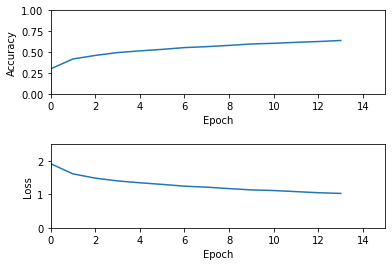

  0%|          | 0/25000 [00:00<?, ?it/s]


D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/14a0model.ckpt Model Saved...
Epoch [350000], loss: 0.5232, acc: 1.0000
Epoch [350001], loss: 0.0430, acc: 1.0000
Epoch [350002], loss: 0.8016, acc: 0.0000
Epoch [350003], loss: 1.0734, acc: 0.0000
Epoch [350004], loss: 1.2920, acc: 0.0000
Epoch [350005], loss: 0.7936, acc: 1.0000
Epoch [350006], loss: 2.6124, acc: 0.0000
Epoch [350007], loss: 0.3849, acc: 1.0000
Epoch [350008], loss: 0.1179, acc: 1.0000
Epoch [350009], loss: 1.4581, acc: 0.0000
Epoch [350010], loss: 0.4216, acc: 1.0000
Epoch [350011], loss: 3.2092, acc: 0.0000
Epoch [350012], loss: 0.1427, acc: 1.0000
Epoch [350013], loss: 0.0527, acc: 1.0000
Epoch [350014], loss: 0.0377, acc: 1.0000
Epoch [350015], loss: 0.1677, acc: 1.0000
Epoch [350016], loss: 1.3073, acc: 1.0000
Epoch [350017], loss: 1.0324, acc: 0.0000
Epoch [350018], loss: 2.9047, acc: 0.0000
Epoch [350019], loss: 0.0142, acc: 1.0000
Epoch [350020], loss: 0.5262, acc: 1.0000
Epoch [350021]

Epoch [350205], loss: 0.1247, acc: 1.0000
Epoch [350206], loss: 1.3090, acc: 0.0000
Epoch [350207], loss: 1.4829, acc: 0.0000
Epoch [350208], loss: 0.1485, acc: 1.0000
Epoch [350209], loss: 2.9142, acc: 0.0000
Epoch [350210], loss: 0.3966, acc: 1.0000
Epoch [350211], loss: 1.5076, acc: 0.0000
Epoch [350212], loss: 1.9347, acc: 0.0000
Epoch [350213], loss: 0.1610, acc: 1.0000
Epoch [350214], loss: 0.7550, acc: 1.0000
Epoch [350215], loss: 3.0944, acc: 0.0000
Epoch [350216], loss: 0.3829, acc: 1.0000
Epoch [350217], loss: 1.1546, acc: 1.0000
Epoch [350218], loss: 2.7043, acc: 0.0000
Epoch [350219], loss: 1.0198, acc: 1.0000
Epoch [350220], loss: 0.6647, acc: 1.0000
Epoch [350221], loss: 0.1324, acc: 1.0000
Epoch [350222], loss: 0.0417, acc: 1.0000
Epoch [350223], loss: 2.4160, acc: 0.0000
Epoch [350224], loss: 0.2787, acc: 1.0000
Epoch [350225], loss: 2.1438, acc: 0.0000
Epoch [350226], loss: 2.4903, acc: 0.0000
Epoch [350227], loss: 3.0957, acc: 0.0000
Epoch [350228], loss: 2.3288, acc:

Epoch [350402], loss: 0.3790, acc: 1.0000
Epoch [350403], loss: 0.8416, acc: 1.0000
Epoch [350404], loss: 0.0972, acc: 1.0000
Epoch [350405], loss: 0.6104, acc: 1.0000
Epoch [350406], loss: 0.2053, acc: 1.0000
Epoch [350407], loss: 1.6568, acc: 0.0000
Epoch [350408], loss: 0.7964, acc: 1.0000
Epoch [350409], loss: 0.4962, acc: 1.0000
Epoch [350410], loss: 0.4588, acc: 1.0000
Epoch [350411], loss: 1.3589, acc: 0.0000
Epoch [350412], loss: 0.5628, acc: 1.0000
Epoch [350413], loss: 1.8875, acc: 0.0000
Epoch [350414], loss: 0.1834, acc: 1.0000
Epoch [350415], loss: 1.4454, acc: 0.0000
Epoch [350416], loss: 0.5022, acc: 1.0000
Epoch [350417], loss: 0.1674, acc: 1.0000
Epoch [350418], loss: 0.5334, acc: 1.0000
Epoch [350419], loss: 1.6001, acc: 0.0000
Epoch [350420], loss: 0.5543, acc: 1.0000
Epoch [350421], loss: 0.2206, acc: 1.0000
Epoch [350422], loss: 0.1118, acc: 1.0000
Epoch [350423], loss: 1.1396, acc: 0.0000
Epoch [350424], loss: 0.4784, acc: 1.0000
Epoch [350425], loss: 1.3621, acc:

Epoch [350621], loss: 2.5997, acc: 0.0000
Epoch [350622], loss: 1.2328, acc: 1.0000
Epoch [350623], loss: 0.0369, acc: 1.0000
Epoch [350624], loss: 0.3184, acc: 1.0000
Epoch [350625], loss: 0.9183, acc: 1.0000
Epoch [350626], loss: 0.3233, acc: 1.0000
Epoch [350627], loss: 0.4454, acc: 1.0000
Epoch [350628], loss: 0.7229, acc: 1.0000
Epoch [350629], loss: 1.1550, acc: 0.0000
Epoch [350630], loss: 0.0917, acc: 1.0000
Epoch [350631], loss: 1.1348, acc: 0.0000
Epoch [350632], loss: 0.7458, acc: 1.0000
Epoch [350633], loss: 1.1450, acc: 1.0000
Epoch [350634], loss: 0.0063, acc: 1.0000
Epoch [350635], loss: 0.4084, acc: 1.0000
Epoch [350636], loss: 0.0732, acc: 1.0000
Epoch [350637], loss: 0.0218, acc: 1.0000
Epoch [350638], loss: 0.7118, acc: 1.0000
Epoch [350639], loss: 1.5362, acc: 0.0000
Epoch [350640], loss: 1.4589, acc: 0.0000
Epoch [350641], loss: 0.1131, acc: 1.0000
Epoch [350642], loss: 0.8613, acc: 1.0000
Epoch [350643], loss: 0.1056, acc: 1.0000
Epoch [350644], loss: 1.5762, acc:

Epoch [350838], loss: 0.0968, acc: 1.0000
Epoch [350839], loss: 0.4298, acc: 1.0000
Epoch [350840], loss: 2.2972, acc: 0.0000
Epoch [350841], loss: 0.3171, acc: 1.0000
Epoch [350842], loss: 0.0847, acc: 1.0000
Epoch [350843], loss: 0.2942, acc: 1.0000
Epoch [350844], loss: 1.3388, acc: 0.0000
Epoch [350845], loss: 3.8165, acc: 0.0000
Epoch [350846], loss: 1.4791, acc: 0.0000
Epoch [350847], loss: 2.7462, acc: 0.0000
Epoch [350848], loss: 0.7693, acc: 1.0000
Epoch [350849], loss: 2.7743, acc: 0.0000
Epoch [350850], loss: 0.8064, acc: 0.0000
Epoch [350851], loss: 0.8153, acc: 1.0000
Epoch [350852], loss: 0.0524, acc: 1.0000
Epoch [350853], loss: 1.2849, acc: 0.0000
Epoch [350854], loss: 2.4143, acc: 0.0000
Epoch [350855], loss: 0.8903, acc: 1.0000
Epoch [350856], loss: 2.6267, acc: 0.0000
Epoch [350857], loss: 0.4912, acc: 1.0000
Epoch [350858], loss: 0.4801, acc: 1.0000
Epoch [350859], loss: 3.9389, acc: 0.0000
Epoch [350860], loss: 1.4932, acc: 0.0000
Epoch [350861], loss: 1.0490, acc:

Epoch [351037], loss: 0.7987, acc: 0.0000
Epoch [351038], loss: 0.2261, acc: 1.0000
Epoch [351039], loss: 0.6794, acc: 1.0000
Epoch [351040], loss: 0.1099, acc: 1.0000
Epoch [351041], loss: 0.6783, acc: 1.0000
Epoch [351042], loss: 0.4984, acc: 1.0000
Epoch [351043], loss: 0.4735, acc: 1.0000
Epoch [351044], loss: 0.6012, acc: 1.0000
Epoch [351045], loss: 0.6690, acc: 1.0000
Epoch [351046], loss: 0.4092, acc: 1.0000
Epoch [351047], loss: 0.0637, acc: 1.0000
Epoch [351048], loss: 0.2604, acc: 1.0000
Epoch [351049], loss: 0.3760, acc: 1.0000
Epoch [351050], loss: 0.0257, acc: 1.0000
Epoch [351051], loss: 1.0078, acc: 1.0000
Epoch [351052], loss: 1.5371, acc: 0.0000
Epoch [351053], loss: 1.6576, acc: 0.0000
Epoch [351054], loss: 0.1835, acc: 1.0000
Epoch [351055], loss: 2.9144, acc: 0.0000
Epoch [351056], loss: 1.0522, acc: 0.0000
Epoch [351057], loss: 2.4374, acc: 0.0000
Epoch [351058], loss: 0.3366, acc: 1.0000
Epoch [351059], loss: 0.3779, acc: 1.0000
Epoch [351060], loss: 0.2924, acc:

Epoch [351254], loss: 0.8099, acc: 1.0000
Epoch [351255], loss: 0.3663, acc: 1.0000
Epoch [351256], loss: 1.0653, acc: 0.0000
Epoch [351257], loss: 1.3781, acc: 0.0000
Epoch [351258], loss: 0.1505, acc: 1.0000
Epoch [351259], loss: 2.1410, acc: 0.0000
Epoch [351260], loss: 0.1644, acc: 1.0000
Epoch [351261], loss: 0.3143, acc: 1.0000
Epoch [351262], loss: 3.0464, acc: 0.0000
Epoch [351263], loss: 0.4670, acc: 1.0000
Epoch [351264], loss: 0.5267, acc: 1.0000
Epoch [351265], loss: 1.8938, acc: 0.0000
Epoch [351266], loss: 0.3881, acc: 1.0000
Epoch [351267], loss: 0.0015, acc: 1.0000
Epoch [351268], loss: 0.6099, acc: 1.0000
Epoch [351269], loss: 0.7454, acc: 1.0000
Epoch [351270], loss: 0.3265, acc: 1.0000
Epoch [351271], loss: 0.9383, acc: 1.0000
Epoch [351272], loss: 0.0170, acc: 1.0000
Epoch [351273], loss: 0.5433, acc: 1.0000
Epoch [351274], loss: 0.8873, acc: 1.0000
Epoch [351275], loss: 0.3837, acc: 1.0000
Epoch [351276], loss: 0.1624, acc: 1.0000
Epoch [351277], loss: 1.1250, acc:

Epoch [351466], loss: 1.6054, acc: 0.0000
Epoch [351467], loss: 0.9499, acc: 1.0000
Epoch [351468], loss: 0.4407, acc: 1.0000
Epoch [351469], loss: 0.1315, acc: 1.0000
Epoch [351470], loss: 0.2295, acc: 1.0000
Epoch [351471], loss: 0.2924, acc: 1.0000
Epoch [351472], loss: 0.6588, acc: 1.0000
Epoch [351473], loss: 1.8087, acc: 0.0000
Epoch [351474], loss: 0.2734, acc: 1.0000
Epoch [351475], loss: 0.0818, acc: 1.0000
Epoch [351476], loss: 0.4395, acc: 1.0000
Epoch [351477], loss: 0.5974, acc: 1.0000
Epoch [351478], loss: 1.1630, acc: 0.0000
Epoch [351479], loss: 1.1532, acc: 0.0000
Epoch [351480], loss: 0.2469, acc: 1.0000
Epoch [351481], loss: 0.5050, acc: 1.0000
Epoch [351482], loss: 0.2304, acc: 1.0000
Epoch [351483], loss: 1.5516, acc: 0.0000
Epoch [351484], loss: 0.0563, acc: 1.0000
Epoch [351485], loss: 0.2434, acc: 1.0000
Epoch [351486], loss: 0.0466, acc: 1.0000
Epoch [351487], loss: 2.6083, acc: 0.0000
Epoch [351488], loss: 1.2677, acc: 0.0000
Epoch [351489], loss: 0.5141, acc:

Epoch [351682], loss: 0.8920, acc: 1.0000
Epoch [351683], loss: 0.1096, acc: 1.0000
Epoch [351684], loss: 0.2255, acc: 1.0000
Epoch [351685], loss: 1.0790, acc: 0.0000
Epoch [351686], loss: 1.3212, acc: 0.0000
Epoch [351687], loss: 0.1432, acc: 1.0000
Epoch [351688], loss: 0.3545, acc: 1.0000
Epoch [351689], loss: 1.0750, acc: 0.0000
Epoch [351690], loss: 0.2290, acc: 1.0000
Epoch [351691], loss: 0.7297, acc: 1.0000
Epoch [351692], loss: 2.2316, acc: 0.0000
Epoch [351693], loss: 0.0918, acc: 1.0000
Epoch [351694], loss: 0.5392, acc: 1.0000
Epoch [351695], loss: 0.0198, acc: 1.0000
Epoch [351696], loss: 1.4101, acc: 0.0000
Epoch [351697], loss: 0.0525, acc: 1.0000
Epoch [351698], loss: 0.0204, acc: 1.0000
Epoch [351699], loss: 1.3899, acc: 0.0000
Epoch [351700], loss: 0.1240, acc: 1.0000
Epoch [351701], loss: 3.0104, acc: 0.0000
Epoch [351702], loss: 0.3008, acc: 1.0000
Epoch [351703], loss: 1.3896, acc: 0.0000
Epoch [351704], loss: 3.6836, acc: 0.0000
Epoch [351705], loss: 0.0456, acc:

Epoch [351885], loss: 1.1233, acc: 0.0000
Epoch [351886], loss: 0.0084, acc: 1.0000
Epoch [351887], loss: 0.9010, acc: 1.0000
Epoch [351888], loss: 1.3959, acc: 0.0000
Epoch [351889], loss: 1.0543, acc: 1.0000
Epoch [351890], loss: 1.9746, acc: 0.0000
Epoch [351891], loss: 1.4720, acc: 0.0000
Epoch [351892], loss: 0.4188, acc: 1.0000
Epoch [351893], loss: 0.9600, acc: 1.0000
Epoch [351894], loss: 0.2895, acc: 1.0000
Epoch [351895], loss: 1.6561, acc: 0.0000
Epoch [351896], loss: 1.3102, acc: 1.0000
Epoch [351897], loss: 1.7403, acc: 0.0000
Epoch [351898], loss: 0.6036, acc: 1.0000
Epoch [351899], loss: 4.1173, acc: 0.0000
Epoch [351900], loss: 0.5809, acc: 1.0000
Epoch [351901], loss: 1.4077, acc: 0.0000
Epoch [351902], loss: 2.0941, acc: 0.0000
Epoch [351903], loss: 0.7876, acc: 1.0000
Epoch [351904], loss: 0.0110, acc: 1.0000
Epoch [351905], loss: 2.0602, acc: 0.0000
Epoch [351906], loss: 0.1520, acc: 1.0000
Epoch [351907], loss: 0.9622, acc: 1.0000
Epoch [351908], loss: 0.2481, acc:

Epoch [352091], loss: 0.0654, acc: 1.0000
Epoch [352092], loss: 3.1243, acc: 0.0000
Epoch [352093], loss: 0.2881, acc: 1.0000
Epoch [352094], loss: 2.3034, acc: 0.0000
Epoch [352095], loss: 1.1382, acc: 1.0000
Epoch [352096], loss: 0.1964, acc: 1.0000
Epoch [352097], loss: 1.5300, acc: 0.0000
Epoch [352098], loss: 1.2337, acc: 1.0000
Epoch [352099], loss: 0.3064, acc: 1.0000
Epoch [352100], loss: 2.4760, acc: 0.0000
Epoch [352101], loss: 0.3099, acc: 1.0000
Epoch [352102], loss: 2.3713, acc: 0.0000
Epoch [352103], loss: 1.9697, acc: 0.0000
Epoch [352104], loss: 1.8591, acc: 0.0000
Epoch [352105], loss: 0.1582, acc: 1.0000
Epoch [352106], loss: 0.0693, acc: 1.0000
Epoch [352107], loss: 0.0388, acc: 1.0000
Epoch [352108], loss: 0.2095, acc: 1.0000
Epoch [352109], loss: 2.0748, acc: 0.0000
Epoch [352110], loss: 4.9945, acc: 0.0000
Epoch [352111], loss: 2.4376, acc: 0.0000
Epoch [352112], loss: 0.5956, acc: 1.0000
Epoch [352113], loss: 1.2018, acc: 0.0000
Epoch [352114], loss: 1.4104, acc:

Epoch [352310], loss: 3.5535, acc: 0.0000
Epoch [352311], loss: 0.1228, acc: 1.0000
Epoch [352312], loss: 0.8365, acc: 1.0000
Epoch [352313], loss: 0.1637, acc: 1.0000
Epoch [352314], loss: 1.8532, acc: 0.0000
Epoch [352315], loss: 0.8049, acc: 0.0000
Epoch [352316], loss: 0.0283, acc: 1.0000
Epoch [352317], loss: 1.3580, acc: 0.0000
Epoch [352318], loss: 1.7742, acc: 0.0000
Epoch [352319], loss: 4.1736, acc: 0.0000
Epoch [352320], loss: 0.2261, acc: 1.0000
Epoch [352321], loss: 1.3630, acc: 1.0000
Epoch [352322], loss: 1.8898, acc: 0.0000
Epoch [352323], loss: 2.8586, acc: 0.0000
Epoch [352324], loss: 0.1477, acc: 1.0000
Epoch [352325], loss: 2.6278, acc: 0.0000
Epoch [352326], loss: 1.6621, acc: 0.0000
Epoch [352327], loss: 0.0670, acc: 1.0000
Epoch [352328], loss: 1.3321, acc: 0.0000
Epoch [352329], loss: 1.5138, acc: 0.0000
Epoch [352330], loss: 0.1325, acc: 1.0000
Epoch [352331], loss: 0.5023, acc: 1.0000
Epoch [352332], loss: 1.4067, acc: 0.0000
Epoch [352333], loss: 0.6374, acc:

Epoch [352510], loss: 0.4987, acc: 1.0000
Epoch [352511], loss: 0.5342, acc: 1.0000
Epoch [352512], loss: 0.0023, acc: 1.0000
Epoch [352513], loss: 1.3699, acc: 0.0000
Epoch [352514], loss: 0.0820, acc: 1.0000
Epoch [352515], loss: 0.0300, acc: 1.0000
Epoch [352516], loss: 0.7480, acc: 1.0000
Epoch [352517], loss: 1.5204, acc: 0.0000
Epoch [352518], loss: 0.1964, acc: 1.0000
Epoch [352519], loss: 2.9855, acc: 0.0000
Epoch [352520], loss: 2.5876, acc: 0.0000
Epoch [352521], loss: 2.7738, acc: 0.0000
Epoch [352522], loss: 0.4528, acc: 1.0000
Epoch [352523], loss: 0.2529, acc: 1.0000
Epoch [352524], loss: 1.3807, acc: 0.0000
Epoch [352525], loss: 1.4278, acc: 0.0000
Epoch [352526], loss: 1.6619, acc: 0.0000
Epoch [352527], loss: 1.0753, acc: 1.0000
Epoch [352528], loss: 0.9632, acc: 0.0000
Epoch [352529], loss: 2.0688, acc: 0.0000
Epoch [352530], loss: 0.0339, acc: 1.0000
Epoch [352531], loss: 4.9688, acc: 0.0000
Epoch [352532], loss: 0.0087, acc: 1.0000
Epoch [352533], loss: 0.3042, acc:

Epoch [352719], loss: 1.9312, acc: 0.0000
Epoch [352720], loss: 0.9495, acc: 1.0000
Epoch [352721], loss: 0.6123, acc: 1.0000
Epoch [352722], loss: 0.1320, acc: 1.0000
Epoch [352723], loss: 0.4869, acc: 1.0000
Epoch [352724], loss: 2.6770, acc: 0.0000
Epoch [352725], loss: 1.8977, acc: 0.0000
Epoch [352726], loss: 0.0553, acc: 1.0000
Epoch [352727], loss: 1.4713, acc: 1.0000
Epoch [352728], loss: 0.3527, acc: 1.0000
Epoch [352729], loss: 0.1079, acc: 1.0000
Epoch [352730], loss: 0.0393, acc: 1.0000
Epoch [352731], loss: 0.4507, acc: 1.0000
Epoch [352732], loss: 0.8491, acc: 1.0000
Epoch [352733], loss: 0.2975, acc: 1.0000
Epoch [352734], loss: 0.9760, acc: 1.0000
Epoch [352735], loss: 0.0237, acc: 1.0000
Epoch [352736], loss: 0.2419, acc: 1.0000
Epoch [352737], loss: 0.0010, acc: 1.0000
Epoch [352738], loss: 0.0338, acc: 1.0000
Epoch [352739], loss: 0.3339, acc: 1.0000
Epoch [352740], loss: 2.6708, acc: 0.0000
Epoch [352741], loss: 1.1782, acc: 0.0000
Epoch [352742], loss: 2.1648, acc:

Epoch [352931], loss: 1.9930, acc: 0.0000
Epoch [352932], loss: 0.9290, acc: 1.0000
Epoch [352933], loss: 2.6785, acc: 0.0000
Epoch [352934], loss: 0.7211, acc: 1.0000
Epoch [352935], loss: 1.0600, acc: 0.0000
Epoch [352936], loss: 0.5802, acc: 1.0000
Epoch [352937], loss: 3.4173, acc: 0.0000
Epoch [352938], loss: 0.3401, acc: 1.0000
Epoch [352939], loss: 0.5550, acc: 1.0000
Epoch [352940], loss: 3.9118, acc: 0.0000
Epoch [352941], loss: 2.7340, acc: 0.0000
Epoch [352942], loss: 1.8167, acc: 0.0000
Epoch [352943], loss: 0.5363, acc: 1.0000
Epoch [352944], loss: 1.0434, acc: 1.0000
Epoch [352945], loss: 0.7995, acc: 1.0000
Epoch [352946], loss: 0.4110, acc: 1.0000
Epoch [352947], loss: 1.1024, acc: 0.0000
Epoch [352948], loss: 0.4625, acc: 1.0000
Epoch [352949], loss: 0.5268, acc: 1.0000
Epoch [352950], loss: 1.2259, acc: 0.0000
Epoch [352951], loss: 1.5238, acc: 0.0000
Epoch [352952], loss: 1.3351, acc: 1.0000
Epoch [352953], loss: 1.1957, acc: 0.0000
Epoch [352954], loss: 1.6891, acc:

Epoch [353132], loss: 1.3287, acc: 0.0000
Epoch [353133], loss: 0.6729, acc: 1.0000
Epoch [353134], loss: 0.0366, acc: 1.0000
Epoch [353135], loss: 4.8136, acc: 0.0000
Epoch [353136], loss: 1.0357, acc: 1.0000
Epoch [353137], loss: 1.5702, acc: 0.0000
Epoch [353138], loss: 1.8453, acc: 0.0000
Epoch [353139], loss: 0.7210, acc: 1.0000
Epoch [353140], loss: 1.2176, acc: 1.0000
Epoch [353141], loss: 1.2730, acc: 0.0000
Epoch [353142], loss: 0.8586, acc: 1.0000
Epoch [353143], loss: 0.5743, acc: 1.0000
Epoch [353144], loss: 0.3903, acc: 1.0000
Epoch [353145], loss: 2.4931, acc: 0.0000
Epoch [353146], loss: 0.0061, acc: 1.0000
Epoch [353147], loss: 1.5771, acc: 0.0000
Epoch [353148], loss: 1.5990, acc: 0.0000
Epoch [353149], loss: 0.2159, acc: 1.0000
Epoch [353150], loss: 0.3217, acc: 1.0000
Epoch [353151], loss: 1.1390, acc: 0.0000
Epoch [353152], loss: 1.1364, acc: 0.0000
Epoch [353153], loss: 1.8928, acc: 0.0000
Epoch [353154], loss: 0.7762, acc: 0.0000
Epoch [353155], loss: 1.6351, acc:

Epoch [353328], loss: 2.3384, acc: 0.0000
Epoch [353329], loss: 0.6652, acc: 1.0000
Epoch [353330], loss: 0.1918, acc: 1.0000
Epoch [353331], loss: 1.5199, acc: 0.0000
Epoch [353332], loss: 0.2764, acc: 1.0000
Epoch [353333], loss: 0.8639, acc: 1.0000
Epoch [353334], loss: 0.3305, acc: 1.0000
Epoch [353335], loss: 0.5350, acc: 1.0000
Epoch [353336], loss: 2.3536, acc: 0.0000
Epoch [353337], loss: 0.0108, acc: 1.0000
Epoch [353338], loss: 1.2464, acc: 1.0000
Epoch [353339], loss: 0.1505, acc: 1.0000
Epoch [353340], loss: 0.0485, acc: 1.0000
Epoch [353341], loss: 3.1331, acc: 0.0000
Epoch [353342], loss: 1.4688, acc: 0.0000
Epoch [353343], loss: 0.7934, acc: 1.0000
Epoch [353344], loss: 0.9219, acc: 0.0000
Epoch [353345], loss: 0.2271, acc: 1.0000
Epoch [353346], loss: 0.4807, acc: 1.0000
Epoch [353347], loss: 1.1444, acc: 1.0000
Epoch [353348], loss: 2.7109, acc: 0.0000
Epoch [353349], loss: 1.8400, acc: 0.0000
Epoch [353350], loss: 4.6417, acc: 0.0000
Epoch [353351], loss: 0.0326, acc:

Epoch [353533], loss: 0.0381, acc: 1.0000
Epoch [353534], loss: 0.5744, acc: 1.0000
Epoch [353535], loss: 1.7186, acc: 0.0000
Epoch [353536], loss: 0.7336, acc: 1.0000
Epoch [353537], loss: 1.3488, acc: 1.0000
Epoch [353538], loss: 0.2039, acc: 1.0000
Epoch [353539], loss: 0.0946, acc: 1.0000
Epoch [353540], loss: 0.2738, acc: 1.0000
Epoch [353541], loss: 0.0947, acc: 1.0000
Epoch [353542], loss: 1.2442, acc: 1.0000
Epoch [353543], loss: 1.2967, acc: 0.0000
Epoch [353544], loss: 3.2024, acc: 0.0000
Epoch [353545], loss: 0.1702, acc: 1.0000
Epoch [353546], loss: 0.7046, acc: 1.0000
Epoch [353547], loss: 0.0328, acc: 1.0000
Epoch [353548], loss: 0.5546, acc: 1.0000
Epoch [353549], loss: 3.6629, acc: 0.0000
Epoch [353550], loss: 0.0581, acc: 1.0000
Epoch [353551], loss: 0.0520, acc: 1.0000
Epoch [353552], loss: 0.4923, acc: 1.0000
Epoch [353553], loss: 0.9911, acc: 0.0000
Epoch [353554], loss: 0.0556, acc: 1.0000
Epoch [353555], loss: 0.2970, acc: 1.0000
Epoch [353556], loss: 0.9479, acc:

Epoch [353740], loss: 0.8416, acc: 1.0000
Epoch [353741], loss: 0.1607, acc: 1.0000
Epoch [353742], loss: 1.8813, acc: 0.0000
Epoch [353743], loss: 2.1908, acc: 0.0000
Epoch [353744], loss: 1.2999, acc: 0.0000
Epoch [353745], loss: 2.4699, acc: 0.0000
Epoch [353746], loss: 1.4989, acc: 0.0000
Epoch [353747], loss: 0.1279, acc: 1.0000
Epoch [353748], loss: 0.3107, acc: 1.0000
Epoch [353749], loss: 1.3118, acc: 0.0000
Epoch [353750], loss: 0.1019, acc: 1.0000
Epoch [353751], loss: 0.1919, acc: 1.0000
Epoch [353752], loss: 0.0635, acc: 1.0000
Epoch [353753], loss: 0.5529, acc: 1.0000
Epoch [353754], loss: 1.4345, acc: 0.0000
Epoch [353755], loss: 0.2887, acc: 1.0000
Epoch [353756], loss: 0.3231, acc: 1.0000
Epoch [353757], loss: 0.1101, acc: 1.0000
Epoch [353758], loss: 1.1880, acc: 1.0000
Epoch [353759], loss: 0.2388, acc: 1.0000
Epoch [353760], loss: 2.0437, acc: 0.0000
Epoch [353761], loss: 2.3448, acc: 0.0000
Epoch [353762], loss: 0.1925, acc: 1.0000
Epoch [353763], loss: 5.2904, acc:

Epoch [353936], loss: 0.3806, acc: 1.0000
Epoch [353937], loss: 0.2883, acc: 1.0000
Epoch [353938], loss: 0.0147, acc: 1.0000
Epoch [353939], loss: 0.6596, acc: 1.0000
Epoch [353940], loss: 2.3863, acc: 0.0000
Epoch [353941], loss: 0.6130, acc: 1.0000
Epoch [353942], loss: 0.1550, acc: 1.0000
Epoch [353943], loss: 1.3130, acc: 0.0000
Epoch [353944], loss: 0.4924, acc: 1.0000
Epoch [353945], loss: 0.0734, acc: 1.0000
Epoch [353946], loss: 0.3287, acc: 1.0000
Epoch [353947], loss: 0.0637, acc: 1.0000
Epoch [353948], loss: 0.0750, acc: 1.0000
Epoch [353949], loss: 0.4836, acc: 1.0000
Epoch [353950], loss: 1.0127, acc: 1.0000
Epoch [353951], loss: 0.0127, acc: 1.0000
Epoch [353952], loss: 2.7850, acc: 0.0000
Epoch [353953], loss: 0.4896, acc: 1.0000
Epoch [353954], loss: 0.6327, acc: 1.0000
Epoch [353955], loss: 0.1354, acc: 1.0000
Epoch [353956], loss: 0.1620, acc: 1.0000
Epoch [353957], loss: 1.6453, acc: 0.0000
Epoch [353958], loss: 1.6435, acc: 0.0000
Epoch [353959], loss: 0.5599, acc:

Epoch [354159], loss: 1.9907, acc: 0.0000
Epoch [354160], loss: 1.1680, acc: 1.0000
Epoch [354161], loss: 0.2022, acc: 1.0000
Epoch [354162], loss: 1.1913, acc: 1.0000
Epoch [354163], loss: 0.3410, acc: 1.0000
Epoch [354164], loss: 0.3680, acc: 1.0000
Epoch [354165], loss: 0.5786, acc: 1.0000
Epoch [354166], loss: 1.1667, acc: 1.0000
Epoch [354167], loss: 0.9991, acc: 1.0000
Epoch [354168], loss: 0.2589, acc: 1.0000
Epoch [354169], loss: 0.2659, acc: 1.0000
Epoch [354170], loss: 0.7749, acc: 1.0000
Epoch [354171], loss: 0.8359, acc: 1.0000
Epoch [354172], loss: 0.4568, acc: 1.0000
Epoch [354173], loss: 0.6847, acc: 1.0000
Epoch [354174], loss: 3.1084, acc: 0.0000
Epoch [354175], loss: 0.6581, acc: 1.0000
Epoch [354176], loss: 0.9748, acc: 0.0000
Epoch [354177], loss: 0.4951, acc: 1.0000
Epoch [354178], loss: 0.4130, acc: 1.0000
Epoch [354179], loss: 0.5851, acc: 1.0000
Epoch [354180], loss: 1.5466, acc: 0.0000
Epoch [354181], loss: 0.5610, acc: 1.0000
Epoch [354182], loss: 1.3640, acc:

Epoch [354364], loss: 0.0738, acc: 1.0000
Epoch [354365], loss: 1.1811, acc: 1.0000
Epoch [354366], loss: 0.0489, acc: 1.0000
Epoch [354367], loss: 0.3410, acc: 1.0000
Epoch [354368], loss: 0.4206, acc: 1.0000
Epoch [354369], loss: 1.1064, acc: 0.0000
Epoch [354370], loss: 0.6010, acc: 1.0000
Epoch [354371], loss: 0.1013, acc: 1.0000
Epoch [354372], loss: 0.5488, acc: 1.0000
Epoch [354373], loss: 0.1056, acc: 1.0000
Epoch [354374], loss: 0.0521, acc: 1.0000
Epoch [354375], loss: 1.1623, acc: 0.0000
Epoch [354376], loss: 1.7876, acc: 0.0000
Epoch [354377], loss: 0.5210, acc: 1.0000
Epoch [354378], loss: 1.8680, acc: 0.0000
Epoch [354379], loss: 0.0018, acc: 1.0000
Epoch [354380], loss: 1.9080, acc: 0.0000
Epoch [354381], loss: 0.1477, acc: 1.0000
Epoch [354382], loss: 2.1755, acc: 0.0000
Epoch [354383], loss: 0.6950, acc: 1.0000
Epoch [354384], loss: 0.1443, acc: 1.0000
Epoch [354385], loss: 5.3654, acc: 0.0000
Epoch [354386], loss: 1.6302, acc: 0.0000
Epoch [354387], loss: 0.0215, acc:

Epoch [354572], loss: 0.1927, acc: 1.0000
Epoch [354573], loss: 0.1214, acc: 1.0000
Epoch [354574], loss: 1.9534, acc: 0.0000
Epoch [354575], loss: 1.1422, acc: 1.0000
Epoch [354576], loss: 1.2504, acc: 0.0000
Epoch [354577], loss: 0.0354, acc: 1.0000
Epoch [354578], loss: 2.8616, acc: 0.0000
Epoch [354579], loss: 1.5165, acc: 0.0000
Epoch [354580], loss: 0.3989, acc: 1.0000
Epoch [354581], loss: 0.2166, acc: 1.0000
Epoch [354582], loss: 1.0765, acc: 1.0000
Epoch [354583], loss: 2.2104, acc: 0.0000
Epoch [354584], loss: 0.0547, acc: 1.0000
Epoch [354585], loss: 1.4036, acc: 0.0000
Epoch [354586], loss: 1.3125, acc: 0.0000
Epoch [354587], loss: 3.8921, acc: 0.0000
Epoch [354588], loss: 0.4846, acc: 1.0000
Epoch [354589], loss: 0.8798, acc: 0.0000
Epoch [354590], loss: 1.8068, acc: 0.0000
Epoch [354591], loss: 0.3646, acc: 1.0000
Epoch [354592], loss: 2.0580, acc: 0.0000
Epoch [354593], loss: 0.0063, acc: 1.0000
Epoch [354594], loss: 0.7345, acc: 1.0000
Epoch [354595], loss: 3.1809, acc:

Epoch [354785], loss: 0.0798, acc: 1.0000
Epoch [354786], loss: 0.5105, acc: 1.0000
Epoch [354787], loss: 0.9049, acc: 1.0000
Epoch [354788], loss: 0.0726, acc: 1.0000
Epoch [354789], loss: 0.3573, acc: 1.0000
Epoch [354790], loss: 0.0625, acc: 1.0000
Epoch [354791], loss: 4.2339, acc: 0.0000
Epoch [354792], loss: 0.8166, acc: 1.0000
Epoch [354793], loss: 3.0753, acc: 0.0000
Epoch [354794], loss: 1.1679, acc: 0.0000
Epoch [354795], loss: 0.1701, acc: 1.0000
Epoch [354796], loss: 2.3146, acc: 0.0000
Epoch [354797], loss: 0.2300, acc: 1.0000
Epoch [354798], loss: 0.0537, acc: 1.0000
Epoch [354799], loss: 0.0832, acc: 1.0000
Epoch [354800], loss: 2.4923, acc: 0.0000
Epoch [354801], loss: 0.7233, acc: 1.0000
Epoch [354802], loss: 0.5511, acc: 1.0000
Epoch [354803], loss: 0.9539, acc: 1.0000
Epoch [354804], loss: 0.0347, acc: 1.0000
Epoch [354805], loss: 0.0233, acc: 1.0000
Epoch [354806], loss: 0.7341, acc: 1.0000
Epoch [354807], loss: 0.7800, acc: 1.0000
Epoch [354808], loss: 1.5236, acc:

Epoch [354991], loss: 0.2440, acc: 1.0000
Epoch [354992], loss: 0.4636, acc: 1.0000
Epoch [354993], loss: 2.1858, acc: 0.0000
Epoch [354994], loss: 1.1396, acc: 0.0000
Epoch [354995], loss: 0.5320, acc: 1.0000
Epoch [354996], loss: 0.2437, acc: 1.0000
Epoch [354997], loss: 1.3400, acc: 0.0000
Epoch [354998], loss: 0.4354, acc: 1.0000
Epoch [354999], loss: 0.1883, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/14a5000model.ckpt Model Saved...
Epoch [355000], loss: 0.4905, acc: 1.0000
Epoch [355001], loss: 0.9750, acc: 1.0000
Epoch [355002], loss: 3.3622, acc: 0.0000
Epoch [355003], loss: 2.7305, acc: 0.0000
Epoch [355004], loss: 0.4456, acc: 1.0000
Epoch [355005], loss: 0.4977, acc: 1.0000
Epoch [355006], loss: 2.2507, acc: 0.0000
Epoch [355007], loss: 5.6837, acc: 0.0000
Epoch [355008], loss: 0.3248, acc: 1.0000
Epoch [355009], loss: 0.1148, acc: 1.0000
Epoch [355010], loss: 1.8892, acc: 0.0000
Epoch [355011], loss: 0.3408, acc: 1.0000
Epoch [3550

Epoch [355188], loss: 0.0436, acc: 1.0000
Epoch [355189], loss: 0.3786, acc: 1.0000
Epoch [355190], loss: 1.4494, acc: 0.0000
Epoch [355191], loss: 2.0090, acc: 0.0000
Epoch [355192], loss: 0.0633, acc: 1.0000
Epoch [355193], loss: 0.1743, acc: 1.0000
Epoch [355194], loss: 0.4173, acc: 1.0000
Epoch [355195], loss: 0.4907, acc: 1.0000
Epoch [355196], loss: 0.8800, acc: 1.0000
Epoch [355197], loss: 0.1909, acc: 1.0000
Epoch [355198], loss: 0.3976, acc: 1.0000
Epoch [355199], loss: 2.0157, acc: 0.0000
Epoch [355200], loss: 0.5806, acc: 1.0000
Epoch [355201], loss: 1.7432, acc: 0.0000
Epoch [355202], loss: 0.4744, acc: 1.0000
Epoch [355203], loss: 2.0058, acc: 0.0000
Epoch [355204], loss: 3.1654, acc: 0.0000
Epoch [355205], loss: 1.1934, acc: 0.0000
Epoch [355206], loss: 0.0140, acc: 1.0000
Epoch [355207], loss: 0.7806, acc: 1.0000
Epoch [355208], loss: 0.7822, acc: 1.0000
Epoch [355209], loss: 0.8709, acc: 1.0000
Epoch [355210], loss: 0.1079, acc: 1.0000
Epoch [355211], loss: 0.7054, acc:

Epoch [355399], loss: 0.0239, acc: 1.0000
Epoch [355400], loss: 0.8120, acc: 1.0000
Epoch [355401], loss: 1.3457, acc: 0.0000
Epoch [355402], loss: 0.0105, acc: 1.0000
Epoch [355403], loss: 0.0085, acc: 1.0000
Epoch [355404], loss: 1.9803, acc: 0.0000
Epoch [355405], loss: 3.7193, acc: 0.0000
Epoch [355406], loss: 2.2206, acc: 0.0000
Epoch [355407], loss: 1.2165, acc: 0.0000
Epoch [355408], loss: 0.3315, acc: 1.0000
Epoch [355409], loss: 0.7377, acc: 1.0000
Epoch [355410], loss: 0.0700, acc: 1.0000
Epoch [355411], loss: 0.1022, acc: 1.0000
Epoch [355412], loss: 0.5234, acc: 1.0000
Epoch [355413], loss: 0.6055, acc: 1.0000
Epoch [355414], loss: 0.3071, acc: 1.0000
Epoch [355415], loss: 0.1961, acc: 1.0000
Epoch [355416], loss: 1.0324, acc: 1.0000
Epoch [355417], loss: 0.3382, acc: 1.0000
Epoch [355418], loss: 0.3692, acc: 1.0000
Epoch [355419], loss: 0.0656, acc: 1.0000
Epoch [355420], loss: 0.2982, acc: 1.0000
Epoch [355421], loss: 0.1699, acc: 1.0000
Epoch [355422], loss: 1.3022, acc:

Epoch [355600], loss: 2.4287, acc: 0.0000
Epoch [355601], loss: 0.8192, acc: 1.0000
Epoch [355602], loss: 0.6567, acc: 1.0000
Epoch [355603], loss: 0.1780, acc: 1.0000
Epoch [355604], loss: 1.6279, acc: 0.0000
Epoch [355605], loss: 0.0258, acc: 1.0000
Epoch [355606], loss: 0.3189, acc: 1.0000
Epoch [355607], loss: 0.0438, acc: 1.0000
Epoch [355608], loss: 1.8557, acc: 0.0000
Epoch [355609], loss: 0.0200, acc: 1.0000
Epoch [355610], loss: 1.2309, acc: 0.0000
Epoch [355611], loss: 0.6769, acc: 1.0000
Epoch [355612], loss: 0.3166, acc: 1.0000
Epoch [355613], loss: 1.3504, acc: 0.0000
Epoch [355614], loss: 1.3976, acc: 0.0000
Epoch [355615], loss: 0.3637, acc: 1.0000
Epoch [355616], loss: 0.3667, acc: 1.0000
Epoch [355617], loss: 0.7054, acc: 1.0000
Epoch [355618], loss: 0.1193, acc: 1.0000
Epoch [355619], loss: 0.7144, acc: 1.0000
Epoch [355620], loss: 1.2647, acc: 0.0000
Epoch [355621], loss: 1.3414, acc: 0.0000
Epoch [355622], loss: 2.1434, acc: 0.0000
Epoch [355623], loss: 2.1063, acc:

Epoch [355808], loss: 1.4215, acc: 0.0000
Epoch [355809], loss: 0.1002, acc: 1.0000
Epoch [355810], loss: 0.0229, acc: 1.0000
Epoch [355811], loss: 2.8580, acc: 0.0000
Epoch [355812], loss: 0.9116, acc: 1.0000
Epoch [355813], loss: 0.6517, acc: 1.0000
Epoch [355814], loss: 2.1741, acc: 0.0000
Epoch [355815], loss: 2.4748, acc: 0.0000
Epoch [355816], loss: 2.1925, acc: 0.0000
Epoch [355817], loss: 1.5637, acc: 0.0000
Epoch [355818], loss: 0.8315, acc: 1.0000
Epoch [355819], loss: 1.6267, acc: 0.0000
Epoch [355820], loss: 1.0779, acc: 0.0000
Epoch [355821], loss: 3.2115, acc: 0.0000
Epoch [355822], loss: 2.2121, acc: 0.0000
Epoch [355823], loss: 1.1670, acc: 0.0000
Epoch [355824], loss: 0.0292, acc: 1.0000
Epoch [355825], loss: 0.1069, acc: 1.0000
Epoch [355826], loss: 0.0713, acc: 1.0000
Epoch [355827], loss: 0.8306, acc: 1.0000
Epoch [355828], loss: 0.5117, acc: 1.0000
Epoch [355829], loss: 0.3615, acc: 1.0000
Epoch [355830], loss: 0.6264, acc: 1.0000
Epoch [355831], loss: 0.0695, acc:

Epoch [356008], loss: 0.6092, acc: 1.0000
Epoch [356009], loss: 0.1356, acc: 1.0000
Epoch [356010], loss: 0.6476, acc: 1.0000
Epoch [356011], loss: 0.5302, acc: 1.0000
Epoch [356012], loss: 0.4160, acc: 1.0000
Epoch [356013], loss: 0.8380, acc: 0.0000
Epoch [356014], loss: 0.2052, acc: 1.0000
Epoch [356015], loss: 0.7310, acc: 1.0000
Epoch [356016], loss: 0.4652, acc: 1.0000
Epoch [356017], loss: 0.4112, acc: 1.0000
Epoch [356018], loss: 0.3381, acc: 1.0000
Epoch [356019], loss: 2.4437, acc: 0.0000
Epoch [356020], loss: 0.7403, acc: 1.0000
Epoch [356021], loss: 0.2978, acc: 1.0000
Epoch [356022], loss: 0.0809, acc: 1.0000
Epoch [356023], loss: 1.7519, acc: 0.0000
Epoch [356024], loss: 2.9480, acc: 0.0000
Epoch [356025], loss: 0.1962, acc: 1.0000
Epoch [356026], loss: 0.8932, acc: 0.0000
Epoch [356027], loss: 0.6252, acc: 1.0000
Epoch [356028], loss: 2.4208, acc: 0.0000
Epoch [356029], loss: 0.3731, acc: 1.0000
Epoch [356030], loss: 0.9634, acc: 1.0000
Epoch [356031], loss: 0.9656, acc:

Epoch [356221], loss: 0.4245, acc: 1.0000
Epoch [356222], loss: 0.3740, acc: 1.0000
Epoch [356223], loss: 0.2051, acc: 1.0000
Epoch [356224], loss: 1.4781, acc: 0.0000
Epoch [356225], loss: 0.2997, acc: 1.0000
Epoch [356226], loss: 1.2684, acc: 0.0000
Epoch [356227], loss: 0.2754, acc: 1.0000
Epoch [356228], loss: 1.4717, acc: 0.0000
Epoch [356229], loss: 0.0002, acc: 1.0000
Epoch [356230], loss: 0.2705, acc: 1.0000
Epoch [356231], loss: 0.0087, acc: 1.0000
Epoch [356232], loss: 1.1589, acc: 1.0000
Epoch [356233], loss: 1.0747, acc: 1.0000
Epoch [356234], loss: 0.4618, acc: 1.0000
Epoch [356235], loss: 0.1531, acc: 1.0000
Epoch [356236], loss: 0.3078, acc: 1.0000
Epoch [356237], loss: 0.6859, acc: 1.0000
Epoch [356238], loss: 0.2395, acc: 1.0000
Epoch [356239], loss: 0.0163, acc: 1.0000
Epoch [356240], loss: 0.2802, acc: 1.0000
Epoch [356241], loss: 0.3337, acc: 1.0000
Epoch [356242], loss: 0.6255, acc: 1.0000
Epoch [356243], loss: 0.0070, acc: 1.0000
Epoch [356244], loss: 0.1806, acc:

Epoch [356429], loss: 1.6576, acc: 0.0000
Epoch [356430], loss: 0.8096, acc: 1.0000
Epoch [356431], loss: 1.1272, acc: 1.0000
Epoch [356432], loss: 0.3875, acc: 1.0000
Epoch [356433], loss: 1.1700, acc: 0.0000
Epoch [356434], loss: 0.5715, acc: 1.0000
Epoch [356435], loss: 0.1361, acc: 1.0000
Epoch [356436], loss: 1.3506, acc: 0.0000
Epoch [356437], loss: 0.3024, acc: 1.0000
Epoch [356438], loss: 2.5293, acc: 0.0000
Epoch [356439], loss: 0.0819, acc: 1.0000
Epoch [356440], loss: 0.1932, acc: 1.0000
Epoch [356441], loss: 0.0152, acc: 1.0000
Epoch [356442], loss: 0.0508, acc: 1.0000
Epoch [356443], loss: 0.3411, acc: 1.0000
Epoch [356444], loss: 0.7007, acc: 1.0000
Epoch [356445], loss: 0.5974, acc: 1.0000
Epoch [356446], loss: 0.5468, acc: 1.0000
Epoch [356447], loss: 0.4299, acc: 1.0000
Epoch [356448], loss: 1.5594, acc: 0.0000
Epoch [356449], loss: 1.5957, acc: 0.0000
Epoch [356450], loss: 0.0547, acc: 1.0000
Epoch [356451], loss: 1.9563, acc: 0.0000
Epoch [356452], loss: 0.8655, acc:

Epoch [356634], loss: 3.6596, acc: 0.0000
Epoch [356635], loss: 0.1186, acc: 1.0000
Epoch [356636], loss: 0.0408, acc: 1.0000
Epoch [356637], loss: 0.3129, acc: 1.0000
Epoch [356638], loss: 1.2909, acc: 0.0000
Epoch [356639], loss: 1.4858, acc: 0.0000
Epoch [356640], loss: 0.0586, acc: 1.0000
Epoch [356641], loss: 1.7314, acc: 0.0000
Epoch [356642], loss: 0.0171, acc: 1.0000
Epoch [356643], loss: 1.9649, acc: 0.0000
Epoch [356644], loss: 1.9370, acc: 0.0000
Epoch [356645], loss: 0.2249, acc: 1.0000
Epoch [356646], loss: 1.0211, acc: 1.0000
Epoch [356647], loss: 0.0355, acc: 1.0000
Epoch [356648], loss: 0.6351, acc: 1.0000
Epoch [356649], loss: 2.3242, acc: 0.0000
Epoch [356650], loss: 0.0821, acc: 1.0000
Epoch [356651], loss: 1.1732, acc: 1.0000
Epoch [356652], loss: 0.0570, acc: 1.0000
Epoch [356653], loss: 0.6503, acc: 1.0000
Epoch [356654], loss: 2.6787, acc: 0.0000
Epoch [356655], loss: 0.1784, acc: 1.0000
Epoch [356656], loss: 0.6332, acc: 1.0000
Epoch [356657], loss: 0.0287, acc:

Epoch [356838], loss: 0.6638, acc: 1.0000
Epoch [356839], loss: 1.0132, acc: 1.0000
Epoch [356840], loss: 1.3946, acc: 0.0000
Epoch [356841], loss: 0.1419, acc: 1.0000
Epoch [356842], loss: 0.2094, acc: 1.0000
Epoch [356843], loss: 0.4694, acc: 1.0000
Epoch [356844], loss: 0.1121, acc: 1.0000
Epoch [356845], loss: 3.3264, acc: 0.0000
Epoch [356846], loss: 0.5928, acc: 1.0000
Epoch [356847], loss: 2.9355, acc: 0.0000
Epoch [356848], loss: 0.8182, acc: 1.0000
Epoch [356849], loss: 0.5903, acc: 1.0000
Epoch [356850], loss: 0.6077, acc: 1.0000
Epoch [356851], loss: 0.3388, acc: 1.0000
Epoch [356852], loss: 0.0069, acc: 1.0000
Epoch [356853], loss: 0.0908, acc: 1.0000
Epoch [356854], loss: 4.1837, acc: 0.0000
Epoch [356855], loss: 1.5656, acc: 0.0000
Epoch [356856], loss: 1.9876, acc: 0.0000
Epoch [356857], loss: 0.1119, acc: 1.0000
Epoch [356858], loss: 1.1230, acc: 1.0000
Epoch [356859], loss: 0.2868, acc: 1.0000
Epoch [356860], loss: 0.4309, acc: 1.0000
Epoch [356861], loss: 0.8666, acc:

Epoch [357044], loss: 3.0972, acc: 0.0000
Epoch [357045], loss: 0.3536, acc: 1.0000
Epoch [357046], loss: 0.0022, acc: 1.0000
Epoch [357047], loss: 0.2765, acc: 1.0000
Epoch [357048], loss: 0.0412, acc: 1.0000
Epoch [357049], loss: 0.1830, acc: 1.0000
Epoch [357050], loss: 0.3789, acc: 1.0000
Epoch [357051], loss: 0.0132, acc: 1.0000
Epoch [357052], loss: 3.9015, acc: 0.0000
Epoch [357053], loss: 0.0183, acc: 1.0000
Epoch [357054], loss: 0.0260, acc: 1.0000
Epoch [357055], loss: 1.0733, acc: 1.0000
Epoch [357056], loss: 0.0249, acc: 1.0000
Epoch [357057], loss: 0.7899, acc: 1.0000
Epoch [357058], loss: 0.5710, acc: 1.0000
Epoch [357059], loss: 0.2161, acc: 1.0000
Epoch [357060], loss: 0.7510, acc: 1.0000
Epoch [357061], loss: 3.2067, acc: 0.0000
Epoch [357062], loss: 0.0501, acc: 1.0000
Epoch [357063], loss: 0.0111, acc: 1.0000
Epoch [357064], loss: 0.4047, acc: 1.0000
Epoch [357065], loss: 4.0826, acc: 0.0000
Epoch [357066], loss: 0.0614, acc: 1.0000
Epoch [357067], loss: 1.7666, acc:

Epoch [357244], loss: 0.1338, acc: 1.0000
Epoch [357245], loss: 0.1364, acc: 1.0000
Epoch [357246], loss: 2.5306, acc: 0.0000
Epoch [357247], loss: 0.0120, acc: 1.0000
Epoch [357248], loss: 4.7568, acc: 0.0000
Epoch [357249], loss: 0.3392, acc: 1.0000
Epoch [357250], loss: 0.8345, acc: 0.0000
Epoch [357251], loss: 0.3953, acc: 1.0000
Epoch [357252], loss: 1.1257, acc: 1.0000
Epoch [357253], loss: 0.1451, acc: 1.0000
Epoch [357254], loss: 0.0139, acc: 1.0000
Epoch [357255], loss: 0.0323, acc: 1.0000
Epoch [357256], loss: 0.2677, acc: 1.0000
Epoch [357257], loss: 1.0840, acc: 0.0000
Epoch [357258], loss: 0.7187, acc: 1.0000
Epoch [357259], loss: 1.8984, acc: 0.0000
Epoch [357260], loss: 0.6286, acc: 1.0000
Epoch [357261], loss: 0.1913, acc: 1.0000
Epoch [357262], loss: 0.6957, acc: 1.0000
Epoch [357263], loss: 0.8623, acc: 1.0000
Epoch [357264], loss: 2.0858, acc: 0.0000
Epoch [357265], loss: 0.8167, acc: 1.0000
Epoch [357266], loss: 0.4624, acc: 1.0000
Epoch [357267], loss: 2.4697, acc:

Epoch [357448], loss: 1.0417, acc: 1.0000
Epoch [357449], loss: 0.2913, acc: 1.0000
Epoch [357450], loss: 0.0668, acc: 1.0000
Epoch [357451], loss: 0.8972, acc: 1.0000
Epoch [357452], loss: 1.2847, acc: 0.0000
Epoch [357453], loss: 0.2463, acc: 1.0000
Epoch [357454], loss: 0.1630, acc: 1.0000
Epoch [357455], loss: 6.9700, acc: 0.0000
Epoch [357456], loss: 1.0775, acc: 1.0000
Epoch [357457], loss: 0.0711, acc: 1.0000
Epoch [357458], loss: 0.0530, acc: 1.0000
Epoch [357459], loss: 0.0331, acc: 1.0000
Epoch [357460], loss: 1.8712, acc: 0.0000
Epoch [357461], loss: 0.6779, acc: 1.0000
Epoch [357462], loss: 0.1683, acc: 1.0000
Epoch [357463], loss: 0.0391, acc: 1.0000
Epoch [357464], loss: 1.5145, acc: 0.0000
Epoch [357465], loss: 0.5292, acc: 1.0000
Epoch [357466], loss: 1.4900, acc: 0.0000
Epoch [357467], loss: 0.6222, acc: 1.0000
Epoch [357468], loss: 3.2378, acc: 0.0000
Epoch [357469], loss: 2.6344, acc: 0.0000
Epoch [357470], loss: 0.6136, acc: 1.0000
Epoch [357471], loss: 1.3141, acc:

Epoch [357644], loss: 0.2167, acc: 1.0000
Epoch [357645], loss: 0.4679, acc: 1.0000
Epoch [357646], loss: 0.4485, acc: 1.0000
Epoch [357647], loss: 0.7495, acc: 1.0000
Epoch [357648], loss: 0.9333, acc: 1.0000
Epoch [357649], loss: 2.4382, acc: 0.0000
Epoch [357650], loss: 0.9196, acc: 1.0000
Epoch [357651], loss: 0.0432, acc: 1.0000
Epoch [357652], loss: 0.1598, acc: 1.0000
Epoch [357653], loss: 1.1018, acc: 1.0000
Epoch [357654], loss: 0.5149, acc: 1.0000
Epoch [357655], loss: 0.0370, acc: 1.0000
Epoch [357656], loss: 0.2703, acc: 1.0000
Epoch [357657], loss: 0.1808, acc: 1.0000
Epoch [357658], loss: 1.5384, acc: 0.0000
Epoch [357659], loss: 1.5318, acc: 0.0000
Epoch [357660], loss: 1.9615, acc: 0.0000
Epoch [357661], loss: 2.4102, acc: 0.0000
Epoch [357662], loss: 0.7506, acc: 1.0000
Epoch [357663], loss: 0.0413, acc: 1.0000
Epoch [357664], loss: 2.4549, acc: 0.0000
Epoch [357665], loss: 0.1500, acc: 1.0000
Epoch [357666], loss: 2.0316, acc: 0.0000
Epoch [357667], loss: 0.1334, acc:

Epoch [357840], loss: 0.1816, acc: 1.0000
Epoch [357841], loss: 0.9643, acc: 0.0000
Epoch [357842], loss: 0.3390, acc: 1.0000
Epoch [357843], loss: 0.1018, acc: 1.0000
Epoch [357844], loss: 1.3267, acc: 1.0000
Epoch [357845], loss: 0.1772, acc: 1.0000
Epoch [357846], loss: 2.1326, acc: 0.0000
Epoch [357847], loss: 0.1132, acc: 1.0000
Epoch [357848], loss: 0.2184, acc: 1.0000
Epoch [357849], loss: 0.1420, acc: 1.0000
Epoch [357850], loss: 0.0337, acc: 1.0000
Epoch [357851], loss: 0.0363, acc: 1.0000
Epoch [357852], loss: 0.1192, acc: 1.0000
Epoch [357853], loss: 0.6006, acc: 1.0000
Epoch [357854], loss: 0.2673, acc: 1.0000
Epoch [357855], loss: 1.5154, acc: 0.0000
Epoch [357856], loss: 0.0246, acc: 1.0000
Epoch [357857], loss: 0.7348, acc: 1.0000
Epoch [357858], loss: 0.7273, acc: 1.0000
Epoch [357859], loss: 0.4696, acc: 1.0000
Epoch [357860], loss: 3.9949, acc: 0.0000
Epoch [357861], loss: 0.0160, acc: 1.0000
Epoch [357862], loss: 0.8100, acc: 0.0000
Epoch [357863], loss: 0.4675, acc:

Epoch [358044], loss: 0.2803, acc: 1.0000
Epoch [358045], loss: 0.0378, acc: 1.0000
Epoch [358046], loss: 0.0353, acc: 1.0000
Epoch [358047], loss: 1.7983, acc: 0.0000
Epoch [358048], loss: 0.8342, acc: 1.0000
Epoch [358049], loss: 0.0450, acc: 1.0000
Epoch [358050], loss: 0.0127, acc: 1.0000
Epoch [358051], loss: 0.2056, acc: 1.0000
Epoch [358052], loss: 1.4943, acc: 0.0000
Epoch [358053], loss: 0.7735, acc: 1.0000
Epoch [358054], loss: 1.8085, acc: 0.0000
Epoch [358055], loss: 0.9550, acc: 1.0000
Epoch [358056], loss: 0.4461, acc: 1.0000
Epoch [358057], loss: 0.1371, acc: 1.0000
Epoch [358058], loss: 0.3917, acc: 1.0000
Epoch [358059], loss: 5.0624, acc: 0.0000
Epoch [358060], loss: 0.2158, acc: 1.0000
Epoch [358061], loss: 0.8152, acc: 1.0000
Epoch [358062], loss: 1.2023, acc: 0.0000
Epoch [358063], loss: 0.4126, acc: 1.0000
Epoch [358064], loss: 1.7210, acc: 0.0000
Epoch [358065], loss: 0.8541, acc: 0.0000
Epoch [358066], loss: 0.2164, acc: 1.0000
Epoch [358067], loss: 1.0227, acc:

Epoch [358251], loss: 1.0667, acc: 0.0000
Epoch [358252], loss: 2.0144, acc: 0.0000
Epoch [358253], loss: 0.5247, acc: 1.0000
Epoch [358254], loss: 0.3396, acc: 1.0000
Epoch [358255], loss: 1.8122, acc: 0.0000
Epoch [358256], loss: 0.1569, acc: 1.0000
Epoch [358257], loss: 0.5519, acc: 1.0000
Epoch [358258], loss: 0.2165, acc: 1.0000
Epoch [358259], loss: 0.1107, acc: 1.0000
Epoch [358260], loss: 0.9139, acc: 1.0000
Epoch [358261], loss: 1.2818, acc: 0.0000
Epoch [358262], loss: 0.0058, acc: 1.0000
Epoch [358263], loss: 1.9096, acc: 0.0000
Epoch [358264], loss: 0.0533, acc: 1.0000
Epoch [358265], loss: 0.1487, acc: 1.0000
Epoch [358266], loss: 0.5698, acc: 1.0000
Epoch [358267], loss: 0.7407, acc: 1.0000
Epoch [358268], loss: 0.0284, acc: 1.0000
Epoch [358269], loss: 2.4342, acc: 0.0000
Epoch [358270], loss: 0.3637, acc: 1.0000
Epoch [358271], loss: 0.0912, acc: 1.0000
Epoch [358272], loss: 0.9003, acc: 1.0000
Epoch [358273], loss: 0.0785, acc: 1.0000
Epoch [358274], loss: 0.6547, acc:

Epoch [358458], loss: 1.9903, acc: 0.0000
Epoch [358459], loss: 1.4239, acc: 0.0000
Epoch [358460], loss: 0.4156, acc: 1.0000
Epoch [358461], loss: 1.3182, acc: 0.0000
Epoch [358462], loss: 2.0933, acc: 0.0000
Epoch [358463], loss: 0.0612, acc: 1.0000
Epoch [358464], loss: 1.6547, acc: 0.0000
Epoch [358465], loss: 1.6163, acc: 0.0000
Epoch [358466], loss: 1.3409, acc: 0.0000
Epoch [358467], loss: 3.3190, acc: 0.0000
Epoch [358468], loss: 3.1732, acc: 0.0000
Epoch [358469], loss: 0.8849, acc: 1.0000
Epoch [358470], loss: 1.6043, acc: 0.0000
Epoch [358471], loss: 0.4226, acc: 1.0000
Epoch [358472], loss: 0.6985, acc: 1.0000
Epoch [358473], loss: 0.3281, acc: 1.0000
Epoch [358474], loss: 0.3595, acc: 1.0000
Epoch [358475], loss: 0.8104, acc: 1.0000
Epoch [358476], loss: 0.1041, acc: 1.0000
Epoch [358477], loss: 0.8471, acc: 1.0000
Epoch [358478], loss: 2.3952, acc: 0.0000
Epoch [358479], loss: 1.6346, acc: 0.0000
Epoch [358480], loss: 2.6314, acc: 0.0000
Epoch [358481], loss: 0.3855, acc:

Epoch [358664], loss: 1.5500, acc: 0.0000
Epoch [358665], loss: 0.0993, acc: 1.0000
Epoch [358666], loss: 0.0204, acc: 1.0000
Epoch [358667], loss: 0.2911, acc: 1.0000
Epoch [358668], loss: 0.3614, acc: 1.0000
Epoch [358669], loss: 2.4019, acc: 0.0000
Epoch [358670], loss: 1.5278, acc: 0.0000
Epoch [358671], loss: 0.9687, acc: 1.0000
Epoch [358672], loss: 2.1853, acc: 0.0000
Epoch [358673], loss: 1.5974, acc: 0.0000
Epoch [358674], loss: 1.6376, acc: 0.0000
Epoch [358675], loss: 1.4309, acc: 0.0000
Epoch [358676], loss: 1.1910, acc: 1.0000
Epoch [358677], loss: 0.7400, acc: 1.0000
Epoch [358678], loss: 2.0674, acc: 0.0000
Epoch [358679], loss: 0.8079, acc: 1.0000
Epoch [358680], loss: 0.5725, acc: 1.0000
Epoch [358681], loss: 1.1638, acc: 1.0000
Epoch [358682], loss: 3.1950, acc: 0.0000
Epoch [358683], loss: 3.1513, acc: 0.0000
Epoch [358684], loss: 0.0378, acc: 1.0000
Epoch [358685], loss: 0.0921, acc: 1.0000
Epoch [358686], loss: 1.9003, acc: 0.0000
Epoch [358687], loss: 0.9060, acc:

Epoch [358864], loss: 0.8069, acc: 1.0000
Epoch [358865], loss: 0.3241, acc: 1.0000
Epoch [358866], loss: 1.3092, acc: 1.0000
Epoch [358867], loss: 0.9715, acc: 1.0000
Epoch [358868], loss: 0.6106, acc: 1.0000
Epoch [358869], loss: 1.4064, acc: 0.0000
Epoch [358870], loss: 2.2464, acc: 0.0000
Epoch [358871], loss: 1.6511, acc: 0.0000
Epoch [358872], loss: 0.0089, acc: 1.0000
Epoch [358873], loss: 2.4741, acc: 0.0000
Epoch [358874], loss: 2.3149, acc: 0.0000
Epoch [358875], loss: 0.7501, acc: 1.0000
Epoch [358876], loss: 0.5589, acc: 1.0000
Epoch [358877], loss: 0.5537, acc: 1.0000
Epoch [358878], loss: 0.6242, acc: 1.0000
Epoch [358879], loss: 0.8669, acc: 1.0000
Epoch [358880], loss: 1.1069, acc: 1.0000
Epoch [358881], loss: 0.0066, acc: 1.0000
Epoch [358882], loss: 0.5678, acc: 1.0000
Epoch [358883], loss: 0.2887, acc: 1.0000
Epoch [358884], loss: 2.6270, acc: 0.0000
Epoch [358885], loss: 0.5609, acc: 1.0000
Epoch [358886], loss: 0.5151, acc: 1.0000
Epoch [358887], loss: 1.3542, acc:

Epoch [359065], loss: 1.0500, acc: 1.0000
Epoch [359066], loss: 0.2974, acc: 1.0000
Epoch [359067], loss: 0.1475, acc: 1.0000
Epoch [359068], loss: 0.5862, acc: 1.0000
Epoch [359069], loss: 1.3530, acc: 0.0000
Epoch [359070], loss: 0.4213, acc: 1.0000
Epoch [359071], loss: 0.8199, acc: 1.0000
Epoch [359072], loss: 0.1288, acc: 1.0000
Epoch [359073], loss: 1.4436, acc: 0.0000
Epoch [359074], loss: 0.6403, acc: 1.0000
Epoch [359075], loss: 3.2670, acc: 0.0000
Epoch [359076], loss: 1.1818, acc: 1.0000
Epoch [359077], loss: 0.6570, acc: 1.0000
Epoch [359078], loss: 4.2279, acc: 0.0000
Epoch [359079], loss: 0.2941, acc: 1.0000
Epoch [359080], loss: 1.3164, acc: 0.0000
Epoch [359081], loss: 0.0999, acc: 1.0000
Epoch [359082], loss: 0.2475, acc: 1.0000
Epoch [359083], loss: 0.7175, acc: 1.0000
Epoch [359084], loss: 1.0476, acc: 0.0000
Epoch [359085], loss: 0.1355, acc: 1.0000
Epoch [359086], loss: 0.9603, acc: 0.0000
Epoch [359087], loss: 0.0853, acc: 1.0000
Epoch [359088], loss: 1.8220, acc:

Epoch [359263], loss: 2.1315, acc: 0.0000
Epoch [359264], loss: 1.5390, acc: 0.0000
Epoch [359265], loss: 1.9277, acc: 0.0000
Epoch [359266], loss: 2.0883, acc: 0.0000
Epoch [359267], loss: 0.0392, acc: 1.0000
Epoch [359268], loss: 0.0348, acc: 1.0000
Epoch [359269], loss: 0.4768, acc: 1.0000
Epoch [359270], loss: 0.0498, acc: 1.0000
Epoch [359271], loss: 2.0746, acc: 0.0000
Epoch [359272], loss: 2.3840, acc: 0.0000
Epoch [359273], loss: 1.7536, acc: 0.0000
Epoch [359274], loss: 1.8290, acc: 0.0000
Epoch [359275], loss: 0.1130, acc: 1.0000
Epoch [359276], loss: 0.3420, acc: 1.0000
Epoch [359277], loss: 0.3355, acc: 1.0000
Epoch [359278], loss: 1.4173, acc: 0.0000
Epoch [359279], loss: 2.6217, acc: 0.0000
Epoch [359280], loss: 0.2380, acc: 1.0000
Epoch [359281], loss: 0.3248, acc: 1.0000
Epoch [359282], loss: 1.0264, acc: 0.0000
Epoch [359283], loss: 0.1951, acc: 1.0000
Epoch [359284], loss: 3.1851, acc: 0.0000
Epoch [359285], loss: 0.7884, acc: 1.0000
Epoch [359286], loss: 1.8323, acc:

Epoch [359462], loss: 1.4781, acc: 0.0000
Epoch [359463], loss: 1.2669, acc: 0.0000
Epoch [359464], loss: 0.0931, acc: 1.0000
Epoch [359465], loss: 0.1081, acc: 1.0000
Epoch [359466], loss: 0.1026, acc: 1.0000
Epoch [359467], loss: 1.1888, acc: 1.0000
Epoch [359468], loss: 1.5449, acc: 0.0000
Epoch [359469], loss: 0.3973, acc: 1.0000
Epoch [359470], loss: 1.5280, acc: 0.0000
Epoch [359471], loss: 3.9676, acc: 0.0000
Epoch [359472], loss: 0.7058, acc: 1.0000
Epoch [359473], loss: 4.0784, acc: 0.0000
Epoch [359474], loss: 0.0168, acc: 1.0000
Epoch [359475], loss: 1.6111, acc: 0.0000
Epoch [359476], loss: 1.1513, acc: 0.0000
Epoch [359477], loss: 3.2694, acc: 0.0000
Epoch [359478], loss: 3.7154, acc: 0.0000
Epoch [359479], loss: 1.2405, acc: 0.0000
Epoch [359480], loss: 0.5380, acc: 1.0000
Epoch [359481], loss: 0.0943, acc: 1.0000
Epoch [359482], loss: 0.5732, acc: 1.0000
Epoch [359483], loss: 0.6284, acc: 1.0000
Epoch [359484], loss: 0.8590, acc: 1.0000
Epoch [359485], loss: 2.1405, acc:

Epoch [359656], loss: 0.1299, acc: 1.0000
Epoch [359657], loss: 0.9885, acc: 1.0000
Epoch [359658], loss: 0.0925, acc: 1.0000
Epoch [359659], loss: 0.5720, acc: 1.0000
Epoch [359660], loss: 0.2748, acc: 1.0000
Epoch [359661], loss: 0.0998, acc: 1.0000
Epoch [359662], loss: 0.3580, acc: 1.0000
Epoch [359663], loss: 0.7127, acc: 1.0000
Epoch [359664], loss: 1.1723, acc: 1.0000
Epoch [359665], loss: 0.0372, acc: 1.0000
Epoch [359666], loss: 0.2190, acc: 1.0000
Epoch [359667], loss: 2.5105, acc: 0.0000
Epoch [359668], loss: 0.1043, acc: 1.0000
Epoch [359669], loss: 2.6267, acc: 0.0000
Epoch [359670], loss: 0.3227, acc: 1.0000
Epoch [359671], loss: 2.1050, acc: 0.0000
Epoch [359672], loss: 1.0866, acc: 0.0000
Epoch [359673], loss: 0.0271, acc: 1.0000
Epoch [359674], loss: 1.2385, acc: 0.0000
Epoch [359675], loss: 0.0228, acc: 1.0000
Epoch [359676], loss: 0.2379, acc: 1.0000
Epoch [359677], loss: 4.7404, acc: 0.0000
Epoch [359678], loss: 0.1098, acc: 1.0000
Epoch [359679], loss: 0.3765, acc:

Epoch [359865], loss: 0.9919, acc: 0.0000
Epoch [359866], loss: 0.9615, acc: 1.0000
Epoch [359867], loss: 1.4389, acc: 0.0000
Epoch [359868], loss: 1.7641, acc: 0.0000
Epoch [359869], loss: 0.0559, acc: 1.0000
Epoch [359870], loss: 0.1044, acc: 1.0000
Epoch [359871], loss: 0.0154, acc: 1.0000
Epoch [359872], loss: 3.2602, acc: 0.0000
Epoch [359873], loss: 1.5303, acc: 0.0000
Epoch [359874], loss: 1.4453, acc: 0.0000
Epoch [359875], loss: 0.4824, acc: 1.0000
Epoch [359876], loss: 0.6532, acc: 1.0000
Epoch [359877], loss: 0.2183, acc: 1.0000
Epoch [359878], loss: 0.0395, acc: 1.0000
Epoch [359879], loss: 0.6207, acc: 1.0000
Epoch [359880], loss: 0.0215, acc: 1.0000
Epoch [359881], loss: 4.3375, acc: 0.0000
Epoch [359882], loss: 0.5256, acc: 1.0000
Epoch [359883], loss: 2.2100, acc: 0.0000
Epoch [359884], loss: 1.3970, acc: 0.0000
Epoch [359885], loss: 0.0698, acc: 1.0000
Epoch [359886], loss: 0.0188, acc: 1.0000
Epoch [359887], loss: 1.3298, acc: 0.0000
Epoch [359888], loss: 0.4702, acc:

Epoch [360062], loss: 1.0752, acc: 1.0000
Epoch [360063], loss: 3.5850, acc: 0.0000
Epoch [360064], loss: 0.8789, acc: 1.0000
Epoch [360065], loss: 0.8415, acc: 1.0000
Epoch [360066], loss: 1.4176, acc: 0.0000
Epoch [360067], loss: 0.0665, acc: 1.0000
Epoch [360068], loss: 0.1904, acc: 1.0000
Epoch [360069], loss: 1.4377, acc: 0.0000
Epoch [360070], loss: 2.1294, acc: 0.0000
Epoch [360071], loss: 0.9507, acc: 0.0000
Epoch [360072], loss: 1.1694, acc: 0.0000
Epoch [360073], loss: 5.1510, acc: 0.0000
Epoch [360074], loss: 0.6302, acc: 1.0000
Epoch [360075], loss: 0.0594, acc: 1.0000
Epoch [360076], loss: 0.6494, acc: 1.0000
Epoch [360077], loss: 3.5015, acc: 0.0000
Epoch [360078], loss: 0.4134, acc: 1.0000
Epoch [360079], loss: 0.3283, acc: 1.0000
Epoch [360080], loss: 0.0656, acc: 1.0000
Epoch [360081], loss: 1.1023, acc: 0.0000
Epoch [360082], loss: 0.3279, acc: 1.0000
Epoch [360083], loss: 0.3936, acc: 1.0000
Epoch [360084], loss: 1.2517, acc: 1.0000
Epoch [360085], loss: 0.9955, acc:

Epoch [360271], loss: 0.6708, acc: 1.0000
Epoch [360272], loss: 0.0943, acc: 1.0000
Epoch [360273], loss: 0.0384, acc: 1.0000
Epoch [360274], loss: 0.1930, acc: 1.0000
Epoch [360275], loss: 0.6245, acc: 1.0000
Epoch [360276], loss: 0.6750, acc: 1.0000
Epoch [360277], loss: 0.2183, acc: 1.0000
Epoch [360278], loss: 1.8380, acc: 0.0000
Epoch [360279], loss: 3.9388, acc: 0.0000
Epoch [360280], loss: 0.8433, acc: 1.0000
Epoch [360281], loss: 1.6558, acc: 0.0000
Epoch [360282], loss: 1.3565, acc: 0.0000
Epoch [360283], loss: 0.9099, acc: 1.0000
Epoch [360284], loss: 0.9416, acc: 1.0000
Epoch [360285], loss: 1.3860, acc: 0.0000
Epoch [360286], loss: 0.1706, acc: 1.0000
Epoch [360287], loss: 0.1304, acc: 1.0000
Epoch [360288], loss: 0.1117, acc: 1.0000
Epoch [360289], loss: 0.0807, acc: 1.0000
Epoch [360290], loss: 0.7756, acc: 1.0000
Epoch [360291], loss: 0.1074, acc: 1.0000
Epoch [360292], loss: 2.1632, acc: 0.0000
Epoch [360293], loss: 2.0272, acc: 0.0000
Epoch [360294], loss: 0.4665, acc:

Epoch [360485], loss: 2.8676, acc: 0.0000
Epoch [360486], loss: 1.8032, acc: 0.0000
Epoch [360487], loss: 0.6716, acc: 1.0000
Epoch [360488], loss: 4.3050, acc: 0.0000
Epoch [360489], loss: 0.0039, acc: 1.0000
Epoch [360490], loss: 0.0614, acc: 1.0000
Epoch [360491], loss: 1.5669, acc: 0.0000
Epoch [360492], loss: 0.0045, acc: 1.0000
Epoch [360493], loss: 2.9810, acc: 0.0000
Epoch [360494], loss: 1.3537, acc: 0.0000
Epoch [360495], loss: 0.3908, acc: 1.0000
Epoch [360496], loss: 1.7476, acc: 0.0000
Epoch [360497], loss: 1.9077, acc: 0.0000
Epoch [360498], loss: 1.5460, acc: 0.0000
Epoch [360499], loss: 0.4358, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/14a10500model.ckpt Model Saved...
Epoch [360500], loss: 0.5747, acc: 1.0000
Epoch [360501], loss: 0.4026, acc: 1.0000
Epoch [360502], loss: 0.3574, acc: 1.0000
Epoch [360503], loss: 0.0918, acc: 1.0000
Epoch [360504], loss: 0.6328, acc: 1.0000
Epoch [360505], loss: 1.1525, acc: 0.0000
Epoch [360

Epoch [360698], loss: 1.5707, acc: 0.0000
Epoch [360699], loss: 0.2889, acc: 1.0000
Epoch [360700], loss: 1.0009, acc: 0.0000
Epoch [360701], loss: 0.2219, acc: 1.0000
Epoch [360702], loss: 0.9554, acc: 1.0000
Epoch [360703], loss: 0.0487, acc: 1.0000
Epoch [360704], loss: 0.0788, acc: 1.0000
Epoch [360705], loss: 0.2152, acc: 1.0000
Epoch [360706], loss: 0.0737, acc: 1.0000
Epoch [360707], loss: 2.2955, acc: 0.0000
Epoch [360708], loss: 0.2256, acc: 1.0000
Epoch [360709], loss: 1.2565, acc: 1.0000
Epoch [360710], loss: 1.6743, acc: 0.0000
Epoch [360711], loss: 0.2505, acc: 1.0000
Epoch [360712], loss: 0.8775, acc: 1.0000
Epoch [360713], loss: 5.4427, acc: 0.0000
Epoch [360714], loss: 0.5632, acc: 1.0000
Epoch [360715], loss: 3.1769, acc: 0.0000
Epoch [360716], loss: 0.2763, acc: 1.0000
Epoch [360717], loss: 0.0478, acc: 1.0000
Epoch [360718], loss: 0.8371, acc: 1.0000
Epoch [360719], loss: 0.0972, acc: 1.0000
Epoch [360720], loss: 0.0628, acc: 1.0000
Epoch [360721], loss: 1.2592, acc:

Epoch [360901], loss: 0.8987, acc: 1.0000
Epoch [360902], loss: 2.0910, acc: 0.0000
Epoch [360903], loss: 0.4208, acc: 1.0000
Epoch [360904], loss: 1.1765, acc: 0.0000
Epoch [360905], loss: 1.5651, acc: 0.0000
Epoch [360906], loss: 0.5506, acc: 1.0000
Epoch [360907], loss: 0.6000, acc: 1.0000
Epoch [360908], loss: 0.7551, acc: 1.0000
Epoch [360909], loss: 0.9729, acc: 0.0000
Epoch [360910], loss: 1.1265, acc: 1.0000
Epoch [360911], loss: 0.4553, acc: 1.0000
Epoch [360912], loss: 1.6742, acc: 0.0000
Epoch [360913], loss: 1.4367, acc: 0.0000
Epoch [360914], loss: 1.0770, acc: 0.0000
Epoch [360915], loss: 0.0979, acc: 1.0000
Epoch [360916], loss: 2.2213, acc: 0.0000
Epoch [360917], loss: 4.7308, acc: 0.0000
Epoch [360918], loss: 1.1521, acc: 1.0000
Epoch [360919], loss: 0.1060, acc: 1.0000
Epoch [360920], loss: 0.3172, acc: 1.0000
Epoch [360921], loss: 0.8771, acc: 1.0000
Epoch [360922], loss: 2.3722, acc: 0.0000
Epoch [360923], loss: 1.5067, acc: 0.0000
Epoch [360924], loss: 2.2335, acc:

Epoch [361105], loss: 1.4473, acc: 0.0000
Epoch [361106], loss: 0.1048, acc: 1.0000
Epoch [361107], loss: 0.7516, acc: 1.0000
Epoch [361108], loss: 0.7939, acc: 1.0000
Epoch [361109], loss: 0.0205, acc: 1.0000
Epoch [361110], loss: 0.0391, acc: 1.0000
Epoch [361111], loss: 0.1016, acc: 1.0000
Epoch [361112], loss: 0.6659, acc: 1.0000
Epoch [361113], loss: 0.1968, acc: 1.0000
Epoch [361114], loss: 0.1692, acc: 1.0000
Epoch [361115], loss: 3.0140, acc: 0.0000
Epoch [361116], loss: 0.1016, acc: 1.0000
Epoch [361117], loss: 1.9664, acc: 0.0000
Epoch [361118], loss: 0.1658, acc: 1.0000
Epoch [361119], loss: 3.0454, acc: 0.0000
Epoch [361120], loss: 0.9192, acc: 1.0000
Epoch [361121], loss: 1.7222, acc: 0.0000
Epoch [361122], loss: 3.0674, acc: 0.0000
Epoch [361123], loss: 1.5845, acc: 0.0000
Epoch [361124], loss: 0.4172, acc: 1.0000
Epoch [361125], loss: 2.0137, acc: 0.0000
Epoch [361126], loss: 0.0471, acc: 1.0000
Epoch [361127], loss: 2.4662, acc: 0.0000
Epoch [361128], loss: 0.5877, acc:

Epoch [361306], loss: 0.0153, acc: 1.0000
Epoch [361307], loss: 4.3748, acc: 0.0000
Epoch [361308], loss: 2.8725, acc: 0.0000
Epoch [361309], loss: 0.0513, acc: 1.0000
Epoch [361310], loss: 0.2674, acc: 1.0000
Epoch [361311], loss: 0.3410, acc: 1.0000
Epoch [361312], loss: 0.6068, acc: 1.0000
Epoch [361313], loss: 1.3274, acc: 0.0000
Epoch [361314], loss: 0.2405, acc: 1.0000
Epoch [361315], loss: 0.1925, acc: 1.0000
Epoch [361316], loss: 1.3342, acc: 0.0000
Epoch [361317], loss: 0.0975, acc: 1.0000
Epoch [361318], loss: 0.0333, acc: 1.0000
Epoch [361319], loss: 0.0484, acc: 1.0000
Epoch [361320], loss: 7.1878, acc: 0.0000
Epoch [361321], loss: 0.6003, acc: 1.0000
Epoch [361322], loss: 0.6963, acc: 1.0000
Epoch [361323], loss: 1.0612, acc: 1.0000
Epoch [361324], loss: 0.1948, acc: 1.0000
Epoch [361325], loss: 0.6839, acc: 1.0000
Epoch [361326], loss: 0.1340, acc: 1.0000
Epoch [361327], loss: 0.4178, acc: 1.0000
Epoch [361328], loss: 1.0377, acc: 1.0000
Epoch [361329], loss: 0.4040, acc:

Epoch [361518], loss: 0.4024, acc: 1.0000
Epoch [361519], loss: 0.0812, acc: 1.0000
Epoch [361520], loss: 1.6860, acc: 0.0000
Epoch [361521], loss: 1.2161, acc: 0.0000
Epoch [361522], loss: 1.5746, acc: 0.0000
Epoch [361523], loss: 1.1484, acc: 0.0000
Epoch [361524], loss: 0.9988, acc: 1.0000
Epoch [361525], loss: 1.2688, acc: 1.0000
Epoch [361526], loss: 1.4933, acc: 0.0000
Epoch [361527], loss: 0.9030, acc: 1.0000
Epoch [361528], loss: 0.0245, acc: 1.0000
Epoch [361529], loss: 2.9829, acc: 0.0000
Epoch [361530], loss: 0.0088, acc: 1.0000
Epoch [361531], loss: 1.9686, acc: 0.0000
Epoch [361532], loss: 1.8617, acc: 0.0000
Epoch [361533], loss: 0.0521, acc: 1.0000
Epoch [361534], loss: 1.1224, acc: 1.0000
Epoch [361535], loss: 0.8151, acc: 1.0000
Epoch [361536], loss: 0.7558, acc: 1.0000
Epoch [361537], loss: 1.2442, acc: 0.0000
Epoch [361538], loss: 0.9895, acc: 0.0000
Epoch [361539], loss: 0.0032, acc: 1.0000
Epoch [361540], loss: 0.3445, acc: 1.0000
Epoch [361541], loss: 1.3736, acc:

Epoch [361719], loss: 1.1984, acc: 0.0000
Epoch [361720], loss: 0.1767, acc: 1.0000
Epoch [361721], loss: 1.3847, acc: 0.0000
Epoch [361722], loss: 1.7625, acc: 0.0000
Epoch [361723], loss: 0.3643, acc: 1.0000
Epoch [361724], loss: 1.5985, acc: 0.0000
Epoch [361725], loss: 1.2218, acc: 1.0000
Epoch [361726], loss: 1.7612, acc: 0.0000
Epoch [361727], loss: 0.0704, acc: 1.0000
Epoch [361728], loss: 0.9592, acc: 0.0000
Epoch [361729], loss: 0.0436, acc: 1.0000
Epoch [361730], loss: 0.1949, acc: 1.0000
Epoch [361731], loss: 0.0085, acc: 1.0000
Epoch [361732], loss: 1.3819, acc: 0.0000
Epoch [361733], loss: 0.6961, acc: 1.0000
Epoch [361734], loss: 0.7618, acc: 1.0000
Epoch [361735], loss: 0.0613, acc: 1.0000
Epoch [361736], loss: 1.0497, acc: 0.0000
Epoch [361737], loss: 0.7277, acc: 1.0000
Epoch [361738], loss: 0.0716, acc: 1.0000
Epoch [361739], loss: 1.8286, acc: 0.0000
Epoch [361740], loss: 0.4830, acc: 1.0000
Epoch [361741], loss: 2.7519, acc: 0.0000
Epoch [361742], loss: 0.6167, acc:

Epoch [361921], loss: 1.1884, acc: 0.0000
Epoch [361922], loss: 3.0637, acc: 0.0000
Epoch [361923], loss: 0.4359, acc: 1.0000
Epoch [361924], loss: 3.6601, acc: 0.0000
Epoch [361925], loss: 2.1841, acc: 0.0000
Epoch [361926], loss: 0.0522, acc: 1.0000
Epoch [361927], loss: 0.3939, acc: 1.0000
Epoch [361928], loss: 1.1170, acc: 0.0000
Epoch [361929], loss: 1.2834, acc: 0.0000
Epoch [361930], loss: 1.3785, acc: 0.0000
Epoch [361931], loss: 1.2441, acc: 0.0000
Epoch [361932], loss: 0.8639, acc: 1.0000
Epoch [361933], loss: 0.9915, acc: 1.0000
Epoch [361934], loss: 0.5664, acc: 1.0000
Epoch [361935], loss: 1.5192, acc: 0.0000
Epoch [361936], loss: 0.4719, acc: 1.0000
Epoch [361937], loss: 0.1032, acc: 1.0000
Epoch [361938], loss: 1.9652, acc: 0.0000
Epoch [361939], loss: 0.0185, acc: 1.0000
Epoch [361940], loss: 2.2280, acc: 0.0000
Epoch [361941], loss: 0.5362, acc: 1.0000
Epoch [361942], loss: 0.7136, acc: 1.0000
Epoch [361943], loss: 3.3958, acc: 0.0000
Epoch [361944], loss: 0.5085, acc:

Epoch [362117], loss: 3.8683, acc: 0.0000
Epoch [362118], loss: 3.5179, acc: 0.0000
Epoch [362119], loss: 1.2933, acc: 1.0000
Epoch [362120], loss: 0.3283, acc: 1.0000
Epoch [362121], loss: 1.6003, acc: 0.0000
Epoch [362122], loss: 2.6900, acc: 0.0000
Epoch [362123], loss: 0.0736, acc: 1.0000
Epoch [362124], loss: 1.9652, acc: 0.0000
Epoch [362125], loss: 2.2869, acc: 0.0000
Epoch [362126], loss: 0.0796, acc: 1.0000
Epoch [362127], loss: 0.5423, acc: 1.0000
Epoch [362128], loss: 1.1547, acc: 0.0000
Epoch [362129], loss: 1.5051, acc: 0.0000
Epoch [362130], loss: 1.7569, acc: 0.0000
Epoch [362131], loss: 0.0304, acc: 1.0000
Epoch [362132], loss: 0.5037, acc: 1.0000
Epoch [362133], loss: 0.3161, acc: 1.0000
Epoch [362134], loss: 0.9897, acc: 1.0000
Epoch [362135], loss: 0.1049, acc: 1.0000
Epoch [362136], loss: 0.6388, acc: 1.0000
Epoch [362137], loss: 1.4139, acc: 0.0000
Epoch [362138], loss: 0.0057, acc: 1.0000
Epoch [362139], loss: 1.5152, acc: 0.0000
Epoch [362140], loss: 0.6171, acc:

Epoch [362323], loss: 0.2286, acc: 1.0000
Epoch [362324], loss: 0.9851, acc: 0.0000
Epoch [362325], loss: 0.0287, acc: 1.0000
Epoch [362326], loss: 2.7753, acc: 0.0000
Epoch [362327], loss: 1.9559, acc: 0.0000
Epoch [362328], loss: 0.7849, acc: 1.0000
Epoch [362329], loss: 0.0683, acc: 1.0000
Epoch [362330], loss: 0.2121, acc: 1.0000
Epoch [362331], loss: 0.2957, acc: 1.0000
Epoch [362332], loss: 0.0092, acc: 1.0000
Epoch [362333], loss: 0.1444, acc: 1.0000
Epoch [362334], loss: 0.0199, acc: 1.0000
Epoch [362335], loss: 2.1250, acc: 0.0000
Epoch [362336], loss: 0.2833, acc: 1.0000
Epoch [362337], loss: 1.1955, acc: 0.0000
Epoch [362338], loss: 0.3865, acc: 1.0000
Epoch [362339], loss: 0.2156, acc: 1.0000
Epoch [362340], loss: 1.9609, acc: 0.0000
Epoch [362341], loss: 0.4697, acc: 1.0000
Epoch [362342], loss: 0.2949, acc: 1.0000
Epoch [362343], loss: 0.4893, acc: 1.0000
Epoch [362344], loss: 0.9368, acc: 0.0000
Epoch [362345], loss: 0.0414, acc: 1.0000
Epoch [362346], loss: 0.2789, acc:

Epoch [362531], loss: 0.3733, acc: 1.0000
Epoch [362532], loss: 0.1748, acc: 1.0000
Epoch [362533], loss: 2.0476, acc: 0.0000
Epoch [362534], loss: 1.1573, acc: 1.0000
Epoch [362535], loss: 0.0580, acc: 1.0000
Epoch [362536], loss: 1.1394, acc: 0.0000
Epoch [362537], loss: 2.0195, acc: 0.0000
Epoch [362538], loss: 0.0610, acc: 1.0000
Epoch [362539], loss: 0.0059, acc: 1.0000
Epoch [362540], loss: 2.7282, acc: 0.0000
Epoch [362541], loss: 0.5492, acc: 1.0000
Epoch [362542], loss: 0.2943, acc: 1.0000
Epoch [362543], loss: 0.0052, acc: 1.0000
Epoch [362544], loss: 0.9901, acc: 1.0000
Epoch [362545], loss: 0.0135, acc: 1.0000
Epoch [362546], loss: 1.4605, acc: 0.0000
Epoch [362547], loss: 0.2610, acc: 1.0000
Epoch [362548], loss: 0.4989, acc: 1.0000
Epoch [362549], loss: 0.3206, acc: 1.0000
Epoch [362550], loss: 0.3803, acc: 1.0000
Epoch [362551], loss: 3.1093, acc: 0.0000
Epoch [362552], loss: 0.4291, acc: 1.0000
Epoch [362553], loss: 0.0962, acc: 1.0000
Epoch [362554], loss: 0.5970, acc:

Epoch [362741], loss: 0.1030, acc: 1.0000
Epoch [362742], loss: 0.0656, acc: 1.0000
Epoch [362743], loss: 1.6756, acc: 0.0000
Epoch [362744], loss: 0.0850, acc: 1.0000
Epoch [362745], loss: 0.1353, acc: 1.0000
Epoch [362746], loss: 0.0526, acc: 1.0000
Epoch [362747], loss: 0.5926, acc: 1.0000
Epoch [362748], loss: 0.9824, acc: 1.0000
Epoch [362749], loss: 4.4488, acc: 0.0000
Epoch [362750], loss: 0.0411, acc: 1.0000
Epoch [362751], loss: 0.3895, acc: 1.0000
Epoch [362752], loss: 2.7752, acc: 0.0000
Epoch [362753], loss: 1.0722, acc: 0.0000
Epoch [362754], loss: 0.0394, acc: 1.0000
Epoch [362755], loss: 2.7044, acc: 0.0000
Epoch [362756], loss: 1.7155, acc: 0.0000
Epoch [362757], loss: 0.8001, acc: 1.0000
Epoch [362758], loss: 0.4398, acc: 1.0000
Epoch [362759], loss: 0.2200, acc: 1.0000
Epoch [362760], loss: 0.3595, acc: 1.0000
Epoch [362761], loss: 1.4541, acc: 0.0000
Epoch [362762], loss: 1.2025, acc: 0.0000
Epoch [362763], loss: 0.0096, acc: 1.0000
Epoch [362764], loss: 2.5676, acc:

Epoch [362945], loss: 1.2478, acc: 0.0000
Epoch [362946], loss: 0.0820, acc: 1.0000
Epoch [362947], loss: 3.2862, acc: 0.0000
Epoch [362948], loss: 1.2241, acc: 0.0000
Epoch [362949], loss: 0.1012, acc: 1.0000
Epoch [362950], loss: 1.4747, acc: 0.0000
Epoch [362951], loss: 0.6493, acc: 1.0000
Epoch [362952], loss: 2.7587, acc: 0.0000
Epoch [362953], loss: 1.5753, acc: 0.0000
Epoch [362954], loss: 0.5655, acc: 1.0000
Epoch [362955], loss: 1.1314, acc: 1.0000
Epoch [362956], loss: 1.2848, acc: 0.0000
Epoch [362957], loss: 0.3038, acc: 1.0000
Epoch [362958], loss: 0.1595, acc: 1.0000
Epoch [362959], loss: 0.0125, acc: 1.0000
Epoch [362960], loss: 0.3682, acc: 1.0000
Epoch [362961], loss: 0.1588, acc: 1.0000
Epoch [362962], loss: 1.7419, acc: 0.0000
Epoch [362963], loss: 0.1941, acc: 1.0000
Epoch [362964], loss: 0.5369, acc: 1.0000
Epoch [362965], loss: 1.6863, acc: 0.0000
Epoch [362966], loss: 1.0733, acc: 1.0000
Epoch [362967], loss: 0.3900, acc: 1.0000
Epoch [362968], loss: 1.1590, acc:

Epoch [363149], loss: 0.1317, acc: 1.0000
Epoch [363150], loss: 3.8355, acc: 0.0000
Epoch [363151], loss: 0.1813, acc: 1.0000
Epoch [363152], loss: 0.0660, acc: 1.0000
Epoch [363153], loss: 0.2885, acc: 1.0000
Epoch [363154], loss: 1.0130, acc: 1.0000
Epoch [363155], loss: 0.1579, acc: 1.0000
Epoch [363156], loss: 0.2523, acc: 1.0000
Epoch [363157], loss: 0.0499, acc: 1.0000
Epoch [363158], loss: 0.0281, acc: 1.0000
Epoch [363159], loss: 0.8115, acc: 0.0000
Epoch [363160], loss: 0.4970, acc: 1.0000
Epoch [363161], loss: 0.0218, acc: 1.0000
Epoch [363162], loss: 0.6336, acc: 1.0000
Epoch [363163], loss: 0.7965, acc: 1.0000
Epoch [363164], loss: 1.3500, acc: 0.0000
Epoch [363165], loss: 0.0719, acc: 1.0000
Epoch [363166], loss: 1.6676, acc: 0.0000
Epoch [363167], loss: 0.6291, acc: 1.0000
Epoch [363168], loss: 1.2904, acc: 0.0000
Epoch [363169], loss: 2.7455, acc: 0.0000
Epoch [363170], loss: 2.3275, acc: 0.0000
Epoch [363171], loss: 0.2244, acc: 1.0000
Epoch [363172], loss: 2.6750, acc:

Epoch [363349], loss: 0.4023, acc: 1.0000
Epoch [363350], loss: 1.8240, acc: 0.0000
Epoch [363351], loss: 0.7036, acc: 1.0000
Epoch [363352], loss: 1.0773, acc: 1.0000
Epoch [363353], loss: 2.4752, acc: 0.0000
Epoch [363354], loss: 1.1287, acc: 0.0000
Epoch [363355], loss: 0.7795, acc: 1.0000
Epoch [363356], loss: 0.0827, acc: 1.0000
Epoch [363357], loss: 0.6461, acc: 1.0000
Epoch [363358], loss: 2.5469, acc: 0.0000
Epoch [363359], loss: 0.2161, acc: 1.0000
Epoch [363360], loss: 0.7280, acc: 1.0000
Epoch [363361], loss: 1.0795, acc: 1.0000
Epoch [363362], loss: 2.8006, acc: 0.0000
Epoch [363363], loss: 1.6047, acc: 0.0000
Epoch [363364], loss: 2.5296, acc: 0.0000
Epoch [363365], loss: 0.4106, acc: 1.0000
Epoch [363366], loss: 0.1218, acc: 1.0000
Epoch [363367], loss: 3.4848, acc: 0.0000
Epoch [363368], loss: 1.7523, acc: 0.0000
Epoch [363369], loss: 0.7673, acc: 1.0000
Epoch [363370], loss: 1.5778, acc: 0.0000
Epoch [363371], loss: 0.4359, acc: 1.0000
Epoch [363372], loss: 1.0100, acc:

Epoch [363552], loss: 0.5594, acc: 1.0000
Epoch [363553], loss: 1.1649, acc: 1.0000
Epoch [363554], loss: 2.8119, acc: 0.0000
Epoch [363555], loss: 0.1356, acc: 1.0000
Epoch [363556], loss: 1.6858, acc: 0.0000
Epoch [363557], loss: 0.5513, acc: 1.0000
Epoch [363558], loss: 1.2625, acc: 0.0000
Epoch [363559], loss: 0.0781, acc: 1.0000
Epoch [363560], loss: 0.0332, acc: 1.0000
Epoch [363561], loss: 0.5235, acc: 1.0000
Epoch [363562], loss: 0.0112, acc: 1.0000
Epoch [363563], loss: 0.1520, acc: 1.0000
Epoch [363564], loss: 1.6055, acc: 0.0000
Epoch [363565], loss: 0.3896, acc: 1.0000
Epoch [363566], loss: 0.4422, acc: 1.0000
Epoch [363567], loss: 0.7380, acc: 1.0000
Epoch [363568], loss: 1.6274, acc: 0.0000
Epoch [363569], loss: 0.0795, acc: 1.0000
Epoch [363570], loss: 1.1036, acc: 0.0000
Epoch [363571], loss: 0.3197, acc: 1.0000
Epoch [363572], loss: 0.6508, acc: 1.0000
Epoch [363573], loss: 0.0667, acc: 1.0000
Epoch [363574], loss: 5.0116, acc: 0.0000
Epoch [363575], loss: 0.5314, acc:

Epoch [363765], loss: 2.9630, acc: 0.0000
Epoch [363766], loss: 0.3553, acc: 1.0000
Epoch [363767], loss: 0.3994, acc: 1.0000
Epoch [363768], loss: 0.5586, acc: 1.0000
Epoch [363769], loss: 0.2646, acc: 1.0000
Epoch [363770], loss: 3.0517, acc: 0.0000
Epoch [363771], loss: 0.1015, acc: 1.0000
Epoch [363772], loss: 0.4980, acc: 1.0000
Epoch [363773], loss: 1.9868, acc: 0.0000
Epoch [363774], loss: 1.7673, acc: 0.0000
Epoch [363775], loss: 0.1569, acc: 1.0000
Epoch [363776], loss: 0.3886, acc: 1.0000
Epoch [363777], loss: 2.1558, acc: 0.0000
Epoch [363778], loss: 0.1433, acc: 1.0000
Epoch [363779], loss: 1.4304, acc: 0.0000
Epoch [363780], loss: 1.2037, acc: 0.0000
Epoch [363781], loss: 0.1265, acc: 1.0000
Epoch [363782], loss: 0.5697, acc: 1.0000
Epoch [363783], loss: 0.2333, acc: 1.0000
Epoch [363784], loss: 1.5060, acc: 0.0000
Epoch [363785], loss: 0.0046, acc: 1.0000
Epoch [363786], loss: 0.2195, acc: 1.0000
Epoch [363787], loss: 0.5017, acc: 1.0000
Epoch [363788], loss: 1.6876, acc:

Epoch [363963], loss: 0.8387, acc: 1.0000
Epoch [363964], loss: 8.2098, acc: 0.0000
Epoch [363965], loss: 0.8205, acc: 1.0000
Epoch [363966], loss: 0.5054, acc: 1.0000
Epoch [363967], loss: 0.9717, acc: 1.0000
Epoch [363968], loss: 0.4108, acc: 1.0000
Epoch [363969], loss: 0.0422, acc: 1.0000
Epoch [363970], loss: 0.6760, acc: 1.0000
Epoch [363971], loss: 0.3652, acc: 1.0000
Epoch [363972], loss: 0.0012, acc: 1.0000
Epoch [363973], loss: 4.3367, acc: 0.0000
Epoch [363974], loss: 0.2367, acc: 1.0000
Epoch [363975], loss: 2.4573, acc: 0.0000
Epoch [363976], loss: 0.3483, acc: 1.0000
Epoch [363977], loss: 0.8039, acc: 1.0000
Epoch [363978], loss: 0.0221, acc: 1.0000
Epoch [363979], loss: 0.8576, acc: 0.0000
Epoch [363980], loss: 0.8511, acc: 1.0000
Epoch [363981], loss: 0.6920, acc: 1.0000
Epoch [363982], loss: 1.6274, acc: 0.0000
Epoch [363983], loss: 1.0374, acc: 1.0000
Epoch [363984], loss: 0.0460, acc: 1.0000
Epoch [363985], loss: 0.6165, acc: 1.0000
Epoch [363986], loss: 0.0646, acc:

Epoch [364160], loss: 0.0165, acc: 1.0000
Epoch [364161], loss: 2.6219, acc: 0.0000
Epoch [364162], loss: 0.0628, acc: 1.0000
Epoch [364163], loss: 3.6277, acc: 0.0000
Epoch [364164], loss: 0.3642, acc: 1.0000
Epoch [364165], loss: 0.3518, acc: 1.0000
Epoch [364166], loss: 0.7680, acc: 1.0000
Epoch [364167], loss: 1.4726, acc: 0.0000
Epoch [364168], loss: 0.9941, acc: 1.0000
Epoch [364169], loss: 0.1743, acc: 1.0000
Epoch [364170], loss: 0.1026, acc: 1.0000
Epoch [364171], loss: 1.0407, acc: 1.0000
Epoch [364172], loss: 1.8569, acc: 0.0000
Epoch [364173], loss: 1.1751, acc: 1.0000
Epoch [364174], loss: 0.0812, acc: 1.0000
Epoch [364175], loss: 0.8516, acc: 0.0000
Epoch [364176], loss: 0.3831, acc: 1.0000
Epoch [364177], loss: 1.1550, acc: 0.0000
Epoch [364178], loss: 1.2795, acc: 0.0000
Epoch [364179], loss: 0.0477, acc: 1.0000
Epoch [364180], loss: 2.2243, acc: 0.0000
Epoch [364181], loss: 2.9504, acc: 0.0000
Epoch [364182], loss: 1.1009, acc: 1.0000
Epoch [364183], loss: 0.0012, acc:

Epoch [364379], loss: 0.3565, acc: 1.0000
Epoch [364380], loss: 0.3127, acc: 1.0000
Epoch [364381], loss: 1.3802, acc: 1.0000
Epoch [364382], loss: 0.6243, acc: 1.0000
Epoch [364383], loss: 1.9347, acc: 0.0000
Epoch [364384], loss: 0.1152, acc: 1.0000
Epoch [364385], loss: 0.0590, acc: 1.0000
Epoch [364386], loss: 2.0351, acc: 0.0000
Epoch [364387], loss: 0.3422, acc: 1.0000
Epoch [364388], loss: 0.0498, acc: 1.0000
Epoch [364389], loss: 1.7150, acc: 0.0000
Epoch [364390], loss: 1.8284, acc: 0.0000
Epoch [364391], loss: 0.2346, acc: 1.0000
Epoch [364392], loss: 0.1441, acc: 1.0000
Epoch [364393], loss: 2.4115, acc: 0.0000
Epoch [364394], loss: 0.9875, acc: 1.0000
Epoch [364395], loss: 1.0934, acc: 0.0000
Epoch [364396], loss: 2.1715, acc: 0.0000
Epoch [364397], loss: 3.1658, acc: 0.0000
Epoch [364398], loss: 0.7054, acc: 1.0000
Epoch [364399], loss: 2.1942, acc: 0.0000
Epoch [364400], loss: 3.2671, acc: 0.0000
Epoch [364401], loss: 1.4850, acc: 0.0000
Epoch [364402], loss: 0.2297, acc:

Epoch [364577], loss: 0.5810, acc: 1.0000
Epoch [364578], loss: 0.0248, acc: 1.0000
Epoch [364579], loss: 0.7310, acc: 1.0000
Epoch [364580], loss: 0.0261, acc: 1.0000
Epoch [364581], loss: 0.1071, acc: 1.0000
Epoch [364582], loss: 0.1133, acc: 1.0000
Epoch [364583], loss: 0.8212, acc: 1.0000
Epoch [364584], loss: 0.0008, acc: 1.0000
Epoch [364585], loss: 0.0069, acc: 1.0000
Epoch [364586], loss: 0.6875, acc: 1.0000
Epoch [364587], loss: 0.5371, acc: 1.0000
Epoch [364588], loss: 1.7663, acc: 0.0000
Epoch [364589], loss: 0.0218, acc: 1.0000
Epoch [364590], loss: 0.4590, acc: 1.0000
Epoch [364591], loss: 0.0775, acc: 1.0000
Epoch [364592], loss: 0.5753, acc: 1.0000
Epoch [364593], loss: 1.1805, acc: 0.0000
Epoch [364594], loss: 1.9868, acc: 0.0000
Epoch [364595], loss: 1.2335, acc: 0.0000
Epoch [364596], loss: 1.3535, acc: 0.0000
Epoch [364597], loss: 0.8119, acc: 1.0000
Epoch [364598], loss: 1.0135, acc: 1.0000
Epoch [364599], loss: 0.5443, acc: 1.0000
Epoch [364600], loss: 0.1260, acc:

Epoch [364788], loss: 1.2175, acc: 0.0000
Epoch [364789], loss: 1.3309, acc: 0.0000
Epoch [364790], loss: 0.4480, acc: 1.0000
Epoch [364791], loss: 1.6990, acc: 0.0000
Epoch [364792], loss: 0.1306, acc: 1.0000
Epoch [364793], loss: 0.0888, acc: 1.0000
Epoch [364794], loss: 0.3624, acc: 1.0000
Epoch [364795], loss: 1.0574, acc: 1.0000
Epoch [364796], loss: 1.1194, acc: 0.0000
Epoch [364797], loss: 1.8002, acc: 0.0000
Epoch [364798], loss: 0.9783, acc: 1.0000
Epoch [364799], loss: 0.8092, acc: 1.0000
Epoch [364800], loss: 3.0044, acc: 0.0000
Epoch [364801], loss: 0.0540, acc: 1.0000
Epoch [364802], loss: 0.4477, acc: 1.0000
Epoch [364803], loss: 0.3825, acc: 1.0000
Epoch [364804], loss: 1.1505, acc: 0.0000
Epoch [364805], loss: 0.1634, acc: 1.0000
Epoch [364806], loss: 0.0371, acc: 1.0000
Epoch [364807], loss: 1.2792, acc: 0.0000
Epoch [364808], loss: 0.4596, acc: 1.0000
Epoch [364809], loss: 0.3937, acc: 1.0000
Epoch [364810], loss: 1.2809, acc: 0.0000
Epoch [364811], loss: 1.1736, acc:

Epoch [364991], loss: 1.5466, acc: 0.0000
Epoch [364992], loss: 3.5921, acc: 0.0000
Epoch [364993], loss: 0.7852, acc: 1.0000
Epoch [364994], loss: 1.8445, acc: 0.0000
Epoch [364995], loss: 0.8947, acc: 1.0000
Epoch [364996], loss: 0.9057, acc: 1.0000
Epoch [364997], loss: 0.7790, acc: 1.0000
Epoch [364998], loss: 2.8291, acc: 0.0000
Epoch [364999], loss: 1.3059, acc: 0.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/14a15000model.ckpt Model Saved...
Epoch [365000], loss: 0.7473, acc: 1.0000
Epoch [365001], loss: 0.5003, acc: 1.0000
Epoch [365002], loss: 2.5420, acc: 0.0000
Epoch [365003], loss: 1.6376, acc: 0.0000
Epoch [365004], loss: 1.4435, acc: 0.0000
Epoch [365005], loss: 0.3001, acc: 1.0000
Epoch [365006], loss: 1.5326, acc: 0.0000
Epoch [365007], loss: 1.1467, acc: 1.0000
Epoch [365008], loss: 0.1204, acc: 1.0000
Epoch [365009], loss: 0.0622, acc: 1.0000
Epoch [365010], loss: 1.5887, acc: 0.0000
Epoch [365011], loss: 0.3950, acc: 1.0000
Epoch [365

Epoch [365192], loss: 1.5167, acc: 0.0000
Epoch [365193], loss: 1.0702, acc: 0.0000
Epoch [365194], loss: 0.8349, acc: 1.0000
Epoch [365195], loss: 2.7358, acc: 0.0000
Epoch [365196], loss: 0.6625, acc: 1.0000
Epoch [365197], loss: 4.4889, acc: 0.0000
Epoch [365198], loss: 0.3873, acc: 1.0000
Epoch [365199], loss: 0.0605, acc: 1.0000
Epoch [365200], loss: 1.7089, acc: 0.0000
Epoch [365201], loss: 0.0197, acc: 1.0000
Epoch [365202], loss: 0.0640, acc: 1.0000
Epoch [365203], loss: 1.3168, acc: 0.0000
Epoch [365204], loss: 1.2597, acc: 0.0000
Epoch [365205], loss: 0.1109, acc: 1.0000
Epoch [365206], loss: 0.0319, acc: 1.0000
Epoch [365207], loss: 1.3052, acc: 0.0000
Epoch [365208], loss: 2.3143, acc: 0.0000
Epoch [365209], loss: 0.5442, acc: 1.0000
Epoch [365210], loss: 0.2018, acc: 1.0000
Epoch [365211], loss: 2.8910, acc: 0.0000
Epoch [365212], loss: 0.7089, acc: 1.0000
Epoch [365213], loss: 1.9523, acc: 0.0000
Epoch [365214], loss: 1.2412, acc: 0.0000
Epoch [365215], loss: 0.7750, acc:

Epoch [365413], loss: 0.8676, acc: 1.0000
Epoch [365414], loss: 0.0537, acc: 1.0000
Epoch [365415], loss: 0.4760, acc: 1.0000
Epoch [365416], loss: 0.5595, acc: 1.0000
Epoch [365417], loss: 0.0090, acc: 1.0000
Epoch [365418], loss: 0.2221, acc: 1.0000
Epoch [365419], loss: 1.1031, acc: 0.0000
Epoch [365420], loss: 3.3908, acc: 0.0000
Epoch [365421], loss: 1.6694, acc: 0.0000
Epoch [365422], loss: 0.0788, acc: 1.0000
Epoch [365423], loss: 1.3732, acc: 0.0000
Epoch [365424], loss: 0.7597, acc: 1.0000
Epoch [365425], loss: 0.5148, acc: 1.0000
Epoch [365426], loss: 0.0526, acc: 1.0000
Epoch [365427], loss: 1.3575, acc: 1.0000
Epoch [365428], loss: 1.7946, acc: 0.0000
Epoch [365429], loss: 0.4697, acc: 1.0000
Epoch [365430], loss: 1.9669, acc: 0.0000
Epoch [365431], loss: 1.0489, acc: 0.0000
Epoch [365432], loss: 1.0414, acc: 0.0000
Epoch [365433], loss: 1.7086, acc: 0.0000
Epoch [365434], loss: 1.0747, acc: 1.0000
Epoch [365435], loss: 0.3041, acc: 1.0000
Epoch [365436], loss: 0.7499, acc:

Epoch [365620], loss: 2.0045, acc: 0.0000
Epoch [365621], loss: 0.2988, acc: 1.0000
Epoch [365622], loss: 0.1940, acc: 1.0000
Epoch [365623], loss: 1.1739, acc: 0.0000
Epoch [365624], loss: 0.2512, acc: 1.0000
Epoch [365625], loss: 1.6752, acc: 0.0000
Epoch [365626], loss: 1.8983, acc: 0.0000
Epoch [365627], loss: 0.6564, acc: 1.0000
Epoch [365628], loss: 1.5013, acc: 0.0000
Epoch [365629], loss: 0.9693, acc: 0.0000
Epoch [365630], loss: 0.0193, acc: 1.0000
Epoch [365631], loss: 2.1299, acc: 0.0000
Epoch [365632], loss: 0.1831, acc: 1.0000
Epoch [365633], loss: 0.1876, acc: 1.0000
Epoch [365634], loss: 1.9460, acc: 0.0000
Epoch [365635], loss: 0.2229, acc: 1.0000
Epoch [365636], loss: 0.1042, acc: 1.0000
Epoch [365637], loss: 0.7983, acc: 1.0000
Epoch [365638], loss: 0.9190, acc: 1.0000
Epoch [365639], loss: 0.4316, acc: 1.0000
Epoch [365640], loss: 0.6614, acc: 1.0000
Epoch [365641], loss: 0.0327, acc: 1.0000
Epoch [365642], loss: 0.1461, acc: 1.0000
Epoch [365643], loss: 0.7502, acc:

Epoch [365819], loss: 0.1998, acc: 1.0000
Epoch [365820], loss: 1.1213, acc: 0.0000
Epoch [365821], loss: 1.5636, acc: 0.0000
Epoch [365822], loss: 0.1973, acc: 1.0000
Epoch [365823], loss: 0.9963, acc: 0.0000
Epoch [365824], loss: 0.2217, acc: 1.0000
Epoch [365825], loss: 1.0976, acc: 0.0000
Epoch [365826], loss: 2.3960, acc: 0.0000
Epoch [365827], loss: 1.4481, acc: 1.0000
Epoch [365828], loss: 3.4395, acc: 0.0000
Epoch [365829], loss: 0.0279, acc: 1.0000
Epoch [365830], loss: 1.7034, acc: 0.0000
Epoch [365831], loss: 0.2186, acc: 1.0000
Epoch [365832], loss: 0.2615, acc: 1.0000
Epoch [365833], loss: 1.5386, acc: 0.0000
Epoch [365834], loss: 0.8138, acc: 1.0000
Epoch [365835], loss: 0.1426, acc: 1.0000
Epoch [365836], loss: 2.4848, acc: 0.0000
Epoch [365837], loss: 0.1231, acc: 1.0000
Epoch [365838], loss: 0.1695, acc: 1.0000
Epoch [365839], loss: 0.6836, acc: 1.0000
Epoch [365840], loss: 0.4448, acc: 1.0000
Epoch [365841], loss: 7.0990, acc: 0.0000
Epoch [365842], loss: 1.4706, acc:

Epoch [366020], loss: 0.1718, acc: 1.0000
Epoch [366021], loss: 0.2757, acc: 1.0000
Epoch [366022], loss: 0.4013, acc: 1.0000
Epoch [366023], loss: 0.0494, acc: 1.0000
Epoch [366024], loss: 2.8649, acc: 0.0000
Epoch [366025], loss: 0.4608, acc: 1.0000
Epoch [366026], loss: 1.4942, acc: 0.0000
Epoch [366027], loss: 0.3799, acc: 1.0000
Epoch [366028], loss: 2.1181, acc: 0.0000
Epoch [366029], loss: 0.3026, acc: 1.0000
Epoch [366030], loss: 0.4681, acc: 1.0000
Epoch [366031], loss: 0.0005, acc: 1.0000
Epoch [366032], loss: 1.4970, acc: 0.0000
Epoch [366033], loss: 0.2258, acc: 1.0000
Epoch [366034], loss: 1.3296, acc: 0.0000
Epoch [366035], loss: 0.3125, acc: 1.0000
Epoch [366036], loss: 0.7516, acc: 1.0000
Epoch [366037], loss: 0.8256, acc: 1.0000
Epoch [366038], loss: 1.2237, acc: 1.0000
Epoch [366039], loss: 2.1357, acc: 0.0000
Epoch [366040], loss: 1.9301, acc: 0.0000
Epoch [366041], loss: 0.0595, acc: 1.0000
Epoch [366042], loss: 2.0715, acc: 0.0000
Epoch [366043], loss: 0.2743, acc:

Epoch [366234], loss: 1.7605, acc: 0.0000
Epoch [366235], loss: 3.5232, acc: 0.0000
Epoch [366236], loss: 2.3833, acc: 0.0000
Epoch [366237], loss: 0.0147, acc: 1.0000
Epoch [366238], loss: 0.2757, acc: 1.0000
Epoch [366239], loss: 3.5887, acc: 0.0000
Epoch [366240], loss: 1.9833, acc: 0.0000
Epoch [366241], loss: 0.1499, acc: 1.0000
Epoch [366242], loss: 7.4822, acc: 0.0000
Epoch [366243], loss: 0.6271, acc: 1.0000
Epoch [366244], loss: 1.5778, acc: 0.0000
Epoch [366245], loss: 0.2631, acc: 1.0000
Epoch [366246], loss: 0.0049, acc: 1.0000
Epoch [366247], loss: 1.8799, acc: 0.0000
Epoch [366248], loss: 0.0121, acc: 1.0000
Epoch [366249], loss: 0.0531, acc: 1.0000
Epoch [366250], loss: 1.0586, acc: 1.0000
Epoch [366251], loss: 2.2824, acc: 0.0000
Epoch [366252], loss: 0.3134, acc: 1.0000
Epoch [366253], loss: 3.1744, acc: 0.0000
Epoch [366254], loss: 0.0376, acc: 1.0000
Epoch [366255], loss: 0.3503, acc: 1.0000
Epoch [366256], loss: 1.1942, acc: 0.0000
Epoch [366257], loss: 1.4579, acc:

Epoch [366440], loss: 0.0883, acc: 1.0000
Epoch [366441], loss: 0.0656, acc: 1.0000
Epoch [366442], loss: 1.3539, acc: 0.0000
Epoch [366443], loss: 0.0554, acc: 1.0000
Epoch [366444], loss: 0.7299, acc: 1.0000
Epoch [366445], loss: 0.2934, acc: 1.0000
Epoch [366446], loss: 1.7386, acc: 0.0000
Epoch [366447], loss: 0.2477, acc: 1.0000
Epoch [366448], loss: 1.8959, acc: 0.0000
Epoch [366449], loss: 0.5871, acc: 1.0000
Epoch [366450], loss: 0.9981, acc: 1.0000
Epoch [366451], loss: 0.0427, acc: 1.0000
Epoch [366452], loss: 0.0866, acc: 1.0000
Epoch [366453], loss: 0.0118, acc: 1.0000
Epoch [366454], loss: 0.7154, acc: 1.0000
Epoch [366455], loss: 0.0942, acc: 1.0000
Epoch [366456], loss: 0.9308, acc: 1.0000
Epoch [366457], loss: 5.7100, acc: 0.0000
Epoch [366458], loss: 1.1600, acc: 0.0000
Epoch [366459], loss: 1.8283, acc: 0.0000
Epoch [366460], loss: 0.2414, acc: 1.0000
Epoch [366461], loss: 3.2807, acc: 0.0000
Epoch [366462], loss: 0.7835, acc: 1.0000
Epoch [366463], loss: 0.7748, acc:

Epoch [366640], loss: 6.3551, acc: 0.0000
Epoch [366641], loss: 0.1154, acc: 1.0000
Epoch [366642], loss: 2.0676, acc: 0.0000
Epoch [366643], loss: 0.2543, acc: 1.0000
Epoch [366644], loss: 2.1444, acc: 0.0000
Epoch [366645], loss: 0.2416, acc: 1.0000
Epoch [366646], loss: 0.4205, acc: 1.0000
Epoch [366647], loss: 3.6076, acc: 0.0000
Epoch [366648], loss: 1.1126, acc: 1.0000
Epoch [366649], loss: 1.6240, acc: 0.0000
Epoch [366650], loss: 0.2857, acc: 1.0000
Epoch [366651], loss: 1.3339, acc: 0.0000
Epoch [366652], loss: 0.3973, acc: 1.0000
Epoch [366653], loss: 0.3527, acc: 1.0000
Epoch [366654], loss: 0.2760, acc: 1.0000
Epoch [366655], loss: 0.1795, acc: 1.0000
Epoch [366656], loss: 0.0315, acc: 1.0000
Epoch [366657], loss: 0.1640, acc: 1.0000
Epoch [366658], loss: 0.6202, acc: 1.0000
Epoch [366659], loss: 2.9898, acc: 0.0000
Epoch [366660], loss: 0.1597, acc: 1.0000
Epoch [366661], loss: 2.6846, acc: 0.0000
Epoch [366662], loss: 5.0476, acc: 0.0000
Epoch [366663], loss: 1.6399, acc:

Epoch [366849], loss: 0.1104, acc: 1.0000
Epoch [366850], loss: 0.2993, acc: 1.0000
Epoch [366851], loss: 0.9685, acc: 0.0000
Epoch [366852], loss: 0.9566, acc: 1.0000
Epoch [366853], loss: 1.6702, acc: 0.0000
Epoch [366854], loss: 0.8967, acc: 1.0000
Epoch [366855], loss: 0.1576, acc: 1.0000
Epoch [366856], loss: 2.9895, acc: 0.0000
Epoch [366857], loss: 1.1379, acc: 1.0000
Epoch [366858], loss: 0.8367, acc: 0.0000
Epoch [366859], loss: 1.6092, acc: 0.0000
Epoch [366860], loss: 0.5572, acc: 1.0000
Epoch [366861], loss: 1.6350, acc: 0.0000
Epoch [366862], loss: 0.9120, acc: 0.0000
Epoch [366863], loss: 0.0877, acc: 1.0000
Epoch [366864], loss: 0.1067, acc: 1.0000
Epoch [366865], loss: 0.5006, acc: 1.0000
Epoch [366866], loss: 1.6740, acc: 0.0000
Epoch [366867], loss: 2.1643, acc: 0.0000
Epoch [366868], loss: 2.1148, acc: 0.0000
Epoch [366869], loss: 0.2184, acc: 1.0000
Epoch [366870], loss: 1.5981, acc: 0.0000
Epoch [366871], loss: 0.0679, acc: 1.0000
Epoch [366872], loss: 0.1390, acc:

Epoch [367062], loss: 0.4117, acc: 1.0000
Epoch [367063], loss: 1.9975, acc: 0.0000
Epoch [367064], loss: 0.5229, acc: 1.0000
Epoch [367065], loss: 0.4732, acc: 1.0000
Epoch [367066], loss: 0.2391, acc: 1.0000
Epoch [367067], loss: 0.9030, acc: 1.0000
Epoch [367068], loss: 1.5943, acc: 0.0000
Epoch [367069], loss: 0.5773, acc: 1.0000
Epoch [367070], loss: 3.5448, acc: 0.0000
Epoch [367071], loss: 1.9114, acc: 0.0000
Epoch [367072], loss: 0.1483, acc: 1.0000
Epoch [367073], loss: 0.1647, acc: 1.0000
Epoch [367074], loss: 0.0062, acc: 1.0000
Epoch [367075], loss: 1.5439, acc: 0.0000
Epoch [367076], loss: 0.9684, acc: 0.0000
Epoch [367077], loss: 0.7326, acc: 1.0000
Epoch [367078], loss: 1.7746, acc: 0.0000
Epoch [367079], loss: 0.1479, acc: 1.0000
Epoch [367080], loss: 0.2234, acc: 1.0000
Epoch [367081], loss: 0.0256, acc: 1.0000
Epoch [367082], loss: 0.0157, acc: 1.0000
Epoch [367083], loss: 0.9381, acc: 0.0000
Epoch [367084], loss: 0.1527, acc: 1.0000
Epoch [367085], loss: 1.8923, acc:

Epoch [367258], loss: 0.2283, acc: 1.0000
Epoch [367259], loss: 0.2003, acc: 1.0000
Epoch [367260], loss: 0.0254, acc: 1.0000
Epoch [367261], loss: 0.6695, acc: 1.0000
Epoch [367262], loss: 3.2362, acc: 0.0000
Epoch [367263], loss: 1.7493, acc: 0.0000
Epoch [367264], loss: 0.9432, acc: 1.0000
Epoch [367265], loss: 0.4871, acc: 1.0000
Epoch [367266], loss: 1.1822, acc: 0.0000
Epoch [367267], loss: 0.4682, acc: 1.0000
Epoch [367268], loss: 1.0281, acc: 0.0000
Epoch [367269], loss: 1.7900, acc: 0.0000
Epoch [367270], loss: 1.9202, acc: 0.0000
Epoch [367271], loss: 0.1662, acc: 1.0000
Epoch [367272], loss: 0.0997, acc: 1.0000
Epoch [367273], loss: 0.0886, acc: 1.0000
Epoch [367274], loss: 0.0838, acc: 1.0000
Epoch [367275], loss: 0.2491, acc: 1.0000
Epoch [367276], loss: 4.1304, acc: 0.0000
Epoch [367277], loss: 0.0438, acc: 1.0000
Epoch [367278], loss: 0.6695, acc: 1.0000
Epoch [367279], loss: 0.0642, acc: 1.0000
Epoch [367280], loss: 0.9898, acc: 1.0000
Epoch [367281], loss: 0.6519, acc:

Epoch [367474], loss: 1.6369, acc: 0.0000
Epoch [367475], loss: 0.7773, acc: 1.0000
Epoch [367476], loss: 0.2144, acc: 1.0000
Epoch [367477], loss: 1.4268, acc: 0.0000
Epoch [367478], loss: 2.3386, acc: 0.0000
Epoch [367479], loss: 0.5491, acc: 1.0000
Epoch [367480], loss: 2.1498, acc: 0.0000
Epoch [367481], loss: 3.0611, acc: 0.0000
Epoch [367482], loss: 0.0541, acc: 1.0000
Epoch [367483], loss: 0.3742, acc: 1.0000
Epoch [367484], loss: 1.6441, acc: 0.0000
Epoch [367485], loss: 0.0814, acc: 1.0000
Epoch [367486], loss: 1.1582, acc: 1.0000
Epoch [367487], loss: 0.4067, acc: 1.0000
Epoch [367488], loss: 1.2457, acc: 1.0000
Epoch [367489], loss: 1.1597, acc: 1.0000
Epoch [367490], loss: 0.6476, acc: 1.0000
Epoch [367491], loss: 0.2896, acc: 1.0000
Epoch [367492], loss: 0.4804, acc: 1.0000
Epoch [367493], loss: 0.2754, acc: 1.0000
Epoch [367494], loss: 0.6914, acc: 1.0000
Epoch [367495], loss: 0.1037, acc: 1.0000
Epoch [367496], loss: 0.1996, acc: 1.0000
Epoch [367497], loss: 0.0520, acc:

Epoch [367700], loss: 1.5534, acc: 0.0000
Epoch [367701], loss: 0.6728, acc: 1.0000
Epoch [367702], loss: 0.0114, acc: 1.0000
Epoch [367703], loss: 0.3398, acc: 1.0000
Epoch [367704], loss: 0.5153, acc: 1.0000
Epoch [367705], loss: 0.8335, acc: 0.0000
Epoch [367706], loss: 1.5079, acc: 0.0000
Epoch [367707], loss: 1.3130, acc: 0.0000
Epoch [367708], loss: 0.0006, acc: 1.0000
Epoch [367709], loss: 0.3518, acc: 1.0000
Epoch [367710], loss: 1.0196, acc: 0.0000
Epoch [367711], loss: 3.5183, acc: 0.0000
Epoch [367712], loss: 1.4425, acc: 0.0000
Epoch [367713], loss: 0.6995, acc: 1.0000
Epoch [367714], loss: 0.3566, acc: 1.0000
Epoch [367715], loss: 0.3180, acc: 1.0000
Epoch [367716], loss: 1.0747, acc: 1.0000
Epoch [367717], loss: 1.1443, acc: 0.0000
Epoch [367718], loss: 1.2713, acc: 0.0000
Epoch [367719], loss: 0.0562, acc: 1.0000
Epoch [367720], loss: 0.2096, acc: 1.0000
Epoch [367721], loss: 0.6302, acc: 1.0000
Epoch [367722], loss: 1.0373, acc: 0.0000
Epoch [367723], loss: 0.4478, acc:

Epoch [367918], loss: 1.2477, acc: 0.0000
Epoch [367919], loss: 1.8716, acc: 0.0000
Epoch [367920], loss: 1.4590, acc: 0.0000
Epoch [367921], loss: 0.1511, acc: 1.0000
Epoch [367922], loss: 0.6768, acc: 1.0000
Epoch [367923], loss: 0.3582, acc: 1.0000
Epoch [367924], loss: 0.7474, acc: 1.0000
Epoch [367925], loss: 0.9832, acc: 1.0000
Epoch [367926], loss: 0.3885, acc: 1.0000
Epoch [367927], loss: 1.9487, acc: 0.0000
Epoch [367928], loss: 0.4081, acc: 1.0000
Epoch [367929], loss: 0.0104, acc: 1.0000
Epoch [367930], loss: 2.5569, acc: 0.0000
Epoch [367931], loss: 0.6117, acc: 1.0000
Epoch [367932], loss: 0.0268, acc: 1.0000
Epoch [367933], loss: 3.5019, acc: 0.0000
Epoch [367934], loss: 1.9433, acc: 0.0000
Epoch [367935], loss: 4.6187, acc: 0.0000
Epoch [367936], loss: 2.5815, acc: 0.0000
Epoch [367937], loss: 1.1653, acc: 1.0000
Epoch [367938], loss: 0.3937, acc: 1.0000
Epoch [367939], loss: 0.1803, acc: 1.0000
Epoch [367940], loss: 0.2829, acc: 1.0000
Epoch [367941], loss: 0.8772, acc:

Epoch [368138], loss: 2.2575, acc: 0.0000
Epoch [368139], loss: 0.0111, acc: 1.0000
Epoch [368140], loss: 2.0650, acc: 0.0000
Epoch [368141], loss: 2.9494, acc: 0.0000
Epoch [368142], loss: 2.1300, acc: 0.0000
Epoch [368143], loss: 1.0319, acc: 1.0000
Epoch [368144], loss: 1.5456, acc: 1.0000
Epoch [368145], loss: 0.0636, acc: 1.0000
Epoch [368146], loss: 1.9634, acc: 0.0000
Epoch [368147], loss: 0.3902, acc: 1.0000
Epoch [368148], loss: 0.0257, acc: 1.0000
Epoch [368149], loss: 4.1362, acc: 0.0000
Epoch [368150], loss: 0.4917, acc: 1.0000
Epoch [368151], loss: 1.9241, acc: 0.0000
Epoch [368152], loss: 6.4568, acc: 0.0000
Epoch [368153], loss: 1.8222, acc: 0.0000
Epoch [368154], loss: 0.9084, acc: 0.0000
Epoch [368155], loss: 0.2172, acc: 1.0000
Epoch [368156], loss: 0.2641, acc: 1.0000
Epoch [368157], loss: 0.0122, acc: 1.0000
Epoch [368158], loss: 0.0009, acc: 1.0000
Epoch [368159], loss: 0.7979, acc: 1.0000
Epoch [368160], loss: 0.6894, acc: 1.0000
Epoch [368161], loss: 1.9396, acc:

Epoch [368340], loss: 0.9981, acc: 0.0000
Epoch [368341], loss: 4.0877, acc: 0.0000
Epoch [368342], loss: 1.0534, acc: 0.0000
Epoch [368343], loss: 0.0003, acc: 1.0000
Epoch [368344], loss: 0.9073, acc: 1.0000
Epoch [368345], loss: 5.8233, acc: 0.0000
Epoch [368346], loss: 3.8759, acc: 0.0000
Epoch [368347], loss: 1.1209, acc: 1.0000
Epoch [368348], loss: 0.3395, acc: 1.0000
Epoch [368349], loss: 0.0724, acc: 1.0000
Epoch [368350], loss: 0.0021, acc: 1.0000
Epoch [368351], loss: 0.3483, acc: 1.0000
Epoch [368352], loss: 0.4772, acc: 1.0000
Epoch [368353], loss: 0.0453, acc: 1.0000
Epoch [368354], loss: 0.1911, acc: 1.0000
Epoch [368355], loss: 0.4851, acc: 1.0000
Epoch [368356], loss: 0.6791, acc: 1.0000
Epoch [368357], loss: 0.3527, acc: 1.0000
Epoch [368358], loss: 2.0856, acc: 0.0000
Epoch [368359], loss: 0.3022, acc: 1.0000
Epoch [368360], loss: 0.0656, acc: 1.0000
Epoch [368361], loss: 1.8256, acc: 0.0000
Epoch [368362], loss: 0.5663, acc: 1.0000
Epoch [368363], loss: 0.2873, acc:

Epoch [368553], loss: 0.0121, acc: 1.0000
Epoch [368554], loss: 0.1369, acc: 1.0000
Epoch [368555], loss: 0.6188, acc: 1.0000
Epoch [368556], loss: 1.5447, acc: 0.0000
Epoch [368557], loss: 1.0973, acc: 1.0000
Epoch [368558], loss: 4.3990, acc: 0.0000
Epoch [368559], loss: 1.2592, acc: 0.0000
Epoch [368560], loss: 0.7846, acc: 1.0000
Epoch [368561], loss: 0.1494, acc: 1.0000
Epoch [368562], loss: 0.0445, acc: 1.0000
Epoch [368563], loss: 1.9955, acc: 0.0000
Epoch [368564], loss: 0.7082, acc: 1.0000
Epoch [368565], loss: 1.1875, acc: 1.0000
Epoch [368566], loss: 2.7540, acc: 0.0000
Epoch [368567], loss: 0.2766, acc: 1.0000
Epoch [368568], loss: 0.9763, acc: 0.0000
Epoch [368569], loss: 0.1924, acc: 1.0000
Epoch [368570], loss: 0.0461, acc: 1.0000
Epoch [368571], loss: 0.5763, acc: 1.0000
Epoch [368572], loss: 0.7085, acc: 1.0000
Epoch [368573], loss: 3.1740, acc: 0.0000
Epoch [368574], loss: 1.1889, acc: 0.0000
Epoch [368575], loss: 0.4918, acc: 1.0000
Epoch [368576], loss: 0.0152, acc:

Epoch [368750], loss: 3.1331, acc: 0.0000
Epoch [368751], loss: 1.4872, acc: 0.0000
Epoch [368752], loss: 1.8655, acc: 0.0000
Epoch [368753], loss: 0.3255, acc: 1.0000
Epoch [368754], loss: 0.1208, acc: 1.0000
Epoch [368755], loss: 0.0062, acc: 1.0000
Epoch [368756], loss: 0.1144, acc: 1.0000
Epoch [368757], loss: 0.4797, acc: 1.0000
Epoch [368758], loss: 0.5390, acc: 1.0000
Epoch [368759], loss: 1.6052, acc: 0.0000
Epoch [368760], loss: 0.1696, acc: 1.0000
Epoch [368761], loss: 0.0093, acc: 1.0000
Epoch [368762], loss: 1.0334, acc: 1.0000
Epoch [368763], loss: 0.0716, acc: 1.0000
Epoch [368764], loss: 0.4391, acc: 1.0000
Epoch [368765], loss: 0.2447, acc: 1.0000
Epoch [368766], loss: 1.7063, acc: 0.0000
Epoch [368767], loss: 1.1097, acc: 0.0000
Epoch [368768], loss: 0.7269, acc: 1.0000
Epoch [368769], loss: 0.8143, acc: 1.0000
Epoch [368770], loss: 0.1500, acc: 1.0000
Epoch [368771], loss: 0.3472, acc: 1.0000
Epoch [368772], loss: 0.0970, acc: 1.0000
Epoch [368773], loss: 0.4872, acc:

Epoch [368956], loss: 0.2827, acc: 1.0000
Epoch [368957], loss: 0.4305, acc: 1.0000
Epoch [368958], loss: 0.2431, acc: 1.0000
Epoch [368959], loss: 0.9668, acc: 1.0000
Epoch [368960], loss: 1.7469, acc: 0.0000
Epoch [368961], loss: 1.3375, acc: 0.0000
Epoch [368962], loss: 0.0201, acc: 1.0000
Epoch [368963], loss: 0.4548, acc: 1.0000
Epoch [368964], loss: 1.8081, acc: 0.0000
Epoch [368965], loss: 0.5640, acc: 1.0000
Epoch [368966], loss: 0.6817, acc: 1.0000
Epoch [368967], loss: 2.8028, acc: 0.0000
Epoch [368968], loss: 0.7641, acc: 1.0000
Epoch [368969], loss: 1.0074, acc: 1.0000
Epoch [368970], loss: 1.3084, acc: 0.0000
Epoch [368971], loss: 0.8525, acc: 1.0000
Epoch [368972], loss: 1.3726, acc: 0.0000
Epoch [368973], loss: 0.7270, acc: 1.0000
Epoch [368974], loss: 0.0120, acc: 1.0000
Epoch [368975], loss: 2.0840, acc: 0.0000
Epoch [368976], loss: 1.1687, acc: 0.0000
Epoch [368977], loss: 0.1531, acc: 1.0000
Epoch [368978], loss: 0.3776, acc: 1.0000
Epoch [368979], loss: 0.0864, acc:

Epoch [369154], loss: 0.9089, acc: 0.0000
Epoch [369155], loss: 0.1699, acc: 1.0000
Epoch [369156], loss: 1.8356, acc: 0.0000
Epoch [369157], loss: 0.8214, acc: 1.0000
Epoch [369158], loss: 0.0492, acc: 1.0000
Epoch [369159], loss: 0.0623, acc: 1.0000
Epoch [369160], loss: 0.0085, acc: 1.0000
Epoch [369161], loss: 0.2953, acc: 1.0000
Epoch [369162], loss: 0.1891, acc: 1.0000
Epoch [369163], loss: 1.2326, acc: 0.0000
Epoch [369164], loss: 1.7176, acc: 0.0000
Epoch [369165], loss: 0.0258, acc: 1.0000
Epoch [369166], loss: 0.9957, acc: 1.0000
Epoch [369167], loss: 1.0602, acc: 0.0000
Epoch [369168], loss: 0.4163, acc: 1.0000
Epoch [369169], loss: 0.3196, acc: 1.0000
Epoch [369170], loss: 0.3235, acc: 1.0000
Epoch [369171], loss: 0.0797, acc: 1.0000
Epoch [369172], loss: 1.5709, acc: 0.0000
Epoch [369173], loss: 0.6874, acc: 1.0000
Epoch [369174], loss: 1.8581, acc: 0.0000
Epoch [369175], loss: 0.7333, acc: 1.0000
Epoch [369176], loss: 2.7942, acc: 0.0000
Epoch [369177], loss: 0.4954, acc:

Epoch [369371], loss: 0.5592, acc: 1.0000
Epoch [369372], loss: 1.0811, acc: 1.0000
Epoch [369373], loss: 2.4633, acc: 0.0000
Epoch [369374], loss: 0.3264, acc: 1.0000
Epoch [369375], loss: 1.3747, acc: 0.0000
Epoch [369376], loss: 0.0017, acc: 1.0000
Epoch [369377], loss: 0.2449, acc: 1.0000
Epoch [369378], loss: 0.6610, acc: 1.0000
Epoch [369379], loss: 1.2129, acc: 0.0000
Epoch [369380], loss: 0.3466, acc: 1.0000
Epoch [369381], loss: 0.0318, acc: 1.0000
Epoch [369382], loss: 1.9063, acc: 0.0000
Epoch [369383], loss: 0.0257, acc: 1.0000
Epoch [369384], loss: 1.9605, acc: 0.0000
Epoch [369385], loss: 0.6686, acc: 1.0000
Epoch [369386], loss: 0.6399, acc: 1.0000
Epoch [369387], loss: 0.8518, acc: 1.0000
Epoch [369388], loss: 2.4602, acc: 0.0000
Epoch [369389], loss: 0.5271, acc: 1.0000
Epoch [369390], loss: 0.3157, acc: 1.0000
Epoch [369391], loss: 0.1056, acc: 1.0000
Epoch [369392], loss: 1.4175, acc: 0.0000
Epoch [369393], loss: 0.8389, acc: 0.0000
Epoch [369394], loss: 2.2848, acc:

Epoch [369590], loss: 2.8217, acc: 0.0000
Epoch [369591], loss: 1.0965, acc: 0.0000
Epoch [369592], loss: 1.6942, acc: 0.0000
Epoch [369593], loss: 0.6920, acc: 1.0000
Epoch [369594], loss: 0.6951, acc: 1.0000
Epoch [369595], loss: 0.0300, acc: 1.0000
Epoch [369596], loss: 0.5424, acc: 1.0000
Epoch [369597], loss: 0.4005, acc: 1.0000
Epoch [369598], loss: 0.1249, acc: 1.0000
Epoch [369599], loss: 0.2080, acc: 1.0000
Epoch [369600], loss: 0.5674, acc: 1.0000
Epoch [369601], loss: 1.7372, acc: 0.0000
Epoch [369602], loss: 1.5800, acc: 0.0000
Epoch [369603], loss: 2.1500, acc: 0.0000
Epoch [369604], loss: 0.6455, acc: 1.0000
Epoch [369605], loss: 0.0673, acc: 1.0000
Epoch [369606], loss: 0.0312, acc: 1.0000
Epoch [369607], loss: 0.0397, acc: 1.0000
Epoch [369608], loss: 0.8205, acc: 1.0000
Epoch [369609], loss: 0.0085, acc: 1.0000
Epoch [369610], loss: 2.7331, acc: 0.0000
Epoch [369611], loss: 0.3869, acc: 1.0000
Epoch [369612], loss: 1.0890, acc: 1.0000
Epoch [369613], loss: 1.6672, acc:

Epoch [369809], loss: 0.4748, acc: 1.0000
Epoch [369810], loss: 1.6332, acc: 0.0000
Epoch [369811], loss: 0.0708, acc: 1.0000
Epoch [369812], loss: 0.0113, acc: 1.0000
Epoch [369813], loss: 1.0232, acc: 1.0000
Epoch [369814], loss: 0.5951, acc: 1.0000
Epoch [369815], loss: 0.0949, acc: 1.0000
Epoch [369816], loss: 0.8680, acc: 1.0000
Epoch [369817], loss: 1.3322, acc: 0.0000
Epoch [369818], loss: 0.0664, acc: 1.0000
Epoch [369819], loss: 1.4088, acc: 0.0000
Epoch [369820], loss: 0.3122, acc: 1.0000
Epoch [369821], loss: 0.1838, acc: 1.0000
Epoch [369822], loss: 1.9871, acc: 0.0000
Epoch [369823], loss: 0.8968, acc: 1.0000
Epoch [369824], loss: 0.6531, acc: 1.0000
Epoch [369825], loss: 0.4275, acc: 1.0000
Epoch [369826], loss: 1.4917, acc: 0.0000
Epoch [369827], loss: 1.9719, acc: 0.0000
Epoch [369828], loss: 0.6165, acc: 1.0000
Epoch [369829], loss: 0.3334, acc: 1.0000
Epoch [369830], loss: 1.2350, acc: 0.0000
Epoch [369831], loss: 1.7550, acc: 0.0000
Epoch [369832], loss: 0.1191, acc:

Epoch [370027], loss: 0.3725, acc: 1.0000
Epoch [370028], loss: 1.5406, acc: 0.0000
Epoch [370029], loss: 3.3007, acc: 0.0000
Epoch [370030], loss: 0.0642, acc: 1.0000
Epoch [370031], loss: 0.2296, acc: 1.0000
Epoch [370032], loss: 0.4889, acc: 1.0000
Epoch [370033], loss: 1.7422, acc: 0.0000
Epoch [370034], loss: 0.0470, acc: 1.0000
Epoch [370035], loss: 0.0020, acc: 1.0000
Epoch [370036], loss: 0.0554, acc: 1.0000
Epoch [370037], loss: 2.3111, acc: 0.0000
Epoch [370038], loss: 0.3732, acc: 1.0000
Epoch [370039], loss: 1.4601, acc: 0.0000
Epoch [370040], loss: 0.7249, acc: 1.0000
Epoch [370041], loss: 1.7561, acc: 0.0000
Epoch [370042], loss: 0.1310, acc: 1.0000
Epoch [370043], loss: 0.4107, acc: 1.0000
Epoch [370044], loss: 0.1616, acc: 1.0000
Epoch [370045], loss: 0.4687, acc: 1.0000
Epoch [370046], loss: 2.9549, acc: 0.0000
Epoch [370047], loss: 0.2743, acc: 1.0000
Epoch [370048], loss: 1.3477, acc: 0.0000
Epoch [370049], loss: 0.4169, acc: 1.0000
Epoch [370050], loss: 1.2904, acc:

Epoch [370224], loss: 1.4061, acc: 0.0000
Epoch [370225], loss: 0.7166, acc: 1.0000
Epoch [370226], loss: 0.0045, acc: 1.0000
Epoch [370227], loss: 2.1888, acc: 0.0000
Epoch [370228], loss: 1.0669, acc: 0.0000
Epoch [370229], loss: 0.9104, acc: 1.0000
Epoch [370230], loss: 0.6465, acc: 1.0000
Epoch [370231], loss: 0.1509, acc: 1.0000
Epoch [370232], loss: 0.7353, acc: 1.0000
Epoch [370233], loss: 3.0556, acc: 0.0000
Epoch [370234], loss: 0.3809, acc: 1.0000
Epoch [370235], loss: 2.6217, acc: 0.0000
Epoch [370236], loss: 1.9789, acc: 0.0000
Epoch [370237], loss: 0.8613, acc: 1.0000
Epoch [370238], loss: 0.4943, acc: 1.0000
Epoch [370239], loss: 0.4614, acc: 1.0000
Epoch [370240], loss: 2.6055, acc: 0.0000
Epoch [370241], loss: 2.2878, acc: 0.0000
Epoch [370242], loss: 0.5730, acc: 1.0000
Epoch [370243], loss: 0.3453, acc: 1.0000
Epoch [370244], loss: 0.0534, acc: 1.0000
Epoch [370245], loss: 0.8285, acc: 1.0000
Epoch [370246], loss: 1.6696, acc: 0.0000
Epoch [370247], loss: 0.2819, acc:

Epoch [370445], loss: 0.0776, acc: 1.0000
Epoch [370446], loss: 0.9003, acc: 1.0000
Epoch [370447], loss: 0.0808, acc: 1.0000
Epoch [370448], loss: 0.2600, acc: 1.0000
Epoch [370449], loss: 0.7463, acc: 1.0000
Epoch [370450], loss: 0.0234, acc: 1.0000
Epoch [370451], loss: 1.4818, acc: 0.0000
Epoch [370452], loss: 1.7026, acc: 0.0000
Epoch [370453], loss: 0.0608, acc: 1.0000
Epoch [370454], loss: 0.2173, acc: 1.0000
Epoch [370455], loss: 2.7732, acc: 0.0000
Epoch [370456], loss: 0.7791, acc: 1.0000
Epoch [370457], loss: 1.3441, acc: 1.0000
Epoch [370458], loss: 0.0202, acc: 1.0000
Epoch [370459], loss: 2.2798, acc: 0.0000
Epoch [370460], loss: 0.6074, acc: 1.0000
Epoch [370461], loss: 1.2559, acc: 0.0000
Epoch [370462], loss: 0.0645, acc: 1.0000
Epoch [370463], loss: 0.3116, acc: 1.0000
Epoch [370464], loss: 2.4584, acc: 0.0000
Epoch [370465], loss: 0.1208, acc: 1.0000
Epoch [370466], loss: 0.6057, acc: 1.0000
Epoch [370467], loss: 0.4618, acc: 1.0000
Epoch [370468], loss: 1.0495, acc:

Epoch [370651], loss: 0.2497, acc: 1.0000
Epoch [370652], loss: 1.1831, acc: 0.0000
Epoch [370653], loss: 0.1170, acc: 1.0000
Epoch [370654], loss: 0.0962, acc: 1.0000
Epoch [370655], loss: 1.2584, acc: 1.0000
Epoch [370656], loss: 1.3849, acc: 0.0000
Epoch [370657], loss: 1.1226, acc: 1.0000
Epoch [370658], loss: 1.5216, acc: 0.0000
Epoch [370659], loss: 0.3503, acc: 1.0000
Epoch [370660], loss: 0.7806, acc: 1.0000
Epoch [370661], loss: 0.1164, acc: 1.0000
Epoch [370662], loss: 0.4976, acc: 1.0000
Epoch [370663], loss: 1.0034, acc: 1.0000
Epoch [370664], loss: 4.3916, acc: 0.0000
Epoch [370665], loss: 0.5979, acc: 1.0000
Epoch [370666], loss: 0.0420, acc: 1.0000
Epoch [370667], loss: 0.0593, acc: 1.0000
Epoch [370668], loss: 0.1243, acc: 1.0000
Epoch [370669], loss: 0.8925, acc: 1.0000
Epoch [370670], loss: 4.4529, acc: 0.0000
Epoch [370671], loss: 0.7805, acc: 1.0000
Epoch [370672], loss: 0.1110, acc: 1.0000
Epoch [370673], loss: 0.3984, acc: 1.0000
Epoch [370674], loss: 1.4556, acc:

Epoch [370865], loss: 0.8282, acc: 1.0000
Epoch [370866], loss: 0.0306, acc: 1.0000
Epoch [370867], loss: 1.3176, acc: 0.0000
Epoch [370868], loss: 2.6009, acc: 0.0000
Epoch [370869], loss: 3.0342, acc: 0.0000
Epoch [370870], loss: 0.0019, acc: 1.0000
Epoch [370871], loss: 0.2609, acc: 1.0000
Epoch [370872], loss: 1.2281, acc: 1.0000
Epoch [370873], loss: 0.7794, acc: 1.0000
Epoch [370874], loss: 0.0220, acc: 1.0000
Epoch [370875], loss: 0.0139, acc: 1.0000
Epoch [370876], loss: 0.1262, acc: 1.0000
Epoch [370877], loss: 0.8665, acc: 1.0000
Epoch [370878], loss: 2.6460, acc: 0.0000
Epoch [370879], loss: 0.3653, acc: 1.0000
Epoch [370880], loss: 0.2515, acc: 1.0000
Epoch [370881], loss: 1.7229, acc: 0.0000
Epoch [370882], loss: 0.9979, acc: 0.0000
Epoch [370883], loss: 0.2530, acc: 1.0000
Epoch [370884], loss: 0.0224, acc: 1.0000
Epoch [370885], loss: 1.6437, acc: 0.0000
Epoch [370886], loss: 0.1832, acc: 1.0000
Epoch [370887], loss: 0.0675, acc: 1.0000
Epoch [370888], loss: 0.9670, acc:

Epoch [371072], loss: 0.4514, acc: 1.0000
Epoch [371073], loss: 1.2343, acc: 0.0000
Epoch [371074], loss: 0.9110, acc: 0.0000
Epoch [371075], loss: 0.6205, acc: 1.0000
Epoch [371076], loss: 1.7851, acc: 0.0000
Epoch [371077], loss: 1.6173, acc: 0.0000
Epoch [371078], loss: 1.6174, acc: 0.0000
Epoch [371079], loss: 0.8111, acc: 1.0000
Epoch [371080], loss: 0.3812, acc: 1.0000
Epoch [371081], loss: 4.0587, acc: 0.0000
Epoch [371082], loss: 0.5073, acc: 1.0000
Epoch [371083], loss: 0.9140, acc: 1.0000
Epoch [371084], loss: 0.4957, acc: 1.0000
Epoch [371085], loss: 0.0180, acc: 1.0000
Epoch [371086], loss: 0.0175, acc: 1.0000
Epoch [371087], loss: 0.5622, acc: 1.0000
Epoch [371088], loss: 3.1442, acc: 0.0000
Epoch [371089], loss: 0.1650, acc: 1.0000
Epoch [371090], loss: 1.7946, acc: 0.0000
Epoch [371091], loss: 0.0947, acc: 1.0000
Epoch [371092], loss: 0.8270, acc: 1.0000
Epoch [371093], loss: 0.2189, acc: 1.0000
Epoch [371094], loss: 3.9816, acc: 0.0000
Epoch [371095], loss: 1.1811, acc:

Epoch [371272], loss: 0.1235, acc: 1.0000
Epoch [371273], loss: 2.8476, acc: 0.0000
Epoch [371274], loss: 1.8695, acc: 0.0000
Epoch [371275], loss: 1.3150, acc: 0.0000
Epoch [371276], loss: 0.5946, acc: 1.0000
Epoch [371277], loss: 2.6771, acc: 0.0000
Epoch [371278], loss: 1.2355, acc: 0.0000
Epoch [371279], loss: 0.3506, acc: 1.0000
Epoch [371280], loss: 0.4855, acc: 1.0000
Epoch [371281], loss: 0.9175, acc: 0.0000
Epoch [371282], loss: 1.1649, acc: 1.0000
Epoch [371283], loss: 5.6502, acc: 0.0000
Epoch [371284], loss: 0.4598, acc: 1.0000
Epoch [371285], loss: 1.3478, acc: 0.0000
Epoch [371286], loss: 0.3263, acc: 1.0000
Epoch [371287], loss: 2.9099, acc: 0.0000
Epoch [371288], loss: 0.9179, acc: 1.0000
Epoch [371289], loss: 1.1613, acc: 1.0000
Epoch [371290], loss: 1.6458, acc: 0.0000
Epoch [371291], loss: 2.9591, acc: 0.0000
Epoch [371292], loss: 1.4115, acc: 0.0000
Epoch [371293], loss: 2.0694, acc: 0.0000
Epoch [371294], loss: 0.4158, acc: 1.0000
Epoch [371295], loss: 1.1209, acc:

Epoch [371490], loss: 1.6635, acc: 0.0000
Epoch [371491], loss: 0.5480, acc: 1.0000
Epoch [371492], loss: 0.2775, acc: 1.0000
Epoch [371493], loss: 0.0347, acc: 1.0000
Epoch [371494], loss: 0.0201, acc: 1.0000
Epoch [371495], loss: 0.1310, acc: 1.0000
Epoch [371496], loss: 0.0161, acc: 1.0000
Epoch [371497], loss: 0.7680, acc: 1.0000
Epoch [371498], loss: 0.1096, acc: 1.0000
Epoch [371499], loss: 0.1439, acc: 1.0000

D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Checkpoints/14a21500model.ckpt Model Saved...
Epoch [371500], loss: 0.6990, acc: 1.0000
Epoch [371501], loss: 0.1052, acc: 1.0000
Epoch [371502], loss: 0.3370, acc: 1.0000
Epoch [371503], loss: 1.6131, acc: 0.0000
Epoch [371504], loss: 1.4170, acc: 0.0000
Epoch [371505], loss: 0.5850, acc: 1.0000
Epoch [371506], loss: 1.1210, acc: 0.0000
Epoch [371507], loss: 0.2528, acc: 1.0000
Epoch [371508], loss: 0.5238, acc: 1.0000
Epoch [371509], loss: 0.4908, acc: 1.0000
Epoch [371510], loss: 1.2553, acc: 0.0000
Epoch [371

Epoch [371704], loss: 1.6186, acc: 0.0000
Epoch [371705], loss: 0.9090, acc: 0.0000
Epoch [371706], loss: 1.5692, acc: 0.0000
Epoch [371707], loss: 0.0243, acc: 1.0000
Epoch [371708], loss: 0.3465, acc: 1.0000
Epoch [371709], loss: 0.6354, acc: 1.0000
Epoch [371710], loss: 0.8473, acc: 1.0000
Epoch [371711], loss: 0.1110, acc: 1.0000
Epoch [371712], loss: 0.0318, acc: 1.0000
Epoch [371713], loss: 0.9736, acc: 1.0000
Epoch [371714], loss: 1.4707, acc: 0.0000
Epoch [371715], loss: 0.9159, acc: 1.0000
Epoch [371716], loss: 1.4953, acc: 0.0000
Epoch [371717], loss: 0.4476, acc: 1.0000
Epoch [371718], loss: 1.6149, acc: 0.0000
Epoch [371719], loss: 0.3585, acc: 1.0000
Epoch [371720], loss: 0.1305, acc: 1.0000
Epoch [371721], loss: 1.0178, acc: 0.0000
Epoch [371722], loss: 1.6496, acc: 0.0000
Epoch [371723], loss: 0.0157, acc: 1.0000
Epoch [371724], loss: 3.6887, acc: 0.0000
Epoch [371725], loss: 0.0544, acc: 1.0000
Epoch [371726], loss: 2.4634, acc: 0.0000
Epoch [371727], loss: 3.8671, acc:

Epoch [371914], loss: 0.3619, acc: 1.0000
Epoch [371915], loss: 0.2962, acc: 1.0000
Epoch [371916], loss: 0.1357, acc: 1.0000
Epoch [371917], loss: 0.6847, acc: 1.0000
Epoch [371918], loss: 1.2153, acc: 1.0000
Epoch [371919], loss: 2.0979, acc: 0.0000
Epoch [371920], loss: 3.0928, acc: 0.0000
Epoch [371921], loss: 0.0374, acc: 1.0000
Epoch [371922], loss: 0.7057, acc: 1.0000
Epoch [371923], loss: 0.1268, acc: 1.0000
Epoch [371924], loss: 0.1090, acc: 1.0000
Epoch [371925], loss: 2.2281, acc: 0.0000
Epoch [371926], loss: 0.5144, acc: 1.0000
Epoch [371927], loss: 1.7025, acc: 0.0000
Epoch [371928], loss: 0.0661, acc: 1.0000
Epoch [371929], loss: 0.2664, acc: 1.0000
Epoch [371930], loss: 0.1466, acc: 1.0000
Epoch [371931], loss: 0.8361, acc: 1.0000
Epoch [371932], loss: 1.6315, acc: 0.0000
Epoch [371933], loss: 0.0497, acc: 1.0000
Epoch [371934], loss: 2.1187, acc: 0.0000
Epoch [371935], loss: 0.9480, acc: 0.0000
Epoch [371936], loss: 1.8472, acc: 0.0000
Epoch [371937], loss: 0.3066, acc:

Epoch [372115], loss: 1.7966, acc: 0.0000
Epoch [372116], loss: 0.2599, acc: 1.0000
Epoch [372117], loss: 0.0648, acc: 1.0000
Epoch [372118], loss: 2.2511, acc: 0.0000
Epoch [372119], loss: 0.2206, acc: 1.0000
Epoch [372120], loss: 2.3418, acc: 0.0000
Epoch [372121], loss: 0.9834, acc: 0.0000
Epoch [372122], loss: 0.0598, acc: 1.0000
Epoch [372123], loss: 0.3926, acc: 1.0000
Epoch [372124], loss: 1.8433, acc: 0.0000
Epoch [372125], loss: 3.9739, acc: 0.0000
Epoch [372126], loss: 0.3344, acc: 1.0000
Epoch [372127], loss: 0.0287, acc: 1.0000
Epoch [372128], loss: 2.2053, acc: 0.0000
Epoch [372129], loss: 0.0768, acc: 1.0000
Epoch [372130], loss: 1.1629, acc: 1.0000
Epoch [372131], loss: 0.0519, acc: 1.0000
Epoch [372132], loss: 0.7311, acc: 1.0000
Epoch [372133], loss: 0.5364, acc: 1.0000
Epoch [372134], loss: 0.4717, acc: 1.0000
Epoch [372135], loss: 2.9668, acc: 0.0000
Epoch [372136], loss: 1.5103, acc: 0.0000
Epoch [372137], loss: 0.1863, acc: 1.0000
Epoch [372138], loss: 1.8761, acc:

Epoch [372329], loss: 0.4017, acc: 1.0000
Epoch [372330], loss: 0.9456, acc: 1.0000
Epoch [372331], loss: 0.4857, acc: 1.0000
Epoch [372332], loss: 0.4952, acc: 1.0000
Epoch [372333], loss: 1.7147, acc: 0.0000
Epoch [372334], loss: 1.7358, acc: 0.0000
Epoch [372335], loss: 2.1162, acc: 0.0000
Epoch [372336], loss: 2.4026, acc: 0.0000
Epoch [372337], loss: 0.0504, acc: 1.0000
Epoch [372338], loss: 0.9188, acc: 0.0000
Epoch [372339], loss: 1.6027, acc: 0.0000
Epoch [372340], loss: 0.4730, acc: 1.0000
Epoch [372341], loss: 0.4075, acc: 1.0000
Epoch [372342], loss: 0.0151, acc: 1.0000
Epoch [372343], loss: 0.0009, acc: 1.0000
Epoch [372344], loss: 0.0069, acc: 1.0000
Epoch [372345], loss: 3.7084, acc: 0.0000
Epoch [372346], loss: 1.6117, acc: 0.0000
Epoch [372347], loss: 0.0016, acc: 1.0000
Epoch [372348], loss: 1.0603, acc: 0.0000
Epoch [372349], loss: 0.0496, acc: 1.0000
Epoch [372350], loss: 2.7021, acc: 0.0000
Epoch [372351], loss: 1.4941, acc: 0.0000
Epoch [372352], loss: 0.7220, acc:

Epoch [372535], loss: 1.0072, acc: 1.0000
Epoch [372536], loss: 1.2300, acc: 1.0000
Epoch [372537], loss: 0.6138, acc: 1.0000
Epoch [372538], loss: 1.0670, acc: 1.0000
Epoch [372539], loss: 1.6785, acc: 0.0000
Epoch [372540], loss: 0.6705, acc: 1.0000
Epoch [372541], loss: 1.7570, acc: 0.0000
Epoch [372542], loss: 0.5733, acc: 1.0000
Epoch [372543], loss: 0.4726, acc: 1.0000
Epoch [372544], loss: 0.0817, acc: 1.0000
Epoch [372545], loss: 0.5237, acc: 1.0000
Epoch [372546], loss: 0.5638, acc: 1.0000
Epoch [372547], loss: 0.4083, acc: 1.0000
Epoch [372548], loss: 2.9604, acc: 0.0000
Epoch [372549], loss: 1.1858, acc: 1.0000
Epoch [372550], loss: 0.2765, acc: 1.0000
Epoch [372551], loss: 0.0015, acc: 1.0000
Epoch [372552], loss: 0.9684, acc: 1.0000
Epoch [372553], loss: 0.2095, acc: 1.0000
Epoch [372554], loss: 0.2991, acc: 1.0000
Epoch [372555], loss: 0.3216, acc: 1.0000
Epoch [372556], loss: 0.4675, acc: 1.0000
Epoch [372557], loss: 0.2584, acc: 1.0000
Epoch [372558], loss: 0.0531, acc:

Epoch [372755], loss: 3.1721, acc: 0.0000
Epoch [372756], loss: 1.4155, acc: 0.0000
Epoch [372757], loss: 2.8731, acc: 0.0000
Epoch [372758], loss: 0.2711, acc: 1.0000
Epoch [372759], loss: 2.0221, acc: 0.0000
Epoch [372760], loss: 0.7205, acc: 1.0000
Epoch [372761], loss: 1.3334, acc: 0.0000
Epoch [372762], loss: 3.4619, acc: 0.0000
Epoch [372763], loss: 2.6171, acc: 0.0000
Epoch [372764], loss: 2.6770, acc: 0.0000
Epoch [372765], loss: 0.3723, acc: 1.0000
Epoch [372766], loss: 0.2095, acc: 1.0000
Epoch [372767], loss: 0.0877, acc: 1.0000
Epoch [372768], loss: 2.3379, acc: 0.0000
Epoch [372769], loss: 1.4807, acc: 0.0000
Epoch [372770], loss: 1.2551, acc: 1.0000
Epoch [372771], loss: 0.1619, acc: 1.0000
Epoch [372772], loss: 0.0455, acc: 1.0000
Epoch [372773], loss: 1.1177, acc: 0.0000
Epoch [372774], loss: 0.6026, acc: 1.0000
Epoch [372775], loss: 0.0046, acc: 1.0000
Epoch [372776], loss: 1.7299, acc: 0.0000
Epoch [372777], loss: 0.0104, acc: 1.0000
Epoch [372778], loss: 0.1800, acc:

Epoch [372972], loss: 0.7214, acc: 1.0000
Epoch [372973], loss: 0.5664, acc: 1.0000
Epoch [372974], loss: 4.4618, acc: 0.0000
Epoch [372975], loss: 1.5225, acc: 0.0000
Epoch [372976], loss: 0.3066, acc: 1.0000
Epoch [372977], loss: 0.4344, acc: 1.0000
Epoch [372978], loss: 3.1284, acc: 0.0000
Epoch [372979], loss: 1.2755, acc: 0.0000
Epoch [372980], loss: 0.0218, acc: 1.0000
Epoch [372981], loss: 0.5161, acc: 1.0000
Epoch [372982], loss: 0.3727, acc: 1.0000
Epoch [372983], loss: 0.5897, acc: 1.0000
Epoch [372984], loss: 0.9270, acc: 1.0000
Epoch [372985], loss: 0.4111, acc: 1.0000
Epoch [372986], loss: 1.0210, acc: 0.0000
Epoch [372987], loss: 1.5617, acc: 0.0000
Epoch [372988], loss: 0.1103, acc: 1.0000
Epoch [372989], loss: 1.1954, acc: 0.0000
Epoch [372990], loss: 3.0714, acc: 0.0000
Epoch [372991], loss: 2.6910, acc: 0.0000
Epoch [372992], loss: 0.0791, acc: 1.0000
Epoch [372993], loss: 0.2228, acc: 1.0000
Epoch [372994], loss: 1.0075, acc: 1.0000
Epoch [372995], loss: 0.0074, acc:

Epoch [373194], loss: 0.6995, acc: 1.0000
Epoch [373195], loss: 1.1908, acc: 1.0000
Epoch [373196], loss: 0.7417, acc: 1.0000
Epoch [373197], loss: 0.3252, acc: 1.0000
Epoch [373198], loss: 0.3170, acc: 1.0000
Epoch [373199], loss: 0.1170, acc: 1.0000
Epoch [373200], loss: 0.0092, acc: 1.0000
Epoch [373201], loss: 0.3708, acc: 1.0000
Epoch [373202], loss: 2.4283, acc: 0.0000
Epoch [373203], loss: 0.1713, acc: 1.0000
Epoch [373204], loss: 2.5212, acc: 0.0000
Epoch [373205], loss: 0.2721, acc: 1.0000
Epoch [373206], loss: 0.0234, acc: 1.0000
Epoch [373207], loss: 0.9688, acc: 1.0000
Epoch [373208], loss: 0.2330, acc: 1.0000
Epoch [373209], loss: 0.5466, acc: 1.0000
Epoch [373210], loss: 1.4889, acc: 0.0000
Epoch [373211], loss: 0.3007, acc: 1.0000
Epoch [373212], loss: 1.4259, acc: 1.0000
Epoch [373213], loss: 0.4312, acc: 1.0000
Epoch [373214], loss: 0.8421, acc: 0.0000
Epoch [373215], loss: 0.1090, acc: 1.0000
Epoch [373216], loss: 0.9118, acc: 1.0000
Epoch [373217], loss: 3.2616, acc:

Epoch [373411], loss: 0.1895, acc: 1.0000
Epoch [373412], loss: 1.7702, acc: 0.0000
Epoch [373413], loss: 2.3633, acc: 0.0000
Epoch [373414], loss: 0.0120, acc: 1.0000
Epoch [373415], loss: 0.1300, acc: 1.0000
Epoch [373416], loss: 1.6707, acc: 0.0000
Epoch [373417], loss: 0.0659, acc: 1.0000
Epoch [373418], loss: 0.3251, acc: 1.0000
Epoch [373419], loss: 0.8630, acc: 1.0000
Epoch [373420], loss: 0.1555, acc: 1.0000
Epoch [373421], loss: 0.6840, acc: 1.0000
Epoch [373422], loss: 0.0037, acc: 1.0000
Epoch [373423], loss: 0.8415, acc: 1.0000
Epoch [373424], loss: 1.3943, acc: 0.0000
Epoch [373425], loss: 0.3990, acc: 1.0000
Epoch [373426], loss: 0.2255, acc: 1.0000
Epoch [373427], loss: 0.2414, acc: 1.0000
Epoch [373428], loss: 2.0580, acc: 0.0000
Epoch [373429], loss: 0.9572, acc: 1.0000
Epoch [373430], loss: 0.1225, acc: 1.0000
Epoch [373431], loss: 0.4567, acc: 1.0000
Epoch [373432], loss: 2.0718, acc: 0.0000
Epoch [373433], loss: 0.2905, acc: 1.0000
Epoch [373434], loss: 3.4162, acc:

Epoch [373609], loss: 1.4888, acc: 0.0000
Epoch [373610], loss: 0.0619, acc: 1.0000
Epoch [373611], loss: 0.3028, acc: 1.0000
Epoch [373612], loss: 3.6503, acc: 0.0000
Epoch [373613], loss: 0.8244, acc: 0.0000
Epoch [373614], loss: 0.1840, acc: 1.0000
Epoch [373615], loss: 1.0355, acc: 1.0000
Epoch [373616], loss: 0.1602, acc: 1.0000
Epoch [373617], loss: 0.1737, acc: 1.0000
Epoch [373618], loss: 0.9569, acc: 1.0000
Epoch [373619], loss: 0.0466, acc: 1.0000
Epoch [373620], loss: 1.2316, acc: 1.0000
Epoch [373621], loss: 0.3687, acc: 1.0000
Epoch [373622], loss: 1.9870, acc: 0.0000
Epoch [373623], loss: 1.0582, acc: 0.0000
Epoch [373624], loss: 2.3585, acc: 0.0000
Epoch [373625], loss: 0.7243, acc: 1.0000
Epoch [373626], loss: 0.7843, acc: 0.0000
Epoch [373627], loss: 2.7551, acc: 0.0000
Epoch [373628], loss: 0.6214, acc: 1.0000
Epoch [373629], loss: 0.9138, acc: 1.0000
Epoch [373630], loss: 0.5541, acc: 1.0000
Epoch [373631], loss: 1.1114, acc: 1.0000
Epoch [373632], loss: 0.2384, acc:

Epoch [373812], loss: 0.6821, acc: 1.0000
Epoch [373813], loss: 0.2003, acc: 1.0000
Epoch [373814], loss: 0.0342, acc: 1.0000
Epoch [373815], loss: 0.8976, acc: 1.0000
Epoch [373816], loss: 1.6189, acc: 0.0000
Epoch [373817], loss: 0.5869, acc: 1.0000
Epoch [373818], loss: 0.0530, acc: 1.0000
Epoch [373819], loss: 1.8104, acc: 0.0000
Epoch [373820], loss: 2.7004, acc: 0.0000
Epoch [373821], loss: 4.1328, acc: 0.0000
Epoch [373822], loss: 0.9989, acc: 0.0000
Epoch [373823], loss: 0.8609, acc: 0.0000
Epoch [373824], loss: 3.0008, acc: 0.0000
Epoch [373825], loss: 0.1116, acc: 1.0000
Epoch [373826], loss: 0.1148, acc: 1.0000
Epoch [373827], loss: 1.3795, acc: 1.0000
Epoch [373828], loss: 0.2232, acc: 1.0000
Epoch [373829], loss: 2.3520, acc: 0.0000
Epoch [373830], loss: 0.2474, acc: 1.0000
Epoch [373831], loss: 1.9405, acc: 0.0000
Epoch [373832], loss: 1.6115, acc: 0.0000
Epoch [373833], loss: 0.1643, acc: 1.0000
Epoch [373834], loss: 1.8383, acc: 0.0000
Epoch [373835], loss: 2.4639, acc:

Epoch [374012], loss: 0.5310, acc: 1.0000
Epoch [374013], loss: 0.1055, acc: 1.0000
Epoch [374014], loss: 0.8844, acc: 1.0000
Epoch [374015], loss: 2.2547, acc: 0.0000
Epoch [374016], loss: 0.1877, acc: 1.0000
Epoch [374017], loss: 0.7710, acc: 1.0000
Epoch [374018], loss: 0.3705, acc: 1.0000
Epoch [374019], loss: 4.5270, acc: 0.0000
Epoch [374020], loss: 1.1248, acc: 1.0000
Epoch [374021], loss: 2.1493, acc: 0.0000
Epoch [374022], loss: 0.2039, acc: 1.0000
Epoch [374023], loss: 0.3267, acc: 1.0000
Epoch [374024], loss: 0.7299, acc: 1.0000
Epoch [374025], loss: 0.1733, acc: 1.0000
Epoch [374026], loss: 0.9304, acc: 1.0000
Epoch [374027], loss: 0.0607, acc: 1.0000
Epoch [374028], loss: 0.1101, acc: 1.0000
Epoch [374029], loss: 0.1839, acc: 1.0000
Epoch [374030], loss: 2.2176, acc: 0.0000
Epoch [374031], loss: 0.2455, acc: 1.0000
Epoch [374032], loss: 2.6743, acc: 0.0000
Epoch [374033], loss: 1.0715, acc: 1.0000
Epoch [374034], loss: 0.1979, acc: 1.0000
Epoch [374035], loss: 1.4231, acc:

Epoch [374216], loss: 0.0690, acc: 1.0000
Epoch [374217], loss: 0.0842, acc: 1.0000
Epoch [374218], loss: 0.6790, acc: 1.0000
Epoch [374219], loss: 0.0047, acc: 1.0000
Epoch [374220], loss: 1.7421, acc: 0.0000
Epoch [374221], loss: 0.8656, acc: 1.0000
Epoch [374222], loss: 0.4052, acc: 1.0000
Epoch [374223], loss: 0.0826, acc: 1.0000
Epoch [374224], loss: 2.1750, acc: 0.0000
Epoch [374225], loss: 0.2983, acc: 1.0000
Epoch [374226], loss: 2.5727, acc: 0.0000
Epoch [374227], loss: 0.0887, acc: 1.0000
Epoch [374228], loss: 0.9227, acc: 1.0000
Epoch [374229], loss: 1.0647, acc: 1.0000
Epoch [374230], loss: 1.2855, acc: 0.0000
Epoch [374231], loss: 0.4344, acc: 1.0000
Epoch [374232], loss: 1.9990, acc: 0.0000
Epoch [374233], loss: 0.2435, acc: 1.0000
Epoch [374234], loss: 0.0020, acc: 1.0000
Epoch [374235], loss: 1.4994, acc: 0.0000
Epoch [374236], loss: 1.4537, acc: 0.0000
Epoch [374237], loss: 0.3069, acc: 1.0000
Epoch [374238], loss: 0.0528, acc: 1.0000
Epoch [374239], loss: 1.0919, acc:

Epoch [374437], loss: 1.3677, acc: 1.0000
Epoch [374438], loss: 0.1373, acc: 1.0000
Epoch [374439], loss: 1.3974, acc: 0.0000
Epoch [374440], loss: 0.6433, acc: 1.0000
Epoch [374441], loss: 0.4367, acc: 1.0000
Epoch [374442], loss: 0.7499, acc: 1.0000
Epoch [374443], loss: 2.1041, acc: 0.0000
Epoch [374444], loss: 0.5763, acc: 1.0000
Epoch [374445], loss: 1.5315, acc: 0.0000
Epoch [374446], loss: 0.8067, acc: 1.0000
Epoch [374447], loss: 0.4151, acc: 1.0000
Epoch [374448], loss: 0.5934, acc: 1.0000
Epoch [374449], loss: 0.0033, acc: 1.0000
Epoch [374450], loss: 0.0098, acc: 1.0000
Epoch [374451], loss: 1.0892, acc: 0.0000
Epoch [374452], loss: 3.3825, acc: 0.0000
Epoch [374453], loss: 0.9479, acc: 1.0000
Epoch [374454], loss: 0.1710, acc: 1.0000
Epoch [374455], loss: 2.5312, acc: 0.0000
Epoch [374456], loss: 0.8901, acc: 1.0000
Epoch [374457], loss: 0.2024, acc: 1.0000
Epoch [374458], loss: 0.1889, acc: 1.0000
Epoch [374459], loss: 0.9594, acc: 1.0000
Epoch [374460], loss: 0.2898, acc:

Epoch [374636], loss: 0.0272, acc: 1.0000
Epoch [374637], loss: 0.2522, acc: 1.0000
Epoch [374638], loss: 1.6030, acc: 0.0000
Epoch [374639], loss: 0.9331, acc: 1.0000
Epoch [374640], loss: 0.4070, acc: 1.0000
Epoch [374641], loss: 0.9184, acc: 1.0000
Epoch [374642], loss: 0.7253, acc: 1.0000
Epoch [374643], loss: 0.0283, acc: 1.0000
Epoch [374644], loss: 1.5080, acc: 0.0000
Epoch [374645], loss: 0.3787, acc: 1.0000
Epoch [374646], loss: 1.0076, acc: 0.0000
Epoch [374647], loss: 3.1214, acc: 0.0000
Epoch [374648], loss: 0.6146, acc: 1.0000
Epoch [374649], loss: 1.4339, acc: 0.0000
Epoch [374650], loss: 0.2823, acc: 1.0000
Epoch [374651], loss: 0.2494, acc: 1.0000
Epoch [374652], loss: 0.0011, acc: 1.0000
Epoch [374653], loss: 0.2767, acc: 1.0000
Epoch [374654], loss: 1.4165, acc: 0.0000
Epoch [374655], loss: 2.8787, acc: 0.0000
Epoch [374656], loss: 2.9290, acc: 0.0000
Epoch [374657], loss: 0.1270, acc: 1.0000
Epoch [374658], loss: 0.1898, acc: 1.0000
Epoch [374659], loss: 0.1886, acc:

Epoch [374833], loss: 0.0262, acc: 1.0000
Epoch [374834], loss: 0.1594, acc: 1.0000
Epoch [374835], loss: 1.5796, acc: 0.0000
Epoch [374836], loss: 0.5658, acc: 1.0000
Epoch [374837], loss: 2.1685, acc: 0.0000
Epoch [374838], loss: 3.6450, acc: 0.0000
Epoch [374839], loss: 0.4986, acc: 1.0000
Epoch [374840], loss: 0.0279, acc: 1.0000
Epoch [374841], loss: 0.1293, acc: 1.0000
Epoch [374842], loss: 0.3483, acc: 1.0000
Epoch [374843], loss: 1.1227, acc: 0.0000
Epoch [374844], loss: 2.3601, acc: 0.0000
Epoch [374845], loss: 3.3337, acc: 0.0000
Epoch [374846], loss: 0.3600, acc: 1.0000
Epoch [374847], loss: 2.0401, acc: 0.0000
Epoch [374848], loss: 0.0591, acc: 1.0000
Epoch [374849], loss: 0.1684, acc: 1.0000
Epoch [374850], loss: 0.4732, acc: 1.0000
Epoch [374851], loss: 0.0038, acc: 1.0000
Epoch [374852], loss: 0.5785, acc: 1.0000
Epoch [374853], loss: 0.8737, acc: 0.0000
Epoch [374854], loss: 0.5840, acc: 1.0000
Epoch [374855], loss: 0.6946, acc: 1.0000
Epoch [374856], loss: 0.3879, acc:

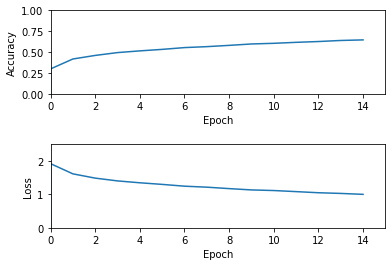

In [ ]:
import torch
import torchvision
from torch.utils.tensorboard import SummaryWriter
from torchvision import datasets, transforms
from torch.optim import AdamW
from torchvision.datasets import CIFAR10
import cv2
import sys
import os
import numpy as np
import random
import skimage
import PIL
import os
import glob
import random
from skimage import data, exposure, img_as_float
import matplotlib.pyplot as plt
import numpy as np
import time
from torchvision.transforms import ToTensor
import argparse
import shutil
import string
from termcolor import colored, cprint
import math as m
from tqdm.notebook import tqdm


def SetupAll(CheckPointPath):
    """
    Inputs: 
    CheckPointPath - Path to save checkpoints/model
    Outputs:
    SaveCheckPoint - Save checkpoint every SaveCheckPoint iteration in every epoch, checkpoint saved automatically after every epoch
    ImageSize - Size of the image
    NumTrainSamples - length(Train)
    TrainLabels - Labels corresponding to Train
    NumClasses - Number of classes
    """
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    # Read and Setup Labels 
    LabelsPathTrain = '/Phase2/Code/TxtFiles/LabelsTrain.txt'
    TrainLabels = ReadLabels(LabelsPathTrain)
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

    # If CheckPointPath doesn't exist make the path
    if(not (os.path.isdir(CheckPointPath))):
       os.makedirs(CheckPointPath)
        
    # Save checkpoint every SaveCheckPoint iteration in every epoch, checkpoint saved automatically after every epoch
    SaveCheckPoint = 500 
    
    # Image Input Shape
    ImageSize = [32, 32, 3]
    NumTrainSamples = len(TrainSet)

    # Number of classes
    NumClasses = 10

    return SaveCheckPoint, ImageSize, NumTrainSamples, TrainLabels, NumClasses


def ReadLabels(LabelsPathTrain):
    if(not (os.path.isfile(LabelsPathTrain))):
        print('ERROR: Train Labels do not exist in '+LabelsPathTrain)
        sys.exit()
    else:
        TrainLabels = open(LabelsPathTrain, 'r')
        TrainLabels = TrainLabels.read()
        TrainLabels = map(float, TrainLabels.split())

    return TrainLabels
    

def ReadDirNames(ReadPath):
    """
    Inputs: 
    ReadPath is the path of the file you want to read
    Outputs:
    DirNames is the data loaded from /content/data/TxtFiles/DirNames.txt which has full path to all image files without extension
    """
    # Read text files
    DirNames = open(ReadPath, 'r')
    DirNames = DirNames.read()
    DirNames = DirNames.split()
    return DirNames

    
def GenerateBatch(TrainSet, TrainLabels, ImageSize, MiniBatchSize):
    """
    Inputs: 
    TrainSet - Variable with Subfolder paths to train files
    NOTE that Train can be replaced by Val/Test for generating batch corresponding to validation (held-out testing in this case)/testing
    TrainLabels - Labels corresponding to Train
    NOTE that TrainLabels can be replaced by Val/TestLabels for generating batch corresponding to validation (held-out testing in this case)/testing
    ImageSize is the Size of the Image
    MiniBatchSize is the size of the MiniBatch
   
    Outputs:
    I1Batch - Batch of images
    LabelBatch - Batch of one-hot encoded labels 
    """
    I1Batch = []
    LabelBatch = []
    
    ImageNum = 0
    while ImageNum < MiniBatchSize:
        # Generate random image
        RandIdx = random.randint(0, len(TrainSet)-1)
        
        ImageNum += 1

        I1, Label = TrainSet[RandIdx]

        # Append All Images and Mask
        I1Batch.append(I1)
        LabelBatch.append(torch.tensor(Label))
        
    return torch.stack(I1Batch), torch.stack(LabelBatch)


def PrettyPrint(NumEpochs, DivTrain, MiniBatchSize, NumTrainSamples, LatestFile):
    """
    Prints all stats with all arguments
    """
    print('Number of Epochs Training will run for ' + str(NumEpochs))
    print('Factor of reduction in training data is ' + str(DivTrain))
    print('Mini Batch Size ' + str(MiniBatchSize))
    print('Number of Training Images ' + str(NumTrainSamples))
    if LatestFile is not None:
        print('Loading latest checkpoint with the name ' + LatestFile)              

def TrainOperation(TrainLabels, NumTrainSamples, ImageSize,
                   NumEpochs, MiniBatchSize, SaveCheckPoint, CheckPointPath,
                   DivTrain, LatestFile, TrainSet, LogsPath):
    """
    Inputs: 
    TrainLabels - Labels corresponding to Train/Test
    NumTrainSamples - length(Train)
    ImageSize - Size of the image
    NumEpochs - Number of passes through the Train data
    MiniBatchSize is the size of the MiniBatch
    SaveCheckPoint - Save checkpoint every SaveCheckPoint iteration in every epoch, checkpoint saved automatically after every epoch
    CheckPointPath - Path to save checkpoints/model
    DivTrain - Divide the data by this number for Epoch calculation, use if you have a lot of dataor for debugging code
    LatestFile - Latest checkpointfile to continue training
    TrainSet - The training dataset
    LogsPath - Path to save Tensorboard Logs
    Outputs:
    Saves Trained network in CheckPointPath and Logs to LogsPath
    """
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    # Initialize the model
    model = CIFAR10Model(InputSize=3*32*32,OutputSize=10) 
    import torch.optim as optim
    Optimizer =optim.Adam(model.parameters(), lr=0.0001,betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False, foreach=None, maximize=False, capturable=False)
    #ptimizer =optim.SGD(model.parameters(), lr=0.0001,momentum=0.9)
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    
    
    # Tensorboard
    # Create a summary to monitor loss tensor
    
    LossOverEpochs = np.array([0,0])
    AccOverEpochs = np.array([0,0])
    Writer = SummaryWriter(LogsPath)

    if LatestFile is not None:
        CheckPoint = torch.load(CheckPointPath + LatestFile + '.ckpt')
        # Extract only numbers from the name
        StartEpoch = int(''.join(c for c in LatestFile.split('a')[0] if c.isdigit()))
        model.load_state_dict(CheckPoint['model_state_dict'])
        print('Loaded latest checkpoint with the name ' + LatestFile + '....')
    else:
        StartEpoch = 0
        print('New model initialized....')
        
    for Epochs in tqdm(range(StartEpoch, NumEpochs)):
        epoch_loss = []
        epoch_acc = []
        NumIterationsPerEpoch = int(NumTrainSamples/MiniBatchSize/DivTrain)
        for PerEpochCounter in tqdm(range(NumIterationsPerEpoch)):
            Batch = GenerateBatch(TrainSet, TrainLabels, ImageSize, MiniBatchSize)
            
            # Predict output with forward pass
            LossThisBatch = model.training_step(Batch)

            Optimizer.zero_grad()
            LossThisBatch.backward()
            Optimizer.step()
            
            # Save checkpoint every some SaveCheckPoint's iterations
            if PerEpochCounter % SaveCheckPoint == 0:
                # Save the Model learnt in this epoch
                SaveName =  CheckPointPath + str(Epochs) + 'a' + str(PerEpochCounter) + 'model.ckpt'
                
                torch.save({'epoch': Epochs,'model_state_dict': model.state_dict(),'optimizer_state_dict': Optimizer.state_dict(),'loss': LossThisBatch}, SaveName)
                print('\n' + SaveName + ' Model Saved...')

            result = model.validation_step(Batch)
            model.epoch_end(Epochs*NumIterationsPerEpoch + PerEpochCounter, result)
            epoch_acc.append(result["acc"])
            epoch_loss.append(result["loss"])
            # Tensorboard
            Writer.add_scalar('LossEveryIter', result["loss"], Epochs*NumIterationsPerEpoch + PerEpochCounter)
            Writer.add_scalar('Accuracy', result["acc"], Epochs*NumIterationsPerEpoch + PerEpochCounter)
            
        
            # If you don't flush the tensorboard doesn't update until a lot of iterations!
            Writer.flush()

        # Save model every epoch
        SaveName = CheckPointPath + str(Epochs) + 'model.ckpt'
        torch.save({'epoch': Epochs,'model_state_dict': model.state_dict(),'optimizer_state_dict': Optimizer.state_dict(),'loss': LossThisBatch}, SaveName)
        print("Epoch accuracy is:", np.mean(epoch_acc)*100,"%.")
        #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
        LossOverEpochs=np.vstack((LossOverEpochs,[Epochs,np.mean(epoch_loss)]))
        AccOverEpochs=np.vstack((AccOverEpochs,[Epochs,np.mean(epoch_acc)]))
        plt.subplot(2,1,1)
        plt.xlim(0, NumEpochs)
        plt.ylim(0,1)
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.subplots_adjust(hspace=0.6,wspace=0.3)
        plt.plot(AccOverEpochs[:,0],AccOverEpochs[:,1])
        plt.subplot(2,1,2)
        plt.xlim(0, NumEpochs)
        plt.ylim(0,2.5)
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.plot(LossOverEpochs[:,0], LossOverEpochs[:,1])
        plt.show()
        plt.close() 
        #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

# Default Hyperparameters
#!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
NumEpochs = 15
TrainSet = torchvision.datasets.CIFAR10(root='./data', train=True,download=True, transform=ToTensor())
DivTrain = 2
MiniBatchSize = 3
LoadCheckPoint = 0
CheckPointPath = "/Phase2/Checkpoints/" #!!!!!!!!!!!!!!!!!!Check directory
LogsPath = "/Phase2/Logs"
#!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

# Setup all needed parameters including file reading
SaveCheckPoint, ImageSize, NumTrainSamples, TrainLabels, NumClasses = SetupAll(CheckPointPath)

# Find Latest Checkpoint File
if LoadCheckPoint==1:
    LatestFile = FindLatestModel(CheckPointPath)
else:
    LatestFile = None

# Pretty print stats
PrettyPrint(NumEpochs, DivTrain, MiniBatchSize, NumTrainSamples, LatestFile)

TrainOperation(TrainLabels, NumTrainSamples, ImageSize,
                NumEpochs, MiniBatchSize, SaveCheckPoint, CheckPointPath,
                DivTrain, LatestFile, TrainSet, LogsPath)

  0%|          | 0/15 [00:00<?, ?it/s]

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 42.07%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%

Files already downloaded and verified
Number of parameters in this model are 10 


  0%|          | 0/10000 [00:00<?, ?it/s]

Accuracy: 54.27%



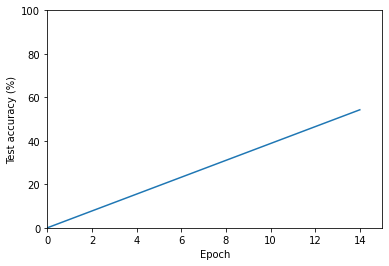

[626  35  29   9  35   3  17  11 213  22] (0)
[ 44 711   3  10   8   3  19   5 132  65] (1)
[102  24 304  78 235  46  90  47  58  16] (2)
[ 43  21  54 373 127 116 126  55  58  27] (3)
[ 56  13  79  50 544  28 104  76  43   7] (4)
[ 22   8  62 238 113 344  53  90  52  18] (5)
[ 15  25  31  50 127  13 695  10  24  10] (6)
[ 49  14  24  75 117  55  27 574  17  48] (7)
[ 84  51   6  14  10   6   3   5 803  18] (8)
[ 66 218  15  19   9   7  29  23 161 453] (9)
 (0) (1) (2) (3) (4) (5) (6) (7) (8) (9)
Accuracy: 54.27 %


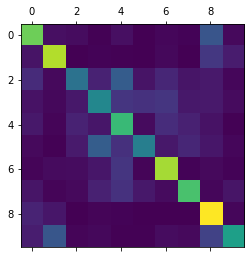

In [ ]:
import cv2
import os
import sys
import glob
import random
from skimage import data, exposure, img_as_float
import matplotlib.pyplot as plt
import numpy as np
import time
from torchvision.transforms import ToTensor
import argparse
import shutil
import string
import math as m
from sklearn.metrics import confusion_matrix
from tqdm.notebook import tqdm
import torch

def SetupAll():
    """
    Outputs:
    ImageSize - Size of the Image
    """   
    # Image Input Shape
    ImageSize = [32, 32, 3]

    return ImageSize

def StandardizeInputs(Img):
    return Img
    
def ReadImages(Img):
    """
    Outputs:
    I1Combined - I1 image after any standardization and/or cropping/resizing to ImageSize
    I1 - Original I1 image for visualization purposes only
    """    
    I1 = Img
    
    if(I1 is None):
        # OpenCV returns empty list if image is not read! 
        print('ERROR: Image I1 cannot be read')
        sys.exit()
        
    I1S = StandardizeInputs(np.float32(I1))

    I1Combined = np.expand_dims(I1S, axis=0)

    return I1Combined, I1
                

def TestOperation(ImageSize, ModelPath, TestSet, LabelsPathPred):
    """
    Inputs: 
    ImageSize is the size of the image
    ModelPath - Path to load trained model from
    TestSet - The test dataset
    LabelsPathPred - Path to save predictions
    Outputs:
    Predictions written to /content/data/TxtFiles/PredOut.txt
    """
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    # Predict output with forward pass, MiniBatchSize for Test is 1
    model = CIFAR10Model(InputSize=3*32*32,OutputSize=10) 
    #!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
    
    CheckPoint = torch.load(ModelPath)
    model.load_state_dict(CheckPoint['model_state_dict'])
    print('Number of parameters in this model are %d ' % len(model.state_dict().items()))
    
    OutSaveT = open(LabelsPathPred, 'w')

    for count in tqdm(range(len(TestSet))):
        Img, Label = TestSet[count]
        Img, ImgOrg = ReadImages(Img)
        #print(type(ImgOrg))
        
        #Img = ImgOrg.unsqueeze(0)
        PredT = torch.argmax(model(torch.from_numpy(Img))).item()

        OutSaveT.write(str(PredT)+'\n')
    OutSaveT.close()

def Accuracy(Pred, GT):
    """
    Inputs: 
    Pred are the predicted labels
    GT are the ground truth labels
    Outputs:
    Accuracy in percentage
    """
    return (np.sum(np.array(Pred)==np.array(GT))*100.0/len(Pred))

def ReadLabels(LabelsPathTest, LabelsPathPred):
    if(not (os.path.isfile(LabelsPathTest))):
        print('ERROR: Test Labels do not exist in '+LabelsPathTest)
        sys.exit()
    else:
        LabelTest = open(LabelsPathTest, 'r')
        LabelTest = LabelTest.read()
        LabelTest = map(float, LabelTest.split())

    if(not (os.path.isfile(LabelsPathPred))):
        print('ERROR: Pred Labels do not exist in '+LabelsPathPred)
        sys.exit()
    else:
        LabelPred = open(LabelsPathPred, 'r')
        LabelPred = LabelPred.read()
        LabelPred = map(float, LabelPred.split())
        
    return LabelTest, LabelPred

def ConfusionMatrix(LabelsTrue, LabelsPred):
    """
    LabelsTrue - True labels
    LabelsPred - Predicted labels
    """

    # Get the confusion matrix using sklearn.
    #LabelsTrue, LabelsPred = list(LabelsTrue), list(LabelsPred)
    cm = confusion_matrix(y_true=LabelsTrue, y_pred=LabelsPred)  # Predicted class.

    # Print the confusion matrix as text.
    for i in range(10):
        print(str(cm[i, :]) + ' ({0})'.format(i))

    # Print the class-numbers for easy reference.
    class_numbers = [" ({0})".format(i) for i in range(10)]
    print("".join(class_numbers))

    print('Accuracy: '+ str(Accuracy(LabelsPred, LabelsTrue)), '%')
    plt.matshow(cm)
    

accTestOverEpochs=np.array([0,0])
for epoch in tqdm(range(NumEpochs)):
    ModelPath = "/Phase2/Checkpoints/29a4000model.ckpt"
    LabelsPath = "/Phase2/Code/TxtFiles/LabelsTest.txt"
    TestSet = CIFAR10(root="/Phase2/CIFAR10/Test2/", download=True, train=False, transform=ToTensor())

  # Setup all needed parameters including file reading
    ImageSize = SetupAll()


  # Define PlaceHolder variables for Input and Predicted output
    LabelsPathPred = '/Phase2/Code/TxtFiles/PredOut.txt' # Path to save predicted labels
    TestOperation(ImageSize, ModelPath, TestSet, LabelsPathPred)
    LabelsTrue, LabelsPred = ReadLabels(LabelsPath, LabelsPathPred)
        # for Python 3: change 'map' to 'list'
    LabelsTrue = list(LabelsTrue)
    LabelsPred = list(LabelsPred)
    accuracy=Accuracy(LabelsTrue, LabelsPred)
    print('Accuracy: ' + str(accuracy) + '%\n')
#!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!    
accTestOverEpochs=np.vstack((accTestOverEpochs,[epoch,accuracy]))    
plt.xlim(0,NumEpochs)
plt.ylim(0,100)
plt.xlabel('Epoch')
plt.ylabel('Test accuracy (%)')
plt.subplots_adjust(hspace=0.6,wspace=0.3)
plt.plot(accTestOverEpochs[:,0],accTestOverEpochs[:,1])
plt.show()
#plt.savefig('Test_graph/'+NetworkType+'_Epoch_acc.png')
plt.close()

ConfusionMatrix(LabelsTrue, LabelsPred)
#!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

In [ ]:
%load_ext tensorboard
%tensorboard --logdir="D:/CV_RBE/HW0/YourDirectoryID_hw0/YourDirectoryID_hw0/Phase2/Logs"